# 1. One-hot encoding of words or characters

## 1.1 Word level one-hot encoding

In [2]:
#Word level one-hot encoding (toy example)

import numpy as np

# This is our initial data; one entry per "sample"
# (in this toy example, a "sample" is just a sentence, but
# it could be an entire document).
samples = ['The cat sat on the mat.', 'The dog ate my homework.']

# First, build an index of all tokens in the data.
token_index = {}
for sample in samples:
    # We simply tokenize the samples via the `split` method.
    # in real life, we would also strip punctuation and special characters
    # from the samples.
    for word in sample.split():
        if word not in token_index:
            # Assign a unique index to each unique word
            token_index[word] = len(token_index) + 1
            # Note that we don't attribute index 0 to anything.
        
# Next, we vectorize our samples. 
# We will only consider the first `max_length` words in each sample.
max_length = 10

# This is where we store our results:
results = np.zeros((len(samples), max_length, max(token_index.values()) + 1))
for i, sample in enumerate(samples):
    for j, word in list(enumerate(sample.split()))[:max_length]:
        index = token_index.get(word)
        results[i, j, index] = 1.

In [5]:
results[1]

array([[ 0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.],
       [ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]])

## 1.2 Character level one-hot encoding

In [17]:
import string

samples = ['The cat sat on the mat.', 'The dog ate my homework.']
characters = string.printable # All printable ASCII characters.
token_index = dict(zip(characters,range(1, len(characters) + 1)))

max_length = 50
results = np.zeros((len(samples), max_length, max(token_index.values()) + 1))
for i, sample in enumerate(samples):
    for j, character in enumerate(sample):
        index = token_index.get(character)
        results[i, j, index] = 1.

In [19]:
results[0]

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

## 1.3 Using Keras for word-level one-hot encoding 

In [20]:
from keras.preprocessing.text import Tokenizer

samples = ['The cat sat on the mat.', 'The dog ate my homework.']

# We create a tokenizer, configured to only take
# into account the top-1000 most common on words
tokenizer = Tokenizer(num_words=1000)

# This builds the word index
tokenizer.fit_on_texts(samples)

# This turns strings into lists of integer indices.
sequences = tokenizer.texts_to_sequences(samples)

# You could also directly get the one-hot binary representations.
# Note that other vectorization modes than one-hot encoding are supported!
one_hot_results = tokenizer.texts_to_matrix(samples, mode='binary')

# This is how you can recover the word index that was computed
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Using TensorFlow backend.


Found 9 unique tokens.


In [24]:
one_hot_results.shape

(2, 1000)

# 2. Word Embeddings 

While the vectors obtained through
one-hot encoding are binary, sparse (mostly made of zeros) and very high-dimensional
(same dimensionality as the number of words in the vocabulary), "word embeddings" are
low-dimensional floating point vectors (i.e. "dense" vectors, as opposed to sparse
vectors). Unlike word vectors obtained via one-hot encoding, word embeddings are
learned from data.

There are two ways to obtain word embeddings:
* Learn word embeddings jointly with the main task you care about (e.g. document classification or sentiment prediction). In this setup, you would start with random word vectors, then learn your word vectors in the same way that you learn the weights of a neural network.
* Load into your model word embeddings that were pre-computed using a different machine learning task than the one you are trying to solve. These are called "pre-trained word embeddings".

## 2.1 Learning Word Embedding with the EMBEDDING Layer

In [ ]:
#Instantiating an Embedding layer.
from keras.layers import Embedding

# The Embedding layer takes at least two arguments:
# the number of possible tokens, here 1000 (1 + maximum word index),
# and the dimensionality of the embeddings, here 64.
embedding_layer = Embedding(1000, 64)

In [25]:
#Loading the IMDB data for use with an Embedding layer.

from keras.datasets import imdb
from keras import preprocessing

# Number of words to consider as features
max_features = 10000

# Cut texts after this number of words
# (among top max_features most common words)
maxlen = 20

# Load the data as lists of integers.
(x_train, y_train), (x_test, y_test) = imdb.load_data(num_words=max_features)

# This turns our lists of integers
# into a 2D integer tensor of shape `(samples, maxlen)`
x_train = preprocessing.sequence.pad_sequences(x_train, maxlen=maxlen)
x_test = preprocessing.sequence.pad_sequences(x_test, maxlen=maxlen)

In [27]:
x_train[1]

array([  63,    9,   38,  527,   15,   45, 1322,   78,  116,   78,  114,
          5,   78,  548, 3822,   97, 2344,  513,    6, 2803], dtype=int32)

In [29]:
#Using an Embedding layer and classifier on the IMDB data.

from keras.models import Sequential
from keras.layers import Flatten, Dense
from keras.layers import Embedding

model = Sequential()
# We specify the maximum input length to our Embedding layer
# so we can later flatten the embedded inputs
model.add(Embedding(10000, 8, input_length=maxlen))

# After the Embedding layer,
# our activations have shape `(samples, maxlen, 8)`.

# We flatten the 3D tensor of embeddings
# into a 2D tensor of shape `(samples, maxlen * 8)`
model.add(Flatten())

# We add the classifier on top
model.add(Dense(1, activation='sigmoid'))
model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['acc'])
model.summary()
history = model.fit(x_train, y_train,
                epochs=10,
                batch_size=32,
                validation_split=0.2)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 20, 8)             80000     
_________________________________________________________________
flatten_1 (Flatten)          (None, 160)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 161       
Total params: 80,161
Trainable params: 80,161
Non-trainable params: 0
_________________________________________________________________
Train on 20000 samples, validate on 5000 samples
Epoch 1/10
20000/20000 [==============================] - 1s 53us/step - loss: 0.6685 - acc: 0.6298 - val_loss: 0.6150 - val_acc: 0.7076
Epoch 2/10
20000/20000 [==============================] - 1s 49us/step - loss: 0.5398 - acc: 0.7507 - val_loss: 0.5123 - val_acc: 0.7490
Epoch 3/10
20000/20000 [==============================] - 1s 48us/step - loss: 

## 2.2 From raw text to word embeddings

In [1]:
#Processing the labels of the raw IMDB data
#the raw data can be downloaded from ai.stanford.edu/~amaas/data/sentiment/

import os

imdb_dir = 'aclImdb'
train_dir = os.path.join(imdb_dir, 'train')

labels = []
texts = []

for label_type in ['neg', 'pos']:
    dir_name = os.path.join(train_dir, label_type)
    for fname in os.listdir(dir_name):
        if fname[-4:] == '.txt':
            f = open(os.path.join(dir_name, fname))
            texts.append(f.read())
            f.close()
        if label_type == 'neg':
            labels.append(0)
        else:
            labels.append(1)

In [15]:
#Tokenizing the text of the raw IMDB data

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import numpy as np

maxlen = 100 # We will cut reviews after 100 words
training_samples = 200 # We will be training on 200 samples
validation_samples = 10000 # We will be validating on 10000 samples
max_words = 10000 # We will only consider the top 10,000 words in the dataset

tokenizer = Tokenizer(num_words=max_words)
tokenizer.fit_on_texts(texts)
sequences = tokenizer.texts_to_sequences(texts)

word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

data = pad_sequences(sequences, maxlen=maxlen)
labels = np.asarray(labels)
print('Shape of data tensor:', data.shape)
print('Shape of label tensor:', labels.shape)

# Split the data into a training set and a validation set
# But first, shuffle the data, since we started from data
# where sample are ordered (all negative first, then all positive).
indices = np.arange(data.shape[0])
np.random.shuffle(indices)
data = data[indices]
labels = labels[indices]
x_train = data[:training_samples]
y_train = labels[:training_samples]
x_val = data[training_samples: training_samples + validation_samples]
y_val = labels[training_samples: training_samples + validation_samples]

Found 88584 unique tokens.
('Shape of data tensor:', (25000, 100))
('Shape of label tensor:', (25000,))


In [10]:
#Parsing the GloVe word embeddings file
#the pre-trained word embedding can be downloaed from nlp.stanford.edu/projects/glove/

glove_dir = 'glove'
embeddings_index = {}
f = open(os.path.join(glove_dir, 'glove.6B.100d.txt'))
for line in f:
#     print(line)
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


In [4]:
#Preparing the GloVe word embeddings matrix

embedding_dim = 100

embedding_matrix = np.zeros((max_words, embedding_dim))

for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if i < max_words:
        if embedding_vector is not None:
            # Words not found in embedding index will be all-zeros.
            embedding_matrix[i] = embedding_vector

In [5]:
#Model definition
from keras.models import Sequential
from keras.layers import Embedding, Flatten, Dense

model = Sequential()
model.add(Embedding(max_words, embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.summary()


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 100, 100)          1000000   
_________________________________________________________________
flatten_1 (Flatten)          (None, 10000)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                320032    
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 33        
Total params: 1,320,065
Trainable params: 1,320,065
Non-trainable params: 0
_________________________________________________________________


In [6]:
#Loading the matrix of pre-trained word embeddings into the Embedding layer

model.layers[0].set_weights([embedding_matrix])
model.layers[0].trainable = False

In [11]:
#Training and evaluation
import h5py
model.compile(optimizer='rmsprop',
                loss='binary_crossentropy',
                metrics=['acc'])
history = model.fit(x_train, y_train,
                    epochs=10,
                    batch_size=32,
                    validation_data=(x_val, y_val))
model.save_weights('pre_trained_glove_model.h5')

Train on 10000 samples, validate on 10000 samples
Epoch 1/10
10000/10000 [==============================] - 2s 218us/step - loss: 0.8312 - acc: 0.4992 - val_loss: 0.6939 - val_acc: 0.4956
Epoch 2/10
10000/10000 [==============================] - 2s 195us/step - loss: 0.6868 - acc: 0.5587 - val_loss: 0.7106 - val_acc: 0.4935
Epoch 3/10
10000/10000 [==============================] - 2s 190us/step - loss: 0.6519 - acc: 0.6136 - val_loss: 0.7367 - val_acc: 0.5001
Epoch 4/10
10000/10000 [==============================] - 2s 196us/step - loss: 0.5909 - acc: 0.6849 - val_loss: 0.7905 - val_acc: 0.4943
Epoch 5/10
10000/10000 [==============================] - 2s 194us/step - loss: 0.5303 - acc: 0.7333 - val_loss: 0.8732 - val_acc: 0.4909
Epoch 6/10
10000/10000 [==============================] - 2s 193us/step - loss: 0.4681 - acc: 0.7710 - val_loss: 0.8548 - val_acc: 0.4937
Epoch 7/10
10000/10000 [==============================] - 2s 196us/step - loss: 0.3978 - acc: 0.8133 - val_loss: 1.0200 - 

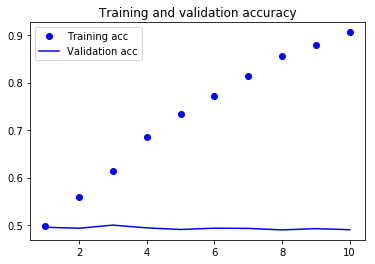

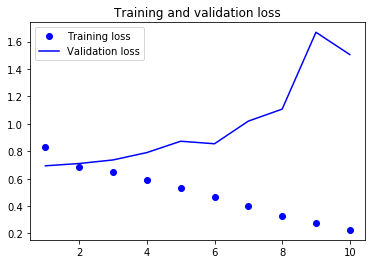

In [12]:
#Plotting results

import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [16]:
#Defining a training the same model without pre-trained word embeddings

from keras.models import Sequential
from keras.layers import Embedding, Flatten, Dense

model = Sequential()
model.add(Embedding(max_words, embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.summary()

model.compile(optimizer='rmsprop',
                loss='binary_crossentropy',
                metrics=['acc'])
history = model.fit(x_train, y_train,
                    epochs=10,
                    batch_size=32,
                    validation_data=(x_val, y_val))

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 100, 100)          1000000   
_________________________________________________________________
flatten_3 (Flatten)          (None, 10000)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 32)                320032    
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 33        
Total params: 1,320,065
Trainable params: 1,320,065
Non-trainable params: 0
_________________________________________________________________
Train on 200 samples, validate on 10000 samples
Epoch 1/10
200/200 [==============================] - 1s 4ms/step - loss: 0.6939 - acc: 0.4900 - val_loss: 0.6936 - val_acc: 0.5079
Epoch 2/10
200/200 [==============================] - 1s 3ms/step - loss: 0.4840 - a

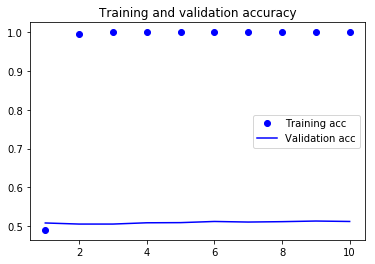

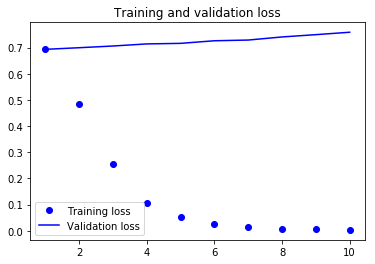

In [17]:
#Plotting results

import matplotlib.pyplot as plt

acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

In [18]:
#Tokenizing the data of the test set

test_dir = os.path.join(imdb_dir, 'test')
labels = []
texts = []
for label_type in ['neg', 'pos']:
    dir_name = os.path.join(test_dir, label_type)
    for fname in sorted(os.listdir(dir_name)):
        if fname[-4:] == '.txt':
            f = open(os.path.join(dir_name, fname))
            texts.append(f.read())
            f.close()
        if label_type == 'neg':
            labels.append(0)
        else:
            labels.append(1)
            
sequences = tokenizer.texts_to_sequences(texts)
x_test = pad_sequences(sequences, maxlen=maxlen)
y_test = np.asarray(labels)

In [19]:
#Evaluating the model on the test set

model.load_weights('pre_trained_glove_model.h5')
model.evaluate(x_test, y_test)

25000/25000 [==============================] - 2s 66us/step


[1.4789756767845155, 0.49003999999999998]

# 3. RNN (Recurrent Neural Networks)

## 3.1 Numpy implementation of a simple RNN

In [23]:
#Numpy implementation of a simple RNN

timesteps = 100 # Number of timesteps in the input sequence
input_features = 32 # Dimensionality of the input feature space
output_features = 64 # Dimensionality of the output feature space

# This is our input data - just random noise for the sake of our example.
inputs = np.random.random((timesteps, input_features))

# This is our "initial state": an all-zero vector.
state_t = np.zeros((output_features,))

# Create random weight matrices
W = np.random.random((input_features, output_features))
U = np.random.random((output_features, output_features))
b = np.random.random((output_features,))

successive_outputs = []
for input_t in inputs: # input_t is a vector of shape (input_features,)
    # We combine the input with the current state
    # (i.e. the previous output) to obtain the current output.
    output_t = np.tanh(np.dot(input_t, W) + np.dot(state_t,U) + b)
    # We store this output in a list.
    successive_outputs.append(output_t)
    # We update the "state" of the network for the next timestep
    state_t = output_t
    
# The final output is a 2D tensor of shape (timesteps, output_features).
final_output_sequence = np.concatenate(successive_outputs, axis=0)

In [35]:
final_output_sequence = final_output_sequence.reshape(timesteps,output_features)

## 3.2 Using SimpleRNN and returning the last / full state

In [39]:
from keras.models import Sequential
from keras.layers import Embedding, SimpleRNN


model = Sequential()
model.add(Embedding(10000, 32))
model.add(SimpleRNN(32)) #return the last state
model.summary()


model = Sequential()
model.add(Embedding(10000, 32))
model.add(SimpleRNN(32, return_sequences=True)) #return the full state
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_4 (Embedding)      (None, None, 32)          320000    
_________________________________________________________________
simple_rnn_1 (SimpleRNN)     (None, 32)                2080      
Total params: 322,080
Trainable params: 322,080
Non-trainable params: 0
_________________________________________________________________


## 3.3 SimpleRNN for IMDB movie review classification

### 3.3.1 Preparing the IMDB data

In [40]:
# Preparing the IMDB data

from keras.datasets import imdb
from keras.preprocessing import sequence

max_features = 10000 # number of words to consider as features
maxlen = 500 # cut texts after this number of words (among top max_features most common words)
batch_size = 32

print('Loading data...')
(input_train, y_train), (input_test, y_test) = imdb.load_data(num_words=max_features)
print(len(input_train), 'train sequences')
print(len(input_test), 'test sequences')
print('Pad sequences (samples x time)')
input_train = sequence.pad_sequences(input_train, maxlen=maxlen)
input_test = sequence.pad_sequences(input_test, maxlen=maxlen)
print('input_train shape:', input_train.shape)
print('input_test shape:', input_test.shape)

Loading data...
(25000, 'train sequences')
(25000, 'test sequences')
Pad sequences (samples x time)
('input_train shape:', (25000, 500))
('input_test shape:', (25000, 500))


### 3.3.2 Training the model including an Embedding layer and a SimpleRNN layer

In [41]:
from keras.layers import Dense

model = Sequential()
model.add(Embedding(max_features, 32))
model.add(SimpleRNN(32))
model.add(Dense(1, activation='sigmoid'))
model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['acc'])
history = model.fit(input_train, y_train,
                    epochs=10,
                    batch_size=128,
                    validation_split=0.2)

Train on 20000 samples, validate on 5000 samples
Epoch 1/10
20000/20000 [==============================] - 15s 769us/step - loss: 0.6343 - acc: 0.6270 - val_loss: 0.4395 - val_acc: 0.8140
Epoch 2/10
20000/20000 [==============================] - 15s 760us/step - loss: 0.3939 - acc: 0.8334 - val_loss: 1.2827 - val_acc: 0.5380
Epoch 3/10
20000/20000 [==============================] - 15s 762us/step - loss: 0.3659 - acc: 0.8524 - val_loss: 0.3500 - val_acc: 0.8548
Epoch 4/10
20000/20000 [==============================] - 15s 763us/step - loss: 0.2432 - acc: 0.9068 - val_loss: 0.3222 - val_acc: 0.8826
Epoch 5/10
20000/20000 [==============================] - 15s 762us/step - loss: 0.1925 - acc: 0.9280 - val_loss: 0.3491 - val_acc: 0.8560
Epoch 6/10
20000/20000 [==============================] - 15s 761us/step - loss: 0.1457 - acc: 0.9471 - val_loss: 0.4069 - val_acc: 0.8422
Epoch 7/10
20000/20000 [==============================] - 15s 762us/step - loss: 0.1142 - acc: 0.9597 - val_loss: 0.3

In [44]:
import matplotlib.pyplot as plt

def plotResults(history):
    acc = history.history['acc']
    val_acc = history.history['val_acc']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(1, len(acc) + 1)

    plt.plot(epochs, acc, 'bo', label='Training acc')
    plt.plot(epochs, val_acc, 'b', label='Validation acc')
    plt.title('Training and validation accuracy')
    plt.legend()

    plt.figure()

    plt.plot(epochs, loss, 'bo', label='Training loss')
    plt.plot(epochs, val_loss, 'b', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()

    plt.show()

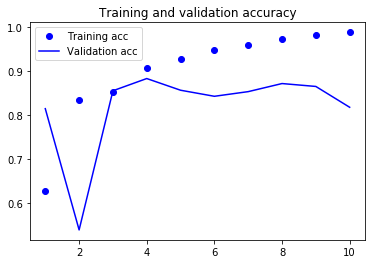

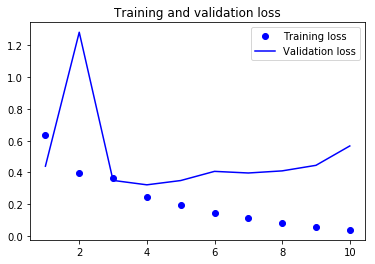

In [45]:
plotResults(history)

## 3.4 LSTM for IMDB movie review classification

In [46]:
from keras.layers import LSTM

model = Sequential()
model.add(Embedding(max_features, 32))
model.add(LSTM(32))
model.add(Dense(1, activation='sigmoid'))

model.compile(optimizer='rmsprop',
                loss='binary_crossentropy',
                metrics=['acc'])
history = model.fit(input_train, y_train,
                    epochs=10,
                    batch_size=128,
                    validation_split=0.2)

Train on 20000 samples, validate on 5000 samples
Epoch 1/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.5374 - acc: 0.7475 - val_loss: 0.4261 - val_acc: 0.8150
Epoch 2/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.3123 - acc: 0.8751 - val_loss: 0.3257 - val_acc: 0.8564
Epoch 3/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.2385 - acc: 0.9084 - val_loss: 0.4985 - val_acc: 0.7970
Epoch 4/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.2085 - acc: 0.9232 - val_loss: 0.4143 - val_acc: 0.8116
Epoch 5/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.1824 - acc: 0.9326 - val_loss: 0.3459 - val_acc: 0.8874
Epoch 6/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.1635 - acc: 0.9401 - val_loss: 0.3430 - val_acc: 0.8630
Epoch 7/10
20000/20000 [==============================] - 45s 2ms/step - loss: 0.1477 - acc: 0.9464 - val_loss: 0.4232 - val_acc:

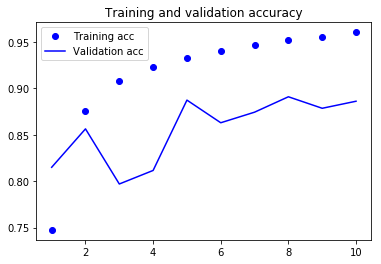

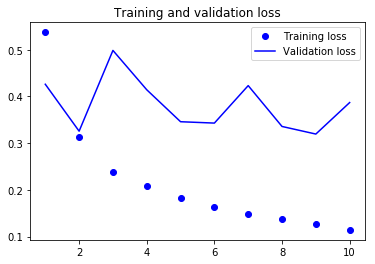

In [47]:
plotResults(history)

In [55]:
!wget https://s3.amazonaws.com/keras-datasets/jena_climate_2009_2016.csv.zip

--2017-12-08 13:37:47--  https://s3.amazonaws.com/keras-datasets/jena_climate_2009_2016.csv.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.128.157
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.128.157|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13568290 (13M) [application/zip]
Saving to: ‘jena_climate_2009_2016.csv.zip’

100%[======================================>] 13,568,290  1.91MB/s   in 23s    

2017-12-08 13:38:12 (564 KB/s) - ‘jena_climate_2009_2016.csv.zip’ saved [13568290/13568290]



In [57]:
!unzip jena_climate_2009_2016.csv.zip -d jena_climates/

Archive:  jena_climate_2009_2016.csv.zip
  inflating: jena_climates/jena_climate_2009_2016.csv  


# 4. Temperature Forecasting

## 4.1 Inspecting the data of the Jena weather dataset

In [64]:
import os

data_dir = 'jena_climates'
fname = os.path.join(data_dir, 'jena_climate_2009_2016.csv')

f = open(fname)
data = f.read()
f.close()

lines = data.split('\n')
header = lines[0].split(',')
lines = lines[1:]

print(header)
print(len(lines))

['"Date Time"', '"p (mbar)"', '"T (degC)"', '"Tpot (K)"', '"Tdew (degC)"', '"rh (%)"', '"VPmax (mbar)"', '"VPact (mbar)"', '"VPdef (mbar)"', '"sh (g/kg)"', '"H2OC (mmol/mol)"', '"rho (g/m**3)"', '"wv (m/s)"', '"max. wv (m/s)"', '"wd (deg)"']
420551


In [65]:
#Parsing the data

import numpy as np

float_data = np.zeros((len(lines), len(header) - 1))

for i, line in enumerate(lines):
    values = [float(x) for x in line.split(',')[1:]]
    float_data[i, :] = values

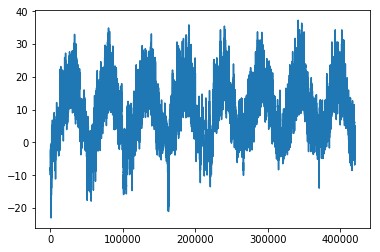

In [66]:
#Plotting the temperature timeseries

from matplotlib import pyplot as plt
temp = float_data[:, 1] # temperature (in degrees Celsius)
plt.plot(range(len(temp)), temp)
plt.show()

In [67]:
#Normalizing the data

mean = float_data[:200000].mean(axis=0)
float_data -= mean
std = float_data[:200000].std(axis=0)
float_data /= std

In [74]:
#Generator yielding timeseries samples and their targets

def generator(data, lookback, delay, min_index, max_index, shuffle=False, batch_size=128, step=6):
    if max_index is None:
        max_index = len(data) - delay - 1
    i = min_index + lookback
    while 1:
        if shuffle:
            rows = np.random.randint(min_index + lookback, max_index, size=batch_size)
#             print rows
        else:
            if i + batch_size >= max_index:
                i = min_index + lookback
            rows = np.arange(i, min(i + batch_size, max_index))
            i += len(rows)
            
        samples = np.zeros((len(rows), lookback // step, data.shape[-1]))
        targets = np.zeros((len(rows),))
        for j, row in enumerate(rows):
            indices = range(rows[j] - lookback, rows[j], step)
            samples[j] = data[indices]
            targets[j] = data[rows[j] + delay][1]
        yield samples, targets

In [75]:
#Preparing the training, validation and test generators

lookback = 1440
step = 6
delay = 144
batch_size = 128

train_gen = generator(float_data,
                        lookback=lookback,
                        delay=delay,
                        min_index=0,
                        max_index=200000,
                        shuffle=True,
                        step=step,
                        batch_size=batch_size)

val_gen = generator(float_data,
                        lookback=lookback,
                        delay=delay,
                        min_index=200001,
                        max_index=300000,
                        step=step,
                        batch_size=batch_size)

test_gen = generator(float_data,
                        lookback=lookback,
                        delay=delay,
                        min_index=300001,
                        max_index=None,
                        step=step,
                        batch_size=batch_size)

# This is how many steps to draw from `val_gen`
# in order to see the whole validation set:
val_steps = (300000 - 200001 - lookback) // batch_size
# This is how many steps to draw from `test_gen`
# in order to see the whole test set:
test_steps = (len(float_data) - 300001 - lookback) // batch_size

In [76]:
from keras.models import Sequential
from keras import layers
from keras.optimizers import RMSprop

model = Sequential()
model.add(layers.Flatten(input_shape=(lookback // step, float_data.shape[-1])))
model.add(layers.Dense(32, activation='relu'))
model.add(layers.Dense(1))
model.compile(optimizer=RMSprop(), loss='mae')

history = model.fit_generator(train_gen,
                                steps_per_epoch=500,
                                epochs=20,
                                validation_data=val_gen,
                                validation_steps=val_steps)

Epoch 1/20
[ 21786 111337 145181 182973  96602  98746  66307 140063  62607 136069
 134364  12687 158949 139814 123418  80057  44812  27547  14252 140911
  42287 163899 175733 105897 113866 129732 110399 102683  93549 129781
 181188  56961 110446  76041 155033 186397  54329 162870  46958 121835
   2508  12104  64697  45920 126268 132179 109658 160121 115988  67031
  65508 135072  77314  76247 165502 197698 162356 132896  10752  52459
  35592  26637 108229  68257  63240 179890 185721 110809 191690   3777
 178106  33875 198159 185111 197001 189624 134722 157463  31030 144496
 197546  91370 117400 125847 165821  81827   6308  93883  50007 152136
 123462  70065  44660  33111  46679  22406  62811  88593  44495 121413
 168379 154669 132687 154208 123168  63926 120987 136688  40479  55462
  40673 175289  92803 187716 194437 107499 101045  17218 151044  32497
 175657 184661 180684 147373  91538  19495 176058  44108]
[ 75037 158660 151441 143662 113944  85450  28057  43411   5120 110746
 138337 

  1/500 [..............................] - ETA: 3:26 - loss: 1.5906[153802  16820 133435  62522 143903 184363 100690  85047 157486 174433
 187492  16513 125056  95812  11453  61824  94935 105555  77823 137937
 114684  15946 194522 173407  51544  99405  98829 158781 169401 189234
 169873 136455 172224  70440 191878  87712 178868 154346  79684 145230
  42276  71117  69262 109459  31745  15115 115318  75851 197100   3204
 111167  11550  78640  78350  93637 169424 141004 120103 180503  95025
  39367 192299  40720 127808 189975 161721  42618 115198   6303  52732
  33098  17568   1610   6123 116545  95332 191033  15323  20166 174478
 183305  64501 172475  47604 173564 152165 162051  77598 146971  81465
 160394   9347 147992  47405 177324 183258 158165 138611  55480  40936
 116895 153697  21906 139782  20822   7913  13356  12871  14266  68249
 145476 176747 116847  12761  53568 154815 146279  10413 194482  72468
 135905 129190  32501 177322 154439 153988 191621   8228]
[ 57406 100018  80244  

 25/500 [>.............................] - ETA: 9s - loss: 2.9617 [ 86694  34761  61302 137103  31301   3308  31367 175706  54268  61253
   3668  98780 178067  92902  73794 194581   2185 126228 157774   4172
 162816 178175  42241 149742  35338  79543  65263 173991 142606  34579
 191285  83263  97404  96140  55909   3296 114834 129650 107395 145712
 102564 103394 160213 104348 156241  93371 102527 186734 159182   5645
  54447  20413  75333 165375  66544 143502  44794   6994  18708  54772
  39617  80084  16824 155054 168745  98647   7190 150340 158504  77918
  40543 142071  38469  23054 110137  54904 162696 130552  66292 159130
  28502  71093  75832  22499  84135  87606 155649  73731  36012 128473
 158280 113054 170179  51707 127840 105101 184910 150919  53084  83703
 139533  59786  52443 127743  11969 143543 196393  26286  27287  11876
 114462 169690 173389  13496 197306 131469  59171 184470 170381 148060
  53894 129807  84379 107100  94835  52905  41253 172055]
[140499 100538  19623  5

[ 97788  36433 142370  14528 149353 130338  34223 196797  54889 116611
 194160  80747 192373  91817   9423  89095 170500 161237  64062  79555
 104770 169262 196770 176118  95735  78976   4477 145187 112579 192892
 169590  96824 146049 159506  28754  59508 123358  89747  69857 134826
  26542 112467  66193   9269  38126   6423  49434  73881 170317 173325
  80309 122402  94120  19485  42487  67355  76448 170619   2213 158756
  45630 136756 146945 177205  58504 171412 192206  29453 118643  92977
 120452 110186  68983  59666 160818  96221 179357 171447  57849  48898
  70844  28564 194324 128763  85059 165880 195900  14538 117593  26938
  69184 194447 155640 173709  86616  94240  40530 191993 107510 143195
  52178  22125 182249 106550 127989 189713 127784 147827 105244 139855
 146410 178293  42343  15229  43689 127164 117503 101454  18593   5344
 105375 104443 180145  53064  98578  63931 186220 155901]
[118967  27070 115013  20429  23053 196150 164771 159126  66887 151049
 140031 157156  450

[ 73258  29582 114265  21831  69767 177102 138258 179747  84746  84108
 131742 150860  20779 164730 157451 196120  40424  65461 113632  68116
  19752 185521  97689 168868 151327  95225 147654 139825  53289 153815
 108171  43973  80481 197698  82101   3423 173263 180381 162968  43400
 198201  48888 178052  24438 113929  64408  38043 150576 161559  87341
 103675  45365 145667 165425  18616 183969   2555  22642 181280 181175
 118131 123190 151853 171296  47068   5203 190475  10609 121426  16693
  21714 152099 143917 188228 119945 181851  72346  91250 138609  88937
 164120  79979  13100 171255 143509  51715  87213 125510 140172  98385
  39924  50477  82362 171385 123331  27255  30360  51096  36370  30134
 175433 198404  26009  24955 105343 167871 128404 120594  78180 174136
 128368 114912 148316  66892  98628 131790 152236  54029 189354 152202
  85180 168842 114718  71440 114506 163240  68473 195884]
[145448 107759  97723 173057 101652 181864  93072  49142 165729 111233
 158303 109776 1104

[ 62124  55452  86956 196809 115005 106750 182954  31485  70550 196920
 130273  14129 195360  90026  16395 169590  73259 149456 190714 137380
  90156 177332  71686  67466 120916 145717  58122 174952 178224 192020
 167052  15414 175549 100275 116039  87589 168319  10435  10182  84561
 113119  79502 156831  49890 144217 126916  85338 149999 157226  89205
 178710 109209   9926  13700 112151 141981 187117 131512 125341   7444
  66159 194629 123619   3687  25738 124326 136386  11454 191267  53407
  34923  61090  44086  36064  38319  91706 164976 173241 104576  44400
  61795  10293 166038 111876 133844  82962 100684  30495  87970 168333
 102482  72349 161135 111467  92090 147878 108386  35750  83687 102017
 190171  11650  45158  62719   6101 180714 108457 186791 119409 186991
 143379  78687 147597  99121 180655  38814 134467 127311  61534 125760
   8733 122095 128955 141764  55133 197823 192802 164705]
[168437  34227 192298  23900   5012  50798 137542  29216 166352  91894
   3107 131633  228

 71/500 [===>..........................] - ETA: 4s - loss: 2.3075[172197  59256  50229  31714 113320 109041  75440  82575  16569 169321
  82840 138902  27126 177683  35569  73254  30624 142087 132628 186070
 153876 125585 102942  82607 102069 189153 132524 128320 158617 154161
 138581 179784 105252  32835 131630  64943  67031  69425  99188 172905
  11694  32522  57270  42776 168115 163025  23803  63520  39776  49933
 154178 102558  72893  97698  70896  74618  82013 105897 178551  50214
  78253  72601 141095  52754 133655 153436  75168  91994  97604  16344
  42280  13822 154658 178851 122283  60518  92944  25447 165371 199417
 139729  53028  85966  38943 185666 103406  68447 188765   4927 175325
 149753  56250 147259 164817  73838 183218  10728  77695  31397 137819
 130381  83722 125166  73920  90705 112790 136992 105247  60896  19006
  55342 188362  48813 150933  34333 153922  73051 197020 188390  47338
  15350 184461 154336 179503   9303 120980 148377  35276]
[194478  36707 129921  33

 80/500 [===>..........................] - ETA: 4s - loss: 2.2359[152794   5852 173346 195036  89216 147080 158279 149370 105628 104619
  25781 145061  34808   7953 165154 142117  70125  44882   3654  61632
  77860  72988  29750  39867 155295 175936  77966  53274  35441 138138
 155911 103254   3868  37132 185748  86981  73889  83429  35654 136039
   7430   9533  67218  34730 158208  65266  92108  44647 147531 187133
 117599 162410  89213 113460 148804 136365  30484  84413  14074 146953
 125250 103213  84037 171303  84454  84013 163621  65860  98872 194713
  67240 154168 170395  47267  78325   1719 190141  15280  91973  34506
  50388 185145 107245  59223  32066  78161 182984 131127 197375  95587
  74845  21750 116364  25475 137882 171688  98376 138464  91266 136620
 167553 190610 129232 112905 164031 189891 109411  29521  23750  69584
  91239 194050  76903  47538 161040 132147 174122 178848 129319 166611
   7198  83088 165688  43192 142469 115864 164276 107760]
[143666 197390  63601  88

[  9103 188008 117220 159732  11874  99936   8697 135313 193607  91528
 110595  35484 128791 116659  58437  13116   6070 122801 175987  40621
  68797 120051 196361 160486  30866 137386  94241 108914 113005  79704
  75900  26471  30906  63883  98652 193799  95455 147183  94066  29983
 161002 111328 103319 132025 185598  47446  18337  60803 171166  71529
  71587  13976  31275  54039 186975 183531  71441 198787 170468 104205
  25661 110392 140018  84728 169477 162724  50416  22351 123253  62375
 186983 169156 118800 130123 136921  64214  45845 139312  41287 163057
 140337  98362 108065 129727  90075 150371 125088  61328 156337  60174
  58133 108992  23180  59807   7321 103510 177862 147140   5765  11390
   3943  63593 199883 166394 176342 105978 135216  73364 116836  33416
 112135 128896  53186  71364 130136 108769  22168  78248  26956  48498
 110315  76059 167782  93186  76585  98822 105878  32259
 89/500 [====>.........................] - ETA: 4s - loss: 2.1837[ 99309  27269 147090  407

 98/500 [====>.........................] - ETA: 4s - loss: 2.1351[120874 158573  49589   4843  90582   7654 126227  10681 150843  40414
  88061  66192  82365   1815  20420 153583  76114  89537 154598  33322
 176361 148087 165164  69060 194754 100988  71963  34684  70712  89200
  59909  79085 198903  75550 167553 141981  93606  30981  58985  36788
 196409  59304  57614 182581  58336  95840 137478  78863 122395 196309
 124821   8593 102055 198383  17905  96196 161568  68993 126601  17704
   2542 199984  71821 192861  56877 120247  31567   9995 198554 193786
 129348  75173 130728 109184 174196  42742  36671 100713 116694 136450
   3433 101892   4818  78380  19925  51696  58480 109302 197160 138401
 134409  63071 168667 127438 125528 181896  46176 132055 191126 156195
 194766 135054  18561  20386 182351  93283 107711 127848 109654   4618
 132024 102376  51340  51107  11977  29715  67517 104037 184909 165133
  41747 182683  91345  89185   9521 165273  38004  28624]
[116587 115502  68094  76

107/500 [=====>........................] - ETA: 3s - loss: 2.0987[185074  56144  13606 168692 192563 126965 138458 118336  10053 179906
   4093 161881  26069  64134 142509  91655  89460  62826 116741 164143
 177766 191890  77134 113341 175651 185566 120377  18562  15535  66564
 164634 153806 142476 158558 111872 128714 145409  35970 116440 176896
 175676  88747  78498  18228  93784  34123  10020 114495 164854   2575
 125309 138665 112522  84746  55747  35878  72640 146075 137344 179328
  76082 157890  21991  68611 187308 156330 170919   1858  69493  76265
  11614  10458 130099 154301   3127 194157  77198  32820  90496 182601
 104729  89414 164081  35349 105400 117409  50737 108365 102282 155039
 167854  96723 126268 110274 135390  45149  90578 136267  44700 110392
  93523  45577 126780 193363 153331 109570  57824 172816 158946 101740
  38049  55204 137367 188575  65496  55145  55655 157243  95125  10869
 106052 175282 112428 142146 123134 184777   1501 146982]
[ 67091  47225  83195   6

117/500 [======>.......................] - ETA: 3s - loss: 2.0604[ 24061 145571 158075  12160 157761 174361  16822  23842 152277 133187
 182539 140847  84664  59648 157101 135742  86120  16687  22959  45409
 108114 181113  12308  54402 130944  39710 115645  21586  99534 183358
  62018 172999  69865  34779 163541  83103  10877 190803 171705  31366
 113954  55149 144149  60243 110211 177637 186812  64143  64637 129847
 177416 168950  72169 134913 163995 116151 145805 126523   2845  31436
  84536 116878 179032  98521  58411 149702  30480  18577  54371 121892
 158287  23797  47455 130140 112511 198580 171950 183594  56980 124054
  54039 194358 161516  51166 176435  21233  66276  59324 154747  31430
 126923 157434  76901  27814 138470 103902   4494  33970 155847 143815
 122408 106427 171789  64189 167245  11985  84538   5104  88951 171157
 118951 179585  63139   8962 126949 162586   2619  44326 130672 192335
  77898 197421  95100 111186 105574 188630 173641  27421]
[179006   9405  51116  10

127/500 [======>.......................] - ETA: 3s - loss: 2.0152[124755 122112  90987   2910 147118 160763  28025  29906  38775 119581
 167802 120016  70048 104684 141252 164915  55045  86275  80885 118232
  22982 147641  55571 128659  82070  10993  53924 196127 104061  41406
  47404  98977  48412  51298  19751 161473  95045  80309  76610  80429
 108390 180760  59696 198365   4447  40282 106137 134916  32787 143661
  35362 182329  66542 114294 128121 148089  80008   3019  94080  39329
  93260  25984 174256 117806  39301 150675  41603  99219  67987 101387
 152059  31263  82359  81674  94469 198742  55991 170617  36459 132331
  22290  88256   1967  92729 138702  91506  80661 106762 169913  55202
 160092  24112 186387 147861 199474 154796 117181 178100 126756 120452
   6862   5515 139695 123538 179619 190744  97214 116835 191222  29814
 127450  67123  23169 183056 168912  68137 182018  87900 133545 178167
 165050 151180 174182 150948 174135  95591  49346 189625]
[ 27576 197385 104306  65

136/500 [=======>......................] - ETA: 3s - loss: 1.9800[  7004  16452  90997  16731  78227  90978  57250 180561 199563  95714
  76317 114054 150116  57673 146549 164874 199398 155919  89600  35083
 195154 103639  42407 164380 168018 178285  93501  96985 196899 178635
  31066 177771   6045  46030  18013  67535   3773 172145  47209 192446
 199935  16139  92684 101316  63413 152361  95645  35448 134317 173253
  53781  91842 137759 176838 123401 109510  49125 145430   3317  17275
 198758 155712  77856 126770 119578 159337 113140 159191  39966 124529
   2907  44093 181995   7843 173779  69565  69701 179332  73482  34339
 112392 191563  29892   8027 163950 110332  93962  44772 169818  19820
 194280 185773  47055 186780 186013  72787  71377 131528 194561  26579
 113765 172660 104315 107404 127963 114460 169912  80961 161334  58659
  82752 134134 197144 158580 135309  22901  86018  79529   8586 184648
 165542  27071  85339 168125  92796  48274 195081 110320]
[ 36243 179806 184193  21

144/500 [=======>......................] - ETA: 3s - loss: 1.9490[ 60312  72330 139955 122646 183811  39326  68072  44654  86259  35412
  71631  54635  33746  70109  32963 137869  13834 199068  26914  95493
 125162  87288 126474 110695 100197  80720  97751  30936 127798  78236
  94690 113642 178885  68178  58567 168156 134956 151210  65373   4898
 160692 161043   3851 134684  58526 198805   7172  32742 103738 126867
 182509  82843  14534 115284 160009  28243  59330  50146 115962  61174
  34539 196545  36049  84484 105461  24681 189644  81693  85720 145047
  52443  34152 193010 118165 180562  99262 168104 122287 182362 137593
 185905  96992  22802  85412 182262 143721 124394  48393 163822  69633
  55653 137487 163895  23158  89160 186691 132065 133461  49581  76307
  32315 115544 101705  88100  30635 177076 164088  32368  33035 123305
  69658 127897 136986  91349 117185 199613  75495 134644  26980 120090
  88906 172308 184337 180766  95072 127123 165304 159314]
[128845  84230 188291 192

153/500 [========>.....................] - ETA: 3s - loss: 1.9203[ 24673 166607 107457 116230 121691 139205  49379   7262 125055  68603
 192673  76404  53000  64165  24143  24613 155293 182578 137450  21677
  74745 113085 132994 126004 112458  38364  37238 122527  91303 146468
  25694 112293  96091 113495  40994 135598  54003 185746 198175  90986
  31768 192465  33651 157054 141353  37087  30797  55956  29879 164631
 177642 100920 177271  87025   7056  81541  33840 188226  40787  60484
 142793  50833  75679  92275 131912 124588   9506  69153  32717  43450
   7244  26416 181729  93422 124616 113279  84490 109836  76207  96335
 146026 106449  81649   5165  56963  42502 148055 157839 177399 124038
 186893 102387  24911   6112  27534  60775 164242   3644  58484  32388
  57591 130584  95985  72264  35009 188828  86817  27172 160445  14157
  64351 108099 114477  47839 127061 122679  15541  65178 189058 139501
 137838 132495 138927  20072 189586  20109 125615 175586]
[ 94195 100801 165149  87

162/500 [========>.....................] - ETA: 2s - loss: 1.8936[ 59347  50336  46408   2745  85302  95009 169031 135031  80477  72878
  25372  83493  67262 130153  85660 185659  15563  10869 176287 164695
  37798 198012 156972  95800   2504  85978 102260  21789 182831 146864
 196435  36596  68194 153093 146240 188342  14717  79929 147081  50900
 101835 190853  57205  37678  56412 194759 175515 150831 152652 160472
  53843   6198   6262  42610 108494  43048  80546 148799 144596  12255
  45969 187491  63903 191907 100602  86145  96931  58255  23370 132808
 108248 192265 129433 124371 183358   4399  59360 178468  14224 158197
  57358  75575  57704 166448  88942   4498  28467  72951 193658  75555
  54689 123862 136472 148697 193615 151732  19156  44198  82263  80499
  43807 129686 194052  86470 103256  62263 113923  47079  30916  64106
 159918 138142  83014  91208  79766 125626  14166 125916 175676 168758
  26422  39013  66599 160561  50710   4829  75913  13440]
[175305 174181  39348  73

[ 77420 124751 102201 169557 112879  38700  35973  34654  34493  39309
 189871  36078 161065  60942  99306 111021  73333  12303  37876  87830
 152805  92497 118647  53796 186249  32447 196075 176336 163317 180819
 183397 187781 169883 138827 117572  40750  76082  76358 180810   2933
 199336  48957  50146 160049  98098  13216 182659 157166  48446 182037
  76882 139912 124156 169687  90787 173264  97437 129981 176162 187595
 113388  87857  36201  78987 158461 103955  19489  51534 183286 191004
  51556  26459  42341  17045 116367  75794 134142  39943 118424  65158
  99734 160614 109296  52582   1688  30972 106851 187745   2935  63102
 125061 178432 117860 171934 129732 140707 102397  49018 145588  70252
 173316 196160   3017  19688  61508  19421 146382 177550 111410  32379
  78668 196482   2117 114344 160895 111960 109337  15832 185752 144880
 198516 124275  72120  57182  59806 168656  65050 116080]
[170083  55400  68306  62083 184192  56824  69682 131841 174405 129553
 194725 135168  706

[178897  62588  64566 197077  70347 105824 194465 166357 139395  20106
  34385 182963 110717 124136 151255   6261 170522 148312   8899  12455
  77921 136964  99557 198000  69168 181811 143295  80924 122070  61433
  55292 179361 174868  86004 127854  88047 117967 188287  81980  64930
 144071 163885 102968  26484  89097  13677  11567   9668 146860 136465
 133479 135707 167386  45327 170246  88110  44373 157155 194806   4126
 124888  81640 169374 189107  26684 111676  94155 196978 135620 143064
 164907 147668  64512  74921   8828   4776  39622 147553 145452 106029
  18143 167635  95899  50015  84204  32558  72054  85932 148170  65084
  63695  84295  87061  94547 167259 182883 189650 101614  88580 167523
 189596  91195 168046 192592 115466  59123 109593 188992  93118 166448
  42689 124656  81984  41238 121236  91932 177233  25945 132132  91206
 126671  50226  67691 114037  44447   9707  73433 181053]
[137030  87727 190622  84618 175254  49140  74446  26555  20358  45669
  23421 139340 1122

[193365 187322  16923 164387 148381 183537 143767  80848 180616  30635
 122066  77713 149340 154115  13379 179266  65826 114556  53254 143606
  57035  62016 173103 175353 178281 121189 165044 172606  28453 142803
  62151  23150 193851  17926 120827 127037  35545 125908  56658  45729
   6161 184661  57722  50689   8956 123173  66946  71461 167034  50209
 102279  60972  63348 142796 157970 108797  38873  86137 188609  28116
  50289 186138  17868  65833  80021 157809 183224  49811 159843  31033
  22757 118316 128130  38491  26705 131529 143865   5804  55575  39507
 113382 165437  22465  69975  99742  36237 150718  57737 190301  76128
  35771  34050 141188 185269  23231  27703   7609 129025 181264  77889
 185901 111881  59875  31643 173215 196550 189064  88216  86107 105597
  86783 172487 165247 157550 148648  91299  86138 187184 198301 172510
  67892  33345  41031 155523  62550 117454  75805 162421]
[ 14119  89862 176511 118889 100394  50785 124173   5203  35889 158167
  69583  96590 1807

[199977  35859  89064 166712  45443 151968  27374 127932 106118  39664
 181960  12821  90705   6965 162570  20279  67952  30917  16502  35031
  99312  61446 137706  58004 147843  79145  92480  49502  43588 160221
 152222 190650  33311 109944  41833  78031  68779 110656 184516  20169
 161147 148789 129036  63250 181555 155364   5902 125880 184496  39095
  28866 111575 186492  95376 141780  82059   6681  45947  15378 164131
  55045  47207  98174  26737  97854 164841 188271  56193  32490 186603
 158400  62951  81296 153478  36133 107762  16070 163652  25868 106450
 199125 177777 177125  95125  77484 101804  92578  83090 107188  53292
  70049  68594  89892 161724  81772  64567  49151 108373 100382 157049
   1507 195639  74363 168742 166669 172528  70814 199442   1677 150005
  33318  79988  50931  26689 162798   3249 123066 180026  52812 162759
 181713 186223 163283  83392  68963 111511 160192  33310]
[  4071 159555 152411  49955  83107 149247 121565  25086  20461  38662
 199418   7639  953

[ 57107  72912  27884  52554 132101 165461  40979 127003 131787 127428
 197272  71684  77159 183104  83586 187833  14457  84525  42201  70216
 131426 150107  20889 160246  73902 106160  22030  46438 180066 135584
 124287 140900  52038  56658 152838 176813 124582  38776 169859 125201
 134676 197226  79480  95388  30730 184795  93249 155103  53799 102412
  63818 167115 119319  30120  49096 110118  33164  21264 118561 191030
  78831 109369  80315 171798 165339  31590  68249 164908  66980  48002
 147142  42587  55012  94096  90299 114652   3887 185775 195755  96946
  47137 197683 182080 180688 176121  36285  34458  10102  35216 141674
 155467 119190 196613 111285  94499  48074   8227  28484  13799 127954
  94819 188481 146464  57323  50764 167799 162195 160633 152734 180325
  88227  44656  85680  37118 132716 177638  90091  44175  62235 127670
 160426 191415  46211  38242 103877 164661  37845 140880]
[161387  22971 166731  70442 177844 147987  96859  60993 113724  32170
 143748  79676 1368

[138435 173477 152019 115583 155765 156769  31100  82227  22451 170345
 125899 132349 192043 187769 172856 108283 199926 176578  23623  79329
 179165 128561 167883  29886  31220 147253 140008 160847 140603  73682
 175836   9121  51249  37567 110895 119827   8643  61119 185753 105617
  60084 157930 111371  66808 112236  80733 183319  10750 158814 135521
  57379 143078 114722  56174 163779 186981  59658  91778 182870  51066
  99290 132621  90371 150286 174841  77254  76151  22578  20987  85720
  68806  30333 166598  56650 109906 126880  67639 161109  50106  23845
 138056  30347  87971 112249  33667 168336 117742 150452 146825  63220
  37632 119503  37021  91188   2188  68760  55090  19134 191086  83854
  64850  49123  64371 178922 190102 126865 124652 172444  43201  71989
 176012   2771 163240 146418  18783 133348 134762 182115 117123  86521
 158979 175706 133328 135563  83844  23229 196639  22178]
[105270 132152  40769 190607 140729   7409  41610  85167  46418 158553
 168049 140668  905

 134331 100406 121490 112477 168393  16914 196478  93433]
[112799  46395 153005  77340 124961 177208  74715 123436 165836 149526
  12798 189343  75416 165858 198830 176991 155146 152756 143418 177846
 111876 126439 108487  90226  52763  96517  59903   2283 137617  47806
 109845  97840 115776  16837  87929  27812  68760  68200 149314  35320
 170659 147457 199449  66433 136715 164259 154671 143741 148571  75372
 126626  35292 106664 131512  76826  74712  24547  83182 177695  82739
 195503  44930  35445  77441  36032 143033 125429  72915 191277 173213
  15526 179302 146642  23152  14054  63721 193722  80539  62621  61451
 175773 181825 191159  82397 134882 156810 110171  17470 142123 100636
  68455  97462  19625  77145  66082  46775  10700  24397  55806 146136
   4628  27247  93972  90256 103182 165852 109147  87341  37607  30911
 164760 139621 178373 150702 136002 146083 182166  84761 144974  36964
 134061  44816  89973  37363 145847 160239  90443 120543]
[104091 158470  64276  11930 181

[ 19370 181321 152369 182124  35801  18491  48444 172977 103548 100271
 109262 157949 123093  43095  74079 183239  44621  72795 189765  56567
  50623  56425  64863  62223  43243 188087 169025  70364 182051 132370
  95185  84093  79181 168349 178854  73693 144516 196018  80017 140950
  16540  60476  29233  26018  45653 190643 182339 152464   5322  91292
 150082  57371 119108  14964  60360  79546 141911  68620 190775  80852
 189050 182957  87817  57165 186720  58868  80472  68896   6912  22296
 175635 142499 108311  40184 193818 144128  49521  71374 151419 146381
 128239  80521 136601 138683  62251  91291 173850  36444 171468  38997
  42786  92287 174929 127520  39379  32155  47919 132004 120541 114350
 170143 157393 137074 140898  67046  16617  35703 158191  69321  67479
  79568  18615  53239  89486  15981 114667  27909  42002 107033 199575
  68072  47330  51523  77645 186125 124253  52581 140405]
[177147  38925 196339  66905 192132 160670 138304 125637  52664  51320
 115340 101465 1622

[199857  59580  23903  64760 188748 159868 104441 119959  21830  70017
  62918 134790 151540  78207  21272  76904 102428  30101 159672 132032
   9158  38344  95897  60778 118749 165011  90503  83750 148988 188943
 161889  40010 198658  41673  77527 166992   1979  29577  19836 153055
 158143 142722  99891   9913 158868 108602  31327 127181 117427  31857
  74237  58683 115412 177551 130217  10715  55464  19755  46832  97401
  90102   3841 131767 174794 142081  50910  64158 170782 130015  10956
 195517  48871  75799  81408  36370  22122  54481  95355  53363  37067
 147903  62407  24284 145135 136596  22096  31516  89587 174104  38073
 175876  61927 186605 140654  73702 131079 159964  67196  56667  78049
 166195  96023  59996   8973   9428  84306 135862  90519 178187 192093
  80680 194902 134581  98449  44748 119941  87263  31095  67699  69123
  83763 120562 106056 189171 168763 158654 187431  66991]
[  8688   4595 106525 168601 109433 190941 166343  83225 104919 177456
  82257  33344 1504

[184025 109312  47341  91341  60170  27519  71273 115717 170841 166531
 142394  47366  39817 127890 132282 180465  56347 170609  31384  47109
  12965 195560  85675 193629  41174  35821 143956 196202   2210  56467
 134003 173722  49888 166577 140715 151974 180611 122435  63932 139112
   4544 182369  52075 189037  66807 199697 141963 104215  60831  73867
 111142   5558  49245  76390  73221  33304  52967  55333  43508 125316
 104024 144359   2625  97672  29074  52414 145978  96293 182103  95441
 195593  61787 159086 178118 196023   8341  17120 114789  50099 169130
 152670 106382  50223 154011  99443 128878 150087  27697  45791  55267
 122655 140994 170892  74433 199175  56597 127169 123025  41678  29568
  45143  27667  14093 187629  49999 153513  24560  69533  12611  23565
  35589 145040  72991  87836 119298  88096 141402 124337  22838  75270
 132427  71781 143322  59106  16949 113273 131323 186912]
257/500 [==============>...............] - ETA: 1s - loss: 1.6633[ 21991 126040  51466 108

265/500 [==============>...............] - ETA: 1s - loss: 1.6507[122499 104382  14232  53437 155414 157251  55469  92549 167501  86013
  39598  69030 116625 141401 111901  95650 127758  81953  26238 164151
  44054  96839  97379 125807 124725 186828 168861 157264 133560 152913
  38679  36652  42258 164328  30760  55485 197695 118649  51977 166577
  55778 138134 115189 167921  63716 146235  88024 191997 157260 125155
 195462 185939 174552 112541 163930 170049 133817 150918  84937   4162
  90631  12617  52388 104714 145988 161174 143455 168476  25080  45405
  75540  13363  95583  79503  64276 189812  78331 151300 183709  87943
 115067  91358 113836 118410  31892 139732 188420  45178  22289  48355
 151367  26885 103395  18834  33281   7821  42931  83202 142710   2814
 156580 176629  73629  97585 114816 121423   1482 146719  83634 118045
 193525 127724  86440   3493 165184 161003   9896 102809 168968  36772
 119075  73998 118604 153869  17105   5820 118864 154392]
[ 29744 166076 155746 124

274/500 [===============>..............] - ETA: 1s - loss: 1.6308[129805  34707 154566 126319 172360 159134 182428  55802  16025   4423
 122012  99023 169354 126012 175867  76957 124301  76996 195254 197900
 179374 171402  10160  37480 146090  14356 149816  67520 158710  62900
  31771 185809  92540  88713 177138  15024 164839 192071 125734 100018
  52819 124085 175505  40234 178510 175007 131231 139749 183842 194891
 186696  95123 183358 142780 112313 146816 192067  21336 162774 114977
 141976  87940 113605 109214  26190 117344 163160 105383 113684 181446
  68783  40605  58928  11688 167800 159458 170474  89737 138583 146749
 194818  61623 144228 156983 143126   3651 138297  57842  37172 152678
 107795 102074 149687 101136  82461 130612 173444 122133  65987  72879
  89353 190434  82152  76252 112428  86920  60779 145595 196217  96101
 184973  72566 132076  26500 179476 173297 113045 136213 155906  52329
  61631 188971  99494 148157  74474 170844 147589   4093]
[114839 141019  60062 198

 159322 139467 113453 148068 195371 148233  89812  32609]
[183995 141932  51693  48898 196972 150414  40226 130752  60349  76176
  30131 108811  87662 182480 125335  44642 137867 120917  56409  46460
 197454 129232  89165  67833 176241  42646 125782 191195  48327 135418
  17931  75462  98712 112976 172195  15980 124814 150806  61580  47778
 158385 123147  19675 157204  75595 116413  53496  89000 119055  42578
 146363  89522  87830  32341  82002  50848 121365  65823 168297  13958
 164085  46661  67240  98857  52736 116252  79796 152721  52515  68076
  99288 185069  80709  23771 155229 147076  13501  67879 117256   4965
  61685   7147 160861 124812  47644 143339 170731 132606  78149   6730
 182289  64123 170599   4470 100746  95691  54583  87409 118138 146530
  14284 129110 169263 100424 127491  95740  39583  26085 174366  48366
 127585  37067  67645 161795 199424 133702  75863   2740  44638  66236
 146280 106917 180482 184042 188628 186565 134433  75523]
[179267 133923 146586  84493 123

[ 88162 107393 179110 115966 126748  49492  53884  75804  88920   9951
  56309  22808  88285  79463  40537 110389  93396  51636 180580  74891
 118326  70676 153083 138059  77543 178681  15412 162423 184690 152168
 134366 146625 118580 129425 124844 172545  70017  26604  42889 144953
 170907  24936  72513 124818  50575  54813 119969  36866 112414 197634
 112174 166519 110453 132881 153617 100881 173627 113551  85189 163912
 106165  21466 193956   8673 126361 105160   3336 156079 106117  53172
 153600 177404 158261 162652 159054  75840  23415 140804  21806 174052
 168959 126381  50014  47266  10168 161142 130132  77545  21550 103268
  82078 153111 127115  41489   3329 175383 133952  12154 159530 176234
 105929  34230  82366 125040 195950 191320 186820  83840 183034 184365
  58112  17029  41931 113272 118302 160774  30621  18586 106335 166750
 143512  86931 196829 101580 117383  85790  15457  30750]
[173809  33170  84739 110949  19024  45767  48499  45974  68808  85315
  60928 113912 1467

[ 41733 129094 186394 155013  65650 126220 170553   2869 197337  71707
  27652  50107  16966  45440   1957 136897  61539  28095  32531  36533
  17210 185865  59253 143727 113326 154782  65224 108166  64962  53984
 129999  71885  18686  73173 174571  77145  77742  58033 176788  70962
   4565 198651 190836 122581  73572  87438  35791 136380  69982  38052
 165542  28783  56263  56521  72792 103364 161188 120739  40335  30218
  96443 152667  68129 186607  30985 117505 137875 114998 146441  60882
 110405 175817  72358  10554 141654 183426 168830 104991  93509  22583
 163255  94208 112934  28030   5028 112055  26678 191812 152087 109029
 165596  28160  51257 181261 142202   8772 100676 100511   6823 138625
 195461 106872 152992  27281   9889  21069  34290  89508 199295  55607
 198019 178232 198856  16064 147279 110040 101773  96277 104990  41848
 142813  52228 194201 115830  44711 140169   7344  87840]
[ 84619  99603  61842 193869 106444  72364  44166 102719  72329 148114
  59998   7037 1733

  31939 114915  68538 162707  97069 145864 113345  10179]
[177446  38077  38881  81331  83273 138246  88966 156500 160933  79475
 101007  60346  60656 199623 173825  94854 158944 140540  75728 152316
 143947 121980  14217 159822  20228 180952  44589  39041 169190  63514
  92404 192648  14633 185749 134440 161469  50882 169589  81680 162976
  84793  69182  52746  84166 198524   9901  88507 110743 194689  23542
  29860 119843  73369  82905 195273  83109  30339   8426  49083  18637
 168147 154183  88044  79421 123905 164207 167086 160928 149079 157108
 127677 125937  69609 100660  58837  58961 148548 108937  84559  64252
 157606 125067   4797  21795  11039 152417 174496   3918 164913 116446
 185541  24772  81336   8333 188908  30549  31445 179557 110543  93007
 198708 197726 125295  56958  32250 120850  65548 189525  91225  99526
 106083  61978  69477  79431 189580  12568  91091 105909 153546  32912
 100525  63650  45476  10259 152929 164833   3555 181780]
[129443  47986 113646  80090  38

[ 29524 122362 140405   5805 191209 147042 130842   5033 114710 152297
 154650 130993 100503  87792  57049  16840 170108  13924  42187  66441
  97339  76998 131737 171675  68827 108473  29075  75216 142970 153616
  42317 182793  54899  39768 158635 188673 156985  29248 120593  62211
 147255  17171   4578  47395 190012  13952 111375 147905 175414   7339
 195926 125258  50901  62613  15851 114166  50732  59412 175127  64988
  89436  16706  11922  94135  71023  80371  86963  90020  34770 167269
  80447  34505 104933 145043 175078  65653 169967 148197  51626 179715
 111512   4604  59076  24457  43760 183657  83786  61381  11833  64321
 103080  83960  46940 123237 176837 194999 163241 180394 105414 153965
  22209 157969 187330  72193 170277 143100  44234  49596  55573 158157
 122338 114799  50332 137666 172547  42765 173780 186273  45078 102363
 131745 108915   5564 196029 144993 181096 184676  86529]
[ 84190 185030  14538  45529  33913  19046 174648  95596 149098  66678
 128337  52960 1813

[154097 130106  56950  12062  19190  18565 195497 124202  29856  27326
  30376  18431 119822 178716  49191  21093  52404 133855  17799 158263
   6068 167666 102637  54943 147091 112159 119709 121454  63038  84844
  39932 188827 183713  21195 166872   7040  48801  94023 193026 127209
 133502 193805  62680 117382 172235 173036  33895  44552  81970  64781
 133526  54690 100315 188862  77559 159485 174937  58843 126336  42983
 143486 163219 138172 102863  62348 120298 176009  62638  46236  16750
 139276 148225 133212 103857 174013  87633  49916  99165 186347 125087
  65386  75036  74918  14130  87885  33407 162181 155103  50192 121295
 148040 168573 156612 103293  57726   9272  17133 112780  46943   7941
 122006 129357 184565  70142  69389 116758  75231  51606  36214 159652
  82434  24821 198339 165244 157655  26131 133944 122386 159998 196794
   2023  29144  87997  82400  52608  64441 128343 103484]
332/500 [==================>...........] - ETA: 1s - loss: 1.5353[ 84967  35467  85396  27

339/500 [===================>..........] - ETA: 1s - loss: 1.5238[144059 151682  81789 152929  50176 193823 145037 155753 108709 142615
 178311 189143 142805 185568  22387 100404 116115   7196  90163 186667
  48766  65576  26707 147626 124835 145542 177162 148210 120684 155577
 174848  19908  59483 157881 142794  60288 124067  71434 110910  58460
  73171 100484  60193  42150 175486 141621   3940  49087  41649 199952
  24286  15405   2712 151869 132486  57630  46598  41067 183910 164813
 161332  83362  61628  90699 133265  67803  32869  63415  19996 186790
  37460  38739  94734  56062 153789 172148 139523  37403 128804  33864
 160967  76609 126125 124209 170306  65802   9000  23845 151700  39862
  68485 151558  17045   9547 106572  60896 185576  55270 118644  61289
  70818 137114 151936 143562 154908  55000  19395 157763 185809  72998
  29990 147632  85187  29293 155850 193399 188024  26107  16328 147792
 148965 174567 168208  54700 160220 181523 137748 166974]
[135865  46915  45108 174

[141869 198379 172909 133136  34328  54916 194804 193192  26719  17608
  39803 137991   9098  24021 114321  74090 188642 127354  63534 129176
 122980 115193  18588 159590 197431  36383 105915 138227   6541  94344
 123206 176220 137986 185233  84863 118536  98412 173174 195208  93654
 159272 134996 175566 129788  84649  52037  68077   7389  50526  44205
  28384  61950 120350  20927  31072  36156 194135 138745 139075 141603
 107398 172555  30730  86394 116290  83054 110025 162237 160478 190181
  86515  47993   3102 129082 153863 198916  89254 135540  10333 173566
  58400   4974 186512 199197 119021 137450  82419 184887  90566 191528
  59568  68165   3383  25427   3922  48141 166991  26378  22170 146520
 171639  21218 168643  11718  93272 189971  81751  82022  65205 104583
   8407  86211 181597  18779  39668  19589  91926 100387  72802 184071
 152826 193994  47882 157396  95225  69927 166130  85421
348/500 [===================>..........] - ETA: 1s - loss: 1.5104[100751 121842 149945  207

[143833  67352 184309 195315  56414  44394  82965 103469  75874 169331
 169858  97141 156376  32433 186596 154436 180805 164001  28527  91610
 117488  91951  39886  39106  85210   3739 173700 123481  69806 101953
 183059  66865 198897  36538 168203  70884  84099 180000 106523 138890
  93810 189408  84928  85132 126140 112915 162966  83991  65188 110773
 114418  30796 194260  28436  59201 198551  20943 179763  79152 166735
  68981 151929  93095  45917  12831 102886 108621 131799  14069 169066
  14511  62470 149099  51725  54681 180655 186807  81668 109582 171804
  69471 138247 103021 124578 127542  36256 112868 199407 173118 168102
  35983 180700 121641  87749 187530  12634 189642  94302 185078   7099
 161201 183631  56480 175480  11322  97969   8615 115764 180154  55986
  95943  11521   5789  86849   3620  88241 179425 191445  64549  37528
  79124  76099  61840  70691 182153 136129 124297 154733]
[ 61648  10338  14483  59309  43014 191109 140530  16639 181098 141265
 140017  58897   36

[ 79222 143210 110634  67473  24328 184856  95902 168452 177661 182569
  51591 112602 173336  16972 168205 109922 197277 155447  54149 176837
 199192 198827  93353 115825 131064  11401 106233  33889 142596 193603
  71654  79882 189589  70085 129610  68559  31115  10646 126451 126160
  98815  38529  78227 189432 118267  47379 144233 189773 127521  86500
  49588  58310 124498  16628  61247 169508  65217  50090 117021 156742
 163628 141924 122263  59712 121195  30991 168078 140219  46533   2366
 166038 123555  48653   2385 136597  99033 106227  72350 179612  52038
  68605 198019 117963 197530  75289  60868 162312  33955 170238 141017
  85549 166738 118399  86734 197018  84954   4939  15646  25102  75463
  71810 135176 167123  52082  59619 155108  77126 144656  57017 115713
 185502 145111  59949 120887 151037  82468  95746  74895 102303 162309
 103695  29385 160397  70791  51199  56576 163180  34296]
[146948 154853  10326 198201 156206  27770 117447 136872 183665 171338
  17326  89064  231

[ 96876 106280 155578 172160  90598 112354 102800  93153 173177 197192
 168660  55956  37013  14979  15041 169033 161742 172229 149567   2125
 126479 110694  29083  13453 195285 116672  72374  80102 157621 175440
 101257  61465  37403  55820 126001 151258 139529 163437 180887 128392
   7944 118561 182065 175180 167891 139181  80763   4486  30175  52352
  60472 163383  12330  71959  48371 130007 169160 165744  70236  30943
 133834  79536  40808  95658   6142 118668  95599  18218  98275  11303
  26846  62185  36566 150298  90910 156494 139905 180589  96372  33903
 126927  51492 138376 161282 106721  90211  66983  80733 173833  16914
  91733  26389  81142 101945  69000 115626 191872  88770  89636 154327
  96967 142023 189737  85876 194207  16662 156457 162083  88999  46735
 168021  86398 166328 114726 195793  61133  15800  38571  50971  33900
  88182 117767  46213 197721 115035  46926 143765 120636]
[ 13395  76693 107916  80346  23651 178684  82551  52087 112442 139603
 141743 152204 1600

[147741 141362 138287  76870  56505 100134  51091 133408  12397   3149
  25830 113185  76500  69809  87000  89153 108540 119371  46502 122977
 163092 164729  34315  23497 106992  49902 174636  10216  95691  90473
 116529 142367 156337 163260   3219 110086 175700 150507 128030 127790
  95450  12883 107773 126169 115636 189602 101976  98772 167348 169045
 174500  67962  49416  82036  98436 193167   2173 111316  66622 141345
 101600  13303  48640  64523 151212   4363 189588  31306  95938 139597
 113241  89700  91014  94588  61359 133715 195660  59919  68262 146730
   4104  19167 145202 155206 108509  73606  56491  93992 190871 151650
 180790  40211  62502  27636  94773  67084 114794  44068 185584  59205
 168534   6590 176032 178710 132342  20834  61036  95552  15184 174630
 120991  69649  71113  10384 105105  23451  80598  13256 132054  41895
  54705 161896  99129 185486 119255  66050 127243  27493]
[ 91739 180504  80659  35680 190523  11902 137359  14206  54980  93623
 152967  68373 1515

[169561 176340  29582 161297  99877 189274  31582  42102  61090 143759
 150862  59846 107383  14158  94906 129206  84395  82564  71537  68881
 166291  83149 155152 176090 199224  34107  30889   5814  29948 102162
  42733 143047 122933 161835 138709 189715  43792  30445  20314  62676
  43740 199525  97358  37136 198334 155881  34726 175445 177215   8724
 179012 125235  78314 146983  32924  32397  91861  87029  33630  15171
 185248  95366  92091  31292 159772 199381  74627 198463 189506  58416
  57109 117486 121929 133208 182082  13628 109351  24158 196450  40581
 192319  91209  10947  26030 157550  32076  20235  77182  87632   7451
 149249 116200 128202  56104 138043 196918  80998  38489  95392  83452
 141879  72514 164574 172088  68964 108248 165694 157427 167966 164580
 123579  44426  47519  60230  78796  53515  60234 126032 168865  95813
  38870  75149  22290 101532  49317 137490 113141 137008]
[ 42729 129573 122188  47499  38725  32692  78221 141956 140108 132582
 102219 187988  497

[102839 158624 149993 140223   1571  86493 117767 102717 140893  67799
  18396 116165  61235 127982  61459  61212  56412 165405  40447  74229
  48765 109656  56435 118648  15097 112433 134819 155018 145694 152544
  55625  94091 195975 164868 126009 173840  77873 121912 188951 189338
  60935 171295 157758 139407 145730  34866   6256 147943 174900 152196
 161202 115819 127866 106528  23043  86612 182081  94492  15459  66077
 107530 122382  72334  21804 186217 113079 101003  93245 172606  63980
 171416 127866  79506  16565 110694 199878  91906 174558  33947  58769
  38873  10617  13638 164502   2434 114244 119775  61151 150804 163773
  20384   6134   6796  33945  71684  98403 157855  72037 187855 199106
  98401 146317  54267 128172  72091  51879 117502 153600  66668  21243
  86414 168855 118204 111480 169381  22606 176409 125314 196313  31712
  17567  43290 197838 136283  50935  20576  17400  56111]
[ 13781 181157 146810 193747  14414 114107 152430 187221  86114  82183
  37606 128142 1917

[115732 152259  68691  89566  37963  85954  96167 165267  49823 164279
  90679 127038 196802  71794  81167  92261 188553 129252 159714 153194
  71038 163008 183269  35650 144238  31440 176788   8706  60516   4601
 148586  82606  96432 187404  27241 148623  39013  60590  58476  82404
  68148  15917  70150  31730  11446 123005 110612 197679  63243  31742
  89382 134439 111468 197840 108710  55754 166071 172602  21748 118034
  34765 154070 121250   8619 110620 146284  81985 139217 153447  59519
   4480 150416 144406 143195 167829  70955 170936 174116 175387 115451
   5752  26460  64036 157075   7025  18092 102255  75880  98433  43643
  46476 123418 165551  77336  54857 184268  83323 110257 180720 119767
  28869  40105 183206 110701  72012  23290   4575 170045 157885  11893
  29622 157937 196465 192144  97431 158567  40572  16096 102200  29601
  10327 193041  61393 105434  45324  24619  76095  40205]
415/500 [=======================>......] - ETA: 0s - loss: 1.4158[ 48114  48733  50428 113

[ 40251  91305 157705  54814  36516  89941  51933 196501  52617   7510
 106757  83447 182968 192293 145517  16290   8063 141951  17056  65412
  35668 194243  97831  16020 164226  28208  98736  77497 132895  35508
 164204 144254 148606 116707 174976 160329  62216 140569  80748  70259
  67615  71023  53607 172976  67967 163094 191148 167777  44068  37250
  50245 181947  74604 135117  30362  54629 173024 111186 198497 172399
  49943 182218  84373  91932 108919  87234 172302  64432 107185 106049
  52825  74390  24526 101451  40059 188164 131864  31309 129090  13158
  23472 152355  42083   8119 113434 140252 112911  64750 102307 199298
  96512 140799 128954  55391  23122  26559  60508 143623  86514 105632
 159782 160361  87002  67027 189925  60288  69239 115996  15402 153967
 137597 134337 126938  53559  17099  12803  73668 120645  16035 137746
 162433  30098 149393 164684  61043 119937 153300 182644]
424/500 [========================>.....] - ETA: 0s - loss: 1.4032[145481  40676  86656 141

[114221 131473 144343  70259 118102  91840  15468  90109  21063 140221
  91324  87336  76965  79821 185665 190276  11671 187863  81782  12850
 152822 185455 136573 110522 108528  20387 183554 197137 164090  36830
  35518 157484 156284 194838 167017  41109 118822  71706  38119  59542
  91595  81586 112370  45560  64996  76509 169007 138445 119883  12102
 134848 191749  68867  63955 107449  79247 137455 162037 178550  57947
 129125 127401  96020 194589 115907   2337  18994  99623  79936 118030
  41738  90255 130167 190365  44743  16796  31269  84897 142144 121989
 199827 169512 179307 175478 129934 102479 167587 152336  85934 163412
  49145  55758  54036 192036  79921  17339 173095  34897 153703  40635
  47485  23379  20322 100799  41110  70994 168353 101589 136602 144060
 194433 133157 125881 184486 112443  45892 179341 106859 103057 124129
 159803 132737 125315 111315  62094 173814  58758  92266]
433/500 [========================>.....] - ETA: 0s - loss: 1.3897[ 83501 190352 171921 135

442/500 [=========================>....] - ETA: 0s - loss: 1.3785[ 94419 137997  95950 194807 195321  59898  28667  97944 158169  33396
   5783  66498 179697  43314   5647  25015 169574  10757  95424 134061
 133043 103432  28213  80669  85926 140497 159075 152444 190181  33951
 113059  13537   2717 112739  90317  24248 189483  32525 107629 109063
  23583  80631   7734  70777 118973  91378  21442 106767 137793  94551
  23967  29109  99879  99092  91975  61518  15359  56243 188624  99385
  38223  33510  45884 177022 182754  46808 158417  61653 141844 190835
  92590  93513  53763  42692 184237  30225  14310 178557  70605  20903
  97277 160984  17467  58736  33506 146264 180908  22658  93691  24445
 154696 144942  73360 110474  76568  93996 113899  41169   2800  59855
  44972 198549 175185  77094 181602 197587  84717   2982   2245  89754
  10406  54507  87720  50183  51978 185207 195042  18999  86770  85343
 140269 122459  38926 165907 109361  55437 182699 174097]
[148881 156812  36888  36

451/500 [==========================>...] - ETA: 0s - loss: 1.3673[ 38158  91996 156077  70302  18050 147125 177729  57830  57775  90676
   6298 166555  76181 121195  52777  73672  11370 177529  42046  86615
  20226  38104   5398 187134 168797 174731   7705  77313 144264 115456
  38054 103853 153680 112389  81187  50749 177922  96772 153226 121557
 114367 111508 133748  66104  14182  69914 161778 126125  51433   9198
 171840 172080 147011  85950  51354  50251 171983  63412 193198  43868
 139756  66557  85056 150160 164696 135416   9230 191764  26313 126954
 102056  17820  95266 185564  36351  11210  51390  43944  46786 190204
 170603 161565  49234 147905 150699   1934  14576  50334 141626  40294
  20363 175729 141454  93592 138389  98727 103119 130178  26659  47788
  14966  54090 171043  52424 183934 110247  91513  19407 142075  86418
  97109 112957 122000  29209  24106 140103  16280  46237  37409 105599
  20455  20214 171988 176951 186508 181390 160553 111355]
[156827  27551  83696  58

460/500 [==========================>...] - ETA: 0s - loss: 1.3558[161493  27931 160974 179298   5866  19580 166743 182524  46645 179723
 117392 148184  66559  29770  65221 187635 142948 173894  17993 136561
  34562  27491 193638 123438  52827 157552 139633 163690 104530  96710
  70450 161535 167397 111940 111315  79860   7529  85740 108543  87226
 122097  66107  54993 130059 120198 156742 195595 178986  83954  20843
  79442  79039  72157 165635  20602   7445 191505  83987  86878 106599
  28814 122884  31799 111381  72162  54229 195162 180726  89993  23269
  61654 130151 105297 154239  16605 179073 158057 161569  88935 130857
 173947  78589 192046  59961 161829  94624 194105 112447 112593 160480
  18904 152768  42141  56792 116539 156177 159914 117665  33917 163446
 172507  22176  44497 103271 113829  16617 187386 145600 194621  10061
  80265  74904 140601 116722 196496 164559 121618  61581  53213 185962
  61951  96444  39420 109052  13074 104120  54471 175626]
[181808  87901 165071 157

[ 20054  83921 167073 144762 134004  53839  70891 127817  16896  72280
  48886 172169 182841  65357  21189 185565  40604 110023 196877 190868
 128956  37557   5505  38578  33907 136548 135793 186478 107846 131192
  52334 168232 162310 157720  81747  36045 102352 199822  62355  84553
   8441 192879 128626 176421 140185  15589 125586 135328  29698  14289
 189908 197465 123396 179596 140312  69591  14124 137600 188733 159682
  68675  12064   3088   9424  86934  45182 167141   5718 188003  33840
  84424 178663  31043  34385  94770   2941  40496  59520 131213 131846
  36791 152901  76220 179055  29781   5650 111293 127448 141084 188778
  94130  93815 180190  93489 185907 186803 174971 188315 198184 191622
 174309  78963  22541  41280   2914 114619 160691 126079 103451 194689
 163807  97810  25976 174276  39277 101486 158397 196865  85178  53080
 156833   3843  10286 165416 127038 156320  51668 159915]
[ 15827  69237 125633  78810 102750 198747  23050 182147 104324  34629
 199775  51976  269

482/500 [===========================>..] - ETA: 0s - loss: 1.3288[146892 125780  41667  37408 155228  13349 119364 164276  32853 185356
 149928 188027 138621 109290 149891  50057 122792 120170 100771  42602
 131057 175394  78908   7408  40424  69032  55784  56373  66520 139119
  38112  56224 108604  84857 111965 185254  73701   5786  99350  22040
  33633  92110 187760  94574  71262  44245 126362 101069  33124 126326
  25550  75724 111430 148507  69461 145726  53900 189554  80734 171634
  98070  11008 184287 169105 162082 179979 193477 182064 187756 101331
 129673 161183  36242  10724  45523 117587  21968 100451 172534  47614
 167623 170849 150885  19890 164482  97812  11378  74646 180245  35403
 131771   1718  78228  33257  95622  64949  68694 117244  99255  30026
   3538  56065 114699 189320 114181 164872  99576  47850  94214 119130
 170303 117551 153792  96464 167768 134258  48729 145605  40787  70617
 108901  74437  24323 197158  52948 175966  17887 124895]
[ 90610 173563 158209  18

[189494  93351 195017 179995 160971  14064  79426 184062 131940  66884
 182169 137689   9187 127950 106320 104020  68909 158280  25317 113282
 112241  42353   8598  44731  31184 196266  78348  98232 195524 158329
  15443   4305  53542 179275 132746 167634 175683  78374  95548  53611
  50413   3383  49380  63302  35095  32206 126833  54369 144087 179478
  62485  56226 133677  59481 133268  57447 168593 139036  21734 123489
  73582 186690 102562   6361  45636 128012 109639 118848  65153  29301
 152499  43059  97960  58949  95170  33843 179501  30505  31110 139037
 164964 145572  87905   9554  75050   8966  86178  74555  21959 148441
   9470 196199 168631 189938  96228  77640   1773 117858  21738  20294
  23782  47718 119485 127893 110109 152259 123248  43460 151267 164251
  98521  52988 182588 171984  93596 149046 134181 139806 126016 110968
  65449  44465 182684  77894  32658   5997 100121  73144]
[157118  27025  35355 184461 105673  30426  77692 161435 175434 187303
 160708 155902  222

[ 48471 145763 144852  67214  70300  52163  96752  82749  82849 157891
 181137  30226 196346  72925 149724 173225 149907  17067 130040 168762
 133860 136619 199520 135528 154926  40080  67999  94377 194837  68866
 177665  36433  72071 180918 180550  97350 185691 162525  55081 161163
  16348  55248  13480  79402   8150  70105 104628 179236  97019  81958
  79056  50284  96573 197060  10731 176499  32278 119290 197283  97390
 141086 143837  33293  67554  83922 160829   1625  80401 143968  46715
 153630  58268  40358  80356  71898  91484   8184 108093  63090 154436
 175097  69323  60882  60162  49916  12053  64616 172109  25915  33282
 139997  10197  37199 136263 136638  40159 111175 158509 181769   6958
  26895 180813  81025  90274 157096  75866  38522 194477 110442  19996
  87607 189470 136768  69477 174434 162114  96260 189727 141691  76557
 117575 149765 125685   5983 136913 148867  18746 147552]
[ 83783 107576 138435  92284  58608   1961 150545  66179  42861  93551
   2892  51202  233

 14/500 [..............................] - ETA: 2s - loss: 0.7035[ 30700 189826  90784  24285  65427   4758   1580 132260  94890  80535
 165340  23399  53949 114908 171840 160965  68784  70023 135693  23486
 111680  92444 176588   7290 178510  79079 195456 101865 101998  32936
 110320  44714 105239 154465 163608 116144 165330 115922 125504 167038
 120230  14907 106575 178740 101187  69978 121555  66500  51122 158161
 111011 131337 104992 174314  90643 141886 100745  78217 152577 195155
 111561 184174 193548  83539 111663 186470 140180  71988 177419 192010
  70656   3092 144139  39404  95910 113838 140814  11303  50087 167362
 127886 198943 138540 198206 118761 111125 138738 123380 157796 106617
 133346   1833  25124 112574 186112  63705 157882 179400 121751  67248
  48127 190676  48251 156406  62119 169030  24473  24722 149408  37365
  71368 176814 181622  49844  15756 151617  65833  71243  95098   9886
 151584  28850  13758 158305 187928 152164 165468 142309]
[189960 186191  38819 190

 23/500 [>.............................] - ETA: 2s - loss: 0.7074[ 51305  44051 121822  15285 109630 123021 115016  71506 160353 126308
  65069  56090  51522 174004  12792 192492 132349  93557 101983  92595
 136901 128986  90730  17851  22148 160563  23331  63713  11932   3271
 114582  88296 159599 129305 171229 152681  51714  22240 195036  20693
 172662 176377  23749  24471 114334  31348   6658  85409  24403 143213
 124466 184967 183687  70838 112752 196544  17673  89068  51086 178076
  29362 174028  87245 140892   4225 116283 144039  23814 161151  27467
 101033 183519  32477 143214  28912  21583  27295 137929 162141 176020
  92304 145999 196285 169698 178807 189664 191722  44846  34526 179329
  27381  99816  93355  68879 177608 140373  84047  82084 154863  54693
 191118 108826  76381  52865  14072 179114 149329  73231  69854 159023
  21550 166474 114443  70693  12335 170359  48922 159425 186751  62854
  90759   3662 195865 177008  56454 160311 107717  97219]
[ 12851 104083  18785  20

[ 18231 181603 181887  55613  90975  74198 142687  77480 121567 159089
 166144 107514 117353 148024  49039  25389  81775  29654  74835  24296
 196447  66755  34068  70765  36929 175304  98434  59032 101709 135793
   8943  59466  24397 121861  59931  44991  91100 148045 140795 100333
  26957 159121 104923  36888  59692  48572 118881 156863 106912  46659
  75640 127288  27696   1512 166494 170381 141312   4465  99160 113843
 142919 195986  26027 161209 190424 154285 108307  36510 148294  27973
 147546 167836  48585  98843  48201  55680 102978 162473 143965  34301
  84430 146139 148015  89339 152727  84611  75805 161652  61147  27685
 124082 177627  64658  75299 175122  75069   6690 198969 159061  77213
  19829  55101  54693 117505 115636  38324 122066  77058  18474  27037
  43319  63009  90268 111381 119305  96086 194849  99815 182773  54351
  84947 104521  20242 182222 105896 165836 168687 113259]
[ 32262 177874 119229  23718 116550  22862 146952 114063  22642 112172
  90884 104762  468

[ 50534 100912 108545   1680 136332  63928 195496 129674  80084   8471
  33059 179356  28856  85131 146950 154542 110829  42468 172326  19230
  37532 124657 108994 189247  65849 123616  57090 177028  11824   3771
 123172 176937 148810 191209  96260 156547  85428 177658 127920 172747
  99579 185083  65087 137358  80260  62652  73862  50233  70890  83339
 174057 174022   1929 108707  49512  27604 160106 121181 119710  40012
  97320  96308  41569  46313  88679 155338 148856  43805 118606 101498
  44469 184338  91357  47591 184162  55176  76568 166851 181108 173997
  24841  58252 122695  87446  45079  70553 139850  99703 157286  29956
  59387 130199 148129 101546 161117  18446 156261 117446 131913 180546
  90066  56481  72887  60334  41882  69841   8572 159635  42380  12937
 198130 183365 174910  28140  22448  34554  46953  96504  40627  91770
 133460  48537  10920  99930 127759  93651   7552  69046]
[167655 120331  18971 159946 136356  21558 123503   8293 103167  69618
 154590 188618  429

[147286  39077 196906  54321  26661  21484  42002  71699 152672 167218
 121971 186436  56262 105982  43128 118562  14836 116628 184378 119463
  31083 172703  63134   9040  69364 107229 175463 123990 135098 128813
 109124  41546  95465 101306 151707   8169  27173 155028 170330  84997
  39890 184241  73490 107097 187685 113709  55725  40210 187687 176213
  12910 108865 190890 110321 168224 126515 180783 132921 169610  14001
 103245  92949  16965 191446 154995  46955  12571  70908  39527 197612
  44717 112245 196868  15999 147544 110938 197371  19649 118838   6042
  95390  64976  69786  22648  96506  18888   8290  47955  22295  45821
  67518 142547 185832  97527  34125 117007  26251  48443  52287  79299
 114966 112028 186406 111751 157350 102803 171455 103877 112393 190188
 165427  36910  63037  42824  95386  12077  47945  23963 105027 153680
  60727 101581 194118 118072 178496 108611 133585 106884]
[184222 137317 160152  74777 163598 177952  54401 157138  56868  43812
  99089  14420  713

[177134  18839  32219 156138  65430 150527 103617  90877 146622  56576
  83384 103642 113071 185612  47122  94989  29416 134425 171468 151729
 148043 190107  45618  67003 189934  51252 112288  21750  90644 121054
 154817   2246   3435 174288  84412 121840 196698 130755 191452  63453
 119892 142976 188748 180939 135862  87883 111088 196428  81270 195824
 157286 169648  20266  43022 127140 129301 139108 183614 199784  99285
  24293  85986  79936  42690  95847  22273 138056  22198 167370 108662
  10145   4579 122000 195759  36130  92238  86845  92614  28240  66485
 174206 162993 140711 193225 189462 124414  42865  87030 162323 197869
 160671   9192  61572  37042   4563  20336 108603   5956 195981 121858
   2629  55378 157475  97149 156213 120501  15279 130908  76638  44700
  69237  81930 151418 137862  96840 141122 179385 168820  39294  44142
 109939  78092  11224  18564 110818  55115 194786  67524]
 69/500 [===>..........................] - ETA: 2s - loss: 0.6751[ 45657 150833  26450  40

 78/500 [===>..........................] - ETA: 2s - loss: 0.6572[ 95551  72150 133454 190915 198961  67179  56335 118808  55203 140703
 114991  25357  14567 189348  69297  50524   7348 188469 183460 108486
  26143 177219 180785 143848   1655  31428 104740 195689 144960  54805
 127997  13014 186002  56986 123167 172185   3736  46859 121851  42446
 151209  62746 180681  94494 148472 166289 101305 182707 177552  60971
  34847 127279 122688 131960  52787 102920  49941 174417 184576 143909
  54644 186745  21189  40338  36416 170232  70851 120136  19227 171920
  12725 156430  31983  82173 199782 189930  53784  17480 175063 114141
  22269  80976   3458  21453 154076  13926 193114  36011 129555 111079
  32212  95261 124086  12942  46333   3380 120121  54359 127943 176522
 143669 159171  81571  20866 108100  69006  96484 132482  82233 143033
  26095 171543  28820  68731 171208 175650 168863 133081  46438  50935
  17221 143617 116385  31054 118203  31041  70288 151259]
[ 13371  36878  29456  71

 87/500 [====>.........................] - ETA: 2s - loss: 0.6569[160409 133757 105582 163208 180027 131562 177016 112490  49020  62292
 142756   1456 133040 199302  43988  98454 102578  66702  69618 196221
 100625 117093  70510 152604 199765 160490 176866  65915  15501 149388
 117203 132756 190835  85571  91505  86108 111231  56874 199517  52559
 124618  72365 173085  68785 112091 144964  11704  11361  22639 125886
 159142 128514 188239 192797 188075  75772  45254 170759 102959 180860
 125965  64477  26496  47982 150317  20664 129502 100083 143465  95012
 143114 153718  74060 116652  62304 164723 178437  35492 161044 113615
  95838  26280 124220  62027  50904 191541  91285 174246 112319  89143
  10664 113859 146178  52062  29323 130332  16659 178582 115095 193634
 101394   2298  93842  60585  39911 184503 193844 175775 199629  79640
 150931 103184 101517 179241 130961  16862  20135 189761 156129  56428
  63194  63908 109333 109891 121902 133546  22245  54019]
[ 93522  46033   8214  56

 97/500 [====>.........................] - ETA: 2s - loss: 0.6525[105843 131360  12915  74548  39772 125183 186592  23819  57880 135833
  10290  42510  30290 188907 121951 160163 172134  21217  43851  25414
  95758  92472 152392 123607 102819  61704   4029 109619 127944 117616
 175739 199906  36956 192037  29111  53908   7149 141511  12329 110817
  66005  70871 172508  59072  51207 110093  58373 187314 118315 113960
  45146  20638 187137  50461 131775  50336  89529 124845 188394  63786
 149653 144716 178093 121903 178924 150958  14836  21190 142069  79101
 190561 142893 134732 114786 190603 159559 154372 137573  54626  98680
  68288 134648  45686  56377  35943  25930 198815 167406  97113  41262
  58544 139958 150487  87698  59803  48793  51194 131257  73709  62328
  92879 128938  82860 125268 162915  64743 194316 143162  56037  81219
  43145 125008 168527  27792  54427 116206 189794 138245   2304 121488
  55667  11745 190743 113820  70599 124521 165196 167191]
[ 40310  94837  85508 124

105/500 [=====>........................] - ETA: 2s - loss: 0.6482[ 79130  18898  54440 136765 120072 134716 148191  13998 171427  52957
  78447  62301  60789 148642   2906 152308  55064 107236 191887  81188
  22927   3826 120959  60734 119005  59457 144376 145941  25978 153783
 107577  89120  18627 131423  42383  39214 116583 159490  27188  14881
 119186 194003 160330  47274 169315 195105  45707 101597 167355 177234
 191174  45953 184108 186419 180588 158183   3510  71467 170097  83822
 108436 126548 103868   9169  99284 105790  61860 193009  78087 134222
 178091  54868 126820 115464 187508 155416 189760   9116 162415 125364
 111624  57888  54952 177278 141719  37209  43175  73591  70448 134371
 143115  63402 172786  51557 160193 124038 153303 181737  53783  65185
  41862 125953 150338  79234 179188   2584  53507  27639  53707 195454
  30149   8831 151428  74904 142588 185105 192526 142236 119930  79510
 162665 122292 182583  83905 192645  89489 130949 165978]
[108421  68539  24811   2

115/500 [=====>........................] - ETA: 2s - loss: 0.6458[ 53823  58589 189529 140743 135762 188427 132254  87829  38371   3115
  35812  37449 150988 119105 164543  13157 118575  81654  49280  16346
  36362  56788 168526  46527 135908 109221  92517  28886 181737 106713
  63396 133737 191819  59587 170958  32923  60208  37783  36619 135389
 129699  30833 118183  28755 112857  61681  36751 125956  29780 161495
 199954  49270  64138  18432 191467 125402 109797 154569 156558 130604
  30659  23988  83846  65679 178571 153813 160138  51269 151687 194204
 140189  32781 177190 179427  80204  82336 145135  11066  41710  58709
 188173  23952  15061  13794 140312  90227  55223 180381 166178 108787
 157824  96177 136481  40408  17900 149918 199603  50322 196940  84828
 139413 164285  73767   6584 119969  69913 144561  37627 162563  26343
 163375  54363 101383 159519 176330 147270 192150  74193 194920  92735
 185395 119199 127935  70942 135359 137716 110401 138218]
[ 63739 146244 168306  94

124/500 [======>.......................] - ETA: 2s - loss: 0.6403[161482 117587  99090  15377  67107 139010 174837  96287  29922 109077
   6223  13488  59309 140129 116190 196175  76550 129249  36727 187907
 130835  30638  83497 120599 153327 168906  33256 184384 155201  21672
  54580 195640  37164  43633 173860 191081   7309 151677  26828  98956
  88264 124257 168429 187673  59860  67886  16325  46672  46487 126212
 155773  98228   4206  24956  75221  43509  69198 185975  77886 172088
  69410 135390 149389 119962  78409 116283  34954   8495 115435 148896
 176599  19911  49304 171552 168032 180698 141323  35601 186958  14101
  61099 121095  29525 127965 114321  51269 181944  66932  40163  33980
 142438  80845   7564  63289 135585 194515  12610  27412  59259 123628
 115449 131271 156517 145004  76867 146639  87878 145489 101817 113329
  33677  18012  17314  98346 114611  64205  10671 150277 112149 154010
 167975 125269 176106  24836 193121 113977  32606  77657]
[ 29958  96199  68257  29

132/500 [======>.......................] - ETA: 2s - loss: 0.6383[126317 143532 181322 113546  42947 120747 153645 189678  84518 124071
  21475  60761 157304  93864 102924 108809 108236  19203 105207 130589
 132084  58527  25489  74221 126051 133439 125407 100377  94502  75312
 158212 110913 165478  67881  66518 193407 192956 104111 161225  27064
 154657 193448 151404 189423  86636 185788 195405  23336  60735  11249
 134814 193144 133190  86598 127550 129703  14643 167146  46148  51822
 187654  59906  47782 166692  47890  70153  90824  72933  86214 146758
 117894 108639  99463 160410 110109 180160  58822  76504  28413 108931
  32684  56264 167030  81270  81910 175250 106216  38255  44091 159985
  84000 103979  67512  16670 183152 163367 172330 141976  17047  41242
 119034  52241 136752  46787 164076  13688 138358  75974 176195 181188
 158790 148799 154352  51073 173868   7190 158978 188761  48552 163193
 156702   8451  31903  94913  50568  14446 150020  78128]
[ 97409  38107 180535  85

141/500 [=======>......................] - ETA: 2s - loss: 0.6298[ 94686 107871 132584  98015   7488  96940 122006 124521  41897  41703
  10258  66666 123264 161703 124344 183780 156924 190445  83562  15760
   4508 187981  34626  81536  19055   6517  22259  70771 172374  83547
 102629  58813 113444 181328 124784 156378 111010  62489 188836 172696
  63760  97436 177137  64507 134888 113804 150540  23147 191013 108202
  92732 146392  37434 198065 111911 106794 105030  78405  17378 179172
  55511 113020  22178  15191 181667 180436 195801 166863 107818  36281
 104143 151089 184449  20209 104258  62146  52305 121832 173656  56517
  30706   3836 135026 123333 119284 165571 156327  72063 195201   2350
   7337  21100  33036  26666 197884  41044 139120  79039 135854   8989
   6489 118176 124289 109406 139671  51618  98989  42021  79741  69574
 112642 161252 159695  36456  20717 123230 111329  38860 135925 143791
 184357 126060  50547  96249 157656  77517  43826  57176]
[183993  67716 102637 100

151/500 [========>.....................] - ETA: 2s - loss: 0.6268[ 87088 140175  30124  78320 174995 174150  70783  35809 173096  70045
  42722  49183  59056 115374 195336 174359 192866 144741 191939  12194
 105632 160449  46297 173072  85459 154058  94515 137896  11596  82357
 102385   2268   5779  11495  71070 130140  28101 178256 144605 153663
 178612 155628 131420  11229 118877 190087 149906 175242  37221  31557
 162805 128034 148468 151543 105669  38176 133564 152416  91435 170095
 117764  40799  76796 178534 157467 115211  64215  17436  11164 116804
 103007  35326 103525  11405 117117 130798  55975  15493 119357  20029
 157066  11917 107270 198472 175767   9703   9058  26848  45930 192922
  20098 100108  73280 141341 158069 184115 160515 152206  68948  95652
  68544  72792  49041 113311  40188 198541  54115  83190 196769  22293
 180219 112949 195123 114761  56941 175659 145715 104677 129066  43673
 157166 190441  24718 126154 195046 145637  65183  79196]
[138765 155602 187380  66

[  6982 149347 137262  78774  41978 114026 142437  57791 186870 190962
 190522  18311  59455  39044 171686  55368 129489 112525  26114 113613
  27414  93208 184466  65327  45347  17742  49577  67522 139812 183406
 116237 190061  68615 187664 197969 157634  42879 184713 138980 191501
  71834  95648  18288  86474   3196  22638  18540 186435  74704  17131
 112518  17257 197493  54074  25728 163055  21417  17196 128068  44456
 175798  10944 166797  38324  93050   9131 183429  44785 150857 168646
  99676 132123  36751  15387  64197   3160 198319  16524  68800 116786
  62176 147154 166620 181344  91964  63128  77553   7295 162214 108191
  59985 143367 131451 119411 125746 159579 187164  88014 153627  28087
 168866  70756 109621  35391  61207 167354 163531  61926 182638  88951
  37458 160639 157054  93904 166656 167720  78691 140214 180805  96119
 147006 103052 120440 110609  98144  10818  88563  70712]
[ 46208 136260 181088  55488 172424  29853 125219 101215  55205  94433
  31296  57324 1031

[184523 115797 170867 130787 146070 186993 109997   8645 175530 157524
 146507  60525 178454  78016  27249 128574  95708  25947 148070  75127
  17876  12858  41092 175666 150422   9444  94875 124066  48893 137083
 160940   5483   2301  31377  72097 122049  38863  13321 164323 168094
 198289  53407 136886  47475  43175 172494 158189  15651 138759 137194
  99956 175968  64269  44749 168577  25543  20342  26794  61518  34278
  88595  93434  96040  86485 102513 111163  16614   8973  38138   6667
  75250  18640 155697 168238  56910 197337  31736 177630 182370  82864
 193901  13713 131429 177174 165654 140939  47995   3305  89883  19796
  66160  78292  41318  13493  58058 174554 195446 105609 157755  21976
 116914 108370 192356 191986 152551 176403  69489 123128 145344 174143
 156187  18112  70183  44377  64377  60395 157067 143561  71272 140342
 140223 183683 125900 122832 174048 129696  56160   8479]
[187527  91380 113471 114233 144742   3191 186052  42898 172804  26342
  43851  75348 1474

[ 77469 188852  71645 124653 150111 194493 144111  68983  96740  65748
  29108 167797   4763  19742 169694  78640 160120 141335  60926  42420
  55640 172622 182852 135354 193263  74226  68649  12420 128713 116449
  18885  42246  31694 176634 173008  35163  77655  41746 118273  55020
   6065 147656  58913   3463 108987 178033 169920   9448  16231  94439
  76605 110568  93677 144785 161007 166949  13740  31249  51451  69063
  65768  44992  77736 113469 172244 159124 137001 158588  72528  83330
  41493  46499 172618  39052  61264 168737 177784 169505  98022 163439
  35499  91713 168487  27729 141860 151967 112252  60491  11697 133128
  33139  11682  32215 186783 194476 134546 162724 182349 148385 181803
 110609  41011 147278  88753  71280 121312  31921 150568  91989 192692
  53688 169800  65890  57511 180174 186424 141346   5275 127433  57517
 175116 107714  13914  59355  15798 102375  79121  96527]
[ 38177 111657  18311 191247  99254 149345  50355  93611 194543 142408
 150214  40506   23

[ 20550  27525 192042  37181  68098 103750  57873 117873  34896 150161
 101654 136094 173129 132202 168864   7354  60046  54779 196796 139376
  61440 132375 136393  80595 152479 181244  88629  17191  16257  61249
  13481  86412 116682  97739  55449 147891 139509  36099 180912 135937
  67428  14171  39023  31298 102802 176333 182211 109653  84368  96155
 102090 109676   3483 132959 186794  53381 152063  43090 133610  94838
 117616  46149  13382 108881 164145 180373 128240  60954  56973  89829
   7074  82956 123055  34699 162744 140828 158377  48528  32852 138929
  81271  23667  66932 142667  27034  76494  12984   8540  75873 123191
 114077   4537 176071  38229  80531 116806  36183 172903 162900 199517
  94772 148157 127662  79340 116340 159780  12783  37416 171907 189009
   5464 136568 179780  62914 142752 127141  23782 108761  45788 162414
   2710 121841  97642 170354 170044  46484  51309 148251]
[ 46850  70405   5213  50780  46687 156848 141037  36958  18658  96594
  62730  43676 1786

[121977 198288 132545  42294 173754  21494 126881 167219 166357  72379
  47857 105170 169773   4226   8638 149679  56392 165380  52015  66404
  79618 132263  84217  71817  54679  82789 116788  16146 131283  14640
 199155  46755 167944 120396 128558  40204  68339 177589  11987 173239
  50315 159315 126711  32092 132221  75578 153048 112653 116971 143334
 152745  24197 199865 107761  36051  96406 107050   2104  71119 127533
  28165 145552  96162 179680 193031 177599  94568  78081 195121  13005
 138639 178576 107502  50908  13189 176528  17419 119719 189802  35802
 100211 165055 104841   6447  78541  51947 103481  91632  53925 198445
 124751  99380  84844  43896  37381  52756 145676  60446  81353 164404
 167173 180716  91643 166065 123691 170623 142268   5996  96367  49324
 191124  42891 130826 158300 108437  43353   3425  16818 166092  45039
  54083 132101 196220  31680  90300 195044  52633  14340]
[ 62233 137727 196673 114786  26402  87509  29208  94370 136261 172318
  10033  70360  493

[109813 125748  64951  48474 155151  31469 120116  48617  42451  84997
  35053 156228 194423 119249 100627  87589 110209 118133 115829   1574
  46716  59627  19564 131215  33519 169149 142028  13666  28436  47312
 165197  43707  20371  66529 169182 100225 117283  22286 135295 147468
  91156 169603 184190  47253 150926  58560 174202 166070 187290 170621
  38538 186384 169510  68414  37362 183600 166497 171953 139658 189802
 187293  34736 136943 154793 131545  57396 125269 164337 177174 197479
 199493  16521  65779  17234  18473  65612 160328  14023 164471  76680
 194022 116940  80597 162742  91018  24676 113839   1628 197886   4746
  85166 137883 156712  62840 132443 167278  43255 175483 156162 118114
 171051 164440 137085 195066 127946 155042  77800  30277  97790  64761
  29540 111214 151267  73456 120605 160929 118051 104035 159299  96917
 143826 152577 123633  97656 186812  65209  68147  37519]
[181705 103393 153551 161365 116564  14989  84000 101226 170700  36055
 163289  23683  553

[ 17047  28230 102750  59452  44070  65315 173791  25738 129881  67284
  73513  16194  37854 148027 195351 182371 197711  80029  95752  23497
 186860  58371 192438  41902  32271  62959  74091 180606 177631  16617
 155401  52195 141748  33415 174676  56839 116928  17425  21699  60437
 154757 188219   8132 199890 141875  35873  46050 180895 169705   5304
  12502   3952 151016  70521 150727 103494  15218   1849 188820  46497
 111407  61556  84312  64841  37653 165567 180265  96594  82128 133917
 159931  55917  87163  74940 102858  77140  34216  94707 134692 137415
 193693  74449 197010  42656 122910 190230 162320 161120  33705  80646
   8654 108704 163240   1969 112940 133930 130784 175381  17994  60961
  77056  59241 105268 195270  79828  98895  26693 128229   4899 165550
 106165 186288  74839 191410  18400 102215  30135 138352 113675  42841
  56559 131585  52610 176702  66227  52607  81240  19128]
[102328   4967  36887 100828 162461 119260 158178 102258  83534  65730
 137663  34270 1880

228/500 [============>.................] - ETA: 1s - loss: 0.5874[ 10155 196690 101804 169451  12669 148714  42404  81985 151203  45181
  98572  31550  32767  40496  29824 140607  77493  13638 100099 196932
 132332 187564   4832  43069  17213  89940  44309  91305  61247 158120
 187057  77500 164911 167798  43716  84346  63653 152444  20391  21276
  83745 145296 193004 181503  87973 108571 175603 187216 185225  97345
  85748 160800 151974 126651 127505  97910  86595  20868  65162  97021
  68289 108569 165360 194493  36312 180560 186117  11191 153857  69483
 135528  79479  58466  42368 108526  42041  88851  18121  11066  37704
 113465 157937  15286 199430 177941 124120 187730 149857  15666 176582
  71683 197464 175999 184476 162426 160334  77565  48556  40416 114837
  35076 114831 108501  92462   4693 148614 182905 130174 173383 121515
  24433 140291 152165 100747  52528 139163  22032  87787 100141 118584
 169531 166776 131343 148862 111860 159822 156259 164881]
[ 38302 114587 149573 141

237/500 [=============>................] - ETA: 1s - loss: 0.5829[ 11887 164045 159454 123430  58530 127507 119690  96534 144570  15674
 149049   5286 199024 137000  56445 120518 169348 142552 123505 123401
 146930  56140 192578 141909  24000  26992  74840  82286 131529  32197
 196526  93530  93879 160283  93255  52818 160012 197912  14286 114723
 183454 108327  24574 192928 132617 173562  77086 114555 124746   6533
  70512 113340 185274  36349  15272 156148 150329  85488  54362   5628
  37368  57962 119685 171272 167907 138495 188901 161168  70942  19986
  65483  85836  33763 150198  60130 143064 137324 164002  84303  47915
 171996  33528 194832  26016 126691  89159 181860 177105  98987  48228
 103272  78800  40052  60063   4238 122102 101479  27859   2195 132800
 142660 184037  60952  79092 161247 138739  88983 132893 195701  42733
 125449 111524  92079 176687 179609  39476  19600 132408 187975  58908
 101144 114141   9667  56611  22589 147575 112514 122133]
[ 28012 120533  12705  35

246/500 [=============>................] - ETA: 1s - loss: 0.5777[  9960 108024  97775 184459  33747 112292 116455 184154  86832  50465
 107059  36306 150237 189183 103638  33593 189121 117931  27293 144290
  19772 182402  13158 102744  52100 150321 126190 125606 132675 172484
 196311  41724  42832  57248 106880 110032 129110  46546  12477  61066
 154435 171332   6654 131857 112584  57120 138868 161861  86890  48745
  89246 107968 109389 199821  46175  16921 173956 103793 156399  22423
 151889 125731 101525  50868  27611 131321 102920 120095  87710  74841
  86674 123343  78593 160443 135720 121857  24919 180502 148564 168348
  43441  42081  42805  42477  17697 169962 176917 140963  76694 160513
  21249  50658 162652  56653 128051  99615 143896 155779  49591 165614
 163117 113676  36678 183684 112301  65242  62132  55389  34664  19857
 150941  50547   3565 130879  19612 183409  90370  35599 151335  22116
 168439  32058  73598 174910 132316 163400  14628  41732]
[176901  55538 160977  23

[ 39362  48694  54447 149218 190698 199788 131694 126210  58439  81058
   4546  42151 140964 182284  78040 158216 191866 190895 128102  78193
  24059  45640 115911 164095  70885  94570 126655 121472 118516 119352
 168782 129429 184129 109402  85712 158536 133862  61763  61026 107479
 183947  47732  94015 144187  18407 178459 170354  19134  92011  82336
  28378 193169 132761 166298  92401 160258  86586   7958  18317  44726
 121714 109046  83847 125430 195452 102466 158231 140910  38406  71023
  24588 178342 199734 118503 151076  53890  58530 123590 196293 134023
  50281 180991 196100 128999 122850 161558 168373 144866   6769  76508
  59133 179408 135745  65025  72747 116050 134251 101014 117554 154999
  41802 158523  95063 172991  67036 141272  50993  88591 186126  46531
  40606 172919  70207 164304  60136  84369 188654 117562 101248 124027
 167847  75352 112753  46137  14384 117997 170249  58119]
[ 47504  17275  64836  56082  22000 150306 120433  55103 157044 186526
  67292 191089  592

[ 67685  90684  43406  68746  43148  42494  64680 174018 139456 101180
  36623  77528  38000  35140  35914 118314  30447  20699 121421 149193
 186786  16281 145046  19872  75506 122575  93680 134972  29118  92382
 159910  82227 159632  64054  26253 128669 173217 152141  10567 195010
 160635  25502  31393  85618  45963   9374 137932 141900 154190 192843
 103390 152959 181889 169673  11094  97208  69380  60785   4208  45947
  26018 172941 156591 107376 180913 195049   3171 113386  38164  59554
  80943  15127 191338  32111  68494 127814  14240  29695 155658  42714
  45558 109986 120866  27386 107714 187759 127201  39349  27686  42049
  31527  30266  57135 155387 108122  63923  73777  45786 107704  40229
  68179 166872 118160 183145  88475  93117 129751  12985  50227  85971
  27794  24789  80113  84321   4719  24021 122824  62439 159101  80925
  79288  24768  73485 193175 162470  45060 182975  90825]
[ 44225  58365 107088 114392 170072 123796 177561 155938  52792  84288
  24857 154638 1974

[174173   4799 136747   9816 113202  52496 194445 151146 197784 113064
 150158 163864  56785  84721  46880 121735 189625 150805 123735 166955
 183772 145082 198946 136100   5547  13358 173817 123473 117108 113169
   5085  13556 180959 146288 183519  60206 154292  35574  97371  20301
  74705 163645  77150 193950 126901  11133   1510 105704 145283 145382
  96537 178984  80515 101517  72686 118314 111012  23686 162648  89209
  96425  24471 131336  25746 178584 132649  67680 136427 180894  10563
  43453  27808  45386 181816 176597 179456  98067  44079  84992  86799
 141228  78769 128624 199256  30607 158921 137068 189624  92162  40449
  34987 104185 168300 147809  67362   8471  87971 114200 116452  63700
  97102  11676  67712  68417  78912 101830 103381 127148  95082  98614
  12962  76470 140927  73642   7080 140140 106309  22616  14357  56253
 148856 179868  82243   8605  67182 184572  73490  39007]
[ 68297 132721 191156  12651  36768  72053 122674  45018  15147 127576
  32594  47904 1106

 153377 127780  70915  15207  43015  89362  89219  44493]
[194311 191374  81402 193360  25556  33991  21882 163115  16104  10471
  99970  88154  29620 152160 118844 143395 129961 133149 104784 154781
  52790  78752  59966  34722 163404  26631 173369 158796 163664  33689
 129735 182378  32054  93665 145142 136038  74216 111072  68041 182803
  83858  52457 194002 129372 164548 136810  72515  77531 198627 126999
  13195 141079  84044  99363  51848  98337  21891  44410  47222 180659
 150301  92676  87922  17230  51193  42978  91808  80346 154950 197519
 143252 102851  86588 189227  98925  84803 157107 134399  34032 120968
 110129  49630 182431  76862  95838  74128  65589 163248 149979  87890
  41796 199143 178750  27173 189068 107945  55478  28238  48957  11111
 197297 194881 153236  44539 174584  98562  19783   1968 110782  15485
  44957  42251  51139 184428 193911  60187  63213 122183  88100 152215
  68584  52487 190449 144489 137544  54445 105218 112143]
[118380 159889  60369 109274 177

[199739  24701  19420   9783 191829  55862  75460  27141  18252  59884
  48978  74167  82287 133444   3567  55415 151829   8960 140770 107855
 137247 170160 184010 185150 165778  17477 101274 121578  34761 132283
  32467 131974  72873 141780 132005 184466 108094  19767   5933  76995
  86419 112390  96323 159445 102244 187003 143637 130593  59525 139838
 175061 169780  84865   7512 105530  45116  52230 192178  44630  45737
 143420 103812  57508  35255 104700 168805 168677 137589  29822 137147
 145387  66557  20256 170655  52942 184175  52331  65771  42685  23424
  72598  94065 127753  19763  21007 111998  93408 115371  13191 175205
  73480 128565  13433 148109   5108 107549  86824 109128  54376  91660
  47916  96592 104421 171893  54296 121606 193044 194876 104984  58966
   3040 141428   4513 124261 171786  59501 173179   3405 166468 124673
 173539  25751  68339 154929  35066   5844 127584 138036]
[126454  64381   5175  60231 121484 158767 146934  10409  92544  30563
 169171  86520 1732

[103195 128758  64983   3801  19173  66791 185394 184708   5555  21948
  71585  29320   9082 170261  17218  41646  93409 163745 145325  32192
 107830  38089 166634  95530  84379 100228  92547   4234  72740  65605
 199250 105618  53374  61899  81873  84028  25501  22993  29765 143633
  49612 133826  53875  48048  19740 146309 154676  72168  94359 174387
 180423 158461  50312  27958 193596 137694  53059 122369 108669 199475
  42277  32613  32691  22182   4804 108402 181018  10658  27046 149405
  73465  63744  23529  17342  87030 133938  73080  71971  24295 184585
 105444 107739  78986  58253  29950   4089 198655  47050 144202  39300
   8821  27056  74835 125454  68329 156054 110237  24670  23748  60599
  70981 122043 148317 136954 185357  22009  93901  14685 186173   5198
 148685 142840 173949 157392 180346 118247 137019  92566 109468 185591
  62029  23291 143131  91350  13001  60297   6328  57910]
[147787 102688  48657  37044  79534 196595   6911  86207 167400  45749
 161029   2870  882

[185845 115243 141386 152364 174133  73262 115867 187917  12307  17431
  63084 133639 158821 159271 155115  18781 157250  59225 138307  53892
 170444 120868  96756  33649   2403  68096  59307 179039 147561  73420
 129014  15428 126001 129266 151486 147315 156979  96490  63221  36888
 152835  85767 149992  49857  40863 192355 152718  98882  82941 131515
  37251   7702 186394 148390  38250 135398 124079  81572  71841 187051
 143980 199281  69039  81915 112028  95678 140581 134789  75638 128373
  24083 198180 132406   5286 142013 165816  36683  98354 115339  79869
 158577 192815  63608 129372   4704  56655  53757 144361 171265 121805
  90597 123407 157080  24954  37440  92821 183923 182177  24504  35179
 120745 188321 162916  20765  58732  99617 144008   9902   4391 188615
  66613 181047 187373   9728 133920 172203 139012   8871 101591  97334
  60058 176935 120473 177550  75944  36608 156383  85810]
[ 97164  55703 189544 133050 155439  12863 113660 102911  62496  55454
 173912  15088 1561

[196429 169390 108432 130130  25754  61209 123068 153220  77084 145334
   4006 120336 160136 194331  30939 173668  16304 172066   6088 172380
  95454 172224 194506 148453  53774  54380 126733 187396 145698  37148
  20928 104766 101614  56690  70857  56779  60310  89196  18489 139411
  98622 187040  56924 150141  29001 140841 116137  49868  74914 173869
 109574  83422 183555 137289  81286 199412  27098  60389 122157 196794
  29426 159465  85382  30337 106364 115639  98908 104185 118994 164851
 126310  64005 112756  48313  39077 169424   5313 182923  60229 143030
  16259 105147 199526  93911 145682 137651  18567  24125 150492 140030
 148376  95146  45768  55639  38852 103429 182619  79728 180715  30384
  32350 112266 180718  79365  25841  13649  64037 156653 144315   2605
  75357 130257 184398  84173 100176 197252  53059  55428  35067 199479
  95282 192571 160523 161393 111029 159350 178717  18461]
[157765 150031 110371 131082  27592  40444  48293 196122 134342  56918
   5759 175828  220

332/500 [==================>...........] - ETA: 1s - loss: 0.5390[179151 181311  14800 114475 126637 148004  55850 137922 112375  98496
  60453 100765 196747 156118  66573  18329  58777 112192  80292  66591
  11035 137474 123122  98982  11499 101965 144300 131915 143369  23779
 182395 180908  94446 152032 162389  38128 132010 134158  10126 124974
 196139   5672  61913  98138  38625  95243  26894   8946  26872 140452
   5361  21321 156527 107657  79161  32402 104630 107001 138260 121151
 160120 123255  55559  46463 154375 115564 137529 173563 193062  66628
 147943 197210  45499   8075 179589  43687  80533  77580 171950  14200
 151922 120363 177681  24090 194881 165242 131021   1584  96662 171629
 143897  24340  16163 131986 157025   6492  85431  18623  53822  52520
 116911 168447 153132  65588 171019  91846 142381 166285  26273  93483
 106792 151632 135976  21095  42288 125539 161989 164044  37847 142725
 165078  22313  42344 151356 154201   2427 188478  63008]
[147528 162178  59913  96

340/500 [===================>..........] - ETA: 1s - loss: 0.5359[ 89440   7876  27195  77839 150203 129767  21900 107814 119388  69080
 183787 100196  18048 162315 188685  22326 183444 110325  54091 100229
   5592 113318 105904  52744 129875 152096  58739  50662  63052  56281
  28494  45136  16219 104491 151678  32973 147065 164349  50389 180081
 161360  69790  85132 131572  81237 102597 170679  52346  82524  10723
  46650 197701 111868  23234  51138 112975 136129 101973 187306 191846
 193430 177514 185263 169999 156641  24039  55632 126161  75251 149271
  34246  40873  58921 170089  81598 162238 115121 108696   8060 108504
 163161  10925  92407 186528  74568 197512 127743 152432  45214  26634
  49570 122784  45101 165668  37898  43132  79731  83747  68881  18692
  13696 194987 109034  92188  92549 105859  51902  76405  83918  65010
 149925 138095 149329 142993 102506 155143 129499 132119  59508  16271
  78339  95605 103381  37046  23175 169585 195955 152801]
[ 91666 143380  37209  45

[194340  97710  42263  96918 160155 173698 120158  73112  33903 147823
  75998 133849 122037 105301  69758 137878  65445  87065 121269  79118
  28302 139276 144888 185287  82504 145746  34386 110209 163139 189127
  76284  75635  88702  17245  31941  90397  83794  78577 188228 126997
  11665  64484  76904 141043 166830 108192 193811 107779  97472  41179
  26820 157824 151755 130364 128186 112384 120537 183144 145994  40137
 100311  31488 145526 122746  64599  98534 160858 143224 185704  19771
  10987  10536 168997  78233 127460  92380  12860  24361 120544 142047
  70387 149269 119446 177072 164137  22934  17909 150678 162233  21938
  91929 138297 104572 174487 155444 113066  15862  18679  59680  83426
  91278 155051  67402  57240  95739 184509 188674  16172 190048 188528
 122426 191862 169401 126214 186751  41730  94491  28618   4955 168659
 142249 170403 151016  66764  82619  72984  66266  47357]
[136773 154146 114094 115015 153220 199598  46508 163662 128401 167282
 168246 187218 1990

[ 74711   4360 158778 117178  23185   4332 111300 189471 139514 132955
 170109 125074 152118  23997 156116  48964 180778 128142  93723 157348
 175131  90354 103178 167288  56021  68758 170515 108761 170642 136631
  38071  40975 182966 196205  88491  77052  57122 103577 111732  70283
  91977 155234  17784 129705 106471  38256 185408  37645   9488  17133
 169306  42866  14259  26764  51745 132120 165256  49664 130922 137990
   3582 154451 153216 135605 181347 152581 137594   9461  37598 169990
 155027  16136 101146  95990  55077 192607  26227  50926 174652 117733
  15302  65137 150505  90394 128816 129621  35480 196682  14104 138004
 127379  28426  85291 120106  26896 174939 159825 111377  53220  44800
 127954  41845 115073  37779 151100 165477 153621  68467   6519  14997
  27955 111261  22754  27696  44462 182842 146421  65765 116537  50187
   9238  65554  97554 116663  41320 173824 189761  61678]
[158141  82914 188018  37871  52324 142868 166421 124767 150439  30907
 125860 104248  375

[126088  98756 120027 148459 170780  17997 119537 103717 179332 196080
  31370 198687  59867 147138  69422 147444 112957  79725 120853  91178
  74655  76857 179576   9781  34281  71074 162694 133923  41726  73738
  12621 197627  92093 140942 137527 153264 127212  70566  38388 135548
  59578  81849 133332 106041  33473 190613  57163  28653 132886  60376
 119006 188654  97328  55943   2673 158044 155004  30435  20868  99158
  17774  76639  37603 121886 176404 152628  16904  12012 168181 130870
  12794  27330  75993  82359 144445 189683   6991 118083  39761  46634
 197799 191505  74356 164034 192749  30840 124745   5065 148696  66023
  58915  21447 158477 118178 159420 197631 151163 120956  93615  67491
  98285  91000  11353  56971 197348  66866   7009  78969 147934 163697
  85441 137569 135221  74899  41971 139580 119401  84362  98627  56576
  73898 184221 158390 114225  95888 180098   3079  87871]
[131894   9305   3825  68241  33689 155869 180332  52644  59534 125555
  64178  85264 1373

[ 55400  76635  32941  85597  82542  80652  11990 159798  34916 137928
   3252  44509 103199 196509   4232  39959  23558  43673 189241  75305
  86931  10865 163915   9866  25884 114557  98587 195767 180330 107834
  23931  56731 132092 144261 151218  25767 133681  55135  60939  72623
 119537 159781 155054  22896 183698  40198  66773 136187  57182  70172
 169008 129270  38894 156608 137031 184600 138347  45601 101186 115504
  64516 173696  87896 164250 197344  15733 193561 157484 127510 145785
  15955  78614  56738  70813 111270 165926 123126  31295 107885  32631
 115128 136317  33379  59576 131057  85982  49439  28665 122757  29478
  68474 180071 119221  47241  38249  30511 152937 118836 187164 180696
 157913   3324 102474  42355  14393 142565 171489  18696 151481 193645
 172637 166904 143194 141316  25203 141158  67070  55374 135883  13089
  75628 194399  34346 139207 143699  45866 142686 157855]
[187699 109067 199194  68041  28930 118821 186288  83279 146171 154908
   9784  86545  209

[ 45630  79284  96656  71179  77749 159345  52905  22063  99948  55446
 105170  10747  49880  24572  96818 133968 129363 107944 156093   2302
 102537  95146  61617 104776  69488 189509 169035 105954 122332  70234
 129931  60273 120329 108522 144094   6657  85477  86878 131945 120461
  85695  68926 120495   2906  18469 132841 102701  71477  39395  32674
   9207  33109 145071 197071  40238 139912  35579 107640 181887 184084
  70761 131117  10491  48244 142005 111177  95379 191895 115713  43556
  68475  27869 146931 140493 171150  96793  16253 144363   5944 141077
  94605  90005   2085   7087  49438  75078  57531 151033  68570 104383
 184171  31494   3626 159757 104115  34026 156131  29070 149759 174171
 192252  52135  54348  19120 130181 165358 120571 116112  77506  81905
 173485  43370  92936  54599  72383 176316 172783 100001  37844  40261
  23430 107515 182012 164039 107326 139738 103027  94557]
[140861  85291 193847 141762  75147 171728   3409   4332 190754 152752
  52691  63664  831

[ 95029  41429 125660 113748 129103  18884 154364  34057  31775 136470
  36509  23240 181985  76172  36894 182991 122361 191643 176914 170478
 177532 143192 126284 129544 138681  73791 188703 149458  94005 149089
  68731  81705  82639  78268 106662  17954 194967  61950 182183  43722
  82424 192255  86425 138174 141285 109137 143361  97588 111030 192698
  61549 141643 168232 132164  81233 150929  96354  95736 192419  94052
  39431  44869 152384 101976  15749  29965 171772 113187  63351  79744
  97010 170698  75588  95597 161610  76610  42362 177630 129426 145293
  17802  72541 179569  93274  44018  91691 166346  80145  75478 161604
 150513  29855 130752 177861 133696 100767 167558 105989  18951  11408
  79050  11497 178570  71441 128980  93255 190334  46855 141380  93271
  63781  33381  74251 132413  90932  26371   4004  92597 165949  62263
  37903 147229 199270 198726   2362 135156 174533  47545]
402/500 [=======================>......] - ETA: 0s - loss: 0.5132[131140   9501 135164  19

411/500 [=======================>......] - ETA: 0s - loss: 0.5098[120874 181529 118598 132278  42265 151405 175482 129828  73676  28294
  49609  58448 100363  82758 151341  55248 146925 145693 175239 191074
 134403  64397 149747 116982 155569  60930  19041 188703 172158  15134
  46842 131439 152154  42381 140370  97473  50344 120289 124088 137003
 104259 160511 154748  98671 197347  68893 194586  33317  48748  44215
  64249 104443  66506  10141  71392 115041  56856  73650 143656  21940
 132773 109827 120592  36820 168353  38664  11043 188305 128884  26215
  96541  19446 103982  62349  47887 101349  93955  37721 190907 104131
 161991 190653  33749 123531  66616  85994 106335 107474 162113 108840
  42373 131114   6103   6474 155432 109297 133080 143616  38075  80313
 168348 113640  32376  87490 167758  39750 174823 130754 140451 153391
 198859 159545  45665  51458   8175 179446  58042 194867  94595  44554
 153448 161111  66271 149247 132211  17829 192448  77216]
[ 10135  35409 110483 100

[ 91514 107480  56918  79645 107689 106007  33383 134181  35373  76992
   2043 140813  74676 195020   8053 156886 123173  94294   8856 167527
 186720 188521 136488  62478  42704 162670 124081  36081  76656 124416
 151246  13238  31091 114220  46898  78160 102091  81759  83604  50571
  28804 123932  22427 161826 174030  31541  51718 171580  51810 173154
  43743  51846 138500  35374  44777  57521 108291  28427 136156  15374
 169467 100794  94446 168024 128523 119799 149732   6238  30372 134205
  53227 150603  11537 125493 117944  14936 191917  48043  24057 184832
   8918 157306 172707 198300   4207  49218  27982 144072  83293 108176
  44855 173382 172236 146124  10082 146243 190676 106217  60634 177608
 124408 127454 142847 188544 194800 143786 115062  23455 139835  72669
 154111  73631 152529  67399 115650  49899  93207  77904  62888 142363
 179968  23226  82007  34682  66931 151392  54969 115003]
[ 26456  35676  16654  87866  29214  10925 183447 132336  57150 117470
  27499  88165  921

[ 98599 186565  39081 164667   4750 165130  57550  58088  49397 122662
  30619   4535 155981 112587  42725 124769 165507 157587 115685  41887
  51540  38851  42661  77840 159383  92878  23663  20392  37292 192672
 107659 155894  20824  27678  73249  41149  22789  88598 161515 121899
 196751  56942  77100 152975   2469  45476 150914 145711 177053  35619
 193660  22618  89182 140776  69442  78252 168796  57337 102893 106163
   8334 177025  77615  98036  13040  93355 116954 175506 133236  33464
 182896 177745 154482  14338 190822  30505  27870  89688 191230 194466
  89868 125690  44516  46373 182584  10245  19898  98334 173970 174342
 190057 168848 143987  89940 147893 178951  28356  23101  56598 159292
 111956 199726 181124  25047   8294  68189  69888 175311 170485   2746
  91570  40261  70782 135457   2768 162941 188727 107193 127692  66750
 161445 183352 181060   7724 150590 160025  25027 139088]
[ 28090   7646  92004 148312  22719  91882 130376  62002 101758  85067
 174467 104058  721

[115509  67170  48733 115689  78881 148103  40857 187506 157191 152495
   1682   6836  79974 104359  34765 160554  38738 133934 161488  20943
 153385 182054 129130 120413  90239  28361 164575 127302 174502  51839
 181956 185238   3886   8792 195869  25144  61733  68883  53413  92519
 193113  15237  45565  99108  64217 188266 191241  50607 162964 160143
  39701 159501  21696  61114  51379  88596 164203 165721  58657 115494
  83009  16467  48345 170107  27201 191395 117486  30631 148656 189797
 114427 176637  51842  91639 105351  64419  62166 177041 150914 196850
  20546 120414 174456 140072 125324 161933 180303  67946  12670 153141
  85299  33560 128542  40800 118445  16130  15451  26983 175615 169671
  30271 160241 193009  64868 106679  57968  11226  53919  90264 138644
 169947 150669  67841  40885 183307 119247 133851 106588 175684 137327
  69626 148049 179709  65171 158150  86385  87174  20410]
[ 27392  89322 143275  78445 106461 134061 143135  57659 155347  21483
 132387 164420 1142

[ 76163  80086 188204 153218  72454 175785 168328  87161 115171 125960
  49362 193481  54976 174676 142567  86088  98900 131041  10003 139510
 108142 167518 140246 135167  85506  75665 127960 121066  14424 161089
 149426  26918   7338  11652  54271 135778 160066 105265   5500  22346
  66449  59880 128784 185150  25874 172777  10239 127668  40997  53108
 127754 151610 157861 187053  10647 167076  74622  80970 182720 101565
  12294  71116  52364 121539  44471 147171  27101 111298  18175 115498
 196650  20926 188283  40182 127433 126675  15433   3112  56997 139989
  24178  33815 105129  27640  91010 175498  25645  31231 100881  21662
  23769  63337  79683 125152  86949 160801 148048  42836 188333 101830
  23990 134146  41670 127688 171775 198622 168767 172074 179496 178744
  34674 165057 182295  27258 181320 166056  88953  35991  35692  22309
 130767  67753  56797  45162 189580 138191   8748  51705]
[193240 113382 108417 129536 163793 149143 162883 161004  68860  33338
  53950  19632 1606

[ 56739 111964  46933  57838 116718  89728 190752 170729  68673 189541
  22866 153268   5777 156724  42070  37626 146063 123443  14089 160343
  50287  75171  25798 116058 134911 163100 137722   9428  44507 145207
 155804  40929 180605   5846 180340  61279 178649 198305  83752  32755
  25642 127300   7196  57927  19874 184950 166708  91224  25005 196676
 175595  74219  97204 176658  48647   3117  85879 106320  42595  45011
 177253 117986 169793 125299 199315 151688   5099  37255 123994 113337
 146610  87487 144738  59524  92289 174318 188447 107047  99865  47680
  60633 195176 189586  43878  48836 122660 128942 134716  52367 158913
  16735  26149 129294  49757  50398  14997 148651  52100  50962   9404
  22455  61720  23406 114693 147433 118424  24793  68238  50327  20449
 119756 139638  24526  35009  51296  43602 152579 138872 113904  26232
  72522 146123  27554  31693 138347  32496 125057 100156]
[ 28479  37673 127662 143333  39230  23608 170190 127419 123733 106115
  97372   9746  157

[144484  10346 175825 129616  60988 196416 182442 100552 189251 109902
  20350 120807 196398  59712   5707  12743 135628  36362  70311 157443
 137082 154899 179561 130464 139967 172554  15139   5157  25404 181153
  28044  93378  52452 156412 119263  88150  12843  94893 174009 118353
  25985 172410 157856 105129 154648  91693  69188  53774  33313  43878
 158854  19447 198761 140817 160160  53895  90390 142361  84598  96005
  20836 173570  18314 189413  61750 157754  87987  76621 138208   3557
  81077 116715  94595  22122 163173 118628 109836 189360  78857 159362
 145914  32803 190504 118887  86385 183534 130321 115607  97875   4203
 115475 155575  73434  30173 186179  46215  72635 169591 109837   3131
 157137 156268 143424  13880 154303  75248  60990 149622 139048  40812
  93558  69191 187251 115625  21839 165929 121663 184326 119922  32534
   8084 132695 128081 144032 147161 161803 149225  25521]
[ 87272  51142   8055  24530  44683 151056  97969 184617  94391  23410
  97680 186751 1898

[125758  98304 137366 111420   7768  57663 140253 147590   9186  13768
 144824   3021 185790  96983  98867 104355  69807  22735 135191  89069
  21723 178036   9669 160525   7703 173920 110324 124732 194016 119615
  40678  47761  40417 140678  35740   3624  69406 158616 169573  14504
 178992  65824  43176  79380 181461 163677 176404  66513 130451  83067
 142304 159439 183622 158433 143029  60263  13159 179927  82570 187134
 174621 106191 185826 141623  43671   8440  74091  54542 168381 171183
  80943 151390  72382 190910 107386 198746  14059 136960 193751 101512
 150115 188738  93239 191170 102564  73396  12281 199899 174369  59249
  82041  92959   2634  71894  92812 176357 124762  61495 189585  74943
  83643  33825  48330  40898  59798  51028  46323 189835 176882  65111
  60691  51049  63159 181037 123203  97487 116533 144705  28951  74135
 166587  25962  67673 106727  88928  97048  52061 155110]
[ 98703  72735 162973  88101 169928  96338  89778 156173  98725  84333
  40905  34371 1907

[159412 185931  32374 179157 141595  33271  87479 157067   8723 181470
 150382  69983  16653 194579  77114  88923 132686  47411 133463 199070
 183018  19757  66079 183119  50081 100265 126203  74971  39349  70499
   6411  79874  55897  74833 189633 176907  93161 133177  14086   8141
 158249  70906   5039 125660  93654  90973 183413  65941  45776 183112
  34355  27848 105416  50370  28326 142882  83973 165639  10291  13839
  24191 132761  40148  83025 194412 175836  66544 134929 128196  62066
 136998  44540 148876  66823 102144  71858  15676  93699  50173   8554
 175703  67841 199542  80766  96766 141178 199864 130525 143221  35189
 130248  24422  44742  98979  85999   4234  46539 189239  21730 179176
 163077  17607  27918 149710 169533 199823  54966  35310  34067 136218
  81533  74201 121685  29100  40431 152333 101408   3626 117069  62385
  96651  84293 106589  43733 133537 166067  37743  97256]
[110760  60454 171780  51108  50368  23127  43375   6492  84685 133745
  52084  64581  578

[133137  62178  48806  39504 153858 144151  64348  37405  83618  93104
  76777 149083  83074 105481 110029 127272  85916  48667  83381 121693
  58546  67580   9143 183323 139512 197373  35552  77132 126367  97047
 113747 191239  62059  62905  99637 134150  37881 100185 110114 178992
 147379 186914  29873  10199   1639 164312  17589  90222  33664 117416
  76043 151828  24391 135457 153405  60790 189144  63105  45086  94474
 125276 189291  65136 169436  69826  84655  41939 128949 141116 146634
   2921  54679  68669  10054  85900 103932 105955  82218  14425  56169
  65827  40254  61519 170084  26772  12425   2111 170415  15356  35235
 175574 132677 111047 162540 103848  73569  97410  88339 114805  37358
  60127 129666  69887 193372 141209 101746 182506 118478  67763 121891
  93286 117762 166534  22798 187072 162428 193050   4340  88462 197331
 126804 124857  22836 132560   8336  97251  44736 132304]
[ 77971  93879  94704  92559  64861  73668 199500 115747  63094  67637
  33695  24171 1368

[ 48383  58816  83174   1534 105822 123544 109366  88975  59182 174790
 176713  99140 198207  68761 131642 195286  94962  18371  52604  17019
  28710  82527 132641 101978 169848 162791  20048 173157 147529  93705
  70505 182687  51457 192709  10113 189587 119236 102381 148944  16761
  20531   5468  64462 137793 105651   5937  69794 164200  95364  36290
 146508  18271 186544   6789  38581   5771  47333  57487 174523 184040
  95916  47520 151866  99187 124866  64061   6589  89424 192922 180010
 118640 131413  92138 114493 101414  58771 129830 185709 171556  86295
 160717 136563  96148  91365 189596  86514 155120 173764 135048  28151
 116088 162583 143695  93920  27062 127700 171276 140184 111799  65373
  96922  52824 176852 187545 148588 140693  84462 132385  51813   9339
  51540 163592 178164 150126 112935  56181 111978  67854 192385 147406
 111075  78374  96468 102607  65606  73381  70140  86225]
[152780 123446 194336 178350 142284  19118  50593 168984  45972  43888
 124762 179060 1687

 15/500 [..............................] - ETA: 1s - loss: 0.3515[195962  56200  81677  98285 179704 110067 103486  94994 110189 103750
  99861  94376  97742  36338 199813 113116 148575  27454 171797  94893
 123142  62809 189549  77486 156541 196576  63115 173028 132762 130840
  32622 127252 176870  98480 112457  18277   3053 198544 158588  99818
  69147 156647 152920  85965 154604 191245  22863  64597   3155  50956
  42847 110558 130818  94872  52842 155779 138800  58619 108048  46432
  97019  82765  97757 172197  17672 131354  35765 121315 176725  59617
  96770 173162  97789  48060 191593 152354 108537 134400  23322  98575
  80004 158167  15594  20792  39012 136945 151638 184318 149303 100774
  59296 177519  55400 199703 189822   9078  63284  47042 192948 183784
  86622   5105  38204 105826  48498  94538 130928 164817 182453  61821
   2185  74507  80161  41087 145957  54443 149618  51804  72435  47243
 118435 162059  45871  45956  73479  86450  57248  16292]
[ 26770  39300  48639 132

 24/500 [>.............................] - ETA: 2s - loss: 0.3420[111809 134518 117188  11043 135388 123880 181906  97627 103523  82608
 137977 121885  98973 146425  70442 150312 174271  69584  13518 178358
 193680 168734 185118  65227  58401  17962   5133  44177  69309 165017
 153728 171831  40425 170385  99669 133109  32046  47657 171794  11004
  89175  30471  45425 178329  22056  79309  71375 101649  90739 195904
  40331  90247  38197 152391 152133   4799 186577 140154  23824  38573
 191282 194621 148628 136614  33624 196414  61630 135633  23192 186806
  38353   5811 159813  41718 129585  62783  33420 189015  66795   2237
  76395  18658 123832 136175 118615 144241 153654  27676 195273  24603
  87823 161527 193582 168195 185602  27824 175757  46232  65629 177428
  19022  64907 170671  89789  11536 140631   6335  68080 123171 139983
 166142 170917 179565   6692  87148  22347  85686 188919 112668 176683
 198724  77618  22057 167463 159685   7974  85886 134713]
[ 31893 188179  42744 107

[111076 121302  44183  51910 154170  41018 190541  89467 158802  63770
  28207  32442 138884  50892 164893  48848 162597  86886 153013  20642
 177594 174332  71654   3547   5659 142877  24520 117095  28568  11447
 159366  13564 154937   9778  93503 179909 119126  22360 159851 165554
  96533 140140  10190 126629  10790  24834 184798  35930 159856 116346
 131018  76919 131409  68233  21240   9438  77496 151257 158090 169728
  88419  30475 193547  90946  55402  59433  96434  73444 196436 138862
 145545  18217 192380 190568  20466 185057 187834 190173 168756  88102
 151580  32811 108987  58629 177964  22514   7160 197433  82550   8064
 115912 161677  47672  36391 187016 166721  66264 111839 113262  16138
  10272  38531  42104  63615  23500  11576 160552 114864 123686 140568
 123852 180702 101730  97130 158961 118765  69970 122599  27534  79618
 191999 128338 118842   6742  96244 167749  96059 124463]
[146207 120525  87605 112624  82644  99520  68984   1805  20679 197478
 128249  87169 1059

[ 65830  63789 145648   4909 111683 129319 168780  20914  68501 181556
  49893  24484  45443  49466 103710 136545 165834  27587 175260  25427
  44177  84791  82008  22101  85930  32124 104143  71923 159002 151309
 184512 111450 164339 175527 188827  28926  79196  58194  49394 104186
 110592 179935 134758  30943 199003 196672 185579  78720 152011 135213
  37045  15993 122280  33171 113102   6812 196549  86946  31856  54334
 147225  24504 167979 131523 107543  87091  90998  86112   6902 176722
  39885 157093 113807  21333  69455 130635  49654 171850  35140 192337
 132144 168298 194604  57755   8863  94586  63294 147787 146463  15217
 150359  90691 136297 156457 121104  95288  67941 139482  15031 168250
  29480 138726 151181   7182 132734 192792 165306 175115 121334 108709
  56800  16995 193121   9698 133908  64779  84497 156891 115463  78701
  34041 185481  79482 130927  35668  13036  14974  89285]
[ 45325 187034 101855 176369 197027  13788 118929  12847 143848 186291
  93044  66482 1868

[ 51688  91865 172026  45053  55769 145608  73377 104616  39545 153544
 122333  21539 155573 135904 100975  95337 147778 190326  35071  74852
 193165 157207 198604  66606  46760 182102  79464  73550 121016  77788
 134233 183188 147608 190487   1586 171385 196960  94556 174084  86540
 135392  85297 114906  48735 134878 193009  24922   8533  96527  18498
 167496  24719  20360  30536 188186  91162 126088   4245 149736  40877
 126239 110729 170828  77680   7792 173453 165912 130423 129689  46339
  77909 172854 128903 188219 101624  49118  18493  39225  64935 102765
 172947 110340 142248  24430 113557  74356 198850 142231  49620  91775
 162793 160183   6575  63017  81919 144764 180655 130364 142058 172184
  74297  29417  31114   6355 184474 165996  89408 133776  32947  84649
 160642  43110 143789  29726  90447  63310 136260  40764  63257 143994
 146801  30322  70884  66726 104261 115154  14393 185545]
[  6456 156174  36768  54997  53374 182409   6934  40308  38921  33511
  31012 155615   34

 68/500 [===>..........................] - ETA: 2s - loss: 0.3336[101763  56289   3348 141447 174387 129673 183476 182688 193195 180711
 192482  93488 128474  40401  33818  16767  80544 151025 178075  26079
  23602 151159 195773 179326 113521 193486 160816 148064 103233  70543
 143369  13172 107728 195368  57785 111734 159433 193701  71277  44531
  10178 185852 130006  48881  29492  34184 163801  98078  57879 110168
 136947 177437  98878 190950  89326  80335  94067 121988  61151 141771
 164354 103065  75680 125829 190375 178461 194588   1500 103893 186517
  28997   4366  54060  21789  71647 184845 196913 146090   1829  45517
  43365 157603  48962   4213  11997 145604 106625 193288  64694  89726
 115367 122328  72464 147246 153559  13062 171180  43088  67970 194918
 199850  71257 174081 108458 188143 150035  97425 167548 124433  72729
 125481  89085 153658 114396 164306  86926 154564 154773   9685  74924
  35021  14079 138666  88211  78079  44704 176925 123450]
[ 60833  30484  25404   2

 78/500 [===>..........................] - ETA: 2s - loss: 0.3333[182387 182514 188365  84752 189875   9006  42727 142059  64560 126394
 144221 121314 162115 199527 168051 108129  63662  18391 156674  41212
 194780 102683  61282  39400  30678  17472 117093  35073 164199 179726
  53350 186566  74416 188891  82491  38269 114248  87110 109414  56206
  18634 172151   8329 156412  92242 173576  22559  87234 167049 110555
   9499 167382 123553 140841 111741 199327  49535  38620  91224  35046
  96197 115839  11933 187734 170677  43561  49291 165327  91619 137780
  36309  26246  43857  15949 140315 121112   8735 164820  36737  81801
  29427 106543  64587  56481 101879   6794 128055 170344 165361  98879
 174907 159489 195222  46701  54117 157189 124672 154436 181295   9081
  56151  55224 105101  51042  53730 128940   5782  46299 158244  58781
 199285 196148  47037 191452 121127  21036  68904   4339  83943 180924
  75060 145392 195218 153431 136680 143647 182148   4653]
[176784  16197  21070  67

[152895 163478 192929 113553  86613 121073 199608 191602 129078   3941
  59992  99754  31557 110138 192512 122785 101274  83616  92079 183474
 135703 192701 132568  21455  75776 117722 133248  25982 179934 102744
 156645  22478 151504  61492 119887 148227  69472   4988  55884 137077
  14556  42770  45582  93932   8719  62441 193972 181456 171985  87172
 112591  16024  95847  34617  68135 165547 125196 152809  71702 182273
  48930 171382  91980 153647  54188 183584 137823   5118 159180  66461
  47562 122862 104757 128919  97406 120174 138362 162098 141596 127432
 103227  99075  84948 176404 120459 167725  14540  98104 153877 143755
  28952  88398 101246 188510  65973 160519  61238  76492 137287 154581
 159969 112985 149584 163167  90903 177068  59148 130344  78050  87218
 180776 145020  14062  59112 198377 161755  43243  38892 184228 180891
 186167 185109 136813  42947 174946  84939 108540  50432]
[ 63452  10903 160787   2501  80750 113344  39287 153006 137313 120112
 109371 124045 1346

[147000  24939 130394  29459 190397 113835   7610 158922  40952 105362
  11962 125493  13612  46424  97147 140598  68976 144592  26562  30700
  35255 101055  93433  24555 197572 187915  64530 114102  94797 184675
  37473 112905  74039  34295  66979  24713 121204  91240  32589 103595
 130237 147691  89915 143980 199111 150230 156572  54417 157130 116871
  39180  15392 115676 130880 196402  37264 180051 180186 105173 178891
  19876  93059 143205 129533 125159 156992 192244 109990  29564  13132
 107314  27848  40878 158684 154149 167163  95659 103937  61059  80678
  17104  43572 121814  38768  18410 148440 113629  17409  94164 119020
 149127  71240 150785 156963 167732   3780  94511  10660 188632 177181
 179848 160604  87127  94814 165069 197708 107378  86223 171825 171524
  59491 152833 119032  67014  54284  87050 134691  89037  90223 117591
 110430  59424 177126 193863   6980 182860 196916  92850]
[195873  31440  14783 118414  15616 137418  31582  56619  66812 174220
  21533  21461 1584

[147400  55296 150588 128973 142571 112839  44079 184556  68255 145421
 111237  42936  48371  15403 110918  57378 128433 186625 166782 185131
  30128  46311 138291  71776  75639 125976  15932  93850  74829  96531
 119239 157353  22024 135833   2681 178363  77182 117519 163572 122500
  66601   8028 155025 101491 140954 174955 100246 131239 136416 105666
  95312 177720 186062 108971 151590  33652 193851 197825 177390  73581
 145727  25910  81325 114967 118979 102372 148036  73491  62660  36195
 108281  21142  51138  37957 145381 110189 169046   7296 104004  42228
 176065 192357 150094  72576 137168  41735  57846  87229 194977 187430
 171174 174147 152330 151399  81487  46163  59566 143368 108334 189692
   6940 138014 134660 195940 139336  44190 185137  82875  78142 175534
  72617  19007   8331  45370  60585 173766 183170 141291 199309  60621
  80746  59792  56422 122747  61438 177428  25180 113614]
111/500 [=====>........................] - ETA: 2s - loss: 0.3288[115065  62031 121652  99

120/500 [======>.......................] - ETA: 2s - loss: 0.3291[158434 189945  90916 181962  45875 108872 119346  48179 186052  66566
  65541  72416 188328  93971  11173  36753 104430 126289 189814 194559
 164252 130562  93864   4548 132689 116190  77792 124730  93617  97124
  71096 144706 117795 157999 130194  93788 116403  71124 161431 138454
 120290 170830 169141 184704 147003 150438  84953 168922  15999 195662
 153338  95335 160990 118633  19324 132367 107977 140597   4747 101685
 168155 122189  44863 136351  19867  69956 114465 109133  16747  72191
 153305  11728   9206  43978 103356   8147  94954  67026 126720  95064
  27531  59868 148616 145587  29246   2528  77591 144845  91225 164370
 144983 122737 118394  57425 150450  58308 128309  97549 132078 169276
 113138  20931 160474 102940  61661 147044  10827 174595  20865 178031
 171417 120219  85791  89451  72694  29515 127797 157790  76037 189929
 134370  94229 145944 169502  38848 155663   1928  67871]
[ 15312  55247  97858  60

[  9228  75054  10856 123187 101127  87168  19144   9653 113597  29386
  42864  68115 150487 118540  51570  89653 113467  73202 190035 171545
  25117 164449  61809  35863  80387  44636 122357 102254  61259 192939
   7870 191138  68342 156590  99986  30165 138402  37041 146383 157013
  51646  74854 147272  93874  86168 164782   3116 185645 165661   3180
   8167 155594 154519 135504  58836  47553 122158  83987 139407 124477
  16393 185735  54418 138643  32597 132301 197885  56193  32917 132563
 176641 105194 164593  75140 135119  77188 182471 198126  17617  81977
  41074  23454  75698 140979 100092  31659 153030 110109 102708 184207
  90038  13767  49383  25348   3852 132696 179761  47248  40176  88639
 139833  93002 135893  77204  58554 186226  43976  53444  61313 107384
  76054 154255 155132  12033  86116  19402  22904 105999 166495 106605
  24870  80116 193913 192202  45825 133500  26431  93879]
[ 14666   5765  89100  34698  50486 165472 177719 198297  29388 198061
 137615 167006 1705

[129426  41990 138139 176216 116856  41195 149658   5397   5336 131753
  95097  28431 175959  67931 191133  41560  85127 113611 154105 125186
  35295  96089  96847  13961 178512 198228  74254 113809  25255 198009
   7880  49290 118351  70249 149141 125318  62452   3176 189690 131499
   3482 180340  45940  75198 158574  64466 160412 121644 156618  41959
  34716 139286 127434 167488  47231  34910  48552  53521  32789 172940
  51177  50590 120340 182632 185513 177838 160844 102192  76432 156604
  79646  40116   9577 113281  38009 165058 157393 171398  15269  29835
 187923  45871 150860   5936  27062 142293  64690 157406 128364  48943
   3465 177112  55110 180924  37198 138637  90848  15160  17097 175840
 149158  42305 103451 162054 176844 181021  61273   4382 160480 154248
 103600 162684  59186 155435 145489 106715  19674  48500  98537 166462
 189352 188630 165512 142352  18322 117995 125684 160847]
[ 35100 147831  49652 126252 176089  49265 131860   2113 131759 168588
   4012  13588  763

[ 97684 135875 152775  85145  76033 170310  97001  79360 102811 114272
   7401 146606  64784  61408  13115  14909  53758 105423 103441  32050
 162160  97405 135659 150286 172813  78967  26944 136112 189914   7929
 106107 122210 145320  43578 118086 184551  31837 162049 106380 163825
  19855 146862 166748 109877 162385  32529 152972  80167  40862  73028
 118923  97176  16383 119099  14971 139144  87096  24612  97403 151817
  20977 131639 154227 164401 197426  37278 104144  56447  10229 168469
 138448  39860  71976 181532 190408  79226 149158 188432 110534 197312
  62367  99964 152904  34287  63462 148198  54036  11395 105200 149970
  52685 160707  44691  79863 133300 106876  31238  77819 195148   2196
  84153  33367 197361 133557  61965  43253  47696 100162 141644 107552
   5652 190314 141622  27243 140740 141967 190528 155229 127346 130963
 163530  10241 104743  54659  92448   2987 142669  46886]
[ 54152  81377 110222  28261  22483  48210  79922 153004 140518 193159
 135918  74984  849

[ 72685 123368 136802  47338 108992 140173 140339  44472  27785  89879
  14928 124582  29582  43247 118213   7984 175602 127517 110720 100972
 117430 181056  38520 186348  68220 129642 196878 115262 187077  84195
  90175 106290   7411 121304  74912  83963  73220  22947  78678  12323
  56051 147561   4066  16682  65979  15758  58541  99986 183061  44537
  81637  35199  42451 158319  61507 104947  44304 158082  15344  61267
  71517 105108 171114 165542 136801  25971 177539  47306  13899  87156
  87620 157433  53062 105117  64472 185833  42741  75254 198480 106590
 136161 191639  16163  83310  73892 106772  21100 150212 121897  63866
 155621 158558  84612 171288 144000  12989  99571 128046 161837   4293
 104491  30078  79712  66569  35416 158393 106947  68611  59706 118331
  95344 192952 163011  99449 151101 121049 194426  72587 100367 109355
   5230  19830  57997  79916  42955  20065   8352 176107]
[ 17390 184839  56694   2648 180677 172628 115186  35618 184429  31644
 116421 130985 1006

[ 25290  39165  67724  48317 112374 100392  54194  30080 133779  56772
 165464 175803 153671 180648 155366 196745 195238 151500 197560  37258
  86524  18842  91524 187712 101217  55221   4114   6650 113918  50389
 188562  44801 125610  71658 188256 183286 185126  48566  29941 112150
 110413 101112  22783  62885  52337 187297  90352 156785 154168 170008
  24041 157788 163920 119009  64487  11881 146464   2151 165590  51389
  90140 115572  38185  52510  47189 199913  49330  70063  34845 149081
  17167  56329 160944 157213  14234  15507 118881  16430  22307  26660
 154690 124631  43272  23547  88577 195845  34162  39732  33458  10395
  48072  94652  15670 171765 196752 112013 154139 170591 110190  56366
  74144 112486   7334  14560 155333  19416 182992 192361 109165  24532
 144930  58290 191086 146271 129840 137547  52884 182170  18997 191544
   9725 155221 176790  33687  25298  45466  83954 173255]
172/500 [=========>....................] - ETA: 2s - loss: 0.3224[103550 111115 116397  83

180/500 [=========>....................] - ETA: 2s - loss: 0.3215[172094  86428 177568  31279 174829 188922  99090  45360 107557  90414
 158843  77967  20590 164230   7451 145778 176809  53872 179665  67182
  82859 108703 147315  99105   7246 158375 100891  62717  79391  27794
  74606  45466 140999  61691  72979 131442 123667 196875 116028 187490
  25457 133988  74998  11815 162742 171973 174716 131762 125799  60349
 101083 188638  18328 103381 149809  78898 125495  72617  66121  72049
 193242  26234  26577  19459 122409 115864  33862 122363  80744 105192
  36415  68464 131443 156070 126729  79174  63978 136882  63361 151740
  78249 105731  61322 184741 101372 197282 184791  69568  58940 131918
  37269  31261  26555 198396  97822  86990  53827 156786 197810  25367
 146183   2552  39041 117843  93124 182433  68028  59786 145546 165926
 138425  68436  71713   4835 173765 116568 178839 197291 110892 120447
   6550  61798 126128 199278  99287  52717  39752 184613]
[150883 189411  51340 167

[ 12165 168768 117554  92597 108836 115176  50124  67629  73127 103342
  28993  48397  46972  88201  20423  86768 155326  57032 105953  90865
  97036 123733 129854 187173  64622  89834 106580   9928 131242 178333
 127512  41812 190657  84045  54447 131912 110119  19260 169938  31116
  12906 190801 194899 111313 178522 107053  52143   8778  55584 151581
  84321  52275   1738  49757 132948 176387 172907  30678  21599   4376
  95149  36612  68134  61327 108188  65397 179354  70323 124126 147458
  13740  37685  75643 111209 176334  77159 166666  81621  13291 150262
  33005  78091  80301 117992  31892 105412 106844  58164 140464  70126
 131625  81004 178958 188285  31710 173852  86578   5751   2184 146820
 137260 163504 134808 145414  66440 169534 165031  19139  65539 133924
  16446  62274  49935 173127   3586 115870  91311  87279  84817 133125
 165254 155632 152701 113430 169883  35844 198415  14333]
[174235 126658  45619  62652  63998  53742  54792  83640  30902 162592
  51691 187322   33

[ 56735 183771  66474  84553   6224 194412 136108 156200  52070  62394
 104560  85224  84653  33437 124845 118521 187973  34581 130136  28474
  31164   6514  40064 193759  37900  17559  69908  94051 146539 136710
  80881 152973  54193  68128 188334 153686 101235  99725  11925  97883
 168062  89478  81153   7104   2329 137799 135198 103714  35368  22925
 192298 158306  30307 158826 101494   6197  33533  67678 140923  93150
 166309 101021  43581 170191 177235  24216 120650  97936 167262 100418
 106971 139995  92383  29287  25501  44148  98277 121970 112482 185150
 164886 184941  60795 113991 188821 128813  38690  28043 127850  10256
 146035 123317  74941  16087  37886  17102 122784  70122 179030  22361
  64364 199548 155018  44918  87688  10730  99626 172816 123810  75731
  22706  55663 161544 172171 197163 176830  37410 101986 138442  22889
  95101  72420   9730 198587  29189  76518 165271  54915]
[ 58078  60555 182507 116343  40498 101492  60229 150292 168165 161974
 142554  24165   86

[ 31861  64499  18880 198808 109614  14178  22940  10155 195562 197929
 114845 187044  83123 148899  13047  16607  33897 182983  68443 122586
 185701 108363  94677  38052  89692  18118 124800   9403 106644 183768
 143677 130775 187896 129041 142742  76211 149368  40692  81624 144998
 115759 105532 188551 104973 167451 147734  15438 125152 160094  40340
 183893  35170  72941 152753  11787 105476 116480 134588  24145 196158
 160453 174632 116662  12024  94852  16308 138362  90703  59800  43178
 101465  65865 180150 124381 193492  25075 150993 188366  33243  16078
 130737 105253 112226  75109 159428  86431 155908  73892 126386 163313
  37922  95938  69063  67636 179018  64491 139833  29676 147373  44986
 127260 102995 146790  98835  53838  18121 188265  97053  55689   7116
 145218   3377 150304  97858 121798  71956 154454 146166  39006   1824
  11267 198031  66913 164521 131874  96548 122753 183058]
212/500 [===========>..................] - ETA: 1s - loss: 0.3208[194934  48335 185529  14

  82436  28799  27639 143077 190797 168203  86235 194833]
221/500 [============>.................] - ETA: 1s - loss: 0.3206[ 50968  71881 190358 184431 155291 149399  55062 190803 158691 142077
  16984 199394 175936  49161  61116  39522  11778  20019 121792 108761
 129578  61785  66955  53870 181290  33135 199940 169572  11720 195853
  80819  41287 118974   6699 100472  62966  34093 136332 188118 132454
  12963 128669  42433  85889  13017  86272 175905 144583  50222  85142
   8406 174079  38598  80212  49962  26701 129787  57108  41153 188931
   4237  60368 102482  14919 123339  37820 173227 193052 153478  84021
 149213 141101 176508  80947 116599 109808  95128  64247  68294 158344
 162045  96538  32821 133192  42124  93479 106242 105685   5749 131154
  80955  89642 173359 188553 170107  90101 150205  25631 173447  99607
 109368  79561 105729 103526 199812  92162  38630  97495   1838   1598
  55318 144280 123087 122657  18369  48333  29429 119310 198637  37460
 189421 182437 100845 167

[ 82353 199342  78526  14859  41041 142912  20504 132806 189757 154811
  76946 129416 138648  81278  75859 191336 140399 109363 180133 121723
   6728 177178  49220 156284 139349 121252 150757 147684  32637 170710
 112960 183959   3122  39679 192921  92605  27276  27269  64087 130983
 182124 135862 105602   9216 100729  68359  96470 128567 103276 171135
 128901  36274 150933 184590  96406  58812 194386 149135  95072 167697
 190778  48344 145207  50496 102198  44229  58217  78228 104471  50640
  37152 134639  68896  50418  82996  92319  20201 165865 104100  57501
  29528 196902  65917  95735 136487  34836 167523  61993 172613 124826
 192536  87928 187028 126525  58157  62715  77190 148143 194525  31731
  81399  24758 169200  43189  85915 130178  42796 184091  19507  36644
 110308  68140  19284 123652 194451  43169 132358 179598  67390 145492
 108325 112929  45836  88828 168109 181138 182366 142482]
[ 41360 153082  10448  61694 144061  41372  11120 185271 191612  63710
 184744 154157 1288

[121349  48517 104664 118876 144771 199954 177398  63886  78535 158750
   9057   9181 167734   3126 134730   2806  78010  20194 113079  93053
  42292  67482  78098 117489 128709 184428  21777  71841 130727 163276
  10141  93989   8076  24320 176182  47334  10223  71096 119568  86198
 189875  51475 119975  18752  28392 181725  62203  87288 170129  25882
 151239  28957  38251 181811  50162 126100  15381 125866 133326 147180
  58392 110536  25291 184459  11942  79382 160715 114188 170079 121431
 128446 139687  93115 178413 118093  92514 181071  74189 199059  90530
   7217  96828  35286 101414  16802  28058  91235  42556 113460 149663
 192648 147447  47099 130250 112167 168025  12652 172300  35241 128158
  90632 137748 187469  56813  25306 112910 117672  35724  96187 162821
 135504  24669  70334 181369 110193   3370  87505   5419  64432 125053
 110332 192207  88891   5825 132386  98521  78705 129351]
[ 23441  14868  64782  60979  44100 171792   9878 179723  18890 109198
 196707  53518 1371

[192766  94842 195416  57231 156607   4983  64380  91812  54698  88757
 160599 184506 179273  75507 146419 126540 113632  46588 119521  80473
 149882 117803 118312  80480 179965  98932  69290  84931 146796 198065
 103709 142483 199904 196895  14168  80512 101524 109123  31165 127026
 123497 150896 149742  89148 149797 162297 138917 135356   2358 124501
 183136  96420 152687 168847 114509 110572 197494  81397  99677 197696
  60108  42247 187074  11845 176609 150990 140977 170439 138221  28762
 103246 160465 155572  21871  35457 154822 149677 157945  77227  11918
 170085  22884  96275 109072  46689 103961 185992 166829  26469  88510
 146317  38411 142502  87658 102468  37292 148497  41803  16766  15294
  92246  31813  58340  36814   9875 135443 118805  31995 131114 105531
  86697 129550 111588   9478 149813 184910 110503  77729  92627 187360
 112068 189011 106018 101432  53596  13942   4074  87254]
[121353 155703  75480  99870 104011 165911  37114 106717  60109  91063
  49707  68419 1635

  16398 198545 154314  99680  10333 119616 171910  87143]
264/500 [==============>...............] - ETA: 1s - loss: 0.3178[ 71781 117696  18099  35281  60083  19074 163029 168331 155091 108645
 141020 193927 130264   5631  10204  82380 139298  89193 133449   1643
   8648 122744 173704  81261 145724  11912 121883  57256 185499 100435
  95606 160796 192640  95394  94516  87147 146640 153832  16646  30540
 164209 170017 151996 174358 183099 139043  97407 190903 156731  78359
  91509  13843 109308 121344  26487 187327 156945 122991  64758 161834
 165817 176703 156243  23278 104511  73175 104844  53660  27091  21454
  20700  52343   9973   9051  21479 124712 156363 154813 164965  60608
  14410   7255 158430 114577 130701 142411 181085  25689 148129 177591
 164310  66200 101376  81634  32228  53244  11763 106494 128341 149843
 139406 181155  59297 189170 109232  30598 122764  47206 116554  40032
  65911 169646 136540  57605  17792 178987 111941   4606 137194 180054
 114290 120215  58584  50

[  7627 133383  89405  25506  86252  47977  13286  82912 195249  58560
 159416 114311 102960 141357  76747 180305  48717 121669  43391 109970
  12952  32555  56477  51285 176716 174714 154486 189465 151937  76068
 120452  55831  26394   8368 149386  73461   3704  41963 199820  50460
 141417 152506  77277  38859 193259 189676  66294  36996  69587  73158
  83620 185461  12228  11050  56862 183456  90668 122140 151941  62455
  92754   6352  55589  80705 118336 173325  44047 101523 146628 159278
 142262 150780 126539  38208  59549  52094 102887  69773 163673 107764
  75026 156391  80352  87730  55123 198515 136292  28630  99985  15798
 189940 185132  76632 121648 172365  15958  94673 152358  42944  53495
  83560 174356 173945 114552   4208 185114 138731 141193 118335  89345
 138473 118994 147281  26557  87087 101741  20126  64777  25157 159045
  78617  87569 194640 197874 133237  39757 191588 192433]
[ 25481 125040 162803 128998 188839  24075 152531 156209 178574  47465
 169809  37931  569

[126042  39585  14554  73276 121352  54889 180980   7590  41275 189356
 199810 174185 184613 122464 116663  56588   2735 167360  43915 197880
  42988 185575 146029 174340  11310  53387  36192  36746  66689  88297
 164637 116051  38857 137145  54487 158357  75323  10960  40851  15949
 174502  65861  32522  85018 149420 195627  31607  53665  53762 116528
  29149 153499  31301 120062 108474 133516   6302  80905  60402 133546
 190089  92002 171506 104714  99109 106501 196589  98084 138314  22725
 181915  82195  36796  79370  73668  23065  24951  86818  54651 100217
 144223 131214 178386  68608   3965  14292 132444  25378 158328 117788
 198863 193300  18945 127050  99105  37486  93764  58907 104837 110865
  66617 145941 191202  44501  21343  97407 175660 187378  38906  90098
 118342  63939 171692 194398  72013  64560 167526  23341 166070  89798
 124769   2607  74722 199179 125906 180524 145068 152797]
[ 31575 113181 128983   4790  33315  28615  54500  91267 157077 161349
   4501 102023  923

[166684  36092   9651  88900  43578 117013  52772  71384 183166  16223
  58467 136700 141641 183978  33728 149569 166071  96731  73488 136901
  83331 131497  67225  36378  89709  40961 100347  19299  20464 125893
 154813 180611  52818 147143 137085  92823 144112   1855 133326  77551
 145153 143910 138779 146478  93658 151176 129319  12821  71953 152762
  48550 151485 135023  22953 129384 188452 197339  36689 117354 116323
  33754 186660  55686  87486  43239  69222  85180  37590 163696  46708
 100783 195849  37369  41215  23521 127449 195093 101338 157294  54403
  38317  96998  79927 150013  58397 137021 126871  31854 168856  83198
  72983 182468   9274  93075  78430 174839  62670 192477 137581 157492
 146231 141968 146993 105487 119333 112354   4396  81512 121829 142537
  10902  60429  12649  76076  90260  37186 109707 197239 121002 120369
 177935 178708   4556 148145  71972  26926  55469  81467]
[ 37960 177551  70288   3649 167435 127683  60929  30757  32542  93295
  16307  35683  671

[ 14511 128054  75291 135867  31125  37791 165972 153902  40898 183487
  14262 185866  75702 153984 133235  46655 195227 187278  38357  12798
 168078   2243 163323 168939 111759   7508 165215 109340 127468  28054
 190622  86623  23179  30083 168431  32929 179147 127649 176590  54904
  49075 155151 187923  29923 125866  27309 139866 140785  20999 107809
  25528  97301   1518 170305  26819  33727  37825 162747  80607 140529
 132354  16799 187281   6503 189203 115322 125247  37083  10323  32057
  38042  69988   7640 127975  65851 185237 102477   7267 120392 132354
  26687 112445  28411 196932 147916  60485  26155 176298 170885  95874
  29708 180106 146340  55382 141667 187945  66929 141116  26972  40640
  81337  37286  54633  66839 185668 134468  96008 133435  77433 142625
 188568  19544  94057 155246 196910 177386 135540   3832 196778 124135
  68814  15445 134976  64702 107883 142135  82302  18491]
[116562 179726 193401 116653  66151  44271  53827   9467 111134  64969
  99650 166795  384

310/500 [=================>............] - ETA: 1s - loss: 0.3142[145052   6946  20333  75227 154746 115563 125148 104850 173088 122561
  88106  56385  14122 128984  71968  31853 164794 175169 130670 133204
 141487  36211 121782 151721 182785 152436  87888  22272  53378 147117
  70260 134441 116763 114630  95198 117635  42833 196362  32326  62654
  85799 170018 134895 169144  80111 162476 101643   7800   5585   8175
  39176  18064  75661  58420  21434 101047  27770  61085  62809  99719
  77748 111674 198006  49086  92040  72010  73857 122646 197068 124128
 193713 158977 160296 148959 167735  48407 127874   4622  15642  36142
 167354 184151   7609 196323  45775 132615 148332 107086 182261  56732
 114596 192721 135658 166962 136421 177338  81918 173684 123554 182605
 185311 109411  10585 192252 136274  40192 157822  45969 154831  14282
  54122  36803  84120 165448 125425 188548  49775 136794  68886 175081
  10264  61515  40611  54722  96189  67228 179319  45077]
[ 79456 127161  68683  18

[ 29978  82575  89939   8303  45299  19903 186546  90579  71131  22534
   6659  38826 188884 197608  10523 190102 146525 120460  85821 195114
 143571  62170  15880 184984 159998   2416  10521  75549  92323 170725
 130364  20946  76402 194345 144395  84012 151079 192398 182197  50687
 131822  50145  26907  53581 185845  19078  14679  43351  12731  80360
  87979 117591  97513 114212 110933 122421 169251 121449  13707 135304
  29986  76977 181562  66280  47004  50483  81287 165074  43487   4480
 189012 135278 160817 156506 135779 194311 193142   2594 176369 146876
 173610  68129 135179  11366  89395 112987 188084 169955  58844  40048
   3732  46700 108236 134571 109719 175506 171709 166715 101507 173575
 110522 149198   9866 159558 148604 131925 138977 124450 143743  74394
  24500 110593 178592  68553   4369 107190 146072 182292  49173 152635
 107895 117661  73346  58142 118001 180661 113615  87161]
[136232 138736 121466  12853 134860  18765 184601   1926  67704  50386
 153512  45223  941

[ 96963 141758 142273  90995  20073 149726  39383 188050 120753 138963
 140114 111869 179782 191325 145922 177036 131560  74323  72570 187628
 129026 164948 146774   5376  79272 122629   2013  23844  83862 142591
  44917 159516  64674 139454  41549  50792  42772 103692 115824 143609
  93607  25067 106388  72428 112617 179248  97569  40144  32012 153910
   4555  47537 178870  51507 110943   7301  99805 102786 150693 162138
  87309  93914  45582 126660 147956   7626  13876  78969  99752  37220
 130618 114980 126527 134283 121359  94504 101345  53934  70286 132521
  67885  74410 160377  26513 145013 145655  39289 147782 115587  52983
  55411  35758  44619 147413 163382  23224 104251 145917 129509 162609
  71142 185650 194157  86784 185600 182505   6591 123512  51920  46738
 157374 109423 116823  17230  29189  77606  78528  18810 187211 152758
 147867 154731 192909 176702  66168 123286  80375 185522]
[154972 140009  52210  86331 197098 169688 163709  90256  61681  25899
  48240  22937  426

[ 17421 158542  99145 158660 171145  27736  65413  62792 144259  39477
  29093 123699  82555 155680  39275  86763  44147   2993 109829 104822
  32730 105841 174907 131067 142753 154196 177167 130435 129347  23885
 150670  90220 145789 146522  64022 183554  22643  33989 115370 138599
 124992  98190 105185  18172  42630  72180 167792 179727   1677 147468
 174179  44717   8994 126126 117890 176408 196660  28847 186825  80637
 134411  40868  36576 149158 182800  85747 169653  16720  86431  95990
  99884  42945 102858 108543 148976  83293 146422  82843 172657 160707
  84078 153126  53255  23903  52949   9710  55413 121818  69419  36150
  41579 171658  47748 125941 104088 143225 106900  58581  84896 184966
 192151  43503 108892 102290 120276  68592  13492 106506  60730   1601
 134056 134516 175742 184834 171626 179328 106561  93885 195810  46219
  75752 165457 116285  86943  24861  41972 165361 156458]
[110693 142013  73390 110151 140477  94766  53834   2385  64054  81886
 139070  66859 1896

[192251 127530  69569  32769  58310  28358   9173 118258  84062  78854
 145605 175941  39176  87206 136374 167878  50650 172099 128621 195806
 177456 149579 125546  77194  40246 154100 139705 171719 168810 145759
  86543 102339 187490 150850  85150  16436  86587  97677 145393 160200
   6248   5801 110223  61268  87463  86705 146242  80898 102858 135133
  36826 175628  84731  56042 110467  26220 154901  40622 183130  34245
   1804 132650  27158 117278 169130 163543  37158  86387  14807  94552
 127551  23750 164431 158358 140591 106545 122532  86660  92147 145914
 191016  49472 166792 146307  97142 145954  19526  72339 114324   6625
  13907  70120 116174 177366  87058  97794 182034  94620 150850 129965
 155174  91046  99599  19856  10076  24397  65032  46060  23384   5499
  77526  20336 135328 172288  31450 176826 132800  81571 136089 169642
 110128  16503 159669 142312  42796  87064 180586  77615]
349/500 [===================>..........][183699 199549 188422  49338 159717  46059 128828 

357/500 [====================>.........] - ETA: 0s - loss: 0.3124[ 66581 147458 123002  31578  57395  56745  49028  65081 115475 101415
   4364  44875  47694   6340  21804 150369  85282  10224 188421  63045
   4919  33594 193893 193631 174986 148335 181805 163857  65593  79444
 171283  50171  93564 174764  30659 180228  21082 173843 180991  72077
   4991 134648 132807 146463   5900 182721  89623  57521   4464  44215
 153004  26712 125097 147965 190113 146246  15878 148679  32889   8865
  13728 182113 182639 124048  96802  72306 129047 169337  78179 194959
 116744 136480 136311  12656  18095 151742  96368  42944 125737  31482
  73811 104199 162864 167291  10083 194385  60008  78432  38191  78950
 119880  14146 149845  45803  50475 175240 110517 182354  12250  34112
 149409 126250  61763 143194 151204  92923   8229  77870  62061 128814
  74455  84514 158036 118002 137294  41285 100496 154531 193961  40205
  51159 160628  92667 176275 124394 170637 119255  86628]
[  4235  63424 157887  21

[ 99870  67674 116037  48815 111644 167848  64127  20929  66862  38839
  84528 132502 115171  95854 121954 143069 142723  88244   4770 174615
 184204  17633  14342 123687 105239 146028  93216 132370 111170 122828
  33957 166975 104644 154543 124402 100947  33438  63851  16631 190497
 120152  57506 126005  18925 113706  58937  91590  81827 194141  21064
 193920  15362 128802  76354 141773  80537 190292 147517   3833 197660
  17086 103577 137635  30873 102928  36079 140856  80747  94697 124681
  47383  61963  98273  19305 151107 125094  72392 176953  87481  14549
 160385  44630  22607  94471 108860  95067 149322  63273  86634  43184
 192410 148142 196895 145752  84214 171444  77311  97044 132725 193601
 177819  62060  74142 125108 193459 139259  71179  10510  91712  20576
  31767  58633 108441 151508  86004 145180 135508 119037  49741  89363
   6812 176619 158617 151442  61568  69365 127968 135252]
[ 96763  19492 166711 189722  40806 156958 183682 175625  14297 196151
  73214 141313 1047

[110258 141794 165584 161137  28269 179324  21867 185975  83552  68396
  15266 178741  13508  86957  61396  85332 154752  97774 118777  61550
  84980  82484  75176 179671 188853  55160  77680  14808 138069  36376
  52378  14746 144212  65433  98805 133507 121407  55758  79549 184948
 139767 135174 143571  92692 135621  71953  20438 134374  69242 165493
  26200   5412  56096 100762  49460  70712 130258  60201  84840 189257
 147786 195496  91259 178663  75267 157750  70090  30397  96309  37593
 167115 191034  87438 123037  88450  41582  31456  49252  94005 189319
 110994 109312 108661  32953  39521 193473 121582  10192 191045  20329
 107625  30652 199459 159255 199037 118267 160748  32105 162159 121579
 115309 199873  30530  60130 135817  12607  13798  16276  78702  55033
 191406  69711  99234 125301  83586  39135 197198  73788  23401 113215
 169931  81521 105445 137358  64783  95016  81891 166281]
[ 48968 100008  15741  19173  84623  55780  47822 139962 114807 198512
  56503  66982 1283

[ 55174  10829  12230   6384 111293 138969  71426 169594 145867 162068
 109790 183454  64039 109131 139130   6367  76783 117078  56617  47057
 109405 162338 147793 188468 152731 184833 165257  50747 192932 187284
 103094  84434  50431  29411  93672  38440  27500  50658  72776  69098
  38112  97112 189093 152610  59008 124027  18681  84126 151396 105518
 130659   4001 116836 144202  20261  59193  75397 159773  10344 185688
 191127 194181 131981 105487  28381 103126 164831 165172 164916 194504
  90996 194389 133175 166105 113099  91453 180336 156765 156047  56844
 188250 103341   8435 142844 172321   3264 121922 161392  47601 123418
 109806 145280  10412   8386 157770  57256 100634 137758  93306 177367
  95657  64235 162424 191279 106435 100616  62110  18434 117289 124467
  27184  19845  91082  19279 122490 152841  66679  93901  53377 130278
  21056 154479 144853 112838 134819  26286  24432 138479]
[ 51223  96596 150626 122196  86523  81575 149587  51893   5771 104149
  40078 189398  484

395/500 [======================>.......] - ETA: 0s - loss: 0.3102[135120 169659  52923 186735  80194  43049 101345  17443 139214 120915
 185470  52197 143666 152827 103402 162368 192861 106693  64041 120995
  32489 188615  74356  25510 134165  25604  95191 152647 191577  43271
 125936 130457  43035 134720 115077 149999   6896  21811  37105 125041
 113655  56894 195820  84589 115797 132149  39307   9825 117297  38801
  85848  63548  84580  79138  94539 168802 123894 146749 154262  29087
  30358  53420 176690 169892 197806 199810   7183  90814  55233  85983
  68633 112470 142247 184765 143838 169346 192652  93904 105205 189590
 100737 156592 128946 113315 104004 133410  24057  31453 182549 118224
 131115  37825  32963 184830 156037 120966   2392 106449  75451  55565
  24966   4764 191174  15457 137437 155585  98117 132111 188063 134521
 106199  78269 193192   5757 173596 126324  70144 194886 136259  27295
  31503  11672  50467 136389 131282  63895  96098 150863]
[194504  30583  95341 157

[189946 188708  16923  57981  91519 138007  52570 188733 120848  23698
 159807  53685  59041 159513  75821 106086 113439 181914  34834   7444
 105138 116428  35390 119053 109082  86302  44416 195909 150974  93198
 152003 169298 177337  85810  23128 147895 103573   3370 124695  60919
 192130 134935 145313  60209  73205  18212 169192  37980  61209 140100
  41730  97200  17480  40586  73431  43305 194931 129561  54367 116425
  63483  86044 142356  18092 176118  24526 113525 175755 197973 138699
  58100 131420  25820 199805 128161 162298 103680 104121  83727 165559
 135628 181642 190285 142580 136756 158261  27886  77827  91625  99704
 159694  25473  55787 111225 134052  53251   3448  90460 121906 100269
  73523  50419   4288 166078  14798  60027 138579 114911  84867  77739
  68837  51633  30187 111958 126072 169371  16454  63556  99861 163981
 131996 104469 161185 194526 178392 151043  51229 144358]
[196813  57426 113061 144045 143504 143954 125056  46667  53591  30866
  91217 138031 1255

[ 61995  71845 126194 127397  39260  50227  56386  12423 196622  59741
 163757  62845  13279 165533  48384 148876 169830  81074  80352  61386
  69947  96068  90813  69509  13773 191222 183966 173682 158203  98923
 125588 150341   7971  11217 165967  79987  61267 153587  50145  97898
 132759 148006 159055  85614 165692  13820  50641 178467  10348 192239
  65737  12323 140404  41331  31152 111774 198902 112617  43597   4014
  67228 185737   3490 194768 136575  13433  88616  16839 104593  67817
 177187  93983  91754 168279 160966  76858 116804 137180  98658  94118
  47674 171111  47668 145445 104279  93617 176117 178564   2629  26917
 135272  69018  13483 197519 139143  10917  58339   1904  70011 111994
  60530 136236   5931  27857 150352  32468  97794  51102  61402 180604
  85408 117480 184920 162467 124806  27618  96304 167106  96490   7096
  17883  58980  76424 172660  63529 133148  67254  52338]
[170322 107293  59512  97018   9615  93305 190645 132197  50333 198465
 125453  35165  493

[133361 166121 174064 125203  44337  97300 152641  29851 196936  58971
 115955  60252 124673 104825 107661 174316 170391 129935   6376 149933
  70099 151927 168920  38346 148838  29380 116566 199051 120797 150886
 187757   2450 113809 155801 131486  65013  72193 125932 136876  70008
 130856 113493 121850  83085 186574  34902 127462 119267   1487  89682
  40265 122561  64715 108263 102974  82341  18378   4261  33706  28604
 141434 123000  71074  77419  77104   3063 157344  89397 150411 102894
 122306 181931 196041 112441 107019 126386  56826  19574  34526  30854
 178499  30111 188980  18032 115311 197432 142244  95986  19277  15045
  74507  56849 115447  51487  98972 164251  81328 144869 135107  67193
  25423  98832  17818  25423  66335 140018  18111 157203 198666  23208
  58706 147312 120607 168501 162113  26270  32895  72243 177637  29461
 109667  84747  40070 125611 111959  34180 182104  52046]
[  1458  56590 104713  97488  81368 180004 191494 151645  99322  91219
 176794  57564  210

[ 36578 126546 187988 131734 143862  76759 120354  28187 107991 119221
  12154 166971 150927 112873 162031  99614 133035  29500 111034  59623
  93299  59438  17993  95563 112457  49976 179581 170690 124470  35374
 123378  22267  37296  10553   7445   2497 184667   9598  87794 156064
  29884  38938  91487  44724  56071 160431  30330  63704 112856 145771
 165349 118075 150501  53234 196358  17253  79023  76704 139279  33717
 180815 165946  45728 122691 193489  55450 168886 183660 144083 112338
 199078  64373  87341  38045 109966  55705  53997 108399  20104  25023
 177993  15145 173966   9234  30740 151107  56101 143127 172858  64285
 118156   5164  19297  18867  96118 126178 168038  88720  87427 144644
 189383  72402 198087 190046 150764 161496  45635 110279 105525 188723
  74983  53261  79014  30629 142354 101003  87858  89453  18511 124718
 193919  43896 104532  33271 154595  43285 138966  10499]
436/500 [=========================>....] - ETA: 0s - loss: 0.3077[ 96346  74715  51804  55

442/500 [=========================>....] - ETA: 0s - loss: 0.3076[  4342 187773 137995  68656 142913 156135 149482  15303 192952 155217
 188298  16273  64747 140038  24859 102648  35558   8642   6098 153749
  69032  39852 165904 115610 158031 131574  60701  14239  56842  46110
  42991 176842  91883 151584  24338 136284 146445  42578  93613  16784
  80433 142887  13783  81195  91351  50958  59584 108015  34538  90220
 115486 121127  70373  33201  48486  64803 126323 199088  69543   5089
  37623 106805 133655 181084 140157 145908 116930 121690  62031  86969
 142461  43482  96057 176116  86701  53273 142240 167209  16059  13776
 121176 143557  43752 104692   7670  66727  23543 176230 199847  12563
  66980  69287  53274 112185 164146   7716 183892  34701  23283  23512
 147573  25102 115937 173675 124045  11500  81703 196135 163020  71634
   9412  77915  40451  21078 196675  54167 180048 131712 123970 154751
  21033  36459  98713 153300  40667 146397  42622 113367]
[154664 108908 123598  12

[ 80634 143776  91147 147208  73287  88008  51447 156767 149748   8003
  60200  93001 180177   6842 183668  59617 127848  84319 151419  82113
  63990  42466  29786 160499 184709 106351  26020  48792 114655  51557
  35853  91943  54661  76071   5951 179020 186097  97408  27008  22353
 114029 116209  66318 176167  95377  14971  49377  92201  95177 161705
 103537  20541 189439  36297  19625  27506  55430  98500 188167 134730
 176582 189229  45092   2156   2790  48279 180022  33234 118095  30552
 192458 153442  56460  49375   8095  97948   5911  81717  44239  60054
 151637 171316  70595 192756  87651 171734 107100   2386 114386 113554
  54224  36966  41605  79634  33353 103425  42560  11766  58926 140366
  31524  60618 120479  12741  17885  16127  92948  25960 198657 188567
  24228 111649  76340  55609  26950 189508 116551 102695  90175 119566
 192766 187727 143813  44458 138718 152861  64160  69886]
[191097 116891  54365  35839  88210   6739 182314 143913 197962 122667
  26491  18212  834

[198845 112655  49640  85996 175389  74362 157151 157327  59532 126903
 105579 113591 118263 117413 191610  73301 153809  66932  24160  69676
  36110  77501 198008 129690 113349 184679 177997  71291  85625   8634
  46227  89235 195367  14499  40909 125362 197779  97950 131469 188220
  73464 165474  52626 156483  52437 129953  22312  83533  31964  38742
 180285 136803  75525  61181  89617   4307  62653 167906 184257 175982
  98445 191080 105836 146056 191893  96739  14832  32024 123954  82855
 170657 152839 115609  18674 153778 169703 173274  83506   8952 188395
  73220  35001  45969  62729 160953  92372  24346 117382 152492  66976
 182463 105887  23080 180686 193498 196738  89337 167252 194770 166339
 148046 173052  35555 113995 165257 172069  16536  52886 105409 162593
 174379  26677  55486   4039 190404  64075 100029 100257 175946  48706
 179063 198351 130045 115532 171458 150168  13113 134503]
[151693 168977  87329 130087  12102   8052 199757  98758 159445 104820
 105321  66049  388

[196395  23629 193975  61282 152500 177878 141622 182537 134912  10383
  84785 133991 170907  41330 196021  71297 155539 177831   7165 124346
  72378 182934 182499  17698  50087 120594  84334  16081 134373 167571
  75490  57237 105173  97886 166380  11700 191851  97723 148810 197464
 120447   8699  24581 166832 174754  45264  29497 166816  81857  20443
 184518 189366  99104 158394 113863 197040 133682  98578  81622 122605
  61941  71046 144906 115155 124261  42306  13533 178239 189227  64954
 161865 156438 185735  90562 167634 126607 131407  76465  67447 148799
 184211  54168 160962 161230  59654 137488 193442 167250  42740 159951
 180830  60939 135995  58619 169129   9786  83006 165247 185974  89632
 123792 123344 193974  26050  80684  64664  70230 134499  60625 183634
  19229 144948  17285   9740  72574  98206  17999  98821  87433  52760
 114773   8749 133340 136166  87223 143970  86327 125863]
[ 28733  31426 132782   8161  98702 162406 176884 103471  67426  84204
 181586  84259 1636

[183082  14502 108513 160405 136422 190806 189418 118071 182606  74043
  52886 117359  26050 118447  34820 100921  98455  12141  26209  90069
 115916 167413  12936  81413  29399 149002 191504  33262 107611  31745
  20311 105068 148256 171971  33345  33012 167948 185027  24804 160268
  91778  56793 143786 169621 174861  97459 131270  15979 120522  64938
 182406  97761 139957  98881 124228 161189 146195 173871  53901  11835
  83468  31009  28605  45133 165975 185150  90742 113553 123445  93645
 189770 143673  99502 199629  52739  27940  58324  23419  86748  45306
 131173 130130  39200 119890  75851 182750 161944  82300 132584  24398
  48467 102449 192207  42478 112030  16201  78725 161192  50898  15385
  57779 116890 130878 113059 188005  63584  95774  58156 140810 100997
  44532  77365 196380  63559  95559 164391 169954 198896  74014 154574
 127343  36126 155317  20696  87776 199448 177957 152091]
[120104 153810  64544  83431 104356 197396 111316 173396  87175 157477
 194796   9168  269

[ 46374  96727 100395 102659  88250  96622  82757 113204  58299  62950
  98919  46216  41150  43414  70994  10182 128476 145656  62162 182890
 118302  76358 140745  24862  99154  38345 150459 148503 157988 147655
  11148 120591 155579 108913 165134  18852  51834 133254 126875 172026
  98957 122318 135606  13153 164034  25594 179172 104942 180732 165330
 135013  46131 106314 183572 156065 152982 102187 165995 158527  49491
  62309  12282  48656 187613 144255 167700 159762   4471  47905  81585
  31477 189041  88994  28446  12309 161233 132972 150130  87394  82742
 131843  80812  35741 158070 131990  36033  37901 149689  23236 101478
   2639 187662 197878  75848  56096  65350 160920  38264 105493 155014
  68434  67967 139095  35425 157745 183329 113581  49697  25233 148782
  38484  64823 100877 123577 156749 105264 173711 145109 132514 191424
  74363 138892  90928  91521 107992  16361 103153  11021]
494/500 [============================>.] - ETA: 0s - loss: 0.3046[ 29037  39249 114731 199

[ 92958  21653  86999 183063 153844 134015 125785  29423 199320 126122
 164490  84200 175754  38300 118575 141207  91297 121697 138806   8802
  86684 157950  88898 102658 117513  37387  81746 118820  94604 156224
 183561  48528  60673 174437 186332 106609  19699 139382 148328 109019
 151736 185819  97730 144576  56100  99791  82801  57330  54650  15496
  87261  38537 161741 143616 152180 144825   2281  31701 110912 133366
 182716 185539  75247   6970 142903 174960  94954 193214  74021  48743
  71193  90035 174768  42828  81003 160559  76802  23170 198947 168265
  94927 111927 192052 130061  86720  36057 119699  25496 197045 173928
 191183 150023 179162  47156  23582 152380 159450  54550 112604  94863
 156321 168001 102619 139627  22145 163687 106111  25683  86240 155334
  84999 117303  95586  23365 108530   8826 170948  40285 126949 161591
  61829 126533  12648 104705 153865  49990 164057  63170]
[158465 173255 112566  94683  17710 140942 149669 155177 168170  70320
  17026  95156 1787

 12/500 [..............................] - ETA: 2s - loss: 0.2824[  7945   4229  62166  12259  65226  96402  45267 128623 123927 173202
   8858 187065  72942  36651  26167  40398  17639 170479  33825 118818
 147528  99347 185526 117913  83725 178612  24129 183987  24339 180562
  54348  54214 121869 132603  62030  38683  32087 188995  92867  57823
  54325  36833  42027 146775 165043   1791  18451 196420 121888  79544
  42797  71445 176705 176141 112801  34966 178928  57996  96881 185958
 165749 181767 192853 122670 192899 124235  56261  19119  57131 135000
  40171  16689  71356  57748  25855  27130  31904 128415  82620  78218
 185500 144149 114151 100984 130887  58118  54958  78093  40813 119581
 100986  22609 190109 159363 194534  16685  89169  28172   5288 143493
  65680  78146  44767  21011  72140  25400  87383 194065 131928  83453
  96094 122775   7133  91459   8969  54836 160141 136526 192917  57976
 112207   1533  48467 198972  34103  59244 183667 148360]
[ 83820 169821  83135   2

 19/500 [>.............................] - ETA: 2s - loss: 0.2745[191449 122423  18229 132743 169158 198758  92340 159053 115819 190489
  88776 127948 195346  16770 166922 124526  86451 176354  55895  12852
  23070 167964  63788 156628  49396  13810  30396  52139  74279 156219
  85325 193969 163326  86360 150599   6427 134567 194418  44769  82222
  70924  85725  73413 100802  52286 126645 133784 175483  62603 174430
 120601  27068 167084 144551  90134 132615 179993 103825 121772 136704
  76835   1753 156271 148160  82231  99329  33022 149257 161680 177108
  78208 104320  52920 139368 146145  81127  23812   7073 156461 108660
 194971 112083 197649  65558 156616  68842 187752 162565 118513 105777
 128039 116906 116072  82779  85876 155436  67462  10273 124135 183276
 163749 188941 101132   2754  21891 119861  33135 157666  65144  25715
  27236  48920  82998 126434   4276 171572  70086  12981 152745 179565
 185792 170066  59247 167056  20356  33179 168783 199739]
[ 85905 124521 130385 112

 29/500 [>.............................] - ETA: 2s - loss: 0.2681[ 81803 137011  84217 122594 117080  40411 178239   2834 122126  41778
  16256  41044  32714  96624  21208  58380  64712  18657  17484  50822
  41178 118118 115359 156365 109833  74354  52169  70732  96815 128236
  46235 175488  25030 165061  37964 184096 192103 176419  53227  48715
 160171  71949  45905  79124 156789 173645 149303 119199 154218 104580
 191978 155801 154222 164922  74519  77381  85831  73825 197053  57896
  39437  82438  75197 153908 146771  55455  74232  42037 132727 164885
  40013  85232  16349  15198 179537  20370   1634  49710 159595 153252
 155533  49213  50528  18072 133677 145295  32648 171167 106706  81668
 187128 114218  34456 162954  97024 131240  43345 115056 122707  98176
 186526  50402 148168 125670  37648  54160  15717 108441   5414 142922
 116508  95900 146133  87894 141253 101161  86272 164465 131147 139822
 191447 173323   6865  81192  11412 194208 199365 123768]
[ 85524  98354  97066 168

 - ETA: 2s - loss: 0.2729[ 23818 148361  90548 172164 120015 148498  22522 171221 190031 166979
 189331  14609 169282  83599 113616  97507 169287 101303 106898   9372
 143385  17808  41326 169753 188607  70725 198473 103180   6857  46658
  11639  54004  60502   5148 107404 193742 106683 170586  15328 189131
 168749  60737  48605  30686 164146  44444  61525 171164 180367 109226
 132528 171407  98732 197364 119512  53886  29906  92784 107836 152384
 158336 113785 108444 140625 113890  82541 110419 187748  27155   2000
 123401 160382 134369  73670 173395   9321  19822  31431 192523 141287
  44010 192893  79033  30711  94628 197818  22512  29314 189844  60119
 177869 146410  20034 192813 151746 153012  75765 109928  53160  76428
 169279 196007  64977 122945  10097  80372 168833  73218 192394 155481
  82975 151651 165137  92597 102116 125061   4835  74473  13604  64197
 133719  99686 119163  95959  48507 148735 165140 100957]
[160597 111423 183316  82751 102730  35099  55676  96784 136004  

 47/500 [=>............................] - ETA: 2s - loss: 0.2764[199004 134659 167679  61908  86552   7994  31716 118685 111127 183191
 163640   1930 125563  62967 151165 151543  30160 139695  52273  72884
 123858 170209 165769  66029  89020   6103 158587  74114   1642  43941
  31136  18242 127584 131970  45818 137531 150162  94732  97759 111602
 112044 183399  18296 152956 129660   9070  16922 175747 154316 164415
 137750 111030  50911  33374  71119  89525 196695  90079  87088 102307
   3965  71831  91624  77556 127860 192127  12069 103855 152823  31947
  84786  65670  80311 100067 101914 118570 165859  91386 163601  18342
  64638  52938  15261  48821  47886 127767 104238 144041  59028  15081
  12420  83706   4726   9862 182584 181274  78744 159902 194548  70282
 190737  65420 144328  44247 196409 162497 158792 152087 118755  58001
  82642  62367  67633  78050  14770  77993 175315  88714  97155 121584
  32195 167066 136408 107151  45315   3606 141159 186635]
[149142 130457 163535  23

 56/500 [==>...........................] - ETA: 2s - loss: 0.2745[127935 175842  95162  90135  42017 169819   1910 126087 145555 153646
  63499 113541  81102  36920 106532  70444 138782 181983  83101  57430
  70559 193061  91423 194887  99217  42411  40626 137855 141157 160898
 146992 196873  22476 185833 124144  97582  21403 155746 121032  67231
 180866  58298  68723 165256 118113  36563  50513 172273  25864  92752
 149735 195402  57338  84626   7444  56830  42044  15533  76759  93490
  35084  61351  19492 198425 180504  85440  53576  90925 125427  44598
  23982  57660 103260  32706 125103  52112  61269 174880 133238  95882
  51090 105122   8885  77323  70580  79586  28128  77628  35285 184623
 118458 119041 116609  20319 163028  46707  59983 187425   1567  23304
 127684 164959 117696 128549   8868 138615  23560  50828  85836  14769
  54638   4584  20171  45695  71748 164454 138141 113891  71952  98719
  12321 142244  38024  18840 150288  96811  69712  82481]
[100614 156665 118124 139

 66/500 [==>...........................] - ETA: 2s - loss: 0.2747[177860 170190  91704 102827  81069  26885 130207  94019  12229  44796
 124827 118327  78995 129443  89929 115936 122886  94324 143847 168027
 177632  77301 190113 185407  67699 171340 190289 129783  13468 149250
 161168 158489 130860  61199  18076   5781 182049 175378  94778 125681
 107996  22118 130245  17906 185225  18083   6609 151228  43520  60289
 172277   6239 146542   3341 145772 129906 120897  93923  85602 124002
 170044 111385 160557  86175  95133 196970  42215 190298  48559 151062
 125010  22999 122510  51557 190357  64386   9482  14257   3981  46065
 128841 118577 181778  21893 105058   9745  74975  90203  59154  49272
  85697  73701 172082  93148 187674  82904 138782 111221 176790  16848
 175461  21318 153199  15422  41795  59369  22633 123958 101099  14073
  12305 165227  79370 187229  99719  65829 146356  45550 187039 198688
  87021 104847  30244  18616  43476 176106  12776 197609]
[171136 181078  65047  15

 75/500 [===>..........................] - ETA: 2s - loss: 0.2739[100973 171122  58725 170093 125627  22950  79144 144510 150408 190460
  15078 108039 194710  28668 123770 101590 131760 105050 114641 115941
 119026 144560  75269  24810  16722 173771  22821  46789 153781 168209
 146417  84020 177846   3265 126634  67063 164818 143378   6682 178911
 173668 181894  46225  88801 189505 140214 155324 170402 181424  73912
 102376  10704 123121  22066  46376  61327  39596 167283 173332  61466
 122697 161169  79552  95969 189845 137329  80924  81860  74215  15709
 147561 100467  38057  17919 149152  44361   6096 110841  90055  99618
 168136 120062  75026  77080  89941 157964 147352 187620 197941  32802
 190851   2829  59048  61505 177845  80190  60951  65205 199964  97762
 128829 179310  86733 103226 140611 139826   2281 134913  64924 175724
  61280 174824 124537  40807 135594 144930 177627   7327 187911 191590
 117020 100756  41775  81442  87563 198397 189050  12326]
[ 66368 100455 145942 199

 84/500 [====>.........................] - ETA: 2s - loss: 0.2761[ 25181 117106 178704  67395  53169  98045  84505  71014 102178 150216
 165809   2400  88547 144780  43189  39202  43421 111049 102179 165687
  27277 172158 144786   9720 123460  58045  51880 177223 192109 160128
  67531 124960 168673 165069 183215 122089 106083  83280  95095   9710
 154417  73092 155907  50713  77697  55420  20826  99420 117052 136864
  27028 108888  89719 193659  54992  10304 106077  14668   3426  58818
 116377 125972 127636  30124 185269  14371 116632   2302   2029 176533
 139555  38717   8616 172724 193880  37242 121667  60421  21969   6501
  25468 136891  80511 141337  81933  68063  61058  62203  92592  65214
 191372  57507 137613 132496 103855 169643 141037 166111 137822  22535
  69548 183462  64325 190798 163177 100511 176827  27209 120441 172510
  78096  26631  71257  15727  53509   4954  39832 158230 106479 198135
 177613 193713 107079 157923  87869   8831 165099  19177]
[105818 154025  88409  58

 93/500 [====>.........................] - ETA: 2s - loss: 0.2760[111438  99049 142137  98906  13694 180809  63140   9621  47153 131559
 183291  26044  11213  96835  99830  32171   6536 104923  33639 149085
  56283 100155 110018 137311 185114  93864  10591 111108 154666  57504
 113804   8831  74916  33893 172934 132673 115391 189051 116050  54364
 169901   3451  24838  42177 188865  50480   8285  60771  69092  59428
 180955 112906  78811  43765 111331 119753 189066 166921 151089 182705
 154917 150722 176659  41798  98454 120499 103369  21052 154936  56080
  78248  74590 144838 149287  88617  50360  96842 127774  77084  34067
 149046  67358 144023 199218  31790  67806  39510   3857  29396 108786
  67531  56400  35850  86626  65327   8899  24716  85167 134045 168353
 198578  17059 131770 161655 167752 135461  70519  41614 108625 140141
  93168  20075 113068  20028  61498 154702 149110  78419 136246  53833
 192911  37214  17819 117209  72084 121090 168074  90735]
[146014  75155 172775  57

102/500 [=====>........................] - ETA: 2s - loss: 0.2771[104528 153325  15136 160037 148521  58864 132916  19552 183247 134321
 101535 176352 154055 174402  78339  63812 112841 154159 162225  18252
  50499  97182  72398 196659  70621  74860 173896 153344  11389  47508
  56999 188105 102191 138876 195952 172663 138851  74668 162214 190108
  46474 180519 155800  46168 162583  24200  51207 187618  87814  83603
 159906  56540  29448  70641 129176 128576  34368   5741 111983  69281
 127543 171487 167824 156782 148862 147304 172587 165166 181379 194132
 154409  23077  21603  26871 120049  56671 175875 170127  48456 179277
 173563 108798 100431 137048  10022  37447 141714 100807 125545 162445
 122314  32708 117235  19129 117917 153770  35522 130832 116356 177036
  31657   5681 164731  37008 122270 128578 151322  84627 130087  31157
  46250  53480  76020  99801  78513 168100 177849  64268  72775  23806
  21075  18836  14473 188925 102595  75504  51221  71933]
[ 79482  81793 106015 161

111/500 [=====>........................] - ETA: 2s - loss: 0.2767[  8797  86474 144008 193459 139840  17338 197463  31418 103319 190577
 133255  80497  55404  48104  72076 148516  46741  35330  14711  73869
  40503  61468  80864  58368  17607 121940 137234 194336 194019 152035
  72424 197578 138347 120274  77177 117352  56835 183149 122854 111421
 190717 144389 147135  21003  91813 132993  29683  69032  14687 185476
 195724   7933   3464 129448 135184 101868 137695 165563 197620  51796
 134764 186805 191142  18851 104357 198352 153906   5461  92014 184974
  23843 180178   6745  81508 185728 135272 159029 177647 185014 113099
 186945  81812  97236  77782 168907  39812 194140  82767 105437 104270
  99207 195409 162268  16554 195917  15208 166163 106477   3640  29039
  78436  65899  43783 100735 177334 162232  50749 146091  22313  66044
  13456   4066 117215  38760  77693 106790 123014 168140  88908  16017
 121596  45955 178073 143568  78474  16873  68143 170059]
[ 97588  32753 138915  69

 117163  31395 125057  22990 157224  53726 112118  11557]
[114063  25709  74679 152994 132129 166036 168096 143166 174201 124958
 108344 140465 104728  37981 118621 148117 196454  20091  43306  41984
 192933  98272 193357  20302  66788  92688 185143 133491  23156  78892
 104109  13276   3556 137803 151567  86762  52300 127101  18949  98775
  70980 124277  62132   6598  36073  16222 114316 132024 130232 116663
 101444 174339  47921  86991 154493  69823  83741   4224 194038  59647
  44415  56015 141817  50391 117745  10232  34722  17164 175856 174862
 139723 137886  38306 192634  56624 155390   6247 135305 125796  14315
 197233  79189 117521 147348   2072 128854 169796 116277 129807  76841
 194184 190361  64977  91250 172016 187631  72369 137503  88651  98738
  33300 181491  96522  40421  11607  68516  64001  43878  91534  44712
  79586 104792 117183  48845 135801 189604  83179 199157  71564  35522
 162586  30925 194470 149904  74570 137450  65664  86092]
[183720  73519  70257  17567  34

[ 87788  45273 119247  35797 190312  72702  82301  70241 116010 197691
 114518  15757  86840  36908 145722 119227 182411 150582  77512  54011
 121930 125854 185656 109013  34404  20725 130782 106766 141683 110437
  74392 154422 173809 199304 190735  15559 144669 144882  75302  81513
 139780  35360 109548 137395 145783  83386  49604 196488 193130 145573
 130451 199788 121226  32645 177231 135376 151600 166215 102534  37389
  78409 145910 196624 130550 138372  87868 191908  38429  12637 198792
  79607  54486  96818  68156  57406 129666 172666 135563  45265  77436
 156554 164823 118341 155863 142971  43454  77146 193913 186744  95856
 106232  30705 139045  57333 139411  40512  76221  36442  44625 187185
 151212  23839 108615 175518 101463 152850 105609  52576 102009  36158
 112135 126969  95806 142216 124760 192081  28180 136366 152082 147965
  13755  68459 197187   4724  19730 199985 199651 192469]
[ 32305 157207  42784 156766 194567  18923  67644  93023  24713 166564
  60077  26722  832

[ 65139 146034 185204  83227  86659  78896 176173 174633  84053  57675
 136022  38270 136212  37649 191295 194450 102603  15216  64433  38140
 150678 146249  11525  78457 135721 110060 118634 144102 130403  78975
 137231  92646 145543  55582  18184 128039  71968  36598  90165  90010
 100054  26801 116729  64871  24228 122215  92336 113667 184662 129820
 128471  16247 183382 117142 121374 198692 151912 154213 133500 180454
 115285 176654  25670 103096   9033  72822  72124  15830 104479 156773
 160738  85704  78074  37694   1946  71934  98392 100248  79762 164150
  47290  94665 194230 117938 127288  97657 122114  15225 174701  47650
  50913  71961  56020  47475 174929  67943 176394 185000  19547  11688
 125726  43106  83821 190439  16329 184739 184453 146426 186773  19614
 174876 121478  46686  69129 150352  90674 146154 123215  81540 157812
  16231 155319  16726  33482  35150  38209 169136  89533]
[114169  67595  61452  42312  92935 148667 125783 117799 112672 154466
  60675 127113 1173

[ 73583 183520 198697  51283  51707  38773  48547 133995  50331  99059
 150289  27961 197798  71749 158026 115552 157445 181181 125246 150471
  55802  33436  98820  27742 116265 157233 145409  28645 100305 185531
  92831 180496  99755  52069 196767 192637 115850 101039  30450  23093
 157652  95156 184918 156293  10158  17066  72676 187701 156379  51495
 121277  51575 127386 143219  63924 120413  54790 154113 160040 121824
  28639 192696  36335 140957 146324 197783   8634 192433  86628   2021
  74620  71661  39546 177048 178146  64894 160383   7164  22070  92848
  99560  77423 170967 109169 178301 147724 144199  32057  81700  89575
  54774 147923   6363  78001 122329  86702 115668 184420  39545  91125
 118091 174588 124078 192001 166149  69441 198454 111435  65116  74910
  46827  48376 110701 179751 144558  75498  13452 105533 139620 184428
  87518  96049 145442  90584  55800 192681 166927 135234]
[ 34971 155970  80474  20114  53271  29051  38938  28641  79175 185864
 161401 142879 1530

[ 78295  42253 132787  40183  65039  68060  29508 170823  97438 124097
  40481 127682 133630  35491 122381  60340   8694 134456 164986 171436
 141074 177099 167654  52721   4263 115513   4688 180519  42114 138562
  59274  95837 142526 167436  41529   5400 129816 113677  87734 156668
 141906  84111 149075  47516 194359  13099  16182  44537 171972  39948
 171857  25441 107322 129548  76178 122645 129382 111109  78312 192553
 137679 196678 122527 161338 150301 180929  60662  41692  17477  12262
  93055  69577 109665 116513 155541  31047 103206  25238  27978 102390
  97867  44156 196557  35848 198281 116228 191003 141195  97019 135229
 183631  62535 148493 136108 111880  63711  25020  83125 173492 137090
 134135  85719 115255 148608  71143 162599  52837 145857  57096  45743
 131366 167641 192916 109572  19911 153226  70785 178108  76859  73075
  30365  33991 147427 106508  37917 101702  67256 146361]
161/500 [========>.....................] - ETA: 2s - loss: 0.2771[198802 144603  96033 123

170/500 [=========>....................] - ETA: 2s - loss: 0.2764[ 85763  91932 176800   8437 172064 108456  69617 172604 130934  71234
 162678  65959 148130 185004 164816 170346  45997  79657   3453  43065
   3759  36671 175357 199238 142799  57630  62174   8314 160830  95814
  66653 192414 129528  60151 182442  42468  10697  56747  33827 187603
 122358  64919  82760 191833  40601 152235  59095 107149  55748 127400
  57012  99382 172576 163172 154282 167881 163030 121553 134666  35207
 189922 140574 156749  88265 148559  53675  72872 143820 104490 155784
 188001 172559   9021 183115  10277 125400 139185 188036 108002  60803
 167018  19500 105002 192644  13743   6561 169030 119261  20210  45050
 180047  28218 119611 161960 101074 133872 128230  32698 171403 187744
  80559  63096 129157 141871 136532   9860 190683  87700 199817 194025
   2326 102723  72243  81989 131457  45496  91169 178742  78907  12964
  99435  94905 100047 199908 142229 122137  52036  27414]
[191227  33371  59434 148

179/500 [=========>....................] - ETA: 2s - loss: 0.2760[167498 148688 155127 119027  18854 148376 112425 113366  48372  57980
 189412  71077 197578  28789 125792   4121 155751 170063  47516 155113
  96832  27609 166868  97457   6354  55147  60249 175422 150849 160166
  66591 189640 158307 162667  13510 107152  72906  47057  10266 144198
  44597 193454 102173 115590  77472  65930 152716 121556 168700 113897
  31943 136501 190961  25224 177316 196031  90329  60187  77197 148241
 138296  24952  73750   1991  46528 161997 118275  44224 187249  17361
   3155  64883  62547  94841 134286  11106 114040 156377  59070 152307
  55062 190116  98519  59439 155035  65143 176026 179162 140615 198473
  32392  38947 111444 131672  50686  29314  75818   4362  84308  25610
 197228  87945  49263 126608  42002  20541  10749 160316  14533 154292
 185686 149332 197101 171822 136383  11750  14909 145139  92139  59483
 108257  66282  80301 154305  34477   8934 194499  50175]
[ 65669 196127  57684  41

188/500 [==========>...................] - ETA: 2s - loss: 0.2766[101716 132533  87222 146962 179015  41447 144055  30499 153905 141720
  87285 164616  89733  24224 192575 158021  93455  69322 197317  79233
 170066 160520 156042 158268   7497  41437 156552  33841 149029 178790
 174088 170975 199333  38830  69459  21029  34005  85645  24243 150280
 143953 185667 199499 131461 135429 158021 185398 185890 129872  62802
 150222  99283  33353  94819  60920 111690  35842 141887  77181 149401
  94836  80995   8296 137575 177560 139132  55067 155859   3738  43363
 146592 105823 135182 160032  34946  14969 151882  62878 160563 198319
 140170 147014  79246 191793 140200 195289  36327  45606 191633 115297
  35122  24578  80684 157448  73180 115808 103157 111010 123950  56389
  82979 199210  44081  83649  61782  83244 197959 174998  73061  58090
  77087  49907  59739  38379 134638 194689  60291 103778  76224  79650
 179485 133219 148196 110088   2426 143364  68211 123383]
[ 13932  64692 141941 162

[ 55721  96482  10235  84946 136041   3082 197844 105442 173435  50683
  61501  35927  86402 125723 110751 124270 186009 161174  69014  11927
  89961 126328 191757 182468  57896 137266  48671 152692  23246  89770
 198382   4282  46112  10108  38824 135898 172616  61343 111479  32390
 164195 140110 118795   2691 141936  83887 158347  38518  13973 179778
   3636  72723 107489 192623 132053  92717  38656 196616 166076  77009
 164899 127530   8027 142457 178020 192630 191851  62384 127122 106407
 113389 100642 170748  64249  27378 133678   4463 135798 197346 144869
 130834  19351 152251 145517  96957 151871 101949  79953 183362 148127
 104023 155952   3356 186420 188831 137727  71553 111601 184600  57098
 129829 173265  21450  70659 129250 145917   1455 113743 115735  62351
 128279 125424 135006 118149  92476 165151  19827  27571 129742  34750
  10819  63058  88362  38735  52393 117939 172177 112855]
[165630 112783  73767 166202 120191 180415 134015 122808 169215 150330
 154088 147399 1989

[ 65874 185193  27527 128083 175670  60268  37334  41362  22885  19194
  42321  87725  78032  95944  89198  50904 164366 196687 150687 115753
 184448  36771  93512 161647  82342  11167  45991  61220 195033 182807
 187900  64203  53750 191540  38131  35112 142483 168444 110050 148825
  83463  64397 145300 158440 151636  81095  26960  86424  66947 124179
  95610  51784  36458 113390 114247  31527 161108  31222 113827 132092
 103338 136455  71382  18904  10308 192075  11976  86089  15867 166503
  34209 190831  59408 152832 107741  44533  80931 154087  34034  27832
 105801  30632 134960  65383   2826 161308 135406  32726  32595 185293
 121939  10926  62520 121024  82265  18879 158306  98121  33635 147337
 181469 174402 134107 177536 133996  27417 175173 193267 123291 111895
 148072  45861 193332  17487  57218  56890  27543 192950  54466  37798
  75915  40284  29178 104524 115432 119711  69825  88163]
[ 17328   7582  30100 133214 131586  48011  82775 185538  14003 130900
  34911 164879 1398

[ 78331 193217  14321 108995 155268  98105  67180  22966 154904 101791
 165408  53153  68920 169025  99675  61097 188324  23558 189379  83967
 196519 161701  80940 131077  84400  51956  92747 116684 146737  52143
  44911 137033 150637 127994 103632  79661  57090  74578  49589  70161
  82228 121851 151114 142655 125080 104397  80115 101266 114043 125605
  18952 196078  50164 159004  22076  94962  70151 123692 172483 150695
 153083  13536 128884 105780  62574  55676  88942 178679 123720 142634
  65943 144750 100209   3164  78586 182879 120441  88611 156476  60758
 170793  67009 130704 190258   5299 123218  46608  62064  63558 181697
  25760 184524  65961  17654  82989  34651  16140  61058 143780 186198
  35733 174037   1518  38578 143646 173397 165913  74870  28262 139255
 121846  57889 181207  40872 147567  55103 183204 107744  29431 139586
 115787  92228 156878  20495 125123  43954   4458 110906]
[ 93941 123371   9912  46507  74342 187301 139572  55697  15839  58751
   7582 174624 1445

227/500 [============>.................] - ETA: 1s - loss: 0.2755[  8245  27466  45977 128843  42905 119297 168719  46769 107462 130152
 195579  98696 153803 171719  24831  15397 141509 190601  61777 128322
 156221  36166  42026  53942   6927 174875 114495  22821  16769  79136
  94189  91036  51986  88083 151743 120152 141188 107738  97157 127220
  71397 185691 117716 124113  38533 136523 121664  26254 113635  65686
  80624  54194 171496  41799  52914  44550 118028  97675 163431 191139
  65294  31494  79613  20738 170684 161535 194436  23784 139679  90884
 121593  39417  46249 189739 185715 124216  27933 144591  42793 182546
  99557   4399  75044  71779  52738  58967  22687  28116 187523  65368
  95636  19567  48882  17410 161999 164323  97297 106279  43394  44664
 139551  47843 180557   9019 189119 173308  78978  73600 192065 141995
  35577  23161 120701 167831 190680  26751 185302 121363  89480 167693
  37818  22513  21853 128668  13715  88215 147366 191051]
[ 41293   6178  26128  73

236/500 [=============>................] - ETA: 1s - loss: 0.2751[107762 199384 112278 153353 125132 148303 100351  91295 102364  90592
  90804 163612 158422  23122 120987  64105   8582  36909 175411 116522
 107452 112739 168586 154459 133412 137345 159687  23019 131106  79157
  52214  63091  96428  58147   8573 109932 136969   4214 188381  21766
  33682 162440 123014  72039   4904 174809 163598  17512  33998   5290
 154497 175168 198046 101172 199098 146033 112015 193558 171483  22493
 142878 136798 162802  10758 183631   6517  19312  34841 178203  79725
 102468 185213  15948 125256 166811  72201 180807  16235  47766  15461
   8991  17432  66279 163347  28686 143883  23846 100356  54062 110591
  43049  39239  88736 180449  14121  86319 190026 162180 188246 138808
  54561  46009 167716  80254  77533  66913  39491 185248  54457  33622
   9782  11389  24390  35010  16061  17591  10701  75008 138131  11161
   7070  60792   7127  89334 136951  70872  27982 138693]
[ 36440  89987  53309 190

[ 34722 161080 153503 129976 169957 158972  93643 146565  23090  74898
  18229 120171  40438 160195   5383  23159  90515 178229   8215 170765
 134747 140888 153296  21705 141588 109651  16819  89117 163051 136685
  83111  58805 169922  50335  24496 108581 125168  94505 169490  76095
  14958 193097  90205  57357 166811  93131  79872 147781   8413  87687
 172752  60687  28567 135955   5953 182553  12893  51737  41114 125731
 196074 128503 138257  15560 105915 179689  74876 197493  32460 187448
  26780  42541 150554 154266  13688  59736 194255 132227 162423  60878
 154545  39781  89515 189099  44078  22817 186616 105480   7767  62942
 186083 169518 121849 125765 172860  78673  13518  41006 101103 188040
   8299  82087 183034 186809 110993 137522 129882  56638  79688 114678
  86945 173476   2241  80137 162311  42670 108834 141723  93827 146939
  29504 149633 124055  28629  29047  45372  60492  17741]
[ 41060  41942 179559 131690 101124 108514 130366 102364  64197  26003
  51392  64664 1895

[159093 193986  15563 154933  63039 160958 162351 160304  68003  15619
 147710  33155 116246 116817  80029  45270  50939 155354  75456  46619
  43660  98469  51653  77704  60782   2266 168260 141067  29340  76677
   8151  75374  55695 190584 141792 186420  72494 186612  88334  48649
 196833 192127 166111 137500  16358  51084  37681 151820 169194  83565
 110984 149836 115009  33011  56609  43729 140758 170146  61348  88693
 156057  50762  35201 171113  38740 171219 166211  80747 188592 163707
  23435 112243 123498 103726  97119 159153  57769  31382  36866 106049
 153210  60840  89623  89977  51717 150128  20593 146177  50640  77956
  88614 121090  91818 159940  53626 157043  17989  64036 128319  95292
 107946 161246 156284   2779 138447 129949  53366  98595 113265 101065
 109309 138787  51965  27126  19946  41694 182676  67221 184998  26924
 109749  67017 197332 183554 103154  61605 140551  91835]
[ 84935  34436 121258 175603 190329  77305  60470  93697  35838  99825
 140963 144918  849

[177491 194644 156982 131085   3051  73220 176301  21200  35069  97288
  94685  11265  12399 119325 129176  87105 123732 163502 145369  55271
 157427  88597  31759  89686  96288 154848  37681 183169 142606  80311
  73304  26747 146876   6621 184839  12991  45678 111751 117667 150091
 191358  92417 116092  20039 162428 104713 165888  69043  35884 179301
  87829   2572 165277 169008  49362 143042  34405  51821  24952  10874
  26431 121027  71893  99375  79111  61530  68333   3440 126345 119476
 177033 121037 168150 154269 119191 108766   7256  36037  61149  88827
  62218  31102 152109  32019 152858  20737  99823  93499 194950   2187
   2912  99127  14180  25904  29617  81743 114694  20366   2587  26692
 117459   4241   5951 181412 172726  98620  92148 149345  77417 104052
 104343 132671 180489  69676  97127 131956  92052 166559  88916 149690
 184641  89875 187414 156385 149045  30741 137203  86284]
268/500 [===============>..............] - ETA: 1s - loss: 0.2750[104353 183220  13490 198

[ 47228  49912  75111  94379 121482  10087  31273 153000 107545 139345
 182265  67266 109274  76163 182504 153060  75392  75552  70909 164628
  64074  86531 117699  81181  52271  59150 167179  38088  81949  27143
  81711  12840  38920 137031  60834 124256   8730  58328 121181  52002
 106760  35692 187031  51065 110746  74513 149414   7989 100385 172141
  74264  85004 188879  45915 128371 148303 128500  70706 198911 183612
 180049 150255  39624   5162 118163 171708  26227  35771  75295 143450
 113036 114148  44097 178712 160908 160931 174183  43921  97660 153028
  78805  73914  73249  88257  80862 135109 148795   9248  97637   8614
 104004  55735 132826 119912  36352  41378 193927 158981 157715 104124
  28928  63850 107500 176277 178355  44449 107543 140805  16877 113441
 129605  41003 150709  28852  73485 127827  76263  24829 179977 188402
 151587 162729 131809 141538 191636  42227 128497 180256]
277/500 [===============>..............] - ETA: 1s - loss: 0.2742[ 95099  91531 100623 120

285/500 [================>.............] - ETA: 1s - loss: 0.2746[ 41649  81757  86404  49878 111888  87192 196578  44650 103638 156558
  34227  91902  39689  21101  88914 130922 185073  61954  72378  24908
  95335 106566  81990   8976 155449 197299  33941  44532 132114  18859
 162034  37426 161247 174951  79953 111015 162336 106919 153807 108899
 109906 171633  93287 164418 153999  35510 194419  71571 160254  39125
  23227 157233 197302 192555  32644 130843 154760  33250 126169 148624
  53426 162669 192944 158280  45275 109211 159770   6508  85249  50329
 109609  14373 147998 145203 104132  37189 113286  32133 196507  60211
 138627  68027  28203  45064  51886 173829 191479 109023 189825 149100
 195486 109165  54522 159398 168032  86718  88941 109504 183870  46562
 126685  28846 175931  32911 182370 187448  69418 129048  94231  95339
 124710 165643  72897  56794 143623  74624  65767 133170  30269 109622
 111826 112936   7428 155240 159659  39895  29768  23772]
[ 88517  98074 123146 151

[117256  71267  68093 137401 198520 155294 138369 165892 180592  47157
 179938  38572  45774 139652 182995  40718 104783 194297  14694  50536
 113097  57861  96121 144145  82403 172660  60778 125850 104603 170202
 119362  16801 131571   2160  46027 116195 154905 113971  94264  61140
 154908  77650  88274 114877 145606 174055  18151 195800 197896 118577
  76272  37867 166945  18398  21820  42938  99724 114327 100698  62986
  99546  73589 107557  78849 186960 196598  90105 129100  56340 105011
  97569  84715   6134  85035 168494  91164  67394  31622 163555  96854
  76052 175231 115264 141873  39127 141099  13455 107854  89437  36317
 150056  24598  17730 114408 128900  79133 177375  40615  55072 193454
 113813  86542 197791 183279 149561  33559  62508 157212  99529 178784
 136201 142874  52048 150235 114951  83393  67351  57010  30156 123625
  63227 177194 184234   4797 125390 196280  62458  22157]
[ 58334  20143 112857 161642 117688 140808  26617  82533  97043  86900
  43736  67875  787

[124970 102699  51534  75137 186892 107602  37686 190719  14363  30909
 158597  69717 157031 120515  31120  85708  67160 130894  19656  17084
  46142 196972 133412  80054 105580  69909 123894 186230  84175   7118
  83697  24484  32433  77021 123669 154175  86413  77324 184376 145941
 185620 173548 141346  47341  64497  96816 178229 166701  27985  17846
  89437  45630 136076  97017  14080  21128 148557 139625 105186 117048
 136556  19739 164249  35533  83384 101079   6094 194348  89981 104724
 129830  17184  63154  42047 148883 179321  85771 125767 192041  91078
  95843 134175 124413 151934   5973 143682 180896  31465 148154  80112
 183337 120932  65933 116243  83248 140388  34547 105514  47438   8639
  73364  50948 176672  36398  93831 124258 124816 115921  79012  98439
 183361 116483  70056  74329  86665  65696 119902 102890 153593 103808
 181229 139225  26957  17431  75976 157613  39036 177177]
[ 92268  96722 179547 138240 127070  80510  90184  70528   6773  19185
 121545  55706  789

[118792   1756 111495  83283  86122  63358 167068 102912  30160   2986
 115490 193366 101379  85867  37751  39424   3599 148672  21241 152527
  42376  43496 107470 167969  18097  71848 130249  54935 113062  87432
 112251  33352  93291  51084  29251  45167 184523  64965  82205  29166
  72364  30241 116140 111759  57825 112168  60763 155211 162985 188998
 122659  89768  91843 104451 194331  15023 186203  40663  82569 118799
  45533  49896 148212 117422  56574  10109  50910 139958 106933 102709
 181282  87977  26439  98230 172905  45993  56726   3018 101042 105230
  34305  32799  89830  18719 165222 122338  41416 160556 102800 180279
  17644  39033 160985  38735 129215 122492  62284 121754  22690  84462
  46958  23695 188081 119615  40522  39572 184651  68751 171495 176280
 141340 166260  97656  60305  26749 114220 116715  70522   2240 112508
  23680 106205  93648  90583  35293  25843  47577 109915]
[123626 145673 107085 146377 191922  30991  57458  97159  78913  96201
 177526 107273 1296

[177850 135176  91570 148797  77939  86338 191010  13574  34212  49141
  61673 166782 140047  86564 105938  77153 168040 174478 127790 106382
 154458 153446  11948   8321 170634 189930  33084  24503  14865 137722
  72724  43829  27896  12068  99286  90961  41573  86487  75667  74903
 145054  80870 197956  36605 148843 193961 181535  34226  45543  67336
  61746 143684 107073  38253 161828  26398  75027 129046 128338  21293
  52557 143102 128756  92716  17832 125356 193097 186015 198219  41039
 167500  42515  88654  96750  59878 148239 116785 102260 130045  53956
  56236 100087  98551  58096 199586  79112 108844 156626 140071 148209
 181104  22041 155106  13785 120924 151608  83267  38385  50903 140290
 196608 125815 186135  85418 119148  79592 181850  46664   1894 146632
 132379  81972  76569 140145 184622 130887 167629  91718 105368 121928
 138467 117623  30684  92747 144852 171410 111667 198450]
[199783   5356 103479  82072  46897 182006 153367 121927  27481 176419
 193696  25025 1537

[116008 105924  16642  53026  75033   2447 120549   2264 121664 106413
   7866  82349 101060  16525 178378 143823 146017 111214 105311 137442
 171592 183426 104179 133211  55111 128779  11776 188458 191567 145103
  30750  16767 130394  75686  48758 123580 101508 145780 173409  13207
 189742  44470  19239 184954 124206 170464 179959 182737 124569 133192
  47397 132543 191614 196147 144331  63513 156969  82360 126413 178572
   7429 129132 119418  34885 190952  60537 178135 169062 166838   3650
 180887  13158 115766   8998 155665 188970  48675 193406   9652  71037
 128413  54349 191800 190420   5774 168966  18074  62867 173262  11308
 171582 171346 139799  37995  51169  77374   1883  48124  87013  47716
 161910 122032 116333 173873 174949  74875 157296  96425 186916   9722
  41388 142849  65026 185129  93893 180496 139397   9690 125280 101126
 152086  70529  72556 181904 165215  29629  36912 156645]
336/500 [===================>..........] - ETA: 1s - loss: 0.2734[167544 166629  33238 159

[191292 129602  80475   3302  63947 172262  51608  60195 162719 198969
  54486 108017  75361   6256  82866  76657 167547 193941  96288 124999
 139787  40317  72084 181784  59141  61826 118098  79239  26774  87192
 118385  73116 176961  24836 119702  25116 194456 187633 131609  71778
  84753   9375 181456 121788 172586  76347  87977  13564 116125  89651
 165421 184949  99684  78845  92903  18545 131685  17790 141751  53078
 153430  85781 146248  54931 180160  48013 161611  89511 141530 186796
 107547 168077 161711 142115  65361 176181  79577  15873 105692  71420
  57079 125236  36775 101183  19984 176322  73145 163544  50132  78989
   2495  26873 111253 158960  32518 191148 193593  41228  49815  94974
 156596  48962  17730  28023  11690 169109  88955 177763 178777 178403
 117147 107939 195500  18213 178410 177203   6303  23676  25245  12173
  53579  76754  90925 149932 194541 122302 114662  98348]
344/500 [===================>..........] - ETA: 1s - loss: 0.2733[ 43665 119833  56016  97

353/500 [====================>.........] - ETA: 0s - loss: 0.2734[ 10419  72219 169007 177495   4339  12541 125203  46638 102688  29042
 133603 140524   8063 150932  35657 196400  38203  95789  88152 157956
  20168 153186  82276 107398   6916  81944 146653 104334  36167 186513
  69258  53751  56468  73331 125893 147107 152449 138382  18271  80720
   8619  50441 110221 140846 122993  53677  77282  65715  28787 181492
 130696 101919  14892 111326 190059 191265  79518  24610  27936  53760
  38922 148855  75810  25940 108745 180489 147012 169590 167324   7014
  71255 162707  57721 158149 122293  31848  46905  74094 189748   6362
 194364 167667  41308  15906 188674  17446 140562 178686  61578  86543
 143838  78633 110521  89609 148892  26456  21104 182096   2928  76411
 186222 148107 162648 161474  92776 166321  35202 190970 165267  37531
  36074 173755 175003  12490 112976  64584 196723  43404 117597 151204
  98360  44340   7440 147414 123682 128117  11996 131881]
[ 69155  24826  53819  62

361/500 [====================>.........] - ETA: 0s - loss: 0.2733[187289 170519  90321 174132  23048 184472  74594 171317  62706 163882
  55199 195742 173923  86129  88563  26177 189553 149687  46392  22967
 192710  66305  23162 173309 108433  73133  37198 150407  92038 152706
 142129 193393  15117  47364 102552  25153 128184  97516  22392  37638
 104598 107837  43432  74167 118373 116309 110003  34546  65370 110144
 107932 115761 198554  89258 107175  19631  44347 187239  10394  67375
  51733 184799  30535 160408  89355  42659  51232 121011  57258  55067
 193441  13078  67115 139860  58935  35255  65987 192905 199458   1476
 190502 166967 102117 155315 102324  96995 190576  86741  39219  10407
  40322  41362 185955  84277 170601  26411  30040  51158 197252  75952
 166052  27419  14164 163671   9571 137451 114642 153553  32100  80009
 113781  92657 144868 127245 107358  47873 152159 194247   6781  13944
 110577 150713  37126  71026 149264 196575  92350  54306]
[  8203 120581 114001  68

[ 79174  31331 178047 185212 129099  55668 143493  32258  67858  97724
  63525  23698 101147  99403 171169 163729  10732   5921  75168 136470
 163301 101411  11726  72605   3171 183180  43075   6403  75444  46070
  40706  99430 124398   9980  14073   5713 156662 126411 162877   2574
 158558  64590  63723  84489  83307   3296 110908 151424 126882  77637
  86432  11529 176485 189367 161819  30880  17850 130122  33751  78145
  41821 194177  72564  79764 104841 147978 156395 193181  42864  57526
  56801 194370  96726   5043 192857 125323  46183 148106  19709 195396
 179488  35914 137534 178240 190236  75141 199452  39172 121532  21990
 174688 103774  13764 179026  54251 115761 190970 110445 122572   2549
 151878  15820 122846 100768 166982 120108 197538 168252 102819  61008
  93559 107941 196344 175402  62240 135516  71620  26567  55951  36220
  57643  74811  77040 127482  18873 196427 152885 107870]
[138775 183498 158855  52606   1930 137022 103804  33175 187195 172068
  89896  64593 1258

[ 60850  24202 105977  57060  50931 117232  41865 174141 123131 153858
  10976  38023 181100 113068 115022 150799  56114  12875  52979  73873
  13573 162829  26230  88373  18188  14919  95672  45631 179857 148473
 192011 143593 135850 181950 104573  75723 165348 116113  31629  61468
 108047  40326 146966 143447 197337 149705  42146 193556  51992 126116
 154145 149154  28063 167607 173546 130351 198260 144648 145989   5117
   4132  88911  21131  81243  50425 159861  53601  11745  25157  55208
 128924  29710  20020 113790  76161  49679  22578 119723 139119 171273
  13086  54398 168926 196820 170805 151754   9630 136190  73419  18082
  50737 199943   6284  29799  51760  37873 101268 186799  21885 160562
 158015   9502  89473  19461 177355  52847 134585  50161 107703  52331
 103797  57895  87589  37395 153623 142460 128191  66582  82526  28518
 100183  48246 128999 198394  39556  48952  18834 142806]
[143214 184632  90059  84135  97248 150855  42115  13665  24345 101623
  60764  32862 1971

  70986 129586 164842 158088  20494  48455  69144  28382]
[137216 149176  23493  83170 144558  47008 157678 167266 175000 136928
  46654 126213  78920 160858  65772 122328  35520  60744  70845 170843
   8397 159708 171720 192655 150811 123094  21619  28553 172481  74392
 144023  24983  12173  53232 145861  31230  65721 132613 187813 153554
  54722 148700  36587  41296  15118 108211 100639 198826 138890 169412
 176103 162175 178705 177377  27223  27492 142045 175289  92380  13981
  87285 197363  55953  71522  19459 110036  88602  20432  73409  40960
 120733 115612  59986 131822 137178 131070  82137  49654  81014 107301
  31158  60905  20838 186157   9837 159565  69300  41234   7713 161447
  15923 106970 152946  10269  34010 105334 113948 190470  96629 115344
  58649 165637 138628 168236 101384 196092 149658 130698 182087 103066
 116128 144124 192058  21635 175510 148755 117567  40416   1448  91350
  76785 148192 165222   4635 155425 186885 137565  99202]
[131265  11926 140875 101994  71

[ 72457  41233  17187 106299 170470 136729  40431  90897  63175 178717
 116156 160520  30077 114015 138421   5385 118582 147791  16454 192390
 158399  89164  39287  22337 103540 185255 128874  54489 177432  22957
   7202  71302  47113 148628  81328  62713  51667  25496 178370   6565
 135980 161750 174641  87455  69512 193298  39673 185748 153536 140635
  98329 121663 172933  70364  86325 111988  48668  53543  25214 165754
 130705  48794  18863 105642 105287 182386 117032 134391 180839  97488
  14741 157439  42735  34124  25002 156971  95158  95129 163750  80818
  67923 112637  68974  99970  57560 143381 154528 128900  52319 110018
  83162  28550 186391  72091 115747 199299 169005 119651  65841 113458
 137961 121242  54641 142692 192265  16801  93169 193929  48992  56096
  87258 104060  32896  99648 110378 182381 130460 129155 119976  99279
 112024  38145 193830 136081  72290  57221 199945  38353]
[ 11873 193947   4474 194032 113619  21230  86234  80226 151225 110014
 118074  94350  321

[164560  88832 151463 140657  60726 170563  82180  65702  18443 122087
  46102 121670  51360  29278  23559  67698 183120 117055 138465  11700
  25788 124833 120901 151474  49005  20777  14706  17835  12950   3581
 161931 152761  24577  34019  64014  97680  93716  58955 134123  10508
 140068  57831 167299  86370  30867 125198  91085  85082  97286  91260
  36479 108272  76176 132722  34032   2032   3362   4984 162760 156822
  20424  17242  10603   4557 191903   8096 157022 124856 154180  25778
  18320  32563 119032 185116 191247 114164 164585 124739   3833 142473
  52195 170677 101667 147132 151813 190192  87345 155896  96248 106181
 133212  34242  12913  42514 198196 198277  67083 158559 171834  33299
 174794  88583 111031   2696  96251  54903 100005  25916  63015 132687
  13884 146694 185820 113929  65378 154323 116513 180174  40488 195271
  70546  64811  63105 151301  81826 185550  11009  57877]
[ 30768  87370  23618 101737  80835 122452  15970 144751  21473  40130
 101034 133128 1952

[  2933 124416  92103 185532 127103  20956  16285 120214  71367 152059
  37309 133471  49877 171325 152725 118277 111215 130178 194421 144496
  26066  49846  74536 116439  48278  96762  28517 198792 163352  51678
  26770  85986  47014 114591 163566 162764   3607 105013 160965 191762
 136947  56528 176999  38966 172826 125916  81881   7136  25040  54435
  15121  91232 198283 151948 137277  26019  41710 172087 114152 142023
 155444  42752 128219  19359 135779 103802 151172 127555 149677 186701
  53911  23926  87143  49560  15082 136387  20237 132304  76930 104554
 187472  12373  63010 155677   7887 176244 148731  68926  95376   6617
 117671 147650 132605 112244 179712 148647 117545 170674 106989 161194
  88653  36466  48615  30694  23579  33321   7307 167285  32548  29195
  54564 106029 106255  48680 151944  77501  65075 131405  47425 184744
  63772 108909  81700 109975  42153 158875  29821  81397]
[117123 104642  13354   7753 156008  45510 183597 136948 115930 148471
 163877  46739  422

[ 97167  28058  98151  90963 195590  50610 178659 172537   5661 108376
  57331 127968 145140  78524 199892 137996 126906 147146 185488  60392
  42086   8546 184584  31468  25918  72463 180297 152629 178379  99127
  60537 157116 100174 196300  33115  91015  71326 195492  46025  22444
 190750 196351  36710  30835 187015  95110 188758 134975  22208 198601
 184604  54392 163785 101614 165183 131565 127957 135516 145962 120277
 175064 172243 189468  51367  22820 121534   9212  59941  68493  48260
 197634 103531 175622  48171  76877  49549 134238 176413  62051 132514
  26964  59889 194355  62597 118055  19341 186466  21094 191211  30277
  40117   1569  43691  41551  19331 128329  45947  77743 115345 179435
   2859 180455  91527  64167  74749 187724 165262 168516  26121  70183
 174940  85949  87745 175353  35393  62920 155814 180864  32004 189573
  76037 118128 192890   8588 146647  98305 120992 103612]
[177262 123720 127392  62100 114680  67954 147033  74200 132052 192464
  36481 138036 1341

[198391 160191 195687 113084  18116  93584  74982 119213  85466  54906
 133139  96616  27613  72299  48968 135774 194649  37710  69826  39101
  64251 124330  84826  15217  78454 190133 106269  36823 175301  52275
  32983 153571  28637  41597  20938 150899  59458  21598 125911  70486
  46335  18381 168086 140146  49933 151682 187333  82184  66157 131293
  64537 190553 143595 121599  86160 128514 174393  38398   5251   1787
 153437   8270   2791 103841 176195   7314 137159 194039 110868 112407
  11822  12671 117716 195939  39671 149758  72815  30617 100779  88838
 155188  22212 169493 101118 101438 138514 140410  32571  37306 129465
 175380  22660  49278  35054 119258 138098  40428  40733  18077 117891
 164836 150406  95469  72427  50736 146734  39707  63257   4323 122825
  79498 180621 194096  55092  98302 154102  45870 142110   5514 114494
  22104 128770  19031 169267 109455   9785 143777 138773]
[148426  14943  71811 143851 117502  32539  36466 180223 146289  28517
 151162  57548 1844

[186109  82996 121169  81531 196295  29841  74477 188985 120555  19725
  62108 123722  87506 197895 127203  43297 128216  61893  73964 120045
  37836  73463 142670 111804 140666  15476  87514  94753  13722  54374
  97617 157142  86808 158566 157920 163800  49130  93422 156182  42459
 162415  44600  94623 134684  15906  19006 155261  94683 104791 191796
 196078  70184  80642  27654  26453   5456 146376 109883 143846 105074
 100838 130422   7857  12456 184997  15631 153243 142968  86346  17242
 110243 194109  14288  59898  51486 144471 179985  78478 122070  75052
  24190  56313 101969 177413 190113  62379 159068 118084  34760  70186
 134641  13991  72979 106472  88752 139148 117988 113854 193155  11077
 103250 176280  73565 142139 112918  27364  76226  68885   5684  78945
  55317  96088 164948  99923  37648  68861  27178 181605  59103  29905
 196826 188397  56932 197167  31881  72317 198515  25665]
447/500 [=========================>....] - ETA: 0s - loss: 0.2719[192913  25687  58482  22

[ 78699 145913  84975  13391 129683 180186 128098   2060  39805  51460
  18758 114498  90242  31605 185727  55779 138768 132481 141497  34731
  79338  26947  94895  53104  79169 105882  87463 178015 190215  44272
 165257 101612 125824 196659  45337 175143 191353  47587  18873 138969
 122795 117894 171830  24353 199082  51179 129964 102757 153344  67462
 192679 123541  86573 117329 179088 177753 193088  73441 141300  17831
 189399 139633  98437  82025 144115 171505 136649 194636  19078   4818
  64009 101959  99977 187209 161098   4315  67528 130404 147424  30098
  77106  33501   8154 107605  38923  34298 168242 172583 125021  74975
  55955 137774 162102 114794  26608  72833  16278  51797 129651 141631
   6420 158926 123076  45541  52190  82785  68467 135827  71068  67762
 189593  28998  15996  25704  64204 139128  55708 136654 185867  85933
  65198  41491  26877  68537  33141  65522  83597  67233]
455/500 [==========================>...] - ETA: 0s - loss: 0.2719[ 69062   5851  55473  57

464/500 [==========================>...] - ETA: 0s - loss: 0.2718[ 88452  22052 129760  94250  64171  64982 162292  66610 139187  28873
 124746 126522 186247 101579   6780 168999 148079 179920 190297  31158
 169139  37164 120114   3597  62857 135192 169013 145858  26637  68700
  49727 186206 170227  39543  25678 157950 114441  15702  10071  64751
  22352 153307   5203 109326  41196  91308 172343  48192  93088  80193
  62111 124159  74262  81015 118255  25856 172531 199061  31745 119987
  98011  86382  93771 120390  95034  72230  92673 189556 163929   2261
   9206  79461  46291 142942 197827 121602 184699  39996 192939   9799
   7938  53570  54949  80824  15616 134717  36083  32704  90301  90941
 118288 110480  31946 147263  13988 156304  83182 157300 122462  61511
  38391  28219  61207 135919  68581 182469 113375  80356  88349  36291
   1772 177138 179748  16500 155119  54366 173136 178533  42718 156218
  72194 102657  54485  49856  62605 170478  34228 105042]
[ 43508 192736  82217  57

472/500 [===========================>..] - ETA: 0s - loss: 0.2715[ 56146 140405  18855  65478 185038  99017 134793 159196  86621  54331
 182789 119084  65444 105122 176535 119790  94813  36023 182481 199267
  25079  68050 185308  40982 180228   5680  15530 195673  91062 198278
  92130 106568  35144  34954  74492  73931   2025  56874   7590  92308
 144269  43025 130527  94876 162395  14506  89347  11625  35550 171197
 187622 151426 140530  90101  77630  16913  53399 127962  58376 131397
 118688 167888 104067 124258  31507  81951 124624  90110  78891 137339
   4810  28038 131086 181442 140019  33169 156353 125483  49452 182118
 129093  95388  16458  85256 151217  87313 145294 161910 199199  53161
 142726  68102  97877 116391  95970  85928 178285  53540 191379 132143
 185032 164430 100864  54553  61840 141583  42259 183858 104509 142731
 113631  62051  95714  29531 199005  50861 131473 117439  21141 166940
  54251 158621  66398 193295 150647 136674  73068  19668]
[ 14428 186421  92544 160

[ 94355  14208  71719 124789 121470 140553 193405  44410 101252  58196
 167916  56669 193351  74276  95335 192978  18862 112103  67077 116594
  70831  78474 161442 184466  33792  74303  41254 176111 177607 126647
 139699 132309 152472  44045  94090  12002   9785  39268  67849 195037
  91556  71366 123739 150752  17878  58185  39810 184016  73009  44318
 175537  86009 149870  66530  48809  16483 151931 138782 105518  87940
  26331 192005 112487 181924  85635  28738  50199  94425  51507 153712
 198158 175217 196758 180067   3569  46334 182150  92896  41511  18603
 195170  81526  96689  74118  46507  22943  78701 113669 102684  11176
  60264  15351   2493  29381  99209  34302 147189  81432 158469  62369
  95645 175795 179509  21657 196824  44415  31769   5658 184533  67528
  86474 144587 152557 180567  78402 167242  74012 126561  25023 150554
 148533  55364  28599  33616  65463 189701  10701 102958]
[ 44423  90090 158910  91797  58662 103079 109823 120095  98196 124526
 170040  85760  871

[ 83799  66139 105624  87875 145813 160886 134341 112148  92974 123131
 156237  85449  30347  39394 123675 135415 127885 147732   2170 129836
  59598  82964  69799  83784  93691 109804 193656 198018  26135 118000
 164778  91436  41662 129366 135832  89880 190395 187316   2586  49964
 152254  48264 128604 102989 132949 165920 163568  90393 157408 136286
 186009  91052  33626  72444  84639  85635 169446 133376 100532  11987
  73641  77506 139433 169956  49004  66334 100307 157688 166470 172407
 158325  84814 112983  25765  91489 193010 161031  25406   7349 100708
 195997 152359 129749  19139 127571 183114  56158 131626 136201 143419
  80466 118231 110237  79370  40319  50498  66231  96787  34183 195163
 102196 101989 136318   3793  23016 118543 108386 165976  46568 146661
 197435  28714  69170  97566  26283 108143 138191  30319  66315 145457
  68624  43213  76064 152359  94460 122726 183021 118097]
[188594 185080  21167  41218 139515  65930 191488  94743  97946  10466
  30045  76840  900

[167488 153210  71991  34877  10759  61201  92204  91887  86363  62914
 133944   7185 191509  52130  25107 166594 138095  41753   1444  49634
  87258  79861   5383  34081  75080  52587  94429 153329  79815 114966
  78265 139784 109762 125663 155684  92880  88956  79274   2142 128547
 189629 148298  88198  38652 181090  67148 141286  50034  44885  43085
 132945  73335 140830 184512 139011  67959   8849  85012  82245 139300
  39673  77504 155977  22893  72000  54301 160227 117167 179504  55621
 118906 137644 105241  86607 164629  96770 166698  20155  22791  37638
 137378   9610 182588  62680   5179  48862  75311 158853 184128  98437
 198821 158420 134564  60725 162807 120892  11306 136130 132473 171169
 178171  74474 185429  99624 183031  46821  22546 172591  63115  33336
 196073 117596   9499  38834 110942 116150 159994  15094 116293  72206
 185779 114750 115932  97125  65240  18564 116641  59178]
[ 77053 119297  25046 187174 188615 177643 194852 147495 140085 106329
  62092  95396   96

 16/500 [..............................] - ETA: 1s - loss: 0.2597[166984  27472  50639 164837  53812 168380 134517 178063 174070  75228
 190321  13231 156490  29107  28703  34029   4834  41342 193658 136689
 105033 130578 188841  77951  77350  56213  16175 135159 185114 177001
 101721 166931 170870 139443 132410 110808 192731  11360 162701  45210
  94625 119617  71489  94277  80340  20549  19154 111950 145336  14121
 127229  13067 116116  21558  92850   8786 145732 110642  62534 166837
  26032  77777 180715 186246  38575 166081 146861 120143  66375 152908
  54027 122255 101298  89201   4332  22578  25729 153925   6230  93539
  60583 169230 100224  42824 122755 179643  36319  26602  53539 187423
  10068  52592 106909 195560 111462  99392  64519 184471 162643  95322
   7974  44097 148448 101180  65838  95533  91318  29008 195090 119062
 184572 132359  78619  67441  71842 152496 179761  75623  22943 111055
 186957 185207  47667 107810  71821 178456 195267 199794]
[ 59408 149403  72794 152

 25/500 [>.............................] - ETA: 2s - loss: 0.2590[ 64362 189349 151957  38539 140595 177215  46637 158243  42993  93900
  99093 115639  29240 156299 144559  45359  83605   8432  42290  40625
  88896  34012 181237  32692 161302 149661 151003  17935  12952   9734
   8684  54963 137718 172971 111361 195624 165236  41562 191717 101182
  72728 123745 172201  99110  81025  80779 187820 160030   8754 112074
   6414  49013 177452  11554  33404 195309 112844  73664  82352 162968
 141064 159592 118577 108447  35753 185833 107126 146420 117525  43489
 148095  59140  93221  67297  72077 116005 125737 155411  22926  47966
 176234 135725  42037 116161  87093   7122  31467  69837 142199 136485
  34210 148453 165962   4498 125380  56072  50292 190162 167289  14453
   1990  83959 133254  81233 126413  45724 157567  74373  27146  18469
 103488 100181  60211  79057  84903   4811 148198 142480   9611 177944
   6764  96079 119086 185070  82077  23056 176314  32438]
[120079  68231  67437  62

 34/500 [=>............................] - ETA: 2s - loss: 0.2601[121235 171003 177389 100297  26210  28820  93123  32328  19443 148244
  48760  95055 145404  36373  37711 194083  23061 124675  45173  88706
  93698 178445  14724 157845   9559 170703 149451  98129  15478  74081
  57100  61168  92114 131692  44297 102862   8919 111243 147113  47893
 163553 168645  15830 119515  29212 133746 197894  43285  13033 128143
  42043 169550 181452 172531 148500  77288  10044 121593 171604 166951
 138931 104510 188031 117858 190020 153468  78418  31679  84718  14473
  87478  60876  46241 134970 119932  15265  19340  89880  17198 131963
 172099 143274   2891 174925  89906 150148  44158 107990 161454 188110
  83849 107818  37730 196876 115038 153661  79118 131896  94239 161283
 177196  99494 117843  78254  53226 138356 178126  17105 193530  97441
  19497 150498 115205 126833 135722 136377 111351 104513  80082 136014
  40697  88558 172069 106262 152827 151019 144065  66973]
[145363 103439 106697  82

[123957 155987  73021 182791 110918  66598 136363  79311 116849  28332
  42557  65074 147094  85071 149577  54839  62673  30882 151052 124643
 107739 112870 177543  46301 160264 162171  91613  86058  87806 104544
 135996  28406 172919 145429  71687   9985  13762  47442 198971 185369
  35195  76982  86487  92067 116435 194612  97191 116008  68912  11784
  49082  92484  82435  28911  62505 129041 124851 125061  13229 186068
  37918  60401 162220  51077 168729 160419  89230  56001  74276 112189
  47981  49424 175130 137938 144774  51692   5840 137332 103365 143871
  82505 117094  74224 169942 122226  49864  22749  29998  68504  80697
  86472  71571  90364  33140 165763 178476  21088 126790 197575  49716
 107615  85341   7147  61621   1567  56075 184875  92815 123246 189172
  54172 167050 110351 191749  96904 130164  77938 143697  39224  67690
  70426 174364 104196  26080 145222 136888 175333  21810]
[159230  58004 103494 154613  97362  58993  76473  38659  14916 186456
  11405  67845  231

[195775 187503  60549 111615 170238  93504 176221  59438 123500 104363
 193847  94426  86461 179362  13585 166325  38400  54296  47547 169130
  61172 150417 154054 114309  15595 158387  16332 193841 198731  22541
  62175 184641   6405 155626  66934 119324 140984  65335 109638 142434
  83770 152800 124714 117148  12461  10716 190436 147486 175932  28005
  27367  64813  55226 119418 105838  67246  90971 198225 161539  39932
   7070  93301  79646  76115 188601 121629  59950 175820 156366   2654
  11038 114896  35970 137522   5953 135916  34815 179003  12999  21317
   9044 188706  64695  12029  71983  65502  97685  14206 131286  70773
 117317 118944  26471  65255 195533 136949 114881 185019 199894  49476
 174073  15728  51290  20130 152433   7151  43770 167624  79339 142072
  93458 185686 160099  39972 121801 139605  77812  43814 125557 144990
  71817  12495  11692  25204 108778  45362 121253 163849]
[ 58257 129916 166857 181613 135258 139299  88678 191668 135539 101464
 123076 137925  484

[156892 166996  20083  39877  15272 104358 172619  84673 188400 154802
  79160  57053  27851  33394  27201  48221  48997  87692  59445  96412
 111216   8573 131984 101979 172689  13080  42039  11040 160119 110999
   3867 197459  79836 105344 188483 103240 129852  79993 153003  94657
  12797 147736 101108 103264 140156  85211 193834   5344  47778 120777
 133151 143647  94082 124034  41740   6404 187534  19273  44786  88203
  16632  36536 143591  23979 199820  20119  13681 122118 173945  52251
 113561 152950  24513   5273 150167  84115   6736 111540 181112  26874
  92722 178253  23440   4803  85746 173223  25856  62662  76153  26279
 105877 118159  46071  64737 157663 139935 146715  24064 160108  98041
 148147  29483  43429  83799 101649 128862 190938  85921 197704  22737
 104175  54000 113374 150467  89391 143558   5047 187914 123685   6755
 112933  43967  66424  88897  69605 147965  66499 139849]
[ 67123  17991  85719  47390  33270  43917 113222 136645 121061 160085
 119403  94662  627

[174763 168794 132617 190437 109764 161450 193892 148518  11529   6901
 112689 129260  53686 167292 149329   5339  35310 156400 189949 188645
 153127  57457  35764 190891 167486  81746 197931 170584  77921 146983
  74032 141071 178135   7405 158699 101924  87327   3168 170847 113498
  72071 172378 183490 131306  45732 158965   8748 196059 117646  96089
 104439  69030  64876 128713  13173 172135 149108  88445  13966  45445
 115557  15905 194077 191796  46301 128835  48342 121071  68638 173384
  50903  67438  54468  91893 197948 181185 149240  54856 136591 198576
  79672  53192 107540  21149 185997 195639  92044  38729 198248  38240
 112409 125867  60663 196113 159308 153550 143407 113256 180921 112550
  13919  21831 102426  65570  17162 106658  89775  63623 172947 129763
 147905  63046  30978 198134 183939  65575  20138  76823 103771  10162
  46016  39246 118813  98713  16719  31155  56011  54972]
 78/500 [===>..........................] - ETA: 2s - loss: 0.2597[151458  90106  82290 107

 86/500 [====>.........................] - ETA: 2s - loss: 0.2596[ 89230 188169 176590  34650  34530  56959 165425 102401  19869  55148
 158817 172820 114788  78903  30941  76095  19664  61545   5308   3529
 115204  60735 156511 193432 181127 191709  53466 122319  48537 108591
  40810 183850 183927 107205  62567  98364 189941 169087  77038 109114
 180602 109860 161685  42590 162443  69865   8072  20634 173372 153630
  36669  48435  70901 155772 156609 117508 173703  59349 101707  73954
  86478  50913 148676  79132  72502  98898   2403 132997  30071 130081
  78932 177417 174359  28854  35492  71887  60626  10379 182119  33438
 173254 166640 120876  35347 162528  83704 168949 158488 143359   9959
  14689  78925  73457  34737  13872 196936  91904  95350  74280  91841
  19857 136472  21795  70805  48052 155641 169489  98868 168604  68121
 181675  35541 186943 196542 134503 129017 161200  36895 120240 173406
 171401  26303  90014 114977 198152 182670  91581 104265]
[ 13385 114179  76606  79

[ 51857 189729   5107 192978 192219 178808  66169 184530  60623  73602
 161869 108303  63743 170582  88767  69004  81002 141290  69603   6197
  83201 126499   7991  45792 105687  79093   7626  34635 187934   6162
 186623  80959   6103  90833 152648  99824 146148 131580 116913 132664
  77422 171122  35248  30149  76633  92151 105174 198529 161677  93847
  99574 129117  91183 135607 142907 129211 199474  44128  82553  72773
   6831 122945 156823 141646  66268  57248  12957  27414 166136  11671
  69840   3617  62499  52878 118399 164717 115543 134621 139562  84573
 129626  30096  90916 165836   5614   6304 133329  63338  12560 108914
  14747 133397 117718  68176 167413  69664  98878 183394  69129 161691
 176248 190101  90170 199997 174460 101260 113073  63888  97402  32749
 185757 132085 169199  91213 155558 151595 120144 114951 177448 108765
 175481 160459 106897  69863  59338 187241  18990  71803]
[109598  10651 174902 148521  16057  75174 187414  97235 179200 193742
 152359  77432  584

[146676  99917 153890   9897 159640 178871  28230 132096  32599  24913
 178084  44413  42219 154316  72271 149418 162585  78518 197518 118866
 109477 155918 157838  13905 173721  30995  36895 140945 135480 110240
  86348  52234  64538  24251 103633  84431  56742 161912  77498  60366
 112976 149692  95043 194407  69908 190244 192155  94624  87661  41574
 179399  69955  75978  58267  26512 147508  67732 190195  63861  39815
 103464  94865  36196  51540 186329  60203 126510  92179  91150  65113
 168674 129926 185189  64431  63088 173665 184019  40463 184660 143499
 133549  19388 112976  23175  82652  25532  33199 197551  69094 189761
  20938  40155 178471 115632   3843  70333 104623 146647  72121  75774
 178950  50224  57457 142712  29678 152379  83040 170679  30767  48759
 119829 118795 149835  26256 145079 181434  94439 170882  11863 159954
 103617 143147  15988   4730  12170 163764  15990  75122]
[101581 199591  79934  82203 161936  70807 161462 143341  91477 186727
 169609 112316  993

[ 23221  27798  84961  57052  49003  25118  63156  59055 177308 127217
  94723 170419 154292 143532 169404   3527  36257 174703  59655   8836
 170930  51772 133872  65145 124321  38567  51201 191254 165314  25496
 161801 142525  65950 113548 139033  58670 197124  39426  20083 145263
 187609 175643  87776 173388 135646  49151 133254  90750   7076  87640
 157112 144487 159569   2117 167922 151053  87275 166220  64735 178974
  22509   8549  83808 175216 174512  27619  43575  53310 158910 136353
  69933 172242  77275 148447  13425 185308 154109   4915 174320  34858
  94629 134885  81882 103753 116594 195708 101597  97949  75864  27875
 188740  82092 123163 109770  79691 103613 139686  51950  91353 178183
 184200 121563  42072  73929 160502  62951 195426  10969  47634 193722
 146820  41151 101090 152960 162190  93025  15064 115572 149182  40722
  40017 134245  96154  72898 115140  98560 120931 162328]
[ 63062  21404 125663   2203  23310  35330 132746  44490 106743  86488
 144791   8214 1883

[103455 141027 134728   5853  89814 114884  39547  47803  52350 132242
  53982 190348  49079  59180  77525  96156  74207  28336  96928  66786
 196286 195749 130181 163969  71975 120786  51316   5279  69994  99775
 123471 119141 171979 174365  24430  22349  58732  14456 170956 165278
 111515  64258 153855  18680 175182 159031  54682 123788  71118 172893
 127720 195340  70270 152799 149642 195209  26447   5577  99125  49000
 179938  18691 120667  64667 163017 103958 187173  88105   4221 154057
 142575  93399 198080  75568 158234  98488  91470 144468 103709  41156
 126490 171963 128747  14939  66228  63044  42939 134983   4532  81180
 118966  99938 177015  97153 184400  58932 148796 193251 101530 115191
 151974  58242 149029 157330  88005 108551 110022  73995 136357 182691
  53154 195021  25884 128060  84610  37761 198077 158412 106595  23655
 130119 106005 120455  96706  13507 153113  11551  31927]
[ 94116 105511  47542 184397  76850  12371 183445 154355 126564 147590
 140433 148192  885

[ 84406 100131  53376 172289 128573  37077   5908 172066 112869 111921
   5064  96634 113543 159677 199121  50108   9413 128863  11633  77827
 199589   2935  46684 114020 106808 167338  44493  37879 138567  15323
 116612 169645  27524  38025  55243  14642 160062 193299  74963 105672
 114953 131574 114620  88995  30162  95379 105671 141258   6526 160209
 114531 130560 149957  70365   3682  46972   7656  72670  50792 106198
  17724 170946 186530  96049  51800 181473 192474 178806  93145  87228
  31223  83173 191373 147665 183587 171777 128563  99083 152585  81891
 123532  69577  74263 130138  91011 145862  16041 171264  23383 152377
 138614  22967  21973 145285 160308 168038  17556   3879  22137 140755
  26432  56048  22278 188540 193527 195644 190945  68105 147764 110570
 110376 100873 141604  58753 116261  77044 115671 179861 169183 108786
  60678 126374 103019 182548 145556 167217 101120  66449]
[ 77765  70011 196830  63219  71214 122553 100833  41073 134827 124803
  36479 199974  819

[182867  89502 133668  72124  91797 126119 159047 199982  54715  51017
 124880  29026 140177 145436 181417  79947 159997  12135 146387 152075
 101304  10120  59241 199342   4498  80047  66244 189418 194711 162963
 142271 153863  29103 134293  53954 103051 137408  95274  17035  84352
 198446  29382 191131 179849 181466 143170 133437  14050   2151 143469
   5660 163080  49007  35581 193813 177729 138378   3246 137761 109619
   4985  38245  99083 107639 167173  86310 140610  81350 110780  36874
  17286  97467  70423 173544  73297  29020 133853  29361 174205  83595
  41399   3677  30083 137399 105498  47371  70012 135753 191064   6965
  79717 138867  27864   6193   6097  55918  15597  59630  96633  94230
 115636 144125 158644  29623  69995  70325 126781 110588  65709 133741
  80686  63083   1662  61336  93985 140887  60387 112146  45898 134016
   2412 119364 103076  97141 147015 100194  31860  56281]
148/500 [=======>......................] - ETA: 2s - loss: 0.2581[163502  86587  77193  40

157/500 [========>.....................] - ETA: 2s - loss: 0.2587[170310  62767 135799  15454  62207 117617  81652  80481  55216  41124
 125434 180074  20853 137403  71634  40281  30637  26560 191483  89745
 124039  46824 135465 129642 165243 187882   5587  80430 140409 168866
 197976 185900 184573  21916 118724  26676  70019 178607 158136 173764
  87820 141810 175094  29131  11783 108279  82273 189384 195665  10060
  82141 108839  33162  27758 155715  44009 142532  50231 179332  44438
 145829 158457 104455 187203  41761  28282  98031  19690 161828   3201
  42550   1549   6974  89460  16766  88151  82244 119618  78804 120488
  74181  18916 131597 122995  14883  19525  45951  42886   9193 132856
  62588 123229 159335  95897 147252 139504 199755  33923  96960  23735
   9779   3821 137785  30740 117029  29769  46087  44410  83877 131858
  66986 151570 169826 186434  74814 175468 155701 155434  50646 148200
  97008  34811 127977  58149 113152 127862 198175 192622]
[101177 134243 147207 160

[ 38934  91273 106590 126551  53229  24416 137581  77682 160103 111904
 173548   3111  50877  50410  14862 117203  68738   7478  21052  24825
 107022 188052 107862 118955 124301 192546 191602  31213 158967 156484
  24562  83197  29171 191983  58358 110542 191199  41856  13606  14969
 135325  19218  49944  96031 172612 110904 187300 159288  11988  98106
 103582  71869   1575 100074 102582  24523  90241  29861  32679 134118
 139975  98350  61745 130558  52169  24786 164345 141065 123926 167814
  28069 188324 104490  19430  22099 176061  91187 189569  96256 114883
  93872 139347 158980 111020 130182  66357  27411  76817 102899 110000
 189811   8119 198334  36731 192128 105662 171202 170599  10296 194512
 187973 184301  32596  55918  12675 180139  69964  87498 169645  81275
   4403   6979  48043 105491   2008  74671  67585  45140  40988 118924
 171824 162197  32625  58175 146320   9170 114062 138594]
[ 37255 104506  82062 181561 131041  22751 132737 167808 169549 116477
  29220  29208  531

[199263 142182  50507  81893 143197 140665 102182 124184 166626 108684
  62812  50956   7495 152013  66653 125702 121683 160113  10869  64052
 183564  32718 131794  48101 173263 181889 152788  60926  70775  28972
 175293 145564 186623  61375 186787  83626 137406 112621  85666  83585
 155198  40762   8909 128640 164424 158791 146659  86251  85756  12239
   8469   6607  46521 145088 196873  59510 125135 114834  84184 112755
 161277 146381  61937  92716  15316 104300   5982 120827  87440 153142
 145951 137951 106194 113621 163340 142624  30347  86628 117826  68094
 170108 149765  55634 103626 157402  48126  97248 118111  63870 119839
  79629 178199  29673  86458 131237 151190 117095  43761 104616  68322
  24045  90971 146803 165394 127772  43883  91948  17919 101399 186812
 199310  76168 197913  82078  55948 175558 176854  27488  70431 185807
 100666 122555  38344 157856  23575  10071  21394 131474]
[117085 125407 178107 142570  16884 107211  10692   8259 149825 139423
 111845 182574 1431

[ 33849  76007 152343 172677 152335  41311  47467 123208 132469  68790
  23182  65013   4456 128846 130833  23195 187815  51372 162688  13066
 117026   1880 157489 152230 110234  10514 160089  67217  66862  36040
   7313   7946   8438 168650   7520  45521  18385 158136  42481 140615
  54484 199964 190119  12776  76299 124105  64079  75834 102993  27023
  98077  62584 121939  80464 134206 173938 122040 100876 147918  20704
  12967 138501   5315   1463  24070  61689 117172 147119 121451 156065
  90422 162880 183607  95532 169157 128123  89425  99207 150545 159164
   4525 167721  97748  65189 189466 156919   1684  64244 130497 192099
  29640  58946 136500  62715  75117   5180  67084 157007   4888 126396
  30988   7787 140761 108975 107616  59056 168462 197815  41423  51211
  43948 150590 158202   1764  39928  71434 193642 151678  22896 129157
 125072 145660  27208  22783  69710  55143  90105  68812]
[116857 130327  34517  89101 151438  25499  31685 151903  29218 180386
 186972  12808 1980

[174080  76650 130850  56532  62842   3920 160178 172397 194062 186417
  69193 132991 134584 104798   7325  43775  11048  12415 132541  87950
 140004  87919 149830  53792  64351  88264  69008   8330 176675 196476
 183502 161838  75490 118592 138276 189709 194969  10851   6866 184393
 123472  36445 127545  14356 119028 149963 185668 172503  12983  80699
 138760  32138 197074  78218 168772 128122 180747  68925  62758  13219
  66102 153355 174623  36695  20392  87189 156462  91731  26666 155226
  75959  39598 172792 107485  11905 137090  34278  10092 119898 152096
 153590 127775  75003   9422  82942  40203 151741  35462 130883  35272
   4869   6261 106261  44577  34149 126696 171656 161174 116490 131336
   3440  29885  31335  62790   6924 164094  36031 197528 126158 197118
 128124 106368 187869  76142  58917 141576 194145 119459  81751  40840
 129384  65713 194676  57032  54699  34135  47471  50045]
[ 70625  80033 193687 192007 167405 102374  64367 194909  11502  64079
  44168 115960 1867

[ 78523  43625 165447   1843  41867  66116  95633  17295  21105 180818
  86166 139210  41837 195314 179973  90336  98642 167975 184516   8886
  39126 151625 163167 103381  87926  35965 189010 146475 197336  46200
   8614  63629 134814  77592 112901 140643  42932  10566  21675 154824
  87220 161006 129131 104010 121627  39557 162162 124948  97806 162627
 180114  58311 143564 124000  37355 135607 154371 166181 109913  18187
  16149  43045  68347 176107  69251 122938 185684  68366 197161 158075
 112985  27723  59965  86688 152803  36755 193824  19070  74577 159805
 143923  64115  96247  56909 102587  29919  33993  58151  58508  56785
  26290  62214  66536 182128 195608   8743  14577  62087 141903  33289
  60959  74797 159155 134757 192558  13325 152039  36429 140398 190106
  79765  41053 138584 153291 137593 166196 195898  25650 135180 130719
 156586 117456  83883  57013 122198 132052 159905  14348]
208/500 [===========>..................] - ETA: 1s - loss: 0.2582[ 42034 171837 175207 106

216/500 [===========>..................] - ETA: 1s - loss: 0.2581[153834 127512  26341  31075 166765  47023  31206 124445  91220  22542
 149221  68325  83792 151983 123165 150399  41101 184089  44337 156870
  43026  19185  16940 126055  78958 182613  79356 190754 138510  67095
 158723  60073  24443 102122  39789 191921 103402 133983 176586 150786
  39936   2621  77230 174405 110266 111426 134685  32062  96959  33258
  58898  43374 120367 173866  58423  12528  94401  95841 192750  35715
  60274 136560  77190 101685 114355  74292  40789  57639  57472  34534
  42643 195687 191878  44160  60547  35307 162951  92388 168502  29177
  25829  84970  11987  70690 109620 170254 190753 168710 104232 188670
  75064   8549  44569 155554 140071  14698 199305 103814 119356 143118
 174146 123801 141800  21007  36936  89174  21759 174571 125748 168030
 189603  83518  62282 199779  94284  45401  77649  61415  64080  50919
 115696 124644 155318  27417 148156 190368 169059 140277]
[119555 113753  67518  43

224/500 [============>.................] - ETA: 1s - loss: 0.2578[ 56056 150070  56753 185307  38779 151832 168090 177592 171684  16555
   4028  13639  54658   8277 195245 197201 193730  13121 151140   2098
  42442  19568  24508  71454  21786 135431 193959  58682  18360 109596
  15208 170130 179105 142115   8451  34068  57507  74715  58401 121667
 120353 157141  52377 196674  56097  66397 181688 168013  37618  43096
  93058 134586 145962 194006  46273  17159 153420  37476  65647  55458
  36850 106659  80484 173754 114421 141097 111117 163324 123296  42435
  11196  64227 167133  56807 157644 104637 166616 175242 119317  58463
 120807  37375  89661  45602  83886  77545 134984 160917 176991  62658
  90750 174623 103037 187242 185676  42295  58111  85045  85245 180115
  43802 179153  17076  37935  48159 128075  19303  76791   9148 160105
  38493 187777  96050  41677  50588  58375 177668  31439 116502  89868
 161752 183235  69560 104312 132141 177405 100486 118680]
[118289  82776 179486  42

 159017   9510 121657 115354 174493 142017  67636  44545]
[103124 186177  95826 192406  23658  73957 178265 177966 196059 185666
 112459 151685  76774  81560 197096  44353  21894 169981  29705 103108
  74217  24475   8207 155959 186733 115275 139852   3292 124562  10765
 137633 183643 176514  85897 134833 198548  75787  82756  88922  37364
 107636  37797 137117 191593 194022 143149  15203  42355 150169 157268
 167411 173776 194396 171560  43898  64622 119957 148790 186098   6867
  29310 154246  15984  74974  71649  26385 153881 119337 177621  24788
 128502  58356 175429  54752 183631 152518 143900  17403 158945 152492
  69381 107831 165568 143405 105687   5368 109929  47522 198107  15809
 151103  92923  12725 169191  69142  88824 166490  26849 184495 184787
  44619  24955 194538 102588  35517 158636 140146  12936 149035 157657
 183705 139125  75393 167893  95848 115238  55945 124748 187603  98377
 137573 155782 121721 126912 145631 142248 153260  19832]
[183130  51069  62727 152135  99

[ 97376 101300 160219  25734 171297  54250  55861  85407 197176  61037
 123691   4684 166896  83310 111521  99286 160705  69567  10327  15195
  32110  17592  25888 111374  56398 162755 189823 144393  13391  34841
  11344  14725  93081 148496   7149 110399 171485 144167 106970  68165
 147685  68770 199284 187848  40684 144979  84403  36143  47020  18691
  93021 105543  14589  33655 135034  29579 118340 118182  55738 128136
 199279  86111 195047  19264 190955 119555   1603  78935 160834  23189
 156473 158771  77131  40842  42590  27133  40279  44439  11033  33171
  95957 199581 190575 158004 181098  47108  18774 186778 188887 172628
   8621  79546  83646   2320  21723 193151 165667 169770  69980 193434
  84705 161094 121779  19507 137244  86842  44542  84931  20144  68384
  39662 102050  19267  44961 116521  57843  85259  14027 110553 188967
 124051 153675  25013 112213  47969 142571   8829 111629]
[145944 113953  96619 152987   7274  89753 177598  62199  20188  24722
 165738   4840  319

[183612  55885 181900  39700 160040 109025  74385  83547  42922  97150
 175840 167993 133463 151414 100029 195375  73915  74266  58756  40723
  54405 100426 101774  45702  15539 134214 117944  77837 140762  29807
  29165  81927 102074  63594  16026 156978 114401 168417  67615  26675
   4922 139825 160177  82713 145336 136591   7652  53437  35551 198925
 173082 125252   7772  38565   2595  11752 108984  10632  16222 166017
  50786  99527   8140 196227   7222 167411 124368 112115 178596 163435
  67746 168541 146636   2540   7455  91360  52900  74604  75201 192565
  96886  53148  17424 181417 187472  42601  28171  21605  27068  12576
  48719  33481  95652 122124 117049 136384 114741  10266  74776  94296
  87191 134161 114629  60722 143906  64318  11865 110846 184111  65907
 164514 171366 147631 164759  80141 117102  86457 106991  55902  31921
  95265 147646 116106  13189 116114 136234  83107  31888]
[ 86498  80835  30458 137138  62622  58051 113977  76592  73330 159720
 179631   6804 1688

[ 39007 191014 126164 180504  50513 171097 134679 132681  29627 174664
  48180   9135 133394  60097 104152  93559 123326  86198  69349 184241
 163513 101291 110425  19194  13496  86204 140031 150242  44044  98660
  54438  25942  89296 199240   8212  81243 173921 156726 165910 101326
  77026  80429  95473  73639  10999 139015 173737  73059 128221 148908
  68134  87977  53279  58513  44629  21041  57425 183920 100043  85218
  78559  81933 123314  94573 162817 104797  42007  78281 122090  20322
  36056   2471  45899   5329  12126 102412 172485 139485 188555 197374
 188022 120076 169189  91628 180799 121325 119864  32891  45044  95881
  24830  55715  20498  17912 118172 133641 154943   6404  19246  87528
  61735  16444 146325  71730  49946 141083 110591 197774 153760 118258
 128197  98084 184540  86146 166371 138941 124122  64560 131422   6387
  61271 180276 106259 173786  18570  54834  64535 195311]
[ 23789 127299  28028 174012 139766 156817  42808 166959  27321  79283
 113749 130172 1139

273/500 [===============>..............] - ETA: 1s - loss: 0.2584[ 49444 158422  27937  36884  52189  23169 103953  99659 114489   6515
  37468 115674   3047  21172  97657  51788 187617 132057  36365 155947
 133792 188185 114095 199967  63000  45902  61202 161866  28686 145611
 199811  81597 152841  11219 195433 128714  22967  43437  36572 186701
  30612 166397  26637  83172 197644 107152 107293 166844 110497   5580
  79935  98727  66520  81641 128925 175665  38688 190128 161784  94081
 153569 134825 116766 153450   5801 137403 187166  96858  86186 164544
  24348   4667  50902 188303 147078 149883  41282 100437 129066 158835
 198914  70510  69855 180230  65307  25224  87924 115883  16141  50405
  11672  35608 163266 139941 139411 150583 149781 144771 157309  76248
 143139  72252  56952  72304  15346  45946 151427 126389  20082 120408
  23519 177960  79433  13912  22876 100388 159609 163957  85413  95261
 158198 178523 103100 187389  63651 170530  81618  62446]
[ 83131  99009 141812 183

281/500 [===============>..............] - ETA: 1s - loss: 0.2581[  9812  93626  60764  90130 111120  46849  43560  98869 155128  28956
  29198  14659  73300   4322 114841  48819  86639 175741 166773 198785
 195544 156066 192912 191694  95965 146400  40706  74039  38538 117023
 137867 146143 148651  49673  83811   2826  77721  17290   9686  47859
  16123 138144  35647  92948   2676  55233   1798 148529 113396 126389
 101596 142430  62150  55050  33339  23192 127060 128651 159209 193296
 170287  19709 138512 164506  88752 193823 139431 147679 110244  77374
  74523 141438 171510   4906  10294 143663 188487 163032 193664 122270
  64445 172573  49791  64316  44061 125006  58112 118662 196736 188292
 120390 137570   5720  80104  93701 114439 182902  51522 131280  24601
 191598  48626  13227  73610  18721 133845 177850  76248  14156 148598
  80426 196198  14250 111111  67689 170527  68523 125329  12122 199830
  54189 159364  32581 101821 134186  47495 156971  18739]
[  2636 110286  73204  90

[ 93940  58032 130354  29628  48450 163283  74370 122381 106036  94169
  82112  51525  94749 187019 111613  62101  85502 140273  10063 152628
 171800  55111 117094 117146 165572  92329 175098  55425  70761  86908
 160332  53579 113528  51304 140315 179720 192139  51203 167218  25536
  87581 119291  38078 106101  74283  22779 179033 190878 189339 195792
 196348 172293 190396 140252  97075  90383  75273  50808  28983 158360
  42079 168651 133421 115654 195688 192770 138340 196645  52993 162981
 123834 116446 134362  50630  56431  30589  36172  78257 176577 102390
 186894 181881  65847  60912 188664 159109  45771 177679 181313 157641
  29731  72226  63577 190331 193694 197530 149141  75919  19117  37831
 196138 197858  55954  10116  77271 172538 141119  48968 114125 190458
  21079 154802 136181  49916 184220 106976 133706  23601 157798  34497
  78261 162747 144648  88876  40146 177897 127403   5020]
[ 26759  80815  21364  24575  80464 100715 145802 194667 156351 104390
 160482 167736  407

[ 82756   3861  50941 134178  29324 199608 175869  58157  26750 159032
 178808  37770  78002  32150 152281 177519  50069  11275  50339 136179
  39509 136668 127233 199057 131581 103727 166970 178055 154723 128190
 165804  21217  25841 118343  92848 184192  90082 100077  14971  66539
  21851 125495 181493  64208  59951 111538 178506  48168 132260 171904
   8838 178723  95083   5797  72892  94371  97609  80639 190232 150247
  39063  60380  68171 164314 127379 153011 196808  56786 113185 117946
  96604  96837   6596 177838  94652  81746  83576 119590  40850  10472
 158272 109746 177434 120266  21810  76397  73129  83145 170390 143085
 123021 163274  19443  35058  12295 106010 124624 180311  76618  98603
  47805 105832 168628 184954  58921  56044  81614 173145  73455 146395
 137857 184279  67123  88400 188041 194405 132968  40885 100620 154273
 120912 145501 145651 149227 114972 161064  89549  81708]
[171447  41734  24399  54606 109993  53625  16933 104356 101725  60596
 164256 173948  686

[145650  92897  29788  30904 117607  20312  73955 145057 192931  21074
 107853 190774  44364 195588  36468 166963  19577  14986 152700  57813
  21091  34117  23734 139748 177169 126431 120320   7714  45325 109131
  74892 162655  47764  44226 101146  85792  41840 110406 105609  96273
  75757 139365  93767 186982 159004 187657 154984   6806 115261 163575
  34292  69082 130327 177647  23214 142000 123765 136407  65568  73856
 124304  22467 131201  27828 143582  18146 109859 129479  19022 156004
  15106 112528 161997  76526  68869  48972  68403 199784  33901  76351
  26930  67272 164066 173205  22103 164012 136129  77617 115203 128446
 180142  49539 103121 147060  44525 153709 178618 110072 187731  18977
  57504 197990  10721  13871  13552 101715  15713  77889 179591 121185
 189930  67911  58542 122083 123022  89703 188163 191049  80867  76915
 121310 105004 137223 161099   7991  86996  12825 123129]
[ 57399 110166 191753 124830 169855 136316  34010  95373 148960 137399
 153354  62687 1250

[126793 199370 170618 107694  87524 157277 126484 181649 174560   7888
 162059  27308  67864 113287  65325  54279   1895 160263  64966 103728
 146883  75530  71141  79017 153333 193174 116147 189876  24743  93109
 189040 133851   6547  46477   9311 172708 113957 176848  94315 159817
  29060 136975  59096 171507  97160   8246 183906  43697  70105 134479
  30971  20673  96259 119460 167071 118070  54627 185634  96947 102636
  27690  92163  71072 107385 162849 102028  44558  93305   5108 199769
 151919 198947 170444  23917 142178  12869 194254  92071  52094 115894
  63015  51158  38717  83546 142823  74766  19352 146556  25329 145236
  51161 138630  44920 180295  30144  73051 199746  13390  47002 100009
  56349 108037  73393  79984 123292 111916 115605  51967 121501 114699
  76872 178203  43144 164428 152464 149698  78826  60083 112059 107364
  86595 103113 149001  84644  37145 189301 168269 143326]
[120286 181291  91305 100037  73965 130765  87623 114550 150841  27912
  11019   3803 1897

[ 34596  24570  13238   7199  43940 156485 165500 135634 125442  83867
 125464  77210  47892 159929   9868 180820 102062  35327  97026  18750
 187591  10876  58060  40986 194561  52275  18615  51175  83232  74762
  51876 121792  52609  59321 162535  43476 167752 103943   2204 192457
   7095  39619   4819 124505  77348  90184 115624 183239 182773  37807
  84844 147000 145234  42150 171917  75000  25957  77667 160527 121247
 177319 138284 187951  19253  92744 153853  66467  27935  96322  78805
 135104  11769  80668  48396 130457 164259 190851  54370  77405   9233
 138354 114610  96255 114646 180475  89897  54658  26002 187736 188451
   1846  30159 113332  96534  75067 126707  20112  72988 147692  51278
  29151  29357  71810  64771 161510 181038 163537   7576   5314  26054
  74609  84286  92755   7184  31496 172988  17628  13866 161081  70368
  19266 187339 174185 169552  43942  73141  15520 154465]
[128362 115705  75735  30447 182034 152073  42988  91618  42737 169782
 184049 198203  569

[154052  82034 106013 108812 116313 199520 118082 117426 175061  46401
  47187  79645 149536 116652 187822  48673  94618  29916  11304  75650
  73675 101303  87379  17767 192262 131379  65171  64576 103665  40017
 103709 168826  11520  57394 195934 187182  32506 196060  56207  65715
 164008 179756 157578 100890  16883 187211  51207  43818  22298 114328
  73022  19919 180630  89432  27734  71745  90452 179298   3412  31787
  68489  63907  20442  42541 186734 166061  65791  97800  30828 112211
  67552   6757  20093 132623 192697  26690  27080 135713  75245  82707
 102990 191009 152016  78968 152356 164853  25929 102248  37327  75489
 104302  60728 180473 108824 188266 176725 173414 183596  72469 178517
 191366 124749 150494 191845  11316  80337  59962  90250  36339 108995
 199517  43678  62848 140771 170365   9187 129599 104927  52199 148059
  25133  21184 165019  60112 179926 168008 173480  39145]
[ 38499  14615  89057  48535 195476 108163  63699   6826  85599   6010
  29134  60937  959

[124212  72046  81622  86474 176348 169819 187983 187324 159148  53730
 135743 116725 138052  16278 157048 102243  88669 179536 191173  91645
  78710  91459  11733  36245  65669  43863 194423 109609  91315 120646
  25886 107243 157152 165559 127793  44766 142401 135365 124165 118976
  63842   3632  52859 145575  12455 197119 105928  62498 185235  14546
  88343  48870   8747 116400 109453  80601  32108  76212 158636  46191
  80080 151090 148286  26743 106221 180088   5291   4150 194674  53847
  12026 173441  63692 121339 172103   4015 138871 110547  50072   7294
 131475 156632  25035  55286  87867  50352 103070 185977 147004  71019
 127757  16110 140422 118877  60871 187481 117566  21497 152659 173692
  47670  10350 104282 161494  36643  80450 135428 162632  52926 130746
  83767  26867  62544  21361  40651 159941  32808 106222  65513 146157
 155382  78882 180976  41753  81486  21655 146849  58170]
[ 41458  58312  74627 155513 117983  72894 118593  42088  45210 122975
 179899  78503 1328

[151749 155750  86253 133106 131579  32606 119495   5240 194249 141948
 108833  74064 154089  70229 115615  40499   8608  31023  91025  15290
 131622  66164  51621 196306 186890  40147  48644 164610   4937  74972
  43254  89433  26779  89735 154085  45850  65861   5898  30027 147958
  30646  31359  96554  52480  98910   4851  87947 195458 176830 152225
 162208 151594 122135 160879 138662 189092 134777 126696  97088 187251
 132138 189914  85757  40198 140927 192155  89308  14767 191028  45012
  89027   3999 102693  13468 129607 174656 154071 100024  71410  41854
 159397 175467   8789 110687 110877 159975 141806 120046 128009 173191
  67310 157267  54694  48166 166314 115925  85572 149607  33711 170525
 137599  52523  52701 197714  32909  32214  59281 154076 197448  20624
  43561 139916  76359  52919  56287  55596   1725 186664   8278 158841
   4038 156089 192814 113338 176321  66182 170134 148082]
[  5415  17153 128514  67114 195857  56258 155685  25744  76998 129394
 116234  13306 1858

[107352 156751  48449  45349  60684 113420   4986  50842 127254 119105
  76539 177435 126328 160951 123639  26277  97350  80518 182103  30896
 146041 144405 164836  40160 181049 112737   6624  43595  97230 196255
  52108 127718  35879  64451 180394 140946  75270 198390 165570  58042
 199313  55187  13114 123978  73453 144362  20447  48884  47327  69152
 137416 126057  16262 142262  62431  29593 197830 114175  89623  18523
   4812 192177  38441  40714  44873  64142  57842 102322  52793  17232
 140474 177061 101569 161022  36559 176342 146706  46793 133085  88336
 178685  63363  51979  73218  23228  66132  48931  14524   4909 185344
  64303  92013 131846 133775 142283  85102  47202 146755 139325  69483
 167669 191650 156959  40077  13454 199112  90077   2700  87911 114495
  45020  98856 153035 158476  67216  38066 183183 197787 164924  91621
  59823 181299  35791  78260 122936  38945 122279  59510]
366/500 [====================>.........] - ETA: 0s - loss: 0.2574[120476  35634  52149 176

374/500 [=====================>........] - ETA: 0s - loss: 0.2570[ 60363 114208  52106  49838 173277   5659  89395  75659 109112 190324
 174418 154071 182602  53808 132866 184114 125363 145306  28662  32277
  99414 192655 165664 130800  96981  72700   8200 137325  71162  50070
  32174 181345  53260  66895 124548 127417  12717 192149  55048 148016
 178036 105821 163650  59779   3398  80057 164347 126328 121847  33334
 193167 102865  93749  86059  63012  48359  46460  74687  68805  53203
  18513 102982 162359 165487  22213 179584  58678  85909  59785 117405
 165465  85050   4399 188802  71258 117166 104595 142913 190081 159074
  48943  31764  68096 160558  29550 129219  52039  10348 187204 170915
 148606 159852 142136  30289 113240 122181 104798 183482 147260  32194
   6361 116544  11707 174915 132126  85838 151814  64197  13006 192167
  37935  71414 126857  58643 174632  46744  28348 186906  71876 130208
 145387  93754  66349 121141 153543 161259 194668 168609]
[ 35502 168332  39591  48

382/500 [=====================>........] - ETA: 0s - loss: 0.2571[144859  74633 150098  96202 116155  13912  69305  51812 141117  63520
  46184 169337 199025 127575 198327  85343  50520  18117  24223  83875
 104450  39098  16253  50878 160400 194140 127770 196098  97450 114658
 101103  21289 169589  61338 138916  21205  63436 110949 150309 167853
  57001 155560 172676  25300   5960  24227 114947 168345  95856 119204
  80289  71880 165785 115163  85281  54561  56248  63390 139816  48896
  50974  82715 120531 167925  49714 189589 148790  59118  77373  82728
 147647 101015 121544 104437 163816 192335  86359  46408   5237 177842
 127803 109646  16598 196916   5455  71505 158854 164547 162514  49603
  96686 196858 188281 138617 106896 175897  98631 153968 187226 194101
  16505  65693   6746 182202 188512  13918  82083  81617 172854 116390
 168420 149846  65386 151238 170886  60321  15317 196758 151414  85008
  22595  52682 192929  58140 144897  77461 190618  57056]
[ 11688  81250 116563 172

[143018 168127  44157 131101  66082  97087   3332 160450 190108  96078
  48566  67252 181542  12092   6488  74186  49539 117735  17297  89900
 103103 130244 176267 133967  77744 151161  52946 141304 171057 198743
  31844 144044 165565 105623  61170 127136 141308 165528 158774 178097
 108930  14060 128040 191473 105076  16967 121741 170711 167295  26478
 175169  14462  51631 162278  22819 121751 190457  41352  93963 132221
  35316 125017  38429 134549  87989  97991  46476 126368 119774 196237
  65186 149610  86114  36431 118610  31708 179565 115938 173580 164047
  64895 145926 148399  31901  74968  18787 174556 144930 143670  48207
 145909 197123  37969 144328  91548  51296   7346  71808 159765   4094
 148104  80783  98440 112181 133494 187791 154057  12415  13198 189175
 138524 197966  53114 123964  14194 155941  17427  99518  91920 100055
 172687 102665   7771  42615  25932  43752 174116 125279]
[164901  72051 102877 129892 198003  32543  91591  62703 196736  18037
  87754 135697 1788

[128257 100292 167173  36902 150076  39050  30558 170329  90175 145935
  62535 110910   3596 196077 194607 147259  76515 197201  87406  15610
  79909 163716  91152 192653  99151 135762  58180 106181 108450  77851
 115295 188937 148905  16396 198341 154868  94642  93244  46637 126580
  67663 117097  55404   5425  79778  72129  69658  48096 157854 140079
 199300 193725 123887 119717 159205 172792 106152  19872  53789 163104
 119904 148193  39546  96013  48099 155344 151664 108530  36140  70677
  70020  18567  20167 176791 160464  58525 175787  84865  45477  92620
 113403  74820 127814  87190 145294  73698  43033  74186 154240 163520
  65701  96833   6692  89465  87481  74470 185584 130358 134882 147857
 149244 168239  32020  64861 151320  50355  19072  49659  62614 163282
  32557   3387 115038 144374  68208 125630 140646 152615 141976 154300
  95661 186577  82122 165846 165628 148589 143461  21084]
[ 90528 161014 157536  94855 163950  87018  78764 134589  63204 132617
  18618  57696 1802

[137897 120279 199117 113441  58470 158201 163358  17077  60645  54479
  78903  15504  62323  58366 119454 105788  95753 150357 133564  68650
  91892  76452  90523 182403 120402 164255 117775 146921 188923  23309
 134777 147922 104891 110169  77728 181247 125237 135051  81984  27239
 126607  34062 106287 191274 153979  31932  80494 192836  41658 101170
 177092 154351 148583  48721  30467 183028  88990  99053  84515 141483
  31285   6281 143043  49960  90661 197979   8406   4324 110592  89624
 162665  34180 184770  40359  71529  34327  73136 157100  75590  15914
 187036  80292  11515  83045  45784 140161  24169  43712  40101 187374
  49232 168760  40904 164786  92001  81082 192970 196795 133507  96571
  93519 171898  19327 126745  85304  26287 178118 191169  89156  52204
  29961 113121  85938 161916  68106   8847  74267 183643  52118  12018
 137052 119387 123085 135810  23109 192552  93674 106838]
[ 88166  94898  63618 128283 155097 189738 187667 168153  39489  60075
  14577  50258 1219

[179253 120410  62949  97061 120715 121913 165300  36074 135328  57047
 149025 151639 166374 191106  92360  80370  88959  94397 172004 109796
 101134  99385  96069  88171  47451 199817 196610 109531  97460  90371
 132999  25751 124130 109191 173180  21801  86594 183357  62142 114168
 174392 142017 115021  99220  98174  26593 160485 184796 183387  15416
  90912  39987  56171 178384  52763 198392  81190 153703  39817  15858
  35955  40875  25793 127436 112699  63440 129163 139715 184274 151033
 131241  59800  53607 115274 193527  16397  60769  24810 105510  62775
 188740 183506 120080 157445 158443  30961 101413 173013 124586 134237
  28421 196539  11330  71476  51903  14041  79852 164794  15080   8212
 182040  28020  73390   8345 105876 167203  57413 199968 173013   6760
 105119 137172  51744 181418 198254 183918 179020 118026 116427  21765
 134075 165942  76155 164048 148298  78195  73669  16725]
[122808  45278  21271  95269  96605  68132 194081 132751   4223 151730
 111036 119125  599

[ 16000  11799 112237  38536 142649 195949 165916 148811 150004  44224
 125336 184583 148497 176475  31915  60636  90210  34353  58675  66402
 198884  69417  64410 193100 120681 180890  80475  66003  92858  59373
 192599  75026 124361  70850  88785 196659 127488 149393 167160  45198
 134382  31194 196675 107922 120633  99231  45162  66589 172902  14221
   1850   5493  88523  39593  98562  13294   2158 134006  66882  56910
  65944 119916  35231  29749  29801  23394 173004  61717 145969 126876
 177802   3038  99398 138846 104066  19845  69888 168041 107328 159673
 141206  45373  23867  41805  50336 102414 100920  73713 122974  30448
 130654 163319 149506  10790  71921 103203 170878 134561  63810  37069
  63271 147079 157631 149738 194441 132241  12156  46006 117744  52652
  26405  66473  73422  45063  21364 184062 106341 157976 101823 175335
 177069 152406  96900  80719  39895 197171 113698 108866]
[133780 160909  98106 157326  96487  60955 114007   2484 167818 116258
  52556  16412 1450

[ 58031  26231   4540 140013  55108 163294  48871 111797  60396 142842
 101850  58610 172107  39235  43759 103923  76677  41262 163413 181203
 168026  66637 131866  94317  30809  89497  15559 121663 144568 136454
  13971 152105  51487  45749 127333 156864  23912 189682  89600 151576
 116269 125582 176244 118748  28817  64220  83172 130467  89572   5460
  66159 144569 190402  35950 112795  27058  83121 151055  98101  15751
 134281   8357  69539  65283  42820  35272 163337  75014  58509  85301
   5696 105618 193783 129393  62170  99363 121014  78661 102637  13680
 140822  70472 117356 116433  11155 117799 192319 124027 114374 153856
 129617 140626 120439 162203  68240 176901 136869  23534  78679   9204
 198843  14101  38326  64014 111592 101548  61703  36286 139747 101302
  10689 126621 165601 147033 188839  22767 105486  68655 148346 179928
  37818 162135 159815  62330  90791  63874  69221 179780]
[ 31017 150775 190911  65635 105366 143692  87149  55579 134420  55341
  61404  71226  835

[ 82388  19613 154907  28175  32970  33445 114526 170680  19146 197338
 150652  52190 181553  93516  48340 136272 199547  40852 181517  95987
  62777 105130  14399 143217 131780  33737 113511  24634 188532 163357
  42294 105656   9825 155331  53849   8238 146199 109318  97795 185062
   1628 119727 116749 127229 162362 108757  57188 195603  30116 105081
  17256  24192 186746  39898  63313  86678  77317  60917 106984   8463
  63001  66238  25913   2168 152379 171296  23489  13961 153533  72170
 178280  90625  48891  81324  29543 162894 179213  81933 160650  17379
  15265 196590 102943 174912  80136  25377 145523 149926  54914 158964
  68006  27412 143871  58832  19165  57292  63286 132812  68200 148411
  35094  27295 116468  82904  97448 159358  56801  22291  30011 102883
 148130  49015 122384 116806  67362  62196  67017 112346  51707  91355
  72105 167071  84897   1829 160578  77282  29365 162020]
[ 61178  75099 174018 188733  49955 108464  16961 175035   4438 178880
 105244  12677 1389

458/500 [==========================>...] - ETA: 0s - loss: 0.2562[ 57753  92894 154955 105158  31575  57941  37630 122764 150097 145899
  66167 163686 123508 135984  75824 159110 107427 108937 180887 163293
  83887 170034  40322 119099 160656 115160 134103  36512 162411 127823
  31716  15640 159866  46069  40471 194137  43181 138509  52905 147548
 145334 159403 184223  67331   2072  87917  87448 119465  41950  73877
 125323 162499   7860 139823 193520  75876 102740  36554 142088 135915
 109963 119371  27317 127221  26922  54777 176930 103332 155071 143516
 191640  83278 133034  57713  48362 153711  27707 102970  67374  88941
 133543  93737  62878 156886  38476 108916 132565 130367  61186  67380
 180233  96930  42699  56219  67955   5819   7737 110066  71320 107385
 114139 132669  49668   4482  63493 125418  11120 166195  73768  80786
 107306 149672  71653  73197  83518 124108 180903  33377 163171 140129
 172500 105425 187833 186687 166230 193875 174368  16538]
[ 91283 139454 177223 130

466/500 [==========================>...] - ETA: 0s - loss: 0.2561[114366 185518 142289  29284 108302  53689 148181 121470  67025 192722
 186800  70756 156118   4490  59948  33030 192370 113278 196097   4787
 185011  48706 143932  41424  60288  92160 100754  52940 146722 179707
 192450  97156  71655  18371 177648 166343  43936   6244  76474  73898
 127592  96222 179945 164942  31597 108196  97936  42186 173837  82237
 106660 134714  40680 194874 140153 137803 118706 122866   4279  47255
 132200 129789  19493 174596 149563  88532 188421 124685  53587  85641
 187073  19468  71271 107769 137389  38840 163846  30717  92816  56829
  62103 140607 172787 103888  87190 179492  59919 119021 189888 130121
  14171 103242 100766 163432 169790 172707 115943  78738 137489  72113
  41583  81976  17103  34426  64133  17916 129654 120953 153686 193214
 114629 172635  55237  98480 106847 123345 129691   1455 105569  18434
 156332 191166 100135  42129 111802  57977 123669  57758]
[104099 149661  24038   5

[ 59801 131881  91981 139302 183729 198025 115271  38905  17247 198566
 197655  75250 184624  44026  52471 156482  87119 127988  36327 192933
 174163 114918  97668 111222  98414 179175  93661  22899  68346 184956
 199946 161995 129735  49083  45743  36540 110283 135087 116973  89957
 159435  94532  69084   9936 159675  10922  61520 185527  58685  59385
  31103  95753  50951  35414  44911 160744 135486  63972  77408 133294
  81795 113850 180683  29163 109990  14443  68888  21309  47771 150050
 155781  89821   3718 110713 156276 152337  82244  31753 130380 129506
 130658 112268 138079 131133   3433  81393  99341  16185 142895 185971
  42946 152312   8651  63622  11397 173744  11675  44553  56191  24565
  91010 165143 184576 122355  13381  21557  58620 103220 158110 199091
  52610 196125   9555 158149 199054  41041 100659 110559   4835 180110
  50010  33454  96657 113894  73140  76385 152437  48962]
[161064 130622 160775  40726 108318  87615  49381 148350  66783  28255
 165298  56891 1736

[ 73871  25586  46992 195940  53877 122139   2030 103083 117942 158003
 144882  25736 111225 196372  80410 169628  95896 149106  84758 134352
  74736 172868 106913 112082  68066 100702  32421  66191 115655 195718
 139184  24979 159062 153086 156764 139979   8261 107076  54950  72233
 158573 111492 106846 139404  92134 110471   5461 151502 137743 187647
   2639 140176   1848   6743  41340 149972 142638  31136  41042   4161
 198008 166004 177657 106066 181146  40139  89582 163994 167954  92925
   6992 143932 171782  57636  77174 192728 102164  28849  52079  71534
 116213 102861  41800  58371   6359  34923  63230  90557  30535 173410
  53615 138915  17178  35345 138740 177932 195255  83439   6923  32067
 159350 198168  95428 144990 109135 109672 133262  83283  45618  32428
  91762 197748 112162  51630 123297 101262 123824 140847 156054 152993
 108229  27990  48009  36611 123872  66440  37946 177194]
[113716  98989 117017 119129 195460 134890 151896 124030  31920  27983
  30157 145787  950

[ 50034 187092  68156  10863 149480 135189 177575 183360  25978  92614
   9579 100056  81606   6780  15051 121076   9185  20281  71205 170817
  41009  56986 150449 168890 154437 124550  25917  13481 167630 162836
 165044 116251 147094 158969 102850  85596 158048  66129 128509  67256
  69084  74086  42937 178439  57975 110968  64372  75257 137340 148196
  44516 176423  59093  64687 155552  97377 155015 121187 190064  43407
  30100 104077 176052 120072  14015  38303  59244  14167  41843  32193
 171738 128300  38505 175105 198932 137339 171355  87695 172929  29165
 115643  45446 121825  32833 161483  31205 188702  82078 119620  96119
 116728  13801 125294 143593 112148  18217  15788 182707 104718 174920
  23087 192065 198140  92082  83852  49042 123913 197637 147617 194858
 183377  11887  98072 113719  41139  84857 101683 197979  80211 151007
 121258  70676  19540 119745 147861 150233  42456   4235]
[ 37763  34012 167873 121867  87123 171356 142565  39657  47793  28707
  74733  78375 1893

[148396 175434  91701  68364  94749  68437 130772  60009 183010 123547
  12193 150874 106446  32319 186505 196623  47290 163300 133807  80177
 192748  63828  73176 163726  54744 179483 110598  25272  50000 110213
  10403  60917  44053 189829  86039 163720 114504  44763  87925 138105
 143191  38098 142001 145349 164754  18615  18862  69155 175833 140416
 165773 182272 175873 106778  82935  69406 170080  47096 130393 117792
 113758  76750  42211  49211 139420 192421  49065  87594  63027 156553
 146818  52215  41525  40548 155748 127760  76018  47385 122437 100948
  38456  62006  12520  75243  27935 160283  57987 150715  29498  48894
  23747  55605  13224 185317  22694 118942 127133 192830  51074  62999
   8135 145662 152681  34585 126036 120388  16117 156269  36688 181067
 155649 117812  99834  92693 133769  64084  84496 142749  58765  58823
 119950 186515  16800  15217  90465 113210  70499  72719]
[142630 106384 193049  37436  25162 170787   8894  52468  44219  37727
  16738 103995 1128

 16/500 [..............................] - ETA: 1s - loss: 0.2538[ 19186 137653  82271  40499 157284  67869   2514 114561   5402 102584
 114287 174723 176103 184075 141616 122484 125211  98716 108636 141843
  79055 112483  71599  98595 135788 170393  71190 123784  95184 127241
  87605  20867  76612  79577 102031 193033 119559 153482   9010 175287
  88921 116681  12855  76477  21061 117381  92491 137057  35673  76997
  52896 103317 181669   1463 179874 113845 134829  41434 174441 162728
  21022  38457 105215  35064 177418  45306 183037  63155 163331 117197
 182049 105913  13702 131038  55507 176417 166073   5572  15436 189136
 196313  83090  92081  53902  70651 187908 129514   9281 191476  99093
 149557 142123  64492  12511  95074 155805  35096 167242  95575  16858
  28404 164264 168557  29578 139748 101443 125703  39899  72144 197536
  75171  50272  97477  64674  48702   1957  33135 185086  79829   4276
  16182   2871  75475  52512 128220 150204 176586 169016]
[123686  28125  55038 191

 25/500 [>.............................] - ETA: 2s - loss: 0.2518[ 89225 185472  84926 118875  13947  60145  14669 196888  55282 130571
 192244 157181 195747 194184  95608  19470 156736 136639 148052  51838
   6960  41713  48511 174492 160603 107125  68973  98947 159730 100965
  82252  61154 126689  63407 155526 159031 179336 150438  11976  45409
  66741 178156   5690  96008  59021 160847  22084  66986  41566 187010
  38086 149511 170411  84364 121758 197244 104886   7914 119765  47545
 129405  73454 129738 181300 173090 189534 158100  71282 184651 155916
  98099 174077  47782   9636 138166  26579 128890  68432  69601  30789
 157682 148107 116083 191123 137712 128849  23781 113888  78897  44839
   1695   9623  81131  15515  26717  76705  11897 176280   6769 142778
  18587 179781 130522  15397 187063 151887   2920 163710  61545 130930
 148996 121504 180753  22280 186868  30814 148914  56299 183431  53484
  27772 167300 166000 168300 140638   3335 179130  73634]
[ 98654 142039  43947 177

 35/500 [=>............................] - ETA: 2s - loss: 0.2519[ 10294  78248 156583  30356 117669  24453 145672 104468  30197  35715
 165540  40453 183541  56542 184949  11684 132215  24355  69531 100745
  41586 158112  64148 154637 184959 181575 142702  63426  35090 170194
 197565  63324   5113  62653  96025  35002  90150   5707 127526 102563
  93889  64256 119726 155200  61832  65708  21932 162343 110572 177292
 148772  99839  10595 174860  27464 162601  65980 154903  75001  57873
 105829  92920 125813  98107  48175  64398  69056  72405  92140 175827
  49859 169238  93470 169975  68551 175955 175311  16657  17773 160401
  48269 128869  27477  69498 147158  74836  79932  20945  20203  27314
 161714 126756  12553 193841  88915 133359  27678  39488 107586 166494
  48864 130533 174507 147869 190953  64766  64870 154961 152913  81952
  93347 181153  63844 173220  98627 120804 180656  38551   3310 118210
 143820 108633 179137   9757  92361 129532  59385  40606]
[182702 173551 112800 160

[  2067  33133 128435  80631  91308  55421  28365 172027 129471  88167
  66298  43611 119320   3289  53099 162963 109982 110056  89545   8777
 172216  62293  21640 116757  50798  10438 123585 118143 172410 178965
  38514 142557  18498 117649 138758  38504  88694  20421 146265 164631
 192993  60092 175892  25717 138340  28663 195744 122955 171908 199370
  24410  78519  18257  18742  63400  45280  84532 112721  47919  76652
  53425 173066  56506 114100 185220 151293  61000   7479  16057 173901
   2803 162732  22443 159955  47832  79844  94202  85936  28850  55642
 192018  82920  36149  52170 176297  87035 108883  80216  48041  19612
 171579  18400  38837  39376 114706  76446  51615 156062  65067  48737
 108215  65029  43525 131851  96469 124639 146535  66656  44606 138820
  29479 180528 186095 166617  13310  63349 184711 196108 194671  11072
 132574 161340 165612 132292  92317  93473 126206  31994]
[ 51679 144373 185501  46355  70661 117350 172214   7582  88666 153578
  49507 156716  475

[135644 184750  85085 100450 102324 102472 135700 142814  97022  24025
  77066  64515 158013  13334  70831 165163  52686 125503  78923  28168
 190723  71852  69105  63994  15899  10601 156617 125693  32596 130178
  26328   8034  18503  92801   5658  81609 138548  16491 143013 151177
 115133 185420  27469 110365 139240 171540 183783  44095   3865  56672
 142063  44544  10852  43654 161261 114077 162241   2632 178159 194943
   9403 193408  37495 191003  84612  30420  73599 117465  48152  18803
 142309 107417  69389 189166  49900  60854 196954 195226 104369 168012
 114914 112177  65240 156831  52069  57049 171859  82705  11763  41123
 106287  11925 173140  81202 102247 172106 157068  76522  11804  46905
 104681  59505 167881 181533 118034  96511 128679 124325  50341  73424
 155407  56949 118635  79990  86743  14038 144810 194900 168386  39374
 155682 184396 148436 131576 166969 133054 143774  69226]
[ 74086 134682 156838 155741 177239  11742 104139  59920 154549  23256
 193247  26948  203

 188272  69093 171498  77724 147302  20289 198448 127929]
[101327 142758 113336 192626  97727 110446  33640  11273  67512  97364
 147129   8427  54477   9688 171287 168935  30520 192596 100521  34959
 193794  93987  55310 123503  33794 133162 115236  17462 195343  74642
  96974  80125 129559 113246 130143 181716 184716 193226  20926 161186
 178429  99566  74184 178583  14690 161523 180925  38399 129577 151801
 103345  98314 100874 152955  38174  70351  34235  33350 171465  26704
   2957 108587 104542 192336  66673 147546 120025 163516  26900  14544
 113328 101612  98036 153789 157999 188960 130928  23927  12948  10132
  42621  77438   3308 131362  34058  87425 139186  38818   1795  41989
  39089 114924 151519 140065  97946  10529  20721 143099  24752  53145
 137935  66978  24258  77541   6440  47371 189733  96390  15288  17421
  88272  75725  33775  42598   6306 112912 133264  17998 140039  61884
 165951 120162 181818  95707  12992  96087 144035  37485]
[189722  73255  65156 182079  38

 78/500 [===>..........................] - ETA: 2s - loss: 0.2493[ 19272  65186  35612 120664  88373  98207 108577  73708  56653 138452
  29539  73500 107920  21038 194223  92904  58395 152062  43794   8491
  37046 158089  34168  31717 197078  61483 150552  78104  68210  86958
  88634  62501  57404  45054 127489 173149  44842 144978  53090 105929
 110174 176500 112857 181853  36186  71331 151537 135468  83396 159674
  79176  94587  22292 145193 133658 166550  75206 183214 197416  63834
 114737 155803 167788 199335 175579 119109  72017  87105  15750  32765
  66255  37516  56547 178218  88549  58936 191287   1679  72481 111594
 177123  28239  19062  96886 195199 177811 198779 130150  45018 140296
  97713  41751 104175  64535  59470 118242 158480  78961 105027 126630
  23900 156110  36548 103353 186476  53839 123565  83722  39991 175499
 161915 191259  27192  62421 113560  10523  46172 193126 194078 191075
  56060 175836 180817  70151  62331 154253 193642 170887]
[ 19723  22925  42369 121

 87/500 [====>.........................] - ETA: 2s - loss: 0.2499[ 83926   3054  38274  34116 113319 188449 127833  91631  92964 106843
 167392  84609 160535  73919 111548 101691  87437  36659  27320 110331
 105718  32168   4094 163362  72289  42820 175227 128455 101656   9016
 150669 194043  17394  68149  12563  17692  19160 112699 171416  15340
  92658   6754  23729  63252 140546  96418  46103  78383 194426 141862
 111163 195962  80497 170077 117843  42729  82066 180155 164255   8322
  55270 110323  44581  43819 198649  15750 164764 153519 195877  30009
  20063  53714  56380  23853 182369 174799  11098 151606 189835 156289
 139971 186759  79552 114487 131461  10588  56440  49902  45235 137323
 163999  22422 162014 123329 182026 144754  23417 118730  21887  51636
 158201 148196 112712  12119 167851 150741 143237 193822 190210 159733
  89345 134792 168812 100897 176804 198397  33547  64352 172266  55310
  33189  56276 128271 135898 124295   6646 135236  72880]
[129531 135651  62975 157

 96/500 [====>.........................] - ETA: 2s - loss: 0.2493[133525   3624 180099  45451 127805   8484  23943 155861 111621 144511
  83464 187222 103650 131978 150879 153746 154209 173391 172635   9241
  84202 180501  24682 179204  20843 133231 145422  33426 149362 111896
 165153  47184  67062 172952 125146 111673 159487 140540  32190 193522
 135576 105951  66598  26077  63390 137069  16735  51460  47604  67425
 135393  93007  52190  22539 154593 132124  22068  63367  83393  51420
  26810 149361 101349  43393  83817  87539 158559 178575   7003  63989
  54282  62180 152871  24725 167811  55597  46610 104106 199134  37761
 169427  52043  28108  41097 164011  46649  65560  77368  81256 122397
  29860 117947  50731  32841 177215 138585 144324 106730 115580 178793
 132908  25984  39374 199687  51164 134228 128608 135387  69796 105586
 115308  14439  86443 183015  17019  84502 135179  89436 135108  92107
 117465 165486  29073 135063  32923 128438 109772 178843]
[136740 105128 121147 162

105/500 [=====>........................] - ETA: 2s - loss: 0.2482[157574  41712 192799  92652 185328 152722 128834  17330 161955 176469
  32604 168895  20220  52146  77838 147715 117028  75014 188115 105766
 136908 185344  71923 117879 160547 169747  19480  38234 128613 140493
 127810 130188  84708  90145 191484  20884 156739  90478  53259  39010
  55333 160626  46393 188400 133130  91902 177566 185825 120352  58001
  23532 143835 122340 114004 185169 195056  59613  30084 148749  48020
 120900  49658 130146 193719  24288 134213   1511 129901 126421  43430
  78710 103162  61273 142347  82925  80903 148111  43597  79299  33031
  92377 176463 103257 138497  79996  21232 136117 154082 168374 161199
  81716 189432 163764  99763  83596 142808  48229 139727  95042  83794
  24227  29773  95286 144469 187431  49504 182694  63306 186243 135800
 152987 173167  72787 163535  48840  71903  31431 196198 113927  30834
  32241   2187   7146  71541  13135  18393  94437 115278]
[ 23623  16384 182860  95

114/500 [=====>........................] - ETA: 2s - loss: 0.2485[125110 132977 155868 163295  95543  54889 168569 178131  99762  37344
  44724  39604 106632  44913  32716  88432  15936 143766  32685 169239
 134551  25805 192133  81021 157670  82516  78641 155070 106796 198654
 172019   5046  45851  50965 150668  21761   6219 168020 161091   2275
 127964 176883 162035 106634 160431 159939 129331  40393  18645 145390
 152780  51021 111346 188556  32457 151417 149775  14713 161857 168399
  84015  36777  62603 120875  28444 145612  70496   3065 193527 199383
 195941  73024   5428  77677  11310 138919 141585 146429 181833 191968
   6297 103920 103449 101179  82410 117144  27247 112092 188513  34270
  30919 149252 133023  63788 182591 128455 130227 103881 191333 189551
 109897  38085  56864 111557   3433  85956 163712  63972 138995  64783
  64947 163606 115539 150869  80654 189416  67150 133715  61647  46263
  34584  47348  36031 172650 116350 101129 130523 128412]
[167175  27205  54480  30

123/500 [======>.......................] - ETA: 2s - loss: 0.2489[ 62732  70141  33101  89492 147119  43078 129800 132227   6753 191411
 168773 160579   6301 153449 136998 111007  79861 138932  34549  76651
  39609 185641 118805  99590 140504  62820  72452  28501  93588 170816
 199581 106289 175882  63196  87752  70188  54912  59035  10099  79178
  65437  54199 143336  35472  30357  89198 149993  11928 163367 121099
 168344  15060 106854 107193  46941 123520 152106  51088  76308 165176
 108063 155762  67230  68723   6283 173765 116430 124441 111244 128295
 151719  28601  66831 199848  47137 167300  71791 126436 193826 113823
 164684  40642  82387 104743 189366 115963   3126  55561 172186  52039
 141968  63848  74981  99677  47487  72264  10773  14184 102764  26676
  57297  51674 132739 136285 138704  60036 136269  19857  67180 123726
  20248  19653  50522 147621 180807  51262 177722   6070  48994  85971
 163109 144678  24416  74202  99399 103161 192416 100177]
[197000  84647  37460  18

[ 29636  30017 119856  14805 114162 125081   7352  94161  29013 186307
  75688  16617 170286 169024  49433  33292  48143 117112  46288 180081
  21451   1814 101582  54037 166314  21732  69145 134950 182884 156630
  57745  20985  86164 121778  32216 130617   1797  78929 136721  38270
 153661 167925  33418 107387 116447 171403 164396  11410 182295  76733
  74240 150157 134216 104323 140331  83324  66859 190105  54106  82124
   9299  28744   7331   3666 190108 118494 150519  30404 193577 171165
 118007  32258  13738 193741 152870  79019  70075  94334  93239  12555
 127200 136532  70576 197124 108731  38345  70885 163188 191139  13064
  85573  50424 182098  80291 168917  59677  39400   4854 195280  23091
 155127  55365  57180 168114 126838  74829 185549  96835  40746 139943
   5357 147044  25315  37347 172332 145281   9340 142560  56952  59060
 164451  97095 140050 136855  24788 170986  31335 120791]
[ 38840 129672  97618  59963   7149  86793  18180  64468 197258 129856
 190961 134224  543

[ 56664  66316  91109 188258 156206   9308  55513  77075  99139  19884
 132339  29693 104754  48449 143761  65140 132699 129777 128884 184485
 106682 195392  70811  76724  77158 153694 105670 176435 145555  54638
  82221 196477  97528  78572   5114   4826  48842  79788 156335 149812
 174614  41986 175268  90770  53839   8374  35593 155048 171403 154780
  65104  49057 138204 186681  52323 111234  80846 135623   5131  97004
 196771  44081  46355  19154  60342  66992  69107 156042  10516  30014
  91923 130020 154709 194648 169289  72127 163924 178971 102288  11077
 144345  91169 177013 170244  56674 148347 155897  49318  31148 160655
  89948 184510  97358  22171  22897 181083  96063  75793   9970   2460
  90179 176416   9824 156316  14006  20550 125274 147910  89469 133584
 169992 165568  22979  95173  18252 126031  65723 165492  35980 179584
 176853 138235  77241 110728 180147  82305  26190  17453]
[120163  51537 126779  91700  73898  69919 174172  92866  34081 193173
  54403  62630 1079

[127747 136055  29410   9615 195685 121645  91372  85112  85206 150612
 199685  95774   2472 189462 162909  76349   1440  50217  87009 184969
   4051 172981 188015 187524  82474  50052 155716  77174 182736   3877
  29915  89487  29500  91448  44281 147859 109643 196460  38409  25461
   8900 181056  12883  29629   4023  22710   5339 149424 127222 129968
  71753  68589 181212 103074  73205  36056  92327  94464 154884  45412
 195428 176641  75834  14367 139970 147218 137767  52813 170785  66837
  30144  71285 190135  25431 109478  56837 108058 198592  85659 184759
  81269   7811  93169  71265  59947 122050  76455 170672  28087 117690
  43148 139073 131809  69759  29805  80489 104520  40142  47276 118419
  63559  41953 120372 176008 177669  89138 153808   4728  32549 100850
  40435   4364  96752  97140  55813  93450 179292  60418 148421 145468
 107658 138799  55331   7836 178061  50843 166851  24833]
[158424  58571  48812 190673  63783  24008  59680 108176 110822 144315
 156893 160659 1253

[ 59530  29771 120545  14118 123214  28594 110630  33633  56790  85255
  97043  53051 123094  28136  52095 110651  31216  84994 136932 193428
   1676  94225  53189  26620 144357  96588  32166 199221 128487 195611
  17594  78699 184810  53114   3335 186132 180889 139911  41240 177583
  38924 197443 192507  41895  30846  88861 145168 157510 154096  61637
  33661 160309  63389 120557 159807 193873 130774  41985  50474 191048
 125926  15780  31294 108830 156307  77908 179699  86798 105180  14141
 121039  32095 103231  28538  74664 175361  89825   7145 123919   8958
  63106  17848 114525  17868  33365  14786  87607 182163  68080  63748
  58212  32497 136801  16637  89921  97865 104764 107762 108074 180592
  37221 122731 117108  91733 132234  61227 139190 144664 197647 100721
 154432 129862 109676 167652  53508 196050 173637 137543  60034   7154
 181313 131800 172527  51239 113984  19643 186241 176176
166/500 [========>.....................] - ETA: 2s - loss: 0.2486[139797 125125  93614  984

[181232 144488 126193  42463 146376  83818 129869  84835  76613 125413
 172903 199480 183085  56882 106272  88748  72018  49690  95386  85447
 196559 122728 116396  57000 146721 152085  93146  26362 157695 127452
 114375 148121 176810  44074 164274 145664 118388  44472 168705  87482
 173566 143074 139961  41636 130855 113158 144562 153225  51356 152749
  29096 156861  72775 128637 179819 196790  32167  20925  79351  85214
 171950 169945 145479  87950 157567 193577 167781 159438 154472  66497
  66081 176585  40952  13080  96915 140183 106732  83965 130590 124724
  85452  79946  13334  28568  31667 167930  87261  17989  55451  94849
  86832  61281 108005  98948 133150  12130  82780  53725  94813  28647
  87897 183949  28197  47443 111060 196290 156518 191474  25501 137212
  48415 132298 169334  17456 156189  81883  44796  65559   7151  49481
 146937 157334 156079  23015 108503  75245  82018  32208]
[ 82465 189978  77304 184755  49749 146005  30284 132512  99639  62710
 175066 163719  754

[ 79537 115145 110369 142882  98339 133573  77206 101378 185259  41842
  57012  49473 150119  12008  59306 188803 182498 179893  99945  35252
 188008  77468  59948 180877  98415  62364  53181  21593 129140 180001
  36777  16143 192557  79033  87811  15067  70145  39276 152583 139710
 198994  66194 141384  28683 151405  98270   6439  80564 190264 104856
 194832  10479  10546 131862 172102  52704  96152  21558  96096 118348
 165507  47323 152608 129206 170775  29502 102309  25272 154059  64766
 155675 155072   1498  97044 106685 175348  84183 149099 129175 192873
 101750 167267 105920 195426  22505   3586 146112 178413   7389  26794
  98974 181500  10101 163499 147513 120158 148795  39230 107664 102322
   8528  87891 192247  71257   9247 151388 163093 127130   2874 138884
  39253  78889 184851 144663  83215  91468 121536  48442 175650 134449
 192002 103540 156517  58002  23211  10466  93786 183550]
[ 69895  11997 116393 157814 182554  11297 156401 134334  44018 107373
 136517  17464 1231

[  3252  21153  43098 172602  92132 151708 119490 199026 127536  97143
 137243 177707 180100  96427  91545  41953 122849  17018 109695 129263
  55033  88325  46040  87815  76843 174485  41735 196259  21833  25025
 100255   9840 171145 135865  80132  68892  52878 186809 103419  74759
  38123 105950 181216 164056   2140  44701  73100  49094 181525  96997
  86767  13463  59285 135888 132349 127465  48767  34753  88312   1816
 178155  84295  17028 128731  35579  67415  90627 183525 122908 156732
  75129 163245 169939 150067  22172 134766  39302  77334 167942   2149
 107921 146871  96488  41931  10122 178544  45662 131473 140851 112281
  82357  73622  88349 181280  78349 138038 132782  92474 112424 188624
  37942  90920  46745   4720  62511  73726   7203  90800  85306 135714
  31141  92226   7175 147795  29580 139154  56802 192470 135676 126117
  13922 119777  21522 122286  93858 180682 149100  56179]
[130439 137618  10535 133339  82075 124795  55008 185533  12548   7498
  51417 128919 1740

 178856   2866 175753  83150 142819  24954  44725 195610]
[118696  22053 139942  27140 110900 111063  90403   9667  94074  40396
 173412 158852  74515 124357  76812  78152  42703  71119  59927 143363
  51774  76801 119310 130442 146613 105098 119159 188469  72384 133077
  66439   3321  90777  48100 168641   3214 134505  67238 166379  40298
 149166 167414  43831 186459  48979  58978  31484   4515 190221  89948
  78648  45862 119773  96346 179275 188826 176632  44585  22416 113012
 112742  25348  42252 146702 147355 115839  53149 175969 183447 134810
  60541 178170  74352 178926  14388  89193  36144 158513  18176 187200
 107721  72002  98899  14041   2658  49498 102563  68820  42140 172880
 137212 130406  60861  66065  44006  40644  89604   2931 172790 170230
  27763 157720  88457  34448  17203 169578 174867  43331 180820  75100
  83704 142006 134825 124078   6293 138634 127237 159349 153476  10828
 148961 188275 141219 129681  77633  20566  98036 168631]
[ 62125  26301  18548 145841  64

[ 84951 154360  78686 122543  73359   4524  75734 150469 124276 171510
  40339  95640  73631  39745  98795  16426 180581 186937 155905 197309
  28082 123557 138817 190318   6219 101142 146124 118928  76149  25371
 192197 127630  40534 181902  88368  37185 142404  93723  70614  74048
 178953 137876 149284   5609  39188 100838 191576  84998  97855  84960
 150067 197710 159006  50344  89637 196101  22430 154341 178326 193506
  76746 162182  37962  19241  60534  27944  79093  48628 106185  42502
  30261 126221 148775 133356 138073 155115  62886  23789  42473  47037
 151816  18746  82234 149828  42883 186399  56954 190815 151230   3134
 124924 112740 122931 159390 168237 164948  60937 186123 189443  58566
 196061  52592  94125  83862  98548 116341 162010  31382  71176 136548
 137583  15008  33118 175413 119098  65331 163330  92228 123377 164660
 140060 165299  14670  92953 138496 159894  60369  20495]
216/500 [===========>..................] - ETA: 1s - loss: 0.2492[196707 101702  35325 173

224/500 [============>.................] - ETA: 1s - loss: 0.2490[106864   4623 102708 192147  59438  43978  96370  62515  98151  12013
  13926 130278 193205  54835 108333 199348  35019  56785  97120 166637
 156704  32662  72582  36491 173650  76853 111232 191600   3785  75076
 114098 197499 130008  77105  80972  46148  92444 165840  89462 101411
 165256 179284 159848 187542  26912 191821  78254 141003  36641 127819
 134110  11457 146965  56510  67554 170639  25479  44728  50907 112668
 153319 151432 119844 134316  99418  27614  78033  86193  14925   4683
  41849 188772  84045  14234  25211  15151 186417 149745  79814  72555
  13883 151007 148850 187833   9137 116775  63374  85765  50978 183825
 125128   6286  59215 155204  63299  99383  84483 190446   9692  87871
 180499 189037 130475   1739 189785  24157 115595 127053  59074   9975
  71585 187098 110460 193681  17078  86768  54006 185834 190347  33609
  71563   3063  83381  73064 144935  43733  61710  88170]
[ 28557 131003 126310  78

[ 28104  43816  26226  52275  84795 140365  32261 189771  26618  32906
 187179 142828 165397 117977  26894  64729 148837 163248 116188 183055
 120150  19182  55017   3587  27941  68379  13999 140320 179115 183876
  32043 199373 194707  14805 196556  70989  90800  80468  76112 103446
 157866 179706  10756 131759  35870 178873  31451 149203   5391  74724
 171670 177067  32242 107010  43192  86757 119280  49551 145498 195499
  75309 190746  39150 100495  89930  35060  41964 132508  49158  19441
 175030   1658  21947 133626 165700  32425  54904 183658 179880  36698
 128275   6230 116446  64983  89376 128653 119456  40619 184071 155631
 152303 149850 128865  89925 113127  84024  59947 192196 131728  86896
  30218   2231 165866  91989 181550 192066 189510  24606  75946 185092
  99802 136370  25494 130628  96854 194262 186067  40455   3781 186368
 141764 117395 135203  14101  79699 191400 195679  35829]
[ 84335 173964 118895  69370  64863  24920  60139  64743  68038 139482
 188306  10982 1886

[110983 110586 105539 112743 179997  38884 142515  29687  62954 183968
  43468 155013 171227   9727  91464 118424 104243  39515  13382 180700
 145601  21342  68323 115952  39108 165284  70271 115206  28479   9768
  33487  51244 129820 148691 190717  25554  81664  82345  27848  19108
 196578 149976  78613  23734 160680 144841  87619 161928 183705 172610
  15062  25517  32057  20987 107241 104168 170042  74920  99939  62197
 184882 132358 146998  32541  29937 123332  45014  64127 157103   9318
 198196  33757   6920  78394  35018 187568  31702 197108 118922 157728
 189592  93082 158097  49352  50189 110763 140142 105113 110087  47153
  49004 100864 119288  96103 153596 144912 165207 108305 112355 155207
  79418 139965  86680 194348 151290  68805  83732  52918  53561 104707
 122828 105878 187293  41292 109351  62793 100399 115059 110568 181741
 163901  17330  70152  58482  64442  36297 126406  46956]
[ 52931  91226   8098 156638  91437 160564 115401 166971  68341 108084
  96120  57896  947

[ 36342 107424 117616 158401  89197 123179   7670 176881 188118 198965
 110335  80495 148850  33478 169582 190864 162085  20609 101649 153015
 102046  33359 195165  42139 194515  38751 129814  37534 148054 103186
   3909  36639  51427 158281  50001  18947 103820  93151  86231  12501
  37448 137277 136773 158098  95200 142482 129782  62155 179861  15253
 131558  37540 101397   7807  49152  52352 114727 133192 142661 197996
 131907  49233 129632 142381  70965 150266  52228 110605 164726 130581
  59946 195979  85908  76600 183161 120153  72539  84544  21571  94300
 185577  70533  24338 122369  57263  97705 108458  34782 116401 105692
 148714  57563 120808  41425  56608  22497 131024   7699  60252 183305
  50612 186826 104799   8123 130082 122025  77119  39830  13387 149934
 193240   9998  10500 129989  16476 183888  14909 164358 189782 122830
  91638  94183 192087 151678  33526  65916 162105  55460]
[114404 162240 176114  96177  18314  66846  21076 150535  77101 124152
  80607 139606 1903

[134833 111661 151965  91430  50260 104432 161714 125068  64015  44501
  40237 110847  90333  43983 138621  10444 109829 142418 139255  10042
 160288 185614  75961 172515  10352 130524  59612 146784  76708 197652
 119174 153169 197082  98959 142161  66188  31176  48537 100347 149573
 110124 167324  59640 137006  59039 115033 143283  26779 101293  86649
 156588 178672  91704  81583  42588  84127 167441 135533 195975  25212
 175539  75446 177723 171109 148095  92277 145797 188168  69912  74914
 161976   3992  48580 173007 125571 149431  10268 191787 159578 174032
 170820   5959  98463 162274 166141 116514 189347  53675 109199 195090
  45422 187238 118249  95936 170720  50849 119592  91831  99158  54627
  94562 198509  47906 116320  36943   7220  14542 106843 110600 166024
  75008 135128  35342  96590 172248 141938  77242  38876  31619 144699
   6301 140116  45115 135295 169893  54613  13600  85314]
[ 72867 139665 191609 121788  83601 128887 127375  13492  82213  79617
  77608  11720 1846

[ 54481 152466 176043 138763 133881 162871  37810 196463  77719  90955
  20049 192462 173943 130318  94051 189872   9146 189276 157883 154061
  53804 123734  55945  18824  22970  86081  76269  63959 164930  79054
  77650  44484  18878  76949  39108  62538  63625 161472 196262   4887
 155152  49363   9217  63540 197364 180894 147388 117832  86924  41200
  69833   3003  48766  76391 193793 168643 159392  11019 180754 198278
  22029  46463 121723  24248  40482 147577  99760 133729  97362 151393
 164944 103686 119977  10239   4675  74757 164473  34853  99698  62341
 194868  77933 103034 131393  93624 175735 138030  96780  61066 185183
  70304  46295 146822 112492 104635 189543 177451 198307  48312  26329
 145346 190696  38737   9417 104841  39907 141101 170409 129628  95267
 185755 127384  37670 106764   5925 157861 173363  64249  23197 184304
  14773 101308 190902 172636  98085 110207  13243 133169]
[122340  66087 132806  94467  41487 151353  24990  18989  70748 124882
  76271 149457 1193

[ 22188  95109  16715  31791  24370 102275 112401 134000 102491 178717
  56694   4300  16878  61641  35711 121745 114024  79089  59337 172720
 132687  36520  36212   8739 117103  56642  54728  17016 113999  50216
 181098  23842 116359 146660 153849 197601  15825 163791 159551 100746
 168315 131753  65864 145349 120118  48481   7676  95797 101839 124714
  25940  68077 100715   4927  26480  36408  40375  74203  59312 186328
  56122 169134  16759  78385 173262   4160 159428   4068  30548  83117
 116704 121077  39965  43960  52647 160066 197437 140385  70807  61296
  53798 187863 178224 120211 111892  68634  16045 138295  79052 161027
  75836  22171 163600  96722  57097 138797 137032 117486  66287 132077
 115299  40942   3971 185335 148560  99516  74369  88568 126743  52540
 144888 154772  98791 112865 148696 171253  34546 182303 103561 180157
 116604 150791  33919 149916  33386  30005  89536 139302]
[  1946  50327 179117  33693 101137  54462 154898 105134 188793 167828
  42408  36755  297

[109272  17687  48718  65755  41098 117477  10409  30645   5355   6551
 131431 134811 174731  40400  73335  10312 124418  20485  57890  40491
  13151 122134 141658  20826 191249 140446 173313   9991  66664 102615
  32448  42579   1772 111889   2939  58077 122402  35127  86149  47292
 136715 171096 164554 104023 132628 153536  55277 127497  10793 158288
 191233 117869 136024   3987 103033 125184   6421 163967  97381 150364
 103747 138226  43061  62918  68618  70952 138098  52625 192480  58174
  46075   7554  32664 163881 127385 133059 149254 152210  17675  21363
  83489  13598 105565 177644  38635  11500 110555 178573  96413 161383
  67757  20763  34061  34251 176591  43145  71069 193943 121913 142051
  68431 162841 137092  48999 131410 132583 138441  12833  42466 152033
  46939 115949 192872  25734  88038  45485  52392  53234  75563  16934
 169598  81668  64747 153715 177088  46219  72807 106643]
290/500 [================>.............] - ETA: 1s - loss: 0.2480[185712  76501  49325  68

[ 96803  98180 157164  95039 116767   3616  22029  93815 157197 183280
  76951 124702  84657  56003  43296 184527  41815  26989  46829  70736
 101624 101428 102518 171041  26507  99854 168750 140986 186862 101567
 143315 127171  37357  20917  74951 119453 118253  45577 184096 112202
 102267  41330 157627 183417  88453 177244  63925  10812  12858 104660
  17038 110405 152265 183231  55012 100459 169528  54832 167848  37883
 153302  91994 109582  23548 193596 153350  48503  52471   5887  49102
 179229 172678 185375  73756  73302  22137 171750  57803  49065 137632
  44959  80101 114615 131112 188267 117362 158250 186060  14564 168309
 180247 132803 173344 109176 106923   2532  65611 153186  62852  97988
 186340 117040  45580 140765  64631 169314 195436 109071  11266  39861
 117611  87109 190705 159836  31460 144334 124669  12709  46065 199257
  48878  60684  84111 112107  34278  99293 128260 195784]
298/500 [================>.............] - ETA: 1s - loss: 0.2480[123371 113982 169685 154

307/500 [=================>............] - ETA: 1s - loss: 0.2482[ 64004  94496 196681 114697  77464  52607 176742  63377 188587  85645
 136368 187044 124447 155233 145381  44322 154009 105307 161050  45688
  85243 111911  55629  35525   1532  98533 188282  16729 190516 166597
  66628 132499 112835 185176  96887  44616 128622 171970 189645 183876
 146973 104398  55592 155994 195100 199332  70431   7424  18085  85424
  45157  27781  39611 161241  79606 196055  33574  33113  35459 143760
  13118 196665  36341  95927  46217 174664  82953 124570   8153 103978
  19323 163559 169284 151089 102877 123436 101144 177662 160621  58360
  39580 191979  30563 149392  90827  63662 135122  30186  52853 133966
  71637 160303 166547 176388 110732  91975  38895  99101  34417  60177
 136921 179681  92786 190546  49797 165444 182818 111841  76747  65364
  41178  78414 111695  68104  92997 112715 151133 111912  76019  18871
  20458  46427  35775 102961  61160 169461 161180 110870]
[  5838 155450 179671  31

[ 37558 196997  28051 138981  67438  21415 169222  66071  85910 108561
  77287 179515  61654 125233  59949 157109 117174 189332 109825 116653
 170599 143731  72098   7171  36169 199164 106512  70575  11129  71233
 140240 153111 145033 198277  57206 155486 183454  54006  42168  28047
 173787 171565  33859  11916  60879  33077  24455  36168 189848 118462
  62330 190616  16270  80394 152259  18838  30289  30624 127168 162698
 188498 108265   5380  25715  48593   5170 187121 149511 178704   5446
  70445 116834 179428  21663 107730 183861 117181  54336 134454 110073
 137241 102989  68305 154502  89007  69026  26336  71228  55372 184353
 155410 187631 172269  84532 161059  87181 114292  96541 156057 178531
 163960 157175  58121 124313 160663  12934 162045   8435 120701 146413
 190128  38692 115704  75282 114541  81705 107720 185973  30757 101237
   8652 120799  80000  63774 116966 178679  94739  60215]
[ 23781 173756 168014  20685  85797  69310  14120 174765 122565  34849
  83359 103651  920

[ 56411  76839 152885  29348 141378 151151 123004 171407  84979 123659
 114580 193843 102512  12509  38331 131482 123472 100132 154287 137638
 150140 135096  96037   9560  83864  36394  24251 119193   4858  74244
  27503  30760 150214 144118 119809  80352  35489 154509  28033  63012
  15442  69515  56389  54067 176772 194079  45605 137530  67174 110920
  45457 180047  46222 178658  64676  61136 125534 108711  82533 129326
   6838  41747 152717 163473 108431  54550 160127  17930 165397  94284
 101597  18884  92859 107703  22023  84567 137278 181009 147066  28294
  48868   5778  12338 183850  50327 108579 168887  28354 182389 138715
  75454 136277  56428  92272 124791   9817  33521 144080 163028  35508
   9433 150375 188165 116961  44397 190210  99906 135125 127238 137643
 160700  50095 136797 137121 128348  93610 196991  72619  58248 121203
 100674 135643 193556 163191  92269 156661   7754  54499]
[ 43477 119381  34197 141207 172388 124441 103194 182450 188837  90570
  55368 134489   39

[ 19521  15778  99877 196288  11731  33371 167029 168848  23032 117547
  48047 136065 145506 136396  12370  23574  72172  60325  76005 161679
  27709 191701  77060 105626 197877  85455 103449 192351 122004 168957
  69353  56804  88866 134195 160138  37479 128836  14847 199175 125020
  78652 103119  69289 151013  33973 107181  49368 136529 127834  14120
 116533 174409 187370  90520 176558  57506  57331  84621 164828  27008
  40857 103721 177304 193442 158106 113848   5172  67449 172043  68776
  48476 149469 198875  99919  90123 153444  61010 140070  39664  62660
  40211 122927  38566  93228 136964 107945  71969 157362 112088 188456
 125321 116645  69027 179565 163838 175154 148431 125779  44933 178439
 171075  87054 149999 107315   8537   2840 186296  89153  55402 153752
  13325  16690  10504 104382  20692 182870  51457 158149 160035 197005
   9101 178753  47603  25507 183906   2005  10096  66869]
[159979 187255 111287 189773  40935  27095  26445  71706  13239  80263
 135806 111151  984

[163247  58631 141714  25344 195166  90292 160472  68002 162626  21467
  87314 142309 178024 150658  99095  28780  46308  72229  53492 153239
 140698  52412 118933 132596   7980  27622  31221 168478  60928 190830
 174009 190834  20155  25190 158206  60974 186246  26785 115953  84269
  88482 158780 143124  88462 129758  26998   5995 181146 128241 195002
 122482   4955  24159  80936  47733 135998 174559 112815 193719 113662
 148883 169512  15119 116937 146696  20631 111355 129080  47076  38014
 147652 187568 119238 104978 157637 105888  42202 171978 147528  86132
 171334 100593 128138 178851  14680  87037  20870 141584  97371 189338
 126415  65908 144523 127662  72317  39146  64122 143370  32894  94968
 104883  65845  18799  67415 159900 121231  98293  55977   3623   8256
 168070  14662 130276  42866  11443  84793  94758 196492 142975 153909
 125008 195495   1585  11520 134191  32319 170213 178311]
[114405 132859  60410   3915 134611 159083 134968  28446  40480  57686
 120999  72549  154

[ 86540  90597  93176 155821  74279  87898 118731  52712 174253 194857
  80136  56234  68271 104545  31895 169431  83959 100999 192195 197629
 103646  22631  26708 135134  38638  54868  21253   3078 101094  63852
 173155 159769 156714  55512  14890  66348  18875 155483 139101 148324
 118773 143113  82173  93084  15323 192320 108893  75160 147646 109862
 171722 130648  48990 142045 137036 137382 148097 150829  24118 164907
  81638  81626 167071 155190  35080 178705 193764  26807  54248  51930
 106727  64316 196352  80141 153077 155436  54447 128065 102819  16625
  43844  76055 109791 134687 140228 157229  97043 111001 119064  37890
  32278  47011 126476  35599 125253  27451  74546  51854 191172 100339
  47303  61461 187900 126336  97735  79631  15789  67144 123018 121087
  52010  71450  21877 189637  94097 118174 108242 158600 113621  23196
  90569  87690  38413  16180 179262  19518  48730  13204]
[167740  28579  73010  11889 197804  83809 130591 165138  90287 159386
 126063 178208  344

[177602 172918  28567   3225 168687 183633  73160  26912  60968 153558
 179830  68608  86188 136404  89961  87991  29629 109607 153825 163141
  47500  28802  23982  95069 185126   2324   5990  41938 107642  72393
   3994  26377 141715 131435 187666 108063  34379 192913 175301  66761
  89092  49988 195552  10247  75398 105110  62102 148175  89215 193636
  48948 115258 131870 102487 107539   8989 158690  92746 132080 146847
  38532  42053  17809  12307  48135  32726   8864  81342 150627  25099
  35893 100203 103286 193086  39845  84275  51889 115083  16055 184950
  31809  68097 154483  92803  88271 152268  93762 164909 112206  62726
  57904 179117  90705 105427 190370 173999  59845 164700 164647 125813
 110120  27388  98331 111291 194747  14949 175547  29200  88565  58700
 196356 166348  87271 138599 142027  31339   3336  28284   8801 123601
  81070 178590 195400  11967 126350  40252  87722  19065]
[165445  30558 195608  27238  61399 124554 117124 197901 144399  52185
  29813 176878  699

[132168 134037  92839  38330  32821  63830  67124 135592  18609  82485
 168249  96893 162475  99050  60445 133472 140442  35102  88546   9826
  74534  61138 160283  56919 197212 167576  22285 122197  70003 147278
   8067   3466  83442  37916 141381 125626 180058 121808 179580 126876
  78082  11488 132396 189407  37298  19223 163527 183623 126387 134101
   9840 194661 111658 181393 116726 183783 155090 171384 198439  28365
  82756 154748 168643  30023 104283  26525  27810 179622  50674 104635
 142632  52956 158478 192056  74978 127632  49056 115468 154252  84868
 113907  97533 191005 121440  48866 188640  23505 107808 194413 133331
 115732  95852  48384  49849 146391  36672  20105  63469 151034  48326
 167183 173024 118477  94326 172731  25786  19692 158827  51727  31127
 199834  84309  85942  54528  71437 177982  91424  62410  12689  36150
 193314  98045  29606  78522   8147   3207  81061  62483]
[ 82346  86858  21728 166468 155432 157133  83818  89310  36335  84624
 122611  25614  953

[ 65059 137988 167196  35304 142565 115069 168714   1842  26374  32432
  78072  91125 125634 141575  32344  79749  60643  20137   8286 156665
  91793  14344  22500 110319  23563 182656 146111 106982 161318 181084
 103483  35408  51137 189162  65335 196154 112408 160514 134035 184094
 163496 172121 165382  46186 152227   4579 185777  72440 190393   3853
 181132 196942 177188 136179 148977  88166 174794 106088  32955  86071
  89846 180533  30790  39618 127311 149945 165005  33280  71462 190814
  19189 176921 145220  19469 126314 168549  54887  47669  90982   6670
 181533  62772  89245 196264 150325 113722 122708  15645 198931 171700
  45341  43685 138763  56829  32282  19954 188416 113956 117614  14316
 126277 177687   7046  75373 101389  72869  81505  72109 100709  22331
  76454  44024   7111  85438  43267  27200 107404 146096  65355 104167
  17623  91542  37518 144784 196754  57001 126696 120108]
380/500 [=====================>........] - ETA: 0s - loss: 0.2472[195140 179994 168096 117

[ 30635 197160  50812 154409 166515  65864 119079  69962  40873  92996
 154135  49003 191167   2204 141899  54222   7615  88519 195677   3888
  77580 160781  83004 105058  47106 124211 150283 127167  17803 181070
 124840 124730 142962  96733 187003 181988  60610  70222 196881 126993
 105740 138390 153760 137544  98257  84524  90972 113361 139863  39748
 162135  69426 163715 113670  21113 140743  90873 185060  40036  58321
 125175  71271 157445 190430 145031 151964 180722 128879 156670  48773
 198389 114871 190724  29136  52958  99826   5712 157964 182909  80582
  35058 183782 189218 167642 144807   8078  68555 198126 134251 172888
 107662  44799  51663  61773  18276  97026 149266 188011  90912  77600
 195746 178318 135072 187230  32347   5967 130435 163375  49444  89251
  10037 182052  92672  80151  85325 143163  96968  25286 183449 131516
  95819  50930  54101  45300 198396 158843 196412 105359]
388/500 [======================>.......] - ETA: 0s - loss: 0.2472[157412  22756  90191 112

397/500 [======================>.......] - ETA: 0s - loss: 0.2472[178849 176759  62842 130569  58301 187187 156236 195967  22466 101724
  73294 199123 155571  72869  62961 139284  79456  75739   6497  17283
  24609  87212  30202  38937 194061  47734  79457 152713  68106  36377
  82824 179305 151352 154431  28646 103982  34443  63223 120920 118228
  40347 129835  97887  86232  82475  70722  20385  74033 199149  26430
 123309  42949 120744  58668 164039 167441  34400  64920 188500 153109
  62868 161529 140505 152689 194584  67425 185220  94604 103309  58198
 196363 124937  20707  31149  68279  51965   3654 125637 176229  13799
  65457 135828  40575  51581 126966  74509 198835  77407 192439   5447
  73977   4022 179019  24334  72437 111695  45882  29433 172264 136379
  51354  23196  57066  89710 102951 179558 135491 146499  73767  45641
 182630 150740   3999  92622   4718 158565 175836 162909  13339  84015
 131360 159621  64999  27307   4094  53989 109758 183117]
[ 49565  18476  81683  15

406/500 [=======================>......] - ETA: 0s - loss: 0.2473[  1914  47631  55884 151256  48150 165324 164628 184673   9379 112114
  32292 108392 197318 129431 126532  12255  33979  47199  25649 192090
  33036 158109  20186 146823  99205 169062  40204 144223  83586  76782
  50026  54789  53179 174526  61027  65506  81371 149822 172722 140424
 105789 102462 145789 170494 198690  64021 122487  12487 114594  13601
  45025  10618 163915  14482  60410 180685 188238  45142  75807  92926
 109845  17832 101459 168974  57436 112715 196117  61837 193189  64525
 187743  26917 188743  11020  93372 187591 153689  41427   8913  48344
  54146  24362  99080 149568  53775 158700 169307  46486  35563 169818
 155639 158943 168574  93368  27258  40148 149178 175512 139791 188121
 118366  56061 163649 175025 196853  62815  51204  35070 146065  92927
  27769 180543  23134  12746 172015  57067 112581  41245  82432 163213
  61158 123697  76033  53323 176561 126290  48197 100783]
[ 83346 100037  95200  58

[139100 189054  35103 166052  56877 142852 161396 102837  27568   9670
 171591  50077 165666  88945 129427  80208 166105  20723  68077  96965
  70384 170016  28191 126154  64952 194238  57614 103782 195324  46994
 152689 175844  58192  22206  17484  95067  68945  13248  40794 142254
  65141  39337  94275  48105 129586  88634  80659 109734  83799  48655
 149201 190940 161563  62315 129514  76213 149055  53693 179405 159083
  20257  51012  34518 159801 116411  23844  92637 126836 133090  83742
  83525  80898  99877 156744  83899  86522 134715  69062  99820 110774
 104446  95711 138327 172631 188343 120832 146480 165088 148288  76203
  80427 139399  68288  24743  51131 157264  23551  59174  65760  64239
  55447 191381 149747  36196 128386  28977  61501  21421 189520 145050
 145447  59125 176255 187282 104830 114070  13065  32121  91570  35890
  14631  80955  15887 144624  84491 132108  21106 161376]
[ 56261 190278  43422  75401  55443  76934 145680  96246  36297  21309
  37035 167248 1556

[  5062  20581  90034 112088  43128  37755 150700 122570  35130  77618
 139346   2465  28092  89540  95072 125301  71741 100220 188382 108176
 191908 128184  70160   2567  14975 190104 194729  18938 129872 135576
 138667 114174 189879 195244  63044  59100 116106  10863 140475 114007
 197969 188350 112052  79766  85532 109498 108055 133621 175258   8483
 130112  20116  93579  10764  29467 136805 191779  72903   6568 145440
 182793   3865  52062  88749 191833  20972 165260 175769  55997 154220
 115134 161538  15473 137053  13849  29939 142378  17464  36398 139930
  97914  68516  53305  22890 156369 199663 192491 164909 128493  57713
  17550  91563 157583 171736 123289  48700 198730 192606   7291  81643
  40220  87806  28085 181279  50037 174667  28387 119657 186937 135333
 144339 129611 153173  14136 170563  89169 163838  63154  36486  84824
 182838  57578 100774  32114 185459   1770  65889  69714]
[172968  49878  96397  94003  89527  21565  72567 158877 188143  90447
  24483  80487 1406

[ 57987  81636  73826 169665 168325 176698 163595 188123  43840  52558
  61668 187761 128793 132406 176848  92927 140851  95156 106031 156364
 100331 127489 171998 125425  43581  99859  17595  53836  36083 162567
 194491 192492  73940  20883 108521  42976  69231 175431  89351 196541
  25236  70383 196541 111281  85668 158229 117854 128009 135174 150052
  78707 185369  35642  94145 114252  72509 156666 113097  24219 104853
 155476 182786 194378 173103 164695  30834  72993 146147 191403  72830
 186442  85747 192694 169731 105672 106439  72895  94408 192069  47326
 155941 102692 129110 131694 111652 118654  84232 129174  77021 135636
 187651 114763  23490 101520 185486  26658 119259  91125   5325  17364
  59959   1807  19826 177877 140266 105119  79231 176736  42034 145535
 118447   6372  78302 199410  20975 178504 113154  27231  80172 145058
  33136  68383  14342  17116  60047  89786 168370  88341]
[120838  93404 149457  11845 103385 140483  81066 104676  76208  61965
 169648  85645  191

448/500 [=========================>....] - ETA: 0s - loss: 0.2468[189257  27877 190786  46992 130312 176336  65100  50453  24362 150319
  22420  53511 160046  45616  23917  81552  16137  65550 196895  29324
  13975 103017 133586  26545 137882 107498 102327 155786  41002 122502
  36813 122591  64708 164313  90361 132411  15597 175371  92838  96339
  91948 162534 171068  91109  33255  86104  31503   8535  28354  34861
  94128  91428  95780  14733 193352 105403  29603 103000 174321  14082
  73907 164431 197062  42827  24684 107368 187098 192303 119180 198173
 115484  97428  30955 195794 155190  76167  93889  28680 186499 150725
  32833 104848  44975 144684  29230  36884  65446  49767  58541  74080
  62110 159203 121929  13707  48396 116012  97375  35274 118407 115351
   8884 187226 161039  56560  30991  63794  10707  26028 141251  66901
  62096  58955  68296 150913  95524  65837  98045  44105  26415 197915
  36629  13022 115860 149936 151353 167594 164304  82042]
[131568 136516  43326 185

[195486 138785   7252   3936  22858  70189 130900 167733  26315 178745
 179406 127705 184115 147474  52644  32814 146991 118318 138524  69819
 139055  34346 122146  21980  52635  42416 174210  60200 138832  87468
  46850  34661  61614 138700  23779 145571 139089 138728 192000  34553
  73865 188962 105939 196337  36461  23334 155423  52139  80943  58878
 163572  65201  25813  36562 105440  37203   2864   4190 182670 174921
  56499   9084 193358 139510  64491 175804  99233 150457 152604 128802
 108203 163153  53106  18898  60516  96720  78938  96380  91335  82941
 122534  15648  40936 169849  16812 192911 114172  38719 177559 148406
  49699  89328  89099 118282 188505  59494  68310 102254 116566 120258
  12854  17703 151306 125583   2517 160008  23198  42152 196924  52317
 164382 132560 194257 116915 162262  74185  13835 162894 185133 161334
  14264  99713  66948  10312  88840  19344  41626   8569
457/500 [==========================>...] - ETA: 0s - loss: 0.2469[184441  78164 120715  951

466/500 [==========================>...] - ETA: 0s - loss: 0.2468[ 98521 123351 101877  46396 184630  92743 159120 152242 161144  52407
  81991   6849   9188 131173  37556 137085 134526  15223 179208 183937
   9000 195172 108900 178707 168194  77810  81419 143615  60666  69035
 159339  78945 166244  51680 143195  41585  39274  71648  54516 140922
 105967 186506 131122  81060 152229 135834 150415  85617  60895 142935
 108260  75614  94170 177214  20380 171528 183643   6508 118334  85654
  47753  90627 149442  61279 183255  43077 150585   8016  24502 130833
  51390  26399 127911 166039  60543 111679 108448  19758  66379 128276
 100784  91680 154647 178080 126952  19648  65524  10260 139463 154351
  13220  34446 175828 114655 154888 187331 130544 105213 185459   4728
 149773   9679 193139 163268  19936  70377  90598  65980 108606 124894
  88080 150931 134794  38211  96489  16210 161203  28095   7087 130757
   9573 144611 111701 159763 129253   3619 170088  12046]
[  3812 133358  54706 140

[ 63121  86572 137684 162787  60847  87524 107446 109447   1852 120589
  64107 138141  17538  61709 158627 117483 102751 100555  90469 158806
 106031 151533  11037  12970 191673 107089  84633  28941  78051 134615
  21711 164097 137216   6120  34501  55211 184439  51505 190699  19144
 124216 191030  62229 136766 120567 172532 175907   2775 139826 124148
 123561  68240  25938 185822  68666  47708  51335  60557 135838   9973
  30630  87540  30641  82530  10082 177224 111902 189858 162853 103759
  46652  21097 174090   5760 126215  20974  67986  12729  31122 132310
  15155  32196 168404 150007  64781  71604 166314 133210  91619 107084
 184476  86667 195499 126109 103315  57039 115150  11565  35924 118743
 161303 100557 171554 156705 103502  61720 165126  22064  24009 172389
 114717 164860 105155   7483 137551 109030 164628  81455  20612  10257
 135472 180452  93474 120288  64002 177516 178763 152844]
[177077  59987  68347 160525 129287  91236 176758  64412 126460  48577
 142427  65616  622

[ 75806 158896  47117  31462 199445  17142  77514 154712  46303 188356
 191583 108884 169113 113861 114388 196994  38819 107045 183587  93595
 196777 151580 194637  15077 112368  65290  95115  92858 137706  51637
 193893 192113 132676 104928 165341 143680   2072  49834  70702  41461
 158375  54810  93634  73229  89535 144091  33475 118357 172996 173532
  85093  87630 132030 166866  70592  24409 118744 138548   4352 198789
 175586 182101 156868  44005  95665 142335  25101  89588  11510 172190
 125661 153297 192412 152056 133276 136782  19728 147761 116294  54503
 191243 175047  64159 149780  12298 151798  79181  52430   7817  36016
 108120 172607  43097 145605 165014 198689  75311  38761 115518 163003
  61989 160655 130156 157543 124928  41506 170978 189156  97823 176986
  81548  89777  10659  70348  41981 129478 103083  63244 181989 167299
  29308 131998  40182  61605 125321  31691 193401 147205]
[161203 118580 112235 130925  93784  14854  39060 151509  98196  45727
  47295 135117  530

[ 43972  55441  35455  14092  60975 105731  19259 153566  97521 157670
 162847 181672 163199  89057 127536 128657  10253 194798  41894 115541
 197407  72464  16434 153490 107383  70924 169103 187990  37244 177893
 189624 166143  70247 117297 126144  73388 183063 190819  47314  91141
 108006   2932  40382 147604 118948 167675  28234 184956 144018  39185
  86183   2902 103017 128198 190197  66598  71914  32466  70292  91960
   7775 168300  34729  15966 133608  19634  65990 155811 186560   1936
  57848 167201  50009  77636  36528 102973 113252 146046  53832  22479
  50884  35646  34121 136984 158891 173949 150316  53607  22439 197129
  95631 128707  86470  40550 164011  88980 198044  69052 151008  34277
  95158 101328  44620  76107 108870 130599  48904 118651  37752 133849
  12268  17592 120357  80785   3024 105549 144164   3174 182840  54794
   8211  69799 124146 129220  40622  31462  82529  61805]
[161596  33971   6639 153512 170053  22892 166624  85221 177812 136985
  34257   3956  939

[ 44503 186300  50907  38143  27267   2127 141982  38913  68078  92549
  65152  76141  78041 161190 138957  30876  38983  94864  26705  64161
  36682 182612 135365  30629  46116 188346 153017 166503 114593  98558
  84808  66382 173763 107486  25369 194465  52197  50327  84157 127204
 161165 181162  64825  67336  51014  29710 122829 104774  48557 189493
  61314 118846 165852  53529  65661 183646 176433  76514  71536  43629
   7062 129963  86267  25769  42468 112417  14048 159476  85042   9741
  62699 181234 170481  78530   6553 172264   1896 187618  78813 179486
 188044  43125  68059 144668 156228  32043 177271 137393 104716 126533
 111393  87730  94350  76903  52751 138461  87128  52123 181233 148129
  25357 195796  57396 156106 158483 130228  18910 142375 149533  80955
 166966  99312  33732  36945  83368  13753   9996 161755 113260 180313
 102463  65996 110005 100286 121199 133600  85967  92567]
[ 32897 165139  18560 101313  88075  41183  50237 187299  64485 125827
  64113 118005 1061

 16/500 [..............................] - ETA: 1s - loss: 0.2517[180457 167148 132516  85907 166207 190901  60960 117150 195690 154033
 122300  73383  71056 178047 103200  25962  29477  17022 154707  72816
  79778 166361  57293 178036 125654 125914 176928  15245  91321  72336
  14758 133622  12986  92893 136095 187907 139617 164989  35657 139868
  88446  81489  36452  10151 156579   3445 123398  92241 110841  17040
 105567 161159  10410  25461 144003  51115   5498  72690 116354 190153
 158556 177837  73861  89241  45964  63652 154290  38926  53962 155666
  48777 161183  49801  49733 137807 119299 107653  65341  46757  75018
  85428  52243  25253 116582  17522  11968   2061   3384 127222 109292
 187672 130155 176930 104798 193118 118064  54438 103698 152138 195221
  86334  34550  12625 105988 131881  41775  44133  28207 108560  62499
 120632 152592 100081 113168 152846  95347 151941  85982 174727 109355
 166258 144101  75672 156184 149325 166756 118901  78733]
[171769 136473  63131 162

 25/500 [>.............................] - ETA: 2s - loss: 0.2476[148314  66258  25973 186766  82417 101016  19245 145005  22848  96793
  68323 167026  89050 170051 138837  26392 181783 166005 117358 183248
  56510 170723   3127  73976  93105 189065 197129  27788  45655  76655
  48656  99667 179228 140364   6271  52667 180109 161791 152260 162986
  96076 165704 119310  47243 180945  31963 187240 186062  84321 116266
 158677 177071 137119   6669 129165 193698 159342   2421 131634  69911
  90379 163081 100312  52443  84969 136328 134386 179380  61649 175723
  53906  52680  82479 123500  92597 131770 119683  10529 110495 107652
 131029 111885 139641 121286  82973 164309  10631   8624  20288 106606
 146204  23089 148851 160787 158076  59624 188147 132497 161157 123546
  60619 143090  94528  20154  20524 170924  13787  33537  73410 145940
 121797 143010 111614  27331  56491  69346 182763  78270 135786  88711
  25033 145760 106450 152467 113011 177485 148846  30099]
[ 65324  61797 161427  87

 35/500 [=>............................] - ETA: 2s - loss: 0.2475[ 39488 194260 192944 116015 192273 128313  76417  37406 148566 130318
 100063 145989  66515 126532  26825  95842 119549  69542  55493  88091
 196925  65870 199752  45483 128740 178498  33070 174854 136053  54601
 107425 135630 107057 135156 137065  49782 131578  22832 165644 182505
  19573  81762 160523  40747  67248  54296  55976  53658 187050 159553
 114728  81835  58961 190849 117673 164585  47786 187315 112780  47857
 127027 121161  69474 119667 164823  31854   4462  86317  37807 147500
  59371  35093 191769 107846 110797 175651 190978  34138 171385 154675
  70322  58011 169608 168710   5575  54571 188902  86961 109730  36853
 166665 164014 119338  89551 100423   7432 105738 162432 196451 171364
  14281  70765 110472  81718 173395 114168  61652  92105  17055 163482
 154098  83693 192311  37674  66410  42142 133891 114712  22106  17121
 180262 147642   8766 177306  23782 164428 113876  40316]
[116083  30621 132875  44

 44/500 [=>............................] - ETA: 2s - loss: 0.2480[ 25877  79970  96973 172086  14751  49454 124056 163404 177788  39021
 165236 120506 130712  72314 180261  12012 193033  19242 175096 183168
 156951 162886  75427  96662  46581 101465  53240 164805 117622 109310
  41543 151929 108212 195050 130520 153411  46678 102429 111967  33276
  16345 171571  78548 127936  40829 189242 165313  87333  43868  33501
   4778  33868 174766 134414 149907 156272  29285  41477 125253  38061
 151714 181893   1603  88823  75347 182872 179960 195680  12442 172781
  42373  42578  36029 172901  97656 137974  97170  65702 103317 176577
 156072  13385  20435 128753 180925   6747  26918  27485 163427 141420
 123842  20107 101244  59823 154017  67489   3334  74814 192626  96311
 125219 112781 125608 122064  23165 110566   4765  80258 147157 167147
  20268   9835 171309 168882  40095 191907 173671 199609 185651  74568
 191713 154865  87439  24290 139602 153517 100693 175157]
[ 98475 179365  51403 135

 53/500 [==>...........................] - ETA: 2s - loss: 0.2474[187632  58890 138900 121940  22916  73818 163483  76212  82800  63349
  82220 123140  77949 193233  63872 198753 167109 190222  32463 107629
  65761  88350  10595  15351 174108 112991   3226 178558  52990  71632
 126508 153518 166015 194084 149874  49717 168139  56736 154819  50978
 116521  65102  41707 104235 199314  74017 184589 120528 170177  99416
 181169 158181  84684  60823   8849 131737  39238 114406   4010 110108
  60322 139184 151935  99053 192586 123251 174299  32210 164154  84491
  92188  72769 162749 134719  39840 191259  34813  77320  74178  62202
   3450 107188  26539  24133  86500 114470 146902 176800 100274 100517
   9996  76508 135137 143102 196992 109434  98011  39659   4138 106095
  94570 140796  89020 159572 135628  96382 120228 153334 126962 132931
  19953 191102  70063 149910 185484 185439  24527 118559  23263  73281
 144790 131059 121935  20177  70044 113477   1630 130915]
[ 66672  62686 129685 123

 62/500 [==>...........................] - ETA: 2s - loss: 0.2445[ 11534 136800 123948   9451 185954 116254 149597 164092  75768 100616
   5757 152017  79485 194761 143716 165565 116335 183313  42475 183732
 181775  36544  31372 104629  31658 110805 178973  15184  32697  34141
  11199  61410 118623  96325 137483  65810 113478 108458 141645  61304
  56119  80054  82985 154875 198851  29738  73411 148075 112499 192324
 150036 185664 162520  73852 179141 192074  50621 107189 147117  79783
 124689 178376 105900 134903 116294 114553  51841 188689 141302 137877
 138019 190151  56555 149654  35224 184931   8909 145603  39374 191054
  19800 162869  62882  78606 109663  39874  81549 146635  63354 176340
  80161 100372  66576 118978 154527 141864 152525 140815  27445   5561
 175159  23514  45748 137099  93841 154023 121491  19717  88576  86783
 148294  67837  15940  12733 114977  47308  80950  22316   2843 132060
 102496  64050  22111 137266  17923   5427  70769  66649]
[  1673  71397  64076 192

 71/500 [===>..........................] - ETA: 2s - loss: 0.2453[156857 126982 137486 124027 180876  13059 186827  18198  48029 145683
 120618  95619 167478 193655 178102 169923  99506  71776  38087  10649
  73469 126935  53511 102653 191723  52278 167283 141869 197496 145210
  51709 103887 185276  62266 146862 163661  88964  17729  86054  78268
 110963 113504 149896  80800   2136 174604 112809  73105  34285  93316
 167053  90729 156564 116634 169363 128929 179928  81178  84229  45733
  17008 177410   6108  65563 199016 173453  53557 109401 158366  10533
 154184  18453  22515  99376 129847 112789 132564  45897 131040  73674
 183728 128313  51095 140683  31165  40015  56169 173000  59963  38411
  94703 127915   3259 102260 127855  61382 149609  10752 129828 107558
 145021  81256 193585 131170 108010  40422 125001 166884 132441 108552
  47491 161624  62522 127017  72903 152344  42083  83759 177601  33817
   6520 198319  48306 183681  33644  24267  81634  96059]
[134163  77639  76809  48

 80/500 [===>..........................] - ETA: 2s - loss: 0.2441[183137 185740 153756  63766 126933 168982 107785 149630 170194  13301
 120535 164469  97094 116535  39125  66235 187012 121071  70349   9175
  65279  15916 101085  83848   9602 142588 135783   7274 176436 181179
 120095  99344 181709  23365 187630 146853 195070  38757 174753 140226
 122031  76398 188281 155438   9286   7498  60085  97299 152220 100686
 171432 134695  79706  14345  20596 138670  39817 102724 192353  26940
  58772 145494 159905   5151 138517  14450 160081  50424  81137 112621
   9470  72751 126993   2064  38534  84362  82808  31676  10964 128687
  80932 123258 122056  65500  77453  28727  81904 116887 121860  37975
 146789 134542  71009  94862  31655 133307 176862  57850 145739  35529
  81895  75665 185272  80044  57353  65952  75071  17286  95558  11424
  96623  27463 141882 195960 188981  86165 139105  20438 191478 150986
 117758  36332   7560 160959  80373  80798 155701  27805]
[ 91319  12932 148773  46

 90/500 [====>.........................] - ETA: 2s - loss: 0.2450[165483   3241 154250  64777  55242  11213 109841  36033 128520 191086
 192122  88370 184231  93125 104349 170167 198005  78551  64667  85530
 143063 172771  20340  88080  96634   5774 139001 104081 116309  18299
 193516  10329  69980   2103  39276 136443   3277   9975   7578 146857
 189971  90648 173647   1653 180374  98092 122136  86593 142468  74853
  38516   2644  16523  66089 100779 171965  67206  79982 105915  14714
  42376  22736 162891  72033 105493  75175 196281 116239 159583 149149
 119435 137549 158788  44030 185392 162412 133591 165379 164828 146201
  29742  19372 183756 146731  12755  35519 100113 186932 185122  50408
  50809  72000  69202 147609 163570  23224 136508  33042  71861   6316
 197118 192354 163470  95796  66871   1454 160754 178498  63293  92751
  89332 148431  23196 165574  71606  73035  55938 191400 179028 134035
 108272  42296 137840 169657 145950  27616  93144 163788]
[ 56102   3905  69022 149

 99/500 [====>.........................] - ETA: 2s - loss: 0.2441[112646  70824 190894  83382 173894  53959   5554 134243 175897   4576
 173251  13389   7471  72788   4839 109486  89251 138327  86487 102670
 106389  88459  40301  66639 141639 170043 160774 196923  34468  21607
  10988 107258   4796 196199 163390  61261   9888  97956  80324 164095
 103781   3511  74561  78938 154144 120890 168726 100094 144679 172646
   4022 176686  88185 156788  98605  53540  43925 185795 133065 137589
 157400  62083 157244 134293 179863  73780   7557  30269  53966 122085
 142527   5057  65943  13743 194266  66116 107727 170128  26579  92288
 124756 170122 140521  93243  25561  19899  63661   4118   3918 137014
 196017  85559   7383  27479  39577 120264  24712  93472  87313 178343
  16290 119244  73207  86527 101109  94122   6779 182381  22821  34949
 131869  88404  38950  30826 155190  84172  13663 131942  64583  32546
 130780  63780  72214  22847 181977 131874 182310   1586]
[146358 190566 107888 127

 112108 157762   9899  43653  65504  51468 156686  95378] - ETA: 2s - loss: 0.2435
[169890  85578 171815  76760 189830  47071  21574 126786  86230 140344
 124351 109560 199607 189384  92378  21512 104748 117852  83131 107589
 195453  55776  37873 155659 138841  56320 176309 132823 100906  13175
  49051  97867  86742 183326  15998  50593  99151  30032 162110 135060
  79302 180257 163846 123911 146973   6520  96595 124641  98859 183196
 100307  29533  32506 119870  34767 117648  47072  76090 129248  91213
 188705 102442  29810 109016 174197  15437   1773 154739 149888 150512
 190719  14602 167264  48867  32311 163898 185960 187708  70646 118372
  61854  74693 174208 148900 101924 145932 101166 103623  83709  93307
   2992 150653 172402 197004  23628   3194 163606  38151 101026 107966
  44732  52677 167100  76523  35442 119357 121359  93760 160940 165165
 167970 158478  70719 172519 140226  42643 100052  13475 149700 156991
 154643 129920 113258  58192 169539  70396  86200 121255]
[198683

116/500 [=====>........................] - ETA: 2s - loss: 0.2434[129419 181706 167095 164054 153448  71282 179124  51781  81641 157216
 104869  16913 153963   6004  61628  50817   5249  43831 112258  17662
  63711 144081  29285  19852  66187 138637 189465  62939 143995  41321
  43489 111254 136561  61555   8482  31838 180819 181821 128043  40469
  53430 170387  75632 167375  26088 171915 167423  56133 157930  91985
 190228   9463  80029  43782  34009  45171 118314 164484 124606 138354
 170554  41753  42380  11379  27441  11397 181391   7286 156215 121280
  81584  16416 142179  14191 161662  25468 165107   6230 145107 180040
  79537 154368   6228  41830 102418 158603 133786  51995  30050 195939
  90693 155353 174958 122733 161152 166744 139863 128647 126436  49863
  56736 155336  67684 138621   9110  52105 109533 191750 104695 132905
  31038 130229 143126  89348  53090 131137 106727 198571  17858 139391
  26799 176771  54635 126561 107217  95328  20327 167221]
[ 55370 153534 137119  97

125/500 [======>.......................] - ETA: 2s - loss: 0.2435[161720  28201 150049  61269  93877  70188 172701  26633  78069  37602
  29180 166520  17953 103313 179592  45480  60432 133506 118104  15438
 130926  47578  96814 173480  51222  13263 104282  11482  75182 146104
  55691  46330  90591   6904  14547   7209 113960 115363  70809  99499
 162754  31995 119387 133734  73526 187405   9304 168047 164470 175306
 151748 119400  34837  63521   9493  49453 170032  73667 119928 110556
  12640  70790  79812  69887 119213  72327 155769  42129 136526 114631
 145064 109309 123643 144899 147901  50396   4178  28169  13626 131245
   9131  65642   7011 194367 187364 198644  88400  37611  49665 122022
  10095 106977 136739  71359  39864   9594 117287 191563 119937 163566
  64237  33966 177649  39696 166083  64415 101778  71260 161091  26194
  40210 157507 142081  55021 132770 114977  32777 126931 153696 127081
 124438  62392  89211 135715  28513 131194 179425  70576]
[141702  80524 118788  24

[199854 165409  18616 132327  25524  88154 109056  85982  14822 106063
 117068 183437  59913 125747 119614  94379   3176 127683 148246  13580
 101887  22718 149367 136667  80648  79119 131156  86872  66834 159944
  52779  71878 190330 153864 121886 189108  70199  82095  21041 141912
 105841  47636  32540  31436 182452  51811  63328 154719 104730 188548
 121895   2842   1956  72670  52649  41327  29582 185014 151338  52128
 147636 103996 120804 183209  89068  72407 165769  41210 115013  19428
  15643  46906 111018 186479  15953  36847  34550  19431  54795  76351
 103036  53646 152040  84818  72509  62475 152300 177167 113715  28706
  53030 153025 185960  78885 130782 158591  15891  33329  71792 146359
 128918  52990  12883  69043 178147 190443  51186  18674 187429  34078
 135178 114715  15412 108669  18565 172808 124796 155491 149009 146831
 116659  56038   2965 145467  82719 128026  79248  83763]
[ 93208  72053  44810  12515 145641 115424 174120  42273 139821  64768
  66412 117545  958

 184273  90452 115375  94943 121816   8195 141084  42207]
[ 97590  65600 110320 188326 146942 196284  32841 151517  76796  74724
 190489 165440  22457   4845  65369  14555  66207 181481  71908 109129
  11072 150029 181876 102350   4335  80309 128918 108207  61202 133568
 189030 115171 111699  52037 196813  18653  71091  71214 108338  60142
 150076  72906  91731 161918  76105 174755  37005  60181  71568  26588
 118796  98828 181445  12393 143011  56337  38498 124489 106297  16452
 189191  21870   8226  76995 152492 175118 107764 134845  45778 199756
 175281 104402 140355 158244 167086  13048  85608  15231 149423  28477
  17475  23755  70112  44984 114935 172317 174421  86231 196849  66421
 199946 185154  68680 154708  10998 137205 193114 172389  10603 168650
 177277  25321 162775 166314  45772  38397  99011   2291 126698  93333
  35962  95055  82786 182595 147548  52726 157102  11972  61431 139763
 118228  52553 188887 182122 164691  40116 120919  81669]
[134794 177860   5808 136528  39

[116657 179232 112778  25714   6863  67803  99365  16699 170147 179141
 138616 139748  74204 167866  36268  52622  98638 119570 149079  53257
  18238  71647 170266 159415 191884  61514  63733 109495  76686 165968
 128773 154288 185608  64804 116726 124255  53301 137136  65694 163092
 158848  45096 135198 129000 159957  63904 130853  76666 122589 120788
  33099  89487 110359  30697 122357 114536  87642  28589  45031 167247
 150697 134012 164736 100155 153725  70934 121961  70688 142936 137763
   4771 142579  63285  65486  39056  30819  70660  39674 127152 174590
 156359  26625 173301 144374 124736  93030  59858 151795 153685 155633
  69879 100740  17993 159095  92103 116763  10305  59644 124099  54673
  16116   6958  25993 105107  79753  47860  32230  13782   9631 107146
 119858  15727   4830  14372 154033  26449  37128   8669 106521 154226
 170884  97280  58801  28002  57981 101290  31913  44084]
[150406  35300 175876  63734  47656  33590  55486  67010  36174  38799
  60946  85031 1900

[ 62169 178037 114143  13043 158133  69790 163930 116150 171786  47261
 168739  14045 177784 104991 102232  91599 144303  14009 147326 156030
  34902 117807  35357 152905  25013   8953 163635  35310  10430  74934
 197460 177466 198205 162087  65707  39488  17898 191859 140810  14806
 150285  11461  15160  86050  51546   4462  71512 107649 145689 177452
 144366  69777  44818 199681  49933 102659  74862 194164 178199  39160
  95792 100435 174971 161646 193122  72211 139567  24116  54288 133315
  75822  65642  49032 175540   6805  94825  24784  14636  91606  83317
 141191  99039 115318  53565  70585   4377 156847  64511  59290  23713
  60710  10304 122527  46429 184337  94987  82557 127710 123700 192236
 175696  38911 162335  80126  88359  41366 151928  76376  59222   6919
 158653 188633  21844 135911 167116  73530 130198 178068  40917  17506
  55940  35947 169151 172611 141782 181609 189462  66895]
[ 32280  51064  42370  73894 143356  23247 127432  87916  72203  64367
 188821  71654 1462

[ 73712 169186   1913 132353 196486  13448  28460  79713 167373 139480
  84606 182145 104012 195144  74063 198763 177511  95399 128083  89245
  68833 129767  86174 149920  21328 139053 152917 109647  51031  36715
  13821  67075 196209  46569 198767  32106 163000 180661 100811 113885
  88348  26495 139844  73166 118389 180086 188111 121882  56706 151327
  11796 118192  38095  53832 163729  99450  72825  73320 100629 175447
  71631 196096 170054 174303 136554 194967  46313 100339 157723 183797
 147394  75799 152890 173550  52921  80928  45615 121873  13365  81479
  25848 163779 177348 138182  34515 114943  69394 168962 167837  92760
  91332 118392  11119 154695 135984  87354 127642  48287  54507 169223
  88135  28667   9271 152200  56190 131476 118432  35239 170087 124730
   6605 178774 120398 172002  45393 108347 196045 136575  60881  96188
 159989  67864 179710  14767 137411 194824 128463 126363]
[126627 168852  56627  36759  98383 121243  67077  15680  21583  14498
 106438  23145 1845

[179942  55457 129611  54509  42879 142814 114374  77151 152611  26991
 192858  68561  65898 185125  88224  95098  17703  64767 108094  66945
 171472  45295 166300  18759  60409  70748  69159  29742 134393   1681
   6230 185475  42235  54983  60624 115224 134083  86361 188258 160726
 168124 123572  88556 105291  62200  28143  23933 168437  38845  50036
  62853 128932  57536 187775 147452  11487 177595  70730  50090  62293
 184220 179625 186343 198769  66279 160506  85116 199123 189240  52313
 190074  55018 148190 133038 173505  61492  12432 135298  24281  36602
   2721  20534 119587 104465  98999 172344 104198 162749 164898 178139
  13412 167988 131303  90220  68904  72076 110675  79173  75274 199283
 149970  27273  57259 120641  93063  40173 111382   1835  50149 107731
 149969 194543  36426  29897 133915 129462 133190  43114  10839 132284
  15991 117008 189213 100145 196674   1953 152533  88240]
[ 13472 155313   6522 171836 147975  56117 144897 152402  97617 114545
  54001  93376  528

[ 64394 172258  58897 105548  97412  65324   1973   7418 110271 137250
  74169 129421   9839 104152   5716 184297 174289  48362 156898 187621
 107582  10917 118607  39783  74833   3272 163434  32571  63083 143437
 181307 157488  65271   7992 139882 153556 163868  43449  94453 107029
  91821  72358 178968  70322  25984 136768 110006 158635 110872 142163
 131089   3848 195696  82517  75320 164319 174660 196509 121795  66761
 191311 199044  46671  58147  75734 115930 197502  41672 117598  40112
 186457 132626  14072  85875  94869 153644  20648 173710  80919  36751
 150805 171059  16708  91749 170674  22094  66684 174485  88360  44604
 158553  71533 171764  97488 140720 133150  14104 177118 195009 105419
 190309 105961 145446 186492 191906 115064  32148 124461 190672 173527
  92514  12006 122800  90281 101274  43311  44371  35295  76073  24694
 159288 121213 150530 108658  20444  49420  94053  83914]
[ 22396 140275 114443 155139  64160   9196 197162 116687  19437  20845
 166632 107536 1281

[177577 172304  58715 136941 159074  37839  61856 170154  52129 154049
  66553 102287 106896 149765 148895 133829 178897 199041  32708  13306
  69231  58017  61651 126940 172333  57721 103480 141740 160152  47042
 114357 176115  23404 101999  26154 158433  47266  53136  45359 156761
  57749 198419  15980 164694 170973  75427 146892 158084   9204  96360
 123706  48392  27926 153983   5735  30954 167461   2386 135932  47027
   9110  11140 140606  67302 164831  12479 143447 123977 114307 110154
  89445 105654  89229 155139 131795  42739 122424 103467   6397 124194
  31131  30785  77037  32959  58670 160843 175769 173142  90082  24689
 148389 118178 155364  64342  68653  54922  50623 182210 138738  24956
 128888 137743  92382  92350 160463 170880 137878  84876 199212 167317
  69512 164139  62279  15776  98722  25015  77331 119960 104174 194193
  93862 115760 120228  14699 124930 122120 167388  89114]
[ 89213 180881  78334   8986  72126 113874  98716 165777 164839 103523
 172112 130567  432

[107505 131937 128803  25506 175518  38822 103549  52433  79381  81489
 107004 149358  89991 156473 193191 178003  85511  91757  83408  66925
 120248  21730 115202  69500  55664 169299 141460  12994 161774 135562
 155182 190492  88887   7862  88162 178313 189394  75656 137331   8792
 155218 155570 163426 174187  74316 156976 193541   7132  96926  49156
  40080 187879 142574  35595 176860 108740 192692  38393  42827  36723
 170604 138004 177997   9016  27195 183850 159829 120827  24257  37894
  35336  16746  16576   7153 173317 144434  74458 111089  79447 166754
 133736  71635 172383  12533 101140  73606 190735  20813  43616 101082
 152628 100814   4266  91387  79885  65593   3499   5065 160844 124503
  68381 198866 151817 107629  23179 100297  16354 147100   4443  32623
 117782   1613  30140 123866  42282  41441 180900 125221  45797  69120
  17199  89090   2084 148847  84638 159881  72239 101840]
[ 46898  77219   7394  65735  98134  55810 163719 108671 107014  59117
  54772 135792 1963

[102546 172278 185306 127850  66646 143931 199825  57262 122692 162802
  91815 119004  66144   8791 192612 147043 109754  49666 158272  52356
 164153 163997  45747 116628 173053 107489  75337 173036   9686  88939
  10527  82515  90638 116013 135851   8967  42436 196291   3234  59664
 191325 171575  93001 157381 113717  36371  30345  53315 199119 157930
 148805  28115  78562  53639 116188  52741  63258  41162 198990  50928
 184176  21598  96278  35074 147033 137499  58584  66499  71603 135453
  89137  76188  16536  34718  95721  99957  79218 126960 180104  96050
 121899 119618 144701 133990  78457  28065 116755  71903  60687  18696
 111614  48712 116471  77610 111485 129963  86403  66223 140682  69294
 190534  42832 120587 181400  37742 115884  69911 178009  57515  72542
  31512 145269 192714  97305 190136 106982 124359 128529  43981  31238
  60654  99026 179059   9400  68595  40739 186492 135304]
[ 79766 153965  71591 109826 138560 184516  96468 196226  67429  24796
   9626  34815  690

[ 65932 123529  87144 115801 194974  12797  79722  41868 186658 171125
 129668 112663  92969   3709  36465 175828 171200 149662 183949  53413
 156948  49543  75366  58175  14322  66109  66631 116032  86290  26552
 103696 182349 150375 190473  22763  92267 182982 126231 186829 112738
 154716 180472 169220 147220  49347 165110  57662 139287  77284  38909
  63911 188402 160143  73702  34861 198482 169099 112425  35939  92353
  54592 164149  41566  86096  79676 161771 115329 118199  10332  92118
  40182   3894 165099  23858 185931 113255 151123 153743  93870   5446
 161586  71600  41079 128197 168422 151313 178178 156604  65938 139251
  25977  76718  65085  92097 142595  81065 132257 163729  98554  53606
  73304  25385 101192 133126 160771  36191  61954 166663  27345 150003
 193029 142325  51733  78291  54651  29024  85101  75409 138970  24007
  59672 109494  27994 131132 175151 177383 182974  53551]
[ 74929  70275   7861  47586 115896 124782 136511  65445  61174  18505
  20746 179638  787

[125081 172933 178188  46857 165740  50379   4809 128988 101013  59561
 184660 118936  58778  51664 197045  54586  67992  39257 104970 189963
   7130 181071  67338  22155  33048  69445 149630 165623 142193  36717
 116807 175535 180382 125346 162263 199257 116118  31481 177826   5632
 199570 102493   8403 172325  10317 187987  33098  86311 174630 168525
  95459   3167 145886  30559 192042  57932  61460  45330 164728  64582
 114393 123841  32169  17264   6412  91638 186174 112912  58155  97922
  84329 198698  93243  45174   9914  41727   6880  82249  57212  69032
 183279  42162  37206 100783 185703  79394 154133 152354 193347 107836
  26312 191277  13363  54339 146625  74890 124347  32700 196384 198238
 151869 130071 140477 178265  24474 120245  75747 161731 162436 133946
 199174  54453 103651  79016 176483  91751  39044  88245 158944  76527
  36821 101140  69021 105056  98190 156427  87883 149786]
[192422 130537  94697 185740  70893  44329 199979 101985 148800 142619
  17249 158905 1679

[132304 107892  94964 127592  27562 157703  29149 199426 166787 198440
  22409  10779  35077 184128 138683 180447  48436  65045  21866 164467
  46269 106927  26560  16060 106870  85360 101880  65189 101626 171618
 127584 157887  55225 189134 119796  20784 151639  97795 153220  33687
 173318 122366 113540 166401  53746  85856  52363 150989  57231  26003
 170137 196947  74799  94836 142854  40830  87191 160251 198817  72155
 151581  41355  40845 117962 115332 112737 116182  89791  84588  11880
  48499  63966 179008 199689  36054  95042  16451 199414 132089  75870
  67349  59560 185351   6335 173201  54204  13154 124715 159545  82030
 123499  37408  69688 129896  10634 140384   6231 196457 118620  45959
  83227  28361  78973 166424   2485 153530  41784 169674   9207 131278
 160069 131068  41240 178502  22038 162947  11015  34817  99913  26303
  88769 170648 117544 195398  11656  21726 128126 142820]
[153742   9836   4523  25308 124373 152287  73600 126517  72277 146940
  31278 157401 1941

[197499  95045 132107 133259  96622  48411  11057  75699  71266  44044
  35335  48168  12263 126064 148258 123877 199938  48290  22935 198761
 119099  73555 170892 104276 197525 111287  96660  72372  86727 123636
 102489  43129 190160 172413 144859 108277  43925  58051 188301 115039
  70977   5184  12486 177906  73125  20322 173443  43163  88683 102003
  56832  75903 155070 195385 130818  75047 181777 128039 110486 142954
 191370  23259 162790 182895  22933 189112  34919 103186  63051  87257
 156044  68236   1711  51678 145033 167568  93878   5241  88969 129624
 140346  97949  10459 189646  41742  95144 114911 163696 173954 102917
 198417  97491 195465  55176 174764 189439  15553  69096 140897   6646
  28484  60521 198165 101767  32679   6074 116940   9450 141375  24494
  24645 159380  44243  55592  99702  87822  70831 167667  32531 125733
  83059  31881 147379 184204   4771 139778 106874 192230]
256/500 [==============>...............] - ETA: 1s - loss: 0.2406[194962  48823  82085 125

264/500 [==============>...............] - ETA: 1s - loss: 0.2403[ 70561   2815  13203  10423  42114  82116 120820 142845 183784  88687
 110415 119985  68435 159794 191656  41855  86650 106627  45263 132543
  53751 118249 152424 180982 174190  47446 116025 199445 169110 139687
 196804 104465 177552 158388 184575  82547 157755 111320 140125  84106
 148243 188834 180582  12407  86807 100162  72526 153741  49950 174168
 100830  72592  91425 110142  30159 151658 195044 177569  54657  89861
 189015 170605 166518 158598  40167 133688  92077 153099  94909   5504
   2117  95010  58889  88607  70422  19368  61864  88157  97758 152260
 103721 139270 141771  27428 132588  83796  49888 178091  99330  47786
 174871 173771 118054  94736  58477 155000 148708 160492  39580  21324
  47491 126415 150927  18138 168128 163919  92655  63394   3959 124849
   9458  38361  52334 115153 199024  57805  16582 195892  53548 145586
  62423 101291 171658   8823 164252 129290  85397 153878]
[137616 146607 133920 107

[175210  35056  52964  39295  63201  63247 184946 126303 148089 161994
  29843  32658 167687  51016 112845  64610 154030 135395 102362 142823
  82689  39457 143766  91012  64700  35575  56798 133839 117635  44702
 124816 126606 151113  65518  40569 159164  61380  48850  31241  97685
 132837  40623  24247 104382  36890 157505 110268 107244 183371  47693
 176187  16967  60973 134491  41498 194325  85349  86003 103770 127297
 103687  97386  10491  71630 146133  49154  87977  46804  35021   9363
 192812  61783  81211  34163  46389 111741 145291 136261  34423 164382
  95885 150681 167319 117215 166211  49762 126455 131124 106262  58374
   6542  46282  72032 126490 151347  94807  83432  64134  76142 161616
 136450 138846  45258  74269 166031  84993  56385  72965  37419  44570
  89315 167620 145875  97369 139900   6130  39629  21076 108418 152171
 128536 181589  70558 170307 106784  93665  26382  62147]
[168054 147551  16032  90219  15914 100246  52055 125588  96990  68116
 136968 197121 1128

[101386  46270 154790 110153 129218 168901 192808 134386 179647   2983
 170632  99872 185918 131921 184380 166550  59645  72709 141815  48060
 179641 180427 104078   7158 156276 129506  19589 112043 129078  40822
  78699 111606 131613  58291 154493 179748  80707 163039  20305  73515
  97414  43259 123813  31678 154897  58636 111106 167054  92416  45938
 128149  79241 149801  61408 192112 137277 176156 146807 168382 111076
  89480 137845 126716  35801 149583 187554 107823 135486 170629  26001
  30457  91991 120943  89888 123000 122118 122852 109603   5770  98538
 147361   5170 134717   3817 177738  40013 187045  61962 194274 172508
  82307   5152 151307 161060  60990  51934 194202  42916 176681  45309
  38935  62792 124971 112247 129996 181660 169522   7893 101508  16987
  16976 146556  38015  68072  31579  36557  49513  34328  15563 101420
  67586  27058 138394 185969  68807 179312 142054  17574]
[ 24589   6278 126009  44005  35467  12632 195502  62726 157290 180514
  87073 123756   72

[ 20056 139832  85620 119621  10951 102543 105152 186876  88896 142181
  47859  24392 142997 124621  81051   9142  36189 148556  40209 129478
  77708  62629 104881  48030  32025 186799  27201  68080 161399  17093
 118587 160412  77981 114157  57050  47340  58486 162298  15996 128621
 197004 138030 168298  91395 132908  95036  28469 152112  71845  73109
   6122 139309  26242 161811   3360 119139 182251  40728  80292  13301
  69172  74953   7996  65078 151310  20991 191299 165455  58114 181775
  24810 138474  57676  30603 140442  88233  52323  88657  58584 112542
 102017  40906  85545  91989  32468 170882 180569 116759 189449  51005
  56870 190038   7100 181144 173544 166083  76462  98589 176957 120762
  95467 173822 177632 145860 194465  38972  89122 164023  11878 106180
 176937  81313  14965 167561 112359 161370  70291 169566  12869  12748
  74777 156930 192995  19321  16855 168715  29975  74418]
[ 53319  73083  57593  11709  94424  61210 174360   9799 116667 167162
  79624 129155 1386

[106222 185315  70938 145373 196831 168621 199118 193808 118109 191060
  38289  18290 132790   4423   7764 195393  25629 148838  88389  96534
 185589  56819 183241  67638  85304 182579 119199  40629  50070 155140
  98461   4759  36122 181327 148785  43821  93874 112177  17040   5350
 153570 172264 114021  82497  86982 163667  60354  83548  20341 106230
 194074  89267 181435 116601 137904  15776  20342 137397  88890 122769
  89803  75190 145356 129622 152721 135208  48000 193166  47262  96083
 150191 158908 108609 151528  44280 169900 127660  65141  91227   3650
 108828  36194  57142 121200 149136  86962 123245  20847 127917 134216
  23654 106242  94377  78631  34500 191547  97430 179115  57287  31201
 132856 161326 164087 163989 131825 180194  28769   5033 131834  79870
 177082 123662  59494  96672  72961  17263  60808  51153 114595 116896
  53966 131984 197574  68618 177721 185572 130083  41938]
[129272  83012 161328  53501  79956  87000  32987  70244 174404 161652
  34825 165128   19

314/500 [=================>............] - ETA: 1s - loss: 0.2397[ 18021 176809 152639 108812  55105 157489  48951  41449 180225 113710
 180252  50391 151511 142661 139394  45175 133062 119922 146968 143840
 179499 155592  28582  28007  34717  31181  54408  18633 161877 112250
  83309  20928 136538 145595 179726  27167  82703 134489 107289  53749
 195775  63594  21070 138784  54789 173943 146761  50232  35086 126293
  54004  56393 189693  83641  48651 111412  21635   8365 115251  11591
 106724  52489 138780  45574   3782 117699 153522 136857  78953 142823
 138631   4467 144556  73664   9486 110890  46713  94585 185702  89048
 121972  22464 162440 132475 155079 175536 148410  77235  87792   2881
  62956  70642 109462  67093  19583  22382  68854  29311  10064 136556
  95424   9173  24255  29807  93713  56366 107481   2769 164203 164416
 152113 193530 135523  85007 185144 172479  98773  25535 158367 131495
 124380 193724 168204  20289 105524   1776  31082  84288]
[156962 156284  66648  22

[125486 139089 157528   5772  84380 180202  15898 175103  79263  26394
 115327  73923 160916  20188 149548  28875 126041 168641  60581 198440
 187174 178987 178440   2011 101016 169038 183943  52459 108696 159985
 171884 198361  64704  11909  16016 126030 126790 198405  29188 156876
  46276 143865  57782  56132 120717  97406 119113  66453  41588  13658
 191855 129187 143391  14288 100511   3054  20344 164931 154146 107476
  96125 121582  62444 143320  83590  35740   3591 110961 136478 161254
  30598 150489  94065  28576 185406  54927 179721   9251 119041  92509
 118230 168892 103599 166353 118655  43068  67412   1446 110575  25433
 148985  20569  21112  59851 163366 104235  13943 198103 158573 150696
 148536  17046  44156  38690  74835 135510 169201 144440 176282 180868
  85093  90797  48196  17663  69111  24783 192765  63702 178352 168294
  72313  47166 128426 136628 117904 161667 146200   6179]
[ 88898 180989  33200  60890  72475 196473 129513  30144  40066 173231
 183369  66985  844

[164444   2310 144438 130893  71089 106580 198374 114437  47570  82240
 174494 152722  32362 111550  61795   8697 155819 112440  37243 165900
 184870 184608  10725  55506 135805 102588 150624 150673  86385 131887
 173248  72719 137582 163152  78775   5338  65515  33493 161544  97915
 143558 145406  98863  70740 150440  62009 196862 161424  34579  75201
 140794  48675  59078 159685  88345  32995 129714 113839  11388 186315
 145477 107843 140488 105476  37247  39618 139206 193581  70006   2230
 113847  39102  16728  19095  52681 160946 156088 150765  43856  32587
 130909 191058 128125  39929 121475  40237  54501 134729 132254  95645
 153484   7679  14627 120632 163590  29724 114944  92587  58092 150336
 170483   8120  51613 115789 178960  30341 147339  52321  67726 120791
  16298  64846  18598 184885 135429  61939 105448 146775 156101 176848
  31066  35228 187593  70416 100538 138678 152932 120612]
[ 47548 103200   9848  15499 145164 157371 156511  14554  87140 126858
  59044 118007 1891

[198017  70318  87523 177483 160634  84847 101814  52848  80474  58180
   8427 135844  89203  63777 169240 146256  62266 118632  14982 112250
  44229   9678  35368 169178 160100 109407  54330 112966  29176 145151
 124574  68868 142929 107444 113318 171888 188031  76455 187874  74974
  66386 183243 140889  75755  88766 115129  75947  47112  68847 160621
  96380  59885   1963  94031 189877 190002 161835  22786 124227 127213
  51067 175222  41003  56306  37088 119458  42520  93100 129859 185949
  19821  90505 173766  37939  37564 110967 103884  53295 107294 100055
 166887  92900  89920  36255  37589  47393 188532  23227 121488 188450
 192659 111392  86609   9567  52326  66787 165330  56854  54291 106771
  20070 145507 184329  44952  91403   6813 121374  94017 100270 122784
  55629 152867  28685  24121 133772 130284 123790 133418  49934  80790
  90648 143223   9301  57244  53088  77259  42272 123238]
[199000 172672 154107 122778  43704 149329 195719 119207 161248 166968
 164581 126396  531

[ 46952 112908  62026  29798   6490  41416  67608 137884  60626  14018
 181475 103882  54392  56643  61871 119732  56820  91382 127715  19224
 171115 187718  28673  83078 126879 157822 124270 103473 186934  24110
  55688  51277 193934  77779 142638  41714  84205  11858 180524 179512
  10391  66280  46200 190964 169796  99592  56684 190106 163418 122599
 112542 189503 106801 131274  53564  39489  71622 132286  63307 134784
 118733 123899  58792  69649  73979  10898 164777 127882  43489 120794
 174691  87095   3006 109641  25173  95857 109561 173288 124042  41730
 124993 150924  62744  40796 145811 185293 119533 148377  60739  12107
  58694  18446  49629  76356 147141  88047 115824  83823 163648  88813
 159143  62121 173490  84467  12481  44052  27492 162889 190655  28910
 141691 117741  60186  26789   6878 117394 172157  82808 147523  40082
 126700 195465  72743  82326 194434  40739 125233 149749]
[120644 127549 199615  58802  86163  33256  34455  71836  25608  51217
  69140  89885  182

[166784 126416 180153 182930 122033 152805 197834  78313 102844  88194
  63480 118326  29331 164997  80831  17899   5278 119874  12169 100945
 148748 124483  39470  97420   7063  26607 121165  27029  10454 131054
 192233  81843 136397 125583 117269 108374 165658 103044  79110  56422
 159119  20718  89316  85832  21334 149040 132225  31891  55517 171669
 173981 173658  97401  34668  41305   2008  41599 113687  38167  44704
 160985 189375 115943 126636 126974  83323  38069  14002 193363  97731
 195766 169949  91141 150130  76072  91506 111662 163430  77262 173301
 150437 114942  19866  50733   2005   7027 165767  17175 174007  44259
 128188 118558  30308  87310  93039 124882 138482   8842  80311  94200
  75463  59643 114888 110905  88474   6687 143697  89782 195507 141808
 126174  92307  25703 143171  99671 110431  47676  69733 197420 169395
 169791  69674  83085  14968 126797 187167 101836  65235]
[ 16097 103292  35095  51046 123863  97286 120801 136690  15833 198161
 186864 133968 1613

[ 37536 117514 128754 187426  20786 173254  74804  60236 118458 130962
  74443  83202 178089  54711 152430 145132  91214  39399 126058  38005
  63678 165912   1800 132057 101153  56208  44364  80667 156915 105331
  73614 198969  30681 198217 163578 152199  84387  27336  85735  74201
  75411 196519 134394 122749 188466  78505  25741   6662 128333  29840
  28280  29163 102257 170394   4499  81965  50701  25509 111146 101952
 146936 106644 195635 110726  29830  32147 182167  89119  30307 117755
  31083   6359  94344 147684  58421  47872 113615  87090  21712  88417
 149782  60452  14808  64821 192727  79343  24336  34510 194280 155901
  21405 164428 176507  14074 191781 160188  73673   6153 148277 179938
 181659  70745 128656 168023  83074 160458  64248  21966  65613  59228
  91354  28919   7547 165151 167795  87611  44169 106326  38729  63229
 146707 195261  61243  45838  57019 115204  88727  72923]
373/500 [=====================>........] - ETA: 0s - loss: 0.2393[171376 127313  55624 198

381/500 [=====================>........] - ETA: 0s - loss: 0.2395[199202 179243 137876 173102  13714 164787 173176  20609  92036 100071
  33729  46497 183167  99430 124186 194806 144066  35923  73354  60164
  15980 137891  39514 128485 193611  32980  56960 105883  13930  97045
  71950 198459  97106 187359  28591 154201  18126 164777 181261 163029
  59077 191637 178816   7719 122825 187887  42411 155538  28427 177329
 167434 127682 144810  99397 154728  82094  27188 145522  48350  69668
 108822 117359 199014 186966  32029 146198 168172 166991 162192  66346
  60016  50409  49172  72306  67654 129922  54291 128761  49310  95296
 199415 147007  50711 155843  70485 195937 114874 119850 120290 123668
  94440 155977  62241 124109  36960  56957 151834 195503  30240 112271
 110310  70069 153161  97526  61684  65961  14297 170574 160505  90664
 176518  82475   5823 145660  80616  10640  27868  24689 170604 150186
 113081 128150  95544 144933 154153 141502 163120 142681]
[159666 106023  51479 192

[ 52415  50823  46384 142611 158809 189668  67312 111510  74307 197045
  17788 167913  99896 133645  91888 141846 179766 121046 107246  61087
   1937   6950   9975 185968   8128 137167  82749  90205 178592 141839
 193912 155608 163436 159149   2175 176346  61353  11134  28498   3116
 145608 148075  49024 138964  40081 162914   4783   1534 121598  88901
 142867  86306 177031 174142 165389  10667  52932  63907  16662  60270
  70194 193859 164904 181340  96810 113855  80297  92053  96760  19888
 107067 166931  91380 175550 159002 183394  27135 199482 162350  43032
  54463   3354   9416 151146 165509  89930 147640 107894  77323  16734
  21901 190401  98925 184057 108559 192724  92766 120894 111975 146167
  43492  15354 198281 155486 120953 147717 146919 127382  33236  40070
  75415 153659  81168 111191 153889 129215 148492  12099  38964 184906
 137217 182196 191279 124480 127561 188122 122352  35040]
[ 42612 107131  86616 177584   5647  39427 183824 182871  53689 106316
  22025  13805 1692

[125305 111285  25158 106098  70043 135579 198050 107568 199660 196707
  21155  46562  39101 196345  53856 180680  84793  84582 121660 120564
 137284  52294 123953  57009  54060 188783  91454 197118 193065 160235
  91715  26869   5172 144039  61719 166888  24753 162420  11726 102462
 183103 118666  44971  84054  32734  47940 119272  23518  18422 132750
  63479  31479 107724 168013 145212 188027  92716  29639 139804  11623
  64130 127051 129164 130599  93716 143549 107334  43785  22498 115651
 137986   4896 180422  93094  76498 176107  39595   5012 198708  62114
 174345  41156  53860 120686  15080 173300   9676 179708  82968 162314
 130138 123039  94272 164679 168300 164186 102002 181730 110101  86416
  82858   9380 109563  35894 157211  14146  58132  44446 144601 181308
 172428 148036  69272  37913 185772 133981 161447 102918  32720 159625
  72446 110271 124067 102066  27809  13820  23462 189568]
[ 30302   1713  47417  58138  35257 189222 102677 152229 127574  47991
 108969   2788  106

[ 87025 124651  72128  80122  29727 125680 187704  79664 181159  95104
  31275  95355 194752  89717  30529 151403  75066  35467   4425 162165
   7889 122128  51280 144745  81632 165864  53699 106905  19402  11705
 190722  37955  40736 187650 173451  34436  32645  74779 124227 148477
  79506 100230 156780 171357 191317  96745  28278 129644 106918  84345
 195059 124010  16735 150120 162564  72306 138599  33844  57102 144441
 102398  75351  12937  58155 101470 166635 168450 171193   8100 102072
 156684  27983 142410  46986  80902 163371 171681  40077 122451 145036
 187754 164337 147710  43511 118825 121858 139587  81437  71934 166054
 171948 141257 115493  86067 122193  61153  79883 150829  30354 190775
  56041 173075 137287 181034 105028  69200  48618 195893  42434 193466
  54273 147899  73845 192625  11634 199498 105512  34291   2755 139606
  32507 169819 172422  23789 117229  28327 197360   3175]
[192513 117408 149259 183754  62334 191486  96852 158967  84630 194769
  99209 123303 1129

[145778  53750 194615  28089  98494  36464 177877  52973  93654 148253
 133853  51419 115458  24224 181539 127709 128803  31655 148229  78339
 142804 112277 116463  80413 173718 117994  58478  73710 146452  50694
  41882 183356 143176 199771 170278  50525 199181 139317 191415 128025
 136744 125027 138228  17604  86660  68891 179428  44750 168336 169146
  38292  95022 156038  78578  22924 192320 101301  34559   8756  84855
  63064  51485  94450 133762 176949 148164 126537 141091  78017 176365
 166431  49033 154231 171077  72173 167345 174563  24731  17901  40708
 108047  62700  80365  94282 134581 123056   8088  71756 170913  79064
  83610  98489 112510 143310  71915   1608 144958 186441  31138 122716
  34533 131261  47555  67613 148180 120370 180269 155908  39099  70935
  49086 150553 133226 193240 140819 148686 134942  22151  72079  73926
 172378  35724   5355  43209  38039  84943 188701  72649]
[  9310 175007  16944  11555 171297  63675 101877  94530  26403  89644
  71697 166432 1610

[ 64926  37918  83754 145079 160928 184970   7604  18565 112854 175616
 134625  77470 163166 109990 134244 181002 184660 179731  77580  51022
  67137 180848 120436  85667  26449 151481  59959   4482 117313 141903
 173050  65884 157563  16400  84304 113423 184328   4204  73023 101769
 142721 198123  74032  43526 118287  63539 176327 103735 160413 152820
  35143 132379  55410 127527 175767  43159  64958 111291  41035 164463
  62511  93649  24114 195959  49202 149456  36636  21270  84921   5945
  13944  15441 196717 102621 160730 179804 149981  20543 123089 131282
 107914 170186  32214 168482 100935  62480  70816 146562  18102  84652
 121430 140558  83836 139325  50989  53692  85562 116933  97551 198497
 193580  78813  86312  52089 174900  85509 100376  66438  45986  77208
 117709  66997 122854  81678 155728 188202 130001 194112 115332 131040
 100685 199673 110119 191294   2578 133955  40912  80222]
[101626 142064  49609 177695 176243 192869  65459 120095  33870 123278
 154421 108058  846

[ 34153 171673 188239 182231 117633  26124  62326 125765 193846  22101
 143872  48517 167195  47758  32568 146947 157749  93465  22541 114233
   8762  39051 197537  21771 124947 185383  31874  22818 139626  24993
 170783 166008  27277  17153 102118  96078   2953 189630  92300  62804
 138110  63792  51686  34115  93045 175491   7492  61264  60494 104203
 176578  84929  42114 135913 115096 134120  44353 142566 115162 136900
  24355 121252 153948 190743 176207 117269 157646  11820  55896 180853
  32482  60517 126309 157957 176856 136353 116893  92184  23886 148292
  96632 167029 155163 143172   2098  65822   9106 152825  69602  75369
 109873 183928  86810 121292  26668  31277 170384 101664 162919  40127
 121520 185809 161624 172240  31798 166946  84807 112492  84748 103085
 135699  89241 165245  39068  93966  55944  46807  91761  90722 156001
 186964 108718  85084   7085  95196 133008 184957  46495]
[126541 134282 109564 143838 113535  12369 176797 159494 148070 121420
  87605 101960  213

[ 56323   2679  35563  64613 106717 113118  45594  42385  37262 192875
 164936 177290  11030  38857 185281  43842  97216  91806 193715  35309
  54974  88503 195166  98056  10234   9557 155289  48245 167566  56446
  57840  75835 135605  58256 168007 134064  58178  42089  64850  18275
  12575 135810  75733 139517 116726 185149   6193 170697  32607  17435
 157924 145899 182608  12721 161992 103032 133482 163695 152782  98112
 181276  60328 116072  34832  82621  23687  91712 117210 142221  16446
  13897 116750  95082  16972  79281  18318 135615  96919 105029  95647
 128074  72543 113505  81243 168136 198572  93798  42651 101986 148277
 193290  94015  36690 159531  41464 165472   4947 198953 124470 184945
 118032 148803 157727  97133  29807  57155 128140 109021 120856  45103
  11853 138741 161262  67268 167443 100035 161862  32184 131257  44171
 183220 137023 152425  87355 110985 148252  31511  72087]
450/500 [==========================>...] - ETA: 0s - loss: 0.2396[107758 160014   4660 103

[ 68329 144616  59097 104753 175576 113762 132972  97262 118444 186053
   7911  92948 107878 100778 162124 158750  89577 147722 118355 174827
 158288 194904 170080  92301  81199 116081  81661 101579 191566 140593
  31322  93675 115627 198074  45233  10349  23695  10936  52674   2172
  52028 176428  78774 165767 181969  43938 106150   7545 157601  99315
  56957  63495 126444 129804  50797  86255  68161 145686  33069 129300
 137977 154471  67851 173986  86460  16109 146482 162931 145516   3675
  59397  33391 108627 126013  14000  36493  13789  49812  40828 165312
 182935 114256 194857 196559  65813 107556  73832  86195 172691  64239
  19522 133836 111663  17142 166665  50655  19565  39337 143132 107125
 126738  56330 111542 199588  82574 185875 164036 116831  26105  25336
  58980   3658  21158 120242  30937 107002 113082 130978 179929  35241
 188756 146376 106242 126603 104412  20300 103487 102919]
458/500 [==========================>...] - ETA: 0s - loss: 0.2395[ 17640 198664 118486 111

467/500 [===========================>..] - ETA: 0s - loss: 0.2396[105841  41183 176446  14696  16273  63606 160426  35474 130959  55384
  85409 171931  33237  27501 157508  46016 131217  34692  70916 163522
  25373  68784  93152  16373 168546  83016 182515 129687 107731  13704
  85039 162859  69190 183943 109532  29808 168906  92307 113164  69547
  60768  53468 180990 125691  23228  26229 182256 124211 199959 195344
  12699  10217  17495 102032 120400  22590 181942 130537  53996  18300
 158242  26279 178144 113745 195526 165525 159315  52242   3401  91727
 191423  67978  52643  52587   6592  98749  40486 162186   3324  84572
  93369 111882 194549  35016 107772 166743   7152 121920  32007 117372
  60104 171937  81481  30648  23409 104024 131329 135054 103410  59045
  15529 169193  45960 147246  91928  66925 189456  52771  35420 100132
 157886  89587 108098  91324 106454  14418 194503 176629  62628 192693
  40735 153521 157116  56098  85079 121279 145542 124196]
[146863 140687 199691  82

[100103 163477 154249 119376 142555 167054 107536  88438 129892  40658
  22564   2535  11147 113412 132051  38392 147521  85112 152367 133193
  33546  56290 168327  50881  14034 119271 101692 161595  23317  18360
  58814 120719 156128  68945 161794  28282  70665   8838 193362 147917
 118579  32326 169645 170565 177850 102871 176111  66535 183570 131629
 106148 195954  42450 103651  85219  75045 148663  12083  41465 178106
 192845  26988  85493  89289 117170 181299 155629 150461 122634  93606
  95024 137107 197424 182253 132221  38189 139803 129834 173019  34921
  19049 136768  31346 156400 159290  33671 175049  14039  35216  49696
  88827 189373  99677 145217 156679 104230 141394  34339 101355 130335
 195986 154364 168760 148143 116470  66538 120356  96629 182485 148896
  73334 126752 139499  59577 127474 135711 186519 124526  27003   1873
  42605 159010  79825  48575 181789   6628  47017  75255]
[198340  52374 177347 196670  70595 158844  18585  43416 110347 133598
  88224 177798  271

[ 90564   7772 101410  10212 125198 169830 185714  35619  89905  76162
 111998 173974 173039 161098 149477 102185  68145  15338  65534   5122
  29495 147539 110228 129116 103442 189318 179682  35149 154309 180899
  86677  55629  50554 152050   2214 186072  24348  41798 166897 172238
  32366 160476  85828  48010  57487 132458 164974  75943  96326 106196
 189950  55495 146133  66924  29166  79735 144882   1686  29238 193917
 185342  67065  92536 125910 109104  16271  90389  99849 195198  50517
 175587 147548 160899 156818 197694 116895  50548 155361  22434 186411
  57759 141142 159953   6614 162423  51847  36066 146258  45565 100614
 183921 140901  64689 180724 173482 115463  67974  48194 167428  12876
 138495  23684 163100  69527 182518  98924 125999 109485  36808 115405
  62818 188487 118249 145819 130891  89465   6414  65906  49817 179473
 192770  26712 134884 129614  55524 100347  40350 177373]
[188248  96664  95549  97341  45274 119313 157592 191648  76411 155305
  90022  92373  282

[167182  63642  18004  31166 151166  93632 197851 112336  94028 123721
  72537  53024  86678 157642 126931 167084 146534  61281 186394  20338
  40435 142494 184471  85754  51550  76544  73046  70959  11191  35724
  91986 123227  78741 169707 194288  85586 187128 155822 121412  81726
 151482 188411 138386  54714 145905  23813 122928  56678 125027  72310
  46039  20830 112319  23125  69102  35125  30157 144118   8245 133266
  57785 135450  47529 196798 184974  29919 130748 163032  88718  44982
 191849 101499 114137  58831 134144  37871 159684 156271 185818 160671
 155334  89337 100821 187721  47373  17769 151489  25186  55505 164952
 181597  50679 121576 132171  98036  91559  54676 139541 146206  16146
 195442 123599 183853  47083 110655 149061  15346  23637 167604 116043
  70568  27295  98934  62203  89288 173911 127207 149485 188541 143694
  59661 192475  25754  95630 194225  18199  60318  46308]
[199351  11042 196553 127837 136902 145758  87824  82170  59198 122558
 109633 124939 1637

[136535  43332 137579 101610 170758 148105  11509  70366  97307 178186
 153749  59834  95279  42797 189858 132710 113240  32397 120280  37580
  46628  69129  39434 181326 169616  51519  65997 118885 178124  87400
  16921 110804  99548 131074 197343 104463  33938 112507  96444 161728
  89358 136746 100429  80803  93563  66570 107202  61141  26236 176384
 141930  43995  19427 136688  29315 109408  98054 110516  98675  75270
  99614  53147  77392 169045 169393 176540 184113  88581  95675 184321
  40264 160972 147887 188741  40199 108019 130946  21423  75481  77254
 180387  95353 192109 148608 188883 117245 168289  70380 115974 125214
 151867  12783   5199  41021  49094 175622 130150 115605 141263  92786
  18543 189424  44693  38579  42423  78603  50000 134176 160531 170502
  52602 153863 152502  55365  46834  27025   5625   5031  47179 106733
 196831 145972   1591  41718  99399  94898 182251  47286]
[ 98566  26941  10537  58841  57786 144612  90857  46978  41459  16049
  12922 174332 1537

 16/500 [..............................] - ETA: 1s - loss: 0.2390[197316 112063 100289 183383 190061 104476  81197 157672 102015 105757
  98865 142670  58099  22978  29080  28891  41275 173894 157362 145029
  37407  94399  40808 152581  30234 159885 189853  23669  13512  41122
  44369 156284 122948  22819 132019  66471   4912  88816 170897 122548
 102931 172376  55241 105440  26866  30675 153227 183245  10117 104031
 176681  87676 162716 187428 174786  62835  32236  65771  23573  21338
 174896  72739 177869  73642 172254  68874  31431 102084 114666  91079
  61629  49555  23988  68822  31470 150558  45690 147407 174872 183551
  32484 101778 134839 187977 188559   9649  87155  95738  85088 110519
  23328 167775  95581  53473  48295   8000 152407 119761  72707  67443
  65454 184939  46340 171013 118009 104105  71293  13962 154910 118449
 134940 153220 180548  53256 134856  31185  32935 194422 191777 174009
 105258  93157 170732  64929 152608  87935  90558 164018]
[ 85314   5866 199898  71

 25/500 [>.............................] - ETA: 2s - loss: 0.2389[ 66466 115343 138429 158908 146379 168903 146167 177046  37175  44700
 155782   6233 195473 133739 112674 150633 149422 120233 145866  88959
   5902 120869 162299 108945  50374  62822 197416   1807 189639 197433
  71617  55390   6791 106569 118157 155703  29092  66828 101851 100119
 121418 145218 189154  46929 177460 108451 190507  85259 110949  38238
 183589  75238   5395 102908  92325  24959 152499 123638  24382 154654
 147473 144984 174434 136925   4398  30340 164901 197886 146029  12051
 111092  87970 103141  54432  11226  71644 105659  82011  63016 115635
  53167 107671 156514 133380  84183 198508  32514 194743   6349  46307
 184262  72703  65014  40560 172591 199458  36328  24887 101045  57938
 140195  68076  60325 161321  16629 158376 186207   6407  77028 101200
   7358 113099 176120 146911  34407 199447 180795  47818 162234  61008
 163669  69249 169869  46806  58887  84812  83483 194395]
[ 31844  98874 135978  87

 35/500 [=>............................] - ETA: 2s - loss: 0.2420[177110 141727 110067  62208 189570 129803 105768  25489  56130  84420
  97223 135266  76081  67803 129673 109959 136925  81712 182545  65645
 176565 105960 123989  60222  64700 179176  14827 177511  82398  90690
  58528  59626   8987 196421   3434  50562 120983  65924 117310 184097
 157310   5640  21359  56584  65272 139942 123320 103997 167395   8739
 183024  94480  72720   3880 187626  82985  53488 118288   7781  31466
 168998   7644  15258 138131 194642  88599 112188 170479  16815 114389
   5581 153131  11479  84814 117057  31209 175548 110675 137799 183496
 185085  32488 130508  29983  28903 102944  67433 192027 150513  22460
   7080  62820 129004 125006  24069 153697 187125  74352 108606 158818
 117104 122253 106212 121413 193868 180220  79729  26435  43933 117532
  81490  64355   2907 173939 169663  72143 187344  54422  39369 110221
 185402 183850 109727 168917 128558 111090  76309  38420]
[ 16082  52666  28153 155

[105009  92157 158519  26678  12828 118740 123727  96878  78909  48169
 119105   9137  74900 191014   2341  85114 148922 142454 135403 134551
  93432  88873  17258 186661 147921  52704  47572  83098 130770 163150
 163455 150751 198505 102946  84909  91010 195314 188400  45260  45370
   4234  17201  30496  75150 100690  10011  12423  84108 100722  18105
 196460  83182 113354 134531  93957  76093 102534 128774  11973 144374
 104354 121366  44113 151295 190094  52880  41431 159021 188318 182552
   8035 142608  91254  30864 187282 179482 194304 151644  75651  95102
  27958  81917 125865 143052 109747 145887  37004 165001 119004 192459
 120171  48702  33742 138757 170277  77093  35182  50986 156579  29305
 183157 140478  69098  12139 115240  51367  52227 143230  62098  30219
 149697  35644 138863  49466   2389  84289 128109 106092 152461   8471
 183693  22068 174834 165546 126788  27018 181716 184041]
[141443   3390 183516 188946  16632  26623   6382  51466 128331   4215
  19217  35411  634

[ 94980  20580 146580  79103  22296  50431  81842  11521 116814 185007
 163243 106263 184424 172089 177032  60854  43132  52668  89187 178819
 131771 100577  25132 177336 138972  44636 171225  64576 128300 113558
 198093 153364  98200  99238 162250  98455  15941  73711 135028   1442
  40521 191516 120795 183494 166979 187517 147439  37412  61295  36286
 104313   5757  81495 194303 167943 155724  18028 137352  42755 129159
 130997 191496  83848 145369 181366 166289 155556  27711  34214 149145
 126951  99290  95798 148064 170409  85388  71564 115350   9572 178702
 181735  50095 124150  58680  88655 166461 145239  98031  42985 175895
 149282  90936 142532 141923  19887 162332 181300 196622  50519 107166
  26265  27839  54745   1800  19755  86116  44014 189302  78546  40349
 166129  86668 103011 183209 188139  64727 122635 155196 154146 122145
  28341  92775  82856 152167 162824 119244  41255 184587]
[ 26624 196088  22609   4661  40824 110096  51130  36019   3397   6018
 129404   5290 1625

[  3401 109180 101055 118256  89500 117382 175045 168419 166339 108615
 120082  33069 183046 155160  54442  86548  61875 155839  33724 196812
  92240  30706 181197  99768 105239 104477 140797 183937  78538  60185
 120492  17056  48180  76941 165695 104284 198491  34931 143067 138700
 134762 177689   8844  11157  62779 173556  32176 154657  79286 124941
  25137 140329 153981  51888  68707  81259 100112 123845 186445 120743
  43637  39279 118458 169336  37331  49283  24880 180491 130696  81069
 121002 155637 167007   6874 173777 191385  17617 152794  93959 177155
  93356 101630 102611 188132 107819   7119  66456 139115  57742 110071
  65085  99553   1645 192394  31134 121548  28521 132423 110960 128434
 117157  69143  71996  19615 159374 145867  43738  45753 119432 182306
 101904 136699  23704 139396  43855 192809   1857  62826  57526 149954
  52629  65734  11330 145910 126366  75189 133799 167988]
[194086 199560  91020  38077 175874 125146   2182  40989 141729 155870
  66154  53085 1895

[177376  84212 163039 113193  94678 188542 162904  55451 122147  30792
  42285 127037  53172  19802  85560  34741 145352  13558  38385  51832
 124711  23250  85552 121834 128177  40567  13424  24247  55468 123581
  80121  16225  56701  93707 175556  94680  91848  47344  59964  44909
 114510 150913  25186 150138   7688  24044  45429  64705  97824 180903
 181706  65196 179924 139972  61586 142490 186631  70624  54608  70161
  78197  84388  78445 109268 127269 161060 107892   5629  55584  40327
 108860 125073 123745 162382   4045  53103 161095 131012  88952  97818
  63397  34130  89044 110221  90239 176623  79997  17929  16554 142875
   4609  39670  86313  51063 166672 118334  93725 182457  20866 140638
  61571 164668  27656 187601 171378  51853 176874  35369  52951  26577
 163965  96932  48962  75372 143734 186883  21819 154790 175247  29202
  69093  16098  99793  97065  14021 124072 177510  72679]
[185380 107077  30943   8528  82383  45151  74591  47018   4874  98074
  70340 154339  758

 86/500 [====>.........................] - ETA: 2s - loss: 0.2396[162049 101660 193577 181296  12680 183774 156561 130516  57154 144867
 112052 147749  68232 134383 114805  57838  37973  31963 195353  99098
   1691  86833  16274  89282  17535  62372  61445  65775 140953 116135
 114712 196662 121606 128148  17808  74869 141397 145052 181219  95159
 173154  36863 106948 157284  15489  17330  82119  35414 154843 165144
  30829 193738  72346 159348  17493  50743  13481   5144  89099 151567
 111441 167871  92887  63112 137192 130803 116178 166438 104121 149456
   6165  83570 158479 193808 143187 169691  45312   5888  33814 135118
 127775 158054  14170 178936  43716  59856  72830 110506 143976 184924
 115261 150753  60853 107759 107406 194390  78911  23892 176721 188327
  19458  92519  67466  72926  32347 137352  38687  58649  19063 133971
  76322 146374 136258  24738 192227  74493 180658  29601 112125 187934
 128733  54590 173105  39715  91375 143510 155770  42683]
[ 47022  80992 156589 152

 95/500 [====>.........................] - ETA: 2s - loss: 0.2400[161327  53590 161356  58345 103299  17665 158619 156334  10260  85461
 183940  58670   2833 150916 151676 124719  72596 185028  98407  90669
 143751   2292 129369 129299  66187  81620 197211  39638  43466   5300
 124279  61420  47035  76865 176164 177641  35894 161458 138245  55155
 188865  28255 190092 140314 105331 196305 104471  55077 185480  46091
 115080 154730  89198  59915 188767 101419  41151  15100 160384 146385
  75921  11082 180362 145169  89245 120149  44166  90269 120955  76039
 180727 179823  25335  82099  88107  74388 112744  52775  70792 184384
 106778  74184 157633  32165  52842 124956 121160 124212  45205 158072
 116520  59420  24639  13703 108801  95507 178730 171176 155697 133854
  65550 167137  75679  40748  12825 165149 130030  33496  43855 161932
 128994  55252   6051 126505  40677  35967 116157 175091 199016 149314
  57561  87951 150402 151271 118805  82767 106935 110408]
[ 61931 180113 144577 100

104/500 [=====>........................] - ETA: 2s - loss: 0.2381[159645  95102 148129 119003 155327  45490  52094  16546  58267 148411
 153987 136410 173229 194763 178913  52507 186285  27879  36792 132720
  55990  19699 194639 180796  83905 104429 156859 196070  16170 156242
  91648  17587  95012  17877  74582 188168  78269 145590 126610  47043
  22271  65091 149349   3410 183879  82477  61634  31241 194615 159814
 197434 138889   4341 101889 178662  55394  37799 174583  76075 138890
 145536  30952  83167  10755 137544  71395 157505 129874   2894 155582
  31930 157646  85050   1909 178053 108421  27972  60980  94515 147434
 133932  82836 120364 115596  81603 156517  62181 140486 184131 179315
  37689  88926   5030  14827 168114 136603  72849  39248  83347 119328
  93264  29737 110228  85499 160927 115841  32177 161340 194016 199003
 130425  92818 134138 157996  17521 175262 180508 166932 117025 105724
 188626  25554  42761  83345 152069 187786 188037  64915]
[ 60387 174236 186908  80

[191598 116969  77152 194423 170503 100535 162670 147027  77938  45952
 118971 151487 110931 180414 133308  15112  73740 138517 151699  52115
  57019 175258   4968  27064  98119 157109 177698  41861  81681  17163
 194624 124103  18338  14644  34345  49093  11384 191950 149892  90038
  73952  92721 180315  20153  97884  23450  40107  89049 167459 137233
 152144 173808  80046 181439   9609 183308 103411  20115 139832 196294
 114820 194290  73502  87800 101203 195468  77060 149590 110824  85734
  32767 113614  17207 146215  58652 184444  91136 114293 153698  84210
 173028 107183 193797 164635  51807  39661 142489  19564  17038 153899
  22827  59111 124198 160460 190316  58637 110565  35916 109205 131158
 107189   6828 142909  26211  94605 167115 137086 141849 130947 161257
 113405  80427  26375 120279  38368 199973 161637 139063  54692 139678
  65005 189949 109076 134998  92485  12083 182326 164132]
[ 33719 199348  93141 139229 133671 165714  29621 137406 156755 139789
 188183 182009 1194

[ 22124 191465  22367  43165 184651  21773  23365  34360 113455  79854
 148663  97808  70370 106660 127245  21478  71122  76361  48381 194286
 150020 190155 122176  17094 100126 148693 120262 134170  16251 129874
 195443  49334 130477 159261  76256   6844  14533  38200   8763 132876
 146341  60514  60337 140769  40266  49618 190740  65967 109675  56808
 146329  42252  35776  32070   5989  66890 115758 140698 134072 100412
 174525   4344 159532  11569  43902  72109 172102 144156  27053  23866
 106775  31220  99043 140289  54774  15847 153343 195058  29635 103054
  27131   2371  61484 133333 106461 179800  89236 187058 123642 153833
  11932 149765  42416  67114 165172 138080  74224  74964 151024  32395
 182098  60313  92574 190253  12409  64311  25227  60168 131943  48231
  45796  43006  27549  23091 148488  77170  37192 173247 129937 124779
  22373 190104  62805 141880 191490 171898   3329  10030
128/500 [======>.......................] - ETA: 2s - loss: 0.2396[151825  38674  20214  229

136/500 [=======>......................] - ETA: 2s - loss: 0.2384[161597  13440 117147  79410  41216  79909  80417   2765 190773  83911
 194765 155088 112540  69827  25140  34750 143599 181638 121281 119851
 172979   4176 171189 115149  33946 190882  73258 152651 118203  62761
  44222 140069 199509 199166 114189  22634   2890  98076 159415  28129
  41240   7167  48540  31410  55136  66468 175324   6290 135136 173375
 189629  59321  45135  24663 195674 109872  16683 121847 195827 170618
  15797  35412 101666 125667  91926  28335 190813 122816  69818  69320
  14584  87064 147839  58191  84555  93235  33511  17677 109947  89784
  49380 189885 139112  29503  37799  33756   2919  18777  69324  56558
 197300 123364 128864  34992 187296 138470  72547  19112 132330 180299
  41866  60180  54534  87360  58608  27751  33941 159031  21344 151080
 177469  83853  15187  94930 110775  90826 193937 158921  83747  27966
  95531  17595  42228  59297 153305 194019 186563  80666]
[ 48726 186669 178364 108

145/500 [=======>......................] - ETA: 2s - loss: 0.2381[ 39351 189161  41793  66834 190582 116682  60308  59190 122067 141007
  51659  82734  72472 117779 186759 174440 109881 120481 197586  25869
 154659 119199  27899 140666 107035 101526  97247  70649 122244   9683
  68565  20489  43119  31116 179042 141402  47657  19865  66447 117377
 124999 192941  35944 164975 100670 180588  25437  25672 111615 186184
  71841 199825  18416  82152  42214 181556  10739 143769  98222  19884
 140029  64970 168904  76245  87908  96009 116995  90192 175968  86168
 101908 175664  82830 127675 124079 162429 123847 117171  44450  37418
 176515  24946 139109 180474 129231  54705 109432  92298 128243 170419
  62719  70900  51682  61021 134661  28001   1814 196619 120070 161253
 111562  38205  11449  77047 150739 117314 102719 111351 106358 121963
 153040 119747  24371  88829  72234 174063 127910 118212  12917 143086
 112948 186651  80551 191573 133714  74789  35289 120887]
[140046 156203  63279  83

  89524  70768  39891  74549  84831  63573 121245 118767]
[ 45726 107704 132580  29566  78230   7565  72314 107206 130150 101081
  51051  82659  89178 109748  75266  93120  75746 103495  74872 148214
  38432  51851  74505  80718   4335  92191  40702 108468  16019 190320
 156876  29730 146031   5192  22590 108332  54502 153266  49943  40786
 168045 193219 191075  23022 149962 157679 153702  41358  39226 111403
  99525 173741  79917 170186  46978  73894 168203  41461  86302  17940
  21803 190734  78091 105881 136323 184862  48462  23706 174049 118632
 106535  33892 155870  64844   4923   7655 159593 115693 109988 134279
  81574 139413  79415 177140 101388  47338  22940  85115  96336 166495
 126710  44900 138584 143398 187576  69161  98789 164336   3447 123943
 140890  97520 160025  27409  56072  14069  81710 174440  15991  29148
 154476  77427  12081 156071 158704 192778 159720 115578  29823 177538
 183921  55479 191703  41871  60991   7179  72372  81339]
[180945 119462 155837  52662  34

[ 54906  27643   5195 118908  88194  41542  84272 198143 130330  85241
  90645  49402   2999  99488  52004 174458  68754 125557 108837  37989
  25727 130482 106441 173277 142076  19458   8078 178519  27600 163273
 118761 110188  93492  27135  26671 136578  48915 138691  89192 185735
 119316  12319  44431 111485  12954 169494  77484  61459  84649  97143
  57406  73220 188094 187792 107096 111442 108719 119965  95224 197312
  69772 145422  51926 110899 107880  12862  38183 164857  32061  79980
  92805  32144 159101  61905  69821  75772 118009  32163 122921 181213
  81491  66237 163893 194111 144842 157023  93427  45284 197276  81471
 173526 171425  80394  56135   4325  50787 123083  46636 104793  63090
  69675 140497 185932 182362   6506  23996 109450  62159 183466  34037
 129593 131781   3232 152918  88719 197320  39122  67529  78936 112822
 173482  46780  25725 193765 145755 100421 194071  51566]
[197084  93633  40515  43323  72400 155142 194772 103254 144225 136966
 118630 102130  571

[181123  33420 190222 140361  95347 157970 105708 166937 162151  50043
 140467 136493  42787 190429 176063 127694  43844 137192  32379   3944
  53560 116630  14665   7764  42460 129135  77655 175910  66603 184385
  26256  14933 199473 198243 180920 170024 181502 154535  94470  67587
 106626 129810 107722 173242 149984  42835  95407   4751 195523 117957
  43787  93224 140179  71345 128711  18317  83108  27650  63376 114213
 162339  10662  79474 163401 178612 184339 153697  43187  88713 189255
 164574  78110 112883  10131  59810 114445 184887  15412 167150 176812
 169918 156079  57789  52334 110936  73035  17124 199234 118094  94451
   2158  13432  21121  78981 198184 129196  17067  47410 126878  90611
 117305 147978 111375 162966 119450 131066 127457 181139 154877  61832
 152557 129907 193021  71786  46983  88341  29511 176571 140704  44960
 142128 175824  92631  71410 148739   2776  62715 167398]
[ 40775  66316 139757 196762 110705 166965 114009  64778  59062 169922
  73887  18609  539

[110574 143869  79713  33439 191988  73663  52393 149843  90935 161969
 160678 189369 105316 135129 126364  67484 176601 191171  42210  55443
  91370  56844  28546 127430 147507  22741 144022   9809  15076  72836
 162537 124018  63956  25097 152673 188205 109185  22930 188889   2065
 190344 126308 146708  24595 102176  95787  12401 186814 139041  31666
 101369  10408  88395 166770 193857  93405  27870  67052 137059 190899
 167373 198101 150495 136890 144945 129686  88913 193547  11073 132136
 188463 181358  29707 165652  10907 148038 101828 112641 139965 102793
  30122 112440 118105 168400 161812  36802 161582  56798 112961 174162
  57541 120073  72286  60774 132875  14454   5703  93331  11703 115481
 178051 189646  29840 117119 163210  92446  53378 170295  98515  21910
 123661  31584 164909  73514  68659  59916 162326  16194  42284 179593
 166561 197711 136952  85935 112900  53274  63943 155284]
[137059 104697 132446 119065 179481 145683 151810 157733 143663 137320
 102800 108229 1829

[ 35693  74848 118113  31579  66223 176297 110838  15438 168667  49846
 141707  84431 170056 119316 125858 179683  99698   6054 193438  20928
  24779  52500  31972  65741   8155  45773 137462  27729  73071 164585
 106089  55312 113412 101705 108837 119901  43468  47409  29768   4511
  10079  10375  98105 185363 155692 186236 144734  36568 132626 100293
  25460 189105 181468 121489  92617  17966  52175   3648  79791 100871
 147248  78868  31456  50728 113096 189801  37298 124256  55094  12365
 159392 178827 191303 103498  29940 129483  45128 144730 148950  58659
 187175 158230  69077  82510 174569 153593 149397 147787 127759 105290
  29288 188319  44992   3231 140687  96639 191076 152463   9248 122056
 129008 194821  22555  80454  64875  30660  34012  93515 100926  25420
 131892  93103 145390  44071 146158  91632  50699  99360  48197  61714
 191906  41349 160895  21139 174681  12385 196660  35232]
[ 43820  30565  14364  92656  20341 118842  81444 154816 124774 143920
 199569 109327  907

[187012  19940  42108  83821 161932 146069  36928 124419 122962  77759
 106484  34292  98852   4122 193768  77683  59501 175783 166871  60403
 136250 168051 142315  63738  89958 167597 158595  50036 187652  55353
 101728  94376  80991  60477 174190  52074  84268  27607  15424 163741
 169960 161691  81296 171901   8688 173458  33163 160063  10636  84757
 125649  90137  48629 115267 172507 173990  30276  86574 131110  93695
  83456  35606 121620 166215  12518 193906  82287  81582 180339  70151
  40225 103404 168409  10005 131265 163388  55984 160903 185911  15384
  29847 107752  37295 167684  20098  65598 195890 107372  70239  22728
  57363  26777  41009  83398  46853 120429  54273   4681  94474 125562
  23132 177944 183540 187146 188374 152038 198669  18908 101554  60382
 182058  15653 106778 180354 121535 173359 178949 177978 179140  97136
 152380 173459  74012 183713  48043  91914  33624  72582]
[181717 191502 102142  10403  41104  15900  49888 179718 136970 171101
 198294 129985  342

[174539 102805 126606  70802  50453  20658 141517  49853  20250  42059
  79314  82772 135622  58002 162647 155473 136880 162416  49049  14022
 127955 170144 156426 159167 144120 112666 191278 156615 137985 149485
 141833 104958 115475  90848  74376 151395 197431 133154  29911  28092
  18369  34718  21017 106631  97489  47494   4809  82279   6888 159400
 112891  73587  15251 118882 190293 112363  51701 125883  18318 173511
  58248  97057 190684 120542 185435 128761 111270 111880  18558 149795
 163779  71969  34278 146838 153848 154302 181432 173775 165182  36676
 196023  15428 125403  90664 178995 143852 194794 122732 100445  58094
 189393 157503 148155  45923  37428  93135 129987 101652  99812 109947
  59539 164220 147984   5072 151793 199069 158916  13578  65580 104288
  12366 185967  59194  35833  13228 129027 189294 172745  91141  21104
  29544   5515 124348 148787  87079  16119 192169 165664]
[124255 169231 106953  39424 111626  15607 176751 199410   9111 198545
 179488 132409  28

225/500 [============>.................] - ETA: 1s - loss: 0.2370[  2321  93057 183278  23254 192778 138330  53341  50968 120515  67643
 111716 190152 112863  14318 170006  49728 149319 161397  98218  13438
  90885 116735 109585  62182 168120  43286   5239  42343 181351   4375
  64104 122741  49997 168618  72488 146860  93059  56966 181173  95774
 102974  39293 163239  57565 106005 114342 125089  54078 170061  79244
 158768 181146  63634 125668  72400  41175  16495 165793 133826 153144
  35408   5079 177002  43644  19548 170230 193240  29510 124868  94772
  27253 167117  43588 141285 162484 183176  52851  50313  46296 100761
 173324 199543 154041  43607  85398 139147  69038  61712  61279 122924
  84004  33629  24073 186379  28310  57746  38215   6118 151078 129480
 177602  57808  13741 114098  26438 115070  97881 152332 137518 174020
  89548 115440  75658 190812  52819  55351 139985 160062  79422 150492
  29135  69092 159585 146714 120185  44703 159093  43296]
[ 75401  45029 137846  49

[167960 109713  50155 163529 116821  94935 105641  85902 121681 191273
  76480  38052  12383 110410 104835 146795  39367 145060  66473  49099
 147316  44793 127161 166878 130957 172522 198123 191040  31024  97191
  49142  93523 129037 127063 177821 142842  74759 111345 106604 198223
 161307 150932  32080  97051  27024 123456 138667  43414  92095  43911
 165276 112135 137170 119683 164634  29825  34210 100052  35534   8728
  68366  63191 152494 147910  38532  62808  36366  83890 139088  42852
 105137 102532 120385 189459 170512 128146 134552 112881 198345  85584
 172834  80676 139174  43637  33026  26405 120737  68580 157468  62125
  41043 125021 124353  62403  50468 155663  38984  51806  13730 180844
  95529 195457  15777 133765  95489  50581  46149  41153  27266  14347
 137205 122982  41815  19413  47675  10764  96267 140291  68042 124993
   8258 120633 131462 125074  54199  78561 119676  94703]
[121333   7525  80615 102774   7936  85134 131398 138508 162291 114570
  55333  54461  733

[171486  82552  89191 190965 172312  63938 184223  41303  58195  95155
 185416 134606  56543  20046  26759  92673 189462 119244 191339  40830
 171937 162643 194883 179188 129308  35879  69345  85083  27143 112005
 133785 170136  82406 161876  31386  31356 145465  43642  28975  74451
  38371  14482  79900 189854  25455 196029  34734  25393  78012 142212
  99504  55842   1514  19406  74359  68968 149138  89651 120750 122991
 156273 184456  75938 141470  72928  25773 164106 193686  33068 148173
 138236 120150  42402  94755 183647  83973 151908 108341 134571  52779
 176848  32632  74359 110138  35433  67182 145788 134153  38068  96245
 193144 130683 124430  44413 132754  34412   9497 178902 134915 162764
 178936 183005 105311 156286 176670 167926 137554 150268  39053  83336
 193025  65315   9528 111002  44648   5228 134545  30382 106190  55605
 184239  10438 168235   3046  46331  26235 118261 143142]
[154868 195171  50125  19116  12670  90822 122480 166458 170069 105983
  87632 197062 1675

[175936  36024  29324   3250 111706  81815 196647 107899  80826 101052
 178415 136717 140458   3682   6706  70898  77918 108309  50581 190424
  22670 124367 155260 117526   5709  22603 114140 102729  81446 149591
  56771 190177 176212  91957 196383  78235  66296  17306 102542   4083
 183968 196216 131055 129682  46266 161611  36525  74219 161917  70385
  73116  78772 157200 170271 161522 106293  44620 161229  57978  13124
  94180 115666  83804 140136 185274 180313 144084 107489   7058 113936
  70639  74021 121150  94135 166844   4234   3666 172623 173111  15927
  74266  82036  31678 196152  83139 189757 158692  64201  41880  15884
 107834 149777  93090 142824 104490 131580 120124 150451 142417  44810
 115471  60311  82739 105955   6831   4012 188476 135100   7990  78529
  18659 113873 132189   2698 181725 124297  67488 142360 118879 145752
 147477  54921 107457 104449  71502  76417  54745 164606]
[179874 128669  47284 125427  82196 161184 132825  80372 191290 160273
  88769   9546  605

[153521  16186  35255 119329  95847  15950 154214  39054  28773 124153
 174396 181835  29748 167068  54697 161777 137928 134276  52322 183942
 159285  75189  68961 180861 171022 103216 175153  69402 134670 100475
 176211 108828  63413 196445 121849 184872 184848 121264 128168  42012
 143118  38117  53763 153684  82922 197026 119891  73606 185477 174994
 121917  56488 196571 183554  88970  56907  22627 135945 161040  26527
 189646 188381  46895 166005 136678  66742  48795  16457  59002 174365
 116168  58087 165179 106545  35164 132037   9650   4894  21685  86121
  32696 104505  92827   9533  80993  97095  69640 169541  21155 138490
 127305  61249  37156  12502  92474   6873  90745 102764  28380 147117
 132207  80077  41024  81795  39016 146962  47593  56774  75483  80317
 186883 111406 104910 186616 113080 139156  67980 154623 198331 145214
   9897  39616 159351  53104  84704  12672 118063 198141]
[ 89222  13059 143771  16369   8332 117246  82876 105063  21626  93056
 166103 180681 1689

[163440 127658  58404 186550   3393 171834  66964 198397  72344 170461
  57585 142805  73692  57412 143839 136568  78530  32828  39089  36196
 151456 167692 122051  56517  67065 199229 110623 106941  38195 144343
 138387  24301  93580 115026  21811  42523  47301  28719 160594  63819
 140606  32503  82947  88880  54218  28187 140707 100857 121239  23989
 198066  27449 198764 186205  41520  72633 184472  77719 167679 169763
 140532  37263  70103 193849  59491   2592  24522 172199 102173  89040
 182877 191435  73764 168524 144309  97080  53967  24045 135660  85814
  71630  29024  52282 198270 112140  88785  50081 117255  74423 174674
 120409 167451 194823 102866 190121 115267 186572  28949  89100 186403
  90734 148756  21707   9150 163969  87492 193804  87954  74246 142229
 110000 133009 164079  89469  42692 159260  39928  49478  46825  53514
 130540  47310 188500  85469  65359  44124 138812  45936]
[137275  30549  79599 122017 145547  71612 111271  70475  29242  15150
  88581 163863  679

[171399  90301  49794 124370 188207  14360 153768 168568 114276 193060
  81130 130900  49591  93724 186383  82339  98067  96356  99720 100406
  70266   4356 183983  49658   2502 146528  83274 171392  82388  53379
 119941  71896 134797 183601 105813 138803 173845 146522  28898 137800
  17970 113817 154523  64515 114462  47594  27164  84605  40060 177741
  34227 192720  32565  23057 159410  93031 196052 122704 187721  68966
   1878 177279 163978 151685  49038  23852 147658  36407  66914  10379
 173075  23719 116985 108518 195247   1815 137794  40963 132028 191193
 196637  85894  49789  18147  13103  98391  34154  52415 100953 183094
  99566 168710  30617 133913  25884  56670 151085  19861  83461  42410
  16757  36985 193320  58358   5959  66932  85685 179443 157488 157492
  71087 135347  90481 143236 165170  90408 178251 170958 101839  65810
 126602 152667  25723  96827 100352 132194 153856 145736]
[106261   1465 159131 141699  21314 133857  82037   6253  12115 146774
 180037 177962  866

[166710 146082 192139  38382  71107 170790 142808  45550 185355 147725
 153290 186063 112848  98365  94560 176601 136315 142994 166563 103232
  94060   2988  16249  12634 137473 139598  29692 125353  46998  93322
 143591  38318 118921 102335  97272  74886   7863  75833   9058  57201
 182585 125984  79898 128431  29606 191457 135421  38302 108224  48833
  78260 140328  12156  16946  95652  53997 131797 101013 187518 184096
  96928 175513 192445 141293 170633  53093  93505  52315  38705 114515
 185407  62685   6720  56875 138576 119578  89023 178668  12747 177661
  70704 189297 193818  58045 154950 164044 191910  56606  76184 140657
 101587  69156 131157  53233  24725 119224  12690 190299 146939  47523
   3187  42349  82743 183765  49392   3366  97152 124048  17009  55707
 167827 119383  28092 101157  87860 148054 131816 155336 117261   7646
 182596  21475 102455  94636  88118 191609  71757 130322]
[119664   1799 112892  22485 141869  73592 147093 126899 154219  30639
 127600  19590  270

301/500 [=================>............] - ETA: 1s - loss: 0.2361[109231  79569  53573  24899 147437  21391 147678 143805 172271 161580
 117915  87396 181575  50235  94838  12344  74486 194730  62561 135376
  18329 181156  68832 143700 107165  14997   4472  89187  40652  86439
  56898  10116  22755  26943  64998 164695 116326 130603 125301  56049
 162354  58795   1716  29884 122384   5587 141652 199395  87202 114810
 153423  34686 126802 165570  68348 150396  96747 129043  41932  68638
  14413  55986 125697  27736  38662  69953  69063 178039  26780 102708
  40118   7589 133409 142845 180656  34977   9094 192755 128006  71927
  93264 105204 116006 153397  84379 155037  20184  96999 107583 179082
   6018 142891  70553 118823 157970  35184 198501  60915  70885  79381
 154962 135774 198991 104515  30190  77543 120049 159207 110073 127031
 117723  95615 101489  49964 196614 101755  23164   3306 186119 179955
  31134  11083 166452 121469  70235  68627 123691 174420]
[ 49869  94944  78664  92

310/500 [=================>............] - ETA: 1s - loss: 0.2363[ 73981 170092 140633 160995  23600 117655 177603 132754 153650  34063
  85152  95457  81743  79266  46415 111996 167480 152406  22076  61444
  81768  84383 196008 134768 104058 199353   5015  80266 146408 149044
 125431 127299  70459  33240 121410  36333 170683  38791 179072 158964
  74173  43379 124902 110237 140070  66758  46870  53007 162358 153826
   1720   6537  64376 148515 192910  36094 134227 107666  68191 183163
  99674 193133 173048  33816   2855   7599  23674 165294  13896 100672
  20663  32582  73487 121647 199231 133962 119286  89963 165667 168422
 126170 188455  18414 111708  27089 101548 179883 138461   6965  30994
  60678  63923 166455  91897 120806  69514 166248 140793 135443 198856
 137803  91233  87221  62014  26309  29276 146658 161907 159146 169878
 135264  87059  75890 152262  58634  16446  19565  54168  46666  86172
 186496 176778 111379 151436  98128 131989  73593  11051]
[ 94301 118305 175099  83

319/500 [==================>...........] - ETA: 1s - loss: 0.2361[ 71344  67620 117464 120770  69391 180136 192501 103717  84428 193458
 152136 136736  16215  45753 133414 113382 102921 189925  68351   2660
  93883 173649 131196   6425  56608 146359 152134 150115  84980 163361
   6359  32052 102750 124208  32495  11538  62005 148396 197354   5674
 140540 102316 193701 192450  19944 154718  76111 164543 197548 122735
 112371 197246 179132  65362  90195 121685 114164  42395 151967  84043
 103327   7594  93742  12790  82786  14161 143336 115262   5657 145624
   6716  59941  72567  57141 118565 116492 179557  65591 179073 129305
 111488 194855 139466 122413 183852  85287 129365 151313  77753  17850
 117229   9221 143350  54182  96315  85640 170303  40029  35220 141811
 146287  65770 130494 127312 131417 139979 113034  50349 186988 109685
 133743  86115 164114  48878  89811  31339  85558  93945  36455 161067
  97336   7122 110371  25337  37345  34711  20639  24072]
[188367 132758  73110  95

328/500 [==================>...........] - ETA: 1s - loss: 0.2359[187024  64086  96954  23976 133532  63072 176427  97822  20190 107859
  28569  93018 127590  70614 174814 115064  45424  77475  47974 197890
  25268 168591 101079 132552 133757 122036  57133 162261  12155 108266
 169174  67825 137515  74076 198486 165230 186545  99317 176125 171340
  97553  50210  42748 178967  10530 133488 168273 170342 179463  46067
 194676   3156 149987 160124 118509 172587  48083  12279 170816  11037
  18464  45329 162840  49202  49091 111234  57254 133208  54193 129379
 142864  24709 163285 154649  46016  74258  73589  60676  72291  77047
 166978 173634  71516 174000  29420 194023 159460  50841 178593  39055
   4244  40797  98184 150421 185391  22144 186213  38636 125247  40317
   7355 139169 119802 197621  69672 144917 104144   1606 122588 107902
 113824 199426  19811 100388   5271  92273  87556  94244 164918  98495
 138821  55502 173244 191944 126376 170469 114367 191430]
[154657 171634  40247 121

[ 57418 128860 147870 189758   6220  87033 108796 191663  24440 176827
  42117 167318 159668  73142 104742  46148 191047 196147  47306 125836
 168613  47449 137540  28409 137848  37891 109916 115556 171293  16530
 177657 134522  46005 197636  48185 141693 198717 187750  15773 169200
 113158 129864 145982 102976  42121 131700  12563 166452  41535  21604
 120288 144225 186985   6183 125760  39009 148826 123617 166072  55082
  13128  15253  22015 131560  47684 112938  61679 121393  16041  55232
  21610  35387  15466  38598  29189 189068 100354  85471 184593  94658
 185510 152530 173062 176113  69663  18704   2094 120471 178357  86139
 187433  53428 160830 136503  93981  28396 142850  26100  76171  85640
 169073 161863  56895  92923  88796 124606  88625  63995  41667 161750
  60774  50993 143502  71927 110226 197463 156709  31022 117877 135180
 106139 173798   2844 106510  77060 192212 100478  78626]
[134751  35994  61420 100448  54053 179163  71254 106930 155524  39738
 122388 178146 1190

[ 96221  59187 131406  41132 165980  36086 121591 179166   2004  88780
  56643  34581 180742  33593 154308  92847 106075 162228  11420 115683
 188001 127512  69134 132464 121743 107977  91392  91780 157961 114292
  96593 120528  10983 107564 165342 130410  16611 125279 195808 168662
 148248  82375  60281 108875  29361  83611 171466  25014  82562  34316
 182900 183752  92696 181020 191708 142242 192709 123079 108553  87928
  96491 198954 145534  16342  75727 194603  20135   9039 130982 136477
  97683  92243  86028  43298  44474  51438  93663  84240 103953  86042
  25652   6171 175111  41504 180564  74287 135908 138650 191643  30029
 108987 157878  78840 159283  98020 196351  14681 165340 124464  39161
 139313  27453 122054   5339 194572  76844  41532 175687  27032 179041
 123484  25143  40979 114299  83872 161284  97164 167871   9580  67715
  85964  98422 110643  53608 198558  69301  81881 184008]
[ 84346   9126 149274  21055 190445  31600 116893  85005 115401 156417
  62563 185518 1532

[114742  10216  69074 110823 171150 143073  23517 118998  90282  36068
 119678 136366 156849  60218 159943 114770  42468  84215  95069 126377
  60412 170071 183310  84344 106013 144739  66313 141503   5089  66846
  27370 182614 134657 165106 169092 157737  16601 133719  89655 119882
  20142  74667  39178  97046 144321 166310  42281  41843  46142  39547
 139553  48601 138046  37172 123471 110752  85659  25557  65080  66338
 118782   6046 102119  94562 130147 199413 183844  68298 178625 168747
  33874  44447 139535 163123 139377 157364 160737 128787 114274 161607
  71645 184926  62179  51612 179386  49801   7464 100897 192122  89786
  66889  54246  36998 154525  47639  81749  52294  31900 175473 128662
  21952 186299 150675 100798  10819  76680 126549  29511  71738  61049
  94318  49811 103495  16774 127837 193612  87264 163593 198972   2125
  93798  53046 123119 138147 123574 142830  10143 170553]
[ 99449 133429 124503 150524  43503 131556 178428  61410  37659  44466
  91542  32659 1733

[196031 131065 172143 159661 110912  40510 122625 187604 102368  82299
  35332  53328  58304 180313  37897 163565 120336  92558 109821 124554
  10726  94586  64295  23406 121698  94407  15946  88631  37112 117791
  11636 167701 119062  59832  46461 126970  11088 105430  10410 132285
 168653 122532 130497  69028 123213  86493 160548 120883  67198  37337
 162816  44430  88494 132331  37299  14344   2741 145927 199963   5344
 188990  22180 134335 195664  98112   3091 147829 153935  76292 106236
  20801 167214  76133  84820  96933 178537  93065 101343 126868 153689
  73501 162744  69150  64005 136122  28151  42316  18402  25871  99591
 197361  69338  90943   7703 144512 128436 126925 184807 173581 116119
  59805  15048 162066  50901  21538  58118 128766 157017  22396  78304
   4475  32597  30699 137760 184054 188748   3832   6056 163124  83402
 131313 128302 155565 198846  56791 119069 187764  16636]
[ 58345  60612 195315 196962   7986 114593 103081  22446  22043  46360
  43174 132206 1672

[ 68766  13053 157365  98650  40538  88754 176551  65024 185878 196023
   6642 164601  33411  95825 174499  80883  40935 168300  38749  38257
 139487 157029 190854 187883 195443  50529   5679 121363   5159 129050
  89897  15349  86544 134896 125518 146150  49423 179481  65091 154129
  53922 137703 152434  36035  67197 160421  19768  25809  84474   9981
 147988  80187 133069 184197 168133  23454 129458 120395  78125 194128
  13223 129985 171799 113249 164033 129043  64372 102488 120739  22747
  56663 126531 146240 190842  56314  13681  12721  56659 189648 192823
  57898 149011  18287 145921 171308  53575   9523 169257 126273  12932
  79186 190613 191124 107102 129466 156152  71167  64047  27902 154273
   7002 134280 199591 120728  97262   7049 169295 139933   3262  16884
 135206 174051 145689 197946 117781  53833   3171  93592 132909 125682
  78887 154517   2263  35467 143530 161634  14422 173166]
[120190 172629  71627 191370  21625 145903 123849 152883  80586 118377
 102676  66133   58

[176070 112800  91613 133608 125830  20534  97679 117280  11695  66158
  90089 189851 189737 160469 182499 154386 129268 127225  91392  40760
  69095 190407  52452  40582  19539 107348 196099 136677  37423   2268
  73019   7857 121945  95253  38750  40561 189772 171908   7957   5302
  13713  89554  11175  81320 126112  37630 144524  58689  34937 121721
 189507   5408 135834  93499  62288  36646 184569 119208  40926  39305
  48145 156247  34888 133163  31747  61402  19168 163715  39238 115419
 128762  31791 129370  16545  78909 189717 195655  40184 136864  66564
 166173  26978 143191  81036  93060  29906  64658  26524  65719  44987
 142801 131424 131411 106544 179554 197694 117792  67811  88807  82240
  67024 186254  38458   6082  20045 108740 103335 198636  24315 125329
  38752 100342  73446 114274  83592  76634 191006 167636 170435  95770
  52043 117111 117818   4313 134555  44909 140085 130101]
[ 56830 149371 153087  97732  41629 116460  63731  65231 183021  85041
  96540 134177   19

397/500 [======================>.......] - ETA: 0s - loss: 0.2354[ 36047  83679  39920 125564  53524 132891 133543 138525 127228 155368
  72231  10617  68649 118624 117261 125438 150089  96444 138831 125372
 128714 139911  45255 184185 142794 189876  72717 192865 143036 152919
 192843  98352 126195  77154 156933   2023 140814 158729  23547   6704
 192586  42831  96940  13729 192345  21021 134828  50180   9776  34560
  76078 180902  97902  81296 170506 115852 159335 161433 122813  35257
 101152  41217  79094 160279 168587 184586 117844  67251  53184 196819
 127610   8910  50172  84115  41716 141759 168892  93554  74416 116681
 154621  73341 147127 192317 130854  87570 191862 136922 181042 145249
 115140  42731 152534 126349 199015 108880  94508 169604 153207  37794
   3525 128924  78713  66572 143146  32588  22072 152940  29095 118945
   4003 196027  99659  51098  22605 145902 117623 103337 178915 147514
  65141 166916  72803 106668  70717 118123 109006  92734]
[ 90336 139360  99940  71

[172551  89384 177768  41581 157686 183149 117203  23197  81006 134570
 133491 152231 136581 165213  66712 194260  46118 120839  16055 188658
   8042  82325  47943 157469   3145 177830 118341 117458 180030  92432
 116218 170348  63813  95133 114753  16452  93976 110803 176489 192069
  26010 121534  69516  55188 116139 180721  67480 163441 114480   2874
 197701   7429   3210  81377  96913 199382 152126  33413  88092 180528
 130829  17201  24372  78496 193776 105030  56368 141190 141764  60117
 172000 130766 140676  22634 110009  49185  74590 114026  13999 140896
 138739 128137  49070  61985 105057 129993  17701 124553 145174  95426
 112346  68315 102224  22092 103399 174961  27950 135474  98758  30145
  27500 195442 156359  31487  91497  24246  51406 102878  87657  11264
  40640  25428  44983  77393  44106 166919  65018  72992 175819  88002
 198113 193465  20061  91112   8077 174881 143951 162213]
[ 85929 103260  32275  72045 197825  81490 190095 171766 166625 135716
 139093  91600 1247

[136473 184771  40394  67231  71345   6534  30954 149979  58129 176512
  53015 174947  77286 158944  58488 174260  49022 172458 160344  95041
 133159 136012   4535 113530  47253   1890 179083  46398  61021 197161
 102163 180982  63405 157307 107271 169176 153283 164147  17280 164552
 144381 155840  44054   9472  34053 110909  20514  49197 117797 107050
 182543 142691  35418 121345  46832  40432  89516  80157  88491  36042
 162807  72696 168926  93899 165082  75334  27146  25135  38889 131511
  55711  88483   8063  77681 104504 149685  70631 102374  91670  69426
  59620  70121 168574  66998 198805 120737 138735  31632 133144   8042
 101052  96064  88328  96970  11760  66758  71018 131277   9689  44820
  43302  89280  46870  79854  72426 172333 113626 131613  47854 137670
  89663 171195  42402 120857 192713 186227  30437 168408 138159  90864
  67402  28357  53355  58033  72691   7380 126333  24515]
[110687 125718 150011  41719  34309 155900  12037  56467  87143  47895
 101516 165796 1409

[168477  41438 133303  74238 189523 195437  89977 166162  59921 130357
 181796  74004 124357 157314   4086 154947 102256  70959   1449  41909
  74197  49689  47331  61264  25423   1880  19171 127857  95402 136235
 184864 187160 174057  64118  55314  42699  84130  97312  53993  24220
 140881 134071   7381 164770  62875  37233 128125  57285 184920  31790
  56326  13631 178057  57887  63793 192629  28903 142538 170512 103876
   5432  30819   2674  55148 151810 191181 159248 175075  39826 156551
 163815  18650  71801 106796  13555  81110 119247  46537  10756 149788
  71639  60066  66066  25963 122015  47253  69136 199775 135275  61447
  39759  71595 151940  90116 194403  28824 190571  97790  38314  48115
  66219  82864  98801 164562  46302 142132  86315  42935 174204   8403
 150262 189093 128092  26541 111798 151451  39498  94038 141739 146762
  85587  79792  44442 146031  71816  55587 152901 147541]
[167282 190654 195240  83899 198311 195046  93221  84994 190514 142326
  24463  34173 1417

[ 35582 136061  42594 169257  46858  89822  25678 180081 152726 111202
 137133 187868 161259   9277 121717  95948 155971 101791 158860  46945
  26948  59646  43557 135173  47983 121236 104377 114210 157023  81928
  69473 185036  44274 139000 181409 129537  66938  29206 130807  85905
  71786  63196  53716 175380 131903 140809 131934  16882  83718   1485
  93021  19070 139861  96165  49828 151274 101947 193531 106067  69839
 153558 163742  63151 181765 172126  14185 145464 120198  16412  35923
  61645 195276 162392  66893 101802 126488   4175 183789  96171 140717
 167826 119098 140814 118778  62902  15349 126919  82181  99615 114137
   2623  40444 133852 196783 156144  81967   2547  49553 198310 109612
 176847  87997 194681 147515 123260  48092  20120 138694 194891  54671
  74166 178019 169372 186507 122637  48917 176386 174282  58294  56689
 199734  29880 118516  96690 166132 141097 193070  41962]
[130195  53731  12618  79528 191815  48422 103967  76282  34599 165469
 150675  92722  520

[ 53688 184404  33869  53421 187121   9296  67340 158045 102650  39247
 108041 170249 108942  38387 142957 153331 183459 184420 131153  72544
 168056  95602 195998 141574   9833 117286  71276   8016 150496  88712
  49613  39598 137813 100311 121824 194811  75187  72640  89409  50607
  66759  23011  73858 109998 161922 196980  87306 186252  49698 123956
  53410  16755  57537  32486 148860 128045 187610 122246 110425  62926
  57694 141314  17986 167707 139196 114170  70403  70492  92887  56427
   9133  81844 140584 140403  23104 146862 176720 159567 171953  53245
 114916 147059  53019  41828 106845  39553  96047  58957 169033 161565
 104041  86903  10380  45156 199848   5567  61613 117414  35338 192200
 196002  26249 103511  36354 199182 162446  52845 157434  94064  52024
 132479  66882 136920 142162   8119  67928  24093 181135  56332 115968
  63116  50921  72081 187458 154578   5177 178238 198367]
[ 28356  99491 162003 127328 139666 174066 141421 136641 195576 149549
  33084 110394 1043

[171249 184257  48169 132673  38342 148152 124236  67091  31787  83146
 110896  70308  91597  56867 191268 153642  47937 110685  32748  76844
 137763 148895 111302  60140  44442  22601  35001 167991  79948 140461
  24597 116412  30942 113509 198154 163087 159204  49939 116182  63629
 110390 177968  38233  25548 165130 144776  29367 107499 180764  84468
  65796 154984 112771  78201 145499 118509  71913 184061 100637 146899
  28620  55742  36884  20504  74215  24656  21701  43538 126936 177617
  80865 172135 159184 136681  87109 145188  89885  85289 163678 155227
  69742   7901 145961 178843 183315 104704 148679  67568 104101  91015
 195545  72927  13303 178743 161704 185499   4094 183006  48552 142799
 194073 123098  27365  35563 149958 161488 164173  82314  66959  15827
 150842 188705 140792 123343 196226  80930 119331  91680 152665  49255
  16361  51043 157380  75705 176942  88248  83526  27560]
[ 14207   8925  60679  44816  51437  86647  87315 176550  13506 148598
 180622 185174  180

[149653  77366 164928 129022 187042 163477  11711 154487  21432  17082
 107683  42467 196837  82066  49115   3750 110025 176431  94613  44168
 108220  46226 176093  91845 115810 170046 158995  60545 102910  47306
  14290  61270  40588  75227 102845  91153 191594 111708  13965 180070
 185548 153608 163314 143054  59010  51691 131730  83674  44095 131526
 120032 113125  11080  12182  25637  47938  33489  67231 154950 165767
  66769 111146 134447 107888  80915 113697 100966  92837   3274 154620
  18443 164258 135225 148195  41025  21194 160453 180381  94205 166848
 186660   9227  92881  38542  56200  94714 133159  13832  94371 192713
  39680 105804  33575 106517  72573   2772  17181  56548 154993 141497
 142240 196178  62314  64470  99781  53266 195350 106085 191898 107251
 194680  78332  50716 156080 187734 184354 197606  11352  92154  47054
  42168  70559 138017  77546 116028  88933  12400 199657]
[137516 122092   5525  14327  55977  77253 167276 133466 182704  80552
 142674  39686  120

[148981 156144 193084 175428  62688 157898  27241  54902 123427 189805
 198634  85193  53294  51581  80730 179048 159759  34105 148068 150333
  62397  80620 101426  76957  61236  51423 158055 119202 183892  70726
  89605 198632 178462  68686  18354  48171  52446  30509  82674 159133
 124749 198317  59792 179628 128113  37921 178967  99295 112627  95724
   2877 104362  30878  58453 111612  76122  85618  67878  79997 180322
  43479 191359 177377  42910  70644 102726 102629 153679 139733  10684
 105151 105532 141326  49857  66407  74066  86165 153159  52824  22147
 119243 146295 173654 149856  69182 142317 154045  67656 141768  62747
 121219 141502  25575  30820  88249  87830  91240 158739 106449  99559
  92124  54749  74320 192005 179843  85321  27103  54378  66473  35671
 110503  99565  82440  14508 162655 162222  90725 185999  54668 150254
 132837 169165  69165  37846  14702 146863  78804  59556]
[164024  29223 136480  35027 139904 163440  26273 190622 181651  30392
  72090  87497  409

[107791 139826 160809   2719 105475 121024  98286  29180  47870 106174
  30816 125727 162231  36070  65817 116165 107941  35039 160502 174429
 153825  48442 166887   7204  69684  90037  74191  71716 182361  87519
  70253  31650 185616 123262 106314  32624 117862 120793  20545 130958
 104679  10758 197484 114193  97561   3162 177796 124440 199740  49772
 140537  92016  63107  77239  21284  20369 104871  26208  98811 148154
 135531  95646  10346 171945  29379  26423 171648 142581 197788   8737
 117201  56025   7253 129715 137135 116144 154069  45745 134867  79262
 129595   3306  15656  98238 147856 178835 174894 175076 180757  62062
 182892 126541 195610   4579  33665 179237  97289 168761 179210  30998
  41888 134647 111084 160089 159869   4285 131241  12611  25883  63642
 162639  28360  63515 127175  89012  30759 116684  70441  91596 167222
  79361 169391 107685  89111  22868  96654  53752  60162]
[ 23025  57553  23683 145440 104999 179521 141750 100896 137779 167747
  13034 113347 1547

[ 87558  39789 175554  81020 116324 178768  70326  66437 133922 154094
 175334 154719  27410 181542 176415 166046 126539  20233  57358  27606
 143954  85074 125747 120059 162820  11722  60259  13177  99593 144830
 127776  14683 181450 182174 121965  42019   8819  99608  61820 149761
 145019   6262 197388 138766 138001 167438  59403 152372 179689  79615
  56740 145812 176015  68848 142107 145648 194549 159758   9267  31862
  21651  12406  99165 104429  88169  39092  31071  12935 158977 174545
 131994  79915 123558  93785 197283 128456  97004  81472   9590 108711
  41939  14344  79149 164631 162125 121695 169273 180968 198430  29366
 107366 108044 179497  88633  87915  59058 113762  61222  33580 117588
  13380 121681 110128 175602  45051  70525  14109 104007  42266  23741
  13267 149690  42552 194285  40382 138580 187608 193354 133022 131670
  98366 155893 179564  99974 191205 143737 138784  87977]
[183650  41930  63076  10410 167543  39013 126129  33905  48669  71246
  38958 112886  381

[181325  53530 162101 182699 175807  81799 100484 156800 184016 197822
 145728 191449  23215 191563 172838 155276 102398  17229 159814  60915
 183065  48767 109405  75536  40700 102327  79875 194494  43844 115533
  94049   2677 101642 166856 155085  28431  22703  76537  16039   7058
 101892  31272 156377  77300  64128 142233  64085 153171  69097 116801
 104223  50332  83853 170627  59892  49895  20655  84608  71805  72238
  67760  56101 151258 173829  54545 165848 119488 194248  36569  82488
 198061  97296 116709  46895  72454 174995 126475  90955  97518 152386
 183820 186821  89555  52988  21164  80207  93379  51515  62726 161722
 198773 136201  42244 144252  15104 149574  79771   8029 104412 147461
 120807  34164 144788  77035  37830 142452 132116 140728 113204  21503
  20604 108124 168530   8768 118769  47070 164713 135989 136828  36805
  58552  78508 183217 180577  19404 159294  46143  87337]
[ 19222  82758 112322   4196  80355  84023  98379   6651 195531 113691
 199161 156671  318

500/500 [==============================] - 7s 14ms/step - loss: 0.2350 - val_loss: 0.3162
Epoch 9/20
[  7115 140468 149301 151344 149895  86023 181251  79332  16159 145018
 148827  76601  36098 194620  62308  44032 126845  97829 169978  50484
  21950   8952  26360 154679  68507  84319 115330  38437 122840 136863
  95385  57581  60471 190191  12685  29390 100811 192386 100804   7592
 101542  25071  52778 164223  70324  17767  47892 174714 157814 109251
 134601  57915  15738 110663 197797  21194 174062 163369 109654  53716
  78674  92416 181236 173952   1840  79412 119144 108435 198362  71333
 161248  44631   9899 122077  20176  91873  49261  52438 143972  43277
 160650 162584  21697  34760 181082  31684 134005  16174  50087 150964
  24796  68101  49827  81400 126926  63444 141758 134715 102722 156807
  51744 130940 153835  60156 160047 105164 196714 143434  79745  72615
 178261 183842  44629  25745 123477  86936  33551 114789 128928 124680
 189642 174406  73933 188221  22005  99059  931

 16/500 [..............................] - ETA: 2s - loss: 0.2340[ 27379 193263  36656  97320  31513  66553  69779  65189  64988 182175
  65562  11169 140752  27675  30337  36326 169623 185772  39210  82160
  89757   4940  51728 141672 194927 122128 148969 190556 132542   8940
  28877 155612  95035 159698  23270 182679  78491 109223  13900  99203
  23780  49797 149311  46380 146162  27559  63499 197510   1946 195884
 193296  56877 164778  36975 189502 125157 191170 115067  84430 127610
 149367  89840 163304  56446 165307 126005 157455  19567 193783  75747
 136684  95391 182343 198754  63858 132511  68034 183767  85930 116669
 140044  32617 185995  44776 118987   5592 151221  45039 166242 167155
  76009  12623  57522   6393  46275 158536 158238  98568 146113 128289
 171387 142403  98611 142663  11282 196258  74437  74877   8092  20825
  80714 198023 187991  42726 160276 116834  80919  42813  60745  96898
  17063 156207 158690   6770 181910  44042 156271  72151]
[192075  52093 108648  71

 26/500 [>.............................] - ETA: 2s - loss: 0.2269[162901  31152  91657  12450  81879  56642 171855  91258 193351 155010
 150925 124924 187396  52055  84372 197516  91471 124774  34077 103015
 138288  37966 106698  97037 176468   7268  12819  58163 133515  26873
 158753 181904 141387 192083  38706 188980 182429 157481  75650 194942
 126404 198464  51342  30033  41122   4738 154071 118551  53322   9787
 144912 133436 127449 159774  76615 194316 169664 121441 191950 107844
  88020 137088   2115 120840  38804  16566 134866 159710 127840 129517
  18735  85722  84087 198494 176573 197805 178892 131987 127598  43710
 134937 168608  43362 162879 153554 102587 110755 187566   2515 146711
  42366  88177  27249  50336 161656 108689  92575  99682   4477 174265
  45839 189304  33633  79427  33228  45233  41275 106055 152803 131813
 134888 147263 104859 188302  79260  13444 190397   2448 190702 108044
  44549  20555 173241 169199  15279 178060 126335  95359]
[ 68855  49146 183536 171

 35/500 [=>............................] - ETA: 2s - loss: 0.2306[122704 100467 107215  21854 126383 153294 141931  38529  28303  59447
 136233 117312 107959  78904  54077 130652  49168 179305  23829 152012
 143212 153125 109306  12754  24907 184950 194017 100072  26674 193679
  11776  37211 158707  92883 110543  97909  20379 168092 104687  67844
  44596 180158 171549  18331 105078 129235 124914 189516 189539  44692
  12973  74941  15957 142218  12526 143802  57488  41951  62331 165680
 149915  23448 143976  63019 118855  46889  57538 129109  45783  91605
  10751  81649 121411   3193 127135 165082  88992  33688  61639  34245
 168800  39799  19731 147744  34588  98711  76642  21741 101970  52907
  20956 123007   2893  26718 115556  11336 133052 182943 130021  95154
 123265 105678 149756  63960  72700  74199 151138 157126  79624 164341
  67643 199618 158771  22730 111699  80030 167365 159661 178084 183092
  76597 162717  23975 189734  53978  38491  85218  56377]
[ 80370 135228 113569 118

 45/500 [=>............................] - ETA: 2s - loss: 0.2289[ 96544 100174  64660 126795 143487 137905 139099  51292 136203  59274
  18574  28291 138240 170088  40207  60044   4280  32232  31550  66227
  58311 174766  42731 161652  16620 196422 120495  81335 140854 120313
  11578 174143  47420  11632 100709 187455  52094  87415  88680 179884
  91806 127438 133205  70645  15282 178453  85550 121758 162548  62340
   4395 167942 145013  70153 145435 138995 169651 123777  80702 181077
 193849  74245  60498 157542 163399  65382 181473 142756   2876 179879
  94224  45749 147501  82590  91489  34224  15595  12602  28186  57147
 182619   4922 182534  22649 114465 141769  99176 190526 185551 192957
  33899  40315  11681   8566 143482 120552 177429 169704  96060  19700
 109104  57961  18711 121891  67885  63041 137278 103727 122308 113898
 141682 143889  63698 159252  28551 131941 159367  78689 175468 172135
 122556 169050 104663  56296 113313 193676 152964 189749]
[ 50198 136649  13209 105

 54/500 [==>...........................] - ETA: 2s - loss: 0.2312[ 65431  29687   7580 167366  75478  58060 141063  68065  58044  61597
 151562   5397  44774  69191 157324  72049 120733  95911 161287 153635
  60574 138412  71751 173164  92257 161112 116535 129069  27680 118388
 167767 132399  55457 117328 150572  60964  63796 117823  94982 106234
 186139  10029 162447  68329 193844 126377 167718 189104 148617 138379
 166062 125621 152777 192674 184048  58963  95399  97197 183194 151088
  42837  47160  92702 186934 103053 175716  74463  49348  28451 150556
 132273 118685 194901 190396 138680  84259  69104  51049  50915  94868
 186391  92853 165978 174879  57300 180992  88912 166678 100595 152818
 161101  40823 169362 110605  46024 145491 131374  21717 124966  54578
  85495  86129 110964  98404 148234 125737  61615 126073 174396  71216
  78972 178975 179081  45455 121120  33393 176359  70962  70717 147118
  53478 124479  21910 111772  62788 153798  90939 154059]
[ 19671  72740  83979  40

 63/500 [==>...........................] - ETA: 2s - loss: 0.2321[105663 152179 148588  79800  98888 161628 156335  72675  23605 174346
 130904  95416  99539 181817  95775  77569 139626 185419  33699  38015
 153163  23948  70158  93961 185657 197086  60809  98579  42888  20327
  34726 167773 195828 159903 197640 161662 184765  14479 116877  21347
 142740  82382  78530  60208 140787 117977  17387 103434 120370 159604
 113349  75034 161262  62279 137639  14865  26946 135862  28654 137258
  55823 184542  23533 166936 103287 112137  38798  14712 128375 148816
 147881 110508 112081 145991  53076  49993  39768 177394 175493  48633
 184808 150031 113565  11124  82709 111959  90638  27278 184659 187053
  85816 160741  70939  23272  36675  76435 128991  64875 187623 114681
  64062  26277 137564  22846  87262  66046  18080  15564 112753  32491
  24085 107798  50303  98039  35408 167735  74686 144882  58899 122753
   3197 170685 127161   1482  44816  64833 126323 154554]
[170364 178909  99829  68

[ 81380 126588 159811 193646  15170 187967 148718   4362  32250 176183
  11191 181692 121084 108117  16220   6440  69444  18951  74820 142983
 149754 102597  69339  10376  30115  96223 137822 187171 123727 135097
 190145  75947 113530 118015  80813  90787 167121  63808  32132  85513
  89160 132308  97189  33840 189850 109593  90457 140005 106284 194027
 116327  57035  53516  19132   8408 106179  70064  40288  91863 116097
  80809 153669  65072 147592 118628 199436 131658 181114 178738 109052
  75796  37654 137477   5803   2547  75468  16661 158796 108471 176576
 105820  58605 183726 192585 112372   8904  30092  44010  18712 104643
 128129 191712 103194  47152  40083  70704  65860  50162 186575  75677
  59009 127022 103356  68839  88723  10315  43387 187878 105845 140343
 104213   6053 192895 174455  16870  94824  16023  98190 100784 169877
 106057  84143 195613 166545 128846  36750  66342  90482]
[179608  56738 107569 110903   1463 125791  74990  56189 114592  60207
  42574  66161 1698

[143127 156323 192321 194385 112406  75930 167253  88491  99195  60952
 171135 197819  50065 196087 141053 132547 106350 142638  36870  71758
   9573 192861  37645  27390 121510  30803  60454 198742  90747  72805
 125620 198035  61240  21220 112555  90719  84278 171155 184702   5038
  96722 191708  28769 179587  24693  14656 112056 104839  67042 159014
  36949 109810 126969 136248  73944  21816  13787 172314  14176  39131
  79747  88111  28279 199580  32796 122405  25027 117467  93014 187236
  34360 152597  11818 131545 171537  85935 134803 104851 153031   8959
 137415 127093  79320 144755 161469  91312  57258  32922  48444 198934
  87785 180268 187073 132877  76907  24580  78467  36763 131982  26113
 179393  99065 188918 162371 167948 119207  26936 126125 177447 174260
 163097  96641 169751  34491  71339 106509 117318 147081  63297 109335
 108298 172015 141427   7668 159804 106704  16941  42480]
[ 50282 107897  13613 100402  92671 155148  42234 169518 119034 167704
 175416 187073  959

[151226  38237 141871 183948 131063 101316  95443 165830  27676  33552
  11674  15803  13584  41504  15665  11336   9351  77426   2648 123186
  26467  80994 199348 192033 108299  20725 141367  75703 161458  46662
  11245  86165 149507  70374  58723  68592  70330 192403  66409   8447
 186022  91946  34565  94978 135171  20592   5846  87359 191379 177174
 193145 142686  77705 178567 122777  18219 189431 163536  76819 189148
 117302  39519  69911 109738  48852  68659 190280   1947  62712 146770
 150206 114701 145225 149697  87793 163382 135750 134955  90765  89555
  69893 158915 139472  42674  21493 165247 181053  25914 174496  22680
  95679   7291 114883 114378 198566  93697  23364 122491  48195 157183
 198746  78743 132766  35070  17519   8008 155347  81764 109014 123907
  66618  90226 178560  30189 128216  87170 138613 161156  29588 196290
  41652 155729 122445 198621 184181  12760  28353  98062]
[ 11519  28295  81147 120586 146784 182566 175845 174695 193457  16390
 133285 197551 1872

[ 40133  19737 129978  99560 164090   6883  60470 149250  82699  30818
 194454  74199  56210 156090  68299  14856 190017 187948 172567  26297
 134572 102544 105932 167740 163115  59081  25583 131517 110891 101497
  92794  80482 136211  18904 181401 139194 156188 171360  34130 180180
  27054  46113 153562  70146  12713 184417 177425 199969 195651  61085
  14703  17051 199500  89589 130603 183225  27502 130536  96480  72439
 157528 139648  23904  82462  22196 161971  73581 180131  20775 182935
  54660 103079  43557  28162  64145  77623  23998  93018 107863  82756
 137648 148345 158846  68207  19180 179077 126130  94026  19713 169704
  83194 118731  47384 182109  52847 152993   8768 153640  48756  73277
 189503  54851 196380  84308 147687  90600 157153 177203  90223 152389
 153524 100373 159398 162402 157155 145133 164227  91778 136395  11847
 144582 154853 109154  60578 145278 140554  52565  75580]
[174874  79497 114548 102868 133656  40759  44642  72594 195904  25133
 115667  96768 1456

[  4666 198870 181524 178752 133173 114328 166867   8271   4410 102505
  36512  31232 173324  74715 124809  11327 164710 109828  41027  71188
  90594  88469 159669 127007  87164  60768 114364 119007  93610 102424
 149735  80660  39273 176896 157285 199428  82823 117831 183628 111273
 141405  41759 100828  18967 169954   1689  64779  35049   8274 107609
  97864 122372 164831 180677 182619  14999  50259 129125 151522  44382
  98701  94995  24522 191429  98386 124513  65823  95639 143284 106178
  78964 172042 146579  71560  99042  69072 139397  44817 162625 195635
  34201 148358 128667 184896  29361 194782  60508 199066  47466  21924
 170788 188477 173151 152933  45964 120446  29196  59841 161310 102511
   3676  27538  19478  17293  66102  58084  55506 123399  59675   1505
 152431 106560 145301  31785  33490  36540  70684 145047 151145 115892
 188678 162449  74389  86323  14336  88047  73895  55940]
118/500 [======>.......................] - ETA: 2s - loss: 0.2290[140769 188769   4897  21

126/500 [======>.......................] - ETA: 2s - loss: 0.2293[149920 157418   5288 192016  74613 143601 165857 185966  59789 158386
 106988 128296 154707 190555  76334 150462 150895  84654 194921  89508
 154989  12582  19909 100616 106642 190952  55394 125581  70006 149914
 184634 101308  28267  39017 146110 159323  18611 189703   7118 193025
  84164 170514  41251  21010  99583  75487  28957  77796 161706 136223
   3250 117064  41998   6232  82602 101544  99065 182904 120626 171449
  59972  42494  30236 172001  95180 157386 168464  63671  70180  13113
 123200 124544 169167 135127 114002  77749  98135  30362 105245 118310
 143056 149581  54844 191226 189209 108307  27120 177278 142323 183493
 106543  60011   2510  86786 165835 148655 164090  13845 184209 130740
 156620  94034 174350  42642 165939  43538 132313 144681 132107 179368
  97601 158330  95524 170675 160056   7797 155295  82392 189756   1830
 145142  16889 110731  48650 129965   6668 124789  78728]
[182224  72656 199497  60

[167807 113490 128863 112978 196313  47926  94744 186234 152729 107559
  85512  25974  63251 189511  29265  93861 139281 180493 188962  63993
 187261 188053 163432 193122  16857 162890  46754  11936 112768  12981
 165119   3191  84940  43145 149220 138964 139823  53167 168550  40666
 184000 160127 152650 198964  37602 195189 125255 120388 152172 115738
  29112 176412  72009  17112  61635 117929 157619 136881 139410  62784
  76179  48453 131451 196749  50030  71136 154339  56865 194648 118960
  76910  51022 112336  47301  91740  81694  18335  46678 144608 142746
   5557 148886  74377 102680  49961 120533 187990 126262 174831 117566
  94372  24886  25732 191970  52089 161026 116689  25995 187862 168047
  13340 165781  86991 117535  16632  79651  34945  70445 162944  94156
 181825  96327  78173  32356 129752 163887 125956   2777 124344 133143
 145447 175672 156087  97398  47108 167384  88523  65895]
[  9589  51849 112189  83148 127685 112821 184473 104189  84932  46893
  57136  34277  694

[ 53858 161903 164257  34942 141020  37078  51477  83320  73156  71766
  31763 104846  82312 170798  95757  68990 140772  14674   2603 183211
 132553  50493 175272 174985 119908 113356  25514  59218 165969 157437
 106745  39860 154921  92043  23335  71005 192097 130258  43920  71983
  76152  90580  11816 114971  25330 170172   9380 181938 107162  98552
 152708  86513 107713  58608 195262 121921  97479 124661 195442 113870
  75803 142492  75440  23637  86216  34740  39347 138562 154731 148418
   5443  56656  96186 115802 133965 127180 143376 147618  10550  95611
 144207 156745  33382  37880 112467  78991   2313 154215 157410 161901
  32248  19045 148360 127874 127554  93681 157656 134849  99418   2149
 100356  83409 103561 153227  96554  93647  85288  23637 169501  80085
 132521 158244  52630  55369  56613  69858  20821 199129 152708  10411
  97349  47890 143094  75266 118734 102917  52860 156298]
[115051  18063  47370  77063 144803 138618 188566  84959 158617  12911
 194594  13280  486

[173085  59366 110237  45360  62454 176544  35185 110449 156964  80789
 157722  60551  38325 115205  36457  42198 113958  81576 168379  95870
  99787  22990 100789  57986 119648 110447  83131  53867  89903  24420
   5529   4419  44517   5823  62938   2921  36591 159731  72336  66368
 167023 152912   9263  76566  29644  39523 197287  96509 132319  93707
  14998  83476  44952  95267  67723 122752  72493 148439 122620 142417
 158342  10735 182522  17674  42199  96255  51327 166525  39806  42216
 150318  26288 107984  41349 113829 145228 117205 138974  24005  63680
  54677 175554 148094  28540 107111  15763  97255  98043 197325  96092
  39439 180304 185083  79514 150327   3421 126675  27959 175350  26651
  85192  65059 179764  13823  11888 177176 190179 167505 128223  60675
  28733  77120  19016  77537  69327  12920  31286 177738  56163  95142
 144568  23467  74976 107659 102380 180701  65957 117038]
[138291  45997 133490  80065 191754 149298 125353  16270 139007 179654
  19255 187994 1016

[  9163  76039  52975 170546  19464 191302 172457  15636 192712  28005
  69994  52899  33650 180241 101232  90864 170948  93452 146094 178988
  21073  39798 152573  49710 160144 159790 121606  71076  13231 180026
  67088  26474 189572  72930 153784  17209  95793  43760  20501 132663
 181670 143598 138562  82790 162474 171673  57957  53407 163719   2359
  63870  59023 163848  21777 123695  97333 145224 106194  20454  33197
 137223  70762 144113   9146 122544  75103 140573  81189   8412 149465
 152017  89985  52149 102503 100284  11941 136419  61442  95713 123548
  59998 164831 181217 120859 144091  49033  99011 120394 196023  74604
 113959 147910 104330  94133 156410 121266  18243  47369 116398 161633
  58043  62158  99030  14386 194828  22018  30507 190465  97217 195245
 171233 135590  33469 172443 197672  77324  72812 177049 106760  52942
 185421 177359 165168 127393  64707 171386   1820 179182]
[100397  53652 105401 153719  74894  16675  78724   6830 169002 162080
 134790 147101 1193

[ 53802  46226 139281 139944  36774 168419 103847 161018  68474 178880
 146158 128710 170181 127882 151090  86868 137325 188748 125467 199087
 193827 114947  57142 116146 171016 114378 112704 119169  84813 186162
 177500  68529 148777 140968 149647  79098  69741  93856 116948  47614
 185767 144443  78917  46704  31207  85912 159879 173153  54155 130283
 193068 182473 150526  95379  68441 180985  64481 132392 180721  89375
  10200 131043  30075  65117  77518  73517  70950 181805   1739 159302
  94335 109602  69380  18845 157142  49464  68152 109913 146175  64064
 101545 160499 180158  55332  65066  80637 122005 173996 180626 138963
  39433 126204 110603  33313  30145  65777 161553  96388 144139 172393
 180065  99982  21982  31160 197003  82094  17314 189928 124906 166339
 158583 165563  22590 196343  51862 119434 132303  70187  89273 147011
  58197 152654  74436 109677 113632 109504  62306  24989]
[190665  30547 168703 126850 119867  32689 105899 150375 105689  75459
 172644  70653 1086

185/500 [==========>...................] - ETA: 2s - loss: 0.2287[  9875 172862  46707 149594 193695  41597  17711 195860 179875 177789
   6295  55004  94362 127547 135633 184232  54459 157525  50725  82775
  13198 165914  69687 123089  99031 150949 166589 186501  75799  70039
  33046 177061 195433  40935   9582  75147 176126  14095 148863   9817
 108298  62699   3702  37267 158621  25185  29632  91687  19007 181765
  71145 190422  29770 158226  17537  25901 137357  20294  14295 135778
  26569   9752  14858  59220  12245 147621 104436  57420  28374 183248
  36591 189420 195798 163173 157840 109235  85397 140129 183126 101915
  26791  88589 112712  59306  17427 175594  39555  20642  53613  64248
  17619  11550 177182 181103 197145 159810 175937 142483 139009  69431
  96903  84030 150911  38268 166221  44849 116367   1699 113014  70751
  31440 180032  97543 106601  60819 191597 196014  12949 139441  75222
  41608 154204 130155 176744  40409  55709  65892  77807]
[ 69505 162968 114518  28

  47121 114969  85084 129851  94064 153718  78265 191109]
[ 73865 131407  12436 109913 184458  36581 172547 117854  53628 121221
 105878 193728  97247 114857  23342   6230 163029  40414  84291 171592
  36669 172962  91885   3219 149506 147988   7600 127839 143764 132863
  87932 140768  24004  15673 167477   4348  53060  69496 161964 142355
  50968  59430  87233 103478  63818 185169   4970 153442 110236 116719
 125942 174090 140545 137913  53836 135481  75700 171723  93236  61262
  73046  21846 162621  78711  45065 150792  13989 176764 115091  50077
 142857 157374  56163 100544 185445  81944 111577  98833  59388  66231
 110515 103615  77969  23666 198549  70854 177404  93164 100962  39091
  36704  71246 169595  57449  28553  71696 156796  55876  15776  53498
 194871  33923 100069  33327   4560 189971 147407 188656  11132  90395
  33484 103272  17984 150231 122825  36591  11270  89706  20428 156526
 146816 140855  71114 187259  19966  81761  64413  47431]
[175991 152517 165224  22985 124

[ 11388 118139  30880  78332  86869 134338 195929   7518  76770  36664
 125521   6527  34399  60217 120399  43463 174183 178720 112236 195457
  83661 161037 178997  54760  93302  30378 186724  17773  79955 143152
 102166 149214 135924 197253 186871 175290 191739  75664  37805  74657
  38729 168157 192746  12990 184737 145100 174548 127599  92197  27240
  57140  76318  10163 107704 191956  74682 149294 137516 135168  65310
 179191 175024 133383  30615 166849  41598 109159  67292 147745 125230
  95624 167195  35311  73704  11264  92883  79833 101453 104806 111589
  60977  64262  67467  52992  10368 143092 156365  51942  98173 161126
  65446  40711  67654  60522  48530  27793  81785 104884  71316  71425
 121300 136462 121779 167691 147622  67681 168750  98337  18142 133645
  82628 128291  22412  52470 193252 188169 135740 196205 126238  90683
 129810   8307  28771 197006  86935 179926  82955 149951]
[172800 113610 132370 181099  25100  21304  21189   8031  51572  57449
 185520  71659  515

[152497  49047  63527  63176  21598  19923  88584   5504  26133 152412
  95939  61731  55879 140260  36518  51083 190447 171607 151128   5193
  98123  79246 131824 110469  57991  65020   6796 183864  31196 184324
  13468  63537 193151 197588 197608 187664 115720  46946  13579 148579
 125182  89327  24276 126111  95361 139228  74461 190756 172396  17774
  39434 131297  32541 139775 163646 159959 177314 169145  57773 194589
  59398  95326 109991  57070   4619 124235  48666  64115 175693 160723
   3260 154720  25837  87995  36776  61404 170551  49086  71209 139962
  17252  62441 143215  25798  18684  11699 164224 187900  28457  46826
 122117 127612 163032  45726 104047  88709  47007 198950 130537 146158
  58526  48022  38922 134917 171616 118833 140740  85713  56748  10725
  67015  59669   4584 185623 132123 152720   8631  92091  93029   6120
 185105   7508 135543   2409  46547  41566 139298 167200]
[ 97462 140088  83920 107432 179997  33707  96816 175104 165737 170743
 145742  34485  766

226/500 [============>.................] - ETA: 1s - loss: 0.2277[123311 117163 160518  67614  70983  36389 196168 117401  45621 111800
  94905 169820   5292 177004 155787  45433 142842 120636  86786 133837
  50893  31195 125448  41898 116393  99471 195890  30676 132149 135646
  61980  78351 168597  30393   6626 136464  34393 135776 178191 131041
 118779 135850  59199  77807 183929 180313  58411  57965 133770 171268
 144213  28591 193551  89322  26164 149946  28537 186550  92810 160744
  53732  24583  97468 142340  41534  39640 143052 167602  47229 157221
 148755  98205 143247 142396  65063  43590  46909  50663  45114  59564
  64394 146316  63364  53462  83361  75964  74578  17312  67282  99457
 109284   4980 174841 107262  37185 157647  74757 157376 166860 175123
 169471  75378  30025 153325 146395 177086  84443   7108 158357  82424
  57258 130592 161390  36334  29915  76997  77329 101395 115501 173358
  70396  22897  53386  24962 125636   2865  77337 169339]
[ 13843  80441 180542 170

[ 67268  49947 142415 110834 154392 182854  76087  68632  78175 130809
 119276 185591  36431  58149 194466  88188 125854  84312 102426 197543
  96540 140806  60184   3927  43291 180342  94081  90186 182537  42645
 140987  79311 199323 148773  74770  50539 107803 170341  64300  90908
  97681 188289 148622  25674 121530  35453 183857 132110  18261  26083
 125413 105501  79169  30919 179751 109427  47685 148262 169584  77333
 176646 141600 155291   4979 101795  19320  33284 188577 103692  38905
  75649   8480 150137 131942 165114 115238 149830  33572  15842 118259
  65483  49477  72477 149113  29540 128694 188900 116168 155180  59650
 103485  21640 114461 144464 103053  64316  31821 169096  54548  41383
  40537  46743  84332 177880 191781  37981 144911 185813 143264 178448
  98483  38516 186272  62145  80858 161895  14556 166396 116062  10373
  82352  13392 107126 187072  96708 142600  16437 179921]
[121255  24133 155475 187697 184293 104630 122091 194597 121759  19906
  45397 154545 1348

[ 30527  26241  14928  32898  94617  58075 148619 189534  53917  47585
 136073  73580  74592 117456 149131  96474  29907 181838  90769 186463
 121547 188643  45676  86302  77830 177024  84220  39707 149878  51948
  15060  79740 185459 134231   1681  56611 138487  79455  87970 185146
 134339 149798  60538 198753  69636 180585  28507   3298  88552  12861
  80097  47023 113454 123277  99323 105673  94298  56295 133287 183719
  63963 199919 125426 152057   2464  48051  41890  76347 136758  29372
  11117 110797 185849 144387 105425 111561  18742  67365  92394  68965
 174070   4732 125664 128905 115768   9422 131784 161945 128981   4940
 141185  47728 163432 177627 112314  61707 191895 146996  23662  57895
 101033 140156  77480 142865 102120 104347 100884  74337   2839  39319
  51053  18306  35631  87912  79084  76533   3717 101774 137937  24554
 111960 167656 107026  10563  34637 173051 181808  70350]
[161748  96025  75900  51810 102039 122251  45341  94771 137166  65785
 134885 161374  342

[174987 197171 158379  57193  45585  47795 124453  21758  65753 124931
 113737 141760 183989 190662 151919  10995  66080  41827  93180 180857
  17224 148839 122721 141960   8514   6010  55471  52934 199845  30263
 148418  42822 151253  79237 156165   7665 152892  61455  64733 110977
 109507  34637  78327 157923  23803  95990  47123  79033 164826 177020
 178354  26659 106524 105566 148947  19415   3280 102733 134055  17448
  36994  39564 153831  19325   8826 174258 115330  53916  25416 118712
 136295  39836  94968   7591 161690 198321   5718 100461 126085  58675
 140816 102670 187445  91410 184652  81435  47194 174554 160896   7214
 168576 182011 106918 153674 184409 160724  17175 142120 195559 126609
  82320 143672 137294  75863  84052 120437  48767  52292 102839 153015
 151556  65826 176469 131620 119097 189081  40515  20419 101762 110059
  14641 119715  16384  12700 165017  36584  23355  25516]
[115527 157654 114965 100401  75795  79316  41002  88882  53049 134491
 173566 199254 1380

[ 52433  31450 161209 177328 135063  98517  19190 176078  82311 155449
 193686 112120  56432 158103 182681  56715  93780  12368 178550  57334
  58808 149105  33333 116184  66714  67481 100467 139597  22195  38175
 120130 150255 122969  33070 163277 123807   2666  91463  53519 154837
 182890 164283   5536  65694 131123 160244  58359 150638 121134  89667
  41927  15750  40596 196850 145656 182497 151212  41280 143847 128550
  36097  63004   6918  83692  57446 187336   1904 181580  32089 164435
  29520  61460 186728 176987  97364 139580 154522 156527 134615  88371
 106909  99028   8876 157964  50283  99430  51453  47728 121793 108752
  57367  28931 199712  47500 172459  24063  16340 147201 159662 184656
  24217 135590 172963  98392 101673 163779 129038   1623 131011  69265
 132475  95100 122683 109698 136635   9938 166423  29352 173186 139639
  46581  53875  42781 197242 190856 157844 105952 189057]
[162998 136711 153439 142445  75102  37262  76457 168243 156564  14823
  13021  93465 1305

[ 64189  82092 165630 115895  29303   5043 133718 196750  98841  18817
  86951 133670  59830 185819  39116  59551   5682  52946 186863  42607
 117397 102019 144279 167381  42161 125138  83371 108183 127030 194700
  67807 147787 135353  77519 103969 109678 125055 138531  96508 105664
 125670 179208 197316  87583  35082 123831  69831  79175 192962  31884
 182781 173922  73330 137771 161653 104224 154718  87424 142200 187017
 146859 146431  17871   1903  99015 140248 148680 127654 158922 171895
 174939 170356  30298  63141  37404  74579  99685 175118  74240 161384
   3272  80235 102658  41700 133989 103395  80173  53997 185997  96925
 128268  35132  60945  30317 191151   3989  88098 190081 189068 114821
  26388 138374  51171  38988 191799 170002 141057  32197  54211 143510
 143059 195438 137230   4684  21509  74793   3409 137838 128828   5017
  41966 196562 169609 199270 105926  17587  45988 147918]
[179672  48147  94757 199368 167088 182326 189975  27738  65506 172720
 124686 187158 1833

287/500 [================>.............] - ETA: 1s - loss: 0.2280[144216 190160  48753 180960 163447 161274  20228 132306 154898  10733
  65353  21004  33644 160723  66244 185997 150824  11753  39561  74859
  21827 135845  56773   6485 142549 146388   2818 177710  53291  21095
  37255  67954 132205  71767 181699 174852  56455 186424 136096 199690
  25830  64573 185223  59065   6913  39956  35599 148459  21585  76504
 184522 169658  32361  77061 187492 133903  73945  38351  52686  28622
 171507 144497  61361 152519  88481  94698  36334   2765  77972 127579
 172123  48375 105251 128188 115763 159118  60526 113990  54058 149522
 123200  42684 198383  40112  56061 178110  47605 188176 155297  24451
 105738  75963  96542  49698  89776  62254  89925  76112 169234   4802
  49476  11508  54963  92587  68696 122161 163689  66597 187053  86668
  50467 180397  14103  54604 179582  44217  77105  50880 143271 112043
  90464  50778  55017 138157  71174  69324  78355 162571]
[ 42457 178508 142743  77

 - ETA: 1s - loss: 0.2278[ 18945  64954 150134   2584  38126 112330  68645  28723 181050  74431
 132259 133915  15337 136311 108849 196945 167076 195455 186125  26362
 129048  11100   9540  19372  67810  62485 194198 119740  33928 139097
 118674 114214  79638 173960 134885  34380  66826 140221  67432  76527
  72921 197650 181450  80239 157837  65357 169988 158043  18809 131337
  68656  66291 169527 125623  21893  55389  48792  73012 162471 133340
 196975  67415  72578  75087 114911  51534  84095 191789 171312 116254
  99061  94056 115042  30547  74024 157026  89269 170648  44768  29628
 173507 171400  57992 176603  80884 159049 184180 112143  13020 141489
   6264  11482  10729  96921 105251  53780 153495 107230  38768  25465
  30307  33195  53854 130732  18329  43127  63624 161510   5988  15634
 155860 149012 143331 184591  19641 116426 188248  40399 149569  70060
 118734 140167 182453  53014 122001 146692 108086  96893]
[190890  39681 181729 116746 157393 139410 180549  51002  63443  

[134223  68181 142321 184288 112002  94588 173987  76187 139649 120537
 143098 166653  44092 156456  79950 182200 111014  90023  24793 127530
 197594  99595  79809  65632  24062  80136  64164 117304  42502  55559
 100360  83749  51962  66092  31445 163878 145567  76351 168086  34145
  22443 184180  42480  25890 189481 108006 175487  19201  86546 165132
 117557  59825  31775 187733  50923  78954 175103 194851 176225 169658
  36172 169759  15346 174853 104785 179369 185382  65658  89484  50021
  33385  94804  22349  32374 123736  14701 166593 148254 129966  84264
 142191  24270  76105  77016 158694 198965 168208 101123  42968  37459
 183227  23191   8263 173138  54288 126914  59235  41210 142760 111067
  81259  97879 134717  84943 159865  80802  75144  73426 168837 176845
  39803  44595 113112  96109  68073 156350 136912 173474 195048 111764
 173751  47714 115806 148705  87407  23343  88855  86360]
[137396 178784  32566  21672 187970   9616 159114  95398  97920  51553
  70588  22100 1794

[149288 141481  95378  30671  15536  76753  96197  45901  49728  91200
 142903 167354  61706  24377 151936 136758  61208  77919 134788 195533
 111329  12413 120375 149458  44004 144727 158347 123906  89358 188244
 170898 106839 199988  64774 109963 191604  43141  98441  62198   8161
  69720 129029  53729 150339 160731   6246  14899  47830 184490   5380
  45937 155449 155192 107467  68799  74219  86434 106024  87318  98496
 194463  15858 184413 177032  64215 156332 183749 111300  59691 169969
  97300 193017  81780 118029 193691  18051  73950  96884 117488  84183
 149464  65371  58338  11890  41619  67138 124889 167151  69818  89530
 195575 180904  60456 171835 153160  39853 161852  70376  52067 197582
  77496 103650  65206 140525 146239  64035  78561 140924 194620  93040
  35534  88212 154052 159156 150503  28808 163786 130603  11731 171638
 114485 106037 109978  19241 174443  60592  98896 151918]
[195495 101275  52284  33290  76017 131231 171092 115480  49733  31647
 180311  79891  883

[ 56668  90829 123666  37694  26895 104318 108397  63673 136959 165107
 154331  32504  24036 140879  52330 104538 104746  74733 110270  26721
  37949 144161 126810 190314  87228 162733 152824  13854 172379  28651
 132417  83789  71981  70044  76557   6573  69309  35493  90594 141420
  95054 125319  75664 165207 161261 115441 180318  94573  28692  66386
  60768  64286  91711  58318   2675  58572  10597  24888 100923 154560
  21427  12321 188832  58384 193059  56815 166067 130561 124925 110091
  82156 101754  79949   8991 178752 199404  48818 179039  91551  58957
  87784 127523 102394   3592 121599 172698 134266 124656  16116 148368
  25810  55329  34188  51460  10384 180964 192894  94639  87051 164744
  19775  57394 116520 131349  33265  69287 104120  65897  83529  84575
   3072 194996  47140 129491 148470  22177  77435 100799 198163  99265
 137760   5759  21045 143991  82593 122218 102918 157267]
[ 57946 152370 118374  48729 121108  61306  64583  22675 129718 183890
 154118 176486 1324

[ 49789  40157  33655 116678 181948  12822  83584 103899 154487  47894
  31893  91847 151015  41849 103030 122579 188407 126705 184364  95144
  82544  84585 157996 114452 158105  29979  89486  80017 125055   5100
 142883 131569 178661  11572  25885  11038  74234  23408  54841  72642
   3129  58916  79643 171293  88795 180672 145501 141612 141205 137446
  89480   2425  25587  22469 144024 199705 198573 198654   8652  12911
  79659  79884 125676 146437  12925 179815   7210 101454   7956  59105
  74768 192093 111127 159463 152195  32677  22097  55724  50622 121831
  54439  41666 189121  22674  10490 132407 176868 175718 179689 192808
  50911  62978  88211 119824 132181  42837 154559  56012 123103 179027
 166680 133162 198333  45511 128566  43616  86015  28149  49456  93033
  93870 121307  79314 162360 101310 140240  28374 125993  49473 136294
  66360  90657 173897 197207 103843  92894 190753  88767]
[ 56845 182655 155168 127297 116770 140715 175223  94373 171417 142398
 156174  19056 1698

[139977  37610 140033  37875   5752 197266 150999 147432  89712  60884
 115884 188455 166118  93240  88896  87054  33391 122669   3128   4119
   6239  35398  93185  68761 103250 114175  25519 186064  14788  28370
  41491 153856 188079  47235  47810 126502 115640  85174 131968 145526
 174382 121410 109636 187657  42726 126418 176962  46215  99522  40754
 106690  74532 111346 149310 112921 118433 169141  97115 191272 145143
 143253  47878 171420 167521  83464  30102  68875 140244 135859 111168
 109506 162251  74547  70342 162314  85100 156287 159070  59023  31822
 180858  78040 134826  56277 179147  93947  40249 181398  63272  22158
   7783 126906  79022 125648  12668   5640  93057 119607  42417 140339
  60698  96680 158820  58613 155000 160089 108460  18414  64304 184094
  60972 105788 139881 182685 153149  77304 157976 108985 197938  25213
  20823 137564 100559  99005 176074 144199  59781 113135
345/500 [===================>..........] - ETA: 1s - loss: 0.2280[ 78920 151757 142428 1142

354/500 [====================>.........] - ETA: 0s - loss: 0.2280[  9974 113390  35901 188320  87308 149001  99330  28968 162387  59983
  60399 194216  74832 191955  92622  62926 106991  68371 101471  47188
 129467 116530  56120 122350  97148  43115 190400 103613 112487  50023
   6998  37704  92657  29269  37080 185408  91498  67431 145506 127003
  93896  73025 193369 140461  47428  13819  82977 154260  90962  49460
   7958  97483 154360  88364  97413  42605 112866 152345  73161 135075
 103319 162691 196128  67742  39453   5087  16079 105332 199017 148168
 120128  76833   1618  42320  33928  97503 140349  92693  37217 190822
  97679   6984  56215 110991 190230 185427  29530 144566 132984  69413
  48245  96867  10523  13298 135073 156043 150268 136349  22094  81017
 180369  77491 161426  27961 140966 117627  36909 162317 190440  70124
 156665  67912  11381  87368  10663  63785  92654  52142  93584 110928
  95491 160985 119222  39259  45892 147598  82496 196369]
[186428 190088  50184  18

[104163 155587 108076  88957 164732 195826  82639 193955 133906 182712
  21727   1990 107786  28770  16393 104878 119485  23838   6286  42960
 169980  90810  43489 180780  99346  18674 108520  98208  18366  73745
  13394 146256  63702 149159  48676 139907  66014 135786 166138  18656
  20145  19020  46038 183847  16346  53944  70133 123075  78891 122942
  63772   4179  39151 107329 188443 126134 189949 165066 184727  77809
 162801 130187 104154  46110 139394 129059 118967 179201  81950 181210
   1877  74919 172570 196591   3380  91791 180326 189157  87706  15058
  42783 188140  46162 131933  23029 136916  54086 143502 107422 182985
 178709  46329  85794 145999 114749  12235 172147  91352  43011 167459
 100642  89045 116829  61805 184439  76193   6021  52891 161609 192437
 179900 130550 162509  69307  40822  33790 174194 199488  56179 196170
 141963 167003  44585 161992 165605  20690  29063  61812]
[187675 120554  32142 118138  86171 139287 139031 127589  45051 136063
 185008  30266 1446

[137253  75570 152686  62767 197175  75098  21748 142104 123020 172641
  98544 175806  42399 155504 134852  52647 140534  90658 184481 199634
  18131  84465   2904  15590 129157  22423  42244  70336   4243  38535
 113505  50219  93922 140065  83584 104986  21031 138371 134694  70341
  75025  25515   8457 168733 124580   7918 150237  60893  43637   9378
 117260  79893  98724  58783  11965 145889  48763 139318  13554   8761
 133099 146669 155430 181413  30291 169968  62652 161379 169294  34787
 172796  28157 123453   7760  93290  16280  68410 143020 124904 170170
  27235 170915 137651  81312 183857 118555  83419  96063 150716  44892
 186326  61520 192812  27045 139567  31268  34608 163247  62743  12571
  93958  75213  59080 121538  10121 145108   6963 198921  90494  32624
 196964 163535 171250  15080  51702  45897 187537 102277  19440 133687
 159560 142668 115742  21079 196429   3331  89159   2807]
[ 14995  48519 157399  48054 110458  47802 160669 147100 185582  58926
 185559 123721  168

[133763 106177 120715  83951 120493 100729 169605  77143 167967 130726
  48154 101048  79683 108430 115389 128699  78548 142225  71472  57827
 128983  10968 165361 196906  85168 133691  14070 157988  39178 172226
 165826 101880  53539 135865  99337  34654 126385  86238  68245 183687
  19662 156080  70216  59505 116900 196064 180523  79991  86830  75719
 190407 156326  66675 131003 113452  32775   7007 193712  63198  46561
 111465 184685  99728 110918 172607 126610 127470 176570 159858  31298
  31152  36347  64692 105576 180656 150745 144918  23489  66422 176771
  31081 168975 194210  38500  27544  69914 185818 107187  25823 169763
  29159   5416  56861  78590  91051 196122 190090  88423  59254  82106
 109523 114225  46682 127473  70204 147882  42554 124116  68460  50338
  93093  52261 119993  84976 152840  83840  40631  47022  50525 164276
  58499 136153 155641  86570 177793 183024 152315 121238]
[ 89520 155656  49116 115108  57890 162743 181258 137778  20089  17213
  21599 147809 1235

[ 25697 148139  10557  78125 188503 106743  52355  73323  28699  85923
  98882 135255 104405 114850  62921 122570  55909 147115 189430  15971
 173212  95357 172094  71160 105571 141505 151813  79693 100929  68580
 129754 171239 113882 124756  35580  76442 138791 118943  56398  26378
   1826 169379  52953 156254 143725 120322  51841  37843   5200  14575
  33352 114346  61585 192410 150088  43270 153005  11289 198997   4842
  19821  85032 133725  52651  92802 169087 122959  65448 155692  57099
  54717  17642  76122 107167 104677 127471 101885 120141  58518 125649
 159382 181069 188908  71609 105994 178671  61585 175065 120699 175921
 108037 189227 182483  73288  70190  64975  79367 156492  54423   3852
 143084  55146  43410  55352  57828  54010 179834 110568 131126  42087
 139937 125695  95789  39357 148251 196895  96305  92187  85058 169773
 194885  87882 132242 101185 162458  43115  27779  82870]
[142851  93558 139690  99689  39139 177521  86761 164921 108433  27048
 104396 142694  481

404/500 [=======================>......] - ETA: 0s - loss: 0.2278[140549 160724 171012 193527  34294 178677  77066 184037 177852 133941
  38656   2227 108207 173614 123392  36868  47215  60223  83644 147217
 192661 196828 169597 142196  33576 165013 194417  58634   3346 120004
 194759 166521  11960 157008  99040  98435 115460 178135 156614 124484
 153734  27416 150391 102492 150139 174297  26399  58998 169629 127472
  62596  41621  96822  23605 104230  90829 140357 109137  90593 145866
 130823  18624  87227   3479  73991 169485  69615  78434 123912 112009
 178632  89358  45400 134996   5966 124040 105485 175385  22187  11680
  51189  37618 139367 155325  60312 163391  57810 165335 115952  92584
  12144   8739 120258  18255  36071  74965 175789  27322 154528   4174
 100733 187317  18738  18724   3888  35148 167838  15106 169662 187888
  78636  85737  70173  94006 121367 181843 138456  41468  49533  34894
 149296  61658 188364  95121  45891 114723 186553  85265]
[ 69530 165034  23480 128

[134170  44112  38931 165140 166733 115001  86324  34472  77986 141433
  57264  72682  19514 156449  95993 111450 104829 168508  13496 181613
 106581  21552  54060  80494  94080 148076  41417  40962  77392   3028
 145303 182012  91290 160921 190531  22465  18940 141536 167051  53555
  62034 117629  65163 169638  60816 189225 165786  12262  30741  52392
 160410 136210 180667  68872  80802  98360 128236  68174  20674 138662
  21500  59585  43345  87657  17862 122827 135383  32052 134011  85627
 184587 150103  15652  13292 177988 119857  90056 119458   9443 132901
 123205 154362 163111 174687 110399  56901  69848 105353 125502 153949
 138508 191503 152101 164621 144544  82367 174422 130645 165517 167702
 129251 103041 164939  63648  78404 124107 158658 195122 130688  19690
 165560 170665 137593 166623 189876  26264  60207 185580  34737 136734
 131578   5176  32978 190703 133783  20987 164442 156462]
[ 80505  87906  52742  53828 107459  37509 139270 196936  81550  38623
  28876  58506 1659

[135938  75684 102374 199146 118536  97419 100085 184170  33341 158248
  40094  59937 144378  53997 107377  22063  40474 137927  54463  27180
  17082  72168  70295  45166 183682 118927  60912 173773  48710  70411
 193592 103223 100675  41761  22756  99830  27291  28506  15478   5449
  53136  86812 151560 158601  60063  22205  66754 150937 143320 110812
  65552  98723 151025  72162  28459 181085 155772  45640  82901 191919
 134204  78844 115806  88668 160123  29551 161353 108197  65000 160057
 103771   9866 145399 116208 175854  95467 127014 129765 188227  97236
  13280 131300  27918  18465  14420  10394 183366  51161 138935  52575
 194622 191801  59078 142014  42213  59763  62232 118784 102773 145704
  86910 175177 157590  10336  35176  16797  93165  84670 168384 167327
  76933 195065 174072  48833  91983 157171  59108 126386 119163 100561
  50591 109827 127862  77615 156073 128796 187138 151398]
[ 47622 124257  95678 133383  59631 149504 139975 197186 126555 141710
 169226 164987  651

[181461  23619  33001  55312  52984  69757  47881 169028  76866  82320
 117597  47908  26413  65480  35855 169066  80589 113444 187569  85658
  65678  83309 181672  80459  64959  25984  92103  28346  43102   8581
 116115  78830 130608 191105  35257   2231 135043 159504 183560 104864
 145088 123565  48748  57171  80369 177101  84713 142056 141117  16968
  85184 157777  93785 163103   3425  57600  48435 159184  34686  12457
 129897 191477  21702  46000   2308 100081 157273 190334 178909 117488
   7788 119198 131385 165394  70148 149144 145800 101177 146442 160772
 195383  20727 187907 174527   4131  74895 130692 193217 122666  51700
 120517  60273  90739  59090  46937 192579  49223  89435  65346  62598
 173085  75638 114117  75192 180932 119461 141488  89422  63561 109632
  77295 116070 149143  81635 109815 123223  72638  99129 169792 149449
  70907 153661 160927  88490  91828  62170 182271 178872]
[182913 199571  69063  40326 121634 160680  33923 174998 117744  87517
  51495   5994  176

[116929 156375 113275 181213  68154   5629  62127  20596  34773 199262
  52221 180257  27743  79160  26112  24545 128931  55298 137753 154505
 130781 129559  17584 132140   3008  35849 156453  14038  36784 184590
 170935  29455 169785 144077  73727  74681  41833  97990 160803 170629
  69992 198713 130558 193154 160667 192496 114205  64749 176784  23581
  44848  17302 169142  50111  92392 187624 152394  96451  28507  16129
  35045 187945 179169  87150  81333  27320 166903 112208  15697 103454
  95194  75547  81366  41869   3001   3535 117698  26487  79107 115971
 189133  13788   3400 187220 106760 147579 190281  84025 116671 155817
 194450 196849 188539  83802  37286  50863 126010   8111 141054  49350
 109071  53119  98581  53865 159850  62140  71268  64317  36221 135751
  32207 127310  86930 156285 193009  17148 174042 117176 135594  44873
  22391 185661  80900 153039  20093 129327 171300   5461]
[ 20493 160552  48833 103823 141858 111457 105741 120665  40693  37079
  41956  88588  333

[192289   7996 171843 197176 135487  33374  57883  30315  14705  50733
  73962 119984 153862  61847 155114  24207 157753  22805 104593 125310
 108223  58408  94348  84204 157722 109841 146278  43122  29721  19224
 198797 144177  88834 144024  46607 165429   8566 140543 188934  48482
  32583 171371  68280  72114 154233 120054 176493 183826 147975  37114
  33488   8996   2610  10251 193653   4304 135586  88391 116124  67009
  51760 127919 167990 187319 127698 158177  30835  44356  18846 136258
  46277 163379  46624 183666  51773  40198 195617 110180 176918 148625
 190037  72355  94413  65675 188685  24228 142150  46967  62689 120347
  36692  14976  37622  20499 115536  56370  18187  84822 189790  90937
 195143 141081 165569  54352 187515 106640 109921 186103   3705  58679
  54546 192899  57548 190433 139636 160577  99254 121184  29395  83778
  78034 183270  26934 188838  74332  65205 157280 164257]
454/500 [==========================>...] - ETA: 0s - loss: 0.2272[ 24167 116336  34836 117

462/500 [==========================>...] - ETA: 0s - loss: 0.2272[ 59918  15243  35702  58991 185698 104889  96823  41112 148822  61521
 167302 115188 191364 100946  16073 126983 135668  45869  66332 143543
 103061 123897  61964 110136 135674  68677  55935 102723 125250 131904
   8309  45615  29241 110879  71174  98953  83816 141167 141420 187387
 153994  97232 132746  22032  57239 170007  90997  69724  25752 197547
  98524 155547 115302  95247 119896 191069 118263 135125  74293  44076
 199995 130590 157934 119742 194379  96253 167931  24851  21956  42720
 105866 135621 175272  65765  34477 195608 188521 193032 160501  13467
  48858 197020  14511  41813 151933 121803 180398  55717 157532 120098
 143172  45874 175444 159420 101159  55568 190792 191684 178554 113610
 105582 124299  25461  82702  47186  59737   5128 171496  23868  38848
 105345  93853  31536  36352 110462 109353 102648 168002  68813  24412
  70902 181481 150034  56849  87058 169404  22122 160562]
[ 56336 191239  32785 139

[159894 113070  24388  55619 188903 181790 177887 146474   8683 118028
 157780   4119  98810  54998  28383  53466  55931 127662 167586  47608
  20917  29658 175599  84683  63772 103560 175904  41260 173783  92831
 195547  66009 167605  96420 114788 153236 195018  64567  14349  52094
 129927  67079  15311 113282 146765  77263 175713 148404 106034  75903
  31394  17728  96303  60648  53659 149144 151510  20819 113147 127229
 153982 144676 133098 165473 158845 141897  96682  15316   3183 127547
 153151 129600 142319  18667  71002 140759 138433 126703  26979 197810
   5069 187022  97589 186726 184511  27828  15190 163194  58811 131882
  98830 168627  28947  67382  36737  57613  56174 117575 170360 140279
 170181 139600  85198 166527 186398 136077   9895 142765  72617 186658
 135909  28584 187533 115004 100626  55210 131028 144710   9896  74365
 154098 132349 173374 109448  70140  60804  73631  90165]
[ 58858 158923 138317 186571 152966  32849 115366 101116 168985  30924
  76589  38217 1905

[ 65013  97438  24878 197497 179484 121489  97624 140750 136962 163587
 129077 198283 189257 122167 174393  15985  53201  21072  29754   9170
  41466  90525  52033 166593 148431  88922  94240 198614  52544   8215
 173534  38218  37355  38428 168715   6413 167711 165340  20418 186863
 190291  95329   2602  52045  92372  87707 138400  95448  51703  41556
 178053   1566  82949  11106  48806  74773 152946   9149  36940  83931
  50653  14527  91186  11605 149658   9734 111660  34794  64480 138085
  73977 140241  81775 127059 163471  26437 125262  19504  90405  90948
 191922  18070  21100  66119 150424 190459  70026 151665  91013  28039
  68666  40747  34244   1828 152975   9552  52115 122600 127485 186932
   8402 122053 113540 170574  97391 181758  57416 128118  23928 102415
  46600  64252  61803  21673  75358  20772  50524   1753  59241 124045
 138190  17446  83576  94956 139751 174604  41441  81115]
[ 17045  94547  72831 160063  61243  84242  30533 102418  56475 135566
 145000 124870 1321

[179751  87882 139586  95218 183321 191685  71157  99630 178550  34998
  65696  91903  35602  97709 184351 110477 151909  54993 193148   2821
 179241  26548  82935  48322 179073  29225 179267  10507 179882  26738
   1697  74160 175932  16884 142263 184699  77934  35029 146908 170623
  84451  22186  22339 122705  14320 108285 142757 159577 131533  48905
  84832  33081  54364 130475 198002 105015 120302 118573 183667  57923
 184990 129511 162414 168330 115838  31798  90161   8668  95648 111090
 193170 114436 166349 112143  25907 103056  47358   3609 165934  67471
   5609 188622  61147   7286 186494 139084 152755  12803  58699 169111
  43412 172959 114192 168083  74976  43436  48691 149312 133124  67324
 181292  76250 167448 100142  19134 150539   7638 123571  33290  89838
 170269  45429  89180 183770  96107  36907 118309 141496  58752  91012
 191278  87847  52115 130393  80533 138062  10501 182811]
[118077 107825  81614 171045  56038 146385 113768   5570  38965  72311
  17399  30214  441

[ 85444 146705  40768 149763 105708  91786  35592 162539 165499  27003
 106183  94010 102922  21063 183348  79456  50168  84883 146731 194532
 125610 150239  89179 106693  11108 163315 187941  89906  65497  85873
  16538 137028  98472 103295  42979  71403 192007  29773  58164 173107
 191272 196728  68170  52283 195908  70276 107727 148813 109851  47400
  26934 162092 191860 108005  61312  13404  33142 186136 154643  54403
 159414 123644 174675 197037 141979  65019  29642  28719  62860 150426
 109272  78202 133360   9784  50209 157205  87287 158015 108413   2410
  58857 121447 122975  22784 122917  22527 127344  76348 130997 159705
 107931  96296 155958  37103  92755   1958 146477  81752  48523 106381
 109465 151238 114543 159075 124082 187224 116820  47542  14813 135655
  50404 102745  89069 109458 138111 197750  63555  22202 179784 170461
 184185 194903  44203 156885 169736 151620  14205  73153]
[ 65053 117166 104208  88374 155317  79676 146211 185372  41574  51186
  44499 117454  208

 17/500 [>.............................] - ETA: 1s - loss: 0.2313[ 99877 108955 133332 161360  83283 186800  11287  30170  52288 178817
 115384  98012  78990  50434  26109 183791  79512 114761  36633  82202
  57847 195268  81434 163190  84475  43298 157688   8214  17426  69006
 116568  81137  16069  25831  91743 163695  72748  10879 125930 128455
 100917 149640 156076  98737 185441  89558  75693  24585 119145  57974
  70574 152738   7835 178217 176416 181275  37732  44707 189814  44624
 128506 120303  79492 143186 116264  99461 153272 193880  89993  85157
  48310   7232  96935  36170 169679 120749 172632  41308  33029 198433
 101963 158225  32039 137980 107043 131914  94819 173778  65557  90557
  10620  24963  84169  80493 172729 187719  79794 191050  57999 190379
  48682 138541  72081  45312  58130 147550 118061  48773 115966  35349
  84388   9839  12323  95495  26819   5526  92954  84172  14187 103979
  90359 130133 165754 106646 106660 162849 153585 191224]
[139426  97500 134550  99

 26/500 [>.............................] - ETA: 2s - loss: 0.2293[192695  30302 189432  77880 124665 196167 105458 135027 132330 126204
 102486 166288 162997 118899  16014  73621  80295 119979 196072 187609
 110757 162133  90514  11441 164140 117578 173743 145402 182267 107217
  63817  60667   2569  16011 183809  37468 188769  22912 154959  14217
  28969 104268  84320 164972 114972  67670   5855  24867 137238 193906
 145808  37188  93004  12699 180852 127296  45500  57367   5267  59486
 155014 148212  96877  81737  42846 113580  30590 155638 161511 179009
 149935 193160  39101   1662  20076 155563 123556  56634  13310  68545
  42791 199237  66471   9415 144824 161550 136740  29892  36112  97841
  18639  71487 175691 144050  31064  87037 144672  91740  26316  75862
  59834  33179  50425 153876  51677   6925  64992  97071 125877  56773
  29816 170454  22794  63057 158850 150210  76832 182261  59373  21010
 187459 122294  70107  41973 105577  34457 139197 175094]
[ 96423 172592 199468 140

 36/500 [=>............................] - ETA: 2s - loss: 0.2274[189345 151187   2974  84306 138058 132494  44926  49175 127651 194398
 162872 122387  50694  48611  53002  81448 125971  45592  18985 128887
  27011 183377 185779 143509 175043  55611 127322  63150  59999 128398
  29168  10252  78279  30518 168812  84180  92803   9311  79479  89031
 127545  63029 184527 179989  75438  96772  68250 146818  96358  53523
  25541  33317 156731 175135 102544  71291 172759  48787 181619  20895
 110482 122101  17399 162190 153965 177791  94447 162336  52382   1626
 184551 103087 145933  39525 185454   2958 196134 159971  86746  54834
 170902 188664 169796  72273  48642  22557 116471 105650  94886  77463
  18032 149362  90240  86300  13784   9893 115654  18222  95269  78971
 151906 133468 103173  44689  30244  22664  41666 148789 123992  78099
  37640 130553  45569  14973   6066  47677 135564 149245 160089 134047
  17602 130497  13367 151271 117501 198402  16339 187244]
[ 85686 149672  46290 132

 45/500 [=>............................] - ETA: 2s - loss: 0.2267[183430 187692  75977  34863  23965  21289  85178 119504   7961  44009
 112945 195360  66482 130846  59535 152787  21100 168487 177424 105718
  66374 156263  81810  24081 185125  62483 134435 195733  38731  86488
  22108 157470  29922 176078 176812  18940  23683 120458  19449  68100
  82937 118840   5790 145299  88118  47270 178661 138853  85769  16272
  43423  97915  30162 113853   6968 116178  95980 156927 117575 183089
  35440 196856  55590 120405  89701  27165  89799 128773 179569  51368
 107379  56413  95993  74801 187399  79655  42313 157428 148192 158606
  10361 106206  82543 169738  59739  60727  92469 127142 193687  22673
 150977 155402 139225 154960 119171  73815  47471  93670 131235 111507
 193897  28619 112534 168556 194092 172427 195025  59596 131517 164151
 101219 183065 173491 178746 108873 119533 117417   5443 104396 129740
 142272  75993  51332 138134  28181  93817  74280 178128]
[120369 106535 158081  56

 54/500 [==>...........................] - ETA: 2s - loss: 0.2249[151130 179912  46624 168314 191643  53521 165581  23680  51869 149550
 120227 113588 136475   6659 109547  91984  62499 101543   8459   2715
  30438 137273 166490  72332 178562 189184 123861 153685 137082  73308
  13387 194200 162295 194445 103516  31395  30862 164740 134956  69214
 140655 167933 171198  85363  66061 140630  54314 168965 150617 197109
  21817  75985 174302  86130 179307 138859 122774 118416  25178 124548
 121706   3218 177191 131613  75243  69731  57229  54008  36608 111141
  82071 162856  59682  60907 136325 196453  82413 105716 104290  69380
  29051  20396 131283 176014 159949  16572 170505 169899 167119 179222
 138407 119631 122719 195212  20357 139549  21445 168238   3539  32045
 145837 196735 182085 169999 166625 170749  81289 104709  36048 179441
  24903  75599  54029   7365 116645  48640 190203 194299  22734 124073
  86719 171408  54676 147337 163437 197056  21870 152414]
[150570  41557  45952 154

 64/500 [==>...........................] - ETA: 2s - loss: 0.2252[ 14993  61212  50191 161784  89375 189233 140642  52785  20715  60716
  12372 118164 143444 125241 184478  40258 152586 189313 112616  59316
  90860 180781 148442 178634 105753 100347 146909   5456  25652 125370
  64916  36724 165470 186210  99522 198260 123892 172674  36945 138961
 121169 127075  68531 198476 101734 141692 137786  78191 117605 186927
 117608  19427  45951  19968  97363 128205 109908  70653  24112  93979
  16864  60137 101952 118348 193742 176917 136320 185213  55770 117147
 163728  54227   3252  63476 195287  10311  98891 122880 110253 137174
 138464  16862 188793   4840  64877  99758  47590  95000  95970  62658
 164306  17989 177925 107795 170905  21004  83818 165224  91405 140699
  96852  92846   2781  67962   3609   7233  96456 119711 108096  35560
  21533  34795 158605   4844 123711  32500 119027 193777  92094 147051
 195762 120339  72513 108832  71490  21198 149294  18015]
[ 41313  67155 141397  11

 73/500 [===>..........................] - ETA: 2s - loss: 0.2258[117912 194987 116338  27763 123044  40561  83211   6841 193763 146457
   8284 100733  73344  67496 152337  82721  93150   9220  38123  12817
 116935 178000  65313 154276  48332 167607 131780 161745 185440 192261
 154696  84834 151234  33728 157958 163255 142462  51373  59055 128378
  30608 196180  47164  73229  67221 171766 125497  26002  78467  29131
 178637 183559 148299 112113  66368 140158  35833  98415  53007 153506
  51123  66317 157825 136330 183188 109158 141531 113705  36567 139831
  48020 107716 191415  49413 183494 176132  15331  41055  36882  31404
  11323 197038  52569  78611  16219  74358 161891 196930 186308 145814
 151115 141282 177408  33532  24952  89511  13886 173805 104054 138610
  24287   8201  18225 183750  14640 159002  23008  55945  62428 147078
 179019   4744  23830 191882 110603  27673  20419  96092 186039   2019
 167666 172097  75097 169976 104264 182413 169127 161081]
[ 50410  88042 135588  56

[121662 191124   9614 100111 145942 123819 192092 152276  87603   8820
 171748 171747 140763   8397  45947 190804 167396   2692 114755 135188
  88773  29147  31158 190907  31023  22643 186223  94150  92689  85125
  39157  86680 159107 171166  34519 192140 156458 189045 174672  71066
  84533  39171  83756  88612  30703 108749 140454  94715  76773 160801
  88130  65728 118366  10990 164436  92578 117772   3080  31283 111443
 125758  59716  93793 117127 173812  69803  99374  72849 144611  26520
 176434 157457 175852 110934  99760  99975 171649  27228  92520 169952
 188500  36895 168838  95354  82315  75629  28621 171588 196656  77024
 148738 170720  96846  27536 156798 124815 179371  40646   9165 158644
 147968 141051  70587  31805  18284 108790  55596  42272 176506 177771
  17994 125930 186723 121898 148333 100629 119941 195471 174891  42636
   2615  78558  98640 159279   2591 110965 166333 105642]
[157352  16710 146011  14219  76341 148963 139083 189816  47575 178300
 197448 128268  732

[ 41278 140851 159274 104140 115091  46696  56737  33199 168976 190956
 128474  58890 173219 187296 196142   8570  63770   8033  92450  16154
 158322  25938 133363 140304 112041  85834  34716 193443 126873  38622
  87913  68516  21010  10631   1887   3999  88579  61630 128109   8896
 114302  62711   5177  83817 142910 115166  25901  64198  56800 162020
 132528  98428  64417  78188  12602 141501  61889 166601  76081  92146
 139704  97681  24959  28201  47219  59262 112854 194017  48998 107657
 103457 132879 154227 113793  56981 145756  35923 165017 109414 171346
 167019 196376  59908 179464  20155 167324 171048 117526  90685  12509
  15388 120113 143820  51455  25461   4962 182356  75034 133081 199758
 191206 161809  39053  74418 182900 182471 170658  49705 165352  87199
 184266 148627  95652   8239 144531 102943 198180 190401 166299   2895
  99184 173336 135813 118280   8114 128365  72201  59360]
[131080  25486 123941   9427 132778 173286  20791 140602  62564  89513
 108278   4056 1384

[ 65120  45967 128301  61360  59557 111283 139426 142157 128266 188737
  72968 109884  96675  35332  30404  67990   8021  90934  14901   4399
 188288 110182 188204  43084 151801   4304  29049  83495 106982 179685
 187355 140252 145761  34494 176064  62269 157212  59102 177741 130277
 183837  98144  75403 153735 129362  31415  99862  95243  86410  19122
  31799  28685 171054 107413  37592 170152 181211  36692  74719 148540
 163362  21851  19393 112470 103169  67934 101131 109377  19948 104094
  56013   2601  47626 105653 103263  74558 174745  97756 199091  28507
 169668  60486 101076  93155 163315  32904  53632   6937  72608  90403
  50287  70637 162229  85078 172930  45120  40833 141047  32522 189211
 128494 134479  66048  96119  88258 153299  64145  23082 131786 187717
  82821  16036 118076 122540  90302 181798 107076  42483  20944 189340
  26335 115176  55333 127419 147915 139013  94623  38997]
[ 42206  74624  25163 196261 123045 178581  56015  54414  34497 157966
  60428   4833 1385

116/500 [=====>........................] - ETA: 2s - loss: 0.2275[111091  18436 193632  26989  98960 149345  44647  58828 182339  19576
 163347 100767 144643 138828  38748 144376  77781 100292  18014 130534
 188876 159626  48467  43284  64440 120314  35146 187382 121423  73822
  12068 116376 123515 151587 194343   9792  47976  12968 125896 142629
  47770 151585   9920  65534  20716  85780  11257  68065   5042 139807
  27281  39357 121764 198278  45373  13523  19484 103794 178686  76902
  90015 107345 176227  62953  84843 107649 128978  74393 177547 172810
  61932 133198  26748  35357 127372  56149 133664  77245  67529  93606
  79087 104188  49284 132414 116872   6413 145777 144687  32055 126401
 111871  64441   4277  47599 118149  33112 121695  91692   5795  30228
  61820 136055  11380 177281 142864  84614  29497 157638 151926  98150
  37781 157639 127980 196375 188225  33185  12216   4421  98968 193655
  54014  19905 110446   9347  51026  62552  43881  34434]
[ 99360 103899   9783  96

126/500 [======>.......................] - ETA: 2s - loss: 0.2265[174573 199014   2982  79029 154611 187486 108168 148113  50669  51293
 153716  93995  94502 119848  10527  31331 132447  70364  89947 103742
  63839 127157 113321  95942 107344  64651  82847 114105  17540  27078
  59060 121614  64148 133859 109899  24345 131226  52950 198073  75696
 124277 161644 195184 156540   5115  91589  68931  94846 114553  56231
 183646  21216  66735  81224  16135 121926  88941 108497  92824 165258
  25720  82551 160941  51248 181577  94327 178301  82410   5200  97009
 181701  14620 151246  63525  52524 109434 120358  85865  39202  79069
  10338 101927 123121 130011  14255  75374  42648  39993  65041  27133
 126978  70666  45166 185004  79497  47730  98755  36574  52658  93532
  55826 106102  50756 189756 169652  10585 169402 143355  85728  32091
  49229 188788  66823 102460  99509  54563 146437 181824 139983  41380
 193163  39172 181202  60653 192905  85434  12491 188944]
[151996 195914 188015 111

[123033 151947  92896 133502   2029  38445 102832  11714 153273   2797
  82803 179562 141793  85207 130394  88090  11182  99769 168805 188794
 168869 179455  28670  62023 196257  12994 167596  28753  86849 183905
 162065  81695 162005  30890 151491 107751  47846 138821  97546 180574
 110823  99390 177720  63805  72849 152829 140364  22632   6798   9878
 122835  38241  95817  93440 139147 121783 161069 181728 155146 116463
   8116  15631 104115  91625 122723 191227   4274 194820 132717  10486
  22650   6361 168086 157175  49238   4310 176766   6841 183954 171914
   3313 193486 155301  47477 190094  26353 103250 141974 177134 120718
 182896  51261  72442  59394 142335 106297 136718  73725 181035 112155
 183149 158985 139615   4817  36232 125364 199908 116888 188412 181403
  73178 102649  25174  30422 115719 111781 179618 132364  43679 119289
  26310 158258   7033  21663 173394 171861 187416   1703]
[116689  40399  62884 169672 155929 161886 159951  14828 196531  88579
 180833 188808 1056

[ 53488 100602   9350 189192  76449  85563 118778  42217  19828 189379
 185078 172932 127055  56389 152936 105221  21584  39558  79864 102454
 183832   2547  99900 177302 186860  40019 193311  32413  49776  77123
  84720   3492 131257 151993 132269 176341 145885  61365 165165 199493
 164167 132113  55420 122423 153643  59985  36623  74933  92227  30863
  24424 162280  42562  64281  86179  63671 158623  93624 187119 184306
 102412 128861  70275 101349  51116 124279 179245  72780  35483 113591
 193657  51085  54479  83438  46025   2972 123253 104455  33992  18577
 197485 195546  96983  13343 127126  73464   7361   7394 188891  67406
 196456 130721 124451  26627  61462  50928 148923 198326  34203  89935
 144610 121838  32238 172283  73087  42711  95558 116079 100344 167108
  54524  87357  13754  55539  34845 139970  41172 112743  49860   1937
 118308  83176 156066 199719  77386  44119 159431 183557]
[188728 190147 151825  86967 154611  99443  76990 111636 113039 145355
 159198 199137  132

[155174  97750  81981 163424 109901 141238 156717  96999 164148  48462
  10262  45419 137780  56625  29048 162465 177893 105788 194668 151777
  81185 182691   4563  38158  28801 184906 141795 185299  86610 162133
 111590 177688 171739 128975   9762 181699  29388  91875  78774 157042
  16714  85450 123472  12999  53971  84719  73665 151750 157344  50050
 184037  74827  40757 191558 180086 133153  28012 198435 120048  36089
  51479 110759   1965   3693  37722 199299  57240 121164  72742 179957
  78925 169819  47778  50813  96257   5842 104806 108132  86148 149110
  21985  45396 180371  90502 106081 163950  88126  47202 119698 115622
  19410 135012  29830 108682   3154 103601  81311  52588  51647 146887
  80874  89581 176064 163522  68726  76781  24654 137847   9939 168976
  78555 178312 137171 136918  26713 156909 144336  87669 100710 180095
  74208 160041  30649  18782 156361   2760  41301  33536]
160/500 [========>.....................] - ETA: 2s - loss: 0.2261[  9871 180432 148478 178

168/500 [=========>....................] - ETA: 2s - loss: 0.2262[158683 192879   3889  88066  73102 145887  27923  48394  53761  81259
   8573 172782  87899 193003 166131  40972  24989  74054   5919  60008
  53503 191408 107059 118877 190040  95607 125852  41501  57573 136429
 159733 166616 154648 127287  75058 114527  50328 120990  44367  34573
  92707 176885 148836  28111 141375 115660  90998 191865 199854 121627
   6338  26129 109313  64811  79064  77857 112939  10018  96154  44960
 193200 199142 135660  73894 182472 101628 189661  17454 152746 185957
 188799 171670 184349  11815   1454 117713 151778  19593  18977  58772
 144109 188807  80694  51105 168637   8128 126169 177925  82460 195346
  73309 197941 181200 104877 133276 120892  47498 172845  21921 145714
 139310 191451 148304 104027   3660 126419   9300 124694 129467  92186
 155788 116242 146106 181388 173558  79885 158126  60985  88616 136599
  78455 136212 187580 105809  54666  96225 192614 121861]
[193899  18879  51195 128

177/500 [=========>....................] - ETA: 2s - loss: 0.2247[ 40484  38775  15353  76751 108956  82836 193848 131670  96012 194463
 112247 116052  11206  79608  31413  47431 168192 175384  48078 188813
 178740  58271   7427 148672 148236 116685  23522  30538 192844 154515
  79660  19081 173121   8307 104394  44886 153396  38831 196771  28328
 180797 113073  58197  94527  93562  14477  42031 120894 174104  32289
 190860  11650 132999 140648  52986  95416  65107  22207 150956 169145
 168782 106727 187524   5397 137114 186907  40885  14224 122405 196824
  54070 127875  97272  49448  70945 119120  50530  52105 134524 132331
 197725  12064 184560 147258 145747 118739  26154 113148  10445 149204
  29486 135938 126499  89059   6983 169019 149244 113068 118868 168251
  36694 182034  14046 142258 167729  21383  18256   9671  35357  45098
   9337  43445  21797 147034  55944  22312  31475 168043 162491  11880
 137743 135790  63286  72043  60553 184530   2308  40146]
[ 86475 104155  77332 174

185/500 [==========>...................] - ETA: 2s - loss: 0.2257[155837 111968  96929  84521 183916 143290  98116 131863  97438 103966
  71935 164505 119472 150862  62507  31035 102394 116990 183807 147534
  98956 134679 190109 187550 194964  70746   8634  88394  66786 112436
   3508  82756 147229 184789 157259  42725  45857 105949  51979  96460
 105744  79305 103634 130661  63134 109913 134394  35268  38580 145566
 144110   7528 198264  62303 153592 195253  87643  54059 195989 183642
 147899  42133 147980  20483 131319  86936 122985 108596  43794  26547
 178613 134212  55058 186442  62547  65754  19006   2263 138427  64661
 186285 132216 141376   3986  33001 105638 185117 121567 138973  72852
 136266  41827 193607  15027 189694  31321   3227   4683  73548  49346
  39023 118092 123811  97768  59965 117202  59436 138101 112982  60666
  75857  73453  35704  23515 114699 170011 157984 138357  19678   4085
 163658 138285  86666  85846   3354   4100  36303 157271]
[  7972   5875 181108 101

[168312   8473  24278 151126 170322 187198  13162 144120  78197 154965
  31758  82602  54099  90829 105793  47441 144860 147618  80452 131340
 115175 146627 134741  26965 124704 159180  23634  78286 198158  83475
  39114 125291  61053  65609  49595 132363  72180 104206  25700 105821
 122305  18280 180569 160657  23630 136355 134159 155808  38141  24610
  90276  15299  40976 116050 132938 151670  97160 165128 159673  81318
 126165  67353  49740 141561 192142  17870 109147  40766  65743 140455
 157338  89880  44847   4276 151314 191009  31345 188669  38782  37131
 167590 157204 111311  79488  70399 101237 109047  57629 145669   4949
  77110 192101 134476  37710   8650  40364  85629   1902  64358 196914
 151919  53228  21262 162889 188524 132810 117381  89670  82467  94959
  76324   8514 133223  15521 157945 173030 114588 146433 138568  89140
 160394  45375  17778 135478 126211   2600  96152 130941]
[136778 154588  73947  81687 176219  91105  38721  94014  33103  84442
  74427 152619 1707

[134981  13750  54004  70137  20871   7986  32407  82925 153151 138940
  47752  82841  45867  95861  61752 125133  30345  91574 123511 156390
  63350 127639  27323   1884  32160  95711   7261   8439  27178 198055
  73622  35307  40176 193572 152971 192194 192068 118174  71908 147110
 147734  19702  61014 100228 119021  94262 130292 118445 111285 179371
  93027 163571  27431 155100 157319  60100 175762  69980  42505 175372
  68715  30887 125619  53071  91663  95393 140977 139831 150469 177652
  79224   4823  44393  13515 157395 188967 164740  34962 141441  21516
  53203  77075  21354 102005 146345  47513  93399  56012 153317 186722
 136105  18244 190136 103145  81441 139492  49084  46055 120574  33595
 174806  41848 180606 190426 116559   2776 177674  83032  30562  99631
  30808  29734  68716  47555 141478 162683 147976 183518 192327 193174
 134942  36553  87760 196742 106821  64997 116927 109813]
[184883  48111 161110  59512  30555  43963 122424  57696  65173  88497
 166767  53931  667

[ 53266  35625 146654   6141 189820 119790 192860  94207 186488  49075
 153076 149119  50122 121455   7991 141414 123744  12763  23044 156399
  25083 120764 150706 113655  39282 161666 149309   9147 198465 123896
 138289  50379 103567  72362 152461 196089  73303  42332 155460  26525
  22057  33945 183338 185454  55167 119785  67233  39076  31628 156644
  25320  94747 157983 158245 134162  12559  37238 128941  22943 114252
 175396  79390 150960  33363 134763 150072 163856 180163 107387  71148
  83851  35286  70054  28604 144548 117985 148035  91762 196678 188581
 154432 148742  83054 106485 184208  59818  92300  96200 103543  89714
  80460 117488 181527 150501 152399 160589 148575  41775  95668  17161
 114648  64657  13668  49663  23868 196158  76872 164442  16241 155328
 150297  58940 199560   8960  51339 112121 107911 130179 148426  73885
  43064 126378  49426 119229  99644 170374 119970  92151]
[ 59919 197429 136036 143004 105560 156576  23723  90777 113927 198718
 107004 101688 1247

[196537 103117 149876  18918  12776 167940 184599  15093  28715 195246
  12568  57288  53464  95887 154405  59346  41088  33797  72927   3785
  54097  20851 176239  61647  39077  30483 133025 192229 173985 117255
  50021 174607 178272 170566   3595  86662 117762   2968  63269  78419
 127276 198080  49574  47503  42263  17898  27283 166140 144161 186782
  14585  42292  94651  80179  54252 192286 147404 192805 119803 102178
  61091  47695 163874 185837  83420  81715 124856 128355  75852 184540
 146610  28238 150809 119826 172800 156552 156460 115184  96167  49690
  34052 133644 124288 144111  63143  48257 188229 143062  46988 151494
 142544  42943 121155  68943  30775 176262  47832 137949  31130  56192
  36009 152847 108560 183536 172633 195677 116078 190088 171931 150800
 160059  46314   4477 119340 110037 191774  65128 142956  70382  29820
 109297 136078 159894 106480  52376 188045  78686 150451]
228/500 [============>.................] - ETA: 1s - loss: 0.2249[170123  26357  35788  70

237/500 [=============>................] - ETA: 1s - loss: 0.2246[ 45318  44935  73845 123492 112806   9608  90007  28101 148253 102424
 144236  17207 133956 196570  24613  94617 167574  57659 189836  27679
  28545 120045 158356 193880   4280 191720  20073  57399  86922 180800
 195678  76339 175936  62953  47211  69322   3761 158652  11691 130533
 144836 140919 169106 134237  30690  74060 197705  50278 134974 100957
 187881 165014 169147  71019 165249 188897 131935 121777  24239  32484
  94851 180873 113939 183967  27445 140998 153876 120391  59910  93159
  49768  53573 133318 196362  71853 132509  29874  83689 110853 179512
 128808 195494 191986 170501 189979 169086 151116  80011  74403 149479
 112854  74254 177055  36948 111129  79187 136673   1467 129148  69698
 166930  46139 169709  19520  32514  34612  86429 129654   7118  53436
 148384 144816 164060 191588 108391 118658 158062 147729  27081 199276
  12049 169465  21895  29981 171419 180135  55950  38497]
[ 67130  10114 114641 110

[ 67451  71482  34480  14096  45411  14112 146601 172354   9176  65515
   6463 190385 101133 160218  57257 123250 164050  91009 146810  71542
 124948 170330 108798   1838   7599  17448 189025   7217  35083  47178
 102313   2007  11731  53542  69901  67080 191360  74955 144324 162374
 139131 161024 192375 108433  16285 143237 169724 159663 132843 113791
  83527  66684  30923 128998  10668 191376  55434  58918 137384   6868
 141966  92057 199300  17309  72354 120013  27824 181579  83984  62538
 170603 111989 186196 183442  72557 175480 191029 166705  69205  28736
 162730  17870  85232 168364 162193 152270  43306  97119 190037 141174
 186650 170729 195983 176818  79454 104657  56718 197134  52117  95260
   8005  24372 118093 136876 124581 128313  57157 193575 122923   5236
  16385  74365  78533 110268  71262 111481 194567  43937  28170  36637
  40333 173647 178573   3697 117016  60185  70306 121729]
[  8130 130388  18735 174212  27155 168639 101803 122748 165352 199670
  45839 164670  518

[ 77833 133527 141524  25218 151743 114372  87258 119838 167317  61987
 177564 103002 136764 196893  16731 145272 189212  21729 110461  51181
  95227 160011 107803  27434 110081 188330 147296 133290  77726  67161
   7665  42600  23918 122116  59613  82076 197688   6079 100459  20319
 122728 186431 147917 177964 109375 170735  71849 154176  52621 141418
  38393  40982 134906  75022  88844 160336 107787 120707   8421 144785
 155723  42358 145708  66659 106696  63455 163918 158126  13880  15183
 173659  44646  90963  69992 100368 114560 108973  36263 188152  72668
  73880 136415  67401  96688  78170  14566  38655  13817 157320 105155
 174091 105075  57896 182954 111973 188343  50005  69188 181833 105244
 102023  29983 179944  41846  54796 122242  83826  94234 161605  12738
 126344 119450  51406 140328 140332 133586  66863 149934 125852  59083
 112163 117265 189209 126821 197858 144572  46299 125899]
[190219  52658  33865  77173  72248 125052 165983 139827  80716  68605
 197363 119147  220

[106225  40419 111146  64840   6495  38572 125590  92251  22507 142341
  10929  89297  86106 141580 160809  62909  97649 144990   8891 190421
 141186  86071 104573 183214 163068 117177  48150  94610 137355 168917
 175362  20782  50469 123219 130211 148277 187072 162518  60954  89355
 141996  83392  44523  58085 183115 166616 196271  86205 120842 137354
  30536   7124  23266  43517  48753  37371 151263   5397 134767  65121
  96219  63434   6851  89934   4912  44354  36018 167105 145785  90998
 108481 169111  95675 153212  31203   4456 125218  94364   7308  89957
  47800  57779  41357  49712  28409 118188  97545 124919   2942  22520
 194664  88500  58801  77365  47664  44230  57355  50434 193235 104892
  81026 119394  29792   3610 143181  40879 156573  78934  64624  54673
   1523 132827 120580 166477 199233 158450   3497  68331 184970  69788
  25929  99329  33902 119963 109311  56544  38194 104358]
[153265  56721 152639  37698 138674 161954  25728  62770 123898 166137
 173956  54216  303

[121458 170905 156618 139219 169270  97110 180835 121147  63679  43393
 116874 139482  65877  78718  55590 167504  50874 176895 126710 177636
 157927 180546 160360  74576 144078  44111  13565  70603   9432   9302
  66201 155151 129661 193943 183860  55320  89467  91204 117540 175325
  72832 169027 157058  12980  98320 123612 197191 149394   2755  41433
 171593  62937 197349  79763 104503  60895 100658 120347 104040 160005
 137989 166631 128581 163182   1827 142919 185710 140016  31183  95908
 104136   8790  43272 120640 152745  59323 132563   4043   7171 184503
 181361  43691 148532   8718 195039  96074 169165  66921  86827 159175
  32810  70172  38247 195388  57612  89106  38971  97661 136199   7060
  62003  86057 128835  61877 114248  63029  80477  78539 140667  73747
 128492 151133  45468  74104  70916  28746 128149 170274 189207 174888
  76577  25275  15925  73965 197659 172685 121406 129785]
[ 19422 182187  15438 106841 150380 147680  43551  22550  13646  45563
  14253  56250 1819

286/500 [================>.............][ 74376 122691   7890 145578  39196  63059  51912 136307  49591 193431
  62350  20133  63672 130085 153018 182632 125910  33148 150891 138987
 149374  89702  51725 165898 138651  48491  58531 169163 165724 176349
  62821 136532  41311 164514 156949   9580  18139 130116 154097  96324
  32880  60696  12494 126694  78916  51886   5850 196304  80757 172909
 141798 145163 157106  85026 115220  72640  89992 103413  60842 170861
  42682  38667 131228  64154  96643 168238  86501  39866 138775 152600
 106378  95806   9091 118438  69522  93587  75430 145833  38735 111385
  90063  34351  59413 116005  47653  62152  83878 191258  83982 171736
 176115  20845 100098 167483  18483 136415 167673 107978  69544  58346
 194247 164851 187004  10375  76661  16494 150111  76501 104193 169052
  55188 125737   4017  35690 160175 124178 169150 100975  79256   3683
  69619 186175  40328 127784 156764 176784  66629  19730]
 - ETA: 1s - loss: 0.2249[ 27349  50878  88087  73

295/500 [================>.............] - ETA: 1s - loss: 0.2246[118417 196446 175049 119500  98255 164204  82941 194476  42289 118052
  79827 155078 107234  94575  47634 161986  47586 128959 183324 173260
 101149 192189  46158  96857 178081 182373  26481  58240 183905  83779
  15050 113666 186281  14744 118560  99210 129515 112326  49908  99689
 131581 124394  65601 125251  63030 161297 192307  83563  95757 198778
 100630 138198 134877  63746 194347  75564 178518  21038  10947  27401
 116346 199857  33887 175132 109101  15570  37698  44035 129491  54534
  64631 121897  22307 193731 119841  28673 116536  71012 106405 139350
 150541 169946  16881  15095  68188  35458  88921 169881 142223  51734
 106373 100985  70859  23603  19080 110693  28089  86440  53820  60897
 192085 199011 175714  24176 156958  98554 178341  56022 147471  26736
  46972  84238  29118 155063 113291 128397  20879 109123 175923 110739
  35977  29042 186056 143830  26091 116309 141325 169416]
[ 87548  99159 145907  67

304/500 [=================>............] - ETA: 1s - loss: 0.2247[129149 185582  78951   2297  29714  74859  86446 152974  61052  62858
  35087 143542 197160 117244 131910  22014 157444 151506  19845 171060
   2860 159542 159478  85479  37821 198168  31293  53363 190783 156412
 178030  18713 125238 178381  90463  99975 138934  56867 153710 184068
  40929 173655  67329 173419 169704  65472 147387  63204  47978 134874
  44333  66851  11751  69357 143636 163406 153981  15824 138025  49805
  46657 103537 198841 182118 115614 179370  69907  81026  79788 175832
 197642 161633 125440  72093  20129  38764 130984 120558  63538 135256
  98236 152811 192670 144265  28296 110269  53109  58352 143685 142677
  30713 140722  98531  95585 114260  14024 195279 119889 178284 194491
 177247 124007 133409 145152 160615 126923 182191 185807 108698   4397
  18898  35268  68429 176002 132713 191949  52012  90326  21123 156112
 166693  76773  21784 147823  15783  95039 187586 169495]
[  4691  94945   3620 165

[164997 165090  91346  96537  38830 197596 132825  38293  37452 120146
 175931 131073 126249 102904  49569 115928  46964  61282  83926  38126
 192481 195465 164974  31259 129539  15220 182936 125117 137004 133517
 108713 172289 198584 157073 109878 136178  56703 104527 119359 187268
 182270 127001 199639  77478 123776  74859 104245   3697 171034 135321
   4543 145389  74741 194309 198742  30615  18592  88066  99347 140484
 115479 123691  53208 149171 155110 120961  14180 118430  51355   1827
  35936  39489  95917  61785   5806 117632  12464 104720 108131  19009
 190098   2424 142579 124582 104206  94135 110220 159237 125460 115461
 135268 181069  74803 146268  63580 121174 174693  82392   3138 126989
  87294 138101  68360 168108 148059 158782 115827  88537 164853 151710
 159179  79572  82571 149428  78820  27138  81058 160529  29817  98985
  49851  96162  68003  35411  64644 140697  11487  35709]
[184201  72660  68610  22483 150934 193380  91646 199035  69302 157043
 166136 158675 1418

[111818 106306 126513 130094 176485 165995 124812 156984 179567  43980
   6673  97899  81076 191441  86135 105449  62848 127474  55944   8941
 131708 103836  86129  28668 183644 144937  25050 123055  45405 136046
 135284  98929 108891  87988 126289 196654 132706 110182  33727  84338
  56422  29572 168527  87205 152687 121572  16221  73026  29220 151564
 159316 180203 189130  90189 166633  22125 159117  55462 131492 122774
 106702  68135 192460  98367  49729 149941 180621 155170 194403  65238
 190660 180203  98709  25573 188331  54576  18579 147430 127493  11605
 144615  48923   7597  77377  27595 108352 113595 189287 154771  38873
 113974 197330   9975 139234 169338  82809  78387 109953  70358  73448
 133329 131988 159355 180630 136316  51071 128793  27835 182807 157089
  88351  34396  76366  88152 151096 123044  95571 106971  14794 128611
  37065  97664 193213   3366  78279 112259  50473  62318]
[  3876  15790  64872  76929  20768 199036 174494  56749  81178  42996
 135082 170382 1978

[ 97972 123148 159478 181210  48263  81184 127568 153002  98098 106623
 149490 164752 176939  79861  73118 132705  94908   3047 123988  95559
  28640 115742 159736 183357 135399 134774  28038 100479 168241  13401
  37274 197060  90984 198900  23834 180685 107717  61000  87241  37494
  82659 182820 125676 197879 139923  75067 104196  64668  98867 100802
 168529  55002 108523  63911 100341 187456  80908 162481  22435  86105
 181704 105370 115918 137697  59511 122083  60880  74454  51705  68989
 142574  88401 179335  82500  32766  71894  86904 145783   8071 102153
 163094  35711  51541  23908   3273  47564 185102 170558  46588 107066
 171337 195866  76667 165304 175030  99982 144655  21626   6982  96118
  95413 195372 178725  22160  34263   9569  94111 103019  44523  80503
  30888 171192 151186  89493  85410 153793  50091  74972 168848  71514
  21104   1994 191049 193486  37125 130788  47453 176091]
[163265  14110 198410 121019  12790  94399 127656 101759 191214   2904
  99937  25578 1368

[ 89273 130684  60550  74131 199946  18799 149568 170510  37624 100174
   9802 165575  70670  16426 171293  95334  61245 124079 158224  71793
  18968 167508  48726 145133  38749  65553  98491 150869 182898  48316
  75355 117862 122306  35220 112142   3677  46082  77373  11999 136603
 165382  77097 165191 165550 171736  94242  81224 144369 149043 105744
  89983  59282 172589  87995 136466 136470 140748  69542  96101  61327
  64675  58010 153937  20514  54889  85633  20822 197319  10747  85692
 109301   7507  19512  19988  26425 158321  72295  24187  49963 121650
  90101 149122 116192  63271 162095 123857  61992  31644   4783  17864
  72479  27901 162332  31383 166210 161202 115104 197844 110038  56063
 176950  79393 118044 139201 123726 109517   7850  86790 104880  49595
  65221  81175  57019  51995  64498  88200  65779 186870  55020 130776
  16712  37435 100350 128425  90992  75763  83518  85235]
345/500 [===================>..........] - ETA: 1s - loss: 0.2250[ 43125 138994 151588 147

354/500 [====================>.........] - ETA: 0s - loss: 0.2247[160973 121985  14244 154162 149305  31827 197081 130109 116615  30437
 114350 142250   6597 199764  36263  16679  49039 113936 166483  97493
 105832  22745  65773 144230  87155  74039 177623  48655  51572   1883
 112398  77498 132696 181132  59470   5786 125453  80642 191824 188422
  58877 199179 169736 180719 174352 198363  92083  22314  71650  91115
  55793  79042  77103 152826 117506 130778  75399 154559 183167 177442
  83509  11355 199627  53916 162925 102319 199580 138192 103178  97127
  54725 129593 125125  56016  43016 101411  50513  97653 125422 195429
 125004  15358 179455 142587 139855  68148   6912 154981 104111 163998
  13039 188767 162376  65299  73118   8630 104203  53164 183680  19600
 184085 151953  41736  55884 117620 169189  56094 141950 185981  83510
 119044  31572 149085 167444  97003  81018 123097 197181  19641  83830
 103464   6604 193101  63077  21536   3235 131813  30061]
[126517 147907  99042  45

363/500 [====================>.........] - ETA: 0s - loss: 0.2244[ 11544  28909 158717  73535 104306  51673   2677 164632  18068 178109
 185386 142568  62254 170594 102269 112330 158472   9362  21822 179593
 122692 186714  75261 124812  37617 196073 124109 143963 104303 143628
 199880 181750 159415  81648 174868  26471  35694 113021 194554 169160
  21800  50871 196657  96830  12985  74226 130531  28663 129961 152530
 194623  31898 167880   3227  29615 127771  86235 115442 185328 198169
  93960 197738 151638  49048 122381 118746 190899 172161 184058 187503
  63682  19372  33792 177462 122233   8639 133693  76920 102479 132281
 139598 158743 129872 172831  51149 198305  23065  82947 150091  46064
 181287  20243 177342  29317  68410 174731 196265  99243  74049 179605
  87296  71935 185744  79760 109364  91607  99890 144972 143226  27910
 141911 192194 146133  19223  36580 194552  24882   3723 153680 173753
 169797  28289 106625  77667 175783  36810 112023 163695]
[113519 168394 191825 166

372/500 [=====================>........] - ETA: 0s - loss: 0.2240[107764  42777   7814 138514   7157 141317 101417 121303 109275  23893
  75138 139142 133217 134926  68692  73061  91721 177628  42544  49019
 117825 147648 152850  58644  16748 198706  35361  97445  23267  92359
 134485   6895  14091  98132  73464  90439  50351  46651  20490 148297
  88353 150602 112803 100550  40993  61938  43337  10917  23707  29702
  79924 174734  33710  53098 144942 113145 109155 100241 128730  29052
 156265 108902  78132  39360 194051  99602 152885 140267 162301  43707
 186927  69082 102955   3936  80612 165503  83936 196767  51263  61371
  85233  35354 164062 123773 119351 121597 119270 178007 109434  59126
  65619  71969  62606  53260 124202  57368 118664  18598 182152  56122
  77144 185293  23796 109035 155196 115810  89972  45634  41164 118241
  38916  62846 196366  65765  40619   8032  82739  43610  66391 185962
 103565  72040 139314 182084  14513   5256 143502 150407]
[ 71418  86770  86791   6

[149118 171934 116348  30877 123498 155490 130782  49226  16511  35627
  95851 178605  23676  58107  10921  10658 141301  21952  36672 102030
 139051  72768 161516 109213 166464  90725  30843 199741  60834  85849
 196600  16409 123306 140620   2087 142465  21208  44977 117714 129686
 125999  49812 123632  27741  40968  40580 159928  22352 112804  98280
  74455  66570 105376  59491   5628  87350  52865  72428 100314  14170
  90901 163747 146608 155281  86927 136106 142597  16565   3528  97649
  46061  80187  28389  74473  71008  58358  68723   6161 106733  51501
 171281 126865 100883  49624 121844  70442  42345  36461  11829 173943
  39855  92058  93138 120233  16904 161511  51040 118365  97690 199804
 104447  63068  46143 163716 169360 154391 153668 121732  63544  42278
  41204 171995 115421 101808  47117 168329  25260  19963 146724 199476
 148920  42066 194344 180190  62738  70255 109325  58348]
[168100 111821  51489  40817  72876 142707  96018  82501 108112 108493
  45143 126715 1252

[ 92960 141254  75287  65579  78876  98757 182986 161910  48812 180186
 187698 149576 176313  73251 199574 194258  16461 184647 113268  68952
 195624 106611 188433 130427 110730   6170  27656 133203  90964  41335
  25176 151189 118910 131028  99534  41847 110951  77757  26038 153025
 175390 114156  37020 143296   5715   9004  63930 188511  32121   8099
 156561 148582  52382  98410  55856 132900   4566 170814 169194 122461
 116042  29385 184266  17932  77486  58964  97824 131436 127030  34233
 105510 153014 133081 196146  65942  94017 106476  60567  89106 111717
  93214   2136 155218  89776  51883 138219  65063 199552 147904  14680
  55391 172621  57344  51244 138849 148260  43597  59582 142592 196077
  99575 195544 134429  67122  59966  83041  18074  83502 152390 165382
 158036 139313  90255   7638  44588  16226  92958  86536 101026  10486
 106080  98639   5632  97633  96597 112882 176290  94370]
[182263 141616 102234 118245  50932  69271  24992  74070 129014  53935
  34724  50522  971

[ 37598 122607 124313   3436  85893 136893 196071  58316 152439  80003
  68765 173473 107194  56476 136582  86529 153523 157004  53371 195757
  95064  67040  18116   7469 118852 188465  36530  27531 136797  43178
 128885  70641 163871 128843 193987 169981 156128 113878  30160 163136
   5451  23657  50530 195487  31908 178626  14474  97868 133713 136194
  83635  75791   3531 106671  55895 111670  24820  79758  54426   2637
  50840 192561 177548 136945 174184 156634  13553  27467 134152 180610
 110628  14811  85502 118920 173531   5289 128975 110061 115742  38371
 131145   1510  16061 133765 142510  55410 105665 136860 163985  70470
 100576  95528 122762 178047 132811 176534 127738  85502 133074  98481
  17837 143015  51671 148858 181454 181095  59177  41632  57850  70783
  74632  27029 137176  98065 160266  35964  54481  87755 183288 181690
  92613 197979  22633  71618 166946  42699  95155 197715]
[ 36991  13768  99605  68576  19472  36047  55489 128894  13645 103746
 179333  41553  541

[ 80284  27515 104142 131073  63727 175858  13410  98507  38702 149691
  78108  95631 180271  64554  70828  19038 189577  46962  21811 148877
 105251  65134 128339 150467  59327 129510   7140  82935 192332 118782
  89430 167205  60304  80948 125191  13981 146376  60571  46828 143031
  75194 129429  84596 130279  95009  43495  41666 194882  60061 122372
  81877 158851 135529 115567  67488 143653 126446  79837 122535  17043
 139840  85451   6670  95677  95110  29886 159495 163886  62849 191332
  13523 156948   2801  61000  35814  58859  51857  91254 123203 146510
 102331  76218 125036  16002 132751  35582 157337  77684 174550 162202
  10341  15677 186731 109129 141073  12806 154631 111183  33178  81182
 116238  80348  87201  57484  62804 178191  39124 126068  23351 156581
  21915  21874  68968  81298 192492 106609 125309  70509 153925  54582
 117854 169402 142237  48027 139877  54118  39556 130181]
[ 82481  50946 171565 134794  64981 121340  61879  35074 151511   8055
 171405  58846 1265

[ 30006 138845 100522 173875 150338  24254 121844  68987  81571  90089
  17169  38594 124700 130698 190825 142068 124913  26305 120731  42432
 164073 141078  35553  53207 152352  27892 162588  54399  90735  26970
 130200  21859 140742  38342  98469  68208 136038  83957  26528 142934
  54929 140696  87226 146486  44145  90585  99614 161142  29804 166087
  38783 127674 113862  84434  21061  87496 190176 188556  60919  17766
  24117 178194 116219 118220  57449 146766 176089  20251 136834 131415
  67319  42151  86073  26102 100625   6856 130196 176243  82883  77461
 184128 113321  92177  81389 186424  75090 178023  99277 108237 193626
 156146  84578 166849  67985 192938  33499 101266 158210 173265  64577
   9149 179114 161866  51908  13005   5139 119613 109196 175323 163571
  42835  82711  98302 166194 126259 159021  70205  39476  36822  23830
 128546  66751 143667  91648 156916 105356 161912  88916]
[150516  42345 194063 131284 158937 162661  15426 100252  49857 117826
 148568  36085 1369

[172341 130040  59657 115023  61262  85874  85063  46905 133888 177946
 104684 173875  12156 175923 168323  20244  45200  54454  77553  98166
 195270 194629 198828  98075 188484 199599  43371 144803 148520 160061
 163836  68487  92765  25927 114176  70114 150227   2619 144400 186405
 194696  37618 142561  62756  87931 126451  61618 115007  42541 132211
  50457   4373 185605  45135  75460 176295  66284  95229 164712   7324
  59184  11030  57194 115350  73418 191078  85770  85501  36659 184825
 103180 123701  35355  85964  17700 173717  34836 163934 100344 102287
 116105  45406  12417  20270 140228 189020  23332 135830 159543  70124
  97490  89078 188136 118513 109255  58489  33843 198438 167573 195088
  63081 121466  15282 165331  29631  55566 187292  79922  94306 123632
   3323 112449  27025   2630 140675 156747  23009  19528  88778 147883
   9594 150421  41232   3245  50055 124597  92011  43151]
[ 32175 126563 112570  77913 163645  76089 175447 160085  66887 137399
 196046  17112  767

[  1456 163909 134578 194205 199094  33006 174954 153839 111983 111190
  18396  91193  98073 104811  20454  70153 160255 186490  17705  13219
 123066 152021 133651  99463 184729  27199 124735  88556  21976 126798
 171099 196487 164187 184062  90022  42207 108653 189684  88860  49090
  64849 118353 132439  45608 124536  88172  94578 106098  14228  52889
 169107  24917 104840  63046 127824 168461 184942  67248  76614 182653
 193612  95720 137994 138656  26854  21861  59738  11204  43144  10212
 183888  78651  57141 164609  22857 132763 175244 181201 174204 190832
  10115 142907  71583 124958  12978  62826 172795 141479  84670  63822
  26468 158853 147809  76023  79715  34226  79191  43988 108572  48673
 181384  16519 153689 100356 184483  72229 168503  45711   8139   5252
  86009  20447  80846 105095 146397 147716 185179 153514  89258  53420
  49561 105266 145408  85131 123731  32225 109852 199547]
[140919 156464 182447   9357 195782 161612 100229  23341 182606  62584
   2162  91536 1307

[100974 195940 169627  58221 150553   7036 165051  46219 157107 178215
  93507  55455 196510   3295 162127  98403  85413   9764  22509 181588
  63674 133351 113934 123945 166132  97497 140672  74789  35243  24296
   4868  39510  10884 108919 137215  18279   8173  63682 158347 107368
  63572 185606 124432  29841 146485  57065  91189 195923  78475  77666
  24092  63124  82229 178150 188768  32520  59192 197020   4881  37909
 119231 162589  59375  61541 158808 178844  49744  45898  43724  89207
 134748 194379  80121 182591  73071  11963 133046  83679 131148  52328
 169508 112486 161824  78369  43714   2698  79057  60370  16835  49074
  15814 192569  33924 120225  44555  83728  12448  17291 177647  91458
  86490   8294  25151 188783  50095 154194 173583  37306  16610  53944
 123681  25679  60565  51122   4579 153667  28090  98029  29260 166737
  43830 173420 135296  59553 140065  52218 121301  63100]
449/500 [=========================>....] - ETA: 0s - loss: 0.2239[ 85370 125890  93951 167

457/500 [==========================>...] - ETA: 0s - loss: 0.2238[161376  71306  77568 190894 129512 120533  70884  88278  43196 159276
 190306  50232  31286 121656  85644 109328  20376  67356 129626 170799
 181888 172499  52573  33762 111035  10628 185647 105063  83840  21708
  71967  67068 160511  88539 140474  96313 171040  35569 110885  31449
  27764 173402  34116 115352 190630 167395 150403  88663  80670 101886
  78867 136329  20676  47670 130903  14106 116422 171774  57422  23314
 149470  26311 170799  41618 166295 107344  93026  50439 165398  82014
 112399  44859 176068 145759  30634  52592 152695  40290 114111  85651
  67233 120564  41705 106014 181607 196631 111507 102456  27470  51367
 122653  54928  35059  45810 130967 196757 102611  34071 146842 139478
 198139 109574  55651  52593 165770 160172 189834 198569  29296   1816
  76902  90810 166881  30949 195362  28794 160070 165356  81028 141012
  40984 196649  90182   8133 164254  86299  90419 199289]
[138888  12089  80027 138

[152027  17870  96079 138115  14205 184515 114325  33719  86544   5490
  50518  38952   4018 115335  89980 148811  99846 196702 153921 180322
 135055 106318 105223  86794  69229 112650 119959  95664 177878  81322
 122225 178013 191019 139111  63271 136012 196313  47938  94998  15861
  68094 196837   9528 151559  65685 124223  95595 110161 130436 135420
  55863 133952  96315  84976 194435  21953  18646 186797  88641  16778
  79178 179607 164763 170505 106124 128079 134559 106098 187692  38356
 149522  61453 113510  45238 152118 176106 100825 181335 154901 118805
  75430  15182 154540   5479  58660  45298  33305  21152 117813  88102
  47744 186701  70665  23756 119934 190045 109284 176384  43995 157894
 199966  71434  77491 199287 189779  23286  83912  68871  64421 153658
 146069 198077  98374   4917  20654  85396 194261  70652  13585 152972
  15656  54905  97392  71057 131383  85679 115297 100887]
[130203  53236 123288 195558  93275 170356 141694 143722 174216  22057
 126430 101815  634

[ 66155  14750  95097 154183 135760  50526  48276 167259   3005  78777
 137276  86849 100133  47169   7609 176891 114631 157982 163461  91063
  19894 180184 180521  84816 134693 187823 164854 117338  81201  58772
 101696  93226 126336  11034  60858 121295  41156 162877 167441 190097
  24055  70563  81134 129841 139088  97862 167702 145421 126079 103467
 108701 137258 173219 133642  32172 122513 112596 160822 118494  46610
  55285 102652  70123 193995 157003  22090  80985  48754  67933  14730
 161428  85263 163540 170238  33599  30840 198733  11051   9025  51862
  12903  17087  46333  13026  15565  19235   2267 124457 117436 144243
  11359  87551 162730 110473 176089  60277  45326 132820 101260  98509
  46890  78613 101597 154480   4952  74680 144834 169976  44234 176537
 159398 157604 151192  51576  75601 109911  15567  20539 130816 168074
 186299  17149 128824  67247  71264  86460 116060  75899]
[  8537 146196  51829  42676 149482 125373 131472 151432  28317  67080
 116179 145937 1057

[155034   7234  22214 124499  25677 172328 181714 189190 113471 192300
  22123  14918  54280 159411  79934 122868 176113 123927  13172  41380
 186951 143381  77219 178431  36230 106917  59662   7847 188280  57453
 118211  59042  54777  51863 139844   1816  15839  19842 131911  84459
 122419 134986 190173  86513 149458 126228  64872 154074  67739 147046
 180587 196894  88292 131883 110722 194812 102187  45589  80491 146932
  69935 105792  23703  49171 123931  57077 122990  35083 189362 137120
  84942 197136  50539  54820 152767  49024  25080 149014 161018 161616
 163383 115493 163260 199234  39023  67699  47768 165509  70027 131172
  89598 180768  37064 110440   1729  38159  15182 115506 191437  24785
  20156  41018  63268 148213  64072  55254 133171 186189 130645  81525
  42452 120226 115160 176304 184212 167281  26093  62915  67249 164352
  49460  11371 186024  96437 153386 120206 183103 157173]
[177597   5288 100921 124596 118420  13543 192942  39309 129046 159938
  68559  39673 1092

[188495  80228 172438 148448 162775  85605   6362  57742 134459 171583
 142620  49851  29478  59228 108817 155927 150889  41486  96534  39836
  54444   7361 152214  27303 149318 148152 162323  15336  70152  21590
  80376  16412   2246  22386 167036 179722 111313 149836  74785  37526
  86166  58389  29050 138356 160659 130885 113563 186898 194759 140706
  79306 112624  73002  93459 183835  40053 158129  20717  84327 121150
  64668 148489 175163  50972 160765 104100 102253 140771 137002 148929
  70771  67165  17278  54825 138648   5474 197406  65306 191897  20871
  55507  59637  29926 167500  37564  85093  87684 151931  71422 159972
  29035   8354 127939  59845 161117 162314 151615  12436  34075 126389
 158064  38598 149394  17298  57730  35950  44141 124324 153884 103211
  52452 100144  47209  35332  49203  22691  48409 137074 115321 180771
  69392  37179  60719 162714  58986  28170 146868  65520]
[ 14082  14283  98809 190764  77762  30560 154635 161212  57892  28630
 186607 154373  742

[ 26047 134375  16606 189487 114891  19229  71249 192709  57920 185704
 192938  69690 136007 186380 171001 174166 161136 149765   1894 138852
 116572  27908  99638  35739 135625 133618  16133   6997 132124 185330
 111437  84485  32310  10416 141269 157766  45013   9292  26896  84031
 186315  20377 170815  29471  67716  42001  72597 153289  36096 176534
   6554 101125  19607  95422 168687 137886 108527 120320  28217  28036
 148369  60894  97351  51724   6654 189482 163742 179607  94428 121202
   7428 170793  85832  47640 134788  36093 108595 129103 115533 130777
 141521 139872  62356  45645  16931  57148 173868 101556 131875 110858
 150766 175490   8906  20392  33418 140868  94619  98964  23430  46742
 187871  10462  34318 113469 111104 123628 196578  14817 195935 192097
 172344  99040 178859  69942 133730  20154 188169  25867 131947  78810
  90657 159170  46395  56237 177081  95883  77555 130905]
[ 54078 156084 136925  25551 193651  20676  66358 188411 181849  68576
   3724  19207 1825

 15/500 [..............................] - ETA: 1s - loss: 0.2122[ 70355 163367 169399 142381 170653  81842  59772  18350 115566 155400
 159028 125162  66208 184957  64852 191207 144431 141130 103446 144421
  78356 188622  58353 161698  93275  86667 142919 132849 105692  40092
 179690 181565 157239   7790  25710 115080  28412  83630  25577  59902
  33447 168924 114513  86036   5777 130883 107062  69954 197822 149555
  97254 132830 191254 154621  94848 127979  52838 121688 112841  60280
  22031 101527 161010  92513 111591 111991 147334 122043 148345 160406
 176945  29746  53832 148553  35158  47729  37290  70550  30247  61631
  64971  58710  83630 147091 122963 161464  82907  17499 128164  37155
  71464  48999 191310 178226 166301  26595  16021  70253 107754   7318
   8814 182030 118615 110476  45011  59483 186781 160637 177961 153961
   9985 137063  75685  78991  36598  91080 179435 143416  43333 160418
 147397  76144  31942 104804 178677  65795  82310  16349]
[174698  14645  31337 139

 22/500 [>.............................] - ETA: 2s - loss: 0.2135[ 21026 111932 129228  59026  44906 180523 173694  43805  75322  88243
 144720   2373  64084 131943 117262 104700  23670   2922  89296  45958
  36344 118307  80606  67647  14065  51195 178089  68798  95680  53167
  91917  86842 106925 188602 183744 171315 179031  92744 135738 143746
 140839  97048 195060 106655 164042 150397   2137 122759 130902 159129
 161694 170328 137323  69860 152468 140834  92420 114851  60145  50573
 117684 108004 196528  62219 193839  91082 199855 161075  96960  99238
  70879  41458 129143  68414  31209  43919  14723 156608 190094 128320
   3901 125265 170098 179516  30856 115430  75021 132759  57253  10264
  32875  97056  92714  55714 118726  15384  42120  34004  16358 110482
 168826 165961  26174  98973  79923 181484  39153 139518 145420 197466
 184026 196111  20855 169540  98178 128322 129426  81838 192675 199091
 147490   8338  31302 116762  59710  19624 166552  41060]
[ 38149 109705  86353 173

[ 35233  88556 190997 196650  23981 123439 135485  32526 131610 195477
  89867  14870 182198  76364 131613  43368  88888 176525  92720  81861
  67125 152353  84321  11345 183393  53208 128686  87048 181326 110247
 175171 107304   6736  68889 166975 168089 141408  36804 195288  26288
  29788  63574 165697  56659   6745  41269 113305 148366 135805 181268
 122913  90594  24416 102865   4785  90530  65041 176890  56074 133693
  25821  31387  16707  84322 130269   2148   6483 189093 120430 152278
 178534 163135 191095  88336 191375 159622   3449 175264 142514  28768
 159358  86597 131711 131954  68039  12244 182324  56114 111218 194066
  51053 114294 159752  11703  47517 167946   7839 153626 156827  88269
  98482  90061 129468  95672  87723  48638 115560 162620  71141 144293
  94722  18749  22065 123922 198854  74013 169557  21668  82847  49074
 172008  54090  48345 111636 192124  84890 179884 123070]
[ 27430 163168 119747  59693  96239  35836  24539 198497 140420 178525
 148992  25492 1420

 40/500 [=>............................] - ETA: 2s - loss: 0.2218[ 59584 132228 197995  73030 128670  73740 144445   3934 148822 172027
 193807  97201 193095 188988 125545  69691 106659 107519  91724 185340
  47720  84004 110017  27362   5755 143992 157377 152699 161695  43524
 136962 162120 111112 151349 162608 147191  60269 155373 168414 136355
  57026  72652  72168 101467 168302 135158  34966 158631 171806 131165
  99767 133464 110932 105911 115083   2576 181234 167029 118825 126262
 175520 146010 164909  95814  60663 153632 116215 122126   1501  78854
 196815 175193  31699  69565  62272  17960 170152 144294 116112  50185
 130300  86651  74486  98696  96754  47282 123072   3141  20748  76506
 195201 100955  16545  75154 189846   9373  68576  49981 171796 188038
  47938  17534  15531 145802  93160 134785  58703 157526 188204  81524
  72075  23943  53750  76298  16608  29936 131076  99947  42940 183319
 121879  68445 153974  58728 134955  51459  60150  39090]
[152766  94963  39436  65

 49/500 [=>............................] - ETA: 2s - loss: 0.2227[ 38433  83573  23316 110657 123361 104311 106944 185090  98066   3354
 194155 174282  18583 189748  19394 192217 125243 168507 113311 110060
 116727  14634 197668   2808 124297 193687   1864 159341  44679 128886
 181557  48645 106505  46388  74724 166019  76550 119778  21294  69976
  81715  44133  81315 128108 113690  31639 137023 117138 187523 199703
  56597 147231  26733  13143  57314 133610 165882  69332 177454 153753
 148382  55633  27206  78081  45375  28002 119677   2968 187867 140487
 156636  47168 199070  49536 176199  90563 183709 118503  70414 138576
 142996  45631  81095 158927  77221  68832 192218  77688  22787 169100
 125504 154479 100367  34639 179346 190569 194538 104450  75440 182991
 145139  49337 141103 136417  60837  14779  27745 107362 170023  89728
   8028 167899 159727 198546 199726 132380   4556  47764 124585   9104
 152978  69840  60035 145778   3864  15370 161706  27662]
[135199  69704 103982  47

[167778 174811  12893 141782  31353  24375  94217 144374 155742  10001
 195712 102880 165887  50867 195520 127354 173671  46046  18563  35919
  49959   5104 109156  34168  74413  20450 141908 190015 105977 157915
  46659  33357  97414  90873 101001 141748  90539  39721 181778 167394
  92953 188550  37204 193588  15566  95286 156807 142476  34073 104552
  67132 197103 129941 104560 146567 189593 154350 178887 167646 122026
 173205 185483  25196 127356 165176 107436  53999  72045 161094  95452
 152669 177799 193877  22229 102695  87020  53058 180197 167617 150828
 185501  10839  29078 102459 170784  78842 113022 177908  79684  78245
 134616 168253  72848 137136 114868  13140  19639  95599  96877  56135
  43740  81187  45698 179123  82789 172001 173615  50728 162259   2348
  47529  92969 107989  90555  62854  44235 162266   7961  44018 149640
 136163 182635  99631 124955  77293 102075 187070 108272]
[ 48137 196936 134927  62942 135602 134205  72147   9476 174360  65073
  38672 117681  118

[ 75260  50443  62574  20047  99126 162156 109681 127199 150792 157234
 102275  55518 188835  16596  86295 102104  35830  16650 174057 147629
 168302 191386  39419 167597 129680   8851 148117 169281   2044 194770
 180711 149769 176166  59677 109337 191297  49195 141834  45857 191747
  30045 138343 113735 121891 115154 162705  16409  53445  90910 134618
  32559 121835  14828 157736 120988  43962 108189 121026  48058  14497
  76906  46630 133207 113362 174237 101883 143382 120080  31763 192193
  66741  95563  42774 141937 148694  54563 104476  18680 155737  75904
 190031 135417  85726 180385  19944 192343  69231  82699  58265 187274
 187053  14787  33426  58311   7183   3146  11179 141799  31374 169189
 172644 163989 194851  17869 113312  16572  86942  85584 171252  36319
 151502 129469 133160   8346  33034  29739 115190 175947 142835 167466
 121787 187115 154837  12676  79982 175326 154655  93486]
[ 48650 173276 174316 117064  82620  44668 126580   4504 162599  43890
  60784 155481  539

[104901  11364  50703  50313  34412  71456 131328  34663 132330  79267
 101655 132769   8563  17734 124114 140780 139532 106594 119567 138489
 155586 163230  61221 144140 182865 153198 199500 112455  42801  43093
 167502 121977  23744   7573 178254  67525   2065 180037 161568  56675
 126380 134070   7882  13896 103156  98590  93852 182826 125759  93194
  98293 175360  88113  87100  28149  38455 167386 106516 159345 183554
  28539 187214  75009 192852  37370 196757 143016  28297 151751  63616
 173003 141819 181182  44628 173873  46550  37936  95091 172273  83112
 105788 176699 115886 111336 111697 188868  28306  72103   5846  32312
 174770  79189  43296 101368 188443  31967 105641 186550 185734  12257
 106970 169190  45755 160568  45613 195885 129327 110509 192096  99529
  84983  30961 130008  86606 101154 148955  41230 190961 186183  22690
 169555 100455  40510  93447 118042  37690  96207  88080]
[137075 171624  75543 112245  77196 128315  80825  55834   8977 166386
  27466 144773 1171

 93/500 [====>.........................] - ETA: 2s - loss: 0.2222[ 54772  58883  62153  41731 160558 154485 178154  23415 190943 122965
  83034 131517 134020 101051  27883 174525  30632 146222 164953  82257
  94177 197604 100778  80097 188551 112173  17144 161582  27589   7734
 158126  41240 130850 164429  42345  60030  23589 134364  98278  97426
 199394 160463  43497 173179  80227 120718   7921  48882 137396  56163
 160398  13221 125656 120481  40161  46017  64093 164923 143952 190912
 132426  41605  63786 146062  15681 170605  89874  52753  65136  80071
 174248  98886  43971  35337 185641 143618 199515 116022 169704 187212
 194836 198475 143783 116005  66699  94038  99516 106297  45735  58468
  43527  91310 105707  36156 106241 154288  37397  88305 134735 197110
  85555 117723  55924 198771 158958 197021  88026  64767  37436  71562
 168412  27521 136306 186126  30662   8066 159621  17605  19526  39512
 156191  58220 152187 152813  12971  98009 171734  62255]
[  5562  24081  74737 161

[ 13189 139948  82730 119245 156221 155281  65651 129785 187975 179139
 106544  19214 172291 111901  10349 153754  54482  22481 124443 178027
 123675 177623  17103 198759  38308 119304 146230  37600 173340 134524
 120355  82660  11657 156935 121940  34988 134517 173458  67362 150569
  85639  36828 109469  92103  29605 172460 157496 114355  61781 171127
 102939  39564 110872 167591 140809 119677 143669 126258  57043 100801
 126741 163826 194447  74910  58463  29036 183891 118715  69033 169891
 110093  44006 144524  99848 186695 130946 173826 104574  79751 188849
 174975  92204  90877 127366  78099   9821  25579 154725 171589  72071
 123662 130435  31843 168344 156411  74284  91931 171903  70188 186419
  77564   4202 106892 197606 107706  49606 102961  17502 168312  72000
  85870 171540 151000  59202  94840  10883   4340  36468  89569 163742
  53317 101811  75077  21550  27147 146113 179827 158729]
[ 87920 187686 185548  17332  84358  70083  77061  41082 104656  13783
  81829 115706 1170

[141548  31647  26683  84998  70621 177558  47221  90623 118802  37061
  28115  71269 162973 129623  57482  55178 103465  59468 120822 194312
 156678 160618  35193 155390  51257   2864 199562 181141  48227  20324
 107645  70469 188550 110515  92052 161365  65914  61320 167380 141075
  55338 195465 164208 112446  42321 172514  79133 173674  74504  37772
 113948  31221 111897  17128 134601  13812 198310  78156  22970  91257
  85763  73490  90121 118940  78114 134768  39778  15934  18445 162246
 119876 103082  38351   8126  60671 187319 105586  12459 193852  83799
 192650 130441  31386 121270 116571 108141 137486  21356 191121  59721
 117889 121514  17941 161245 163324  27450  44148  34063  89423 180847
  47564  74574  28779 101968  96267 131319 100583   5074  17139 198325
  40611  32114 140898 102701 174247 106533 186701  75716 141047 131491
 114966 154474 166974 143007 178416  34377 175008  79205]
[ 65848  58113 187981  74984  96879  52689 183531  44427  77378  54606
 163580  70957   49

119/500 [======>.......................] - ETA: 2s - loss: 0.2208[183904 199507  19161 170434  64989   5823 120359  92921 144326  11165
 118104 118372  96539  62952  70780  21612  51704  81263  25156 151299
 149725 131831 174509 134065 185858  79931 102772  53514 178470  94560
   7796  34969 133117  35142  25216  14681 123221  86626 101096 172780
 112009 167657  79175 102813  55502  98736  32569 111422  60907 199406
  36319 135464 167461 158660  15318 138777 115218 103684  84756   8270
   5372 163576  52104  79955  77843   2240   9729 173530 123933  57759
 122787 198956  48836  87004  13927  80596 129271  56247 174457  63534
  58496 142398  43322 167580  63132 162917 159694 128327 182422  52170
  34198  53677 175533 176381  28299  86435 105493 152609  92107 152365
  22466   1724 117869 181461 152502 168284  29117 100010  43686 112541
 111292  36884 146026 172855 139189 158464 194911 186285 105069  14688
  83090 135458  25407  10532 162540 151252 134491  70826]
[ 94866  23005 127574   9

129/500 [======>.......................] - ETA: 2s - loss: 0.2209[138195 101685  77790 172681 163808  19509 177932 104883 121608 165697
 177449   9118 192626 112412 110084  32647  34691   1691 137563 142704
 151950  70928  67534  26161  59459 103626  94752  71505 143825  18303
 127239  94522 180352 101173  51512 146541 131411 161133 142420   9656
 164423 185521  55536  26737  76998 148282 138057 111773 172870  27449
  29386 104811 113982 117214  51797 132182  56065 136567  64494  26440
  74450  23370 167145  94987 128583 169363  75618 163898   8949  47983
  75543 136638  94649 101296 122977 155283  53994  32296  39094 187553
 165422 153969  25236 169154  58715   7451  18396  19636 154038  37438
 144480  14191 151618  53437  99956  84237 162021 192032 152495 123073
  72219 109102  64156 104353 109657  88400  95880  94239 165983   7647
  29119  23421 137088  87875 169714  33853 123043  24558 166162 122622
  33082  23252 104851 133604  74453 194473 100748  75006]
[ 13348  89974 114064 157

138/500 [=======>......................] - ETA: 2s - loss: 0.2209[138732 187236 192706  46175 181519 142329 138719  62278 128496  85113
 121081  18324  77435  29478 157034  43839  55102 130897 104980  56883
  38656 108749  26285  94519 193553 183895 173096  35470  57267 139705
  85270  55612 155989  80499  47800 164792  78214  26038 164622  76554
 106188 190881  96014 181855  96437 197492  24083 193882  28818 123802
  95915 163314  97535 114994  48303  25542 162305 187712 173870  10567
 191279 195821 175561 154164 154630 118155  39317  58762  12461 101609
  48645  51057 166941  33111  91491  98734 141064  99094 198234   2433
 184688 130510  19583 182254  91106 162895  34049  72067 142098  46250
 114726 152270 168148 182693 122626  86219  17038  88412  19142 134892
  11909 194423  68096  61241 180021 191563  45577 107590 144931  19897
  74069 126519  76497 152851 182948 157617 196129 149210  69652  48835
 132153   2051  76067  43551 168621  18153 125147  99929]
[192915 182585 141865  35

147/500 [=======>......................] - ETA: 2s - loss: 0.2215[ 80884  99096 104608  13814   4853  81014  65646 112254 125388 102580
  62508 197326   9477  64708 104627  76535   3812 154932 199353  98164
  94401 134477  69601 147301 126211 166966 170544 180047  78082 122990
  52534 109531 112481  45380 150533  23821  46261 185614  76196  52544
 141987 197644  14393   3902  17038 179690 190857 171538 103504  53538
  58739 149285 194805 140997  92202 172204  52916 185071 146960  12661
 146095  85578  47985  37357  64162 141701 160370  24887  70678 105079
 194630 105601 173354 123908 168157 159314 115649  59343 100498  88024
 112003  43522 106067  18261 123243  42875 174122 151029  22147   7177
  25674 116365  13572 178202   1817  77835  96791  42133 101955  99802
  72597 135709 151081 131809  12776 114833 122597  77368  23615  98570
 135817 166133  55814 168120 175679  13423  67040  55831   4098 125323
  50032  54153 131108  76858 163393 127918 169390  13440]
[164251  26237  44460 130

156/500 [========>.....................] - ETA: 2s - loss: 0.2218[152682  24127 137417  80292   8611 188155  41608 109461  61780  71162
  53874  71384 173202 118550  94486 178738 115926 175820  30621 108264
 184460  70522 117414  99478 135251 184860  16259  87921  47818  78963
 125673  16181  95823 170645  72993  12878  16869  26970  82626  50820
 169824 167576 197668 190581 171534  84899 125820  58541  68767  57819
 191861 143550 103086 119114 156949  99855 156883  94156  45667  32688
  64433 155028 107297   2847  75206   5819  22321 174302 179519  30249
 132363 157794 145796 103632   6028   2106 104737  39025 166416 193517
 113451 195776   4815  56880  25058 106549  30390 177808 138549  40664
  51133 160653 146298 134381  92304 158459 170668 161611 116066 160654
 113424 193626 180660 143537  10567 156655  43296 114369  76109 116465
 127465  28871  28730   8752 172950 123217  74360 164797  72207 190405
 158404 133059  38088 161911 188823  90241 186073 108591]
[195248  66832 123052 120

[ 59223  82439  63175  61520 143216 137689 104217 106432  32506 112911
  15105 140280  88708  54012   6728 181800  39958 144026  78411 194987
  65596   2886  31729 101726  58419  69834 122123  67070   9573  78968
 162636  60060  72348 193540  59203 192820  22566 117147 186026  17315
 141129  74703  35746 161279  49707  27014 113518 118514 134070  28692
 129106  46020 108991 136469   2663 177064  11500  19505   7747  76955
  80889  74277  28998  54333 146887  37207 181892  40773  67914 118664
 110274  19897 186429  19504  22454 144159  78963 198247 164476 142360
 163079  92401 188574 140898 159172 177523  65824  82969 165183 110704
  87000 151836  95748 142155 115100  22893  92781  14252 179117  22814
 149883  74002 128346 167132 100696 151280  88344 128092   2588  48679
  79007  84148  92250  21067   9873  35219  62354  41423  33519 163511
  24418 177200  85002  22900 156475  13316  30347  89444]
[141393 110000 192359 161094 187440 170012  17400 140932 163379 180423
  93069 129470 1056

[131881 123463 166651  68772  91334  87883   4620 134202 113776 101520
  49981 173440  35693   2622  25863  57546  25490 193003 174350  10812
  81438  44397 146756 125136  97355  95197 113136 164052  63746  56863
  88194  15170  38917 194137  34979 188231  47040  23277  64244  76053
  48589   5268 187626 146748 167756  83635   5324  83830  36103 199986
 154384 193527  25771  47839  77681 189433 153035 127204   4402 158677
 144297  66570  82971 145479 145284  86281 181224  25408 162067   2037
 197286 184563 104623 113589 191455  13641  25701  98460 139923  54976
  26583 103896  86060  33578  98325 137715 111464 150872 103598 116848
 122327  26286  53187  28516  77265  13056 153705 188895 140232 150358
 159872  20128  41306  57603  67996  39139  78946  83248 126990  59260
 147838  13081 136620  23334 143138  54181  68390   2914 111489 151328
   4356 122616  78956 157468  57264  65990 192359 172295]
[173595  42328  72342  12607 149589  10248  22736  59876  37955  65596
 164109  95235 1363

[133698  15811 116121   3025  65289  72551  14952  16589  71091  86488
 138762 121310 156515  94971  32191 199843  97691 127720  43024  38759
  88385 140535 136863  51813  16163  75688  36522 136610 196949 140699
 165319  57806  22982 198453  78187 142398 165001  58254  75702  51830
 131916  98626  88251 148072  22694 177492 129082 143992 196166  41698
 160918  69581 147934 131396  26250  28998  18854  57330 148610 131810
  60166 125425   5037  35678 138037  29005 121079  42104  44326 120363
  98085 112036  56308 195687 108507 184428 180493 118378  72265  28516
 191618  44515 137280 151955  21904 165337  91194 162896  66832  83914
  79599 107954  78952 192494  38404 170706 184925  92318 167577  91157
 159882  22781  26106  10085  46385  73687  97121 163704 130868  13717
 184769 150000 137523 113285  84901  35112  90458 102433  46692 102793
 179095 141345  61728  62870 117300 116016 128825  83386]
[ 79786 185509  55369  49568  19970  84773  35894  57905  89108 132058
 115547 172089  165

[ 47497 104457  32417 190515  88461  25160  92834  53110  37984 162459
 176485  71786  83246 166423 169391 106809  97227 143018 131115 185104
 185643 147690 135829 104064 113430  50461 116567  14072  59178 181703
  58390 187807  36819  96096 184051   2908 106248 108147 134574  47976
  53380  83048  36228  27994 138343  65976 194995  63994 192238 143874
 163548 158935  84193 176168 160798   2815  16452  58962 153283   2875
 100657 136785  12158 104470 123778 137459  46008  34363 156412  42434
  27909  32973 117431 148859 142134  91892 145956 111168   7470   7156
 179184 181397 109266  59196  29115  78868  85367 156783  13947  24173
 107995  13826  95967 194919  69993 116323  18982  44925 147727 110227
  76464 142123  68114   8527  25433 109704 166902 114043 196664  24840
 107253  58331  64549 170640  75687 140847   8667  98821 161008 190502
   7609 174176  92607  79096  25911 120357 150765  96216]
[187558 159894 150140 148486  73654  99067 140603 196477  76333  33886
 105342 154614 1004

[ 59343 139661  80405 188802 117240  98666 112343  37440 186624  78305
  56336 188888 172601 147833   4309  54661  35333 156528 101758 178317
 143594 107511 174314 175372 156100 165819  82946 126223 147465 198539
 125815  63273 159818  57530  67772 181246 106861 175874  64986   5005
 170410 139662 126169 136426 170349  75379  89672 106028 157129  22627
 103015  42440   9924  68973 193843  52674  40474  57915 135551 136946
  79192 163802  38648  44802 167692 183889 189932  85926 161436 172966
   9139 183109 183062  21813 130888 114225  35405 123886  38582   7039
 162013  68473  65534 145056  50448 115001 183752  20101 114909 149526
 128299  89867 180157  47088  83102  29941 192598 117828 148020 106701
 139395 138090  34577  13149  91764  47170 139842  16612 196778  46028
  77362 140826 143885 108723 169905 146616  38399 113567  92375 142777
  23578   9178  62856   3453 122632  35793 198745 126178]
[127689 159615  12048 102792 129113 159083  87390  59724  49291 158356
  47833 178707  404

[ 59564  57871  34462 177995  19697 198835  95827   9501  79065 100496
 140057  38665  27451 123024  51527  85273  31523 158796  83620  87105
  26850  82645 114092 160225 133932 198414  47876 198148  21554  97788
   5908 169696 130226  58943  70796  12066  34960 131407 176983 178975
   4006 117871  80339  36920 190533 137874   3804 146358 127961  13026
  72841  57828 154316  58953 150347  17578 116856  30931 102287 186669
 164576 185342 168428  81451 179181 155083 119434  22795 142392  75520
  43785  18842  80236 192753  56746 163181 189362 116584 135278  58637
 147122 117831  36323 102523 182540  66453 147577 186408 151965  99841
   3110 147520 149387  56053 166139  45537 150620   5314 107973 168882
  20804 138574  58830  71536  16311  86688  42101  17504 188370 172431
  58779  72863 167943  43631  33374 100732  43425  29906 185997 194920
  51978 163068 129286  59574  20400  72414  12727 165591]
[174560 143880 111741  29870 199439  16872 187868  63859  59056  19991
  94602 159033 1428

[ 18141  61529  40627 160023  65069  60563 173299  70385 166203 106508
  30618 198448 184581  70142 152056  71708  93325 192907  54310  87071
  24144 144314 102838 110352 181944  87454 167452 113492 191795  34907
  50244  79921  56335 136639 114744 106801  98656 192181 118296 102284
  37318  74377 119833  46885  17672 103478 158456  55989  21522   4620
 188845 151008  64827  53038 126898   7875  39621 189803  14884  95316
 131970  11848   3930 139067  34872 119958  19611  50500  74153 110211
 181058  99590 176771  67159   2612 196562 102341  68160  64086  89624
 193471  48949 195445 116841 178646 120749 188292  69046  54605  88511
  32622 160489 178838  68748 117267 146602  26168  83607 177643 190857
  63834 113179  34815  50339  45276  39394  50613 180838 193376 160640
  51659  10330  59292  94484  29594  99647 165457  85178  99910 127978
 192362   2856 135881 174993 156678 157748 187263 156054]
[ 43866 199339 172805 123227  63336  15036 120997 194013  37327 109853
  45672  30142  659

[ 34493 158030   3828 107119   9562 196587  16882  47505  76224  55616
 162769 163780 168933 126187  33464 119555 168362 153573 114338   4061
  63175 125695 134915 131323  17333 148564 141154 132627  72556 137455
 168772  69108  61635 148743  50713 171327  34209   7150 134235 115226
  47199  94744 138361 167718 177481 196145   7338  65589 121568 132012
 184063  20139  77205 112226  30515  59193  13570 190000  17043 145360
  61051   7585 115423  78338  40696  94695  15750  67422 127997  54189
 129629 122141  60621 143722  41004  67637  48454  98830  90354  23430
 196343  23634  53002  87930  77037  17587 103512  43077 198970  68746
  71114  67553 103829 156169 167214  88024 142481 147829 169992  20792
  80346 116327 183387  89171 137709 129424 185971   7348 171802  55952
 103406 175038 124472  71551 159506  24620 120623 112243  77143 106272
  78467 181954 187857  77911 128061 151539 183735 119950]
[164862 165559  10455  74086 144674  89453 189759 102459  32719  18614
 141018 199176  986

241/500 [=============>................] - ETA: 1s - loss: 0.2211[135296  62458  14252   3676 118271 189803  74335  99745  85836  64625
  59689 162020  90980 172111  75147  88044 141801 187869  22641  46880
 148176  17146 119466  14498 177897 199221 117825  87670 169816  59404
  74830  35889  75693 157049 120335  58404 187343  47694  50323 179850
 171431 162584 164154 167808  91138 118116  16129  41416  10582  84238
  56525 141356 160384  51116 128708  85596  38883  55292 144017  64833
 155487 135013 146495 189278 101563 159643 159136 132236  14046 118798
  70113  81552  98274  17444 138054 156497  75017  23793 140875 164419
 102199 109845  25297 176805 182558 176971  66009  58840 197455 183026
  21816 116370  38044 116456  73928 113324 136021 124442 121333 132463
 184597  25605 163306 100492 137016  47392 132835  12591  10508  84500
 153552 130604 102853 162601  51887 164521  83174  36613  89492 179568
  43854 149574  30981 169002  53920  13773  33518  26196]
[154055  20159  90539 180

249/500 [=============>................] - ETA: 1s - loss: 0.2211[ 94892  65599  65384 121386  18805 164045  20381  16298 181071  82111
 195077  47021 180310  36331 103901   4857 116827 157395 128901  95195
 151990 177691  48731 169276 105667   7898  17184 117139  64081  32763
 178599  19143 165614  84157 144044  52349   2200 178336  59994  82194
 186028  81857 179327 181768   6238  56915  59082 175716 128186 138393
  28269  13027   3257 100650 130732 115197 115937   7415  20418 172544
  16888 152232 191565  83760 150986 186262 162679 163554 109011 145403
  38116 101842 101102 150125 166178  17035 107970  98095  49900 182593
 173419  75698  60267 129656  67986 196401 159545  57074   8835 144491
 145791  26131 173515  77474 142166 157679 197673  84369 121567  95048
 181217  21035  44001  17809  22899 105340  54351 179855 143867 119449
 142490 142385 129080 107433  23931  64689 193433   1872  70963  30108
 117149  93916  51822 165121  49810  59353 144404  68574]
[ 91129  88595 195424 145

[116996  11656 141814 193510  38480 118950  55547  97473  60721  15772
  26681 157055 175218  47723 118608  82947  71760  10024  70449 152314
  32714  84436  80944  52416  86807   5800  38394 192728  72443 142723
 135004 109351  72240  64880 158214  21532 125993 171105 136946  12760
 173906 178604 126248  15444 166511 123940 111180 123423 133445  64741
 105357  40410  49187 199298 119833  59738 114658  18281  66132 108604
 157393 118652 107886 104734  86977 128411   6109 176749  10133  82158
 150938 134380 157947  19620   6741  17591 116716  38315  41948  82441
  33276 185976  18504  29857  63627  17865  82015  99987 112878  45368
 143275  68826  66946 151922  61926 143712  59176  70805 143988  30976
 117925 123414 176925 169208 117612  29946  78293  32650  60486 195567
  30182   4126  61245  71575  29995 196714 155316 140685 155364  22765
  70673  34635 177352  85636  83437  39193 195711 164307]
[186263  92675 160221 139596 101873  80513  77951  27093  82351 196704
  80543  68375  405

[ 80899 150427 192841 138417 121318  38339 102537 170224 129767 175927
  17835  16907   8565  24364  85018 159148 154167 120820 165780  34484
 126270 128502 166523 183011  35775   3102  21960 174427  96325  95581
 100403  79192  24909 157869  61242 163475  98503  26600 175633 172929
 196929  22960  18516 116619 161565 194299  39352  81468   2579  55511
   2351  54581  92272  67811 143884  90820 134943  62261 161510 169066
 141158 100648  97738 151893 194205 115415  23123  10338  48771  29902
 148812 138838   6001  27036   3161 175466  50667   4983  88748  19336
 104555 196869   7139 159261 112798 145704  49288 175763  64288  74647
  85892 119558  18709 173204   9326 196992  73669  30219 184673  29025
 162841  68848 111629  62012  81780 113867 147344  71188  28015  62363
 156903  44322 192649 182857 127951  78835 188799  22946  43984 118614
  70028  61619  11010  62024 105389  55363 158636  76965]
[112255 144823 189291 152638  59560 164738 184988 104255 110307   7098
 136174 194328  815

[ 93328  26742  23283 129590 122393  21295  20622  74733 148207 100863
  78058 179660 155450  54519  99597 138649  94895 171128 188695 164902
 164230 120953 191474  92990 126520  55727  29101 191416 120741  97604
 115096  75907 102898 104832  75826 120030 175895 186799 158033 166367
  34302 180781 146888  74868 103965 177450  49649 199158 169185 102693
 197693  77592 180486  94458 175344 153200 134204 178952  51388  62581
  30981 191912  51496 107526  17337 167825  76936 124990  90148  44053
   2513 111959  28870  53938  21882 145682 101996 167288  26461 100752
  36248  23124 113691  38019 175216 118452 144342  24210 132863  38846
 149558 190442  81245  88035 107030  39465 131721  90520   5704 101288
 104305 123774 136735 197667  74725 189501  59936   4653 177980 128277
   2914 135747 155668  14797  97290 195508  22567 197739 122719  66847
  59918 145619  51163 182656  49848  35145 142169 146116]
[199110  86099 169748  17646  41797  65314 179882  16159 155500  84385
  44010 199005  305

290/500 [================>.............] - ETA: 1s - loss: 0.2213[145400 171640 132886 147837  44044 165966  78916 164672 123975 104360
  11751 170962  67399  43482 135565  34942 196129 186131  84525 142102
 169242 166824  17595 101470  45923 159359 100407 139789 177450 120391
  62399  57331  39173 179180  39787  84914  44590  88064 152769  66643
  30726 131985 117767 150475 192390  60029 102543 164080 169211  78515
   9447 165781  59958 179645  30268  60972  48871 159225 186511  24462
 121352  89824 162570 134689 196628  58136 158775  70535   6947  45415
  99358 155328 123566 162821  65400  93504 190623 120741   2222 148200
  47567 142638 167685 147689   4494  27814 166813 125147  70566 141620
 190882 166907  71512 188660  76518 171785  76932  47628  65017 124232
 109534 177298  32200  27505 194824  19742  31230 117675  35284 193621
 122686 153225  73628  69840 143258 126665  15636  89880  66527 114019
 110458  55288 171797 195597  58788 136928 177356  14275]
[ 31578 106748  73598 123

298/500 [================>.............] - ETA: 1s - loss: 0.2213[151832  76416  32673 112666  52433  77037  39520  89285 120400 114434
  32265  19782 198911 103661  85356 153891 192440 155255  29996 178072
  66025 185499 136198 120412 199070 127785 127503 191162  32059 180122
  16715 175037 192098 148701  38056 135276  15632  50455  97836  54293
 165621 124050  78873  40582 188991  36443 157003  51033   7398 140133
 186104 122289 191663 158726 170619  18397   2425  71862 198464  48416
  97546 115705  18052  67559  84283  44235 134804  56676 116321 158641
 177921 145540  32151 139746  53070 143569  36446  46915   3112  72851
   4381 126608  86335  25512 173233 113516 168407 156220  54333 113292
  78452  67189 127069 100383  55911  68359  54001  63897 192506  68889
 156274  37322 115187 139790 108975   3274 166072  66876  66305 136518
 148849  88416 179965  23966 180466  97327  51193  90333 134802 156342
 140053 107026  93153  63041 121527  69301 152259 163677]
[  6548 155059  34783  88

[128312  56038   6035 147894 168049 171964 144446 181361  22929 124337
  28120   7187 165100  33930  61747 194334  61753  14239  52382 144852
  75400  47317 146776  14546  42526 162417 138096  95821   6009 184713
  58519 175326  87180  45035 162437 180235  68109 105848 123151 151543
 186954  47220 182392 124931 187347 196558 109397 126875  79588  37075
 129658   7327  11743 169840  95809 125824 122847  12026 100183 101776
 138213  90746 169438  90047 155291 150497 131563  29445  17972 127541
  67693  91493  88003  68477 176086  73266 198918 122705 168694 108833
  30730 140289 105343 138650  36264 119662 131987 127458  79168  78540
 134986 143709  83891 116539  17912 168870 106877 188282 188680 103449
  36505 123440 137040 109333   9105  71498  31509 105909  69551  55698
  79973 128841   4888 137551  28201 184305 172380  22738 111050   4067
  10045 165260 181044  33628 108457 145481  59637 123270]
[190564 188363 140262 162920 196692  31707 108499 146046  85146  50084
 184945  17510 1967

[119519  10129  38190 133999  73673  35352  75802  79051 121205 139380
 159299 104967 126207  59320 188179  26269 140573  39000 195646 127438
 179694  29443 101314  61681  29850 182980 184377  62983 105116  29396
 112772  63857  40262 131684 143193  67126 155490 100211  33970  50678
  84453  91772 106234  50154 132412 176865  99192   9073  12717  21665
  27794  60814  20600 165431 189189  13235 191091  55218  62023 144535
  88437 178094 131977 199698 114095 166374  64626  79953 138587  14939
  71085  94396 176816  58253 127389  28064  16199 188779   3856  17121
  27636  16271 194342 173141  35368 162518  30026 183373 169491 158949
  24170  11898  78496  57208 122333 151394 188955 112064  34342  11544
   6654 147435  28995 154136   8515 145376 139016  76724 156110 145190
 145724 195922  87652 108742  25405  76729 177180 193390  16449 178099
 101563 176489  96363  29828 164034  29997 133619  45626]
[100963  33045  52862  54667 117277 151285  58232  77972  33669 108319
 170714 118475  475

[ 77390 199436  30153  79422 100616 174825  64426 182051 182747  67255
 110934  23434  81037  19995 186975 104057  75021 170679  66452 159161
  56934  12657 121611  14934 153556 155616 119988 119265  81483 138400
  69984 183040 135508 149931  81504 168058 188969  94467 175823 122863
  32436 124982  52290 123681  17123  96319 180994 168658 196315 182019
  86790 154878 131337  44971 131741 144502 146882   3477 120652  40078
 114784 176922  86427  91780  17138 132124 130686  84481  31698 189172
 139825  25910 153569 183810 156514   1537  16835   9688 185982  79194
  46266 192334 176848 141343  27500 111926  42608  75906 184085 136284
 146635 133158 138744 148522 141724   8588  32707  78462 147435 175485
 173585  83979 190962   1785  42115 104900  22896 197999 126587  17167
 186167 183856  53233 120406  58442 113622 131814  98933  72107 123261
 172029 110414 155020 163820 142285 117997  46506 156963]
[110311 152340  12703 134602 117359  99936 102109  44865  33952 115941
  36451 133934 1925

[ 87838  68269 183778 150066 163713  37691 194819  10354 103931  22864
  74835  46476  95144 178162  44669 198289 123495  13700  35608 159026
 115127 195503  74939  92256  10669 154342  39452 135224 150095 149762
 165465 196183 184201 194629   6793 141599  34863  65043  68188  88020
 159336  70179 127060 160256 170927 130364 125949 128912  74218 160192
  25790 181289  77508 116941 132036  31273 192149   5378 151130 135556
  48850  74659  28184 187575 185350   6595  55719 137382  47673 176373
  97764 177538 107996  19379  33009  70777 100576  98202  70869  40598
 114390  32547  59465 164842 178087 141550  43268  28842  63509  62230
 154929  39552 115994 195691 101414 106665 104767  57469  19188 169667
 139626  28520 124513  55337  83662 111018  86479 185796 197093   3745
 188686  68399  16438 184447  52811 187340  39249 145047 145672  72048
  13505 103494  18126 141296  95421  17142 135792 190159]
[170694 101350  99323   8664  68110  63303 185312  86783 127042  68112
  13850 193768  237

[181025 144565 169196 194433  62914  90378 131816 146964  38266  34662
 180272 154615 100825 176434  25247  14807 191025  56913 123686  20269
   6423  83925 182839 198909 100986  98908 147272 114227  58493 179935
 119887  82826 107992  32315  33295  49409 109390 151116  15915 117905
  35607 167620 133319  78375  21218  18190  33548  47254  39469  95332
 140973 131655 118595 106349 129653 133776 119449 138879  46483 166449
  69253 101274  49988 157739 191156 103535  99733 140029  33080 164232
  48092  72837 181648 191261 194972 174257  60782  93308 153778  43197
  24184  72219  59267  37231  28795 161010 100348  55339  33667  18500
 138880  94370 136681  59321   4300  72532 139522  45343 170965  93134
  44591 197101  90530 197462  61246 162088  76045  24034 102731  22703
 143829   2567 145921 124087  44346  18319 185178  57832 139126 133471
 185360   9139 158000 144805 162125  40478  24802 117691]
350/500 [====================>.........] - ETA: 1s - loss: 0.2204[184014  70740  73212 149

358/500 [====================>.........] - ETA: 0s - loss: 0.2205[ 56801 144973  36574 128484 193395   2877 166782  16545  41906 184854
 194393  90512  17919  28092 169962 121867 105302 111054 188490 111357
  11238 158134  52297 182340 152617 198914  98841   3589 132807 186129
  77740  34828  28220  85862  38710  99805  86443 154629 109405  11083
  54713 186039  58506  74806   4625  55863 170603 191128  79145  46626
 171987 128090  83904 186665 178966 152678 182071  99767  80282  72935
   8502 144824 137413  87490 161982  66372  81154  46835  56179 140469
 124835  38386 159869 180368 100800  14925  53677  40793 102566 137057
  74851 105155 147133 142004  97815 110554  65336 119882  86108 131995
  95887 151235 176331 169310  63243  48638 115835  31198 146607  59188
  98131 124735  60401 112123  86713 182773  98699 161310 169999 182460
 164325 134849  95350  72162  92856  59846 143878 199763 178034 111884
  54277  38064  65736 195517 121596  18688   5975  38949]
[145471  13713  18621  11

[116670 177293 178382 191683  38223 177678 113811 189376  82191  99946
 155102  50612 192293 156903  56623 121012  31396 135561  29861  98388
 126640 185812 199473 140352  47095 129578 172361  95094 115106 157315
 150586 142165 125245  99411 162015 192443 185611 144838  42415  21708
 179591  38427  57042 152018  66576 115611 178346 112767 142840  30252
  35084   8445  88426 135771 159741 120192 199048  75772  38217 198783
 193464 148937 115397 175220  60064  95758  38625 113283  44508 156916
  16856  52220  28212 169983 120190  75431  84443 109173  65719  19660
 114110  52877 133416  58179  24180 114814  19095 142173  66076 167986
 112854  86325 146405 182726 111308  56823  56405  46064 188429 103924
 183124  36632 190507  55844   7403 113275  77069  88341 185364 170565
 190656 156051  63970 121314 143263  86084 100640  34476 117594 148629
  89917 106214  34516  65727  26015  35459 171633 148861]
[ 23746  70384 184908 196018  64823  90521  51493 162137 168919  15495
  78846 145306  527

[ 22813  17932 159428  84866 145264 107164  47043  64168 194704  22932
 100428 191332 192107 184782 127813 119549 169359 142429 129896 187207
 104949 157968  29605 194441 167965 186173  26280  11056 151715  42117
  78289 139721 150120  78556 194012  63085 153008 191808  19267 141212
  60384  51743 156488 196402  22577 140226 159790  88374  86956 144800
 143875 191316  46844  83044  14554  27545 126972  53317   2407  37658
 183308  78099 190761  51221  78547 138258  87817  27056  78021 197332
 112399 104223 132477 125999  63210  24622  66634 148520 119494  71872
 107005  50479  50329 154171  12196  75786 144082 164654  73143   6723
 109816  88287 129517  63806 174304 182980 120128  72787 143755 148246
  87008 122316  28546 197587  39854   9684  67104  35247 187249 107866
  67106  82263  90585 144014  59106  29491 177631  55676 103595  45045
  95655  12907  25926  84967 183283  52324  66026  13949]
[113607  66923  98343 130177  93936  52103 111215 147858  61912 169734
  16139  88399  147

[ 64042   7652 105473  32998  75667  79064 176857 127209 134955  24759
 109631  95644 116139 185224 156234 125303  45611 155752 171045  10167
  58372 180075 183840 152701  80131 195208 194233 178891  64869   4862
 165985   7282  79039 184276 103967  32862 154910 171123  74933 153067
  14543  84466  85972 141714   9008  45495 196981  60240 177091 133699
 160077  16733 155133  97723  81191 158654 140400 195218  28863 151885
  36869 146905 174495 133717  34355  16178  65300  34208 161377 135513
  84293  19918  26025 197345  21675   5443 122127 199862 152616 192339
 113113 137727 192890 173258 114137 144601  13551 189615  11470 140407
 106793 150104  84618 122581 169907 106059 136392 139873 161187  96159
 109042  54948  23526  27861 161260 155458 156413  55344 147285 123169
  98710  23168 131600 188592 100133 140068  99125 103979  52146  64266
 126929  21752 154690 156130 130878 180797  56754 120349]
[ 89556 173056 100653  84522  14773  72593 197690 168447 132349 154035
 185142 115600 1354

[178076 144205  91858 116760  75358 138172  43452 117814 193723 148230
 156264 162981  11632 132527  28983 105593  60493 151279 122536  45027
  37010 178812 181921  97896 138242 156299  22442 146716  40967  38187
  28363 129387 182362   3974 100771 144234  43681  77013 152898  59424
 122048  58823   1474 177470 139436 198057 178669 153971  32246 160053
  82862 161748 177645 102782   5791   8632 137836 138930 199058 167803
 136556 125665 145460  90081 136786 181111  32057  64903  78937  41351
  69257  98090  23590 140353  78270 118580 119734  22134  72816 135663
  26656 157651 172991 158753  68688 187778   3766 101013  45781 103196
 159404  79653  38274  26311  17244 118189 173251 173005 129224  95285
 178799 169245  20648  79069 186420 153867 160661 110312 157439 147286
  66393 172074 111090  61060  15853 120301 197663  32320  96663  58930
 100774  90830  39456  99016 160962 105401  40435  91292]
[ 58442 128704 108255 190775 190750  62668  48122  47711  23637  49848
 131209 179965  482

[ 22116 129257 141154 171370 109835 143148  70543 189667  67688 150283
 158094 146072 147439 150748  95168 158886 147660 137916  26708 152694
 173401 167686 171686  12526 173214 109769  82356 151726  85001  51259
 134846  19088  11377  95591  86058   6881  95118 173155  40911  80700
  66572  73750  53959 197515  89189 110210  53542 122030 124433 178781
  23964  32004  18117 175856  88537 166397 174035  86577 174785 120850
  14824 153789 110817 182078   6850 120071  31919 178107  19731  46475
  82651 169508 185894  80513 125575 116430  52553 190445  41817 131111
  39256 162315  80985  42916 123748 199373 100185  86050  47161  37962
  98106  29319  21258 145035  20299 112266  45047 176886  64996  49819
 197139 118256  85839  69468 127848  29981  53847  71577 197896  80150
 197338 120528  22888 104280 153384 139914  10397  41503  75045  36019
  40972  40223 155053 114191 152348 181801 119213 189138]
[ 44114 123948 164504   3813  10838 103251 116210 144630  88957 154199
  84977 114957 1268

[100176 162906  86421  83274  22199 151948 112856  66692 193308 117272
 109079 126075  67134 155845  59998 169468  13347   7675  73329 127083
  84895  99223  72615  18018  60500  31470  28061 102368  23081 173829
  42391 122823  58658  23711 180772 187306 192801  77198 109127  92727
 153609 103132  29852  70465 165841 122629  68575   2433 113909 176855
 135463 144180  10847  31749 161375 146080 180906  80665  16217 116166
  63560  23939  59894  77602 183164 159470 105207   5414  76323  32782
 171065  56881  63383 143521 112700 111826  79988  19898  40162 120541
 191799  68484  98012  83449 140266 153772  44369  34171 174498   6671
  87777 137643   8188  83922 131605 166451 109588 194158 105572  30533
  98287 113457 141952  57157 175799 171291  73163  34996  86653  31043
 141867  49013  53568 123112  59963 117655 199252 107388  31317 198397
 103050  60560 179889  16897 128145  84171  89084 149776]
[157844  60486 160997  39426  57503   5036 105392 106155 190496  51033
 151563  48866  845

[ 82903 186982 138279 168897 149938 141461 113661 134754 145569 145287
 174152 109583 128705 139742  44820  36124 184684 122640   3613  98203
  30475  32290  26850 127302  46907 155806   8439 178645 192156   3614
  93629 144920 124393  80540 132301 100682 105703  28929  38052 132549
 142955 111296 168541 197282 199853  73604 187316 104722 194145  33726
 189387 186687  63289 143447 152924   8613  54511 197647  28123 132269
 100380 113546 138740 109943  98279  61705  67056 119705 131104 165088
  69881  21928  58754 130407 180491  26668  73044   8588 152495 164935
  83379 190291  34632  59341 166373 191777 151765 105664  53884  89367
 131388  81294 130330   4892 169409 178283 153590   5677 180733 162672
 163283 197074 182905 164962  96509 135928 147279   9533 175161  33150
 109977  77474 191941  33196  85267 163819 173301 197057 128688 142413
 167376 138135 190358  60704  92135 163189  69642  65536]
[198700 127588  54682 103600  45711   7136  91129 149039  49432 147240
  89428  39556  605

[186919 141364  49436 195439   9056 175035   3024  73778 179642  82840
  39777  52117   8933 152665  36500 133227  41486  19588 164995 149295
 107203  14193  47635 141185 177595 130263  94215 102616  44288  58876
  33686  51641 197344   4430 160839 134850   4397  64172  81097 176066
 133855  83407  97826  94263  46806  96534 162346  74821  29065 124377
 181764  19649  64830  55693  53290 107362  17358 174616   6284  11244
  47289 119736 103140  70868 157859 133702 106669 194984 127828  23440
 102254 121363  66120 197896 175544 152241  54191  15274  95388  36316
 108750 190463 184781 135023  75702 177423  10216 178716 149962 127020
 197392  86542  34096   1751  68695 147055  58214 123305  80939  24722
   6467  56253  94412 151510  58753  34160 118765 198065  45702  95535
  77383  85115  50266 156228  49239 121107  99289 139368 107667 198594
 108001 158099  14620 174240 120411 189460 131051 199208]
435/500 [=========================>....] - ETA: 0s - loss: 0.2196[133505 104982  38140  72

442/500 [=========================>....] - ETA: 0s - loss: 0.2198[134019 184235  51378 192549  78007 124331 141033  95722  51648 115368
  88996  17837 152030  21555  62633  83939 112027  22738 142253  65027
  48827 103149  20059 193184   2654  43375 155173 142539 130038  70486
 159105 181844  35175 198837 122849 122347 121066 136001   3944 142070
 108734 168461  95349   7717 132384   2366  22386   3850  85394  87752
 190581 199313  38704 136252 138633  40738 126458 157987  39090  11114
  94934  68014 126888 135383  33558 126670  54879 144293 176116 167977
 105079 175654 151232 148925 100379  46494 176769  25964  60069 177492
 100674  64069  12211  20214 176677 173429 105144  94194 177784  55150
  77059 119294   7603   8681  93227  70182  79485 176298 161989 140364
   4474 112739 135000  64766 150135 194248  91725  29594 169114 159519
  44352  10851  90404 113911 123459 166931  75096 129158 163732 119861
  76191  49169  97373 179960  18064 105420  62246  96409]
[ 58170 179064  26890  31

[161272  52100  50856 175151  68240  41378 112952 106015 143453  86131
  19954   1800  55211 189221 153987 193551  82638 112524  34023 193348
  70976  15904  31377  12164 117899 134959 116547  79317  43759  60403
  80137  86288  93110  88894  39159 152761 154281 145444 103462  67575
 168978  27432  98333  20271  61553 199976  59814  61186 150040 168803
 159492 120584  20271 164863 113323 161388 101016 191544  56796 129437
   5466 139707  18428  76414  88650 197589 104640 123374 176843  47821
  90114   7401  34987 144634 184340  44768  24901 189740 162578 126953
 127828 141820  54664 101193 197908 110465  24692  96001  36948  30389
  29760 181675 136318 157967  99217  63751 181726 105471 143067 118529
 130904 120834 172154 143257  70828 127202  82159  13065 181736 150374
  44756  19944 169455 151044  29651 126116 133734  67335 141372 136865
 187928 171894 196789 148503  43456  25059 118777  48501]
[134032 179682  77654 123407 135270  40689 123872 144586 196185  40849
 121971 186731  645

[191157 121506  77848 197572 156955  88566  35053 174949  69529 140713
 153078 154033 138770 141612  36265 173512  53296   3267 106372  19730
  49712 120188 155117 166300  97164 130140 132930  78749  29489 188216
  90361 103003  64976  29228 148255  33474   3600  19748 128451 125237
 181701 109916  22461  22332  13496 123279 169679  30219  71100  88501
 124221 130889  41538  39065  94003 192568 138141 167558  82544 132615
   4470 163681 178118 154513 142769  83106 162648 174745 130763 103085
 140027  20195  79950  44436 118390 107209 138685  40260  74292 180441
  31284 142904  70622  83156  74200 192800 124546 129606  97509 160176
   8469 179453 193188 133627  24533  71847  71323 116403 152958  90368
 125073 137640  74959  79928  54999  86444 144596  11603  98739  80295
 105734 148954 125449  13011  36769 177864 101444  26149  36169 109366
 199669 169171  87820 134794  38579 148588  78646 169577]
[ 84891 196374 185028 128841 114910  62289  25480  99749 199202  74144
  86807 115750  876

[ 83017 102906 115846 179859 152322 188216  22274 171330 191859 132256
 171611 192689 108853   9307  30948  23228  27281  48021   9601  14610
  14758 123571 133157 192914  48524 160305 186547 116377  12295 179459
  33288  98080 164558  86522  70331 163145 197076 116389 129635  82114
   8571 196336 147707  55400  86662 146560  36397 129095  72440 129719
 122245 186071 172381 117042  14330  11165   5053 132782  78497 104883
  90991 106870 147154 199423  13423  62580  97845 143446 116048  93790
 130667 146338  42076  38259  36021  42140  96352 157236 142093  41996
 140360 167322  75626 128493  46385  83384  18562 155766 131440  26307
  10940 178362 196068 151721  87727 146532  46207  52873  48462 163597
  74323 160347 133585 131750 125663 125297 119764  15189  40915  53709
 173883 199339 140320 172909 142492 186680  83898  57608 173783 139646
 159668  96848 117954 161460 119634 166849  46704  77348]
[193177  98379 194377 126514   7959  50599 103659 130912 197796  98393
 117728  29418 1752

[180194 194137  42942  91461  98112   9208  60706 173601  46820  37637
 198519  33724  47415  63676  95940 147664  73786  76698  25034  92885
 152545 133942  21709  66738  31471 174643  65833 116324 105360  79569
 148422  35827  29950 191494  12632  22291  92725 169146 195736  12780
 159395 132143  11349 108875  85777 155553 150320 145907  29347  66320
 121911  61745 103083   4626 199576  66065 134628  49684 123932  57853
 124716 115608 101428  84604 139008 197808  60029  83190  78325 167704
  39165 197667 170913  56094  69301  49371 146372  53288 194793 168019
 168673  41983  59420 181541  42153  90512 176084  56579 186401 176151
 116926  56431 159298  66580 115304 171775  23062 101976 153920  82844
 130920  94333  71058  56975 151424 116669 122315 145664 154139 189749
  29295   1521  89953  84101 182888 124461  49871  70754  50096 193670
  26958  95920 142850 150869 113199  72565 111791  61619]
[146562 113795  58016 156656 112252  47364 172772  36696 161403 173234
  25200  24152 1968

[ 53314  26453  72695  79389   4488  49789 175420 143760 129262 168689
   7914   3336  62112  66863  37281  92492 133117 166846  41499 147917
  93782  63816  38782 194954  55619 192003 151474  70679  54231 166790
  55667 102430 138302 135046  68160  39391 160103  73629 144131  35655
 162176 110752 164008 188143 156078  38522  62102 172695 153306 145113
  50968 153308 186826  55508  15469  35325 165821  23328 170941  68523
 115444 104964   5605 150572  85445 128301  36727  97842  62378 180526
  53390 163833  84343 186456  90248 124570 145504 118499  82334  16848
 151019  34656 142816 130642 138958 165753 131741  32395  36512 164675
  21288  10843   1724  38796  93110  36343 192591 188936  18163 132689
  53967 187396 112768  17256 100344 126191 106442 140461 170730  71330
  24218 164093  65473   4480 138506  18661  49747 139757  22197  79215
  91414 126567 164491 145852 121161  95949 196704  30416]
493/500 [============================>.] - ETA: 0s - loss: 0.2198[150503  77939  72732  34

[173674 162438 130131  38128  93749 110848 116115 156312 141397 157409
 135491 158318  94683 129326  20593   5007  18348   2824 165288 110575
  60996  50496 163992 104505 188341 111474  68988 123290  24430 125672
 114001 136845 164506  20176  60868 147569  43730  93534 165263  91044
  70462 185012 108253 121283 121379 168038   7119  72693  47807  58761
  20973  70287 147039  90137 170741 149384 147009 199850  95396  60800
 107021 117977  12466 117891 157656  65435  78221  71782  77982 185710
  81961  82164  15399  98276 124006  62161  50149  71718  90388 181884
  61079  23976 175950 112783  40056  26741 128569 197664 116199 141768
 168028 166271  77129 160024 178940  26131  33162  50091  91252 148157
  64758  71109  13415  21482 198296   7684 118529 111549 113660 161455
  65293 105321  94990 139605 188395 101220 156589  43628  50462  18474
  87390  30234 127642 116546  37550 157645 106359 189761]
[ 86710  13435  98010  95026 196138  23865  71798 143758  31268  89564
  72434 145747  934

 15/500 [..............................] - ETA: 2s - loss: 0.2102[ 58060 122223 139729  41958  99005 135744  45251 143252 122680   8448
  95833 198688 154298  30525 192430  19517 154895  81924 161012 161625
 141812 176346 135213 160327 175232 136124  55825  95322 123266 141773
  22087  58207 159225  49784 121465 101841 127470  35147  67460 196979
  67063 133475  18580  23475 114321  12963 172228 190193 170374  84958
  74233 184515  61864 153879  52558   2999 123632 103563 161080  37568
  96953 169844 177792 119225  66443 155326  85899  87699 169719  47042
  84097  11738  39666  56540  58839 111903  89409  62626 191329  64789
   8293  94296 127093 104506 186288 151801  20308 103626 164049  95531
  17734  75941 116092 118862 188059 112838 172564 183590  60253  20192
 127943  33448  36040 100170 112838 168052 176579 194784 141476 131292
  38258 180858 157078 125391 144119 105634  79554  77044 186017  88638
 140258  50630  26624 186268 117656   8743 130589   4307]
[ 79156  46567  47331 192

 25/500 [>.............................] - ETA: 2s - loss: 0.2123[ 30972  28968  17041 188292  39733  39413  67864 131819 156947  10217
  10514  86121 128192  90137  26727  25021  65446 162875 154058 198735
  37708  56242  44861  69824   7364 190346  16987  24343 119930 114350
 144740 181463 134804  82839 104568 151502 131310  34360  25101 175622
  10719 157422  57666   9019  39759 104786 177506 165649  96494  34840
  63865 148842  36111 117683 190143  87084 116018  46559  79516  20513
  65358  32026  89410  76706 153881  14567 128900 143689 178204 185626
 163223  50307 175305 181762 129969 154345  66277  71093 149208 188451
 123689 104784  93215  14097 167565 104165  14019  81444   4331  43695
  68391  10035 164967  84842 101383  74180  81970 128805  61190  52558
 134049  85063  97191  88415   2031 119301 172969  42947 163683 199136
  64275 198027   3188 172478 149471  34865 149400  58991 185716  33950
  88073 163725 113761  47571  54740 179104  52217 128278]
[  7995  12105 104382  94

[189369 104167 125928 131327   5251 195092 127455   8361 115582 108202
  14670  64612  12309  17475  45133 176495 108441 198451 145005 104367
  34053  13337 108407  19761 194081  71474 100488  68086 152351 184708
  62721  47994 199202 137185 102983  47698  71884 107623  25067  80347
 126991 128329  61815  26001  51365  76895  69895 136791 159956  68638
 190833 180358  63644 101337  36056 190677  53467  31472  71996  56022
  35479 188941  56324 143704 156851  35629 175459 130746  63303  52990
 125619  85759  38605 152309  88753  89208  74723 139548  50488  20148
  33432 127413 106157 123635  78894  79125 153493 166667 102034 126536
 132538 115080  56819 167234 125592  43519 108177   7286 175238   2480
  74109  23695 155130  75928 171862 124220  82223  95076 144038 171814
  31336 181837 109934  45204 151849  58086  72596 173432  41400 163843
  59885  67897 136475 175540  82918 127316 135771  87412]
[ 67112  83619  92038 135953   9272   6653  39668 118271 126870 198581
   5036  48231 1678

[ 71134  36426  42649  17604 154756  91815 150641  27764  11405  79708
 192477  76640  34641 166406 109964  38109 156368 163885  72169 191073
  78681 184906 134752 176346 156291 117689 197286 120435 161623 156920
 132898 198166  54638  69392  57875 154717  53443  98519 105145 159105
 100552  19704 121187  27935 191093  97875  34868  44128 183786 191502
 148775 144205 166724  95597 119879 142531 198439 174311 143548  32996
 109923  24890 177283 148780 180853  19882 140544  63121  76983  34844
  94770 135610 174232  10999 160528 111655 197831 167932  43093 154436
  72643 109589 193381   8714   6924 130671  61055  24155 130731 125715
 169561 161435 144976  64129  43504 149849  20824  85035 117879  33678
  32385 160438  64448  31878 177166  42824 159580  32608  46381  76094
  34988  18670  14752 141522 127894  30572  19986  36121  19782 179803
 113127 102391 103878 110065 149095  45557 137727 167384]
[ 81246  91651 147071 150731 137341  81435  62479  58229   2793  41430
  79773 194898  601

  90724 183296   4099 114196  66642  97995  73670  75545]
[147656 186827 166946 121782  55622 172884 139455 147447 135841 118020
  39972 163560  98279  22946 183091 191955  30764  30142   6935 157026
 196358  27170  68109  21251 143914 144419   6026 196181  74145 123421
  35636  39437 180781  21697 100387 199922  89758 133768 141819  23730
  23187  19685  23717 142986 189284 151542 158746 161562 173549  84927
 176997 103971 142858  18936 183502   8508  87753  32870   8411 198514
  67243  55838 136678  16928 152774 191770  76608 178474 170883 126036
  95324  28247 194333 118634  86006 157774  85403  11747 128136  53558
  51746 151385  94909  34632 140713  94936 154234   4759  54255  78118
  30074 187289  22037 192820 148833  52562 155486 195094  77960 174933
  60682  72114 199104 191067 187158   8023 195027 128171 144204 135266
 192683  36734  12344 112503 192037 199714  51667  82566 128290   9363
 183239 140468 177655  80091 110224 196448  16054  84591]
[ 87595  18839  48687 144673 167

[171499   3960 148430 187079  41996  65046  81902 199497  50027  19036
  92761  19096   6748  79317  11462 130146 196452  18045  63825  34175
   8249  32270  25431  10788  59984 139195 104228   7250  78550 151616
 194273 188312 172969  43754  42802 142688  45765   3536 103889 123784
  72658  74165 199525 103244  98297  81629 167661  58427 141686 117972
  58603 133392 109169 169524 151084 102339  91267 148474 170425  44245
 163394  44683 173483  71824 137980 143888  14881 151038 158808 186758
 174846 111820  70843  65762 103381  63922  25308 189836  13520 112400
  34690  97771 146838 110517  47895  32092  61254  93105 134811  73431
 131762 122287 194965 127203 140183 184570 193179  72075  69215 195652
 145199 152696 149031  35760 147539  94436  61064 176509 197660 152913
  74725  54131  61898 107751 152673  81806  72095  56827  74729 178843
 175198 105112  92629  45835 166634  80865  57011  29691]
[ 14457 190840 190346 143969 196654 125522 117580  45058 124264 183324
 186036  92455  327

 78/500 [===>..........................] - ETA: 2s - loss: 0.2169[151867   8188   5130  43937 100552 180082  22890 114176  34043 170421
 196250 177736 102144  37019 106446  48850 157093 189779  55457  17325
 164368  89059   3483  71686  59219  47191  36142  31207  76368  78300
 121440 180238  47835  58347  48953 185748  94632 119668 165025   3623
 147180  95193 161272 132563 112288  17787 154749  23910 123844  58383
  36754 130215 199439 128357  42053  96896  16210  56820 132476  28984
 115777  60080  12074 132387  61473 181064  42272 120279  86723  92209
  66581  96441  74580 158759   8137  95297 138547 184065  51683  86586
 138977 186284 182257 159184  46821 141624  25092  16039 162644  77855
 152757 196976 106566 144224  89904  20331 196363  30140  55447  76749
  47957  38404 151956  30504  30006  57413  52527 196394 167550  22479
 117167 186229  89075   2811 146254  67330  47237 148128 128749 173955
  93141  35524 138250  48178  49417  60000 190530  48277]
[ 74726 197420  51721 186

 87/500 [====>.........................] - ETA: 2s - loss: 0.2163[ 95706  88186 183993 181018  57650  43196 138215  54861  24737  77151
  79006 187031  50787 194490 115745 147149 138027 116840 104975 191625
  14972 121986 136412  62132 170509  51398  10291  35567  19508  83993
  54229 107766 182845  56920 140296 138510 119277 146637  28946  98198
 170672 160167 164792 133449  76410 175860  61179  53608 168233  66170
  89946 137356 183243  33654  44797  77898 171197 157708 151201 191459
  40651  11489   5245 179688  86543  73640  95751  23271  47312  26723
 181019 195192  87574   9631 174935  14383 193748 141433 136288 171353
  70272  55179 168892 129999   4302  16087 195709 133861 132831  86264
  71424 166178  57381 175541 194296 149496 190858 151338  23154 105672
  35507 128023 151529  76509 161085  88691  92531  44721 120506  70337
  15721 105125  52116  53753  50841 170874 174847  23689 151285 121611
  69626  67148  84786 187874  67436  57301  92883  28149]
[ 70681  20466 118876 164

 97/500 [====>.........................] - ETA: 2s - loss: 0.2164[161462  44982 138980  59711  44133  29243  16770 139767  41756  56025
 158060 145964 123206 115206  87804  21078  44712  98813  38434  96773
  15720   2231 183144 190073 158865   2765  43884  19276  21914 127364
 170304  49212 160667  90814 193400 175079 150598  91787  47583  97778
  60390 105551 123239  95012  16396  15844  35110  84294  65814  45946
 184100 152319 196038 170256 160434  49998 164685   5977 182560  50835
  73312 133747  78381  39970  72864 145908  91393 114224  17054 138807
 184921  12376  49628 158034 194152  95526 117983 131618 129248 177986
  53048 171166  38991 103504  36406 197995 187725  46148 127019 189177
  67576  83238  88252  59111 148955 100957 140444  50246  22001  14070
 183398 192263  18913  82721   7277  86384  75283 177334 115344 144230
 151287  92195 107883 129077  17481  30497  19826 197551  11949  65835
 104014 105208 102006 140875 118894  81866 191547 132617]
[ 46797 105048  68617  54

106/500 [=====>........................] - ETA: 2s - loss: 0.2166[136002 175711 114658   3264  11784 146873 142999  65255 192951  90619
 174598  73367 194954 159964 107248  69514   9878  40767  32650 194001
  55355  74622 149732  25169 163809 138074  58226  96595  17103 103424
  88909 109660 140544  54628 132816 161927 160095 152657  38032  60167
  70506  80125 181846  78903  79134 116700  79885  92365  65817  19038
  90024  79591  84724 139493 110449 149543 168759  84203   7356   2090
 179827 122366 190541 173810   7278 181425   9383  77555 132868 145321
  70002  99305 179323 193066 123969 158900 148122 183262 145909 139371
  62067 171550 145835 128246 151977 149848  81415 137893 140519 189836
  43709  34808 124656 145223  12385  74907 127524 153819  47824  68935
  96142  66023 128073  49059  86047  84014 162575 145989 192047   6573
 195158 146952  17233  90099 115836  77362 145218 181862 199958  21466
 177435 195336 149496   7711  37720  97368 150890 188469]
[ 19633  62120 108097  91

115/500 [=====>........................] - ETA: 2s - loss: 0.2177[157468  81038  64404 173314  25543 115195  42716 186700  18284  77235
 174832 149512  84094 166229 104723  44178   2197 127129  76961 178097
  68004 151852 145062  45598  36259  17285 133596  68777   4424 167852
 175243  48001  76083 194642 187854 111155  33964  84160  45767 139150
 118859  13243 134983 141128   3571  71836 199143  64343  17382  31056
 195706  32502  65208  26265  53769  91643  13096  68804 197482 134714
 143432  23543 199664 179525  80734 139783 137456  57687  94599  12883
 195833 148184   9006 110191  70427 124605  27540 155416 179246  13481
  75545 193920  64431  15681 158423  98015  44115 107229  64509 197653
  31654  14217 119659   2556 140298  57291 103319  23896  15331  56738
  79492  68992 120246  74064 142166   1766 112722  46371  48561 177449
  94695 161598  42125  16978  59972  70198 157040  25470  73328  58563
 114379  50122  97963 136217 105729 102074  43288  32547]
[163254 165121  64561 181

123/500 [======>.......................] - ETA: 2s - loss: 0.2166[169038 109276 118035  41555 107746  87170  76001 181864 177438 190550
  81664   1480 176783 106855 191582  22369  13007  87377  94453  20139
  83867 150229 180249 140389 175864  55624 198819  10546 189305  32147
  41273  73099  53468  10058  39982 169982 163440  56702  83739  19840
   8685 127293 134303 161101 121899 121116 193976  86943 145290 152292
 107359  52283  66671 144756 155387  31983 177919 100131 174146 186048
  87686  77385 151439  78064 166999 169064 194845 184957 106627 136861
 198652 146816  71098  43268 104248 178262 139986  51486 190723 138233
 196916  70795   9493 193551  72302 195270 191560  42658  19916  54043
   5204  47912  57777 189146 164706  50608  30600 129267  69641 164267
 117821 167894 123284  62124 194361  28142  91217 195871   2828 185877
  59842 122730 164123  12420  77327  61870  95284  53186  63395  36023
   2181  73720  42307 104631  58575  96136  50853  59977]
[ 65694 113507  32132 164

133/500 [======>.......................] - ETA: 2s - loss: 0.2173[155094   4082  51242 178412 103321 189749 176958  23688 115351  86799
 171529 159815 124138 168240 117752  92175  56124  79933 130692 159035
  38835 171733 189001  79781   6876  95680   3704 133563 188564  30027
 170598 199987  78623 139811 147972  98648  18935   2075 148959  39948
  27501  50691 113223  79959 137405  42091 108768 175304 145665 180942
 142316  57178 172084  68067 170271  38192  34310   2638  69588  98893
 137955 142265  10873 113651 143713  85970 175831  11173 164904  92365
 145566  25062  80627  14654  82621 105885  29489  64969 186313   6415
  44653 140477  28938 109272  57349  84702 120728 173270 110830 111811
  73936 190641  89637 112690  51146 105267  42101  19120 116433 197794
  63660 111470 197722  84157 129402 182947 146330 173011   9477  79321
 114194  88593 166744  81954 101403 185019 197260 102162  94924  49651
 170755 133718 175688  85519  93839 108687 153177 129716]
[116285  78603  54481 172

142/500 [=======>......................] - ETA: 2s - loss: 0.2180[196587 196120 105164 176202  87732 115001 138458 106851 145543 138142
  18821  57339  65585 135887 156768  30280 128108 165810 168791 195870
  14198   7009 167666  72430 171691  13363 183829 178285 166198  47717
  81759 123376  71247 180619 114018 114283 136225  20041 106068 172758
  14965  83280 157369   9071 162657 189789 141710 192359  10706   1469
  92117 157398 172771  29138 138518  51308  86818  16912 163392 123619
 194968 125100  40625  90031 145703  31827  42691  89543  57256  40317
  78583 166019 181403 152865  73880  59285 127091 166484 105407 157630
  19901 196386 193882  30428 173073  70077  19878 104963  91838 101789
  76671   2132  49705  94409 169793 149860  97894  47631 146552  37994
 163429  94522 199995 119613  90596  72128   7605 162358 188814  74020
  26695 147151   5580  16544 114203  94405 193669  18164  97197 170158
 161134  36444 121694  63601 134490  44877 176029 196788]
[159780 102533 103721  22

151/500 [========>.....................] - ETA: 2s - loss: 0.2176[153291 135905 178016  91220   4110 136375 175966 115948 185630 154702
 103459 146919 150013 193975 148347 144811 191291  39461  74421   6238
 116827  75505 124168 105497  96559 149513  45713  15160  22392 124889
 122085 101224  48139 168516 125233   5331  64974 141699  77001  61471
  77787 108378 186054 107355 136727 198597 125329 139366 194246 191748
 178051   3059 162476  37457 162848 138468  63611   6132  68333  52309
   4682  14756  57033 182205 169702 192165 143700 174015  71585  41793
   8276  71537  29901  15703  49411  49445   7102  42826   3551  50495
  90598  92667  86636  63824   2421 122181 142511   1676  46239  96551
  62157 174781 102424   5159 170531  70502 180795  36854  46033 148662
 176684   3645  80438 158071  48889 162558  20982  84875  49187 105066
 123689 165612 153904 171942  22577 104344 112158 119296 183736 148081
  10496 143840 100762   3935 114167   4304  52198   6915]
[  3319 188455  61478  15

[159133 149466 137019  72618 100507  12479  46710 165012  68932   6901
 121842   2927  31469  42554  95398 163481  51487  86399  25689 129126
 164813 134911  17245 108717  30711  36898  28241  31699  41003 188539
   7001 161801 108167  56820   1677  47189  88616  34382 146780 157816
  11274  92751  72803  87343 126394  93955  52069  14123 147533 175567
 198585 120778 159604  41073 124130  75177 131983  99020 106167 103902
  47453 148736  61892   5268 127928  60278  64561   6368  62458  64663
 180837  89310  13061  78167 150407  71178   6337  70900  69777 142568
 130295 169908  89461 197842  50884 106046 191616 167506 103339  89834
 125117 190394  67396  51551 186084  55379   8801   7044  30040  87120
 179763 136142 112301 192818 160156 171624 186908  37250 168199 193196
 163848 100956  32872 196653 162407  23613  91764  92354  34768  81669
  62397  26047 135936 136004 194919 147439  30971  14000]
[105197 115662  61645 108949  11205  79741  31425 123039 112429 115985
 179541 119440  134

[179876 101149 131637  10826  81479  64945  17349  62205  84887  78004
  89153 189089 103131 103088  42093 185230 178259 182513 143763 173696
 190289 198492  18227 137074 118021 145242 163671 105106  88195  59461
   2654  22614  12351 141901 133723 187533  48772 131772  49956 162425
 153147  37959  65856 187353 135331 140030  54298   2910 165958  89213
  10649  67513  67955  14816 154370  49978  28152  21048 111362 192157
  38387 196954  87349 148335  51758  69715 164301   9477  88355 133457
 157730  81229 123672  59009 158807 158776 181274 156257 193225 183387
  16573  28162 139067 166920 173536 185581 128804 132205 141446 142256
  51761 146364 161810  83519  21447  60325  13643  62453 185959 196478
 180408  38496 195666 198897   7032  14421  50039  41143 149696  58822
   4957  92254 154356  12073 140201  30370 160928 199859  68118 178167
  81330  65056 124499  74669 192429  74634 182503  58258]
[ 23398  35642 176954 146800   6866  44322 119682  88864 143359  91385
 112900  90276  425

[162422 176196  40566  30487  32103 164147  69611  85546 128723  64250
  57727 126286  30575 159620 129603 141644  18755 192125 142979  30634
  78140 190434 130084 137111  35346  22582 166021 119181  15129 182235
 165328 145761 119840 171430 144767  81884 170012 192178 179072  42872
  73522  57740  18547 124068  92379 199423  99368  93175 153226 196220
 142084  49849  61269   9616  79688 100919  28320 152895  17922 182501
  22221  80537  38710 102164 151685 126148  48458 144044 115221  43373
  61678 138274  37215 171942 133333 145329  82410  88456  73546 103402
  14330 180438 166366  33415 161626 150269   4479 147122  49909 132607
 196750 124048  63801  76417 139186 174943  63810  85055  99365  71980
 130155 147080 156350  46199  14626  39198  62430 192219 172843  30148
 146446  90594  47173 110644  89185  82630 112508  19070 175862 114470
 182269  35692 180416 109784  74754  35207  35918  11488]
[115871  38336  54907  13192   2950  75581 151661 162278 116503  92544
 189647   3584 1612

[170631 188432  47633  24559   9801 199603 130243 164746 100441 194809
 142428  81541 124377 137870  57903  59944  87815 183088  30182  89246
   9047  65851  30586  11878 111845   5011  53289 143672  41050 185288
  63977  62199  41176  64302  61673  33912  29432  24142 134816  63299
 159617  25603  32100  88826 160575 181758 103652  80088 142799  45171
 126412  97055 134570  68909  36823 177551 155119 120593 140022 144115
 163044 196326 121321  17623  85984 144812 187320  86242   8254  24074
  78446  87770 174377 105579 148507 172343  85939  68160 134588 160161
 148870  83061 130509 198784 151933 160080 111580 153680   7909 193759
  51403  58268  59558 140028 147284  61011 144898  71697  96638 172349
  45313  86894 164468 111813 199052 147868  32753  98202  65462 193365
 156841  21622  62060 185329 149450 144037 162156  24147 104459 141192
 102577   9548  55528  79243 162325 154761 182169  60190]
[ 11574  34735 109410 153534  50793   1531 108699 151175 131222  77746
 179970  18969  371

[123070 190186 154750 132991  78387  82542  75450 163748 189911  79299
  90260  30805  23708  85182  70018  10936  87536 174258  48379 109896
 126598  40993 121166  22302 106120 107334 116345  12974  78333 163849
  28533 169486  49523 195945 100442 168826  40996  26462   5235  30243
  30506 188377 165257  13645  24787 155265 117851  75779 125372  80836
  55999 162071 143474 123960  50463 171529 146985 179975  39611 100964
 173089 172766 152306 128623 128619 126299  22031  42333  21422 126197
  65950 149252 120106 151625 115130 100799  27336 132697 195643 148151
 188142  95111 184715  16943  80049 110818  42560   9861 143807 163077
  29001  63167 127793  88164  26138  29898 108464  99435 195850  31719
 119401  37319  24766 120795 149001  21783  44470  52474  99890  15576
 150889  19608  59276  86307 133486 111131  76242 137949  32072  44038
  21156  91042 181506  11561   1509 177199 108733 124507]
[ 35053  83868  97171  32585  92619 128639   6875  62162 189941  81641
 147418  58169   43

 106434 145859 140286 116891 178818  80660  98438  55292]
211/500 [===========>..................] - ETA: 1s - loss: 0.2165[ 20789  43363  25204 105754 183702  46691  47666 106552 162169  22083
  20603 165089  56512  24312 135199  47674 123946  38344 197858 153711
 199380  56589  79257 155881  33248 183391  44749 133654 118992 117573
 179709  81700   8676 132139  49793 119356 141797  90655  21368 104131
  17922  30169  99268 142585 185274 114785  35263 151422  81906  31778
 135205  63653  95532  12209 160713  16275  49623 109583 137930  78309
  54714  90295  71905 166352   3417 184609  24271  14626 160080 132427
  89216 167142 190614  33912   5270   2433 190312  15434  95404 126808
  42552  13412 155983  61572 172792 184704 188039  77142  81620  60627
  34547  36099  69954  83749   3680 182546  79037  34836 187964 163395
  12162 147093 165704  67040   1586  55975  20967  59660   5864 194950
 151426 169179  86036  30059  31722 149775  14007  81424 141073 106489
 131279  14773   1602  22

 - ETA: 1s - loss: 0.2169[102456 123417 130369 171471 175854 100043   8386 147033  89431 105873
 127259  87712 198879  86693 158045   3476  49610 142433  87054 191298
  12020   1956  47268 151948  99574 115338  20676 145620 146537  33859
 183960  76404 182445 151452 127626 122182   4395  45999  39185 151092
  44869 109196  32525 189957  46824 133673   1811   7281  64391  69280
 179413 187583 155643  22399  13057  35629 153864 105427  25984  34073
 152280  21435 189020 148868  27834 132263  22877   3154  67939  44525
 154289   3714  91568  39064 150553 121048  19485 125506 125510 129588
 142088 179451 177898 159327 191261  51099  67986  72238  48650  74866
 115467  49078 170909 143231  24969  88234   5803  55326 136549  59778
  37015 117005 108190  97365  96739 162927  79433 151065 141996  65268
  88107  74132  45090  64957  99438 155429 161167 122195  34036  54343
  44133  24581  55396   6851  81791 173688  34294  47872]
[ 54498  72815  98234  78424 174833  20163  89226  81962  85405  

[ 92818  54731 153649 173826 131389  75980 160936 163350  56579 164065
  35184 137375 166448 158884 149199 163313 191233  71892 180552  89366
 101798  97403  79241 109899  19319 110306 137964   5007 147022 191303
  41812 119723 106264   3438  86191   8421 138615 136448  56834  76497
 139558 169037  94597  68688 171580  17826  78861 145887 122121 139608
  21154 178213 130047  16053  86884  69894  32873  96696 111191  78580
 179136 154934 140934  85252  92249  22212  47087 154884 118997  33534
 152714 102475  31962 129628 126937 170595 132476  91831 178897 132918
  77259  79028 109176 140998 101855  96095 148613 187220  72059  65957
  15315  11110 118012 169106  27605  85177 188977  84955 199431 126851
 135892 170599  69438  49945 118814 172163  20489  76319  88096 147794
 129923 108789 139962  73116 198637  57198 187359  65825  88167 156566
 143729  14064  50411 164721 157285 120098 123872  92678]
[ 65155 100343 126051  38676  97022  22691  38487 132302 152764   6496
 191830 103185  909

[ 92623 118644  19273  22147 142758  50780 137882  40357   2043 101713
 196804  25900  69511 160476  87636 146102 188880 199102 131908 129591
 194646  33191 106024  21292  71533  29321 159725  86852  94259 133873
  70212  26968  34605  71850  57446 135041  19927  45831  71261 137007
 180192 108092 122207 159477  28158 189482  78026  58402 103418 190994
   3183 157216 147039 163330  48553 176741  24848  48170 175679 162040
  69848  85611 184152 107508   9817 116246 141596 105777  93995  87755
 143001 142645 174315  30834 124350  28242 132413 148733 191648 120921
  86817 182880  38907 120678  86139  16503  81082  77108  26336 125820
 195593 156619 158242  88329  63699 101431  98237  34316 165538   6128
  47744  12312  36214  75455  11393 101244 122648   6155  52236 164458
 188760  33108  31724 134049 180151  90992  55407   4296  87747 123233
 174941  56938 151161 125649  34799  50735  40175  33745]
[ 51374  35248  55313 113459  29996 145321 105760  66400  12768 186299
 180440 197193 1402

[ 36615  11004 101604  21943 135266  16791  68885  62082  74269   6859
 157489 115754  10253  31644 103995 113622  57614 147741   7202  70625
  32060 199213 150610 195103  73336 135010 149928  77464 192968  36211
  20674 100988  82923 180075 196454  46170 173559 192173  88586  32008
 105135  69657 114856 117082  59166 156705 182543  76368  83467  12548
 110317 149455  27960 145637 175295  40393 100874  44999 149765  21589
 125831  43396 185783 108603 105848 126637 180312 172053  28269  57371
 136812  53083  62010 157205  32381  83269 126849  79504 173212 133962
  56323  80051 183114 111153 162903 199657  98891 130037  35029 159475
 196067  83338 138958 107948  61251  99136 141987 179215 147586 127417
  64561 135418  10942  72597 189883 108034 154123 133058  88912 112913
  81454 130422  29178  47921  84512 109524  83526 108320 107053 120555
 185224  95165  24345  73504  71473 109138 194691  38119]
[ 70079  82677  45155  86783 184616   9465 115925 150279 148375  66729
  21437  80383  257

[136663 136665 183384  52695 182248  58281 112788 118408 185277 191531
 187405 157883 132088  28814  32798 110307  75713 164481 132994 164756
 165813 186290  55082  42699 187203 154664 182687 146820  29167  66853
  64924 141253 176446  49886 122460 194120   1679  24306 118857  68612
 101783 178108  96442 129612  35243  79468 166816  65900  17111  22934
 143995  48995  75894 165661 174788  13425  38753 185724 144903 112893
 116811 173629   8072  65264  53199 131208 164138 199517 101808  37608
 129062 150253 177347  40930 188302  36475  11886 158935 128973   4459
  39687 159620  38795 141929  86374 176526 197014 162467  59684  31701
 177048 197898  77387 110311 179992  85889   4214   3609  93129  58298
   4636 167957  80904 160435  27850  87438  25724 191507 181273 162636
  80182  20327 154711 185918 163313 146586  19616 176609  57416  93763
  95516  19187  77842  82724  43603  89580  85539  89046]
[161129  32769  12729  30490 140092 194162 125110 147336 116259  13665
 159098 176905 1580

[ 71580  13701  10802 168100 138508 192171 126657  35456   9332 141662
 131459 187804  85867  67713 196454 166474 145132 197802 132252 130734
 175576 189743 157653 162122 188078  69265  74314 110906 191718   9088
 121909 189995  74322  11366 126148  92038 140866 185678  64405 118817
 113011 150214 186084   9421 187768   6247  60601 157391 179344  82013
 133858  15588  91308 138564 163468 106808  95835  18749 152885 186264
   4055 102357 117320  21531  82665  40430  52314  11354 116665  28569
  89572 124706 125241 137884  57869  20926  59010  97179 147180 101409
 119046 124416   1605 114058 120015  74126 110984  34174  79426  52438
 128729  28295 147390 108578 121940 162041 151636 106314 165027  96931
 148371   6281 162078 146794  50957 161973  83342 132992 159931 171776
 177494 149208 164953  71579 133733 142694 176419  26956 132004  83518
 118287  90794  74960  32537 170155  77034  52282 168167]
[ 48199 104211 118997   5176   7203  50888 197482  38877  14618 183897
 139130 158934  747

[182079  40674  94392  47049  76790  39638  69908  87607  23609  96047
 174770 183816  91515 189055 100296  60451  28744 158192 194943  68640
 147748   5530 131919  12876  51466  34288  33850  25970  29225  92154
 177881   3520  37124 168583  26472  41898  98681 113185 173313  76859
 197193  83767  43011 140463   9314  39553  72049  23445 139052 152883
  50748   5274  26847 170108 107356  11067 188083 147190  52109  72460
 195384  19309  67312 115583 126874  20765  46541 182202 125223   7938
 188347 194978  91928  91391  98264  11519 193167 129258   4795 119878
 171456  84349 177715 183302 143170 176226  85703 157079   8257  75919
 117190 198186  43950 156157   2584  39320 180529 118061 119405 199164
 116832  16100  78168 182063 106586  62682 199835  32946   8011  89937
  61615 195047 158198  88583 105006 151307  89275  69174 159138 147582
  34822 133327  39697  10972 133482  94959 103809 191356]
[166041 169836 184753  92235  71678 120110 113382  83894  45149 167401
 198396  60470 1790

[ 20056  55359 102741 110256  38900 192933  84117  61859  98273  11904
  43691 170227  45984  56979 121882 178896 139643 177035  53786  11323
  45421  29062 108761 129334 117512  51817 157634  42186  50069 139522
 105010  51839 145631   7042  83647  86479 125064 191437 150255 183226
  84492 145441  61232   7796  77185 112876  89823  57515 139869 186927
  41532  20430  16484  40881 132948  95828   4404 111285 116999  21026
  78265 159210  90526 182959 129820 171610 199071  41961  27507   8486
 129321 194936 164816  50581 143888  73857  83101 106421 184383  86737
  44170  74456  65998 179000  98839  52610  26747 178929 172800 121554
 139194 123760 115680  43707  83751 184389  53094 117959 194603  56295
 198140 163422  88700 196976 163558 140867 121334  72893  13453  80091
 196975 135753  67890 184730  46680  51256 160201  25428 111207 125388
  75018  90751 163821  50291  99991  82364 170292  13962]287/500 [================>.............] - ETA: 1s - loss: 0.2167
[185912 101366 140062 191

296/500 [================>.............] - ETA: 1s - loss: 0.2171[ 39146  76232  21479  66894  48588 114649  68782  31070  85379 125674
 120946 135658  98103 110973  76461  83738   6082 123738  50640 105276
 160986 171167  11221 161000  59872 126565 154851  84585 101167 129452
  75980  77115 157926 177019 140728 106076  57044 135554 170227 138053
  80944 184668 163298  76321  74495 189757 135580   9508   1694  84268
  94066 154749 191556  12776  66080 176579 164909 155537 117945 112081
  79530  71297 160333  36454  94872 167531 133373 116345 114212  64566
 157878 166223  60587 106736 168229 142426  32252 190824 133874  95102
  95102  48003 101583  83562  31665  67958  94236  30103 111086  32588
  53845 143207 129388 162728 150827   1907 120838 199057  46609 151078
 122504 116196  33361  59492 122883  44406 180282  45791  82211  90068
 198573  36332  69647 125738  13768  30058  15293  17989 184348 124058
  34804  32311  74942 153849 101876 176749  55804  87410]
[ 85777  39213  44375 151

304/500 [=================>............] - ETA: 1s - loss: 0.2175[185626 142597  70572  10047  15367 158791 173437  16976  73312 150022
 120503  33384 149891  57963  36158 180027 109742   4221  89756  86838
 165270 139964 134548 106412 170220 169542 198814  68478 131993 106663
 153185  50813 157528   2376  39028  83461 176181  31440  95860  70591
 157288 183385 199255  42766 150271 162473  63534  19714 166790 115904
 118232 106278 190095 136494  88497  38409  25420  69408  91393 125291
  82970 143734  46430 187190  77758  23759  47502 157901   7532  52570
 195402  73029  63605 194386 165707 102463 139401 194609  80384  37169
  76925  76126 134733  20472  61546 189490  74630 140230 180769 188254
 155390  72770  48095 195160  89471  57527   3581  44549  65461 133534
 155453 126150 194148 159603 132791 193270 126892 114760   6941 195922
 156604 123634  41585 126750 114699  64429 174660 135176 150268 175754
 170648 100229  86795  28845 144243 180102  18087  58833]
[140192   9638 171613   1

[160556 110237  78535 114367   8411 106694 106273  57077  44640 105487
 129732  90588 114849 102358 192486 112713  75484  28252 137839 124554
  38131 133321   6267  69878  96461 138133  39708 104150 116809 175278
 174506 151908  22218 125036  97839 186027 186982 160153 109472  93082
  63779  70173 192738  31376 126781  34402  16715 197390 167141  30528
  56965  29276  58983 194516 144483 134317   5159   2834 119567  67715
  99150  36049  41392 115836 113763  89270 196450  47915  68964 114938
  12436 149965  12588  22891 196140 155429  73036  93843 142457  43817
  14104 148608  24753 161562  57280 149598  50186  82681  77958 147799
  22206  47354  51944  79574   3676  57781 183049 180900 158341  87469
  96551 121480 169993  32418  80750 143704 149132   9470  94093 115282
 121599  28629  97600 107919  43289  89558 155356  62542  77527 123811
  64309 151111 144410  78298  77892 136576 114847 123252]
[ 28388  75945  91717 159906  35238 135598 121012  71456  98838   3229
  91818   1521 1763

[ 63269  55984  27972  81926 137285 174055 179214   5895  61118 175741
 132231 114571 181120  47976  85389  98342  21770 185253 142654 183512
  15717 141414  90924 195060 170684 190261  21101 169940  99299  40476
   2286  76004 169669  24317 184370 173232 153327  99930  82873 150567
  25344  41807  16243  31081 127756 142757  82922 186699 135654  88952
  61381  32485  64654 126698  94134 179210 143293  97783 182677 191613
 185898 191533  42470  43289  65290 194043 116527 126791  17931  12269
 154690 136370  67455 124989 157824  24919 113484  12451  45250  85054
 100409  74082   6405 169370 104012 186165 174666  84947 131661  94081
 127921 133458  26230 185808  51281  30238 133328  23952 100842  58698
 199831  60565  60388 138086  71117  64290 179879  96515  35719  15014
 100859 131560 129507 161450  28672 181129 198455  88733 152274  86621
  36226  64948   2428 106375  39593 167135  73871 118743]
[ 40153  24669   8474 134601 170863   3785  90594   2851 163731  24703
  50464  65777 1876

[ 34636  73790 167996  78364 174158  58184  37880 118345   7123 168951
  78992  71872  23414 133089 174488 104145  18289 176803  53540 166406
  74060 183299 121729  47418  25923  78066 125960  22625  37190 164293
  87147 128154 108604  66693 158064  71702   8889 136924  99309  59898
 194918 127197 164537  82905   9194 169049 158455  68881 170066  73210
  96031 166947  50256  64291 137488 195802  40939   9676 152654 149169
 158174   4874  51118  80577 113764 145546 113035  20617 120575  59244
  48901  81309 181726  29875  18282  92821  17873  40512 190388 164870
 107473  84093 109544  65594   3663  39635 137780  51308 119397 148952
  48862 134173 107159 179159 156114  95938  21494 159590 159680  40385
 188855 158181  69205  97168  11948  37321  51705  10547 167051 192890
 108735 118061 165754 180385 168190 195313 187635  43095 138707  35799
  65816 174059  91324 185670 152658 158304   4051  54895]
[ 50832 172804 193807 168460  24724 170494  38425 105827  77424 183555
  26514  51865 1255

[  5982 123204 135255 121334 199720 113773 123976  74674 138827 165875
  18547 150285  12254 199926  59493  82076 134565 123332  97882 180276
 177658 132321  46527  28155  36719 132547  80473   2615  21704 156571
 129303  82315 151475 122386 123162  12361  75088 186761  81103  96857
  22658  47063  24325   1544  73001  77954 117906 183780  61481  62345
 167961 179773 159520  55473 189682 198898 145961  43931 169636  72857
 110220  77002 102387  42698 137076  18273  95129 123646  83684 195113
 123494 189938 156406 193150 140722 107292 104161 148010   7300 128495
 158912  74398  30981 111498  68853 158145  59141  60497  89126  47534
 166604 176635  28946 139861 180147 115001 161423 159836  17692  28194
   2633 142483 153710  10122  93082 115126 114877 166579  37805 190493
  88682 111282  62321  65171 133199   2507 157490  93071 117493  41480
 179477  93659 165836  63060 173251 158157  55071  63787]
[ 95267 102742 129974  62635  79843 150788  13497 143786 171779  54253
  79557 140839 1134

[ 42477  63348  65877  45847 144350 183989 152793  98505 196777  76860
  68869 194051  34225  90712  55187 199631  21212  43285  14837  69386
  69887 175775  59142  26813 106997  27250  35458 181628 137499  12239
 155645 146207  46052  42312 146933 113628 149819 134548   2690 101903
  73762 147075   8006  75946 147121 172675  78762 129158  88235  83531
  43145 148032 188613 185027 114794 190074  58074  72367 143339  19038
 140031  68406 186065 185565 123887 147791  33065  10832 172501  62750
   2490 123994 149775 138168  15514 164731 115581 106619 181555  25649
   2949  10292 170419  38582   5947 121433  87911 149019  71074 136171
  76088  34829 183081 116553 108857 109928 144326 154706  57003  24254
  67811 122650 183160 192091  30572 124249  30449 143351 197170 179201
 143496  74989  45683  93241 170238  17842   8272  40669 110377  60235
 182480 122114  26191 107114  53616 174406  78327 130731]
[157280  56271  82085  60354  61534 196874 193861 106003  82965 186286
  21808 109902 1159

[ 77864 165347 175880 111317 193743 190698  70225 120305  43915  15064
 147562  58751 102419  33820 167600  76865 102001  47335  66250 151773
  83064 178838 142058 161508  48144 145858  25010 186409  37328 162402
 106655 102530  77692 183359  61271 130707 148082  13210 187333 169431
  26985 175918 181357 162864 149038 124550 195444 106178   5179 113173
  29737 184869 182758 138317 197047 187956  69877  41794  62203  45118
  71845  56062  64597  78940  89650  13599  45203  48282 183053  49453
  29729  73983 160675 142241  77845 193606 106790 164210 123937  81502
  14524  29693 114422 183904 113166 111946   7111 198272  72511 183880
  69090 170292 138278 101272  24593  80668  80878 151969  45617 142821
  51932  81654  74035  23317  69938 178134 160447 119677  82709 103005
  21151   9397 196820  47083  87417   8195  32889  88646 181047  51913
  33733   7887  38247 118296  65925 181460 114837 191014]
[ 86042 120868  90677 182483  93899  61315 198366 133679 173160  77783
   9843 128011  321

[ 33260 128345  87297  67547  78640  57604 112482  97076  48488  58478
 158180  58553 171724 156197 198481   7392  68844 140981  53968 163326
 109563  11324 142727 199619 154010 107089 179030 129471  28144  82706
 146486 136938  90368  47933 104456  34373 110662  75638 175823 164753
  71283 104361  53264  76035 128096 163616  46644  29882 196411 100892
 190444  18024 114228  58901  74384  48758  63863 136274 111238 124488
  52116  70294  22651 128061 122481 159644 105234  62767  46594 146541
  32794  30951  95632 127611 199937  39333 130896  43354  85794 106461
 191257  86752 186774   6276 125130  90151 138380  29594 146536  18227
 179630 169546  86774 101664  69733 145319  35032  63726  66656 173807
  58239  64135   4731 100012 194531 177459  22862  87937 136619 114530
  31906 141639 153615  28275  50125  17531   8530 176180 191838 111978
 181726  47936 133996  87762 130325   7132 170192  89043]
[104204  99847  78326 159190   4050 108079  63682 173108 155162  32753
  34483 158220 1673

380/500 [=====================>........] - ETA: 0s - loss: 0.2178[148323 175084 146487 152889  16743  65265  59375  35909 169112  78349
  41804  67444 152873 162515  56937  24550 185566  64910  24576 114513
  97740 141142  32233 162251 157013 102844 121498 146925 189240 140604
 170961 155686 119597 161997 180954  31389  13209 193684 157263  63986
 148400 130951  89439  73880  26176  47456 187975 170108  16853 122075
  99440  47747 177250 112635 160091 146346  89012  16228   6932 159976
 139477 124705  15886  38802  38904 132273 143570 193934 181075 120443
  35426  54403 120228  73946 120512  51901 135713  66854  26949  19964
 177691 108244 115070  79556 130632  41427  65046  66410  79641 130913
  40793  19998 100899  39892  56774  37550 114027 198126 154046  23844
 142337  71433 121011 190046  34228 144317  34706 113113 197378  41893
   7243 156702 161136 175788  73257 103690 119815  39507   6840 164550
  97653  14570  69866  39301  87921  81242  82859  45867]
[ 32296 186905 142457  28

388/500 [======================>.......] - ETA: 0s - loss: 0.2175[143006 163096 171408 114641 198603  33412  30207 135852  90040  32460
  73041  46854 180836 123991  63288  80422  36260  80646 165384  98980
 136161 102018  61135  13813 152310  88866  25752 101646  62183  15786
  79739 157622 156175  53664 161382 117530  79062   7312  81137 185167
 125892 197785  35598  52893  23664 130132  51632  52359 193964 105586
  94046  35315 164901 156040  68629 191603 130057  14383  31295 157996
  96057 193955 174505 144509  14455  95688 186146  66260  38173 154165
  50137  25852 120057  53182 171877  42518 132964 191494 160901 145296
  38696 192508 163090  92292 172623  56735 108567   6152  62720 163429
 149379 172077 184715 148671 184439  35412 144012 155653 105176 174455
 187385  18016  35538   4202 130830  89450  22783 184222  60046 193435
  81273 141160  12800 125742  73031  48333 169856  27628 110276  44934
   7464 135101 131434 124118  28673 182677  14473 102796]
[ 92437 114474  51435 142

[160884  41490 109405 132406 198160  94942  40656   6673 141994 197335
 178334 156629  59689 163599 198221  47289 136614 152095  83286 176858
  98154  16473 105630  14711  99023 198692  65596  53142 186442 139279
  86796  35979  34442 194417  13340  32740  90428 183272  17889 149310
 178782  43408 164130 136208  18692 122158  24912  23757  93583  87701
 163538  85210  26490  12751  28364 185614 160072  84720 173104 188327
  33424 159538 191796  53113 150121  46920  90202  61345 132522 197567
 151828  41069 185879 196745  63779 153759  39437 152481  91800  34852
  89043   2943  77161 121347 162125  34288 130646 195247 105289 154288
 173419  76588  23658  56099 169991 103723 138683  31284 171759 176725
 115968  25644 116709  94232  43405 150697  40506  20665   2183 105718
 122951  38081  13464  73510 162392 162495  52363  16893  57624  21149
  22307 138342  84027 110799 160324  62107  83905  42471]
[ 22166 187632  61457 174933  79987 125775 182292  58157  28293 147278
  44990 131614 1777

[ 79087  39127 162403 150082 166989 193145  15429   9047  40692 148884
  48496  40957 135619 155058 159623  63886  15605  67837 126583 169746
 195106 183316 176970  26555  27305  64869 127566  70225 117715  26748
  99492  13265  51803 125957  93780  77184 171362 182542  74402  81538
  71818  73194 160019  97803  70315  38169  84399 141670  92546 121066
 192916 112651 179009 132934 101658 142002 126589  78428 198393  31111
 155462  14153 131520  49796 160332  32721  82628  44551 161893  37705
  62212  85860 162240  47241  17187 116381  53456  69814  87944 192999
 173417  97182 125047  51976 125885 122971  25297 174484   9972 147106
 122859 165379 124671  57469  95439 153610 184434 129358  56871  32291
 165171  44555   7486  36769  42244 154807 195640  32276 127696  67936
  37277 123133 118151  21078  95587  89669   6587  81283  49991 172920
  81372  47996  66391  44051  62361 165987  31330  70835]
[147237 157103  15776 110090 132680  47680 170842  79265 153002 139186
 162772 142116 1732

[128385   6881 172553 128752  51006 111545 131746 156460  60757 197342
 147665 123487  76413 167209  82598 136435 155733 168699  49971 149756
  86253   4469  61914 146545 148389  15845  11926  63583 199251 190754
 171043  90221 126089  89673 127124  73314  62294  14630  13302   6194
  54674 126267  37598  11145 137833  28090 155195 132671  17220 111621
  15578  77103  35664  51488 151013  95696 141188  11573  21921 176328
  94614  79692  12204  69374 149429 132858 134087 110702 151425  11146
  14788   7977 125906 159760 176068 116484  52367 120934  29948  84295
 112650  30246 136182  43221 122978 135207  97514   8035   8176  98274
  99024 188683  69753  61792  57697 188054 120822  89175 101621 137138
  77301  62467 137218  25113 178869  29421 135046  73891 160896 153215
 153767  26469  97875  41156  74163 149376 178044  52846  95757 170777
  90149 117906 129638 190283 182901  51487   4444  75610]
[ 85026 185954  77878 133130 177179 162569 155096  59029 184295 180076
 115406 175818  639

[ 92490 102306 194021  48141  47454 174597  48236 111335  99321 113606
 142551  40486 171226 153831 171832  60789 173409  83975  33693  54759
 123606 176536 126317   6037 132161 116153 156210 175889  58341  56737
  99503 188347  97790 107132 150332 106522  99044  22180 192633 118127
 105617  32791 180625   6280  49641 198186  63559 134686 149762 181168
  97143  59826 161788 196757 113371  36709 174970 167949   3591 140176
  93914  13142 156277 170460  34041  22844 104943  59652 171517  94511
  30889  30493 112596  90409  64849 166305 143991 197673  50520 116509
  55970  74576 172583  19198 146884 113145  25566  18419 108526  60778
  63298  76722  54612  17067 175983  88590  35954   2195  50583  36222
 104418  90343 192272  60696 170191 139745   5040 151744  54861 115370
 149033 153262  57577 145757  42315  94777   7774 133985  18521  23782
  83936  98637  81935 127570  39852 117587 172076 194084]
[107726  88222  90350  52710  50276 177841 100324 142605 122780 141789
 100032 107488 1713

[ 55775 167888 130750   9854 141865  35436  13322  90017  59636  31581
  85936   5841  30811 180813   5601 172753  47277 117405 194721 129905
 160402  82678  24404  83649  57856 118586 162787   6076  96426 139978
  92204 156049 114076   1563 168940 110410  93603  24211 120238 148426
   6779  69219  58147 178754  92638  85338 187318  73045 198081 128207
  35599 142389  20916  73653  13893 127711 163494  24195  67360  79096
  97390 125931   3127  13727  98309 138955 131822 199665  99292 115512
  26658 151848 170298 179364 141001  97249  58113 192807 195493 109163
 167822  94312  22191 141923  40001  36154 132448  50041  70824   6794
  54072 152871 137361 158431 116016 116934  45709  17847  95723 113437
  12839  65706 124587 139656  11673  98193  70102  82878  65918 112747
  33265  38236  60283  19721 133346  53871  52438   1667 133567  98314
  39081 116059  20269 198399  60423 194174 186954  69966]
[158209  15111   6443  87345 179816  71932 109543 117380 160201 117628
  22181 129775 188

447/500 [=========================>....] - ETA: 0s - loss: 0.2177[ 72453 142582 171945 187349 101176 139175  39875 198578  46732 196774
 122610   4570 156102 160942  75981 104102  42642  66998  58035 150345
 141603 140665 185925 128030  24326  27926 149598 191670  79769 189267
   4429  78197 177754  69647 141165  89504  61697 115120  31644  32495
 145543 128010 134961 126153 110396 159060  71785 106119   1976 183471
  65553 123854  68485 144375 117448  62727 148228 112636 181112  99720
 159473  65372  12806 107355 197734  13627  61479 148490   5608 131941
 167129 149152  25896 188459  58573  71137  85691  25536  48736  76519
 151485  84820  15773 125028  38863 186580  73073  68421 173589  75809
 186070 150018  96550  21848  77707  62818  82229 184086 149191 145320
 130262 138658  51704  75090  44908  91999 160751 185726 159784  20402
 191051 112953 151928  45647  51250 130770 104916 159504 141672 105677
 154088  40105 156815  97328 186605 133044 153342 159527]
[ 48585  59929  37344  78

[ 97653 129483 186475  15244  26365 180412  95521  25023 110959 110662
 189167 144938  57524   2413 108269 189484 166309 160306  85799  29258
 169727  67236 167459  55799  92534  15908 173472  74624  16294   3400
 147004 160551  75821 181735  94759  72028 106007  67489 137442  89061
  48168 196049  93808 188822 196990  26262 183648  69089  44289 110005
  23575 180227  66959  95249  97726  89797 175968 118228 181954 126503
 155480   4134 190048  75577  10974 183159  34062  19302 132093  79939
 133656  36548  54963 184984 120325  88356  41701  99126 178594   7941
  17686  62756 176001 122980 122805  79218  25263  38506 150805 130721
  77759  82988 139777 143716  39582 105547 121607  88709  49143 154463
  32247  49325 104180  12792  97141  50784 148745  68928 124277 192076
  84721  23425  28809 172169 145955  59476 111728 157592  13558 128141
 153203  17738   9003 179518  35516  47075 132025 196146]
[ 76257  26479 160689  37717 136464 136073 101956 191392 105290  48595
  80006 137276  520

[163083 179223 137016 100848  43613  33563  78057  20697  14096  88587
 162270  52875 125268  21907 125335  97685  48243 137617  18543  50336
 156653  95766 122889 182416  44580 148200 148489  72383  53401  28816
  64705   8208  27773  58803 148515   2070 134541  86551  86713 170241
  47804 143075 196730 126472 104600  38425  27768  66268 187401  12079
  68365  61747 195580  11267  41303 129956  30323 196813 104641  71746
 143203  91050 158835  80669 166107  90146 119993 156874  94796   6160
 184125  33200  49138  49461 160199 188744   7343 112281  90029 150049
 197764  10528 185663  37361 118116  82093  37770 145926 142248 195008
  23872  91587  25400  68867 173172  95172  61744  63630 137295 198853
  95875 181326 171779  27098 104314 140216 141508  92816   9166  67695
  16710 137910 142161 123834  17667 150210 131078  62161  24088 111247
 161798  44658  92838 179333  46009 129804   2266 139198]
[ 99952  52059 145883  12250 124372  55486 157555  70137   6942  36696
  79223 107001 1099

[147310 130275 109902 130750 105104 192366  29767 104363 154053  27172
  27390 139650 153739 181645 144896  63592 131948 152131 123618  52971
  17037  47531 179085 115049  77118 130979  57134  84975 149911  69058
  60668 192096 187294 142274  98895 124371  90616  72404 164631 130225
 176968 111045 193454 156690 194594 180700 176527 197489 112240  95966
  60717 128449 157470 189475  57192  27305 102530 164484 175855 193807
 149225 113933 120881  55148 187174  73391  28674  98051  57076  50284
   2642  96190  67494  97088  21850  53306  11184   2255  94646 147965
  49340  31771  59021 171449 189366 130057 177997 132305 158316 150927
  25724  86917 176203  10050 171494  51174  10413  28385 170139   2152
  84701 106263  60100 192153   4166  18210  98864 115395 159913  90133
  57955 111401 120396 101814 133159  21530  39431 114699  73393  61678
 172495   9167 148589  39844  27028  22046  27877  11120]
[ 32688  93130  37567  49164  75146  50434 111571  24958  90678  85891
 195990  86910  290

 159303   7295 181713  76215  14780   1471 172802  10032]
[ 18056 193159  56258 159677 159648  80181  21085 166443 127198 170008
 174286 182639  89053   7828 164515 148834  67622   9471 188586 176891
  11965 128067 106812 121412  32169  33956 144356 192279 123299  70459
 112141 179037 198905  38922 115863  19403  76421 182638  98062 100815
 185366 191068 188221  96206 115461  49966  17724  69652 126459  26349
  56809 169977 196800  10338 158394 115261  50255  63179 131936  17659
 178219 149429 114544  99455 168941  82932 112532 103577 186598  52356
 151815 122246 147683 173807 117790 149105  97567 134515  14199 105196
   6225  78392 117204 139731  49419 120047   5407 165791 121216  70396
   4486  28002 185165   9311  35238 171171   7530   7670  25770 144139
 117108  49152  98301  91779  65854 118394 109026  75617 153135  10063
  46091 124037  31444 196079 154275 115628 148708  55672 183143 199731
   1926 160527 156210   5819 154875 102595 160840 153092]
[177360  42821   4175  93886 115

[170527  36379  71604 177924  21278 163570 143059 181437 189883 150270
 168612 185677 136428   9810 199483  42425 119401  29510 142140 190793
 126924 165315 102602  96368  64166 132240  49676  14295 183124 162826
  86048 140547 132861 123119  63448   1564  37463 128589  51141 130668
 141124 131486 141570  83644  59945  82575  86479 195482  81699  15559
  89033 135301  55981  85894 189692 108164  41631 172249 164999 183732
 189562   2683  73791 176287  69226  94279 141848 130116 156409  51653
 173189  81499 165660 168978 196090 122022 121461 116513  62760  58337
  62839 135555 110850  36548 155331  95790  68382  34925  48012  87966
 132452 198068 105341  35611  48957 160828  56477  13744 172670  64790
 181750  18306  97443 181442   8396 120743 112964  28211 144773 115078
 103199  39167 127873 132614 156721 144237 196898 139765 111738 159068
  66623  88556  14396 123223 114991  90347  17244 158492]
[111738  96653  40212  29516 160348 196799  71500 122540 184499 147219
  23852 147742 1854

[ 46384 165043   6203 155729  15051 120519 144693 119394  89709 186409
 105591 140019 159620 165859  95680 150327  77280 166697  47861  35943
 117825 175676  73595  70217  81335 160418 161878 146923 154230  57673
 119053  78134  48245  85147 141776  64299 110594  86370  86559 144208
 168196 153862  85435 192750 150818 122473 136620  45671 109134 164253
  19984 181904  15672 152608 138506  14337 124018 175424 192433  46215
 165164 137500 170088 147648  33784  72135 131489  65352 143798 176133
   8034  36704   3728 156136 121167 115272 106883 117621   2558  77265
  38771 164153  36063 190837  45236  32739   5864 104611 166243 191322
  77716 171282 146945 104318  46637  64251 159896  13729 178930  75823
  90735 108811  32781 145913  73474 177177  16556 104673  43578 181817
  21455  86366 131021  99243  89207 164073   9019  16357 162153 132071
  24158 165867  66888  17640  25688 147580  43109  39833]
[119000  77486 118185 185357 125891  48169  54174 141789  38986 175627
  44071  41490 1460

 15/500 [..............................] - ETA: 1s - loss: 0.2151[142454 134794 113113   3564 143019  64657  62809  39841 179975  58196
 191132  41290  45394   9896  18366  53062  58223  56574   4271 140312
  43792  52561  81726  86790 113940  27242 175306 166204 120542 104543
  67717 101714  50215 188766  23775  61039 113113  68053  76513  87872
  53308  20794 162165   9260  60970 193305  11962 110504  24505 123677
 109785 191749 186638  73953 199120  47490 120358  74122 104491  26230
 129912  10798 197543 195674  12443 123824  25494 188847 191467  80052
 199373  77034  75063  13188 173535 177620  45567  83036 134972 161840
  89931  34297 133870  57088  93096  17592 151244 170360  31596  66353
  75505 182347 196837 100560 134756 195732  78714 153183 109496 199161
 129205  23336 119034 169537  19123 145009  88764 186003  69531  71382
  80501 162210  98626  63790 139974  26451  56320  78054 115049 105739
  10930 113242 129941 109031 184788  11193 139224   4620]
[143804  86481  23613  49

 25/500 [>.............................] - ETA: 2s - loss: 0.2141[141604 113930 170711   8797 198714 152793  42578 182013  42458 127349
  20882  48058  70333 111357  97383  76310 112806 105940 104485 195083
  57533 184545 198083  56331 111741 167041 100372 115687  34906 116745
  53235  75082 107691 164604  51597  25912 163523 117810 197047 175979
  39523 107527  36057 182068 180655 183700 140030 198125 193962  34269
  85380 195973 167764 159622 183023  27523  20721  62233 182672  87168
 186983 144576  29123 167299 182668  44914 107369   8656  41740 118892
  75452 153542 134630 175192 180640  18080 116359  91376 105393  72684
 161350  57782  79551  81460  89860   7970  90132 147333 120162  83884
 170220  39162  53886  57712 156336  71277 104551 133671  36107  51867
  32832  76306  91041 105008  71249   9001  27300  67264  10723 167993
 107520   1740 179448 145336  13196  29693  95599 133423  92600  85994
  58045 155417 129642 120792 163925 155631 178878  73889]
[ 11316   2803 112537 145

 34/500 [=>............................] - ETA: 2s - loss: 0.2124[ 42686 146005  70867 102553  21451 179516  79496 139359 178907  76747
 167660  18831 119894 148121  13765  56232 160206 167397  35761 126343
  61971   5483 109393 126765  95701 181080 102599  61527 127984 166741
 137779  32361 138982 106608  72546 177571  82525  58427   6445 145138
  12568  59736  27108 199656 151641 191594 192719 122404   6747  91111
  47277 146043 113238 164286  36672  79020   3272 116447  74975  73383
  18854 177538  70339 129798  83259  68381 162824 141528 183713 107139
 177899  99867  14306  73644 136443   2179  16895  26214 132775 197120
 186901 127928  34796 186866 123712 122274 105850  98047  32100 106110
  57809  62770  66020 144461 107573  40609 169197  92545 111860 167674
  47925 186164  40630 115719  14898 119657  40444 167026  61393  99245
 142439   7707 184350  77702  53765 195433  45188 163857  46527 115909
  58640  74999 167781 144502  94890 186051 165662 131516]
[ 13412  99229 187616  44

 43/500 [=>............................] - ETA: 2s - loss: 0.2140[ 42848  14891  62570 113208  22802  87162  22824 102975 115294 134166
  38436 190851 157994  35066 192552 113363 194907 153476  88301 117979
  49647  56121 121890  59818  16470 161644 169287 105664  59969 143236
   5262  89110  99328 122544  80127  43276 169785 193742 152527 136508
  26743 143855 176298  57716 167057  90683  23341   8037  66984 188270
  48547  94645  20411  43869 122377 140377 167386  37569 103008  33268
  67649 101045 184960 130218 146425 180249 193687 186513 176169 183706
 111082 125350  98699 153813   5424  48905 186566 181501 187283  59369
 105619 148355  81101 102773 167595 187154 165265 175629 176567   2876
  61139  20571  18098 193758 154122 196655  18183  56048 190910  15793
  83450 108057 162022 191287 145673  11123   9572   3709 174350 147475
 133030  72103  86808 128808  78444  73395 113023 193570 164848  88149
 162559 156528 154814  84738 164863  36436 144184 127451]
[164071 179412  89519 180

[ 37272  68750  26278 197801 133237 173548 182951  66202 139006  33150
  78264 109929 149715 121452  58143 136670   4162 176129  65405  45316
 196982 196452  20495 103694 172154  67698  80855 104000 170895 184885
  25647  78987 137482  77373  85114 198544   7812  67019 119886 183141
 154653  54717 198732 163528 171942  88910 149536  61757 167284 117392
 118262 140799  81175  62870  42778 137504  39618  54648 121415  61508
  62470  79250  99477 122433  66286 146923 119112  19290  76166 177495
 168978  62354  41379 185387 143439  42005 131228  74921  85309  61148
  51518 177366  62225  77704  26791  70824 109210  39959 116137 196362
  22173 130035 175749 185213  58565 191029  95072 155649  93182  94466
 107190 173201   4053 155399 172452  59610 196990 102439 124202  65835
  92894  50886 167972 152869 131803  85142  31403  96604  31919 138892
  12610  93589  67933  52041 105696 198662 125039  54006]
[140374  40513 125046  78650 159423  33368   2371  59425 181937   7803
 158981 118563 1651

[107773 134319 118839 142343 158089 158762  19109  73721  77204  41547
 113091 108299 144571  57312  99504  34028  80478 114156  79426  47643
  54021 197164 132033  31067  98348 105919  83026  21188  68261 169612
 177991 101792 181979  73116 169386 111359 117264  23430  79761  11213
 169950  85363 189227 103045 142567  19990  91623  83616   3842  80628
 100223 117351 182435  82796 113709  49557 173790 103642 198571  24650
 117569  77295  71443  22201  45555 123218 125938  72229 100187   6813
  84741  11161  75765 182409 167755   5847 153824  45677  76763  63538
 154706   4600 186148 137072  23183   4850  84835 166860 139826 168086
  70019  58651 160408  28079  68703 158370  52706 121821 106203  99746
  29736 181756 186982  29788  76930  15672  10102  56295  29416  65017
  36296  81299 106885 197257  12774 156997  47119 197852  72118  70239
 162174 125536  78250 191890  61623 152197 132390  34289]
[170135  40940  62711  36484  51250  43229 191715 116477  63745  10693
 179825  38295  868

[ 19789 193469 140049  19524 100986  31589   2257  89656  19922 115546
  27656  98606  41873 173234 125970 173788  90761  20321  49945 153800
 122117  72952  57571   5537 123542  18888 126386  21278  70075 103398
 148908   3241 176724 170876 105596  54217 169600 139020 160681  15264
  50487 172618 102681 105932  47195   3162  16649 181298 133418 102974
 165146  12863  27981  16275  36577 146350  91957  12852  35171 169327
 193720 136126  15795  82000  84445 113721  84269  46703 124080  56374
  20397 171423  17262  32988 100349 177047  18628 184004  98312 172523
   4547 118059   7340  51008  39709  69731 180855 102097  18880 186280
 132865 141711  37223  72491 184613 154685  66135 154773 166721  63633
 146926  38153 130301  16199  18445  44656 178402 167628   4951 163948
 174165 164139  58054 159463  33945  90158  91043  55565 151217 191722
 186527  68875  90720 197232 126821 108595 106061 142669]
[157098 123241  12922  81007 135206  50700 168208 105303 179638 133192
  70458 151356 1298

[  2799  76969 179764  56097 129519 156253 134255  75633 166757  13228
 137865 101345 175065 124136 124894 132320 171472 196244 103712  78587
 109041  35175 161156 189148   7890  52255 141133  32270 136156 179165
 101520  23969  85347  26954 116146 181995  74405 173581  16707 175624
  68953 179835  50657  54633 157774 199992  19238 174369  91236  11117
   8735  71368  35008  94195 196393 176092 148364 133185  13783 149738
 132316   6745 113364 187281 197501  75047  24168  60469   1511  72889
 163353 169874 163925  60057 170304 166185 170354  60165 163618  37336
  62529  14264  59402 177272  91470  54480 110255 164853 178864  44075
  44012 156238 142577  14179 112572  96401 120247  98613 135365 144596
  44320  90184 135948 112721 135060  41726 161109   5452 186591 166615
 154386  25006 174578 155780 104048  85647 162055 152838  24040  76101
  11604 189074  57123   4100  12756 188401 102434  71090]
[ 65828   6620 149017 190452  93515 181221 195028 161057  54320 177612
  77096 123671  974

[107323  30619  72985   1713 128723  43846  32778  92010 127259  30338
  99476 148927 180708 166161 144274  72047   2545  41219  34340  60779
 166007 163135 158063   6594 167486 100462 107918 187324 109106  30121
  14171   5915 178946 176931 180792 146118 155876  16136  65202  40953
 110444  13110 173261  43352 109386 152424  11169 112362  37091  60984
 154114   3090  65301 136512  19367  90352  28133  25092  55193  31891
 107374  87001 115622 120067 183485  77295  36282   2295 164257 189392
 109912 199942  33796 156446  75529  93814  62528 132488  78924 131602
 108999 121904  27819 137288  75713  30287  29327 172845  16366  73372
  99293 196499 143731  40443 126335  35795 141482  71237 103365  46284
 128255  84375 152942  81059 144666 180368 101057  17477  20449 113297
  73931  44840  85941  66206  95783  89522  73121 145784  72072 123816
  39421  96031  35942 133569  36299 130732 173006 164001]
[ 32827  52859 143535   5874  52206 132727 152891 124475 136471  98272
  87641  12370  768

[150754  86636 143589 144777 104160 149241 184941 183150  14186  80357
 147863 170257 118201 132158  20266 168450  90028 134201  91411 147093
  77972 179529 190930  23238  13080 150509  53914 179580  11810  56544
  15748 190469 197596 123324 115184  64927  69029  51547  19786  72078
  80339 197194  17881   9344 197390 144917  44719  56465  62646  50012
  29329  38500  18000  31076  13213  75923 123303 132810  91886 182340
  15572 128357 135714 197067   8306 170093 132441  99832 166817 165660
  15087 197670  79590 174787  20389 172086 144590  37448  90513 165016
 184227 169575 149443  91064 175420  44776  35420  91249 146545  26753
 175850  16504 116599  97716  23684 186936 186464  31259  50324  61550
  34141  11122  52757 141702  88651  18161 171954 138687  97771   4441
 165626 189881 153818  28507 176324  77691  41995 169557 103059 186614
   5860 156955 116118 158266  49640 159608 122000 142084]
107/500 [=====>........................] - ETA: 2s - loss: 0.2150[131589 121818 194024  71

116/500 [=====>........................] - ETA: 2s - loss: 0.2146[  4748  81869  92950 129687 138463 125661  58460  49274  52310  83926
  82123 141366  30912  28697 121296 181719 111777  17528 145921  93371
 172496  21627  37278  13289 124039  39130  17193  63087 103866 195727
 147159 148308 187608 148818  50485  20195   1690   1536 130657 142411
  64687 191446 178155 176197  63523 124873 109293 190746  30335  45864
 162599 142110  42180 138869 105135  88758 188021 177974 139232  17373
 187833 174093  98064  46520 175529  31842 156252  77877 162005  83942
 194696  65831  80678 130602 133027 141135  44637  77053  92656 126134
  59756 125894  66147 185582  59553 184844 104092  99161 154562 157995
 155613  73961 106342 184926 160695  18889  79624  83668  26667 177229
 101794  56344 151915 110615 180740  79320  91595  27660 137939 132852
  27064  44902 106042  29186 128013 104584   5520  89606   5580 194708
  34538 155537 182367  34114 129167  32069 175579 193656]
[ 88786 130946 184518  47

[168431  26600  77027   4421  97755  79905  86642  42009  54351  11356
 176313  74905  42840  14594 174646  95474  95228 118995  84703 118714
  34254 159574 164508 112890  25189 186728  32870 178692  31182 192972
 196702  20069 172804 120980  40002 104800  63366  93589 183456  93821
 137678  14738  25897 199703  80548 102834  27253  12800  20832 144179
  84128 186278  97367  54481  62305  99644  24775 191206  14181 153892
 140666 193194  46568 140183 163588 144643  59405 123676  87615  16273
 103503 189391 182570 120785 112140 122893  30594 176238 177018 129029
  83123  15035 175882 184352 159650 148695  39792  72439   9539 177531
  21821 196094  82370  49494  58266  97351  91308  57887 121851  86392
 127001  93147  99204 106312  18383  69664 144225  90317  67261 168307
 126413  19464 123839 145464 159724 135363 196416  87522  70521 101088
 192607 165570 137054   7971 109618  12951 174676 170423]
[187675  13619   3737 183601  47849   6695  42092  84469 165775   8651
  98775  55078  274

[ 33258 122772 132655 104933  90170  64901 105554  72952  82596 181732
 156857 156122 109462  97079 194932  50893  37732 115333  22013 152714
  86031 146528 151019 177130 160119 131302 177371 113480  49604  56414
  17043 129201  64784   4618  30095 118548  89716 198691  14066 185341
  48858 182404 132574  27320 177453  50061 190352  68697 173281  41213
 145919  39186  23321  74839 194850  50447 110022  24552 100943 146527
  19932  91684  72887  42180  77495 133099 168653  69454  13396 101490
  12038 160533   3102  67119  47011 151002 109398  19989 112238 130800
  38395  67954 126696  47902 152088  60439 118965 132554  88446 110543
 124839  63453 172083  71534 139638 116957 128181  14769  39118   4124
 172745  87815 179740  14042  53854  70015  46842 199830  65555  26933
  60411 110242 141044  65047 133113 176660  17628  90366 156323  78376
 137043  72523 186944  83763  36458  91128 166911   2117]
[ 43160  15060  26363 180240  42239  70798 175610 105292 151709   4748
 115518 196395 1057

[ 79972 111502 153868 144759 127868 150115  98920 152681 154259  25007
  79449 106379  52821   5181  99174  10145  97504  86025  62124 183536
  80350 112695 160134  21111 171170 112573 152558 166129  15430  12383
 137488  60632  32077  61370 194862 184180  95560 192851  15324 108627
  77858 119638 162894  53780  64693 117590  61378  51475  61992  75427
  71930   9915 122633 103162 197736  74232  85545   9678 144836 167013
  10112  27612 123217 187089 196015 132925  84009  44661  69188 180308
  94546  77991 122865  37686 185301  58990 117175 134351 168920  71646
 195742  96878  78382 188651  87658 147608  12588  20349 183888  78017
 187143 128526  51906 117110 154890 134937  19272 164046  48532 183979
 130783 123960 143476  29520  88823 113129  45384 193902  32840  64898
  26201 167422  40685 134896 173410 115973  78430  74809   8829  48834
  70517 131718  57031 120042 117956 111344 128914 136004]
[ 75548  24903  52439   2941 167208  85854 145611 161981  55001  27011
  28506  79399 1791

[148212 105099  87451  19389   8467 193062 108985  31359  91946  90759
  13753 146169 174145  83659  73881   2420 114760  78881  38219  96866
   9181 155061 108868  65505  58738  82960  27709 129807 119183  88973
 131195 116835  31732 167178 150050 111618  83091 129853  47389  91202
 161764 101354 159299  87560  89939  54455 131121  91798 168858  89329
 144954  55205  97539  27312  24352 143321 106582  63652   4755 116117
  92248 180562  72376 167101 123675  68064 143774  25649  37358 112146
  14103  52391  55334  48930  23365 167546  85404  29342 152448   5010
 104952 171258 119257 198628 121887 121460 151256 117770  91899 124707
  21799  11205  63986  36284 148603  94779  49394 128038  36625 103943
 185301  98497  98957 125850 199413  51112 127912 146054 141563 124161
 197896 176675  95529 189758 132277 167037 111517  38452 165728  12083
  13497  93109  81776 162985 175165  58583 138833  74351]
[  6465  63219  40687  36625 129005  78737  78165 189242 118246 164521
 192607 161795 1808

[179969  18797  88846 116242  14783 120564  46476 125929 172131 163745
 107398 144710 143594  28999  27202  58327 124324  29257 118890  67331
 154777  59506   8890  96892  13100 109737  64932 163679 111791  33063
 132005 159866  94095 169003  46238  78676  72537  36053  85595 143174
  29715  97764 156686 180404  81458  71333 183783 127959  59001 191107
 141646 163585 157887 147531  88115 186744  45285  67856 119135   4176
  14659  35054 170338  86916 195896 196512 132456 111333  28851 177976
 165934 123982  13485 183488 104679 125119  28477 182248  53331  28733
  32608 152279  47505 110389  98589 195910  75362  82690 151670  37209
 135404  20241 173840 188316 134781 161262 102030  10351 168077 157810
  71767 115966 134705  22446 130791  41689  16014  44112 120581  18268
  58928 173117   4899 107276   5554   4943  21031  50363  29602  39912
  39904 169745 147730  79585 191038  69002 139335 145910]
166/500 [========>.....................] - ETA: 2s - loss: 0.2144[186918 121951  11770 145

[ 24527 124546 159813  75152  47140   3852 134881  57300  33985 113095
  37912 175980 198867 189768  60455  55702  54770 158457 125340   3618
  47396 190746 183106  85111 140977  40477 191722 117054  52114  83772
  50397  33441 155481  92946  85833 163182  81470  69074  37570  85928
  40243  60244 152025  77513  66712   1450  24622 197872 143836  84499
 145354  25963 151943  58831 184294 195423  30690  88235 198653 108642
 122672  24920 161177  25927 191040 140067  87933 104471  34186  19033
  81197 100569 106597 134936 195322  66496  91612  29199  60077  65126
  38945 152864  77935  44955   2602 153456 155830   8135 135614 199998
 106944 117043  19895  75060 174089  11074 192682 123722 107527  44221
 174427  20094  89801  93826 103121 118053 149088  33155  33668 132638
 137516  20386 103899  95068  68933  44236 146487 110204  42135   8828
 180155 148537 119324 152727 188763 110513  69574 156433]
175/500 [=========>....................] - ETA: 2s - loss: 0.2141[178692  38076 150462  34

183/500 [=========>....................] - ETA: 2s - loss: 0.2146[ 65764  44014  56467 187785  31004 101637  39092  92434 152810 129056
 199381 191416 141997 152364 106804  51001 125531  42846  82219 129821
 149466 123892  67964  30583 104137 116540  79605 129028   5356 108058
  16103  27908  26453 136731 196442  70226  15385  76631 197285 117313
 107238 183929 165710  22969  48815 138204 174962  68801  43800  75032
  99129 128278   6242  71949  54153 118559  52997  68831  85467 113419
  45225  51097 169083 141054  34866 149351  59758  65491  24462  67195
 103544 116538 180711 126423  33395  63364  52033  23502 148228  85015
 165635 117777  20544  68640 110934 199989 125551  28493 167599  72727
 168679 168103  68954 111350  22023 171570   5209 171048  70788  24390
  63053 146592  58313  30504  57524 167818   8088 182840 197904  20535
  18216 146930 116688  51730   4854  50641  65513  15631  16457  58757
 189969  18576  51188 195997  74814 136057  61209  89765]
[130634 128995  18484 130

191/500 [==========>...................] - ETA: 2s - loss: 0.2139[ 32319 199830  85416 108895 154329 136811  97643  59637  10251 178300
 122196  99097 122360  75801  86016  59799  53989 142577 113987 180012
 138513 142402 114203 159352 132066 124609  35811 111811 191034 160481
  16037  86007  36983 100772  85860 153651 165484 172202 158023  19742
  48889  47708  53804 167589 133536 192876  49583  68502 182076 110591
 187580 150168 188674  80941  81915 185632 166033  39850  82634  75892
 112228 151339  19457  69376 164625  68009  68583  74905 192163  84723
 182546 130239   2125  12507 185235 104168  76164  72528 193393  84310
 102016  34237 142370 172144  93611  23142 142763   1533 193560  40021
  23534 140424 172139 102756 192385  27117  96619 117398  61723 114754
  49363 189682 164046 113314  10844  36097  49904 195488  56521 192153
  92901 121197  79057 115629  25835   5015 130725  10014 169919  47999
  68736  41927 168868  34068 119623  61551  75281 172739]
[177119  21173 121591 169

[ 47297 156460  38287  49448  80452  64992  57572   3584  12669 140472
  35017 106601 131883 157766  10069 180644  83277  62303  59617 103249
  15095  28834 168377  84461 120104  71512 155797   4840  30080 127734
  92967  82892  72383  61027  92351 171751  89146  84993   9423  52552
  49847 110883 156836 149374  18185  64208  83636 133883  86518  23684
  25016  47634   3904  46022  44198 153235 180332 161905   2659 150071
 110962 112265 120565 114713  31882  92321  61661 148369  21461  10314
 103327  80256 117764 174992  47526 145448  55407 118157 133678  53112
  16892 104858 166620 111934  89547  91396 162652  52370   7979  52111
 117407  58698 191500   4123  99128  81337  89843  59736  46682 153655
  83486 172489 191777 154883 143934 155924 152677 103078  17059 164403
  37727  32329 111251   2187  23416 158389  99669  99900 169424 126372
 194040 123900 125296  30051  44152 103878  93336   7217]
[143138  34005 166006 199839 184152 173992  10316  98084  57419  98247
 193188 194160 1311

[163974 177319   1859  52130  15794  66913  79552 146351  59017  97482
 127182 147920 174595 112424 177786  83870  48748 121986 116293  20538
 119863 153038 154688 186591   9366  56365 183608  70758  38649  42307
  20631 140123   8967 181870  35070 148852 132489 198572  37056 111767
 113453  23500  20285  50518 120388  30126  79761 137554 108473 197763
 120798   6648  84076 123913  81050  19413  97851  73235  31452 196963
  27268 147991  59019  54883  29312  16041   8486  57134 109476   2052
 117852  91839  40853 123473   9049  81201  35766 118333 144577   5599
 103176  34203  23146  77780 103538 100450 158217 150063  75271 137263
  69669 186672  85308 163854  15281 175137 189896  90296 113487 184671
  70991 192076  88099 136639 103952  44335 106148  26480 171996  16715
 131831  54965 175043 118012 131898  62978  13081  11207  16084  77116
 182493  47097   3020 135859 197729 184345  63101 128674]
[137031  54432 108810  46854 193925 158584 175091 138461  61511 137723
  94984   5417 1425

[ 95315   7261 197063  53909 184800   7176  19151  18681 199260 196835
  54331  25249  28995 171571  81627 113470 169645  44348 197593  30903
 112024 185464  32565 167701  66760 159845 166928  45483 170596 112926
  44270  54254 138631 185531  94788 151373  77256  93835  37019  58543
  20325 167823  60182 176523  21002 191566 175797  74709 129008 172436
 103773  50881  38068  39252  44527  76407 111039 156192  34427  95527
 137294 191023   8333 113728  48224 147143 107939  47113 127452   3903
  10958  20411 167012  84683 185003  93708 183915 116280   7934 100418
  73086 163642 198829 162078 142062 127400   8207  15670  74426 117320
  88794  62741 152644 143863  78364  83751 127720 166135 198584 147503
 172397 142426 160284 134069 176935   5891 139446 109712  71361  75547
 174116 179432 185438  61063  32328  75920 147439 146376 127578  31321
  40788 138442  16606  82954  77158  14586  49687  39239]
[123947 147002  10986   3919  99532 187737 197187  12338  72495 155188
 113087 105845  696

[ 75253 122785   3401   2687  52415 197698 135356 121175 124629  60669
 120063 128867  46934 182565  27699 130999 173302  87314 133382  53289
 117153 105176 187473 127307  93637   7674  53616  24331 102710 159021
 169707 112472 156244  19855 124356 193298  18074  22555  10653  42950
 164735  25129 182688 196759 157657 169058  83372  73090  64556 177404
 124030  77912  39238  46908  15612  89847 194041 117035  55147 159698
  83780 162682   2428 105383 175237  90440  55451 151405  61474  38064
 115121  23959   3532 162470  74909 195933  38136 123399  46330  24520
 162924 165070 103217  90586  79459  66430  49381  88882  14457  90900
 157106 162795   2122 151744  48853  66982  76083 156027  59644 148483
  85768 136301  62841  66110 168460  94754  84566  94293  85891  68782
 161968  13609 194285  33623  93809  97464  58511  66956  10458 190306
  35432 117759 105482  23182 199713  31175  10215 104622]
[ 18386  56572 119232 119819 165203  77047 146806 118464 133390  80479
 164373  69059  491

[ 33727  50591  51911 146312  73982  88520   2460  60129  37290  84807
   1939 127419  39062  15944  50032  41502  98073  95991 131870 122153
  98294  81175  24679 196146  35899  78325  86743  24998  83444  41690
  51627  49512 102302 148535 196810 160698 184876  59116 159069 176784
 131709   2762  81159  40366 103443  55082 186052 103866  98411  25612
  32033  74643  47376  24229  35563 142049 128767  39608 114328 167110
  18712 138317   5202 188073  72090  98412 115126 191234  20692   8908
  72959   8147  44415 173724 188876  80569 112015 160719  37311   8935
 152366  34684  45567  28822  61487 187278  45450  26884  59706 105722
 170030  26843 193109 163560 104770 178627 171492  10708 147284 164682
  26128   4918 186978  37075   6030  68298  39863  32486  63245  79879
  61979  93492  48988 179573 187027 120441 110937  30689 190916  15305
  36030 131864   3643  64042   8624 194506 155441  69658]
242/500 [=============>................] - ETA: 1s - loss: 0.2148[ 82724  73991  48226  20

250/500 [==============>...............] - ETA: 1s - loss: 0.2146[ 90336   8464 127201 187680   2349 118263 131224 104535  33092 120448
 153896  42321 167629 126410 148053   3427 178943  74902  50325  21563
 103261  16144 124106 155492 149082 146897 188200  58135 138017  70255
 186490 125534  34087  29581  53671 129243   7516 145818  21368  33854
 112566  82799 135394 109340 117472 113521 173855 130923  93165 184982
  16807  74065 134842 169026 104815  70104 187020   4653  42848 145327
  74328 106757 180310  40543  97887 129816 132970  80692  26244 101369
  94403 153947 112250  92631  51215 141589  27665  66042  47377 134554
 186498 129966 159486  79129  48179  44036  88017 102094  29692  14676
 157350 184604 138188  65365 110004  30764  67442 113780 166489  77517
  90846 154137 124496   5664  81434  99012 165766 142739 191117  72473
 138512  37225  73457 152514 135241 144283   4310   1988  53476  78536
 107525 198510 134185  62381  83811  64390 199397  71993]
[149340  94577  21984 163

[ 66889 150818  35263  17041  29192   3656  22992  35228  69656  68613
 178688 148520 160840 131006   5524  17825  37012 132284  55481  10585
 159398   2444  87229 159240 184689 170639  86366  81695  53165 100151
  38719 111290  53434 174311 160015 199277 161222 136546  50234  77412
 162525 129726 172753 115996  74891   9868 140881 121240  73481  14519
 145438 189726 153591 189424  14043 193111 139086 127273 139541  22113
  54783 117225  82475  36259 195950  95586  59727 193586  80695  17762
 185632  68937 173969 146585  84175 145371 191194 158510 181891 133998
   5335  22720  32988  70485  13940  99020  74961 108226  90906 103170
 190012  40937  27930  21202 138124  78505 152951  29065  26608  92835
 121565 160051 113318  22917  52508 153202  92428  77370  71867  60422
 142342 164777 159838   9955 156567 136028 144791 168343  77112 160224
  65079  72545 126648  65507 102782   6001  39822 102827]
[121461 198821 117587  65860 139980  32926 198211  85321  99959 122508
  58978 186662  367

[ 69719  14665 125033  28009  88596  58484 198188 113336 172222  21461
 142081  27537  73743  85508 197064 151758  16058  39668 100408 180804
 126841  80310  17026   3808  77965 175070 130717 108315 194749 100208
 110025 185034  28973 183825 126904 171270  13852 164379  56562 144057
 166031  11339 169273 157186 160926  20708 160006  78949 111752  98691
 142936 113389  59456  23391  63992 142189 149474 177247 180048  14806
 155643 115396  42240  80848  31004   9894  44623  93640  31339  38210
 125775 132385 152476  25122   1976  21967 127174 140195 145563  22987
 147049 163023  36104 194833 143637   7347 168935  60691 100636  56988
 198678 175791  20569  58532 172526 192175  17460  87107  22468 122906
 151083 122325  14031 181390 128110 132231 162043 153386  57304 163143
  38604  23883  40999  62918  79095 178860  84098  90013 161054 164693
 172256 136756  82340 199678  61923  24811 104369  98034]
[ 41035  65481  99942 154101  27233  66920  44510 171600  17248 127383
  59998  29890 1653

[193956  82472  43108 192377 195138 136338  95074 156546 182945 168721
  22540 122669 166944 144504 123191 130371  42553  30880  46141 164011
 198119 185785  43713   6912  42149 121499  73442 196462 101224 112493
  18566 110921 165209   1661  24329  89331  65454 142061  50574 101478
  97805  86022 129756 107068  32754 106072  66413 108513  31519 102589
 188549 132649 125843  42072 183208 186954 105588 158467  75537 143206
 159506  52390  56203  35752 110344  17981  21814  98644  56085 194461
 157697  70306 100841  44607  15616 147555 122094 107044 176753 192923
 190738  26384  72641 165468  63261 157870 112699 198949  80306  78934
  22244  15000  33606  66643  90176 144387 182192  54504  23513 157617
 172425 105061 146381 150809 181242  45580  66575 193775  83320 192105
 141300  31590 133969 145824 144187  45811 179628 175236  31679  84711
  25211  36608 117518  32617  46930  10038  30673 196693]
[181918  86149  55623  27523  46968  41139  65353  43557  86744 184574
 167182 190614  119

[ 24549   3343 132260  17319 101157 187924  84152 119760 185164 199703
 100662  73416  49857 182943  14829 138942 193125 196356 194011  72989
  17397  55451 157427  14387 177969  92321  77882  15638 111925  58804
  98919  54003  72351 160014 112631 106584 137339 147901  66479 156695
  51345 106440 162639  21704  84619   8138 152516  69679 163720 194538
   1929 101529  35409  36133  26263  10627 128051   4419 112898  36026
 122445 158280 132930 139159 114170 157097  66862 191414  31463   5229
 159921  69294  39725 133294  64919 122071  31885  23954 162473 105415
  61242 164827 154408 180844 163855 119892 104139 150297 160689 167177
 189751  12896 106350 103495 131669  12237 117068  70064 100368  64461
 184199  87017 110398 179549  88644 196797   8661  41284 136155  78753
  12467 108082 130703   5816 147103 166289  61268 156579 177517 119543
  69639  49110 138661  17338   2897 148379  78079  33063]
[ 62925 152303 105191 161847  24973 123243 137075 151351  51519 191575
  84220  55426   60

[ 36551  66107 100728 181161   1676  83474  52776 180269  18670  96878
  30048  43244  13684   8838 119707 163077  24709 132870  17221 137172
  45730 183853 132623  66446   4133 125218 154506 176025 127499 112213
  64449 155131 149719  59030 133669  29310 198047  14554  33040 165895
 184405 140725  63666  79309  17406  90962 110009  25469  75831  12540
 188552 154894 156132  12879  53051  91353 194304  37740 156459 142003
 194720 115048   9261 146388 170796  50743  62059 137301 153198  76406
 144023  53965 143509 140092 128765 124276 176921 120395 148563  87581
  53476  49390 118382 150156 145114  82012  69829  69300  91848 159791
 181644 118211  71564  61182 164687 109913 136261  32966 169733 150636
  29446 178705  23146 198565 160292 112912  46571 141738  41133  39306
 132437 160144  52234  27645 135069 123438 144856 109765 147689 177278
  46264  66398 134606 185841 144777 134995  76935  31263]
301/500 [=================>............] - ETA: 1s - loss: 0.2145[129899 130886  93566  79

309/500 [=================>............] - ETA: 1s - loss: 0.2147[197647   8271 105401 156313 126127 139277 198574 188117  49617 176350
   8574  59874 101047 104730  55500 138981  78316 170085  27919 196954
  17623  80473  83508  28096 140785  79953  95574  71132 105543  79932
  28168 174836 112926  21564  27240   8064 112941  25103 126664 136370
 196247 176873  19849 175828 121852  68882 195397 123245  98295 144348
   2111 128584 103210 194035  93339  85997  31581 100894  79001   5850
 132426  82005  52579  67311 183002 117959  86305   4894 177386 146312
  22586 155590 129088 129558 183364  78827   6151 194915  94320 175412
  20448  89932  91351 139321  43543  45395 103256 131463  37183  15461
 138693 110182  76252 163839 165175 167784 155670 190559 192344  27183
  67546  47488  69244 106027 131222 119967 152820  50759 140419  96232
  53371  48863  15780 153294  35055   6884 198698  92804 104323  10494
 162101 171868  53205 177307  45636  61402 156481 128157]
[ 91078 125323 121955 131

317/500 [==================>...........] - ETA: 1s - loss: 0.2145[ 78560  17493  70786  44630 139342  78953 194791   5306 183250 124311
  77822  27681  79963 195022 105039 117935  27119 132764 130231   8637
  83356 141596 158692  53721  73038  28598 162027  51778  90091  63717
 134403 129552  14029 132298 100612 165201  55587 171282 179353  79758
 147744 164723 184957  82977  78820 187680  36025  74666 192275 195931
  71286  85981  82371 166379  30169  78067 167083  11172 129573 148549
 139708 130872 162705  56896  83860 104585   7672 140506   7489 187120
 142434  88112  77498 151183  29931  38242  74762 189714 111569 144342
  26191 150915  84648 135055 142923  47022 129918  68163  93793 197036
  14355 124985  73832 198989 136011 133386  92044 173472  24462 148347
 159035 170072 137314  69208  88992  21876  76115 126180 151077 172168
 101496  60164   7348 104044  36303  95352  27030  14862 126145 148782
 170208 188615  85949 125729  25414  50733 166498  33981]
[116265  37210  67524 120

[154990  57227  68551 189275 198386   9226 164314 152203  37389  30018
  24894  80619  12223  61748  33001 158135 188379 151807 129073  75645
 121554 176198  81455 157486 164434 106770 152087  22929  99330 146626
  20236 185912  92262 128011 118718 145729 150689   7417  97735 173699
 187907  44232  57118  74139 159452  89636 127486 114961 114999 130293
 182828 111211 176760  30855 124618 178983  26964 162564  78415 115900
 119436  19292 127929  18711 146627  44404 125082  51621 102123  63572
  75837  30619 186039 152490 157386 180232  52668 181276 115305  30280
 152581  44363   6171  61856 148371  36257  14641 119858 145111  47675
 163625  21543 107656 102380 113618  75194  65359 137204 161076   5633
  11823  30063 105675 188750 159725 174672  22167 144140  50431  73776
  54536 155233 170067 184807  19378 141136  14152 169469  46608 131984
 166178 196389  41097 149900 134864 150512 109693  84735]
[131541  18544  48136 160206  60685 169170  75558  81178 186328 102200
   2509 197798  851

[186829  39312 150824  81973  38498 121955  80106  33299 104660  68448
 184173  78830 148896 138538 199780 134237 167097 143384  86031 103804
  41994 160154 140026  10300  82571 141502  64735 102928  48665  36139
  80464  21496 183578  84142  14552   7352  37468  42834  59657 149131
 169583  11910 136455  65236  42960 127739  80366 180842 143017 176033
 115588 116185  23401  83627   5173 180803 128551 131931 137459  69618
 123224 139412   9987 136505 187956 141764 167531 165871  29631 181656
 184674  56993  18493  34051  30875 135896 128397  88013 160337 181723
 154127 151119  81199 172669  12261 192036  61188 182182  63149 195660
 169689 194328  27137 191330   7315  99537  80706  29992  90349 127760
  41293 151913 135389  28854 162468 127437 121152  62504  86029  20504
 176406  33154  56053   1460 142249 148383  85453 107636 122523 156228
 159630 121145   7185 163829  65027 123912 118754  38431]
[114097  97925  87680  62638 145912  84822 149047 122956  23957  47549
 152096  97533  884

[147297 184115  29955   1889 183964  45074  88487 108679 119187  74101
 130391  86406  65763  30013  95536  62733  76076 153045 184980  49097
  97893  16253 127319 108411 125979  94866  43950 119327 149322  96483
  72138 105223 165197  22023  75485 105752 135341 166757  96436  85328
 153329  18393 172783  91464  74321  55140  66417  41996   3943 170826
 146614 184990   9788 146393 169476  22220  33717  43308  21598 199050
  95742  50923 119438  19669  94170 136124  33307 132071  15025  12737
  42386  35131 115607  62037  35088 156073  33921  51609 118290 195062
 102470 163865 125702  48692 186389  99091  30225 122699  87552  35743
  95621 101141   4733   3054  36079 155508  94860 131555 131234  94340
 177306 102193 194657 175569 104423 146070  92821  38667 160389  88202
 165840  61190  50525 158286 134349  56124 126017 158417  28042 180983
  51068  93641  48453 108783 161143  69462  34890  91545]
[ 64919  30526   5068 101093 199693  17124 170521  33001  76456 145116
  13804 182012  617

[109841 114535  73403 106013  65686  96738 135107 121030  18067  63103
 116860  73459  78039  44717   4895 171264 173959 112936   5268  44529
  83632  73215 186171  95898  38022  92348 191407  71349 122120 106398
  75851 142640  36980  42053  77256  72332 105502 121619 167402  98233
 150261 112534 133581 186273  77950  33123  18834 100132 113920  92679
  26877 126378 170040 193430  22137  18858  58352  78694  47068 146712
  42157  70625 146264  86812 103013  50719  39180   8387 140666 145602
 145479  34876 147671 190561 153884 166338  82691   9068 121751 186896
 180488  12590 158351  80103 173310  36840  70721   2692  77647 126157
 164276  32655 124355 181083  93009 105269  85389  29914  82770  11400
 156292 111001 180592 112333 195728 149810  30493  75122  57776 198084
  51868 165371  96182  44038 178391 133736 116192 147761  92056  54708
 188415 164760  37439  25188 188480 166318  53216  92544]
[159427 119066 154470  93372  97712 189259  97135  36629  12826  45073
  23366  39871 1953

[102062  70306 103484 133050 131889  73071  24965  29514  48937  77709
 187246  79559  41568 137376  29699 113575 137058 142157 117852 111314
  84312 164011 177923 120202 102409  25403  82441 105812  23227 186645
 130846 157450  64309 160414  51949  15285 169927   6590 130771  25356
 170301  19509  89812 196246  25304  50264  77818 108654 112525  64728
 119918 129609  79630 172032 128970 166547 185905  81783  36779 130666
   2685 127735 117323  74031 113246   6228  12281 168093  55528  68123
  19980  90716  55114   3459 146569 175657  56613  10879 173584 120060
 170473 187074 131715  83810 109474 178467 106581 196496 101282  70572
 152922  21045 127408 165046 119342  72966 110946  82551 113166 139399
   8866  20210 111818  40063 135797 197932   8963 167862  69801 166640
 174658   8170 152294  15722  58639  64925  10074 128030  42737  32558
  13556  49141 165899  42868 164579 103324 191805 142318]
[ 34621 117918   1504 169804  29438 101880 178070  29081   9512   7176
 129679 115605 1363

[170368 150244  92554 150219 104323 124737 144347 170047 148851 128615
 113004  20657 122637 181262 101077 139632  14233 112568 115648 115028
 183531  84889 116192  64864 115512 188516 111381   4990 139483 181563
  94715  91468  22343   8697 139408  63015 141622 158140 140217 125266
  78883 159561 181890 178075 115283   9463  93042 108556  23337  16915
  77592  58675 108152  81228  19222 139631 170801  66303 146585 131899
  99912  22031 144846  77323 190415 131297 124394  84418  96104 140674
 119384 117028 142636  82748  38047 165620  14547  29186 125817 140792
  79502  87552  23974  77405  64614  28122  57625 172958 192909 130577
  26423 130257  48948  90097 105715 159998  95117  81813  51582 164938
  26854  28830 161581   1852 136511 148320 139878 126247 123237 193914
 191562  75008 196969 145312 172124  67027  33019  80501 187262 102682
 154532 156983 131420  32977  61675 117274  56734  89852]
[  2021  55213 121983  56735 166131 123090  37984 187776   1447 168522
 130103  73832  579

384/500 [======================>.......] - ETA: 0s - loss: 0.2144[111441 117544  69499 180210 162156 140233 133405  92700  29774 107020
  58801  25177 176718 130666 190363  26201  33523  85740 135390  28742
  66951 148229  39701  53522 185079 172103 144160 181009 112184 155207
 171169  95150  66956  98988  27762  99441 136244 104630 130448   5840
 153368  74992 140915 189346  36792  90280 149426 163087 197066   5381
 135124  87026 107709  85411  92529  90333  82312  55321 139037  24704
  22503  20549  56562 128664  95878 143011  15246  26944 113741 156677
 141506  21759 192826  50779 127671  66207  79704  57031 120540   3899
  94797 150279 170889 185115  96274  80906  51363 172161 123119 177923
 192046 159270  90118  78798  47247  14071  91791  71950  98442 180097
 112451  72493  57234  33971  66269 189049   5546  18513  37575  87863
  16801 109124 140062  74758 140522 137702  46167 194129  56223 127427
 155506  67931  68255  47369 105316 191682  89339  98559]
[ 97508  57421 166952  52

[133318  38902  72061 181523 132487 137841 122234  31592  31055  10054
  84761  70370  77246 122810  14304 121538 149280 106498 175448  67530
  40453  14347 170306 153757  99095  14382 156875  35858   2821 151059
   4276 162039   8480  92190  34436  65228 197895  54968  41994 102406
 127746 143815 120250 143280  83979 137607  74450 165293  31871 196702
 135662  73573 160443 196764 171153 178699  26997 181287 179532 127139
   4844 115562 156128  45942 107785  83968  69734   5270  91547  12842
 135176 144075  12464  78322 198650 189720  10245  66962  88510 150870
  27335 105160  28771  33041 119350 151560  44191  53410 145309 177440
  64990 136160 108671 115100  51411 132326  15163 185062 187753  48683
 113208 146759 165792  17212  87985 125285 194107 133563  42497  16079
  51884  75956  87225  34785  20463  63185  76546  87399  53167  27356
  33950  30775 156910   7590  98832  21710   6234 124815]
[ 91110  62942  35681 107007 185535 133844  34704 191956 134488  15726
 100633 141538 1468

[129961  11363 153750 197383 128010  37525   8658   6511  79310  86385
  97662 148574 164403  21646 175908  41236 104212  86580 172567  87075
  25643 126506 179688 105604 102224 109149  22543   6349  36672  66365
 163115 168776 179606 133797 133538  28056  90173  39559 101258  85513
  79588  88617 163489  82955 130620 185101  63128   4276  32372 169244
  15595  41023  91631  79058 142741  81487  88204 100673 126651 102961
  57530 138692 188358 199111 167990 110698 124510 134415   3731 112544
  71794 163514  17148 167119 199353 112405  83610 104594 167415  60403
  91007 119194 172137 139747 140211  87111  94029 155541   6647 114068
 171621  29528   5160  94948 132644 174004 118834  29831   2451 167874
 114675  30316  70896 136107  89072 186668  61319 100688 160423  19038
 103833 116190 127750 180800  33467  45921  28267 196567  97242  50275
 183120  35099  63399  48486 179992 111583 113694   4150]
[118405  69800 113357  20797  12915 190811  91937 176244  28167  97430
 129360 182282  749

[ 41118 180856  82040  38993  68925  25849  25737  69075  48854  58528
  98838  91593  43564 178567  76688  46277  79164 137733 175133 183365
  94928 129807  79774 150429  73603  74104 189978 184035 192694  82037
 117121 131450  96881  62620 174376  59312 123224   2009 127261 174188
 164801 190136  69551  54906  44068 190901  87668 124203 130200  25621
 172961  66572 191681  37229 141822 178852 175709  28264  25648 151013
 147026  25706 106259 110169   8606  40412  32334  72723 116155  23308
 121427 107141 192404 159915 158319 140199 166811  20764  26946 148219
  56597 107021 134563 157730  77966 174595  97041  51455  16420  53315
 172454 108241 137053  11697 125817 190169 110967 124893 159677  90250
  37257 116701   6698 110837 164784 194998  25308  36604  47563 154566
  38785 101853  19346  32518  75741  57920  80095  70676   9491 189743
  18369 146347 116937 118274  10823 125676 127117 191568]
[189637  58590 131339 159213  60397 138119  18420 110712  15260  51466
  87318 104783 1208

[165787 116628  78893 103091  77820 186209  37970 156296 163212 113606
  46493 166181 179905  68906  78225  17096  70456 123413  75802 179780
 129554  45635  98930 159195  12490  66471 124986  72438   4009 124052
 175866 157575 123121  28612 184235 125005 172911  39487  37447 174923
 187744 179445 122280  92824 122310  30441  23314  20387 147104  61046
  34151 166246  74769  22196 184173  57882 100798 151437 173957  79189
  67410 113972 104920  40739  77356 137919  45534 177374 106736 134705
 120916  92601  59960 156319 199641  40001 130601 183992 190379  28153
  48671  68199 163800  84284 157508  28216 141250  15990   1813  16004
  48204 134199  97378 117856 120861  67492 144286  53251 142756 156908
  91798 177410  49519  98971 154637  98903 161897 123393 110240 102156
  87573 138494 107006  54476 185429  42713  36532 191909 123640 192887
 178486 160828 187387 179328 100917 166108  69339 112085]
[136143  43729 141654 194229  28282 133569  64482   8347  56168 177536
  52217  56811  453

 116173 134653  81714  56247 116718 146254 101176  47888]
[187956 133203  95701 176927 106809  61794 162801 149902 187857 155042
 141940  66766   8946  21210  92700 123881 139719  81234 134344 171604
 197785  95237  13119  44262  57056  19861 131924 141378 109693  97197
  52100  44496 171757 175072  80881  12549  33546  86986  73063  46561
 114892 172088  66616  53113  75650  23843  81009 120063 167190   9262
  81630  97057 127491  89753 118884  88899 123599   3727 141558  45637
 164470 110885 141231  19530 183244  85826 152815 176230  44855 185328
  96554  37287  21827  92796 177135  95905 110408  60995 103214 199783
 189847  95609 151602  42913  99552  48938  68500  80078 192929 199055
  72496 175039 158410  80605 140283 144953 173363 133148 172859 165843
 124590  76249 138116  59134  27582  64306  44884 112704 161065 105590
  83576  86246  54287  87690 108088 197349 117081 121019  41343 185574
 152388 131057 119091  93744 127836 104955  92859  49099]
[133389  85275 175323 171221 117

[ 78557 191869 105858 129416 113180   7489 122341  56371 122026 137363
 143350   8494 183132  46859 165166  34490 147067 144002 165977  48720
 177555 133265 108230  23725 114447  27470 191589 191977  16000 117771
 126925  38115 185700  23449 151405  37740 154191 148164  30269 123617
  20493  26418  99729  12789 112605 110754 109689 123300 129089  17131
  33202 103900 199827  53482   6295  99354   5927 184075  65450 105601
  40834  48572  56892  16916 109055 118841  33530 184881 188302 168962
 120542  96735  89412  83821   7570  99538  88975  18692 157810 125483
  47215  55889  74957  79432  48828  25912  54529  27709  65434  10216
   9396  84982 169051   8259  15154  81882 196609  72754  29964  49661
 179812 130484 100098  34739 134301 156993 148879  91897  54863  37887
  19383 189848  23365 151875 152907  91765  76546  14235 102287  15122
 192364  25363  32644  64524  34517  59328  73366 126354]
441/500 [=========================>....][ 85604 180005  76739  19975 101517  70321 177572 

450/500 [==========================>...] - ETA: 0s - loss: 0.2144[153345 182035 191059 145177 123650 133900 167499  11004 185524  75798
  75137  22370   4333  51613  79835 125466  48916 155452 169264 108082
  16032  18470 112093 159977  52629  71726 122507   3894 186207 164893
  20228 157978 145314 180047  32336 189200  98118 154541  62328   3067
 153347 136505 151188 131126  49303  12911  22832  34035  99029  65416
 134863 192063 173493  55588 162767  47423  37060  64999   3104 184191
 152351  92662 184328  48288  97999  28953 197739 192050 166961  17887
 151276  12750 113220 112084 153085  83700 146196 126744  20345 109283
 118102  26700 181103 138121  56614 127590 162335  19470 102026 165506
 144958 199954  87279  94677 169060  45742  46562  66497 104088 135050
 181672 192350  13809  24745  12006 130131 141684 105964 119158  16517
  41707  97550  67688  84471  86287 137452  20272  56961  85451 198768
 186589 138398  47724 147986 187581  65007   8685 187498]
[180581  27779 183563 134

458/500 [==========================>...] - ETA: 0s - loss: 0.2142[181920 190727 156267 174907 156276  11696 104692 142312  34271   5603
  60208  20291 121093 152587  17711 134587  96267 177057 102059 162738
 179514 175028 196018  37203  74658 145252 148496 143337 114847 184734
 141614  61705 140023 124065 188352  41190  96381 199410  34798  57012
  80132  34577  68372 142419 151135 137267  96899  11953  78558 134275
  90403  24280  68836  27962 163346  73992  20299 132581 134495 163220
  72382  47556 194639 141026 175684 168940 137440  44744  83087  74045
  18405  73907 153325  92456  87857   4281  45143   1546  47782  86277
  48044 163815 152128  56186 177207 163554  17107 182289 199420 178944
  37247 168481 196500 103815 163753  85262  97171  15977  89872  41273
 186925 149516 180104  55465  43810 148524  53394 193342  83239  91056
  60120 190202   7414 169014  25006 147757 174033   6759  42460 102723
 102045 125038   6347 179817 101162 116223 119259 160852]
[157401  38935 128563  40

[ 30304 140391 199053  57875  78053 198461  53108  10035  69481   6700
  67934 172983 124422 193880  61449  40010 124619 169701 131386  35791
 152588  67989  98081  31489  72981 138291  65165  65529  50331 197486
 102774  57668  86384  74312  68661 112328 148199 103474  33761  44452
   3143  29510  62985  11077 191692 149515 129907 166132  37000 135201
 145642  31794 171594   7198 187508 159976  18057 131495  29174 173509
 159903  95682   9586  58097   8571  47261  90774 125095  35807  14404
 101144  72122 191797  22264 106577  73725  22212 134977  34051 142199
  19319  18395 140233  40585 134970   2987  23304  35897  54316 197367
 141404  23841  50952 116992  44463 187572  28153 131292 191602  57100
 110357  46784 157069   9627  73107 171527 143155  42786 198792 166018
 170921   7488  14786  47493  68999 189911  61603  51741  52931  78316
 161117  58004 167969 100787 199824  62265 125235 153600]
[ 17963 188212 137378 144772  29239  77513 148877  90348 199278  71017
 171984 117900  420

[138744  46074  83971  65327  57910 142864  84922   7928  83238 176296
  21116 123193 110831  53386  37115  88636 151582 150796 185054  99866
 112075 195686  36394   8744  70981 138017 140287 165822  20446 170304
  77316 109867 162038 102702  32291  36309  40699  95071  96260  90341
 105501 181881 180976 132691 141554 174121  33766 168514  97376  99016
 157737 115034   4131  77395 116801 142810  65573 157673 117460 106974
  71152  57943   5316 185063  54941  81245   7686  66847  28152 160856
  48349  61178  98592 178866 131610 163113 188736  94125  66005  18922
  65670  71228 124857 123467 196159  43142  86809  24144 142083  50480
 171506 182971 146510 144254 100631 142484  13114 182439 177567 105338
  42452  62281  24659  25251 118592 116881   5400  50231  57343  99756
 196042 144218 165059  36321 101493  31939 105192  24008 174008 135796
   8261 116225  68557  88376 106421 177741 191240 152413]
[ 17667 181894 109446  24729 191972  35294  23591 101529 194825 172329
 130880 181052 1646

[150662 102773  36196 107178 192995 124113  32380 145927  68183 126963
 183055  89547  21731   7624 122385 136005  94940  33383 159320  70918
  56061 143380  17628   5606 180224  36220 158098 154435  68318 188712
  15668 150479 188147 176506  26925  81277  96038 151093 160942 193808
 162969  74734  22609 182786 153978  78050 105419 107096 172022 107592
  11378  95452 147404  17703  11898 131207  77077 169270  72164  56042
  97160 104006 133202  50921 199101   5857   8635 135650  12880  72421
 182333  54607   7263 177169 118558  55558  46302 139271 136003   1803
  38839 136584  83487  22965  18699 143448 113528 133633  20863 172600
  49601  86765 138342 185507  72005  74704  34991 131721 121392  79976
 167762 146422 137219  97938  34487 181716  71612  77516  55125 119610
 109075  95387  68839  54750 121466  17031  89883 101496  45858 114112
  83764  98635 176932  55560  62721 148216 107016 189317]
[ 50888 128290  97773 191935 140264 195305 138949  12340  38483  30487
 192738  93996 1564

[ 51503 162838 166441  39763 130890 129556 194090  70205  20563 135069
  40917  83736  67128 155142 160683  72298 128519 148908  20382 131651
  50500 107907 156120 173582 116585  56598  55158  72038  34634 196813
  87481 162447  75323  47789  58931  12905 171420 187832 183921  22008
  39837 185038 133200 158464 180850 166308  55601  68557  27234  45235
  32906  12346 183928  95648  22429 158825 197451  20634  19773 144471
  36885 183398 194640  18878   5940 181429 144144  34851 176310  84429
 154242 173954  73412   2092  67245  44139 190787  54814 116332  81335
 136513 123463  79864 136021  29308 138409 114728  30238  16581 107297
 131621  48052  27631  19943  33643 191807  59378 146355 183411  49275
  14726  31766  36712 145796  63138  80873  23644 105724  92130 118135
 119846  37425 127785  21098  64205 176419 175463 125605  14478 163807
  55330  63074 164822  84809  91712  10880  38253 186294]
[122291  13044 114922  91225 113868  68449 144804  20094 120004 106384
   9175 137304 1047

Epoch 14/20
[151119 197329  30152 152747  74305   4001  38390 191609  11613  85575
  28198 122708  81005  67841  51965 157817  57694 109442  68076 174788
  42831 179729  27441  42544 145674  64754 145079  13318 172316  74755
  62624 192088 197387 154796  62828 186717  59775 144552  72662  49675
 160075 141649  69173  90296  32033  93214  60543 191496  99842  43531
 194231 118550  67346  38804 152286  36554 170798 151130 136754 136615
  99463 147692 174336 177327 141719 146655  92746  71183 165191  89103
  34250  31034  39544  38812  44384  73542 135179 125925 112793  22064
  62486  67561 172146  67536 167613   3126 191009  15920 104287  95609
  26786 177776  86471  57669  94285  96525 129000  11796 149645 174381
 108836  81019  41015 119776 167989 139089 106926 120268  22207 130288
  14990  38163  33176 131555 162561 142340 160754 119230 199282  68773
  23261  99796 120383  97178  35080  11444 169396 188187]
  1/500 [..............................] - ETA: 2s - loss: 0.1854[175443 18490

 24/500 [>.............................] - ETA: 2s - loss: 0.2080[137709  36801 127900  18979  72168 194996  55418 116556 165627  53751
 191330  49611  68578  72136  55180  11937   9837 168014  12559  88353
 113422  45021 170875 188000 150822  39073  90214  52265  41874  13927
 160333  74420  47505 108813 107451 104691 196181  89653  53881  82846
  89655 171372 104575 104946  65944 119771  33625 157901  35797  58123
  24086 151871   6216 127687 129506 163268  24591  59760  47426 146954
  20387 169700 176225  83375 136613 162087  45867  81735  94470  54301
  65427 131572  26737 187452   7349  28867 139963  23002  38750  15236
  50678 134112  76652  99002 138104  31058 170991  83777 130536  16212
 181583  81381  46335 134343  76596 123600 169784 167930   7187 157395
  58922 182041 181693  26601  50685  61368  68301  67081 177368 120291
  39650 174777 159008  24220   8426  87422  10184  67265  67767  80903
  44829 118241  40143 118947  97000 180979 160003 145196]
[ 40917  19693 184126 114

 33/500 [>.............................] - ETA: 2s - loss: 0.2114[185833 183913 178724  95683  46009 142537  43821  56990 198042 119271
  15415  44192 174323   3717  15490 103379 120692 102038 166471 108129
  26510  78282   2142 154549   4796 156994  59966 173117 192739  67637
 148431 150436  19600 158273 123761 166880  91110 153768 152965   9788
 175391 154900 107412 104176 120364 149373  68603  28503 155397 187020
  58364  70954  44692 160153 163815 124398  47687 173413 131628 131222
  10743 118681   4648 180559  87895  11326  78572  48087 169032  70372
  93753  78432 112013 117956  20410 120528  19750  91730 121637  77660
  81273 151996 160624  62618 190488  74208 142791  54592  10722 170884
 140143 123267 101313  10618 167310  26372 110832 122284  67930 163125
  38043  78186  38424  56908 140223 155152  36776  62120  53112  58299
  89552 135466 146597 138574  50316  94105 164870  14017 149409 130888
 175969  48838  19563  38582  12057 122771 195602  88228]
[101539  29078 184427  67

 42/500 [=>............................] - ETA: 2s - loss: 0.2116[187395   9131  62615  27507  93735  36588  83120 169168   2530 123955
  19877  56223  37079   5106   3507  77116 160956 141811  19744 152966
 111671  64241  91838 166510  11026  93855 132404 168533 108578  98330
 138514 153858 134504 177434 106895  59264 188882  48114  67059  14536
  39083   3784  49510  32849 162074 178658 110511  40820 142732 154626
  28038  23883  14437  70820  49586 136903  80624  78708 116389 151755
 163221 168783 193858  15793 123739  20548 111593 175193  79017  86992
 167039  59882 183845  76247  70681  38934 129005 167369 152521  40546
  83522 143109 126367 189644 126337 165793  98726 180040 109010 165260
  41591 110807 110582  64073 172405 120992 121502 133470  54032 149117
 105654  79009  36821 153578 159068  93426  80083   3052 132366  88681
  35889  47493 173035  28479 104861 173572 111262  61681  41100 189918
  69429 114729  81869  83612 114773 161601  20383 141721]
[163772 133811  81601 124

 51/500 [==>...........................] - ETA: 2s - loss: 0.2129[136337 135948  64626  41642 197115  95791  21802 118199 195930 104845
  83063  99601   8176 147131 141898  54064  39299  85532  68954 163913
 104554  96931 166264 100943   2907 102595  63290  27844  49269 190957
  65588 172020  57797 193054 100034 106881  40207   6662  68351  65095
  44453 130641  80398  84544  30179 165113 167239 151554 154193  87180
 191196 171093   7109  96363 157694  81148  16715 170804  69375 119437
  71608  17804  20475  54854 188953 170556   8208  16051 109663  33515
 192044  95153  65571 148473 168048  28334 149180 158608  58426 187820
 174253 182483  97388 157130  33677  27470 159124  61675  39874 110864
 145790 154730  30552 106640 165594 181447 141095 199263 129963  52331
 110025 109129 162972  36440   7473  88515  57670 180066 111626 195119
  86745  87095 149017 180005  89013 198285 186931  49259  67748 169434
  95280  50131  53002  22261 119084  90056  36861  67413]
[162987  95321  30345  74

 60/500 [==>...........................] - ETA: 2s - loss: 0.2156[ 18441 179784 137597 191491  59732 128843   9320 151224  38293 139949
 151703 100451 122613 159396  48243 103121 108613  26791 173800  37905
 173927 126396 145081  89232  25868 199924 125990  16821 112545 127986
  45476 149064 115478 150228  90798 139522 188425 155253  16116  42489
 128626 123403 173434 175343  27874  71421  18947 154508 115227 113937
  97791 128708 129248 100934  91198 161978  36926 170240  56034  47252
 110617 194612 132521  69852 112428 171270 150957  24678  72684  58002
   9813 130387  62122 158396 125807  64525  74453 171869 177617  84996
  17289 121972 198412  71433 119796  28537  55853 178324 142266 168127
  10241 170130 132342  59337  16956  92379 158326 121699 197113  95487
 184255  27187 165068 141787 127563 178907  52545  41703 138024  90734
 101761 102619  79369  91806 118884 190194  40719 187122  83705 106244
 120029  91774 109273  99433  75925 179822 153697 157538]
[ 75835  30864 192574 160

[ 27516 184521  70908 195808 151787   6070 190183 143096  65569  87045
  61970 157455  32692 122705 140480 108428 188924 151176 167988 156223
 167500  38302 142977 121384  91880 115089 161181 179309  77201 149836
 193541 106127  37933 178012 144867   8448  50031  61086 110958 176355
  30377 112570  37601 197361 148662   5710 115109  92099 113620  77016
  93010 148338 190481  95612  75606 100526 118842 146498  42275 173193
  53484  71795  61782 135199 119834 186021  43489  86278  58843 107041
 107361 155051 147398  48458  83393 113256 106090 199705  81016   5040
  16737  11436  26637  26871 119617 196918  48911 157848 125832   9240
 158432 162124 112443  32211 174040  62627 150766 143781 195554 157514
  12599 172892 148932  98069  28575 174057 149498 121067  37539 105729
 102146 190951 120382 190262 124585 192907 190957 189304 120037 101228
  25357 126458  47351 133056  87263 171576 162616 166795]
[127993  97018  43007  46686  73220 113525 147570   7379  88340 135278
  85507  82907  188

[160769 155487 105186 142334   5949  52995 134956  89896  17821  64599
  64531 144577  56647 104441 144028  63298   5750 127371 147919  85133
 184454  40179  81811 108532  88811 118686 167975 158228  14568  72395
   3525  28142  34586 127176 106497 142453  35977 184794 180315 193506
   3772  74385 116655 173634  23865  45646  73362  18093  67934   1953
  64707  92550  85155 153048 167993  36126 116160  34222 198630 109202
  37694 147150  52728 177210 100275 186587  45765   5640  94251  93706
  51182  41500  28244 136703  39678 108991 106808  73359  30686  93123
  68121 168406   8601  61483  10032  17531  93344 186906  62127  99071
  36119  36236 155978  79726   7692 129364   7486  29560 129531  60809
 130255   9188 163542 165008 109119 132790 157779  31087  49638  27827
  87638 172031 130664  20361 130411 181077  82814  15064 171014  69924
 145876 103143 110117 173517  76843  67704 150255  82716]
 85/500 [====>.........................] - ETA: 2s - loss: 0.2145[153501 102157  61816  80

 92/500 [====>.........................] - ETA: 2s - loss: 0.2147[ 54757  91220 119919 106450  88442  20743  69364 172802 126639 189933
 155926  38461 169656  82472 131569 175759  60558 139796  54480 107353
 186179 145893 114927 151335  33659  10532  83613  70911 142293  53416
 149453 168703 169657 105674 178539 181713 198989 192845  40799 156566
 177451  51117 187634 160953  52717 110794 127437 119144  65910  13479
  80175 136351 199686  25814  83433 106342  59963  73620 105178 190612
  95988  11266  13420  10380  56044 118634 171344 104240 121774 148525
 127812  26758 175648 171225  38014 195797 180555 123588  68300   8179
   9587  37079  84683 142098 165419  69463 114856  23973  47479  26338
 149357 159911 197029  38041 172623 103216  58620 185131 108724  45996
  62742  54820 198055  85148 162298  77460  41575 114671  18633 176750
  95090 114560  63008  59027  19708  41212 185922 125807 120626  17734
   8997 177248  96203  33004  32920  69277 164692 123312]
[ 31602 128323  85759  47

101/500 [=====>........................] - ETA: 2s - loss: 0.2151[ 30656 179361 179722  29875 184819  59930 154891 188921  77417  75115
   3548 127693 188628  47404 167581 118814  63409 179079 151490  53626
 103209  30866 106603 177790 174296 143713 103306  66642 107727 196380
 153354 164559  96559 156722  24544  81535  33514 106719  85747  76094
 185901 192724  61498  35232 134866 168231 137917 188622  65116  42346
 100527 139089  53932  65556  67922  48030 129528 146932 128223   4466
 181465 111612  94717  58950 176796  67978 159130  96278  97229   9737
  43940 196300   5885 106672  48718  32546 116576 198986 141194 105309
 150079 152336  80013  75234  72059  19377 191284 178155  94872  61361
   8818  60693 147773  55722   2359 169925 140562  29199  23685 119312
  97886 161191  56006  96914 131876 139692 107348  17950 116384 161652
  57096  55933  72943  61957 133136 193796 124507 165156 178959 176360
  98872 156123 127247  24225 199028 101714 103959  88782]
[ 94804 159206 152904  38

 - ETA: 2s - loss: 0.2158[ 58010 132619 174120 164935  44035 119667 145161  53332 102400  44590
  33004   8053 193112 161721  74834 151459 116383 165153 199183  74259
  77665  69793  65066  14855 166307 195579 139970  98134 172837  40322
  86241 170029  27206  39860  75776   7959 146326 178107 136535 149300
 147852  27839  11064  83563 194518  81677 113701 102165  58707  65416
 161719 173267  72819 151571 103498  15041  42420 128611 144854  58731
 185681  64588  29951   5858  70496 169889 113299 155485 189857  58617
   4740 189799  89539  82565 141843  55233  42296  21894 134134 119764
  17069  32017  33317 106553 175951  33903 119397 167267 135354  50235
   6061 151337 181763  77634 182857  70573  79033 160894  23592 119020
 131168  45913  54233  55249 197418  76380 125753 147650 176337  95857
  18872 183901  24347 141929  30437  43690 151335  82438 109433  87831
  53393 197931 134805 192684 126143 118440 168938  93563]
[ 79700 160735  91940  13731 147388 131738 111843  49041 189849 1

118/500 [======>.......................] - ETA: 2s - loss: 0.2145[ 69548 141799 160343 159996 106728 163916  98921  46937 167899  58303
 108865  39086  61583 154077 140138   2134 195600  52671 171121  35539
  80950  35622  13706 195844  96482  86588  76785  60289 114649  83430
  53250 193323  63844  54155 174001   5352   1649 138148 195534  13896
 174099  65908  19300  76710 198027 195695  66288  96264  21340  79356
  52022 143185 164229 114973 187688 165707  69721 172247 100293  89380
  34909  70312  98130  84112 160359  91743  72029  74127 184796 187106
 126325 131669  64777  97643  44703  34814 119735  15115  97124   5589
 153827  50732  39689  50288   4745  92500  93410   3718 194174  12093
 193229 180157  44653  44512 109553 120843  31261 143319  89931  33068
 173922  37453 167758   5834 144022  40353  75264 130971  30117 165287
  83150 151984  31033 104390 120316  70131 135021  18518  41469 183938
 113653  57359   3788  13243  51278  39158  89825 124957]
[ 80489  65071  92182  32

[120710  56451  39783 122173 106449  89523 154840  50920  29346 175047
  38748  94671 107230  38254 188106  46811  43816   6996 151728 176109
  87656 150039 162286 119206 185111  14088 154712  32323  47918 102799
 105248 159159 195086  71139  71702 115457   5521  12490 167169  54730
  98503 179945 184541 116803 116387  45114  31852  54222 184743  89951
  74585   6275   7970 110596  11184 138883  72943 182332 172125 193787
  51222  94557 158606  58013 138354 170793  36685  12925  54602 136416
 154749 120211  26393  34318  58475  59189 145291  10298 150086 191677
 157378  53614 186101 114535  12886  50625 163471 131242 199551 154672
 188270 109497  82437   2387 136439 142155 115021 172602   7867  74988
 138852 113549 107160   1644 130286 197595 182090  93709  51847 193761
  27231 153219  96830 160339  50689 158318 110982  73666 151192  93856
 107219 196408  97486  14998 118175 179693 104265 146976]
[121350 182927 116497 111160 169542 184897 181560  38701 131695  39620
  12456 123918  934

[115517 107997  46801 146489   5870   8355 186804  37756 141506  90845
 105174 199264 182129  90990 164849  45609  52020 163837  23187  56808
  12552  75705 182077  91553  38797   6799  82198 173158  25523  63547
 172468 177664  38761  23624  34485  84524 137047  18271  41382  47019
 115000 153183 187631 150536  31086 188322  40936 141634  87247  28980
 101741  35870 128342 117188  80742 149497 153063 103185  55050 158546
  94989 146058 102581 131251 161401  25082  83169 124004  92867 166723
 178858 122438  14007 173800  47918 190378  16113  47934 160968 105332
 182614  85711  47834 102081  94934 155836   2626  71435 155052  89380
 148678  79450   4145  58883   1479 133283  15287  23289 196418 187854
 163546  59766 152470 116996  56831  74982 138734  17264 141705  77641
 119954  52241 199225  29218  75727  29618 135210  94085  52526 131439
 190581 155107   4423 159419  71012 184252  20251  69334]
[ 58931 181907 135643  31713 163173 152400 138136 186796  95247  51221
 132970 137856 1649

[180915 121280  35737  29134 173916  39310  91977 167118 164229  99499
 136174 106792  32563  53175 177265 199298  81648 117593  55044  80749
  61620  18947 105930 140687 163088  85592  40533 116877 150975  37188
  72796  49340 155607  50265  63422 114629  20321 167550  84392 150944
 124712  97199  42706   8782 183009 147264 120463 108255 110760 159701
 183145  58451 159206  39874 161978 190110 112055  35219  80766  82154
 153721  98699  11279 197974 189575 199260  13434 103805 122608 144203
  55021  95794  33233  28812  26793  10340  22465 198394  67291  12623
  23613 169169 100539  78359  54739  17222  64374   7342 107449 133506
 198535 183137 130251 196689 119135  88542  63415 151346  72067  35865
  82159  43689 132101  90502  29529  11438  29785  36958 198606 128371
  41342  58066  96960  20493  39435 179684  40555  44985 162005  10440
 137599 106905 122033  78179 171471  21825  56074 106031]
[180608  68885   3807  92006  71599 194338   7025  67769  26027  86859
 143387 132935 1742

[128458 163920 196640  38653  71394  88567  15470  79311  66806   4830
 173886 104460 156461  50034  11248 183944  43541 189108  33752 102337
  94324 121683 174175 199441 169298  95068 183904  94815 180068  67125
  12690 102818  13204  94028 198218  49225 197131  59811 133153  89876
  98685 144756 169209 191776  43792  28844  28997  32639  81078 144862
 117120 109333 143159  87426 186449  72166   7562  95292 198514  51894
 153399 190593 153194 101451  29964 169598 127126 128625  41334   5134
  41474 195936  65490   8152  75106 100030 135453  23600  69775 157850
   7411  12753  87968  77705  63313 185288  30773  46590 114173   4255
  20338 157154 140772  40258 136348 150450 165357 139022 151041 105619
  15500  80271 121365 109182 111237 124132 161779  45778 153527  80894
  71992  28910 158919  34537 155354  37753 153096  74155 193259  39068
  42941  81656  92135  68691  44863 174288  51164  17661]
[166880  91170 162119  34496 158092  82438  45090  20037 194646  92088
   8517 152627 1125

[ 53353  86769 199958 167524 167407 171470 132486 152497 189180  81606
 152927 192608  27398 103119 170012 138713 147209  35555 120947  32160
 119872 110010  29717 139199 127135 182222 140204 176376  60333 139306
  61734 173375 197329  38202 162129 192021  58129 191105  61998 111845
 117697  13018 162933  26061  85484  92155 182706  89817  82687 132455
 143854 172902  36917  65886 171991   8433 143409  25036  67043  21417
  25842  19490 196489 133015  67320 176085  77048 152262  67268 168746
  61253  62576  82658 179100 111772  62166 153928  83859 187972  74459
  20343  41580  94223  25267  22347 146358   2787  19421 105488 124536
 155243 183547 135583 192035  20961 154247 104534 126396  50395 120360
  88811  33905 122643 133921 166435 106366 190554  29732  77653  49473
 149613 141559  80229  54446 158778  41127 163366  69950  61929 198016
  16995  46088 188406  16623  15233  21993 121065 181807]
[156587 132097  15953 154347 176689  79087  59329 138516  96714 183100
 109247 137168  812

[ 84554 165337 139117 124799  42279  33473  85024 131473  66850  22298
   9791 116662  32463  38099 139788 100395 181378 157787  74036  65286
 134928   4329  58424   9172  95829  10311 145914 101156 143456   4464
  99191  56829  54946 162762 190807  59082  76969  72884  19811  56905
 110843  75818 167749 150920  17953  48109  42127  52075 185785 121706
   5325  57446 172264  73044 117838  46937  47399  98611 172959  10360
  37096 176817  27643 121004  96224  10310 144208 113620  27820 135617
 158449 103187 151435 132772 193338  59087 156449 164699 129803  32715
  40062  16606 115725   2178  90664 171623 158955 185699 198783  78778
  78373  91186  35570  46299  35209  37550 161262 151347 127004 165619
 123173 152859 185234 190095 176398  25458  98781 184600 167360 123142
 158746  43343 106262  38053  85723  32175  55860  14992  60148  43011
 196026 165273  49983 162029 184815 112666  74974  36072]
[105358  14183  14050 176586 179766  81118  42041 122472 109852   9201
 169745 132594 1540

[115118  65212  60720 106490 164761  58518 164203  43182  25759  61861
 151206  39307   7600  67668 102935 152261 133753 101219 117844 114290
 171682  67629  18227  16133  53361  88359  12356   5211  95755  75576
  83179 141165 177081 146559  89629 196420  17809 103616 129147 136396
  99218 105794 105764 150245  39765  35466 105791 193301 117435  18264
  70063  47313  50222 192732  55381  93281 170597 132122  12400  17961
  63639 141138 156156  63154 154803 192768 184777 139385  26482 158000
 157275 198693  76999 121143  90239  88985  20796  56601  57230 192853
 176732   4471 136373 163445 182361  35835  29866 118034  11413  90873
  48877  56206 192164 163020  70746  48481 127627 148147 122568 181317
  12000  21824  18964 161694 121590  34536 185420  70594  83728  76260
  25203  90234  52734 185757   3805   3437  50325   9775 189208 128388
  14609  86798 167922 115214 156029 199161 131995 179741]
[ 84904 121698 165871 172373  74253 181359  76494 171287  64536   7463
  70758 146611 1589

[ 24819  17358  15248 182691 194981 155688  75983  68954 189271 101800
 112084 198227 156295  39767  81344  64466 100774  32634  35278 121762
 124474  40834 191127 193280 163001 131316 104143  79116 125861  42438
 101583 130291 188666 138394 101475  65538  94284  87568 139974  90999
  52479  61919  19783 109967  44471  36065 126912 174626 159834  89179
   2910 100799  88604  98468  64644 187831  87256 117253  30276 153321
  80010  63350  17220 134241  92456  21580 183155  25271 164135  30897
  95885 124148  90510  60546  84967 113303  90777 137660  92914 123869
 168121  24191 153999 123567 171411 102179  86995 126522 102132  55304
 170893 113033  19273 170020 142140  98004 130583 137455  34456 187112
 190926  36689 159645 143865 158359  79998 159701 162554  95025 142237
 166546  47318 123033  83528 135093  97816 128636  14852  83643  30983
  65547  76206 121901 128867  36339  71570   2914 161696]
[152614  19893 192175  58075 176091 194260 123565 123659 151134  52108
 122013 143110   26

[ 41634 102609  46423 152520  99913 108621 193344 142014  28346   6050
  24138 184825 144664 186123 150572  80264 161802 104577  52161   5399
 151701  41238 157898  65215  60474  32318   5916 169444  39985 173983
 186693  70730  82515  67368  90795  82527 126173 155968 168181  61068
   3438 140671 157839  81059  34323  21947 123272 113368 190206  52447
 122882  19538  45564  87588  35906  28173  70829  72192 103310 138375
 130683  60934  44909  10925 125370 120879 195335 149119  70709  77535
  16676  86786 147036  16483 122397  23110  62224  98286 176733 112163
 173125 166467  22453 129447  63633  76331 152423 171476  47909  23387
 164439 181954 152591  52214  50463  65607 131375  21687  58495  12246
  96170  60092 144494  43944 187345  69201 145591  49120 167072  94387
  27687 164432  58231 157546 103045  38972  60377 192665  30257 151288
  82089  76611 166195 174688  41061 170498 113382 161048]
[139663 186846 152031 150935 139490 198659  56043 176623 148543  98107
 106229 186181  935

[ 22499  41248  40988  76146  54910 138084 197076 107853 179307  86391
 148695 195032 189241 128923 109255 107384 109899 135044 168106  33274
  17828 113138 125525  32512 164647 105220 182114  10000 121198 152614
 171850 124862  45366  61072  12525   8816  51765 104811 196161   5360
  18487 115540 168894 148474 118726 114106  91943 183553  94044  92433
  51323  13930  60781  67727 185954 194350   7092 133331  87690 154043
  84940 187437  16405   2330  72374 176554 132611 194681 125257  85475
 115768 102789  70042 100354  48068 189118 149598 174039 154181 158594
 170053  73333  56710  24154 147851 160942 129274  11215  23358  21306
   5689  26602  69278 114430 122127 111228  69550 165405 102550  77508
  38038 107617  80490  54531  10754  67260  21995 123463  68549 142158
 182282 128043 189084 149567  83945 139427 137368 173538 125932  43508
  14356  25853 175873  12526  35618 170650 118022 165198]
[ 82095 139818 133465  58119 185368 184085 143828 136278  89509  96895
  80689 166087  927

[ 78755 168787  52324  99884  23711  96300  51282  39675 190858  77907
  37043 121310  26541   9561 127640  71409   8179 164261  33373  85391
 150486 162743 118274 192379  40574 134304  23299  88564 183860  17312
  55973  72295 183862  42411 159122 177377 141267 188174 148658 115520
   6278 162165 126635  44609  58511 134606  79957  95056 162427 116090
  83078  42454 144330 108209  39907  72291 121477 173367  46652  83192
 119999  50275 168064  36198 194522 148182  12972  54198 146318  82935
 123207  14619   9511  88980  43566 153705  48796 157582 173631  66549
 115356 162053   6571  99025   6522  19172 197411  13456  16700 141563
  92722  89508 122428  78758  37575 150241  52595  74224  44108  53958
 105309 156267  39428 197841  41316 128290 168719  64223  56334 168161
  83344 128526 152247 180818  79235 176191 116120  84261 136086   3977
  83887 132890 131826  40237  45839 175615  58250 159280]
[ 49484 167956  70264 144084 128450 193510 191681   4115 182100 157784
 153994  43285  854

[193302  56339  23688 117138 190107  64698 120558 102614 123894 140501
  10259 195463  32072  23058   9389 172454  61078 153206 192072 183566
  81678  88409   5995 107894   8182 179827 170363 126433  59736  77876
  60510  20045 188545  91735   7467 173430 198323  44648 188838 125852
  71302   7414 189487  85061 176079   4844 102731  62467 172997  18393
  84205  44076  60296  39050 114804 125799  83919 141354 100389 104119
 197453 154999 125269 111859 191869 118399 100758 166271  46836  56459
  64134 195167  90475  94868  21455  37872  31415 121997  97656  16820
  97673  45856   8691  22068 162993  91875 137899  43268 169159  34259
  30053  27399  34362  54788  18064 158766  32544  27012  53219 177163
  61424  90481  33043   5368  54035 120134  11132  25145 135448  30633
 151887 106713  19029  71912  37336 182020   8153  18140  86423  10606
 154691 171783  14883 114986  39008 198008  34463   8164]
[174447 185749 115119 161073  18129 147956  52608 109200 106156  66958
 162370 189968  153

[192225  32902 176113  68794 142999  17044 139016  84752  38162  52868
 160012 190787 155509 189507  67141 155347 125939  89324  11120 178180
 177877 181705   8576  43438  31859  77166  36447  25138 184148 165591
 144603 135397  43018  60743 108898 138070  78616 141632 112333  54867
 105137 112998  30093 121385 133355  48816  58567 182973  37735  85453
 128923 185134 134454 193463  31714 171335   2849 191897 151177   4275
 155238  81744 148765  97039  69738 123499 153503 162723  81044  20978
 110949 194267   6623  98023  46290 114154 118254 107728  58783 103149
  95495 198978  73105  68954 144148 175146   5558  87416 182020 144204
  42586 133864   3006 174709 122301 173218 117148  89640   7476  54674
 178235  77869 182049  18651  16877 135765  88554 100709  93306  47792
  97635 156473  55710  13787 115883 117661  53008  78695 130764 193259
 121181  57888  62212 120820 163839  20957 116883 106214]
[ 69339  53060 119375 147189  11914 147726 155741 167775 195266  64851
 110875  10316 1120

249/500 [=============>................] - ETA: 1s - loss: 0.2129[166845 111599  50981 181155  13344 164016  32144  81688  68511  22188
 134650 195169 184626 135004  98873  42486  13132  10798   2302 198562
   3244 191363 152432  48392  62319 136036  75614 159557 108640 165773
 127518  19808 131908 123537  38451  73552 136501  80363  86528  85299
  40418  69208 169012  38988 107327 136716  81812  75844  58182 149943
  25292  60643  86525  97392  33449  61551 102089 165707  82471 123688
  53659  21718 160862 175926  67945 159721  11675 110082 179713  84237
 197784 180015  91159  50425  87769 132750 199382 140811 169851  19553
  38610  55632  99706 130850 143239 118010  10190 106919  24102 119687
  88180 137880  50902  16694 179196 186119  94933  35345 158721 161500
  26208 130237  56105  27417  73914 158681 113037  79903 108808  99261
  80411 113140  54198  70943  17888 184884 171544  31287  65053  84860
  84124  12413  33275  55142   2400  24535 112429 134193]
[161463 121405  50344   8

[184165 173146 133749 101331 144294 124153  83883 103826  94948 106530
  74308 172648  74579  96872   6505 172649 179052   3775  42949  41735
 163308 171739  71282 199577  27716 120402  70424 196217 177095 180970
  48732 153466  43623  42741  65036 120428 144007  36533  29309 132191
 199045 100610 111678 197878  44839 144889  15818  90149  11509   8565
  14640 144017  96007  67753 189765  38241 142292 129734  45223  84796
  26488  67587  53612  52743 179594 185120 197872  25557  29312 131000
  79690 122964  36007  57177  34304  63043 127234  34069 116790  66374
 140462  94336 137868  13911  62288 196042  74286  56483 118327  89908
  47399 138766  29298 124657  88520  18101  57335  13387 124463 125403
 139453 166432  48117  90550  54402 114694   5214 134078 182447 141153
  70614  51915 194396  17816 165519 184050  70182 187134  86299 100163
 193411  58586  98703 125731  90373 114253  27746 146599]
[ 84542  34777 183275 125258 185976  98886 168121  59969 172608  21871
  34160  13901   81

[  1632  88197  54096 102829 118510 169306  34589 123607  68066 176140
 133674  73383  18228 195895  42389  46330  71236  91677 109746  95866
  75916 173226  11288 172599  63819 189765  84989  17015   4321 122153
  31193  78857  42635  95333 114215  93949  45226   7083  60677 192942
  28983  61135 112971  77112  72057 190296 147076 121190  36824 124363
  48494  84486 183663 176831  80269  15138 179143 101822 151970 124502
  75806 106557 109911 176644 185733 146308  98163 127553  40908 195948
  98660  89914  53673   8532  66848 136527 116756  12276  83018 160376
  63275  31415  90994 141034  70810  49991  27250 105425 166181 134110
  76093 108041 137669 130225 190572 192292   6022 132663  85840  72026
  60262 112741 110796  33646  24853 102686  69155 147145  76103  86164
  25225 175667   7024 154488 114905  67673 183411 157450 173245  22484
 108419 165919 156815  72405  10540  25491 165352 140451]
[146196  42360 153041  44595 164448 105590 185758 103568 147131 165855
 122979 192096  298

[153306 170344  44011  89397  39514   7611  52897 106437 110801   6858
 181310  71380   6572 187930  63913 186756 159891  56758 181950   5320
  37449 151543 135897 190629  63779 146874  14631  98478 156291 170224
  98383  99416  93398 152314  68264  98792  34726  48684 132477 119523
 184608  96610  97328 186671 159018 176894  84439 106604 196146  37803
  34167 124760  85269 136037  40396 162237 146946 131885  41101 103297
   9761  66730 151165  31044 169192  17319 156378 105921  68509  32558
 146945 144629  24930  38965 198511  27941 119332  76724  56063   3764
 140617 107284 192889  84567  21765 105243 194322  58989  37984  28765
 143659  83395 110897 183713  95589  34706 155009  36879 175954 163723
 106861 196225 111046  65550  22560 129961 119016  94645 109831 122618
 105938 162991 168651  63371  91692  73308 140549 155313 152413 159441
 178273   4348  80804  18503  40614 189287 176060   6914]
[ 99755 136828  30040 125254 176196  51299 146686 173479  29829 103637
 124707 166566  140

[ 20642  59827 125115  57853  60913 181144 102819  18771  14566  42500
  10173  93852  21243 170070  87640  73068  70897 140805  37187   9804
  25176 192675  30348 190196  83541  93252 159511 129630  40190  61651
 106770 141838 114765  44080  17373  74022  23612  54965 142750  47996
  69232  76508 191995  19321 197909 112236  89468 103200  64861  12191
  76859 141648 101650   2477 132419 188910 168919 189195  42830 135771
  81302 194248  11587  45300 107822  35898 104024  26471 194992 164637
 154579 150491 152377  88758   4272 127713 167110 148156  93324 169490
 108646  95735  57606 157282 100121 194534  60810 127491  15071 175817
  81799  94670  55186 192439 129139 154906  49269 184828  67125 116020
 177439  16896 127968 136663  99812  68717 176911 125909 162901  15023
 193382  94134  86810  94578 100165 121412 190490  57462  32045  30561
 107230 150833 123870  13568 158937  43398 156116 159918]
[  6090 188820  95539  24869  70719  49967  25607  25467 109497  26455
 119914  78369  506

[ 48899 155676 177911  96824  87784 128638   6424  97293 144854  87837
  23118  52429 187413 187240 122144  75807  43516 175108 180442 169994
 158950  19604  87854  50322  10639   8927  11942  81445 108391  37086
  50878  62071 188436  27164 144373  23072 184822  85797  22477 166132
 129361 142160  47460 173272  81751  29887 100076 150713 100606 162173
 126467   2454 189349  98791 129829  71348  70263  29608 170688  43365
 101482  11840 169425 186897  17651  95333 186565  20427 108474 133578
 111753 109071 134889 151571 164267  84456  79266 119882  79722  47652
 181613  43735  95884 188614 194788 107157  17472 100011 113353  75960
   9845  30327  83868  52451  12712   9854  41999 187907 179188 153182
 192106  19118   4397 145098  70235  63878  96905  48105  53404 107608
 120097 131562  54030 194550 192729  56735  85862 114018  38963  36390
 197695  43190  14368 169702 175317  53982 162435 192171]
[134680  37966  44343 180127  62976 127076 197234  51217  26210   6817
  51050 165056  144

307/500 [=================>............] - ETA: 1s - loss: 0.2129[  2992  93892   5969  99654  62780  71738 179540 119819 151788  96064
  56984 101937  61193 139203 120503  95945  69571 110082  95042  85499
  20806 150742  53735  70793 198207  45060  65014 104550 190277 180160
 112132  85814 110952 142761  18999  50110  93603   9721  35163 138285
  19534 126388  38399  99199 118696 155758 126310  21729   8897 139825
 131756  41306  78731  98511 171871  29807  94356  30724  59976  21111
 176537  18497  48677  61872  58517  59347 121580  22003   3595 155532
  12127 178149  46872   7625  67218  57712  73822 152960 192451  22057
 130637 160018 139018 141720 171772 142061  42869  63669  91196  41180
 161619 147700   8923 174213   5855  31257 186723  34827 113883  82611
  20515 128728 190325 100298 126765  10239  26672  17760 107279  14654
   2993 183311 116751 144338 155443  69842 127171 115238  28468  24620
  19794 170596 124004  94227  36769 188888 161289 178972]
[ 99163 182368  57266  86

315/500 [=================>............] - ETA: 1s - loss: 0.2128[167557  52172 126000  63625  59900  70372 198189 131015 175227 133505
  98553 142094 110427 183686 188172  52161 167067 133651 167453  73205
 191327 193798 105915  49448 135365 142377 135856   9272 127516  28081
 106364  62945  49171  14332  38066 140455 188897   1862 100936   6644
  93327 159444 176227 189006 188509  12716 109405  56424  71862 128529
 131845 159095 146868 191191  69284 141059 112677 170810  91167  59549
  63493  81120 113676  16221  61234  82178 123159 136167  76515 105471
 179861   1897  80369 170725 186278 141737 170740  87487  16193  63679
 158706 196035  87321 164466  83337  75303  29965  36418 106671 186570
 194419   9778 198189 196300  42132 133356  28435   5736  47881 194621
 106606 188438 197138  47480 177809  63752 155627 178511  81676 181375
 194405  38940  54379   3266 180251  18365  13576  64958  32006  66730
 188535  63767 111763  56676  13374 108181 159136  54671]
[ 86595  81918 113987  18

[135469  64616 118720 180307  19583 164139 152649 115120 147529 178259
 101703 115005 190727  55393 115289  64488   9755 142782  87762 182533
  17611  18071 174780 190747 111141  18468 141670 195835  68504  14463
 140621  43742 107848  20793  76530  99464  67148 119942 115452  35757
  13884 182723 143727 112790 159091 122876 177002 186156  46908 155795
   3664  67367  14208 124287  49266  25109 164971 118491 180495  56792
  39083  41204 158644  94819 137274 142183 166616 190876 164740 114782
  64330  38793  52241 103147 192795 148195  84649  94946  73553  37569
 160894  41404  21334  37332   7787  61666 142955  75838  83703  84961
  30128  16545 141939  58332 167134  25610 176864 158137 186535  65363
  98888 194156 140483 100169 134249  27347  93163  77980 109760 126483
  87879  80568  11124  70414 114356  14813 117190  79374  92817 176931
  17089 101076  75864 163370 192072  68336  62621  22271]
[183018  60470  60836  75699  85099  81969 176805 103203   7058  37469
 191045  14625  222

[173023 146479  25611  60596  57972  68198  89506  12836  52505  43979
 151331  11656 170768  22238 104262 127552   4821 119788   7060  43878
   5505  39924 137259  56415 154036 185510  28482 135435 116785  29795
 167569 191109  67887   8671  72209  60274  21832 112974  57523   1606
 177889 173948 175924 131766  79460 123770   4334  15823  86218  81515
 142861   4216  72280 170618  42732 193146 141980  36094 184919 168442
 150716  99478 192137 141644 148158  45185   9635  61913  46200 165299
  74299  12943  88188 139902 170030  68281 153018  43245 177077  22070
 104607  63489 185220 108842 185796 145576 198272 129178 169234 107026
  56008  74467  84752 123238 134901  79973 134537 163915 160291  27443
  25598 118047 141866 188874  39941  66700  33934 102299  47206 124681
  26075  50545  55301  53939  79086 130574  35754 141537   7256  10143
 135450  18626   9326  94259 198993  58363 158584 157495]
[ 92525  96301 190577  53046  24949  55004 172787  81519 146667  81216
 180211 110716 1453

[138694   1663  36160 146379 168399  25584   9071 102731 105341   2020
 199996 113682   3160 163333 112879 117618  75592 166446 184843 113651
  25949 137914 127706 146020  50111 127499  27017  79300  61786 189262
 144804  43760 150197  62102  40082 166098  79369 112745 172923  35056
  92032  90030 159934 191170  23494  74028 142772 186139 102574  95657
 159700 136889  47512 126221  40205 155399   3371  93336  74717 105556
 171517 145428   9308 155955  63602 100146   4351  15406 129259 133778
   5910 177713  48850 128984 121198 151550 184905 198091  53326 169258
  46538 157335  77250  33649 194443 133016   8641 154647 199825  52653
  35028  76271  15843  15300  55131 147104 195155  50595  55066 198086
  78523 117371 107870 142083 161918 130796 183451   9095  38523  11268
 120588 136902   5262  66266 180996  74479  10795 110235  70642  63726
  26853 166569 150013 196872  87869  82724 158873 140112]
[142930  11772  86584  39998  80343 163646 129116 174243 134718 127801
 118994 181189  437

[112602 138129  71210   4872 112585  39994  83104  43707  10901 165610
 164736   2352 152849 170585  19163 172934  81964 118810 142194 179854
 135076 160149 127975 110981 180888  46927 181005   3026  21573 182572
 127455 174241  82241  73213  81835 100996 171194 175102  72309 119177
 160182  26432  18290 126591 132615  50487  91762 183568 155822 159679
  46968  69300  34410 180189  86616 118049 158836 149221  62777  10295
  44007  50615 191798 158305 130561 155105  27163 136694 165088 133119
 186546 157311  77148 151426 160608 183445   7875  89226   1583  21312
 138333  90345  15601 183509 135741 188101  68184  24376 199335 167801
 133462 183197  74225 104368  79659  11726 190602 114149  85284 150869
  12821 104645  57189  38613  20007  76810  41699  56241 124022 119096
 148693 101403 106520 165323  29263  81101  38231  90443 146691  46073
 112070  10509 102966 122540  64835 138139  64075 137077]
[ 73586  37522  37837  27570 141550  39059 169045  48955  50052  31263
  37886 171235  106

[158315 145330 109748  80144 138359 134693 144498  61723 197535  11266
   8786  66691 123597   6116  38310 139314  61636  65376 193308  49081
  88466  44672  72650 154738  30559 171387 100494  35683  56337 180924
 187948 155218 169210 181781  80184 157658  96591  53370  76296  58789
  25800  34530  16070 118826  62419 125264  67586  48516 107391 171880
  32539 187139 130761  88717 145299 140537 101828  96155   9913  12998
  59197 131150 190461  35555  90617 119566 106061  59874 170399 110794
 164691 192432  14478 172661  46997  42026 128067 141346 150663   7705
 104365  50399   4564 101711  46522  17845   7845  38303  31633 141547
  36396  66786  15593  48040 125473  27504  33846 132288  93834  11553
 178889 175870 194973 172337  23562  16569   4752 122491 122033  66048
  49342  38454  87970 187355 182166  95966   2826 109877  42118  29471
  17142  32207 182409  29436 117883 116425  33800  44443]
[ 84599 192057 140916 164760 119954 111072  39992 154764   5809   8273
 132325 114297 1950

[ 45699  35607  39645 160905   5959  12522  65886 168865  82643 132678
  21272 101943 116612 174641  31090 148145  21261 129819 157469  50734
  95707 165177  88357 188921  44110  90592  50792   3621  58818 186324
  61683 100889  74423 196106  89526 150147 125718 146832  62628  51759
 180013 147059 158690 143468 137017  58344  51602 175517 156892  46922
  47668  61962 189479  87299 189979 199159 176707  91243 136643 127095
 115340  44099  11090  20164  19145   4336   2839 107412  47521 101839
 185866 173616 194344 151551 113616 155314 129057 105481 170641  16234
 105920 166918 189351  89396  29249  19989 148430 190939 140929  45577
 163789 126801 156151 130087 171049  28894 112720  81907 109136 162483
 123534 114313 112069  71171  79615  11823 165924 104263 160319  80637
 128042 180215 115907  28384  27752  61621 158568  73174 168932 126654
  44203 118703 109280  97166  92254  10795  93609  78940]
[ 58702  35185 198466  45092  94036 103534  87030  81823 183337 158113
 109070  45735 1783

[113443  39354 103916  58737 181851 112329 132487 176121  78307  18136
  67766 181728 106818 173727 163180 197067  59301  65152 153035  12314
 179303   8426  80134  19552 149202 194552  88306  72371  51491 183941
  76355  81048 117211 116841  62836 175487 186413  50447  42888 136729
  49595 116234 116431 140412 176298 152275  55139 175631 114782  31927
  16737 125717 162764 124024 191666  38675 196700  98236 149547 171153
  65903 141717 160113   9203  86843 198924  21479  83659   7329 109638
  39209  34783  81132 197235 108621 163231  42267   4010  58940  95582
  11424 181685 131892 188185  77111 167727  71155 120645  74398  26554
 131197  73744  94039 160141 145571  54194 171240 138088 149354 165838
 149451  51098 105824  48496  94828 121105  81493  82691  85418  53479
  45906 116033 135598 157646   7965  32197 129348 198619 101927  92758
 168809  63582 105034 124757 114021  55579  92431 124435]
[ 98325  91780 188756 159500  45790 115185 127803 155977  94448 124390
  35504 160565 1861

[193030 126737  37658 146652 144994  88446  32708 100196 183127 153043
  62936  65866  54766 132600 111949 183064 120564  24813 106873 121525
 185250 146358 184715 142571 153028 108439  62649 175347  77545 131333
  50508 117852 195400 173370 196210  29105 114867  64737 105269 125147
  26308  12005  46487  64974  34201  47840  74855 113735 147913 131914
  59365 151958   1585 139250  35707 114073 175882 182399   3021  82690
  65771 111386  53459  92810  59783 107356 193959  80038  54162 114823
  23426 143587 191819   4294  20915 161358 141521  63099  42308 171178
   3673  87738  52535  40854  35949 109964 175755  24713 124396 114145
 154224 187023 197097 145584  19075 197133 170812  43867 165601 199606
  64370 171272  32483  62816  65136 136057   1712 141080  13296 158706
 182239  72430  87786 146333  97615 182513  93943 176887  65422 166865
 135425  49696  48352 134628  39348 144202 132327  63295]
[ 75047   8891 153195 114929   1643 166174 190774 170783   6832 121942
 161562  46218 1517

[ 82319 171374 196299 182816  36072 141400   9702  87291  48569  94436
  94922  88370  96332  47802 186235 166588 127740   5432   2377 148889
  31339  80854  23395  66799 130335  89913 188101 198117 125697  12409
  40877  71341  53548  11648  85374 163502 167521  51366  48527 107186
 118243 191632 111294  38133 133647 119285 139381 174187  78938 138692
  78935   6692  99493  75698 152240 110345 107847 184760 151168  91681
 104769  45607 130333 192621 132081   5331 147973  69852 132826  59568
 114298 186635 114911 144256  57236 179658 139786  19196  68005  12940
 199689 164084 122424  57049  90432 185722  42081  29190  38971 117849
 175804 181515  33193  13797 155895  30350 158505 149409  39091  58633
  77973 147153   8009 190109 134105 196142  67847  62971 199398  71117
 153035 190168 146316 114846  21293 165511 149229 122027 128345  98947
  88818  37882 126175 186663 179497  94318 166474  57873]
[159232 143405  33883 156235  84833  45689  42641  82039 187155  40806
  87913 190048 1832

[139707  81149 102453 162750 100160  16251 185172 164386  93221  52520
 138752  22117 164060  82395 166473 142210 136229  33167  74290  55027
  50979   3032  47469  59862   7507 129081  52959  46940 155570 189361
  71879  75130 167121   5557  10684 188676 186112  12608 130750  93001
 104477 165907  18785   7826 105310 169243  18716  30752  45253  18588
 112168 115864  60067 147430 170084 176755  61277   8064 128902 142798
  19990  12579 198190 178244  75388  97708 101285 162647  92879 143881
 195823  71020 120829 129785  78898 142441 111793  57807 182605   5007
 148039  20521 186033  85220 120430  41382  53924  66280 148440 183001
  11425  47528 139578   2399 114912  99687  27245  59571  89467  63125
 199485  80023  62853  19524 147659  51446  79169  44298 174834  76332
 101554  33486  64342  53992 167890 187282 186730  48502  61978 166303
  12114 125986 190092  52378  49717  30400 116816 193211]
408/500 [=======================>......] - ETA: 0s - loss: 0.2132[ 62051  83809 135832 174

416/500 [=======================>......] - ETA: 0s - loss: 0.2132[142185 167253  84645 115417  23396 164649 149418  79723 142588  72388
 120296  65713 190404 154709  27968 129815 199178 165436 152444 144041
  53128  81908 169055 141076 101267  83711  54563 154049  41319 130402
  12725   9840  14708  46271 126011 173165  39848   3112 108236 160141
  69141 157835 187678 186189 138067   7068  64771   6431  58205 136963
  26207  71411 117957 129484  83917   1840  61887 150539 192055 174875
 190146 100361 187603 139533 121846 136691  83054 120645  28645  30622
 112022 180393  40789  50950  17288 136304  16235 166443  79017   7450
  27909 176783 151295  52363 153337 135010 167751 144663  30219 117484
  37085 104247 101824 111475  10147  79970  37333 134008   4010 138255
 103113  62803  10120  86670 133519 146131  92491  52414  92640  27399
  24133 105942 176118 180215 187072 182203  48126  23723  50199 189994
  89958  69048  60872 170060  37673  80510 107225  37959]
[ 83407  69988 181838 146

[ 79900 170310 131347  77428 126376 100366 184181 138443 162359 186975
  55762 167103 135164 104964 131703  17816   8168  63737  13800 174006
 162995 156912  31389  10417 145874 190236   3896  74274 157685  22091
  94359 188856  95993 105563 147738 159149  21319 110095  97042 145009
 184376 137711 154408  41594  24964 198982  60070 199127 138628 121691
 180530 173559  23412  22213 150535  60919  21982   1788 183628 104133
 106029  41159 106342 104925 128580  39754  44022  51508 198464   6759
 161491 191377  62310 115258 125553 162239 163390  32847 171834  26957
  93743 145882  21520   2894 186203 115379  53287 117102  96061 189131
 192889  24001 131661  46635 127199  78072 124020  52354  34423  91537
 194232  67155 122382 185527  55824 128825 158381 100238  17187 150515
  65658  10263  99201 134995 191091  83792  36815 145891 186990  85398
 137622 113392 128141 186168   2661  64001  22170 181995]
[ 25844  50398 168055 105937 123440 191576 120499   8762  19133 159324
 185733  96387 1096

[199981 127830   6581  13695 181188  53508 130026  73303  97133 125487
  87531 145524  29581 144277 102393  50535   8413  20330   7539  54900
 174623  47198  81354 155042  23473 121048  38622  37419 140995  84480
 142499  97896 189784 194859  19809  92397 123132 166414 186462 185538
 138519  48470  59996 184499  98942  80742  55802 121387  55233 129980
  23130 176869 179181 131045  72329  51364   1487 192482 195030 127907
 193116   4614  13979  74205 147775 135557 168593  37623  10109 106686
  49110  33529  76436  80987  63896  57405  45967 175665 108509  74608
 142921  43486  52274 160965   4348 155154 189100  31481 155125   6760
  74501  97372 193215  57770  95841  57711 170768  56137 119020 198084
  64056 189505 178110  44003  99652  31266  65619 141441 177718  39777
  68115 162108 181926  27638 168546 152639 124775  69269 179421  12869
 147443  84179 195010  36287  57828 120515  26889  98610]
[ 75312 111180  27372 142750 134123 182441 109120  31080 148545 103281
   2427 159884  319

[ 86912  49670  14136 132186 183477  19280  50898 191375   3557 140052
 188572  64660  29942  11326 160430  95133 192366   6051 109041  42256
   6903 155409  53224 134289  92444  70007 192520  43969  49021  96057
   5146 115892 152537   9061 198222  89607  23494  57761 132378 168326
 135162 158223 197064 102027 123950 168168 116479 183955 147612 193884
  90509  77814  59111 151290 183816  79103   7692 165484  39871  31239
 121542 118726 138972  80354   4360 112715  82792  58891 104648 172787
 171921  36495 132876   8468  72125 155774  29836 131356 128452 164207
 155392 105509 122005   7282 177159  94025 167217 174174   9003 125635
   8531  10237 137352 113136 104385  79823  84891  67350  11088  95405
  10916 176998 119849  46835   1809   8645 131743  15505 145107  92399
 162654 125306 152785  71604  29297 187409  89837  48465 139190  29039
 184191  38055 109353 187902 106631  96421 145188  44953]
[ 92194   6776   4404 104938 145795 126183 123355 134390  37655 119360
 176773  19470  855

[121866  90295  31787 118832 133041 183197  83378 188782 195089 198538
 104571  41892 136239  40407 179525  68452 130665  10885 100218  92301
 193669  66335  45864 146297  51226  58896 116800 149238  37307 107458
  90769 146809  47592  98782  48868  67822 169963  60360   8328  96724
  93935  57169   8808  18465  65331  23394 136403 155276 184060  61346
 105013 162316  37498  90637  56563  54110  31429  64818 133503  62587
  49986  59082  64853  54201  68162 109265 116306 103946 171937 106822
  36425 160159 177080 181556 110459 103577  42252 151012  67326  19465
  45790 136549 126583  31306  87789 135156 187849 180297 173457 160970
 121610 143176 191556 143533 150919  19796 124413  29153  56860 109148
 111727 133844 109641  98054 149146  56935  70063  13980 193499  40424
  25984 170619 174879 192805 112693  15573   9542 111130   2366  99031
 186549 180859  17543 128116 140168  56298  64046  38891]
[ 26365 148953  99072 100654 185183   9512 195624  32181  26401  41437
  44731  63834 1466

[175605  83495 195391 181912  39734 171997   9581  57599  80865 146243
 107632  56411 157478 103850 166558  73129  19694 119275 145924 134375
 181343 168962  75293 190717 177304  60083 107709  90834  56097  50295
 141366  46648 142015  58192 185690  59239  50507 154737 163412  32898
  97045 154154  47606  88267  71616 182537 167467 156908  10784  56278
  68299  44556 146253 191482 107119 173777  33600  61003  34430 105730
 166145  19077  44916 197602 114728   5527 153936 128056 187597  34128
  20570  44585   9639 132421 100929 108442  39322 167231 159143 131058
 193307 106503 188251 106089 188980  63473  85320 110241 198673  68710
  80306  68698  22588 130386   2612  44336 167329 133402 118070 148192
  66731 127721 164915  13622 127451 145104  94846 189300 117961  69515
  20751 144895  52178 186353  50821 138128 189703 125676  81004  60173
 128853   1583  73275 173501 119196 154928 109184  91161]
467/500 [===========================>..] - ETA: 0s - loss: 0.2128[ 85646  42735  73749  85

475/500 [===========================>..] - ETA: 0s - loss: 0.2130[114272 163316 142152  38767  33628 137210 194253  10170 155989  23876
 178029  50776 197171 190177 125705  74536  17799 177223 189592  60278
  53429  83949 147906 137237  74754  23808 166221  61533  53406  12453
  97241  55080 101337 122036 155979 198112 138086 131942  45853  73266
 197362  97094 176069  79714 155622  29588  88778  22640 187589   7787
  90575  61237  88327  46158 128925 115285 186001  57304  89894  18383
 104062  71798  25544  94402   8644 161436 111044  59146   5097  83379
   6968  61600 148969  24957 170043  42417  90802 185348  99155  63862
 160724  51650 117861  51639 142051  29347 113522 182718  13515  34094
  68081 179443 126561  90630 191016 171041  82836 184754 180050  55953
 134270 151030 187237 163584 120817  28939 176857 183274  91308 163449
 185509 148202  43061 183393  59751  41284  57759 129873  51695 198560
  24307 131232 192289  10839  33928  82435  51487 163139]
[ 69461  46110  55353  45

[174959 107664  13794 198908 157223 182927 182299 107885   7351 191678
  63416  37987 134993 152540 146781  34414 124136  36894  76849 191909
  62907 190327 166366  94493 111473 157169 174754  77841  73931  22728
 138673 109536  46770 116920  44546 161883  31944 100484  12570   1864
  18340 145434 151633 169286  68316  72838 185104 162652  19252  92102
  20597 100163 116367 111848  14068 113604 186551 102728 142717  22013
 100744   1597  66133 155619   5580 137726 187378 108495 172770 113830
 190939  45124 187897 141379 177071  45641  52291  57098  54206 165671
 162457  74910  99526 136500 163542  12553 118752 128841  39605 178532
 168220  75645  25010 143830  19447  37669 197094 101990  73662  29412
 147345  85143 123555 118229  71961  26770  33196  69554  86195 143157
 145899 106710 172382 156279  39813 138441  88131 163124 137463  84831
 152765  35126  98222 118972 124199 165382 191739  19338]
[147800 103611  74867  12108 196705   1542 168591 109659  68143 194043
 184517 162456  865

[ 74816 172189 151407  50238  79398  68491 196832 108881 102660  64219
  85775  46425 155204  96312 137887  98845 128141  16091 179015  78325
  64972 161544  54190  83819  82582  83536 104602 103709  52982 127189
 102680  22640  36025  36139 141429 126359  17354  26344  47230 127794
  16192 180585  33347  67706 126503 108300 158858 191040  35677  99438
  86195 135258  85314  15716 131204 198482 106358  32294  16590 153089
  67486  84658 113316  17934  85499 100453 143722  33554 191723  56819
 164553  39583  23847 109628  30094 154296 153536  34380 118606  34652
 172344 161230  29764  62432 154592  34197 121580 182256  27974 187202
 101063   6223 182897  16529 169908  81267 180946 107747 128926  49425
  87998 103580  54674  59673  30457   3495   8267  57924  37015 101114
  41754  84309  36162 150099 105868 162815 116846 185070 141239  71956
 120124  97044  64495 187334  47864 136741 126929  64989]
[125460  26139 129654 169580 194541  88298 197915 116165 184257  87109
 145993   8154 1777

[ 82608  84909  80121 140222 199712  70378 137565  88463 174661  10089
 158067 130143 191121  91647 199167 137314  41612   9058  56908   4405
 181268 110423  40911  35246 151954 169564 183400  60971 163565  98493
  97136  23906 137434  15328  97944   6154  84336  97808 151947 128359
 133697 128235 190089  68374 122861  24656  24079  97818  39086 166917
  18409  12828  28493 105470 104917 158029 185025  52716 149386  59826
  13383  52011 197483 161898 128512 195313  52154 196043   7360 195137
 183821 121035  80916  91702   1875  45014 148994  24123  56954 121746
  15441 107905   4065 112209  29972 129224  56209  19391 149762  45745
  95640 147972  19377  50595  30683  64128 193398  37162  74033 175114
  91530  90061 151808 110692 139295  19798 143967  39852 140195  75307
  11623  92328  34164 194523 195642 133613 154868  82455 128823 144900
  50824  37184 164767   7345  68342 132089 112744 163667]
[ 49257 194578  10739   4984   1639 116781 106366 154084 147156  50912
   5415  32032 1881

 23/500 [>.............................] - ETA: 2s - loss: 0.2048[ 30660  24153 169280 131698 164416 153269 184829  76504 125576 164769
  56366 121675  93953  49188  10399   3992 160227 118558  12171 177174
 123584 160921  25428 199201  11492  39401 134333 106065 133716  38658
  59583  87798  46185  94070  27411 171637 187062  76152 175264 127544
 115492  99234  98156  79638 104130  96196 175521 103664 169148 187458
 174837 129063 173119 103355 111065  66475  83203  86406 191512  21206
 195109 112280  63979 187096 101316  24107 144741 195305  29639 125841
  44032 113926 174251 181303  89535 171890 112816 142811 126401 197351
 147703  83551 110118  49106 123384 109383 164583 181253 155259  50946
  85241  32166 199808  95466 135101 149723  40119 178254 130118  39251
 135797  24389  58569  73707  26677  77978 144493 179517  35661  26506
 173873 110959  29825  85564 138646 113796 162650 105853 167320  24355
  29061  94685  29067 124494 126266  64290 113561  30957]
[ 77416 193017  78689  88

 33/500 [>.............................] - ETA: 2s - loss: 0.2043[ 41853  51943  38228 157714 143169 107070 152129  46027  93646 173082
  30549 170970  37211  14491 171773  85615 174956 120314  22237 166067
 116205 117853  90112 129569 148926 160632 143712 176876  79612  21411
 169448 107903  15651 168907  82322  99200  73256 110043 166546 158283
  69665  31805 147650 126042 102211   3513 130856 141441 173662  44261
  14284 158528 165840 187181 113494  97210 156626  94150 194371   3848
 177918 166743 142399 110537  37262 145906  93539  46624  91652 154629
  75702 125619  17967 155163  32752  58672 122206 186792 106534 170026
  85994  11186  98497  69309 174420 100363  54825 178095  57288 167351
  91675 152405 177708 117656 103476 142621  97356  36718  54701  69781
 170447  43654 149087  14228 173019  96520 103799 192917  92284 158733
 161918  39929 116486  92837 123594 171055  67752 154673 134984 116623
   9947  85283  47391 119254  74595 140358 191596  51727]
[ 68688 148097  49774  58

 42/500 [=>............................] - ETA: 2s - loss: 0.2040[151538 180528  29604 162518 134145  41499  87130   8415 168437 131752
  47175 144133  30950 137946 144830 169829  23136  38769  25598 133223
  74184   6118  11289  25908 158155  95812 134990 192001  63693 144686
 187248 154381  91423 121556 123334 162245 148016   5253 122164  36318
  67934 138495 191750 187608   3663   9392  77299  10042  74679  60098
  15877  72789  70036 111487 138649 196473  79207 164345  21216 171478
 132185   4845  68891  75622 153970 189019 173612  18665  33172 149412
 165004 152816  27126 172659   3676 125260 147590 177963  84561   2920
 168970 113128 152777  37505  57699  44172 183948  42035   9048 173418
   2016  39409 115993 170974 159409  66491 181221 131113 133057 122720
 135091 154596  58772  66511 134186  90686 185980  17688 147306 136452
  17202 162821 157451 137048 155820 116496   8242   9483  82648 171898
 131067 167130  79859  20859 126547  60860 160932 139123]
[ 80656 169342 104641 107

 51/500 [==>...........................] - ETA: 2s - loss: 0.2068[ 96573  70142 123023  61663  38473  87469 147087 184424  24786  77614
 161006 183132 115591   4511  44147 136366 136393  81607 101978 127493
  50102 114396 138126  67021 152953 158629  16297  49755 159763  21090
 175069 121127 112742  90070  69127 187588 149385   1621  41017 120389
   5564 119846 102157   3852  63868  63320  53617 195747 178757 167449
  72999  65680 120197 115022 178902 130625  34798  41361  31736  99902
  51927 141604 109519 163522  70688  22328 186396 191943 126337  94399
 142687 178264  22281 116769 104633 190337 157538 105409 148960 147810
  36471 155914 195713  99332  13902 195682  28691   6915  40761  57388
  56665  22868 113587  31838 129869  14773 140172   9932  72214 199858
  74174 166205 163387  37638 129232   8912 190458 109485 197322  72609
 127888 117318 197550 150677  89618 179740 139061 182707 132220 128535
  82147 105976 118235 136155 194546  61751  82497 147310]
[ 16802 184069 106868  65

 60/500 [==>...........................] - ETA: 2s - loss: 0.2064[167009 117155  65676 139493 105152  45653 160730  61565  14763 103286
  85978   3548  72546 106341 114633  46069  98200  79173  54787 193608
  73350 198316 188319 118850  18981  35525  37772  60327 148552  76466
 168579 168932  84740 163217  97042  21169  10239  25109  53061  58407
 177950  43278 172997 170675 104586  40320  93130  60569  24693  40472
  61562 182860 125252  13350 109438  37423  21446 186151 107120  44921
  81190  44402 177682  39571 119376  29173  82498   1737  81497  39015
  80134 187314  41771 101584 189817 141218 165852  40633  43296 199708
 115094 123239 119606  73586  54482 136473  66370 168248 149258   6276
  62595 199793 126619  27166  53904 110343  51450  25985 127990 104376
 179940  84378 136800 144588 159826  52720  14492  79676  39082 104706
  37011 196135   7667 153604  17259 117262 186835 103233  56538  35650
   5878  37941  60974  88448 102877 161596 196327  41380]
[190631  46996 198621 112

 70/500 [===>..........................] - ETA: 2s - loss: 0.2060[163479 135523  95344 149522  25942 125464 181188 199399  18001  45387
  13820  44287 186684  69714 183744  80172  34194  70056 177262 167397
  20158 183958  78383 145647  58590 105514  15179  71512  24421  57958
  15160  40750 188742  99250  94859  73934  65122  13670 133925 181333
  55549  49274  55372  64743  11472  81066  91764   9348 113222 182242
 189097  54165 161468  47327 125243  47597  26650   5165  25338  45692
 134672  18252 122608  18121  38920  92650 151141  35554  20953  84003
  58910 185749 148401 118335 141279  69211  97702  98066 121799 167479
   7702 127549 124326 178412   7998  47253  88523  63139 149485 189471
  21817 191335  86433  12871 118223  79257  20844  11456  84216  72703
  64074  85401 144247  41242  18615  35497 191555 101925 163544  36417
  68737  34847 140017   8822  13025   9549  80451  49281 199631  86029
 129441  11525   8898 127890  64947   3010  51963  29746]
[ 21346  88035 136500  53

 78/500 [===>..........................] - ETA: 2s - loss: 0.2062[ 98731 192994 102168  92613  83951 118621 115094  98177  66231  34002
  75404 130904  14815 163816 125849  59110  72153 118321 143995  48414
  78812  21891 133873  39247 110760   6910 158877 151575  92676  30501
 149958  11673 125863 134132 145530 186163   3609 179654 183777 124136
  38473  50783  82164 107303  81891 133463 185598 115184 144397 171875
  30567  97717  26495 183941  58200  73491  29317 135301 112031 151882
 198654 165496 159338 199911  91299  87029  66626 136251  43500 155045
  92115 124838  36046 177156  12232 121765  78037  18261  99730  83861
  57903 187429  43844  79385 147190  60313 154003  67205  42808 143709
 145011 167053  57819 149753  72057  86141  51603   2407  81200  29552
 179603  97461 181927  67871  95171  29306 175838 140678  86565 113293
  29230  78987  11556 157543 157054 104837 176993  96049 133334 123982
 111734 130815 192130 181853  50226  52773 131617  56826]
[152419 192713  88196  37

[ 34459  25853 149271 120203 129828 130747  97789 156298  54715  92448
 154051  45060 163859 141056   6354  30964 104868 108562  44151 135006
 127910 179216  45428  21232  85852  73148 195481 186405 153005 133049
  44611  67768  33308  64202 172485 182622  60007 170927  93558 105000
  86659  24588  57353 103549  76074 190072 183822  54708  67786  67792
  83339  97172 144035  76568 181609   3678  14571  97292 122240 142082
  94275 149526  28538  29823   3764 162063  66034  46255 193607 132229
 175021  47850  89285 180918 149006 153176 139031 166944 126938 161100
 155246 138863 104109  28751  86826 170593  88065 186586  35420 186752
  32451 180606 195669  85861 129291  13201 134707 179119 110364  21129
 147981 135367  67792 183982 161713  72492 113515  99496  33403 169983
 104832 164101 157942  11089 188207 160916 189964   4204 160426  38229
 159480 195547  97277  74917  85202 105241 114159  96581]
[138705  70419 109965  54169 166072  19503  31108  27422 197296  40962
  36577 160498 1707

[134428 158674  81808 116989 183286  89630 192693  20901  61146  31274
  96147 164165  87358  26492 128275 160749 117066  90309  61997  78396
 159693 195665  11956  80885 168872  17281  80403   1893  98340  13081
  88179 179411 171096 127984 199608 188461 100243  35805 109667  64424
  33576 125936 146362 192721 154564   4745  26765 145016 192104  11863
  89942 122462  61116  70153 120501 143171  77077 102615 154983  51196
 187779 107286  82599  52679  95398  35316  94337  29432 143965 112296
  54937  11289  35850  85107  81744   5971 182248 197707 148948 196217
 113500 174318  34741 159923  94335 155937 126865 193139 135119 141558
  61047  51893 199669 148249  16546 125100   8524  97686  47111  91298
  27463 192959  28356  49252  19888  76096  54687  60977  12799 139201
  98188  69187 157881  30911 141463 112247  65563 170377 176247 155095
  62437 184856 131259  63831 175652 190106 112810 163792]
[138719 184182   2410  45241  17887  73181  31989  13664  75588 109605
  62315  41979 1137

[ 54295 135425  98295 166666 154453  74888 169111 149109 120666 128269
 162935  56913 165231 158335  47934 183768 111105 168951  25501  68143
 160349 186973 182652 108703  55021 145186 179880  18741  20794 174745
  80527 103927  14397 160317  84183 146275  21416 167362  88288 170869
 109894 102325  44623  52170 142878 176227  43361  88971   6374  40217
  47552  55732  10721  66058 139812  24867 143121 150115  91251 195088
  99488 199405  40032  66203  48818  99372 120641  16717 161701  84396
 115645  26581 146033 148117   7109 123973 121750 160331  17407  49041
  85531  24008  18528 107976  83616 187216  66689 139945 178580 189376
  39381  73230 121206 191738   2234  60291 104815  46431  74322   7488
  60435 129479  35735  97941  79863  76141 197538  63247  84006 149593
  39615 182129  74809 133602  10841 113023  47678  84958  68922 143888
  45117 163678 152609  84580 162711  93453  76747 117526]
[ 68880  31114 133221 114621 159480 122646  61752   5450 192811  56446
  77326  34219  564

119/500 [======>.......................] - ETA: 2s - loss: 0.2081[ 24169 115382 193893   9805  38559  87616  36415 161073   9935  24314
 125172 187870  49980  89550  76791 143429 148386 182685 128853  64673
  94987 196112  48615  92147 102016  72556  52454   3324 169834 126830
  71820 109444 102191  30760  12386  79553  46969  65686 125090  20575
  51565 184809   3108 148157  56301 183257 154791 143761  79916 119320
  26103 136831   5302  82009  52713 164562  93152  11572 185626  79199
  45402 100558  94432  65485  20872  48681  75211 110600  78691  40804
   5606 134278  22098   8638 193813 156637   5670 112983  93611  17493
  63288 113518   4103 195818  94821 164810  33869  25884  85860 144253
  83072  69666 130674 186686  28394  83522  17232  22502  26814 127722
  41512 125948   4944 118373  83133  58820  66586   3727 153880 179693
 196075   6911 128381  28112  96103  99683 188397 139238  58582 109566
 195705  18056 120231  58082 129348 140466  95943  73304]
[192469 192835 115637 159

128/500 [======>.......................] - ETA: 2s - loss: 0.2075[177062  95059 160498 152640 197857  48217  38360 163752  27111  15598
  49351  45553  67352  70261 125095 125762 184250  13919  81547 167628
 146387 121655  19333 151706  23591  81944 112803 187946  39083 122397
 191788  44559 196562 105224 105046  38817  76390  71869  30799  15325
  11028 135038 183905  77016 128592  20951  81502  28454   7236 176033
 116153  90219 112712 109647 159895 149786  44713 151636 175425  31874
  10593  88279 150462  97339  19807  81098 199353  96830 100440 131125
 117693 108735  47237 183342  99096 134324  20963  15522  45932  56522
 153234 176088  99978   4514   4682  65518 164213   6525  67437  89448
  17303 182250 152968  68537 128913 189829   9162  31122 160262  23551
  12517  54558 196154 167911   8671  73927 152959 116385  25266 199562
  22377  43782  65869 136589  40310 180590  27800 137638 183636   6446
 160818 174061  35524  77023 155124 145799  81330 153815]
[115179 118546 159226 116

[ 82843 107267  92791 163204 153927  92026  95689  10440 127450  24677
 141531 113026  27106  66857 115374 164612 196867 122612   6447 138767
  96529 117477  32822  98834 112446  47373  51058  78675  83871  74938
 161906 118480 184054 111747  26403 195686 196741   2766 188197 138057
  80575 120169 140229 121380  78792  91695  41219 147211 104380  47490
  60794  97333 152352  17320 177820  40164   3636   6680 170680 130872
  92125  86267 173233 141197 159131 156950 119136  29697 102357 188925
 181699 185653  23995  78900 124431  95373  32370 187821 182162 185074
  69434  98994 118020  72217  77879  77956  90213  83681 197129 106295
  59060 142363 137439 193021  66031  20444   4259  19525 178430   7667
 167656  51112 180099  17938  58123 166005 118303 185450  42082  95459
 119666 150203 109728 131145  23744 136995  14682  65296 166945  10217
 101942  65794  33931  96124 107095   5521  66061 125870]
[ 75138 144994  66591  48297  34181  14745  32050   8751 199744   9267
  35956  90520 1272

[138570  11289 183021  63993 185430  48398  44514 111932   6052  59488
 194671  97532  24554 125976  62527  40274 183872  59941 190625  66379
  62324 186807  36938 104033 189797  78738 115942 127006  28305  23064
 196097 144354 195570  44606 173872 111813 137337  67983 163985  98826
 197063  13038 142679 104925 154854 102553  13187 142351  32978  98673
  80515  40318 176106 141599  91510  93182  84522  47794  12478 153784
 140463   3124  63576  12518 160858 166297  92019  94019 167261 117690
 197712  86262  37644   5918 188431  55980  40212  96468 106572 170539
 155507  41044  90692  91247 107246  93761 162444  16314 152959  55264
  21184 158891 129203  43926  38024  32003 161807  27381  10049  11709
  65160  45810 161037 140657 142348 104461  22752 198197 165749  92191
  52738  63705  96893  32858 140273 174063 177646 197117  78139 137048
 104445 144519   2031 141392 164618 191120  90131 192115]
[ 59672 113230  66702  36998  19435  26541 181246  35158 133642 157205
  76600 130626 1858

[110524 151234  49020 127155 152895  85418 192943  83269  76720  31848
 164648 164737  34550 162391  54433 136969 130938  71748  41496 141392
 143483 187367 113697 155729 165257 180534  68413  77021  41495 102322
 125896  81585  12362  30173 181123 177121  74113 139675 180337 156767
  82453  63682 171158  12155  42970 167129  48574  29020  53008  89400
  39391 120785 187311  68517  85111 104897  62798 176638 123725  17215
  61781 132991 160141  15761  63718 170168 193920 142683  73646 104389
 199302 100437  89853 112366 126519 114885  77424 138046 183498  50894
  79647 102371  76698 186310 125834 161726 156342  96719 110066  59622
 125001  35187 137248  13113 126643  89885  29670 113132  75858 196958
  92520 125219 191758 189185 180648  21808 179956 186876  19672  74750
 127359  20352 151038 125265 122824  40689 154503  75237 197011 174177
 189991 147347 106275 140120 197956  15660  73871 177641]
[182373 145372 125502  38571  89024 196910 186287 138011  32753  94085
 145935  33534 1516

[ 49932 141543  92057  43849  17136 106385  53282 110723  91181  82921
  45185  39415  38136  78433  97676  86340 168569  46200  83756  45592
 194859  64526 120741 174977 177925 188809  54840 104204 134864 161924
 188460  17596 166763 165486  20223 119718 128829  16061 109737 190849
  88969  41985 165775 132180   5600 120473 102639  90433 102072   3268
 108358 128110 146833 130941  12794 149812  88147  80273  29159  28113
 187620  78500 115464  83804  45576  25127  48703  34222 122719 148411
  75707 148570 165677 115228 101373  71450  60130   8832  37485 133563
  13429 127956 104450 195402  41040 165161 159369 163981 178711 131191
   8740 104995 156456  87912  47469  81593  32699  38013  32306 186605
 187386   7563   9099 101803 184987  61617 195398  77627   6795  28066
 168370 120934 151370  37464 101215 139451 133174  19750  93416  71410
 128397  90667 156615 152367  94655 113037  74515  19909]
[160395  78644 159156 176792  32976 127800 147670 172440 120837 172385
  54403 166170  674

179/500 [=========>....................] - ETA: 2s - loss: 0.2087[ 49051  86094 104115  89342  62256   2246 183244 199773  83316 162555
 104228  54157 122200  55553  79084 149518  31484   6433 175461 114092
 191699 151361  68869  16533 177104  16836  19635 107804 187538 171267
  13350 106153  40015 152203 106165 190278 142243  81672  50510 190156
 142335 156940  13905 186814 107808 153507 150104  22132  23554 165852
   7758   4552  79752 159631  41645  57826 128375 147570  75647  19793
 171468  66029 133679 142954  16073 140010 177698  13083 177424  49799
 116314  88208 187965  63703  71670  58741 129664  20425  69124  50477
 149036 125036  90318  12237 181426  22831  52789 124593   6852 145715
  86682  16043 183112  13710  36925 157022   8394 180359  94594 151843
 172051  79806  32398  92768  86483 177208  16712 137254  21923  59778
 142937  13273 128974   2042  69068  14638 145204 166346  54907  21756
 164023  62961  94929   2679 100722  37512 123680  46369]
[198447  52435 194807 182

[124506 123174 127309 143118  32719  85411   5350  11268  48995  82672
   7496 174894  29557 150671  86268  62818  79908 100009 194527  84288
 139319 195725  36010 125937 187425  45533  53120  70734 170007 193034
  69490 181357 155486 138620  90981 110216  24101  49311  92125 123692
   8220  55079 194363 100458 192533 134119 175239  31854 186485 121162
  74908  51649  90122   2425  64313 141786 151097 112102 167914  17640
 136674 110287 171997  73460 183862 130249  54598  81895  14493 156581
  54359  90914 192867  70683  38230  16187  88392  59474  59371 172965
  92207   7485  51577   3463  95784  54451  72991   1542  29839 109939
 122663  61869  57928 107431  39232 181101 193367 139578  57354 114671
 100555 107994  42332 147523  77531  40580 137717  27828 149395  50384
 145618  87619  17414  59295 116337  30911 116666  37590  18239 124322
 129188 191899 188546 185637 100357  82696 129996 189257]
[ 75148  85245 137457 196143  70167  87421 129130  92320 178685 119600
 148881  97405  854

[ 32936 171458 144838  26044 149351 101828 157043  20100 135599 185133
  10897   9148 197165  43783  96215  68545  13146 142406  54922 164906
  27026  13672  74127  74040  83342  51675 116144  74740 180028  14432
 135690  54546  31096 160643  24417 156517 162848 111393  29966  75993
  20654 119749  97546  15367 176455 155832 138296  42576 171696  45801
 163518 146483  75331  26306  17219  15961 161115   5181 170841 182167
 119283  43800 184101 163919  60540 172858  45251 190702  85796  38058
 199332 162255 181521  70524 111100  97307 112960   9894 102919 199986
 155632  45158  48922  82607 143206 107260 173677  20609 166351   8192
  79268 181885  83723 170809  13401 193162  35147  94457  15853   5885
 193167  99012  28122  12735 148288 183100   9518 113122  40571  78225
  92182  70042 175301 115110  38721 113530 154663 173337 111169 119992
 145105  29414  79363  41039  97390  18678  94549 186943]
[168955 124582  13343  29336 150165 154548  26268  43200 133967   8042
 122231 198659 1584

[ 40989 193606  29400  14408 107229 152331 147510 126741 129696 167918
   2292 112202   4293  67991 192709 176122  83818  95934 189602 178211
 162646 125455  42763 194189  17699 146580  62873  54377  23354 185459
   4352  16265  41250 100828  52625  43411 155256 112188 144585  27672
  49489  33038  29828  38808 119270 193164  27944  46137 181527  43012
 160387 154120  41240  36192 114199  61381 151258 172993  36373 107045
 124013  42742 120117 157654  31372  83499  88059  50013  55301 138256
  43070  10036 144949 157910  72896 129898 141984  22561  42940 196979
 129299  27404  58918  83066 116962 133521  85714 180362  68108  15824
 107684 152248  40702 172698 118766 127912  27819  25909 102485 142208
 135221  57006 111113  74561 197382 117475  78089  42191 110816  65816
  40833 121743  90807 136340   7037 192262  14512  24181 134321  25463
  92247 195221  78085  56100 169949  20083 191768 123659]
210/500 [===========>..................] - ETA: 1s - loss: 0.2084[197052 165219 143526 130

219/500 [============>.................] - ETA: 1s - loss: 0.2087[ 21125 120379 136359 115978 158994 175482 114952 121305 174504  99285
 194781 195628 175408   5547 185186 111974 174299  62026 131255  88685
 153801 150179 198416 184803  18013 196087 107432 114584 169468 137369
 131630  61329  45741  74210 153134   7475 144142 195242  85573 150875
 144957 119205  30986 146466 190889  42654 152134 191944 178721  44381
  53869 111439  40100  91320  50225 187327  65034 120358 135923  78468
  56202 188067 182381  10006 136891 139545  84592  27505 167673  84815
  45551  91100 133762 130127 178721 138960  75690  44230  27018  99034
  85699  44489  53209  89161  54746 157695 190924 107471  81716 196636
 109853  62240 112268 156026 177301 133899  10401   2330 162493  19510
 130793  60881 104496 145843 165196 143086  38357 192060 121882  59099
  13379 138926  68523  24253  98764  62414 133659 151296  54456  83037
  11239 150906 154405  95924 142902 166572 167024 141694]
[ 38709 153939 160036 135

228/500 [============>.................] - ETA: 1s - loss: 0.2092[ 59856 144947   2738 161264 157072 159535 163047 160793  14997  76709
  89150 161342  34877   8532 150143 115181  63762  34183  67940  16342
  48040  37991 197934 115409 161676 194990  90336  31662 167189 199323
 138104 163592 106847  13209 149861  21914  15043  98052  31478  66327
 167531  71489 191740 100132 137218  33771  33008  46951  19788 138372
 162413  28273 151269 121255  50019 191725 182115 186223 152349 186187
  86197 172635 137798  58218 130639  59736 106755 123655  73438 158705
 137538  14636 172995 143518  63460  82356  25474 142273  26345 120840
 169020  21155  22500  50171 128913 125366  97581 107743  47532  59974
 120390 102289  61155 109905 120766 145688 169849 190819 187415 176545
 115334  82279  21339  46914  17447 134717 118250 154697 152748  47032
  81029 171949  95371 116174 121877  14815 193278  18880  12915 126749
  10186 143387 163601 172156 114600  59410 155794 185545]
[ 32689  18483  80145 139

237/500 [=============>................] - ETA: 1s - loss: 0.2094[ 66668   2082  60316  90629  97861 127066  94685 112930   6649  28520
   4718  87651  70230  72733  76486  74841 163859  49171  36884 120282
  68140  96758 199553  91853 105198 123385 166060  82570 115713  54640
  22767 132691 148371  30936 166202  29957  13034 128658 180038  38641
 103776  24565  39912 110016 172597  23917 167736 160045 158239 146786
 181603 129990 157189 114658  53397 146127 181685  86628 105857 118416
  72969  29082 169695  92803  53843  97975  90758  70126 182734  17241
 111963  51669 187032  16677 155600  16895  65320 134334  74606 145290
 188150 107703 118711  84522 161477 124328 155056 167730  93552  48444
  91304 142652 198546  97824  75570  64134  52546  81404  61922  25166
  65084 108175 108534 195984 184985 108590 148540  26164  58047  10649
 178873 157285 194089 110299 172620 171859 181306  39598  43946  31747
   9561   9015 155722 185923 149999 168450  74767 112174]
[ 64199  39418  60936 184

[192050   6541 171022 196739  85886 135507  86322  21760 113216  50020
  14389  59155 132359 128419 187524  15182  53307  48390  55101 122257
 164376 190307  83786  34382  64684  58088 143137 123940  59761 151255
 160444  78242  18028 197642  87897 164178  37631  47116  24331  12319
  44677 146042  38023 174480  15576 113245 101696   4321  32380  22121
 130199 141805 128362 103939  62740 146736  38082 190310 136933 120487
  75887 146191 183589 169278 180030  43249 194379  94673 104240 105425
  19340  38239 153698 154691 117462   2761   9090 163635 121598 113409
 169889 163868  62969 194335  48594 174637 120139  13695 133553  50809
 123266  25059 123499  17743  39620  23722  19609 192738  24376  30708
 142137  31757 165111  47522  50102  53315 158235 175182 184458 117871
  63459 189464 112321 149885 175846 145608  25090 194789 190953 156300
 192821  24601  87494 198014   8323  94465 184735  69417]
[153369 168010 140085 185499 118657 155615 139933  26034 197399 135248
 105898 106456  651

[184148  97707  14445 185766 153252  39418 132332 104796  74941  57924
  52967  13843  48702   5709  36148  63548 138818 159596  84149  72516
  52694  27455  93316 115376  25394 123765 160529  95438  28916 103615
   9703  61207 100623  74273  66575 112160 123399  95295 193435  32232
 147008  73302   9198  16194 183540  80087  97192 154012 157538  52244
 193802  26183 168439 132147  12217  30271 126580  17431 132746 111468
  57339  63991  95204 122240 189253  75372  57316 121303 139314  73975
  27459 122837 109578  49718 122908 184871 172777  29351 132002   7316
 173216 101809 179087  72533 104238 154810  71874  60204  68442  39146
 131402  25643 114455 178346  54925  39175 167673 104902  66540 189363
  68514 184615  37613 153246  65759  88232 179691  32450  58132  31461
  16859  36967  43682  95307 171918 134089  68451 170994 110085 166427
  20179 132404 140058  99904  10453  12598 195671  37969]
[125902  93736 177359 162415  50545  74804 107837 127289  26357 107640
 148019   8199  542

[190147  25724 192256  81109  47019  89145 178825  29298 149963  66792
  78832  46593 182618  65021  93392 173333 137132 178690  67206 105086
 154196  21504  33056 141951 178003 111504 166757 111104  56377  54567
  94689  14121 157960 115670  25932  23650 162126 146677 194292 183237
 188833  55885 159535  20923  82107  46970  40094  51311 120698  58073
  57141 118523 134677 134148 115901 100173 135143 177162  83879  48062
 139069  31446 166532 150146 164902 177919  58792  59244  98193  63520
 103509  44390 172973  97399 106914 178457 101905 170856 196106 170385
 103876  26118 186651  24664  71672 187886 184340 199911 138197  16737
  20253 115971 169759 181228 195266 171515 108036  84903 132842 104461
   6585  39752 111936  90049 120487 153505  30424 198847  95139 159587
 181863  19493 129975 137591  78233 174531 119746 166047  42708  51126
  37352 186797 136544 171875 149224 175638 128418 130548]
[141538  77636 114632  53274 103155 105046  84324  45540  66624  39221
 139285 175894  912

[179404  40567 170024 180744  70231 147694 129991  15382 135139 152720
  14987 163294  73655  64081 195469  53296  78641 127771 146035  80855
  86065 136158 196239 198987 148289   3734  22031  43292 103181 111782
  49748 187235 198936 169984 180789 118999  55871  27417  85974  91287
 190905 136405  17442  10766 101542 148203 144514  18620 165222 198432
  68147  59554  25058 149828  51148  61628  93199 101811  21398 166104
 187743 101634 115800  80142  77428 120313  14856  96047 134325  67204
 130600 195510 140958  47627   4131  32860  92490  61951   3376  94136
 192324   2343 112476  50933 139694 180765 140289  75287 128022  95571
  17715 163719  72929 146370  48758 182536 137268 133288 163988  65597
 157809  20236  27206 104790  78564  31198  66941  33174  99554 182943
  13213 167990  97055 128368   5754 187179 161769  84563  76994  86212
  44501 174887 158572 144353  95438 180964 137364 137963]
[136686 192322 120152  95401  23462 184690 116598 180361  90022  13926
 174235 159144 1114

[180530 110381 164736 125646 126710  77458   5803 140346  99647  56969
 139630 186342  85944  37861  52395 175943 199733 164312  81811  45500
   1485  23481 197391 124676  20429 165821 181261 160045 149643  40490
 141382  41301 144106  14487 159480 179295  51936  88792  14521  63876
  65751  34114  70499  29828  89937 138913 192253 128225 138988 130858
   8487  84300 194843 120544 121371  39601 131370   2072 192738 113697
 165399  21752  47659 100125 189914 154852  46433 192781 127151  33567
 161338  44461  93122 151119 152536  70267  98181  65230  67161  37590
  48447 159262  33312 168327  25457  78552 104800 104720  81601  85895
 159286  74467 155166 137506 120420  62678  32140  18663 151665 124109
 141805  92478 169770   2813 131735  88906 189433   7149 117647  64751
 104586  82430  62979 125633  43664  56566  17673 166682 144780 147693
  45800 116289 143039 147825 105631 193644 142800 137211]
[174419 197672  96261  72202 138437  35547 152251 138034 118198  35604
  55166 151377 1685

[179596 161288 172345  81044 180477 116879 161567 185820  74684 145498
 136152  59294 126265  30669  94719 158428 116139 199522 186676 117581
  22989 149477 192669 115644  77086 141651 165156   3644  70810   8114
 198681   3883  29608 107435 161620  66417  63903  49823  22458  29813
  27648  11058  38677  77190  70102 125894 183814 159658  91722   1693
 179969  38701  87833 154054 125482 167223  78742  85038 133049  42705
  52219  57107 193964 101802 112247 135036 129289 199550  11262  30929
 195523 190984 101129 104246 179513  58957  44124  95707  54061 182498
  39743  49616  35690 122053  49398  50804  89671 111616 177506   8674
 126340 170507 137357  15572 122500 110651 190678  94586  59967  96928
 128910  63055   6127  55841 177546 171991 156574 105538  29170  20181
  85882 127136  17559  73165  41830 113952  46342 122908  55127  87360
 149591 194224  41886 157018 191766 178864  28521  53775]
297/500 [================>.............] - ETA: 1s - loss: 0.2089[145019  22907  45804  98

[133533 173606  40091 192620  12941 170952 181899 112667 112315 183025
 147925 186085   4766 140375  86689 135533  81710  25535 144353 157797
  38534 161343 143237 100572 182188  35840 159089  74970 112849 100730
 171639  75535 140015  79868  11722  86016  12713 107485 172968 126551
 194169 154565 182487 105559  38320 181122 192732  50262 156726 153555
 112275  61810  93269 165794  27128  71531 132149  36135   7566 196929
 199881 187575 109121 174015  77284   9069  41783 124310   6919  97120
  80579 194154  19455  47213  95174 110455 161265 114625 118039  11080
  25631 197474 121574  49512  13878 123576  33418  43987 169615 107489
  11714 186358  67609   3488 197085 120681  44844  18035  79954 123056
  96874 193236   7850  75187  48962 161832  53734 178134  78953 178692
 153736 168016 186551  96815 131170 100414 149322 142543 112698 153266
 127031  48941 186693  86114 104436  24448  26455  17920
305/500 [=================>............] - ETA: 1s - loss: 0.2094[ 76860 176933  40074  277

[195508  35739 133043  83096 119864 117168 145117 140265  96389  51930
  23156 180210  30206 120549 109725 169760 143988 194499  93124   7619
 135292 170156 139712 126997  10206 198084  12793 163368 167436 129319
 155926  37047  48246 104651  50147 171032 117257 126600 117857  51253
  25459  40114 122929 100733 151103 119328 179017 162350  28636  98563
   7120  33937  36706 165932 102713  81467 131714 190634  76458 198405
 150485  35204 188392 107658  79895  48003 179857  80390  53065 123965
 152551  45261  21196  91261  98385  21420  47417  29660  12503 127302
 137015 179863 141795   7580 160957 145038 160535  12784 136557 113734
  84955 170310 171189 139130  36107 193653  23201   6574  31584  77666
 170474 145322  64469 186885 104963  81604  81779  84149  96831 192344
 127895 101158  95425  42122  74735 109526 130138 141217   6415  59692
  74106  81065 130526 105815  25649  35497  92074  20174]
[ 12350 124323 192598   8182  32356 122267 171621  93722  46961  54857
 194901 107129  628

[ 72883 117398 150880 132501  55231  70425 119303  38386 114469 143183
  64982  25346 193714 108829  74395 117104  16922 146669   3200 181933
  37854 171488  51626 178153 161606  72952  10620 149901  45579 131503
 150914 154871  78290 197677  63369   3832  23489   7596  16493 196809
 107172  89686 195478  92227  16219  84030 163239   8182   9731 111185
 168649  13431  16207  63541  24128 196261   9127 145316 123593 116436
 181600 194856  62580   5482 106169   2181 105787 140568  43855  36279
 103703 104341  86404  26498   2215  73035 122135  94966  65213  31653
 199509   5916  81991 140516   2910  20615 139422 174735 122374   5250
 110588   4711  73292  98118 148722   9859 111152 107605  24273   7746
 170533  59630  20986  58191  34620 121133  92325  28783  71634 123598
 141812 147952 116982 188435 190208  88538 126618  29747  35882  43902
  68197 170975  57123  48393 101403  86420  92078  60771]
[124872 113439 109445 191126  51625  64123  35256 198190 162713  67241
 170292 164010 1206

[175511  18914  11357  84635  36551  11913  14420 190191  65688  11425
 167809  35592  79318  49552  68576  31883  28014  19739 122624  65022
 191047  84146 102378 157418  65146  70951  61287 193418  52907 194338
  82952  91927  18178  10781  65416  80833 162469  95055 117980  10410
  62966 144062 175268 143903 104076  10553  39788  38585  59542 177300
 103242  76209   5903 184309 178752 107802  59189   9058  43931 179326
 152382 112061  25334 130454 172459  92780 195800 119183 100781 163725
 103205  34291 146262 141620  53435  71284  84752  12000  64126 142244
  89088  39978 191000 119801 156646 106233 128680 120970 192839  11810
 198033  84637 199505  36121  23107  74221  93963  79337  89842  81976
  86958 130989  86030 190624  82865  62465  24327 140927  87772 135897
  19621 184105 192256  56941   3319  87137  34338  68377  29956  87278
 183052  70342  11813 185873 121087 117687  54708   6599]
[  9113 181735  53655 176125 114697  26696  69244  91228 189285   5774
  15020 135138  469

[ 88095 144038 154948 163170 169667  57610 162442 137996 170132  67813
  60880  67170 151287  88747  44173 183490 177756  68169 188827  99859
  36708  81929 146379 170346  83088 187764 129769 195422  36565 194469
  18841  14996 150953  38046 115200 117246 164282 107186 125775  40827
 177768 198068  49537  41724  44291 132410  78543 131989 143260  71157
   8824 174194  31894 145518 190614  25001 129594 101247 151057  90691
 109379  44830 124992  86067 160891  65728 187406   6847  34895 108937
 163102  25148 156430  18160  44647 136466  61953  83268  36981  24532
 166827  52065  66723  44902 141311  29643  24427 173115  87860 149194
  46404 136013 125112 155079  87343 129639 192441 147356  69432 136237
 162190 143962  55363 148300 177395 121866 155231  52566 105933  57727
 165415  99648 158550  76024 182675  93421  10182 195531 175246  90505
 129688 184406  12315  33819  10048   4181 101353 149488]
[ 54358 148809 154884  41251  77276  47230 153243   4346  29615 164893
  48589  58609 150

355/500 [====================>.........] - ETA: 0s - loss: 0.2089[193588  51320 166526 190307  23876 144223 142359 165352 145659  72764
  21427  53355 180037  39862  39406  63050  51872 120582  23719  63948
  18842   2393 107375 157788 103618  42006  81701  33713 118428  10059
 144044 180406 120033   1806 199301 123026  39262  99414 170923   6796
  62978  17752  58320 120696  78935 162707 174701  52383 113256 132279
  15854  58807 156444 101426  96737  98649  54213 124704 154876 131257
 197127 128691  92508 131210 153648  23862 129257 141143  35786 198158
 190197  75267 185068 118216 123034  30099  33763  85321 126189 161845
  98451 151223 109011  64432  16204 174973  55227 156037  41294  55730
  67892 198634  59375  90424 189873 195273  55927 179467  96633  18224
 107099  89799 148774  42108  67482  24237  79933 119249  70961 116182
 173628 126235  91352 109680  42813  29817  42204 139738 198885 182857
  34400 186114 139543 199887  32338 144088  36770  64455]
[  1903 174116 167903  11

[ 26024  36692 182635 149305   4538  97240  80531  85474 184433  32460
  87178  55434  40874 140586 102593 119568 129953  45550  82343  87772
 142139  61621  82648  43456  97751 128792 172116  33506 136275   4235
  39671 154848   9075  57685  28989  97508 139097 169452  47619  84814
  31677 105049 189620 128428 144304   1932  16410  15671  83453  29609
 111796 195992  96820  22815  58159  52087 114776  36330 144358  88671
 158517  30683  80595  77550   5514 102546  42511 179995 171638 111603
 133201 161329 111418 173641  79808 158417  65123 167029  63004  67881
 179731   4500 105541  34546  74000  88737 115210 103424 174869 115200
  77259   8829 166696  74344  18351 100736 132649  48760  46402  46830
  91205   8556  36135 108361 176609 185812 166364  51705   3715 107214
 112530 113195   7899  74206 177988 164166  92030  61746 112118  79473
  48763  46491  47988 107717   1920  29098 134813 112246]
[ 79871  83828 112144 129455 112410 193830  37874  84488  97338 141213
 117835  33583  235

[ 42274  14599 161575  50359  97387   4286   6907 122960  51732 128154
 166800 169793  17624 197352 147960 137595  89052  15104 170988  77467
  94416 101147   8536   2358 185425  27306  99835  60592  86090 128058
  40186  12253 184211 151228 109339  30450  58958  60036 173693 127969
  78806 123787 174840 187112  64503  18777  81392  78654 120583  47783
 142841  15290 110163  24284  16301  24332  23064 176914 122099  10762
 145252 193639 136756  47082  57189  33536 126300  33716 105831 130656
   4761 197812  94575  26461 194120  89011 143172  50369  28316 129959
  39354  97406  87281  22558 118056 111329  86949 156776  92385  98357
 149495  15305  86187 167789   1948 104489 190411  55558 145301 194442
  91417  37094 138081  13204 123658  92664  24425  75728  64969 186035
 146410 160567  51690  43592  16376 158359 100546  16808  27793  53334
 118177   2328 165867 175206  16367 134654 166362 117140]
[ 52131  35526  51294  10756   2322  65002  87357 117725  76206 128937
   6612 170400 1101

[178323 142816 132127  67579 197798 188486 186809 187674  67360 156456
 164215 165086  88169 183798 144505  89966   5658 109234 140803 135939
  75178  54724  68985 159034 131444  88926 194520 189509 121598 184472
   9266 109582 153792 149421  83439 181619  51826 144275  78159 131602
 133853  58675  63820 152829 129868 143514  13657 131992 185722  55433
 128526 115690 192957  31375 191052 133983  19854 175030   5258   1568
 172116 164131  18299  24649  26025 171215  59859  21619 131958 195583
 191662  68138 116933 185747  14373 100571  80610  15029 146687  56740
 130881  25233 141421 199829   3738   5533 161725 129109  41524 170307
  64736 103219  28580  62530 188981 119372 139173 163474 194420   7152
  27351  38463  11218  35873 163657 124082  38975 168313  23655 123643
  31592 112647 185197   6550  70302 152175 121831  56995  24497 161452
  55840 127263 132574 146144 183745 172002 154881 145965]
[140412 128474  19511 117954 159814 148968  22789 190105 186515  29123
  58107 165796 1316

[162239 113845 129962  23440 123279   4161 180611 114807 142649 186626
  50718 163426  69978 154588 147343 180682  75948  81252 174149 162623
 128074  68639 174369 126106 101784  70895  65981  96809  13913 171150
  63057  48882 144289  44618  16988 185778 183289 145120 107847 135334
  15248 192612  81169 126742 140260  25191  46357  86881 168880  96837
 187555  15452 182779 114399 121358 189354  20807  14096 105636 191854
  84876 112623  59845  34795 108775 197860 183564 193238  46635 136058
 121047 180781 111770  17715  38832 131592 169025 182186  56791 171373
  84836 183884  88911 179937 182627 103696 189255 137417 123811 185551
 140649 134007 137332 111865 137885 108796  60069   3347 152607  83551
  62139  84294 149943  92986 100808 106869  17498  17481 114208  22911
  86835  39714 118737   9407 121300  91148  42184  62003 127472 119965
 117149 132805  16603  63661 113736 130293  65693 105924]
[140694  55187 121276  96453  50063 189977 167271 132991 189813 159755
 101082 116652 1089

[ 30761 129307 149087  20547  66041 123127 105844 107517 158158 188122
 112681 143622  67559 149932 114364 129288  97191  22954 100018 120375
 126994 112612 131299  86389 131833 102739 156194 148916 192729   2905
  54513  78683  75121  18119   8719 169305 149899  27400 186040 145219
  96204 117057 106423 116961 183776 131056  69363 122875  43988  42194
 126680 138744  49789  88577  95896 194904 123814 170814  84546 152289
  75836 151703 114289   3101  78582 150566 125540 105481 160290  61411
 155049   3632 114342 177633 122999  16665   7243 130322  60205  39815
  59466  72520  78266 139112 103437 113853 109612  18228 136342 152376
  84668  26405  16614 180649  81952 176339 181229  54467 164283 151877
  10720  81587 126188 115453 161604 136664 184392  31301  72286  14249
 163536  74084 184718   3480  90191  86597  65005 149604  30315 198867
  79662  50046  62309 175531  67577 152225 104313 143103]
404/500 [=======================>......] - ETA: 0s - loss: 0.2085[ 23732 164668 128591  72

411/500 [=======================>......] - ETA: 0s - loss: 0.2082[ 44274  44247 128884 111694 153284 181531 144859  65087  27091  33607
 125390  74200 188540  63903 135687 188623 180394  39132  86269  40061
  37876  59407  25654 137360  68627 145087 185474  64804 188190  59698
  51930 100712  99616  34296 183822  89819  41027 107260  80396 136054
 121117  19254  75979  75412 143486   3124  23865 159278 174373 166377
  62480  19500 125244   3110 118341  63145  97501 182922 103194  17620
  14041 186173  95061 145502 118502  48130  85620  52154 107996  77574
  90454 156287 135440  61163  81328 157770 195427  20043 183051 113278
 151697  18863  80086  77626  78971 191864  71679  76836  47396   2739
  52497   6065 153366 123537  65914  51702  56020   6888 165558  61764
 182508 113610  14448 113895  85455  70076  85669 111466  65405  55313
 143147  50606 168383 187413 128857 137165  84806 148660 149119 171576
  26004  22961  41297 163525 136456  97423 179591 111757]
[ 90166 197266   1652  12

[  4426   3362 128902  81307  97106  74059 103143 128658 121214 156724
  57787 121738   4058 164927  76110 107279  56732 101218  24871  30052
  19360 134780 131249 101822  17624 123257  11430  11209 169358 170835
  38555  88464 143872 140124 193065 179644 171283 152134  13056  63293
  97382 183995 187713  13087  69155 142470 172671  49995 160689 175233
 146293 158166 116648 185951  56969 169483  55489  88321  63155   5477
 150544  49044   5981 122306 192488 100290 148921  13554 105765 196928
 177783 199259  58033  47094  66838 177695  82438  73185 186814 183258
 183599  59330 145062  86824  70270  33116  31295  62189  81471 110250
  40322 113374  57854 124992  50925 134063  73447 188964  70208 193950
  89013 152287 153371 157128 144652  32642 160413  78388 118283  97819
 188105 144665 199510  95649 110600  37333  57394 156708 101134  31493
  59441 199327 186606  10016 102140  97479 176994 189770]
[ 79601  95448 118505 184408 136454 107363  53674  69717 127480  80034
 160772  84048 1367

[ 44346 125205 155368 184685 180401  40270 177099  59899 183791  50391
 112027  76918   3454  56078  17871 162854 172373  95890 104670  58479
  94054 170263 114868 164547 149491 126940 172247   7088  40065   9220
  60481 107780  60735  16115 180341  33245  16875 190145 178274   8525
 197721   4272 161576  92558  97725  63658  51325  13674 145260  41966
   8135  41684 158921 136888 130756  74524   1599 122493 121250  99909
 123489 104311  57237 124581  76723  57033 157934 192388 150385  42778
 161024 133623  92362 133386  82758  28413 171402  31443  93183 103973
  23867 112806 108321 151376  94359  93578 152229 102122 111481  28840
 196073 194266  85296 192550 187322 137954  80132 156760  37566 141121
 110477 184311 138123 147513 167179 171163  34110   2703 162080  21550
  70215  95728 136110  26381 107589  18017 187813 142304  63040 128671
 177400  90719  98454   8642 161923  67269 185744 190216]
[130231 161788 155468 165400  61034  22178 115280 107331 182068  22252
 150505 192841 1939

[ 78117  85683 107611 131193  89591  96538 145933 148145  13941 120766
 110670 160387  76805 126861  45606  29912  99307  44239  93363  52943
  80955 134947  73713  24530 171338 190938  32920  70691   8271 194768
  50079  21662 177673  72489 167335  84493  40062 101331  90291  61832
 166487 132171  15002 162971   2771   5228  12010  64179  40380 179275
 126359  77406   3345 136049 115227 104812 192151  61167  14807  68275
 113491 125206 171647   5449  78048 140170 147085  22435 141938 151396
  28766  31353  50736 168542 152645  18533  27009 156461  92177 158408
  77323  86232  97383  91416 103740   8341   3808   2676 121290  93138
 152814  10564  87275 115026  72497  73159  62692 171027 125295 144578
 188447  53767  22851 120968  11960  97418 151428  97260 132704  99851
  44858 179535  27833 115223  38475   9122  15482 117226 155612  13634
 111356 112086  84829 194620 128115 153437  64451 193809]
[ 94567  13147 143602 143725  80134 148105  65871  23272  49135  40776
  85291  77335  129

[151689 138440 133151 140256 183844  57141  42448 115574 102982  15940
  63585  62003  71977 137788 115107  18800 189732 181211  43104  35635
  15244 161569 147782 108572 109179 113188  84966 162549   1784  18529
 116906  40222 190952  51431  89466  66007 138614  71047  37468 193180
 161323 173675 118936 175080  95846  82922 191685  11542  92744  24855
  74605   2707 121251  84020  37014  32326 116314 182594  12417  67373
  44698  35755   5942 117209  83431  56573  99473 139539  73949 186097
  82130 194279 172833 148839 119495  43120 189608  63882  14532  49926
 112367 116175 169916  30490  41590 125713  31309 126295   2815  47996
 188941  64779 164699  53168  57132 189886  44270  35840 192650 194628
 145681 196748 114602 177723  32766   5995 182408 157100 190815 181100
  88722  23325 198115   4134  75591 126564   5253 167404 109726   4908
 148831  15221 190888  85868  40016 112675  30944  37568]
[117570  95904  11635 188333  81349 152285 166981 194832  27469 174475
  93354  28269  656

[189221 158483 164262 141777  37951  77894 191845 155128 157741  99854
  78648 107458 108646  66474  29307  24925  57711 172291 180963 153530
  10885  44172 182204 145011  98492 134441 146878 198943  81988 185424
  63024  91431 199398 175467  62157  71113  99333  32689 163422 180786
  24800 158599 188547  51382  55070 168133  85540 140735 197650  54833
   8117  38381  75692 110767  12881 126904  23918   7029 177229  22947
 130957 161604   1443 161004 188158 109961 187800  46002  18567 178465
 128353  83306  52063  50837 111207  14709  89676  28099  18915  21567
  95854   2776  53706 116487  81178 140608  41925  28771 137289  71821
 151197  99760   2785 152672  85033 199316  55991   8771 153300  59595
 172441 129085  16003  87132 162036  64385   9345  54922 144477 193633
 151457 190576  15978 182430 144536  12754   9434  59340 149968 182650
  83071 151292 133461  35873  85188 100206 125220  97391]
462/500 [==========================>...] - ETA: 0s - loss: 0.2085[ 75936  99796 153678  55

470/500 [===========================>..] - ETA: 0s - loss: 0.2087[199978 146884 135288 188506  61685  22014  63740  56118 106445 117655
  13023 149719  18241 199908 180633  34155 117956 117405  16686 102901
 198873  16507  90831 164556 147206 160975   6819 156058 123380  53985
   9965 132307 115287   9183 196274 136033  67590 115647 163172 185299
  32871 137065  61813  29575 102574 195652 120547  93444 175589 175627
  82119 161919 148082  43479  40872  26918  40800  78360  98240 168380
  95134 100995 199761  58934  85825 124027 115976  94408  19402  71326
  68221  45722  88176 112741  51523 176490  29020 101323  81735  43044
 186771 191202 196868  77014 162414 173857 166725 134185  69307  83554
 114497 122666 194048 195882 191127  24452 197609 144069   7245  94292
  74204  77187  51124 138181 191766 156702 117113  26953  65774  47181
  84895  47520  32565  85122  15938  96674 192049 118882 151601  59120
 177220 196498 191587 185378  92054  63050 187137 166851]
[ 48745  80010 196356 152

[ 63350 169417  85573 138645  91885 141644 115713  73111 166378 138927
 177870   2784  76832  62783  25706   9299 139918  22560 107555 197939
  41040 114194 116456  34373 128801 131255 197065  65717 166869  85174
 108887  21409 162727   3385  27704 119116  22098 128274  43889 139691
  52215  85958  15891 198555  86862 192825 126178  75187  95951 126242
  75846 192629 108218 146746  40936   8732  35502  10680  56750 143404
 179814 192816 191889 118398  15117 129459  74567 102711 180972 100705
  92221  78562 112476  20162   6957 135545  42554  17961 108615 125482
  50619 175897   5831 148329  95502 150783 163635 154641  45116  16179
   9377  85899  47997  71203 134516  24111 161240  42440 116483 111233
  17874 139536  75411 171608 162410 189316 167427 194906  47302  81951
  98844 114781  99272   1477 198957  93815 124237  78118  13245   9893
 173610  81004  17961  61789  19229 176794 158351  44883]
[ 92420  57481 192089  50680 117060 125908 191501  70519  50745   6248
   6580  29414 1751

[ 51334 156009 104536  97626  34525 176508 178204 118947  23665 178794
   9232 110938  85322 140023 128154 110825  13434 150335 141503 123617
 116101  38479 166638 115091  27101 159453  18225  52818  86898 160952
  44697  80267  97990  16904   7109 107075 163470  95018  33920 175846
  98256 137892  35968 182707 173840  81562 108741  99208  80120  57732
 125966 123560 165548 176051  89587 186850  96265  42270 135650 156057
 138309  70673 161172  74383 119683 167569  96925 141913  99259 188204
 171195 148426 128871 140160  75434  90187  26112  15117 123580  12900
 148503  22827 169178  82188  96580  99172 190826  47405  82396  50980
  75037  70282  34117  67928  52113 154179 185683 175763 105017 139044
  10479  78616 141730  59669  38452 103901 187461  45634 103054 197617
 155070  97604 152556 132900  30670  31401 104866  52415 169944 172232
 117617  70358 126406 179126  39406  63633 196133  97757]
[122556  66721  41167  78964  30195  83953 108284  37124   3459   8077
  67835 167448  992

[114845 138450 148495  64026  68364 104643 146558   3191  32429 171605
  15273 175788 178296  32742 107693  24255 137581 169236  64777 192286
   9726 167292 102503 190609 119615  31193 168744  62483 144874  54563
  34685 188363 145095 195882  33897  96681  74534  28795 190344 127959
  79329  68877 151229 131199  81095  64102 192153  95729 163458   4736
 149863   6366 187385 161067 170419 168039 154909  73069 195656  29797
 147681  21732 159412  85769  72703  52709  26373 177068 168562 164418
  14692 122325 122026 101604 193677 123277 139100  95899 146907 195121
 132915 131281 131860  88043  58871 179856  38765 149493 148411  87849
 150466 169190 106540  69775  38199  90100  99540 161060 162317  26053
 167805 153215 139031  52794 118666  46396  63568  62173  84525 129272
  17279  36696 189744  76313  50277 132956 127438 170234 180546 132584
 180748 135711   4253 115014 125544 131232 188381  43927]
[142187  69553   9495  16093 157617 175831 127759  34059  35477  96682
  20350 173400  152

Epoch 16/20
[ 57168 123422 139171  64221  93953  22054 150133  44901 177791  40600
  44707 164316 163455 126342 172182 175374  72131 156069 146592  29778
 118554 128505   3849  16702 161883 190696  84698 161458  62755 106253
  67968 125335 127921 110360   8658  76112 168559 172734 124987  23476
  64692  29826 168110  26906 102212  58801   6808 172413 101217  65652
  80355  23010  70847  85018 159539 192125  56566 192402  44586  50989
  64166  19685 132193 185036 143816  21986 196469 158469 126019  42109
  86958 108746  70933  68209 116742 121414 134608  70020   9081  36756
  44008 199018 103432  33232 158212 185010 110075  17992 128966  42223
 156386 105448 133876 102915 128125  78976 126673 117762  78594 191499
  40266 132054 118015  56258  70428  46289  54678 186005 150427  73707
 186391 187177  49174  55756  26855 104493 177800 120890 147131  61109
 159578  11801  94454 137039 119101  83371 195285 169893]
  1/500 [..............................] - ETA: 2s - loss: 0.1829[141910  1461

 16/500 [..............................] - ETA: 2s - loss: 0.2051[ 31290  44669 196834  45204 182300 107249  98114 135601 107531 183154
  66134 141864 145262 142538 196119 152227  18954  60034 192902 110833
 195292 199617 180079 157917 104829 136365 102641 117036  15556 181014
 163362 104242 122053  19543   8002  70114 163117 157955  59647  30628
 141790 177636 128187  81282 143403  42959  27509  33398 164145 186384
 140036  47307  14919 162192 181896  89045  10375  56253 184319  94577
  88880  79733  65231   7329 143418  95342 138305  61091 186882   6581
  21906 122801 197809 189376 166995  94324  87269  67015 104235  87060
  48852 162116 127660   4804  66171  74078  17267  64698   6425   7976
 145922  36098 127796  36705  81446 134166 172385 120879 124535 176976
 113989 122250  96760  59595 199577   9331 191621 168972 131076  70490
  57680 163939 124316 100911  43901 106343  95620 167834 113294  86278
  79133  81165 186020 120623 165291 110206  87086  45952]
[165689  80868  54214  18

 26/500 [>.............................] - ETA: 2s - loss: 0.2053[ 73480  80230  49180 113753  53932  87628  63122  41440 186799  95211
 126433  95293  14811 171723 149673  79469  10317 142568  21670  48600
 160465  16060 125651  29154 154818  44311 106002 153064  42552  44947
  70953  74628  88661  15402  35241   5047  83906  49924 137777  80839
 123856  13134 136123 159662  90778 146916 112297 160480 177991 131373
 168124  26395 149113  87706 116217 146043 114298  54832 117686   5393
  36779  37287   5294 156261  66897 135309   7509  72300 161872  64676
  28069 186825   6653 110188 151899  55188  89420  82163 133541  88069
 161060  80968 184398 144973  83801  16471 145632  22983   3106 145155
 199249 123211 189361 180408  81530  74706 125087  93317 156220 177693
 184668 164163 178189 184300  87437 111721   4103  50212 111740  47293
 112577 186382  81065  41426 177152   4253  84806  10685 176730   7724
 162959 149122 104176 147446 124810 126561 158577  70527]
[135667 147334 183076  82

 35/500 [=>............................] - ETA: 2s - loss: 0.2029[164141 189259  42576  63845  36346 180577 158502  27678 126363  67116
 166248 112793 109927 134483   6052 170992 162994  10470  49548 129191
  82208  44482  99330 174043  86888  43019  45821 143250 191737 192192
 126854  84020  26041 113628  57891  87177 138639 146020  43039 192390
 119103 170646 163628  84441  70700 176362  73962  75336  83040 168510
 183749   4603  86200 111112 109242  46863 164847  83732 181878 167750
 171372  93947 117694  60741 158226  88610 116748 195932  45788  99816
 142287 199537 169658  57289 120065  32974 191996 126404 178888  24180
 161755 155208  35341 149834 154227 189980 157653  78466  91504  66366
  32407 132107 157212 145499 137038 156632  46754  51426 191620 125366
 101622  94575 116898 167217 157451  46860 158164 155482  51197  25322
 115491 167090   5853 183865  86137  91962  64876 133133 135163  60615
 176352  47091  84141 140545  32704 147548  60847 164240]
[ 18989  85862  69064 149

[ 38994 174766 125123 137292  87976  97979 145813  79741  30428 104431
  18605  67779 175860 199523  51902  82709   3967 115022 144769  54241
  81723  51497 146125  27147 198536 113798  56173  81045  95091  45468
   9694   5413  62913 125369 153112  22582  42148 137166 192870  18688
 183969  78941  24947 112887  65001 131013 179519  92750  68118  32910
  28949 141990  97535  59051  13668 113407 153050 162629   8815  12071
 165691  35407  91186  40672 155036  25232  18310 198406 170452 110557
  11803 134427   2415 131745  97985  27451 160510  68685 135062 121123
  45362 132978   5511  19927  36841  25128 176355 157160 165319 112427
 181239 153716 194617  26940 153158 185614 164350  60138 168993  76465
 199848   5404  79087 110753 173618 126977 120907 116422  25660  20157
 100340  33124  74697   3497 176989  20539 184790 193763 176064  16148
  67737 118291 113047   6471 185440  52726 141388  49328]
[ 80885  14630 193445  53003 104934  97245  75147   3932  87828 117350
  47796 117320 1258

[ 24396  73896 143997  97652 187443   7280 124838  41502  37336  29670
 101216 195725 199675  89104  83226 134272 175751 100965  74318  31044
 115751  50634  23470  74357   8226 108592 180278 147107  53106  94118
 190326  97857 140018   2886  94596 113999 154325 145178 112087 198747
 195431  14740 182620  41706 110887 119979 167660 171515  61963  68635
 124766  71467  81923  21810 139165  17669 129780  46900  30685   3427
  53829   8666   7988 114130  76814 145730   2383 164075 141269 156722
  73204  43338  57051 169812 139823 151584  90737  46566  31686 101139
 180635 176991  91234  89219  25210  19553 170572 198643  40266  67127
   1607  43220  73279 145950  48397 123829  85576  96021  27074 101528
 194427  75525   6414  77767 174724  43085 114386 134626 188488  17548
 175724  86087 185995  29390 150994  88071  15255  58570 179655  57378
 159491 152146 175585 153404  65116 197378 199032 146323]
[ 35218  24796 134311  79388  47936  88902  18244  95530  50786 197877
  24215  23924 1805

[ 95681 108304  23699 140307  88887  40055 173718 175393   4294 117776
 132875  17480   9579 152449 124725 169637  97718  50250  95129 162618
 191726 131393 115651  55980 195302  40924   1592  18850 185955  39189
   5506 106518  58066  54231  80666  89870  23679 159290   8116 101738
 104092  25710 124029  40984 143994 185078  73384 147340  13609  22562
 158349  80730  10323 185023  28853  21755  81465 151153  18418 151337
 186516  49997  14633 188929 140080 101498 108193 111358 174324  12700
  96764  26866  22713  56740 175385  87205  57295  22783  85606 106944
  23907 109945 178652  76466  93601  64271 133420  34556  51810  14187
 146552 136101  94451 177419 123405 145721  96354  66533  89519 107948
 162679  83350  16327  38325  77336 138795  51637 175870  53123  38849
 124235   8602  68506 157897  22621  58178  84183 160392  92187 133972
 164023  27767  30581  31289  23255 142190 182644  31345]
[142769 113973 197368  10552 173831 146585   6364 124532  32771  15904
 118386  19642  720

[152321  66432  43422  62511 113032 181978 157470 169633   9801 169887
 127908 152930 111759  20180 109436 190559  80396  38723 190140 186959
  98858  84251 166343 112750  17974 190040 185268 174158 174632 195654
   6094 103962 134035 101010  91563 184155  53387 125108 164306 102096
 102064 187318  24789  11501 123492 153513  89850  55036  80700 144537
 160851 167791  80911 109563  73827 173234 137508 157762  18319  79242
  11576  48258  47868  61033 170302  68918  29757 192046 166600 194036
 197427  86012 197663  64088  51892  99959 109213 137636 141105  76385
  42301  13831 116639  45074  55257  98680 193438  86370  47999  74658
  34979  28375  80524   4196 163318  76894 152921 129460  82480 126337
 171487  26580 197697 198181 164992  72607 176529 169314 133094   8404
  16965 162271 131473  78871  61329   5899  92400 129353 139043  68139
 187011 100640 176048 151019  19155  22509 191193 194236]
[ 94855  74838 153990  22615  21288  66168  43395 157646  51592 140725
 180163  90144  762

[ 53047 121095 175871 146674 165777 109429  17330  61070  35537 132460
 172770 133163 186577 191208 182195  32435 162325  24046  86631 137426
  63051  67160   9914   9424  39183  79343  47706 134606  29202 178899
  52713  72109  72923   2025 167301  12427 172471 105306 178964  47701
 184131 174858  62582 189772  96586 118901 110761  21420 100193 199819
 112754 178571  73143  38452  31328  27178 131232 115403  15968  27130
 177776 154090  46599  91976 192725 128147 187111  31298  76357 155687
 181168 105706   8802 148781  55175  53780  57966 149796  61248  30205
  58743 114638 129141  71474 155651 169779  78611  33093 161181 160025
  90994 161884  70408 184441  88815  59646  29167  11513 149596 162154
  26304 107409  75360  98583 151398 157722  56676  58024  67025 171617
 152693 128213 109275 104697 153176  37954   3995  72566 146944 170548
 197153  28752 117914  93375  86217  98473  64200 178190]
 87/500 [====>.........................] - ETA: 2s - loss: 0.2080[ 57658 114635  57353 119

 96/500 [====>.........................] - ETA: 2s - loss: 0.2072[153245 150058  51631  60268  41824  58952  61258 135761 195632 130406
 121232 147094  22455 107981  37858 120261 163573  22222  67548  35370
 162816 175200  34462 126205  40742 137338 175742  53043  70604  73574
  68927   8185  44465  70550 111928  91702 108642 179414 131612 130977
 188208  53521  87012   9704  96356  61025 146781 101509   9829  30576
  32211 180664 103635  20010   3532 185048 199223 115437 180020 132575
  70439  94673   7073  61552 118551  80834  25475   8481   7580  17585
  55565  48640 117954 160930  98078  95483  79021 108471  37524 186616
 185546  54293 192359 187407 197410 195654  91734  43195  37756 164382
 118760  59052 148509 137520 111737   8370 132008  68030  66655  15196
 113427 150060  52665 166324 132486 199869  94411  10750  29651 189760
   2707  57773  81531   8264  89710  80270 154504  60547 137591 165496
  95092  18595 106225 112277 105459  42216 192877  80173]
[ 21734 133622  79737 111

[  8458  48515 147790  17252 109076  68390  22690  70463  18102 105756
  71069  90151 199191   6878 132625 123834 166452  65554 147927  13140
  81223 137359 154416 183014 116286 179964 148631 145930 138263  65660
 126156  39129  99364 152008  11408 142171 150839 100683 181283  42289
 182148 185131  75827 147946 183167  17084  45664  73186 102905  72103
 184236 131833 197440  10140 115562 192076 190529 113328   4840 126020
  86649  43473 171601  51510 198325 115007 140839 172564  74908  92206
  70888 190040 168427  45748  38366  75879  37570 151694  47320  59781
 164393 140208 175193  15501 170069  73004 175471  65334 179512  79165
 117324 120832  65228  23027 143132 188376   3889  62866  74816 107816
 117386  97443 108084 121451 198956  74018 193758  84067 192722  45796
 161065  23887 123687  47021  72993  93557  95931  69567 151505  47925
 190360  53950 175997  36513 160743 138213 107027  11205]
[197492  40346 141996  84165  36637  57896 196502  80597  50056 167453
 162909  89738   66

[153408 105995  55895 148324  77864  89689   2194  76069  28368  28055
  91348  86303  14226   5176  74135  42400 166755 176702 158680  99262
 169521 159756 165613  31975  58395 157798  61705  64116 129338  50179
 113769 176877  80909 175618 181674  22334  54778 114471  39834 105492
  21717 197890  50965  90786 160915  44738 144329  22032  41516  70418
  97404 155778 132763  97686 185892  56257 136075 120317  57632  36792
  39122 125445  42338  40358  60356  43268 159919  96494 148486 156597
  75632  17968  46049  87554 105829  44783 118733  81649  52225 166746
  51471 120289 150805 107342  31766  62755 149354 139291  93726 139585
  12071  10174  17939  92443 158936  54452 117039 124198  69586 157806
  30774 111756  64661 185426 120538 179884  30266  35691 117635 117190
  56255 133606  18043 132769  57049 172992 159033  88297 142707 152718
  80950 115116 120080  81494  59460 109543 179316  66373]
[108763  47304 100439 103328  83428   3058 167869  22631 139367  44183
  27028  24034 1434

[ 76152  14837 190819 192006  15116 160748  84954  68953  85139 109559
  63473  89426  93689  43199  47115  82173 148706 109386  80180  97532
 194513  81241   3659 186729 196613 150614  10963  25153  43970  12339
  57077 177120  31430 169876  65607  24677 159002  67000   8232  99100
 141515 150234   2994 125931 125766  37535 104118 174104 100184 102202
  31239  79483 193986 125312 166814  97028  36436  16804 176663 135379
 110307 179882 131543  45614  34144 160914 172199  28112  91346 135797
  80040  51635 175918 147325  99621 118053 180267 114723 140250 166653
  32222  98353   5171  81448 170322  85245 198503 105544   3487  99940
 117018  52057  46148 178327  25622 130635 152811  87541 148689 151171
  96510  76262  74678 191411 163182 145344  75236  16940  91882  51636
 161148 140578 179234  74075  75243   1939  40386  80204  40546 193642
 171044  81000  11224 151752 108992 176254 144843 148937]
[187001 155515  39113 100867 145814  28570  19191 118063  59353 100586
  85659 120345  320

[ 65559 191575  37577 181368 199496 108435 104172 117867  31987 155435
   3548 107546  42663 152070 166097  75908 107023   5781  56468  28454
 108697  63118 185327  65150  98350 126768 185887 142389 192537  59006
 110561  19461 197935  72302 130702 104179  88067 104050  37463 162042
  44442 174380 123844 118349 194461 169109  53640 131730   3664  66938
  89240 112712 135244 123196 186003 123585  93877 141200 190821 144694
 156933  68887  71251 182610  72736 190770 159742  11575 119312 130727
  49393 127798  63520 187351  64933   7956  79823 169226  71459  58748
  91676  16241  29651 169170 118124  27713 182477 119976 103769   2883
  85522  77286  56379  34535  15131 106654 137084  48702 125840  33735
  41288 145229 186612 152702 111132  36672 122042  43788  64162 107077
  54183 112237  73218  27551  10010 144012  83360  83427 140584  91370
 131099  34220 198768 130946  57449 163739  88530 181377]
[149792 120486  55493  18350 124966 150683  62399   2423 106745  58131
  58325  31715 1353

[ 65075  24560  79166  92741 153582  19722  68319   6833 102392  83794
  15112 158145 109757  39920  98139   7191 142150 153940 176881 140697
  38068 129427 176407 172084 176409  48037  16532 138525 172320  10410
 123108  32532 182980 196697  44574   4657  36193  32469  45631  87206
  19578   8787 176510  89104 161576  92380 162316  65287 180990 192276
  86758 197513 106953 118397 133976 185809 148472  25103  15479 172875
 137890 137530 156043 152126  31626 159793 112986 195846  88577 134863
  11531 185042  53722  15060 148208  99359  15686 122879 150775  72203
 117356 161582  34208  68292  19111  63150 182778  71125 131572   7501
 194638 174181 197628  55542  61669  50250 164713  17278  24773 160378
  22824  29164  71188  18215 128292  41033 183514 197812  59655 133358
 184959  26953 197669  86605  91074 107669  36630 128957  94142 127540
 142177 165102  59271 112015  77056 105092 197997  75480]
147/500 [=======>......................] - ETA: 2s - loss: 0.2079[157208 145789  81041 149

156/500 [========>.....................] - ETA: 2s - loss: 0.2075[104742 192607 184124  98206   8246 199747  88733 103934 162069  12756
  74663 110249  49896 135296 185474 151879 153551 126171 145908  84750
 104843  19024 169954 107119 178978 138828  59006  17346  43794  63803
 140141  50938 190537  28254  59039  75992 116858  49666  19877  49012
 196985  17567  20131 123120  17544 199782 179118  66449 186786  31807
  85640 149079 118999  68635 163490 154368 182824  65825  43458 123997
 173867 156254  37492 108067 161603 100284 134813 179826 179090 122385
  63588 177829  54132  48554 149618 139571 142784  95324 120126 175845
  14878  87097  32105  43981 100466  85920  48930  29633  29636  54238
  44092  92205 161129 129990 167204 116811 191596 112707 105644  54005
  47217  41552  53185 115472 172815 126428 125238  11921 105696  96950
 130743  32201 173864 131228  51308 192087  69806 156219 165997 149735
  95881 159841  65307 145278 192394   6632 119179 177910]
[ 26713 174390 120623 158

[ 50235 121265  14823  57150  15117  36605 192659  30318 146751 163195
 112147  13699  70352 116359 114211 114135  40877 192190 102201  72402
 107454 192382  14253 174940 136933 136297 152246 175823 126760  99756
  64248  28220  97363  98556 197605 151040  95728  75580 196387 160101
 104837  28604 149869 176786 127764  10526  46773  30703 136926 132125
  15161 147165  76571 174984 152108 170661 111796  97453 155642 197148
  44900 164600  65626 152006 159547 163288 130887  86839 198605 118778
 171481  31838  87301  77958 144288  50403  62853  75177 138800 181591
 187762 154859  51541 124864 160109  81525  77161   4587  73562  60815
  51523 103745  62829 147213  45799 158210 183318  75545 182500 162439
 193628 122820 183178  17683  77428  27974  78450 113890  74714  75093
  32572 161188 161832  32417  78691 148566  53715  46922  33147   3914
 187310  96590 137456 177638 171003 191394  62750  50496]
[123455 141246  38861  41844  72169  99270 179252 182226  74269 188931
  84722  19882  893

[ 89165  32287  57296 133204 174824  71737  71952   1904  28050  66672
  86360 168814 194033 101129  93420 114250 148984 135655  31121  21070
 191861  35353 119974  20145  14891  50427 130538 147417  28201 112298
  23214  98694 104364 170981 136712  15163  51534   8981 127728 104289
  46199  99239 185421  92539 136303 123999  15978   2912 164144  24053
  37847 116140 114876  79635 134166 142215 111729  87559  34920  87789
  54743 186827  96115 107535 144219 157701   7059 124999 105805 190633
 185777 127051  33719  20191 144804 104721 151381 192934  88486 155428
  41612  31933 142109  81829   3130  77768 133341  28502  47436  87587
   8911 112078 174752  77966 150825  77998 167845 107638  95820  69567
 142927 100022 133600  44439 156332 189554  95182 101356 113834 164683
 155302   7900  30859 135759 187371  43911  48188  74561 127630 133362
   7060  41733  48979 143358  37601 123245   9316 161003]
[ 40987  78967 178499  52854  69358  96105 181808  33897 179091 164000
  58126 191418  788

[ 20182  78612  95865 128650 198922 142060 158147 164662  84921 161305
 132133  34954 121466 169543  22208 191982  53257  82159 155074  12368
  14206  88817 137711 141138  92129  22114 145391  95877 102445 131175
 158845  20719 108253  31947 178736  99019 113024  24824 196709  28797
 187370  90059  97194  60657 108905  15714 169085 113550 110694 186548
  14923 164153  91990 136143 147077   8077 134744 190687  38588  68448
 107715 183591  82833 101117  69479 180253 155696  38539  92809 144338
  14621  36462  75388 193569 160963  38803 105729 103318 193494 182817
  76648  53361  25505  71383  15145  78156 106218  26296  60581  17383
  55006 198135  83762  39569 120709 188608 174445  51130 128253  43536
  16195 118324 190430   9434 108005  65476  87805  99059  65792 141740
  98765 184141  44024  98548   6310   7193  35534  79674 124328  50728
   3805 140736  50524 171079 123614 104771 145097 140019]
[103965  48347  32722  32341 122868 125721  24026  43870  62241  11415
  10902 168228  517

[178823  51761 115100  48070 118521 170109  23406 156419 195984 170902
  41439  14765 125433  55292  44509  11615 194082  60042 137892 182000
 176672  79081 147882  65876 108098 188610 170172  94008 112758  71166
  33021 170499  94736   3065 134474  71786 119341  73924  19502  19391
  57264  24400 131543 135692 138268 158520  70282 181153 107427  25654
  25094  18082  49055 142901  56174  97369 137207 169124  30464  62019
  69857  67433 183324  48876 108337 160209  25217  59725 103188 185639
  45172 132561  72597  15487 110291 128090  34226 117382  84391 143712
  17732  25556  77672  43333  67179 134461 114549  76492  17911  97763
 195069 195928  39762  59316 142516 125564  96621  69899  73277  69682
 189146 181287 158209 181630  67929  43184 180622 103257   3854 192357
   3946 131311 132432 168992 122993 128905  73588 126767 153940  97475
 109891  44010 191097 198607   7352 166715  42060  25041]
[  9507 124067 145725 192028  34079 122393   4062 150628  94067 188321
 174622  67629  480

[ 43415 122604 106422  90335  64210 158519 152903  89428  92253   2702
 162288  57602  39507 134207   9094  96957  85377  92726  81140 194801
 199052  73781 165048 184797 188785 151067  18010  60526 127857  33439
 164436 122078  80804 106694 180561   2608 149537 112052 132179 107238
 130110  29010  97009 116279 136172   9054 112528   5057 191822  59066
 144327 179260  62501 197606   3010 150478  31979 106292   7552 168189
 170168 103679  84724 114899 111901 170809 113465  36977 111356  81695
  91836 125247  78140  45221 111917  65503 153034  19620  31314 193022
 129761  51134  24832 108191  35537 154225 141220 157435 171120 130523
 188264 105454 170026  25524 101369 197006   4527 112723 163701  86531
 166161  41608  60496 143571 182461 169503 179880  71419 173871 181454
 152282 155673 150520 188060  78501  39876 114371 128586  23283 100266
  89234  54925  69776 180724  59816  81303  35375 180944]
208/500 [===========>..................] - ETA: 1s - loss: 0.2074[182411 133202 194896 155

216/500 [===========>..................] - ETA: 1s - loss: 0.2075[  1511 171470 165271  65251  22355 148015 130658  82683  27060  28464
  67637 151789  44056   5833  20938 167062  84089  22317 181195 160015
 182706  18296  99965  93614  97558 154723  43074 175839 191184 107262
 150604   5236  12090  59824 174882 117727 167385 163701 113077 171512
 192968 196914  66906  88937 159311  30233 153486  82712 168600 150944
 191920  25500  30740 100551  92657 109247 111779 132430 148598 137282
 171450  89413  76580 189826   7148 116140 165698 107887 194091 152638
 158316  92493 162322  94912  34745  42558  13341  17223 182521  22762
 199880  57498 139044  33544 176347  44674   1947 139683 168545 168569
  16181 138295 105682  46899 130372  69157  38899   4027  33169  17158
 129806 177268  12525  70530 138027  89946  42214  11178 125849  62584
  19099  95208  16545 198212 129741 111900  72830   2789 178566  71193
 174564 117444   6130  38867  44574  26756 165420 153501]
[180739 154817 146684  69

[ 30683  70913 122789 113441  94424 147610   6783 144808  48494  77841
 175729  59990 195950  87604 140072 121495  43824 127773 164127 196939
 115494  11657  53980 191010  55991  24350  87460  30330  70113  20059
  43945  70205 140358 144803  97499  56879  63976  46592 156433  23174
  88636 183371  26223 135974 149427  39997  13390 193374  68484 155551
 109850   1872  76340  94410 174827  38565   3810 192745 168186 132479
  92737  88025  15487 101380  73267 124624  45351 181130 162520 145951
 181383 160361 176344 159048  78186  25428 181668 126196  34755  32565
  22769 121847  95294  20018  75412  43300   1759 164915  39166 176230
  42087 126616 196003 120923  86302 104626 109157 190499 132467 131007
  19850 101173 120597  41402 133362  23340  78279  64222 113792 151179
 116109 184892 108259 157182  68523 113467 198433 136342 199173 128089
 121736 187251 120048  73882   5299  87770  77846  22360]
[ 86838 104589 144695 123452  28746  46988 115119 106761  77579 185778
  42274  86195  637

[166865  40546  37036  56227  13778  78054  25101  85723 156318 148449
 198868  56146  75424 189119 107606 188184  44745 123475 109480  81695
 196698  92273  27791  24119 113694  97027  73760 145366  50695 174204
  14896  59850  23309 180545 182510  29647 145080  40141 185588  50579
   4630 133616 134922 192932 198571 187027 171856  39585  56548  41922
  79531 136861 127834  30693 157567  72705 169803  42358 151280 160882
  26368 116810  87918  59616 179482  95771  21834 132448 182299  27876
  60610 100655 129378 179956   5676 140843  60214  38615  55532 197056
 130815  89530  17602 185183  22633  50212  32598  13172  99542 113109
  94684 165224 143365  39082 128022  90414 152088 146356 136031  76196
  52659 167352 131105 144195  17750  67695 185961 104155   7962 148691
  60952   5672   7601  12645 137314  90628 162638 155546  99265 134217
  66458  83247  76296 104145 104559 151210  59368  94317]
[ 31411  42504 179543   6569 114641  19294 171661 140869 146187 126892
   4416  75922 1644

[ 76321 160224  72416 180861  62823  24567 120949   9897 167592 162419
 183756  28198  21054 115781 164820 145858 150346 124178 186537  15777
  95043  82759  29597  95884  66293  33055 134545  34540 116445  71770
 179053  76033  19201 166712 163761 175541   3389 131107 138874 185796
  66823 168506 111665  27258  64031  70643  60371 109828 100419  56184
  30505  86603  60135 176916  13314  23037  55246 107031  85069  97161
 153603  34545 103561 122899  92822  53761  42016 116572 151911 163697
  16758  90428 163963  87955 105885   8697 136810 119942 198017 183302
 177440 116931 101418 133631 195381 167802 159670  66086 181427   8432
  24656 196015  18916  43540  98191  50147 144841  20169 109850  31360
  85179 108407  43181  86570 151000  21433  49396  63365 175975 131115
 163225 170535  21691  48825  20101  68340 119006  36207  55878  31947
  53054 142462 192686  21459 171201 125189  74910  59053]
247/500 [=============>................] - ETA: 1s - loss: 0.2068[181234  33646  30899 158

[ 43952 118381 118184  66031  16588  57555  97258  38224  90521  30008
 131640 124288  17188 153303 111059  47994 162460 194247 161845  16332
  24559 125692 192655 125882  93004 110931  89300  69927   7082  80020
  91865 198955  48648 172247 195540   3572 156782 124473  84847  99032
 185838  51721  61598  42558  50727 150802 107955 175281 166119  58073
 101017  35914  32018 118625 140676   2185  86558 152937 103980 197671
 164523 186054  17421 123843  68052 184669 146311  96374 134333 100540
 120103  11968 144185 144827  75080  11899 177255  50499 131431  68715
  80148 144059 162438 101289 175819 150418  42787 159609  72453  13414
  54919 193644  97826  60608 138431  22320  29241 191048 197672  69084
 192690  89199 125962  81106  67664 113508 160728 199209 119459 118677
  20924 140087  13480  29846  57031 172676  80374 124769 199548 189596
 182999  42763 164051 105866 182724  13545 199889  22903]
[160942 140925  87870 190990  26629  88202  25753  71716 104805 114842
  39145 113883 1778

[ 66478 130743 108903  45604 110270 178965  83845  89318   3509   7599
  25923 139247 181826 184961 172597  28602  13853 143079 152392  70666
 158195  12833 180259 171291  69554  80040  72113 120217 171582  59708
 139945  33297  13002 155503 179535  21321  38125   4163 103636  26638
 178587 106406 120818 132265  73763 171277  91330  50717 168770 163995
  73627 129878  91881 140762  68423  76652   2475   4937 142995 182931
 157078 124955  80616   5017  14409 135692  75006 106710 175887  87319
 111019 135272 148280 157125 107977 176005  98035 129389  75426  37750
 120683 142249  57618  54679  78078 121495 136375 145394  48984 193152
 119442  39714  55459 112898 133438  84896 165035 163482   7080  56608
 185787  71347  55538 169393 150692  92399 132625   3349 119529 191161
 178287  71990  78708 138279 128673 122438  21886  38490  70770 195161
 170194  85144 157885 117819 150031  12062 141514 165127]
[182109 115517  45747  45128  42628  48341 154551  75611  79380  10065
 183937  85727   15

[102086 180421 124466  77427  49879  81496 131320 164796 195716  58611
 179485 101862 163850 106225  85040  50257 116364 179084   5567  96010
  48099 155764  65986  43108  76743 181422  35385 121721  85205 176996
  22824 122381   6748  59526  98417  10136  70887 111537  95245  40989
 192127  18500 104891 184609 108509  29429  50726 162308  68026  94352
 188931  46185  91523  43574 172382 106478  19511 123456  99981  40309
 142762  78575  40381 187818  63220  43424  99544 147353 171313  27553
  98771   1650 192041   5948 176600  38543  29936  26985  33988  20853
 188466  84951  25596   4852 151336  49800  16904  15757  39702 107227
   5728 132526 101165 159877 121976 109596  66998 173969 117995 128466
  88308  11869 157741 185736  10961 162544  11295 154376  23880  82654
 174949 129217  36493 126966 188901 199535  65051 119468 131345  96990
 145749 196859   8775 125142 187952 101077  33655 147897]
[ 84937 126173 182469  97379 107155 135101  48651 152053  12765  98781
  70477  86629 1121

[ 18183  56179  62396 142188  32576  83724  98633  66744  26118  54143
   2795 144123 125415  75017 128892  41989 106197 195056  32552 164087
 122691  70577   9589  34830 192793  89280  40894 114503 192387 107631
 122232  40863  66948 182306  89932 159127 147652 130029 139387 131150
  66120  70407  64750   4880 179986  79202  62373 199063 127344 107482
  74622  99294  23870  40490 188204  49563  46654  43791  55266 175787
   3656  47485 153187 159537 137695  15934  45631  53992 123522 120020
  24459  89424 135171  88030  49212 100042  15805 195768 195057 198622
 148485  78232  41695  64664 164678 186158  11587 105501 101543 185762
 124624 132455 150849  41768  18956  23407 158673  80492 147161 123607
 124301 142842 189513  52223  53834  27397 128144  76566  48118  30156
 102478  33457  70406 122942 122155   4715  52877  48701 133158  66150
  85266 180517  12390 163071 128285  18382 197596  12735]
[ 94596  34246 110931  38804  95792 177006  65399 177791  42669 178619
  87782  41970 1499

[132515  87676 188833  27953 154306  66719 166980  30751  21697  52524
  40543 175528  37090  62559 121287 107587 141053 155498  41851 131459
  20645  84054  67924   6785 102284 135046 123085  83743 129274  49731
  35656  82573  38576 153702  75905  23649 151941 105941 166905  31878
  24645  30135  35141   2233  46480  64993  49069  75047  96201 108554
 168677  87071 109216 138467  49297  56936 125357  22712 157005  84622
  65823  38549 185672  71527 122118 139714 150510 175474  34686 113352
 100987   4377 141170 123337 128642  29688  27030 125048  79771  56273
 195912 156382  55520 152588  98591  38016  52473 152526  48410 137194
  93321 125569 189922 162969  10962 161214  46182   9101 145928 152030
 119322 114779 118330  94127  94645  82471 105452 139387  37705  45965
 156048  42244  14051  46071 137703  20168 141358  43827  67107  66927
  96631 148855  89757 104197  70630 134900  98409 114890]
[ 23608 136280 117704   2187 136140 103624 162478 148669  35280  91917
  92171   3399 1490

306/500 [=================>............] - ETA: 1s - loss: 0.2071[150666  29479  92177  92108 109779  40308  48030 119446 144972  55576
 138282   1479 156879 165657  87864 136850 132144  83079  52455 133394
  32046 105769 113168   7479   7480  65017 104735 199499 111020 112587
 144053 120174 138723 131684  24186  90779  65692  43963  27634  48405
  68955  39240 190780   1989  98321 161419 162065 191735 174683 149402
  48470 138134 140733 179076  71968  49908 111655 165084 152159 125508
 151519 177715 126210 170803  70173  26794 126351 149791  40641  42965
 115263 116602  87486 171007  63454 101126 125315 171155 183176  54601
 111780 110780 183458 151394 181943 104577 184932 125959  32032 102520
  43860  89587  33702  13593 199998 141270 129559  36802 146622  59418
 107825  79740  93455  31605 168670  22342 199195 194118 170905 141238
 110692  44910  93492 134000 154118  95627  30339  18027 197970  60861
  63630  58914 168025  86058  94785  23139 153728  84897]
[ 70229 172938 176194 120

314/500 [=================>............] - ETA: 1s - loss: 0.2073[183684  94858 155305 177178 100942  52001   5435  62421  62474  81933
 184806  86736 116145 176679  12836 192252 161367 170745 102293  94820
 177625 121041 191394  24892  31270 156629   2406 139027 150864  28713
  50671 146744  24491 163553 124661 161810 105670 130333  30981 117234
 195403  68668   5900 115578 124422 171524  61914  38458  88660  54022
 115889  64886  25777   5806  96988  79648 142135 121276  45313  53628
  89119  97458 166679 153840 148412 106807  33470  86114 174760 168502
  42305 167927 103559 117850 184369 168195 181364   3213 107497  42658
  76320 168532 155089  33214  47005   7652 163039 194364  53777 193257
  81785  99966  40823 190670  38825  98217 136548 129708  16336 163454
  19707  53780 134075 112968 174757  76958  45814  22626  66338  13987
 104151 116640  69115  81013 104942  73152 147018 174795 168980 119459
  92336  51641  76530 179865  61878  69986 144550   3429]
[ 94408 133327 112606 152

[ 62211  35568  67073  21673  96874  64361 158448 112667  71566  32276
  42768 114541 111685 157705  71696 120603   4330 101080 178055  43382
   9390 100615 128957  41061  19107  75689 153491  81631   1639  28292
  31627 146549 149604 133550 141306  94135  11636  29626 180600 162499
 149137 117161  86469 165545 197706 132533 137850  46119  59785  26624
  98644 180079 148377  87887  64177 191905  63871 117917  20999  45821
 106422  50272 164205  30800  77093 114821  47290 118846   4275  91352
 119257  63412  30259 101662 160395 107761  86678 197446 166034  43997
 144433 110904  23139 114450  49243 158754  45502 113394 165019  30797
 126718 181469 121205 198827 159846 186323 183997 155906 122224   3016
   7975  23316 184541 193651  77458  53059  66154 119014  99895 152513
 190204  88468  60287  11760  87960  44729 130550   4518  97278 122126
  77056 126244   7090  35697 151397  29992  98326 164837]
[ 31240  65156  74597 126340 122455 166693  92397  23352  26768  28926
 195282   6856 1860

[100574  87661 130246  26555  60246  38654  32537  19086  79876  98832
  60577  11092   5407 141305  10300  12086   6384 158060  46182 193973
   7569  95593  72465  78930 100005 165476 116942  51444 156171  36222
  64244 165502 174861 181257  17948 153182  66126 124732 114072  45883
  38198 194593  68599  77873  16285  66144 119600 128254 143733   2936
  87602 125573  39220  45300  90585 186122  40656 124230   4977 146952
 100403  91738 145993  52884  76051  16823 195185  19345 193268  31358
 174312 108161 112906 172171  22688 171742  78920  28912 133589 179237
   6396 124742  24506  33654  43412 150426   1941  98735  86123  36477
  24594 158554 121303 193510 144262   2599  93826 175308  57231  67858
 150090 165415  71997   2377  15857  54304  23331  94466  35644 117489
 135093  36040  56291  46431  36988   5185  48091  52399 173928 100389
  26646 142744  82531 135479  71188 109372  62556   8398]
[187449 175906 109692  36600 188407  34172  92556 135591  89018 120641
  63147 155606 1553

[ 84041 120205 174534  78979 167782 152385  18390  21949  33417  17587
  26546  26923 149289  39535  85313  88200 104496 130263  34572 143158
 160413 175454 130964 171088  51227 141865 158727 151349  75815  10268
  88194  22320  75947 138862  76879 157462  47142  41790 104357 175353
  47056 199307  13367  91728  69802  58723  83903  54054 137505   9933
 136032 198473   4748  40688  41058  95953 195030  77914 108931 194043
  41241 153699  15313 177161 187572 142247 119446 191321   8251 188055
 137634  73557 168466 123956  25405  53767  19222  92099  42464 141234
 116506  66037 150427 166885   6251  67518 178001  68224 177362 102262
  96852 123309 110457   6223  99314 154333  13615  58659 131310 142139
  25895  26535 117864 130485  92652 150283  17397 197477 199665 129034
 189470 101315 192829 137656 167114 194261  90712  69862  73951  80521
 182756 163418  38195  47925 169137 177732 175619  88242]
[ 71732 167675   2204 115336  18927 197276 108316  61219 141834  18179
 149327  96741  274

[ 45687  84061 185286 118274 175423  54711 155758  65962 113118  41792
  94402  98073 117728 170056  48495  13483 163549  92252 123011 103764
 121017  54396  89048 169248  20475 129993 117794 134688 164235 118511
 182657  59278 150576 108570 170275  66815  12004 158509 185004  11092
  26248 184021  88704 129394 153066 175067  87498  25271 120751  15087
 100304  27476  65125 107141  97429  31265 105707 125783  38546 114338
 117296 167502  83511  65070  63152  83906 118620 116427 152976 168720
  64450 176753 135433 145495 108815 131990  65172 105370 175754 113964
  52085 193786  95559  99980 171173 105915  33523 178751 118536  93089
  77342 123308 191515  31373 140131  71815 158378   4789 186245  38718
  74986  71498 126709  98812  51862 140449  19452 143776 155166 140975
 132597 127684  78449 125942  45672 163824  58356  62709  17403 119234
 193490 188960 135079 159771 126496 105355   8512  91099]
[138645 174494  97906  14612 147568  81087  96838  71712  82505  73062
  55190  84820  589

364/500 [====================>.........] - ETA: 0s - loss: 0.2071[160585 124614  26186  42551  75235 185181 197582 163009 158126  37161
  44985 127816 118733 125050  57289 156033   5054  99803 117242 165902
  45731  40636 165005  72326 199425 131163 146252   6889 125530  48023
 133243 127817   8519 176946  89517 116185 155005  86653  60499  86685
 194254  11638   9088 150833  23252  83482  23957 127030  98570 108477
  35616 178749 121269 132946 183742 120690 106868   3605 163744  41717
 167726  46296 122536 114644  92020 147827 131135  13211  21276  87002
  27656 125002  56344 103295 111401  30765 140197  13786 124473 171632
  13556 102116  16224 100874  16294  97727  57851  97653  95641  69142
  49176  74949   9565  60995 138546 174671 175369 195798  57096  89162
 110719   6436   5865  61399 115594 137396 108682  87382  60718  43989
 161126 178456 109479 102318  72337 111594  27859 153346 166414 141971
 151418  86456  31320  77073  43125 168507  98165 153332]
[149095  41595 103081  33

[134104 192761 166446  15167 185967 196693  41209 108537 109862 191494
  44322 188440  98453 121377  86461 111338  14336 130262  10939 188665
 184235 192963   4568 135633  42218  73294  85422 119992  18564 165609
 143404   1503 151371 189965 125542 127449 184863 193945  63720  29743
  23336 127779  33486 104207 107410  15065  19747  77996  74949  51493
  21349  89383 194015  50346  13448  60893  21529 123453 143049 165985
  47571 123696 110994  27061  58735  77457  97225 186798  51252 155686
 109159 134763 142788  39775 159986 141846 169036 130967 130093 136627
 111204  20510 127797 184202  91700 195132  90362 126037  22359  85754
 147481  73602  25276 149529 106237 117905  12529  64654  35844  48511
 176451  34967 100866 103968  19168 143492 143720 118131 109929 105202
  47876 182521 117708 137743  77026  19470  75725 145002 139095 191223
 118252  91579 140647  59035 124098 172786 116283  47724]
[183166  17351 186740  95497  91087 143839 158227 131291 138366  65574
 116398 110113 1842

[ 40673  16180 172952 146281  88515 148023  78780  12905 114818 132361
  91303 188376 148806 121927 187849  25013  37032  72294  68725  84588
 192938 187170 143117  82402  62276 124508  44434   2818 187199 163287
  89896  45715 151702 122456 136145  14203  47500 160678   7359 135387
  16927  40036  14037 148531 130065  65451  25346 150103 135709 179127
 101291 133698  60380 142399  25731 125805 158439  43958  92445 104070
  36649  61867  61565 190834  39217   4785  66913  95921 177075 150216
  65646 134035  81477   9357  16833  81199  90029 135626  91686 173407
 103072  15464  53775 141105  67582 187529  12654 163371 196898 183534
 106662  66908 166666 126681  24199 161992 106417  68672 175435   2034
 120732 170255 140698 180262 140478  31052 102891 131800 107531  46963
  41085  33860 109177 165193 192686 164742 125230 150819 142232 165370
  50178 107066 165665  79635  52423 146548 106491   3356]
[ 49188  74981 121778 174812  53021 106358  42952 112606 197932 130668
 114364  32393  458

[138047  62887  89274  20955  37065 140359  51403 155483 140890  83422
  33725  78661  47279  92046   5358 121727  60513  47403  93009 165061
 108847  20780  57756  55997 173017  28881  20664   9846  47783 109210
 178930   1585   5992 127528  31181  21820  15426 139024 115904 155098
   1558 161320 177328  46512 138034 138427 108079 185551  36751 115193
  83836 149359  51670 153510  41047 138027 144486  58659   4168 178703
  92582  75411  89250  35188  53988 181036 185274 184256  25244  96069
  55568 163567  98111 106940 135200  46633 128929  48287 164321  92331
  76866 117795 110439 158143 153683 147324 114826 148534 187362  75892
 122605  84154 126443 119446 161326  81839  50740 128276 177706 155193
  87293 179770  34829 152195 144163 174342  31325 187373   7835 153631
 185705 154952 164601 130345   6146 110924  27001 110159 121879 122177
 123606  79811 168871 107715  39610  63382  92493 152312]
[ 95668 152116 115567 194689  53297  23818  96176 170921  46707 188752
  78417 174274 1801

 144617 150253  32848 193109  68343 105282  93192 163887]
[ 33831  98437 177121  97377 179835 128631  61262 172539  58041  41712
 117828  82596 180391   3257  54211  19925 113095  18739  97381  85104
 100774  57492 146725  89518  56114  64081 126037 102584  29034  66701
  54840 175138  96105  22729 118766  63051 145704 134512  95642 149621
  86347  63113  48604 149735 153076  24164  30391  29601  72104   6612
  84698  53706 180890  24103  56406  60799 168723 165947  49799  42046
  66228 184618  81980 149027 131510  58125   9688  30661 193054 127430
  26565 182869 138211  90776 195013 153869 154174   4263 137962 176583
 114058 181519 134068  83707 172289  47091 102807 159740 184651 134791
 193283   4010  30643  61844  18135  96980  18913 162732  19852  37165
 185674 112594 165384 100018 138062  96808  88833  42374 185625 114772
 190493 134788  35354  68248  23481  21007  19038 156040 178286 166408
 104008 187036  98159   9198  71565  34672  69057 138647]
[ 20062 193971  82551  61872  17

[122372  57070 185856  88024 191723 109492 127821 178856  68189 152769
  19674 170454 124217 145536 192097 131242  47120  86927 159470 109817
   9308  76964 149048  50506  89131  13730 124726 124830  56970 122306
  44096 174663 127933 146372 109480 111749  26749 187693  34226  94516
  11858  99099  19448 180249 108249  56253 193955 199197  81828  59156
  84893  48213 153131 165081 152246 128721  44113  93741  46524 111973
 173552  98993 151321  82478 121071   4759 169196  74729 146235 133958
 188454  15432 155904  91871 193772  89305  95420  94753  44076 114512
 181561  56647 186659 190169  89014  24169  97460 197428   2226 110206
 160920 121558  78504 108519  53766 171640 194369  85704  74154  33804
  94480  99361  33624  94440 183329  16685 160956  15102  15841  83658
 169717  57935  55882 130454  87359 149939 118565 152298 169099  83824
  40216  37276  84906 194923 117006 165729  20303 174054
413/500 [=======================>......] - ETA: 0s - loss: 0.2075[120242 174448  83677  835

421/500 [========================>.....] - ETA: 0s - loss: 0.2074[127090  65473 136325 188396 177495  93707 192803 136367 131368 172833
 159877  38594 173367 171840 164594 162319  98877  68692  87796 119066
 193078   9298 123405   1637 116109 173337 112297  93005 189376 111306
  43033  65597 132436  14445   8844 117114 176013  61375   8176 120708
 181305  81150 162688  56605  13828  47309 101089 192158 155681  66309
  65802 174386  42139 138092  91948 159101  21841 114925 168287  14597
 193039  43888 160840  24872  42791  20165  68158  84232 193057  39672
 198895  12640 146602  94284 123454 127243  72833 144685 187142  36214
  34638  10986 189975  38671  38289  38040 101417 192023 138921   7760
 163636 130074  25205  83764 101303  84883 170847 174362  61469  21399
 198064 105665 196941 168852   5144 185264  30423  70793  95211 171350
 137681 103716 185320  88723 153547  99884 156930 193257 112381  83945
 104560 161089 191192 186140  56564  21077  37324  84179]
[102231  78160 159117 173

[ 62433  61386  65560 147364  53539 127383  58950  60319  60732 157942
  32127 167713 186548  84461 168660 192152 141920 133791  90099  20113
 154322 178501 122265 197783  95354 138907  29711  57667  73489  91867
  56788  19343  61520 138137  95347  38568  82350  77455  37598  16608
 121830 165052  75476 120101  42714 132842  79968 137521  93872  38490
  78392  75882 193995  87208  43444  39128 112793 104841 180387   8762
  64869 179288  31184  91203  49502  21212  38308  18956   4491  43060
  32392 117526 194609 105012 140342 129518 161735  73727 133986 134427
 138958  55812 176859  87758  35703   3148  74805 122285 171242 185188
  14458 105421 121073   6299 125089  97400  96977 199982  86258  18139
 173207   2333 136003 162716  87024  66991 137386 116282 179098  67926
  79169  42867  40858 135198  52448   9367 113670  78559  27429  46991
  46056 142770  51759  87910 125107 102428 106086   3938]
[168063  13798 151837 112151   9754 127519  47588  53817 157821 155119
 189216 149897 1900

[166017 165506 182923 135011 116150  89449 128142 100053 153435   5366
  70170  15046  12867 135289  93488 129804  87469 130393  31580   1665
 128774  48419 104054 128526 177851 100252 145494  66589 175424 149183
  82220  62377  81560  12388 192611 192703 118785 126865  40514 171634
 103957  89275  36677  38517  35805 187465  41861 163733  79599 123191
 129205 160250  89554 166740  47292 154425   6987 173379  66843  92605
  96878  26882 196018  21820  77917  36818 137757 163560  83299  20446
  80317 185835  52373 166754  16928 101511 155326  97076  23916 135196
 125284  10152 137840 122749  84870 183449 134872  79273 135428  26215
  15914 114866   3830 160031 154957  43301 197304 105552  60440 131070
 126773  64888   2138   3756 110979 161256 158377  85866  21914  67244
 107514  11271  94796 146943  37932 116747 195179  68616 184916  67825
  59179 193909  50053 147177 128938  58930  97338 124423]
[ 84921  37962  88099 186448 173819 176421  85658 147319  18738 182653
 153006   2751  720

[199047  75298 127611  49948  89473 178764  83729 115722 191755 111910
 109499  86819  81461  86790  54038  57937 140596  27319 187944  39490
  79812  16719 117451 124985  47042 102407  98391 176337  83871 173236
  30271  38816 118686  65167 110621 181916 144785  73846 116382 108013
  22248 163192   3328 196606 116382 130304 162748 186957 153693 117467
  90541  11672  21975 113724 150959 164062 185089  50580 103980 146584
 115549 119551 190361  75622 144499  84875  49631  65476  42278  86962
  51567 140436  66047  79802  11073 188225 179429 131218 166337  18754
 184505  22247 187720  87374  32181 113028  64098  66543  22535  95717
 148260 100432  83195 185173 171379  25598 143969 104325   6162 193236
   9271  57579  94655 162588   9988 105150 135713 139798 134718  43208
   6649 170599  50600 127486  97696 126283  39360 137319 152436  22217
 194372  87000  47879  39287 139460 195192 102632 114473]
[ 52089 112520 136608  22555 179178  73719 128351   2128  51716 184403
  60447 100335 1697

[142461  85179  73140 197026 185543 174925  60552  55464  47689 156169
  28679  13148  31541  78377 173757  80718 150818 116470  48408  46473
  73368  74032  48968  65566 119698  59871 112904  98737 191499  87175
  30918 129573  59497  24522  98707 179357 170200 149181 190020 152700
 116903 176583 158159  84703  76332 173583  65325  52976 128340  16525
  18395  86644  13963 192824 186745 124735  31384  54415 157469  71724
 162574 129046 121875 141238 174507 134080  90653  74185 141992  97549
  94267  45509  66206 103940   3515 162061  87673 108695 162503  68082
 118567  31366 130079 184769 180772  54928 158358 162816 139596 197933
 135321  70511  25334  44218 190326  90792 174847  61579 149395 184071
 142581 136696 125030  76129 175500  18968  10379  82984 123680 138248
 141086 197540 143156 122657  28767 102295 115066  61524 155377 165766
  37501  54777  40855  79989   3773 124927 107074 155087]
[ 13078  42637   9516  86399  84259 142884  52308  29136 176508 198281
  13808 161042  310

[191199  84813  31615  98805  57816  96583   3326 115455  75930 164645
 135697  13825  81130 116546 102957 197078 163615 134220 176342 130023
  29009 140134  81926 198510  50571 125467  53668  55483 111663  63091
 109451 154137 196773  78771  16808 164170 189528  83171  44171  10940
 100194  87460   8920 107545  65399   4325 155702 187633  58179 159199
 190192 153961  90441  38783  67122 163999 198901  18723  75132 117913
  59225 104034  45659 132240 138692 121521  82400 124487 121361 118148
   5366  13155 132277 165906  67379   5952 195750  48961   4656  82074
  30349 104971  48582 143572  62073  84986 168719  65223 143669  84327
  39961 180345  91924 163989  50160 150244 110598  26139 182006  25788
  86514 133557  96047 185700  66490  84299 173357  28702 102784 196500
   5142 129455 109898  92533  60377  76645  39544  51618 102476  52001
  48279  43021 148657 146714  65392  89638 127668  11440]
[ 34815  92448 177548 189085 140981 151759 188429  86284  62151 165572
  59181 152235 1510

[ 65729  66719  55512  79506 125147 129730 135670 146524  10840 183541
   6786  14880 118995  58094  83176  43774 194933  85524  99151  11129
  37652 191945 160562 169238 171026 106383 192485  29270  26963 175237
 177612   3527   4697 115470 189267  77924 135890 107343  35414 139009
  95927  74755 172110  81550 143611  17405  50350 190172 191259  72918
 158397  96025  81675  64727 141429  21973  13341 156291  79301 123354
 196102  95079  12191 124249  76081 180915  74703 125015 142458  87016
 192879  59636  90983  65950  82809 141852 132135   8130 160487 148935
 196851  55769 180847 113462  87522   4468  31904   5339 126986  89674
  67597  58321 106695 120101  36652 193717 183516  71028 156489  15317
 126199  81608  55568 116953  96543 184062 148488  20257 174983  19282
 194487  46946  56453 185756  52002 165106 110954 169658  45501 192517
 169769  43356 174808  34172  55192 122419 125630 192251]
479/500 [===========================>..] - ETA: 0s - loss: 0.2073[156454   9079 104698 163

488/500 [============================>.] - ETA: 0s - loss: 0.2074[ 19670  31634  39302  86086  17517   3852 186040  58132 104539 154560
  58550   3709 128755  29087 134351  75093 158914 158083 151985 145418
  24227 108146 128143 145573 151984 128048 163596 158740 128399 111282
 117602 192790 137912  59928  48504  66611  76440 106520  84754  86148
  16167   7424  39895 192280  86292  90275  74872  80112  90412  52798
  55832  41455   6363 181662  94276  15243 102671 194168  56937 172952
   2758 118511  89055  64045  53797  45080 179338 100725 160522  40626
 172922 180880 115372  51548 131422  15975 149605 110355  47189 173560
 101944 192180 169731 133730  14929  79353  17731 132810  16098  45490
  77283  40623  16368 143293 191507  55065 126254  47906 114750 145377
 169918  94708 114347  21586  23004 198871  25365 148243  10346  99609
 191321 136958 168407  39132 179896  57437 190697  84147  59442 174078
   8401 181662 153914 177119 135815  90656 162263 147665]
[114201  20012  82632  61

[193263 115873 145064 115747   5152 130291  56172 141129  53937  62612
 145379  58146  90468 146114  39632  34927 190696 150426 170686  73967
  12978  80704 168507 107492 170917  23520  74410 185727 195753 149644
  42031 175286  63433  43110 162271  58483 110030 193233 192174 128797
  47146  55882 114297 182730  32764 185773  24089 167539 105565 123553
  34321  69726  33346 187987  81653  93597  66562  39199   5926  94886
 197196 164525  87508  20134 192855  54145  13220 144016 121967  71074
  37867 142696 160117 117788  96179 167058 177930 190798  76693  32708
  78761  49379  45524 180932 139456  75232 152043 146357  90223  91598
 131123 197049 162101 168058 195203  55083  36442  39306  33861  42560
  52253   1694  12492  24307 106720 101771 133496  69622  36132 133495
  69457   2656  93453  85456 113581 121535  57535 155289  18467 196252
 197657  78231  69906 126554 162098  77877 176687  31548]
[ 23199  25935 141381 111436  53923   9670  80996  17720 100888  88509
 170553  87416  731

[107799 151680 109805 119246 134987 164450 126807  98914 170233 118102
 140110 191207 176652 179379  56712  60048 148227   2132 177266  13396
 195980  17167  16440  62050  20265  94282  73118 149137 145393 132180
 166583 126300 119472 120220   1551 109484 175518  72561  17622  80383
 187555 199819 118520  33069 109930  27759 167229 187702  66659  70379
   8469  88525  12790 113522 130559 134857 107895  22122 199014 102254
  35288 102437 185404 159085  12514  41419 104730 135737  51785 130726
 168830  18553 132405  92753 136234 144502  80013 143869 166236 109830
 194719   3528 190291 143253  99455  60027 121516  66591  68696 105327
 120498  45275  21429 197165 164697 125419 150913  72726 116791 100829
 104402  27615  92724  90049 122297 199858 140559 135954   6052  75256
  61302 193910 168384   5015 181310  98787 190240 115230 195410  99848
 151701 185960  72680 125014 150011  30611 134415  62691]
500/500 [==============================] - 7s 14ms/step - loss: 0.2076 - val_loss: 0.3312


 16/500 [..............................] - ETA: 2s - loss: 0.2049[ 79743  23746 105294 159184 120373  76143  98619 189389 167570  47488
  18032  43746  93726  27285  73424 135135  84907 118196 174968 172989
 173158 154432  89715 194273  23531   3888  20695 112100  30029 127406
 109689 166511  71052  47246 170560 111753  70913  52485 131796  83712
  43148 131219  14797 168522 195327  83407 132684 170733  10640  12694
  64543  44264  86249  38533 119146  46705 151330 162671  84062  79073
 160306  54384 108595  46384 151255 150790 146262  96631  84545 149727
  30067  36516 147235  92113 101711  45852  51859 158713  61422 158291
 185293 198314 153159 138203  13185 174698  10286 157824 154238  47549
 114844   3330 130112  24431  15872  15242  63314 132241  63017 104309
  92540 157826  62189 176070  37616 159066 186551 155832  46319 134344
  62221  17075 125013  78762  91355  33188 126332 197370  16640  65314
 125908  33796  68728  86842 120886 110299  43080  21742]
[179939 154074  12391 146

 26/500 [>.............................] - ETA: 2s - loss: 0.2064[139348 186263 133372  81633  11556  48912 109282 136870 155123  92395
  46565  84178 130609  79957 131130 151910 194511 141200 124133 163620
  81806 146341  38430  45100 116675 129201   6262  76548 167493  74120
  46681 142971  23137   9243  38340  20172 164183  61863  35556  30525
 199566  11837 192114 151127  68360 156948  94527 133884  60979  63258
  61132 132401  53526 175169  92019 192000  54282  56142  27962 147660
 117412 117057  63345 183293 140107   8903 182533 174107  21398  45121
  38086 101864 144992  16570  67107  16294  25407 114668 133733 195218
  42542  17703 109342 172234  87586 156206 198946 145022 169584  48603
 191087 132751 196074  22148  16349  73268 116164  47625 137847 146526
  78858  25630  45740  29191 158897 181388 183778 119245 190502   6170
  13179 157445 108521 134947  34910 151710  96645 189418 117005  15383
   7374  29966  36615  23050 197813  19971 137434  24082]
[115213  77900  72586  69

 36/500 [=>............................] - ETA: 2s - loss: 0.2096[  8550  30239 167644 160700  66902 177066  54547   2551  73035  94340
 194443 118780  94877 137032  17880  87677  66515  88211 174632  58060
 173445  80888   4532   9873  73773 107423 104922  77210  35622  18817
 168241  76379  97848 134121 189290  53654 111246 118659 122040 130992
 134330  48517 119101  42244  30764 188363 152979 190924 198374  99172
 140590  77058  10948  19345 150410 168215 159370 117441 152966  73312
 123461  99444  19100   3212 105854 197121   4660  26878 127254  40128
  42249 147253  11013 180823 132509  88299  18656 126131 127225 193861
 129688 153267  85375 172028 172179  42406 191546  10666   4149 156381
 102345 112101  38510  46034   4337 184002  76841 152183 148852  11184
  39815 142386  34238 152223 120800  72734  71243 175562 168288 177996
  56815 181545   3563 190307  78578  38828 182220  91467 170056  55099
 171993 188613 121913  31290 127606 109524 169124 165664]
[156584 138062  19935 164

 45/500 [=>............................] - ETA: 2s - loss: 0.2096[190411 128596   8952  55907  13852  83174  76207 106326   4690 172872
 169126 109765 192070  35069 152826 196372  93286 176449  60258 141946
 159127 149396  21515   2580  90640  96581  85299   1538 184502  89842
  16433  57701  65027  31815  89555 165574  54491 148718 167034 146995
 108505 113387 131986 106744  16922 126462  14718 112001 139345  69607
  88577 118338  77395   9739  32624 170869  70727 195084   7650  60972
  34657 132865 121780 133613 192485  86413 102411  93361 182253  60006
  21618  71575  98755  70518 124292  73297 149193   9522 152729  77198
  67458  13340  99722 173071  64990 189611 114111  34718  26902  32225
  55495  64718  35912 173516 145109 162796 194357  64265  64799  51306
  57035  45247  66267 198082 142998  86419 195705  48440 165487  21685
 111873 150488  31068  64852 133118 155028 155543 199748  64521  89171
 179136 130326 162406 160108 138240   3890 123017 185197]
[103478  72672 180192  87

 54/500 [==>...........................] - ETA: 2s - loss: 0.2106[148215   9577 187464 162082 128587 152319  35490  54017  54492  76174
  17120 126906  83369  86852  82511 121885  84793 110269 112855   3706
 125609 114245 109798  43840  94968  12488 139171  52873  50221  69840
  77951  77819 156986 188952 143718 148325  58414 146328 158213  44264
 183414 158168 154065  28545 134396  36504 126943  28377 121847  12374
  56164 176794 181424  85121 124290 104165 136556 112908 116969 115694
  44673 162768 177063 194488 107802 148862 178790 158408  53133 111464
  72069  74631 143414   5979 116628 156191 105280  37464  71993  66444
 194879  30126 177701 125315  18610 157824 146960 112433   2753   8863
  13986  82387  23824 195547 184767   9437 104418 181722  30535 138720
  23738 115483 182025 101973 101802 158949  83148 143295 136522  88007
  40251   5943  11333 136613  61840 126195 155623  87796 177768 139655
 186384 110475 148443  64598  47674 106650 138124 117036]
[ 51591 134766 125723 140

 63/500 [==>...........................] - ETA: 2s - loss: 0.2093[ 58962 135387 184991  63867  97978  89137 115534 143379 179606   6072
 192486 105924  80587 176131  71467 159624 135639  62204  79467 178284
 146988 181040 119473 161420  76464  60080 156761  41263  36275 161869
  44006  75582  21082   2627  11835 175175 182907 183932  13301 143072
  83499  27132 191938  80975  76936 154009  45985 153292  35962 199454
  73142 127852 120996  10873 172073  24004 158483  93785  36600  41002
 107626  86259  66534  10991 105068 111711  32075 178408  93291  29121
  99619  51298  74873  95090 151548 162811 138049   6690  20040 164300
 134954  65492 177886  50542  47712 139740  27154 199530 189407 143019
 128500  35239  22485  36715  99535 150698  17271 116301 112698  51382
  72925   9724 147263 185512  27383 194132 179814 126470 148812  35060
  13619  33697  93463  19943 126764   4585 171370 150599  74491 113834
 124345 183770  51084 144127 193140 149773 113931   4046]
[ 19798 144663  90460  43

 73/500 [===>..........................] - ETA: 2s - loss: 0.2081[ 84283  80459 172898  15789  83159  93532 139458  54163 131144 139728
  83912 109328 129164 177867  36250 116641  94523 158578 137395  92219
 111984 178147  27099  33985  11672  74817 142765 199055 198847  16858
 155149 128493  16837 150417 162632 196034 107032 169911 130722 190869
 109034  92649 119355  65894  56399 181701  37692   7609 132493  92135
 140412 119793  38854   1578  35052  98934 185642  43325  92964  62319
  16086  10228 153819 132322  16723 116325 184869 155778  36782  67043
  19378 121837 138412 125588  76455  10780  13338 177850 142127 107240
 175212 151377 107033 153862  61199  20041  24023 194908  59433  52138
 122630  72465 175287  21329 104614  75657 104053 144921  96971  66373
 155648  93434 160481 153078 127638  25868  49884 175509  48839 120712
  50768 106161  22365  19732  70414  92941   4075 113769  65920  26663
  10771  62694 109207 122415 145685  91636  46595 154232]
[165250  94889  54099 184

 82/500 [===>..........................] - ETA: 2s - loss: 0.2086[ 71386 185998 130970  56383 189361  18612 144144  58757   9622 115954
   3481 134897 191112  69007  80323 120764 182809  44389   9819  24101
  21339  31210 174170  18497  91611  92535 135273 125728 153193  89886
  53197  22245 110356  58323 104598  49186  23640  14952 118822   8778
 162470  31721  80150  41452  32142 136223  75929  98007  60854  93878
  71678  80153   6985 137460 144578 109614 165834 143615  31806   2638
 135708  10114 135214 137674  77194 138121  41853 106854  50344  80353
  84305  48769  56860  73151  12263  29204  47673 140981  39782 162562
  98808 161194 131401  70956  61489  72039  14736  58021 177340 174096
 190305 163934  59136   3205 190485  27327  66378 112113 152044  44147
  80045 100279  45722 144317 193472  93252  41995 113496  67972 178928
  33731 148671  47038 135935  67670 113837  92573  48886  19343 166817
 160998  61703 148620  66486  25949  67630  15184 108225]
[125275  85182  39276   5

 92/500 [====>.........................] - ETA: 2s - loss: 0.2093[170506  43165 104052  30182 105665 186239  37961  89237  83924 190682
 172881 155106  52098 153565  37636  11812 153256 183424  85393 134966
  20283 157156 195743 145398 176137 137929  16468 158695 173472   9270
 150467 151046 199171 108511  15911  39093 179548  52333 187803  28333
 170949  25761  11340   9972 168170  23534  69403  24331 187668 141911
 139995  41141  97534  70126 166220 119616 129645  45493 106760 188097
  44173 149148 184511 134934 136237  47161   3254  64653  81223  91640
 154766  86735 174174 114804 152499 120189  76930  95138  56321  63764
 130381 159408 195868  40315 163452 131004  56780 146399 187235 113030
  57939  84036 193558 101916 106526  66621  95934  43654  61108 113617
  74350  61023  42792  33328  12522  85494   5138  19696  75859 130200
 164729  91376 103275 182286 129795  42930 130708  12523   4077  46727
 110088  85152  88490 137184 121696  85041  49351 181060]
[ 92706  73734 192528  26

101/500 [=====>........................] - ETA: 2s - loss: 0.2087[117077  73482  49568   9847  88644 181357  66517 199873  13423 181631
 105678 161570 157563 107663 169551 189930 133704  46800 148123 189718
  18507   4569  12985  57945  22287 185563 133411 106274  75008 102502
 143848 143329 127350  16008  65257  81858 195518 160609 138463  12428
 147930   3573  24086 151194 188939 148956 175400 128665  96749 124130
  88159 140075 159766 105903  24545  23773  34893 177549 189923 195443
  31971 165944 130568 169656  40781 144569 198100 107735 159093 125463
  31370 145882 185891 109543  74653 141731 178861  50262 147806   2004
 162086 182396  74230  76499 159263 196478 150206  68155 159520  56497
  47017  74903 194921 184099 181107 103999 175542  72682 191280  26237
 198013  89545  56794  42616  56465  49578  51602 160465 129191  91155
 174704   2096   7830  36539 117469  86457 107842   2413  23686  19830
 126879  50736 115666 133778  90247  62527 116409  44732]
[107304  37345 198235 153

110/500 [=====>........................] - ETA: 2s - loss: 0.2074[ 12438  12240   4513 133761 194748 115147 177137   8402  51183 186193
  54000  17376  73736  15145  55592  90908  61549  11344 152288  75090
  62986 102768   8597   8965 101192 197339 120223  61094  80463 185594
  96537 107103 155591   9446  46968  33837 130440  23786  40509 131061
 179488  92168 118630 101332  24159  72391 143182 126481  44290  29956
  13447 193783  30128  88765 159209  77191  21687 135651  58005 120375
  43637  44444 193600 113807  11047 178572 128427  98814  31145 149056
  25842  80410  52653 189430 111590 193719  34240 115821   1610 129429
  41591 128956  26979   4174 111141  39070 147583 102445  33351   7171
 169968   4469 116581  14422  75647 110327 113100  48619 110479   9638
 113199  24012 193119 164081 162422 135731 141548 163414  36211  42170
  30769  73842 144908 178251 110707 192014 112042   4151   4202   4329
 164508 173617  27085 199108  16449  87331  70140 104746]
[103596  37535  10148  99

119/500 [======>.......................] - ETA: 2s - loss: 0.2075[ 88403  30221 154427  45731  26127 161732  96742 164382 192812  39971
  25758 143573 165725  16172  34893 113081 112025  82499 122673 101694
  96669 112626 171126  68734 126750 134721 149102  33759 169840 128538
  55698 187413 121300 111751 127031 148184  15558 145395 156322  57769
 159587 198557 139385 107481  94154  39512   8683 185492  96278 180239
 100546 167495  91573 195187 173711 165180  98867 195172  83427  61506
  36265 188913 105146 184784 170465  81343 111152  30115 197229  96468
  99212  67995 149590 110304  51345  54675 191974  69476 174698 177372
 109540 160999 131682  23016  27000 158159 160557  12913 170836 114055
  15145  89217   3951 196101 157984 161275 107463  85384  93215  53324
 123558 185517 127813  89925 145721 174997  32996  54736  56002 195884
 113671 109442  21006  14976  99430  79783  95242  77503  29598 197741
 136160 191732  90441  52566  75582 176891  66075  12391]
[125836  73596  70778  68

127/500 [======>.......................] - ETA: 2s - loss: 0.2075[ 23716  17570  75077 137459  65182  68626  89408  28663  80122 129963
  97921  94003  59575  57302  39717  94454   2638 146591 198738  79294
  40125 119938 181016 134574  63783  78364  47849 124978  61215   3669
  62134  88741  51520  96133 184324 193261 149815 135683  15565 150253
  63873  17978  38138  88361 121795  79573 105053 186752 128935  67337
 135890  88452  54810 111672  77952 172334  20582 176010 192881 172861
 198494  21216  78475  56422 117082 182499 194593  74980 157762  46175
  13325  90873   8026 124622  45576  96275 146102  14272 194485 123804
 196710  16920 199326 110934 199512  40427 172594  58361 177338  32722
   6703  44569  44612 183624 170482  80865  74727 141789  54451   4969
 136671 187505  43018  35744 136341  97596 165394  12751  41303  70389
  19839 128545   1651 123838 125374  85651  21251 115845  80626 137335
 144963 131861  89766  97758 120392 146620 170903 182521]
[187769  57939 149764 140

[164587  46929  99751  99025 133730  31860 153484  69531 130625  67410
  22485  26295 117525  30111  34595  16369 117913  51439  10825  40275
  93617 179541 153372  17549 178471   3302 147706 105181 117661  64316
 162460   2929 141128 110855  70494  79447  99463  96988 105790 156146
 121752 114630  93620  29562 158132  25735  18380 113392 172512 182204
  30506 181904 135351 132170  86467 159310 108886  86602  76270 179645
 172069 175172 116211 155015 188195  48652 160163 119581  83224 166711
  12802  99624  92508 107150 123737  94205 163020 173201 143840 125907
  18902 185911  21515  84194 149815 102566 188183 110954  22338  78073
 171351  27420  84565 171731 159571  64319  90791 153368  77770 179044
 117356 121560 167805 188983 199938 198245 125461  89708 133790 193192
 168749  67989 154197 190997  53683  49558 195021  74576  98974  97694
 185422   4747 193956  44051 116481 141166  18986  68088]
[ 94127 126532  82537  17879   8788 136133  90275 156632  54117  48631
 178068  77680 1207

[164591  14943 133756 128260 126490 141372 148103 103543 108232 129879
  51794  83318  49707  69158   7372   2115 131933 178585 181846  75663
 199369  52599  14650  57314 193845  96643  50963  34293  77302 140866
  75250   2120  43723  85402  80671 164390 135323 133772 110586 196243
 154626 189159 148166 199167 188325 106746 128427 102762  93049  80259
   4635 172524 161884  65774  35763 108881 130074  88335  96859  20799
  12913   8890 178642 116603  37934 177852  89913  16195 172477  41191
  96945  40946  89282 175431 188322 182273 147459  24650  20192 179968
  97038  52483  45065 175389 178308 195084  73434 133025  45607  96733
  18979  27440  72270  87501 158167  58032   8993 165853  37255 189703
 145220 137566  45619 173514  14098  67367 168139  52670 159927  39349
 144095 145396  75753  23557   3564 112376  39575  75538  25194 159076
 136728   6168  68198  74711  79126  44387  55431  29817]
[181847   1697   4789   1650 142125 116437 142180  60930 150260 152408
   7361 170953  873

[195316 105041  18004 129089  16147  84346 117604  53398 148960 105723
  63167 123115 116531 116645 190057 107508  25389  88944   5255 151817
  73180  12094  65880  70632  59774  61273  43111  82241  85943  74209
  66395  31378   1869 189469  45705  19346 105834 124194  35646 130372
 194822  75216 192029  28461  28868  33036  42082  11033  66975 100475
 180394 159379  19468 144686   6191  48840 119873 164509 104050 100505
   8068 180294 109514 110143  27348   7866 101966 137879 169436  68962
  28600 162586  34104   3479 104670  67135 157460 104784  58849  77431
 199769 130450  81334  27489 145968  78876 169617 155643   2159  29051
  87930 172986 182934 176442  37533 143217  99881 125895 181189 118345
   5906  36763  88275  70931 191211  86912  31881  92522  84141 165640
  34597  18138 165351  93584   4856  47133  83848 199529   4947 119707
 144691 193387 192702 107373  27111  37962  94440 134070]
[ 28415  59667  22451 132417  87015 121214  13679  62177  65300 149329
 137096 149536  502

[142111  94550  46612 179478   4297 152638  29034 163482 183029 177267
  53056 190610 163328 165290  29885 143356   7552 169881 102510  23071
 192865 102808 132968  54425  71587 186493 107376 114621 159428  59056
 184108 105178   7110  24659  46909 182417  35841 121140  38241 190805
   3687  70691 119293 187744  26048 181113 190071  60871 146859 122470
  25450 156720   5737 136453 147841  75270  10935  79449 126424  79000
 184107  61880  17047 199947 103022 143192  20553 156138 140118 164342
 183818  48034 110575 160205  16256 147500 178409 152622 101707  90957
 116057  61712  57449  60993 192140 136572  89617  13216   4564 126562
  18066 189185  99535 129140  60309  86834 162289 139381 185376 163764
  53263 177252  83750 132826  40508  31073 155911  12548  33225  55676
 162594 136214 117122 124530 185877  89424   6371  81758 135358  43144
 140636 160690 162287  54254  11774  71272  28670   2022]
[ 22807 175922 167204  28655 176009 163813  82464 184624  72035 194103
  15885 103638  131

[144985  71792  95832  33345   2862  49870 159339  32136  67883 105963
 126502  70763 117882  45647 107712 185075  82007  50692 183910  95896
   2409  69654 180270 185285 199105 157700  58974 112645  29381  81677
   8317 181480  26095  57263 172948 133379 157550  28949  65548 194667
  93404  65143 186564  31646 119183 187298 114320  66410 196112 151421
  92093  93581 162971  99490  94639 144197  37434  48042 157683  72720
 190491  68096  91130  36329   1674  62927  82856 187492 125206  79586
 176237  29620   2233   9841 147777  38690  62693  77545  53787 146781
  97345  17156  50935 104451  58806  16202  34315 188615 139967 159064
   3171  37797 130019 130028 143452 179767 193321  64962  74513  20331
 167158 193073  88871  65504 110374  23023 196533 156402  71840  43225
 102793  56573 168774 181015   9430  75921 121046  98708  80059 191692
  19470  74792  12168 145779  89706  18004 143891  12078]
[162574 195934   6746  37350 183147 139847  31372 177901  66379   3457
  26212 139221 1608

[ 94858  69510  85162  47753  94995  31978 140520   9587 119163 160168
 185980  85195  46627   7252  72778  84067 110333 150629 132292  71138
  68921  82348  12921  80883  95345 124456 170211 126630 169878  92214
 106291   5388  64803  99938  28391  76403 190632 174882  83685  51281
 141928 126251  42983 145534  10827 139731  28819  67532 154744  65925
 155455 116643 176818 172081 113089  12726  21863  36361  43326  29304
  65987 177799  40119 129220  49346  88150 112813 113400  14055  54823
 170396  64173  69807 114260  49816  14888  17336   5039  54309 126597
 124715 160384 135446 139995 107925 175490  66909 155025  79305  63356
 191196 121169 145027 129623  56894   9490 152171  42262  89332  63708
  93982 171953 132224 130085 127702 127231  73632  18378  77336  84015
  18922 133071 112964  64938 115648 144953  93840   5667 132678 169976
   6449  26287   2550 105364 186021 145346 121500 174941]
185/500 [==========>...................] - ETA: 2s - loss: 0.2075[ 97004 114128 159018  56

192/500 [==========>...................] - ETA: 1s - loss: 0.2071[ 34595  61061 192289  72572  10191   7549  84885 186393 101147  50573
  81996  40886  90789  79098  10208  20787 128905 115178  99352  42295
 171108 103538  93628 191309 141421  77437  68179  55380  35545  16887
  70034  14831 145523  64675 102924  53744 170619  33202 137838  56467
 110155 185593 154971 159469  53069 172445 101991 165860 177442 174977
 114244  30166 160301  84599  60048  61479 156078 136144  92768 183874
 186339 162467  19407 193451 172320  58413  49429  86044  26286 189676
  78016  98523 177975 177895  13336  48604 192807  61825 164032 163278
 161399  30362 117971  13159 134424 127232  28098  88478 115339  44918
  34909  50483 178036   5005  33587 175417 130385 115154 138906 100996
  49140  32842  55860 196015 186298 155666  43834 143546 187298  13707
  71822 112316  74853  78526 102746  24444 152964 112882 139069  44323
   5536 167472 153612  33370 183793 189089  40550  56165]
[ 58712  37976 102677  20

201/500 [===========>..................] - ETA: 1s - loss: 0.2078[ 63717 153970 193309 179519  19267  94620  71324  60776 132247  15074
 118064 163989  83080 152245 136613  95791 168210 124547   6322 199503
 191717  91960 138938 197774 198299 171172  23457 102830   7718  51353
  69441 190654 152870 101236   7874  45954 141066  76877 145371  23445
 196341  90401  57932  92843  18140 107560  77629 172446 195272 132011
 122861 123199  15227  81463 137864  90278 185312  89655 166430 172179
  34674  73262 188638 146774  77734 154918 197599  46949 155632 128680
  49214 166615 194700 101896 183532 188179  58883  40566 196376 110445
 125039  61469 161137   9719 127466 109266  21566  39304  10372 187583
 105336 148269   6320 124943  86991  39310  16154 129526 114953 125678
 110108  15412 104094 104871  26843 143143 112508  14863 184555 158101
  52629  31272  65943 106318  92388  33355  13075  42671 163495 148164
  38073 187905 136722 171362   8330 184140 195389  73338]
[177972 154437 104548  10

210/500 [===========>..................] - ETA: 1s - loss: 0.2074[ 45262 107269  66042 132874 140598 169624 108056 103454 150450   2515
 153540  65553  11343  93661  18785  71705 100678 166515   2047 144866
 151350   5714  64625 103425 159745 151043 112489  24466 144369 128061
  29751  81739 133924  31623  49598 147606 132116 151659 113696  71323
 134935  80057  32317  49699 133161  22101 194760  78637   9742  68853
  68565 155133 164904 126154 171480  99652  33148  27621   4357  53310
 164838 129999 165356  30129 143774  72764 194081 190511  89002 140157
  65578  18029  49820  83476 101966 126900  17737 186458 138225 166340
  49332 185685 123712  60080 196168 181192 145298  43955   9828  48365
  74214  51879  60881  51119  21335 183861 112199  77847  39707  13021
 146770 171833  78847 169195 139881  82555  98655   9803 129542  64934
  40168  50376  29051 160561 142701  80984  96109   4834  48644 179174
  23778 162350  73424  96839  57654  58156  11457 184457]
[145617 195954 136175   3

[184947 100873  72558  12953  86683 187185 114207 185750 101136 184989
 196061  54815  26982  49017   4228  26089 141737 180433 171725  70447
 168323  72225 174085 186599 149576 158638 189836 150348 107957 197753
 114804  60145 174562   9499 165016  97033  99899   2906  60306   4684
 187377 128114  60161 135973  78223   6883 146376 116211 147773  43794
 107678  77813   4849  68353  31971   1943 121986  81404 171120 139048
  58589  15536 110245 121655  45653  52265 174531 195733 117342  69350
 193729  24945  14441 159516   3910  17300  25835  42899  59841 185381
 122356  26367 107231  76384 125433  18687  16514  29450 162229 167709
 120585 141484 199333  47758  76068  98531  45688 152496 114301  98630
  44250 146124 101813  27868  11909  25278  38420  72754 171973 148362
 161507 110624  99188  98775  64430 143569  29732 160474 156552 114426
  29202  20745 190093 118246 113775 155152  87398  92011]
[ 10939 168817  44824  86355  78588 112163 141312  28998  51404  29170
  98711  47934 1793

[ 96241  92579 175373  37908 163293 116078  39344 183874  12100 188924
 197017 194119 171187 100140  70065   3183  85613 192486 118359 141395
 193834  59119  66367 176362  66661 170412 198837  56788  58609  73027
  25003 193190 118670  57049 122751 191408 168949 191995 182391  45261
 168763  83180 101766 194079  64019 138229  44080  17509 118645  54740
  40567 141555  47860 107444  68789 188176  18648  26416 132798  35583
 186241  95962 117458 118153 176124 122713 145763  86935  23862 197215
 111911 143145  47644 164797  87555  87880  77814  55465 197452 199654
  53933 178330  47283 107067 184305  43653 155589  55702  13710 183777
  62491   4034  32742  76836 112688 120217 122735 134815 131558   6253
  59867  91478 129755 189908 149674  28240 124653 135829   3892  63534
 163592 140264  45955 132515  82461  10595 147192 118017  16244  78374
   5569   6311  74464  20114 104429  73800 113333 189847]
[140514 107170  82223 189962  84005  18377  48484 171391 159504 130592
 162131   4163 1526

[143767  74298  89410   1635  69867 146304  97878 171965  15426  17089
 195872 150745 123299 106449 181726 172912  24203 179568  47784 132223
  79143 174486 153054   8429 123595 130533 155816 106702 109344 116113
 118005 194315  53124 165070 101256   6077  73181  29717 165095 185901
  49564 187798  29331  97114 180487  50012  26587   2350 101500  33075
  44136   4532  25208 163490 175181 133033   6613 114656  47052  41099
 111333 120922  73757  73443  81793 129610 185675 182980 143768 109055
  51140  68356  23160 100443  90958 109664 105123 113497  68611 159278
 194089 158378 111039  62986  43559 133283  97911  16526 184531  97406
  23900 100975  28688 190418  62183 122335 184926 120407   2725 119201
 104969   8805 123329 121495  40774 108975  82972  34960  40810 198470
  28305 116813  74628  67243 114076  34809 188803 162459 189077 109133
 183842 181897 158137 189322  66605  92019 142332 187264]
[190748 126291 199432  94065  36787 151033  10716 157556 102983   9187
  90779 100101 1330

[ 37083  52829 107494 180073 126403  24537  72060 106410 193677 174569
 112073  87088 193934   9897 199505  86985  78085  71142  39357 182706
  93660  37809  41284  32050  16722 173402 191658 144006  27242 141102
 183789  73302 183622 185582 113271  68446 184488  97385 116517 166082
  85022  42537  85901 104087 170807 121458 173023  72824  95975 124623
 190179 151118 102525  81199  58724 109826 163864  17710 195181  70083
  43677  76109 183220 116773 192669  60952  21588  42691  66244 171461
 127363 177832  53594 140809 128680 172436  14042 134752 156692  59612
 170352 197611 132507 148878 199521 138807  47845 190520  13690  33020
 183920  58772  54307  13729  76450  62960  27451  21143  63897 126657
  50930  91229  90741 191753  32632  17814 192736  22765 148646  81036
 192022  77323  67676  47146 145681   8020  65952  28053  92293 170543
  52587  47579 120758 172270  75133 164873 176713 128095]
253/500 [==============>...............] - ETA: 1s - loss: 0.2070[111285 196288 130878  33

[ 29692 161622  44039  46341  95798 144922  77687 108683  53825   4748
 199887  92868 180150 191143 165800  36259  73215  32605  76180 174379
 106135 199126 122880  70168 143345 104015  72530  88946 162853 167603
  83195 197484 159606 161365 130583 148144  73687 192545 163663 154760
  86135 135807  86115  85065 144312  59734  25043 179281 174912 161257
 144623  56771  50330 128645  81415  11783 179441  69039  88320 175392
 112492 164584 195991 155238 166594 156772 160796 174535  76495 103923
 163315 133435  97682  32714 116744 170828 140528 107240  45985 147657
  71615  65384  16530  52709 189045 171435  20810  70739  51102 162562
 175699 176416  42114  51677  70007  24225 184295 157109 156061 119158
  89406 153083  79219  57614 132555 127365 148456  51039  87730 193056
 121789 181931  95517  51963  40017  38124  98855 120365  66853  92929
 103926 179596  42328  80342 190972 174631  39179  45132]
261/500 [==============>...............] - ETA: 1s - loss: 0.2072[ 65844 137483  90150 129

270/500 [===============>..............] - ETA: 1s - loss: 0.2065[121959  95665  63934  45136  28656  93580  70780 134597  34765  37318
  30254  63544 109737 120305 109581  68644 102270   3455 130571 114105
 184684 102375 178835   9494 171497 165528 103678  67247  85581 161174
 148868  62708 152812 141876  74938  59628  94707  52785  78329  25175
 119448  51537  54455 171262 182838 121646 198965  18113 142666  11740
 173095 134164 175062 112601  62142  60342 156663  84825  61885  99438
  84336  44278  70606 125009  76994 117885  55031  22347 158572  39577
 174889 153881 194608 198940  81394  62068  96927 197459  16261 107910
 140869 103298  71564  58333 190233 174379  29792  91175  14541 140779
  10002  87411 170022  54667  44249  53891  67638 129338 172963  76665
  93865  93485  33729 161633 128712 111486  51989  67232 194147 144125
 196354 163539 143247 139404 167851 107334   6297 122523  30903 163343
  57143  19992 123484 196833 134864 129843  35140 163327]
[ 72839  39863 162967  72

279/500 [===============>..............] - ETA: 1s - loss: 0.2064[136905 111394 197535  35423 181738 105598  11467  43252  39431 129710
 122763 197309  14808 155075 135587 175298 137162 153962  32012  18687
  44775 112403  50677 129640 144945  14178 170665 120389  69296  12154
 165845  32934  59803   6997  89316  22285  10848 146793 181104  43272
  11649 114035 163938   5091  52708 180473  64938 192022  71984 121001
 179029 111863  12544  53019  63950  76429  45978 137546 139941 110905
 133480 188782  33489  82561 111423  25026  62385 177085  77122 178205
  60908  70160 144057  79444  41672 144305  12084  18164 168133  74221
 159350  15512  87507 180027 125816  66709  96682  96638 142019  21135
  89697  19502 192238 105058 168863 126664  70419 190803 192763  18394
 136573 102975  52903   6142  74640 160702 112651  16733 163965  57204
 154269   6730  87649  90229 138780 170281  39390  46633  58940 191075
 129100 147514 153982  61378 125000  82264  60467  35857]
[152090 149333  68000 154

[194756  12173  22087 153389  67413  51311  70313 199481  77054  47198
  18274 156273 131484  41096  53733 151862  87557  73830 136995 174906
  25025 180379  55726 194867 177890 111294  93107  13798  98871  48818
  57873 196342 116871 114548 159717 156168 130050  83641 164334  78186
 143981 152169 158258  60553  83659 171498  18883 152364 152001 144192
 148630  65044  16480 148460  47831 157684   6574 112980 145445  97196
  94755 144008 179265 157008 164607 172260 154478 191488 175503 197175
 137279  51613  75217 125604 154964  84965  27679  63118   2179   6179
 182503  43868 195792 104354 184985  74280 100302  76987 143805 191667
 110956   4466  65015 190632  75916  78390  99737  22113  79495 158608
  42456  61354 195076 177290  78638 132093 136734   9872  16972 186957
  25893  48731  38420 106272  56139 101474  70469 130740  27678 197970
 166349 191083 160177 197015  23896 133324  26982  38138]
[ 29105 177293  57487 123283 154690  89795  65407 135907 153432 150681
 111203  81236   90

[  2030  13849  98888  33527 170311 176111 123233  39132 156729 123088
  58310   2872  25474   8052  52970 125915 111593 134857 176151 165215
  22251  77394  78194  31994  11872 117648 138238  96815 148125   4878
  59705  38204 190570 192982 183566 144973 118507 163217  84644 145207
 155642  78038  42070 132689 180396 103627 109691  61016  76239  38624
 187995 165681  28749  26899 167490  58733 187387  67132 111786 138157
  58652 172711 130960 157039 140553  96919  43090 141604   3288 198246
  61266 159872  73119  61819 168957  44886 133786 110434 164437 131668
  84776  15536  12516  70813   7267  37101 133608   9367 108722 103872
  54949  17855 161981  62979  97264  13983 148899  75857 152581 101661
 142255 179748 184157  94392 191931  34029 103528 109338 146790  37135
  22799  36465  56612 147080 181678 142347 166026  94559  83756 176939
 162235 103663  73934  25685  57553 165752 131967 193270]
[ 52652 194782 109635  21098 157728 125724  49293 128989 156561 140224
  27904 136185 1024

[189237  49941 172792  46211 164670  29417 197690 169528 173575  36534
 186066 113601 174892  60666 157827 166900 113311 137695 104039 106428
  94485  50674 166873 135410 189281  36694  91617  51999 135952  34551
 141532  83350 160175  94157 165446 130437 179506  14435 187261  62160
  25663  12530  80130 162769  83938 146791  38133  16063  60986  31545
   7424  23741 146902 172324  98560 148698 113196   3084 102476  15067
  82598 162654 129233  77532 157342   8130   2830  21405 145442  29502
 171372  44393 194928 195772 180755  47163  50435 194558 111081 113249
  35179 104304 183800 139747  79173 117976 145253 135065  71418 148804
 147718  44490 128682 141013  30845 128869  50027 165453  63227  35124
  72513  34510  60443  97012  40529  55595 182937 169044  63724 165147
 107037  36573  78082 144711 109322 109424  68969  13480  76817  68668
  52854  93926  79604 114158 169940  58656 143073  75847]
[166255 132591  70009  53526 157981  94038 146355  20031  50701 181396
   1580 126834  856

[127373  76030  42997  56364 196380 150010  71338 140902 188652 110417
 198428   7446 191207  23528  51703 126845  11762 146348  28036  81687
  59729  44490  34546 125150  97249  10475 104670 125534 130611 155937
  84310 114574  36463 191873  26856  22038 118352 171717 141021  11057
 112489  69049  73696 127282  26780 147916 169279  28792 152715  37759
  45968 188878  78644 112711 144178  68970  71345 147624 183183   5290
  84241  29134  27564   3123  88375  97023 181638  83363 134968  89048
   4362   5958  22238  81508 138601 189739 171054 131005  92018 106944
 166274 145103 129279 158903   8587  27665 132124  63402  46254  43686
  85103  19384  17770 123246 156556 103781 166951  64178  38501 108981
   3914 185966 193693 145120  68817  97179 111587 100699  20383  21675
  79856 151265  28846  84342  61159  41380 126876  54395  64259 180143
  65799 195583 100028  89799 190502  98038 184836 195924]
319/500 [==================>...........] - ETA: 1s - loss: 0.2069[ 56385 197800  73068 162

327/500 [==================>...........] - ETA: 1s - loss: 0.2073[ 55667 107893  33780 163499  41457 172784 124574 171003 144175  72008
 115316  26581   8602  40150  16108  53690 191100  24780 113778 185838
 134531 164397  47989  34251  87121 186604  59256  66107 197115 157361
  21032  78506  69590  46153 116264 141611 149921 146536   3307 155303
 152500  68965  92139 114851 134088 169601  18109 176031 126501 137822
 197060 152266 168536   4774 144413  21312  48214  27665   8406  99103
  30667 181149  13302  46668 183756  80072  13840  88992 195980  17594
  42096 181114 160770  44732 180153 145889   3537 177198   1519 172460
 198117 146792 119668  21314 102500 156588  51596 167057 175256 139608
 105297 129127 133670 142291 112406 128393  85606 150693 120129 180237
 114645  99169  32629 158635  70202  83576 148112 195350 100044 166080
  57017  46595  88136 169185 191510 107706  35286  33833 188377  62233
  88276 141485  48954  10991 167690 115754 137460 162576]
[ 54519  75738  28599 176

[ 55050 123905  65597  33968  43636 127364 159105 178502  16037  62005
  70524 123398  97623  51818 177802   6383  94544 166206  97891  32404
 142015 116863 179943 144798 123541 143155 140702  59425  29940 132691
 187831 106087 155773  51125 164660 125715   4648  90749 129585  83772
  80887  20871  15827  18142 197309  44718 172514 173301  54510 127283
 111875 123653  10167  31865   4726  81728 117493  60962  89274  58592
 166519  48468 146902  63972  49891 165529 158629  65899 139334 194175
  78021   7626 139301 135995  19826  25720  16996 135670  40507  66174
 181734  80364 183969  42766  16653  89597   4074 171098 166648 144577
 185975 151981 184783   3960 104084  63177 138980 137030 180513  92492
 154497 169106  42612 125101  80895 115103 143343  47492 107520 156882
  23620  26032  13826  31291  84600 158089  96581  75416 153164  33218
  39972 151426 163153 107328  99340 138910 130800 168403]
[ 31743 147195  86376  27699 113100 145825 149548  74008 108180 173656
 193523  69303 1472

[ 64782  21332   5136 193778  24112 183214 159955 107284  11198  72310
 113872 100590 150325  53651  45895 142311  45958 154700  31550 143868
  63675 136227  45948 123106 181687  52993 189445 170100 131325  64381
  43524  81416  30718  95952 141851   2166 107286 118591 191566  61639
  11968 173191 108646 122572 187663  99953  70659 140586   7004  19406
  11563 105198  82510  54979  61271 131327 147735 109304 199001 124692
  98563   9393   5191  45113  53379   9506 155348  29128  79381  29101
 120813 113330  41002  88748 183574 193935 134995 114328 137297 109120
 156933  50063  66671 160572 162306  54779 120991  63494 196271  31600
  53849  96556 163259  81371 125587  27549 146445 153910   9154  25224
 102946  70356 152494  33124  61256 170955 144223 148893 194192  13283
 154026 189273  31429  75868 125440 187794  55894 129996 178217 116078
 114915  74163 108983  92536 105276  53486  65614  33366]
[ 84690 104486 150801 169105 176349 198858  33576 134705 105288 185521
 169501  87785 1980

[193360 116318   8052 151673  53858 177448 155397  24361 136396  72697
  44157  85153  26185  38695  75892 128840   3873 142356  70682 116691
 178806 164283   2880 160716 191153  67382  56204 102050 105028 180939
 185093  68026 126695  65687  53455 125635 169577 106600 131220 159928
 164734 184902 177024  33143 111326 100276 160898 196049  11971  32830
 121323  40957 160871 154742 189076 148053 103503  19741  56853  73036
 164646 183745  90525 162554 117644  42349 134891 102206 198397  92368
 153721 174304  41501 129476  99796 116241 165687 169083  52206 174679
  45236  70955 137434  73131  22202  41062   2334 152479 179748 188472
 122452  15021 123702  64844 161212 157548 192917  70071  94392 186753
 124770  91014  38727 137211  16082  16188 195586  14918  60604  14650
 153992 134225 134330 166145 100085 119047  68915 183889  88412  51104
 138979  86337 174635  72004 101817 184250  49687 136690]
[ 32312 110049 106342 121108   6411  84493 153307  97703 145886 110784
 144637   3976 1002

[ 33950  25517   8309  68860  33701  73258 195221 134762 140477 139204
  18143  65369  27643  83161  49627 118717  65004  90071  76634  35104
  66237 101687 193782  27770  90906  51023  36637  10050  48071  26020
  79463  95204 194876  79081  79481 143518 144546   5368 140325  98078
  71390 144558 181725 159974  13898 177015 136285   4125  23086  35341
 199934   1880  49513  84600 103378  80075  87776 167673 188840 100312
  90435 132668  73870  64333 119589  23150 114643 163060 150889 142299
   5725 187422 174981 121371  11700 163557  12000  39676  50434  23058
 195127 127365 147247  83253 138870 160723  11912   4816  19309 120231
 155861  29947  49877  53927  27012 176689  90621 169223  17327 192793
 105398 176174 128828  42065  31689  89879  87230  70450  82184 170511
  52978  54780 195618  79041 114030 178440 189888 133424  31211  11404
 194933  24597 168547 137037   9568 172319   5937  32023]
[ 31017 193426 117822 146746  92463  25068 158260 160056 103166  63702
  83342 140936 1948

375/500 [=====================>........] - ETA: 0s - loss: 0.2070[122645  69844 123245 106520  24532 159033 114339 175997  85932 110949
  10215 126155  48608  54943  62853 121747  48290  56476  95464  61352
 139793 110444 105429  63843 122407  99332 184922 193633 123617 152817
  44442 116065 183140 149459  23325  82976  92475   6972  85270  24260
 195373 102749 190044 195174 135658  38463  35623  22928  88735 136890
 109105  84379 179961 153060 161141  16707  57305  94211  89167 111614
  32488  33441 180323 104143  25538  13741 130059  51245  72505  41275
  29106  74267  74928 105314 119180  20689   2841  71143  90842 153190
 118334 126206 123150 111360 190097  69523 102744  95077   5286 103726
 108109 182844  21360  41948 194951   9338  33821 173676 140910  97898
  42309  51013 148288 122553  79127 160825  61975 185308  26829 182588
  80704 125434  86697 118572  96647  75178  81501  60985 163818  29796
  85020  87175 141135 119700 111275  18023  20358 144782]
[ 53311 165479 169812  74

[111799 164330 142919  67950   1606  37847 127697  30428  80841   2919
 144135  71499   4233 120637  86566 146852 123995 119029 122859  82879
 101846 148660   9413 163400 136199  53815  71115 137475 129690 141998
  23478 161459 104369 105671  16275 158720 197887  89784  97895 117710
 191873  66941  48162 125923  82380  37694  31678 143844  34069  24564
  42300  14315 194915  87489 186854 115564 132190 120306  45169   9411
 174191 125472  48199  34135 137208  41474  14093  99211  41192  24121
 137246  48966 124777   2687  49271  86971 157469 180306  11174  70356
  27634  55630 182406 191201 111945  38471 123244 185303  23383 123508
 137066 116634  44131  82412  30658  27366 114581   9782  61612 169687
  42287  28762 164000 167008 133115 162742 184898 170974  72241 178570
 158688 138527  36699  49362  63098  78639 126096  71851 133249 157771
 161557 182694 191086 156779  69824  98691 173875 155765]
[161955 110077  73895  33124 182739  88223 109586  40443 126210 142551
 146157 197412  790

[ 22032 147003  63114  74683   6282  56316   9230  89016   6721 138860
 181040 157878 174590 125578  23197 187520 197997 109266  33001  16913
  11425  38255  52417  84690 134922 150779  43263 157788   7342  50570
  28844 192130   4567 121132 146397  42353  37218 125583  28501  58630
 179643 191537 131677  54028  37807  70846   6478 152182  43792  18492
  55676  52615  36553  14062  84959 152574  63921  51790  25075 168974
  19489 176283  88062 102043 101293  70890  74247  34755 102092 101464
  69840  93448  51455 113285  56436  89890 123259  87660  15088 149523
 100059 139804 105109 125595  66199  80243  24982   7916 167974  62147
 183934 105595  48440 102662  28853  44122 146214 145386 150533  51803
  89462  66368  16398 159140  11153  88255 179722  58731  36481  79398
 182568 141882  17897  90381 139189  69092  79064  94560 170587 131695
  80446 165702 142760 127575 107444   9832 161396  72645]
[ 62667 150636 120695 106625  44261 118785  17714 148930  67222 195326
  98129 116503 1298

[170292 192486 162747 163261 145681  40996 146032 105454  87904 196087
  30942  72534 106697  42399 146769  97710  55120  88615 172482 113042
 193996 171524  86630   7765 170101 122416 197444 136855 192291 196011
  71247  74226 123659  62012  71456  54281 100913  37104  95956 173196
 163874 127894 186428  97153 171496 135151 146705 185068 160797  86405
  45313  74896 188500 193558  96412 159997 188606  24273 189804 185723
 152798 166111 109316  51641 127141 192915  58775  71665  47523  77174
 161283 127905  57511  28722 128826  48931  96459   5379 130698 148125
  20884 136695  50094 172042 142872  95400  62591  45893 181412 115238
 101201 172350 145646 192492 183932  11564  90491 178321  49978 103831
 161123 194974   8998 159105 118170 171506  25990  93575 166794 199068
 186054  61973  31305 160365 103434  15229 168465  50172  31686 196129
 113799 192661  97737 161474   5379  38969 139854  31635]
[124293  31646  10002 182514 140302  56495 131664  54844 147159 186695
 118129  11088  319

414/500 [=======================>......] - ETA: 0s - loss: 0.2067[ 27119  54368   5501 175360  50462  50310 149138 170721 162526  16608
 147646 195138  69775 199384  24604 189085  91517  96999 119749 169938
  29590 162701  85133 102864 198227 185935  89943 116923 192499 168686
  40196  33902  23269  87771 170642 156608 125494  49955 121040  75589
 174967 131595 103862  91765 101857  16730 139739  45440 183350 148596
 130328 127754  31067 111414 128487 183947 168365 112028 122662  44614
  20247 140324 127244 118448  82464  53178 138690 196498 160392  64535
  77530 126563  59566  90427 119417  60135   2879  13442 180530   5919
 115231  76310  70582 133553 114300 131762  46342   7225 138259  16084
  88993 141859 161221 155119  21998   2812  25529   7729  40825 180930
 140623  35042  76973  62409 112207  16163 111443 170561  37594 138778
  94771 158214  88829 103581  87594  46440 158339 108749  54764  20408
 142692 139755 151836 152973   5420  72748  41904 143807]
[ 17841  34908  60920 198

[125065  68905 144440 183378 142168  42329 195165 187642  33104  33686
   2112 111323   4009 148415 140620  46979 174754 100450 106402  41150
 105043 122340  20923 143519  43762 163015  53142 137075 197870 171012
   8187  36926 157079  19680 193154 166798 159726 178194 164219 197365
  73497 190600  97344 188596 105999  81570 132812  87289  50747  24214
 140874 168734 180009 123822  71516  93358 114827   9824   5070  26322
 136152  43849  67799 111905  60214 192464 154463  26099 110144 166160
 110316 145620  88010  98688  84936 182856  57373 187423 176742  80419
  70207  26771  35375 113181  36835 197378  62377  16191  93647 144022
 138435 142459 198181 117939 143664 155950 111914   2909  88934  69779
 115193 169015 173280 196457 184250  74055 167451 140289 157391 129164
 192531   2422 119337  64988 151923  62397  46934 193873 110185 199796
 144808  89466 164129 128141  61458   4885   2006 159860]
[ 43622  13749 184658   5302  21450 159220  81955  94324 161829 121014
  98355 170954 1006

[ 83959   7663  67731 186853  56345 198163 150575  99290  62350  21270
 130410  72517  60408  96602 145559  29601 146570 117919  55163  35520
 145193   8514  23297  92708 124415  45433  83128 153580 129409 158236
  77585  78683  98401 143491  30779 148349  19171 113598 170631 105852
  40175  14743 191725  67089  32094   3396 164057 162181  14738 103432
  61400 180823 118322 157495 107538 114751 183570  58386 139250   3973
 128558  65623 187060 124871 174067 143419 146248 146993  17477 194924
  53759  11092  84653  15241  80963 152623  79646 118603 137365  67122
 124750  64182 151199   3874  85013 197342  33670 149387 104489 145355
  65384   4067   9870  30920   9117 183907 181400 101730  96314 191011
  16653 152382   8363 175465  90991  19884 106495  26808  20031 183373
  79998 158523  16880  84521 140999 131576  52086  33521  91169 179432
  49932 120716  34454 185228 103968 167804  89718  13109]
[ 84907  91726  11142 159713 141255 114497  87242  62799 177729 194193
 124880  56515  369

[ 46429 120643  13770  73816  10006 167279  90415 128767  14968 120337
 181439 112186  98404  85473 134749  97097 189226  39756  61358 128536
 192450  89740  42113  98199 137330  24844 101785  53464 168544  66478
  11407 160187 119768 171744  27812  74274  57951   3656  41923 151079
 180259   2424 182102 197373 178327  23410 113058  63979  89656  41695
 128050 122723  86431   5309  65707 195206  83400  38984 159310  19471
  61465  31210 154527  92138 177969 177571 190193 164791 196443 197287
  72881 186224  99196  30291  79578 138471 128720  99274 167667  90213
  65058 113611  22542  53738  88790 109393 150399 180856 170313   8141
  88510 199405  89888 191913 199988 108603 128668 113379 127546  83757
  48524 149671 116317  32849  62416  26344  23420 100485 146789  19547
 106278  19677 188229  23960 161782   8431  62096  72116  50338  61979
  14288  47568  92847  74526  91075   7728 195832 149915]
[190659  38978  34323 129044 193906  58347  52417  41839 127302  46333
 165498 174372 1569

[122961  49209  17938  72978  16559 135358 135485 191166  76965  85587
 101665 129494  39252 141121 156587 182938   5953  14725 158125 146502
  15270  15345 167169 137986  31994  49040 118615 124826  25916  87355
  93694  59349  25565 177456 166342 166300  17314 108860 128394  42259
  79671   5054 184812 114375 148585 128499  87838  35191 165510 193859
 142227  74569  72778 144828  11884 167715 199749 165494  81111  58090
 192207 165793  51570  47850  57408 158386  82952  62714  45384  52131
 114831  32185 152411 188920  27072 174692  57586 182245 168752 142028
 160954 102826 164697  99380  88144  23495  94955 188487 159310  27100
  61119  44716 129387 141519 172124 125300 194589  98788  85941 127389
 189856 169317 197921  96167 119584 173212  74969  10996  95133  17186
 117345  65535  75101 109590 121461  67618  87298 130246  91367  62905
  58946  90356  81992 113222  26784   7311 166256  43052]
[183877 133174 172980  93493  86062 182722 177357 128508 179566 102339
  83023  75763 1307

[118887  40341  48686 125832  99030  37448  52036   3482 170595 114977
   5257  73161 166065  81127  70743  47742 104397 195610 179108  58140
   3823  71285  82440  82489 188154   6203 180190   7433 159073  58644
 126298 137780  53889 182195  26279  16184 163830  10240  32380 193288
  40907  11135  39497  74888   4050  20080  28983  32896 163286  79336
  16009 104748  60613 190876  76003 186179 161495 103715  41914  57084
  66070 108807  88245  73646  98517   2821 116378 102452 158995 149572
  41990 110372 149646   3660 136144  29046 154032 133766 124619 137388
 145422 159940 113422  90498 101845 107489 173557  53817 104937 158527
  67079 170536 190004 156866  74563 154770 134546 118518  89369 173215
 150027 157280  94751  14193 179837 168680 101097  44277 162032 160263
 142915   8953 131926 122580 130421 141652 124678  89058 184574   4300
 125402 135227  88057 107633 160585 169527 182583 193689]
462/500 [==========================>...] - ETA: 0s - loss: 0.2067[ 39958  15168  89570 132

[ 50348 158700 179415 195995 193502   1901  45436  23165  75244   4768
 129896  25061  22987  11893  75889  49388  31420 120569  39422  26059
 138184 125841 110381  88549 129968 130046 166635 180739 181544  22252
  34252  63487 193637 144393  10841  65887  33757  98013 120669 104107
 162033  76820 101440 152675   1680  10842  11116 185796  94405 112622
 116132 190362  30051 199251 117419   6217  69165 182989 137838  82686
  30618  19098  93585 122076  47421 195763 188448 190659  58651 147769
 120592 123986 190144 108422 197425 163607 161258  55565 122855 187275
  54459 132122 109822 118816  72753  53694 186610  44908  41646  45207
 119605  36048 122065 117362  34852   3256  33173  35429 130172  88307
  65333  80363  37917  77931  25623  42891  92131 195437 149770  70567
 199764  22806 198496  77842 165534 197812  17077 184711  72121 159482
   6430  29654 123386  95340 105771  30137 176529 188648]
[ 10656 143242  63601 108943 123668  53261 127926  95020  41855  28972
 137957  60817 1063

[ 88004  53392  27834 158620   7416 143715 146983 117472  88316  48430
  15694 173134  96228 188978  72277  18766  13923 188612 198524 170723
  68630 108786 131237  22969 185010 104944 123652 197014 155089  68478
 100224  80482   2294  56534  70088 195928  49186  10619  66701 112568
 120240  67662  82079  24987 169954  11314 181897 165731  77140 193393
   9619 155617  68472  45674  40277  18395 151763  65426  78476 188608
 148631 144643 169694   3187  76082 197577   4469  37791  18860 118598
 102740  82600 109435  28803 189459 184112  51681 180783 108793   3298
 183257 145468 134453  63199  62460  83973 130065 129098 129021  99248
 199386  53700  78226  58340  26934 102017 175974  24724  54319 100947
 156730  87744 144750  60146  79500  37701  73261   8507 128801  95112
  97607  99110  12332  16745 111966 137005  39086 108464  12240  18637
 133828 139294  87187 150838 184191   4458 141989 126930]
[150812 151409 126687  37901 179026 157908  14669 179584  75841  31343
 158220 185603  847

[114677  15778  31800  25390  93590 119063  68058  78094 157921 118537
  98859  37034  62771 117090 186611  74811  90860 130105  35158   9391
 109295 130549 161234 166862  74871 153247 171007  93010 172911 193286
   7562  65494  53047 115279 128973  31858 199312 163384 144480  13202
 132611 194694  70965 178603  26582  90221   7886  67010 115141  62452
  22391  63206  91387 196986  48481 198971 194384 151424 152521  78362
 106157  25559  24658  37360 149035  91293  62388 186364  86331 157945
  39200 162358 116621 161957 195083   6936  35586  68073  12098  59932
 105361  37387  53538  46196 199418  84389  10827 116787  30139 179395
  47775  81688 150861   9245 148530 179690 163734 121538   2410  99226
 156750 187789  79773 145066  11693  61214  76038  92136 175316  87782
  89592 199655 197344  48795  96176  72826  82169 180786  79838  15831
 194821  36139 103917  53372 192293  90885 106061 173862]
[ 22481  96276  39504 107099 151306   1973 156283 158431   4172 149182
  33673  10887  511

[ 18130  62899 166826 138203  85463  76842  52948 147923 103268  15462
  38882  67511  37705 136417  22139 190403 195876  62119 160127 159280
  84938 100005  35677 127394 148242 186911 164067 169015 192951  52712
  76898 139302 175948 126023  32616  62799 154875  51855  50901 158703
  39167 125314 195475   7553   6646  65387 137513  65998 186067 104078
 155172 175184 107588  98396  40847 137623 170419  74107  56147 198204
 132518 124901 157488  20666  52353 160835 190059  53730 155470  36964
 136494 103900  22256 130748  70404  42170  79705  91162 185159  79778
 144109 113740 108717 118000 159685 151406 133891   8463  75936  39506
 146551 152815  15362  86924 100728 105410  98408 165416 193653  63138
 138391  22750  33545  86339 108409 142339  44875 162891 192203 135929
 190456  65897 151086  90055  13873 175880 193547   4570 173639 189523
  88451 120637  46138  88562 106706 139455  74512  63489]
[ 84259 164812 123564 174428  32597 100623  42436  47593 131707   6867
  55852 148580  207

500/500 [==============================] - 7s 14ms/step - loss: 0.2070 - val_loss: 0.3327
Epoch 18/20
  1/500 [..............................] - ETA: 2s - loss: 0.1890[ 13542 109002 108711 175153  42061 138821 161699 124963   5840 126486
 141831 123493  55206  15333 152949 139652  17697 175715 120208 114216
  76330  98115 136431 173957 103003 175594 154875 170680  94140 135780
 153293  50952  17467 153863  15575 194827 151039 120293  32805 123337
 109634  13476  64670 120096 166959 133654 116261 102477 168152   4491
 128605 156439 112162  16317 114619  34048 100681  61854 188987 119511
 172385  32656  80977 120312 142805  14800  58760 195008 132025 192478
 124975  96707  16789 185814 116557  84113  60147 117113 156032  79064
   9223  92807 108617  50354  50219  20811  34988   9056 103878 118542
 198331 119676 190351  97009  25914  70055  23408  79272  70864  26238
  43637 169138  66064 144851  41086 183430  22559 100592 159146  41410
  48047  39900  54352  53752 182856 191488  45227 11

 25/500 [>.............................] - ETA: 2s - loss: 0.2022[ 60539 121292  75995  63775  21771 112420  84369 136083 154944 188613
  91622 115280 102958 172555  35767  71439 145935 102149  89296 167612
 194229  44250 199718  19346 149949 196064 108018  18515 100932  91283
  89682  82959 137814 103136 186527 111795  71299  89759   2993  87290
  49605 141046  11367 189649 107253 163484 144749  23361  73461  55238
  62098  13384 131743  32059 168271  14892 102169 111796  72962 167837
   5303 182101 106268 104577  93699 133178 105084  56680  21768  61310
  10366  13213  28710 138058  85611 176486 143790 111193  89142 100524
 148460 115875 163581 179162  17201  40395  89427  83096  64193  74494
  37093  52173  84390  59229  53226  87361 152480 190423  57415  24786
  59225  14827 163495 110727 104900  17138   2295   6315  95647  85502
 173510 107062  68473  68349 140858 171162 186918  86346 173210 134876
 193486  44946 183751  90721 173543  13172  85945  81318]
[ 38721 171213  36866 160

 34/500 [=>............................] - ETA: 2s - loss: 0.2012[ 45765  48734 174007  69402  36735  84361 146013 146441 195397   2279
   6123 198701   4717  87162  20705 104010  28890  33261 161613   7389
  54651 181944  83088 144249  16112 121275  21806 107191 168881  16041
 162316  19939  39551  57499 116718  91802 103657  27689 182360  34953
   6471  93512 145061  73151  19857 126014  40391  86750 197642 146742
  93138  20693  28376 159739   3818  59135  71811  51597  40452 154999
 104296  27448  85305  85750 144689 126785 101338 178925  62033  88023
 100071  43897 148571 186653  33166  75429  39625  48920 152608  53033
 198672 170458 156473 137986  40529 183038 178152 124695 103887  66614
 124471  32581  64487 139993  68696  41180  24259  65806  79256 134304
 175282 190195  74087  35941  48304 146939 112274 141417   5597 110136
 120653  89569  15816 164929 133867  39193   7676 190476 165769  78534
 192560  57748 145910  12189  94323  13656  77331  23659]
[165378 141571  90397 189

[ 88135  76608 191402  55695  65334  68772 112080  44470   5606 119305
  57790  86907 125120 154976 101821  42312  29440 165267 129449 197978
  61419  37183  32449 151322 105853 184299  44256  21082   9500  28068
 153974 132100 118389  75040  68074  41603 122141  54590  34490 131980
  24241  53417 150947 145469   1490  23746  34532  36176 176378 199687
 146017  59542  77471 136175 195771   6097 175788  72365 141442  98687
 160109  78472 191736 110473 166687 164725 111623 179492  50747   5474
  40208 147560 148998   3674 139845  39636 114280 173542 106998 149426
 153422  23119  90012 182544 195455 122429  55183  21468  93049 143180
 166539  72723  24460  64725  90902  69331 180314  27902 181436  84834
 189905  43009  93316  80854  42321 194000  51089  41632  72234 134615
 138801 159229 162312 130855 144687 100629  48146 181657 101187  43913
  16042  62138  83140 173603  41366 118355  72950 188854]
[ 11921  89770  78932  12333  29797  77649  99950  15124 130688 170989
 168253 114304  803

 61/500 [==>...........................] - ETA: 2s - loss: 0.2022[161067 115275 198032 155681 145613  44484  59053 155312 152982 142443
 113365 147999   8681 144941 136500  17067 177746 100050  93925 134578
 134092  81881 132910  62364  91171  73106  91283  90677 104726   5499
 165427  43332  79385 103267 116384 117888  36146   5823  16400  91422
  56881  44844 144111 105152 124490  52187  10757 130868  21777 194786
  22537 108288  17290 150028 181204 124667  32173 167159 179357 148002
  96552  16441   5388  13448 128111  53852  29445 197444  55436  60270
 166269  71723  31551 171069  22749  69997 121788  54605  98919  95525
  44196  53476 115496  19736  42775 125133   8676  48866  85785 173006
  74420  62057 179698  23924  80663  69222 156814 112165  15366 113655
   5512  62984  72207 117938 194135  92268 166583  34039  94651 180562
 100510 199931 131022  50313 190261  87948  75184  89620 153417 191064
  16894 124388  73464   9743 181850  91016 154824  38949]
[ 15226 184136 190192 197

  92037  79931 186407 112776  79096 197096 126586  50353]
[ 56224  20543  80329  45835 140385  74976 167956  56763  81234  38957
  30278  52004  34977 166475  52532 155489  92230 108998  19074  16000
  78172  13121 178064  17152 146681 190482 194581 184266 142446  68900
   2597 102907 198563  25469  23346  71330 123420  28506  54719 157251
  54911  22531 151547 162123 171587  11962 169173 144519 168152  40942
 160143 112124  93534  35758  89943 155899  25233  67157 137919  62948
  69463  21141  52842  53627  82575 198870  20192  31718 133000 174882
 123684 121311 197079  28662  63581  18083 142679  88349 166270 130214
  72643  43546 134050 160463 171765 102504  69811 154263 114785  53963
 139677  69428 114895  65693  20475 181297  51848  18286 107193  71943
 142735 198909  64612 188042 195962 108388  65323 100424 188734 177901
  96015 105037 153907  45967  33250 177068 110915 173255 143393 163736
  49698 153746 102477 159695  27575   3799 137626  55534]
[ 26860 188702 145028 172548  19

[186867  21184  77324 177895 199808  12640 114372  44757 160133 115555
  28014 107219 129761  32234 198574 140752 166905  90680  53679  24791
  97001 176374 131066 163430 103315  80298 121951 137960 194049 135473
 107615  28481 191516 100340  33857 171027  73924 113225 134441  90440
 131194 138509  19282 197715 184553  84771  19728  73034 173928 150919
  48459 182536  39916  37109 129619 121997  46340 119894  68724  23609
  72249 102187  27727 173852 127891  44472 105114  58905 165156 172480
 191406  29166 171649 171250  26074  67699 119585 190123  65349 137688
  89546  51422  38175  84977 163112  37686 106820  73960 106713 162586
 159278  35473 117050 100043 144232 129370 129686   6086   1739   4316
  81828 188995  52144 172205  38524  98960  60644  87232  23684  66745
 184583 160444  93731 150789 118560  19549  22360 197785 195633 159194
 151931 174509 126159 182010   2263 147029  18082 145888]
[ 25621 199633 101320  21543 159434   7866  67587  65300   6717  63915
  65504  23580  585

[165745 178723  36825 181489 126218  71596  89964 146885  80615 146865
 126184 191531 103590 132146  13458 153278  27194  31768  94039  76584
   2314 197721  63301 163067 172262 143249  63733  88301 115744 188833
  19848  60124  68297  11764 170622 144431  94945 127386  88470 143326
  95026  37499 104864  76448   5204  71747   3802 180086  89844 120578
  82586 178606  32589  17166 197382  73307  92495 196947 110258  98336
 158013 143755 188814 151061   4814 170399  76412 103137 199176  79662
  97080  69242  48065  50504  15516  95657  69518 162262 155131 156936
 138396 126473  40403 121064 146702  67143  75190 152270 132092 113392
 158700 106310  66215  52210 100592 104108   1858 194742  39564 132801
   7718 166270 120489  91481 112897   9863  76743  63814  62149 132880
 126427 147417   8469 193496  80037 183365 195800  78743  23143  22825
 100409 191096 124200  64393  32764 173594 182869 184284]
[ 77410 109375 157670  63844  22055  87755  43262 181573 148327 146513
  60301  52732 1245

[ 26770  51136  29297 109451  35158 181499 158365  19327  44362  30611
 132309 126625 104881 177531 148773  41576 113364 106128  73437 164636
  97060  10538 100910  75743 179184  37503 144349  83983 141271 123180
 154201  23474  66969 131246  93764 148631  57688  76165 101663 160099
 183169 133773  91260 167460  21724 112316  66014 117805  12443  10716
 137390  44899  28345  59284  55632  38449 104358 150931 101193 114223
 138387  54829 190858 120788  37798  39813  47759 162772 141759 169136
 177483 139707 136457  64464  62687 142700 156114  49978 197823 173501
  70274 140735 150629 100724  91050  73536 156117 113973 156995 128846
 118886  16856  27589  57571  21817  18012  16034 185927  12270 151417
 117385  18280 100903  82718 143060 171571  56397 170031 182326  70331
 127236 160156  29474 174986  11604 171952   6470  37119 102863 113345
 116684  80721  12177  30664  38970 192951  73866  40812]
[  9336 132121 189652  80168 174160 196449  19133  76403  51065  77914
  39423  75697 1734

[141777 178783  12784 172084   9523 171978 136097  83286 101423  64431
  66373  70443  70337   3434 156764 181123 122206 152158   8267   2196
 159791  17022  81751 121549 184499  58546  40064  14024 117196 134511
 191124  49732  87365  58932 152805  55299 157788 112294  22615  87719
  49369 195499  31180  39000 131103  54500  78168 121168  33522 191277
 154720 135272  63413 129224 180219 102011  18797  99593 185383  26631
 103226  96640  34491 185035 176344  72497 102081  72585  80057 162653
 119548 154927 189653 183258  86089  40882  47939 121790 178451 165217
 165755 186137 191340 118242 107390  21611 196783  13236 162920  83457
 112082   6004  52824  91252 102845  87423  13113  97952 140227 125226
 124761  85687   1949 180085  82025 191331  84059 131576 182900  87608
 122397  17277 110778 100243 146768  35249   1684 141138 109375 159665
 152576 183262  86586 137599  45603  41915   2459 101515]
[181092  26312 194569  21577 150040 113396 157019  42897 197827 189924
  66708  85865  371

[ 81070  51465 179348 162243   7252  72181  64557 136731 156847 106370
  60174 101021 105542  33523   8847  55975 136359  70998  17591 187338
  72755 130105  96554 162699   8792 181781  91121 108274  90156 197086
 121854 178197 169581 101616 183328 118605  46428  98551  67625  84333
  51824 130564   6663 118653 123677 164775  98144 131591 188334  16951
  53827  63405 179174  15684 117126 105928  43947 137336 102356 116139
  70664  91107 185928 142570  22391  84355 142546  14613 194311  23463
  84734  25921   3723  52036 153084 160092 195337  67481 180568  68525
 174854 191936  60938  40345  17474  96660  80037 188225 132871 151532
  77546  98335  51846 151997  54228  41130  54667 115398 156647 165226
  32024 158299 179594  94874 194754 165800 108692  78691 117677  19692
  30972 181621 113260 165075  13829   9513 157184 184667  30737 160603
  77491 149952  73860 104654 192710  33637 119860 133160]
123/500 [======>.......................] - ETA: 2s - loss: 0.2030[184490 161649  84507  74

131/500 [======>.......................] - ETA: 2s - loss: 0.2034[ 49538  17221  40613 134430  53573  85358  98465 160845 171782 139616
 151749  88637 155236 192237  35440  50191  66806 161270 151457 169533
 105904  61371 196982 195971 128660  52460  49029  53913 174417  38223
  42956  89853  52493 158188 143496 143994 145714  16921  94135 190493
  46714  83694 173471  13386  91121  14021  32196 130117  37704  41184
 181063 169407  71202 154042 137063   1462  44247  50598  93244  36626
  97353 136708 156975  59686  25777  26117 136992  34322 116056  58143
 108597  23426 188676  49398 199523 125789 194351  24971 135184 115503
  66724 133016 181976 152216   1465 193160  45197 174530 196449 199984
  51748 199426 119768  64025  73036  12901 134298  58009  12741 168497
 138481  85316 186693  21791  28140  40443 184783  79806  67993  42169
 166090 181633 181528 146327  12688  37123 128514 172887 138130 183913
   6774 190745  91222 187017 141731  17921 122690  74948]
[ 88297   6490  47669  72

140/500 [=======>......................] - ETA: 2s - loss: 0.2032[165928  43830 171831  73939  70757  30089  52153 168591  37765 160290
  53305  84613  57037  70979  62953 140048 198796 126177  46432 119619
   9644  30349  72086 137066 134928 109098  55284  33595  55547  94694
  36275  45581 145623  37522  53726 109305  18811 182604   3414 164661
  27499 142543  30638  61065 134312  54036 192727   7986  43023 137062
 168567  48175 124863 190467   2945  40569  79016 135502  56031  70759
 172065  29841 115269  71214  20233  56860  11963 179194   6457   4645
  60817  58991 153177  24800 173610 137553 170234 109917  59046 127965
 103265  45004 158460 164605 162592 145373 160500 155583 189582 123456
  47045 181425  53092  64758 115967  67645  24811 109652  94313 115729
  91016 164615 182070 144572  29478 184139 179363 127769  53964 108583
  74288 126499  76451 173697 103945 114900 122222  68128 100615   1661
 154333  79957 191473  63953 137524  25529  68185 158697]
[199240 101703 182506 197

149/500 [=======>......................] - ETA: 2s - loss: 0.2033[  6445 190868  56204 159035  74403 182745 161321  53138 185066  17422
  45857 159943 142859 147015  25052 198601  40664  10034 102920  44428
 193521  64423 130979  98726  21465  18317 107588 135631 164458 198016
 106832  16112  96470 133051 100999 110728 150891 134033 148676 141738
  48202 162155 169828  31855  34638   5501 159825 167008  46997 197104
  27214   2447 121816  50712  78446 105039  48983  39559  34262 128979
  50178 162142  35843 122892  86546 124358 151097 150983 152121 121952
  55068 128980 172478 171501 138807  25799 107697 197839  30207  39616
 139024 126264 138359  55914  65912  32212  65685 183887  12139 123525
 160963 130136  70941  85446  58811  14383 135086 136284  84953  15336
 168162   7798 148058 181179 121988 112560  39956 196430 177480  98898
  30764 100528 161557 111591 139488  34412 112759 172118 155668 172232
  44287   8143  97192  47021 164135 157515 199830  84039]
[138098 172352  87830  76

[  6626 100579  86541  38030 181408   4828  51268  58619  38222  26067
  72523 124983  27579  88744 109540 167610  13598 155339  99224  31258
  84150 137936 198449 180551 179486  91427 123446  25050  80533  62655
 161338  85569  60946 113469 117382  65666  66550 121208   1600 192456
   1464 100725 140712   9844 122523 173931 127099 193665 184447  20061
 158395  35013   4438 119195 164107 176116  84719  51318 130845 131066
 117940  25559  79399  77217  68613  66246  25444 189498 153352  60061
  64315 172150  29684  90109  13393  71283   8889  78763  88414  64671
 103905 112641  56070  96362  52853 129567 171448  96063  89414  11812
 142944 166951  56766  70125  62072 185239 180683   2988 119279 126921
 181190 172586  64749  90817 106694 102801  88670  23561 197178  60679
 105547  38863 199995  37281 172080 197201  14804 106140  94819 128120
   5140 197313  83501   9159 197682  58219  44262  84586]
[174046 198505  65756 192189 131235 123995 129048  10620 133477 162904
 193226 193088 1199

[ 11949  35706 188151 172818 145168  77524 152141  27578  74318 142977
  19854 158660  38089  25099 156214  45060   7314 117279  99357  56731
 138643 179341  62057  35876 118987  36395   4377  49717 113702  15017
  96668 184978 149508 189759  85361 175227 168509  57542  35302  23946
 174545  58299   6474  60493  11592 123198 190628  33014 133102 189240
  96648   9831  79563 117400 129034  44163  20369  14903  95507  77419
 130366 161620 147756 140970  74539 124306 193112 109316 159109 169276
  38658   9410  38208 114655 144085 173607 189204 131583 175679  35948
 109123 148170 141848  70627  73024  73023  50778  75038  23248 168105
  18384 149689  46327   5166  49807  18133  99858   4798  61675 147202
  31294 147102 141895 138139  48714 184116 179195  49114  62220 141235
 106268 128786  60174 135323  67558 127616 102368 124750  96268  82782
 125234 191814  68310  96413 102160 178688  75174  67528]
[  5899 127560  32514 140144  14062  56378  63174 122487  16909  81872
  64362  38667  304

[105875  51183 122382  15137  11501 103429 182678 160356  59888  89277
  74679  63578  37599 193259 113571   6163 116540 133370  49440 148973
  95576 106520  81007  46659  70451 185445  30868 105911  61162  62924
  75331  24501  55844  21379  27340  61690 110216  42167   3257 156029
 162606  54284  20373  63415 108887 164120 162261  35067  29766 172991
 137542 139334 131046 187032  69623  70160  61672  41932 110253  85144
  33623  76243 154621 186184   5270  87770  87408  80529  61439  40314
  97638  74777  78164 183919  77706  48040  54816  81099  77409  33522
  22454  18326   9968 167991  22743 178655  33592  82218  70157  30114
   7805  42780 172314 133502  38548  89147 170799 169808  38877  61456
  31740  52564 181849  90398  71508  78436  40833 167646 190761  24435
  41707 113518 131075   6821 164503 162684  87452  89567  33519  76526
  18217 178780  72496 123549  30476 109336  78305 144802]
[ 83520 193164 161175  39958  91206 113264  73994  91328  24546  91664
  88937 191726  624

[181959 137770  69925  18729 129328   5518  12369  33109 181428  39958
 147740 122219  54840 130920  86412  46324 117334 127707 165994 169904
  24919  52891   5141  88769  36491 187285  93855 105134 196917 186111
 136785 170531  51338  63472 130935  20725  55760 191516  85146 132869
  51986  80631 166384  91586 145280 141366  12254  28797  77694  80807
 191262 148024 181051  16575  26566 124775 148384  89155 122027   6607
  86466  26508   3599  91023 166216 149464  32881 195749   2717  39341
  21338  18794 195865  19098 162491  57153  47725   1555 135196 155490
  87805  73744  46512  95692 184679 132420  96611 136476   2027 165936
 182833 181687  42934  44343  97537 166401  46096  80481 136321 194823
 161586 172474 119982  23217 158390 127058 197895 164616  31954  62147
 136136  57793  34085  93964  33127 117007 174129 160801 109135 124663
 168164  35773  69189 136284 115558 195395   3371 195713]
[166124 134511 133141  44357   8684  83879  53345  18999  24042 119432
 118045  71899 1734

[ 69499 101439 143934 124414 159631   4439  27396 105264  58120  44790
  54629 196891  51664  68027 114361 145575 106313 107901 167725 141109
  21970  57257  10271 148004  99233  70289 170819 107984  37672 146987
  12908  61874 194349 164093 150251  72728  88095 193461 118423  56012
  76051 147443  49156  36734 137394  75369  73641  10326  75050 185565
 195088 196568  35108 189071 135156 196695  96444 104916 183229 166070
 177308 179045 143126  83754 106483 173335  89902 115564 118588  73756
  49069 123211  53246  87218  65385  77598 108287 154893 129641  55200
 119232  69483  98694  46514  72453 110018 106705 110156  28969 165705
  23145  19308  65922  53210  63202 114879 184802 182977  71931 109054
 160316  31080  73641  63733  14591  26529 183771 150244 118367  91784
 154076 166096  54952  68441  29066 157161 115049  79518 135707  81020
  63856  99163 156233  43644  68039  76091  80966 140369]
[ 88624 144063  17751  13736 192711 101004 161924 157217  46389  32554
 114322  61161  375

[138847 174769 140140 134804  64799 138437  70671 115566 107868  65470
 199810  23270  20151  58411  82801 163872 187435 104724 132972 130851
 147761 152012 115927 180117  91116 140147  86718  81473   8429  16809
  23626 148180 181282  54160  25487  99686  38346  79811 140984  48579
  25121  68431 144984 168984  75267  51572 129164   8715 111539 188983
  11001   4661  96747 187613 198207 104867  90162 136158 111559  88734
   3716  31805 192328  12476  67462  73537 151443  73833 143565 136255
  14284 102398 161857  55233 173062  12290 115538 160464  22024  71137
 153205 139326  33253  87566  54651   9088  38311 120401  26985 192382
 134596  78402 187507 109074 180466 128275 109915  29725 195094 173251
 124536 129268  90232  10192 199310 161998 136254 105030 144812  68669
 167123 196712 190117  36951  57020 161953 135572  75923   9977 181038
 138388  74350 127935  13532  77412  59875  93443 185423]
208/500 [===========>..................] - ETA: 1s - loss: 0.2028[124561  10770  49094 155

217/500 [============>.................] - ETA: 1s - loss: 0.2029[ 87767 114448 165419 128551   1639  21721  52473 179569  72289 159600
  65127  12486  14923 108363 140110  58079  80942  57749  13358  83734
 143169  89318  66019  15330  68512 143324 142468  71875  88858 173670
  60389  36257 181884 132466   2065  22710  27802 134870  78453 188221
  22513   4787 135613 152905  57333  59416 147255  10557 176207  21139
  11502  21758 122391 197211  88465  56444 196644 124399  73361 157405
  52356  77696   5528  29726 107128 127838  78372  33214 108845 197157
 123534  20285  37963 158918  37281 152365  45320 176148 191590  75227
   4023 154244 139281  53004  97370  40967 187700  31786  79319 100068
  50433 148465  49702  15631  37870 182465 167114  24229   3636  50630
 181482 114842 173182   9411 156086  39395  63007  22472 130773  25538
 173983  85835  82684  51251  89996 124133 196364 191151  23027  46010
  73091 159399  32544  27453 122338  79317 145156 178770]
[ 99499  18545 189749 126

[ 44882 140975  93283 138993  17990 127905  40624 102764 155095  87245
  17705 142747  24400  15261 199577 139253  38973  27779  35910  25873
 156676  68703  48977 166022 166985  97481  71473  78554 166677 143177
 133335 133662 151812 137495  91527 130257 104175  42052  57933 123515
  95541  93062 190146  98933 157743 182932  69146 141742 113392  46759
  69796  53010  65551  21882 146327 172019  58219 134098  17428  94451
  61839  14323 169934 170985   2231 155400  48105  91091  14912 184585
 169738  61657 177003  15333 189632 137883  98887   5703  95817  69446
 195730   3908 105169 192609  28941  42630 124674 137623  23692 137145
 160552  42218  68439  67545 158832 116579 149441  63422 124744  18351
 158943  34731  63771 192697 175785 199530 177802  89163 148330 133876
 154852 116209  98886  27688 108137 198582  33900 149171  10556 100243
 173822 175829 156915 112374  57586 164332 115570 133488]
[111819  88001  75166 105669 117243 145707  87905  67740 101429  58691
   9109 187834 1390

[105245  14745  88077 128863 174681  58984 173976 137853 105166  81584
  24059 131772  23211 159990  45157  81159  10567 173422 142270  36663
 177402 119572 188568 174323   3304 107675  98139 128051 191571  78088
 115939 170069  97317 170179  47976  65695  14338  92435  34517  10861
  27502  30551 109070 126929 178176  87189 166427  11606 129089 163253
  91947  80835  11195  99819  26806  36770  60311 124251 130321 184589
  89246 126673  43396 192956  92862  91711  42883 109681 175794  34423
 146338  57084 101580 120238 123980   8220 182289 185138 158126 106033
 130449  36264 114869  59321 189429  93287 102523  29282 110680  79949
 170388 187434  73046  56233 198753 160283 138902  17303 199204  60101
  61879 136265 191823  64952  82794   4804 144124  92974  77601 151018
  93426 188725 194043 171969  89800 160570  73171 131847   2215 197574
  24134  75058  76914  78516 146464  38590  85926  84554]
[ 97057 180160  92840 192487 118314 113971  70373 195723 105213 118546
  20178 154665 1585

[160466 178254 167953  57960 158074   9844  65641 183704 171772 101658
 142563 126831 188226  27180 171163 180277 114408  85552  75529 103577
  27895  69920 187576  81533 162461 109975  27893 116708  73091 173334
 178966 117380 180585 101612 103701  67993  37848  70373  84396  89788
  28455 112329 156002 133323  69577 182194  72829 175951 198626 174245
 179784   6812 128768 160100 143101 115636  11997  20717  45334 194337
 158213  68799 164242  63013   9155 177778 105753 171768 109329 180184
 130374  54525 195980  13060  41072 101204 130554 127528 190493 139555
  98896  81749  12448  61652 168759  23171 192228 189020  76184   5178
  24820 198951 196583  23825  86126 187729  94608 198536 133707 164144
 168915   2476  40168  40151 137193  25495   5245  66436  16423 180724
 132657 156132 101100 165166  10736 164113  20774  95097  96076  92988
  31285  56571  59799 137407  96165  92209 144896 168236]
[ 31456  22426 133471  38824  61848  77831  81312 114018   7677 158457
 162080  70389 1482

[ 75806 188204  11024  78369  32370  56031  63385  92223 181231  81811
  14078  93339 137188  77320 145827  46052  71803  44868 199044  92487
 155152  75165 168134  89877 133368  80333  92585  22990  77079  74621
  42406 150433  95238 186000  40311  41305  11245  53455  90260  98548
 153880 178194 117665  32774 189263 171100 117451 104432 161261 122411
 116832 130117 145794 110211  66736  57753 172265 116078 129295 112316
  90787 151332  66796  33237  19488  61030  90928  67270  42158 105533
 190866 142068  84287 121424  30907  18520 146107 116144 155866 184947
 156104  37540  87913  99615  50388 137282 110086  56448  65291 198011
 152422  77680 160937  26068  56812 145576  64727 134334 169005  53070
 104489  43765   9616  14322 153657 168150  87931 153662 189853 138010
  77567  37724 168260 104887  34638  12503 164991 177897  14238   9132
 141595  76209 116689  50666 101079  27511 124360  71026]
[124844 106204 139598 158887  79136 189700  57785 157526 100427  69079
 121327 126684 1907

[ 19313 135838 184433  37795 119945 185028 168936 147792 163654 112279
  77603  90567 184548 156859 186370  95882 165983  77291  80203 176295
  65572  58600  25402 121499 168061  31405 149643 196921 179470 134150
  49279 150486 122147 112577 149475 157554 151688  19697 173583  15520
  94100 190221 113614 164947 161610 125750  27927 145063 165300  20940
 120970   7041 131285 155184  55187  71766  97284 162424  20715   7645
   6409  96455  21996 162885  89726 196152 169345 158641 166376  61254
  49648  62402  80702 191471  19942  85759 178264 164592 153314 132055
 186506  22904   4123 136407 109469  99706  23825  67071 153164 104907
 121729 128525  32169 154826  95846  14588 130136 156537 189383 133333
 140032 139561  16234  18559  21104  18366  62375  86721 105377  72239
 116413 150387 114096  12739 133678 141001 159635 162035  55101 100473
 170485 184921 198709 157928 182554  97433  91261  45566]
267/500 [===============>..............] - ETA: 1s - loss: 0.2027[ 59158 173588  85348 173

275/500 [===============>..............] - ETA: 1s - loss: 0.2025[ 47902  79627  60542  45278  55528 144942 171905 185451  99131 154993
 131797  40574  31889 103507  74254 153589  66777  42596  13315 176481
 160173 162854   3250  60892 105553 184128 101213   4748 191266 151777
 141233  19438 128249 142066 145945  59600  62652  21170  41357  39499
 124768 170027 137185  50069 156974 179177  62794 162245 164073 154573
 161242  21335 194836  22431  86328 122677  71195 116850 194739 118602
 107688  98208   9817  69518  36401  10775 141764  51028  43491  32803
 186607  95394 175572 136796 145088 128492  76648   1818  50517  81886
 133291 102258 128188  98461 169533   3534  19724  55239  55418 174125
  10783   9966 180829 143926 181130 109707 181597 129380 102695 109922
 184788  49603  38284 139063 184182 125290  57886  17141 166443  10646
  95087  20976 127035  13397 178086  77754 144969  24762 149018 185254
 120897 124955 170016 113991 147667 172058  20908 194479]
[ 57119 179442 133446 168

 - ETA: 1s - loss: 0.2028[  3705 172691  18058  61440 158780 108445 129056 148747  76032 160976
 177618  43114 154220  48133  14282  20291 179054 168774 150336  63198
 198930 183511 184523  39640 169191  35665  75323 135997  24152 163637
 131015  50978 172842  71167 143734 199840  19215  46485  54760 117528
 103372 167564 180670 154709 177138 162661 118324  40863 124774 104318
  62988  57520 170190 167341 104560  15232 138286  91377   5502  54536
 119361  99460 120805  10710  30510  99655 120925 124965  67858  11315
  10311  64746 104781 110200 188163  44366 166880 160528 182811  73291
 159103 158995  61239 182795  93760 179284   5359 124647 133492  50965
  95711  55782 142890  85998   4827 162771 116796  40508 198780  36198
  26213  95687 106345  42014  82427  82673  30067 135129  18922 179837
  51764 182954  99299 132170  38589 111076  17731  22834  19537 158198
  67527 163687   5563  40624   8806 183583 150789  68340]
[163855  50830  66411  77649   7777 170406 198901   5655  88899 1

[ 24016 121940  15999 196287  61722  53171 143629 175662 180225 169895
  50769 167416 168822 187755  73129  86383  54382  62342 117068 157976
  45596  73989 142857 145490 187818   9846  27878  82620 140721  53949
   2043 148198  38308  79894 192204  87488  22142  20378 147125 102979
 102507  81647 173389 150728  97916 146972  69367  66530  68651 112423
  65170 151103  22785  80186 147210 183392  46467   3628 108645 116486
 120070 107156 156248 133383 192413 135451 169468 126986  46872 116122
 160013 156470 130489 144261 181967  94087 169294 175814 180021  45613
 110167 130796  64865 106090  49365 147442  60576  88440 178762  56148
   6432  47106 169644  63957 191626  96658   2426  84207 155756 147379
  23524  14935 110859  74343  94813 163051 199049 176852  67049 119125
  90264  29028  68805  51297  74009   1821  36094 191194  25363 180302
 173771  20059 133751 106059 119015  21982 125163  34222]
[141703 192576 169502  25813  43827 142468 184741 103687  81397  40525
  99012 105488  802

[161008 139675 108980  70841 119057  23331 189302  25621  52550  30767
 115611 141449  50030  98451  77872  48868  16949  47062  25012 107308
  35767 183848   1736 129775  12938 100662  87303 136382 127273  92614
  24072  96220 123166  97758  95390 176468  26296 185113 164792 175414
 120316 166478 196849 102564  50698   8212 101359 122462 158250  14441
  11159 154587  86410 150751  80634   8323 187398 143749 173694  74876
   5561  65206  23152  36677 116264 128589 194861  11361  62952 131319
 114484  64791  99093  52963  47880 134175 183553 143164  79994  48267
 198019   3507  60252 185133   2216  29920 132722  91978 175937 166674
 115240  73531  49890  74285  32970  85836 145774  29831 130396 106740
 184362  94378  88390 136413 177691 138312 175586  48418  84161   6879
 157005 132838 129810 194067 187056 189218 120904   9374 155266  13435
 180023  61834  45381 170628  53469 138054  42522  58096]
[ 32819 151817   5723 175744 191224 179220  90730  92672 177286  87969
 141378  35939 1104

[ 72877  33283  22721 198818  16488 114505  41173 169779  30059  37326
  28186 142761 138050 136772  46003  91946 115481  46846 196243 109577
 157766  49934 130206  37669  25959 145807  89283  41527 123596 122735
 169254  41446 182888 171682  15429  79380 168948 106597 103801  14891
 121927 142539  54577 188501 123959 183383  96979 160445  79984 119639
 178531  10290  80067  46330 182135 130813  44601 195242 140613 185027
 162625 147094 128124 125242  65483  12540 148571  24494 172300 132865
  98694  21603 175304  48392 127952  36940 122395  73332  47185  38029
  84577   6105   7132 160250 192715 133449 172354  77591  63473 117529
  53532  93006  22208  25618 187523 174871  12349   8554  15030  84221
  76048  46706 191354 169506   7109  63856  18258   2438  32197  22272
  71793 144571 174234 145099 129840 159111 190418 157388  64920 194626
  12638 123938  24989 133682  44985  71499 195324  49081]
[152589 122531 185918 111086 155126  62425  75243 158851   9873  10400
  87233 194367  661

[111277 118763 189224   5382 173814 125574 174952 163817  37549 116483
 101140  96112  69582  27163  31976 136548  92262 169276 193691 136276
  20606 182048 193884  95215  31449 182036 162263 178423 127433 157091
 156700  48749  91409   6089 167120  38825 138473 131570 144507  19236
  77387  59724 136878 190156  76606  97723  80046 107050 134822 178208
  61287  54747 101783 147923  60900  53144  72958  90960 121664 184909
  31307  73157 199626 167497 136527  76655 127744  12200 182588   2224
 199160   3144  53877 179078 163557  45169  89313  17358 113514 103328
 152223   9932 157448   6367  15139   3506 169324  69554  64536  62493
  32714 123354  27654 146431  13385 133682 115723 149227 108922 135236
 153741 126564  27768  73620 180984  18652  93516  95718  45149  20950
  66905 134549 181495 102943 164319  48514  41816 169979 115252  13984
 102899 193956  77622  91856 185050 113835   3213  25752]
[154701   9120   5873  84990  46318  79022  54010 171883  39283  22704
 191666 172436 1765

[ 97670  40776  85633 118310  65640 170490 146695 108362  57197 160998
  65922  27759  29163  85842  79328 167138 162557  84838  34467 108378
  10345  93535 118158 188687   2414   8882 164701  89854 120578 161997
 165266 130706 105366  44017 127101  92126  74233 148655 155575  82550
 172401 176262  18652 124750 149402 180071 146129  56936  11743 155708
 165358  51166 190762 196239  22520  64794  12478 141062 145647 133958
 184463  73189 105774   2038 145650 131585 191793  12488  37028 169668
  33726 163899  77094 113978   2283 172310  69835  65072 127510  36610
 130238 176305 194605 132550  96642  17868  95788 182097  64170  59827
 127040  24316 184484 150750   7470  12177 163553  43857 196557  65436
 163822   3151  40010  15866  69150 137638 199819  45848  37582  84527
 198868 187284 112203  91747 145526  69034 114758  58892  77741 154606
 171467 173287  90387  87370 180495  58382 177392 132171]
[173063 195379 133306 182235  15132  39333 122169  73322   5793 165842
 159660  25395 1253

341/500 [===================>..........] - ETA: 1s - loss: 0.2025[166240  81751  48871  36333 124712 185890  93963 193951 188848 104940
  29184 185219 162076   6866 113383  47003 198997  85333 140972   9531
  75337 170425  44419  42159  83443  91548 137521 147085 188524  72077
  97793 134066  75121 167837 198825 139485  78029   1826 127003 158854
  42134 173656 145225  20818  93155  94273  96632 158510  83123  24678
 161170 165378 176230 118201 114037 176854 198532  23228 138225 149059
 146042  36035 167753 157641 131985  52080   1717 127149 188786  97572
  59307 128637   4934  79200 119091  18643  22807 153479 152444 132777
 156913  78663 113663  65699  13534 117535  23552 172082 105561   6602
  43835 122622 189675 172608 125584 192564  28616  73303 129454 136434
  43060  59169   2819 147814  37375  63132   5970 184890 127362 185929
 123204  57062 175153  22418 172977  66139 135949  99233  38842  48248
 141046   2567 132042  15000  24027  59021 149866 167730]
[ 22256 146947  96052  27

349/500 [===================>..........] - ETA: 1s - loss: 0.2027[174176  72233  15881 154099  24876 184852 146452  67471  56687  53632
 159725  62626  28559  76332 110058 152721 140419  71585   1652  53828
   2897 155406  45196 134404  21560 164791 105654 119647  46405 196024
 121419  76235 123308 191422 121485  11698 121722 138693  34307 119080
  24426  85136 160200 154079  32644  34453  17074 188790  49216 188287
 138429  46254 197856 113087 182500  17330 187578 144690 181691 172161
 163722  11614 170822 185176 140432  72013  90947 107577  25261  90082
  36289 148012  14096  28281 112883  24659   9240  64957 188545 165827
 140562  83771  90186 166748  95519 101527 142946  49665  51524 176929
 182768  69750 145938  58620  93054 110628 169257  47493 180883 110278
 153576  77186  79970 190920 181036 113275  90945 173337 156006 172864
 138093 139616  90882 123905  74545  15571  97059  47315  89422 124057
 134488  20001  34064  14445 184683  20868 127768  94774]
[ 75807 102605  20049  15

  46560  10509  23231 125454  47622 182384  93242 159509]
[128053 126738 172423 194765  64128 130776  90279 129351  78807 116571
   4949 108385 199315  28183 109551  64427 135186  33798 114005  39000
  73187 161449 136010 166160  47686  98640 187724  80742 124211 177705
  45824 132073  94500  62781 158629 141583  81912  91841 156049 139176
 147249 166407  11775 192303  93467  72166  79733  28460  71691  76686
  76997 145247 179587  66222  93933 130508 179768 166452 158937   5613
  68877  34478 104628 198391  87091 137127  83337 131206 119104  83284
 192241  65826  29806  56178  53209 179744  57787   9313 143489 101045
 131910 139953 159602  91329   5201  70075  63725 158328 143729 172348
 120450 183563 173115  57131  41101 115786 196926   8646 199778  87402
  82173 138025  73574  71652 168595  98389 104796 110638  44854 111722
 152321 107937  53977  79778  99767 106533  74303  81723  46178 182082
  66063  13128  46493 114863 157903  69172  31566  84099]
[ 55184 124911 116110 128409 102

[118974  58412 146136 164672 158760 172716  91224 144835 157669   1571
 116346 183276 175913  63964  20573  44204 187547  82906  37582  82763
  50402  28963  98171  35971 122648 152948 157227 140782 127956 121927
  81938 153960 118974  94729  53694 174492  43936  27978 146029 170309
  97829 169081 181620 159308  29028 164814  24267 121663  79519  44079
  48863 181350  95580 194450  27561 112382 129011  78550  68244  93347
   2790 196850 100529 155676 197618 170835 156551 181792   9892  74967
  38235 149475 176778  76189  75022  23502  90201 148587 117311 118048
 149659 174020  55051  88502 182324 129862  66578 127668  46076  14007
 150087  15032 111083  84451 107067 133994 132065   6399 186092 127293
 131449 148429 127244 126808  29257  37389 161938  57343  30008  10532
  95184 169061  35876 151120  65755  67233 136099 143868 114114   7046
 186362 144433 120690  90485 162166  30377  66009  89472]
[132482  64823  13287  40254 104515  95773 103597 103046   9309  23136
 127566 102704 1045

[ 50944   7606  14242  73883  91571 189654  98940 123186 180548 153297
 191770  71205  34810 177024 187152  64958 154089  82064  92066  13157
  65610 191030   8770  43896 121806 163773 171097  88456  29218  58358
 168762  39655  75931  92549  46313  32099 102971 127525 102988 117042
  52012 107819  37951  40052 117059  51629 139785  11403  37603  57863
  15535 123148 119993  82730  12321  46318 158528 104127  41815 140683
 196249  23867  30956  10326 172116  73768 179975 158709  32464  23132
   5519  34021  91133  41991  63332  52502 160404  40033  90453 122870
  41593 138447  48478 112506  65705 185173  87998 122647 188192  47723
  35448  39248 164806  79650 171938 138569  50680 140939 175276 197891
  25072  32499 175339  71640 178594   2044  11294 129554  80581  32645
 193634  99657 134616  41616 139658  81598 116050  62681   7172 135494
 155972 118452  66351 176487  13498 112622 157253  28415]
[199738  96686   5706 110242 140455 114495  90348 126448   5225  84216
  48945 109420 1817

[ 52851 191964  59835  92273  25116  65927  52205  18097 192058 190729
  73663  66152  26977   3474   1620  45688  39551 121697 145490 117001
 125838 188255 138043  83173 119771 196212  15753  34157   6238  57894
 147554 116586  12438 133540  33222  46389 163165 161041 159974 128052
 129564 115018  37687  29144  36320  26867  72562  50341  63309 171507
  48025 176786   8457  76946  44789 192432 112568  23071 188964 185278
  56570  24146  51602  71504  74970  91539  71049  65704 114398  19763
 109668 175847 195839 180831 176621 119343  42376  28176 150407  10154
  86989 138981 124578   7480 165790 148655  54770  25185  59199 123811
  88031  80787 126195  63241  22836  95726 113522   8012  32112 164989
  34707 156939 133418 152957 175228 182156 148957 110408  95222  78534
 181064  36858 149975  84924 117458   2424  33488  36699 106185 164720
  90890 117161 134303 152000 175659 132313 187062 113524]
[194802  25957 193628  95159  12078  75610 195078 118165  37108 146904
 111467 117481 1086

[134561 144476  36795 125723 124596  91349  74859  94677  43841  14739
 117509 106853  13743  60808   8016  34690 170721  96780  15019 153102
 147678 177762  21014 100582  94282 195550 176642  55548  23570  31857
 108307 197981 133368 150993  24642  74102  42035  44500  57433  13259
 106065  11153 177905 121284  54264  16450 175984  53162  69429   5850
  39501 196248 130590  41139  36792 193364  89976  37714 134364 174405
  25533  87901  89993  57793  10859  14091 188483  61338 161037 123020
 119043  90337 116882 129360 106865  22871 138307 101713  37231  81596
  54232  59164  41513  49036  65972 171694  87226 159047  49410 194948
  66248  91239 165359   7335 161112 172833  78422 105968 186975 188866
  10583 197685  34763 139568  75536  70887   3965 185136 144936 184910
  65235  55593 119909 112499  95412  31397 127523  84455  65797  24740
 139568 167764 150677  68663   4692 190436 175142  19053]
[112914 104757 158033 192816  88973 177041 123590 100801  61253 177307
 139174  52958  660

[ 12472 151840 103444 152993 129879 127461 191738  53867 189936 101676
  56573  26068  94712 148256 160283 106919 170334  38564  94005 127209
  77706 160095   9025  38759 189337  45121  46162  93284  26913 179661
 116195 184333 139684  96513 152565 125258 186303  89053  36028 176807
  14110 155171  63027 190993  71736 197669  32886  32178  18277 107597
 182566 153402  92608 150285  86709 101924 131095 161680 117322  32931
 169028  23810 168714 117674  95031 110725  85045 143897  63295 118723
  24157 149601 127239 164085  83795 108621 144740 147024  84069   6638
 153169 172015  22207 123706  35163 114907  57562 137960 102662  34902
 114332 105194  65116  94752 121109 188091  34687 138449  62358  54538
  31962 115845 138890 193566 112058 115755  30962  99890 100706  77292
 144011 162554 121286 115359 128186  45929  55940  57903  66265  12030
  86443  57075  67012   6844  31868 112248 147536 161888]
[ 48711  95599 169066 172297 172328 130045 121638 142590  50910  47396
 134843 173878 1143

[199503  66144 180636   4138 118402 119166 104458  33947  19756  69642
  85388   3387 171738 121961  98162  77323 138130  78812  38444  74601
  52431 145454  76470 115592  58528  26962  68210  42007 180688  93858
  39924  47861  75169  49679  86118 137467  71700  17591  75734  32167
 184172  14620 123328 177905  74788 187599 132045 182228 138323  53082
 189650  12023 100805 155433 100806  23063 193722  97755 184994 197561
 125579 103237  76717 198757 160334  37734  80989 144683 199152 144761
 137330  11513 154123 197707  21791  36496   9329 118310   8557  12928
 100012  90407  65536 177255 126885 130775 109122 133328  33229 124488
 139917  29849  31372  12565 161343 193840  77858 121519  95445 135921
  51815 131171 180064 184118  40844 192855 191679 114313 159380  87787
 159290  20047  25840  89124  90248  56401  50391 165367 129737  25722
 112380 151965 135473 111627 151476 154235 134906 132781]
[100533  31639  28187  75155  92266  39486  20945  49823 152570  42056
  48039  45961  145

  40538 131828 191542 142182  18093 155258  67895   9781]
424/500 [========================>.....] - ETA: 0s - loss: 0.2027[129499  97557 199001 178189  91695  96944  47990  71552 197918 188880
 115179  33276  84000  55559  60856  80555  78758  24251 113705 159551
 124706 138239  47028 157320  83905 135536  39354  63387 112052  28630
  29906  35313  76666 140294 119224  40653  91313  41679 140480  36280
 171693 167612  79285  71621 197242 192774  82403 162570 154407  85341
  68499  92841  56073 150411 122092  38021 191493 120079 137901  12893
 120987 131720 121318  30844 102553 142070  91675  99116  79378 190670
  40538 121344  36165 184535 171807  55565 150447 112274 170901 127044
 182554  93003  62112 121179 173425 140633 173918  46687 117998  87999
 105655 118311 189695 115148  28089   7051 128615 180518 185344  72109
  53540  76216 140754  46916 197770  28356  56368 191904  62601 195952
 146606 191213  49959 170356  77066  88161 133500   1881 119415  35603
  64995  27004  89604 173

[ 73363  35090  76279  29224 147388 187152 129136 171669  60084  45171
  53353 126115  44564   6879  37629 122029 169659  54393 111539 147699
 101414  79229 128172  58842  47408  45437 101616 183032 152928  10376
  43678 195617 150556  34982  82780 163374 135769 156143  21264 115217
 103657  75938  49435 189402  29604  58171 131127  56820  74027  10453
  53667  92738  74319 138896  70374  55130  86760  68014 109415 170900
  46374  10777  61985 162262 140885  74240  47747 162273  75313  24772
  28971  83977 184355  55050 153551  54723 150992 136858 149484 164804
   1501 182716 186297 195858  32369  20376 199133  20733 129976  26070
  66663  41541 103059 196757  88016 139817 184263  69841 156476   2542
  54580 122340 105107  54793  82649  51846 100808  84229 196670 166729
 179352 119161  64015 155495 126963  13812 173314 190445  90276  36985
 106753  15519 145486  96787 158295 161626 197078 160078]
[ 18602  50491  78732 193884 149948  78849 138022  84241  50720 124013
 142647 170472  515

[169816 138708 161616 108619  56132 160986  92405  49979 153035 184308
 169360  97563  77682  99918   2777 145200 160899 197598  66294  59074
 108683  75897 100530 159965 190711 111522 143630 110687  92983 184759
  12358  77297  71313  83096 121397  28993 195384 153131  86880 157021
 126326  44395  81996 169601 183789 175719 140892 193946 172213  11232
 128543  21163 195986  72379 199133 143245  24677 126888  71140 118790
 195671 130187  57987  21011  50195 136342  96155  23288 129357 184223
  37400 198030  42092  97988 156561 193101  91472  83303  10691  29034
 164313 146432  98490  55546 102175 105834  23340 118945 136106   1638
  70610   2030 170846 130114 155014 178050  13793 137764  17386   9426
  50475 131928  62292  56724  58105 132907  96746  54177  12456 140383
  16965 149011  28998  10330  40280  27089  99607 124695 171237 170421
 106278  81091  71017 145764  62960  99142 103767 165332]
[199756 164694  38170  38439 176202  20605 129214  27941 136558 131799
 109488 107527 1209

[ 15150 169989 161276 147090  61674  82605  25246 114895 111602 165200
  98984  20476  16662  18066   3986 191446  19145 192806 106858   1759
 143130  88566 196612 136932 106554 165301 130112 137949  20227  91588
 198510 133352  11653 153258  54037  26470 115456  76960 107992 130452
  85680 109888 146518  31457 111235  89708  32430 143514  16051 142869
  84057 108782  34261  70672 112585 195816  95361 127945 165804 165031
   6070 168371  14075  52180  75511  55124   7546 160841  54536 119344
 109041  29580 159089  40827  66603   5522 108090  52175 176893  89370
  66134 138829  62920  88165  27524 130961  13034  61189  85367 175154
 103590 130204 153079  60028 192061  46616 192841 160903 170609 138133
  67394 130709  82276  17205 133478 120158 112837 179963 115068  13187
 162824 165130   3915 132797 124004 189658 150324  35047  73004 109938
 146949  74079 128013 196606  30773 111410  82141  12218]
[181676  69589 185072 175119  49055 115208 167240 176422 177957  31887
  16206  90706 1058

[ 94574  21359 147690 112971  20187   6438 135095 162558 108937  64451
  45609  73442 154180  37702  66136  21867 175979 113599 145655 122524
  48179  33913 130542 187150  15281 166497  29914 198724 117594  22708
 137211 116880  85455 106797 158407 128162  59661  56653  43462  87549
 147418  19728 171477  11060  81124 136928  83279  14151 151279  71385
 170824  44238  97533 124737  80808  72300  93168  32280  39428 193712
  87241  59116  26959 124968 188072 114753  17468  78044  35184 173054
  42948  96547 129969 170273 184742 103762 133051  61686  68797  92143
  56312  30335  81940  38930  28944  60311  85766 149600 102262  72905
  54561 101808  56517  18675 193896 165625 153992  33451  44465  66807
 158619  82914 132997 184140  46457 114273 108244 135039 196775  45264
 126185  95180 157445 172306  42370  75958 118754 179789  51622  40594
 127506  58562  51975 197553 110400  44368 199356  15980]
[100664  75642 149399  85546  26229 155123 184427 121745  11869 146237
  84042  42707 1554

[106750  28759  73680 103343 127172  43329 102821  74558  15443  23632
  26428 194577 138989 148912  34077  94305 144395 129345 150221 133448
  56037  67556  58430  72895 190718  71654 144411  15110 186085 178824
 166002  56884 108731 191076  17888   1484 106023  79287 179841 154529
 165660 134821 108533 159258 156483  73247  40969   5844 121483  52563
 197042  65176   2484  22467 181819   4063 149089  24405 132158   6490
  81069  23427 186726 106254 191275 157221  73959  33005  82998  78161
  10445 126255  87082   7714 122192  54140  25383  94303 122559  53079
   3434 188088 158879  61654  51511  49195 122093 100244 190714 141985
 164065 140605  11931  73369  82984 134065 138803 107683 156390 105379
 162849 135830 109725 137982 162778   1600 153599  69638  49561  14798
 129390 133858 181588  73947 185802 197061  53533 180723 136321 188465
  32923 101178 174056  38484 125592  38444  52475 175741]
[103492  62201 140405  72522  61695 122373 132269  22526  86351 181395
 163980  30761 1806

[156920 139237  75409 133194 145912 123665  37334 196224   8568 110945
 175820 164114 198131  91823  97779 120814  16352 164983 133833 131137
  74015   3967  39513 147039  93542 124402  52708 149007  77997 118725
 127348 163203  89255  12763   3658 124245 133337  15414 178960 107675
 143172  25724 191853 161203 176362 198374 130350  94720 173507  91319
 141742 122462 111646 102135 116977  89645  64451  17621 150154 182824
  63997  82240  30139 168529 137049  92993 161982 199170 137892 148496
  27757  11056  45744   4000 145390  60561 132661  70834 175781  51915
  90444  19521 133975  31044  19150 161344 181358 140594   6324  52479
  24849  62407  25706  88017  73523 174176  63630  95996 155318  54476
  57170  15548 112467 148048  88697  77042 158175  25512 148155  20603
  13147  22434  13496 185067 145070 163135  55819 128977 151089 165600
  50534  61645 176078 187329 151762  51612  45007  93165
482/500 [===========================>..] - ETA: 0s - loss: 0.2028[ 99961 116000 159906 1054

491/500 [============================>.] - ETA: 0s - loss: 0.2025[112397  43290 122253 146347 111261  56679 180262  70256  82050  93862
 199737 124494 114386  49594  74991 196582  65019   6259  27398  34727
 196236 169057 137988  94683 177059  49243  45354 169734 185314  23075
 113479  65888 192563  16596  90210 147550  98039 180429 110918  26908
  17073   4933 179161 187763 184451  45251 156389 172129  78565  39765
 121952 157045 104898  36548 196729  35875 109053 182861 115253 165689
 124497 164225  76626  92414 113614   3633  52977  79477  95634 150762
 163556  60606 128341  66276  47742   2328  40664 101967 122988  46087
  71773  19213  61143 149355  91248  12694  16943 151249 125181 178839
 111689  97035  97075 147334 161695 124129  13589 183435  58703  83621
   5875 104478  15540 156088 152556 115332 145244  88485   9315 102163
 185164 163740 191368  58498  86282  46462  15365 169558  71230  17857
 125742  88177   4290  84531  25057 197306  20253 143127]
[ 90122  46957  48140  57

[ 18479 127986 171420 184285  17106  88210 108965  34919   3985 184699
  49382 157735  85723 106621  13842  87612 156189  82047  85590  58052
  77906  32732 117222  17810 143928 161129  93991  65894  41191 139397
 139537 161344 132655  26557  77775  89409  53200 119591 161256 184386
  77358  56480 169852  59607 127239 191811 176049  77174 179636  73370
 178326 135320 152024 121698 163842  69550  19290 150861 120209  72227
  81663  51977 143980 197478 166805 169732 176165 159380  66726   5629
  31639  32648 156320  66176  78399  29157  74547 193922  55677 147375
  82041 115719 121726  67288 154050  30333  70968  35500  77252 117917
  30012 137720  86080 125019  94779  52572  95838  63288   9609  63595
 142335  23513  35493 193175  31436 101217 150116  88512  52194 106206
 175775 151280 127418  13127 157651 138506 191013 131024  67656 110238
  19565 110373 102422  22826  55190 196324 145859  13619]
[ 62430 196109  94769 111902 140557  27807  87204 194979  44157  19846
 158887  88233 1224

  1/500 [..............................] - ETA: 1s - loss: 0.1894[ 60695  51612 142439  56480  57428 197984 177922  37681 102007 195365
 118323  32232  13187  51213  21263 163751 122318 141070   3107  29068
  41895 107951  61494  89754 168447  62278  60826 106619  51116 109489
  98934  55312 124266  99062  78515 106359 115198 175160  86416  20897
 149169 186112 133477   7212  76719 150158 117613 108923 122103 132280
  66221  68082  15049 100472  69585  36530 115833 161833 186309  99574
  59652  48800 173018 138652 179555  42622  13640 130712 145988 196529
 196245 187938   3584  75497 173640  49503  64236 179797  85406 153980
 185636   8082 152333 104174 114506 182102 168070  90720 135124  38417
 159629 123528  52993 197159 140053  73229  43018  13334  28453  15208
 174718 141269  14276  65803 134450  76362 129763 108131 134966 146884
  76125  18296  32687  33315 184470 149835 186482 144071  43744  91931
 119074   6629 181259 121830  47269 141815 109626 189519]
[173443 143176  23987  98

 25/500 [>.............................] - ETA: 2s - loss: 0.2076[ 14447 194816  12897  11047  89642  64514   6317 135028 121246 133904
 159377  46761 188228 169160  49835 107856  35980 195372 124427  97590
 111450  49491 100106 193737   9660 149307 166065  58170  76257 145303
 101372 147516 128055  19679 186791  61753 137080 137231 199224  88343
  44363 128768 182614 155631 129290 135960  48636 199929 180416  46556
 168779 183728 193892  61132  75786 166400  42343 137326 110999  63557
  82435 170427 196226 125094   3064 147384  32178   5497  94222  83270
  42751 162432 129065  85544  70016 122344   6027  26061 165019 142846
 189716  82521 184262 166658 130352  23001 125644  42050   7278 101608
 187875 137416  52889  13324 107287 179013  69515  69126  85893 159916
  92004  56578  13177  69454  58399 153689  89255 114165 110409 123524
  26195 187816  76982 107929 112547  38005 190970  62289  67456  28411
  21519  56366 110507  95023 179581  63222 171259  41326]
[175262 129267 143693  72

 34/500 [=>............................] - ETA: 2s - loss: 0.2067[111169  29175  30341 103230 134669 160943  95055 121737 133040  96930
 139660 130129   7877 195891 183678  29007 179782  39725   2618  60847
  67526 172103  18966  42166 126168  98874  54630 113122 141942  65439
  93570 150901 166409 138285   2959 134855  99644 103498 123261  41392
  10655 115615  48463  13617 167042 118729 173565 130487   8391 153381
  19586   3261 199445  90069 123131 160642 135749 189773  60148 175226
   1568  72469  49149 144223  19936  69957  40970 133986  38666  56929
  75308 121623  45417 192367 101923 139655   4858  14916 176071 146274
 149264 100610 135500 136112 121119 119166  63188  44070 132743  77646
 169522  96065 170458 135908 157314 114276 175336 156704  99638  16527
  58346  59683  92797 114605  52390  79165 167555 196998  52757  37008
 164282 125173  83597  85749  19190  65992 126654  62333  84488 188330
 153914 107379  75217  43953  22640 141405 162473  70094]
[  9409 132262   3923  23

[ 80100  85483  81290 160152  42850  37510 160797  44386 169254 161384
 103740 198906  92707 136408  73817  57784  73809  96378 113440 133037
 107894 192002 133807  19745  75992  43344 138258 187584 136532 180625
  23892 115056  62149  46566 169623  32921 186252  18575  62293  70206
  65848 193951  47932 130309 177690 114160  57502 171877 182671 169933
 197608 131726 179228   9779  62752 113714 163759  70424  63062 174049
  10321 131306  85007  10336 125080  53580 128175  23537  37415 146352
 100970 123511   2534  46568 146027  31730 138882  15676 187147  29089
 188865   9733  21703  91243 117825 190052  27614 129471  66858 136126
 167795  66463  32517  46641  45356  62099  55439 159334 121614 192190
  37432  92630  65564  22864  52226  89569 131973 101294  85976 154386
 165181 144171 118015 113499   7691  71435 115697 191972 172340 188976
 178590  82516  35921  89118  94326 100200  28526 184854]
[ 13447  26345  91306   9091   8663  11269 196262  67843  80362 147133
  27463 184827  213

[ 46044   6295  32625 160839  79838 161691 196403 132072 193686 105556
 195243  25008  35784  62228 140119  43732 114166   5675  31157 128016
  18158  57737  54959 116295  56658 126670  55771  40859  67290 102240
 187227 129174  73058 130945   3519  30061 102197 196669 102910 110381
  10889  14449   7467 142971  90673  84341 156050 135704 173784  31668
 159521  60386  44629 155510 135202  97414  11187 178682 139678 144572
 194234 152115 127843  22644 113564 119625  22763  58812   2565 125037
 113688 144193 107345  76684  29544 124595  21509  41811  40399 167642
 104566  55197  74243   6888  33419  93270 164598 150269 159467 121092
  62544 134435  85576 102399 113845  28138 135653  23460 156466  50805
  59149  76899  77493 135905  55926 158966 170667 135757  32203 169480
  95686  29825  32813 160332 176957  19189  18736 107378  36767  24071
  84320 115311  44685 138747  70982  52013 140066 154917]
[ 45391 153928 196357 106471  42717 196246  96136 194991 108205 111514
   1442  39470   62

[115895  81794  45920 116538  90426 191679  86854 185293  85821 184374
  43005 129455  56401  30603 183082   4577 119317  90866  19803  83104
  28197 110140 177385   3798 142309  26020 142153 112649 130997  51194
  10440 180056  33860 131844 163124 154850  59981 125748  62610 198498
  50569  40285  57945 171946  63263 189487 130139  70461  96098  30865
 162395 149225 176355  43919 164453  15650 195618 170525  98428 149172
  63146 136641 196889  13025 108450 163609 125010 138899 167937 154970
  47565 129659  26018  60622  42797 179732  63778 118711  40581 176975
  26433  41020  44219  45079  16613 183323  80586  60600  40779  78873
 155627 164063  32807  37279  62294 187187   8781  62093  51618 193897
  31984 197840  88893 196349  26917  65548 142834  17625  73554  90099
 192821 103242   3858  60784  92063 118062 163716 111095 164424  44885
 124756  76062  42904  44233   7630 151611  21320 187172]
[ 21640 149004  85214 104544  93703 162230  87102  58752 104399  19082
 154718  99935 1787

  35857 105207  71667 141818 156984 113514 175281  80339]
 78/500 [===>..........................] - ETA: 2s - loss: 0.2075[ 40410  93318  54585  82792  93861 164320 135475 141469 125522  29213
 142056 128129  19931 126111   7813  52198 189798  77702  89245   6201
  82733 156662 155624  59102  15967 188207  82325 118120 169259 148897
   8338   1888  61083  16639 172965 159981 103773 158103 178529  29636
   9487  46179   7191 104390 136487 191309  88066  59817 149612  39768
 132463 105130  34017  63233 133264 158188  58090 194924 135837 161208
  45303 136813  62945 133910  25099 109497 179775 134764  93379  55944
  44663   6991 166218 110984  94629  80378  22774  11644  79859 130671
 119536  55393 125550  73294  28475  18673 110050  26606  28095  58448
 149913 172828  65523 157035  68936  98561 138499 192112 168558  51075
 120889 120834 154216  46909  97383  22044 114735 140552  42116 179927
 137120  66266 168094  83864 181472 176253 181386  41845  15211 173800
  10651 133078 165585  91

 87/500 [====>.........................] - ETA: 2s - loss: 0.2073[ 13211  38601 140244  48965 195169 113904  91031  97563 110195  36547
 181182 184544 164952  53004 196342 178009 108061 132612  72169  84683
 181382 197736 167691  51442  10992 152020 141344 120965  17561 127068
 185179 190109  44671  15449  16365 160981 105860  69560  21430  30788
  15533 147533  88274  27104 133688  65417  87140 139386 100821 113412
 155476  67935 193539  17622 120991  78512 144662   8068  23022  24906
 159940  85498 156225  11439  50635 128277  65252 150769 166543 119406
 105871 136200 180080 112185 172550  84828  20675 112668 195238  26007
 197209 173326  38398 167095  25757 188554  87475  44335  52937 154086
 190755 115482 103002  95890  78088 135526  59974 114441  39534  23868
 199138 180657 144725 106616  47560  85082  95921 185472  90545  51150
  10293  50501 119611 188433 134526  22325 141518 126868  13616 145807
 144087 144279  30204 162276 176729 189545 148499  26389]
[175382  48096 178979 164

 96/500 [====>.........................] - ETA: 2s - loss: 0.2071[ 92430  20730 164165 177678  48590  62801  39268  62212   2267 130898
 184694  71918 152421  21308 180363  87380  58885 164718 187937  31566
  77195 180352 143649 124664 153554 196288 188673  20948  93561   5680
   6732 103253  22894  11138  72098  40407  16209 150696 188249 142091
  73825  93959  62519 145958  33648  38813 198853 181351 170513 178736
 171952  66171  28021 199822 159979 170867 153122 192018  62143  53009
 156066  54609 154634  56380  93920  49961  41706 158829 169254  10417
 123754 180067  39922  68071  79396 126994  37205   6958  64058 168232
 111341 156238 165188 145714   9838 116178  71430 100700 120376 132549
 183672  68044 135158 198537 172850  32586  93515  15746 137529  27828
 181566  76704  97573  36988 118688   6757  81332  29437 104181  61389
  81439 101405 181869  46452 133872 197884 158732  50069 127506 109254
 177048  84078  89488  43421  36622  93661  39612 154349]
[ 80428 147680   3020 182

[131327  73236 137704  16920  57072  64119 144045  74472 179683 166163
 158220 167916  95885  69752  66842  37042  19376 143784  29608 181001
  19914 119123 106924  85456 142714 175875  72033 191818 156159  98509
 156850 143378 114389   6708  15883 199307 164553 100469  59922  85430
 190394  93312  70957 127954  22103  37596  84886  37747  29447  23572
 134193   4990  78861 106287 110954 151804  34791 166098 161247  22847
  77757 161666  27026  80195   5006  17539 191454 169853   5219 122823
 193664  87643  23189 163955 165867  28472  49736 139130 179221  46979
 129122  50628 134580 127338  50601 169889  32779   7873   3287  95404
  59749  85208 122155 152567  71728  47889  28617   9162  94761 147234
 124844  77450  68317  93036  82862 133160  81678   3435  31832  42410
 136534 173200 161483  80137 181721 115899 158491 149822 105731 167936
  45469  82775   7978 117952  38869   2863 169359  88815]
[108936  40068 134241  19402  19439 167742 156086 184933  98289  30985
 113396  71704 1361

  50935  93367  66427 154627  98835 170838 111557  46641]
[ 53652 164924 147193  97521 119852  66138 172610 175631 134040 184348
  54241 169594  95362 148311  60106 146672 118775 106251  15883  43390
  89508  57470 121111 133669   7205  80660  52852   5595  80377  63278
 146645 156031 100945  53574  12349 113250 199246 175881  65488  75754
  35262   2311 112329 165969 192451   3286 150372  73716  24216 145968
  85240  84538  53719 119128  56425  40829  75092  17703  68581 191254
  84053  40587 193624  90808  64474 131054   6839  40376 180601 133739
 155103  16678 153202 169406 189897  27953 151823 144138  28451 135120
 110046 158182  85308 128324 188432  75810  22827  71713 166670 119465
  57053  63957 137968  26718 124068 116110 141048  85043 195833  41788
 187086  82300 133128 193117 136374  63090 190892 198954 174525 184381
 153262 176642 198831  31433 128068 110494 163920 148347  11094 192240
  97254  46204  94592  44869  60841 131429 153387  57978]
[158966  56515 179595  34684  45

[ 54861  13352  53922  57557  75882  68186 197113 103769 153715  88236
   8370 139686  35901 173271   6238 139103 130651  44371 148249 185515
  32739  52129  97176 158979  15025  79033  28048  31685 123606  67135
 172726  29816 161904  53879 152302  33868  34093  58758 109573 181473
  55904 173362  40246  51709  97901 113065 124084  65498  13438  46050
 196336 119982 165676   2744  28339  69057 186420 144309  26243  17846
  34561  18237 171754 157596  45631 177652  57664  42880  82121 182135
  90223 175672 143708 165868  51783  50404  28215 177000 161297 198318
   6192  32761  71116 155577 117677   2499 108013  83665  90995  26766
  94533 197540 199446 108692   9262 143340  50950   3464  11321  15984
 177945 157567 128715  24435 185802 164323 189339  87957 101970 158290
 120473  74902 188498 175918  88690 122931  80031  11512  46275 104259
 185745  34751  80983  52800 196259  89068  28789 183527]
[153453  50671 173948 195297 151081 135762 169937 136131  77956  35206
 111712 141907  682

140/500 [=======>......................] - ETA: 2s - loss: 0.2066[163476 107252 192561 188535  51400  63472 154809  53766  73540  27676
 108833 184804  96323  62034 176020  42824  47510 198303 117672  76087
  96085 138662 146254  83786  85966 179539 165190 118844 197886  26118
 122173  44828  76661 154841   5202 135266 166051 148724 134690 167905
 170856 151338 113592 117567 173382   8202 100874  42754 135739 177591
  49536  95629 162699  52847  71681 123840  48386  88926  94318 165586
  99993   7129  87449  43436 122027 108482 114323 157042  49104  46265
 131166  29197  41727  35798 135293   3590  31241  48029 111899  91006
  25823  73057 169609  34145  89958 147944 120709 167979 184493 189402
  91156 155808  12290 109966 191631 175249 198635 160209 139161 106464
  81069 173200 124815 107647 180181 154979 143963  41328 160517 158278
  67388 132786 110103 199616 113514 139042 166467  27472 186975 172646
 174652   5130  18038  71146 129674  75072  53321 149298]
[ 73338 119422  67433  72

148/500 [=======>......................] - ETA: 2s - loss: 0.2068[118245  31405  37262 152296 163514  64626  24677 117100 128212   1802
 166685  43065  21955  17884  83778  29452  75688 158286 168545  80338
 146162 137282 165902 121171 122716 144222 108823 116713  53204   8767
  14921 136491  94891  66887 179272   2250 138720 183941  48606 167572
 134180  34850 165511  97528  64587 101722 155969 123275 126855 119318
 134384 197406 119421  99556  60865  63845 196076  68993  95155  23480
 198483 199141  72510  58376  11108 138867   8897  41482 133507 147481
  85394  75829  83138 144182  50130 170286 115892 186164 106243  20851
 187240  58626  17213 162183 155853   9123 157373 157789 158961  69707
 109947  66756 144840  58615 194978 167134  43582 112534 106597 164426
 174199 198665  94033  93803 103895 129903  85261  31051 177801  33588
  67786  59444  24870 121099  30020  89854 147569  39563  79603 164094
  25354  31271  70000 119092  64915 130632 145148 153542]
[192817  63391 148794 165

157/500 [========>.....................] - ETA: 2s - loss: 0.2059[135422 162571  55835  65984 199648 102559 101827 198878 150113  80936
  29771 172688 165632  43461 186799 177232 155167  34867 189395  84064
  16089  94969 108208   4283  49861  63696  51795 155933  92811  35755
  22986 164175 192170 190440  26658   9848 113714 198294 175107  80707
 106467  48925 140284  19212 149143  51172 154922  42282  62125  90911
  84100  90817 180013  62786 166990 147909 134413 110460 113853  41187
 151398 173341 104596  15995 190864  82936 151947  90226  75688 199515
  28562  58320 174121 169816 133777  98410 176015 125858 127722 164228
 106811 161442  15003 119472  63097  59272 145721 153524  40105  67984
  93215  71328 132650 154748  63440 107779 176579  14537  86038  62000
 132143  18844 135564  40632  82911  21384 186496 166182  34763 123103
 102586 169600  55551 130636 197940  18998  48206  55742  12841 140063
 170737  44179  60575  91385  14322 109024 145765 169591]
[ 30396  92161 182402  41

[175580 177199  78208 113488 144004 174591 140889 105805 189051  30134
   4351  46995 192103 169855 104136  13402 119374 129282 148030 115056
  44547 160132 135092 148466 166034 147293 198665 128605   2619  80614
 136483 142059   2859  66422 146148 166058  69462 174511 115869 183601
 167393  87897   5401  34965 185340 121802 112188 143749 136663 159721
  30103 145367  66580 176853 159886 117652 161198   7318 125435 149583
 116371 187849 108820 113038  11984 180353  57838  75475 115429  28539
  91794 139413  34966  14943  86818 119571  50024 160325   7347 184029
  98666 175152  49096  80886 159510  14654 172985  88732 122023 141662
  48840  73572 115557 172295 146959   9122 110142 113169 182615   4382
 192671 103897  40452  71955  36398 134011 146250 122732 125715 130965
  89776 148147  80454 145172  48011  80851 168895  86792  86286 144609
 160942  44806  46202  26770  51281  51119  57504  59118]
[ 91407  47653  40822  61836 118946   3575  75631  77961 176273   9916
 128120  72024  413

[144491 109921  40779   6565 137247 158187 166755 187913 148891 108762
  71731 194147  76068  84742  69401 132400  15519 153999  11309  52785
  23328  44841  81720 144305  48404 142340 120834 158689  52189 100776
 143447  37542 159507  83398 131516 197733 118803  26971 148339 185536
 146324  96871   8354  32642 120574   8855  77900  69942  19767  14700
 129502 185023  53986  37886  74704   6608  29966  80327  11427  47682
 169366 176799 122241  71817 138720 166208  75715  94524  72284  39249
   4554 183964  39234 182167 101262  15977  74306  33881 190158 168794
 102827 166002 163583  29098  39733  32256 132163 117233  64217 169635
 155980  90362  99451 120224 128817  88386 138600 198654  76731  46473
 166867  88270 150335 174441 183461  31685 134298 170652  76509 182864
  97340  80895 186984  25166  23298 130280 175774 190593 182174  90499
 169812   9634  81028 176615 199573  33037  20753  56801]
[ 35397   7557 116014  87616 199733  86615  38580 178184  25765 170699
 114767 195546  694

[ 57298 138965  13462  26701  98261  11689 141930  75675 155272 165115
  68682 146903 173260  79974 194358  81617  80414  33467 100201  55881
  29982  36998  61933 187538  49528  12134 145144  29955   4008 146383
 172637 136805 143538 112792  51263  21667 110644 174474 122576  76845
 108749 187843 184308  14554 115907 144511  55133 118244 103054  49644
 119580 125395 117898 132645  25005   2001  85943  57356  25825  84672
  58817  11684  10066 199646 150963  87073 196332   1442 111488  48346
  51903   5213  87521 100322 114686 132878 108888 196328 101064 183990
 145912  38141 164536  31607 163633 103008 102930  68388 181816 143069
 141410 153536 107431  61237 164060 154199  51777  94825 136126 196092
 147871 177827 191834  63315 190621  11002 131701 102123  90550 178753
  56250  62797 183306  46034 192783 157247   8617 191479  91034  74129
 118975 179616  33975 126941 140273  38436 180251 150017]
[106400  87636 170470 148666 101159  73397  36955 174515 106188 198345
  51620  78038   76

201/500 [===========>..................] - ETA: 1s - loss: 0.2052[161871 166662  71489 190373  16018 121733 146666  96524 193629  46414
  64899  56183  17842 112931 141831 115692  94722 117212  88826  24849
 191388 166127  32896 170293  94984  31245 184761 163307 102962 104149
   6028 106022  42970   2367 131932  99860 196175  92259 150270  73941
 105133  42725 157832 163268 134020 105381 134339  66224  52075   4156
 147250  33746 107805 170289  70998  43329  94954 103886  83184  31143
   6152   3160  39507 195667  83095 114690 130447 113753  89699 159003
  98537  22916  65528 116181  73581  66782 193936  99917 119300  29766
  89829 193456 130067  57036 172631 127102 164939 147053 130384  94107
 189177 149056 100168 126524 119479  85042  85347  89293 188044  72153
  68005 189227  44081  52896 113017 149458   3918 130397  27526  28719
  39013 100652  65814  92588  39998   9180 168281 118899  10872 155236
  97107 163480  43863 146014 178468 146101 176002  59750]
[162509 177440  50182 190

209/500 [===========>..................] - ETA: 1s - loss: 0.2048[196701 193716  60176 125835 104926 115577  37842  18950 126578  80842
  94635  10797  82395  74531  56687  37315 166665 187836  21843  43067
  55975 150350  83645  24181 151700 187798 177372  91684 145136  52329
 199120 120602  56407  57107 125375 114308  37163 125774  86537  11967
   7940  55768  28711  59047 198394 193411  86253 194835 107369  26954
 145284 146886 142900  18502 111724  79540 135006  80702 174449 104574
  30852 152085 114753  54491  87098  72135  42764 134853 106235 178990
 169647  88400  23538 164948  65836  33126 194024  46551   7781  95668
 142986   2108 128859 157448   2386  95047 197367 136341 170443  73282
   7294  30775 181923 163294 130129  51709 147687 118162 152823 149006
  45459  48553 122841 177090 199244  46168 124272  34991 198712  86872
 140814 173681 151690 184428  67081 111894 176084 134672  49285 138639
  43536  57271 176506 124225   3747  87490 105798 113943]
[106199 129770 137670 138

218/500 [============>.................] - ETA: 1s - loss: 0.2050[191028  58600 127349 153076 104757  74940  88661 135549 126444 198067
 181704  74251  99648  59512 197088 145405 146284 179165 167595  95257
 140271  51362 114284  84249  93114  82070  67755  79744  78605  42993
 191296 182954  31887 121711  81572 168789 176203 180110 149662  39015
 167580  77571 131515  97098  34761 148239  20678 180912  43211 195362
 142430  18068  54112 196411   4442 138150 151200 198542   4562 188668
   7831 177043 199688 100249 125393 178115 123335   2721  88203 135929
  53004 142690  31920  93744 198709 152563 163297  39849 171540   9622
  19646 178377 158247 161448 171539 167285  40566  13471 106956  36802
 183139 139452 151382  65658 161007  63986  46232 169149 177317  91354
  45295 113866 121191 138626 126933 120648  30882  76911 182288  82429
 126362 132774 100403 132462  68598 111705  60754 106049  22051 152728
 135301  88450 180756 102319 136494  71039   9073 139395]
[195032  21816  41208  85

[ 67408 106864 160074 196799  17644 120477  40730 131395  40419 199962
 132557  91845  27793  57124  59510  17038 157264 194339 186850  32726
 193276 177577 171702 148871  28811 116896 166520 120308 192710 176144
  86697  46099 106786  75764  41268 106103 149184 191916 100147 106006
  87912  84289 110080 176499  60647 183639 129712  17815 105370 160243
  67973 185489   3533 192593  36385  76546 113060  28605  86534  95193
  85683  13375   5644   8793  96933  51467  54586 136144 160977 163616
  68080   3446  77299   4359  46155  20221  66476 176044  25707  24844
 122071 180370  94253   9809   1687 167461 108188 177719 170959 172476
  66649   4412  80517  62095 167450 160910 186488  50750  71883 116622
 120948 190614  93781  57308  80489 132964 159837  57742 150038  33303
 186908 101532  35020  93331  57762 109452  89367   8918  78924  54136
  44998 108997 173196  60239  48517 100570 159509 123119]
[158654  85736 104815 152049  24407  88788  92257 175339 131313 152869
  54375 117236  577

[199108 194158 170924  88428 176713  46453 136266   4241  17630 150871
 128695 122272  10173 114466 179964  77204 170217  85227 157934 172259
 130363  31271  91985 198248 113038  47407 199489 142412 175168 143714
 137331 180492  15043 106034  30872 152221 102642 186661 163777   6687
 148291  43796  73004  32159 181991  73319 165610 183439 157171  99392
  28693  85804  69624  86426  83184  28847  32058 165434  98439 199731
 132137 191947 133626  70280  54500  24915 188186  30953 152630 113329
  53278  88455  50194 152769 127491  25905 168475 167245  89077  26414
  20864  79983 152396  13569 137824  84656  11319  58972 113114 157063
 159062  70652  40267  45573 140499 199467  38964 193457  19300 192938
 177126 166555  57629 108796  16370 114951 195935 163272  64141 182456
 155462 179528   4797 186851 169460   5493  86788 105752  64203 132338
  45556 112827  71426  41714  66774 193822  55456 124678]
[ 43609  43170 132897   6135  77653  96664 160500  44988  80840 168372
  78208  47356 1289

[ 46637  84525  96823 152401 166617 109580  70065 138350  81374  30128
  56878 139756 160035  80372  63497 185066 147446  84053 159943  60265
 146256 195052  90269 129602   2453 113798   6181 177072 198383  66611
  15125 162031 105421 108199 199549 117717  11709 143092 104156  64071
  18401 186691  11437 166124  27649  83493  39207  71105  34488  54484
 180067  56429 121294 116768  93574 155428 193002 179041 109776  63430
 193502 190309 167115  28574  48713 128020 139902   4556 121120  22741
 156660  88920  52378 141860  90443  48095 118294 122109 105854 148652
   6805 175119  84393  61056  30303 161876  92920  62211  74433 153891
 128571 100111  63741  54722 179475 148182  37749  61137 112489  65050
 162065 162515  73679 169034 141430   6662  24191 107534 111677  47588
  81800 162523  68420  77753  49147  81298 128185  40252 112555 146297
  42390  63691 175402  84786  68199 198597 113180 193768]
[190286 123065   3630  12600  41823  59196 158477 156024 146991 171840
 190042 145655  345

262/500 [==============>...............] - ETA: 1s - loss: 0.2053[157552 195647 147014  23216  53865  50590  99114 189815  25325 106015
 190873 168298 176326 116909 164716 178359 114623  64308 101071 110021
  59728  98926  18773  88585  55213 117574  12637 113932  30431 164737
 137492  91182 101323 185806 125707   4648 158771  36496  90995 181424
 148740  61365 195975 123549 185202  23566 198607 194959   8513 118391
 126953  62876  38931   6511  13677  31840 182312  66963 153679  61533
  57021 103909 114277  24989 154534  47641 126247 128891  13689  67594
 130642  59729  36085 115011  44933  84797  97920  98029 128136 118840
  99165  27979  73266 112957  96485 154062  84918   4497  22307  20472
 156833 105616 183371 108411 116675 175114 182184 189323 166381 173031
  82809   8045   3113  88196 116491 104621  87334  23650  24384 110896
 150572   2123  93613   5847  17072 156024  42083  30301 192887 121075
  53524  97655 148650 100071  91895  32282  25923  12054]
[ 73007 143693 178651 181

271/500 [===============>..............] - ETA: 1s - loss: 0.2049[133145  69684 147942 188877 114759 117005  23930 106319 138818 101669
 104109  62829 175929  15875  27102  61496 120273 116213   9761 131241
  45653  13332  74664  85574  32542 107777  88399 117651  79882 178594
  22261  57811  42853  69714  95492  66876  10966 137318  58952  62322
  92656  10162  90485   4157 180445  11740  37543  59238  44075 109459
  56428 123777  19211   8350 125662  42515  34236 168115  29835 193562
  97948 107676  93306  39182 164524  75077   3059  46808  28845 199421
  45291  16847 133076  37225 173687 109450  63327 180168 150414  44552
 181813 181333 156960 170579  77881 140905 194191  15675 106055 114603
  80132 128054  55408 146920 163603 197120 144081  85327 166266 140962
  41258  55047   2622  63565  28016  30088  49202 110376  63962 195075
 110088   5224 163291 173550   9792  14017 196067 133547  66813 156831
 149933  86769  80705 191298  10698  83486 118922 193562]
[ 50562 165176 113458 160

279/500 [===============>..............] - ETA: 1s - loss: 0.2051[132662  86217 196417  24667 191798  51257  95301 196514   7065 142347
  73313  51616  35614 159565  14794 181633 143163  42366 128505 107431
 104105 110455 159550 112183 125234 195359  78934 199072  47813 110652
 119026  51432  13481 176927  85510  81858 101869  87858   8503 131275
 121671 155627 174426 148950  92247 168823  34823 130256  28026  84082
 147247  43880   4485  91509 117503 101730 183214 184722 185407  98798
  87851  28421 198815 116901  60581 181666  14464  95715 130106  25070
   2266 105457  92171  11855  91727 104144 128696  72322 143783  86237
  74403  42107  37047 156875  42008 163094 131707 130560  76520 146383
 175458  19783  11327 194053 132573 130848 141883  17524  69006  18824
  50886 169840 125734  67699  37043 172415  14184 130876  75614 177398
 155118  79192 112288 187597  53334 137227  58583 139354 180989  14734
 127762  24853   5940  39563  74621  75643 167645 168649]
[122248  21584 159600  25

[ 34761 104994  28607  68418  24526  39449 178182  87769 172819  44175
  77858  66776  35935 192209  52076 101015  50284 122679 119483  27409
 181936 109131  88944  79784  27611  51870 169398 164761 110299  16828
 130192  87806   4742 152052  98739  79384   8841 186525 157473  20093
 145054 102583  71580 154897  20715 181399  64489  27400 131826  39804
  87640 156788  53585  64473  73684 179372  88145  88371  51914 151079
  87705  57051 147746 145970  80513  50926 103069  17230 189258  14427
  91184  62789  94817  26564 153221 114478 132420  19759   9916 191798
 181904 193310 147218  75242  37959  64498  57348 174209  48207  85010
   7389  13530 188872  69823 131538 173701 182694 138481 125613 191454
  12831 138198 158603  42544 104534  34725 102135 178797 146986  29370
  44159  74164  19897   9478 177928  42152 150821 160992 154470  31066
 188509 125141   1758   6444 136622 173927 149928  79365]
[186581  40289 169747  51744 176642 146976 142599  83339  92515 100872
  63305 105755  498

[ 50286 120601  86395 104434 136858 128733  63049 114847 161590 150807
  92199 187573  51103 135055 144863  50261  30161  49483  11872 198205
 123006  96727 119714 159694 133698  43374 135173 126035  52841  39555
 195653  56075 192213 157505  13132 171293 149002 133273 187683  29357
   1557 112715  83539 155542 168994  98865  79986 165873  88366  45470
  61992 167286 180727   2884 199310  52014  40325 199856  85777  84593
 184745 123696 192499 102700  59622  45055  43454  92665 157232  20150
 156446  48307 148979  13348  23413 176442 164790 166941 185916   7869
 144510  54842 145092  69930 167371  91971 146444  33594 187811  71053
 182168  20311  95613  59769  78251 161964  42377 197921  52965  97345
  89158  35524 105208  31908  95176  94101 103300 144847  17210  27507
 170256 122514  31979   4582 178290 184587 128766  59909 164929 163164
 188892 173122 128636  21884  79956  60347  66430 179513]
[ 31773 126219 165301  29627  25165  26683 185791 114870  18930 179385
 102901  50190 1445

[ 72052 187075 139801 170189 132488 165905  43891 155362 115453  43126
 100921 104767 182862  87251 148520   8637  76515  11320 167257 108124
  77358 189885   6331 181025 183654  68309  30343  24936  23954 150681
 187977 174849  97520   3602  16506 113930 167874  20575 133961  22138
  59796  71624  16516 191819 126345 181818 195017  11616  62824  88340
  92897  41933 166562  39533 173613  74057 174883  54859  36733 143269
 198985  12108 181480  99326   4084  42151 129027 115996  76138  23976
   9274  20301 123051 119534 126572  75407  92930 199975  37460  51500
   7195 176411  36331 185868  37357 122267 196615  52088 161377 196389
 103831 197632  72099 129915 130575 185468 125468 109599  85971 126129
 112625  69546   5043  36024  56115  17047  20978  20217  79651  15731
  74552 147221 119649  17901 123042  85714  69082  57754 193464 199664
 115166  16554 172363 111762  85588  72109 169329  37596]
[ 48171 170052  13999 105284 155473 111438  12813  33958 182200 146893
  24487  63618  442

322/500 [==================>...........] - ETA: 1s - loss: 0.2054[ 35751  12239  62521 149703 175515 152796  31521  79191 103026  91914
  78034  38762 130839 172851 194484 132648 142765 120903  58804 155447
  52156  59761  67604 115793  68591 131659 113237 111984 132114 147434
 171713  21482 195363 149440  34460  62489  93321  43857 109130  78743
  26131  81203 180233 182167  42069  42172 153622 174790 121828  20440
 112111 172046 100479 197615 188449  30744 180487  45412  90115 190830
 139467   6201  78446  28024  74108 117730  46816  52166   3312 192956
 102443  10834 152215 167338  21427 119400 142244  37629  87694  49786
 194016  82785  77596  66148  96062 174106 189983 124569 179459  81468
  75918  23943 190198  58251 133942 157482  87138 168631  97509   3088
  76270  37269 175161 170368  71288  19112 153741 169885  71581  47118
  62706  54831 140083  99871  51157 172695  90005 105068   6874 137860
 160201  72307 151908  74572  52778  48951  99884 186318]
[121854  14557 164625 112

331/500 [==================>...........] - ETA: 1s - loss: 0.2054[ 12235 177812 185385  15381  30225 135525   4299 122647   8763  96889
 120524  42539  80840  30525  18620 136721 194171 135723  27091 136305
 152529 179190  48004 156083  63097 133376 169412 195594 195090 155593
  50346  10764 121428  46926 187430 177322  31286  67820  24634 185775
  97736  78649 182973 123148  17624 137182  50256 125077  28340  33643
   8146  99853  41280  97946  10219 184340   1772  34286  10346 129113
  86956 125673  11239  39547  60709 140159 191904 186950 135586 107031
  66485 141178 105916 151118  89005  16619 126617 144393 198333  76146
  14651 162677  35517 123195 161515  97223 143498 160794  41206  18816
  87699  70495 148009  83399 139985 192157 121730  12228 148989 173182
 191983  47757 129430  71376  60355 192302 167284  83425  23383 165214
 176592  71304 131294 160953  56428 194450 136003  10325 152779 179319
 191261  30616  46550 135712 196151 196432 159785  40024]
[ 51390 107135  69038 104

340/500 [===================>..........] - ETA: 1s - loss: 0.2056[ 72088  77424  39852  56308 141272   2720  86373 150982  50368 148002
  94159 193165  19837  29725 115187  32220  33390  80617 171843  84711
   7187  84108 180941 104992 135178  28039 158113  60426  38071  16750
  40115 156863  17624 190204 192727 125445 142989  48185 176584 194198
 141084 113221  80327 123673  35460 110456  22696  14419 127373  71801
  88979  82622 120306  76205  58246 144970 185251  28777  61120  30595
 160038  62213 157909 198023 151671  86462 110781  48250 162404  48525
 189788 127915 180100   1790 101356 178668  87970 100519 182905 175962
  55858 149855  61752 143944  13191  40884  17544 101439 145102  44813
 161515  53709  46936 156889  99800  46970  92541 117848 187516 158362
  86121  99181  55348 116962  89903 111906  15287 180080 114522 137361
  76786 106252 170199 170905  64721  48373  74541  50677   6194 163125
  18705  52455  80767   7600   7944  60055  93312  73028]
[199520 112350  21989 106

348/500 [===================>..........] - ETA: 0s - loss: 0.2052[121422 190224  12934  34674 156683 112401 102244  25141 155664 173579
  98622  66993  76501 112994 189346  80461 131432  49743 114467 115977
 133906 130329 147298 112068 159921  15291  67764  72647  97059  89862
 134221 120727 194319  96586 149535  60073 116369  53664 129032  93124
 115118  81624  52106  37870 150971  64144 158348  55691  70406  63458
  14153  39514 126005  44617 151056  29593 192244  78028 148062 134246
 191400  41463  51393 111478 123425  73957  92020  75951  38073 136323
  81678  34542 143490 103964  71864  26955  60647 110428 172733 163405
 175501  39875  53048 169644 140759 151690 165277  69557  38633 137902
 134521   8228 109837 128140 180814  19564 115994 147270  59354  39720
  18951  77947  65216  21820   6489  61962  14002 171834 177286 144058
 113074 182784  78106  29009 112716  53006  54244  86464 194528  63466
 113431 145980 116286 121025  86425  57761  76192 158643]
[ 23356  50532  20434 166

357/500 [====================>.........] - ETA: 0s - loss: 0.2052[128766  17236  65634 140402   6146  84947  34203 172166  55480 138429
  12659  30860  92037 149438 189412  90352 129947 119540 162790 179612
 185781 126474 160169  31307  59086 178818  49760 183770 105492  79163
 181290 100223  77232  36665  26896  73757 169140 110267  78836  23969
  89133   4177  23723 126740 153148   4976  68085  93179  26405  34699
 116163 181725 157995 195678  37063 140434 163868 177666   9200  15460
  58534 191025  24196  15178 129886   8304  68175  26356 112270  52006
  94447   4375 174801 128764  35990 152848 147225  92034  27534   8608
  44638 191320 117600 171963  56575  55090  90246  61422  68302 102811
 171517 116422   7768  60115  11675 134486   3767  29316 148565 154796
 156064 179061  58531  35592  98312 156683 158947 142511 129196 173977
  33888 188988 129914  62427 152305 103135  58779  44678 113477 119594
  28523  72290 132582  58978  64939   4826  80088 143769]
[150036 199975  16428 127

[ 41269 107472 107446 181708 144841 126373 190866  62849  18231  75284
 157461 104124  12246  33807 185127  90059  40323 196843 121469 190786
 131142 147895  50651  62464 102258  40335 172139  11743  41152 102447
 114896  71132   6541  74892 152885 151044   6923  65765 115378 125046
 187332 134987  28733 141830 143969 155115  23470  57463  91490  61704
 176446  43453 165253 137400 173149 127479  28085 148734  57319  14028
 145002  44662 177940   8350   8751  68797  86604 122396 171601  85348
 121101  53406 108246 178916  25101  42243 114282 120155  54801  57227
 179942 183413 151184   1556 135965   7511  18464  96865 189852   9181
  39838 118664  67887 187406  34984 112242  94285  80526  79765 127678
  54994 166811  36375  57861  14176  64646 189837 198429  90973 123101
  54791  59591  29189  88222  71921   1480  36142 197044  47122 113029
 164211 104068 109160  49584  87422 148754  17074  86517]
[ 30832 117586  42402  58344 121270 103420 198574  58219 156244  35426
   6773  72970 1905

[ 81122   6883  11302 181134  64229 166726 111082 175436  53719  52459
  32823 146079 100853 190504 118112  52561 120496  52979 133994 178448
 126621  87572 107201  15149 129624  53102  84614 182452 130569 131971
  14256 172200 140603  70543 141167  68865  66990  98954 155198  26769
 115132  55965 119579 190733 184852  31942 192433 126876  22718  10944
 102251 167231  58133  45385 192711  27280  78904  68722 178022  94892
 143284 148003  40558 123336 175016  25756  20249 190381 107045  67502
 100723 189507 156884 191378   8810 102496 172376  21051 116905 106278
 157576 154264 150325  76099  54275 103067  30218  83678  14799 196663
  83649 196303 196875  87390 133742  26792  36770  30468  89805  68127
  16713 189496  41012 182743  17203 104882 152855  55429 197993 145636
  91145  81647  88746 182613  30328  18107 172764 119263   9577 104233
  27981 103529  60013 108295  80372   4771  54640 168893]
[178264 110166   7018  73158  20563  94496 138931 110301  61242  90427
 165783  70898 1294

[ 64648 149804 109956 191916 129500 137482  54178 118889  51677 179605
  80765  71555 155475  24252  89427 141651 172685  99721  56023  40626
 175238 119551  17229 178880  85747  38442  27611  82908  30486 153413
  28285  43133  18507  47282 195745 119950 142583  18041  59780 155128
 172355 145165  45042 138781 198565 110213  63610  41463  70780 106852
  73829  89688  14043  28107 198982 165020  85817  88161  29973  96392
   3984 169863  27479 173643  50903 173459  88025  58931  50940  93279
 116463 176053 180311 132360  87600 153366  64469  85532 167441  79541
 121792 111046  43541  78736  94506 169788  78320  60214  47282 191877
  93376 114517  93092 110872  96301 142278  50761 179264  51323 138839
 141157  98944 172926  57109  84191  77479 127340 196605 169949 141750
 144712 170993  96382  74417  99987 126876  57194  44711 160642 186359
 144819  99878  29229  95751  38100 137834 153263 116896]
[ 78607 119148  67873 128231  35175  21607  65804  94824 130601   9300
 147292  53311 1619

[ 33773 104136  86671 139134  88498  17362   4453  24243 114723  26713
  85443  84359 139459  78152  76644  22094 130574  25623  14673 132820
 163103 196160 197616  45138 141850 174238  93445  91929 199119 127749
 131049  94906 145325  23183 181922   3565 129785 181730  35145  79649
  40508 161777 173392 195485 133882   2292 109489 120511 196314 148307
 171717  39680  57716 149457 171802  32216 173629 148999 150881   7497
 195687  58640 148399 142541  28534 115199  37506 160280  81705  89437
 169438  38807  21153 112938  13716  60383  40528  16127 132575  36233
  32791 163548  24976  45664  43325  22194  91227  94538 142839 130704
  30664 176537  13049 167126 117889 153371  42347 153855 107191 159208
 199059 166426  18941 160160 179917 152065  33915  49695   5388  55165
  80118  74092 128366 160102  53611 191536 193685 140710 136099 122710
  69226 147475 166175  62055  93847  70334 140018   6034]
[109202  12930 189353  71999  50227 169357 172646 141362 161548 145532
 179499  66351 1918

[ 79108   2280  42191 170972 162122 126418 166514 181631   9551 178000
 147920  11827 105397  91616  78650  11431 179424 157988  41656 165382
  30405   6678  80186  63938  96536   8657   4055 140013 122460  62716
 124482 110842 171926 145334  84827 170274   1841  72262 181178 182076
  79942  98219 169808  42150  79609  35638  51537 114625 107279 138917
 138579 104136   8514 187885 194138 100783  41162  66706 107871  37381
 105525  10590 146737 142203  35694  18139 107104  33884 155243 127320
  21973 193953 144799 193494 146696 142757 175596 120162  93661  52311
  81642 131362 176723  63377 123496 176898  14192 143751  25041 145392
  78670  55899  19429  28843 138805 170562  59881  56843  84397 175416
  67568 139463 186203 148643  68640  48441  30347 118846 152334  94721
 186806 141477  80260  44141   5584 100161 137737 111246  64586 163553
 147654 181250 171223   9343  64229 140816  99387  84086]
[ 49179 123849 188787  42801 196114  25235  54700 153639 190636  72774
  19022 189304 1762

[178288 161300 142653  31530 199923 159715 120232 191435 120744 155509
 112768  73786 144451 124606 158908  56838  30564 161760 142267  27977
 173212 178170 139069 189549  11397 179972  61798 138180 181409  91472
  55365   4084 122446 122691   3366  61756 107443 189490  53856 105743
 120740 177043  40032 159979 107377  38217 164086   7179  42300   3591
 166052 105956 190819 166542 105116 199645 132713  26720  22690 165271
 198464  61300  35583  80104  18516 109048  65084   7097  77779  37636
  68769 197969  68864 183580 102322 166731  44549  98233  82255  82014
  89021 165078 143962   1691  14034  43259  38169 143725 170256 123747
 117024  17419 114540 159853 106117  71335 173151 159987 183995 106816
 106957  50125  53362 145187 142854  95126 169914  45616 130450 184167
 106085 163706  25582 138754  49589  94319  23496 161900  86661  83218
 139387  60651  29970  77051  76608  23045 195811  40774]
[ 54197 145083 109720 190537  24722 190177  54750 158832 178801 112888
 190239 117756 1068

[182924 177147  77705  45660  71705  87193   8420  34154  27698 176871
 158791  78157  35145 177922  15209  86151 180124  21207  13789 126007
 183690  65989  53596  84314 137603  17832 136200  58291  36751  67025
 197179 117542 184321  81891  76494 100728 197687 173345 109074  43345
 155938 131269 159811  70894 184643 136444  36552  64456 106689  40624
  38935  25657   8234  44933 144972 198068 135058  53195 130149 167891
  53173  57838 160914 176125  21847  19280  83952 170982  37413   9471
   6440  81382  25604  73440  38531 138704   5826  39190  96276 130354
 198043 179852  11276   1930 177336 175607  34017 184756  59908 174309
 100391 141878 150606 136536  68643  25687 156243  67682  16785 187069
 122303 125045 108627 107102 161179 128498  65302  29128  46324  85788
  34090 183087 183186 130902 146095  68364  56571 102955  10531  84882
  19845 192296 160073 181009 122195 187461 196112 167444]
[ 99954  42450 131914 181506  96841 117008 170514  88157 159988 160123
  48608  51546 1703

[142712 167097 144484 146215 197623 181175 172703  14498  31068 186025
 117538 139228 180475   4422 183219 163337  38483 144656 198401 100390
  27125  39508 120913 133471 189284 110441  96090   6643  88218  68159
  11794  48249  17419 139041 159542  61236  49684  14794 170172  95742
  94595   4823 189876 155929  18511  77589 141437  98297  30170 151172
 160638  17812  40204 141948 189069 117502  52628 146918  97519  65436
 115268 116585  87230  92960  71471   3549 135222 173000 184017  29484
 117651  71689 185646 150251 161389  97324  42695 130210 112742  12213
  42884  86753 180959 139164 154011  72153 106177 136693 114814 149334
 136066   5405  52247 117955 155606 163938 179235 151700 102728  51896
   9495 171220  94372 174635 103958  83711  62288  11284  80591 129022
   7737  13761 128354 162701  78132 170358   9155  85086  87615   6274
 116438 151616 112437 193084  15868  57771 175691  70413]
[126347  10218 166035  44768  60884  77511  72631  45391 132388   6639
 145201 131153  624

[176358  28716 105208  18316 168860  57671   7191   5635  48998 131285
 143346 155171   7492 166162 124086 197492  73703 149848 187527  78221
 152353 183599  70226 188074  56474 194809  66597   5430 193155  54938
 135447 115625 143519  68497  22505  44034  61420  57906  77821 198523
 190573   6865  51508  31316  18390  30039  93269 192370  25031  37021
 161786 191189 176221 116858 190100 102155 117529  99749  85526  36313
  27641 185531   1646 131893  16507  12443  46997  78252 123857 180956
  63510  61242  39727 171115  42166  20665  36968 195195  61691 138727
  31322 103245 106212 119327 152699  10761  88172  87253   8952 114586
 164138 140920  73911  24149 169859  91617 194776  85458  63867  34337
  43697  52442 145285 155902  26608  96352 119692  10967 100287  55473
 121509 158876 151926 199423 191741  60040 155656 177235 117048  39753
 145409  25879  64904 116323  38113 176678  99242  39323]
[ 49832  72858 142882 143241  71276  16381  42078   3263 138137  62640
  54915  98923 1692

[ 67304  42325 199538 116337  38219  10547   2335  55594  55457 175363
   4116 185544  27579  15555 168503 166905  64235 134468 119768 180427
   6989   3778  30848  24109  10885  23763  75517  21626  87360 126341
 107007  36713 163574  79645 197780  33004 151904 194045  86184 174819
 155519  90587  94409 190167 174576 117478  63464 171505  99489  74801
 112157  96792 164236 136958 151837  19666  94459 156749 141229 114840
  56290 103252  84723  30123  89187  67875  47328 179431 155817   4985
  15734  65203  91822 105191  95420  86759 175457 130148 154934 102662
 115214 122554 172930 128678 199440  75200 171302  96118 108048 124571
 104309  87051 121837  78637  98743  79358 139527  82982  84008 170195
 117514 129352  52328 111965 196757 114431   4128  20364 155060  30513
 128953 181442  82379 153147  91645  29408  43426 195342 179905  36594
  10848  45986  85164 123082 123287  30004  68757  42133]
[ 13176 145248  56962  78934 193136 129538  21858 181846 126328 103207
  66218 139440 1308

469/500 [===========================>..] - ETA: 0s - loss: 0.2041[ 50671 158747 152034 173554 137065   4091 113391  35264  17278 197429
 151251 161886 152445 147394   6405  73545 126374  89154 106039 113872
 126935  98891 180795 182789   8430 125705  78218  19331 125736 117220
  62010 152628  57449  48020  54998  54480  21440   7885 132652  45215
 136236 166760  84975  54361 171556  76955 148288 157554 130020 188486
 118713 129797  81171 196747  69094  97114  61985 139194 136417 101608
 160608 111795  60789  69257  89078 172757 121914 155190 123967   4849
  50447  39581  85536 110809 168449 105101  99108 178666 199449 139340
 118264 129952  29470  10231 184010 199290  77600 137194 155949   7482
 168124  79012  35745   8428 183466  71644  80366  68260  69152  47530
  24426 139124 147520 155902  40108 191358 100261   5927  55182  55009
 163700  82279  66531  23176 126720 140420 107816 196264  83326 107406
 124597  67992  90369 118237 179340 171777  20820 196789]
[141749 119100  27800 123

478/500 [===========================>..] - ETA: 0s - loss: 0.2041[ 49978 103113  59817 197864  44411  63440 176482 149562  46829 139010
 174457  56069 182681  18829 180219  72347   2617 124064  91075  20891
 183835 145745  80861  49713 141620 198710  49543  82454 167387  22090
  85895 138046  88787 109928 134550  44970  50161  60997 143190  19852
 111063 131425  55069 153962 144919 191462   2594   7769 112333  87782
 108131 192779 118664 103207 175259  62891  33551  39414 183464 199108
 177999 107177 166601 102051  14359  53976  62706 137187  84461  92637
 175365  42481  18933   4019  91873  91691 138810  23463 136673 159660
 113808  63286 121307 158245  95818   2846 194961 133006 158596  51871
  86041  27206 133312 139146 194270 188564 112114 192286 190800 148165
 107435 184656  83825   4767 131868 107944 162645  94662 100639  19919
  62967  29015  31874 166627 139785  19386 114766 162563  95286  60992
 140254 152934 148823  54165  65499 158415  53034 194007]
[145691 122280 168424 130

[ 79086 179632  97239 156387  50417  81807  13411 170595  56217  28837
  28685  94496  78190   9617 170044 111276  94754   8004 120301  70522
 114995  24985  83166 130111 197251  92465  89323 122034  36886 101982
 131890 158399  99382   6002  61220  47272 142202  36520  67898 161205
 124758 178115  35056 140827 134510  47173  38419 111580 132552 185198
 147002 161328 111629 115055 144504  28247 195936  61635  76135 122965
  23411 151692  17275  26119 178434 139117 123910 120974  62891  38899
 184875   5762 169298  85286 132215 149807 124291 127852 112232 146063
 169877  35629  49135 124348 116163 165179  73457 198862  23147  16951
  61378  36895  59079  13856 121977  51073 124049 150867  27728 164929
  66470 166106 155909 136387 129599  31646 177579  14901  17991 145044
 197039 177796  85578  41918  98523  52665  65882 175256  43887 142605
  50762  40667 133575  44274  27988  85132 116584  63870]
[170040  11374 162045 112027 183933 182946  19869 152078 129610  46804
 128040  54278 1695

[ 93906  43516  59816  82892 163573 176405  71427  51450  81475 143509
  39201  28381  28441 186887  42047  18623 136115 132256  12595   6729
 196956  26136 186743 131041  70439 107018  63652  39966 175491  79987
 126074 126920 112181 146658  25672   8709 106494  54964 178864 183608
  43863 124301 111400  59985 159964 124407  57350 134969 178906  74107
 189473 180540  29412  60493  24414 145163   9293 107177  70259 187425
 137518 116211  16219  70488 164761   8458 138653 190642  29851   4061
 135644 170880 154744  25379 163116  43888 149859  12361 130426 160748
  48445 162256 122204 160972  97295 140232  95444  66107  98182 142771
  92975  13248  35333 140789 198445  50743 138242 124968 122184  30690
   6265  32069 155118  21779  41193  50667  73400 115676  70671 159026
  98481  80965 157996  46003  46436  89546 102868 147139 134696  69569
  33738 103768 126377 152579  24365 195129  79843  88795]
[137048  45313 157866  36659 118529  13260 111699 135383  32288  76279
  22939  76238 1852

Epoch 20/20
  1/500 [..............................] - ETA: 2s - loss: 0.2144[199709  23219  61054 131124  57200 160172  24354  99309  14142 151003
  27711 123662 175295 135511  77702  74588  95262 170354  46812  17713
  65731   3365 181332 154709 134693  40616  36472  83826   8186 168353
 177717 199653 129433 188394 180430   9405 111799 187113  85639 155278
 171045  13688 135711  15891 153074  33849 112747  49787 132270 125412
  90671  71603 117386 158306 173309 118535  62459 167658  65508  48505
 190849  56124 168857 185627  77325 134210   6739  59289  78623  39750
  88370 196575  24663  61230 146460 139281 160461 117857  53542 105078
  92841  19046 158976  53018 190240 132417  20685  21573  38314 150815
 176946 131944 119543   9651  80931 192544 103685 105516 171433  84729
  34156 128380 145345  94286 111612 132074  20646 147703 121536  81412
  21650  75729 177458  44981 162637  16058 136081 155246 163449 138152
 133961  19757  34432 167440  68570  75988 151412 113330]
[193086  4876

 24/500 [>.............................] - ETA: 2s - loss: 0.2012[  5613 132120  54982 179815 109359  56218  42418  27660  26427 128892
 134365  94138  77230  29958 175103  58600 180191  60646  97835  50529
  33154 181620  57359  84749 167313   1647  13208   5867 129036 154782
 112640  37290 193159 176983  10891 185841  20901 174520 188777  86553
  42921 196344  10403 125067 199253  78528  36085 170439 139262 195806
 104820 117487 170240 158886   7550  78074 139272 112267 132453 174262
 134780  83514 162458 132975  35037 128577  48341  78834 139715  86675
  54875 114375   8732  54058 160252 178415 173540 131855  37134 162088
  21245  22200  79330 168237 181766 149681 166520 147591  25714 169709
 184175  29707  12617 184501 142918  24029  24329  66373 168343 118649
  58436 111628  22234 185349 167001  93324  51395  88694 113385  50761
  60335  10642 166430  82643  91919 178664 160389  95770  56521 159286
  21895  36287 184200 119864 106351  16251 105312 109256]
[ 22808  84028 142059   8

[109248 189867  48546  15542  95685 128125  50567 117241  41033 169629
  40001 149005  53011 173001  53403 146215 110651 137594 174181 177785
  88116  81946 139568  70807 184372  60723  67727  66920  81822  58428
 129294 124494 164151 158749 192193  99524   2876  59935 133651 147845
  44709 186939  54826  33006 103550 114564 195728 153646  91283 169390
  28856  16860 109977  40069 142938 139539  12881 107476 190811 115695
 162201 111698  68759 134566 178761  43226  34913  29764 109526  44877
 160483  70327  66530 195799 118233  38114 192874 119958 190191 130797
 104780  34359  16813  40717 190182  85681  93686 131649 117785 127954
  91814 180620  96621  14551  64016  12337  52298 193078 140699   5135
 160012  14427  17613  64826  82594  81388 174723 128569  91699 140404
  59215  85537 177127 147510 148578  47906 196425 155404  41468 105151
  91409  30681  29181  52461 174091  37501  21295  91170]
[ 34725  27732 175032  81738  44947 108999 104710  12141 120347 104614
 115636 102305 1076

[163134   7395 182049 116243 135600   4733 158725 124209 141842   9097
 141137  63999  33231 116052 117922 194408  43767  81257  32606 104390
 166957  92175 187004   5563  88354  19382  77508   7409 122410  58121
 181122 161510 183912 179928 160339  91125 136578  21988 196338  86179
 130534 169694 165733 163103  39143 180712 192796  75773 113737  74856
 103109  37476 116036 185941  58565 164489   2754 164911  14081  30423
 170919 189200  30554 182595 103179  30085 141198  37917 157550 123456
  91793  43238  11431  10060 159243  75174 110136  82245 165216 151799
  81759  87418  65970  60950  28322 185246 105199  69099 152286  62189
  52704  55954   4003  83674  12825 147189 107532 118743  64182 149561
 122219 113756  92213   8131  20291  44685  71907  46721  25199 140383
 189409 124310  84154  99426  69518   7911  79477  68411  34448 164073
  16741  59326  85354  31193 169887  60601  22883 109685]
[ 18268 158100 192878 127365 128437 167309 126888 166117  95640   2947
 146851  35692   34

[ 22525 157404 118806  70247  62331 178927 100682 132007 189521 157520
 103362  94414 197489 166639 100991   2832  96935  46506 103952 115988
 136746  31324   4344 176695  66354 138367 160426 132385 140253  89767
   2857 183414 191794 116401 131836 176283 169895  87518 162449 135924
  99764  48891 190012  30225 124815 100217 149095 164133  90082 183741
  19417 171659  48025 177626  59049 123428  56275 143679  12060 122049
 176183  12821 111599   3346  17285 152504  54912 114269  36371  59720
 130162 117838 156720 183231  16407  12372 137962 168399  50369  28584
   8219  58742  77676  14367 181150 127780 147175 146358 186771 157577
   2052  27399  73593  10850 156352 152928 104459   5747 160016 190762
  81351 133358 154072  43035 155784 154739 158254  97358  87401  61526
  71455 134615  87443  98950 124553 106498  36210  50791 103882 128007
 185270  31390  36850  89729 130369  49430  30609 166142]
[174426  88952 139910 182119  86454  57258  23055  28245 142105 193720
  83337  53378 1626

[165228 115129  65286 181018   9763  34469 190690 156606   5575  29765
  73159  49224 136001 171371  67809  22821 118492 155162  61565 139877
  27454 117704 122390 176146 179449   9301 197569   7911 126392  72725
 190522  41463 176794  32378  23575 128832 163802 172169  41722 133983
  33740 182489  14749 120337   4789 110109  27221 196956  64672  22045
 179480 139265 164140 129768 162079  41852  70470 198283  49914  64688
 160418  30318 189279 167081 138339 155140  50130 180725 134443 188648
  15270   3375 145980  71008 126723 134175 124404 103093  20706  22581
  46718 191109 158827  44783  48702 141225   5370  96770 126572 137361
  56171  66405  85304   8060  82132 186199 155592 122667  37065 194656
  22219  32675 111594  84337 179752 100998 144486  14944 179538  85743
 180809 136304 120711  71266 189142 177508  78204 199388 109457 173515
 161480  51436 126616  82011   2246  61242  65586  74005]
[140832   6693 188676 154756 106414  70541  88894  95806 103709  60298
  81880  81323  492

[125006   8191  74286  65914   1751  57479 154408 115002 145874 156478
 149848 178535  86777  70649 123418 136173 102630  65597 102271  22656
 162766   3819 165783  35274 193952 149710 127869 152980  69529  80296
 145325  35573 196657  77501 156268  23304  53673  47727 145190  59349
  14040 119396 148319   4081 100104 109652 123878  63336  18669  98785
 189170 148162  19918 196885 190741  75939 156301 168340  45701  31286
 122641  50710 117526  47442 105626 149810 128496  85006 166767  67330
 184810 172784  43348  48912  98513  17001 129596  23373 194172 142494
 134111 191646 196431 125963  54533  81288  54359  58870 137727   9042
  21701  21751  65144 162280  52781 133688  62184 145101  70165  20510
 115102 167009  23909  31581  97391  22458  99667  82042 154367  28294
 164687  67628 121796 192478  91460  21394  80507  57332 173580 190006
  83783 195459 144086  16955 154489  67668 189084  63415]
[ 50586 144966  60167  21265  59178 157239 196146 140674 158529  44782
 137132  59483 1249

[167690  39026 199420  90447  54451 126007 171882 145901  88023 128251
  83593  80192  92233 148651  47045  69036 129664 182763  96797  25654
  50578 114855  21287  74500  10101 121264 108465 173874  45047  54216
 171856  74371  54101 103526  71334 140032 112099 114039  50889  63705
  83751  86694 124204 104259 164472 130141  16909 186621  21391 168232
  67698  40433 126432  70927  43955 153492  15327  90847 107414 133711
 141861  26141  95006 167709  18571  80780  91236  32357 137167  78050
 189419 192935 127121  60631  94522  66241  47810  85527  43664  42571
  79792  43333 122110  42061  67687 136750  84029  57781  93718  46794
  62210 117223 160977 167395 107713   4076   7813 198098 139753 106417
 109494  52890   9398 148248  52322 132314 142466 102126  97340 153271
 166320  62706  35735 182174  16332  79480 153899  52082 125378  30628
 179746  94385 172376  99187 174006 186977 185440 183489]
[101571 153290  85643 148930  41057  45406 103444  90365  73774  96369
 184857  34007  956

 92/500 [====>.........................] - ETA: 2s - loss: 0.2046[ 61071  57000 139577 126603 189128 150188  27404  78705  61730  58780
  25343  30336  71216 178143 161469 130833 182727 154097  24948  63341
 197478 189866  35884  30622  63624 184402  40124 144108  48476 156568
  71487 116948   2816 187738  89280 170767  53048 158484 191901 125367
 149198 123473 135702 128823 155660 129386 183725 164203  66632   7190
  95115  50086  52771  26983  62708 197587  59023  46178 130027  38118
 151882 156985 189625   2228 124379  95092 192845   7699 188275  73798
  42736 142979 141190  86878 147585  65972   4820  32802 189679 117457
 137335   6857 127403  55999 127714 113165  40062  70934  64561 182433
  78246   7710  37245 187251  82782  62316  67610 193055  90155  14181
 124964  52980 164342 151831 159771 159041 131679 197893  35190  27133
 163545 177349   3075  41586  41658  75274  36882  61886 173278 162498
  68708  21598 107997 115358  72035 120416  20457  75803]
[101958  59870 103707  91

[124487 167428 168306 180507 126070 194164  66154 182662 137173 190154
 121446  59933 173778  97000 129194 115069  68263 152685 105739  38861
 194350  94002  84421 194976 159625  61057 109255 188161  31786  17196
 112504  15100 127497  16325  49519 167709  41647  16112  42305  21959
  28837 179554  99924   7080  77533  68878  29981  79766 179256  67211
  21318 124324  55547 179946 183047 116471 180953  38851   5850 114578
 159068  97455  47489 189899  50193 170512  23410 132858 195776  90187
 197687  93796   1613  30509  77562 181775 122850  95893  63420  18400
  93673 112622  68609  84630  73929  39908 125542  27099  59386  51610
  70873 117198  63218  46189   9936  65465 174021 103402  72518 100464
 171013  54708  72091  52191 137946  15155 104720  22981  88494 136337
   2741  63769  50855   5497 150886 174023  26262 141910 123167  43312
  20601  18305 104905  87053  20366  93673  34917 105613]
[ 23642 159409 104028  94029  53082  39581  76768 101297 150827 186538
 156492 180554  768

[ 46536 121337 182593  33229  90923 163321   8473  23647 166652 195408
  41187 143670 179982 136241  23728  89058 123696 121423 131255 126670
  36652  92063  22221 117767  32946  68012 137489  18447  43384 190466
 196398  98454  85645 121250 104826  88606   5539   8220 157094  65402
 178956 102108 193892  82146 178481   4498 152393 175610  77042  41919
 125441  90341  31937 143359  44299  13941  19097 184853 160499  70157
  12330 198012 175348 184853  15905 108726 118713 141252  86525  36473
 183699 188632 128869   4655  56663 153626  78275  22897   5512 177199
  33025  99463 103063  74303   8477  16514 199054  96384 189810  49017
 119556  20832  82443 119682 185305 117972  19044 113818   6279 135950
  63876 104520 115121  10064  48281 193847  60013 101364 131968 155831
 110254 130240 162407  24748 196493 136303 195621  41762 146254 120114
 186963   7461   1498  98674 184195  29468 113318   5009]
[139540 145171  30010 135481 198554 107697  86738 179060  85522  49749
  85335  58924 1367

[179850 152426  86225  97880 197941  75219  40860  23118  96643 127869
 176790 171720 144287 129205 155249 165960 106741 138096  27572  89677
 120242 180143  51917 145108 135447 187567 109970  24185 181816  63854
 151273 108294  27557 115820  96295 185518 174308  42760  19049 129982
  57259 156752  68170 184505 199007 122908 134367 153454   9772 171225
  54507 130213 199117  15941 147811  53773  55399 129263  68241 160458
  99830  97385  54799   4052 110463  72768  10297 158830 153216  73113
  51159  53561 169424   9318 155347  75539  64712  30860 150947 191851
 112417 148400 118136  86679  97818 170259  41888 128469 188961 180179
  20027  41164  23436 170934  80488 188529 102658  24592 169193  72905
 121715 171446  23140 163708 159852   8392  99902 106207  44920 149603
 152151  84925 105865 110019  34085   4933  48541 122392  78501  87311
 161275  59074  81659 110001 162295  42322 132915 123554]
[144456 101546  92405 101779  19442  65271 186873 113498  71528 186815
  84551  60621  228

134/500 [=======>......................] - ETA: 2s - loss: 0.2040[131213 157890 132761 177775 157960 126753 188359  98618  66156 145637
  28996 162161  11866  99286  69416 162650 163896  43666 140627 190710
 149356  84762 136282 115170  27323 160258  35014 180122 110614 164132
 111022  61222   7043 129373  54628  36533 107415 167838 152935 118150
  19315  56380  11311 180618   6578   5526 125800 116665  42008  67950
  50994  44953 196692  77987  57018  82979  59718  35026  73545  65577
 103207 122289  86976 158653  76739 104492  58479  63897  88349  99486
 145517  89048 101334 180208 110599  32415 108121 108213 178929  86377
 117942 155168 169872  69143  18061   3196  54090 123273  21488 185130
 156887  69954 185255  46540 172385  48965  16093 160774 117238   4800
  43739  85131  99093  18301  95535 113865  97779  56504 133332 118708
  13669 184368  80114 145094 199796 105122 105598  86055 130879 165199
 162497 158472  50241 163793  23198 167289  58294 127978]
[187917 155265  87256  63

[129113 158276 148429 153666  64191 132373  70522 165734 157823 175168
  84540  38678 173645  30111 123165 144709 122038  63429  65034 170218
 169388  68011 182640  40142 135067  98971  50757   6625  68015  52171
 177981 137460 125915 155186  57413 187448   5819 164943   3641 102505
  98417 112027  89954 115102  17670  11353 110433 182805 166133 192075
  86167 113849  84828  30958  41464  18292 152619  35269  63340  39885
 119754 178529  34236  63651 139317 134354 184671 103648  46937  86492
 129609 165067   9333 108471  17758 148228 133952  77891 154159  39318
 148576 158973 115090  55087  50382   8709 124939  36783 184313 153866
  65177  13367  18238 188959  58404  65949 127458  82582 150060 135538
 126454  43771 116742 127467 122531 170438 121170 129489  62286  52565
 110214   3994 150943 143257   8685 105278  70279  97087  40438 193109
 178504  71334  93872  54456 167716   9708  42861 142569]
[ 99361  52306  38795  72621 108603  97252  58930 150558  38505 119486
 188768  81199 1998

[175754  18008  59112 181907  33689 101062 171691   2813 192654  87382
  87101  20127  46296  36164  85874   7171  36517  78047  18296 137630
  11569 138147 143006  68566 118476  88599 162700 160374  32228 182752
 141838  20503 117232 129319  52618  72074   5647  66302 131257  74576
 133020 170734  63846  21319  90883  35314 179830 134335  18131  24604
  77261 102959  16440  31853 135032  16203 101654  24177 158981 129317
 137401 137632 124401 148226 173152  71367  90129   6591  53649  86040
 120126  24682  81348 144754  87157  11443 104968 130627 132446 103411
  55375  95300  70265 186923 170172 120465 140774 165458 184872 189375
  82135  97078 171035  21311 156971 166866  18399 114632 135043 125052
 145971 160559  59395  80937 194950 175498  97987  59008  35479  22814
  87500  30314 161630 179372 133538 170133 151395 108110  32367  92295
  90309  18975  53566 171025   9567 199065 173242  56995]
[ 31333 173879 160708 176854 174709 188670 104079  25182 125987 193780
  94534  74205 1550

[114430  93124  56863 119301  51352 148431 181668 134818 167366 177175
 189468  58028 169731 161225  20899  82038  17550  60571  81988 102193
 174322  51713  11178   8364  21655 199594  92424 184883  34097 123794
 100951 130404 125209 166948  51953 168721 115581 140692  56103  62680
 181525 115565  49896 185725 134611  32436  19811 199234  90110  24588
  39427  23746 110378 133138 111900 190601  60698 190965  22480 134715
  66466 189223  23638  18220  67847  19692 169461  30315  11292 183787
 180468  99712 106941  99039 180853 119074   4562 105648 109911 118087
 107778 162168 122757 190529  45915  68687  55624  48165 157217  15196
 141866 189980  41271  95250 139636 143246  13846 132575 113181  10556
 110359  25015  62294 126204 173759 190397 152606  16845 145133 192774
 146404 128978  64421 166092 138941 125042  33268 175688   3378 194003
 172675 187971 195815 135463  47519  42592  89033 116803]
[ 59731 172584 121550 122876  17747 135875 137210  41444  71018 198271
 104540  23829 1228

[146818 107315 164674  17265   7487  12800  77095  70949 137804 117401
 196257 103495 193458  61542 155362  69989 142682 114965 130053  21872
 184503  60425  23129  10520 117035  47960 178270  16458  93192  20824
  90491 132809  28259  60384   4175 111912 192878  43599  41637  53963
  87097 137772  16720  44935 107855 162044  16112  36796   4057  64752
 122295  90475  79605  32316   9572  53332  79522  57164  84045 159048
 150524 114252  26267 110788  35856 172155  56297 167981  16285  80869
  50271 130616 116540 162658 123214  77119 135956  73741  73618 102763
 105741  22521 164037 163166 125468 108462 136580 187748  58964  51651
 158623 123874  45586 109668  29025 145780 179546  51669  29602 166678
 109655  24383 177986 187344 171566  53549  56376 147664 157206 180407
 121357  11610 123923  94410 185516  95671 149186 109125  19246   5262
 172698 113750 162409  23832 103066 199997  34243  31738]
[ 52392  93725 167027 135126 166183 140914  44650 106541  20627 175160
 154715  98789  244

[ 91534  38502  53994  98794 138491 151256  15726 115890  59652 181142
 163872 140472 134410  49873  73185 161461  70732  53324 135203 147369
 142885 168543 189174  45437 130523 158451  54725 172076  29942 141877
 150835  97659  54349  99509  18582  88230  69231  21874  96167  74646
 103841  56314 152127  13277 193739 164244 117122 115804 129575  11788
  48362  59927 175090   7619   5201  98451 123441  56804 109383  54050
 131532  96391  23674 188278 159421  58361 130887  64408 101348 170336
 181327  78557  71642  68526 106441 131494  40534 126663 192882 144229
 188605 191411 137604 180463 130065   8100  38642 171748  36857 186294
  52591  12264  44477 139817  70532  57466 188528   6286  51325 133906
 161828  53988  99350   7617  64363  44076  25805  10973 181746  48408
 182223 139466 155796 174647  77514 157579 135863  65762 136039  91086
  33543 151331 117750  27767  97067  53706  11953 165098]
[ 55725 110224 141550  31837 155090   5953 182266  17435 136655  30613
  39222 170124  756

194/500 [==========>...................] - ETA: 2s - loss: 0.2034[ 53786  51392  45815  67577  84369 174453  14216 107943 108269 125063
 121203  89567  16888  45835  53329 162782 112409  15690 135741  44816
  85428  44078 107445  36052 160410 164102  24681  72327 140737  95580
  46475 102281  35787 119481  91720 185857  22367  70408  63804 156596
 109871  92863 172674 103436  98490  10542  50738  68103  60295 103770
  31908 177017 103231 112256  86964  64275 172557  10720  79013  21298
 179535  48388  25607 160000 124560  45950 107364 160514  45120  32921
  17411 132818 196407  61684  72924  83072  75543  18109   9080  79162
  97950  41516 138103  96872  21304 188040  77943  60258  21294 196188
 189693  86760 194179 154897  71073  89908  20249 103801 190861  40312
  28341  13674  25249  83092  69478 157482  91980  49120  60748 161536
  46820 142517  31319  40372 149163   6282  12812  31565 189361  46779
 187107 189469 154733 140525 104801 152299  41039 183261]
[ 25731  23784  58949  51

203/500 [===========>..................] - ETA: 1s - loss: 0.2031[ 13291 192707  10757  85911 172003  77368  68733 134626  42558  97925
 104231 108722   1991  76034 128083 193972 106964 179308 146953 194034
  58941  44428 184749 121219 145438 152848 152568  45041 133782  88291
 190516 147309 176911  76705  91920  71870 166088   9593  69899 178524
   5551 163941  67379  14207 148979  27317  75339  27439 110215 182276
  43304  94132  42597  72988   7082  92978  98856 152262 176481   7508
  25073  51208  99513 159139  22043 164982 185490  24056  88405 151179
 180300 151151 147813  47381 149979 162332 127392  77975 112961  57863
  59410  27859 153654  68315  84702  33009 109769   4492 142325  80130
  48867 101548 159464 148929  71062  72708  59602 113249  92777   3429
 108731  41877  66377 110789 187751 111965 183786 132732 160507 163789
  70411  49648  37679 183812   7880 195027  36180 128459  87249  84303
  23269 159180 139089  30371 112724  19743 110080  27017]
[ 48821 139817  36447 142

212/500 [===========>..................] - ETA: 1s - loss: 0.2034[133888  54971  89801  97463 128648  23044  99140 196589 135209 106848
   4508  12452 114797  14995  98351 148088 131967  40455  56253  90872
 120958 178974 165769 186539   8632 126933 197824   6484  35603  46444
 192103 102489  72274  23231   7584  91829 110994 179872  43413 185521
  31654 136167 176107 152165  42111 105346 148482 194641 184895  83711
 126339 127790 171476 113908  89590  98450  31366  78309 154679   2374
   7860 120640  99723  81180 130110 108975  43303 150008  75065 146114
  94306   8697  72180 187523 170985 127964   8179 143521  43204  53531
  40679 168099 132168   8942 127610  82560 128272 189271  36604 121870
 171524 112263  16500  81960 188875  94526  27379 110783  60984  82324
 173261  21390 104759 138568 190957   9063   9419 150828  83175 159866
 158527 171188  52497 182299  17657  56471 147519 175194  37627  63144
 122839  32342 144271  58886  76593 142649  50601 115517]
[ 42352 109603  23589  15

[ 56506  82344   9826  31942   9459  71847 197707 181568  26813  35312
 137499  67316  15333  98869  64403 173961 179438  62094  34226 100951
 108530  44309 196612 133657  68356  55706  37676  70794 165992 123963
  65947   6858 109252  89234  20856  18590 138677 182395 168343 150601
  68349  93389 143424  38617  44917  90824 153884  35189 145211  35335
 136580   7065 127956  55217 108561  18492  83540  50018 145493 133246
 131743 103114 184499 117397  68603  56533  24417 125698 124467 145538
  93288 154593  43246 181145  75733  43577 146655  77664 188860  73494
  49136  70083 105452 146194 119034 156267  29215  87633 179367 123636
 109611 191382 150204 196211  15260  41736 119896 196842 110340 105523
  59240  28955  21534  34540 148460  83884 133227 181716 117481 185940
  34634  64794 142122 108063 139654 114439 175708  40799 146929 193128
  79191 109939  80679  71911 100746  98267  75720  49845]
[ 82094  59892  29062 172488  93133  99315  45837 173719 189301  89952
 137544  45189  716

[ 45596 192170  74122 161445  71721  63423 136065  21440  67789  83370
  88842  32243  13313 173058 196544 163879  58896  54156 113411 139726
  58860   9522 138337 108627 176247 157560  56736  58011 171470 155325
 145216 159593  76184 174836  75573 113748  98859  50874 191518  88908
 194041  66225 100960  68472 161489 120257 192783 141278 188840 172395
 175185 153392  25274 138178  38069  52074 123907 198773 111761  23225
  72164 137977 150871 192274  23203  32601 110760 173323  43312  91679
 136709 182715 146769  79488  97545 185115  61102  35422  88491 119117
  66539 129319 170315 194893 183138 127772  41595 196992  63106 199973
 113832 115531 161255 192165 152029   3205  40115   3638 122999  87214
  16943  96358 109115 113110 172436   4790  26171  72965 191841 125129
  78106 181102 160328 199090  81252 168889  60842 153168 165925  46568
 159143 144448   5557  11684 116309 199343  57184  84073]
[ 17377  48897 166970  43547 142379 119157  22987 118007 194423  83187
 179697 133973  106

[  3581 156325  96250 115306  70622  35049 153216  65746  23139   8193
  32481  84793 176512  82244 112062 179937 197242  98689  84243  69444
 107189  13021  33464 109382 176391 182777 155797 183107  99760  15567
  16189  31671 146602 134361  47391 114037  20349 124912 140226 199571
  97798 136114  85466   8115  60034  90180 122131 188982 195370  90248
 111952 195736  96239 177516 197766  69928  73506   4888  46494 143389
 182775 147042  35325  75372  53378  97391 132464 138653 187212   4773
 145577  49114   3977   2132 176868 144842   4728  53931  77896 185995
 144309 102998 134648  25714  73121  15824 139100  43280 142372  95908
  88674  51153 193575 175691 153322 134021 121798 113370  43714 187487
 171540  38106  60499  65203 150700  41989 173849  22991 138645  32726
 198524 174651 136430 172987  29754 156067  37063  24771 101553  29705
 177295 109753 142105  45518  63400 199478 178384 149069]
[ 75641 133077  35112  31134  40564 187820  27566 130625 122548  10355
  57312  59561   63

[ 83931  65828  80463  85554  23050 103341 115590  53131 137850  44800
  94586 114797  46710 189973 118249 179889 194085 137737 105091 177519
 125037  82922  91932  84262   9953 181213   6027  66596  13998 124083
 184286  42602 137302 173477  65156 111062  63524 145346  84349   1861
 145612 130855  50640 199002 185909  41991 157290 161885  22156 114912
  24895  26291 118586 104045  39087 139705  80069 160514  15491  31019
 119022  33521 101593 139513 190760  90585 180902  45284  64998 194241
 160456  22605  92182 150792 189017 131018  68633 175238  89982  79118
 105627 155022 163735  27633  54780 193499 177598  34358  38829 140422
  85595 127979 198462  61562  16884  80646  51047 166655   8154  23645
 125999 194976 122819 116022  32509 180114 183957 163088 118546 132022
 125169 125799 189443 184282  43006  11330 166666 176593 148479  77806
  33210 176658 185456 151191  62162  28289  28964 134923]
[110271 145299  56692  66605  92368  48631  57722 174934 117504 154173
 163781  68140 1182

[ 61978  76275  55429 197552  91672 166113  71406  70689  94211 104355
 158760 189517 192051  69290 127609  93798 150972  89865  63990 193493
  95170  44380 119506  78285 144933  40302 163310  92686 189457 191030
  61198 122697 137141  60971   6764 156727 182197  40682 197691  87203
 116817  56408  46932  77569 193876  99114 196662  84119  84007 189506
  44655 152297  17263 162115 147841 180634 145962 125795   8871  27974
 131616  89072 196010 105428   6935  88828  43766  17966   6916  38381
  81341 150985  73633  76519 184208  31212 153447  59239 159243 165880
 152856  69823 110566  97721  99876 166343 156259  64724 180078 147201
 144033  14538  78209  19243 174110  94468 196603 111742 139152 126721
 161292 105435 197062  30443  40679 134624 162763  47933 120971 139010
  41257  23901  81103  57776  89464  22542  62539  39673 182840  76268
  72473 123189 141656 182233  32332 113967 167709  55866]
262/500 [==============>...............] - ETA: 1s - loss: 0.2030[ 82261 133808   3791 14

271/500 [===============>..............] - ETA: 1s - loss: 0.2024[ 79181  52772  13007  88261  74975  23291  64822 132621   5598 137644
  26535 138886 140601 115885 160666  23382 164365 168147  46942 103799
 108654  96898  29995  11507 104099  83948  60567  66777  13129  88356
 172263 187083  29351   4780  66238 116272 163146  53594 192029  60216
 182768 112236  24943  39408 196610 111440  14414 187397  86443  46102
 179541   6416 167821 182667  88582 152026  84111  91155  41693 122000
 137317  57643  85816  31544 156443  19691 120306 178403 118614  37182
 134581 104106 142161  80908 195147 116390 114669  75338 142006 130710
 112457 132408 194617  60120   4135 156166 111356 137548  14685   7715
  14089 117379 165230  17299 175646  87160  10023 140340  90670   5615
  34097  48606  61456 162851 129103   2821  91571  87166 186700  71487
  66615  63061 140774 196074 187153  13628  45611 149892 113935  88697
 105951  59969  57783 125106 136332 184633  51761 185724]
[111108  18864  57989 149

[ 49484 181636  46963   4504  45246 191925  64888  43969  85250  94092
 141563  65930  55375 143024 165152 175990 117527 100824 199386  12822
  31070 157005  81979  16526 170775  84663 153945   7476 195415   5088
  68694 114033 159136  24382  38082  71359  30566  56183 136095  79933
   5676 158442 194179  83533  44928 102712 141081 130326  90444 161777
 133909  13111  48861 157017 186076   6796  96811  80124 111432 121677
 191151  85241  14672  60284  37134 190437 193317  25644 168899  64692
  47089  61728  98635  63162  65628  76363  98426   1637 199301  74641
  70147  53606 119072 165739 133558 168976 195951  22492 173658  25603
 184351 139678  10780 128957 185105 113504  60682 157365 147608  40069
  70489 164514 159028 132606 142414 174818  52287  56103 187668 159912
 149973 168166 164218 143494  84419  96631  56486   8271  82646   7494
 128793  30787  73393 138016  26730 180440 129123 101972]
[ 25329  68680  51542  97732 172958 156461 103264  62183  24527 197363
 101089  43495 1855

[144147 143500 134435 153116  33993  83215 150510 131957  92039  68723
 127655 121177  73277 185268  78185 190176  93493  47684  28484  10180
  10389  18461 117000  48464 101127 134710  28475 166946 119076 135446
  12298 143234  59764  57755  16783 127187  87363  93031 147790 196171
   8554 114334   4250  89070 133843 100600  18024  65419 107827 103410
  59735 109734  26153 187135 110283  63221 160243  87391 130726 133001
  91209 113562  45290  58005 127532  29515  37346  60887  17980 169307
  67703  59067 183641  34758 178758 176599 123775 117388 135712 152550
 140617 193114  54204  46217 188439  13289  86560  65222 139502  94289
 101784  99154  73432  29588   3982 145075 139265   2976 157349  67856
  88318 182347  47923 153791  38718 100626  34208  42376 183761  65556
  59296  31459  48856 134971  19547 177897 186076 121145 111677  96551
  80572 184106 171363   5456  60677 136032  66914  54410]
[101956  49091 167384 179795  84618 121758 138789  78705  84940   3157
  58175 185234 1449

[ 31003 175735  49912 136542  61882 178240 117687   3414 111723   3280
  45878  81271 136696  60359  77803  79043  36209 134137 154884  19316
  62956 128107   3025 116222 120555  37754  45509 103502  52500 137731
  47682 110041  98373 116104  14701  78916  98615  97631  29208 179277
  77951 124803  96190 175162   1689   9690 101042 160318  67315  53021
  64362  34791  71652  36084  52983  94342  37209  37102 120476  32228
 155410  33003 136215 102151 115366  73158  80455  45081 170105  30273
  32153  75726 178528 191154 170441  93290 195444 116907 178277  33057
  81407 167112 119682  78408  46861  19131  96069 163383  93236   7526
  34552 173769 188830 120578 108244 104391 161292 191843 108602 147220
 157496  21271  21943 188745  87605 187680  55523  24800 106201 125972
 109506 149046 196662 131639  37491  44231  90159 159465 110087  70029
  51418 139068   5568 151109 152358 100204  52731  40824]
[ 85203 122862   5423 181192 149721  47040 184001  41367  32268 168081
  46016 121926 1333

[113031 118729 101456 152538 149662 139685  67912 182895  93051  11496
  11053  86306  48049 127425 163170  12234 111954  16200 198402  21314
 179954  29369 135476  29902   3350 101313  31068   5190 101377  91443
 178178 152122  92886 146419 130711  61262  44580   7550  89926 129619
 143179  77570 197871 165603  19953 131069 192707  51810  40219 145074
  86309  95947 111472 134914 123035 136592  52385 104805  93732 139587
 153819  43271   2766 186294  63943  34988 170792  82889  31734  67227
 103855 113773  93284 145242 181739 148734 158761 148730  81363  24700
 137262  67152  84336 110422  68892  92518   1604  26781 183549  21628
 189913  59196 107385   8551 117125 183054 186622 131360 196367  89106
 145784 186429 175261 108774  75548  41401  88439 193834 178183  73965
 120991 133099 169084 189299  89197  89834  89315 118671 172774 124736
   7470 170176   8986 104452  42014  47895  39214 147621]
[127581 110297 158929  61672  86506  83126 125282   3354 187043 178150
 146833  28857  784

[ 84266  48438  35330  63796  44907 139681 124544 144644  63975 125594
  30023 172519  40518  51391  88887   3037  98345 102351  80219 152620
 154381  83112  13397 109927  74929 190415   5500   6081  65592  76434
  59056 117599  12476 177831  38528  67276 150836  23848 174158 186821
  66404 109597 175576 103985 172023  34913 181167   9187  32194 155911
 107892 161575 166189  51362  94059  33131  50606  19678   9319  82249
 133347  53434  88285 114426   5991  53644 164222 169504  28948 155393
  79487  56387  33988 152797  43751   9627  15563  48218 194506 103957
 102761  91226 192874 101113  57886 187274 149588 110670  61765  66559
  22969 124930 182377   3650  66891 152327 121216 110526 175507 138724
 161007  73022 165471 161256 171882   5864 128470  16404 176929 171253
 128536  72136 191969 183110  14041  95729  98967 130016 106269  18928
 174866 156498  18669 193011 108457 172885  71220  94418]
321/500 [==================>...........] - ETA: 1s - loss: 0.2027[159643 160133 112305 138

329/500 [==================>...........] - ETA: 1s - loss: 0.2028[122483 185488 132630 115647  67908 124338  42011 102034  25358  62196
  21453 157539  69125  49371  58355  69452 188988  11901  22529 111342
 155433 170997  53283  80696 115633  21135  35847 106909 168896   5633
  63951 106666 104857 105674 188177  41334  74905 162114  10781 139458
  96255  32164  44185 160491  94364  42787 109803 130329 153736  76229
  42610 165983 132371 155047 127587 116516  99656 135033  32911 118100
  37137  96869  69550 117016   4555 130690 116353 188490 134784  12215
 120479  14208 152066  85292 127537 173486  21465 194471 140168 136356
 157789   5257 121571 118671  81007  43516  10721  86183  95414 162202
 120674  78797 137646  30077  99306  61657 188312  58637 114452   7659
 126819   1452  21126   5179  63216  42242 108047  11239  55415 137169
  57274 117899 191553 188438 152530 145932 103339  30849   4060  49421
 121546 142591 167638  53656  25882  58692 103953 110468]
[148001  98836  98738 148

 - ETA: 1s - loss: 0.2025[ 86814 120705 184234 176020 105918  56650 193597  95244 170485  62002
 150768 134836  70092 193537 159677  56095  93101 126497  88000  73553
  19626 106675   5984  33277 102338  97498  63498 155395   3200 185866
 120686  81622  41515  67979  94975  65474  78257   1873 154843 128221
  89052   1992  36980  72080   5992  50738 124002 130419  61709  96355
  70908  21600  52204  56234  44711 141815 125029  97659 147368  74737
  17117 162840  31783  35418 128866  32620  61648  68096  66523  76464
  77322  31841 171831 160297 131496 147690  17813   5656 135044 187211
  45254  28948  71646  91930 138669  51352   3550 132049  71004 182452
 142468  82897  97193  54599 171374  17563 187121  22532  43467 132932
  48571 183414 133883 183426  17019 171315 125259  81391 114495 152824
   8073 122952  95534 112928  73995  12240 184180 184549 106856  68547
  36936 123651  27943 148387  76212  13835 113208 152238]
[143020   1932  24066  89026  49363   7801  31500 106326  91906  

[121412  40808 193860 189876 116691  22449 103384 185401 149586 182022
 153223 196821 154455 173681 183666 140017 182543 184987 185962  20785
 187283 110208  91489 179712  99239 186092  54668  69927 175983 163669
 155532  63063 194474  86278 147591  43898   3844 153434  41610   5105
 186294  77462  48863 159714 114490  76914 199430  97858  82185 146134
 154841 184342   9428 114397 162827   6505 128972 117778 102227  25471
  80002 186327  38309 173552 189475  92476 123805  77153  30387  53327
  96575  32962   7617  86816 101975  22330  80119  34936  42602  30466
   7724  68389 101933  36556  30812 190610  24985  47917  74660   6652
 142976  12052  64128 154029   9539  56265 115439 123504 100045  49856
  28537  64357 175474 103255  42755 124079 139067 114848  28716 111107
 102872  20170 163255  79264 112175  37454  56651 115881 165590  27997
 101083   3902 159149 158802 148782  53571  50233 171962]
[166782   4985  98383  37403 116911  47761  85820 163735 133612 104963
  13017 125806  771

[123581  87070 107489  18823 152557 190439 121551 173695  65474 100709
  94283 190197 117399   2549  72952  64943  78626  49153 140962  65193
  27396  19652  55557  89029 129932   1968 175390  27625  44249  29107
 110409 197720  84612  65941  22366  21857  34796 115864  18827 161367
 111092 193580 197232 152492 178404 182551  62689 185216 192258 149289
 134421 167416  44422 170253  50166 112868 113990 132459  57870  63748
  15429  39784  39931 100388 121969   7679  12540  29195  15376  63377
  20319 155880 110007  61732   5392 110299 171200  11774 144367   3249
  12395 179820  98521  81338  96279  68980 147559 113071  88384  33028
  64760 170169 118875  43883 129446  66823  27240  57065  33731  68582
  41834  47310  84107  79625  28992 126959 165830 183201 142927  17874
   2749  57987 165623 177017  49131  38185 188762 130227 104473  33422
 193568  51509 145765  61294 189380 142644  24958  99226]
[  1590  76775  23011  65740 115367  53119 197868 117552  45187 174150
 148465 132771  602

[ 90330 167592 158020  19714  75486 166827  16736 116029 150560 171765
  72868  30832  55644  97006  30640  25895 103280  28780 153778  51396
   5230 151859  80250  35599 112635 120011 152515 192950 122594  14607
 152634 149018  51963 120362 123277  16881  16886 122746 176045  25632
  92847 198549 158156 126073 183017  16954 187558 108958  12458 158147
  52173  81930 176038 153929  25898 132148 184729  91406 146191  80269
 112770  85074 161122  91672  39398  82267 137380  64535  51092 139400
 191064  54014 197641  17136 166354 129289  80387  17697 153156  87673
 126771   8914 147930  58052  67728  28747 129438   7695 154235  39333
  11897 184859 116775  33202  11251 172327 188066  92044  37290 193331
 134622  10648  95808  25102 196791  44636  83577  81041  71942  47998
  19297  85742 161984 159193 152871 196104  12953  97056 162750  56604
  56346 144198 162279  57991  65759 163991 155342 162898]
[157338 157524  59951 136829 116008 136914 196311  52001 171958 103957
 145906 100989 1504

[ 24094 135576  29428  61776  62219 113236  80600  70392  37812 133212
 184572  25575  29389  89482  56084 101882 100708  35329  42868  21720
 159943   2306 139296 100485  35857 197298 168276 122675  13477 191498
 158181 192775   9665  34020  44410  81706 180979  36267 183726  40169
   7288 139743 149694  37227  18139  18566  89145 154238 195746 153516
  23866 173675 159045  58737  23359 138136 140084  53686 117318 167158
 174770 105251  66915 128769 173234 184052 178403  89145  11485 158679
 138665 176587 114818  79383 199705  10727  42287 194276 163719 162566
 130918   6206  33717 138235   9859 196289 179555  97474  62371  83602
  95902 109392 137241 182077  12232  57225   3587  73951 106847 122246
 195411  50787 119304  14589 176506 146631  45957 136827  56543 142365
  29827  34912  79159 110104 167933 111875 177355 186189  96735  65663
  53341 174042  46697 192249  12783 168601  42240 188266]
380/500 [=====================>........] - ETA: 0s - loss: 0.2018[ 79784 145141 114950  35

386/500 [======================>.......] - ETA: 0s - loss: 0.2021[ 55623  27520 150504 177941  36574 174382  90219 145566  88457 190574
 172534 122069   9570 162589 144860 171856   3181 159962  96324 165256
 189002 155938  85291  95681  49845   2153  80347 161971 121122 135196
  11018  23039  73977 181940  87668  95753 106501  46092  14249 113894
 189441  16901  56967  11043 149458 120761 137288 194200  52293  95770
 108212 199605 165312  70399  86443 199823  11041 113488 188628  98282
 197730 134967 187168  65240 130029 170025  78939  67007  57800 167701
 104945 111565  87049 109981 157886  15618 179875 110403  23369 143280
 172378 115519  74385 108614 184715  70303 115079 191164 111169 112825
  12601  58058 147581 108100  38736  40596  37313  61851 143415  53199
  65219  79304 104774  61418 190715 155305   6092 112006  72704 131227
  77851 100396  82049  45329 175099  49202  57557   1655 159335  30260
  37575   1742 125591 172189 177450  15833  97533  92332]
[ 33591 102479  64988  33

  79200 136494  88375  52124 162114  26663 124570 116521]
[105945  18936  99307  92840 165161 119584 151751 165766 177733  80995
   4084 188316 182273  36343 187644 103822   6158 120639 137976 133003
 189804  44342  36445 193463  26977  30943 185932  62203 107840 138966
  76743  19813 128489  86757 144452 138602 123583 180085 171381 122548
 154909 118014  85800   8746 134587 138330 112814  21647 149197 103452
 149683  17509 126267 161736  42683  99813  19221 104162  42415 100201
  64254 112353   5210 137096 130088   4843 184297 192558 150955  17869
 188120 140743 158087  99230  58076  73551   2826  43580  69215  76019
 135413  38559 134185  25529  53404 135689 173667 198194 115779 103094
 113897  54081  30593  28012  12114  25987 161387 134383 160707   2043
 148570  68351  80469  15049 140375 119227  68827 159440 164309  65433
  68389  40336 147953 131471 163093 145469 196741 149469 189419  57138
  67495  55866 153608 195031 130667 132881 198146 123762]
[ 74949 113412 159411  85990 158

[131290 169177   6184 107823  62712 104168  23679 194446  60910  76591
 107431 132000 196448 131252 138586 167804  20321  40997 188228  31512
  63299   2521  78709  24829  55242 128557  11147  77656  56017  22927
  97123  21461 127343 103870  93418  65224  58414  41055   1661   8222
 173015  84882 106076 178203 199455  25954 123141 182128  98204  89170
 134960 173585 113669 118676 189315  57852 151487  98109   4588 197394
  28376  93770  84822  31350  42069 150809 118866 141983  43025  56995
 170692 144323 117382 154582  69842 108510  70928  17702  23208  57652
 110390  67198 184119 126777  80724 103403 181460  60542  75017  46706
 189152   4759 150183  58113 129572 106268  65345  31292  21381  64315
 107233  79416 163674  24608 161982  59736  35293 186165  48790  11612
 166712 187723  74930 194412  99748   2876 163587 139764 124446 134671
 138864  89665  81491 186341 152926  91255 138929  94326]
[199728  64893  12946 128125  65112 197994 138844  66911  29199  59382
  32503 153719  650

[134193 139927  46473   7353  84986 104628 161571 138798 184149  44036
 167672 135132  99182   6014  29618  23186  92721 141802  80216 152534
  51124 174381  74492  76227  99875  44612 130095  65805 104963 161036
 127672 167927 125817  91731 124799 102938  60647 123170  48339 149001
  16776 176279 132740  18244 179444 157185 165774 120609  18290 193495
 153578  57021  14770   6876  90607 133247 199805  46238  52258 155269
 158707   4845 148012  38968  59309  16851 123529  53064  53403  43287
 165248  27335 191873  44548  92517 132200  99286  50394  11161 158815
 135294   2131  38532  26139  21078  13863 137591 144944 116299  78712
  85335 159742  97830   4645 189683 186787  42783 127170 140763 146392
 135601 183387  21691  16774  48508 134885  97142 147935  59342 157386
  35715 180831  75764 190875 102731  19815  23974 172273  28654  95426
 103508 188513  73140 182589 190253 180198 115274 118518]
[121325  40099  70821 143027 159508  76462 114414 152818  73006 188818
 150844 196740 1285

427/500 [========================>.....] - ETA: 0s - loss: 0.2025[ 83858  99547  48688  30841  77545 148369  59995 169535  23986 108091
  33154 162015 191467  42012 114713 166692  60356 187233  97095 186645
 118835 158752  48443  65725  82557  22866  47742  84540 126411   5121
 137698  65321 115364  68727 131180 189058 112005 143151  98841  44185
  50352 136305  29260  66537  26365  46490 121585 104681   4664  76848
  52463  82261 152483 169017  39240 103229 151075 141611  37382  42680
   6656 106936 161765 167144  77295 197935 185536 160888  75971  91609
  92982 188568 179521  84473  70975 194501 114812 152042   5492  54203
 172005 175297 185030  91541  69710 140480  89903  50992 120517 170617
  96738 103159  69175 173445  19095  25305  38938  65354  50619 184791
  19011 160063  35310  97067 136488  79405  18223  77283   9064  46098
 108036  17985  86970 147073  42070  79551  65260 159835   3565  78997
 100684  13484  96154  25387 147533  40545  81457  67194]
[102286  98821 185225 106

[ 90517  57721  79640  80716 106047 120630   1793 158380 177778  97585
 135107 113410  88224 174908  88612  68149  39749  79510  29006  37151
  17929  83531  22405 159264  23413   6548 118622 190143  26039  95567
 194635 127135  95983 130867  27993  37791 119272   9320 175113 134210
  80132  74736 198198 129221  88079  75212  86829  32561  93085  61302
  81162  87325   4451  48639 197020  32893 104143 103891  36637 193928
 132506   3269  55293 115738 105724 163984 106304  35513 164574 188033
  35273 199144  55264  11815 106912 132816 120532   8576  85269 170239
  19360  40364  53273 129971  52017  43183 132358  45566  15550 180053
  73234 152631 177404 120356  23465 120158  63255 139730 178584 158799
  47421 148219  64545 128094 162079 152818 103889  66007 192572 161823
 154696 181324 194688  37588   7903 172898  79409  55952  65221  82346
 102323 130980 185864 176360 151978 118371  81403  41942]
[195863  38369  12663  63183 156605 167272  95421  20294  43915  75621
  57904 138985  584

[178995 146264 157312  36367  89262  34296  55002  48128  52164   8250
 143175 127607 174356 143602 126626 152657 172259  21379 183102  17439
  41030   2330  65308  51361  26083  54446  43330  86368 181013  72672
 182792 174955 147187  27569 195782  75299  93654 159872 181011  36945
 109681  34200  83211 160993 132236   3332  12264 115222   6856  86861
  24976  18065 149495 170830 101418 135305 186410  32072  12205 101990
 104596  76894 157671   8110 153332  24751   9284 182508 181347 177224
 181221  39798  71847 118716  29031  94749  96054 139766   3248  82626
 197128 116315  31194  40010  84215 199262 115026   6676  72690 117188
 129295 195657 175652  59828  75118  40896 132286  35567  78955  76256
  66454 149103 121283  28453  39589  96917 197185  59212 176763 113871
 169588  51093 146339 169776 194599 183122 193803 170735  56646 164300
   2471  41150 199894 107000 122374 192700  12799  21167]
[136104  66753  41420  43652   3583  14581 122883 101551  73672  14031
  32460 145031 1909

[105989  25597 118899  94297  68083  37924  98209   8638  81834 171255
 132268  38600  85461  39411 179592 131023  31247 160144  16377  82146
 115210 152595 159787 109811 147509   9758  80163  15408 143132 151306
  47940  64345  17742 123783  21432 114174 166373  94119  79464 149039
  61508  52121 197459 185366 109293 110652 121439 125483  37457  35302
 130868 167157 195765   5273  26701 104175 143513  29199 137946  58755
  25592   3174 134476  14873   8184 122531 180083  24239 157079 116133
  62764  68044  38449  57417 146166  42929 140279 196321 125909 119131
  17112 179927 163518  55022  82374  78169  59117 119883  81993 109413
 191697 110085  78692  14823  93238   6536  54339  57684 134397 150544
  32116  70841 182957  71830 183119  42517 120763 178442 148799 154049
  28282   6614 136835 111945 194371  19790 112651  25355 147653 168229
 178071  22416 184032  97423  28029  51884 140905  42142]
[ 65265   3097 111671  79894  73838  63777  45481  32541 124653 114982
 187156  96507 1718

[ 45157  16637 193598 161722  47812 119269 153247 101365  93627  92715
 164846 110504   3046  70402 142655 136468  42482 107511  39789  60307
 174195 191293 186737  26091 151676  27705 180355   7770 149862  90834
  74681  53736 199382 112980  95476 157596  33620  78446  59704  23322
 156045  30898 129638  85061  78855 163977  57885  95016  96576  67366
  45561 197029 158528  26492  17662  57039  13398 164084 157502  44300
 134124  51507 170786  98730 115430 103945 160390  70266  93474  16851
 164172  79379 111519 146736 104801 109161 121642 176713 134157 123391
 134996 196756 168359  18279 187325  31863  86277 107066 153121 166463
 147149  74790  78628  84005  10263 109955  39050  13106 161875  97230
  96364 163191 116592  96633 109453  72967  90447  78679  76588 179691
 177455  11077  18641  92760  76502  74959 147164 103505 132798  65397
 178043  82028  49574 106197  18710  96021   8447 196082]
466/500 [==========================>...] - ETA: 0s - loss: 0.2024[ 96250  88782  44963 142

[134971  66628 183158 136151  30212   2720  52581 194310   2059 171066
  40308 147779  56326  49668 104506 120562  48585 118014 183019  55226
  81156  60478  30083 168972  62869  82267 132068 152066  49375  80891
 123196  87014 102202  55528  42718 173688 113339 154370  91377 190672
 192301 141961  55772  65489 109661 101065 124469 164536 162096 196387
  82688 165098 159630  81619 167081  11725  84508  67103  93552 133828
  33441  14174  16459 132178  10700  37522 103452  45293  41235  63375
 190437 155891 194166 109773   4673 186717  37563 138574 173511  16260
  59069  12583 123162 134760  22175  60483  87855 144889  17984 136001
 169753  35156  68015  50806  46281 157242  61116  49015  42214 103262
  95480 111872  78173  72681 131763  56061 125560 138226  73342  64407
  14170  38042 116708  26958 157978 142461  82273  53005 194544 176301
474/500 [===========================>..]26  24450   2129
 - ETA: 0s - loss: 0.2022[ 51254  41077 173177  89093 160028 147765  36076 151776  76031 11

483/500 [===========================>..] - ETA: 0s - loss: 0.2023[199368  80140 118334  36954   4609  92866 121723  88074 173997 108047
 136689 100175  11924 114801 145211  56494 168926  84301 163285 101541
  85584  73822 113231 158128  28589 122841  65478 124285 172358 185410
 152600 104500 105488 181692  14222  12409  89958 145666 134412 162552
  81964  13291  95112  28127 119384 154585 125394  52529 125531 187230
  10356   6567 119717  40479 113431  75733 152307 180955 125478  19356
  71865 103779 128828 117499 149259 140797 171373  80150  79918 179173
 104681  58613  87324  54635  23864  27435 119271 119141  96570 132355
   2318 158813 160027 111814  25470 176251 125101 142142 136227 196945
 163633 187042 122876 151447 170195 104598 145380 184620  94764 131332
   1458 180701  41863 124902 152708  14932 150984 155104 194508  81347
  71987 174399  27389  95855  61190 127094  34379 146787  64491 107525
 151747  89311  29819  13829  93013  78787  48825  71651]
[ 94782 109628  24804 115

[146020 193357 176687 103110  23867 176524 124009  87666  48708  71249
 184068   4696 186534 192903  36969  76301 126269  28332  51847  93646
  73255  49405  27064   4924 110648  52605 142098 164218  57254 102688
 194112 134698 198269  16217 127931  56686 160424  44460 194906 114712
 168077  18155 150094  87102 166747 126324 172339  44597   6835  40320
 167973 146454 118124 128245  90833  76925  23534 140590  74542  44363
  76809 129074  73368  96404 132336 123932  82252  50741 174180 102699
 137961 121148 145017 105609   1653 198954  73279 143821 184211  34183
 167368  29871 189611  25587  28299 168351 154361 148792  58579   6087
 186172  28298  96311 114888  53522 150155   4319 148079 128915  98637
  88272 199061 139503  61342 115056  85699 176318  34132 169771 117405
 117770  99970 110314  79304 139584 194714 156127  83452  29590 162389
 154572 109416 171470 156835 172855 197668  90157 113720]
[ 89506   2088  11666 165645 178279 110764 149435 127078 196514 188758
  45778  95810 1788

[119529  68713 172457 130324  91333  70611  23412 181131  30202 189873
 192498  50557 147712 199074  21288 182002  68222  89721 137540  60095
 195111  14833  50890 159732  39567 133045 160847  80922 181198 195780
  37156 189187 139639 169979  74842 118153  99405 158639  29143 117553
 190614   7501 139492  22251  20031  54462  66663 138292 197122  60158
 143389 116305 149042 115036  45376  20356  31805 152964  15788 184027
  33360 119104 108733 188522  91725  15424 153033  12973  98711  10160
  63113 113458  75969  67993 120470 121807  40017 108244   6356 179327
  75300 133778  91090  75924 125111  44771 163172  48659  33973  37502
 195852  29471  18589  59820 112611  87746  44158 184303 191513 135554
   3251  95373 112843  74845 166311  75032  20045 129563  26345  38373
 107970   5633  29964  98799 153142  59536  90149 137451 162329  60102
  38424  98356  36589  62867 195403 136503  77248  81713]
[178813 106158  41901  38952 175223 128456 170226 147100 123917  28640
  17065  36850  706

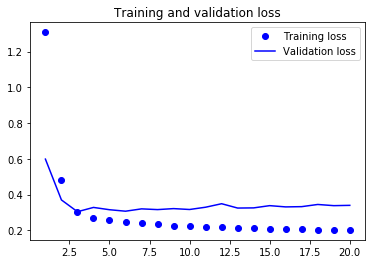

In [77]:
import matplotlib.pyplot as plt

loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [78]:
#Training and evaluating a GRU-based model

from keras.models import Sequential
from keras import layers
from keras.optimizers import RMSprop

model = Sequential()
model.add(layers.GRU(32, input_shape=(None, float_data.shape[-1])))
model.add(layers.Dense(1))
model.compile(optimizer=RMSprop(), loss='mae')

history = model.fit_generator(train_gen,
                            steps_per_epoch=500,
                            epochs=20,
                            validation_data=val_gen,
                            validation_steps=val_steps)

Epoch 1/20
[174657 177244 132834  14360 177066 127046  94313 138630 109228 158221
 152024 149647  86188 136354 177678  46235 169709 106468  15331  21470
  12065 101588 108686  52297   9126 169184  93072  25919  73534 163866
  60171  40509 188329 182014 193795 179719  35035 123018 164011 155312
 109848  27511  68143 150033 179178  53086  23286 183263  27879 131801
  10924  78070 178078 177913 181972  70910 144718 148594  77133   2988
  66315 151680 156791 100847 187842 109640 115374 180258  61098  68852
  55504  12075  47413 174494  42484 132732 137467 157937  91669  46485
 154237 178250  43899 182944  46817 109314  99455 157238  57814  42362
  42784 101221  86115 139702  27290  84682 116801  55576   9249 164355
 194195 112844  97028  86096 154642 137078  11400 182701 185050  97038
 172733 127397 116830 172356 178333 162827  15079 100911  91108 168151
 108260   9595 171405 139995 120816  34818 182058  22556]
[ 70592 153890  76431  78723 101516 131767  38573  76981 111461  20419
  29416 

  1/500 [..............................] - ETA: 4:24 - loss: 1.0450[114101 197779  11997 186260 115003  45103  67101  51775 139681  34825
  55312 160171 123303 152546  55404 188322 110052  20285 119751 165774
  15409  41582 107299  98602  99470  16127 105910  45754 105223 178856
 178623  46959 168947 187406  90121  19679 152480 137230 118957  57832
 102356 132103  65099  78937  98672 142379 168143  75995 178559  53952
  40717  89300 166022  43468 193864 121201 109927 152897  33368 127171
 142936 129129   2932  24019 122593   1685 109531 150496  51126  57468
 142671 152375  43983  69042 130565  94093 162734  79544 174681 148490
 118107  60037 197904  53447  98229  10731 151332  37129 111136 195467
 106561  12887  98557 155826 176939 158939   9147  22570  74467 130717
  16795   1736 123948  73721  94601 134623  12553  44139  42849  65390
  24289 116831 140003  92676 156606  40876 129434  92375   6232 193349
  82335  30901  97092  64249  24601 194634 143067  16414]
  2/500 [..............

 10/500 [..............................] - ETA: 1:10 - loss: 0.5727[130415 184168  19317 190139 113628 166182 134477  92499  14382  36033
  42482 177083 146817  76278  76767  99959 151500  57726  43678 170355
 143432 168982 185942 181693  40375 121837 152968  59154  10743 155673
 180294  31179 106827 151949 182056 119927 107286  67320 106595 177177
 117559 135608   8101 139603 182683  66834  35579   3497 194068 106598
 111929 134174  80648  45711 167953 176868  71455  73461  77878 128960
  57362 119476  17801 115420 119512 195614 106275  96072 176450  64297
 137702 157623  83854  65626 171659 163744 175798 122957   9877 186136
 181801 167200   6431 151253 191928 173597  47475  39251   4882  43023
 138153 164489 195930  41807  24424 133424 184233  18580 130191 109599
  86092  84880  65419  91749  44080  75913  31571  63770 163074 151097
  36128  63110  51495  68907 163593  89084  33970 106985 160506 134724
  93816  46156  13624  96970 106829 135828 194625 183162]
 11/500 [..............

 19/500 [>.............................] - ETA: 58s - loss: 0.4714[ 58928  61940 147393  88777 152829   7556 126472  30409  33422  15689
 144502  32231  99174  70234  20418 149026  60221  35849  99006  87387
 117412   3443  25643 175991 185425  52877  95149  13841 112367 175555
 168972 168091 190911  96915 108999 129126  89764  86187  71705 145595
  85111  52619  97728 115884 137527 177436 145950  77176  13168 134249
  62296  67901  84103  13686 101705  46107 126209  33520 140213  79927
 160056 188321  61459 154848 167981 155218 195659 118924 188230   6210
   4685 136263  38139 172919 152830 101133  85668 143292  31679  34490
 112714  88113 185965 148957  50178 167175  81702 183096 129553  19094
  77150 184926  78648 150082  30208  45093 191806 131265 165990  86252
  70396 197871  11698  32212 129108 165070  55633 152309 182267 163493
  61062 101868  42222  74876  31936 108471  13506 184633  30926 109417
  31348  34508 189345 133395  49466  54538  20780  20792]
 20/500 [>..............

 28/500 [>.............................] - ETA: 54s - loss: 0.4361[ 16969 122055 184573 162170 105966 153855  33772  97632 112511  41128
 143739  36798 147505  35534 181677  15735  17502  83977 119190  20086
 189706 140069 195431 124259 142266 169238  62978 102936  63860 167497
 105224 103185  92045 121102 199768 106050  19268  12598 170274   9538
   9667  95047 177968  18987 175980  83378 169856 107949  35746 129632
 166706  13601 161107  55435  29780  40916  74188  24970   4173 180747
 165649  93540 188612  92264 135998 191263  71652 181142   4255 114613
 114903 143054 115813 196375 128000 112843 166738 120391  37721 169483
 142081 156026   8592  84616 167128  95521 139971  12441 144708 132047
 153777 149619 184619  44942 111847 175779  20640  75429 193761 115187
  15528  74486  99750 173453  24606 103004  98468  30222 192223  85407
 161547 155101 199030  42754  11068 157659 135432  82360  13417  90162
  99810  45132 136918   4698 105227 109882  83204 107913]
 29/500 [>..............

 37/500 [=>............................] - ETA: 51s - loss: 0.4104[125326 136750 113934  39259 127283  81199  73562  79569  79171 104118
 125582  22891 166469 150633  52095  29887  80100  44386 101765  88172
 173509  97397 155496 125330  62496   6158  83907  91990 121435 138464
 118262 165409  17716  34706 166681 159139 145917 166808 183574 163451
 184685 154887 152412  78251   8357 159376  50225  34546   3255  12347
  98661 141181 108762 169389  12291  50158 190428 138822  80158  86600
 121492  55099  43397  80935 128599 182625  48477  68605  52560 105238
 115984  97719 181171 156751  61597 167563 152213 168855  49897 122200
 189295  59110 183859 119485 100381 193403   1508 199882 107766  58639
  98772  10954 195540 173360 118171 187646 110482  43214 182199 199892
  19108 106625 149508  78183 161843  76096 194676 149516 168812 157013
  31802 138775  18836  17792 145101 167750 194483 124870 138656  33784
  38841 145061   5864   2920  96064 131450   3965 192426]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 49s - loss: 0.3932[ 61893  63454 190952  73855  51850 108125   9746  75450  46757 105000
 158307 173132  25049 121388 199733  46135  13897 164497 166618  29350
  28055 117979 150992 154677 145855  33001 125944  20583 120652  44411
 154784  96810  92768 154250 181055 116152  70330 131975  93103  51737
 122511 170337 160427 166028  29594 134297  63918  38824 115422 166992
  34716  84553  40843 111679 146680 189262  51789 102709 187910  21796
 156219 123991  15054 128598  22206  21898  76831 172607  91479  26494
 135757 166651 186039 125487  17213  80365 195146 183275 120229 198033
  60084 163797 114075 178538  30816  41471  69944  93709 169621  72947
  95597  89256 160139  96725  19393 105168  93599  56176 173893  80128
  35935 123333  90891  34840 123385 185276 138761  46744 145261 134982
 171812 105483  51105 137105 164274  32988 191410  85980 133648  41153
  59047 107982 138947 155640  10707 179095 147924  86891]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 48s - loss: 0.3795[  1773 142910 169756  78520  53826 197220  88050  63671 129669  95326
  62676  60916  14652  82444  80292 154615 156323 172047  15357   4767
 139798 127956  53239   2001 189319  74554  40068 184935 191017  87486
 184631  95890 192186  40664  29314 194736 156334 170096 163923 104751
  81534  45738 154657 113852 179652 149321  13692  98910 168630 120436
 106564 143909 114739 113385 131372 104822  59363  79783  91222  35359
 198391 104015 127804   7417 101063  36216 178192 155374  53936   4804
 162206  56573 128933  66012  15658 182847  13763 132940  46065  32135
 178741   3302  27689  40672  40038 159311  96992   4879  72617 139768
  60090  67164 155723 153746  88964 143269 120142  32670 126143 104355
  27577 180110 101454 168837  98948  36795  78246  86782 199922   4077
  14458  17460 157943 190209 117384 126656   1757 115519 193278   4877
 136762  58949  62949  75884 167724  99334   3837  87630]
 56/500 [==>............

 64/500 [==>...........................] - ETA: 46s - loss: 0.3704[ 20634   8487 184077  77180  14497 126499 125987  69903 144322  61212
  61105 133973  67415  71162 109507  34247 112012  22675 117551 148586
 128756  15953  57645 119786   1901  14629 191203 145438 120591 185246
   3075  63140  46479 177733  49624   8667 156837 169440  37811 121879
 146130  51080  86744  82864 102410 116452  45607 183117  69436  26882
 114470  20032 108205  49199  44124 102473  25543  25139  82556 109297
  52486  35784  87672  54175 143304   2091  72835  81390 194504 146084
 187361 111167  28453 164919  92056  77216 134210 135942 173523  62342
 147961  29111 122339 121644 171228 113231 124982 134658 111005  24538
  68276 197349  97063 184222 126969 127004 138538  20027 113097 180015
  46359  30928  14465 148396 115061 134851  25735 146603 180093 149414
 184976 100810  17133   8848 170570  79833 186632 196387  93646 138640
  48569  66102 180604  54749  92192 132696 155301  74765]
 65/500 [==>............

 73/500 [===>..........................] - ETA: 45s - loss: 0.3652[ 34548  87082  66155 112387  80715 108416  57148 105456  49513 107332
 154719 116387  18374  67169 171119 158018  20514 154344  20321  23357
 106247  21641 152577  29773 175705 144982  38374 131302 135593 134243
  96403 118789  11554 113340 114145 187885 130927  63391 123307  78313
 198483  16710 137645 145899 117611 158015 162823 188178 193842 158200
  64158 141367  83295 173955  12878  70126 177067 145730 186433  76945
  14779 180741 158341  49560  54799 178478  85245 103466  15605  94995
 177594 140331  50233  20361  24098 129020 189876  48896 199930  28138
 161202  27148   1488 157555 126379  86598 197326 182280 177683 194859
  54753 164607 151921  18266  91586 163555 135175 182753 151384   9895
 143331 127244 111882  86313  77737 137345 103599  75095  79218  47850
 134260   1683  28092 145721 169439  48872  15740 163391 146869 113856
 164912 148103  46298 106572  66569  36289  11529  56550]
 74/500 [===>...........

 82/500 [===>..........................] - ETA: 44s - loss: 0.3595[158709 182970 121832 198688  65153 192727 162018  94890 193654 124882
  57015  73174 193308 178310  12011 173299 198041  93454  31458 100932
  76930  87212  25761  67603 185514 100730 158644 163877 188803 116288
  83155  31217  61325  26624  32915  51741  27659 189469  55082 155464
 123505 162926 111637  17687  94356  49148 194511 166231  47443  94090
 115565   4293  92923 148302  87287 133982  50502  72657  41508  51982
  85976 197150 186794  57822  29229 134947  48928  95405 121565  24021
 169983 172489 186320  80129 175740  49884 100360  18796  94613  23631
 121681 176938  80258 199270  49270 128451  42192  28540  72259  92593
  85020 168826  64995  49049 189804  88752  53754 155868  72732  11967
  70272  65392 196785 131690  11182  46988 103615 198625 129958  70513
  11865 199420  82668 105798 171058 135829  59235 111150  20553  75959
  45752  51923 100569 192346 141521 154718 116923  22544]
 83/500 [===>...........

 91/500 [====>.........................] - ETA: 43s - loss: 0.3543[ 19339 183881  26280  95490  69742 105052 147820 146234 124672  74151
  27081 199455 126307 107474 166653 140940  81438  16328 116119 185212
  48458  80763 136625 126316  22657  75864 101664   6391  36659 188070
 178896 165724 178643 149549 108829  30695  14490 133708 184068 143371
 133401 128325 110501 193029 196229 132183  18689  52999 185749 193486
 107760  96952 120662 117450  39706   7436 176296 133698  79509  67544
 152161 156977  43478   4923 143609   6089  33291 107070  85162 174964
 189313  15520 109704  82584 106052  50758 145065   7144 117724  23501
 104963 130165 111776 121879  45459 195823  14454  93157 124180 127259
 152024  28743 166865 138894 193835   3158 152718 149821  31426  37722
 129114 168569  13000 174267  47754  42840 162113 155130  54642 138569
 191203 134531  89820  20259  31226 181890  72184  82895 174397 173072
 114273  73900  84104 137418 120631  37941  82369  82357]
 92/500 [====>..........

100/500 [=====>........................] - ETA: 42s - loss: 0.3505[131167  97217 161123 126731  27627  45234  46193  74095  46844   3591
 130330  64270 130664  50792 133090  83196  60248 159964 100777 196804
   2412 158588  86868 115757  33911 157115 141643  40534 155234  95590
 135767 164405 172025 168690  40792 138167  95287 145023  64344  60169
  48570   3015  44345  99581 166096  21810 184435  74826 166827 150575
  79224 111118  57322 151031  93025  81785  93138 140081  39370 173280
 144005 108039 173152  84489 134067   9400 144782  10755  84955  95711
  18240 106644   9312  69015 117126  13468 118502  97280  67336  28030
 130410 130020 190281  16580  59273 175561 159561 106864 105901 149001
  59129  14885  82275  14704  58476  34863  43016 170078  97915 146366
 104617  20329 126703 137300  32707  90987 128079 131595 195628  31457
  12224  54313   9976 123550 197344 184827  66872 120480  39459 180211
 112432  83092   4580 150527 193777 184628 183340   6980]
101/500 [=====>.........

109/500 [=====>........................] - ETA: 40s - loss: 0.3474[187576 192984  29260 167843 122514 174542  32993  68010  43853   5701
 173252 163903  11154 187130 104174  86846 190513 159615 139799  77101
 178378 156910  53450 197152  29069 154082 137174  17433 155323 187997
 156729  59043 184867  84827  43612 124245  86260  81996  23208  23694
   6531 184881   7559  93507 168379  54518  94617  13690 149919  59290
 144492  77765  89763  31585  52753 100410  89264 176433  83773  44072
 161518  28569 111109   5233 166851 131755 153404 164364 191925 166956
 164007 119579 164854 175846  40176 121373  60588  59839  60507  73920
  28698  43376 123103  54426  42172  84561  30297 129646 128192 145727
  71828  20924 143647 160444  81787  84188  19950  11150 151581 188351
  63884  53741  99126 102795  36420 148779 186497  68366 199001  35784
 146130 143981  74286 179463 145098  36895  54504   9582 182690 109309
  94832  60696  42180 117890 182296  84585   6559  77786]
110/500 [=====>.........

118/500 [======>.......................] - ETA: 39s - loss: 0.3441[ 87015  32887  89970 143923  11274 189726 142331 151729  97117  84634
 146009  63962  20654   7889  60530 109027 125366 116312  67848 124534
  39472 143429  59204  28513 136716 100363 183034 129376 154435 189517
 176636 158658  13225 103626  37363 116233 126630  97503 165500 161421
 172877 175129  69339  19918 101895 104263  32703  18926  62966  40928
 104181 199899  83889  32348 105029 152837 127761  97701 195753 142035
  77789  51186  11726 195095 106166 150907 174129 186237 181591  30179
  77016  39882 151751 108388 120909  32461 196305  71649 187192  50545
  63835 109278   8894 162312 125453 144693  82487  79937  26535 135487
 127683 118244 130166  96664  64546  71062 146174  98432 148705 194672
 120991  53000 127642  95438 189100  93634  12704 188190 148456 109774
 155831  58411 104119 100648 171121 132015 152617 124590  31081 150262
  34910   3142 101759  25394  55212 176018  60687 153854]
119/500 [======>........

127/500 [======>.......................] - ETA: 38s - loss: 0.3415[199498  97972  45010  64584  11573 165287 199277 182780 162369  12152
  63941 153236  32588  72632  35323  10805 118792 141571 175544 149445
  19093  69512 105091  70278  51359  71905   8326 107743  16627 156779
   8114 109160 154555 119919 159697  74102  46959  85729 121596  98556
  74855 195602 177482 178973  74555  39102 105953 127485  42686 172820
 144596  29041  44175 117326 116314 126421  19291  97230 101146  10902
 123150  45119  82750  95697  60740  71609 110343  15148  53725 109764
  13698 108655  43848 152731 195020   3820   7200  27970  25161 110300
 193290  61425  85297  23110  47854 145500 132057 143437 166401  70520
 128258  87466 156472 148464 110384 188196 142006  32134 197672 133575
  61741  21052   7470  91207  43579 136089  86936 155694  18346  80506
 187099 128824 145346 129383 112780 118355 129881 127922   7109  67460
  25602 127680 142961 135516  85985  37457 170830 120767]
128/500 [======>........

136/500 [=======>......................] - ETA: 37s - loss: 0.3391[103195  34677 134255  50674 139676 195079  82112  39616 107248  59887
 127676  63670 148243 173923 170362 115624 192690   4711 114925 148062
 147251 109542 128837  25338 127035  36358 162772  60955 191854  14641
 196128 171537 181045 124199 159345 179180 193873 135218  24256  72060
 161008  54505  61276 148067  57379  67655 126632 158858 115932  51010
 182085  75643  80652 122389 190819 103711  27585  36386  86999 116762
 113223  14152   5788   6765  18439 163813 183993  81246 188049  81427
 149577 140662 108585 170119  80802 111282  12229 122993 100974 135634
  62070 100971 161444  86197   5634 153264 107085  38033  33872 114660
 138757 191792 155106  18197  63631 180466 193933 173643 145218 178621
  67906   8543 123318 187822 191641   3925  99877 139380  10106 170632
 106461 191355  20635 160707 193455 169374 194299  57268  99284   2165
  87518 148234  65062 118503 141664 154101 110677 136271]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 36s - loss: 0.3361[ 31828 145888  83566 115833 114554 163680 124832 107496 186488  94333
 164632 184914 177830  32370  58490   9521  40523 148260  66920 174441
 185677 107647 136769 192365 118630 133860  35583  50059  19002  23124
 113646  51664  75740  46080  48157 172143 112241 139758 139521 191898
  51394  83024  99074  24809  54541 110005 133535 125308  15579   9201
 141514  81350  36245 176186 136474   8262 178431  96072  92836  48272
 188864 120242  51851  75589 127837   7927  28752 195775  31101 152045
  89488 122226 184595  89535 131621   8945  20113  82437 133774 162294
 126336  69792  46085 134952 104704  37894 187986 198420 154723 168596
   1511 123525  74599  87970 127864  29697  42211  38327  80135  56655
 188643  25477   8171  33974  59085 158959  54616 168174 186175  63820
  95410   3180  15728 131055 117204  16770 194735 117338 199748 127786
 190717 154412 139764 109962  36784  73289 170662  99787]
146/500 [=======>.......

154/500 [========>.....................] - ETA: 35s - loss: 0.3335[171871 152616 140523  32260 136814 189476  50019 131877 178674 100619
 194007  26345 180257  81103 174371  99000 154795 190729  13645  10164
  57846  25617 170313 120126  15388 126536 179375  76653 130630 175395
  58554 178457  52313 165768 161069  50739  54679 114528  18325  96501
  47309  39372  18376  38673 152877  51265 143318  36063 122729 198176
  10373 142886  46512  26293  99940 197685 153316 153258  14639  32266
 147687 124485  41241 159355  88724  92490  40286  64397  48791 124778
  57719 124872  49002 135832  95470 103909 178849 168414 117055  20876
  93715 111982  83432  15350 124082 118845 193980  15953 175411 145000
  27272 196792 181510 112695  92773  42299  89056 183495  74191  90439
  71602  88774 131098   9539 113433 112863 169538   5506  34743  10261
  73305  45979  70054  23545 113236 191370  39632 116187 124634 151209
  65427  52466 136824 134088  86217 112733  80176  32034]
155/500 [========>......

163/500 [========>.....................] - ETA: 34s - loss: 0.3310[169230 158984  47238  36396 116367 181654  73146 195613  94392 155991
  12706 153489 151858 140862 164786  73736 105158 161157 164375  28838
 132701 159679  34987  76790  83911 158625 120228 187586  67239 169038
  78355 177476  50737  99321  85750  62187  70086  37362 160553 132435
  99126 170029  63950 135649  58560 154483  46078  44452 164710 193014
 134377  94251 163158  22022  89856  50155  19639  45974 179346  82023
 153218  82696 134070 192589  73924  11962 122545  99708  21102  26730
  30168  30074  83611  94801 191691 147094 196823  87698 128647 125737
  12732 157281 130320 138370 198348  44772 156010  52504 134046  43803
  80159 180397 178220  81614 162491 112614   8137  52486  42772  27560
  87949 189561   8073  79706  85644  23639 181313 191259  83697 102380
 187694 187812  21580 119994 129973   2214  77827 148796 190037 120293
  14118 130801 193593 134616 154354 156637 182015  75457]
164/500 [========>......

172/500 [=========>....................] - ETA: 33s - loss: 0.3291[ 84128  70060  46685 189408 107372  44765  17103  67507 188998 172546
 194233 115532 121809  65135 169014  98312 189937  78085 134954 118035
 122929 115195  40613  74368 119581  71322   5233 138061  45255 157879
  78899  11422  35871 166963   3498 111838  24226  98749 196770  81753
  97430 126141  82302  79705 188890  76549  26866 189694 136366 132081
 179509 131705  94460   6829 144471  75553 143512 171965 101107 173661
  15924  89179  37073  87405  51713  25534  29805 112875  58182  55189
 158787 197080 166878  62093  30391  11825 104734  55004  44568  84212
 180576 116328   9424 199283 161609  61354 163192 152147  36601 197079
  63065  51693 149627 113153  82400  34307  56960 180683 143347 118156
  83753  98343  47583  67157 168577 174949 168035   9007 187233  61572
  95009 150408 141608 187277  58438 120412 131251  68655  42196   7551
  47004 146241 127836 123595 146963 143920  18765 168988]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 32s - loss: 0.3276[161497  97840 160352  38238  95396 195888   1656 111746 189653  44622
 142952  57748  11952 199242  66064   8818   3649 101741  94985 137240
  89057 106742 113820 131501 173952  24830  26242 138592  40305   6429
 109229  60037  28453 161987 182505  84796   4059  47673  88839 102373
 118179  41090  76148 114589  15186  38846  25810  78260 183871 130108
  56491  29705  66120 195336 149696  49774 153267  77161 134247  24632
  33599 126947 125620  92940   5228  81604 164321  73047  60734  96333
  73582  13753   6213  52175 114862 176399 158939 104712  66619 100388
 126995  72051  59693  13242 190520  34123  34691 145253 164670  51537
  96683  88114 151638 101205 123032  60447  32311 176473  80602  38893
 187443  42396   5875 190668  38413 183442  20082  35454  84081  47250
 143545 178497 195245 148094 151541  56597  60154 171578 157036  74687
  15121 151438  83451  97587 112972  29995 122721  93340]
182/500 [=========>.....

190/500 [==========>...................] - ETA: 31s - loss: 0.3263[ 89981 136922  76079  14816 157238 153025 185610  74277  75140 144252
 158140  40763   5299 122675  51282 115312 112797 170507  58499 143055
 198343 112899  34598  73600 199471 105833  44357  31307 158852  82571
 177719  62298  58869 194231 190258   8957  52125  86558 182077   7807
 181585  33795  80053 132156  15033 147373  20060  66820 132538 197077
 182440  11176  50125 153442 137172 159596 177521 111863  70923 194852
 148011  33309  33051  63962 186012 133104  23749 127733 144327  74169
 185239  16149 121520 165249  74656 152169 126615   6504  64201  79875
  66282 193393 161677  64489  76603 111713 142579  31474   4318 165855
 120583 147523  59399 144344 165930  37802  49273 128808  94692 103276
  18750 127567  43925  58140 184544  85684  69163 115492  68799  11692
 182328 167562 127364 119856  97260 135928  28682  81131  77737  99635
 156197  68522 132824 116617  96157  82361  79796  34080]
191/500 [==========>....

199/500 [==========>...................] - ETA: 31s - loss: 0.3250[ 80242  97039 169871 182833 110491 129090   9904  39713  97051 126054
  44895 149480  78002  62755 182802  71534  77892 146898  25899  87222
  44939  72802 149188  22452  69280 188773  46882 111783  98528  27545
   4613  82138 197925  65231  30010  51338 189676 101438  62381 115375
 163197  73658  19678  76807 183537 151905 173070 110289  30681  13525
 160314 113808 158467 194902 129085  82660  28842 197686  21105  79191
  39134   2495 132798  64430 194846  63710  46275   2526 122210 171320
  96947   5050 173002 182804  20105 100482 188755 121488  52913 158142
  69503 120884  47585   6813  32277  89338 131343 192365 163418 125485
 192749 156506 134550  30211 118475  42183  69219 135452 140836 157613
 177467 110174  55193  76815  46560 113119  44540  61611 181503 166423
 161710 114861 198189  11224  66121 113725  93262 129321 198901   1663
 126288  96817 170643 151975 136036 173443   7518  12693]
200/500 [===========>...

208/500 [===========>..................] - ETA: 30s - loss: 0.3234[ 45392 183664 170775  30433 127828  46146 148325 103823  94880 137213
  92988 121798 169487 102279   8343  95213  78023  25307  13606  61385
  70360 193544  50040  31809  58001  35658  34586 136019  31791 139889
  48020  36202 169328   5967 137673 122296 198291   5978 122995 168380
 122595 136229 130025  38544 188826  73301 112368  24055 153025 129221
 182896 199261  77459  13880  43004 100024  22271 111651  98891  26745
  40691 176491 144184 159354 187243 105530 123462 116152  80932  55251
  48922 136307 162312 186730 105710  92531  30109  38357 193510 121802
   5446 109170 111237  37714 120362  35873   2764 186478  13586 119914
   7597 191410 178122  42021  26051 100862  92409 185248  54981 117797
   3055 126259 128635 156145 151128 172407 116243 124569  90742 140515
  94210 102388 120841 122045  72667  70044  21488  86581 192897 114093
  54487 135608  18457 191422  42659 142738  51932  86769]
209/500 [===========>...

217/500 [============>.................] - ETA: 29s - loss: 0.3229[113137  93187 180680 177533  75883  76172  62351  58622 155391 195450
 150816  55748 140650 104097 160645 118419 106984  96413  78217 177518
  49625 157798 183615  29450 127368  77856 178016  59314 125074 110406
 137204  81328  52516  43762 156084  87658 133710 136063  51290  81112
  78836  76850 155816   4370  77170  96039  34406  99391  44280 129778
 121819  84478 193198  73795  77706   2671  99036 155457   3423  93460
  50935 168308 169780 122067  92203  96739 161895 151026  14086  33615
 141539 122474  86161  89857  30608  44923 191138  67458  56014 140152
   6881 115432 137613   1581 154728 101704   2460   2524 151504 149217
  90187 101172 124365  89202 137471 190310 147187   9915 114168  75134
 198091 142417 146186  15029  85340  35694  10337 141141 172689 100335
 117172  54058 107858  24955  25893  94586   6666 172049 187771  66182
  95078 121380  47639 118157 108449 166835  46913  88347]
218/500 [============>..

226/500 [============>.................] - ETA: 28s - loss: 0.3219[160464  45984   9618  94785  84877  18163  93965 186964 192667 174189
 166553 110285  92169 162215 187578  88719  18824 178388  95630 150975
 116879  37947  84787 146898  60963  53024 102466 182419 108456 161069
 176904  73669 161291  96104 135921  31064  11074  41414 169316 183608
  45843  69080 118299  10888 156946  83059 186222 141391 158148 122469
  55869 158746 194143  29801  37482  18777  81983  13543  79956  29869
  80551  15669 160869  92107 159063  85361  49055 187557 187111 112606
  49299 132478  62198 133095 125202  27921  48202 104645 144742 113350
  68361  58401  12428  65932  74368 116404  60360  68084   9696  81893
 137331 165844 174260  19541 104110   7379 109070  96955  11113 187241
 164145 108128  89190  90550 166494 181597  32708 125934 155781 118405
  56059 136393 126595  35926 169342  64303  27357  79689 169463  33544
  20007   5161  58252  79962  57971 190865 199883 191553]
227/500 [============>..

235/500 [=============>................] - ETA: 27s - loss: 0.3207[179213 144647  44965  62541 196185  66043 112199  97079  54028 127626
  12576 174701  37832  38010  38560  86397 109642  31505 163793  54042
 164255  94108   6439 156315  71919 190719 191567 131898  13738  36265
   3493  84950  94572  30913 182397  27877 112006 100838 125255 190288
 155587 179433 103031 134920  15982  87646 152206 170702 105692  80471
  50132  72006  96446  18775  24334 110616  41071 168002  27452 190253
  88242 128148  59280  62327 167959 184677  74502  41181 124871 116137
 148036 179608  77188  89946  27476  88948  98793 198038 140342 172114
  85658  12032  55734  99597  60774  88760  94724 199116  75664  80818
 167466  68639 172842  25414  36613 190836 147871  10448  36156 132240
   8003  99724 113096   5140 179431 122118 154048 186789  28860  19461
 117066  53868  95666  33694 128542  45686 177105  14761  15337  99576
 184912  26662  19904 128759 124068  12360 142565 117825]
236/500 [=============>.

244/500 [=============>................] - ETA: 26s - loss: 0.3199[104650  34742   7299 179790  37544   4628  12283 145518 169350 171538
  24128   6989 146513 141567 116152  95910  18768   8098 148386  63554
 133819 102882  27148  43096  71493  95940 191156 120506 158460 166910
  83562 161249  15494 159520 105977  56865 163131 198193 124046 186320
 182031 174343 139391  41634  11028 166277  89529 118322  96817 144130
 153257 124449  51685  88654 176690  92065 184270 153530 185010 168323
 134485 102282 184676 125503 150259  83691 114315  55651  88697   5841
  26358  65938   2676  36808 151280 147601  30552  52583 180909  96695
  46677  65179 106429 161095  59804  24036  67498 105850  63872 147661
 162796 132477  70530 170210  85850  75478 129824  60514 100739  30612
  57325 115241 127889 131433  61598 161189  68057 118897   1745 128270
 134146 159612 122628 171792 185852  65908  27042  61859  93746  20581
   3946 133789  91618 121552  78858  46440 145088 110421]
245/500 [=============>.

253/500 [==============>...............] - ETA: 25s - loss: 0.3190[185557 112357  42350 111420 164786  48388 163878  99901 107576  88038
   8834 185299  96731 164594 119391  65355 129980  33553  61633  85905
 174786 101550 117439  30765  65233 127274  50940 104791  53143 126609
 187865 187350 144150 115556 174670 115515 173288 104840 180143  87143
 104524 188709 158278 157647 195764 142675 126785  97809  99394  76753
  16694  54474 160336 194225  24880 190852 155411 143916  95219  74409
 100909 151309 117295  43978 144512  71631 111043  88068 128778 198739
 189850 130785 134179 126411 130956 194856  15771 172657  38108 132048
 164477 108026 108743 158449 100934  69088 137331  34240 135196  54235
 118410 181860  34266  85834  49837  52142 143914 140161  75149  49724
 136438 148983  56769 188609 152025  47520  42347 112875 143699 111604
 132077  36810  66519   3732  48432   9307  48830 165156  43335  40623
  21868  16255  15424  76263  92180  99233  46891 177825]
254/500 [==============>

262/500 [==============>...............] - ETA: 24s - loss: 0.3187[ 94804   1876  64521  33070 148228 156843  24104  72309 104511 194375
 109290  77941   3238 132754  74854   8168 124272 183862  72962 162158
  75893  68572  90313  49653  76104 168991  68956  16750 146059 126680
 193794  32505  79727 151734  63145 169911 138233 155067 121801 166454
  50366  25253  59660  22905 179400 113827  86359  97299 181175  69154
  79014  50431  99589  89537  45127  51994  91023 114886  15221  15799
  96606 166431 179131 150622  95563  14101 174050 128291 104393 110840
 123821 185259 187071 103392   9506  13317  65663 161289 174346 105009
 128796  96837  69428 115240  87625  99410 107501 131347 112930   7143
  10799  32060 114610   4587 191090 111647 194028 135727 107475 110024
  89917 175328 158080  61851  66297  47483 154460 191282  63641 163361
  41451 136181  45366  11724  47871  89706  45409  18431 173080  20081
 163475 124460 164552 143883 186728  65734 119572 160501]
263/500 [==============>

271/500 [===============>..............] - ETA: 23s - loss: 0.3182[142559  87210  43479  42523 104904  51143  60811  56917 128839 141683
  55565  14369 150271 171648 109892  18933 103146 182932  26635  22760
 144057 121089  49456 121788  77903 180723  47246 194653  20894  52006
 149027  80064 102957  94144 196498 197871 145238 172933  82942 113144
 150355 141100  59070  34736 175599  94776 169786  52044 132785 124334
  96138  13752 153151  85609 142600 162831  40541 163135 181464 101041
 128929   1604  42609 177305  13947 190837  85254 109475  81816  92938
 154516 166755  89374  47321  11952  14084 187357 146673  17037 172766
 122830  88271 175216  65945 195034 189200  49758  79514 155664 175108
  20003  15803  33493  78765  44717 142331  69791 118700  87980  78171
  27478  29414  58612  50145  81600 129672  98258 186131  10318 178996
  91813  78815 107757  59275 160510  50082 122749  73671   8802 152448
 176122   2132  37097  52842  37997  17481  16309  46743]
272/500 [===============

280/500 [===============>..............] - ETA: 22s - loss: 0.3173[143551  14249  16667 134453 130836 167914 104490 181881 170549   5774
  75141  52729  74209  40150 101722   2906 103885 111499  33263   3418
  88195  81494  25970  58811 151126  84100 139168 105153 125879 130010
 140185   5149  98303  62397 133571 196978  27840  63045  40822 101707
   3422   5865 197437 191817 158755  38673  26353  66423 170663 117869
  67996 114959 110803 167094 196498 167863  13196  39822 110828  89260
 115202  89562 165564  90406 134700 143614 128229  26976 182376   8468
 185897  75404 116341 130875  14284 170378  13570 107353  32128  96140
 155986   9871 104223 118792  15654  25357  29152  41965 163231   9099
  85767  89440 125234 194967 106875 147214   4001 166970 165566 142784
  97408 171303 163430 177637 146597   2314  57460 146694  65298  98493
 100897  27914   5305 145545 154073 189957 122155  76138  45345  56436
  62710  26676 100104  79863 117551  89018 194092  52518]
281/500 [===============

289/500 [================>.............] - ETA: 21s - loss: 0.3166[ 20172  66366  91866 128424  71802 114036 199117  55444 189754 179199
  92881 119707  89662  42315 117636 181323  27495 190962  73762  14814
  95697 176459 129884 133527  89620 160457 124401 158878  63277 182445
 155108  77653   3654  86591  99974  29921 120389  60319   7098 174777
 182179  60079 139995 126137 177523 155674 168804  66272  21984 156658
 128874  24822  78044  22678  81493  13199  68948 120821 160711 149820
  91397 146999 166327 152122 156213  26707  31678  25640  88484 121258
 119136 173879  57810 136531 160042  46477 188555 140695 189334  42597
  27082  42463  29219  50012 117425 113864 169164   9193  84421 126831
  84917  79794 157635 187778 160901  21583  57220  69286   2858 181665
  11772 111857 121227  18928  31364 198117 160920 182907 179305 138808
  10242  70606 133128 194057  56591  42743  30719 199817 158740 102400
 156888 111304 128133  88016  89237 148240  88046 134348]
290/500 [===============

298/500 [================>.............] - ETA: 20s - loss: 0.3160[ 98073  66674  67069 187585 144537  24245 137301 144513  98880 104278
 174524  64995  45489   8766  19648  72271  73088  62560 104452  57364
 113201 133221 110345  69741  50388 177324 111528 170592 135585 187857
  20748 140169  85129  64495 107522 192412 179511 130223 114359  39884
 170318  76915  62630 149581  20645  67767  89548  88152  34776 110255
 164706 121875  35136  38460 198458 124787 110079   8392  81478  12280
 169173 165645 195461  83267  91305 192423  41298 169136   9402  55649
  35412  43718 172609  51373 111391 105294 168925 193399  87987   8925
 122122 119780 120093 102837  96826  82657 121568 166668 141237 107515
  66196 191390 129073 106847  38539 178339  13257 173230 111244  94870
  94673 118327 152440  90501 133192  27060 112698 172559 167437 152865
   8069 191926   2534 195317  83115 189923 154412 174623  78168 109516
  13024 198654  44253 147978  23095  61495 140146 115291]
299/500 [===============

307/500 [=================>............] - ETA: 19s - loss: 0.3153[ 56286 182861  73201  75724  46501   7392 164307  43937 175516 132954
 174138 122265  40710 122346  71110  41537  77687 110378 109386  60705
 176322   5622  67081  46161 126581 175311  85385  33156 181765 158346
 195643 176305 154157 130462  25263 167960 156123 120114 182443 115390
 104408 113313  29675  96176 160620 141087  28273 177916 105450  93295
 131524  77700  66067  46404  35143 149037  81460  14797 131942  22614
  15224 166859  31244  29452  97283  84817  18217 144732 100096  79047
 153116  72813 195449  34273 119531 121067  79214  10526  99596  41501
  15406 104142  21061  74745 191037 164095 178022  73393 180335 148577
 140199 113234 127334 177670 174671  28564 154749  17001  28278  32458
  63816 195365 175858 157137 108800 186070  80088 190326 105562  19885
 198639  55807 112674 135739 189942 116428 109074 176188  87690 125289
  69095  53648  16235  88686  50716 131440 121380 162691]
308/500 [===============

316/500 [=================>............] - ETA: 18s - loss: 0.3150[177969 194364 115631 150466 154380  39212  81584  97912 173729  14610
  14215 192511  54598  99239  95382  47876  26147 136652   6905 124943
 105455  51141 116776 172717 109726 188167 126008 168615 197630  95733
 189092 187155 147556  48985 157332 109385  15031 108222  78294  37936
  58085 178898 144837  82642 169529   5348 186838  36643  67130  41146
 167314  77318 190246  79997  69388  43606  38420  45243 134065 138794
  42228  10692 148019 114421 170829   7006 152510 194318 141343  17297
 133436 120743  20997 186597 146438  38311   1723 177963 182871  15869
 162146 177791  24533  95670  99014  41496 180850 164677  37658 195493
 140985  49575 194071  14636  55382 195398  99704  90399 196050 181939
 164487  38967 190577  26416 108748 154751   4188 112294 199328 102022
 108432  21429  54055 182145 170510  37228 123465 189815  56729   9458
 113111 197412  70847 195636  35578 121589 110852 177950]
317/500 [===============

325/500 [==================>...........] - ETA: 17s - loss: 0.3143[ 68000   1614 197227  31506 125061 103820 148531 193386 199891  71991
 164167 154165  11262 168745 138592 107331 183183  76155 156881 169329
  31263 111110  33787  74745  35243  41001 168225  24150  20372  73166
  91202  91449 169524 128926  38557  31311  94321  96249 115721 183441
 122620  52222  65704 140953 124164  92947 163373  16249  49685 124671
  14089 181178 170027  95005 103330 117133 102128  39622 135266 154434
 179781  92068 168571 185733  77607 163194 190456 196294 177962 119174
 129447 174211  65641 185957  94613  15356 118657   5135  34187 112143
   7568   6667 146856   5847 122088  19139 199146  99866  84725   6809
 106279 118014  11706  32639 137635  57015  83103 139732 169927  69907
 181099 195465  34120   8345  48624 134501  99574  97679  61266 105012
 178482  29200 130870 172015 100234 127052 171443  64789  34203 107175
 155771  17655 167178 107860 175877 120771  41756 168563]
326/500 [===============

334/500 [===================>..........] - ETA: 16s - loss: 0.3138[118666 139714  23256 110962  96098 132304 134218 182511   6002 117343
  12489 159370  18804 164301 100822  68005 141882  97934 134812 126692
  23885  15162 140786  89122 103238 190568   8865  14972 116318  81510
 176463 126270   7620  99224   9249 148323  79273  25268  73891 113234
  87601  46069  87219  30089  49566 193093 174392  93360 156650  63297
  61248 163567   3632 165764 173381 116879 112727  34752  40922  67689
 110308 158213  11086 153933  40261 171216 186124  17101 125652 136990
  69825 170755 112089  93544 182978 175177  36282 186974 168155 117506
   5196  32853 133388   6551  71588 146379  56072 123849 102292  14614
  83264 163945   6443 149089 187417  41883  47967 197334  68615 115382
  63728 162741 171339   3267  84912 143721  47222  28239 195615 187311
  71297 110186 112676  32310 169018 124933 166200  95922 130389  71332
  91215 132551 154675  32142 133923  51229 160429 111352]
335/500 [===============

343/500 [===================>..........] - ETA: 16s - loss: 0.3133[106580 172870 106389   6062  26779  22673  68694 177695  60600  50810
 164718 179061  68534 118160  18260 152227 121325   2592 172703  91514
 112331  78340 113900  27485  18260   1774 198741  53282 160120  77356
 179498 166979 110729   4399 155650 187693  32627 172330 148272  30826
 136429   3615 196227 142253 187703 107105 130179   8240 128174  64152
 163437 178494 182071  53589   9136 104028 161495  24408  36634  37323
 153436 172183 168662 139941 150113 189538 165573 185204  82293 140128
 193337  24135  12163 194464  40613 143957  86736 131723  36943  60440
 166028 129559 172606 192538 192566  70689  35698   5137  11803 190037
 178149 127596  18965 145514  22411 193127 149189 188344  80369 130435
 131397 197523  42465 141914 189640  91383  95044  93520  50792   8258
  87579 155761 160081  59739  22302 161833  26889 122583 164741  85954
  97795 153525 112180 155752  69657 162595 113002  14600]
344/500 [===============

352/500 [====================>.........] - ETA: 15s - loss: 0.3126[177972 101723  45467  34913 138941  31290 199925  96467 193617  72802
 109577  98222   9823  77762  42094 138906  57197 191652  10469 180234
  84834 131225 110402 157233  77035 137467  53003 130641  17978 179773
  22499  85402 129918 159385  44066 151994 188276 152066  66786  10795
 128412  80263  98330 158991 179096 104965 162668  33989  72620 122643
  57348 132281  67252  65873  42358  82067 153253 124487 194520  94032
  48537 134297 148858  66740 161321  56660 159160 164110  75378 160812
 184640 144244 183242 134127 185782 146510  28056  51562  68561  28693
 124945 112899 153878 162762 166066 132722 163042 175761  92651  22419
  16374 166166  72923  83494   6527  89029  46336 145546 198215 182637
 171108 146172 191865 181999  15035  80190 176651 175395   5200  65597
 190489  79018 143495 127745  91513 179709 167919  33767 175412 128581
  61223  54872 199035 197779 186399 177243 117927  56132]
353/500 [===============

361/500 [====================>.........] - ETA: 14s - loss: 0.3120[167732 126723  62935 128065  51643   2809  78219  29611  75424 190184
  84479  33398  15276 164534  31750 157598  15345 155967 192780  18400
  15571 192701 173352  28365 140172  97572 141549  15355  24591 103039
 180293 127036  80639 124180  88794 121575 199099 173038  99755 127648
 142540 153245 129366  81301 166392 174893   4603  70250  18978 107430
 143842 131248 194290 172005   3898 180354 139406 160201 114204  51931
  29955  41754  19379  92231 186190  67571 156981 198208  53716 178601
 188649 127362 193657  95126  57920 191849  38577  89100  77984  71363
 192694  52311  89211 155826 116633  51789 102589 183283  32739 119493
  73494 124442  34918  49759 137838  13516  77434  66691 149752 174732
  99421  77325  82653  10503 135078 166188 157334 101049 130751 178144
 195097 153603 136855  13414  33901  32682 122071 159688 169909 179595
 157472  45453  62420 180368  11825  77983  22448  92050]
362/500 [===============

370/500 [=====================>........] - ETA: 13s - loss: 0.3117[  3538 118525  29256  36789 108258  12626  92837  68683 115351  65542
  41590  45863 198250  14095 168819 176825  60010  85522  63698  61501
 166199  61101 104632 118413  95058  77272  80691  30979  48139  44258
  33729 165746  94309  93061 162172 151575  95935  58854 147446 149556
   8253  49125 141484 189317 109169  40352 193572  89085 190742  12390
  63479  11056  24059 148037 132763 197884 105487   8564  21270  25692
 117954  78198  33479 195437   7378  23864 196912 140286  36658  46653
 105275  24578  66167  56983 130113  96810  33325  70601  80629 196735
  90873   5763  89756 110471 111751 166118 193694  43715  75943  96417
   3783 129505  21501  49745 194615 132913 169942  93373 193861  16407
 141497 150280  50281  20610  54281 164419 108276  31637  49361  72461
 162901  34756 111620  79788 120752 168379 162016  48151  63030  87710
  58372  10629  25486  37000 115213 166455  79710  71112]
371/500 [===============

379/500 [=====================>........] - ETA: 12s - loss: 0.3110[112052 134678 199877  57502 156377 119714 112342 156070 183027 140627
 159450  38519 176864  78947 159379 106645  31388  78341 183874  30903
 170925  21873 163322 182307  83626 149773  72593  77860 196177  99491
 114211 178544  61443  72757 105219  82579  52415  76283 161909  19928
 104010  48991 120697 179067 182756  76516 140748  42902 179168  64888
  98056  16174 120055 182721  48046 151589 108588  37059  35567  99250
  56280  22610 122455  57808 145364 174332  26893  13476 183151 152873
 192554  42716  12158  13695 104103  35257  54544  32008 158028 129375
  37328  16832 144930  82173  74893  86800  12799 108086 121368  76094
 193669 184758  87368 133312 178240 114615 171073  77905 146015 108617
 135657 174741 153615 199345 111149 148604  87520 175661  63959  30689
  83338 167338  64304  95165  43854  78803 118993  49535 192000  35488
 189543 182966   6815  90873  30821 173505  50061 134499]
380/500 [===============

388/500 [======================>.......] - ETA: 11s - loss: 0.3105[183594 115563 140755  73336 183586  21345  25231 155322  73670 129093
 143741  67801  34862  84413 153165  26338 188524 161352 142365  19447
  74059  65924 103410  20661 180643 107888  83934  53375  72755 127199
  98646 103347  27527   1791  99247  40067 127456  40483 105854  52180
 198700  43837 193518 162249  35078 105821  77323 161536  90748 190090
 173062  95824  18554  38297  92333  15001 183681  26788  80766 159470
  62429  65526  86924  24134 165915 126389  77865 135842  73016 140450
  31251 188342 145425  80900  81798 183299  51364  12925  71040  59043
 182968  72941 159658  55677 189593 177288   3275   3520 141675 105404
  96472  10580  32444  35853  84470   6291 136638   1711 178373  38693
 187680  98861 159989  44350  30083 110591  54304 129580  91865  54033
 191911 165777  77128 192652 164117 112003 182094 133061   1753 142146
  49834  40933  32717  70665  96555 138240  53351   9765]
389/500 [===============

397/500 [======================>.......] - ETA: 10s - loss: 0.3100[ 23230 171075  44181 195645  88109  21288 198866  98721 186143 154059
  18982 178730 137567  20280 195922  77474 162354 133559  40773 112500
 188575 122816 127857  35784   5566  75497 110218  73772 196065  43519
 148725  34770 121780 128873 168151 192401 197291 183490 163714 126334
  51990  72915  25102  96222  45470  97951  71222  13418   8481 167141
  16968  18262  34834 116112  40792  36965  36182 168704 138640  13173
  34671  98188 121821  15496  20286   2663  37806  74345 106379 121528
 187013  75741 129698  95098  58918  87929 164376 162969  64767  54107
  28178 142189 104993 111023  22147  35379  46260  46128 139505 190115
  61871  85832  89574  40416  53486 165601 188089  81979  75557  91342
 194446  28805 192002 127418  67469 117129 119101  10173  18236  88462
  21400 199068 107723 110319 151200 154897  71539  80400 101504 108653
 156074 154217 147592 194942  12181  20722 193737  37217]
398/500 [===============

406/500 [=======================>......] - ETA: 9s - loss: 0.3096[191381  78510  64946 133768 172053 156623 173065  12828 109250 129926
 167106 111294 168427   1451  43459 137249  76776  19389  27216 103306
  70061 145107 191901 114761 103919 194909 156907  69385 197528  18156
  24134   3613  30294  97126  33201 160110  14083 179006 169254  92846
 105349 186735 124782  88602  35148 199280  42306  89494 195019  69970
 148132 146727  58970 191106  37154 199715 190507 161061  77056 117425
 139954   5135 144601 155607 127920  22023 142465 184870  20172  75211
  91388  98862 188325  69184 189738 128399  11076  80827 192213 111648
  83735  51599 176621  34689 173590  65658  79557 138342 154273  94861
 103795  87353  78229  44936 150376  52462 111715 133688   7908 140742
 137420  53880  11295 142479 120292   9065 179202  36092 173799 196319
 128985 164316 156002 146081  64367 145633  87711  49187 139491  93434
  87645   7171  85636 137286 148583 181524 112982 158347]
407/500 [================

415/500 [=======================>......] - ETA: 8s - loss: 0.3091[  7220  78395 145315  93607 110906  25983 142777 184342  88869  93176
  86933  73993  47055 105109 166924  41448  38159  42953 167579  93672
 156870 167080  49288 149338  15504 114840 149710  56678  62791  97166
  49133 180961  75355  96832 108971 198845 125635   9255 155433  72271
  86580  15295  34416 126291  42689 190504 114506 110360 183542  26526
  98681  84230  85962 138979 185452  91644  80254 149812 137714  54510
  29975 193085  82627 137533  75545 183082  46953 116969 159230  67396
  47973 182569 108082 182717   7131   9918  88387  96918  87257  86768
 193567 195050 169910  54761  90425 149050 126025  28744  26554 187040
 159885  91452  20453  66094 187801 194375 129890  95670  15518 146215
 107218  86065  78049 123440 136662  36498 116180 117904  83695  88124
  18454  86561 169189 133691 185283  89594 142530 173073 123341 124576
 184197  88519 177767 124607  25720  17959   8489 174551]
416/500 [================

424/500 [========================>.....] - ETA: 7s - loss: 0.3086[ 42418  93292  43055  37320 124436  82255 173910 147448 189789  72397
 193441 190084 141841  46935  17647 142032 137253  24654  20051 181143
  59215 137158 124623 146351 178477 190522 113287 105206  55775 130822
   7127 165373  16214 163874 133171 136410 134463 167479   4463 137960
 196077  10271  47782 192642 114107  36533   5393  38778  68382 121140
 193633  93659  88334  85603 100052 153639  47792  86449  21925  70620
  46127  76638  75477 161827  64831 140890   3333 144796  68404 199429
  86470 102255  51187  71955 190841 187099  98390 133980 181051 163471
  38138  85022  78124  25473  12718 109747  14341 171619 182550  33895
  34902  31359  38179  47876 100289  86785  69030 101976  68980 178991
 195367  67219 115360  32450  64064 164049  77769 101963  85463 152066
 187701 113118  49741 155190  28955 182411 129830 159796 166981 118533
 114902  41482  16831 133056  95812  35029 113223 180642]
425/500 [================

433/500 [========================>.....] - ETA: 6s - loss: 0.3083[ 87339  60589 144704  61555  47127 146899 189612 106896  71064  43819
 191227  83472 159079 144101  94959 134330  29289 110772  40667  44525
 192153  46008 140539 185484 140202 100380  92293 109451  19633   7553
 177138  74199  87047   6565 194996   6501 139039 135542 150190 135731
  49260 103735  69486  39116  48735 104047  95979  61102  33406 121968
  82412  59474 128233 127964 170730 198844  41377  73215 170902 109966
  48657  80327 157556 174926 189913 112710  56709  62704  58054  75063
 127260 102148  65234 187217   6095 149013 143623 162664  51864  71289
  89978 127563   1490 195597  53672 114978 181469 141827  31681 147582
  62917  94259   7624  34759 166131  61883 112430  62889 173058 142560
 119898  87600 151678 107746  65823  84446  36842 170992  31852 176456
 138184 118117  40332   7647 139260 190331 162169  29138 123390  47916
 126086   2042  52331 125166  21038  16364 115223  53543]
434/500 [================

442/500 [=========================>....] - ETA: 5s - loss: 0.3078[129626  87237 173336 198984  61116  13430  59041  30003 166150 185604
  42628 106571  54384   7708   3014 141777 147711 115801  42878  98569
 106714 106015  33149  12800 183847 130959  80953  22002 155323  42441
 188703 180402  17717 101129 119869 178733  12080 150983  65339 171102
 170352  14894  28588 103472  54634   6103  54442 181755  15779  53868
 155245  46186 186489  64472  29339 127502 198261 114649  51589 181690
  98429  39667 177503  47850  31956 143407   5896 161194 110772  24482
  75952 167672 127620  75210  78227  27733   3219 102605  91983   5762
 155894   4262  13630  11679 143178 185320  62532  89379 175076 159828
  84451   9307 152065 152533  61242  63744  39463 103866 131289  19770
 122237   3105  23674  50028 100978  31794 117364 149806  58635 153399
 175226 177749 150962 100165 110798  16324 187423 175507 114141  28047
   7508 100161 107261  32853 153860  35978  51722 116290]
443/500 [================

451/500 [==========================>...] - ETA: 4s - loss: 0.3074[180136  68614 101777   4476  27410 130431  91361 151946  96248  24323
 125123  69076  70328 178902 111498 161417  47383 165770 113669 198711
  67913  23901 150201  67112  10282 159724 150367   9871 190460  30880
  63934 121467 189715 124404  73005 170537  51229 144260 174685 189346
  69191  75628 182250 130055  35975 114336 122738  10206 106385  10980
  84821   1486 149990 146757  47035   6587  84708  76168  88524  66399
  59979  69423 130611 155205 113894 161315 156779   7651   3439  22026
 140408  63063 142641  54047 198046 167593 137091 149740 168596 160614
 195908 146831 144453 137448   6488  55046 197826 164737  63979 164371
 154587 184016 122568 129539  23402 185423 154686  74694  43966 116641
 158225  35113 192549  50178 174768 126616  69046  82158  38264  50397
  44745 149316 108004  43034  96970  11101  89591 132884 160579 132776
 190141 106709 179435 155905  69980   4693  65275  27647]
452/500 [================

460/500 [==========================>...] - ETA: 4s - loss: 0.3069[115008 119760  71640  37262  67177  70721  74928  57227 162838 183868
 180545  63675  89310 106133  75800 199367  47338 153825 163940 164358
  90798 161806 119151  19858  57506  42342  79465   1899 189710  58938
  41259   5942   9045 188027  96656 140863  97806 197723 186710  16753
  32814 188189 128516 191078 190222  98319 168138  90544  59212  81515
  67131  78630   4724  59231 121544  99795  30566  88930   9190  86053
  73470   4405 138310 194365  69468  36870  23275   5818  32750  76529
 173307  11713 108090 134926  54152  92835 157747 150124   7216 161257
  25428 100578 184717 193086 126383 160628  81568 192799  61902   6962
  96398  45979 104484  94409  56407 134591  84136  27131  81448  78725
  74304  45700  19394 130283 169614  75773  77051  84378 126120 126318
  98454 193012 146976  60654  93526  36908 186590 197617 164305  67229
  65104   5346   5588  12069 123580  96140 109557 142639]
461/500 [================

469/500 [===========================>..] - ETA: 3s - loss: 0.3065[196952 140289  67726 142827 107927  43247  97961  88483 121922  46886
  95991  10707 171613  84177 131074 192295 164938 157394 119985 186573
  22234 126350 107564  21157 190765   7281 119399  98756 117217  26590
  36231 164464 112734  38029 166674 171898  70957 156659  89221 129183
 142516 148646 105386  26919  75794 184508 183821  90362  49786  41403
  70396  77221 135514   8072  53154 150535  42641 157165 193745   7935
 181159 157797  91206  98268  92532  40560 132435  35586 134537 188460
  30347  48332  90696  44650 152863 150977 190251   8262  48931  59853
 117578 183289 190062  61986 175521  43037 135300 172020 194634 122479
  38554 146844  61111 190204   6818 114835  20389 182340  33847  47584
 170527  80352  33264 167067 126266 198611  40727  21097 189255 179077
 141670  24515  73517 125862  46134 192361 189653 118937   4209  85704
 109426  77914 127206  48806  90186  64312 125856  54597]
470/500 [================

478/500 [===========================>..] - ETA: 2s - loss: 0.3063[ 53252 151418  29292 137622 152490  32390  99709 180819  34975  65226
 128055 120828 145861 180291 105283  18039  73675  37533 108869 182417
  68383 163147 169867  52115 177936  22466  14833  36392  41738   2227
 134423  42528   7208 150475 167069  64682 161401  90357  34830  97022
  61483 124790 168436 136155 122117 105811  36490 118039 124533 151113
  11730  19970 197573 196979 160996  89027  61078  49520  23868  89879
  90312 141359 181576  79425  80179  53238  30539 174275 158541 159308
 169099 193153 171608  19060 184188  50416 126030  37454   3372  72797
 142322 125099  89831  59539  71916  36026  28750 152115  16159 151751
 128385  50037  96496 147423  90557 180199  36182  21543  52418 117979
  21943  52576  90068  27453 130034  69290 189529 123443 120668  62823
  70618  83565 162491 148227  33223  69018  20034 199002  10022 162590
 141093 119749  33885 174362 167108  42111  43354  86918]
479/500 [================

487/500 [============================>.] - ETA: 1s - loss: 0.3060[171832  49761 100622  54096  96011  45350 128641  41385  96743 177854
 140369  97370  51731 197770 181684 145309 118653 179560 197029 175334
 114821  22869 163305  71319  30087 155498 194844 119551 194300 147338
  82427  21518 196712 131434 151739 185513  44065   8639 181990  10249
 109773 121725 109634 186808 180687  74018 107332 121726 180465  34395
 124491 161965 144197  97196 117986 169737 118376   7722  77949 191564
  63360  61752  75277  91856  18653 134517  13286 100194  57973  80023
 158992 143886   5046  51815  43369 134649   3687  85357 146182  54062
 155019  43722 113031 191905 155830   6333 199497  94204  12829  65665
   6981 142404 193636  49393 113841   9404 189509 177932  52324  29796
 149475 165617  16943   5660 108800 109054  28970  86738  12865  32628
  24603 138030 150515  22251 135822 160356  59751 175316 103603 141894
  92284 188491  84690  21596 129116  16886 121560 155219]
488/500 [================

496/500 [============================>.] - ETA: 0s - loss: 0.3058[117311 131127  42119 193109 189287 123970  62476 139932  76208  23557
  54336 142580  15306 123424  12250  54989  77567 194805 133132  64648
 136358 197330 128715  62306 126602  20182  28546 192281 143771  30828
  69082  40414  32470 173972  45154  24453 189792  90326 152085  30524
 105173  13388 194438   7702  59532 147906 100908 100879 154396 112176
   1460  26045 190020  50453 180883  42968 157824  81566 123936 160820
  56565  61761  95432 112799   4889  85375  75727 166836  95119  93580
  39436 119049  77758 103420  39478 152286  98088 184688  29382  76206
  38300 173161  64819 158715   7206 150108  97085  67223 166186 178346
  80458 110774 153920 143958  49176  37342 124557 154732 131367 106034
  94678  64442 152954 187715 161028  81684 156421 168829  25571  98490
 178933  57020  96816 101805 128776 194402 166983  62033 187088 137090
 188257 127468 135398 159907 183242 108568  65321  74164]
497/500 [================

  5/500 [..............................] - ETA: 50s - loss: 0.2956[127018 144769 140077  99841 147290  43629 100167  29460  68089  22540
  35144  13351  78140  56864  67842 164157 136117  62443 156705 196202
  55126  80169 187928  26802  99257 181707 121305  40595 157482  44806
  35277 142962 143975  50945  53460  62203  97748   3312 131430  27008
 114674 184714 174782 149619   1653 149888 169129 149290 158750 130995
  64644 176404 122231  57670 101828 121417 198451 153287 125444  58150
 149577 123545  60724   7629 188214 187244 100288  85369  49007  61160
  23917  92810 124322 176816 146687 137663  40113 183063  98317  39340
  82599  16275  15383 115807 132925  55588 136125 147217 160069  63419
  24943  70860  48605  54881  55452  81132  38515   3145  22023   8676
  14926  57240 154319  54127 175053  42513 171765 184267  54570  79317
  91871  58959  55792  31863 107765 127856 123557 196807  35298 160711
   1569  91638  49089 149585 198498  19370 172666 197079]
  6/500 [...............

 14/500 [..............................] - ETA: 49s - loss: 0.2918[198222  38803  36032  60612  44450 143053 147858  54761 134121   8339
  20632 101643  24911 197562 100889 197772 197478 160009 168176 119732
  90082  82387   5038  45939  12857  65847  28766  16469 189992 150021
  72775 173395 106307  87133  44218  11966 179954  69326 126778  56745
 110699 163945  56742 183725  17745 182500 149100  97402 100780 142650
  74731 181715  22644 177954  43803  91088 187669  46675  29148  75364
  27045 188040 184803 188964  96843  59815  19718 122447  37869 113830
 163683  53568  67337  45514  50037  86886 183615  46732  96731 138859
  65391  99550  60882 186963 165662 101896   5080 116099   1825 183270
 114136  40986 170938  98467  58193   9268  55510 196132 146107  46664
 144480 196911 114725 113714   3558 159733  74515 102757 124156 158100
   2563  33438 155084   2215 128289 194205  62409 150760  22548  96761
 100395 175876  37956  29289 113524  76580 142927 162783]
 15/500 [...............

 23/500 [>.............................] - ETA: 47s - loss: 0.2897[ 23083  57131  48657 117187   9948 186385 148556  49986 165215 148344
 146658  36481  29750 130684  77610  12617  13814  28061  93553  17500
 164171  32219  70898  13127  81150  29622  84882  65954  38390 129563
   6281  85810 101093  57454  16883 165043  24731  46760  37259  28477
   9369  18904  24931  95336 142976 166272 192839 134945  40940 109275
  17635  11342  39159  49796  22182 103722 183544 136684 164793 135671
 198446 171704 109381  27418  76532  92818  73947 174347  57801 152516
  80153   9792 165951 174725 102506 137817 113617  88423 101777 102078
  11446  47346  98778  98002  60004 143614 186644 166893 146541 174842
  59548  97677 154125  81293  29617  63936 145251 153539  75632  21151
  42095  53795 176993 172216 156027 113483 180743 187330 144952  49885
  62659 103394 195018  76966  95736 164788  66242  22930  17421 157338
 131459 112140   8977  25829 117427 128095 117295  74130]
 24/500 [>..............

 32/500 [>.............................] - ETA: 46s - loss: 0.2906[179832 141570 119499  57374  48948 164991 121117 100710 138105  92096
 152344  18244 196151  92716 126942 125935 181714 124346 111062  63310
 163345  96236 193996 118955 148596 119538 102099  14999  87851  49462
  24806   9200 133882 149411  76980  54925  73899  29951  25809  72024
  68250 127430  99385 166795 194081 139201  28119 100146  26353  17078
 163456 150078 142362  43978  84649 149931  89507  47609  16552  45743
  24817  93529 183001 163843   5384  66124 124485  33403 167790 112559
 148548 146953 194942  19191 140421 117491   4989  87332 188582 181178
   3979  86807  81690 179608 132709 131911  85555  69134  14413 161655
 114639 122151 168690  70974  64258 173361  18051  41675  47672  11841
   8382  73977 126910 197366 143849  71823 177194  38009  72400  29630
 129911   5441 134056  71255   1865   9665  99278 137951   9276 130778
  55258 152746  87493  66917  97759 114367  98999 195525]
 33/500 [>..............

 41/500 [=>............................] - ETA: 45s - loss: 0.2884[197733 178544   7536 184273  76616  72913 163327  28648 168153  99670
   4353 101027 178562 118852  48906 187082 164458 148061 194989 131170
 117729  19126  63708 162003 178951  11085  93883  99476 159767 104379
 140336   5718  50932 197229  21584 144920 190711 140412   2571 190884
 109382 176645 186656 160312 120044 184419  79250 172222  45246  79612
  33356 142636  61585  98198 137959 149373  52390  60957  18428 167403
 110389 121599 194395 187960   2657 114370  34460 113398 110924 118104
   6621  59099  51711 189658 191202 180931  24254 164956 163395  80854
  45302 104060 187988  34920  84781  67614 166677 124650  64475   2546
 161555  73665 101896  50249  60461 150398 192648 113625  90175 194933
  24629 142895  85565 113648  85822  52242 173308 181453 122935   1904
  81890 106013 162886  10335 130496  34222 116927  96145  94561 175166
  26448  52016  39887 137435  34827  72614  80956  93419]
 42/500 [=>.............

 50/500 [==>...........................] - ETA: 45s - loss: 0.2872[ 20774 152254 154487 171020 186093  63788 153768 175041 106104   7777
 132338 195507  29423  19434  53824  81288 182019  39627 131290  66814
 154219 178249 168652   3561  29866  28787 188836 199903   6080 194385
 198031 106246 105798 198221  40340 130299 171581  28398 113467   3197
  86027  97982 194700 124048  89150   4094  15198 191911  53339  15716
 196384  95234 106170 182685  68189 146437 152036 187146   3256  57619
  31214  19058  59197   9645 109821  81638  72140  61947 128406 116893
  50471  20621  53117 180970 195060 121742 115533 149949  98334  24889
  38532 139473 156137  11891  33801  50288  79501  19069 174351  32173
  93584  98087 105010  25355 133735 157790 156485 193536  18387  92629
 168724 151117 141658  85908   4927 114347  42777 170184 145175  31473
  68607 101915  23568 112770 103052  66279  83725 131806 121137  73506
 107277  55300  55707 132616  78519  24877   5538  53783]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 44s - loss: 0.2865[ 51654  35313  58629 149128 122254 128434 121168  67019 115847 102432
 192480  98543 169044 153025 122009  28218  89071  64398 194394  27022
  57047 154920 124021  15526  80069  74600 102875 188406  59572  14111
  54567 197281  12879 131981  87163  95240 168300  25051 158718 139707
 117657   4093 113374 175423 160944  76754  82493 191543  76943 107430
   9277 187307 144738 142353  33159  74108 138070  99360  82019  19960
  23310   7395  14992  94324  66227  66838 183109  49566  68296 139492
  38145 126878  80993 176065 199275  49976  53919  52011  21281 170695
  50610 136985 162135 117056 130266  94753 162617  61658 145050 163310
   6281  41019  54570 148170  35628  25054  28888  44974  22880  58400
 187753  96785  81031 177849  35055  44073 172633  36410 172415  52489
 109763 183574 111095  48461  79772  91737 146810  80532  18183 145153
 163168 127747 188582   7080  85590 189388 162918 114121]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 43s - loss: 0.2863[100203 148448  38365 132180  97745  27684  68975  69610  47897 190609
  29338 101077 130052 129197 192758 120709  49207 183360 119281 111933
  22754 184159  70468   9833 141516 150362  34764  42241  81428  57688
 151560 177370  57385  94487  32586 136090 126047 164626 115899 102248
 110220  73526 159105 115836   5382  62994  47098  80243  40175  87790
 173580 174952  55115  59986  19664  27567  13066  55026  39125 125030
  15423  21799  53322  14579 108859  72220 146596 187850  33940 119250
 187649  69625   3373 192653  64988 101113  95974 186651 189295 112770
 124913 158971 146128 145427 153541 155599 175091  90719  77867  89402
 162876  22955  97494  40256  93460 189286 118182  51249 110882  49645
  66431  29641 179930  11542 106809  89240 198455  63977 184734  89817
  33461 186165 145304  59561 181445  73256 165931 176770  79075  78798
 175396 123757  29832  24435 167213  12133 163638  33703]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 42s - loss: 0.2869[ 85875 172562   8479  66189  91638   8396  80014  53904 115446  42035
 146209 199433 171887 196594 174254 142530  18861  19179  17101  53115
  21859 117470  70952  87461  70862 110181  76142  20060 126627  47833
 197198  29485 110122  91242 172014 108722  14091 168824   2136   6413
  18446  18148 109317  26786 110359 104398 146369 191367 188498 136519
  74575  25407  68713  50485  18830  54262  91647 161094 199257 140978
  97522 108382 143768  26075 144250  46664  57964  26581 129981  98393
  56450 123451 117952 138697 188700 121685  33629 136694 132099 103801
  61613 117132 157822  27604 102683  76923 171789  80904  32363 152843
 149035  33942  37677 156905  68153  11894 150094  94674  80112 113663
  73449  82496  98842  32044  57895  12665 173490  72631 192893 187236
   8521  35430  30562   8346 106696  24255  81855 126366  64818  87883
 129869  87866 132716  63519  55388 176963 152858 174068]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 41s - loss: 0.2869[135416 149534  30413  67565 176818 134870 181148  11410 163964 130124
   2986  56612  35018 112043  53558 184226 197048 159387  48229   2120
  91981  74322 174556  67850 123520  79683 124366 122631  13636  23870
  17195 160199 110963  51039   8164  52189 108664 158598 119492 184609
 103568  66426 157527  44550 143520 108255  69986 164668 199237   8939
 110694   9341  16300  52619 113889  28461 162284  47240  59845 169710
  72415  31290 138071  43689 150652 179887  13286  41123 134120 176289
 186455 160342 156509   3142 127814 129345 143168  49134 105815  92826
 107651  93755 160813  79564 184908  69225 184154 198137 151567  63607
  30160 196086 125809  54312  71534 175642 127547  59844  75786 111540
 179142 149846 130610  64879 173494 186616  11334  60938  18429  99643
 146990 134743  42500  74000 113959  34328 105045 176926 169634 174605
  33898 139022 147189 148935 119604 142951  55401  27699]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 40s - loss: 0.2878[175166   3858 155515 181875 168304  99217 175241 119105  25635  29701
   6471 142823 187411  72474  37969  61171 185657 103194 132134  17046
  70451 168916 102367  13082 172464 185308 106337   9192 178064 192596
 135643 117758  29765 129037 103808  14463  95406 126945 198509 103880
 196044 126634  17150  93683  53433 129600  38815 116296  50656 155986
  86530 166041  55449  77965 138132 176892 119035 116727 173162 182572
  58591  71757 133278 127246 193979 174145  16587   7085  83618  91413
  82476   8760  16781 184507 191575 118987  39916  41220  85664  17416
 185039 145207 127068  82604 112386 131014  37643 114686  55928  71130
  11632 142090 129363   5465  94228  34400  47422 186654  96805 137435
 151147 178075 108042  54922 115671 107181 199696  11600 185576  31546
 169018  39821   4582  33291 183835  42562  80616 127358  67926 120450
 131351  67013  53678 177173   8870 138146  72802  77820]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 39s - loss: 0.2885[ 59384  27744 177895  16246  76685  76228 146320  15915  19504 122160
 183608 173683 188887 159356 127862 151620 190760 162539  40988  58837
 186145  32037  87171 116344  90787  22689  71929   1940   9067 175254
  34685 117095  32962  17028 116787 143572  75425 136120  26790 128645
  58489  77952  24000  38296 186211 178818 180247  34263  96473  97820
 177908  30180 127685  56332 107949 165744  83840  55379   8299  47089
 175470 195772 155303  63134 133350 128844  50709  93676 159201  79406
 186574  48095 136817 187312 170876 148335  25779  51977  85490 142987
 115134   7958 140329 127203 130385  95853  23297 194645 165792 172233
  45419  12026 164884  88529  86695 197622  91262   2978 165079  46117
  33922 156433  22352 145562 105810  50820 183192  16062  33484  84105
  92608  91684 162553  21662  96445  81905  16790 131452 104134  19667
  47707  59500 127190 180024  96472 188011  36042  98213]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 38s - loss: 0.2883[ 64576 139003 146206  25160 199681  13792 110663  43552 160779 198684
 173456  51671 176959  93598  96226  77070 104058  10559  26101 133388
  93049 173606 180798 175485 151152 191682 199240  75872  51900 187052
 192991 186676  69365 186303 104410  17367  10324 176324 170340  35873
 128439  55619  51143 157251  15323 185456 195751  52088  16184 101465
  68395  85941 158790  25233  30987 109101  37809 182291 101603 175208
  87580 114797 172470  68799 108687  56653  75650  21543 129298  43086
  14057 140579  24987 175587  51906 157332 109420   1472  75516 122531
 176056  16434 121873  11620  45594  87603  51836 118158  11154 144952
  64211  81721  71327  15698  35233 117844 106585 101565 186077  66046
 177147 190740 158810 158812 166499 136252 166998 125071 163001  72512
  63562  57874  66363 136178  72090 107250  58918  28357  96191  20325
  44118 163342  49153 159204 178893 146816 100113  23660]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 37s - loss: 0.2884[ 23094 171494 179602 154784  47146  27948  43582 177686 160598 161424
 191548 160683 157777 189165 121939 138799  70579  15737 119843 154926
 194952  24595 189583  11982 190762 165973 193633 148768  54239 162430
  96433  87179  22372  63432  68053 189741 138283  82599  16694  37300
 175678  91656  33741  20574 195360  47509 132138  23177  45632  30742
  31907  32726  10657 161613  55898 199404  90595 155578  55569 119541
 195168 132954  91096   2195  88680 149457  55494  57053  62565 159395
  44821 194545 106479 144978 198307  20264  61548  92639 107725 142702
  47494 104208 163005  80963  87869   5110 137978 115902 117987 197654
 115162  58341 197830  39571  40957  45076 146392  17785 146397 186824
 124367  67853 173298 140711 142540  64832  26318 196861 122045 143820
  86977  24894 173161   2383  89664  45539 198967 194576  37697 154793
  39501 131266 109606  94743 158729  64854  17180   5355]
123/500 [======>........

131/500 [======>.......................] - ETA: 37s - loss: 0.2888[ 24393 171606 176089 153221 166035  91114 158090 149861  20406  21990
   5958 136642   8681 138787 106060 121031  80277 130200  27783 187775
  49952 166748  59830 111371   4552  91853  40789 116685  58881 104193
 159395  16880 184819 191866  43397  56161  66576 145364 132212 182288
 126203  13208  36199 130193 124171  80348  93198 141542 118711 148512
  38470 106286  50553 152628  45733 115783 197699 135874 181421 159278
  20182  87493 196976 130903  68585 151000 151898  40157 110910   1682
  67869  64060 119662  14831 167975  87803  30556  79757  19974  97717
  32214  76021 188895   5538  40244 107225   7433  44429  82692 137257
  66256  88665 150372 166095  92211 187904 197284 124130 119691  38951
 193939  37161   9927 164010  58076 199903 196426  73125 192130 107616
  80616  93496   4125 138213 108413  40830  26017 182020  87450  51469
  11264  90690  93365  45658 151557  44009 154619  43311]
132/500 [======>........

140/500 [=======>......................] - ETA: 36s - loss: 0.2887[ 62545  15045 137478  77710  16175  63950  91512 137026  28374 102395
 101029 167454  89316 163709  46452  46450 162950 134287 159965  70646
  76344  40803 161075  47946  62232 175609 100067 193605 125659 134085
   5334 198528  15652 160396 115828 116855  12059 106421 190574  55073
  45686 190829  73855   7938 151056  29437 164629  77257 126741  22629
 165510  29046 113812 196990  61137   3106  28347 186067  38467  67994
 157721 193357  57387 192679  40587  77609 197697  91633 194486 130329
  74380 115931 193495   5091 124418 183621 127303 170478 123641 164089
  75302  22853 146405  40314  14359 159383  80706  64860 175381  37971
  87290  18272   4636  30062 113333  66190  69871 123991  46555  69377
  99274 167573  43396 117747  12423  35391  77242  65927  70342 121891
 120501 187977 169928 186121  54200 159517 156750  54233 155645 153331
  40746  86377 170886  75444 177688  89944 198058  28577]
141/500 [=======>.......

149/500 [=======>......................] - ETA: 35s - loss: 0.2882[111073 161914  73252 152480 171322  28587 105190  57827  18774  70789
 153032 197998 104885  79455 181121 120851   5582  32113  69466 123232
  27786 141063  21238  90582 165890 107533 150325 116051  88446   1468
  17110  41324 196299  79843  57164 187308  19001  62704  26101 181127
  87075 147392  36256  49937  12317 166453 195398  29497 105554 109524
 161353  71975  74612  57849 169006  63869  40489  35113 193738 130729
 174234  66073  70379  53140  89560 126197  15460  41610  38674 111666
  42546  52435 172205  34095  97844 149020 195410  28470  77576  87183
 176010  25751 135163  11861 137947  91020   3129  16465 112388 198415
 111814 139359  40368 194474 147861  39878  34252 118080 169746  37628
 108697  68961  81919 163685  83728  37111 169182  53692 194262  54910
  34470  40618 157045  56009  77320 165558  13989 131171  69310 189421
  61791  90777 131739 120693  12974 128523  87573  83793]
150/500 [========>......

158/500 [========>.....................] - ETA: 34s - loss: 0.2884[  9114  68948 155116  93804 127366  23875  54452 173199 129089 153664
 136933 153981  44223  74345  58433  30927 102586 174210 111818  92037
  40188   2837  58661  96947 184224  73281  34223 159890  19829   4225
  18052 155278  86423  10817  48567 171552 155331  93885 118200 160898
 169806 175911  44881  91513 146346 144970  54903 137169 176694  39858
 159199  36482  51614 197947  61599  71050  88998 134506 180284 101557
  34732  87917   6190  40969  81069  98915  10874  98886 173256 146975
 114852  81975 143261   8373 169896 122980  70059 149516 109757 173206
  87015 187595 143398 145855 150519  27925  29908 122714 198021 121616
 176672  97237 149509  89038 173364 196197 164792  27394 175161 116954
  52618  39362  76357  64028 152627 127166  13141  60720 148991  65338
   3150 145757   7303  13754 190153 191055 104890  68099 164373 176330
 109353  74769 116483  82074  13702  28733 164409  57194]
159/500 [========>......

167/500 [=========>....................] - ETA: 33s - loss: 0.2881[106041 156382  51969 104688  64695 167002 147640  46194  53435  64948
  15656 149302  82168  57043 102175 172331 149172  36026 103007  13294
 136646 106765 141822 119248 120153 109895 113359  42646  80456 130167
 161759  26697  58187  43813  40260  21120 163163 182256  93977  98592
  88860 122648 154718 160954  68519  54764  74070 115852 142468 156317
 163464  17717 147841 181355  75535  94337  70617 160801  95528 173698
  89571 111068 168988  32206 123856 167851 184768 138640  89716  24833
  73986  46193  32855 120186 142319  56575 156020  55458 189953  72951
   6319 158266 140993  90403 140820  34721 150217  91912  45899   3083
 143769  89008  47717 174014  94041 174765  49710  40816  26020  17449
 177009 192703 126140  48957  57523 179169 196777  13431  30718  92340
  87438  17455  91560  35264  13195  78562 137569 108012 172847 126556
 184924  51672 194505  56400  34563 156464 198992  70481]
168/500 [=========>.....

176/500 [=========>....................] - ETA: 32s - loss: 0.2883[  4631 143071 148605  68376  24014  47977  57120   2672 127308 188180
 144728 151093  28735  61647 182571 102649  22954  84170 169145  26770
  57750 114630  40341 158428  46067  92189  34083 118021  72951  12767
  80926 163030 154786  89803 133749  96874  78157 159215  53211 149316
 140351  16816 193014 172056 158641  15857 195717  95058 160700  23063
 169798 162583  74464 109861 129036 191018 146947  36232  56390 107140
 132750  95142 124923 166279 103284 157827 105625 122827 136588 153393
 170774  62952  89004 195975  12745  72192 108079  33932 144411  71511
 124925 181010  33864  45760 130515  87347  11513 117212  44652  15668
  43289  43641   7441  57112  94840 178900  93822  20716 184387  75549
  54226  66032 154967  36941 166738 135307 199782 169802 184669 149006
 133174 146176  94057  28570  61055 120943  64320  51918 111547 154129
 122763  91808 190182  12720 118049  37171  28693 166072]
177/500 [=========>.....

185/500 [==========>...................] - ETA: 31s - loss: 0.2884[183497  54655  16972  22225  92285  98329  36924  22422 184422 107844
  84712  81043 152617  25346  93850 107622  70277 109784 127623 165064
 173155 189967 144322   9514  80345  60490 183697 103801  37970  71540
 198587  77337 139908   2550  54177  50770  15162  83635  19021  90673
  53210 196024  40756 133426  68876 144572  86276 138829 192102  66823
  66251  90118 159254 132005   4081   9673 121043  18603  40442  62918
 121861 167124 170189  47091 191598 139126  15408  98703  61087  53070
  77573 187997  86426 170511 134522  87884   3559  22156 199388  64969
 197171 121186 173919  28550 179670  14427 174135  21111 122861  91587
 110490  47257  66860  24838 197141 166490 184727 111260  33679  66462
 133113 132609  21645 129289  51716 178069 111454 188598  87158  97851
 155929 120253  87394 148521 156460 108268  54245 186871  68180  90359
 197526 191210 192620  71816  41882 178079 102530 178605]
186/500 [==========>....

194/500 [==========>...................] - ETA: 30s - loss: 0.2884[ 62337 185292  71405  17292 159693  59071  38732 183282 197750 180745
 107502  79847 133999  20031   8563  87004 113385 159211  31438  86470
 175997  93363 149238  66961  52212  77461  60813  76714  34079 154853
 167673  31746   2799  74480 115519 126790  19713 120378  73360  90367
 139463 152218 173058  93660  24752  38776  54261 155730  33557  40116
  79771 165530  32844  99536  52230  97514 173654 126285 160693 120940
  17550  50858 147926  11508 170658 106161  60779 131607  99115 152255
 192197  95455 133499  84250 157130  71493  41785 105969 195796 120763
 108165  53687  63760  27923  37451  69544 172777 145147 164129  94257
  76749 167596  41584 126742 133745  66379 174148 179597   4581  10419
  15392  70590  35824 134912  81329 136677 146333  70245  41788 106374
  55839  84465 194398 155642  25210  96441  80650 103254  32952  93569
 172647 141397 101655 194892  24651 188640  10264  56832]
195/500 [==========>....

203/500 [===========>..................] - ETA: 29s - loss: 0.2892[ 87708 186559 149828   7428 171587  97682  99959  71817  24388  81773
   7612 173420 149598 159196  34170  69746  36212 117873 141061 196912
 136353 187617 115805 113937 120057  95835  21612  15034 113151  64928
 194699  62138  31749  95238  27882 106534  19819 135687  29135  65205
  91217  53220 118008  33550   7270 183864  65199  79587 141836  43270
  75224 161971 172788  33756 163087  93669  17999 114134  92868 119637
  15286 194164   4183  97336  42954 116395  86508 188039 165283 144763
 116472 196874  38997  84938 166133  90405  63992 176992  89914 107434
 173355 118608  42205  76937 190324 143098 146948  55569  27143 146624
 167659  76638 170767 161635 189627  95123 195533 188102   6043 129025
  75396   6475 118799  60303  89758 110105 161698  91496 131381 158129
   8452 131228  29474  43266 142344  94096  40865 161003  35188 103068
 161579 131689  35535 152941  67805 125236 141539  57237]
204/500 [===========>...

212/500 [===========>..................] - ETA: 28s - loss: 0.2890[127139 156529  41109 193689 167772  72567  96803  38758  10362 130369
 182346 133440 135814 148762 191333  69923 128002 191304 116959 117523
 104652  13208 137646  44096   4686 197899   2346   5302  75745  15720
 197434 161865  65891  47462  67021  10375 103328 173350 119203  97944
  66752 136510 118186  77648  17444  55550 179869  30861 129231  92095
  17320 121710 160422  97839 126355  66551 124375   6843  52709  74684
  98826   8359 125864 146992 156464 197950   2816 124402  20954 162926
 171864 181993  89005  51227  32434  19012 105625 108362 115439   7001
  85529  15336 146075 100253 117756 187174  25093  34522 101995 105603
   7533   6551  18727  39882  34802 166494  92191 123647 151129 197686
 159164  27553  48623  53038  76352  71900  35932  15094 196872  86116
 107955  11368  27408  79335  35019 102218  80773  43710 108990 124612
 170130 154385  89309 185527 120142 136534  47300 149046]
213/500 [===========>...

221/500 [============>.................] - ETA: 28s - loss: 0.2890[197764 193563  10264 178117  97938 185468 154927 123359  25685 128614
 132703 175933 172911  84019 102333 126605 159606 118952 170415  42529
  21092 186116  33036 187213 100041 186743  93873 116416 195266  74977
 169583 103330 112972  97620 118988  12250   6093  93881 172433 157514
 100693  98363   7550 184553  92788  95958 156925 120634 132573  93961
  16964 128187  68374 144866 156181  66569 111060  42605  33328 154775
   4955  92129 193844 198546 178387 184580  58377   1874 136602 167024
 153931 175158 151870  42482 151106 190536 180282 101415  19097  68655
  55992 113970 143724 143549  95305 110754 190298 189114  96890 126471
  11140  15957 195644  66060 169683 176881   6293 158593   9163 102251
  80574 121354  17362 185677  70260  77691 101843 105807  35109  83398
  32810 196821 184111 169984  11452   9575  82281   9147  41328 107029
  27311 131730 186568  36758  78991  17056 198355  52628]
222/500 [============>..

230/500 [============>.................] - ETA: 27s - loss: 0.2888[160031  20085  51192 170333  20239  79777  90541  32228  56941  84134
 181523  80747  57501  29383 153307 123383 148380 117037 123937  85128
 142829 158254 177399  80148 115793  55810  65465  67527  18146 160607
 109156 118299  27016 115039  61551 112093 119857  25915   1548 188993
   6812 162667 114568 167557 109262  68636 165267 114143  84291  63743
 119483 159343 112469 199863  90872  26725 117650  68075  56693  88043
  38539 141269 101524 104920  16122 147495 133374 129850 128851 107004
 107123 189118   7565 167496 128534 106328 143136 119234  66562 163567
 162296  65140  13608 170433  73889 164964  58851  75237  58560 185785
 126081 155997 180986  10087 138645 145628 172657 127352 154185  93981
 189597  44311   7418  19883 138448  15890 176942  50393 162101  19852
 143333   4291 173681  65875  31963  78128  71106  85765 163879  27980
 176680 184044 144834 185764 177051 175596 141823 199626]
231/500 [============>..

239/500 [=============>................] - ETA: 26s - loss: 0.2887[124082  76756  46570  72778 172258  39125   5585  83535 156120  43800
 129010  60719 159196 187196  14393  39996 117855 106861 185913  97525
 141480 134469 133035 109392  79398  42978 171230  17218 145962  56745
 156289 162484 190483 196941 174922  86688 175317 189255  41578  95638
  33638  30826  15462  75563 156322  48835 170096 124663 176224  53288
  31964  85160 101904  26837   7503 142072  64717 149527  23416  17216
  30925 156627  70211  32409  82181 198349  47437   8238  49960  15776
  65164 171045 102780  92890  73643 113909  81335 185337 198861 140238
 188570  93672 162666   7892   2606 164000 178466  47132   2971  10398
  68355  99472 169891 165154  93260 118355  42602 134804 176897  98525
  95872 164894  18746  64992  85769  25990 145463 164992  82339  28807
  24742 107221  77845  97496  90854  31188  11937 138415  13773 151459
  59469 193864   8855 165028  41092  51695 192759  97280]
240/500 [=============>.

248/500 [=============>................] - ETA: 25s - loss: 0.2888[134289  79877  69621 151242  62850  34897  90084  18832  83472  37573
  58813 184283 183956 104666  71103 107449  88166 173613  33146 190708
 151646 161813  15679 112519 139165 126479 136042 193812  73867 115083
  64065  66712 148179 135776   7161  84452  41041  84069   2824 141959
 198685 182553  89588 183894 168472  96938 139657  42842  26229  72529
  51533 162820 102105   1489  15373 152463 146454 162850 130890 181629
 144797 195588  77340 164419 160020  77619  57210  59132  37504   6586
 187422  33688 105137 138574  80586 167290 118310 163316 147604 101122
  71053  82181  18495 127297 134601 105004 199231  27388 112399 119036
 179243 101365  70258  48375   9329 101519 126532  84821 159616  45049
 174004 192365  97614 188395 125284 152800   4356  41560 171519 143092
 174552  95396  22958  60135 135184   3185 150909  63227  94625  32545
  47444  67676 121513  36274 140928 158040  68394 153368]
249/500 [=============>.

257/500 [==============>...............] - ETA: 24s - loss: 0.2888[  3626  49958 186162 137505  45526 187133  51892  65902  82556   6892
  45017  33992  38744  92190  68619 109818 159704 167947  67858 198270
 185762  68046  82253 156697 183313  37840  24786  64458  25109 182956
  31567 170622  94582 155202 109424 196312 115146  84117 102801 186349
 163615  35554  19542  76668 178605 164308 185120  63032  75449  45869
  72271 146197 194157 128434 180144  80158  75667  30838 158610  35666
  65617  97435 188693 130528 149891  92785  66288  85600 132464 163357
 178232  99695 185733 117939   5489  87847  95780 140383  45125 173156
 155421  46435 122925 103991  32770  60748 141886 129523   7992 105521
  71056 163899 150704 125801 109313  70237  14823 176669 149617 197476
 199710  33848 170912  90146 183109  93849 174654 117416  76715  93465
 109530 165506 145808 192758 186620  35595 171268 122492 169527  78220
 183322 141108 121524 196811 183673  37612  35770  36136]
258/500 [==============>

266/500 [==============>...............] - ETA: 23s - loss: 0.2887[ 61871  11281 124310  49029 105470 114965  37931  70520 177644 108648
  34813 130711 130182 151651 162280  94506 152817  21141 188857 124843
 111102 146642 118920  17411 106227 128372 185395 122160 172994 143872
 156253 196241 107409   3883  66800 178479  89001 161704 180121  17672
  29368 188148  68101 177912  35393  49002  18004  59350  78576 124641
  94362 181708 127444  86319 112483 164055 155089  36893 126917  62247
  39894 170877  79792 164748 114087 169804  61292 144316  79277 146334
 167386  98639  39143 174110  60776 131559 185643 149876  21536  71783
 150803  29145  45394  41133  19739  95488 128678 134674 123178  57147
  96009  20713  81819  66411  33972 185919  13995  46248 102861  52111
 184731  21659  13899  32176 140084  36574 102400 199316 163894  45243
  11253 182621  86728 106334 192573 165540 114962 196114 100609 145691
 127694  51096 148175  57945  22991 193583  76607 139124]
267/500 [===============

275/500 [===============>..............] - ETA: 22s - loss: 0.2885[197139 134760 196058  29882  25439 103371 184270 139198 135625 101323
  79372 162931 161658  32466   3288   4295 123645 105509  65699 195228
 145774 161598  70402 114602   8018 188284 168369  63313  52183  91697
   7722  94310 154091  67682  40573 157238 127131 124047  41686  70889
 194152  24591  82949 124255 103162  44484 109064 199202 162451  77768
 118974 134620 178611  69858  40761 139589 105966  79417  37209  18173
  75462  61041 199850  10044 136774 137648  15658 125921 132401  14297
 115963 192830  96478 143191  49274  75695 123222  54914 105686 105431
 199152  25620  46283 151787 169388 189860 109645 197181 144695 177982
  37286   5578   2498 147776  63979 193241  97164  40577 162716 100103
  12779  32878 120945  16072   4350 189180  14757   6138 181663 108897
  80776 162054  63169   7170 181825 127498 170836 113508 100818  28433
  59810 184858  29118 194246 192726  70257 163793 144307]
276/500 [===============

284/500 [================>.............] - ETA: 21s - loss: 0.2885[ 32950 156154  56305  17580 174330  46053 199549 189702  31543  81365
 137618 175085 110672 146332  76842 184574  14964 180015  94355  25341
  79987 120203  49556 196340 176092 174786 113971  74572  61729  55540
  18240 155592 135181  57119  92125 173450  40912   3816 132032  20325
 121628 194874  93970  48997  77469 198931   4350 140492 115188  83529
 147431   7733  13487  18566  70691  19383  56804 189146 196534  27557
  97587 192816  18002 158933 101694 133283  25446 116630  87495  13024
  21286  14774  79505  99948 131802 134105 128909  54287  23375  70322
  56618  35988 147070  14280 126084 130910 108805  47662  87265  56600
 102551  79276  57024  39804 119555 170063  83326 141711   3098  14293
 185126  23707 148258  81260 103780  58522 143969 199319 116843  53339
  15140 121659  45142 117300  97676 105109  12295 104824 123959  50236
  88473 145053  59389  85552 134879 157300   7942 132236]
285/500 [===============

293/500 [================>.............] - ETA: 20s - loss: 0.2887[167884 145636   8454  20365 136051  27761 134625 141726  35253 166925
 195056 174981 138778  67271 169803 143720 105117 112931 115871  19115
  98176 162417  91608  36784  85430  20963 135890  80041 188415  11012
  49650  69287 184328 194069 134042 132773  73239  23964  60288 124154
  81609  35995  47142  31750  66267  39160 122725  59731 147239  15759
 142909  88873  29581  43024 100583  80292 137353   4683 198561 120531
  92238  97710 130772 113290 161065  54641  81049 174022 198928 154318
 192957  31733 112390  55383  45250 132810 109784  55426 148029 171511
  16638  76956 145456  34877  42310 135996 114078 143194 186528  94348
  30604  25021  25721 133171  29174 149246  68355  90181 107109 109652
  29230 183680 112753  77818 158074  46118 140202 190594  69160  58896
 198089   2749  92815 156420 175414 198381 176895  51416  16747 120720
 195044  43488  94464 176460  52513 174871 185852 100429]
294/500 [===============

302/500 [=================>............] - ETA: 19s - loss: 0.2887[ 73238 108877 173848 129181 195316 181791   8318  87900 101332  73002
  90748 170710 189905 133789  88183  77796   8514   2285 117477 182323
  41169 100506  31273  24313  72598 110935  12181 158064 110850  48196
  52534 106036 198593 143484  48031 125554  18823  34006   6477  10180
 136973  58322 155462 100642  97165 123107  24814 149186 118549  34566
 165926 126152 178501 197097  83292   8764  60077  77254  44667  63968
  13941 188383  80024 114837  90923 143811  71220  77111  39107  43076
 177460 126752  74581 107031 193654 185169  78595 167552  67584  18126
 183429 111300 113834  57532 106812   6871  67730  35750 120313  76365
 171952  71717 135432 159093  76498  69477  50807  89314 173852  42163
   9685 131280 143760  25923 105710  90519   4229 185671 179644 151894
  16179  32056 143037 158597  29870  25928 176793 105098  11901 101569
  32114 195030   8077 183944 173079 182249 192444  59888]
303/500 [===============

311/500 [=================>............] - ETA: 19s - loss: 0.2888[ 27503  14540 183869 131675 172532 108726 143876 121760 160347  73202
 110791  65188 113216  97309 121456  89136  81105 166927  97422 171019
  85791  59902  26811 170800 148875 194775  84740 109042  37605  17499
 121275 123295  83607  28731  55742 131268  81558 175539  15339  12296
 181431 129044 133246 158697 152740  11211 180398  36665 167404  54865
  89462  98271 137845  49727 121431  89546 159723 173826 140076  50673
  23261 185515  76472 179002 189396  16470 199020 141265 177343 155210
 111288  14151 167557 110107 101253  60367 116912  94580 185549  52660
 189680  71062 151721  80798 169543  10258 134739   6523 162157  55299
  65485 153557  88528  32819  56744  59116   9046 179709 190356 131762
 105370 119409 122472  22015  28032 185248 184882  91856 167735  17643
  10659 164538   9740 175200 130977 196535 141312 135923  50276 154336
  19385  32551  70706 131112  59902 134013  40704  68304]
312/500 [===============

320/500 [==================>...........] - ETA: 18s - loss: 0.2887[127847 152494 184985 176343   2227 114524 136132 100514  98162 155538
 171640 197398  49021  58527 129467  14639 195254  66090  74995 105746
 167544  60579 144544  44231  13702 159927 165449  95988 172108  78439
  76069  81067 175027 190632 123615  96402 115172  77768 124996  26239
 194195 132079 180114 197694 142057  49412  77569  60126  49568  98446
 186739 182518  24078  50209 165819 155888 134465  86617  40021 193418
  84395  73983 187865  51606  86934 180258 119705 199271  40263 193655
  67632 109469   4440 113870 107805  78858 104783 108087 173535  40329
 196065  32880 138757  54460  34121 125892  83218 131187  23742 149135
  71921 129216 160960 193456  16314   4382 138081  13017  45200   9091
  45292 174173  88817 163429 122080  37177 178409 193140 127514 199364
 169244 124733 155360 128476   2002 163450 162896   2466  88671  14064
 132307 138587 171643 161094 179336   8935  39532 161952]
321/500 [===============

329/500 [==================>...........] - ETA: 17s - loss: 0.2885[194044  75104 106310  26310   8413 183104 131337 189334 192372 179806
 190360 109975  55148  62939  93547 128206  74050  23645  98514 151182
 139703  65555  77776  44976  81799  95392 186288  93165 129889 175291
 154120  91442 108049  50866 103958 134727 198192  84130 187763 138491
  62909 119389  75036  88115 138306  13575  98290  34059  21935  53444
  91567 189401  50239 186618  62498 188533 199779  51791 181893  99837
 139333 127531  72397  31757 138801 136457 139274  80562  35755 135501
  65367  92850 120693 146412 166659 108851  24493  28605 166345  63084
 102850  79449  94570  93625 182785 179123  24816  13051  28961 170153
   7525  50008 126126 169993 124057 108579  77234 147514 159785 132659
 191985  39196 141618  17562  38616 191339   5705 138042  81384   4507
 138492  66606  60626  26392  91286 124976 182533  94989 182193   2760
 171256 150781  49796 143118  52565 196635  88068 197055]
330/500 [===============

338/500 [===================>..........] - ETA: 16s - loss: 0.2883[146062  16322 180762  29023  19550  69326  94195  29209  59875  49778
 108725   9280 106075 118612  87708  13189   3777 190070 100649  66312
 122677 145473  68536 164933 142376 154858  94745 165776 152817  98715
  10757 178363 138514 158038 181078  11765 115043 130605  52352  58090
 185592  47069 111532  26659 137000 196227  22837 193642 146548  15124
 150738  50810  93153 171280  22041 145042 107593 118765  36505  16714
  22407  20187 133565  91544 101718 158457 192318  11174 195022 199327
 152792   6027  16229  33588 127529 165604  20757 116154 163294  13125
  61397 175089 132457 182489  34183 112953 187070 168918 117207 196703
 182408 155453  71890 159778 188081 147190 106965  90154  42031 125648
 158378  44461 129777 186475  98547  99287  74355  74292  98342  30707
 179782 145860 190650 129982  88377  68601  59606  97197  93349  35992
 159726 191773  87108 100582 181588  18719  23592 109799]
339/500 [===============

347/500 [===================>..........] - ETA: 15s - loss: 0.2883[146176 199063 113249 139806  70147 169335 179445 144690  88974  79183
  30278 120806 120189 197574  73772 132511 156730 131275  39828 107468
  17168 159194  97753 117607 138006 191310  24645  63228  59251  89916
  94678  65329 114507  85436  47539 128463 125916 164717 143510  25521
 178648 157089  27965  48365   9744 131324 129194  65843  59137  92638
 199962 163629   1831 104803  51902 159290  39082  95465  16672  94898
 196737 143702   8463  20759  93166  63861 113996  82013  65858 176653
 181211 140622 138562 171923 100588  76681 173260  33503 104521 114333
  19940 149386  95214  20763 124695  91404 134938   7917 153610 101814
  40819 121039 159813 169035 164837  38486  77476 198821 153299 157714
 179512  11564 152806 128127 103964  74492  15238  51366 134527 162042
  70450 157527 139686 142122 133489 152404 114222 101694 150154  12391
  57892  31746 102955 146592 124104  69167  22481  94416]
348/500 [===============

356/500 [====================>.........] - ETA: 14s - loss: 0.2884[129066 166707 153269 110263 102431 188957 107919 138588  78652  63265
  51736 147244  53461 183056  70917  99767 139377 113258 181868 170235
 111577  22119 115325  94252  56566 109441  22712  23290 130113 166657
 174659 102862  94271 168536  34230   2998 167411 126474   7747  10987
 150205 155952  75019 136465 146529 157341   2369 160560  68423  49682
  38878  80863  33194 140315  25238 158334  23074 190083  96338 192393
  39329 100342  29505 199197  62825 165435 199159  94540 153647 120599
  26982 129585  93995  82749 199572 146737  27234  74814 144093  93255
  15896 122185  36631  53941  22461 186991   2098  69079  48001 173503
  15018  10436  75760 121558 120643  75697 151873  96232 116359 102223
  97245  29693 117672 156980  36162  85691 106529   5365  89937 144476
 128159 161919  74309   2607 183930 146812  73781 179315  81988  26770
  10484 125338  70490 135226  36362 163725  51248  24009]
357/500 [===============

365/500 [====================>.........] - ETA: 13s - loss: 0.2882[ 16877  60727  60695 122872  98823  39393  28516 195470  18605 130102
 109187  58872  21346 116213 179596   5584  82445 198795 158741 165159
  31732  48392  52877 195321 191926   8636  36428 160000 193554 151909
  41496  84991  49830  54896 186433 100331 144034  25468  75247 127554
  91794 110367 170014   6263  15121 139190 134250 179157 114361  58133
 160423 127666  82590 186301  10972  27456  24169   2099 102385  63101
 152833 147497 139536 156401  15961 182785  65934 168418  68427 158995
  57605 149735   9520 191211  80884   7004 173281   6035 107353  72591
 195469   2262 168281 179848  66741 112290  31513  44099 135811 168066
 172631 103726  94236  71156 199123  42304 109762 197178  45708  38610
 196519  36152  93845 140862  19959 133605 162066  71055  79184  96994
  61587   1662  52471 140316 166114  99810 144172   7989  29226 102657
 156177 196120  65878  84323  34551 175841 175017  47090]
366/500 [===============

374/500 [=====================>........] - ETA: 12s - loss: 0.2884[169115  60784  98847 121562 177759 107811 172114 121558 168939  92517
 168155   2574  99621   9595 115275  12599  13884  14540 184928 121741
 151138  29202 147329 153731   6885 194037  73388  77260 136150 109332
 197214 153650  83957 115438  13827  70247 135499  48193  92599  55037
  35667  19592  97209  78092  15177  52973 143885 106917 177672 173310
  39256  28863  90267 135530  33752 190520 103581 175491  70824 189274
 157814 130545 109439  59752 186370  21906 149567 166556  10262 171982
  45446 126306  79379 160897 159661  24620 149624 190898 175293   5290
  71655 109217   6023  14185  81387 122311 126772 157104  25042  73560
 130483 182880 158523  11412  32847   2311 116628  81844 172411  46750
  82464 124656  89741  55674  62442  94897  15850   9162  59049 185541
  68707  21583  28477 153440 143484   7133 105179  43581  57382 174050
  46132  75244 155251 179976  38285 124616  82645  56154]
375/500 [===============

383/500 [=====================>........] - ETA: 11s - loss: 0.2884[ 65452 183184 158902  65742  11146  93496 128174  87422 170182  50796
 138846 130588 128401 186849 122364  64695 157536 154276 143770  42581
  58153  60947  96158 158583 130709  77966  78893  32758  74307 182591
 112032 128559 122728  37781  90618  21901  48511 137700  79499   4474
 105361 175849  51099  52913  21498 177041 135626 177648 125095 198493
 121888  19082  66616 106975 106551  86666 148614   5447  88606 113242
  39669  89619 149005 104918 152258 109152  79708 162041  31550 193382
 118521  26057  98174 130780 183355  53821  29767 175526 162272 194151
  56975  57674  38441  37102 157758  87381 121196 179394 111980 193599
  15118  69313  70837  16897 128449  16312 166525  62990 148349 199390
 199616  62790  81422  81239 179403  13480 177945 168714 130622 140990
 126418 186957  22140  13943 166715  22802  49889   6576 132559  61773
  33479 124424 172877 196881 186641  13581  30836 135488]
384/500 [===============

392/500 [======================>.......] - ETA: 10s - loss: 0.2882[173874  55641 113419 110267 105026 194939  13628 186417 123857 146080
   7522 167246  23897  40745 107432  36448  44736  28227  80797 194294
 173614  28053  98191  32016 194428 145062  32103  11764 128282  75162
 178514  77677 141482 170118 192680  97408   2782  56051  20590 159439
 158371 112998  80512  37380 171886  10883 152458 140715  50508 102080
  37104 145956  32979  55218  58214 147565  62503   3356 155352  77455
 163531  77488  42631 199893 191000  51013 105699  95974  28399 119601
  10893 129531  85802  40214 118725 150077 174516  29021  21012  80783
  88556 128120 132670 185552  79687 173370  21796 138327  37854 133874
 131992 112620  31766 120314 177405 186695 155835 142002 157908   3857
  55404 133299 186607  59574 157248 182266  44442  32081 149705  51869
  85395  70305  35212 117563 187268 187530  41328  22283   7228 199264
 141238 133086 112186 188853 157997  66433 186181 104634]
393/500 [===============

401/500 [=======================>......] - ETA: 9s - loss: 0.2879 [125399  47071  66869  28850 167949 119085 159089  24825  25214 128275
  28349   6232  43661  34951 185597 156889  58589  87134  17603  59468
 174399  96149 157365 176364  10193 198317  55960  93363 162232  79239
 176455 163783  77987  79568  62256 112302 133424 176257 137945 151198
 116073 132614 145498  44454 199407  73313 102251 158563  35343  75739
 155952  31507  60412 135882  19924 126867  51938  82727 117030  14598
  25687 120145  73021 195374 100896 153026  12011  15958 168096 107046
  61491  60900 156061  20886  59793 123275  69598 105301 159345  37658
 141240 104010 166016 149536 121377  43739 117439 167027  45353  89457
 193831 169777 114399  72465 196702  37788 181696   6272 162634  23238
 191785 179614 176286  60788 101210 117017 175636  76298  19272 162996
 118387  46630 150557 122713  76392 111457  85576  95089  60355  13947
  13611 165242  71845   8476  66769  17990 139757 124169]
402/500 [===============

410/500 [=======================>......] - ETA: 9s - loss: 0.2877[179581 122207  62164 100879  23653  83919  16230 192007 152084  55651
 154226  10318 122412 124634  40109  94885  41884 127552 140603 183814
  14083   1964 197696  56835  14880  63370  82615  66553   5114  55039
 195101  53703  67383  49611 195471 143788  68685 189465 103460  12904
 196145 166610  61225 172615 154982  32085 107639  45855  51173 127535
  12907  96795   2126 160611 170374 168150  86224  81464  15824 128694
 109277  87176  61350 117722  63963  97040  97122  52011 103585 183529
 152724  53043  35645 104824 129364  81209   9349 116754  50447 199114
  44085  93119  83685  21563  79854  92507  46896  74984  54381 130600
  23819  49728 131806  55307 170645  64733  39251  72455   3076  94041
 132592 126331 141959 116111  69501  21881  25774 117445  43072  54659
 166834  62102 192251 156176  22613 126770  18315 160202 140672 137469
  86739  48291 115259   1535  73785 124640  99269  26805]
411/500 [================

419/500 [========================>.....] - ETA: 8s - loss: 0.2876[ 99420  71484  63300 109992 118527   6101 174443  28283  68440 156496
 115610 136708  74803  56654  82092  70444 159779  80102 100497  50821
  47429 154630  89325 143022  84158 186561 139105  13257  41836  88726
 157669  96358 142360 178652  80670 192923 127175   8030  65606 154355
 164401  80426  39086  57111  61918 158029  28445  55439 199195 129238
 187709 114854  60693  91954 159704 170821  27144 186901 113820 173580
 146625 125517 112387  46039 170891 199290 188086  81816 170921 101044
  17292 170657 129827 199306  90239   1937 111085 169007 194917 180152
 126092 102507 161178 171657 116802  75271 199413 126809 114088 124016
  51834 105725 183307  42698  22078 161291 172668  58144 186922  40919
 115263 180928  54508   3016  81070 138859 176068  47858   9040 153620
 132636  49554  56731  85943 100985 173667  11485  81271 131561  75328
  69318 188171 117978 162501 142916  30976  40847  62350]
420/500 [================

428/500 [========================>.....] - ETA: 7s - loss: 0.2875[140890 128552  35794  63883  95592 127530  46921  41790  23304  22946
 100101  50230  66073 195656  56034  18056 109094   3056  29400  16433
  75788 153157  98127  75104  40404 154423  72693 146155  42402 147677
  50756 137501 102060  18760  85799 119322 102702 123573 157064  94051
 197632  55241   7930 108086  90457  36267  36263 130627  37019 146659
  72082  25736 146870  38836  50032  65863 192483  63633   6881  22804
 134201  37926  84714  41321 189810 132396  16482 163200  71558 188601
 168382   4195  87955 189945  21181 133191 145088 113272  21433 149938
  68424 157558 111497 184225   7235  10856 139424  24520  63210  15554
 139167   2652  86780  52812  51990  59202 154481 108346 153111  65483
 195757 196710  16881 179710 143582  47194  88211  61314  52716 100280
  36695  32216  20623  67929   8950  51405 129694  43788 105743 134594
  54221  61812 123187 146741   6133 147953 147148  32435]
429/500 [================

437/500 [=========================>....] - ETA: 6s - loss: 0.2871[ 99880  61656 115320  44742 109244 144655 116071  96832 102933 100695
   1947  25343  66962 105479 144720  98656  35450  77989 118627 176892
  57662  46470  61618 126691 128094 127683   9861  60966 116410  30875
 101249 118131   6595  47953 141539 195656  48213 111664  48094  15119
  11622  80721   9960  60084 148539  98692 199873 132491 106140  12459
 190659  93649  65948 105533  31075 124253 127853 160082  67668 116439
  22021  88832  26071 128645 180704  19822 122044 163590 187564 193264
 116210  50243  15226 109859  32062 198434  69923  84131  77364 130281
  18162 133624 133352 115892 189743  83338 115080  26402  37897 165513
  17992  35584  55993  53817 123600  67644 143186 154924  90407 157301
  42582 146775  44270  34346  95429 124014  13431 144557  90764 187482
 150713  89745  69544 176209  25478 161008  54286   7197  93238  23706
 188974  98976 185435  45643  12719 191697  37539 108752]
438/500 [================

446/500 [=========================>....] - ETA: 5s - loss: 0.2869[197079  39748  68221  27951 161392 141853 170238 175045  47536 140481
 143467 172801 111802  24736 115664  12481  18378  47827 118067 142882
  58580   8296 156350 172011 122568  99961 173951  15084 113228 113405
  78265  85070  80782 129413 118059 199220 149835 101776 104700  25215
  36737 144803  76352 176988 169693  72879  96582  81894  86839 172879
 145534  53669 197461 178853 136193  67418  51748 114945  96495 153096
  99198 166596  17105  42488 143975  54194 141166 108950  42169  32797
 121821  80991  76062 134542 155008  55910  49139   3131   1836  64428
  93606  84971 135091  49243 115415 178921 193403 192051  10700 187071
  50350  55518  77485  92252 124276  19053  90308  30100 146145  56758
  39346 176085  53465 133660 133248  36855  74807 186122 192170 111608
 193720 105406  60960 162596  56695 176870 144750 145411 164801  90056
 197534  80043 168421  11303  82120  13030  44741 155599]
447/500 [================

455/500 [==========================>...] - ETA: 4s - loss: 0.2869[134420   8820 161697 130353 146301 104298  63351  56169 139158 153404
  63662  49600   6765  78369   4315  40063  88536 182567 114635 158836
  21453  12757  34250  64078  25711   2847 122358 119167 143469 187795
 137826 115640 187352 154297 146991 187869  84844 148920 177380  15295
 194708 145466 142005  91805 143136 160742 193761 170916  17412 191085
  63226  50169 186089 132701 135804 104243 162427  47161  24938 160164
 107573 139541 177043 104945  68165 151728 173065 173075 140323 114716
 198453  27345  23450 171676 109765 138058 126154  56577  25762 107570
 186543 108565  87923 111223   6005  19993 113810  16495  31351 192792
 117213 121132  81797 197096  46741 153376 187183 139550 177462  33361
 145895 169782  41585 146122 108384  35344  57849  60272  24244   3288
 124865 111776 196920 101792  21020 149342   5779 195880 176633  35793
 103766 119263 100206 156465 184367 175015   4994 160316]
456/500 [================

464/500 [==========================>...] - ETA: 3s - loss: 0.2867[159651  53649  17896  83336  41978  94248   3656  70228 177449  55980
   5309 119846 180797  81835  34860 129470  38707  70355 124069 133402
  57170 109197 171790 161482 103949 166073 119609 193932  47741 192204
 106359  39023  74220  76285  89556  45520 108606 111376 177333 107820
 101362  29396  29198  38772  20778  11237 148809  42523 143921  38237
 120747  29967 102314  30765 123086 102572  48946 144557 130562  20182
  22082 193621   3945 130438  12506 141513  45574   4992 137846  93013
  24390  30032 127782  43452 171477 150087  35738 179396 100928  51231
 188262  95818  91326  59857 190724  88532  84519  18232  78336 171213
  26395 172269 144571 100487  50724 165181  96975  35256 164288 130875
  13223 194744 124904 116149 149913   3737 103103  30728  20992 152373
  36281 197623 144809  95629 185880   7951  77575  90813  19721  43777
  53564 141502   1740   9573 175530 170909  97510  53019]
465/500 [================

473/500 [===========================>..] - ETA: 2s - loss: 0.2867[ 19764  35985  17104 144875 104176  30033  69426 106605 104986 115417
 173024  78111  17198   9802 170535 165595  44019 130540 172284  71097
  21665 158505   3528  99762   2971  71541 179744  41403 108621  29308
  99614 129045 132222 140077 135334 181657 194417 148009  56952   4426
 156694 127810  13636 130271 153163  66862 182416 121007 189989 120884
 158034  28105  79377 190466  55449  73752  26275 128479 193357  71332
 187368  85737 119759  78392   5593  77341 114036 183194  46036 159538
  17767 159403 158601  52855  90106  46524 182522  23854 193506 159124
 151994  81244  88675  65454  97056 115024 117702 188935  29151  67660
  34699  91536 118271 130590  61851 112062  42463  83667 140375 109261
  41718 110865  56280  24224  47684  84214 149733 159187 145475 152229
  80960   8239 149401 180711 136763  75789 183865  30321  85940  53480
 146373  44677 130483 158172  99888  69900 148603  87394]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.2863[ 67583 183241 154817 128905  83481 165460  66208 135869 107877  95546
 119589 163547  60692 120495  53296 176446  67222  92090  49610  72670
  98095  98126  25389  23430  12606  34783 124162  37260 162869 169732
  73462  68797  81381  19460  28127  37963 198482  45734 195727 124727
   2587 186425  36879 199719  50095 122155  72877 198287 176299  48178
 179273 147021  42502  95745 155711  42287  62248 125966  22018 134778
  52681 196675 156269 191626 152002  56129 162521   4667  91414  20151
 139206  85307 177954  75212  68108 110657 199658  84020  40751 111722
 165342  87006  22157 125391 118766 162138 128839  35172 120579  83918
 164950 123315   3571 110004 193124 150846 117380 140442  14668  32288
  71220   2436 168743 102411 195305  29426  69319  44048 101950 153030
  62189  55991  96273  51276 125188  63651 184498 173491  83508  57621
  14134 108822  36104  92267 182318 180730 180224  33299]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.2863[156298 185108 187940  29752 106494  16410  21732 189494  99314 142412
  49484 131383 157654  96115  43077  86715  10542 131270 103910 102955
 109503  37914 119580 139783 124606 159378  62643  40239 162273 137892
  90002 121224  46561  19694  29464 176480 167781 190550 152090 118182
 115894  93177 130023  81987  74514  65229 175383 182598 161200 107733
  31176 186672 143267  41229  34936  12331   9748  66107 191045  73946
  15497 156886 186313 170754  37565  18274 131755  26212  23468 169107
 100459 192009 133432  16393  84949  23267 161657  89351 106462  16366
 196134  98715 169475 188596 139050  94058  10422  68712 134139 119393
 180561  57158 130086  26765  39180  31427 180301  62299 158544  46340
 141368  79978 137811 123995 196748 150971 129026 101648 174252 197360
  39627  18266  71750 193282  91732  73541 123624 155965 149593 179224
 183038 179883 197707  80912 139527  36594  45502  47954]
492/500 [================

500/500 [==============================] - 68s 137ms/step - loss: 0.2864 - val_loss: 0.2714
Epoch 3/20
[104244 146840 178692  94130  76814  18695 151462 174900 116631 185735
 177080 170581 185259  94129 110609 180503 182077 129227 185686 177223
 101455  24132  66488  36769 179104  38560 164146 140208  18754 188376
   5859  29912  70214 110294 169481 150103  49533  22249 119673 170297
 161111  92608 184058 188918  64366 104607 125751 187365   1477  26888
  84673 198717 175867  37494 109263  75751 192841 139567  25510  38253
  39968 156347 189918 133564 134925 197173  87073 129528 166600  35875
 182957 135757 102143 157373  52448 140464  67143  69285  23855 155514
 127824 152891 148244  75151 159841 122605  66938 141431 167733 135567
  81721  53248  48902  93274  84073  27883  40201 111990  34792  64987
  24850 145492 137221 187558 140048 116866  46291 179156 190853 168857
  88416   6786  24019  16176 110522 120399 125297  88291  33934 115903
 149641 139734  63536  90458  51488 123364 13

  9/500 [..............................] - ETA: 49s - loss: 0.2689[ 88190 104003  57535   9749  66964  22753  28538  74659 167502  35846
 155910  12354 185112  52882  47914 193557  41105   7938  74232  78418
 146882 152416   7787  34007  69096 199064  92736 138273  48115 117866
 132901   1971 118921  89215 120904   6283 145770  54968  31085 156047
 120179 152856  43970  97296 190064 159334  39165  56517 181086  42439
 137026  84589  41655  86899 164813   6659 118272 196572 147587  47940
 186820  84752 108001 116001 171705 165673  20487 115450  15690 140721
 137002 172379 155619   3527 148982 111433 194546 134329 124036  13716
 191743 197663  89131  73893 166999 126636 121234 178949 131543 158636
 187723 130033 141021 139455  58089 150087 129430 105369  33387  63937
  56345  17205 166724  28004 171058  94318 124986  98803 158432 111970
 144769  68099  72667  64963  65044  25981 186548 116586 185036  90200
  51459  48587   3912  28540 139860 150783  49760 129239]
 10/500 [...............

 18/500 [>.............................] - ETA: 48s - loss: 0.2782[177784  98428 148717  18241 173925  45940  48380 132322 131201  61757
 195069  29560 181870  81944 101667 167864 150527 135815  62219 111611
  40516 179261 145394 100032 143858 133146  75881 171665 172221  24811
  80278 120630  91670 145932 192299 133858 171454  17297  65972 115534
  31384  48419  77366 141757 107844  99257  65579 136110  21251  27217
  87152  38704  18463  78878 102821 161580 101650 141735  90059 120934
 188240  31274 118080  46010 154781  14386  32862  91798  67810 178934
 168318 172864  31778  65952  98337 107790  33507 182343  31168  62016
  41795 130318  54769 159092 121648 151567 163586  23784  38682  67409
 195622 151643  40852 102664   5168  65472  43084  33752 142231 172106
  47893 167563 186384 149199 125908  19328 190919  82817 100276 188874
 123644 170989 102092 112282  32766 162684  78640 158880 132957  87803
 180459 171048  68896  69837  73582 159565  23640 118745]
 19/500 [>..............

 27/500 [>.............................] - ETA: 47s - loss: 0.2759[145704  61194  82776 129946  21660  53353 191374 109640 146861   6812
  93978 192149  53207 187320 154358  31044  13367 184356 131491 171567
   3981 149610 170702  78281 197340  19657 176131  35162  11731 196236
 180635 159516  42167 164699 114174  34188  27201  89700  78876 118475
   5911   7447  47731 127015 176779 197466 159203 132033  54576  84623
 146803 131875 163766  69610  53202  33992  22898  79296   6411 180317
 105810  85778 169761 155403  90401  38298  53005   2797 135349 170540
  88379  43263  64054 187441  91064  22866 142765  85336  32238  78458
 165964 199050  98885 174892 103687  86589 176351 154995  72663 118222
 125178 129025 148511 175036  40281 172354  18828  90015 192738 122318
  78192 167114 104288 175193  91621  90184 194147  80658  38111  17744
 104812  80085  73849  44089 115874  79587  61519 186006 164168 159166
  19089 145107  21009 174463  99295   7851  31853 140812]
 28/500 [>..............

 36/500 [=>............................] - ETA: 46s - loss: 0.2769[108172 181634 154073  22752  20382 116919 102466 196923  53401 149647
  17645 112183 179068  13687 156128  58781  48104  95776  18277  74619
 136615 111279 188509 157941  99939  45429 162049 124535 119263  93466
  26186   1543  30333  43446  73393 153422  40475  66989 128504 169362
 183244 106787  94014  15715 109240  47562  28833  33499 108935  17114
  40712 148411  61553 150261 196186  74386 177976  27990  47757  95970
 122287 151390 158666 116539 116664 159159  35751 171217 102200  13613
 136026 135672  53269 114974   8316 151364  23889  68356 179726  64292
 109951 166095 187142 136095 128015 174007 176780 182573  89711 125772
 198111  25769 158997   5005  50722 169936  22071 182584 167075  90680
 119262 145892 106835   4782  42051 137573  37193  14924  42780 146512
   8915  62348  52639  56960  27657 198473 158981 186281  82286 157405
 165036  73609 195414 149965 165017  15124 152675  87571]
 37/500 [=>.............

 45/500 [=>............................] - ETA: 45s - loss: 0.2773[118813 119001 125659  14005 123729 153846  27195 152573  57412 155854
 170308  21846 135481  69157 112610 116115  29225  44800 116642 165337
  11513  92827  93948  74859  29812 129283  62777 195628 161513  77699
 154323  49686 165258  39835  46565  31719  57870 175949 163779 185323
 198326 137912  88279   3459 195346  46335  68123  65469  20950 169723
 177888  26766  25301  64474  93665  92335 134977   6494 193639  72724
 155968 145280  59593 105009 175651  61874  48001 104974  19112 140544
 148737  40024  49399 132373 170037  16893 124064 188006 195824  22013
 144701  95165 118966 194000 111642  42107  95721  31573  42838  28093
 119885 103435 167764  26963 139777 162688 116442  30454   3735 107481
 135166  84674  33179 148234 164829  96631   5752  11770  22856  65677
   4334  13826 133945 199426 110220  67071 138772   4986  19178  62215
 155543  66562   7608   4953  68501 120533 173809 170954]
 46/500 [=>.............

 54/500 [==>...........................] - ETA: 44s - loss: 0.2779[  4623  97534  15420  25865 151317 133773 127363  54552  74020  68318
  15554 141476   5507  36623  29532  33520 152181  34663 139349 186134
 143758  98866  33136  74726 112713   6699  76943 135925  42628 136796
  47984 144906 196944  62322  29707 160029 152879  45201 125107  66692
  48909 194727 146196  74922  34088  16304  41075  19199 123796 193506
 165207  94735 170238  61648 184175  34657  96169 122795 120769 113737
  55715 114714  81500 185857 132092  15010 166739 153501  42889  95001
  58232 157316 153474  66941 119836  25183  72158  33670  27199 110826
 177999 131853 148196 152238 123795  20556  26746 107905  62878 101987
 101468 112905 155487   8577  85134   6170  72840  87868 103320 154774
   7886  31060  74304  49270  72720  51896 163610 116247  36424 127506
 141820 100142 197384 188871 108185 128756 194147 151767 158234 177264
  46372 111828 164091  12791  59772  40105 199651  16985]
 55/500 [==>............

 63/500 [==>...........................] - ETA: 43s - loss: 0.2802[ 67034  73194 110312  41692   2938  11789 180287 135266 176823 164696
  63635 115149  16013  65209  15856 182723  27706  72452 106363  75136
 175916  83837  36573  39608  41982 158500 146210  18818 192842 151285
 186524 139843  32491 173296 148770 135262 176694 128535 161830 164883
 197074  37022 132189  40767  63562  49115 120794 140405  63615 169201
 179487 131397 190320  40583  19330  56416  27421  56071 150352 149408
  62126  61087 188959 192341  56375  76853 190862 101197 104161 165855
 105119  67438  90301  23530  90842 138304 159593 112886  60835 181603
  57934  97698  49791  58242  16018 114236  59753  55378 181901 110987
  45363  20562  87034  72188  67735   1472 146971  20402 122619  92781
  13754 133908  30932 198402   6897 135436 190602  51376  29711  56408
 139001  19138  34931 150566 117895  45993 128065 194810  80037  19015
 192545 160563  66842 180647  29175  96468 103705 129228]
 64/500 [==>............

 72/500 [===>..........................] - ETA: 42s - loss: 0.2804[ 65705 115363 196915   9042 117725 199780 147798  21302 120421  60164
 186837 117214 191083   5819 190358 119359 133463  72433  76000   8111
 155008  63866 132729 162533  37402 179920 175530 142975   8262  18809
 159491  75215  33904 194489 112074  27048  10839 156049 104644  75366
 170683  82927   7701 105677 179204 113248 129059 163148 114345  47160
  96445  78265 130248 116648 144223 126296 153562  20678 146952 180351
 161023 114338 116635 146725 107708   9496  48309 167440  56516 181709
  25651 154709  47530  34917  22726  32668  58990 157614 172231  19676
  72188 151177  12348  49569 105684   1942 199471 182134 142820 100514
  54883 117803 152343  21606 199054 196138 152382  33038  13786   1811
 131380  17762  23040 186599  13362  85043  38145 171747 163816  39722
 154631 117107 155311 126660 140262  42337  45575 124632 108535  83804
  43672  65449 172962  92113 159378 192687  47629  33062]
 73/500 [===>...........

 81/500 [===>..........................] - ETA: 41s - loss: 0.2815[ 34171   3505 176802  29554 100143  39216   3466  50079  80038  10054
 169535  93928 156784  89481  95856  66984  73577 113316  27836 133274
  38801 127756 128055  31742 131084  11227  78370  63124  53502 142839
  66197 136092 181729 137215  96826  15752 127961  91993  63064 184537
  75760  87310  23155  13277 101508  55528 179093 165859 147706 120530
 106279 128063 185067 128449 139954  53755  29981 165764 126690  94339
  41045  23892  59715  20235   9971 190506   3674  67466  93757  47889
  53364 179724  54074   8340  59722 183091 185658 181058  37700 106655
  67387 136398  88458 133629 116126 185338 148770  58539  12875 136567
 197962  76462 166783  15493 162956   3923 133741  28256  35687  43327
 105523 179425  18889 135050 147581 156408  19788 137151  14354  47251
  75320 150302  50038 117062 168555 119586 101241  53553  92701  24613
  57541 196924  86077  97431 166550 130149  12875  20654]
 82/500 [===>...........

 90/500 [====>.........................] - ETA: 40s - loss: 0.2810[176451   5476  72279 149531 127677  45574 167742  76517 136227 159605
  31394 132528 115231  20565 119265  53389  92740  66040  78141 191144
  11578 157483 104784  43697 187149 183560 127171  78274  99222 125460
  54880 135783 140860 120286  16804 102289  68598   6826  86337  95323
  63718  11777  20057  36524 105776  49108 199447  98904  43887 108580
  76315   2306  86598  14325 100195  43008  68729 165145  70825 140858
 194421   8338  58955 124186 193125  70983  83563  80008 194987 102830
  30045  23128   6668 108768  43046 120892  93137 155756 112301 174727
  47905  58513  65056 129744 130905  48224 122540 195662  29705  22848
 192013 133638 103599  86431 181186  90140  60046  60978  67942  15607
   1621  73446  78126 112239 167783 118949 105126 156910  81098 173201
 104543 154357  11738 154420  78581 185043  30781  78141  14318 193322
 163833  73794  12286 118771 196125  76408  83702 142431]
 91/500 [====>..........

 99/500 [====>.........................] - ETA: 39s - loss: 0.2813[ 68529  20605 154415 152236 118946 156040 133535 191295  38116 159722
  22627 192408  77389  32928 125330 154592  13378 196145 141837 168835
 160769  89651 143862 128306  55240  41191 175813 144195  12376  81834
  73944 171397 138134 183847 155471 112919 176636  86369 102021  51063
 149476 173891 176224  86624  93320  78982  10814  50108  40477 186317
  99453 179994 108621  40918 118657 170162  65014   5153 127725  92940
 199829   2918 118958  90604 152344 151915 179572  17981  25777 117954
 152914  25552  63869 152136 187229 191607 143794 162671  99591 115906
   4670   2459 192877 125654  26491 106401  42235  18269 145618  87956
  17758 170773  72957 198663 125158 148557  46670  78675 121400  39585
 159142 151856 107754  78681 111805  14955 123260 141850  52702  58651
 105166  49153 188515 147010 131334 138851  57567 183070  82923 161399
  24553  13286 136305  46286  33700  52161 189902 167863]
100/500 [=====>.........

108/500 [=====>........................] - ETA: 39s - loss: 0.2817[ 52528  88692  77311 173262 175267  62951  95828  72638  66723 150401
  97474  87764  55240  49530 121879  66572 180448 108550  52325  65645
  19881  82313 153417 105894  58889 175494  43845  37322 190000 106126
 189402 158491 167295 197532  59381 132649  77359  51082  48608 173530
 112950  44035  97433 130877 141214  12397 105976  83868 118214 160902
  49032 198682 195957   3478  36398  51880 198619  67408  93142  46983
  79503 132438  43792  43641  88669 182645 108451 175146 106104  10604
 183356 149198   4007  14604  77432  32069  59599  34399 180723 177522
 136314  23506  89627 145060  55223  70029  97449 187035   5447 143490
 180712   6130  16396 165642  67720 184974  79474 117345  11592  42584
 150593  19977 110881  25418 111747 181119  72415  45045  78414  92232
 148739  26474  48085 145780  26441 138209 149027 129302 185782 155805
 104372 157242  30875   9714  20336 174416  83528  78181]
109/500 [=====>.........

117/500 [======>.......................] - ETA: 38s - loss: 0.2814[181989  52083  62358   5442  15516 118091  44639  81334  96968 137043
 145252 138475  27499  57325   4485  78296 112130 106778  59245 151110
 176498  44818  15814 159090  92696  89738  25430 161883 193265  38150
  24231  24839 131534  57482  54662  57131 133388  41373  51262  69605
 151189  22952 167598  70606 101323 139920 131162  44096  30559  13958
  71566  34770 162802  94241 109254  93476 115814 105360  95861  85301
 112147 179088 195928  47298 178196  40080   6354  39173  38650 124455
  31116 158181  74377 175041 136986  62916  40073 131310 145522  78665
  67247 124101 193687  73730 188091  42952 117848  58339  30576 123029
  98304 197334  29581  13098 113607  88522 193940 105684   6173 123256
  95674 197440   4952  72781 120940  32802 193403  20654   7787  32169
 156237 144509 167908  17820 179695  53926  76059  16170 113455 144603
  84681 158550 123993 189388  40587  23174 121297  46927]
118/500 [======>........

126/500 [======>.......................] - ETA: 37s - loss: 0.2808[ 97528 194850 142118 149217   2963  76574 183775 189651  85991 192735
 192611 103358  69461 159878 169340 158505  65230  53773 160806 196806
  24713 141883 183169  49592 132083 194522 148490  33991 102295  88487
 199275 175486 190434  87345   1555  83091 181724 147548  79779 147391
 150344  37765  34862  32474  93998  55868 199050 182784   5923  62046
  99999 112341 106295 143163  54971 151537   5506  52722  92914  98664
 193199  42703 110235 117805 176862 103188 126057 113232   4601  23285
  11854  69169   9390 129839 100966  75116  61931 166067 108537 118630
 122538   6739 128677 112901  33219  34774 101341 158878 151266  66365
  83640 183905  78060 132356 174759  72830 199018 158326  86927 118494
 196075 196895  37330 172976  43641  50007  85018 168932 155908 128335
  43827 147191  69563 114887  77238  85900  81421  27260 174362 170131
 179361 150610 112787 134590   6853  72594  78969 120250]
127/500 [======>........

135/500 [=======>......................] - ETA: 36s - loss: 0.2805[180952 152715  47536  55562  96937 106640  43199  20805 184518   2529
 132175 126204  78205   5819 147179  66777 180635 103319 173533 191026
 191159  49467 164548  10732 159578 101318 166600  46328  24308 122810
  52394 128446 133891 102728 185009 184881  91241  72031  33971  98464
 180731   6603 144425 118079  62532 147682 199548 180716  54045  54915
 167692  52456 172321  92603 180346  75485   1860  86706 170107  26122
  11737  23783 172154  61059  73634 142246  22172 180639 179143 159415
 135260  56398  11323 173787 146663 128320 164143 192981 149452 110601
 104081  18062 176368  42005 121895 128944  80368 106918  49265 183699
 103165  33430  52784 150211 176666 139253 112312  88699  11732  44678
 168669 195158  11891  75661  52313  25031  38826  83520 146648 173728
 154020  81198 113479  13066   8649   3011 198471  45036 128649  21771
 117794 145383 194824 112759 129254  67720  99638  48994]
136/500 [=======>.......

144/500 [=======>......................] - ETA: 35s - loss: 0.2816[ 84666 165915  68285  19490  60841  12226  39783 118498 107182 162790
  42077 119666 166332  35894  87498 165445   7875 106505 157069 112122
  76270  19850 164465 145213  19633 120648 110580  79756 117707 101847
 191324  64292 188483 198610 198211 115683 144068  25487 126133 145466
  70604  20331 145123 111674  34317  71865  94621  75625 168362 199589
 135891 127347 120586  43670 143441  26653  97238 120145 156428 140731
  54258 193279  45814  84044 199289  74471 164409  96906 179349 164026
 121258 199794  20900  76254 184757  63493  80132 151371  27686  35351
  44151  24455  28533  52632  42818  60838 182379  61681 130972 172554
  68111 136537  24565  35151   3941  24772 154138  77628 169249  50815
 172118 100078  90978  45633  77629  44083 134553 136086  56376  14464
  23871  52046 152658 191292  97496   7020 114282 167025  28909 101185
  59578  86946 199466  50456  12661  83522 196952 197011]
145/500 [=======>.......

153/500 [========>.....................] - ETA: 34s - loss: 0.2811[ 68331  12586   8226 139908  70350  14722 143698 167149 118564  22685
 111024  98352  15799 131831 142114 143953 149173  13409 163107 190704
 149344  43143  67402 155884  69240  59704 164936  34008 108099 168047
  89001   4452 111387  37018 101902  98705 188280 147638  51806  35014
 100703 129887  79507  18879  22420 150539 148736 192957  43420  33819
 148789  28447 143321 133790 112786 119842  97540   1998 100174  11051
  98515 158000 178340  32871  45126 154858 126974 165291  12937  50452
 155665  31909 178796 160008 103410 127954  16192 117330 107898 143135
 127492 129229  82399  19301  18522  70190 107922  54214 160289  97652
 116940  40766  38584  52248 159695 132284 128737  18945  93338 171849
  23405  75809  10154 194968   2219  69242 168908 179804 176597 134777
 134961 167199  89845  97264 106575 127014 135277 149889 155252 190155
  53347  73895  87304 109496  45799 130511  24804  24083]
154/500 [========>......

162/500 [========>.....................] - ETA: 33s - loss: 0.2810[ 78205 120321 151577 159908  47526 168288   8039 158839 148733 130790
 132947 194330 141041  47556  92564 128119  50487  60180 182237 137515
 158343 122131 143546  93290 186811  11979  77731  17377  21089  39036
 122653  30015 185248  83172  73544  57007  71501  66517  65740 139506
  12359 198116  77465  94463  65268  25016  85637 179989  28084 151937
  43895  77379  80751  62571 153266  55125 185997  66784  38379  27119
 148738  27346 139469  88868 118382 197736  98585  19204 162046  55746
 142593   4103 134940  37787 119379  35713 143876  28302  28673  56468
   5193  70517  55285 147723 144493  45023 162993 130997  99407 130958
 178453 153431 164832  83048 150519  41274  60662  52710 199151  67189
 195458 119983  92068  22598 172071 138893   2119   8047  39051  81736
  77673 171440   9973 113542  60430  54054   9290 183147  79886  29864
 135196 193579  25165 198446  88854 172450 122174  43567]
163/500 [========>......

171/500 [=========>....................] - ETA: 32s - loss: 0.2808[ 48904  20662 164375 170853  71287 114713  21636 124785  77041 158179
 107435  82315 133084  41300  35535 187854  36384  44002  34415 166652
  20695 187669 158486  64666 190567 165196 176994 104186 166611  47268
 118345 197100 197848 182090 198725 182887 188191  87443  67558 101028
  31777 120841  36845 174372  56134 146884  98829 107353 131399  82992
 107309  53079  52488  85978 159655 162181 192891  13677  93068  40970
  18875 190691 144323  14310 101636 108219  83757 129659 156933 103920
  61086  89079 156847  32792 136950 162709 146177  45069  38052  97689
 166414 123412  65624 132767  78921  10971 168962 190783 167103 115991
  31671  68677 134612 175753  37274  28578 154057 146200  55727 178430
 139724 159173 150033  79090 141878 173296 115516 194506  64875 178908
   4960 132039 159747  33429 170055 125374  44742  89442 192504  11317
 174689  75206 162345 198076  95944 152578  66454 117421]
172/500 [=========>.....

180/500 [=========>....................] - ETA: 31s - loss: 0.2808[  8233 197391  50471  70731 148202  24124 172085 140210 189506 159683
 139030 114101  58562 175511  21379 109779  73228 157267 165191  71315
 194426  60716 134573  39022  75566 183713 166265  36725   4932  36547
 142709 174604 136202 163774 160151   2490  61256 155747  90211 138459
 175359 169778 130054   6373 143355  86745 134993 157031   4947   2258
  66684  82347  15762   2614  19543 169687  36113 112307  14384  77052
 170920  64703 120958 184978 116059  75837 113938  41940  54492 178361
 126101 146549  59509  50576  61081 171586 163259 103845  77701  33283
  13065  55982 125363  63697  25043   7787 128695  37688  56143 128119
  92323  21106 146070 179632  18932 168477  56365 137301 146557  60760
 164175  96859 171901 163955 185286  76375 100014 158057 137556 105514
 186659  57248  28602  34823 127355  14072  47154  43444  28010  37854
   4098 141648 122484 170533 168337 176977  80174  10929]
181/500 [=========>.....

189/500 [==========>...................] - ETA: 30s - loss: 0.2811[150969  25956  18980  44871  96001 174990 196788   9584 166053  32726
 157416  71074  39540 109267  54190 114301 135101 178527 131771 162392
  16502  98757 180707  53303  60005 159780   6981  76267  86751 139992
  86623 140624  23161  94880  96402  68758 188771 172094 153684  21178
 102912 118775 118941 129530  43735  46207 171120 184501 119924  77592
 130046  52356 151457 102520 104519  51597 101944 194659  87081  74490
 173732 103726 144813 108027 124809  76813 145211 131135 131632  18844
  98335 170163  61844  94934 167577  90821 178805  84455 149260 180282
  71412  91421   1922 154539 182437  48531  64997 151211   5109  15516
 176574 121810 115685   5991 106282 152689  96384  37102 117597  23392
 179956 132397  74850 128289 114054  63494 100578  83704  94576  83057
  46594 151292  34003 156142 120742 133664 164889 128757   2277  10685
 170318  10551 144475 179960 167971 135547 132404 189645]
190/500 [==========>....

198/500 [==========>...................] - ETA: 29s - loss: 0.2808[ 22686 128523  19342  97734  23681 190002  14020  22648  89005 177980
 155921 197045  81047 182276 145786 126034  70969  91248  73651  62672
 177730  27616  37644 113482 151708 176670 189128 117333 103846 110189
 153259 126418 160029 196402 112080  24944  49231 174997 135471 144900
  34843  58693  32646 187025 127974 124739 141085  46511 192548  95247
 147537 136300 161371 145961  75742 199951  70607 118114  36704 154682
   7946 119234   3859  10592 106917  46094 175172 135499 149408 147256
  38840 177547 141149 177939  32346 164818 103057 140702 148825 173910
  92813 103400 164538 129756  10085  57891 151122 139943  35156  10185
 155884 182418 132355  40144 163220 187639   5828 131350 131920 173632
  89882  52750 152093  49639  10762 144993  46688  78965  28037  57507
 101321  45483 175905 184311   7498 124764 118874 132558  15902  44695
  66553  32188 157183  57511  30848 174912  82492  53197]
199/500 [==========>....

207/500 [===========>..................] - ETA: 29s - loss: 0.2805[ 44191 116070 157109 163819  22263 161175  65987   7091  15645  55198
 163003  91384  58997  49948  17822 183620  43721  82188  66888 104346
 151992 113855  84890 141155 138704 162760 155957  25580  39253 130875
  34090   9719  59403  83394 156503  21527 177518  51174 117032  40462
 163243 121225  34809  82619  26226  87319  64030  64043  19289  58765
 140329 125085 194975  25979  98094  36195  34963 163122  94303 108039
  51008   2567  64809 163053 169477  43318  74024 151221 132218 154838
  93728 197524  24515  67803 198957  13521 154854 127299  98687 106833
 103084  24668  12431 123315  51758  64431  95316  91119  36223 192442
  10143 180647  23132  93013 140371  60857 193755  66937  86121   7105
 141299  77833  78509  28029 175867 170050 179794  31324 159715  30180
  37767 192159 102436 155867  15698  44043 124315 179127  92541 140262
 106059  60376 167532 136037  74411 116918 140320 194258]
208/500 [===========>...

216/500 [===========>..................] - ETA: 28s - loss: 0.2803[ 52150 179554 145603 134103  31364  29693  85556  27779  52559  97453
  25988  42828 161281  96582 167829   2162  76592 174228  68666  26500
  24107  92549  37191 186143  28363  38652  91602  82163 188762  28215
 199402   9927 176006  94313  32102 130763 174742  45047 113418 127122
 150586  24041 160341 155386  10087 107271 179361  76900  69251 130765
  54859  17130  54385  17280  52814  77261 194440  25986 161638 184582
 103017 103487  74532 141612  80267  34151  49543 158614  59762 187635
  92210  34396 170289 137087 147090  88888  58249  47042  70378  62494
  95069  77861   4480 140764   6034 183929 147498 105500 184619 175491
  42124  66222  19151  27788  90577 194173  74294 161286 160698 110535
  18024 163036 144768  31495  15957 108140 169082  68929  13531 127323
 103250 160441 139552 117634  46016   7625 160926 147225  29083 139915
  10273  79467  44277 101017  59505  68783  76147  87131]
217/500 [============>..

225/500 [============>.................] - ETA: 27s - loss: 0.2802[ 50677  31944  34740 164261 172168  74580 182989 100080  49481 135558
  35142 180117  15209  42666  35013  65351  70705  36498  44619 173020
  80945  17925 101373 170122 143674  71486 135907 141232 119332 186069
 146900  26806 173582  73592  72298  32059 147233 154736  99751  82013
 111797 184702   7484  71013 158057  27823 145702 139714 186213  57254
  54537  41158 165527  59006  20800  68581  13361 115193  97942 134564
  17955  78062 121749  85099  10793  36754  43921  65714 143398 155472
  51112  42740  19516 133655 113752  29360 172050  68693  40476 182403
  53965 103432 139867  63328  87919 184695  19901 193825 137883  61532
  66464 171523  11047 138331 132522 153953  48268 147609  28663 112805
  88406 198298  31996 108747  15932  96637  37160  48999 187984  53983
  87978 171172  23175 182521 149924 107810 128194  20025 100605  47257
  33030  17494  40091 143893  62807  43123  46663  17049]
226/500 [============>..

234/500 [=============>................] - ETA: 26s - loss: 0.2798[ 43546  92662  64351 198222 128621 183227 132068  99598 194488 131662
 114657 194610 177261  10086 114676 168187 120368  86714  81693  67001
 182205 139719 138086  35278  35748 128192 128885 172759  82506 114915
  68663 187732  82812 106529 197356 151641 168362 156076 188265 142730
  11505 153670 125333 167279  59878 108148 156766  42738 101254  34523
 191780 153104 118928 185593  59086 105399 166623   2516  51117 117123
 191730  32794 157179   3722 122947  35352 143579 113281  39239 165936
 175455  68080  31863  18788  54580 154906 162428  97419 114018   3447
 173417 101599  11371 142052  86396 170693  83013 178207 152473 171021
  66270 137691  66250 168640 149821  88909 130428  21352 126534  47446
 172713  54076 168011 104834 107276 123266 135016 112126  97778 148460
  63867  93331 131429 145722  94905 107700   8154 139173 186327 109560
 133000 199758  77872  71240  62946 134495 165112 187356]
235/500 [=============>.

243/500 [=============>................] - ETA: 25s - loss: 0.2796[ 24697 136762 111649 151965  68353 124387  17970  70717 112827 190507
 163547 194313 150323 175401 109864  12271  29275 150471 176340  14675
  58807 144333 190136  58661  25606 111450   7238 140344  94006   7148
 165190  88071   2067  24303 164551  82250  42493  67393  55509 141941
  92774  97660 180523 104751 105838 118642 189020  63879  89400 149123
 109386  38249  99610   3104 178366 114946 130466  59710  56440  90213
 127759 155878  44520  12831 157148   2689 132745  28490 160595  96948
 188925  65961  35936  23704 113331  11696  41197  42056 132104 185074
  92931  12189 134151 147039 186300 119716 175342 161538  67075 159437
 134272 191670  38654   3577   4256 116813 127790 173255   5074 145869
  40994 159253  94975   8080  77194 131313   3331 100925 178123  26859
  62937 186888  94682 135089  54683  93098 134456 142812 150427 172180
 155075  32197  55950   7484 118635 169799  39891  72249]
244/500 [=============>.

252/500 [==============>...............] - ETA: 24s - loss: 0.2798[101875 160180 169192  10457   1602  32196 195217 139515  40735  72370
  88093 197484 123508 163206 144935  65864  97373  73540 140797  59690
 133021  55071  62395 131468 108710  21295 157923  89735 102356 149003
 166123  28281  38334  80759 191528 111859  90537 127988 138482  29916
 135348 128706  65914  41167  45199  49582  90482  36196 110832  91506
  16733  64306  79274 115470  40083  80079 176531 182123  89847 103345
  79849  18483 174922  86630 154337 170423 127769 109030 175967 161689
  44751  32977  66152 169226 145175  66101  97424 106678  20180  46142
 167724 183840 100688 196602 153992 100607 140947 184279  91111 188599
 155097 121612  92286  93437 115185  82761  21715  84337 124593 174498
 148025  48383 195162  65015  61487 193156 104099  76509 185806 136901
 127922  41718  69607  62247 194881 131172 169258  51898 170921  52093
 174129 167046 139704 144216  79994  97982  20050 150368]
253/500 [==============>

261/500 [==============>...............] - ETA: 23s - loss: 0.2797[ 77167  23215  76525 134281  16184 189552  36597  21632 167004 168961
  14086 146918  85137 126979  78436  50654 150832 186881  24021 132151
 122457 140609  78644 125552  31984 141112  70845 189765  21734  73772
  93032 166458 101396 190976  95097 125544 103132 199887 161921  55664
  90317  43406 185180 178010  98853 157781 139602 148982   4613 180486
  19445  99492  86027 170638  93391 139837 117732 106633   8682  82546
  98327 157058  95835  20620 149563 168020  78513  49488  69690  39796
  65841 183895 120699 175831 189816 159600 177821  55493 143627  95623
 115643 176071  11694   1862 199069  81999  20636 165010  87581  99932
  36882 169681  97237  77650  30837 170379 139115 158433  38523  96768
 158619 183680  38754  35115  73832  65969  30440  85476  68235  98637
  44434 185703 123690  82069  12453  92050  36404   6128 167304  60026
   4520  70093 183959  50010 120515  93234  83425  69649]
262/500 [==============>

270/500 [===============>..............] - ETA: 22s - loss: 0.2797[176704 194300  38050 105539 115464 129477 111039 160719  64465 163096
  53246  15978  79979 166300 180775  78773 109340  84078  31589  33061
  93497 159513 183275 147098 188089   4725  23125  34548  97173  59352
 157089  30207  35709 104447 175148 111937  91902  12130 180723 113836
  37959 178217  54627  10806 110697  32259  81086  19413  83676 166791
 181876 117710 165849 121732 116312 159771  68986  14845 189450 178953
  34136 117849 115384   1916  17621   5962  91083 154076 195997  54360
  45069 175930 121798  98355 196581 195706  26266  63520  69687   4757
  67797  98144 133894  74163 196677  36242 189854  95907 114545   7596
  43071  78547 183154  71443  22447 161984  26025 135102  11390 130039
 148487  54182  68112  26180 178036 194326  35895 146527 187142  32698
  82338  23185 106705 115607 124215 156704 172638  16437  98079  63484
  20939 102339 148740 111407  36627  39323  31396 115754]
271/500 [===============

279/500 [===============>..............] - ETA: 21s - loss: 0.2798[185467  86602 110672  51696 104054 173692 162280  65148  31843  88982
 122181 185712   5955  96521 136638 103214 169857  47168  98659  37268
 125902  96454  89346 118122  71198 199125  23251 149925 117435  51735
 166787  60119 133960  36986 170687  80482 140490 179756  40035  90936
 158993 188579 122778 114213 114436 153456  25457 112354 143987  56640
  64539 112951 102370 150551  49437  44511  68496  84651  97733 169131
 116458  18690  92806  32548 127085  50141  34487  17355  94872 195796
   2260 115137 110876   1731 110094 145613 169315 169263  16970  13504
 165821  41475 195340 143252 185849 102055  57799 115424 144742  90005
  99803 125800 115791  11395  93220 180886  92200   5942  79618  78049
  54028 161536  44256  35618 179930  70853 192639  57554 134149 131740
   9609  43595 168552 162957 102694 125700   6603 111844 144557 137971
 156645 163055  66503  41706 123807 103137   1457 139564]
280/500 [===============

288/500 [================>.............] - ETA: 20s - loss: 0.2798[113120  81174  79057  80485  31082   9510  23873  12110  84283 198314
 103478  62848   6553  99309  11019  11783  34560 140391  11752  18618
 135701  17391  73274  67351  46908 142045 123100 192320  60336  87761
 180877  58530  17798 184579  27219 188095  48632 196100 149457 163444
  53380  94439 188529 139860  99915 123255 126209  12910  68755 121578
  15840 104828 131919 189474 184732 110588  31933 177832 141183 119097
  29185  75104  51804  40962  49708  32752 164115 147989   3388 167958
 152690  44528  71994  81691  98993 163320 199582 141884  43689 148401
  25697  62697  13778  30044 199746  77275  23154  90811   6375 163047
 183896  91214  77486 113071  72536 166193  85120  92301  17511 122634
 121714  21706 119177 134615 171775 194980 108491  41431 113224  34723
 134852 177754 178390  86260 181965 108669 117599 197924  56476 135202
  67748 188552  68908 141335  65531 107230 168820  16862]
289/500 [===============

297/500 [================>.............] - ETA: 20s - loss: 0.2798[192879 111349 153582 105044 137381 147105  85814  34134 112034  27501
 121779   2018  13470 129111  35154 107104  20309 187161  89029 182084
  83822  30451  18918 104981  54604  78083  12009 127716 106029 193821
 108267 115392 150268  35723  46829 131993 194515 104835 198913 111723
 159775 181399 163060  87627 156571  72648  70680 178847  62470 137241
  28430  28386 129900 139266  22491  11005 108944 191800 183553  73484
  81882 123488 104069  35909  51455  24418 127476  73380 157334 121852
 131451  72211  30531  57346  16526  89785 142030 181071  39761 123110
  38669   9412 175000 142587  41424  34121  25714 141168  52552  70987
  11238  97083 116212  26394  45621  18715  59757  67707 141795 103033
 196582 115138  14799  33455 174985 145460 177520  18895   4286 198132
 195659 108517   5265  22339  27155  88296 139776 177144  36940 120942
 183719 160315  95191  72693 190028 141409  90504 177746]
298/500 [===============

306/500 [=================>............] - ETA: 19s - loss: 0.2796[  4622 148052 108724  87315 169156  32464   8387 165853 164317  29042
  97683  18476 117377  51232  32784 161646  24324 116162  63904  95929
  30823  18535 170581 155941  40877 174025  89878 170382  23322 193128
 121824  20629 132892 179020 134239  21228  51811 190657  74894  32439
 131192 177865 114543  28667  82572 183529   9924  40846 199397  44301
  67523   4111  52490 120770  41745 142576 186548  98505 136339  12739
  57798  69754 162946   1700 134907 158529 198487  35592  92130  65028
  57776 183002 115365  27918  41926  54398  81017  29682  95846  61974
 144532  39330  21346 135123  26899  34734 129191  22520   7005 109341
  73758 107741  22879  65694  29323  61541 169799  56327 193039  96393
  53159  83832   2667 166981  41123 141979 197963 150585 119578  56728
  97160 106861 178446  37436  38899  93942 111327  14098 118262  89788
 181298  41718  45482   1936  11191  58448 142847  81580]
307/500 [===============

315/500 [=================>............] - ETA: 18s - loss: 0.2791[ 96349   9837 185496  58493  88564 140957 120241 175066  31321  94623
 195551 115274  10417 108942 127685 145960  44094  44235  58671  66840
 116046  32798 187432  63408  72754  21108 124630  84209 143135  91893
  57768 117011  14671 164336 176944   3599  61862  78352 103137   8922
 144135 168766 123497 179740  60776  98653  90924  53709 117041 187518
 105265 123722 182204  92182 112525 157442  58428 150751 154727 181193
  51285 193523  55023  91523  35539 188735  35711 199545  25170  57984
  75441  56174  69795 105620 115150  92851 102762 136571 130708  82140
  32944 193774  32922  86296 155382 117010  35143 158662  78375 165969
 101022  85405 175408  88005  39793  88476  40990   3316  49879  42398
 191760 169110   2170  14087  42864 186119  28036 160464 146134  26127
  13534 178413 160332 176517  38823 136453  18718  80268 195991 111202
 172862 133880 128523 140815  95835 192612  18053  32344]
316/500 [===============

324/500 [==================>...........] - ETA: 17s - loss: 0.2790[136216  66396  78216 178451 138630  49796 187431  47571 148210   6595
 164690 175754 118277  49249 149199  66515 196850 149235  70353 113374
  35754 121457 129127 182726 114392  97578 191722  54951 147500 128377
  57497 184484 169950 165215 125717  71585  90647 148731 101447   4940
 105768 129435 111434 108804 170802  90402 108111 103120 149292 135336
 119470 158550 102999  66193  85783 109816  92125  33944  37174 128867
  84223  20020  25109 197721  83047 170381 162919  36823  61925  70528
 191168 190078 116866 183833   4886 190087  25255 150331 198194 147541
  96584  98781 138087  55860 128970  72576  68230  52913 114743  61060
  97577 126829 178831 153038 150149 141761  15628  50611  85065 128327
  85055  90661  76279 197817  57502  12991  18907  86796 199865  26739
 138020 145534 103260   8911   7057   5711   2287 153997  94830 179075
  57825 172015  82855  57297 182092 135411 197416 102606]
325/500 [===============

333/500 [==================>...........] - ETA: 16s - loss: 0.2789[175132 184280 141864 180428 128431  45825  62652  94339 135083   8731
 123334 122056 180113 105137  98322  99244 114336 147437  87679  94802
 166480  31240 122524  78670 193792  30506   6370 189030 122753  38984
 135525  59147  60408  73092 127542  57897  20216   7737  60298  43966
 180098 104317  24253 104304 134830  51213  11773  15004  92735  10000
  50913  76601   4357  64577  83826  79415  14504  60028  24996 168338
  89320  91726 132856  42463 153210  11698 114817  58626  98984 105362
  34055 196791  30826  18201 168766 145619  42516  18291 156860 190131
  65305 193529  20350  78401 180017 163576 154576 119591  92544 133067
  91402 191277 105708   9383  93909 172542 190001  51410   9618 155674
 151809 104570  36049 187790 144471   4313 119321  55129  71934 108336
   5412  36484  77454 110580 125718 114677 112581 129520 162962  51118
  60590 181019 133173 100654 167022  75585  15700  20829]
334/500 [===============

342/500 [===================>..........] - ETA: 15s - loss: 0.2786[ 60607  23500   1860   8741 158175  88273 182500 187755 156431 178774
  59128  70302 154733 177633 160795 131504  42666 171486 112884 154169
 122590 161037  70476 173803  30311  74155 115082 192889  30644 148733
 120349 128281 101109 105358  28503 154798  90620 134683  98324   4974
  71874 133265 128129  41852 123388  23838  21742 149233  71109 178440
  58750 199210 176904  33879  94711 152335 123765  22125 123687 102733
 112802 121418  87579  13363 144409 115347  73582  97435  93408  54979
 123639  41034  65387 132085 139609   5482  75215  25670  30094 111273
 114042  92306  43065 129994  30868  52935 100087  75699  64254 134688
  70849  87074  11102  17158  52686  51346 152132  10454 132737  57819
   4658 164770 116032 198249  88768  70781  47528  96110 121973 158630
  59842 196977 150067  48570  34839  59720  56879 126869 148718  86547
 164808  94167 142913  50894   9669 163862 134254  74436]
343/500 [===============

351/500 [====================>.........] - ETA: 14s - loss: 0.2787[ 36668 133993 100064 135881 133832 124305  85879  28750  21195 143524
  40932  96292 158065  48296 123591 129997  91462 141577 176406  50977
 117508  91811 199558  43297 197505 131607  74662 159502 172303  42447
 194558  62712 189188 173439  14517  86301 165665  41486  79228 123775
  86383  96733 169474 123528 143039  28813 199885 175820  94847  76509
  90167  47627  51022 121437  30884  44974  88383 192087  55746 149854
 190698   6628 103912 173582  84359  63621 116629 105995 126116 115114
 156590 186337  78703  12814 138482 110549  29026 125546 171959 154212
   2457 111470 155272 160395 181284  75334  12407 155568  95471 193450
 162011  90510  22679   2271 142272 111002  21847 121626 183214 177857
 189499 170604 148233 180080 139896 106136 141036  95738  69849  98024
  54140 170648 172142  12022  66651 176202  38222 145107   9690  47255
  79257  57489 134914  78757 105974  11714  68247 128670]
352/500 [===============

360/500 [====================>.........] - ETA: 13s - loss: 0.2788[150802  73616 167034 139321  16472 110584  45879  44786 173903 163225
  70862  93424   7140 103218  11984  41893  71569  94727  21798  13195
 165951  65758 113666  42470 193481  90910  29095  68543  23107 132360
   7317  75765  76935 141861  98906 167704  33544 134380 191468 126659
 114036 115467 195706  50391   5909 173508  57586  60534 123266   5517
 109254 144098 129078  47236  46829  42663 132935  62652 161163  13233
  82407 156968 199384  90171  24417 195393  44825 147371  71114 132803
 160507 112885  10640  66491  23014 149574 184882 133835  33085  77029
 186347  62293 193544 129646  82051  25099  16439 192727  68237  96685
 198946 118319 196555 119506  63068 109237   2878 165260 151701 163857
  85644  12268   4733  70337 120121  90005  57441 165672  46054  20004
  30252 126078 132480 150529 122495  71267  59430  13667 173674  22083
 122887 140308 131145  98126  85571 146812  85350 110755]
361/500 [===============

369/500 [=====================>........] - ETA: 12s - loss: 0.2784[ 73126 135728  92168 155130 169411 108091  49839  64368 130204  60147
   3683 122159  35050  13173   2596   6314  77258  35760  96141  80609
 130591  71077 123748  23897 136074  76321 189901   9208  41552 117974
  93992 182034 145928  80515 151992  76211 158508  97165  23517 125773
 180882 157953 197674 108246   5473  82896  57971  35164 133379 122622
  35517  48299 138743 125710 187854  57084   7037  70176 148523 175578
 195400  35268  66012 179364 139780  35442  64208  85342 177312 122952
 125640 181757  44156  51708  67252 183471   2319 167373 142486 196669
   8046 198304  24960  58223 128773  80585  45099 174619  42001 133889
 133498 116586   2261  37939 171552 139158 123851   8277 142620  55417
 130897 193837 166196  48533  85594  37895  37024 199381 197625 105599
  96744 152615 189218  72736  33310  18950 116650  75016  54739 107439
   3201 142849 105275  36910 188074  78572  70378  96905]
370/500 [===============

378/500 [=====================>........] - ETA: 12s - loss: 0.2785[118850 185047 135627  50022  47408  83959  45790 122762 188651 196922
  92407  79576  77107 109091 113303 194941  40239 186815 181849 144026
  45044 139361 156858 134398  78134  10541 101283 126371  64098  96607
  66786 132408 166663   4232  31081  93911 154471  20737 122900 190642
  72533  63713  71588   6173 130294  69425 127523  95370 126020 195633
  59672 136667  79713 147379  61952 193053 116358  25870 195476 156924
  67742  42774   6509 197959  37355  10662 179345  98288  90878 133961
 190312 178952  19260 198598 137460 127936 170708   2348 128614   2201
  26688  95582 167726 189882 195575 181556  30661 173178  21090 100337
  99519 121456  37144  43497 166503   5268  52407 165030 179013  45442
  74613 180600  38913 103299 150715   8701   6658 166407 131958  21237
 152907   5956  25550 193366 155702 191484  29505  57848 151267  87939
 135058 131765  98021   7251  49947  98108 108551 134448]
379/500 [===============

387/500 [======================>.......] - ETA: 11s - loss: 0.2785[ 29138  47229 189561 171893 113554  92375  86210  48946  23711  30972
 144272  58287 182823 150603 126731   9558 190840  55651  25821 199368
 102151  60684 166393 100869  89307 147021 178209   3079 185156  67953
 165947  94971 121645  38436 139769 105096 171024 137387 183797  28385
 129320  79617 130017 180287  27740 127684   4297 180820  61982 141187
 196212  74964 116843  13621  54753 135576 165462  42815  12675 142789
 180594 198288 159726   5532 184463 162245 108287 173643 196459   5167
 179880 154700 130762 192707  22969 108674 188807 120718 163502 159384
  82759 127932 116898  68341 175473 173955 163834 122313 186269  99463
 154629 124784   5609  17177  38028  11159 177668 173453 108416  11593
 181749  47684  87462   2017 107034  57847  60275 196882  37280 157453
  72192 161533 112885  78585  43749  93218 187192 116535  85578 154260
 135126  61334  21723  32194 131216  46314 104259  21009]
388/500 [===============

396/500 [======================>.......] - ETA: 10s - loss: 0.2783[ 52911 111820  70588   8690 188244 112788  16520 184487 132240 141912
  97290  50454 190522  87111 164851 136246  68203 135765  89804 188885
  64790 163490  60435 193446  32122 112919 167083 131491  92718 179478
  35417  83249 163035 123991 123277 112056 158399  19582  35607   9825
 189586  14448 181969 167935  88316 108149  31558 196468 134143  85903
 195939 195102 115543 147322 148451   2324 116442 127579 128896 139238
  39296 121752 173129   7338   9148  94499 161703 166785 183229 118685
 144617 172415 143268  99938 116370  55124  26328  16572  47760  23960
 156350  30506  84127 162498  74523  97752 134206  47151  74882  66608
  80427  81267  32748  17702  64577 123528  92519  15150  64454 173775
 149568  68298 197956 105111 183911  42903 190088 197394  94090 149795
  36503   9414  80849 140566 149673 154061 118082 149743 161290 182500
  90791 163372  58112  45675 138459   9397 158926  33606]
397/500 [===============

405/500 [=======================>......] - ETA: 9s - loss: 0.2782[189794   9243  68446   8998  18679 185990  34276  88180 186987 122578
 105204  38972 188270 199390 139114  57559 161020 167588 119107 190375
  88407  89577 173340 112615  35559  52188   3683  38203  93348   6264
 182137 166277  28770  20682 123085 127075 170268 176446 172065  29841
 145987  50568  15742 161410  35779 185805  56412  85450  31543 190055
  70142 160029  91879 112693  22842 163482  48933 122924 171504  67997
 193008  77766 192195   5428 194941 171816 178827   8233 159910  85709
 180358 140333 137309 184138 160547 193626  12610  91555 136889 109160
 149277 187454   9413 122308  64335  29197  57581  38099 172719  81488
  54788  21533 153661 198013 198853  81000 171355 123811 169120  58014
 146032  13979 102929  99547 139481  34624 187192  34069  21664  81602
  11695 132783 186786  72049  10287 179672 155980  88803  60313  68658
  75697  24634 147978  99848 162573 179850 163947  97639]
406/500 [================

414/500 [=======================>......] - ETA: 8s - loss: 0.2779[ 28242 146356 171993 190990  71883  42130 107798  87840 141029 100808
 183563 116242 131518 129732  54211 136592 184280  84201 180798 184522
   2635 167401 163086 184772  85062  23689  92831  67325 165971 105290
  20353  18687 148711 127080 193434 134425 144236  32636   9477 188386
 151480  45782  82584  72422  24166 164346 192910 168581  59187  82753
 100495  80926 129976  23527  98156 167397  71685 198906  19744  52160
 159758 139985 156103  86782  55470   6859  74458 103429  38142  54898
   5746 127599 152331 178584  73231 137928 109160 142395 181821  48792
 188060  91590 120660  38657 182359 184260  56031 155574 102649 148952
 156928  53781 102907  46148  92886  33924 105911   5746 174954 180247
 153314 194776  63802  51876 102989 131114 145021 199797  81453 167230
 198240   1690  36471 187748 198094  68578  59278 138004 102788  24850
  44229 163507 195436  98849  65513 133133 134139  42917]
415/500 [================

423/500 [========================>.....] - ETA: 7s - loss: 0.2777[  5209 127302 132475 100028  31689  44492 151992  45343 176738 173171
  34888  13706 191867  39618  98638 145800  53858 190439 103265 105777
  81932  84479 190099 163095  49011   3926  64174 121642 142502  76875
  33503  61325 111569 106422 177321 106395 117129 129734 111227 159056
 129714 132616  15226  75201 158477  50740 191445 160210  48050  89395
  64496  16663 172108  52565   7531  54622 107348 109123  37941 127767
 196695  96376  13010 199370 158136 140091  15142  72907 166950 183140
 169701 143431  75300   7122  83384  73311 166727  64810  94130 182306
 163601 165315  39717 106861 191282 128015 182816 107239  34411 125871
 152014 144459  34412  83791  48561 157525  42706  86696  49474 151279
 150602  69870  93889 169380 110703  12290  70159  52093  14204  32406
  87344 174965  82905  90260  23861 185177   7645 125873 126266  88491
 197559 123036 187099 155845 187449  88260 160324 142932]
424/500 [================

432/500 [========================>.....] - ETA: 6s - loss: 0.2778[ 56360  41507 161519  68494 180738  18572 125854  43400 189707  41099
  24816 172116 146395 193995  47620   2679 190424 122123  19398  36462
  24310  99930  15965 187190  56919  12643 104920 183977  28172 166745
  97760 194171 109522 114463 138734 165142 155698 175056 193766 187508
 188550  49639 196858 153188 151375 172731 107152  81815 150306 179765
  16210 127742 119084  49325  63265  18426  87642  54418  75196 141640
 154220 120434 190469  98434  38856  43609 112725   7415   4457 198085
  76028 167280 196360 121258  42284 150128 139033 155800  23267 156470
 187956  87106 124017 199967 131334  95876 196301 131591 154548 164738
  83145  29970  94899 148838   9498 169859 171691 110553  84656 132059
  87007 110718  10230 182028  14325  10680  74495  87306 158242  14732
  21640  37100  20414 127143  92668  65950  61280  34137   5942  96228
 138573 133383  37119 161034  82289 107096 145146 198313]
433/500 [================

441/500 [=========================>....] - ETA: 5s - loss: 0.2778[ 42636 158285  28037  22984 174398  80977  73613 129380 160424 189967
 147000  72667 156847  43074  54622  17352 107227 158457  34551 104800
 155066 165467  74763   4652 188391  54023  23948   7467 199537  97765
 132334 121492  15488 112412  86263  92728 108937  59839 185264  23944
  75033  49277  18677  27849 112498  12166 106079 131767 184839 162799
 136724  17148   6583 141520 138093  68000 104658  96547  25422  72288
  10066 183992 124047 142374 134841  25954  97617  12888 102525  53494
  42713  98413 173492 150344  68499  34386  95858 126111 116035  83451
  58969  48871 185145  59844   6807 108370  26451 155483  18933  18255
  29882  57300 177750 123406  24305  47231 132513 183379  10479 185630
  38001 135073  39603 184303  41259 161951  25555  26426  24168  24071
  73133 137277  40946   4203   8269  87948 170868 108002 195692  48990
 198075  68526 139605  98571  75492 166780   8093 155067]
442/500 [================

450/500 [==========================>...] - ETA: 4s - loss: 0.2778[ 39888  99022 193977 119822 175255  67648  84817  33281  34134 189278
  59247  93269  99224 115894 156698 167661  97189 173677 111434 122047
  69713  71900  28257 161512  18179 145891 125167  36638 107562  19827
 131930  63714  58833   5075 129331  64492  97130 114728 117122 136017
  33824  29424  70295 121527   3862 145855 195725  25970 109609  45835
  86388  33212  24828 149802 176934 194196 128398 149511  47724 169442
  92819  43947  44538 102803  93734 106386 190084  38783  50028  48755
 199409 153388  21752 121801 171434  78587   3850 189694 136617  55487
 164674 129978  55765 153146 153904 149971  61365 171953  95512 144273
 124069 155592  96477 178088 109617 135359   2742  91037 169573  85654
  34867   2612 172474 142631  34957 137597  77941  39562  58707 186894
  88218 183406 140662 147522 177540 129938  93475  36264  96181  36289
   3404  47930 108119  35589  99470 196985 115551  29382]
451/500 [================

459/500 [==========================>...] - ETA: 4s - loss: 0.2779[138831 154425 174193  85206 109208 104569 121129  28693 114402  57388
   9954  58668  45752 104170 112761  39046 134377 161035  46255  10563
 108730 195032 198057 199119 195241 121618  32319 186807 197446 113817
  24005  14752 137492 103199  76131 125181 120805  22838  71208  88883
  33363  70333  89482 120229 113095  76463 170345  35755 160073 143321
 140555  62765  27028  74980  70740  27915 151847  62952  73838  92897
 137061  53280  57031  18851 169095  99702  50825  68719 103534 190948
  29869  97193  25745  55044  32928  23817  79860  21622 147616  58139
  95480 188299 157160 139205  91879  62998  34638 132842 140871  81686
  72378 156110  30920  27953 158399  54267  35118  93564  48179  49704
  66644 141338  78314 163767 161800 162849  15871   4731 187594 129390
  32632 108619  93844 170873 132249 135720  95983  80897 128271  74287
  35974  73338  96949 190265  49513  74272 179881 109557]
460/500 [================

468/500 [===========================>..] - ETA: 3s - loss: 0.2777[143028  80152 120409 168829  72135 130947  12275 102432 188408 171768
 150562 193900 106726  79308  20708  28892  27439 122322 154377  88728
 122951 198808  49232  12406 190489  73618 160711 182436 141283 134220
 105385  97825 115643 193761 170238  48326 106121 134107  67714  70919
  92887 107152  54883  21432  71202 154766  95765  95355  46101 193187
 132856 196283 100955  47961 118010  68220  76024  27220 191790 160861
 119160  30669  23009  39798 178742 179479  17450  56695 179180  18519
 154166 108949 164920  60911 143572  45847  90089  73778  44336 139829
   9288 186647  51316 126185 144638 134797  36250 110120  84831 127468
 196831  29104 138160  98257 162925  52392 129522  66908 176590  75674
  73346  24649  91954  75140   5097 173695  13184 142468 131455 132545
  58469  50360  99904 173711 187924 187415 197783  84562 142161  12733
  80159 140416 144957 156113  45166  59058   7255 123517]
469/500 [================

477/500 [===========================>..] - ETA: 2s - loss: 0.2773[169041  68033   7078  55340  13988   6148 138606  13037 114089  98485
 127042 100162  68819 146070  69296  13734  37264   7686  33381  60117
  56164  65626   3772  45928 103270 195125 114283  98704  61538  28976
 191840  82658 188881  85769 196899 154601  10122  86670   9236 178290
   4355  16126  36542  80397  91777  41945  82021 183719  47056  75657
  23191 179256 135420  44648   3248  51755  69718  36612  97692 123240
  41812  99269 127227  34012  45593 176612 193091 136200  61002 144456
 107449  31377 182864 153441  56762  79372 183971 133737 115814  58478
 161031 109064 143044 102092  33817  14714 125297 137418 171294  77438
 160899 175148  45154  68570 182178 120567  22064 124864 147846  57626
 198074  62808 134613  76702 167187  50045 179448  79689 171939  51412
 162985 199860 109475  31556  46978 137375 135026  35385 117816 162777
 107643 100858  65142 176223  34914  89782  95869  27179]
478/500 [================

486/500 [============================>.] - ETA: 1s - loss: 0.2773[183823 166535 198333  85716 132462   9646  72024  96291  18713  80867
 165458 150210 111445 128273  82115  16559   6120  84676 149809  35907
  21434 198330  71061 160177  84941  82666  59104   5447  66496  25286
  33560  38152 140740 103424 143906 155758 136376  68275  85166  40592
  21089 187767 160565 134605 158125  10657 150663  88972 121627 194294
 115405  35672  53399 142862  20579 140754 181663  22123  23670  67042
 166427 104993  27891 103022  58482 138054  54506 189172 148472 178434
 110729 134288  12068  36199 117947   7766  94556 154864 197100 133592
 187305 188293 159968  35397  89933 181265  94700 107371 104954  45560
  13522  23178  35664 134627  62405  68053 115314  42896 113199  13528
 185566 160625  68446  76863 189060 119069  78355 174882  58052  64408
 197828 128504 191388  51838 159387 144620 158561  65396  84429  28389
  49092 158420 148697 137990 155849  53848  80714  18785]
487/500 [================

495/500 [============================>.] - ETA: 0s - loss: 0.2774[ 30439  73541 183822 187205  76732   2208  53351 147489 102082 121888
  49224  15149 139376  35964 125661   8380 167898  48868  93555 167912
  34762 124578  57427  23551  71741   3750  94122  25396  59394 177014
 184629 153127  86960 178139 166543  40422 179656 170072  65504 105268
  54430  16993 139126 125994  73570 168209 101756 191762 120802   3672
  86252  75526  60376  79550   7919  43660 121086  76280  11705 101624
  19539 133850 152318  86556  89585  48587  88378 119991  26484  29874
 195810  21604  26025 153442  26831  57086 127266  60216   7886  15037
 109387 122707 193913 139124  76524  84273  90830  34205  18746  81129
  70119  88530  47974  40487  12170 156680  80271 193233  65723  52544
  73440   6442  75945  31168   5264 191383  91313  38668 159042 123832
  96540  53132  84110 127368 131215  58529 125101 136194 135072 144258
 164012 151028 160266  41367  47746  78663 131336   4757]
496/500 [================

  4/500 [..............................] - ETA: 50s - loss: 0.2687[ 62688 167744 145050  33515 134047  83504 163185  21408  15256  98940
 123322  27987 188133  87922  90701  76425 156610 120419  43445 136237
  18732  79927  74801  27234 137662 108091  83431 117293   9521 100836
  35412  36077  32230 107994  32767 173933 172752 162964  44703  81069
  58569 189779  70276 103535 105830   6019  61577 107351 158490  82229
  37980  48768  22216  72969  88625  80006 158322 129878  14782  38193
  68105  83758 181835  63312  43412  63076  30690  67010  26414  44036
  60268  15222 138409  58431  11859  91125   4460  29685 112229  76737
 137694 144781  35014  45107 195963  34573 139135 119807  17134  19284
 109191  11986   1688  22914 135124 128164  90516 170788 105966  80926
  77256  72233 180946   4664  73273 152837  65096  94837 194461  49714
 124848  96746 126555  96811 116031  40895 181014 193917  62818 172753
  96404 124931  83524   7639 108708 159755 157808 108208]
  5/500 [...............

 13/500 [..............................] - ETA: 49s - loss: 0.2620[147817 173600 184402 171084  86061  96696  83922  44392 160631  30079
  60927 100265  83005  47994  28085 169768 123533 196667 147676 187657
  13438 132125 118595 173127  12732 129898 101554 106585 183047 134418
  80496  33817 185979 191177  46139 115357  16236 180714  25694 193181
  64895  90087   9406 166854 116931  96145 177721  67324 186484 162637
  49173 151740  68208   2017  34693 115396   3915 199943  95465  92036
 135653 131622 141975  32114  75500  15035  41296 154936  42181  37208
  72498  20295 161700 125243   9169  74145  89367  48693 177248 134957
 128797  41351  92365  19384 131873 192940  36861 159085 102677 124541
 161285  38774  89748 106732  95968  60030 185365 170127  28326  73180
 146761  68396  36661  70742  44583 109652   6828 119649 147002 116960
  50058  21199 106568  74410  97870 113200 199073   1998  60763 120433
 101800  25813  69045  66302  91108 118245  93309  51469]
 14/500 [...............

 22/500 [>.............................] - ETA: 48s - loss: 0.2652[ 77962 100797 195173 127184 114464  86620 189549   6664 135519  58189
 111168  30667 118461 152842  39302  33640 152318 145969  73305 143155
  64231 158232 151600 173813  66208  79796 163559  21736  63134  12218
 115732 148679 119383  49281  88762  28440 114092  94384 167643  18571
 120413   3147  21412  58653 118537 100419  71219 150310  63013 149339
 163864  21015  61764  95957  19558  85771  96299 101647 157164  35237
 192316 143685 172805 132052 134195  87429 161702 145677  48446 165552
  36610 116596  58074  54280 126353 185965 159120  51466  56692  86218
  72619   4725 162422  14718  37432 170270 124290  41085 107736   3604
 152385  11002  91946  47698  33760  13735  94013 185820 126053 123909
 142191 145553  22364  40253  65360  86300 106290 158189   6243  67521
 119401 159578  51356  48969  86049  83954  29040  31113 192450  64589
 132340 112477  35005 146164 168001 102717  21042 174652]
 23/500 [>..............

 31/500 [>.............................] - ETA: 47s - loss: 0.2714[166727   4097  24737  19770 111884 104721  13794 168340  17896 133479
 181086 162635  53518  13980 178481   6073 180660  76615 132270 118875
 124793  85716  56311  45875 144748  53098  21232  34481 106011  22042
  30896 105756 110681 106088 184132  51477 113261 190235 133326 153105
  29922 172553  29204 139466 149094  12507 196424 165617 191628  47937
 107042 134019  40572   1764  69794  78945  25106 111383  40162 133777
  57893  44597  82851  11987  14566 101233   7126  63521 117705  52581
 101414 127757 197440 188602 183966  93073  84585 152672  39150  24094
  48312  25739  25517 101318 146104  81074 183974 160880  15179  53327
  64592 163103 113049  16376 165074 159170   4767 124816 150294  96035
 107298  61685  65813  98973 169557 138615  28556 125709   6967  41262
 128804 117585 155222 166476 199533 101814 109293 120421 191756  79365
 195327  66062 133080  22697 141123 194695 193995  47372]
 32/500 [>..............

 40/500 [=>............................] - ETA: 46s - loss: 0.2721[ 50305   1698 121424 142879 113456  19515  75324 150043  48754  55313
 108562 119603  60174   3584   3031 155525  34710 155118 173235  74246
 100362  43353 116776  52043 171536 149331  93196  17433 176559 158500
  35178  11920 178005  61563 173050 149097 145091  13302  53819 123292
 151406 115662   7851  79062  22447  25645  57057  54190  47960 140048
 196979 197369 103109  57827 190451 110691 152093  88551 182147 144731
  73169  66008  23673 135363 168376 165027  70457  33942 107556  70202
  54968 114085 109918  91523 176750 147881  32697 198069  51549  76303
  22228 122655  13860 146238  72472  80710 127013 159391 158314 122829
  27499 139785 109539 109939 135147 125225 123621  97557 147893  29492
 105753  19600  24826  38588 131275 183836 175637 136615 136805 123532
  74634 197637 171670 181396 114659 148761  84110 156083 130301 130644
 129201  93821 186807   3624 117245 166072  27244  26560]
 41/500 [=>.............

 49/500 [=>............................] - ETA: 45s - loss: 0.2728[181607  43594 198998  63017 135516 175789 112618  76054  56152 192684
  54871 153496  98612  66522  97710 150633 180597  39588  27950   5669
 196240  44943 140251 119670 120302  45147 177948 142530  93055  32900
  52636 195620 126559   4881 132478 174379  64130  39183 160437  66292
 188744 148068  49855 115579  85710  88489  71435 162065  40674 118406
 100011  80320 137114  62279  56652 159195  43174 146323  90154 100401
 161816  13518 144517  98677  66216  42303 194125  43311 141678  99387
  91252 125730  22914 117099 193681 109734  95581 198248 106378 196814
 195877  29835  71813 184766 186285  62673  31893 127030  43696  89507
   8601 107583 105489 184440 151663  21861 196386 195761 178754  93476
   2756 192095 184622  52014  12152 102245  40084 165377  62589  15643
  26835  48422 154982  24877  93882 130770  98397 109816   4186  67521
  80193  97733 168101  17500 101335  69472 153630 178514]
 50/500 [==>............

 58/500 [==>...........................] - ETA: 44s - loss: 0.2740[  8244  54816  25575 176926  82115 153128   1526 193443   5155  17657
 115490 142381  40156  28851  28778 118081  51790  97548  15669 183256
  85607   1934 149140 130681 126023 169506 151264 115822  79583 159580
 194423 122343 117469 198081  72174  90767  13908 110262  65316 159061
  16216  21061  20391  73714 163721  67394   7375  46095 168099  27276
  80536 118732  72243 156002 142370 138333 138274 155899 196405 171802
 113479  48584  46730  54518 144630 101898  42783 137933 141112  77448
  97508  92012 103442  50444 110650 123254  38182 121273   3843  89836
  19331 117805 124308 147779 111575  45914 108173 109135  96772 177479
  80438 132285  30386  70876 157419 195683 168853 121148 120830 176569
 147649  37386 140319  77150 101067  69464 165308 195778 189319 113562
  24058   7580 136689  79317 127823  32677  87064 171677  19497  40764
  83650  76051  93887  48091  33356  45401 142475  52334]
 59/500 [==>............

 67/500 [===>..........................] - ETA: 43s - loss: 0.2725[ 34555  35957  46828  62348 191223 124342  53803  57004 177474  90175
 150659 126053  10576 108394 109478  28883 126961 167839  13256 158584
 183752  56356  12899 124360  14930  40375 128077  96501  57041 135606
 106803 165008  99421 153741  84863 168126 173215 196996  53034 167894
  78112 183209 184965  82696  73920 125224  92890 147112 166499 174577
  41532  18891 168612  26482  26873 147976   8673 136977 183305  40611
 123665  53114  95715 129430 113718 193296 139315  67960 100708  41935
  17333 116469 179470 144826  95481  18107  11252 107708  91795  14864
  66187  12209  92240 127999  78676 123126  71596 177984 172520 196019
  83459  55835  76013 175291  55130 151138  10524 159120 107261 197032
 134970 106525 196742  50145 191719  17937 142535 181620  66797  25326
  10117   5653  63140  30631 116056  11492 193317  91136   9326 131583
  91969  41472 121268  73837 149848 159303 169858  95461]
 68/500 [===>...........

 76/500 [===>..........................] - ETA: 42s - loss: 0.2730[114068  57250 194040  90618 188467 133644 157678 169363  98544  89566
  34870 109324 164073 120585 188866 147163 197144   5138  82272  71322
 116331  39191  34094  16717  72520 109649  81094  49067  41475  90012
 101168  12476 139287 174284 165912   1911  72402  99542 181173 149121
  13021  90450 119565   2984 137419 120169 135509 182853 192605  69382
 141820 151327  34194  89608  10842 172685  16322 159341 187485 157982
  80545 181206  66015 129043 142893  81588 114456  59818 122979 119449
  21215 186922  41228  89685  84849  47990  93978  34304 194043 199677
 151166 139742  91667  59214 102278 177135  48966  80896 113510  97209
 120354 130323 115221 131555  69500  13402 132349   8208  63354  70689
  34885  81370  46081 165087   5038 129229  87663  64107  13294 166118
 115035  99189 110503 142019 133684  90988  62137 166717  93167 191510
 106558  45996  92175  46599 120727  15118  34187  64077]
 77/500 [===>...........

 85/500 [====>.........................] - ETA: 41s - loss: 0.2739[ 90966 133956  14767 173823  12983 109255 144441 164882 132150  76935
 164405  92201 179219   4578  12615  79148 132047  34756 100214  91515
 182902 180787  92742 149560  37288  40322   4249 111769 189814  75011
  84963  20662 121871  49742  97045   7335  14771 198113 100866 144798
 177227 198035  39241  15580 158750 102941  13057  43501  47621   5065
 158119  68258 120150 186016   1694 104813  63897  96455  77965  95530
 174846  96106 163343 153247  65729  18593  45342  48960 102974 100492
 111348  65252 149429 146075 138541 129592 143523 192370 119608 148624
 109378  92547   3279  84023 127018  26850 104242 115130 161980  94946
 120341 121673 114706   5358  45954 163810  60326 109546 148572 142533
  35816  80594  32186 132514  22462  26473 106654 187091 190235 170123
  69490 102299 168806 126499   1712 137158 154491 164671  66804 101234
  47446 177337  76472  42127  97397 131574 120200 120332]
 86/500 [====>..........

 94/500 [====>.........................] - ETA: 40s - loss: 0.2737[171237 159881  61775 197270  65581  68004 176845 148898 113113 195818
  34443  56853 169432  32368  64924  24179 160500 174424 163790  93134
  98691  86691 123559  23778  70880 143288 187296 153758   7535  11355
 171810  79921  37578  56187 164485 168274 110355 104062  66076  54177
 125109  63006 110056 126930  29254 195621  32715  22971 180652 121562
 196202  18310  62133 175938  79553 128296 112238  72992  25426 156401
  30348 168579 180706 194208  79866 144235  93803 172738   3610  43025
 196107  99809  96019 190397  37904   5737  20299 127569  24261  31667
  88846  69717 113377  34732 164394 167243  42965 157964  63359  14547
  60124 125281  99373  17572  40341  73269 157873  84937 150186 109254
 163621 153736  71320  39569 114118  50241 190036 158112  22824 183431
 129137  72181 172675   4815 146319  56897 149296  60100  97986  53561
 113252  54249 114604  42561 143423  19845  54220 102801]
 95/500 [====>..........

103/500 [=====>........................] - ETA: 39s - loss: 0.2731[ 53036 129092  34569 182759  49638 137825  41291 143771  23984 141814
  77401 172947   4140  82245  98982  65127 134628 127652 104266  24189
 139515 157743 129845 193874  79434 104500 145063 144075  39828  51588
  95464 159797  95580 127771 141212 167346  14453 125883  83545  83458
 193194  27754  48370 114482 115179 175892 181926  54590  67177 114179
  57515 104067 179591  97874 162118  89319  94650 177554  88141  45396
 102284   5371  81157 146204  49132  27381  21079 131429 143637 116239
  38626 140887 122971 117545 196317  65280  16756  40830  63251 185352
 184684   3203 147596 142934 133091  37522 150253 160682 186550 181500
  61370  38081 122027 196821   5812 192629  55030 190025  60096 133969
 145486  46058  84095 140531 176264  93095  36537 107646  34255   6368
 194435 159314 181221 144862  34975  23768 154263  46993 142702 193332
  92226   4240 106151  13137 127871 102105 107091 116188]
104/500 [=====>.........

112/500 [=====>........................] - ETA: 38s - loss: 0.2731[136098  62854  99832  26789 175641 193946 135356  42476  87394 109571
 148168  68876 170559  73411  96089 151588 118835 188033  46180  45505
   9590  17812  53672  55102 130158  47538  24638 114599  75540  77598
  81001 198029  10853 140237  49413 142713 167475 160552  21892  41199
 188798  39913 144920 127728  87812  22316 118773  58337 145767 151322
 170537 138604 105062  48139  41674  67093 183468 165255 155103 158050
 175628  21327  41257   3819   6073  66188  66928  95412 180560  36183
 116173  29409 163120  91100 153297 116024  24542 113159  26675 140285
  44536 141280  77740 142828 113522  41529   5793  70597  54711   2295
 160862  87239  94004  92705 151164 154926 152427 175088  67962 120094
 130046  76219  11733 120114  34648  85677  44223 198857  50862  70216
 178374  70504  58703  24228  56408 198644  27241  91081  83475   8570
  57747 141233 103121  18355 129735  49299 101302 118142]
113/500 [=====>.........

121/500 [======>.......................] - ETA: 38s - loss: 0.2734[117717 158996 139039   7120 181817  28019 108175 183103 109001  22736
  17207 191010  61567 108711  91653  16068  79250  35960  88659  63356
  46282  87404 144425 111740  77269 106943 153420 135102  38904 112182
   4289 173707 167879 196667 176666 162899 121368  22538  79216 192313
 189587  41516  20639 179859 151484 106218 165211  62489  29317 196478
  28716 113724 149000 126433 156374 174387  28375  34452 194529  24891
 146961 170050  71502 154820  19366   4989 119390  55214 162171 157736
  32158  12617   1515 103144  38644  62415 196565 146761  21003  95735
 103136  96672 194664  91441  46447  67556 122245  71515 169933  27479
 170699   1818  51241  68396 150476  76273  11079  63769  25258 112231
  99072   8080  29586 177850  47455 126175 117838  49008 194113  64191
 112613  23524  39356  26044  36058  87765  25822 116016   8460 190687
  55454 177720 190342  27800 140393 108610  78263   7958]
122/500 [======>........

130/500 [======>.......................] - ETA: 37s - loss: 0.2729[141813 115632  79436  65206  36998 150450  42939  90698  92976   5519
  60056 190442  90914 137809 109413  39533  15944  64603 111928 117220
 174272  22517 113070  95639 150334  75670  24953  53431  60267  85898
  53055  76245 198700  17686 133063 121236  93865 193206  65927 174786
 188877  32712 141731  72214 155323 189425 165194 142706  52011 152556
 194541  48910  33194 100701   4733   6285 179203 116613 133121 127477
 171547  14708  85569 124248  46300  12636  19198  33674 177499  91439
 129339 124340  39305  10418 196145  36163 192068 124085  83010  46939
  63817 143856 177104  21746 163249  28919  83025  71317  87629  74516
 166748 146091  76406 126563  34910 115233  66842   3447 158552  46995
 119865  77648   7598   4556 159890 146774 150445 173387  18265  63600
  46642  93140  30363 159742  84777  12142  78373 197500 127402  75227
  28062  90980  78367 159788  95187 134691 161781  16260]
131/500 [======>........

139/500 [=======>......................] - ETA: 36s - loss: 0.2726[165788 124631 158262 118723 140742  77447 145745 109768  15518  56637
  71640   9846 106817 109969  99404 123340  90930   6792  63876 124352
 157024  81122 180278  81947  28619  48982  90553  59378  65407  47708
 152603  49290   7205 116255  48093 185108 114351 123399 174523 132864
 118426 132558  67527  44325 116260 105964  23543  57572  49031 175268
 130130  13222   7107  21489  60242 106251  93070 113759  97335  19301
  97570  13098 154627 135316  44059  90480 146949  40828 138089  81860
  72599 176211 154002  50859 124228 187617 171521  57377  41990 166090
 104087  30974  97880  49935  19823 133501  38514  85736 197202 178884
  20973  36032   9368  70983  61031 174813  77591 195510 101472 157637
  11242  54364  88807 186143  17440 158332 188446  97004  61165 120238
  19547 162862  45830 191848 134086  85114  25524 141682  43322 107452
 177333 156362  96756 153902 123133 195017 120014  63944]
140/500 [=======>.......

148/500 [=======>......................] - ETA: 35s - loss: 0.2729[  5744  97679 182810 143916 120740 153494 154030  31113 172559 184961
 194120 162538  29068  52116 176656 168176  11993  88107 164605  82856
  37997  10557  67779  26762 172359 123251 114084  20547 164835 173681
 190378 159376  99862  99811 117180  63185  81162 119687 130905 195305
   4598  85358 123081 115304 111635 150417  29149  36077  94799 126965
  64505   1653  71036 170554 131717 142984 102721 139831 169443 140414
  27208 174552 148724 144779  94106  94599 155575  16027  42444  16877
 199186  32120 139340  15146 109306  32206 180611 196621 136370 110132
 175896 122161  38948  15460  43972  58746 128363  42578 180001  34228
 174178  67585  91306 121586 116233   1472  94406 122873 171747 163513
  66416  60560 124090   2483 140628  84044  30658  74943  87616  88159
  97623  63403  72029 112684  35774 146986  71811 189219 134996 112691
 112476  13893  89782  87201 150177 199530 184143  41519]
149/500 [=======>.......

157/500 [========>.....................] - ETA: 34s - loss: 0.2734[170501  22281  69968  16061  70479  20401 136365  88350 176038  36317
 140003  30093  50460  91686 119469 175889 147776 166410 139695 161283
   9852  52056 147868  90219  81934  20416 182088  63680   9118  31943
 172319 102592  26159  12006 130454 124437  66955  18186 119665  83553
  98922  59348 113937 118636  62786  30633  36248  84012  78346  90926
  50797  38366 182854   2719  43351  87539  51242 162530 148614  56363
  10684 138470 133348  72832  20011 129039 187526  85736 126190 196142
  60049  59915 182973 141807 117313  74735  44031  89606  61852  25917
  54961  23882  97563  59476  76382 166957 195256  59229 140088  90039
  16657 185722  35350  52773 109507  70762 150718 169143 168049 189376
 148216  78012  95798  92607 152298  71829  63706 198958 103129 190641
 157061 112677 107196  98679  82212 104397  36206   9205  16939 154949
 121613  92376  30168 109233 122001 100916  82091  88121]
158/500 [========>......

166/500 [========>.....................] - ETA: 33s - loss: 0.2733[122476  68910  11712 100450  47160  75833 110975  40516 124758 198398
  53565 159255 157120 125245 109150 133843  45099 112443   9928 105536
 144869  43435 174092 180219  63482  86560 188118 182311 111506  91940
   8164  90820 175602 130883 132360  87521  67700  85339 183565  24601
 146436 149266  28208 181928  21761 179535 190410  20633 195845  84715
  66176 192547 145150  24074  27058 144502  97282 172322 113364 179123
  84719  93036  87353  87171 163667 127995 197181  94755 157385 108165
 174109  23680  26649 132085  48663 102287  41581   6428  55372  81802
  75168 191418  24916 142213 138816 160547  47972 123052 166493  24278
  93716 136936  96439  18271 132634   3086 186737  30702 153177 131326
  77143 143988  25753  75707 106026  69488 164877 171796 143867 134832
   4552 162062 151512 177555 134475  83933 181572 177914  96259  73244
 104311 102316  12637   6723  63266  68000 186364 196894]
167/500 [=========>.....

175/500 [=========>....................] - ETA: 32s - loss: 0.2738[186043  30664  25876 106496  30054  31129   3003 114376 118665  18941
  34942 114629  99166  98588 185157 104220  18280  37038  70360  96349
 156741 171471 106334  11699 160216 102677  84362  61716  78320  39829
  36679  88765 173527  33144 119047 160067 132346  35129  41299 190082
  75115 102451  54603 183126  77189 150629  41377 138760 139448  14285
  33513 149676 176361   5825  62334 190251  11676 140434  55725 193114
 173164  23003 127981  68848 105903 113698  36701 170164  15630   5704
 160177  10855 114078 112178  75962  22659 157578 135162  14599  39581
  56246  16726  36720 196477 189134  39003  19575  36006 105219  42642
 167128  78345 115168  95386 199814 102121 121857  49758  70331 165430
  95188  91488  62975  20253  29514  18998  44959 123253 162081 130333
 194105  19596 133541  21207  89535 179848  93123   1802 142188 180188
 108384 192518   6969  52852  47617  63452 154160 112964]
176/500 [=========>.....

184/500 [==========>...................] - ETA: 31s - loss: 0.2738[166476 171914  47209 114804 110219 191517  36295 144641 146159 194148
 150054 136015 189392 165243  99346  99382 151920 179197   6170  89300
 135727  72356 129366 125520  92768 188279 127994  27256 127703   9500
 133041 133011   8006 182815  77508  70645 155389  52066  50477 196749
 114706  40802 174105  30804  84131 141448 171486 120157 182956  86497
  54117 172294  50426  31828 162434 108300  14404 112162 161989 159756
 164643  27213 118614  25399 117851  31928 128349  19225 164514  26654
  30477  17671  57132  61462  11183 199836   7674  11806 178236  62532
  83181 155899  62888  14912  38020  69936 129889  47532   3416  81140
  31894 117304  97370 127521 124109 137179   3089 197240   4471 124253
  46899  20771  50771  53259 134492 113185 178787 187887 138507 101307
 198586 106989  26202 197029 126100 162477 129334 136585 169928 143528
  42621 101398 155942 179195 138809  28961 166511 179989]
185/500 [==========>....

193/500 [==========>...................] - ETA: 30s - loss: 0.2739[ 28138 100715  46237  24437  22454  26189  44554   4447 118042  28585
 179270 190408 122261  92110  26442 135357  49804 134895 123156  44891
 142222   2222  16042 157229 101470 115994 167809 166986  93410   3419
 161806  90763 103115 181340  84659  80623  36742  88666  37332  39287
 105018 107130 155843 163551  74328 114904  66267  12258  42726  51442
  45086 137304 165576  88464 158205 181753  53258 193290 135773 103347
  27152 132589   8338 106465 113667 174633 183168  71856  24271  20039
  77347 179091 181619 105739  89822 110120 188498  93577 159373  83637
 193524  69123   2163 132178 183214 142370  60905 186068 129925  39234
  56841  12060   5049   4842 199329 110905  59867 169108  19047 181703
  20017 177899  88660  29310 117812 112336  12492  85511 157021 196548
  99996  31159  76677  26136 180763 148443  16574  26503 199919 183062
 163451  24662  45847 159018  54859 181317 124470 165359]
194/500 [==========>....

202/500 [===========>..................] - ETA: 29s - loss: 0.2741[188302 108221 175971  32997  40864 123168 198809  71576  74373  57354
 171547  23686  57833 100843 152969  52779  13485 109211  53177  32273
  35350 125090 136847  52794 162279 186890 135839  99305  15285  43853
  63066 168698 178038  68005  47525 158547 176034  20728  39408  12112
  92779  83956 189243 100189 139764 160716 115965 105488 172548  61143
  44348  44456 160690 174268  31905  18453 120713 103699  48936  47368
  74416  20361 179506 152975 115924 168804  56329 149258  74285 193208
 195382  58931  82323   8463 148623  28679   4083  67818 183302  18226
  54529 106282 124568  51310  82693  25520 176479  77448 197262   5934
 155912 127236 133512 171160 157986  16490  41699 104014 142441  75261
 109106 187654  37411 164099 185514  46700 127168 142510 134712  25752
  28373  30296 138087 177305 197284  19431  35484 116010  38924 135317
 191453 176130 196434  14216 177837  39310  44566 121736]
203/500 [===========>...

211/500 [===========>..................] - ETA: 29s - loss: 0.2742[182967  57170 134098  54917  47432 132699 130547 102348 116569  22465
 113293 164050  54486  59536  19078  42144 142035  84500 157323  21732
  56324 115616  47129  72744  98394  19000  57273 105202 103257 164673
   8168 141566  20429  88417  89725  44502 117826 190167 125865  57569
 100679  74987 130765 179511  81570   5012 120374  33663  80088 136760
   8392 193657  37815  67338 158502  50517 122723  84054 161715   9749
  31432  73544 116314 106928  36678 146669  36290  39910 199237 123422
 117532  94111 124128  31097   8589 148097 144942  36238 133037  80677
  47292  51796 142016  94754 110519 108332 138517 121594 149606   7354
 172734 168041 109679  76239  16303 111573  57465  72331  32907 171406
 122893  78027 159660 107240  93056 113633 148027 108428  52922  19972
 178180 171005  39996 190372  85287 170345  14927 135851 156086  74593
 113706 112403  57214  19134  28549  50988 136878 176292]
212/500 [===========>...

220/500 [============>.................] - ETA: 28s - loss: 0.2742[ 83742 132241  11839 106567 125981  52103  38032  82390 168921 155292
  67190  64672  99965  36049  37005  21831 190297 185201  28718  40428
  85211  31074 145657   6121 155373 199698  25708 133332  61002 176210
  29974 140360  71154  14063  33336  14015  74850  51406  25236 154673
  70197 143324 184894  86207  59097  96285 106935  76927 135740   3165
 106763 173546 133147  78028 156562 108985  36036 102311 157017  48895
  53656  74341  33707 170931 107106 181505  23560  60765   3988 186556
  59284 181740  88641 180228 157062  20942 110520  57792 189541 171550
  93264  38250 196494 182271  24963 172287 185908   7847 151164 172181
  79777 137827  85325  76256  16023 146182  88848 178372  79880  63930
 180755  75793 131983 111397  90130  47777 131181 157275 158983 176577
   2973   1994 136408  11112 191601 104842 197241  62665 108704  81850
 162200  68655 177656 135040 181429  80875  87349  42911]
221/500 [============>..

229/500 [============>.................] - ETA: 27s - loss: 0.2741[195341 195760  58903 146455   5384 103998 157796  63341 104307  36058
 146582   6461  40612  21284  17415  23192  75185 135379  67926  76433
 169441  38382 185460  70373 165376  85349 152561 167572 164295  66974
  95943  17612  97369 114479 176661  27443 144282   3135  53400 165251
 166908  85204  19781  49744 113610 110724 103796  69688 195604 179116
  10636  49704 197724  17138 134513 121357 195957 183337  67179 185092
 178915  50140 192365 166830  72649  14827 193533  20784 145209  66525
  26754 143396  41206 160747  13676 166654 189492  90429   5570   4780
  84151 136750 104824  72072 104577 143467  71560  56634  97346 158385
  68000 180021 175407 199127  99833 108210 167211 148112  77131  71914
  23944  85700  66489 161943 162157   8911  70211 119454  75946 133482
  10658  13668 175519 118720 136527  95132  36515  29757  21421  40408
 151765 185339 136524 160147  48504  99123 164816 130689]
230/500 [============>..

 175122 188179  36426 109248 184371 121074 173468 130417]
238/500 [=============>................] - ETA: 26s - loss: 0.2741[122872 160668 159698 195137   4996  17812  92734  67482  29510  15322
  86812 116610  53883 153302  83617  36876   3565  79411  60407  56198
  90137 193911 150068  98403 189099 172845  78621 107317  62039  55564
  50606 164479  19703  73369  52788  60105  10191 101505  37179 109290
 164222 172298 140607 163891  59715  50595  24074  63292  18716 138028
 188408  79158 108234  93340  19297 123566  99904 149360  14351  52891
  11581  40242 195076 157352  25539 119592 146526 156197 152301  84236
 136964  25280 195676 167372 126074  76619  59705  55546 199123 106982
 101417 120699  11659 178789  82112  63579 186580  62586   2430 183471
   6120 126927  11774  76221 129954 187875 161615  44263 138851 121091
 115828 148722  64546  51471   5181 132748  30619  31722 178335 112453
  29970  31341  51348 184622 118636  46100  35316 100678  51583  13090
  20948 118982 120436 19

247/500 [=============>................] - ETA: 25s - loss: 0.2741[ 18192   3428 108272  36475 104896  16280  65194  57715 110922 126624
 196189 173937 198716 146787 188957 104526 181041 169101 192829 165099
 115156 169112  89817  51988 183654  36834  56831 185374 117597 137978
   6850 161780  64336  97704 151259  56357  99671 110504  36041  14669
  21183 111947  19848 117783 199192 100322 183262  90887 129414 158373
  89354   4308  33018 180134 144415 124666  82555 102531 111968  24863
  48946 171482  99432  22121 184867 148624  74350  89460  50944  48959
 160755  11640  93197  26527  84844  83892  74418 152769  90058 126849
  27010 194690  95822 119456 135313 147894  35927  35843 157721 154940
  93237  91309 191171 190868  28326 199197 153599  53540 108227 128710
  83409  84358  41681  24725  97688 105870 198214  80342 166185  24697
 153393 161169  19246  49842 142673 135018 159409  71850  13145  46691
  42705  75394 133986 105072  66719  81689 100535 129845]
248/500 [=============>.

256/500 [==============>...............] - ETA: 24s - loss: 0.2741[159030 141749 194970  94385 118987 140091 118573   8901 141243  27893
 114758 116763  18561  82728  78123 194478 181475  29084  80050  65705
 158045  81121 123687  14086 178117 131107  54984  70511  22171 111775
 118066 126858 159330 191965 120164  28567   2439 165319  90369 147381
   5360 114195 102504  29898  11393 181363  11119  55966 120809  92555
 186490 189933  55813  91353  55723 138226 151783  29585  61169 163864
  71415  92391  91091 188856  66190 165707  33945  80139   4132  28663
   4214  68025 157854 122126  83219   9738 197556 127878  79266  49167
 191139 193321  80136 143865 175693  77538  23854 124807  47552  45576
  34292 187299  91912 110767 152634  12974 152935  59772   1497  73106
 161997  40548 151911  47270  30940  74772 107101 142555  94557  14727
 164608 117395 159331  49526 195933  62090 135752  65818 191530 194486
  86459 130583  69299 151097 160011 152912  97978 146859]
257/500 [==============>

265/500 [==============>...............] - ETA: 23s - loss: 0.2738[177542  76119 133376 171911 192254   8938  62160 129227 148690  66803
  42057  21127  21999 119616 128319 101074  23386 160437 136377 122189
 100794  45793 130384 115043  49980  71713  52436 185576  69019 175425
 150032 108402  35675  98781  94118  38494 138276 137980 171869  22449
 198378   6522 159530  39170  36207  39588 139918 136696 146026  36186
  46953 118104 149682  76430 110383 115083   7356 187444  77661 110863
  44383 177109 148000 187229 114202 140173  35719 168577 194657  77544
  58096  31128  65885  30945 190340   5227 184165  10628  36050  98130
  60828 112206  45616  41366  18700 149089 103528 130391  73886   7305
 168649  50266  15506 148995   2622 146918 185364 180707 130688  58928
 134069  51892 150565  67594 155417 190077   6963  97610  68031 195178
   7580  77584  74454  28529 103994  28171  24578  34736 193769 155728
 105025 177661  94118  82932  21260  68185   7132  82851]
266/500 [==============>

274/500 [===============>..............] - ETA: 22s - loss: 0.2742[ 68321  19718  41103 158706 109974  90489 136270 119619 190675 196606
 179976  72742  21245 156333 158647  94875 142485  58020  50173 127680
 190007  65932  18300 161175  50407  19087  10075  46174  60272  10926
 151007 182899 124732  67968  12984 188882  18209 151440  69711  67462
   9049 105183 101102 183779  52569  37073  39722  88912  48101 198918
 135868  63553 186462 199786 170186  20596 120346  20754 132881 113180
  89810 193253  26072  36796  83659  79628  36503 111106  50089  84626
  50774  14300 137988 190692  83550  48138 182308  82044 145277  71383
  61766  72336 108227  34513  27260  25152  87689 139496 141962 189582
  49908  99652  70503 172184 132514 116965 109777  89466  56797 123310
 109978 162847 114623  48842 118298 176095  47569 100702  57352  49443
   7691   2337  81938  89099 125467 152597 177909 186903  34279 172132
 113739  21669  28923 167194   2265 199436  19363  59681]
275/500 [===============

283/500 [===============>..............] - ETA: 21s - loss: 0.2744[ 54077  21590  24752  83994  92597 191270  33987 131031  64324 144226
   2900  60605 124912  82937 166673  40709  88422 128349 141688  76198
  82390  19082 174258 103334 176327  25191  87525 137067 134252 131861
 187348  32416 118923  85067 185946 101851 169572 169078 118145  84477
 187662  89100  54773  69153  36328  10107  16153  59398  23966 146933
 118277  42742 117401  23686  40915  22688  94350 171501 174493  63932
 144393  80582 160671 174456 155284 115643  30497  93112 166146  51997
 127506 165541 195368  75043 117734  19310 182341  95773  58472 100354
  62996  19130 131709 184190 129350  52279 118914  28942  73913 136084
  97250 100076  44781 165050  12377 152981 109256  27722  66458  14294
 105000 105099 167271  40763 150122 109907  99454 166505 137937 166597
 123353  17180 132749  44120 131391  32575  37266  54115  70113  85293
 150061 152326 124460 179997  60173 107001  17865 190012]
284/500 [===============

292/500 [================>.............] - ETA: 20s - loss: 0.2743[ 24228 140361 120099 160009  94605  93841 175892 115446  54121  40054
 158226   9470  50795  55723  15864 129309 156078 194987 176678 128364
  54069  85922  78058 180849  84563 197122  94681 199351  32804  11671
 194070 121204 174546  38752 196458 168769 193634  65082 124582 146504
 186076  83689 150892 100174 199676  13947   9293 134062 138728 143045
   6585  26086 183684 107409 169939 135688  97136  30189 142844   9551
  57749  42499  42350 178841 105645  19992 183529  26801  73382  33308
 122021 116961  74987 132440 124446   6539  42662   6014  68610 141575
 173249 114613  15851 107656  53379  64657 152461 138232  54667  52512
   7162  44958 185279 130283  97670  30814 139847  75279 137944  93879
 168160 135917 118235   1516  90554   4346  91919  43386 163593 135592
  81542 177885  44245 100463  12208  33431 153973 140254 106786  97856
  94169 131549 128910   7227  35725   5849 145997 159608]
293/500 [===============

301/500 [=================>............] - ETA: 19s - loss: 0.2741[170205 122154  14851  57013 188576 166149 114809  67005 143888  39747
  63091 104912  97690 184937  12915  43994  20154  67159  92417 100526
 189450  10120 138780  35470  21135 117922   4541  27023  91477  35288
 193756 101500 142814 167001 145135  30066 141540  35846  69134 184017
  70885  40371  19760  49812  88358 193506  78514 153938 116449 189576
 173239 190682 128336  90307  18106  89641  59812 199960 134483 101074
 150377  86009 138485 107687  58370  85089  65244   8335 196291  59906
   1781 175799  26872 122462  43885 160612  20593  99393  79450 189225
  36955 176862  96677  32771  72371  58964  23923  63128 101021  87714
 162842 119531  99288 155370 134432  95403   7141 186005  89506  69021
 119070  21976  60603  89227  53281 141926 101933  72773 137648  13715
  27950 128797 158049 145834 165781 127662 172137  41938  84272 104965
 153777 106008 174677 175521  21106  77646   5576 134978]
302/500 [===============

310/500 [=================>............] - ETA: 19s - loss: 0.2739[ 99575  82546  48719 163121 152510 150295  23317  76640 167277   1926
  46592 130959  10609  48181 164888  89241 186701 103448  89016 180662
 163051  77563 108123 105916 141598 104884 157919 148587  73956 133762
  46213  36187  47119  34802  87743 191834  80313  11651  72698  81659
  95216  11322 162712 178991  82473 176620  41128  66865 107501  63808
 143916  71891  20128 144118  77812  68193 107128 155487  37688 147758
 114555 134709  18705 160622  37313  63837  80756  29608 180219 150563
  61574 112717  25191 115513 167205 124727  69164  40284 147384  33149
 170062 181611  24870 156093 194329 121990  33649  95620 127170 194499
  62494  32331 197908  65877 177304 149050 159978 189697  65138  12168
  15638  69451 160602  41936  74686 159586 171619  14944 144210  68791
  87455 198711 105848  25552  42555  74209 194588  33874  80301 125724
  59929  21578 100517   9908  20687 197566  87264 140009]
311/500 [===============

319/500 [==================>...........] - ETA: 18s - loss: 0.2738[ 34328  69514 180009  51311  29950 180209  28369  39869  33808  48311
  49591  94604  69298  85509  81247 137796 164041  22906  23949 191348
  98076  14009 197284  30798   8103 196413 116136 190344 186141 174246
  83218   7402  40201  97731  38524 146997  78423 146187 146784 175177
 121973 114801  48664  24347 191674  33316  70858   8314  71063  90416
 131772 176025  79913 195795  16527  78895 156116  59958  15383 139686
 199858  66821 122526  84908  25814  81245  85986  42400 114113 135549
 101072  46926 149211  10637   7515 118119 186663  91394 135615 138915
 105693 198864 182224  76886 172420 125263 174706 153715  17905 133811
  25153 189090 198362   6357 194869  31295  66758 140322 134137 156862
 183781 183787  81551 113178 168449 133162 191487  29652  84287 162530
 138230 148660 181972  10654  41841  20473 186094   2283 124490 156327
 139694 118869  59931  81448  78974  82243 106910  17707]
320/500 [===============

328/500 [==================>...........] - ETA: 17s - loss: 0.2740[155364 129580 118890 117568  61254 157460  90728 176792 109015 105512
  35351  33022 142426 124837  11072 156759 188504  61630 167651 179001
  45187  77371  81959  30112  66711  22812 169392 195145 158707  30886
  77578 133401 186834 179343 170258 165110 135173 150862 179879  50877
  69645  14085 132125  11084  45480 146466  62387 127897   9715 105237
  16524  42494  71401  30182 143901 101895  54055  67824  94830 166082
  57327 190735  39051  74967  61905 143690   9605 165465 151878  90603
  84954 104673  32957 110524 132177  11879 188164 108355  15622 170553
  87915 127299 121491 195418 179482 163053 105174 180800 121177 165764
  38002  73122  74273   8393 132099 157982 131611  28472  72238  16679
  12887  69019  73066 158035 112470 182681 110365 194032  62145 123200
 169008 194035  29537 160167  64125 156292  14654  13971 172490  99283
 160378  72627 182823 194547 132778  50402  59460 159327]
329/500 [===============

337/500 [===================>..........] - ETA: 16s - loss: 0.2739[196551  64993 107877  83529 164879  95404 197123 160831 180539 150489
 180341   6657  38360 122177   8301  16225 166161 190761  30156 180239
  42567 165757  59214 167370  85008  65884   8917  11205 151436 168157
 177066 134282  74385  44029 183070 181001   6647  21987 140195 194085
 181946   4594  33981 185537 188397 178386  93155  10023 186470 197479
 145783  67045 121108 120974  70867 198976  50025  85408  89904  70914
  97421  49930 196181 118067  47235  77006 168252 162792 119481 184479
 105079   5057  71774 152653 178060  78079 166647  60514  24928   2337
  13178 142153 188375 183686 115558  98244  23023 100349  53464  40816
 197064 110686 121895 137075 170611  69802 106016  40768  49003  79995
 177886 108402  23112 152414 172150 103829 194512 135596 154662 103158
 142266 103075  54858  46347 148581 151108  47994 173557 133995  28042
  22954 194210   8452  48354 155253  96086 117382  65726]
338/500 [===============

346/500 [===================>..........] - ETA: 15s - loss: 0.2738[127009  72794  68992 196904 162736  84314 197983  66304  71308 179926
  22173  31099 155759  97575  42666 157580  20888  77235 196142  65974
  21120 195532  86718 181825  38120 147303  11690   8498  73222   6409
 158659  27811 179249  44900  13828  14890  72253  80918  93704 146045
 165013 177031 182530  55964 197026 122606 114102  34150 101591  39338
  87439 141990 124243  53145 124630  24934 155795 157750  97676  18141
  71561 157459 112234  74858   1956 149404 131671  28874  13328  19154
 134070   5984  46848  41677 153676 130756 157365 122596  91471 128067
   4014  94017 148927 159353 197745  98179 157397  47480  61177  49013
 197639 191071 123759 121814   3430  55040  83584 198032 130765 158582
 173764 170305 110459 194121  40290 109135  93595 190803 185804  76775
 105797  61756  92034 160001  41791 150015 196364 174476 156313 103737
  12231 195057  87749   3293  35645  37795  33832  31562]
347/500 [===============

355/500 [====================>.........] - ETA: 14s - loss: 0.2741[ 69290 158002   1557 128017  20344 112232 177295 124357 186204   1539
 135836  12209 125187 149690  64351 196959 100451  87548 199012 160393
  93426 136608 102132  57457  60121 181350 148693 173091  10876  72021
 111015 139511 149980 157819  98336 177171 116630 111365  93291 184200
  98853  45935  51037 154661 177785 170281  69352  65335 113894  10288
 150716 122680  96917 119654  48625 191983  27878 157913  28091  37502
  42699 194903 117791  16377 152336 164417  69490 179834  11401  36125
   8716  19891  70960 105222 133559  95081  41497  54753  55635  26292
 195133 189100  10006  71496 186485 100311 182797  38498  50437 163352
 183247 168184 140058 196022 162062 132233  30386 115668  24412  34069
  83078  33851   2483 102227  34631   8954 161141 152143  94604 120068
 139734  11571 119428  85225  35081  31686 183211 168927 154503 155715
  68444 186994  55312  10369 199838 119957 143063 172632]
356/500 [===============

364/500 [====================>.........] - ETA: 13s - loss: 0.2741[164365  57721 181675  82189 194284 146418 114082 162529 174670 199091
 155821 183318  34788 168841 193279 106484  59101 109468  69985 138649
 192481  13091 188919  84310 183455  18272  32376  95155  82285 135206
 164809 166011 163429  27220 184780 122612 113216 192247  25285 125227
 183757  99759  21730  65292 154085 191055  95982 102716 115273 143735
 161298 106972 110315   2771 175681 117796  87328 127185 129843 142045
 142401 150374  69458 153635 128443 167126  72821 103528  75351  59811
  19300 164765  16767 197675  54411 146031  43000  33547  11803 144047
 161010  69215 182455  50123 137650 138799  12387  15602   2537  57284
 141892  93877  74352  57416 116393  81577 185506  79689   4987  46485
   4233 193469 157083  48747  19424  28819  99150 183965  25791 119406
  79679  22498 188724  50917  80381 160037  97922  31231 168372 134378
 101447  61639  99689 102017 133505 150883  26319  92985]
365/500 [===============

373/500 [=====================>........] - ETA: 12s - loss: 0.2741[158592 165450 144738  42683  33277 151394  18403  78664 154451  58566
 126173 148440  47808 131351  54801  26494  44982  52691 186939  35889
  15638 164101 105648 119700  23919  21740 195993  80067 119159 118590
  37254 104533  17052 173975  47622 157097 123504  10474 156015  80719
 123759 175633 172155  50340 108300 133556 180830   9626 154666  75539
  10338 164900  60487 151322 198771  87744 144070 172458 121418 187332
 130250 197430 195414  98625 133980  63379  12268  50372  30732  17492
  81403 171318  39921  36279 126423  68267 141467 169075 167790  49416
  59501   5349 109957  77838  18170  14238 119154 153654  58716  83577
  22373  73599  40600 179733 166861 198423 186809  63967 128796 130446
 169985  80580   6880 190297 134477 187790 173855  15025 137426   3998
 131954  93661  59354  10135 188501 193592  52101  65369  66851  84985
 196151  46359 115319  36813  60551  16215 175813 104518]
374/500 [===============

382/500 [=====================>........] - ETA: 11s - loss: 0.2739[172681 113983  60398 122420  80394  14973  68941 135474  66143 198820
  18039  82424  68835  63639  69553  69435 135860 189008 120513  84386
 146440  48902  44761 165730  46207 161039  68434 155167 100065 157595
 133003  48550  69251  25946 194614  23919 164558  57582  50466   7802
  84967 195177  42020 113876  71824 155065 135199  20372 117205  45233
  43350  36524 155871 116055 195544 131684  10483  67317 127143 132254
  16333 193808   6988  76922  81282 108594  21367  57028  13964  83094
 137672 196535  64358 113834  71285 162349  11265 136685 131193 147378
  33374 101415 156221  48989  21193  44813   3277  32882  74382  43363
  60436  29166 194762 199579 186598 191924 158558  84768 136390  39449
 115282  27356  91298  53067 130661  61534  44211 153366  90915  74180
  64203  22398 129445  73451 185905 167427  51013  42401 150204  75335
 161037 157479  12494  34919 197630 189532  19140 183666]
383/500 [===============

391/500 [======================>.......] - ETA: 10s - loss: 0.2740[ 58959 124556 183286 116941 114860 155013 179703  27530 135024   2068
 153594  49438 160049 168287  23847 185674  35787  22103   9206 149266
 141790 129713 119138 190252 140435  47307   4339 131688  34455 105812
 140844  28961  45379  55746 198929  64866  28240  54477 172075 146417
  66881 186230  31705  14903 162734  55098  32948  27593 197025 156726
  64644 111158 182259 160398  62324  20446  54251 168585 146958 170778
  33049 198261  88851 135869 120299  23355   4436  79237   7174 195710
  65396 197040 111647 141860  93946  14844   8438  46660  91145  73323
  72967 149769 140010  88847 174452  12204 123120 144030 100345 188238
  26777 122305 136145  48820 189525   4774  10672 116298 130272 104333
  50296  71665 111283 166439  77756 147759 151888 179623  93524 120193
 107410 199974 134212   6606 119242 185256  65841  76973 152115 119634
 125914  80404 187176 117499  98665  88815 113806  15636]
392/500 [===============

400/500 [=======================>......] - ETA: 10s - loss: 0.2742[117083 151838 138202 169502   4686 194399 178731 137513 121484 194354
  43337 189443  77136  24519  81870 123579 118956  95288  57268 109504
 101703  45737  50610  75578   5584  28945  63404 178722 179918  26180
  47975 149080 192584 103841 190771  51667 198955 141889  87950  56229
  73189  92336 186097 156469  65149  58718 111610  35616  40363  50470
  36803 168419  82139 191103 179553  13911 107501  83378 144427 101872
  38269 160484   3841 137897   2642 185556 155106 181593  67325  18355
 165374  12176  67249  32381  97172  32109 120830 116256  36595 195580
 120770 196965 189817  95438 164377 102464 127653 120237  35903 158633
  22366 193452  65879 191227  36358 182244 174890 142040 109096  15016
 174266  44551 158716 184420 179016   4975  55200 124920 151918  64268
  79902 124579  94524  98972  90964  31427  28964 183810 196305  10953
 166332 101105  93677 100819  91764 142564  95699  69953]
401/500 [===============

409/500 [=======================>......] - ETA: 9s - loss: 0.2742[ 56056  24168 166774 168326 108487  71720 102241 181211 176209  69276
   6851  37288 152734  98584 199291 178428  31008  86943 130181 189413
 149028 167991   9679 136657  49374  47605  98509  62433 171771  66700
  97753  89820  97458 176779   6102  28473 197794  80106  88086 159560
 177603  78576  89806  62553 187015   6465  75996 199404  88680 154797
 150922  61300 113368  68198 143938 166298  13415  73277  92688 161427
 102870 121836  54615 196912 134161  66104 175539 189015  90541 120199
  53926 177108  68329  49589 195950  71636  76029  98656  57445  41501
  18161  20174  17058 147289   3468 120840   6329  77476 137492 145963
 161323 165567 109768  30547 180086  17877 108327 179502 135443  25381
  86639 132560 134717  55872 152406  34724  45732  50909  48412  57238
  76947 118372  77366  94143  23647 186943  58331  24692  48341  56961
  52748 181261  21829  31777  22192  74879 182124 100177]
410/500 [================

418/500 [========================>.....] - ETA: 8s - loss: 0.2742[154912 134889  55970 120755 145355 155647 146299  49475 161367  63760
 160463 104748 190168 117312 153809  39264  50928  53937 187109 177615
 192430  12252 167396 181279 151681 188707  65666  90656  73741  96077
 168391 109907  55399  80264 159304 163104  40216  45203 164964 124079
  87930  58582   6356  83646 133260 132262  88136  79286 102082  94149
 100659 145716  78939 161846 127702 110465 195519 137450  76269 156594
 168478 114451  43108 125778  30440 126646  13838 137682  71241  10044
 117278  52840 152065  64825  31897 168571 148782 108660  20690  40701
 142388  24994  19387 145659 175432  16089  93310  67293   9889 169893
 127503  16411  64811  76393 189564  21524 120010  74129   1790 115893
  82017 128024  29225  64256 183843  98512 195835  79867 194300 187783
 134623 163986  62763 131806 120070 185999  37810  54488 140513 150075
  47318  33965  49155 187315 158268 189630 146351 178459]
419/500 [================

427/500 [========================>.....] - ETA: 7s - loss: 0.2739[152463  25113   5482  17247  78108  39306 189897 118650 124441 104351
 100185  74474 185468  63176  24158  86363 161882  24174  22829  23124
 125033  72950 184160 199456  72653  21812 134820  19500  82798 184493
  81292 124898  71275 110272 104693  32581 185026 169131 155529  22573
  78566  83191 183708 106992  92493  55626  79855 188674  87555 117654
 117807  11871 143271 171719  40629 167277 164099 147666 181292  27113
 163785 184362 122780 133007  24280  31711  43184  23209 164777 123667
 190534 129032 119617  26319  81781  56375 159004 142514 163488 118249
  99572  14001 195466 115350  40290 195104 187018 134357  36471  52113
 137785 155211  84752 186337 115052 160630  68123 190717  63547 184178
  26192 109357 159761 113503 159193  29420  73314  68704 155589 122156
 113407  43207 165858 164194  81737 119317 155414  89459  80982 180543
 155876  97250  57242 165693  19360  79998  56038 158145]
428/500 [================

436/500 [=========================>....] - ETA: 6s - loss: 0.2739[  6235  24391  88604   4455 150001 179469  63202  63922 141540 148800
  85627 164883 139833  16497   8741  16651 115230  77346  84596  61332
 152365  71355  42476 164583  71507  66903   6898  49743 170495 148285
 159852 113436  77212 111998 139764  98849  54974  15606 135851 106271
  21517 103291  51181 110839  43122 139384 173676  67647  48634 117948
 137463 146733 173440  70875 163356  74869 133343  24536 113499  29373
 192035  96035 184390  26445 180393 189075 162931  48786  79984  75401
  22373  44113  31424  87066 187133 158802 195756 163815 129615  62741
 161080  26425  51991 154776 187035  34013  66253  74397 133866 139707
 135965  79713 191121 129120 167797 116089  52887 181748 126065  99641
  80667  56792 148046  28483 170932  25975 115438  19410  84713  35135
  69909  50012  22200 133203  43051  28432 183532 173194   7902 110734
 189051  38453  65517 169907  74035  13391 124753 167839]
437/500 [================

445/500 [=========================>....] - ETA: 5s - loss: 0.2738[110628 150502 115696  42418   1783  19256   6649 157375  64276 193868
 102892  15360  52205  63357  28610   2146 182205  40725 171820 161670
 121068 140070  35234 111882 199375 194630 108900 124332 180292  14481
  21167  94211   4065  81749 187058 104029  58277  13658  29750 191699
  82537 154604 137090  88159 101819 138491  63409  44571 153010 136104
  13854 144955 187217  63332  93980   9249 169351 178450 105920 131200
 179307  50849  62213 165309  57607 153719 123534  88418  53488  86563
  48221 166597  95401 134590  44927  30197  95837  82926  85466 187144
  27263  45437 172533  64617 158185 164495   5876  30601 159572  47468
  16781 185805 166571  63339  35831 149616  69525  71318  22622  96222
  20277  97882 109516  81232 144197   9900  72333 160294 191859  56328
  61545  29376  26603  88112  89807  46009   4927 155785  95725  47447
 124695 129255  12373  41119  56062 173333  44904  14680]
446/500 [================

454/500 [==========================>...] - ETA: 4s - loss: 0.2736[100010  82335  76398  17701  18637 174251 167774 187340 110750  53537
 141114  57418  38878  42899 191820 193086 110666 127574 140444  10464
 146483 196617 136176  70426  25051 165952 172352  35506  10357 181381
 118049 171463 136497 154655 163688 139518  76062 176384 102901 198650
  36571   7961 171290  81934  29752  61003 192036   4549   5266 105427
  17476  36107 165984 191358 111220   6947  50454 118191  15380 184893
   9914  71801 153647  83512 126344 117259  41967  57599  61012 145748
 186301 157676 163748  88950 107485 170153  70362 182433  18812  53784
 177921  31263  49238  79676 174400 194371  82255 178313 131793 186237
  35338  47139 126137 145875  41294 144716  12012  32423  15567 172453
  55686 139868  11695 106736 153576  31793  97780  91950 187399  31196
  74924 193040 146539  25970 180829  25714  54070  43327  61616 151967
 126641 130382 101780  75225  84018  55478 191482  33716]
455/500 [================

463/500 [==========================>...] - ETA: 3s - loss: 0.2736[ 66951 106013 183006   5438 150524  73826 193134 145018  25400   3054
 159241  59956  95509  73047  92444 123142  73074   3691  45274   6232
   1505 106756  61942 172003 123914  40403  64338 184159 157009  84926
 198188 149154 116730  77952  99469 127165  78925  49942 164194  35230
   9798 130400 134940  27092 146418  80875 124864  19760 154221 189312
  49052  24991  78596 194778  66050 102035  66673 124783  51534  33328
  81807 151767 190654 117769 197626 187221  72024  34146  93243 168796
 156308 199605 189571 109928  57309 133193 199009 176917 138619  35715
  30733  50932  58725 192015  83521  51476 151282 190961  28782 137113
 199900  41993 193673  94658 177361  29285  27696 134155 181616  36398
 117925  17320  54767   3411 173538 126843 146800 104179 192421  92498
 119145 129614 151770  11582  49802  11144   6779 117563 134419 163145
  72729  44603  62579  91854 126328 184406 183465 105617]
464/500 [================

472/500 [===========================>..] - ETA: 2s - loss: 0.2736[ 53406 111236 104697  94553  35081 130324 152777  58244 165298  26971
 108808 170119   4026  60436 132457 187781  19496  37250 199049 147515
 193212  46592 169217  32331  68534 137693  78303 199716  80447 121610
 162946 154970  83010  72338 179841 111687  32678 125124  68157  23636
 158520 168738 114253 168092  78711  76127  51434 157440 140196   7762
 192751  78553  68752  10008 119755  31284  46105  83741 127914  73169
  71773 199591  69573  76741 134060  60245 110735  94219 145203 173730
  75605 185252 149719 143887 192933  64038  65442  34752  12392 130516
 119890 159903 190027 123454  94186  75591 131413  72786 192591 102289
 111355 153742 108902  24590 119258 143219 104393 157443 167029 107409
 168916 183881 196532  27375  18181 163871  51271  60702 110426 144733
 132291 138460  97876 114509  21498 132984 129683 163070 124228  88475
  78513 132419 182466 177375  49597 137400 141937 173906]
473/500 [================

481/500 [===========================>..] - ETA: 1s - loss: 0.2736[113905  97227 177891   7057 157372 146652 155058 179179 189597 103944
 140651 112112  46326 119234 113410 176004  12356 178897  21945  37751
  15989  40134 190008  92621 182073 134839 119344 110780 109689 188698
  35880  27762  57826  98317 159034  95720  56308 152721 182602 134225
  77549  96120  66905  10718 147525 147773  45827  49693  71550  59524
 198489 106917  56878   6829 197121 100412  24430  25160  92109 126039
  71073   7295  18983 120917  11020  49781 121136 108745  46510 185455
 185633 181765  48351  51491  86317 110209 182522 175108  78734  43037
  13516 137249  89917  20539  89248 162002  82656  31228 122028   3784
 143849 117698 142547 126820  21917 185125 149404  49356 199793 153477
  94205  54468 113036 103471 114025 131372 110874 129921 124280 120563
  97928  63315 123357  20155  31019  16611  64093 132155  40989 171975
 134993  56490  42762  53305  32635  62888  40493  72467]
482/500 [================

490/500 [============================>.] - ETA: 1s - loss: 0.2733[154072 162202  91070  44930  16970 128689 184092 104159  32645  14402
  91041  73763 130140  10120 109382  47326  62650 168411  53201  38780
  55276 155870 118900 174795  90321  37638 150861 108785  82801  10282
 117627 152277  16481 184861 169342 189053  34854  54433   8816 111897
 140463  33976  28203  76353 118888 147416 159329 106158 155978  42790
 164737 135047 112968  27004 170130 145187 149546  94989 146930  25020
  51212   7023 180220   2986 170870  85090 176164 126005 165007   5233
   1706  85610 130977  62731  93916  69762 194491  93044 132879  56584
  25846 154061  61326  99596 134384  78152 117673 162318 132778 147054
  19221 130590 166746  77593 163317  90303  41088  27158  22120  25495
 117316 147410 169495  43407  91105 165696  14114  39587   1680 191220
  84574  67555 169811  94099 125220 107676  83815  52663  92671 116167
  70723  56934  28047  98214  97975 129420  74791 142243]
491/500 [================

499/500 [============================>.] - ETA: 0s - loss: 0.2733[110128 122872 102846 177597  95711 143655 131671 110786 165400  47470
  79232  82918 194236 156150 136328  22114  35920 152667  70606  27186
  42982  91730 163711  99270  92514  15070  64832 195208 167178  21691
 102451   5744 134122  37510 136762 147942 165929 188287 138626 152509
  46504 160521  41065  38717  14214  11544 146285   6932 197899  95152
  63900  49939 163550  98635  20345  31710  28799  86146   5210  48369
  28999  58808 124849 191614 157335 102922 178164 182414 128663 103687
 108681  32739   2839  79503 148391 124420  20723  65178  83814  24203
  35658 111499 121668  87731  18848 132949  78820  62132  46580  40728
  71368 141151 116811  82899 150522  27458   4197  74014 191571 102542
   3917 145807  79880  16398  65852 190840 113438 178952 192221  91061
 135694  67615  47946  43721 178925 121500  59013 193158 174598 156446
 177622  20178 185423  70379 189796  86595  65067 149763]
500/500 [================

  8/500 [..............................] - ETA: 50s - loss: 0.2711[127458  73663  93866   9549  81256 110603  57228 161859  37303  29437
 100732  53913 110094  69079 177997  46268 133915  61808  20946  41436
 183146  95347 129483 131045  74420  57925 171031  23353 120562  41374
 108025 148064  30200 177613 177694 179677 110644  29469   2786  83226
  68338 187924 181704  86885  81915 174868 192139  26190 147287  25893
 137582 153598   5236  13625  28670  57613 196855  66624 105155 188937
  23263  79898  47837 144075  73117 184092  96151 193188  93405  41560
 189227 145935  76898  17539 133282   6018 127795  49364 115537  83553
  12194 175992 187804 103239  72817  91941  71117 138935 113137 124738
   3030  56899  73769 124758 132640 117800  54326  45799  14460   5733
  56051 137480  73542 116169 160755  27495 190539 163993 134746  35066
  41902 119305 103220  79755 147131  35593 121493  55043 188790  25528
   9097 119390 184138 188010  12027  40088 183481 167854]
  9/500 [...............

 17/500 [>.............................] - ETA: 49s - loss: 0.2727[ 28802 187331  15406 144849 122019  29836 163050 109711 102935  44257
  89635  16177 149297  99726 159595  71624  17045 163945 100355 163769
  71405  88686 145888  73168   6763 198479 137261  18691  13264  52618
 103119   6540 170243  52622 135050 145202 134421 136371  17826  56273
  81406 105050 198678 156599  88466  28431 113621 119516 152082  52274
   4447 161796  42816 106487 132822 152039 121857  99052  53612  31401
  54714  35101  50542  34190  36127  39028   3198   8764 180005 182406
  74732  66585  79917 173283  48064 198109  69756  30408 170039 149615
  94075 150103  47670  98619   3291 175265  81611  83635  89740  44230
  97250  87631 193976 195408 158684  51855 157164  52876 174883  92199
  32866   2437  88402  39103  27805 186446  25063   7759  50971 125949
 183819 158388 127488  43583 180117 189607  97052  59509 137706 141945
 170418  84829 181088 131317 199446 159841 101018 101003]
 18/500 [>..............

 26/500 [>.............................] - ETA: 48s - loss: 0.2713[ 54113  20470 145390 129015 148697  10412 118556   1444  10217 100869
  24495 132856 147003 132071  39081 177751 135341 169942  96327 117213
 165619  38213 146402  39969 171763  47098 156825 173811 172785   8842
   2661  36931 151821 145577 176429  62811 172343 160745  81471 188202
  68501 166610 131328  93816 174461  91697  18740 126498  96324   1844
 174290 156155  35109  19247 106931   1459 196398 142840 180555 157372
 117748 130912  10459 139129  36994  70699 188181  76501 148603   4449
 150784  50097 179485 122033  17663  31005 123912 139895 119327 163954
 192516 115205  27955 111075 175042 122655 104774 169143  87505 128194
  97855 112502 133549 170304 167822   4005  47671 123641  81333 115532
 120742  48943  25462 109289  24125 107119 191804 122920 197206  78786
  89031 108707  56894  69607   3701  95555  13504 192916 152309   5093
  75633 151460  57084 151946  40579 121867  59696  42455]
 27/500 [>..............

 35/500 [=>............................] - ETA: 47s - loss: 0.2713[120748  99778 103959  78961  89781 122520  85561 175715  58119  21867
 120665  51633 119777  26948 109300 190434  48054 143081  12689 125131
  71763 115487  40040  28483  74734 151372   4193  94285 176434 100603
  86645 159076 169697 139986 135980  60286  53253  74312 193796  61979
  56445 170096  47376 144016  36668  73459 141180  83477  93357  23241
  42656 179449  45249 184643  95298  57801  90883   2721  93906   3222
 122805  97604  14034 184949 194570  84143 126998  91163  41110 164280
 155698  86543 153824 143123 152928  99394 173328  26456 134571  35010
  28253 127173 117152  33583  78290  65469  93006  23345  69019  64383
 119211 144734 137604 145802  65815 106808 147860 115046 161595 100721
 198134   5593 145019  33882 175438 148518 150364 131734   4033  21414
  72963 113009  66991 157025  19940  63382  81795 128972 193109  77122
  52030  10855  69772  22813  43410  57812 193401  32445]
 36/500 [=>.............

 44/500 [=>............................] - ETA: 46s - loss: 0.2710[147602 100552  49116  96826  25138 133771  37782 166467 104499  22633
  38864 122922 167061 117634  89146 131643  23402  83528 198828  35982
 128635  55077  23359   3101 104994  87240 123683 175089 149322 128415
  46571   3508  87615 116861 161823 152356  90036  93867  21794 192726
  51074 123757 168963 180700 184112  88398 159109 160563  49177 177905
  36149 196866 122340  33412   9453 148397 149329 157354  21168  71666
   3655 146721 163466  43902 148447 121485  23231  23761 129821   4375
  54792  80745   9079  19825 110658  55825  28583 118056  78740 114695
 169656  56386  97423 187814 126209 196953 168103  11480 100091 130182
 139562 191675  12724 190939   7735  83140 122619  37766  59526  88886
 134066 151009   9773 113835  98100 196469  42242  96566  40900  33614
 179142 131514  74596  13997  77730  33380 139757  16133 137868 153313
  88846  55494  67821  39252  93522 120436  44628 198352]
 45/500 [=>.............

 53/500 [==>...........................] - ETA: 45s - loss: 0.2719[ 62141 114523 126900   8728  17884  81555 107867  53085  76336  93155
  84139  77100  95544 161245   2089 127183  32033   8392  57014 175506
  91750  58816 160949 172436 167941 164877  45622 154462 150399  88522
 113731 120418 130893  95357  30825 127047 133803  77936  16176  23000
 104116  46564  88522 112062 160370  18526  18962  47809 122048 172349
  75293  78154  11655  63725 124673 180061 176176  75483  50507  43966
  49692   9375 179142 156529  81213  35650 102108  88767 171495 117090
 189546 106132  71183 117141 120639 121537 141261 107062 193356  61545
 135497 127634 183723  41664 195925 123838 123642  62346 117463 108759
 197281  57554 151483 180982  19512 178230  47631   2185  71230 165124
 159007  84093 165684  55793 192587 144853 146058  25684  62815 162302
  11331 121302  44221  94184  11191 142262  77256  94581 119750 128896
 109919  74906 185972 121522  95000  49212 164414  91681]
 54/500 [==>............

 62/500 [==>...........................] - ETA: 44s - loss: 0.2727[191010 134977 112521  69415  75708  99737  22235  90292 192671  69638
 151602  23824   9564 143637 167083  27329  16895 158099 102162  89730
  43014   4174  20409  11657  83836 191264  16968 175285  98961 129381
 118233  15178  23010  68733 183264 117755 168724  83627 153253  22320
  10795  64560 126110 143636  10672 167300 116999  81016  10142  34330
 150011 122919  34567 135034 146258  42915  57337  27284 182020  24159
 197434  57631 195551 167283 143937 187746  65582  98700  11180  44397
 143026  57903 122896  72082 168814 102671 109586  70157 178617 129004
  68462 156806   7651  30439 102914  30622 181284  12384 145533   4480
 102307 127754  11920  93045 169307 102038 121373 175273  96987  73135
  45631  82673  61105 114264 138467  82969 150112  52113 185035 191918
  77803 165773  84299  66540  62681  13987 148319  89543 113487 107134
 187442  63798 115267 173245 185417 142166 182489  22133]
 63/500 [==>............

 71/500 [===>..........................] - ETA: 43s - loss: 0.2713[  1476 109656  64408  11086 173119 127047  99343 110326  75713  47649
 161531   3058  72791 159177  68328  76370 193573 167014  12054 131605
  14018 112409 151443  26885 180244 168113   4971  99457 176737  82782
 191882 139834 163238 123749 129118  74142 109030 109958  69214  88765
 163898 182413 110516  57253 127570 198371 128387   7329  79051  39729
 177940 142865  96603  84491 156979 155903  56805  67737 104779 181206
  54609  40279 173290 113293 122445 148373 178860 152301 128956 185551
 118443  96818 101093 180406 126753  64471 128115  45109   8494  16519
  13052  66019  99562 145788  66299  49986  69952 150986 146437   2772
  13664 163433  90513 103966  12197  84344  55689  71771 120482 103504
 145651  38494   7431  66057 178250 153968  52787 126080 183119  95139
 105778  93813  94378   2246 106297  85240  73912  39910 141422  18000
  44638 138621  96146 166216 198490  83926 134825  66570]
 72/500 [===>...........

 80/500 [===>..........................] - ETA: 42s - loss: 0.2715[184193  24064  69968  73124  98044 111203  21327 172175  12952 171300
  55807  49128  55084 119801 169647 161334  87658 177331  82324 113532
 146194  37956  95832  31364 125949 165892  92686   8320  94420  24860
 118039 150130  47328 113607  19777  58648  64676 109024 162709  26758
 115561  33170  48029 101045  26336 182747  33469 107910 104521 184967
 112652   1717 120361   6369 153020  87916 167930  61407 133395 106531
 134688  47180 104116  24907  14913  49791 127026 188707  14219   7102
  12615 197220 180101  32775 125698  84089  38779 195001 191990 122135
 161179 127774   4590 186745  50123  45651  64573 192836  20857 139868
 125211 180960  63596 106132  22599 116945  80392  37093  22557 134439
  85771  70759 153461  56893  74328 183503  25760 187471 183562  88971
 162994   8966 128133  28940  70119 182766  63892 109534  15338  55810
 164267 111731 178924  83817 192145  17341  25391 115363]
 81/500 [===>...........

 89/500 [====>.........................] - ETA: 41s - loss: 0.2697[149886 158634 153119  32997 151408 163281 165732 177369 196863 161787
 101080  94463  42081  28087 182436  97952  76507 126647   8192  16916
 117096  29633 149970 159933  17242 128781  36894 186822 139705  10226
  85642 173457 197931 142709 188838 126142 105308   8889 148197 161130
 172557 184412  82171  25016  71698 186277  57031 120549  89177 158391
  44244 130117 178574  81448  77032 119819 108116 162182  93033  62469
 134011  15540  19704 115802 133764 107865  47418  51754  92284 191637
 134665  46705  75774  67163  85129 155472  23950 158714  80924  90525
 108681  66900 145962 194827  43230 164548  89370 158432  98036  34839
 132147 110036  72574 116735  46857  54036 143962  72710 123720 151117
  12705 134072 155857 106855  87957 120965  65387  60307 157946 194235
 178522 187122 108733  47263 137650  43904  34313 177014 166495 176991
  49657  30548   8750 137799  99637  97919  68210  17370]
 90/500 [====>..........

 98/500 [====>.........................] - ETA: 40s - loss: 0.2697[146480   5308  47969 145459 185995 138324  19836 118982 166376  47877
  99416 106598 177352 137659 187399 184548  50281 190457 100907  84399
 190688 145115 116734 174106  56739 100490 179636  14966 198999  54119
  45052  75560 154149 198994 174651  42684 126032  84350  60646 188059
  33265 140090 191022  71964  30269   4893  60102 165269 153105  76455
 141138 161227   4231 192758 130234  92561  29818 156463  24678 164076
 195655  92208  64577  55335  23516  51000  65198 124344  91778  98118
 155248 139403 181608  97434  39180  71689  56587  18341 127520 157393
 194885  29132 196756  40149  96009  38027 130326  13271 152707 178818
 113055 166905 117697 190004 173932 122194  78358 146656 178233  56723
  44765  57541  66311  47068 184022  52876 108453 127591 173153 169667
  30295 176730 104377  50166  83785  83181   5685 189865 149169 111752
 140303  61992  46872 108909 158447  57682 125590 125285]
 99/500 [====>..........

107/500 [=====>........................] - ETA: 39s - loss: 0.2701[160732 179006  42335  89750  48121  35380 165283 116277  19710 130786
 155893 128868 116585  18113  58800  71831  67944 135856 144047 152329
  30060 179459 141832 134698 132317 112145 170881 111925  34364  27358
  35956 187146  55125 195057 132123 136576  63649 135236 121225 159982
 119704  11212  56838  32891  95933 161324 172286  14900  83771 190960
   8863  93688  50932 118697  78072  30337  27381 176076  55779 146950
 166145 120222 136659 134088  53317 147778 131516  52981 105927 128473
 121688  72655 160563 105852  98018 102813  20280  28637   3512  53589
  25224  32733  91824  25940 179291 170660  52709 108246 190506 111119
 144757  45810 161714  78890 188026 108406 179773 164327  47523 176493
 116466  65236 148716  35917 113773  72642  85224  31176  45988 176433
 124669 134346  11618  27702  14116  57877  19996 148004 199038  93814
  36925  67980 100465 180646  55714  90327  43277  46027]
108/500 [=====>.........

116/500 [=====>........................] - ETA: 38s - loss: 0.2702[ 52569 113877  13721 110058  10700 130867 128792  37322  20245  72228
 184019  15642 136129  74796 119545 185464  57058 169459 121056  86734
 110499   6332 191205  32289 125077 122077  74144  74428 171268  75408
 171996 168159 138870 123498 160720  91917 138661 194622  65055 147404
  36934  48425 194927 169736 172795 135082  71941  73564 127351  24837
 168648  81977 183807 164055  49696 180941 144203  48012 165427  31961
  76039  70032  88480  80309  77390  79339  51531  71295  95126 134167
 132676 114597  92711  24195  23801  30898  24445  51196  55947  13705
  69107 138316 105086   4095 171537 156167  93277  46704   4459 124390
  92316   7458  75120 128974  65994  63453 148122 160683  72054 108617
 153372  12267  79731  45333 176230  54546 115915 144809  97227  24829
  83146 127632 138602  84579 160645 104165  39286 153952  85658 158045
  65030 138075  64739 152346 197312  53017 162155 119635]
117/500 [======>........

125/500 [======>.......................] - ETA: 37s - loss: 0.2695[149129 171686  80721 146707 123637  67444  90549  75810   8112 107001
 138315   3023  18546 168454 121408  36729 183065 164012 148794  23656
 119309  25645  85814 154133 173363 153940  76691  63230  91546 182818
 176950 160302 165221 118066  27019 107924  79879 152585 107856  89602
 108362 107249 157450  44834 152429  16651 156344  59192  71699  13184
  48726 137137  94196 170481 109897 132874 157268 129506  26058  90654
  85448  88154  94465  51613  64384  71673  38670 104323  14021 193516
  12983 187098  45204 142512  76897  47385  37494 185204  77886  95135
 134864  19571 195145  29368 181336 131361 114424 111410  54881  63421
   4597  59569 105305  51430  18212  32666  66219 154130  35171  44844
  96351 199385 101566 177126  30725 119215 187355  21756 103990 137575
  15807 106706 170044  91567  42086  25565  55021   9348 103753 174971
  28005  35045  88129 141796 105517  42352  72183   9218]
126/500 [======>........

134/500 [=======>......................] - ETA: 36s - loss: 0.2699[196708  57432  63288  29124 184952  25641  84019   5183 122636 105339
  57328  35168 143298  91327 108367 165998 161591  84372 137808  80600
 144996 113210   5844  79475 136680 164810  69896  22786  35300  74620
 126650   7258 168278  94096 114528  46481 123040 113594  70033  78388
  56611  15095 122766 181058 102525  56146  41623 123421  27783  95305
  51921 180564   5709 142318  71502 119771  73378  94407  72507  68253
 168621  76278 158703  94181  82871 179541 129129  94460  32386  94290
  20205 102438 151647 106297  42137 157823 157908  30567  71801  76599
  13196  44803 123676  86235 126265 186550 156547  86316   5810 175597
 172603 105970 131558 195207  72360  97553 115992   2847  11707 125248
   8468  17347 197268  50187  69376 145209  33854 151052 120489  66144
  72688 153635  82038 106287 194260  42649 175093  56774 169763  21312
 144274 103125  79187 112269   1734  96410 140890 174913]
135/500 [=======>.......

143/500 [=======>......................] - ETA: 35s - loss: 0.2699[115037 110664 191191 103096 198594 109526 198741 130528 168601  42130
 119465  73155 106445 125904 150124 173877 187138 135473  82449 110206
 170837 196280 166019 182908 182655  82441 191016  79564  41356  35710
 106368  73983 193503  60382 138279  45310 142072  76355 140886 188312
 194603 124188 146866 148875  99585  35403 106543  25992 109273 174771
 131938  65324  30423 123041 115269 183864  82212 175205  43054 171512
  18315   6084  85996 196750 105178  19583 190001 194973  82276 137867
 108837 149812  73614  39249  62279  12439 192330  42538  72940  20624
  67978  41102  36611 134643 144820 150463 161236 130910  75379  65912
 126125 148429  13584 193971 109667 150199  68350  97575  87459 189754
 165452  70602  24542  65509  32858 124810 152285 192985 168002  32762
 129071  36901 133739  59583  29462 155924  22704  41832  29361  99837
 126119  42514  76059  13083   1445  35227 115774 197314]
144/500 [=======>.......

152/500 [========>.....................] - ETA: 35s - loss: 0.2696[180227  24771  34291 117256 186365 181294  14477 122949 134465 176211
 184602 191909 125746 106762  77572  20800 169749   8243  52263  42485
  86377 141720  51754 108512 104730 116153  61270  82683 158764  35834
 114669  36982  23683 116980  41534 102790  52943 163046 133615  57707
 161345  70617  90295 149078 133270  54089 175706 198788  87107 119214
  72764 186337 113470 149390 167978 180189  20597 159466  47267  99040
  41105 109474 125616  49552  31587 177324  89408 142095 128293 194600
  86226  13885 133054  69647  80213 188396  81706 186619 173781 178810
 154598 191839 113777 160550  16929 188193   1550 158525   9006 193958
  26508 140922 194339  85516  14951  75422 154363 134505  32903  92977
 173012 153248 127118  14545 167090 146928  31423 156586  45017 162331
  42988  39692 152816 195662 127936  15088  69965 117759 174163  56202
  16487 116222 170384 101425 127382  39802  77254 157228]
153/500 [========>......

161/500 [========>.....................] - ETA: 34s - loss: 0.2696[ 30325 125746 125727 143352 118241 196762  92438  47858   8285  49080
 104480  85919 165321 178673 167865 143657  61259 180666 186573  16208
 118987  74534   2891 146109 155249  36363 188782  69853  69637  91607
 103335  24568  48670  65275  67752 163055 109507 132887 172295 155963
 193516 132811 198044  91445 147945  19165 108025 148676 192038 196468
 150899  44738 122122 193159 100356 163075  97054  62091  24900 109016
  68262  46197 177244  27441  47118 119033  51705  69566 176124 185468
  54154 110228 164714 162302 121427 194113  34966 122183  44138 188786
  32276 189654 131618 157899 104173 113514 174451  14074 164885  52610
  43108 170303  56264 192431 145047 144449  31892 114485 183703 139087
 103356 157932 182065  85870 175301  66042 140295  50099 186687 100057
 156653  60189  27721 130548  22062  25226  94546  51856  36315 155252
 157273 140084  94849  66912 121468 175772 150438 151031]
162/500 [========>......

170/500 [=========>....................] - ETA: 33s - loss: 0.2693[141071  43164 141059 167427 109059 180794  57417  18135 117381  40467
 139953 195374 118561   6716 114115 125306  85431 143266 195627  62855
  46198 154555  79312 137700 190111  86721 156326  68768  63536  35960
 193312  73846 177726 192499 187702  37182  47658 177391 139368 100603
 159814 108284  23103  97326 145487  91636 111296  49842 169101 114746
 139900  52745  37774 141664  98514  71420  96059  95527  99576  78380
  32470 107954  93946 176194 161143  37184  78124 154000  46599 111850
  15114 153208 160386 172728 113351 130119   2764 192929 191599 170550
 183734 125334 121982 193043 124880  65966 153846  67246  75313  99272
 115475  88524  23793  16425 199529  82237 124108  13935 165249 130084
 184946 119775  42178 106642 123679  33644 139432  94641 133313 163237
  48618  68630  96387  28666 103601 115899  84931 190454  50253  11006
 178068  71967  32127  60198 159426 142856  22103  20510]
171/500 [=========>.....

179/500 [=========>....................] - ETA: 32s - loss: 0.2695[148365  82855 169942 159132   6951 179825  76869  38770 172662 113560
  22549  24056  26192 198045  98988 139500 174515 135908  79420 131758
 164603  65165   4699 170985 165803 131008 113002  87510 182666 178519
 123289 194558  24951  20373 100169 145128  20949  63385  16017 138816
 106305 175075  36102  23656  96489  75349 176232  40676  43148 193490
 112988  71639  12179  63277  80582  37198   5251 175630 103216 103736
 130478 188937 146308  78145 197268  55711 132534 182420 112014 166157
 154364 199057  20117 126450  23449  99380 109457 193009  51201 177400
 149201  66359 114457  26416  42891 122909  64452  37544  32216 178941
 158356  39136  30660 108629  38288  93963  46169 184675  39996   6547
 156144  11895  86959  82966  78632  26868 147856  58844 116117  17598
 129495  59935  83007 129358 142916  67936 188987 187601  53076  84941
  30329 107525 159050 136311  59659 197629   8562  24941]
180/500 [=========>.....

188/500 [==========>...................] - ETA: 31s - loss: 0.2697[162410 156912 188492  47605  23271 142752  57609 135920 191548 117856
 183771  14429 133733 118103 190095 123738 159713  34556  86428 170255
  96144 190099  85908  27123 121931  91576 187712 165882 165310 175054
  62731  79626  81688   7710 146120 101783  27331  12398  36514 132440
  78704 196300 195624  49201 157946  87210 189295 190765 149773 197454
  72564 190494 106167 121443 197254  89108 140229 145741 133921  57616
 124717  20234 188190  30213 161381 175485  97775  28196 115054  40903
 151622  92055 112248 135565 186808 133361   9383 187508  85667  28131
 122408 195043  53915  77555  69384 131423 180917  75398 194155  20333
 197922  85932  41786 181060  39698 186071  33045 102692  61458  70432
  48515 111539  10783  93064 188700  94420  92266  95383  63713 158246
  43019  40115  33708  56180 102703  35677 113345 102099  85525  29850
  35503 121285  72684 151041  95518 120711 139713 165168]
189/500 [==========>....

197/500 [==========>...................] - ETA: 30s - loss: 0.2698[ 63327  75541 146605  65708  23156  13073 102954 151168 142499 116682
 129913  83903  87772 133463 170040 160270  46370 186349  17579  22534
   7423 158977  49726 172591 109835 177144  81130  64586 149532  95599
 124131 135199 169789 105029  44902 128793  87038  28675  57168  20777
  57926   7245   8267 189790  94607  88437  57189 185906 154482  49812
  72739  13900  44475  42879   1708  78877   6343 179923  77680 148966
 145603 184148  20163  86390 159151  75331 109201   9156 162804  82308
  61463 122471 129025  33719 107461 111133 118285 156548  84284 148289
  86508  83774  78895  21350  58533 198518  30874   4929 138064 172038
 157044 169428 119751 110900  68627  23589  61623  42421  15321  49564
 143503  80713   9923  94515  55265 169868  41270  39919 178248 123236
 134353 133657  60855  94457  38225  99521   7689  84814 167367 179507
 140493 195197 194376  53470   9658  66156  10148  67032]
198/500 [==========>....

206/500 [===========>..................] - ETA: 29s - loss: 0.2697[ 60215  41513  11694  13908  46701 109688  21489  10300 188243 132915
  42224 141034 103161  64973 111813 147225 176615 170170 191383  32603
 143357 152021 163273  28094 127909  61203  45002 153728 117932  42811
 199390  57472  96845  77909  14741  16764 142323 133695  36448  66930
 104012 135688  76955 184397  73431  38189 196770  64596 162865  84728
 137054 197045 108434 181100  11359   5171  33800 138580 118270  76831
  74514 115603 118652  11806 177989 192197  16515  22271 139895  15992
  51837  97954  22255  63236  73054 130404  79492  83679 175036 196205
  81780 102531  28689  94674 161643  21984 129034 188037  50234  82794
  84317 178376 130691  55973 169119  90160  32086 110807  71086 110533
  82022  70778  92046 110186 104686  54471 161634 172993  56234 122931
 145538 176590 141311 130464 114222 164385  79062 161187  31100  10096
  46487 128214 140425  99455 131359  21288  70890 187414]
207/500 [===========>...

215/500 [===========>..................] - ETA: 28s - loss: 0.2699[ 53849 127968  58199  45819 103735  65582  13643 182279 145023 174878
 107107 179739 102378 167818 198035  22750  27023 136020  46108  18387
  92539  99219   2083 141575 162223 120885 166950 195740 127296  14378
 171521 116717 147435  78020 109210  22227  17892 134691  90993 186936
 164332  96107 144221  34249  50253  97419 127647 177317 121933 113554
  50399  17011 145893 121028  78088 172637  38409  52619  21348  39832
 111588 137976 129181  22836  89643  11366  51382  87546 134745  36511
  98185 193938 171809  44698 198093 174000  10940  98379  95047 163556
  37688 191743  70432 140798  54048  91271 151877 139992  16503   7700
 120291  12293  87509   5402  93381  17468  68223 197656  88985 107276
 127410  22374  81588 190888 134569 133192  68298 177069  57243  14828
  24835  84088  94977 184620 190920 119236 167093 135590 100600 178306
 188559 168524 109337  59039  67858 126519 142977  18263]
216/500 [===========>...

224/500 [============>.................] - ETA: 27s - loss: 0.2694[ 93897 178916 182016 155659 171000 107504 100399  86152  38600 123404
 156164  21140 134189 123040  11794 167856  92076  74732 159155  38839
  91827 116849  52777 158760  27747 175047  51290 138257 187403 115308
  96622  96161  94823 127582 113895 117999  36119 104837 198662  78565
  52200 158696  88953  15570 163628  29983  92978  36284   4246 122123
 127572 197082  64564 146569  94023 111793  18621  92264  36275  82705
 112315 156459  81149 146512 180818  31628  20983 123008  13309   8788
 177069  10584 139805  64651   3638  44080  61392  57357 146129 140468
 155288  56961 105335 142537 156475  48045 138580 153164 159402 129358
 195923  77314 184356 176494  66564 153980  37196  13263  23149  58477
  14249 102159  15294  33307 143676  79737 171425  69532 128981 182837
  66313 105388 142143 136320 124382 179404  92208  42008  88389  93589
  14342   4489  40291 141036 102445 186858  16724  35090]
225/500 [============>..

233/500 [============>.................] - ETA: 26s - loss: 0.2691[  8902 174848  45400 140720 111361 173373 125190 135136  70367  84232
 100605 153222  93376 155678 173569  77017 127321 106978  56051 170553
 152648  59549 135890 197123  27212  23230  65211 155751  51843  48869
  74961  58290  99297  49725 186330 105758 132665 176648 145912 120575
  35333  36197 139726 181473   2623 179046 112045 166456 100868  10690
  67942  91161 145174   3854 198816  79939  93884  68695  27980 128502
 114073  77671 192596  12808 148083  62298  60745  26041  25275  23866
 161854 179023  58456  10328  19171  94493  98140  33283 154015 187646
 185597   8109  22487  76796  85964 170607 152901   4151  16905 191151
 160021  20149  71219 158426 118972 119774  96938  35911  44025  95332
 108120 125330  29698 145734   4460 120802 139670  51653  74652  58957
  28411  80405  76346 145116   6899 133762 151417  42881  38018  75742
   3438  76164  41556  70336  21990  91931  42186 166315]
234/500 [=============>.

242/500 [=============>................] - ETA: 25s - loss: 0.2688[148039 102744  54897 121588  18025  69017  44474 181324 165510  17670
  16352  52179 173142 183423  56845  61664  43924 138110   6561  24672
 173715 173038 107872 166856 178399  32967  28177  19960 182041  97968
   2670 106355 155013 142941 128508 159480  26191 135018  23855  59957
  26932 155763 113037  38671 115755  11633 132599 199059 158327  89585
 177848  14410  45916 111347  88402 111416   3692 167110  78019 189725
 113256 109396  91899  62700 148173  57525  88292  12186  47330 140407
  48269 184768  28113 188045 177566  87970  80341  41243  88550  42018
  33115 132999  43992 116140  85498  27778  29214 191004 135087  66846
 133600 158346 187051  55092 146664  52466  17181 120009 164525 144687
 150417 105616  96803 152162 184955 173937  76021  91358   2923  85526
  49955   3752  12972  95054 164072 158543 101288  49514  88345 114317
 135143  12087  14361  93072 172616 146640 108735 172255]
243/500 [=============>.

251/500 [==============>...............] - ETA: 25s - loss: 0.2686[ 24827  95804 181310 153187 174300 194501 167924 178467  26013  88362
  15071  93419 171987 156534  31819   3533 185440  36739 157577   5026
  68097 148093 195145 197567 110258 153677  47646  60290 198217 175781
 162429  13028 130981  74806  89288 114030  87860 189889 104079   2232
   3850 135470  25112 178271 106631 106569  88882 173162 106795  39346
  74537  27004 180392 107255   4778 173871  73511  43538 131093  72795
 112974  66093  59151 139041 160777  71235 168104  80697  70979  51208
  27376 192315 168701  59315 174781 159471 141705  30462 139435   6521
 120437 161753 180363  27171 130443 142482 113691 113781  47674 138485
 142738  15172  13858 197261 109520 134452 118857  51564  33834 184359
 141092  46470  49381 108388 157242 131599 113906 178935 175520  56509
  42886 141512 113144 169978 144600  21189 192641 117754 117282  47650
 138739 103691 164826 159817 171494 147219  23490  12020]
252/500 [==============>

260/500 [==============>...............] - ETA: 24s - loss: 0.2684[  5317  30877 167653 153621  52494  89551 185551 101500  77915   7423
 118245  28508  40576  76725   9932  54985  92201  24347 112416  23493
   6508 112143  27716  52777 192986 164052 178961  73649 189386 192046
 150715  91829 146489  88691  49799  49152 136346 169144 160912  40366
 176808  87898  95525  21558  47888 121403  78696  54287 190072 165197
  30436  88544 120558 156618  96892  18659 172319 111859  75461  67526
 168082 167931  19143 137993 112294 164489 194111  50561 181457 131561
  72847 198434  54101 198951  57261  12466 128695 141526  94569  39210
 166368  59967  56381 150290 139160  38714 120515  57647   4837  20325
  15174  28374 116387   7607  71382 104625  19299 120417  52618 193763
  63281  94208 169347 181760  27803 109052  40455  42258  11239   9583
  18291  71073 164846 146122 107685   3302 146169  28890 165214   7336
  78655  27748 183896  94449  76334 191293  67423   2152]
261/500 [==============>

269/500 [===============>..............] - ETA: 23s - loss: 0.2688[164934 162144  92509  76162 186446 120220  33895 195189 141781  35097
 187637 102962  19078   6339 155326 156279 137666  23424  89664 195659
 114928 184508  71959 179389  81890  47097 120728 124777 100656  53724
 126431   8645  40372 155140  96637 170991  70634 199373 183914  92105
 199513 101394  28347  24740  99573 151494  84520  94327 121592  77863
 136423 149339  62854  74733 131451 186503 134222 193080  78189  63214
 195782  57665  20203  82614 138516 171831  87405 146142  44382  19857
  75447  81717  75707 119112 163951  23926   2552 108793 161929 120347
  57356  52899 165171  69683  75069  42430 129109 101429  52155  49038
 141531 135706  86371  55222 156637  54214 189624  26184 155232  97135
 180461  39567  94802 153292 190234 102973 187902 120088 185039 142424
 108347 165671 175431  28737 127667  27809  27682 115356 109578   8726
 183579 140861  33023  31322  15088  68094 174371 144026]
270/500 [===============

278/500 [===============>..............] - ETA: 22s - loss: 0.2689[126658 146850 153299 125492  37523  36099  27663 128962  96511  74411
 165478  70600 102201 167469  78128  87681 162622 143160  24553  86150
  10413 198908  16638 159700 155735  57966 167408  25019 147144   5404
   1481 190757 108100  61434  50020 113409 105809  78587  41294 182034
  99210 122167 187139 191359 116687 151187  77943 146872 117157  25282
   2654 185977  31638  88868 166990 143704 106660  67363  24262   6279
 145782 138383 175157  98389 152257  99429  54786 122009  29246 105052
 126388 134028 136149  80447  88958 180367 136346  59211  50489  69965
 122295  92255 144765  48777 113101  31066  33406  49107  56634 102521
 127940  15746  50148  29659  17224 171034 186770  73095  93218 150760
  46707  69459 154979 179288  57860  23821 105074  17923 176535  86734
  85875  21199 139257 176915  58800 168442  44803  48040  57402 104019
  44302   8832  12292 136466  30613 146549  33782  85066]
279/500 [===============

287/500 [================>.............] - ETA: 21s - loss: 0.2687[ 72645 149339 151297  70536  28431  44969 143982  22563 188354 118810
 187525 125151  78570 169721  89308 186626  94586 194526  63959  29428
   8588  75728  97342 182197 121895 102200 143464 133100 103506  78577
  69373 178221  43689 165280  77222 104858 119843 138289  13682  95857
 171392 149489  26689 176598 151736  85273 181788 109226  34079 155684
  75081 154294  80600 104399  46159 132759  88560 116537  76643 163393
 185266 137158 113451 171386 159576  95441  36601  49623  49641 112004
   9141   6478 125879 146716 185205  91174 116218 174757 154863 174478
  82017 166194 106310  80898 117640 139045 198049 126499  41847   7951
 199357 150869  28116  78280  76307 181615  57238  59931 144509  78679
  17851 172955  89677  76046  51278  46087  17387 107968 169251 174284
  76373 166460 188922  68546  47121 164155  52771  22715  32771 186430
 100359 129032 103891 104784 181246 100090 145201 106276]
288/500 [===============

296/500 [================>.............] - ETA: 20s - loss: 0.2690[ 83050 168668 144754 184044 141912  11512  22876 137379 155342 151200
 166441 185459  24061 175580 106084 106991 113039 150944   5214 123923
  33583  41911 152678 196857  30840 150461 198291 113978  49903 121675
  78787  99377 163996 106626  72757 134207   6951  93464 106233  51080
 133896  96977 185519 166777 162346 151570  82587  95177 107923 104872
  91211 133161 123001 184314  54307  71639 177783 152520  43402 197582
 164897 104706  14449  35790  69470 177989  46892  12314 177904 110196
 148095  56137 163505 133618  99957 192206  47637 128500 130649 195748
  46306 136159 196134 117695  48352 129359  33759   3267 130396  61436
  91369  63108 197424  34733 186276 153436  26294  74799 162306 186019
 124065 181830 198213   3475 150157  92787  10093  71672 121553  22536
  67104 195064 160319 168707  35418  72909 158589  78278 175818 103031
  47934  73032  77377  54120  45954  76868  76320  23692]
297/500 [===============

305/500 [=================>............] - ETA: 19s - loss: 0.2690[  6307 107922  38755 177792  61529  20801 145950 117727  26515 135960
  70569 195247  53390 116366 169297 116822 110395   5975  41301  39111
  65456 160302  63477 186307 190188 104997  62213   6898  30035  25340
 110861   1907 145939  89186  62243  29842   4485 174323  10274  40110
  48187  29964 169025 166095  50670 110894  73915  68814 149512 130435
  58376 144897  14533  63945 101930 162564 125619  63024  96307 106532
 148233 125433 111465 131975 105889 132092  93278  82677 194535  56451
 157806  33308  25934 192427 193517  27011 144122 124513 159040  42662
 134271  12044 171435 123772 176875 152084 197118 154739 147720  72784
  65424  47859  72202  83607   8299 123124  58420   6972  26466  44850
 117848 180079 153628  64557  37394  66247 159082  89389 103624  43679
  54473  27849 111875 199007  95668  67830  55673  52884  84091 166929
 185760  85769 198663   5773 114773 128137 197231 103071]
306/500 [===============

314/500 [=================>............] - ETA: 18s - loss: 0.2691[ 54057  57076 165280  57013  74562  61854  72324  74020 105362  21005
  77558 107449 149582  48600  37102 102312 135333  68731 193659 162075
  87433  72786 112653 154103 151546  48851  95860  65994  13680 174363
  96680  96862  66822 164727  32442  44622  85873  44224  47049 164886
 162772 125839 179256  24710  83257 111737 191436  53735 126590  31932
 190698  22142 103760 173209  53533  55260  62919   6843 114705 106228
 191263  97415  73912 161078 199823  99927  86226  34293 170289 174546
 162433  13859 195771  59507  38260  13626 193397 117343  45636 129099
  49661  86912  73183  89528  53340  42750  85348 121466  66679  29565
 161403  49806 181272 159128 109107  66764  52165 129868 197613 186840
   8213 186945  45735  72370 190379  69351 120219 120845  61187  59318
 135581  59420  11226  69487 119570  67061 101996 125732  32282 179380
  71006  41404 184803 149745  95281  68723  49456 131844]
315/500 [===============

323/500 [==================>...........] - ETA: 17s - loss: 0.2688[144945  21394  18231  39621   4240 182391 112163 184067  11295 179843
  97067  94775  16200  47207 165935  94779 194892  39241  30629 148131
 131986 185618  14662 163484 169596  27362  46309  43071  50328  37683
 195383 178700  44705  74531 109577   7974 114482  14644  32293  61647
  33353  75899 146854 136528 183261 170261  66415  73943  55285   3014
 165388  90040  24922 101619 187400 122625 199014 122461 150135  34737
  35737 167716 109305  59893  84760 193159  55487  62466 176566 163206
  54043  80205  36546  72565 193958 168622 170106  11842 162744 132193
 154274  10884  92114  59322 142298 124667  65915  27012 137966 180856
  55312  61417 101466  49534 102330 101745 159037  71287  48885 176295
 114210 169752 149411  60989  56145 199459 153489  79373 146261 183134
 121410  94291  52408  14681 175299  59591  27605 170140 192921  67743
  95377 183783 146630 140249  62053  14290   8569 176358]
324/500 [===============

332/500 [==================>...........] - ETA: 16s - loss: 0.2685[179055 100198 173788 154581 149038  61773  33853 147933 104072  82074
 145391 151482   8468  37944  86784 127563  10448  43634 101044  62836
 187566  58385  86574  22716  31892 119705  38003 110720 179150  23505
  99933  50841 188872 166060  64315 176775 153713 103355 195342  94516
 159506 104574 174687 122142 187761 140176 169442 138447   4866 106579
 157760 174502 184265 135274 127058 105735  17796  60378  86906 167546
 121575  74647 117155  68770  90886 183675 168790 107795 106744 134836
  97283 151590 126463  81425  60904  82016 135244  29268 135451  63813
 146436 197612  74095  36403 130420  65488  47736 190542  39260  22105
  50962 161733  48130  93894 116693 142244 121700  30754 165346  55312
 141024  74678 161040  53910 147687 164568  55210 189981  99106 121334
  75639  92670 151332 154574 152730 179241  35667 128686 153587  97756
   5451 166020 163635   4518 122394  86712  36556 102782]
333/500 [===============

341/500 [===================>..........] - ETA: 15s - loss: 0.2687[121746  17662 195959  74264  57576  60038  15503  46717 145991 127571
  72326  58373 141762 183837  64291 160374  54239 124835 152366 132882
 155706 191785 107161 190077 152950  57804 176824 189883 109966  86294
 150344  91231 153055 129578   8185  88430 166068  50989  43718  26117
  79208  92583  35236 125673 113170 148079 107448 142791  90313  73350
  18011  19665  54306  61193 100187 136487  49957   4804 139171  74487
 141543 161554  72520 145604   2766  51228 107951  59723  42617  73856
  66984  81299 127109  79392 112055 166994  16056  22159  19768 187633
 178570 175954 159245 159944 102355 100240   6771 189338 111645 137532
  52498  37763 155475 155035 192434 178559  95239 169915 143150  95915
  19562  23346  75544  68076 131842 135088  16777  32096 164402 125828
 186050 120402  70865  73602  98920 106602 105541 198222  12216  46012
 137417 177169   7245  82259  55252  32464  52465  77451]
342/500 [===============

350/500 [====================>.........] - ETA: 15s - loss: 0.2688[145773  65754  40328 149796   5611   3543 113502 143662 104281 130506
 127686   7033   4899  63750  23465 136930  76042 115485 151810 165186
 145791  50006 158630 141458  37716 178245 124302  59747 171117  69938
  61618 123493 179464 160884 125627 176747 172241  61599 170890  72627
  23555  31332 195156 122935  84643 148491  22031  24168  27170  72611
 136727 176816 166899  78866  79696 101005 154813 155632  50365 169944
 173634 188152 116538  94690  98120  45756  29601 129418   8552  70990
 154368 103426  69218 135365 139205  44085  45222 169393  16091  52025
   5953 186655  64164  95968 191212  83004 144772  85757 184327 123337
  85504 101313 180921  41436 162643 143082 171191  72093 189995 104355
  16253 119697  18459  66463 120475  23626 104821 114914  69814 164837
 171525 183324  74556  80397  29343 105180  97687  82126  98197  83453
 116868  34884  17749 134108  67998 133572 122494  71162]
351/500 [===============

359/500 [====================>.........] - ETA: 14s - loss: 0.2688[101854  29358  35230 172255 179120 198910 128885  62987 151879 168867
  48853  87106  91265 142395  75544 197164   4325  35653  13482 112722
 147615   5510  95574  90829  74883  67219  30762  42556  62157 170392
 107871  87942  78515 136804 151973 163200 130601 162485 188105  36534
 124378  64622  65903  16567 170022   3667 193755 149381 146928  78335
  67336 183678  53767 189546  21915 117866 196337 133055 189990 114825
  94885  15648  55821 144346 155835 136655 194595 116562 174729 156337
  56467  17811 124367 174357  15838 144168   3311 157714  85390 104990
 193341  35492 182679  42924 154632  72278  99775  10063 147671  45222
 123522 171207 126352  58415 123588  26964  24486 158643 134387  66619
 191190 109859  70380 194765   9379 185605 168149 172108 148397 188951
   6989 152820  70835  59991 136057  65905 189170 134839   8347  34661
  16414  63179  19655  37384 136480 180974  99663 148946]
360/500 [===============

368/500 [=====================>........] - ETA: 13s - loss: 0.2689[ 99177 163551 125679   2100  94191  12729 159819  53192  48308 124678
  41313 163879 191990  31644  67679   9669 139390  94562   8182 189437
 159125  91646 144704 143874  12879  19535 164840 165213 144900  90548
 133795 136363   2538 158324 150040  87242  92625 101424 120695 137233
 156996  91641 193305  17376  41903  94653  44561  37932  89234 141247
 116043 123984 172226 144415 100220 158140 146844 198651 116938  28170
  78699 173479  95078  12231 173158 116124 190572  48952  71315  96378
 108880 171095  38846  26429  71651  79742 187634   2582 141211 171647
 161434 159377  56960  52403 133686  39014 117129 126644  39122 184591
  83778 128470 193740  44450  80648  88213 149162 139770  71924 145937
 135178 121102 162645 134438  10528  47684  40014  57814 188448  69787
 198973  55038 119624 174835  84396  19564  57602  51098 174603  37759
 196928  77983 104597  39579  40131 127374  92489  13705]
369/500 [===============

377/500 [=====================>........] - ETA: 12s - loss: 0.2689[119266  85099  36540 192512 131569 135675 111055 141303 126402  44524
   9013 164688  44832 103529  33042 161707  19585  40708  14503 169639
 143070  75694 130339 156801  86073  19394 131899 149426 127481 157329
  82507  17987  60418 166190 160483  58370 189923 125126  19651  47386
 116308  70752  65298 181059 146065 166667 177991 128249  33256 137449
  85605 176687  56565  97468 102801 157015  31651  50231   9501 159602
   3438 150107 159851 118666 149674 145749  46793 151732  13114  80592
 150317 164472 189756  93868 135059 106276 139595  54378 114150 169965
 121469  67193 172225  78693 182717 183476 153369  85219  70466 156736
 164930  26505  71877 182810  13882 116583 146355 193457  22388 105483
 144348 173357  96137 157745 135580   2273  64254 165859 169699  20593
  64794 136368  60665 114888 174083 166070 181441 105029  17967  54771
 180406  43778 103871 154546 163041 152324   7036  16829]
378/500 [===============

386/500 [======================>.......] - ETA: 11s - loss: 0.2686[ 53148 103890  72626  24565 178637 182928  38957 150910 144031 128709
  69269  48478 158950  46618 167905  21453  26268 147626   9289 186922
   6090  17602  93541 123138   7259 146244 174249  58108  15290 164933
 144563   9195  18423  41924  92278  39797 110529 124839 104900 115265
 124224  87966  60745  77765 110939 111756 113512 198508  35543  85013
  34625  87001 180336 199175 132993 149542  77639 154962 195373 182155
 172168 100423  29064   2125 182795  61190 108342 108069  40905  39243
  65862 111281   2549  92434 110732 133108  26762  26312 194028 132185
  17150  26738  92808 148310  51357  99103 144756  51651 144730 171096
  31242  90637 175977 109269 169284  22586 181647  51633  63592  34335
  46350 100093  26447 164339  56685 156023 137318  56832 173650 156074
  17705 152763 156007 165590  87228  22950  28721  72064  96574  74490
  34191  44273  73927 124611 107899 137388 191140  37481]
387/500 [===============

395/500 [======================>.......] - ETA: 10s - loss: 0.2684[139765 121202 171522  56981  34678 129740  65045  40958 163246 195658
  43732 140791 134605  86574  64360 162427  61599 146555  42069  35326
  75168  44304  17013 163893  22675  92997 157472 115283 140841 143595
  22211 147677 193195   7036 125720  20571 129580  41678 129368  35720
  48658 106264  54568 117230 119548   8822  88636   6135 176360 122923
   4699 121449  49422  80081  14793 116281   5805 102576  33655 195724
 180844 112766 175565 164862 133892 145440 113041 197894 185927 119018
  14876  26230 145699  39474  38239 142129 133704 109300 161094 162567
  60058  84050  22656   5287 131486  21261  64708 109645 178632  87655
 188114  82673  30392  50960 145718 118877  92279  70246  13239  29499
 185672 192050  31514  54564 132966  57030 132968 140454  86509  42504
 170548 157084  69032  40542 164845 162500 140174 132826 100009  47803
  54927 129969 175301 142185 151895 105564 185493 163358]
396/500 [===============

404/500 [=======================>......] - ETA: 9s - loss: 0.2684[178852 188648  48961 196987 189425 164959  58446  44971  95302 178152
 167172 172467 124843 108020  11607  69872 187831  74909  34379 196194
  42032 173109  15204  30389  49164 192921  45115 146341 153576  52716
  84017   2757  45869  78306 106655  82478 123640 155539 188302 149855
   4219 107794  91281 126019  25913  68803 196221 106147 101227 170310
 190678  27069 160420  21345  82786  94203  75938 126442 113677 143464
 154645  59619 179994 118474  70889  79879  40872  75437 147855  90651
 112154  45272  60627 128491  50159 191571 121115  56126  86973  23608
 150918  66009  75464 110381 185742  85637 121030  36262 130719  73747
 140141  58325  34060 171475  33724  57678 181983 135512  21247 143110
  24694 163986  27864  28950  60543  76297  16286 115766  88217 105559
   4410  59438 186420 137093 184889  54024  40639 186669  19918  90626
  45509 135596 125680  81339 155001  13636  48158 164652]
405/500 [================

413/500 [=======================>......] - ETA: 8s - loss: 0.2683[146369 187608 125510 189753 176213  22610 168972  30679 102204  85164
  19711   5723  30660  65478  71527 186902  95382 115979  56498   8340
 130503 165443 199839 174886  61106  74812  64734 175152  52201  14375
 150460 138347  38827 117099  79705  88503 153149 123331 161690  41886
 153603  58646  16326  38322 113111 120331  15793  20853 167298 125855
 185898 141354 195348 133541  58489  88313  39744 109722 107888  28432
  28270  69740 192040  67197   6417 132821 191988 192362  98937 176918
 185240 159966 124924  65632 189563  90965 171559  14164  67685 194774
 129333  12028 177382  50826  14245  21513  78576 112100 124395 149785
 190552 166424 123147  11718  44404 161712  63482 133585 177148  67628
  88363 135929 135465  90029 190688   5144 117808  42724 196446  35790
 113191 132765  22617  64288 156441 146843  46894 190772  80328 162234
  59776 145843 145331  65969  59824 123280  54045  19423]
414/500 [================

422/500 [========================>.....] - ETA: 7s - loss: 0.2682[  8090 153432  83883  50325  65782  87400  34492 189627 160271 140955
  35683 198616  36634  19236  12926  76530 173248 125078  46181 192446
 140757  41585  68155  57633  46431  40266 105901 141718 191971  78080
 149215  70220 192653 128424 113252  28399 132874   2960 154591 113249
 169345 157890  55876  56100  11989   6015  32832   9736  11669  80506
  39907 165877  48944  18186  50450  29940  69661   8216 117887 119418
 102532  13188 117220  89251  39578 190979 185618 110572  75493  75699
  53891 123401  89544  18862 174337 106200 181279 121282 195425  95093
  66837 173838  22121  73559 110047 127520  63708  41271 129158 127286
 196640 125262  61029 177927  52697  56567  24889 116194  94333  65464
 194224 124916 182914  52385  48820 198378 174612 195621 167509  83207
 137517 151509   5327  60183  34924  86205  10458  93770  53771  61214
  19948 157360 114599  55176  13899 117228 199604  33798]
423/500 [================

431/500 [========================>.....] - ETA: 6s - loss: 0.2684[173142 152939  53548  32585 182892  61666 133630 151273 198605  40440
  62232  84655 140060 130375  41193 122244 109626 143838 186601 128174
 135570 174173  44483  60644 137497  21539  62222 193276  71183  56719
  44405  34641 137407  56161  16648   5026  46023 126018  15443 177551
  74013 172033 153831 140552 171914 134340  59896  15873 100117 128574
  40359 119309  68018 181330  56869  89619 120816  29110 176891  99485
 118404  98225 136437 139430 157025  34571 111576 157465  23205  75554
 166719  86118 187436  47558  94567   5087  77862  92020  35487 195075
 124849 115894 107216  49044  51665  69220  26487 104909  32732  51952
 190476 166667  34294  37160 166138 127405  80845  43505 167099 120920
 155077 167817 102354 171092 199014 140101 129105 184230  30017 103906
 104630 122613 119014  16939  14842 136035 108525  52315  44504 186170
 157354  76704 173521  92886  89592 118760  97804  53572]
432/500 [================

440/500 [=========================>....] - ETA: 6s - loss: 0.2683[167744  32621 145766 180772 170531 141543 197954  75792  93783  76480
 128584  96370  43516  20243 187812 148202 159073 178682 109713 149184
  65760 197646 175878 136685 114198  47949   3202  70743 112938 145321
  14019   3133  65784  41732  37388  29132 193440  22225  39932  48112
  93551 178443 189362  87021  26829 126551  72495 179861  14838  62731
 163462 118656  18190  89342  69212  71012 174607 146487  36713 180180
  72548  74301 171958  32647  58733 162423  64086 117398 167253 115867
  13108  51498  94698 140020 118464  55771   8530  66014  66184  79997
  90415 125299  57769 170127  70906 194596  61444 170616  91025  11967
 108682 132029   5873 135172 116907 180762 172678 103769  97915 144423
 127933  48985 198053 121450 125214 156758 195906  30789  66094  31703
 116153  70949 131482  35592  53453  69320 152796 133351 118016 112819
  65157 189690  89509 112957  84053 123092  13001  47867]
441/500 [================

449/500 [=========================>....] - ETA: 5s - loss: 0.2681[ 18024  11876 147213 109295  79680 189957  26890 142474  30011 127797
 196100 128837  65926 114561 135038  87318 115123  35891 192825 128413
  52567 171822  61435 107470  33983 144072 146406  82825  68761   2033
 155447  76462 144510  67077  65952  94762 119856 190687 187441  75666
 151328 161718  60652 164211  89722  18955 167255 144734 174112  23490
  92957 199284 161509 153571 112365 151934  69899 155273 130852  34511
  33787 138110  86328 196423  27539 133054  74638  63905  48327 161199
 179772  75892  96172 158888 185613 195006 181733 136650 175678  54832
 192634  46839 102521  94217  10170  69591 118290  50096  34091 151549
 143129  77646  67379  54062 171572 155544  97229 165724  34412  90072
 142539  43755 120218 147581 134467 187217  71004  62296  83343 173874
  82428  10350  31815 113587 126195 178993 137456  16106  33870 181404
 176254 125318   7591  62702  24372  54455  86912  12002]
450/500 [================

458/500 [==========================>...] - ETA: 4s - loss: 0.2683[194181  70084 168703 150920  60095 154546  31063  20133 170995 107436
 156952  70542  37104  65559   8999  55984 193943   3593 183889 134067
  53690  59770  10260 139298  52573  62783  70973 116160  41390  81623
  39498 199747   4432 111665 130300  18087 148498 145682  83849 151508
  57313  51058 104510  38074 116815  63794  21989 156496 138621 113296
 161382  45990 165289  53743  78706 122147  84650 144068 193685 179136
 153062 190761 103421  29666  66809 121923  93852 186203  46213  97635
  50001  85031 106993  39697 199702  28489 111774 180381  67846 113517
 131112 136903 176928  95338  88395 192389  24470  40092  65142  24157
  14344  21087 159743  23482 164005 141991 162990  79665  25798  20436
 192082 156441 193752 119342  51468 166592  76614 161377 111713 153888
  92399 180673  52080 166917 148894  19533 153189  44862  67527 132023
  32438  73619 160276  33492 171118  53733  27100 187452]
459/500 [================

467/500 [===========================>..] - ETA: 3s - loss: 0.2682[  5616 189198 163143 143141 185708  90802 109189  24509 150812  77422
 126094  55252 119345  56768 175097 182705  67392  18817 136899 104012
 156253  27551 134205 192107 121775  14325 161433 163936 189390 134690
 110831  82444  47451 136464  35448  23778  73904  46112  19320  99965
  86795 183656 178684  48470 169889  12574  77768  39859  67472  41472
 140003 123808  26305  62351 121833 173662 189892  89434 122645 164009
  18775  46097 138017  27168  34385  19179   2193  90719 116340 138396
  42478 144154 122999 171264   3677 132571  30977  10242  35748 105203
 109768  32693  11379  18094 186806 195967  66859  51327  92306 124490
 114040  67221 192083 164401  32774 149132  87635  40716 186806  88784
  39257   5836 176453 198638 111502 195165 109871  98649  74885  41795
  38767   6298   7698   3941 187122 194026  42589 187895 127426  89739
   7135  31936  35716  32134  25574  97418 138815  78557]
468/500 [================

476/500 [===========================>..] - ETA: 2s - loss: 0.2682[128984 128506  76525 135213 173828 198747 143794 133694  72265 167434
  46425 111165 186442 119992 165326  35316 173780  18031 152832 197335
 135333 147411  44845 130322  57454 187726 152045 182508  80424  93713
  91342 188525  61044 161281  22171 114292  53273 163202 118481  10210
  78902  54462 114340 180400  83340 180700 143545 126806 105927   7307
 196574  17866  32833 125802 126563  45575  84341   9402  45140  10276
  48575  94804 161548 187421  51756  83640   1899  38026 164584  23848
 143007 194829 171370 166823 144174  82842  38029 118008  40246 133232
   6907  20143 125437 173650  81632 130126   5360  70948 106939  99431
  23422   2987  76816 108000  40407 193969  77923  81754  69364  29323
  81639 183718 102848   9761  16569  70947 139301  24088  76154  61044
  72872 103066 183132  41383  51307  51430 145310 129895 176186  97466
 117683  77132  24392 187068 169744   3112 165726 184187]
477/500 [================

485/500 [============================>.] - ETA: 1s - loss: 0.2681[120713  42099 126513  81573  69519 113057  56729  21416  54286 104981
 155820 114965  74432 174922  81656 118151  57679  92956 167873 117525
 121345 145320  75032 167411 177560  21030 161771 112634  33001 137184
  53264  59043  64635 178319  63831  74528 168092 111762 157015  14638
  51953 101692 173185 127271  59376  68047 133743 139320 186171  12982
 183997 164971 138514  92324  11195 117327 124015  31514  95195 199239
  37146 161596 147887  50540  44579  65296 159430  22801  73552 178295
 146454 130678  49105  82206 132812 118361  67486 119757  41676  82486
 186699  97019 124146 162404 169037  60885 184149 156668   7310  35432
  96683 114668 179018   4781  85652  81092  30618 111869  49348 138543
  86502 159858 145641  57731 164692 168212  80993   1503  27373 144266
  99544 183473  64790 168658 193634  36696 112447  58778  75046 196851
 144772 192679 188012  73910 142930 152486 153225 160924]
486/500 [================

494/500 [============================>.] - ETA: 0s - loss: 0.2681[ 33605 118348 187414  16507 160894 174467 145337  84746 157296 173478
 187780   3282  59561  47304 115124 159788 193322  15441  78911 133368
 182939  59439  35425   6053  55568  76794 116413 182648 169373 105875
  37466 193847  20399 174029  62551  98924  32710 123786  79426 119355
  45216  27476 106967 114389  10295  84311  66367 102486 103948  14473
  25124 169016 157046   5219 129125  63616 102396  41006 190830 193327
 130310 184090 124377 176231  30070  17672 172525 115126 172745 196682
 165918 114503  36922  96429  32590  14538  96586 126148 149892 116180
  25461 168500  51086  23798  22961  52524  84546  16312 124847 132355
 133459 152014 117793  65451 110661 198798  90942  37051 129579 155726
 158107  59715 152215  38861  21371 167427  10111 122593 102847  42349
  98804 156082  51475  87300  78274 158369 113992  61155 111022  27288
  15233   9955 115161 127041 191693 104732 142430 187830]
495/500 [================

  3/500 [..............................] - ETA: 49s - loss: 0.2692[112278 141820  91344 153408 179752 199066  84509   3248  11548  97308
  48399 153234 131799  39063 124446 169087  91646 141698  66590  33992
 177330  93075 112829 100499  25630  39430  15787  76591  71979  38673
 155842 139201  25353 109346 113285  72881  97357 111667 106797  97279
  84510  63084 195650 126549 112487  23382  39954 133410  97995  40555
 193669  29868  80874   2759 115952  79383 191773 173133  38106 147477
  71296 123199  30831 138814  74198 178251  51060 174242  43383  77807
 177858 134357  70091  52579  70919 154420  68315 145358 168114 118165
 157059  65280  77034 143178  15363 120367 130714 198708  56833  14536
  75006  68218  40896   5717  21410 104931 132244  76973 175811  35308
  42251  11093  30070  65673  19998 132647 130983  55456 158079 189931
 173334 146394 145160 187222 129108  51359  89598  35457 161898  45382
 166276 190058  41096  83087 115127  79175 178508 183530]
  4/500 [...............

 12/500 [..............................] - ETA: 48s - loss: 0.2714[140045  28924  96997 186076 139351  39983 133153 195986 140241 164735
  67890  67788  12960  58288  46766  73215  50665 107482  11367  32385
 193471 151781 145357  71961 159200 174491  97871 199357  63623  19792
  89052 113238 163020 191994 156647  69623 121796 113207 118947  59285
  55038  73441 177235 116386 102781 149172  49804 100465 124898   6393
  26322 132059  58494 159337 187204 168019 192109  88879 177061 178298
 123557  67945  32561  40028  75640 180228 164044 131553  33782  42341
  26014 152683 130143 102971 133118 167401  76800  42582 142025 197956
  44703 162767   3103 185453  22928  80184 175173 152811 133373  62104
  20381  56593 165229  40115  27565  51897  46075  86120  13903  44199
  73500 114822 182164  15516  97647 183483 137994  96718  62130  58899
 149478 130419 171000 183971  70672  46902   9595 183070  59258   5313
 169661 128164  70600  18731  67019  61126  75334 186936]
 13/500 [...............

 21/500 [>.............................] - ETA: 48s - loss: 0.2687[ 96615  60301  66438  25862 180882 178758 115038 195752  27922  37927
  34444  26714  64512  13153 109564  64064  57841 199130  33912 119328
 171110  24396  96013  74960  79934 148529 143090  61918  48319 147132
  31921 164809 165461  32169  52245  84247  69779 123793  69155  81420
 196731 162301 178392 127674 116346  20724  87362  95175 107548  70809
  68750  87870   7843 155102  41142  69745  77486 146934  67429  32083
 183919 173421 133899  93070 166125 182695  27133 178535  69620 122111
  42542 183795 189382 133967  21184 108045 155456  47788 157341  11303
  82306 194936  27665  98889  27276  43073 150165  53521 167179  69225
  83037   4879 180640 118775 169989 155471  59563 198721 118622 174807
  42517 161154 191976 117396  26062 137028  15381 109905 124199 111636
  93466 111055  79722  22938 166736  50592  56264 192104  24077 125481
 191572  29199 187762 114485 160084 142634 137741 105228]
 22/500 [>..............

 30/500 [>.............................] - ETA: 47s - loss: 0.2679[ 19333 169684 157844 121359 128806  18123  77847  99150  72627 194875
 100475  73902  75889 120110 114523 122418 111882 151219  69749 172325
  12292 108228 199099  50636  84603 129454  35536  38600  40537  40640
  70887  34029 151871  56489  31590  41268   9938 157292 173419 196553
  88533 199166  50691 173361  44474  95597 144228 165882 111583  32411
  97085 116121  61383 169711 126229 115470 145351 153286 111765  75158
  43066 188778  72163   4928  71452  52217 124029 121995 106869  12699
  84164  23258 186995 199500  66916 109322 130694  30887 173611 108161
  19731  22893 111161 199862  79637  89125  33364   5348 185189 120267
 173603 183947 192858  23869  24058  58865  77386 175853 136136  77962
 110232 126789  26965  12612 160606 134248  41899  96697  86392  11270
 167037  35050 176241  14960 167631   8735  52369 101671  31808 149947
  63327  68295  66394  42468 130443 101918 137206  51467]
 31/500 [>..............

 39/500 [=>............................] - ETA: 46s - loss: 0.2693[196268 191192  95456 180914 120922  66558 181214 149361 179469 179869
 145437  81944  44006  72088  43761 190438 118118 154307 150871 114713
 114150 118334 184208  23008  76279 143605 144108  31506  91627 191384
  98614  73385 196200 167978 114557 150670 187223 135307 112470  14918
 146185 167726 197201  15257  52113 192348  85725 114939  23542 143065
  99924  18178  22591  36448  74697 145107 183514 120454  53793   9233
 101758  54842 176862  75183 189290  79126 163226 167770  71385  85702
  43168 103620  31153 151147  22412 102208 198566 160527 150655  45836
  31936  22642  31253 121079 125401 101620 195572  92396 163385  70343
 188137 165917 126187 144936  31353 108331 160087  13547  20066  62037
  74322  33034 186569  81038 122048   7248  15984  90767  89522  86887
 161887 150349  25027 181429  62738 195739 141240  83793 139449 113176
 119772 149631  79283  17986 132602 124255 166148 155410]
 40/500 [=>.............

 48/500 [=>............................] - ETA: 45s - loss: 0.2664[ 87544 141610 185117 191336 194862  12575  99781 177241  76473 191599
  83136 104742 193351  58194  15257 176324  16769 129686  80504 173126
 194827 199928  12355 102734  26878 112817 172817 100825  19916  61816
  63129 193205 149184 196241 195626 145573 196281 153409  17690  82439
 103016 187322 106124  50812 120501 176623 198837  38042  10171  21522
 127998 163301  87453  18755 112416 156749 159725 198148  26120  99329
 143527  45953 160463  50165  53373 142652  63467  72697  31560  80282
 185935  83317  53887  83704 157482 176527 155737  80449  42428   6781
 151376  51814 177943 158037 193070   2212 181161  98563 113783  10860
  22137 121229  57287 194205  71367  42524 169496   3176  80306  25315
 135677 163027 139549 158522  74795 156264   2743 146468 155278 144033
 111484 144409   7691  47888  63033 134631  14527 156970 144214  30509
 123968  58795 173785 186286 169040  77372 117906 173811]
 49/500 [=>.............

 57/500 [==>...........................] - ETA: 44s - loss: 0.2654[ 80239  27903 123653  72688  15378 109094 128872  92702  86457  16261
 165302  63847  37050  43552 190601  87535  87738 147774 188052  43079
 113075  17153   6922 185039 185383  54022  33555  50757 120963 101979
 183450 199768  65998 143392 173457 176762  71271 103219  56681  26811
  97219 123170  99313  29957 180027  26400 171617  71884  51533   9072
 158967  12088  37328  68031 154071   6472 113553  16974 199212  86556
  15857 107985  16711 128358  32846  26957   3364 166865  44694 199445
 118012 154842 136348 158737  81656 160550 106153   4353 142704   4628
  78147 107996 194064  84861 193584 153333 111168  32487 159653 198916
  17379 185642   3556 100155 198746 196872 114515 146031 157870 193780
  94238 141731 173533 110214  91087  64604 117655  23279  70237 135445
 138236  17766  55871  95951  14413 111336 154427 149512 136590 161239
  95656   6658  41894 154218 188770 132533  31819  17239]
 58/500 [==>............

 66/500 [==>...........................] - ETA: 43s - loss: 0.2656[ 17075 103532 108830 147378 164596  68538  63893 153655 162441  76873
 141181  17638  36593 173152  72489  34176 169789 121112 178926 193193
 119571 125304  40371 191917  68425 170098 159548 125569 109128 176787
 175894 169825  44279 170833 120601   6295   8190   2079 190907  66817
 169956 181628 143996 180539 160497 121371 110547  96122  15566 124420
  44451 136906 179811  79510 115744 125671  61131 163593 192555 187868
 131818  75004  59680  28642 107685  84759  55830  10118 113389 110653
 171038   9932   3695 107261 141984  58708 185072  41256  81085 179022
  37361  97069  14726 195188  41754  72442  52467 162609  24204 181764
 110779  31428 146500  99388   8455 119532 138389 168813 171175  74354
  78718  82308 135054  42858  30970  14020  51796  54613  89280 168858
 154093  55239 128987  28650  78119 191688  13682  51977  62200  94802
 147142 190729 186722  78221 180785 108557 105187 189452]
 67/500 [===>...........

 75/500 [===>..........................] - ETA: 42s - loss: 0.2650[ 30843  68705  68541 127232   8949 173010  24447 194875  37018  60179
  97471  97608  12565  88425 119588 148062   7304  20880 117461 173657
  37042 133902 166739  17217 129861  92781 100891 102763  11754  59451
 172757 153849  68559  65737 132244  32217 159577  56646 198007 113304
 168030  61575  89340 197280  40798 118257 175517 185976  52306 141747
  72869 101106 103213  40446  38897 152431  86121 112971  90863 198343
  18501  52987 165182   2684 141718   3055  57678  33025  33195 117150
  48289  49171  11598 118084  21681  59098 156108  14620 121503  14338
  38164  16175 163191 132708  87116 135510 196827  85173 116087 122406
  70322 127927  72695 113817  60391  23037 144254  37651  76322 182080
  83493 129467  24198  12718 177268 157164  18622 154372  19968  64675
   8860 186225 116208 149235  11532  78299 197803 109411 164244 178679
  50305 182277   5915 166275 140828 147178 108983  83233]
 76/500 [===>...........

 84/500 [====>.........................] - ETA: 41s - loss: 0.2642[136509   6863 102646  51440 196618  47748 120576  99588 153096  24434
  26159  95971  28383 145361 190929   6100  98410  11259 164921  37495
  89596  20707  74397 199036 141336  46762  67847 199081 163732  68476
 161451  50622 152508 190517  18401 180207  66218  57071 100495 116153
 161468  33467 113557  21474  97120 135112  86007 144848 147960  20853
  41885  31002 152515  60967 141540  94320 199823 154059  77771 108742
  97193 175672 183675 148400 147258 182076 108653  88324 172444  90918
  24509 158287  34349 182826 140593 143185 138686  82967 182502 137521
 186981 199207  54564 185951 183135  63970 181048 151168  58549 139571
  86236  87439 100585  93306 139499  71738 184980  76303  13259 118161
  34235  92324   6342  67851  15345 140267  15272 172473  19637   5446
  37756  45336 185599 103213  10670 105873  43049 105955  18934 125021
 180436 153602  29377 110989 173974 137756 131837 192546]
 85/500 [====>..........

 93/500 [====>.........................] - ETA: 40s - loss: 0.2649[136891 129354  67823  89544  21340 106166   4614 149493  93303  48699
 148752 160013  77755  58109   5503 123720 155342  48154  67812 190433
 198590  25584  32944  51769   4970  82963  63547  10895  49465  50793
  20480 112783  42513  35778 125606 132769 101700 193237 134544 156095
 184572 189643  32591 186695 134422 181356  40764 183477 165359 121719
  41547 174785 118911  14762 142190  12723 136056 131963 104534  19401
  93110  72845 186808 154199  66284 197239 140807 198733  86630 108472
 134472 108954  52855  29955  61249 111232 108521 150505 199312 166996
 119034 184133 140327  19582 196076 122405  87706  32318 142023  92617
   4427 110114 155154 111210  55752 134686  10262  21180  83481 125065
 154214 144740 163360  61997 150981 102311  22834 143758   1944   1763
  13673 186885 149319 124629  79553 113688  70658  88091 167984  26087
  64940 193418 170695  85709   4639  18654 187071  90005]
 94/500 [====>..........

102/500 [=====>........................] - ETA: 39s - loss: 0.2643[ 52601 137363  88278  50188 123013  36549 131481  24663  64953 132517
  47829 138544  41987   4994  41235  47126  22025  90771 194843  88907
  35619  20142 183458  17814 185944  44769 175318 165889 131693  62352
  57623  74401  49785  89191 187887  36477 192075 193111  73693  86619
  51419  69266  29543  25458  49445 133218  86478  84760  67467 147751
 126208  48697  94955 112487  91072  70802  11233  29679 108716  47357
 152730  29371  47757  63773  13002 136664  20137  70210 172207 169523
 100622  23073 144454  59570   7505  67376 185594  16816  56287 131924
 188819 100501 120981 109375 148989  70081 134575  21496 173629 171250
  46584  27514  15505 142715  29345 102838  79822  39444  54285  57093
  30231  63232 192748  86850  16967 108011 180223  86680  41242 173603
 173360  91121 149804  56251  60788 159473 169206 127664 167732 163901
  69680 151246 132531 120892  63754 109546 104363 116728]
103/500 [=====>.........

111/500 [=====>........................] - ETA: 38s - loss: 0.2641[191576  31703  54347  60801  38771 191555  94059 192619 190809 181732
  91081  77436 136779  22290  41839  52271 199273 130118  26981  65365
  86271 197136   4746 179555 113213 186155  63295 137659  68033  95670
  41376 198076 145058  30323  76882  71579  57491  70549 182275  26537
  72120  36130 110216  82140 188112  45861 176442  35954 108500 121247
  62809 122456  69709  49975  70706 178501 145212  63908  77019  36765
  37111 172004 109971 152084  33753  92967  30688  93867  48101 117673
  35571  34361  37713  18288  23246 121787 163603 156638 171864 156837
 195511  81983   8254 152986 160451 107810  54252 157251 102448 195153
  72623 109105  73191   9220 105399  39811 183559  32973  72107 195066
 103424 196065  90847 194605 169165   2065 176225 114253   7019 100726
  20220  76087 118822  80239 164187 126510  65101  77282  64598   3408
  54328  27430  13532 135116 170256  73354  48140 189822]
112/500 [=====>.........

120/500 [======>.......................] - ETA: 37s - loss: 0.2646[169706  34843 100331 114174 188856 188365 197834  99045   2392  59735
  51852 125974 111398 115637  67096  44129 152184 196320  71561  23771
 151411 173376 120118 151623 119628 104989  38905 115552 121113  83661
 166198 128896 103029 130570 143150 129864  57880   7467  38558 141804
 187205 194118  61784 198204 130104  45959 181308 170613  45734 122542
 181769  13693  15724  70778  64467 111137  74004 186672 160638  32646
 195032 120605 103793 153707 177143 181296   3128  96048  99445  44497
  79119  29665 106774   5348 164808  55758  55536 164784  18782  37891
  79335  10293 177631  37394  17829  97685  64354 134876  36440 119212
 146443  98152 186866  34006  32723  92577 147207  44896 124400 163676
 162759 137239 151491 118853  33885 138400  21989 152829  88770 111247
   8602  87530 174221  70965 185149  91348 128801  52698  11044 152080
  23609   6293 122092 126635  97120 102373  42996 189861]
121/500 [======>........

129/500 [======>.......................] - ETA: 36s - loss: 0.2654[ 12827 163486 132439 110751 164165 108880  52809 122935 132194 192710
 107485   7114  21776  83033  67679   9619 154212 137936  80954  89726
 166513 158068  95231 132944 169287 116260   6857 195444  23613  64781
  52752  20197  28210 195838 144039  22761  33435  66759 116180 101704
 198043 182687   4156  26591  85618 167227 189092 161332 190224  16986
  82613 184494  54175 102016 145487  14417  72580   5853  53088  52456
  48201 108766 128271  83604 123099 178573 143383  11892  97672 104838
 158622 146013 195092  19365 109940  85132 176320   3802 199440  19721
 136462 103558  69515  22699  73088  87525 191391 143339 155497 100031
   3810  47112 158425  40882  58151  91696  55206  98139  56064  27820
 156733 108824   9182 196593  76292 108829 173546 137859 171283  76452
  15306 143695 103136  43537 140409 161960  86838  43481  19173  79024
 193765  84131  49557  50933 177534  51751  87139   9791]
130/500 [======>........

138/500 [=======>......................] - ETA: 36s - loss: 0.2658[109325 181002 104099  31730 199792  72257 113693  58258 140246  54318
  39799 121637  76711 131954  64534 184677  41245  76431 157180 190791
  34336  15465 109545 147464 138829 120365 173514  95604  70142 150812
  65386 199685  89223  32350  15448  83871 103710  10572 144693 182414
 150473  27205 135736   6469 176994 106825  85268  99858  94176 122707
 154395 189558 189888  93654 134388   6713 196054 170961 191055  76697
 109904 121856  19608 186637 101799  67083  48190 189430 174599 103505
 140814  30846 164222 196074  20241  55732  56631   2864 121726 130013
  82040  16499  72637 166801 151466 194990  54244  28173  51505  74675
 103588  14603 176257 140960  40025 124200  50076 188006  17456 155019
  14633 135104 198472 118517  58788  39882 164555 198697  58453  98368
  45007 186263   6214 135612 159915 138810 155234  43802  15943  98222
 110911  14422 164155  89313 197763   1468   3216 142217]
139/500 [=======>.......

147/500 [=======>......................] - ETA: 35s - loss: 0.2663[120084  23473 162583  84709  42650 166789 122650  11479 119654  87870
  80784 176888 182377 172701   6282 129386 108824 181873  65238 122272
 147972  63120 189160  48286 168624 125313 136964 196084  39824 187293
  44616 110720  27541   4097 152932 155348 186147 106007  42195  86016
 114185 105610 116911 118153 155926  43094  24318  71412  78275  99615
 135915 185470 187424  70541 149154 185880  31653  65263 174532  62437
 153523 188627 184692 119497 171508 158193 177586  36169 185737  21307
 193611  14893 193685  63046  34375   7399  42568  56072  13466 182968
  43334 180571  77120  32985  30871 128680   8156   9788   3155  49256
  56762 106599 142738 123151   5356 160202 160880 168732 103274  66644
 151663 105173  36289  42951 168625  37971  37830 132034 197528  86094
  43139  81340 174793 195442 138726 151685  22945  80267  25586 107056
  40916 182425  84815 115364  41042 149176 110677  64567]
148/500 [=======>.......

156/500 [========>.....................] - ETA: 34s - loss: 0.2666[ 42061 149853 175490 175809 172090 139270 144387 147326 193788   8262
 137078  26907 177178  80034 161478 116951 188253 106511 167069 138538
 133711  53291 176876  15187 140216  80662 125040 117327 178145 199023
 108624  53981 181451  48419  52933 196139 147883 105491  20439 166014
  65678 172039 117431 158513  99788 163013 138528  48388  36308  34042
 138306 172336 109851   2448 150455  81093  20647  34369  43587  67527
  18895 199410  29060 109037  41631  27623  25669  29662  50808  82467
  10931  56449  43589  42122  85394  69027  99708  43627 158612  16037
 164353  99330 101646  73392 135106 180011 109520   5042  30824  11925
 109745  69994 118407 176942  23934  96482  30096  50290 115772  23158
 106818  32426 171593 169513  76101 144037  74706 141873 146810 114438
  20574 159436  48688 101547  53981  71730  51907 137462 186498  10571
 136803  55974  10883  26489 157184 155837  55879  21403]
157/500 [========>......

165/500 [========>.....................] - ETA: 33s - loss: 0.2668[ 71125  32872 174407  79135 141200 128791 137851 192929   4589 148328
  63052  94377  90585  34053 157871 156351  73478   2139  61978  91984
  64801 177355  98604 194206 166334  75327  96864 173737  75222  90103
 168008  42766  90362 122864  77714 174607  38430 143557 117753  62956
 190237  29249  54823 108852   1954  32624 146957   1483  75781 160054
  84523  27843 188117  79447  73717 112108  32223  37374  63965  84747
 139127 151153 100164 182369 107848 150186 119902  13359   7855 133405
  42293  71794 104193  99282  61219 196164  72315 132901 106806 112272
  86221 129437 127041  97988 152473  57181 163342  48742 119921 155037
 156694  39575  51687 126883  78504 130119 118603  20764  86658 129478
  81377 155008 179104   9197  46894  54340 185948  50647 177525  60154
 144970  28283   5539 150495  27284 190772   3729 150411  16326  88728
  17641 184573  85087  50393 195444   5986  24073 180398]
166/500 [========>......

174/500 [=========>....................] - ETA: 32s - loss: 0.2669[ 45972  29487 147261 183973 170035  44490 117056  68023  71172 126469
  28366 142305 138530 129175 139250  38718  53394 193099 155944  21389
 142627  14242 166474 113469 150657 123293  73588 118624  66522  81949
 185852  97616 147162 143812  37335 155977 116481  90015  19777  27612
  30265  76375  30228 119042  93254  19325 141558  14145  36940 124508
 133573 199122  26885  76130 114588 142725  26777  53877  47683  56624
  94227 157505  11291 166800  27094 178947  45167  13948  64175 152654
  60748  93950  91517 144404  32530 117788  46533   3234 185590 123323
   8687 182861  83358 166882  71974 171983 165215 181797  56064 175548
  74304  35915  98125  83610  29197 134638   3404  16645  34003 115897
  67980 155437 189568  45327 119860  99239  88045 132674  43169 132488
 125670 136968  88932 153565 178276 113035 182988 159267 191107  38689
  78446   2379  61376  78094 108873  98503 147572  33759]
175/500 [=========>.....

183/500 [=========>....................] - ETA: 31s - loss: 0.2674[ 86651  26813 193545 198686  17311 159086 142585  83140 111397 129289
 117179 175097   6708  53271 113254 197853  98964  90884  35872  27955
  21829 156578  24232 183915 129501 133655  45626  54650 171050  41153
  54231 178856  20361 110923   4090 142500  18973 111411 136477  59277
 175529 122906  19622  39872 164480  61236  76322 132793 115573 177221
 103883 139473  26877 174426  49428   3258  36566 148045  97396  86229
 126734 107211 169551 186013 100757  17150 144609 147280 139756  51194
  71018 183237 170139 113295  56372 113871  74592 178864 171001  44044
  60712 167216 143270 116471  12932 138832  85304  98826  14186 158739
  48138  37552 197688  90260 137410 107636  67132 125658 180635  17494
  35142 103696 126371 168894  58873 199920 144858  50154  65439 118597
  95981  73165  84734 146078 161717 122222  65581 140648  81793 107802
  30708  55638  93983 173123  73113  99896  86604  46156]
184/500 [==========>....

192/500 [==========>...................] - ETA: 30s - loss: 0.2674[101098 112508  58830  54747  70106  41271  91898 173814 184601  65534
 165011 127431 193295  53195  72809 189977 150134  38498 195723  19250
 182186 120517  33740  46617  39028   4303 163893 172543 105932  11098
 186049  45040  49753  23112  86622  81520 188657  84855  18970 114377
 189980 137344  68616  45964  10378 141501  94805 162800  95018  73378
 179837 192256  69244  22601  28869 106302 155204 149513 170016  79074
 181492   6974 136377  14988 198657 174671  44849  38247 129442 108536
  72995  39524  23523 144473 130954 139850 104816 170829 166876  77008
  13275 108658  15956 150476 158238 176016 155317  70371 122639  63706
  87526 119096 115046  91511 190520  45401  41784 195885 128711 198173
  10606 194211 188825  64237  11104  50206 190635 107676 158337 196880
 192303  51286  94984  17177 197630  58537  79546 153836  22205 141470
  12991 181780 155349 144968  27939  51538  58986  32601]
193/500 [==========>....

201/500 [===========>..................] - ETA: 29s - loss: 0.2671[142537  14474  19922 173147  31351  37566 181677  20018  47978 199065
  89857  83493  64798 104882  64285 121403 160427  17892  89071 175698
  86069  93125 185704  60837 155278 150946 199751 116845  69353 132370
 116436  30765 144507  54353  40032  25307  35476  77972 146735  66203
  93749  35085 193940  17479   9494 176019  46813  17116  90010  18686
 163187 128956  94281  86874 126272  55041 131480  56280 173179  88129
 165811  92350  54774 106735  58029 167884 172866 170391 118106 137802
 130757 145550 136677 150858 131073 101546  16517  22227  43228  41913
 179099  74068   1953 136389   2876  97757 162333 128510  46210 115547
  96251  11825 102526  67145  60002  57727  51673  52309  25336  24574
 166467  32290  10686 155308  33630  26352 124705  78795  46061 151253
 197661 144112   9857   6478 167026 109280 195272 188469 112970 104187
  46164 140295 141091  64801 181446 107350  70885  45870]
202/500 [===========>...

210/500 [===========>..................] - ETA: 28s - loss: 0.2668[ 77276  99386 159707  64700   1576 101107 123474   6419  17100  68316
  78464 111205  21575 191067 151458  12239 142995  53270 118109  44742
 136858 192128  28301 172135  57797   4831 169319 119800  37815  84640
 185756 127660  14051  84391  96689  22973  29613  35845 178078 137290
 103573 154628  11096 169705  48962  10748  92036 108131 181974 188284
  86785 145916 100664  87805  15797 113632  68912 199492  10445  91504
 198575 123959  10326 155489 104807  28246 111313   2777 106918 172469
 117619 168957  91518 148130 197047  80322 170784 102381 187521  28142
 123477  93821 180272  71176  89683  81486  31721  28337  98761  23269
 113668   6892 121426 189292  20896 186890 104819   3103  17371  86923
  98225 117735 164224 119749 183699  19399  33070 123419  57394 117568
  36851  12995 172824 137850  91648  85719 130249 108467  37454 138726
 101590  76617 161448 156148 142117  28085  96393  53640]
211/500 [===========>...

219/500 [============>.................] - ETA: 27s - loss: 0.2669[ 36884 114467 183158  32465  80364 125170  55286 188552  30207 161781
 166834 198374 149557 161302  60184 166226 171962  63337 116223 198136
  79262 152509 111276 153404 145677 138409 138945 194965  77022 115947
  72362  90901 114098  33723  43003 197376 172322  73346 181621 198370
  38005 166928  40474 189477  50849  46023  18247 100003 159516 180354
  89610  21645 190756  65735 165310 174175 186627 184960  90193 179246
 156058  40780 128207  54979 159667 101648 172479 113761   1718  20233
 134460   4819 124877 104007 131141 178187  10459  89643  27938  47499
  27641  78274 154608 116150  33594  52037  71557  66455 130956  53290
   7286  92091 177509 195394   8488 104489  21934  43690 155451 127840
  41548 185574 162245  89490  46475   9647  20492   3953 174798 143419
 145024 163375  20637  16052 199968 101199  81920 118586 114327   6865
 156465  84695 159961 124769  48274  73143  31798 108182]
220/500 [============>..

228/500 [============>.................] - ETA: 26s - loss: 0.2671[190252  84340  50263 164991 114381  10340 131368 125761 191650   6086
 129902 199480  62789 174508 190178 175843 142239  36918 186306  32315
 179675  54754  94257  51019 149711  31624 122252  39407  29519  81095
 183182  56653  16519  56683  89661  37039 198091 137322 149634 119959
 107206 101216  67169  91028  50464  69022  69720   9756 177125  38558
 155679 125643  68125 140325 186509 174288 127088  39615   7062 121146
 153822 173492 143767 123414 119362 110999 182641  55229   6361  77714
 177519 158866  69584  26535 120274 189902 136562  14205  25045 183099
 147746 108185 107827  75130 176891   5569  33986 155647  88573 142097
  11879 154368  11776  14839 171946  75399 100467 112515  13786 183411
  21714  38832  95802 122659 121104  71023  46134 198018  90976  74165
  44643 126822 144419  58472  76634  76559  97070  18044  23913 115293
  73067  20614  83355 178621 117727 195224  98400  61081]
229/500 [============>..

237/500 [=============>................] - ETA: 26s - loss: 0.2670[198534  39059  62355  81255  17941 199219  30858 117084 159157 135381
 109893  65083  54356 195246 145577   1465 170682  30032 194764 133762
  51369 185440 124902  76302 130090 175490 127536  90350 173890  68436
  12256 132201 121433 178210  94730  50839  14265 171200 162399  63654
  62838  53072 105606   6916 111729 162261 181962 161629  59325 158837
 116872  67181   3458 175196  59664  62209 103729  56653 139684 159063
 133227  81326  93702  60965  69551 127142 135455 117006 130502 158653
  25215 181605   1793  73606  31575 188700  52391 163787 123116  11911
 178414  17482  66149 159405  35888  35626  71968  86689 178348  67456
 113502 110252 184748 166143 132335 105718 119231  82060 169435  98691
  16886  73206  21028 178153  37613 117998 186060  15195 135053  59916
  74544 194109 168149 149709  89654 169301  76019 150529 105784  67098
  64576  97519 186001 119782   8057  98914 140746  36007]
238/500 [=============>.

246/500 [=============>................] - ETA: 25s - loss: 0.2667[ 94067  71103 166252  90590 122939 135978  67304 105272 197820 150639
 120061  78543 155184 135271  66045 193986  87612  61551  95088  42576
  58854  65766  11447 107648  66312 115822 154206  72344   5595  86047
  89083 181413 121979 116823  58930   2832 107456  37327 136339  29575
 105465  86139 172160 120166 123436  77501  79115 158419  61249 115237
  61111  91551 181637 167677 185627 131508 167310  83058  26906  23750
 134523  82503  82106  59850 139895 176093 158767 189431  92004  79070
  39267 164534  52233  19758  70002 198812  44840 181993  84086  24928
 193746  48197 145817  40124 155920  15094 182375  20544  92723 158646
  32917  88986 136650  32906   2356   5885  34299  27092 100263  21418
 181697 181086 186309  40473 104204  23267 145925  66986 142433  34949
  33801  17969  51925  37159  85148  80551 137435 104569 170334 119542
 190819  54506 136444  75677 185407 163234  26891 197178]
247/500 [=============>.

255/500 [==============>...............] - ETA: 24s - loss: 0.2665[143326 119443 124949 125472 101657  49676 156941 104547  23147 162941
 177723  48834 135393  32432 141007 151387 180658  55536 159701 173045
 136656  26102 191713  76306 153585 102606   8635 170294 181323  27238
 164430  22314 158708  25643  34241 185502  53730 133628  54183 177822
 132388   5089 107928  55925 159784 171031  84021  74789 119052  80839
 198405 132697 177882 199119 112379 148266 182165  92386 165224  35153
 179655 171171 104386 101647 138154 123356 138168  53342  82289  81338
  75053  21551  73789  74162 156780 192363  89683  73019  98786  59494
  20721  56311  10371 119740 135501  85690 157831   3264 164811 131387
  38659 110509   4893  62709  43333  80755  67569 183742  30800 199830
 188840  39630 124414  26944 157672 192644 136779 197314 176339  22499
 130069 186221 170902 158504 110016 175308  29537 187109 194301 163019
 153901 170517 117127  94148  18573  43667 128953 195370]
256/500 [==============>

264/500 [==============>...............] - ETA: 23s - loss: 0.2669[ 44681  10347 145564  32330 128068   7789  11456 131893 188512 141552
  45001   1662  77101   7820 103087  45689 145688 168501  17232 176218
 182176 174875 124232  24778 167744  17808 137242   7819 155638  22523
  28032  47521  64152 180968 158069 181667 166836 112884 183658 154328
 199905 187281  49888  58401   6174  66002 195886  39986 130218 141430
 118470 101365 164128 119553  84112 120611  53459 138650 191863  68656
 169303  13889 166298 166922  75617 175555 146408 125893  79758  69381
  14243 133703  27447 165613   7467 180793 197175  77820 135718 195459
   9816 197448 136859  57415 151936  86706 117725 139861  43811 193360
 167212  62054 118690 136792 190450  15549   3972  17747  13369  77082
 137960   6726 120643  73288 151035 142362 158204 156353  54843  50261
  77986 147021  30563 176199  44993 130671 103172   4983 103862  48192
 144837  75993  98518 161765 136722 191269  82882  71688]
265/500 [==============>

273/500 [===============>..............] - ETA: 22s - loss: 0.2668[ 65325 111980 148709 125414 113080  46881 167033  17780  89489 160389
  21477  45867 199478 185804  29313 120906 108280  38027  26466  74646
  96716  32778 168107 105627 194619  15938   6840 154940  71119 145581
  84039  86540 152837  20611 161795 151113  34937  87833 124262 194135
 164625 124430  86271  53576  74121 115371  34110  71572 136458  39506
  76990  55857 172298 155279 177564  36899  33120 150953 131080 175939
 192997 159722  22234  88255 130130 190187   6571 173755  92560 183033
  56114 172868  10522  86413  21495 156204  87837 113831  83526 155528
  97286 150542 183171  84041  73434 184911 106412  34923 154488 125688
  98551  90504  28933 175023 161211 114263  37151  24210 146480  14985
 199923 186096 174981  53385 192610 152196  10394  40298 154837  73605
  86823  91223  65364   5708  95862 199142 146026 185056 139057 108127
  82801 123347 125955  67976 150355  97003 190561 171007]
274/500 [===============

282/500 [===============>..............] - ETA: 21s - loss: 0.2667[182358 191401  77631  91365 141816 113656  61028 161013 179263  66856
  70916 176354 197205 103556 170285 126641 179152  74869 155065  36308
  23798 103466  93356  21292 175345  31569  27714 137860  81328  70540
  55171 109484   6504 130004 152098 170240  15169 161376  95450 148588
  86867 197427 103859 107819  70425 176492 151886 103707  14173  58429
  70178 135252 141925 133009 123468 194510  13056 143566 131625  33792
   6118 169190  48828  56976  87432  81903 140732  26601 152588  73295
 106176  85232 157890  26015 154530  62909  57477  36150  70409 196289
 155769  85430 120370  80047 107296  39758  14473  89876 183828 166996
 126251   9043 177084  32769 101733  98195  45767  57374  81746   6692
  35353 130447 139354 173220  76219 176419 100240   8604  49681  14633
 179396  84083 166323 138526 123725  18795  12850  86003  89059   2617
   2603  28139 170177  33621 119935 108638  33491 176207]
283/500 [===============

291/500 [================>.............] - ETA: 20s - loss: 0.2665[112133  83509 126077 156752 191699   6422  47736 188130 160372  52045
 137072 146776  73487  54729 172227  58323 182186 106148 116877 120654
 187637 137514 101195  41508  49590  94644  36288 102067 179899 141692
  88968 195172  76802 115453 116569  95829 154544 189050  21237 108692
 153522  24844   3578  33720 143230  87744 126026 143156  40841 150854
  39607  37939  51310   2501  38588 125296  85862  27686   1587  80960
 138254  79424  64502  82428  15662  62039  16339  35498 191522  86602
  47428 107015  37598   7475 115983 105193 118357   3963 160961  19605
  19788  96201 163681 115231 187065  13367 124139 148059 188625 178975
  27434  69939  95560 196187 152693 123364  23899 102543 189771 148527
  29318 110881 162151 116975  93222  54571 199050  52403 116915 100337
 177055  41665 164726  36155  82624 141782  71250 133082 132743 107023
 126105 168130  61743 153683   6578 109738   4744 137710]
292/500 [===============

300/500 [=================>............] - ETA: 19s - loss: 0.2663[ 97328  25417  75151  81426 104273   5428 150726 181859  24624  39074
 181235 142870 195306 135568  73300 183156 154804  38985  60670 127152
 130774  48317  21218  95813  10611  34371 111859   2035 117488 186529
 175102 157855  41391 131985 124711 125615  59563 114388 184519 157384
 147647  25605  16401  24816 196459 174548 109085 147321 120246  86665
 138658   2848 146860  39560  42290 181412 177060 171989 187774  88090
 127394  65799 144878   1763 152556  14764 186009  50138 118333  87147
 137803 194797  74792 178387 137443 112997 186195 170955  95089 179716
 122145  91392 189372  97663   4330 121821 176291  40994  34890  85054
 100746 144766 127053 161411 125615 148977  56220   4326  93648  33501
  46597 192813  72608  39950  12220 175153  45634  75846  73508  73257
 187068  45713  90653 128208  34403 182493 124997  20508 103860  22908
 111123 177563  18327 115995  15258  83697 141549 135513]
301/500 [===============

309/500 [=================>............] - ETA: 18s - loss: 0.2666[106747 190852 148303 163759 170322 182941  34818  11629  62429  33690
 148459 173928  20906  55008  87364  66645  42432 149999  62545  97580
  84337 173837 162592  10356  24604 150335 148617  56055  19572  44144
 100873   9923  13716  84245 169415  43164 193735  91504  82856  29616
  59242 143794 115593 106897  47191  64230  94953 194217 175643  26831
 187380  15571  42789 165185 168314  41870  75071  62847  66829 150985
  90710 162951  54225 166589  60456  50169  52575 179156 161391 175716
 171845  34505 166070 158714 170166  89185  32791 135416  26230 192826
 137703 199136 133190 121814 119484 187683 177735 108513 128782  76351
 162796   1587  19640  43589  58189 148447 138573  38598 121683  40356
 172230   8693 110167  18679  69437  35762  78754  14590 162305 165727
 198326   2349  26404 178729  58675  90384 157014   1594  27864  92118
  56899  13128 183315  59976 141992   2541  79992 116039]
310/500 [===============

318/500 [==================>...........] - ETA: 18s - loss: 0.2663[165099 145087 152073 137619 187188 155778 186960  83072 190243 104069
  33649 156608  23742  66792 173315 175081  97714 186234  18304  78770
  68079  51314  44948  34878 125348  17393  11778 158983  16264  77503
  26649 144674  99739  77045 135153 134963 103278  45528 164596  71446
 141416 135170   5479 152325  39822 118909 182939 151560  41429 101554
  72614  87521 141096  80959   3433 130108  96332  14426  96484 119078
  52817  62777  44048 187971 195888 133399 185646 163231 141213 182943
 134072 123781 110191 125425 119055 131549 135142 181700  33339 154151
 181962  15932 158526  82574  67663 103692 169052 173859 100427 161831
 199147  26039  20163 141815  67220  38709 187801 178998 158381  18860
 141506 192575 185654  48686  87793  46724 104093 136566 148133  96705
 166338  69530 115610 154624 128082 126250  10742  94188  87066   4445
  45496 115074  45301 173763  25060 194548  10796   2473]
319/500 [===============

327/500 [==================>...........] - ETA: 17s - loss: 0.2658[  7070  28590 119280  32166 142405  43034 130040  21798  11024 104817
  97559  93844  50606   6839 160723  76907 191273  61505 112419  11142
  78617 143387 125465 121357  47550 177985  12360 169570 190248  50030
 188561  97944 134268 150577 188765 168431 189261 118765 165892 128435
 162631 176342 101376   6404 103454 194012  16214 178475 157826  93532
 110044  86380 171552 110366 142110 184261 126600  74429 116000 190681
  89352  92870 105179  50682  75316  61208 146824  84379  87215 181621
  10387  79760 103182 157650  58561  75714 175572   9399 155618  91737
 144378  66602 158085 196079  28498 111932 163291 175256  90593 195503
  90115  17025 131761 146278 134831 120593  44113 133060   4163 184149
  32874 187928  47463  58309 192762  27953 158740 179928   8027 166453
   4423  71203  87986  15714 164645 143531 187475   8514  19435 152768
  36869 105708 138285  96321  14287  92136  28529 160654]
328/500 [===============

336/500 [===================>..........] - ETA: 16s - loss: 0.2660[ 88170  60630  91446  87523  44230 192633  27344  78918  90201   9205
  26016  12961 143402 143678 123821 127598 128518 114142  64614 157502
 184080  36219  84690 182301 162619 105826  14585  63684  28521 156842
  82109 145484 133693  98220 167252  84796 181883  75311  11536 171310
  37441  85463  51057  19416  86098  84184  76163 156740  74538  72737
 182109  91642  26285  56300  31956 166149 120973 136828  81296  52161
 184763  18677 148960  17533 133538  98742   5420 162138 189076 187661
   6065   2492 160394   6960 192469 120802 194708 197734  50447 110087
 172665  42479  86089  33676 142791  27729 151514 182093  25958   9999
 150771  99353   8187 127483  92238 100970 115746 115498  91989  46492
  80297  48690  50469 198034 143931  15984 185408 179529  53420  10282
  97461  46002 104187 104998 142262  12724 196068 199007 142988 156868
 112178  97586  48411 186877 135622  29508  38559 104458]
337/500 [===============

345/500 [===================>..........] - ETA: 15s - loss: 0.2660[ 38042  75333  73308 187078 190330 121521 111192 157502 189897 189682
 121946 167758  44557  27257  72568  49166 122923 165215 152095  68069
  20042 125341 156591 109982 148097 163241  87086  74680  57787 180045
  64553  86296 172495 189215 180490 116164 123298 115252 154384 139438
  23292  44405 133928  78146 163974  42640 190004 104874 195266 130981
 194688 157283 127497 187617  84332  12825 149650  13318 139722  42674
 133415 122671 174170 129974   1861  33767 165124  45034  78208 156226
 106110 140672 181024  19974 111862 114797 144227 125768  63139  15900
  32810 178300 152126 112364 194002 132790  17779 176706  73743  60271
 170080 133759  89327  47932 146296 185566  19451 149538 172508  58685
  11197  44997 192438  12567  87128  91087  73666  83925   3689 104316
 131571 103064 124072 150130  25934 137969  22507  13366  17114   7863
  40255 195243  69664  40636 106186 168727  28027   5702]
346/500 [===============

354/500 [====================>.........] - ETA: 14s - loss: 0.2658[118278  38911   5525  90378 169795 124004 198278  27787  84095 191517
   4485  90253   7184  57048 132430  72985  61770 107865 188178  54511
   2747  64839 171405  71167  79280 196940  13052 130429  61415 128843
  49425 157020  25515 144112 140571   3581  62722  85989 102887  23121
 143653 170097 190971  19802  83301 139573  44788 179876 150271 158542
 195207  11435  59439 150938  27041 171221  21863 107061   1530  80205
 115139 129071   7243  27156  98202   8534  89376  17265  49581 199687
  24909 159630 176738 174076  65389 193769 190128 141033 129658  62272
 106144 114065  85263 158138  59801  23293 117242 153681  69630 114487
 182316  17198  96725  15898  76509 155583  89024 108400  25171  60766
 188598  41086  39731  12204  70554 112898   8903  57738 171784  80539
  93196   3153 146885  28440 129829  51214  68854 117910  37584 129107
  40256  66040 142572 117947  28458  49753 181195 199081]
355/500 [===============

363/500 [====================>.........] - ETA: 13s - loss: 0.2657[ 13276 188062  98718  27601 176660 126522  68871 178284 100355 157703
  31213  33564 143107  78009  84500 196359  44404 138995  38847  36281
 122550 165144 193260 111000 192742  75388 165951 132701 163281 198617
   4302 169943  72871 181797 134922  38192  88893 113376 142052 191545
 198315 174578  27711  60729  24674 107950  28695 107636  46205 106254
  77792 154068  80582 108692 102260  16736  69623 113512 137853  79328
  35308 145108 152314 151102 196964  33564  97473  62786  80156 196364
  53695 194826 159120  81413 166152 119840 195823 102127 175442  80945
  76674  82293  85479  56332  43787  18376 136152 145794  30194  48447
  36568 173676 178642  59846 126086 142613 192469  31661   8078 147480
  61744 113096 167982 101604  33799 124137  73109  25488  95330 112716
  36431  56346 169555 145443  38448 115781 148902 148555 188711 150159
  75544  20231  12774 112014 137461  88379 114963  90305]
364/500 [===============

372/500 [=====================>........] - ETA: 12s - loss: 0.2655[ 42107  90950  32123 160323 195508  23175  85145 197568 100077 150684
 194764  62532  18853 108825  47835  36742 178170  16359  64386  50522
  38021  61149 156726  43448  62331  51646  59592 140618  37657  13472
 140223  11936  76837 159609  53932 185174  83678 168302 168361  15054
 183664 123173  40042  52279  71433  77862  10156 135798  16336 183756
 126294  20669 164787  72447 195960 182693 155595 109720  69259 142374
  29722 123891 166430  18532  54170  21747 121852 183197 136743 187808
 171958  14735  57096  55300 127301  46358  42105  54186 157531 181149
 150621  66509   3350 164240  90078 159830  20973 146712 125511 109603
 123983  63332 179480 112308  26116  52324 172781  70226  22198  60134
 135640  54933 107748  19412  97533 167677  73975 171405 199512 153350
  59410  49957  75663 166621 166403 190145 179073  87306 197148 170505
 189276 141030  78488  32459 120381 149421 157569 143151]
373/500 [===============

381/500 [=====================>........] - ETA: 11s - loss: 0.2657[194056 193525  81752  24262 113134 162505  45715 150428   3752  95842
 118139 197620 123046 144622   2506  57236  51931 182862  25107 176797
   9540 191285  14429 167816 149166  69174  60126 152319 117772 183339
 185633   7974 177991  74003 130930 100312  28600  16654  95305 186764
 126336  85926  47708 190039  80581 164138  95306 164133 144735 164333
  65547  18700   6920 194032 185898 119731  56444  95402  83939 155032
 165640  28038  35312 113737 105112 140064  48448  51535  24063 188271
 113066  63117  87459  57805 151294   5180  96735  54595 160412   6566
 144037  62305 151246  49449 103523 152582 174521 104093 187458  23041
 158231 174703 148135 162707  72973  44423  73648 130458  50695  51927
 138568 172396 198930  73964   9911  60096  74221  70357 134763   8395
  90070 107589  89294   7755 147788  72097 108101 193747  88167  54006
 105509   9469 135615  64929 117010   1587  32659 194353]
382/500 [===============

390/500 [======================>.......] - ETA: 10s - loss: 0.2655[ 19162 141914 150121 124575  54717  97742  27404  35455  92180  23185
  56621  45262 162070  22741 106172 192176 161661 108371  17907 165596
 173412 164770 192724 111459 154626  37176 118054  22562 177495  39310
 150768 161958 151705 133169 138535 108497   3066 113111  76288 128266
  91829 181034 195280  34404 163060 176377  39471  45549  58757 191477
 172977 129854 189150 187649  65745 120718  95854 171559 134207   7855
 193621  38059 158565  97740  38014  35309  43554 182876 184916  24271
  66524  32376 103763 171799  26653 169974 154152  38047 151584 148372
 168706 147256  88125  35177  66735 138987  12290 185091 118043  92224
  28440 155201  51324 168110 162307  55099  49947  41432 100820 131073
 168168  12451 135911  46068 150179   8886  44318 190961  66715 130911
  56740  45901  93894  65999 170741  44621  65672  40475  18144  78669
  27571  80504  54200  71240 165234 181972 138365  15871]
391/500 [===============

399/500 [======================>.......] - ETA: 10s - loss: 0.2652[ 91723 170397   7301 116296   3153 143195  61298  34536  38223  59828
  35782 111013 148176 102030 122775 165187  49113  33280 188074 141755
 198538 120008 197077 184238  23287 125227 154067 118688  98237  25914
  10460  21814 146182  26054 143522 181441 124599 186903 155670 131901
  48262 118215  48223  23749  55896 185628  19138 122291 152058 120268
 136268 195233 136086 196727 101992  85957 193690 169844 192601  30815
  77101 137290 176974 192129 164972 132153 110486  97859  98109   7406
  94914 104166  73571  93912 128665  11099 155152  84245 146897 143869
  20595  73833  31731 167898  15302 168369 137162  70732 154119 136588
  65071 186309  60981  88876 150181 126762 193690  55100  88349 178012
 166465  75904  96633 199247 189881  11711  91568  91556  92956 161787
 144450  48509 141915 122184  35841  24757  29286 171687 135175  94012
 167635 162602  13210 116033 153634 168507  70557 154530]
400/500 [===============

408/500 [=======================>......] - ETA: 9s - loss: 0.2650[184220 185419  74462  45557 126850 192515  70558 112570  53828  65694
 157744  80838 130150  92812 172021  61203 177166 146204  51467 115376
 198446  35781 155372  60121  82908  66791  41401 163602 115888  49260
  30277 166678 155419 192795  77536 194351 159389  43156 174031 141252
 189719 174213 105800 163544 171216   4830 119408 128593 192840 187865
 105097 109711  22895  78749 180361  99229 147453  83148  16367 161152
 192973 184444 114791   5301 187990 152519   3658  63953 130252 115178
 101882 156244 104590  18242  65070 178806 190422  92830 150406   2333
 193020 194233 139604  41531 165534 130371 139464  88542 163650 178838
  69950  78726 174798 185627 160476  28133  27727 123559 106548  37625
  81558  94207  14735  39873 136773 155232  95173 164239  38376 168245
 191677  48178  76126  51203  79060 144885  30679 115989 163603  36893
  26809  85426 129612 163049 102132  85051 135317  79304]
409/500 [================

417/500 [========================>.....] - ETA: 8s - loss: 0.2649[ 83358 104857  66580  32716 174820   3556  30588  25197  51042  99917
  35965  80671 128421  61838  54575 133006  97198 189522 188476  30788
 192284 117424 144340  10300  91852 169831 194894 148767  31702 171631
   7288 143500  67139 191766 177119 197615  39624  43538  44961   1860
 165088  83830 192968 177297  92478  38052  88335 166471 161359 140009
  46854 194526  57021  42047 165110 188315  85014 191786 100484 192681
  55357  72765 126698 158014 190251 182279 193923 118678  45047 145862
 115589   9637 176492 186373 191975 160117  91638 125518 169941  96169
  76564  43458  27847   9708 197909   2428  63521  72633 140776 103836
 166841  23937  94503 112373  83442 135177 105267 156264  61238  97280
  49143 151125  90133  88492 137538 120229 152326  40308  57019  44642
 160696 119092 113827 107783 136410  14032 155022  44375   8743 186834
 148255  19810 100464  90338  16779 123882  27214 192522]
418/500 [================

426/500 [========================>.....] - ETA: 7s - loss: 0.2650[101190 173685  90237  13002 177109 172159  73992   6713  91320  33878
 118331  75755 176774  26591  34208  32565  75079  44688  22989 137963
 179770 182095 159634 118241 179326  52753 117321  41811  72841  20628
  67790  55252 118223  19529  72856  13895  66644  52793  32491 122549
 177335  81164  65911  74213  98851 112946 112957  79444  26532 124351
  58120  42751 167309  14694  88431 178035 108183  47710 117377  99232
  19667  28715  68226  33496 197455   9903 109301  41320  54388  88237
 180972 114129 140379 183026  65000 115285 110922  95392  90191  19006
  82304  37321 144521 199739  89660  32603  60172  20213 144105  36105
 112649  41463  95147 135986 146696 145200 101725 179134 174964 195563
 109890 178800  71779 117965  87708 193567  19243  34792 180744   5611
 166534  11086  50524  77638 138988 119591 149627  91674  55835   3834
 179645 123792 152814 178051 141394  91983 149385  86363]
427/500 [================

435/500 [=========================>....] - ETA: 6s - loss: 0.2650[152292  50059  20260   2449 102581 103101  96990 168122 176849 109318
 167859 146115  31604 143123 146895 125766  80221  35998  11562 168353
   6752  30544 168608 118416 196435  56686 144645 154961  41920  79675
  40419  74965 155960  94756  84409 177934  59480  16495  59329  58538
  65912 134861  45542  27583  82336  40729  33878  27814 141694  84025
 160485 199088 145021  54263 152509  71845  65467  19379  79839  46238
   2125  43402 112667 140838  70955 194965  67703  68847  12407 157661
  46203  95236 121593  84078 167653  84847  86613 199106  24263 152429
 107892   4554 196384  12598  78223  39866 191178  27704  29915 121227
 194323 167776 162342 164474  45930 181057 136930 110383  68780 185846
  56218 162761 115728 119307 135640 145610 177286  17740 178911   6066
  43747 181343  56821 191477  13341  37250 115527  45769 105575  25256
  13909  92126 160658 114238 168028 114191  59864  69444]
436/500 [================

444/500 [=========================>....] - ETA: 5s - loss: 0.2649[ 86947 162808  77703  64494  86069  58136  86189  94981  37458  92803
   7379 153758 148375 135946  29195 164336  56866 131009 197141 187858
 184236 157245  31953   6132  53269  72395 147947  95678 112302  99742
  43269  92340  96503  10523 161190   3304 178308  94382 126829 182735
  45355 146806 125778  40446  55891 149086  39364 157481 100931  67015
  11019  93679 192793  69756 110844  20978  74463  65053  50912 125352
 194639  88512 136777  81695 199263 176160  76959  91023 116269  21548
  19487 165476   6282  43386 149047   8937  93128 197493  26365 126678
 166072 148116  27052 146400 124480 126357 100804 124344  52723 188009
  39712  36746 199299  66404 115329  37076 118520 170838 121839 165136
  50743 178654 103539  70751  11208  86744 199740  92890  82995 117666
 119264  89942  81837 143060  81914 197084 164741  87982 135256  78205
 123951 107589  70503 173377  66069 174418 123125 189719]
445/500 [================

453/500 [==========================>...] - ETA: 4s - loss: 0.2649[102910  60173   3062  95678 163123  46453 170085 126331   8392 137748
  74362 100430  88296  14536 147083  44405   3582  12087 110435  82676
  40858  55280  27267 173813  39116 169270 127452  55819  54141 178897
 130174 142500 146993 140450 176293  70697  72908 194459  11729  39890
  70353 117993  97636 127130 104937 144503   3420 166066   3977  81400
 125591  65486 136986 167957  32390 163179  93723 189487 151065  38545
 106031 138108  14520 107083 115548 146440   8524  31279  11439 177073
 160935  33201 176809 151765 189187 146424   9716  85158  66803  53939
 191039 169268 199515  27345 177662  56437 177519  54252 148882  72610
  60552  53569 139126  67831  48038 167958  51376   6409  97270 144263
  42641 123624 171448 123161  95451  10392 112604 116101 169366 122290
 170989 176501  48832 113224 183511 191125  35179 184292  50670 151227
 154537  30752 129966  11987  93036 165033   7124 171312]
454/500 [================

462/500 [==========================>...] - ETA: 3s - loss: 0.2649[127938 119848 182905 120176 100577  40229 117009 156925 151860 113353
  64893 184106  60291  29634  42155  60130  47407  93564  16578  71518
  70187  36978  72177 192766  82733 160366 116725   8775 151989 122576
 102626 159554  55646  94317  17671 114674 103955 139524  39166  84151
 161863 171987  46010  89542 178298 193466 118009 126437  57880 197143
 160258 166501  46731  35295 188420 133864  22791 189745 175404  41261
 109699  93069 149333  89149 186235  85817  12908 112087 177842  77079
  26414  21067  67905 141501 168842 116967  63918  84826 140952 193410
  32734 183983 153950 178418  72168  79626 102653   3124 112764 168454
 125727 124781 180776  26608  86758 188787   7510 147461 198234 115146
 113238  32208  23679 171838 153785 119195 166173  91515 129600  46628
  75615 107729 197558  30834  68440 124578  88656 143039 183762  61952
  61667  57929  23311  39143  55106 101588  32130 107272]
463/500 [================

471/500 [===========================>..] - ETA: 2s - loss: 0.2649[123843 127466  41337  89579 198219 148177 110655  55053 103959  68100
 136987 120917 167354 169352  70821  69214  37061   9815  43116  34685
  77610  70383 186375  62059 107259  93084  85331 131320  28924  36318
 114583 172602 127190 184909 143329  43757 164579 151105  16895 180601
 112690  55734  92920 143865  32625  65263  55805 117869  87848  91246
  27096  28223  50617  95713 184203  64620 153854  99371 112093 163937
 134755  18732 162528 163998 182811   3713 176166  49123 195862 181133
 173022 114695 103497 167444 112748  29560 185699 192043   8838 114275
 138868 192157 199887  21900  96967 100264   3844 151496  46269 169110
  29536 161970 152419 116258 113399 104799 150309  41362 114188  83681
  83276 194985   6449 128070  75055 187519 111075  52020 152860  77866
 172013 105604 153787 150009  78031  41314  85889 199557  44265 136611
  94765  35954 136142 162728 106270  72751 174434  36886]
472/500 [================

480/500 [===========================>..] - ETA: 1s - loss: 0.2650[133073 174041  16761 106992 136241  87265   4597  41235  60966  42924
  76960  13463 115535 165117  78647 112646 138134  42346  80653 163316
 101078   1731  78742 109531  73611 109575 146925   9985  35538 189842
  99795 166277  45852 187118  48588 170809 173196  97103 118543  27673
 176878  79433 168312 172357 147097 187410  95431  33416 181850   1619
  22722  92713  69813 135694  63538  58391 102979 104685  38529  19593
  73830  12561  14982  75726  71195 105720  72305 125740  13607 184589
   5805  94658  23470 107211  57512 163998 139353 194224  55323  94471
  38950  26256  91007  16934 126355  96048 131247  20953   2774  59219
 128296  13159 113219 116481  81875  52877 137449 184640  57931 102588
  28853 112610 169660 189346  66441 173003  35723 116114  52625 133743
 146252 141556 130720  79702 114240   3552  42729   1860  73481  84874
  62023  30575 199838  14311  25868  11898  31133  88411]
481/500 [================

489/500 [============================>.] - ETA: 1s - loss: 0.2651[ 63957 188732 194615  29979   2895 167566  58052 109477 128086  76688
  12611 197055 107810 157840 194436  90703 171976  89159  46276  44694
  58218 161613 130283 105513 174793  13606  66683 130528  87748 106854
 120612  18910 136672 140754  82650  86082  89741  96273  23464 151975
  15800  26742  69994  57479  42073 161779 117562 149365  98303  69270
  21578  93033  29768   5991 177835  59801 197142  62748  62428 104028
   8681 180023  66596 152372 192583  13832 168022 197493  50906  48402
 104894 112153  16417  24960 102941  45525  13504 109104 175672  33847
  80496 194941  63861 193162  73950 177045 151576  43761 176363  57704
 179313 168930  10952 182635  27260 109787 117141  68541 141260 178651
   3052  37548 105959 195323 136952 153379  23486   3833 190935 194983
  14638 149156   2747 131766 138221 130434 112823 123829   3814  87593
  39709 150801  42050  54448  24011 118798 159094 158880]
490/500 [================

498/500 [============================>.] - ETA: 0s - loss: 0.2650[149966   5061  58027  67143  82023  87091  51711  72847 153526  49631
  68228  63034  86452  96094  77167  21572 123977  80035  36737 180457
 123159 123361  70894 120668  34814 107922 137044 149518  14420  89443
  20239  59430 117542 188343 155003  64699 170111 127044  22873  96019
  61845 183839 110279 131584  75773  21467  79535 105321 116033  38311
  42229   8868 144345  75481 193501 135697  73875 156986  35716 176172
   5156  98578  17329 189448  30955 171231  63517  91903 199259 121692
 132156  16355 119426  14103   3068 174298  55707 119174  98397  28023
 153409 101317  97944 186207  88996 167656   7822 186000 190304  48671
  84501  85056  77146  85127  41606 180217 162826  55949  22513   8076
  66784  80654 170657  63772 197660 109843 144164 186137 131674 120113
  96350 119478 132502 131862  21159 116466 194017 150784   4924 161134
  12829 153666 193653 164744 176208 135840 124875   1697]
499/500 [================

  7/500 [..............................] - ETA: 49s - loss: 0.2560[189469  56537 113347 189114 165548 168487  32072 137957 136658  79008
  51035  32842  32404  19725  99786 185862 176407  20155  29688  19676
  46390   8697  89343  36646  48590 169955  60785  83170 165756 153083
 186744 109805 105420 193840  53154 107408  98102 152947  46607 196679
   4907  29433  58870  86016   7612  62340 182441  57414 182706 173364
 118931  30028 166181  39804  27540 121120  49186 167897  44027 148472
 109010 148519 186495 135983  53204   9384 186733  47719  62499   8702
 116201 165674  44967   3019  44574 170098  64868 170882 166995  10392
  30667  35428 118996  10772 116926 194792  99420   7349 140049 136300
  73158 103348  58490   9791 106888  28067 190410  84468   7720 183809
 196153  99555 136076  46825  38346  24435   2418  89513  13735 159459
 169097  68662  20260   8953 132038 146744  89090 184698  16552 154524
 111147  11975  30459  69943   4162  47978 124872 146701]
  8/500 [...............

 16/500 [..............................] - ETA: 48s - loss: 0.2567[ 96059 125428 113338 101310   3283  90238  42708  20037 151483  38844
  12425  95442  32341   6948 116423 168491  64286 167092  56397  80241
 143784 127150 135328  51911  80664  55777   4296  74309  45435 166202
 144717 117542 120550 134303 101145  76885 114474  46512  99006 148846
  57930 141877 137750  33150   9105  13895  79589 107316 128700 104191
 122528  51558 170030 177595 130683  10168 152242   9696 134569 127193
 159484  52444  18697 183486 112571  11235 106217 195784 108713 156518
 119087 113739  37087  65460  21329  63517 193650 143478  89792 174620
  28287  88433 185412  56569  72903 140470  76299 152166  63906  84891
  61788  10520 132360 104105 133957  49534  90315  28187 139579  70011
 191602 135769  63565   7289 136332  79058 178814  37937 166213 149233
  32997  46316  17496 132176 191316 111157  71234 158073 123462  26021
 195126 190227 193265 197696 149470 175571 161005 199406]
 17/500 [>..............

 25/500 [>.............................] - ETA: 47s - loss: 0.2631[ 73223 194391 168688 120451 127820  66539 168485  15821 105450 102086
 119160 194873  21900  21459  42928  31689 153036  40285  89562  45677
  69504 174449  29174 133177 158235 132811 150086 197874  85734 103185
  58876  20865  75316  28212  95623  20962 172536  67736 172520 136922
 160183 176326  56354  62978 198529 169387  83248  97908 173267  58892
 148468 104565 198194  34858  93590  93122 145859 177667  35827 106935
 147226  44583 154562 103569 134312 161499  19368 179086 115746  49329
 134759  97683 136596  15954   4346 119382 106157 128948  20664 146799
 149951 126879  32195  92235   8854 110184 184297  34351 181241 106701
 101223 178465 157773 122821  50868  71424 145583 180331  31120 133249
 194036  70688 155710  26788 118173  66666  90550  36818 167619   6785
 117744  71063 155012 124808 162271  56589  12021  28967  37267  22203
  67017 153701 119429 138546 139745 126425 151149  81461]
 26/500 [>..............

 34/500 [=>............................] - ETA: 46s - loss: 0.2599[188188  42728 156837 115658   5512  59822 185126  45399 180364 144771
  49751 102861  96961 185334   2042 107446 129432 122931 195564 156494
  19456 114540 116830 185140 142995   7062 158069 199798 177429 124700
  89397  90507 163498 150163  27810   3302  48953 179535 189578 176288
  87876  43860  85925 133914  54151  52148 197859 151539  39684  46372
  95990 123045  37747 187432  12201 149619  35683   5281  56689 103170
  57699 125453 158966 181922  80273 198304 153876  77668  46159 111059
 155199 191112  34390  44849   3505  96312 198031  67535  35131  36088
 146616 153319  64198 183241 168822 115491 170260  52447 187876  82458
 120817 187212 148532 102834 199932  83184 101144 162154 193477 176944
 130389  50466  94552  82858 126864 127305 170553 168337   3167  34740
  51556 154646  73727 175591  55383   2102  90858 199044  78068 128450
 136376 107189  42040   3602 127580  69216 142780 188218]
 35/500 [=>.............

 43/500 [=>............................] - ETA: 45s - loss: 0.2592[ 14586  38537 182201  94400  80400  96564   7637  25149 151378   6711
 145334  47886 143739  60773 163553  31875  32301  74565  84139  68142
  99967  80291  94519 137374  11332  19063  62698 144230  63838 100393
 105141 179467 183617  87425 125577  44664 186881 117122  16278 140444
  25397 121935 191174 168985  69352 161737 153921 185293  87349  15046
 157490 134062 172313 196617  81885 109481 105596   4197  87198 121214
 135925  31353  16211 121119 166887  94924  34304 137328 152611  16580
 188194  58009 110020  18152  45427 138244  80350 129850 137497  90397
 164437  29943 112383  58170  94227 122546  20635  40077   9927 174919
  59718 126512  69618 164081  98790 173977 145552 161598 163600 147732
 161562 158955 114069 100516 104310 195747 111680 197841  44646  88213
 186465 148211 158816  73373 166262  99422 118836  46742 116708  97674
 125728  50958  37699 134421  44535 130279  70736  35897]
 44/500 [=>.............

 52/500 [==>...........................] - ETA: 44s - loss: 0.2589[183811 164431 133212 158508  77646   5565 135437  21551 168299  49849
 190494  87808   2103  54669  41754 198684 188660 154090 175261  30028
 131210  25818 199397 120072  15828  47515  14600 142193 110935  47079
 180541 193863 167993  73463  80143 176241  12006  27532 105626  82275
 137810 187850  21181  46747 110426 164689  95822   6305 112277 132720
  51441  11616  33267  51371 142885  90444 151127 190785  98005  60094
 158699  56035 196108 170820 117028  24112 101739  92972 173963 155440
  42922 176521 161256 196091 125799 186392 136245  15538 117853  56769
 181893 129940  62279  93462  39266  28347  51199  31202 187482  13569
  29148 141764 178841  87137 187098  33533 128355  30010 157981 176028
  76368 192982 170555 189463 114684 138675 197148 173847 170105 131641
 144365 190547  33140 130372 194812 123736 188806   9652 153133  61108
  98334  89883 170148  75112  69338 150926 147884   9862]
 53/500 [==>............

 61/500 [==>...........................] - ETA: 44s - loss: 0.2579[ 20874   6251  21955  77165 105913 188622  98546 120957 110699  40381
 177975 174451 197079  21091  20908 138084 100195 164294  81514  73503
 140106  52649 182880 137977 159247  94387 193199  38098 141256  74222
 104010 168144 171757 182339   4104 185987 174333  47798  78028   5888
 130005  66026  49255  90314 173352 127101  94028 183493 152826 169263
 107589 199313  88627 102392  61667  91301 167983 176797 196064  84759
 155190  27692 111344  30132  21767 159646 128464  29079 142440  34805
 151791 109546  39153 199071  54728  67743 109695 107986 163106   8909
 114980  75275  12048  95427  83819  16069  97422 188874  29920   7005
 166744 149140 111612 163395  25990  10387  86264 104674  35158  71505
  15067 197410  24552 119148 144999  81820  24948 113836 165489 121794
  28226  69488 180343 106799 164156  87498  81870  61337 189177 140640
  30201 187414 121157 163501 158403  48344  79185  99996]
 62/500 [==>............

 70/500 [===>..........................] - ETA: 43s - loss: 0.2586[114843 186488 187731  96031 171922 172683   4639  20087  51973 106188
 167385 148268  85073  89522   6097 162073 126047  88270  31278  99580
  70468 197394 181232 159946  30814  16929 174865  13985  66629  14821
 104988 177747 186225  11473 102935 163823   2585 131874 164927  78542
  67029 133618  57031  93708  49264 187841 139123  40223 176050   5610
  20380 165648 158909   3110  55789  98637 177417  38497 148735  31745
  65777   6461 143557 168818 133940 142744  36362  52230 192986 124322
 181386  82597  23950 111207  33876 190541 164527 170473 155813 196434
 192313 197434 161781  96051 113518  50714  25516 132605 165206  22904
  65081  86825 147600  63402  30422  26863   3954  87114 125761 152627
  28044  24282 103616 151488 103975  54983 109290 142265 104534  67213
 122317 106541 158234  93423 101966 156432 147795  69466  49310 186101
   7466 121591  73387  24172 144748 198248  87618  56535]
 71/500 [===>...........

 79/500 [===>..........................] - ETA: 42s - loss: 0.2602[171321  13970 131853 184449  23975 164841  95412 146400 138246 135963
   9328  41868 155788   7615 162981  43118  75148  71236 105469 196716
   6638  77229  79321 141203 143940 124551 111933  15465 173519  61966
 157104 123195 135015  44965  28036  22150   4273 128697 162019 122799
  36832  63477 147895  18642 133428 120245  21659 150220 100418  82210
 163732  13788 159294 162740  76219 127059  15183  59275 121882 143714
 127607 108638  43303 197578 120832  73636 136294 175330 147095 185316
  52724  10152  57967  93313  86668  73646  32537 162826 192354 112705
  98400  42863 142398 112621 156222  22366  61720 102395 126312  86393
 140355  10328  83091 106140  81625  91313 101251 195243 183569  71753
  45775  24857 116255   5017  85608 188953 135926  64164 148006  22413
 137281  85223  93623  75696 191411 162452  95749 193053  41642  14481
 135335 143168  79170  51424  95799 174068  47788 153974]
 80/500 [===>...........

 88/500 [====>.........................] - ETA: 41s - loss: 0.2609[181978  78293  88044 100068 103844 110852 108653 108670  22521  71338
 174051  49476 104609  79612 160994  44487  34456 125653 153998 183662
 164546 192394  84348  46759  28274 107914 105703 134487 154560  17427
  14664 192349  89725  37730 122575 134054 133500  44171   5514  96178
  20971  57947  28540  29073 156514  85330  70059  66038  38564 168884
  29895 102503 136601 196618 153223 144562 191700 165104 100205 119123
 111925 160681  34810  47844 183186 175792 173612 151693 153688  69508
 119594 114235 196289 115927 146162  59828  64634  51598 186786 129437
  13552 152260  28134  25989 153196 149675 185589 168845  95377  50795
 192322  34861 164719 100158 146928 162894 130925  45376 169201  71892
  69956 174974  27212 135698 199899 125690 160238  87570  63001  13051
 163464 101070  77201 184388  98137   2717 198862 158181  66452   4829
 114276 181594  30704 116750 118648 118393  98326  38166]
 89/500 [====>..........

 97/500 [====>.........................] - ETA: 40s - loss: 0.2606[ 20158  65646 184469 159816  39244   5482  93844  79800 100396 183576
  13433  52451  65955   4224  81063 183902  40808  89758  71877 191414
 115150  64946 105851  95685  95114 124427 178912  37469 179800  94447
 148812  91584  28099 198598 111109  15635  34394  24560 122298 159513
 191352 103782  54185 170868  53297 178636 120755 190069  53223 173539
 118599 181050  46112  88560 168757 143692 132876 180256   4358  94450
  30749 118392 133756  58822 180007 174793 120112   1837  84975 102482
  55908 182574  54319 117624  66419 125107 169824  40085 168959 180963
 167479  41620 102146 110576  82934  23008 184205 126107 160457 172759
  74743   1571  69774 179526  35356 191959 195859   6758  90017  33553
  31547 197556 182577 173532 125659 103085 141811 187952  65840 111655
 120898   5551  84543  67149  83404  90435 130250  50538  77131 148511
 142203  55940  27134  98417  40746  31059  61836  55288]
 98/500 [====>..........

106/500 [=====>........................] - ETA: 39s - loss: 0.2601[106952 145754 135345 120289  75779  50687  53454  30746  42668 169903
 151655  69552  40187 156483  79537 179600  72829  73670 101600 189137
  70989 167417 192294  39206 107552  40931  81209 123648  23208  83974
  26371   5765 134653 181969 105602 188257 114795 147043 126814 123490
 106455 198076  78582 157165 155100  44950 156848  83103 109972 182789
  41107  85892  45089 108100  50193 105930  63964  42520  33306 151397
 193329 166270 124034 121089 118731 150691  61082 138808  92563  97061
  36046 154676  62554  67892 129817  77546  52115  26021 148300   9284
 163852  74787  88592   8126 197024  97038 147483 197954  34273 192160
 179572  19180  86085 143871 124218   7916  16190 155668 188443  72138
  94557  96813 133379 108330  66258 153378  33030  72346  10480  36916
  62341 133817  47159 135340 175410  73525  21767 142781 170003 103602
  39991 165197  41337 162610  79947  12391 183641  75454]
107/500 [=====>.........

115/500 [=====>........................] - ETA: 38s - loss: 0.2604[138191  49694 196785  43795 113837 143211 121677  50521 115490   7108
  18836 124933  63061  20186 131712 118842 114814 140315  13459   7936
 142381 169989 192098  59758  93793  16811 122600  43526 195277 119714
 169439 184740 100423  76779 164338 172043  80626 162856  80477 185983
  27337  35598 108903  50348 166929 110519 178946 171556 175583 123174
 190615 190919 196189 172011  36044 129773  43948 109856 132454 113117
 148653  55092  75649 181307 128248 154801  95088 109899 119783  42028
   5834  59993 131334 162818  58165  11784 165509 116208  44893 170286
 104034   4569  47662 194783 152433  15620  11811 144455 115454  79578
 190281  74925 183538 124891  59313 153452  62265   7795  17128 103921
 130490 177441  84812 102687  37214  73103 152720  39644 170025 172944
 125999 115195 100159  73525  36746  22488 159058 132091 141035  86855
 162665 124973 125087 195931 121628 104878 139170  40954]
116/500 [=====>.........

124/500 [======>.......................] - ETA: 37s - loss: 0.2606[146355  14024  88499  19114   7148 157846  85535  63614 109464 194581
  33531 137931 169748  21728 104887  50303 138613 137811 107411 176460
  64475 134559   3385  23689 109196 186299 105523   8596 156203  35351
 179766 118489 125749 107476 156305  51209  32275 155177  62280  44751
 179224 171935 158972  94184 198331 152394 199595  53781  69115  57937
  10402 174725 198889   9190  11323  98088  92373 175643  42671 144598
 130248  83132  68165  98082 106062 168696 199355  34753  40742 195159
  18446  42623 176951 112865 100410  90754  18934 194391 101228 102083
  54837  69525  75870 146843 181791  74168 172023  20010 151270  78573
 141820 112804 101245 191236 131018 159595 164975 167857  79776  38889
 159143 160969  99248  19354 111240  80475 183772 174097 123237  89469
  53767  55097 105895 124829 113565 146134 178863 141593  63884  70596
 194402 137735  89938 150096 173871 134743   9792  62402]
125/500 [======>........

133/500 [======>.......................] - ETA: 36s - loss: 0.2605[196946  57823  17676  55474  63961  68564   5595 138805  77658 196960
 141287  76718 172732  76749 183923 126021  80862  52091  22482  91678
 183228  38450 191840  83157 133370  19764  24618  74160 199369  92359
  67904  59927  22580 197707  49835 191043  63049  42686 165429   3352
 120517 147124  85712  66323 117475  65260  46689  21124 184072 174716
  30067  14114 103613 116532  93619 170107 143435 130325  49981 192798
 140106 119678 177448   7942 159744 108319 125830  69784  19106 158169
 138953  93754  45739  10010 197700 111631   5209   3455  65807  68876
 132868 169006  29153 125460  50506  93699 191731  57297 102489   3952
 141055  48539  80707 169406  64461  99541 101767  46875  16273 107070
  28474 111907 111223 124044  26670  28311  46227  31578  71844  40373
 145926 149925 169249 166877  31716  42267 187997 116201 183351 189009
 167502 137539 182229 167376  44025  32176 197552 157300]
134/500 [=======>.......

142/500 [=======>......................] - ETA: 35s - loss: 0.2606[108397  49736 108355  78725  31692  50596 136696 150081 164718 177666
 167462  47407 124030  40293 185469 135346 140686  54194  96074 119606
  56340  27377 187132 134341  33486 131552 107660  96991  24510 156913
  81156  50690 175021  90808 189564  99971  85138  84514  10362 194971
 139399  18048 148720 156332 132815 188308  57640  85741  56533  60890
 153624 163481 144986  18204  75801 128990 169168  88530 105209  88924
 164820  65313  30289  68488  98048  67081 107688   4243 144472  12883
 181348  21009   3673  10112 103420 189151 141698 176650 183783 125260
 109180  96404  38782 188233  46638  74883 109935 179459  38016  67750
  13046  18982 120833  83659  46014  15065 155581  54015 152581 170750
 154859 138617  76356  94134  27996  30638 165931  13590  55830  49649
  68404 135443 153950 178903 117914  19419 167121  43323  13906 161325
 138066  50618 123018  33381  14377 169760  65657 102462]
143/500 [=======>.......

151/500 [========>.....................] - ETA: 34s - loss: 0.2601[166851  81263 196753  95467 179564 187969 196998  84047 141475  84674
 132624 166848  21249  96860 168821 198167  57128  66947 183413  47328
  26994  63181   3589  22650  10940 156888  88595  37222 197710 146197
  48842 108209 112709 110153 138665 170240  90606   4698  62108 179028
 121865 189722  88234 194586  18364 118576 130947 193767  30251  82413
 166134  83272  60728 180091  67803 146016  62139 196384  45993  70128
 173122  73101  74450 117874 191218 111754 191708  27752 162892 196522
 111319 112457  84340  81792  27093 125055 155097 183353  90140 154239
 142495 114484 137863 174260  86130  95744 161865 162822  42242 118413
 116991  56888  64439  25586 164126  46125  83416 184248 112700  82705
  58287  78225  14810  32149  45283 160053 193828  46316 174749 125830
  70644  68927  72850 134285  67948 106365  39193 118398  34527 151674
  87402 127196   3363 171749 124679  43193  19830 152021]
152/500 [========>......

160/500 [========>.....................] - ETA: 34s - loss: 0.2602[170461  94061 115005 129809  16556 158314 140699  55927 113258  99195
  38895  37742 181400 104355 117291  21968 179863 157387  14903 141413
 114867  84398 182567  95377  60811 137683  72637 198948 116928  65864
 185890 165240  30108 190064  95285  60125   8473  16758  12526 107255
 165569 174542 120109  29511 197037  16723  63288  23669  43267 127818
  25350  56331  61818  97305 102052 103978 146262 113046 112378  19827
  68172  21571 120686 123329  81509 132439 181412  10767 196107  87981
 177352  22828  30074  83464 132391 128697 186456 164913  55084 121220
 122351 176791   2480 155782 116244  66355 142987 162080  40472  88398
  45911  29913 108003 100905  46596 180777 156194  37220 105131  92486
   6490 174760 198412 158137   6154  43822 159518  64848  14204  55072
 169346  69757 199944  50431  95319  26247 123036   8699  91973  24189
  46700  95642  71443 155133  36201 101253  66859  86367]
161/500 [========>......

169/500 [=========>....................] - ETA: 33s - loss: 0.2599[ 77950 161579 172656  60152  70917  86907 149379  49646  77231 121357
 123033  11174 116900 170528  88914 113786 117937 161099 134736 103028
  93250  43510 156995  42228 108095  40874 106388 141537 192977 189832
 145129 109697  22540  18195 153597 123998  37897  95085 164584  78353
 117956 109809  51414 130807  37158 104711  18849  85007 153806  34366
 139580  44367  68327  17731  49831 114518 197304  75899 173881 165769
 192076 173694  19428 125723 121405 199798   9420  65598 159329   7221
  94847  36954  65623 165591  43822 145577 163547  75345 146710 114471
 192816 192264 111857 180989  55578  60997  76829 181696  62210  13310
 111795 176901  30507  50227  60278 136178 115524  45764 177005  72617
  46045  73747 130318  51904  21238 107384 128393 104021 181428 109236
 129760  80655  43750  55883 158034  29226  63806 124103 164893 111854
 173899  98127  11663 146991  65814 130819  72594   3292]
170/500 [=========>.....

178/500 [=========>....................] - ETA: 32s - loss: 0.2602[ 98435 149368 180103 111923  29773 110502  39580  77099   2516  62160
 159831 195577 178750  85021  57118   9662 130617 168187 128838 159677
 184223 179580 100242  85430  52796  52302 180991 185830   2001  26822
 192209   6759  47858 111229 165317 187660 199408  44201  46997   5151
 108709  13064  82305 153212  70568 108849 170577  51914 101893 128598
 143333 152253 153019  82154   3741   5360 158600 199893 178467  47487
 106643  41451 195496  39889  38207 111386  76815  22942  67366   4990
 175857 119483 138049 129947 126734 186818 166075  34269 137576  60394
 153068  63421 129996 133764  63578  12131 190418 191306  27568  91192
 191922 117063  36799 137776  75453 177727 162164 101431 196268  65477
 190017  97609 178237  82145 111203 198652 106633 117202  49466  46481
 123472  87218 138703  67658  11816 112601  72787 103971 132066  64337
  13636  43938 157166 102328  79141 153244 103331 127486]
179/500 [=========>.....

187/500 [==========>...................] - ETA: 31s - loss: 0.2604[186226 153636 144702 175439 107527  32074  23489  25459   1815 199280
  17321  74026  86791  84839  50342  46316 189006  67689 147473  88824
 127714  77341   3689 186607 142516  54186  55146  35043 150973   7204
 164586 157653   4562 180267 130678   8163 166296  13619 194129 159911
 194226 125915 137191  92320  69304 117026 190645 169323  61145 197557
 184423  93116  96555  28461  92201 113187  12870  66975 156756   6200
 190221 150313  17794 103781 115763  29539 172046  14798  67779 108571
  58552  31348  47602   8522 134121  74574  16030  92473 171387  93817
  30073  87515 133182  47838 158051   9386 178223 189330  16249  92580
   5259  61926 158809 153102 190466  66521 105680  17861 195808  75955
  75339 106141  51082 172375 154697 107262  11851  52618  68655  58214
  55198  33029 182331 130900  26862  98823 175488  33463  29215 133647
 114129  38299 155344 186459  14321  30306 187629  32399]
188/500 [==========>....

196/500 [==========>...................] - ETA: 30s - loss: 0.2610[181740  74936 133197  32436  30939  83892 171223  92304 144992  90576
 115869 189588  97931 182897  26522 171312 180419   4793 162880  79330
  20098 140109 155802 141778 112465 129857 181544  98097  37188  29559
  59543  45546 101675  82399 141422  55040 193691 121269  50161  58630
  83101 136325  78789 144984  36744  62993  83800  87020  29928 169248
 135056 104739 108253  39569  99310  90002 149369 174977 105379  24751
  44306  53590  91273  38098  99360  96205 133922  75554 185489  53229
 162268  82076  45634   5667 120517 144394  70500  57163  69687 119930
 177505 169033  47943  48133  14789 103353 167178  10055  87321  45733
  10171  53652  45585  90167 196766 188609  92701 135370 176365  96695
 122403 165887 152776 165136  98571  19763 119523  25498 150276 136397
  18158  81470 189835  19034  71972  25393 185806  30245  12241 130739
 153815 109907  11750 171438  73923 175383 165250  67577]
197/500 [==========>....

205/500 [===========>..................] - ETA: 29s - loss: 0.2607[147743 157541 143893 108440 129377  22280 151262 121726 104304 111024
 168195 193272 105926  38911  65577  85277 194521 160202 111728 131039
 171817  67934 139722  70678 133412  22100 188705 183558  72432 112915
  97499 172412  48609 121530  58742  48683 141436 198713 181367 112742
 198035   1593 121911 145128  58873 107866  89091  75903   5000 105280
 171085 183422 133670 139651  38138 195911  17436   1690  34044  45567
  36634 136632  20297  17957 162508 105002  71600 131084 101299  49121
  16655   2619 124038 136695 161446 154511 115678 174282 175718  98455
  78667  85223 197777 134848 172676  46332 120135 123377 173266  61248
  61876  74167  87796 149828  90504 158740  96400  53615  83622  44472
 165375 142624  65837  64351  11094  33467 178965  44362 193842  83477
  34643  50382  85938 139023 192694  84409  35538  75309  49478  57419
 186686 138502 174539 190429 176641  75109  64508 127755]
206/500 [===========>...

214/500 [===========>..................] - ETA: 28s - loss: 0.2604[ 67606  30298 103740  65821 120315 181821  32196  52329 133075 122563
  88787 115969 148908  96821 124748 136225  80794 115895  41235  62687
 150204  76480 101444  27259 102226 194412 196059  39349  50906 179085
  31550 151797 161844 128879  40550  68584  35346 116514 166181 115725
 192438 191455 154154   1533 138490 180772 167203  83176 140262 161216
 187271 131138  11073  22408  29399  67654  62104 170593 151629 151121
 189824  25283  31650 179783 136924  42659 186314  13596  42469 170396
  19783 120693 158562  46830 139771 198806 165146  99428 189500   4844
 113092  70345  53247  97586 197472  99576 161797 178476  95296  38947
   7078 143547 108652 188606 138745 164259  60302 182414  55549  76017
  80044  61859   9628 144515 130347  67469 181968 196008 164560 177599
 117730  68221  37491 112976 191561   6443  81291 145559 125862 166471
 185903 198577  35972 140645 127384 137094 129576 122819]
215/500 [===========>...

223/500 [============>.................] - ETA: 27s - loss: 0.2602[ 99952 119890  35100  46695  18885  40456 126004 101646  18012  45276
   2377  55907 120235 130067 162409 133324 141532 146826  52797 123742
   8670  80803  32327 133689  85079  72927   8668  20076 194361  83802
  81810 190715  98949  87453 136336 179456  29661  98287 166143 191036
 130113  89121 127120  83376   4934  34351 142125 151386 155592 182328
  82007 111664  80373  31147 152011   5835 130950  32410  20889  80580
  65068  31370  90575 187621 175109 154157  65383 172981  27923  71968
 186443 190231   1601  31505 162146  81447  86049 102451  97924 144638
  31525 117898  88256 184054 135714 153607 106502  10047 119874 118462
 123873  56627  65070 108030 130877  77958  53490 175505  41440 174226
 159448   9538 169033  79989  60810  45960 107050   7955  93046  13347
 175746  17093  17037  81934 165987  23171  41013 155467 196068 101889
  25694  71808 174860  56561   2645 198171 176836  29503]
224/500 [============>..

232/500 [============>.................] - ETA: 26s - loss: 0.2599[ 35593 135633 161163   4326 102973 163395 192132  84691 112488 132435
  68189  14890 171559 168365 129495 199721  40131  72193 164153 118967
  99554  52053  79351 125459 192129 162429  27152  21905 187759  18578
  16122 138669 110077 148359  26308  84758 177450 146126  74154 129128
  68988  37544 123811  68125  12637  13207 118272 156710 160002 139410
  80063 189090  49379  75980  14313  62965 129987 172420  24261  20542
  22694  16633  63801  13701 178618 144215  80292  77667 130585  75667
  63774 177102 117170  36352   4487 130367 133160  44552 173311 159262
  93051  84670  19393 116713 157201 194629 196964 133718 105769  59061
 194748  75210 196762  24372 113024  41356 188920 141033   9085  62977
  12527 110023  15468 135437  45993 137850  31490  11000   1536 147587
 117011  14784  73389  88771 168800  80469  35319  43071 161981 145017
  17775 117254 191116 160224 119661 120629  23239 115517]
233/500 [============>..

241/500 [=============>................] - ETA: 25s - loss: 0.2600[ 64750   6065 188380 186577  97131  36272 161875 161199  72921 118448
  29172 165567  59571  11920 159863  60198  41599  43885  85124 189628
 136170 121600  20071  52130  37795 145679 133262  11196  14189 154237
  28192  88667 109955 112156 192896 174344 157285  83189  52775  62000
  48868  41057 182691 198751   6966  20029 143092   8502 188899  71846
  39874  32121 178115  67155 125460  99551  28666  81599  79134 133080
  36660  41101  93760 138879  64552  66986 115194  37887 137493  89169
 140923 195403 144590 146755 105404  91757 113090 162151  62740 129345
  44011 178031 101704 117070 103208  78163  17079 176767 159309 114300
 186726  69380 152704 117903 195632  22145  44355  83597  91831  41704
 190158 117683 124115  33414 124975 159111  53433  28696 162250  57700
  41006  93211  45436  88743  79171 146276 159538  38438 126586 119156
  98503 150689 137981  64233 136799 153457  49258  47468]
242/500 [=============>.

250/500 [==============>...............] - ETA: 24s - loss: 0.2596[191378 108339 111337  32353 142770 189244  36957  69600  77367 151135
  56302  63938 102452  51699 177549   6226   6784  56867  56214  16973
  40411 100392 167351  50395 105578 155956 131464  12846  52551  27584
  29361   3757  97993  44206 152470   1891 151099   6626  43172  24611
 149286  28409  33466  58642   4990 198830 170959 153553 108544  29199
  76834  58908 194915 128283  70529  60963  89781 151712 177111 112502
  35080  35894 126574 132347  96523  83556  64812  56687  21275 177721
 119322  63752 143520 148935 197240  89137  81939  48231 137338 169473
  51792 135964  45875 165981  57764 127225   5752  68602  72792 157996
  51427  69570  13918  57603  46649 123228  71914  97923  20456 106055
  86552  37432  99828 164534 159644  68697 134437 191624 133703 197437
 111824 156274  27144  47800  62137  70597 186535  51490 122584 171200
  92190  71236  82098  93937 159878 161621 157160   8587]
251/500 [==============>

259/500 [==============>...............] - ETA: 24s - loss: 0.2594[ 69374 145137  48188  54045  68688 134903 151157  61677  95385  74188
   8282  98367  60803  44492 174702 183312  96807 185064 113855  99408
  30788  53817 174885  49776 101054   3410  50807 140995 136102 108826
  26513  20250 165103  83470 157933  83804 147414  55430 179399 120353
 184021  47318  89894  32181 111296  75440  88348  69510 164351  46572
 119629  73489  43063  30231  10488 168661 118860  99534 146441 126338
 193060  99717  49344 169456  93987 143863   3939 136061  68834 107664
 128025  59687 176847  98552  42950 119286 142952  38564 103942 115731
   2603 122509 120416  70236  70142 109014  49411 115522 128790  91363
  61960 157068  55812  63054  37564 143360  86573 151953  75685  29261
  22313 159651 148184  80102 114113 157973  38694 146523  99604 125891
  53362 167501 186937  85619  72738 192904 157282 116837 166955   8061
 107154  88061 162538 142694 144346 195227  85052 145372]
260/500 [==============>

268/500 [===============>..............] - ETA: 23s - loss: 0.2592[ 70963 177178 155511  58383  19253  99773 155167  47341  66518 177769
  69867 145306  94270  19071 147220  97835  25059 110805 119862 110163
 140916 190873  61203  61616  57719 104447  41286 194832  69102  26377
 149016 155255  21993  36251  62636 164205 179515  71079 173740 199465
 150995  78597 124110 160699 184650 100992 109703  51676  67263  35483
  57893 143266  20420  74376  80783 199395 145573  45488 141678 132519
 179821 133693  27575 146243  14233  43394 177399  84738  32802 103040
  38363  49694  91555 148362  65781 167057 148563 166542  57335   9187
 199330  41330   5810 138000   9033  57061 122415 195179 150625 142011
  82441  49359 172829  67317  90227 109849  84739  87665 102005  36769
  58722  30115 183532 169932  44263 186361 114588  40228 199799 169426
 137172  83324 154000 190672 171740 196092 186633 132136  91172  73758
  95851 189184  70691  31735 174558 183937 143764  75676]
269/500 [===============

277/500 [===============>..............] - ETA: 22s - loss: 0.2593[169018 116728  11126 130384  16371  18688  38146 198909 131772  31767
 162832 182137 113322 178502 138305  86203  16466 159889  15175  63075
   4171  10026  96660  19009  32857  74782 137119 172172  14385  53371
  63997  61680 169732   4986 135196  10966  96902 157362  89621  64787
 125608 136993 110675  40319 185427  15632 118958 116245 150440   7203
 128980   4958  36341 110553 146925  62659 123016 192461  99733  73908
 137605  99010  54537 154104  54920  31214  18734 115564 124848 117701
  90222  63868 107428 149783  77118 143733 152524  24171  77230 180964
 195174  55290  54263  30690 144827  25295  11112 103181 145983  96459
  75684 115600 138653   2943 122253   6424  86455 175410 101906 197642
 134152  60029 108197  59433 130730 157726  89433  89651  92191 121526
 100458  91626  76963 158575 118195  59035  62749 178338  23470 126617
 192060   7040 103132  29447 195459 143484 108810  49312]
278/500 [===============

286/500 [================>.............] - ETA: 21s - loss: 0.2590[112728  84449 130621  40774 148034 161439  36148 158408 163115 122936
  91052 161083  48602   8646 179297 106967 195802 120208  11422 121298
  19632  11118  97593  42250  63545 113291  91764  59336   3579  79142
  91130 118365 166450  67032 136608  97908  70629  98489 137075 144659
  84026  94845  11166 122235 100556  39133 172352  55416 157698  97980
  54538 137153  91050  51587  52326   7030  16902  69218 139612 130914
  35590 144925 179975 140976  46222 197598  92138  50924 149477 170335
 163323 196240   9757  26160  44793  50036 126324  83869  52922 196029
  52619  45233 144364  47511  74192 126520 157599 141637 169741  42970
   6620 165661  64431 172465 174058  52019 170207  13361  74421  16479
  72465 155230 166467 126326  50958  96260 176531  63293 186719 127098
 128313  53787  85276   8274 175542 137405  12845  72048  84701 109270
  56531  33255  58116 160689  92809  52900 167989   8710]
287/500 [===============

295/500 [================>.............] - ETA: 20s - loss: 0.2591[168402 146123   1738 188775 119213  38147  78340  31388 162639  51864
 189869 170419 127274  56304 138770  48154 122866 140969 199446 165620
  72805 101586  17306  89470  86354  44637  60075 107475  23647  40637
  45607 106470  51834 124873 169894  80745 133848  57706  69056 185061
  82005 190013 144709   7987 169304 104255 119097  46001 139657  71757
 137844 187068 104796  87532  93067  25130 157140 165655  39914  71350
  34306  20805  40118 105366 180035  86555  29919  48210  44034  59161
 111430  26075  90002  42815  70846  68466 165673 119317  13238 109798
 155978 170152   2357 124609  93925 180170 194009 188213 102901 168044
 118492 117390 129151  35071 134203  36110 191776 111080 181078  55770
  89414 117244  76985 105659  83122  84264  13925  19224  76962 181332
  14827  22707 148528 195139 135854 187136 161644 189845 157175 148374
  20656  35141 186231  65214  99632 142130 174213  85444]
296/500 [===============

304/500 [=================>............] - ETA: 19s - loss: 0.2590[153150 121906 122386  70017 128246  48509 129834 161202 174447 117466
  80694 102184  91953  27737  82380  93774 162135 169805  47261 199209
 106257 195517 186892  99732 147978 178119  55480 198722 148094  30153
  71321 104611  48482  39596   8734 133377 101602  97510 187104 162129
 101768  15306  53701 136539 187524 143813  92163 103233  72145 153457
  50130 190244 113914 178244 176892  73481  36543  81220  77238  32293
  11800 142533  24385 128826  39995 126145 132718 113527 132046  55009
   7198  39324  54121  54667 118849  21487  84637 106079  66656 115217
 101078  74810 114671  52486 155043  91544  22380 140270  51019 116928
 104891  13742  34197 134249 184101  78091   6337  70231 122616  24051
 127804  52234 132543  93895  92658  47615 132541 136582 125595  19119
 137240 117698  26975 113286  39564 188788 104957 178192 124898  69710
 189475   8524  73592  33170  55925  13219  81285  39113]
305/500 [===============

313/500 [=================>............] - ETA: 18s - loss: 0.2589[189162 119595  79851  24610   9582 117212  89260  24808  13863  96811
 111215 170572 103886 174990 185661 198189   2569  95829   7614  55879
 121335 172840 119542 130990 183339 130463 186395  79312  97589 173351
 167222  21043 164203 142696  54976 186399  27184 129720 147263 170631
  51025 169213 170912 168881 158974 197338  25559 188180 127192  69598
 127667 188551  40178  61346  13646 152076  74545 140341  94736  73768
  13413  88173  20989 118915  97516  86987  29398 100530 148370  43000
  96352  31591  82803  56182  42116 116206 181152  53007 167559 101083
 148937 127922  51766  72147  95957 183090 146149 110103  84748 165487
  88604 174579 101352 196892  36704 159225  88354 121883 157071 177010
   2306  95958  60336  55275 151035 155128  87828 174618 191779 145461
  73357  57040  32343 144918  87708   7212  91846 102403 154396 199901
 140990 182044 175095 146181 185893  80700  40841  68715]
314/500 [===============

322/500 [==================>...........] - ETA: 17s - loss: 0.2587[135477 131386 172882 196037 144993  53540 102816  30452 158719  92592
 109601   4862 199476  63315  49754   2313 193178 103735 118771   1977
  37920  51734 174990  77116 194982 131161  26612  92646  50262 186810
 176042  94826  39106 173619   5859 153717  68148  58120  32648 140965
  40507 139062 157329 150957 131818  72320 137356 123507  62246  28437
  75646  87238 101106  99546 174910  30008  26649 137286  98918 195529
 152396  78972 198595  59744  89524  12639  84828 141206   6370 102518
  67183  44474  87230  55165  22393 192130  62741  12535  80562  65085
 188702 168750   8303  28314  85100 167701  28813  55949 183731  75122
  43056 154101  38303 124518  29249 182758 176122 196519  51421 184555
  39114  85995 180146 151496 162713 117005  41619  22121  92572  85269
 160804  24118  93484  95118 175637   8405  68337 107085  71948  23359
  37878  18942  47509 176185   5794  77991  27466 199637]
323/500 [===============

  47115  22791  64158  30058   4010  80135  18911 108632]
331/500 [==================>...........] - ETA: 16s - loss: 0.2589[ 25697 137404  50921 135290  28722  65844  81936  11803 144313 136051
  39990 172939  13139  68496 167433 122900  92962 197108  52466 148047
  28050 187212 162378 100369 108366  49795 125679 173295 111726 124615
  23252 196482  81763 132673 194741  43324  16254 162363  83294  38364
  77402  16216 114303 109975 110671 182678  27695 136789 171813 126428
  55291  45067 160582 161465 100898  63274  68059 123405  23753  34375
  94422 195721 192848  38321   9703 125825  51262  20496  23103  82588
  75054 188406 179900  32441 161548   4469  15152 113634 191268   8532
 198427 109559  81103 140531  35339 143566  76933 152874  83392  36808
 167659 142415 150687 185613 164463 122755 193641  10666 168980 134593
  92960 152071  21540  83330 109668 163865 176049 186873 155541  38197
  14254 155342 180177  23290 137403  66809 150981   8556  21390 179009
  86342 151863 193180  3

340/500 [===================>..........] - ETA: 16s - loss: 0.2588[155546 113582 148354 187309 167070 148397 140478  40959 175782 109897
  21189  29642 133622 190061 151980  71015 159914 171390  13740 173801
  46519 111022   7182  75062 132298  38216  84852  32722 155580  98690
 150617  15153  79525  48765  13794  26205  27600 196591   7322  63151
 107658 131239 152168  27877  27308 118395  97070 178678 197309 111889
 110514  21598 179373 199137 143132 191193 125083  74254  54823 199895
 191991 146390 196654  40019 158243 160663 140189  46734  37386 172828
 108532 161704 150765  46104 166658  34645 102124  65019 174043  11653
 142467 169058  84288  48264  44258 188554 110572  14173 199567  78991
 137372  93767 156787 158671  46009  76353   8505  54634 188098 180877
  65411 132690  30303 112202  70945 198582 119044 161486 185662 184944
  54476 183365 135187 119027  55848 149301 114913 187471 166113 103694
  69724 106145 121163  62052  63780  73692 190660  90121]
341/500 [===============

349/500 [===================>..........] - ETA: 15s - loss: 0.2587[ 77263  24516 164198  46320 194399  50283 150142 120701 155962  54972
 105350  63867  44489 107363  73990 103024 188081 191881 163589 137244
 122857  23359 123288  19091 140686  86133 116484  66696  78212  23320
  49086 175497 110130 143501 102821  97686 179226 188205 185953 127685
  14957 199048  93541 168132 147323 173233   3835   4197 189387  36195
 151443  69960 112620 182214  22114 170521  30753  10814 174868 169708
  13563 123528  70690  86667  26753 163468  22213 174527 102002  25845
 194750 111392 187668 108576 122903 148658 134422  10832 139439 169240
  41925  37413  48582 112782 152083  21135  75961  24498  15723   8729
  18839  86072 126384  19943   7907  64700 125460  35250 136115  30021
  13345  79104 150862 152462   2013 101580  24344   2307  48205 137214
  81824 117432  63701  92232   4293 186729 108621  87464 177436  59995
 167813 174106  54607  46469  83390  47034   9163 151553]
350/500 [===============

358/500 [====================>.........] - ETA: 14s - loss: 0.2585[112673 120346   8505  55212  17779   4049 172418  68342 141004  91124
  70503 194653 170459 100707 162733 124588 143704  19483 148898 161018
 169715  94802 119373 140131 110801 163213 191720  82437  62305 118298
 121669  85019 105086  73058  59411  91057  77576  19720 198582  44791
  24906 131790   7804  41761 122624 198679 141826 153358  17250  30398
 160158 191840 123678  86311 155759  23084 135499   6716  74998 188874
  57100 103498 181519  84505 147804 103713 155410 192713  50022 198268
  27788   7345 184822 185428   4168 137951  71257 113857  71416  50940
 100736  73789 135103 109909  74549 149574 139892 166024  27611  56548
 118660  42666   8915 127051  15945  87433  56937 144307  45244 169527
 175870 100355 187639 196968 114829 195423 109654 150549  71487  37674
  83442  56656 107898 116564   2389 136084  51770  56468   9833  84131
 157076 141378  10405 116422 136632 115546  41181 196611]
359/500 [===============

367/500 [=====================>........] - ETA: 13s - loss: 0.2584[  4445 197448 133220 188461 167999  47188 102976  15883 147445   6148
  74652 116516  30931 170172 135487 169930 156402  41961 122096 150438
 124519 144928 117640 160812  68340  84667 164247  15959  88215 167569
  79155 169550 134359  57753  92600  75764 170510  86466 135802 138263
 137012   1847  74310  50196  37562 176936 140365 188210  61271 187938
  80133  32963  63127 149379  21558 165623 182281  52916 123433 155069
  49496  94384  87114 184136 172842 147326 187052  36737  11477 195272
 170028 116426   6881  65152  89553 138968 130187 134506  72765 106082
  53318  63550  98989  16667  44984  27346 192844   6407  88824 147417
 180806 100078  36941 176449 138490 125725 104218 162574   9581  95788
 162075  18506 189610 104011 147914 101356 195121 150255  28460  79635
 129279 194813 193762  75735 105573  57595 166718 148397  43970  39060
 136310  98137  19849 165438  28439 152682  79253  24825]
368/500 [===============

376/500 [=====================>........] - ETA: 12s - loss: 0.2583[ 10917 172771 169759 191463 185574 119835  17305  88798 190167 105945
 178684 119517  73383 152721  83273  95433 172453  51271  73016 178087
   5351  58350  46993  86942  19007   5451 199898   6683 185864 194046
 193075 195050 149530 188834 138484 180944   1933  19039  97006 159527
  68428  92375 184627 121474  16862 155918  54009 133131  30991  12781
 144213 190998  70119 141261 151662 121944  15011 191815   6139 139042
 170358 181688 171062 182066  75255  97853 186303  57604  91126 164024
  70531 162663 182924 143695  18538 187876 111502  25523 130837 107861
 111966 132725 108470 180418 120958 129996  28536  36363   4541 175529
  19737   8004 112056  10927  97714 109949  44501 106522  57304  95124
  85339 195578  41199 170234 185481 192352 129140  26939 192916 132590
 140211 139284 111182 139413  49502 198186 171557 150053 141410 120475
  55697 111115  41416 161496   8360 173851 153731  65865]
377/500 [===============

385/500 [======================>.......] - ETA: 11s - loss: 0.2580[ 83092 166075  94494  59032   9156 166006  23230  40089  44644   6793
 181321  25101  15658  99304 198514 109729  52605  50134  23279 125831
 122981  96445 172970  39748   6450 155350  74245  80111  43754 119423
 196217 157974 111165 101982   5124   9735 111115  79278 155465 175399
   2763 198438  93014 191357  94067  46542 115536 175191 117125 178995
 149283  60681 133927 140444  45496  21474 187035 189388 127027 170735
 142404 173324  52323  69722  39189  84155 115844  63796  16036   8482
 113445  14226 128076 173589  66808  24542 188281 153024 161477 198657
 110044  47272 154046 175913 186325  34810   7384 130076  21934 175296
 107510  43156  89308 112522 197314  22690  11753 136150 177133  67884
  49588  66310  18675  10870 109839 140187  23379  73596  27082  71513
  67166  38619  61313 196006  85492  12874 153371 171757 159466 161338
  50463 109381  78644  50282   5816  34182 177103 100662]
386/500 [===============

394/500 [======================>.......] - ETA: 10s - loss: 0.2580[175574  58566  97031 134042 127907   5598   3644 179681 108620 173603
  60116  48838  79952  59298 150222  13864  92227   7627 115803  46946
 105075 185986  40053  87044 125214   5596  98759 127710 129209 166525
 137368 134899  48521 185571 150714  65170 120129  18459 153686  68226
  47019  19606 151675  80437  77194  59924  83306  49265 182427 137167
 117370 121089 144566 134630  35364 197777  70523 103911  50783  48274
 144430  94834 176979 169860 114266 182207 149957  49474  87569 183464
 139783  63169 190797 153581  46542 173592  46358  35059  80560 158050
  96460  25723  21860 114255   9935  34259 159668  76895 113253  28528
 178198 187551  17235 167137 145413  27748 145997 198916 101966  10122
 103637 175301  99525 140753 164018  63929  29508  54242  49182 117709
 119930 124059 128552  91979 192825 104573 126027 132492 137847  85594
 193366  91968 122823  94877  45862 176842 148783  62586]
395/500 [===============

403/500 [=======================>......] - ETA: 9s - loss: 0.2580[ 15011 186111   9092 198377 144400 178445 151507 135107 181188  94437
  70571  78634 108204  72408 194004  70561 119072 162720 139703  99913
  52651 131120 168238  44550 196854  45876  68958   1736 133508  42214
  72043  67631   4360  76634  61819 196322  19767 177459 171286 118035
 114508  99248 185550  53860  87125 148177 105933   5885 165640 113192
   7290  36893 198716  48111  93013  59290 143695 177756  60188 114475
  37020  63839  37550 117590 196599 143756  44821 133774 126773  58586
  56080  37663 193447  37609 121718 153539  89453 133134  49475 173972
  99404  33751 112574  32159  38824 192206  89567 137728 118855  23409
  97911 123553 136348 132402 126627  26331 195122  87198 147667 134180
  71159 151400  59316  38032   3556  71681 134347 181052   7785 168084
 130363   2365 183719  26502  39839 155270 166697  23236 160900 184716
  23214 176088  15610 113909  82379  34300  25582 118910]
404/500 [================

412/500 [=======================>......] - ETA: 8s - loss: 0.2580[ 69852  47784 181137  66350 121262  81564 139692  30177 113260 116055
  19977  91871 170294 198398 126632 193932  60518  11623  10896 155452
  50986   1747  35647 146792  51521 104325  90097 149223  88425 142035
  81705  96297  20323  82027 193433 182891 105671 153288 186369 122259
 130720 133444  52210  75473  72193  94249 173020 122346  91972  69274
 100139 134332  29683 122043 145184 124283  59266  21907  19939  55573
  93191 143981  70469 107447 134148  39441 135461 181545  94709  41499
  40604 167873 160734  46091  43123  71889  11645 140332 152838  31031
 191653 184998 156286  73842  88682 197308 151825  44456 117706 122687
  74233 127441 122145  11235  81350  14712 125252 154857 111044  28006
 163516  99773 143052  33827 153845 194373 163099 180787  55666  97852
 176027  58313  78785 147505  45351  65279  47246  29156 179957 135726
  82334 101094 162869 122739 103843  69854 150131  63939]
413/500 [================

421/500 [========================>.....] - ETA: 7s - loss: 0.2581[161603 127571 181583 167249  90189 159002  59995  85269 145277  64122
 140389  33300   3255 107041   4677  25058 148876 184693 114408 168263
  56522  76918  60049 146045  96766 130165 194908  60268 102164  49380
 107276  53066  68753  95574 103323  63786   3116 136190 153331   7239
  70302  92141 186199  14848 140688  95727  87838  63998  16675   7188
 189876 183349  28138 197722  13891   2565 111361 116682 107719   6423
 132747   3798  39460  56557 139195  24921 151138  58653 122114 199938
 175077 133055 131583  33241  50526 164775  17954 137594  50728 161522
 119314  79640 122448  66373 127774  93050 181284  55837 138882 113998
   3736  36903  71585  23324 145409  10304  92905  29881 113148 135726
   7620 159307  44554  86762 189968  24460  61845  24801  12986 111135
 138237  92395  38034  62978  46512  66623  76367  13549  65857  56128
 182651 123724  67172  79589  89389 179870 101134  85787]
422/500 [================

430/500 [========================>.....] - ETA: 6s - loss: 0.2579[ 94281  32958  14384  36302 113179 122307   2229  77623  40482 183554
  51211  63143  46103  81388 118217 109723  28462 159141 102786  84244
  65499 157824  77909 126756  39956 191260  12297 102613 184529  55402
  77958  50927 127965 182236  68768 149281 193883  34483  92957  99168
  28441  16388 112866  73312 147563  18329 172413   3017 149569 135076
   8258 133131 142076 127441  11595  90722  61048  16929  93280  64876
 113271 170658  86199  76484 114992  30011 125191  47194  63655  18696
 173697  54464  91040  43351   7902  99216  93174 198567  37028 128899
  32250  35061  39651  27974  95376 157304  13799 145190  87101 106908
 128750  77527  15882 104049  15997  97325 188646 126618 101112  24681
  49675 120286  28230 122861 160762 135283 199318 137635  84464  76402
 131556  11835  79264 196118  42024  45141 147871 171078 116549 130968
 124453 192053 164592 131186  96579 114406 105236  56060]
431/500 [================

439/500 [=========================>....] - ETA: 6s - loss: 0.2581[102347 120380  89955 175780 134266  73912 195169  60103   9435 164931
 166271 150264 133022  47633 145914 197120  83752 128738  38503  15527
  50960  33691  38983  63124 106300 132569  32418  77768  71216 137425
 127359 160067 151900  21579 185062  30007 148732 152117  23696 168098
  32273  94510  85524   6104  12519 117184 151392  68509  84842 152218
 158009  24319   9312 183943 190830 141854 152185 182513  67097  44878
  18271 190475  73507 126707  21201 178845  73288   3855 151668  76790
 169504 108038  88924 102722 190647 181041 107491 182599 183075  32516
 130598  52233  45669 142719 161592  84304 136991 177745  76795  10337
  40770  37546   7354 154376 150013   5586 195725 139535  40999 103332
 146729  78655  73608 166223 105395 164021 174758 115015  16009 175848
 194237  55045  28895 117135 150679  43698  87607 119624 185160 139839
  85601 132026 121960 176138 135547 126168 169594 109511]
440/500 [================

448/500 [=========================>....] - ETA: 5s - loss: 0.2581[128431  71930  99602 174951 197015  96391  97625 166019  90049  98827
 107432 115211 123989 153117 145949  90600  68466 163794  79576 179737
  91845  77315  19433 179917   3768 138996   5146  19679 117475 166702
  51588 169391   6437 133869  31559  34450 129722 155881 132664  10644
 123156  62505  64027  16869  33297 187439 189074 125917 105241 179499
  79159 162668  88468  80432   4827 134911 150964  27282 158544 177678
 163969 135168   3826  68294 137257  24636 138995 128349 109245  12696
 167444  46457 171425 182656   5666  59191 180635  12047 180613  75663
   8790 148268  50311 190717 174332 178480  55213 150716  41292   8979
 193720 156869 141148  54724  69116  54476 187371 106193  52353 137871
   5243 170246 112941 126070 174066  25526  79131 172847 198973  31293
  80593 174898  75104 175883 196237  66732 101723  65065 154464  54528
  26026 119693  27132  25448 174359  41896 140094 190781]
449/500 [================

457/500 [==========================>...] - ETA: 4s - loss: 0.2583[ 65216  25428 182347  94367 174274 103543 157076  78139 155638  91194
  69868  55072  17774  87192  95847 161827  31691 146707  61524  27240
  55274 144475  28434 154517 168444 104806 169811  85130  96871 152749
  24830 185670  50714  30938  61447  17493 138891  40243 191213 166166
  79729 154214  87300  97505  26997 188266  12383  31129 115102  37907
 107706  21391 140650 128985 167855  53590 130913 118718  28453  75906
 129598 100609  47901  50784 126043   4049  56240  31004 166702 173445
  62774 116864 188164 102715 188882 170540 148361  38562  78654 127482
  86667 122032  64763  28489   6139 145540  28014  44089  73854 115941
 197771 107141 181315  61893  21481  64620  97178 117090  84518  17621
  66605  59327  16766 158727 121183 152437 188802  69833 186695 184249
  91130  60961  28135 139452  61800  31176 157220  76886 198480  62775
 131533 152569  12872  47577 101668 163394 127610 115250]
458/500 [================

466/500 [==========================>...] - ETA: 3s - loss: 0.2583[184084  42231 118655 175535 136305 119572 118248 109030 192883 173663
 143090 178073 175267 177630   3761  48488   2675  83083 101166 143155
  61140 170830   8046 154770   3025 171807 175354 154890 148031  90219
 130990  22711  12790  60242 118949  22214 123417  80040  29102   9328
   9903  53769  49719 173467 144283 108408 118637 134226 146656   9162
  45515 144042  82491 115690 166514  59544 110344  89635  65237 180290
  65874  88471 140353 164107 173220  30900  67763 155856 175634  28083
  76026 198898  54651 183785  70667 165938 134717  96075 151667  83464
  12890  56824 105668   5858 145954 129347  67582 185941 179885  54944
  96335  37178  90738 135375 193257 151291   5274  83863 195279 115615
  83803 173493  95478  18420 187733  25666 140217   9101  72418  55812
 189450 192306 145818  88001 167888 152492 123853 117081  45835  78170
 175516 107687  81625 168684 110943 151002  42303   5522]
467/500 [================

475/500 [===========================>..] - ETA: 2s - loss: 0.2585[ 65543   9642 185031 191248 189475 188970  29123  24055   7938 156136
 112178 189567  38770  48234  47330  69687  35565 181954 199328   9135
  10748  38098  68308 175504 181055  81244 157669  58256  68589  78463
 147131 158878  31392  91263  73731  71136  96382  21910   6056 161626
  29054  17975 156259   3824  56161  90547  67129 187167 142750  75145
 146733 125455 125870 116791 124642 176191  29654  94410  83271  51718
 170832 113053  23162 111912 117803 196609 154272 198889 108990  86083
  64570  14496  29920 177984 107544 173385   4931  90713  94243 184314
 104956 163492 107566  61267  71024  52817  26912   3668 132233 178050
  17455 146284  82408 171814  40794  32153  41059  20236 156925  24057
  87951 138080 122419  66644 164552 144948  91479 105699  39487  50249
  42845 124676 114288  34006 130894 102859  15877   8355  81642  64923
  65817  37149  87214  61947 121334 123533  26203 106548]
476/500 [================

484/500 [============================>.] - ETA: 1s - loss: 0.2583[ 83689  26651 161925  98188 103732 124377 138858  83593 138105 136538
  64882  14224  85241 177081  51538  32762  13343  79919 192709  80319
  97125  52043  25781  53566 166873 115856 111469 157472  99855  93911
  80627  90684  49559 117609  81106  78447   4921 135645 186084  40129
 107242  19873 103351  46815 126737  34363  48076 188632 180791  46934
  32365  35997 115728  49896  85885 141213  95696  56472   7511 190388
  77752 182952 146165  25719 124561  20471 153920 150738  40366 179958
 133707  93684 175388 191309 199859 111343  51589 116187 149124 118971
   4589 162775  87804 146185 176291 151873  55852 104663  75713 172300
  75744 193412  95452 116351 164160  24823 139658  23703   7631 128504
  57880  30113 130749 168519  10146 185796 144929  55851 147288   3794
  98983 151654 166693  80736 100081  97775  53822 102071 115548 147227
 164257  98473 156139   5598 110953  97077 152229  19455]
485/500 [================

493/500 [============================>.] - ETA: 0s - loss: 0.2582[133432 144410  78727  49610  70931 138437 124511 195102  79264  46191
 181207 173943  74319   3982 136328 179311  35000 166363   2863 179158
  67722 196313 102779 179857  25215  76754 119735 174780 136568  43997
 148821  36035 161322  13153 180194  50850 132583  27358 137060  15142
  22647  13856 194696 169495  46046 123746 140121 189385  87840  16516
  33920  31204 115861  20444 169438 156629  14305 136619  37149 148223
 166644 176954 170403 157897  17080  57227  24847  28124  45440  39730
 182310   3709  49165 168649 179860  13502  14152 125961  28048  40860
  66812 118822 168391  90343 144602 120875  22097  48336  29239 187484
  22824 146141 167228 197958 156082  71431  35835 164608 175359 142046
 114132 141603  50980  25301 168920 145525 176640 195005 147687 112984
  32733 167516 171455 181520 139173 188951 157431 173458 196869  61802
 136026 148537  81559  90229  58110  31147  65858   5561]
494/500 [================

  2/500 [..............................] - ETA: 50s - loss: 0.2432[171841 162719  65555  34273  50532 187960 128923 155812 134107  52722
   5194  49249  64166 131126  18893  44059  17189  69092  53049 172960
 157630 159563 127876 184188 104295   3885  52685  81653 116324 107462
 108962  19722 181433  70078 154419 184872 182076  21660 191525 142172
  78172 110724 159700  47988 136891 141565 174386  52061   1721  43576
 165302  44758  45498 199122  69985 126024   2904 111362  36530 173500
  85125  20544   8575  57051 154289  72371  94740 115286  94305  65801
 121421  49092 188184  17173 138393  74255  22497 104777 107574 131637
  88413 196495 127077 133075  93291 123172 143712 111819 174713  14385
  63525 193326 105054 100852 193375  42901  55899 177898 145143 102969
 123090  77415 138878  80420 118119  14482  89974 135881 153804 115024
 177602  47355 111954 144008  67932  32012   6585  70616 136694  68440
  35636 153912 157268 187127  44909  48257  10550 121991]
  3/500 [...............

 11/500 [..............................] - ETA: 49s - loss: 0.2630[ 56181 111562  53429 105559  73028  65221  71433  64833 107435 141203
 189819 161975 164557 185680  84348 168780 126755  47081  72643  54564
 151344 159258   6285 136087 136654 198583  62942  49579  81088 196518
 167884  82169 196126  94479  16474 156302 145831  80763 177779 185874
 193908 101406 141733 103693 109004  20566 173665  72637  29185 124518
  66058 113467  70602 185461  32372 102640  24819   7040  80998  71888
  83136 173688 106259  32092 148712  41264 121212  36395  69525 167000
  94619  19611  29544 119667  36466  17673 198666  46794 122373 155159
  72694  24989 110962 144209 182508 101985  18992  24169  92304  62059
 152380 164101  35910 176391 175801 139979 131730 174053  29943  22474
  95419  69912 169742 188576 112095  59193 139635 129622 136769  49668
  30746  31519  75491  44670  26491  67062  22393   9079  70870  29442
  66081 135175 159787 109145 133842  23420  83850  76617]
 12/500 [...............

 20/500 [>.............................] - ETA: 47s - loss: 0.2599[ 89313  13654 108482 167845 182890 134823 126179  20817  94734 135499
 199800  83466  66165  66056  27873  41206  75549 101220  49459 160726
 173599   2181 159788  18232 175965 133510 113341  89770 149063   1544
  81413  49561 180078 177900 162451 148919  25438  24610  58399  33377
 143964  98846 189386  99236  60797  43348 152570  55886  89563 157364
  53211  93732   6630 115639 110904   1950  39374  21954 134073 189990
  41044 145045  50204  66731 140106 126932  69690  84668  98869 186158
  96322 181596 119163  29245 122397  65340  91450  57503   9460 191815
  41289  17712 159581  31393 168860  38402 106073 168156  88806 124579
 143091 184231  80563  88381  78296 141505  89246 148578 115999  54212
 143050  71951  37218  59696  62675 187558  12460  84981  97701 193558
  73256  17883 169983  46205 162975 190892 195819 121649 187463 117180
 183434   3461 196385 138505  70238  73385 144898 157907]
 21/500 [>..............

 29/500 [>.............................] - ETA: 46s - loss: 0.2593[ 13600  80207   8193 108029 194746 131603  19793   7258  74711 199443
  28834  40162  88046 102885 157016 149976 142012 127571 106672 114112
  49022  97683 168825 113241  77001 154201  18031   8059 171202  58755
 185668 174862 102428 159227  58801 157496 168947  31920  44967  55695
   8624  79732 126264 141239  32144  78524  33025  78771 178857  53600
 123378   6901 177830  59128  34320  54799 128749 153562  91325  11164
  33321  51884 118229  39919  72096  49793  39011 140123  25052 117632
  29877  43785 186570  69280 135607  86408  97252 128071  69036  51669
  36538  71109  34147   7724  58588  32152  80961 199115  51716  76232
  85216  95764  92192 139152 182585 130780 147137 163524  43427  29160
 175173  35199 174816 115809  24121 175749 114396  19661  66903 179597
 155032  64098 107354  45212  34350  29778   9115  92778  76917 197326
  61318  72502  96810 124342 153636 110557  44342 188538]
 30/500 [>..............

 38/500 [=>............................] - ETA: 45s - loss: 0.2618[192940   2556  16807 150702 113908 194796 135890   2670  33692  57454
  67789 161430 175878  42198 149993 192572 158386 123822  51602 109626
  42969  39210  88184  50005  47592  94750 155102 197365 107589  38690
  10635 185140 170372 101456  74869  25087 100086  52772 101086  11431
 185692 112649  47576 194782  80437 101968  23082  85892 111164  60405
 197843 184055  99135  23732 187146 164853 145390  81436  55178  33820
 151744  50840 126181 120290  54556 154781  91701 165582  96962  54013
  59248 165770   9002 178721  12057  19711  69428 198870  24251 106870
 122531  96433 167332 166719 194018 182745  61338  26925  63870 115453
 142432 187067   7862  38484 193463 106103 104602 158987  25639  85225
 159851 150859 113765 138007  93994 132976 118250 170328   4635 138034
 189486   4632  46121 164963  37146 154915  15221 161649  38413 127408
  14871  91487  49872 167772  27812 176769  19455  88773]
 39/500 [=>.............

 47/500 [=>............................] - ETA: 45s - loss: 0.2607[187558 161367  51589 197110 147616 190409   5745  92758  26219  17464
  85236 131676  99168  43276  12234   8542  41462 156790  34872 142694
 116527  21010  61585   5750  28778  12220   9705   1508 152735 146324
  98201 157260  89689  45719 131763  52742  44076 138262  70024 159473
  28918  47897 139327 173386 120977  96564 145298  86146 149913  60368
   7176 129876 128230   5183 106469 144899  68369  27001  15040  99560
 135720 141256 184949  91521 180611  73144 156820 193438 190504 126383
 190241  40668  75833 134479 135802  60491 183072  94378  49502  55878
  19049  29112 193562  67815 136774 195649 147366 150790  72449  66326
  70450 172484 168658  88589 138494 180724  87193 142375 160907  18955
  21908  57706  75885 146749 118456 137735  67401  23945  24719 152400
  18677 108105 118328 115519 189748  13601 103435 101808 121569  62450
  33822 108718  36830  94083 136484 102049  99200  92747]
 48/500 [=>.............

 56/500 [==>...........................] - ETA: 44s - loss: 0.2609[119758 104746   5179  97231 154273 174026 117618 114312  45631  58259
 138580  95842 194213  86142  87401   9467  58500  80491  72044 111212
 144507  83836 102525  57176 125559  15145 161283  73752  56410 105806
 135748  65248  68690  47378 161719 112293 130516 134386 183148  76254
 101119  58294 120388  57923 153365  29045   3315  17649  70191 120605
 194239 139229  49642 181856 135276  10384  44263  64445  78762  64452
  31501 107357   5395  58994  98424 154651 180510 147243  13068  24678
  17895  59176  66178 199306  98259 187122 124343  54346  84967  52381
 151361   5134 134637 140510 197804  87669 185938 194165 153396 121979
  28416  66698  29474 132301  42686  96470  31651  80174 144291 166834
  19623  80657 189371  67179 104292  83760  38322 162933  13856 102300
  71898 126784 137081  55929 162747 139616  68006 134398  47734  23691
   8167  17519  28484 183474 103781 115002  61941 189203]
 57/500 [==>............

 65/500 [==>...........................] - ETA: 43s - loss: 0.2601[105879 146846 162332 112270  65308  59950  33765  79192 189800  86728
 183982 143507   8018  97809  63941  97119  81793  25700  98046 118771
 185499 152990 187172 146214 128898 163449  31424 137023  22557 164092
 147213  99086  79295 111581  97543  28446 183141 173822  29160 114405
  88931 155676  78175 127247 103110 135619  45473 125294 144351  22406
  76903  47949   3286 138465  76420 178937 134465  96639   2966  39277
  80438  48911 192491 172755 152135 171928 194534 157898 122844 165667
 189162 196632 159979 195876 127007   2608 114172  47382  79474 173224
  44886 177798 140036  67713 158155  31696  47467 172291  74345  80572
  62128  31997 185112  47488   8135  79058 109742  14488 128105 181976
  44532 150062  56338 182702 164912  94587  93587 172320  61971 153209
 110199 141500 116331 174930 131988  70595  61145 108573  39511 174145
 155948 111096 151992 175434 188709  35494  45964 195718]
 66/500 [==>............

 74/500 [===>..........................] - ETA: 42s - loss: 0.2605[ 71427  40695  24569 106928 133887 103037  37896 124847 122480  99158
  55648  82688   3845 115950 146280 103152  33326  49885  67898  27533
  62316  85146  11646  26265   7612 141035  86752 165643  77699 130056
  52462  14480 118764 175936  60416 142341  88362 125400 176625  53933
  32977 115195 182782 133084 197503 163933 103949  36272 121113  37947
  93929  14890  79871  79721 190859  24405 126361 177636  36254 136389
  84841 155962 141220 153822 182941 112744 120374  17346  66503 170144
 183794  49336 158850 181447   7754  34662   7178  75394  54075  26694
 142060  94876 133357  61621 156474  54178 155931  47544 143112  51610
 112125   2935  81643  29056  78584 151387  20264 171787  22237  10107
 109066 123145 128244  53010 149651  31871  50999 104539  43693 147006
  72190 165153  26596 181679   2473  89227  44119  56223 177195  12351
 173322 105062  26917 142562  33824 178698  38303 167258]
 75/500 [===>...........

 83/500 [===>..........................] - ETA: 41s - loss: 0.2601[  5804  67734 196604 111507 140736  51373 157277  21301  57843  20108
 145543 197802 192932  27061 113118  24483  58504 157462 182750 172871
 193336  15155 186761   4943  22105 175489 145777  82392 199281  40596
  42142 166697  71970 167205 130586 145336  76394  33657  56150  19396
 181613  87218  12912 158609  22235  65471 193903 115827 168793 184154
 122221  27899 198597 153180 153020  28243   5788  78970  35253 139820
 194267  29961  40898 130070 155074 103636 180538  76167 169459 172206
 195002 165904  14408 109049 106937  99454  39064 115295 105579 185347
  80501 171278 173803 147500  71736 182754 125172  77814  32364 122609
 184634 135628 180170 143912  69478 157567 148111 176160  21695  84239
   3252 152270   8282 120081  36219 108973 184417  81189 121914 197361
  15903  85683  16381  55136  82274 135525 169667 103279 152516  10908
 103844 147051  84688 108879  35473  58979 116508  14573]
 84/500 [====>..........

 92/500 [====>.........................] - ETA: 40s - loss: 0.2598[  6163  29033   5377  42900 137250  61926 187664 143968  17560  89601
  91577 125368   4983 162884  53216  35665 170989  87031 109974 147872
 146431  60647  37356 165077  38689  81551 179444  83068  21268 160619
 105930  38189  87613 152375 163309 138464 130578  40779 157038 133739
 110908   1915  40968 181100 188548 114814  22629  86062 114527 106226
  82009  86449 134704  96475  74655 192045  49029 178378  64640 185020
  30629 106601  62598 191369 134060 149485  19553  18356 147419  94874
 140970 178117   8634 189535  61963 192530 100355  70272  31495 143462
 112848 109765  90464  53702 126917 113746   2233  25257  72930  93393
 155735 126324  85385  96722  56884  28595 123778  80506  94737  90574
  23555  97173 103715 152224 141421 120608  46288 193609 197095 170698
 149224  64474  60162  90692 134223  37337  40268 102679  21274 129257
  75645 182625 105134   3372 168449  10086 121700   8431]
 93/500 [====>..........

101/500 [=====>........................] - ETA: 39s - loss: 0.2605[  2345 104394 110903  37651  58515  41589  66141  75741 139677 107219
  65567   5008  43459  12260  84011 104985  80755  64010 157175  91034
  99860 189807  26009   5713  13108 169504 183878  65844 155985 164865
 123880 158828 175235  38855  69484 134083  68971 121966 186170 170210
 110578  96346 145740  10658  38842  56853  33188  25267 169009  14827
 156210 136148 104622 132302  47078 116556  63906  33773  25764 125479
 103603  52244  68351 107776  18027  96476 181558  32306 117464 137172
  90371   4111  19652  45670  26667  51436 166631  90140  80160  67387
 157623 171014 107133  68661 183295 113899  54781  20285  33924 188329
 192441  31358 111257 138738 111081 138381  34170  28373  97288  38632
 193401 148268   3964  78954 140325  51682  32214  61464 123426  24776
 147442 158252   4715 114838  70994  11858  27133 130967 162826 130842
  96963 142949 136675 127624  77929  74232  65370  77926]
102/500 [=====>.........

110/500 [=====>........................] - ETA: 38s - loss: 0.2603[123033  39273  32552 142866 151080 154130 154169  57989  93451  38729
  16623 191601 152685   3978  47852  65233  23786 106259  33057 117795
 117292 176215 145331  68551   4211  20891  71801 150091 111813  81566
 119902  33480  14059 192594 148161 168876 196359 113937 129176 106001
 178284  69773  88718 150410  31921  41244 142800  75927 129676 168579
  72382  58585 164813  13033 129923 182168  37625 187053   6687  29612
 108889 194408 118478 173167  78980 170107  71322 124843  91257  72395
  50742 105478 108656 160959  19431  45389  12729 170429  27232 168948
 177000 126498 187643  89679  38396 115678  21334  84623 105766 101460
 124244 134153 159458 177704  90817  40109 121928  87847  35832  74651
  55239  65588 161270 113219  98585  79321 112081 125332 170955 114515
  75299 189534  58585 145206 141138 121736 149489 125709   9328 149632
 160100 105592  19394 168302 147769 147752 121671  69751]
111/500 [=====>.........

119/500 [======>.......................] - ETA: 37s - loss: 0.2598[169085 111029 115811  66337  52766  68883  95879 175605 136292 182628
  42883 123604 107407 148409  35271  20771 126758 171532 163284 175420
  61328  54408  46048  17592 163767 148792 146792 154407 165008  49313
 167965 174045  61440  21060 145515 189788 103843  31240  98255  40267
 125740  16011  23773 160286 143585  42943   9410  55533  13840 185668
 169816  57822  54147 198039 155742  54085 172869  79914 192164  21589
  59552 105643  47187  38986  49224  89828 164193  81808  28901  67630
 190005  55297  25145  35236 136998 145965 181030  75963 180996 196805
  71303 111271 124671 117112   3428 195190  61003 187701 156201  79391
 110523  95362 186109 188791  65037  82007  53427  74975  45848  25759
 181004  66291 190253  15106 147248  26449  61648  77945 122180 183248
 166440  30618 179800 122127   6645 120207 138846  97717  16122 173328
  80110  80610  55656 106614 112090  41658   3640 108003]
120/500 [======>........

128/500 [======>.......................] - ETA: 36s - loss: 0.2596[ 70692 188312  98276   3441  48956 193030  64980 161796 153531  63261
 198969  87804  57801 129849  29666   4061 182004 124926  19770 159680
  98393 170911 175076  19826  17737  10026  79916  24927  65043 123115
 113640 108752  10539  67158  76412  82754 155043 136869 181864 194130
 121328 120804  57857 135183  92804  73597  21433 123036  28847  90621
 189625 108481  46091 129696 112687  16865   8884 112716 189286  45850
 177578 153563  55395 192130 106981  92264 180638  27738 181181 144015
  85768 171656 129839 176776  84071 188320  90252 195948  36639  22581
 188819 116657 131846  14113 119460   3039 142805 199386 197304  70967
  38926 107455  11631 127852 173335 165221 141474 189495  93431  63274
 181319 104397 128483  70243 119853  18670  79683 152650  35954  35143
 125747  62043  44658 109847  26339  84527 174123  40783  97241   7919
 174859  21150 171461  73550   8017 190813  28052 156458]
129/500 [======>........

137/500 [=======>......................] - ETA: 35s - loss: 0.2592[ 21266  12915 143988 128469  12962 137024 149359 187643 150379 113561
  77562  58172  28622  98408 192357 193116  36222 158296 120122 128192
  63023 128626  60258  56662  33842  39060 174538  98114 195431  59157
  40681 136488 178819   5805 177123  72879 111997  54566 131391 111491
  11268 122984 130539  13131  37568   4095  20630 146708 199238 117306
 160440  63108 163250 120651  89498 193379  44254 138946  59663 135905
 159670 192845 102543 197486  38327  69091  73689  27358  99493 176826
 150050 164787  29073  96303 144255 114267 179584 119107  31977 135435
 130849 129999  38373 192838 101582 122585  43997 163461 198559  41615
  44062 189937  93667 171650  67312 129440 182657 147746 192438 188148
 163112 131807  51666 148627 184341 191833 120059  63395  39733 127916
 128185 142894  51121 184963  11367  73694  23951 122185 140050  47687
  92975  60481  83211   6865  89229  71256  62365  66224]
138/500 [=======>.......

146/500 [=======>......................] - ETA: 35s - loss: 0.2594[ 45842 154938  73042  98438 111463 108194 195989  94902 193551 147501
 129699  72155  61612  37531 151623  41541 127568  97394 156493 170064
  99937 161966  15475 150556 100004  18850  46264 111174 113096 155573
 165052  14739 102247 177930  99575 123167  79049 178398  29682   1760
   8674 170820 105496 116272  84516 188882  16058  70379 136759  49406
 184466 195578  25811  72844 193045 154282  18727 182713 110075 170359
 182377 150570 192868 141657 123131  69252  98241  16220 172411  12579
 111755  37104   4494 155455   9639 142088  98133  91776  69764  17464
  83160  47890   7217 155126 124732 125547  64506 148907 196980  88167
 175681 178324 167744 125778 184440 190335  69752  22158 149150 122344
  69317  75054  99008  73267 152659 171014  26494   7658 190462  85034
  59485  21925  97106 149594   6770  52411  87123  53478  70951 149774
 140908 113117  89026 160789 122687 107935  94732 128343]
147/500 [=======>.......

155/500 [========>.....................] - ETA: 34s - loss: 0.2593[136161  31738  96698  42368   9948 105670 172950  29192  79106 148989
  87774 107831  88451 171085  30378  65324  36888  89059  38411  60322
  69375  21223 119813 186315  85078 102720 195272 104536 111912 192191
 154355  96305  54743  94837  46976 192648 131350 194879 112750  52345
  90258  95458  17682 112598   6043  62619  54664 191686  77081  39071
 175344 116069  93667 198576  79193 167530 119066  41780 157714  31104
  21006 160544 143115 134707 178217  51749 101145  29142 166492 120428
  91606  44514 167938  45726 134889  67814  26972 143078  35641 196074
 194613 161984   6164  97129  45510 188243  28124  77313 105733  22684
 168615  92992  11997  72635 105947 163067 172190 176145 137181 128668
  60155 171633   1797  91989 175787 116043 111725  37061  89306   5103
 188542  41740  87738 192977  67446 133722 184576   3722  19767  47904
  15877  37925 145324  72370  72272 134912  43194 173631]
156/500 [========>......

164/500 [========>.....................] - ETA: 33s - loss: 0.2598[196006  89965 151779 144963 191252  56446  46960 176728  56692 112363
 160171 169806 102756 170672 100295 104785 107514  23062  68104 139352
 118663  28524 110793  21246  70691  79757  54576  39768 190413  92245
 147453  77238  52839  31842 180124 123938 198952 178332  45944  47393
  80152 148019  45183 101477  83680 137783  27183 186492  24553  25505
 105483  72698  52039  97486 148380 131369  50305  35477  13571 116934
 108197  39863 107868 187178  72138  56081 108580 174845 166685 124560
 106394 148637 184089  33146  64787 144622  54435 163826  25587 140753
  64846 164208  55392  43528  98383 197007  50097 178361 116863  20908
 100789  47624  58041 163555 169351  95114  94612 108197 105125  51105
 135648  43584  16240 170825  58372  21022 145807 137841  28983  62364
 123609 102345 106799 142252 117666  41077 157977  27199 169296 137018
  56852 139081 151354 118725  58310  22136 158702  27802]
165/500 [========>......

173/500 [=========>....................] - ETA: 32s - loss: 0.2597[  3695  12518  85209 176795  81464  13691 160403 194510 178791  73794
  20810  88407 123918  36052  66619  70420 171813 129154  68472  65719
  71716 193352  18049 138328 144678 157224 135152 156427  32241  69750
  10110  83891  91488 106052  80332 185783  12591 117189  56692  38354
 162709  64642 106373  30111  43251  38318 139296  50771  80006  57929
 178985 126770 152387  79499 159713 196358 196975 121878  91799 123827
  31894 164949  78310 148728 125021 192899  74780 140436  98382  17474
 110227  59403 187334 175476  99192 184768 197600 199079 117955 102491
 197725 174869  79802  45021  14075 144720  56088  85111  29887   2141
 100484 155637 185709 145030 176464  98627 174116 126553  52124 188572
  68207  60357 186312 163693 189185  18306  55788   6327 101968 174431
 151602  20546 191125  33681  15508 180388  20664 159462  76367  26655
 133027   4976  96136  41850 110468 145197 145236 163666]
174/500 [=========>.....

182/500 [=========>....................] - ETA: 31s - loss: 0.2594[ 15728  39003  82017 152678  10240  80502 126089 113705  46714 102037
 176293 171871 113607  26162 166971  84737 172948  99689 133191  60055
 148914  51489 124673 177817  63184 118383  11183 117806  76840  44548
 100842 170161  31006 171939 117413  62682 107081 195832 100702 135245
  91915 193459  50675  23027  70045 142703  19249 143327  19981 188832
  27205  77765  45538 170609 187402 104245 119245 147830 101850  33961
  63169 165615  65485 192370 185773  26702 118078 191537  90567 140195
  82633 170556 146408 130077  91420  73689  27710  25776  49096 149284
 126171  34100  37433  11795  88782  69253 103526  79105 178241 100812
  24516 143811  83444 119664  70391 199032  82146 155486  66994  54084
  39481  66255 185718 126849 121409 196756  14902  94739 122074  83597
 111723 110072 165772  94743  97884 198955 124660  15432 132699   4925
  54669  73887 169397 102390  25127  20112 191522  82732]
183/500 [=========>.....

191/500 [==========>...................] - ETA: 30s - loss: 0.2595[  9280 120373  87663 164818 156868 191520  80034 140745 176261 138797
 194259  65251  30058  81433 143548   4903 198487  77810  43875 126659
  28744  33310 137098  52012  13650 193044  85831  41020 122273 108659
  45917 172712 106964 123307  49029  77749  96849 187478  12826  35712
 189495   3840 146724  64713  45326  87433  41955 175237  57731  59003
 106618 100828 148767 126716  79558  49296  44922  66655  79673 142262
  12953 189808  52674 181309  68224   5439 111366 187614 165205  73819
  86448 131960 193589  37592 150135  13218  80012  27508 184960   4109
   5283 173858 122192 116209 176718  33594 133439 146947  43555  87324
  44840 125033  72770  81379  30202  62692   3531  69857 156732  31175
  72359   8043 108785 163906  27650 127958  85251 107136 105407  76287
 139794  17772  85660 138481  60941  21699  34857 194729  89191 115794
  22346  96529  85511  67461  26010 125877  10650  22393]
192/500 [==========>....

200/500 [===========>..................] - ETA: 29s - loss: 0.2590[111927 161914 190178 187476  69263   6920 167361  86990 162843 164782
  36165  51336  50839 180099  67799 199770 121406  78621 176889 161359
  42446 116076 131661  41367  82391  11659 179457 143161  22243   7441
  86498 194385 102689  44251  55927  18486 180946   2436 140509 191840
  40165  10304 180869 141237 163046 132759 199437  36797 163742  76883
  20110  25582 108942  24036 123630 119218  71128 111666 136890  75306
 113632 139375  63466 195498 135365  66386 120737  38096 166331 108429
  61298 111143  29115 141967  55129 189780 174864  97615  36111 103913
  25719 178116 150079  15947  22281 104269  99559 147479 197399  71990
  72450 130088 135228  65633  91007 184513 122853  11659  68788  73666
 168416 136411 156459  84199  77496  80032  41502 195464 170798 139302
  80719 148179  40270  76514  66318  55448  15167  78971 118866  70162
 190246   9496  77156  32234  57971  31597 177724 161430]
201/500 [===========>...

209/500 [===========>..................] - ETA: 28s - loss: 0.2593[189906 169473 179957 133252 131125 183688 112762  47809  20346 165063
 116418  58881 136195 169348 127583  43750 167615 116278  12223 184425
  10497  88753 101569 133253 159794  26193  19489  23141  52090 184990
 186884  65988  85812  73907  61728  71386  19056  12938  30011  79333
  28244 188017  66585  53643 188527 190424  47167 191565 130419  94380
  96842 158822 119824 152680  25724 142964 144092 101854 137733 175476
 101573  11989 123301   7967 114171 122976 148522 121438  13896 109942
 195552  84795  12892 183860  91141  89707  47993  85329 187083 102066
   8383 167396  54318 104761  11112   8393 183349  20596  34208 168059
 185377  47342  99788 177215  39391  86995 130530 146011  88166  10004
 180200  72822 132508 190291 141114  24093 120056  42410  99764  75269
  40186  18324  74883 156167 128508  82768  45811  46895 184509  59630
 155313 122765  12158  27330  47473 147744 180821  49151]
210/500 [===========>...

218/500 [============>.................] - ETA: 28s - loss: 0.2593[196186   5174  58025 148107 182208  21922 143759   2520   2896 193285
 129763  48008 176797  52519 101211 131257 134259  83054 107255  55465
  48472 173740 148734  70123 100161 121742 178949 186070  41235   9151
  59712 101863  63320 106012 157013 144146  93052  82208 137682  36942
   7258  12269 101668  21015  10382   3834  67299  52530 134855  16270
  16663 134375  51699 111404 160236 144287  40395  73776  42271 153479
 120354 150927  92318 110450  40961  27694 140455 107049 128424 195410
 141274 169719 125478 192011 177742 173779 187971  75924  26739  61376
  50913   9468  26239 152564  86135 133832 159818 181429  40332 193152
 160937  99969  13936 192780  26066  35095  59457 115508 100496  95872
 190427 159310  40835  35239 134919   2476  26827  46855 182917  83462
 164911  80793 105672 157301 197029 129379  94746 100856 137850 191373
 142358 114610  30336 172111 128341 160003 175296  70790]
219/500 [============>..

227/500 [============>.................] - ETA: 27s - loss: 0.2595[ 23268  71600 115760 176401 100267  78493  77377 172385  34309 187516
 151726 181609 133815  70376  22901 158864  42374  17478  60164  19255
  45638 105142 110795 189609   2339 133434   7511 116563 182267  80724
  98709  41433 145540 116501  60531 148024 187517 151363 108819 129347
  25233 179449  48431  19037 189612 186554 155788 178664  31512 173347
 195967  32205 180995  29027  26076 109452  60031 106165  66976 153124
  79177 191212 155224  39044 138907   5490  80211 175476 120496 109947
  98574 194066  24201  58241 160646 183731 177479  67769 106653  83202
 131991 135585  95518  84451  53439  59290   3341 138777  65098 186349
   3463  50204  74320  34575 171150 179228 128666  65868 136825 150506
 148123 157692  63552  19565  18489  48582 110331  88294 162092  55886
  48935 151005 184029  77575  23440 189917 117364  33428  50994  30144
  87125  55375 169226   6760  84655 133613 123552 144191]
228/500 [============>..

236/500 [=============>................] - ETA: 26s - loss: 0.2593[ 61200 128495  63710  45470 159427  68328 127753 117258  96913 108125
  97520  70825  18475 187279  15667  38030 145361  23255 149211 140946
  64662 138604  16544 146600 148259  26269  74834 199179   5182  46693
 171334 109772 122192  83199  29843 156942 181398 132463 154463  52315
 130398 166462 123438  85792 168162  89275 196870  43658 127662  49808
  26987 159780  69962 166124 104639  41050 171433 129552  52213 140333
  69671 133494  33913 110071   9821 180703  19005 138450  29859  12291
 179005  63046  90601  70841  60108  68908 151100 174577 189057  80793
 112915 168868 132573  38640  82921 160672  71539 177152  33172 125875
  61844  64354 145442  22982 123149 125726  15855  27985 159917  28376
 113829   8031  21431 101282 106755 165714  55326   2490 114861 172247
  64158  17939 137656  27140 175431 143405 128500  19546  20190  82764
 188869  85164 187347  26902 121688 133655  93437  23025]
237/500 [=============>.

245/500 [=============>................] - ETA: 25s - loss: 0.2597[ 12558 113168  15318  83583 191060  48257  17336 151794  82548 191678
 130216 170661 122125 197773 178859 160108  88659  42623  16559 142480
 156242 109964 156099  74366 164821  32357 113543  53576 136882 167756
  66110  65020 196886  60462 134099  50672  91122 182124  98018 123278
 197268 122260  83108  15962  43029 128818  93928 102418  64583 186143
 134081   8507 131130  47451 120077  87605  81879  69834  74056   6790
  52524 186961 172351  87811 150936  19395 159605 193368 100046   4011
 199731 162791 143470  59906 135582   2309 119207  55282  77672 160397
 163452 110901 181311 172143 155073  81541  70618 157748 154553 104203
 166340  20837 144750 194331  43469 164707 198174  95614  46432 110318
 105654  95625 198245 140286  84451 108504 127337 165797  14923 137427
 142189  13587 117555 106950  16881 115699  81213 153829 128758  17523
 121262  57578 170517  56704  83409 147562 126845  15558]
246/500 [=============>.

254/500 [==============>...............] - ETA: 24s - loss: 0.2598[ 86047 175348  38092  45271 126521 170812 146392  22683 124390 130898
 187375 185677  73537 151895 145814   8118 190976  34877 146544  34442
  63177  28837 123880 130268 151375  59679 125359   7211 156235   3343
 150988 115344  61083  17726 133737 101296  23471  89343  98481 134446
 149979   3615  26289 100167 177264  50486 100359  68909  37773  40160
 149753 123724 106751  14035  45594  22141   8860 143236  18358  77572
  54245  60564   3989  62193  32864 162295   5015  56414  99755  68224
  17075 193725  65959 119486  85993  61280 168593  65904 102417 140558
 104605 145661  41031 170373  86836  90663 158871  81716 185773  84866
 174776 100064 162157 130507  15337  63742 159910 188670 162041 176763
  30792 110642 193591 100225 114191  24436 173190  10333 180789 144853
 129178  42140 173011  24402 169839   1619 133144  75098  27361 123792
 111887 129922 137921  51523  34398  83984  31031 166063]
255/500 [==============>

263/500 [==============>...............] - ETA: 23s - loss: 0.2596[198525 124149  42863 129181  63479 195214 197387  70394  21317 136825
 132904 194847 117289  30974 120593 108719 194032 101764  89996 105140
  35191 180275  82613  80161  31760 187208  21289 106671  40484 141567
 181972 133017 182446 174012   2893 142283  33429 124581  64729 145228
  63583 187371  77317 153060  76064  34312 149327 183810 135196 153058
 140197  93672 174271 161356  34988 135640 160990  27779   9370 135461
  36905 145949  11639  10802  50188 167685 172586 101367 144904  41975
 195494 119568  93303  30411 154456  76920  80915  78723  75468  71646
 116801 171592 193421  61311  95528  24059  33230   4653 115197 180676
 182786  40523  89756 122654   6353 177304 143219 154540 108343 192824
 132889  94419  94231  37964  13785  57037  57557  46014  53838 107524
  45174 196880  30035 186032 130504 184945 170147  86245  33908 117749
 132290  83991  17937  80101   6754  44551  39107  99192]
264/500 [==============>

272/500 [===============>..............] - ETA: 22s - loss: 0.2595[129839  20906   1895  94601  46063 171074  54934 154561 120689  12272
  47434  66978 180615 199587 199283 132284 125929 116127 142331 182371
 180244 130421  33733  87378  13465  83804 121574  14484 106570  37071
 153383  23460  73581 112116 137860 139109  45498 101962  98133  91565
  95512  94279 166226 171382  88808 161665 130459 106590 185606  72530
 144734  28950  40090 111013  15741  87434 161773  68122  14948 175030
  49043 119070 142882  44221 151418 112965 145156  73706  35000  71113
 186060   5333 197480 108891  76872  13456  51711  27341   6439 194706
  81927  81853 123647  52248  70214   2079 130626  27439 136127  92880
 118737  86877 133280  42815 142868   3208  53171  32870  90798  49080
 123367 180336  46180  58204 102768 192081 116188  18783  30722 177071
 109229 159300  82074 190241 169470  90548 126710  73870 137056 189039
  66547 194026  36050 117900  35779  20901 186959  38532]
273/500 [===============

281/500 [===============>..............] - ETA: 21s - loss: 0.2593[158282 198283  73385  22557  21096 194913  14275 100026 169308  93106
 174505 168091  14218  92138 194045 119195 170516  57963 142256  20108
 117091  47025  32839 189333 141415 170598  17723 183746 158088 122446
  54580 181210  79270 147139 181845 143205  14103 107924 108110 157605
  37931  74454  44539 127280 187929  43276  86583 121972  11061 145671
 159195 135309  20923  82881  80117  54042 108042 195966  57622  23537
  39992  95383  88598  83291 158352   6814  70742  50739  57037  47974
  41525  29837  20774 127393 107785 104435 143316  53966 161330 140914
   1655 104158  23080  85596  75973  63126 130626 140994 156350  67874
  74553 140184  21223  51842  18952 189426  26424  73487  82032  36954
 162739  62904 112591  75499  52496  20912 107963  84026   9844   3483
 196247 189331  79517 171728 165533 120996 119532 151715  55610  74383
 114443 122889  59499 145678 143114  78225 122527  38486]
282/500 [===============

290/500 [================>.............] - ETA: 20s - loss: 0.2587[ 97747  17360  95836 142442  86165 101595 127454 152971  90182 126292
  40742  70846 175391 163585   2373  52089 153557  70215  45751  16502
 141428  72568  54504  25019   6562 162929 144458  19140  50527 199380
  75448  16373 199183  78869 141465  59335  44130  56551 136790  93930
  93745 169119  21365  76150  88926 173337 132372  48109  43673 185354
  89161 140363  51237 135323 158539 193480 198330 160830  66385  23983
  10190  72839 147186  67659  93151  87899  40190 124371  85196  99842
 196062  49163  96617  77664 161998 168998 171531 146925  61384  81471
 118094 165172 195857 198364  98615 125555 173153  54700   4455  20740
  24222  44982 125691 165911  46700  66535 101936 166500  47993 150906
 165733  58369  59679 171036 156679 139321 177608   6706   7962  95148
  65949  26244 196257 183790 169958 186030  31860 127393 162817 159582
  53668  58163  19527  87133  56543 181614 189881  11813]
291/500 [===============

299/500 [================>.............] - ETA: 19s - loss: 0.2583[ 39853   2821 102812  31751 182969 180451  86905  40735 196012 109212
  59000 100044  26885  51916 106539  47154 179180  46756  54972  24951
  25634 189673  17110 104192  60117  82252  80330 103160  53609  23188
 114617  36080  31176  87012 199518  28183 162398  29258 188063  39278
  57356 125003 153628 156625 167413 180422  21566 139236  42141  16663
 176426  94258 183323  14666 172642 163916  13600 135369  98731 184346
 110657  40904 127075 102059 184390 129477 169443  92987  68736  12337
  29342 197989 152465 129687 127241  74389 182212  69904 118322  38359
  33859 157158  11438 185411 158914  36804 123648  36612 121565 100651
 136674 132004 126986  88300  95496 124627 186589 102192  84977  74407
 150383 131246  67362  19423  63299 160771  66389 159006 142562  26595
 135647  81791 186789  70411  69193 100322  69952 169828 121190  66927
  40605 198803  90991 191071  86066  59019 144707 131668]
300/500 [===============

308/500 [=================>............] - ETA: 19s - loss: 0.2582[174546 183733  66284  86375 122418 182893  94308 167072   8059  99759
   1880 160621 157931  73053 125111 115017 109207   2181  91085 184072
 196835  33779  52814 176149  75797 125932   4638 113916 141104   7999
 169630 141407 160195 189102 135457   7244  94915 160345  32099  35924
 194347  39648  59249 113546 146392 148357 105036 136356 145789  21409
 186484 116883  68063 184885 122566  42790 110461 101438 160658  47441
  19782 161058  76272  41189   9266  94525 108982  40578  32246  68949
  29792  73963 143056 132163  28452  53785 134321 183898 123178  81989
   1517 157971  52106  56808   9752 105934 192157 176755  88727 118686
 199784 166575 113825 143593 107781 100256 156412  63881 155065 151914
  37915 178234 199125  88198 199608  23316  57511 184688   2145  25473
 129025 166869  15279 127092 107027  20271 180678 156487 126915  37437
 142912  84160  24199  92104 101330 199715  92429  85566]
309/500 [===============

317/500 [==================>...........] - ETA: 18s - loss: 0.2583[ 72944 184638  60380 141038 128941 182910 106178 130335 195299 170353
  17238  66824  28624  53513 136829 194596 178003 186821 113218  26303
 199565  12349 156992 173628 145816   3242 166026  33877  83907 197438
 173955 135199 198714 154252 109458 177099   6205  17465  96699 147111
  80592 137483 122001 168493 130095 198361  45741 172626 122700 182188
 133378  58886  11101  37309 110062 142657 172662  60952  57762 112568
  56902   4208  74256 164508  91521 124328 134935 141558  86023 142643
 165703 154243 194452 121383 183656  44630  39125 133951  26085 170557
  16670  94591 144452 158231  97282 114787  62392 188989 155048  82020
  72217  92603  48625 120577  89451 118621 102046 165384  16690  16867
  79969  20364  37634 151813   6785 147328   3016  47935  89435 139745
 146222  91479  67341  33995  17724 144194  14021  84516 193095 153371
 163460 183430  59023  48896 107123 156944 188970 134447]
318/500 [===============

326/500 [==================>...........] - ETA: 17s - loss: 0.2581[105736 141468  27951  23149  53751  10924 103840 154851  50889 127350
 141946  70688 115312  36662  77698 143080 133212  85924 121026  51694
  65840 148805  70416 136354 154635 154605  94437 107380  39041  65901
 101261 188647 174896 152028  45687 118059  13110 116279  46712  22925
 192011 139814 191843 170701  24306  10121  27677 139148  85738  52431
  97379 156622  46778 175775  83456 104864 170262 104840 139109 141350
 159301  43161  47006   7289 198481  46483 105326  39273 136986 126711
  26130  93833  61484  25066  31629 161018 197735  95410  60626 140341
 166178 155011 137731 134591 132892 148873  89335  81332  47246 171651
  63862 137065  47208 118412 176419  40122  64745 143803 117066 115081
 118693  17701   3984   1441 159565 156307 123515  80564  77634 160680
  86382  76857 147837  49300  81102 151900 136118 191216 151534 138953
  83442 125685  68138   9625  18126 144809  63646  58267]
327/500 [===============

335/500 [===================>..........] - ETA: 16s - loss: 0.2585[ 15661  98867  74789  88700 188374  92246  79018 189547 194808  72216
  74988 148896  49040  41058 151859  15020 137966  43004  60864   2942
 193381  65787 144338 141671  52267  29422 133120 194050 163137  66679
 198548   7392  73802 157953 131315  82919  42850 177353 134522  27921
  53218 174653  34941  95649  41292  57949  51752 137028 176841  83749
  99987  77022 184040  10380 124085  78410 166453 196502  37368 142283
 139514 172113 122106 105446  72871  14476  84151  51519 189196 168514
  19944  99298 170764  51063  87344 179510 105151 128041 195939 155057
 129381  33901  46338  74888  51173 132180 102399 131582  17821 125329
 109488 124800   5420  33114   9929 161968  74234 166548 106399  30636
 121595 169317 175676  57524 129341 101115  97399 150242  68383   2325
 188042 124971 192727  20710 161652  44348 179363  99407 127526  27110
 147532 129521 135298 120201  71976  18996 156662 115396]
336/500 [===============

344/500 [===================>..........] - ETA: 15s - loss: 0.2585[ 16739  68498 123835  42149 108700   8622 136941 123103  76624  79265
 139952  15810 176216  39280  11991 174011  41205 140761  38678 148013
 133523 147951 140049 181976  57690  34753   6065  12360  53147  10032
 120091  95159 181506  95040  30634  37014  84404  87688  46194  98309
  65500 174308  33398  95524  55032 179872 140360 104079 194496   3121
  42140 153351 175341 100940  13605 113931   4595 156247  50921 144940
 160311  69443 110888  24280 195462 177289  61457  31673 138535  46664
 155017  75632 138713 151905 132649 159247 163958 182310  53074  37032
 121024 118499  37184 186749 175174  67138 155452 186890   9304   3440
  31284 169778  32818  77102 185352 163372 166244  21766  42428 140874
  95023 127379 179391  50807 123932 120920 110233 123233 140677 104124
  48493  84250  21832  53020 149338 173107 138823  86201  57377 132736
 128483 160902 129721  38838  56834 193667 143608 180243]
345/500 [===============

353/500 [====================>.........] - ETA: 14s - loss: 0.2586[145215 190372 182687 102621  26124  31264  62786  98443 104350 113209
  90529 146817  14007 120219  34928  94671  91368 187839  56160 139826
  62128   3634 122688  86753 104506 183139 143629  80919  98765 125445
 138095  82447  92884 162881  97015  13540  38403 161412  56021 151560
 160042  62533 165265  95222  51620 150002 145905 178145 161786 129958
 119704  24848 143530 148462 117717 104666 118970 141766 132621 196316
 187483 132695   3810 143641  72946 184493 179572 157504 132355 113462
 122455 109723 191826 189177 178599 144963  93809  13795 123685 129267
 188239  10347 148538 141146  81229  10901 127239  98257  26631 171431
  13311 131029 111027 175897 186444 127007  47285 188849 196204 158729
 163211 148282 181098 117080 186289  10375 113188  36583 135074  95060
 182103 144036  66168 198104 158097  23608 140768  96056  49064  84506
  80137  29209 141650  14694  10847 129389 183870 126902]
354/500 [===============

362/500 [====================>.........] - ETA: 13s - loss: 0.2585[109644  41297 180842 199559 118546 123391 115533 172305 146359 197924
 168441 143095 175418 103553 176125  39997 182763  90100  69888  35137
 195376 115438  68633 149976 142707 187820 112752  66881  25476  13818
  10674 174320  47317 160083 125357  32929  29181  72268 186510 194705
  48595  63112  26443  70883  62243 147575  48092  68494 194597  88744
  22098 156146 173516 189127 152101  11761 115399 174471  77130  36619
  25413  14052  54654  60771 167385 130173 103154  11005  53357 106662
  90220  70794 129668 150439 161139 163708  57298 100161 169542   7208
  66898  67977 130696  43703 117804 132594  19235   8686 150968  93028
 187348 119238 104757   2410  79753 126725 102367   6066   4085 118444
  16940  91501  25130 162875  19568 100727 195935 157874 137318 125139
 146355 142719  89929 108533  12046 183709  60355  19685  10454 108651
  61463   4821  59608 107448 180640 137413 174224 110758]
363/500 [===============

371/500 [=====================>........] - ETA: 12s - loss: 0.2584[ 30931  49444  38139 190210  45227  81486 150967 138262 122207  84156
 133042 164392 123630 156417  87242  73957 166296 103052 128438  46003
  86923   5680  54289 130506  80444 172843  72578 197639  55237 124908
 198835   3762  12221 130470  61860  57573   6638 175533  30529 106298
 176275  99730 144045 184997 164952  40278 159902  94693  70050  61747
  12799 197192  74541  71200 195336   6575 128613   2911 154888 107889
  69176 171276  69223   2280 179283 133052 166580 165473 164004 134054
  91633 148167  25799 115613  71629  82140  50263  45797  70668  16402
  54847  97823  80496 116383  73838 161716 122614  17564  53179 125081
 169234  67139  33879  85859 176620  60728  42537 122111  79457 158535
  45542 143734  43896 176339   1538   2850 130083  32241  82719  54131
 152485  77260 120314  40925 131387 179367  29080  74706 147897 107384
 165322 151646   3449 115795 145789 184791 121965  57247]
372/500 [===============

380/500 [=====================>........] - ETA: 11s - loss: 0.2580[155326  44961  46681 155341 192082 154090 183417 177705 186391  40011
  70536 181625 143888   5051  60292 131921 119975 118950  16312  30771
 152052 144697 149517 118130 146450  16196 197272 100435  38223 173516
 167582 103697   7463  47091 130968 104863  33590  29937 187540 195773
 152631 176673  11187  58308  43971  79398  33040   6826  10259  80627
 162306  18560 188073  89959 105014 115486   7207 144916  35776 159680
  84093 106410  47825 104093 116428  86061   4428 119719  93174  23714
   8819  54264  41832 112516 189149 122449 186518  84037  10229 134467
  40856  64320  80851  44250  89828 159654  95878 156471 175851  86823
 168888 107902 181137 119478  57655  63719 186006 165825 180018  94162
 127063 120292 145324 148607 155916 193116  52067  28145   5349 168502
 132540  12993 138153  18176 128330  89453  15816  27463 101669 158876
 163857 102248 160425 177643   9975  52040 142835 189080]
381/500 [===============

389/500 [======================>.......] - ETA: 11s - loss: 0.2578[  9129 105202   6199 126224  50183 172600  61136 116990 196518  72851
  62111 114861 145674  69084  30974 130660 115863  39824 173887 165621
 161122 198646  67298 102140  10155  52916  71286  30448 131210 199210
 155413  68396  99573  34185   1776  73557 109014 176936 138293 198289
 152317 148445  62653 168801 122517   2484   9779 111487 113228  76742
 109839 199775 139357 114838  15957  32871 126445 103021  25887 165666
  52580 164160  59896 149094  41147 161598 144908 107908  49633 148309
 143930 132647 161963  74151 131453 186701 115452 126890 110552  36227
  56814  35202   7365 135341  54974  19379 108536 153153 149630  44752
 165592  26593 142144  92307 149391 148595  80371 197934 115637  49289
 147235  52118 119667 145365 178833 158911  11109  17071  56541 173372
 195176 190957  32072  69543  55978  77946  58471  46127  85740 127923
  10406 177454  51707 101274 146214 180149  16546 137646]
390/500 [===============

398/500 [======================>.......] - ETA: 10s - loss: 0.2577[106568  52089 198923 114631 180337 149044  88660  20059 112721 120010
  59770 145879 115426  61337  52120 103887  13130 129174   8626  16484
 104109  22789  11109  75981 153384 128477  98797 143901  80746  61572
  48040 100715  35372  99737 139265  60204  68174  18481 116912  69363
  66583 175770 193572 191256 192024  12622 181286  99135  49048 134568
  11288  85436 130001 137353 159847 137999 182858 180950 153403 132417
 100077 113267 171242  28348 135556  73708  46068 118400 187803  64488
 191717 122488  27721 183857 196014  43195 121303  87179  51347  32385
  12002 116201 199035 140090  10180  42774 191979  97217 100575 104128
 141442  27689 157005 150528  79170  27703 161147 125257 108287 143707
  47205 112041 105505  52730   3658 113994  66919  80285  47731 155309
   1771  81671 128693  76435  15567  37772 163109  28293 143546  67938
  88356  95603  12818  11273 123710 181673  39098  63411]
399/500 [===============

407/500 [=======================>......] - ETA: 9s - loss: 0.2575[110845   8926  56850 137658  16656  45354   9847 137442 185554  33838
 126323 150012  98794  83341 153275 130838  36432 111680 144051  53558
 173383 180805  98512  18386 153263 152329 180312  86449 113486  97358
  23013  96683  49672 156473 117374  36289  91432 126094  34602  68002
 198756 152982 111963  26550 119252  73696  12420  36037   5530  45629
   2963 119660  65150 158758  53063  49823 125948  39606  87599  79913
 140367  75322 175058  10941  23749 128146 148116  20901 185622 196477
  73143 136028   5698 133034 111520 125107 196460 161152 199620 164051
 131551  39266  20308  35140  25730 167145 147133 142032 181050 169381
  46523 155561 117463  12770   3145 145412  38823 150814 125156 143838
 125228 133704   4995 186036  33414  65898  35694 138602  70488 160763
 156018  39839 123783  38832 193922 169909  99833  37615 104793  39963
 162536 132144 128855 147973 134489 187001 173635 144738]
408/500 [================

416/500 [=======================>......] - ETA: 8s - loss: 0.2575[109685 101779  78773  65405 141125  84510  96836 124894  56190  64163
 134095  53114 131354  75411 197428  52878  97083 197716  43906  84172
 139804 141789  92883  83217  59321  82732 122150 158914  96457  47337
 163829 111306 109371 139970  18451  29832 138960  20518 160361 158024
  16343 165471 149095  34524 142426  98176 145935 170217 147377 105553
 195839  72100 156334 123080  30070 187476  96142   7430  23112 105650
  44341 155308  47121  47935  21503  20979  26800  51412  13911 189300
  13407  50354 110562  51378 186919 188847  69329 184254  99153  85156
 174040 138446  84644  82290  17078   5882 137574  49360 168850  27149
  77665  97703 108602  57465  14196  17108 154492 132882  77884  82252
  61918  72156  97929 160725  59634   5589 184559  57377 133376  20384
 199723  45717  59270   9981  46399 112934  65075 107904 137212 167641
  86418 115516   6026 112527  84909  58623 123285  98186]
417/500 [================

425/500 [========================>.....] - ETA: 7s - loss: 0.2572[ 11396  88273  10848 146644 104868 135995 105663 184531  95638  82968
 183943  20630  90670   7239  62062 181684 160241 110360  80946  40199
 104006 149797 189955  46575  54113 114704 181858  73792  25804 186086
 195651  51893  75822 141101  16730  16538 197912 134844   8409  61422
 110177 102214  34169 193806 181814  67417 168555 155948  64304  26128
  60449 110783  74159 117279  91722  96214  31180  45450  14372  17676
  43125 117734  68823 142852 198509  12188 120702 161523  68638 185671
  59535 173745   9791 170864  63509 199037 173944 120144 107534   8254
 199986 199918 115452  19038 158138  54258 140615 167110  88164  26400
 125189  98062 195327 147479 139308 182756  36366  75418 144238 137551
 152420 189386  13814 178715  58725  36209 171191  46678 173805 199165
 112782  18416 180139 112976  18270 132176 138636  40786  48425  60976
 119544  67119 100081 117910 147451  80281  35993  63639]
426/500 [================

434/500 [=========================>....] - ETA: 6s - loss: 0.2572[ 82402 145883 199631  92679 146852  39826  65962 185426  29305 163487
  11480  44242 176024 113786 174251  48280  50288 124255  61619  64333
 103767 131846  79537  66325 164947  86826 146797  81043  22078  22730
 145138 150689 161949 138755  53750  89409 181296 126471  32269  35862
   2295  19363  76466 145248 128927 162416 183765 100691 104292 165235
  60297  86858  58690  95736  61267 132559 158743  56191  81106  60652
  80257  83187  97406 172108 195928  39390 158698  51126 185413 183914
 106439  57673 184190  14609  17735 160131  73569 182007  62700 186335
  40213 123732  23365  65982 122963 123103   2761 166040   5921  15789
 126817  75618  62569 150907 123511 167388   8007  51566 140670 132912
  92376 114275 162845 186936  45564 129483   5805 178644  58954   3380
 166789  32903  76715  31659  23210 116359 158769   6397  53881 103612
 105234  47328 120218 123848 185173  62325 111656 134521]
435/500 [================

443/500 [=========================>....] - ETA: 5s - loss: 0.2572[144939 142282 170469  52515  61316  19900 194798 104599 112495  52430
  16470   4342  94904 186450 180690 123047 179656 118816 108525 167904
 152909  68040 137938 151704  69075  48568  59889 161157 148092  99109
  57920 197227   6945  50710 102339  93583 110447 150695 128543 141422
  31972 129986 151388 168994  79164 166438 145638  86347  19735 151681
 166492   5235 125243 160484  92251  74810  68968  38282  20247  82808
  56005 182607  54128  66866 168168  20451 195769 131516 199216 184972
  81824 113505  76058 107827  74308 160296  17397 152727 117813 183192
 143078 180107 143183 169706 168039 172659 151181   3625  85717  39769
 170575 108319 146687 162591  96369  60463   7355 169328 142456  42883
 143014 110187  88253  71127  13268 103157  67250 149233  75483 151138
 155565 113856  78066 197720 174364 199616 159125 141255 158266 189459
 140045  80805  28104  70805  49310 189539  70935  42844]
444/500 [================

452/500 [==========================>...] - ETA: 4s - loss: 0.2572[119664  44224 156281  77445  74662 107445  91320  58227  72560  33140
 159452  52138  92748  71166  10351  63530  43548  15485  46461 183351
 147720 194069  98376 107175  51894 196606  93480 190333  36140  36297
 100890  38920  41227  28887  95853 135628  11314 154262 176543 143589
 100816 126736 179806 128877 194192 161369  71925 192745 142686   1663
  60424 125784  92683 106721  18442 169376 192809  69297  58071   6504
  31672  43681 130723 134548 122654 199217 189705 185060  81307 152830
  59322  52860 115670 186424  49573  77177 160888 152748 192398  93322
  18139  31294  96649  97613 126240  20814 160436 186494  73466 111782
  39785  72343  37961 105671 128199 158649 190024   2950 178110  89234
  92790 165127  64711  12251  44996 129215   7219 177728 177165 155766
  47884  97762 130168 165920 188817 111742  22661 190522 159539 140081
 132046 110163  87921 153178 102534 126253 142866  44505]
453/500 [================

461/500 [==========================>...] - ETA: 3s - loss: 0.2572[ 16857  51812  76192 105346  77833  59058  44315 193364 190768 171222
   3048 159005 148146 163882  90020 186552  75035  22818 115439 186855
 179865 133377  71189 165178 183469 189958 161221  22978  88953  63055
 140559 114414 104637  37659 142453  41642 121148  10500 152561 145546
 184705 110364 129776  69027 182046 156724  51556 110295  43882 175093
  48068 108302   4914  80234  50408 194073  53238  21657  10342 102620
 187725 113302  96155  52116 153187 156175  25581  66072  79900  35690
   1882  76995 123838 189013 162278 130168 196817 148454 107211 198825
 146081 130070  31549  82781 119038  20576 102985 101673 141943 156955
  21181  87414 189968 131895 130599  49937  90839 162442 122757  30472
 164184 114847 104112 100662 135707  56218  63658  60333  51137 176563
  13453 163389  67975 168691  73106  49532  74431   7588 100181  57416
 135455 146474 123979 166056 199734 133347  33413 116563]
462/500 [================

470/500 [===========================>..] - ETA: 2s - loss: 0.2571[103635  46187  65961  18727 149332  66429 137267  79526  40117  41626
 156356  42143 174889 126147  29743 163719  52213 156024 145086 143797
 194927  92629  67021 150589  36232 133580 130914  35655  57587 187228
 146118  61935   8726  61605 140930 100315 186891  52022  42934 134874
   7543 188595 188070 139235  69714  13155 196142  87085  72738  16929
  79376  26521  67374  37252   3397  63738  58215 182583 154061  17065
 144766  87902 151795 173685  50440  64248  30791  10915  67889 125579
 139699 119550  80995  36688 142182 131797 156870 153122  56918 144867
 136903  54671 176124 175410 139748 143289   8500  74833  55577  30904
 127082  34117 193152  17917  75722 145485  87001 160177 192295 109886
   5232  74126 179098 176022  46847 181198  48723  75167  68073 179282
 152925 136724 148358 119421 109344 148296 103626 193730  27902 117913
 104688  16261 184209  68166  22862  41761  72714 132825]
471/500 [================

479/500 [===========================>..] - ETA: 2s - loss: 0.2573[ 86546 167102 188230  24104  41081  48377 104608  21997  89359 118243
 190017  49765  88977 195453 135713  52653  40261  20085 168430  37223
  60036  73917  41684 183352  99323 174786  27635 157759 107766 106924
  11187 194491  95702 193439 132458 119392 121333  83740  93648 131204
  11339  73700  80805 193498 147321 144363  13647 126459  77129  48882
  54601  41087  90312 151770 195569 129983  24857  47727  66062 196023
 183644  68787  38523 110529   3267 132425  64344  18520  75212  38375
 157120  79507 154141 160512 193363 161750 110039  70966  83666   4976
 118843 126506  92721  24009  27862  69284   5452 131602 189473  30993
  29241 196212  83917  60454  87512  13615  16319  97840  27183  59217
  89976 176619  28899 112406  60238  11162  45328 198843  64399 162724
  58758 127459  71541  53980 102854  88605 156788 114839 176053 108382
 140582  65612  58759  34994 122271  16355 179360  27308]
480/500 [================

488/500 [============================>.] - ETA: 1s - loss: 0.2574[111098  90701 135888 101478 195930 195600  80179 157706  89752 141487
  80673 155712  91402   7102 182242  44274  21457  38084 184312 165632
  72477   2370 131287 159534 104079 139345   4070 153072 144385 173980
  13194 169230 100002  97438  40533   9694 155115 155251  41091  49000
  52559 169737  94271 168220 149400  43988  85036 140561 133535 183409
  34774 176803 114687 130983   5944  53828 125748  34725   5269  49241
  34115  89482 199230 105040 199963 111274  16448  71362  64559 130364
 104578 104903 188652 129946 185295 143853  66995 111091   7310  46777
 189454  87252  21565   2600  93395  94218 160414  17278  13557 121216
  48996  86467  30958 145469 177364 196569 191835  72347  39669  52490
  27728   9096  87092  31782  18471  45854  26533 182927 124644 192675
  65875  75137 129783 183003  70566  92550 167128 188127 153845 105350
 186347 128567 192392  88388 152719 169817 180325  71660]
489/500 [================

497/500 [============================>.] - ETA: 0s - loss: 0.2575[131967 180057 170095 180819  13052  60922  99588  22952 143514  64318
 192706  70525 144659  71476  29431  17907 169750  15667  67065  70511
  37089 104895 176628 118690 120189  66795 176718  70949 100167 125747
  87763 147973 100924 163495  29948 146030   8669 151191  95601  53683
  56839 189617 130233 170290 192786 142564  29080  50373  80775 142991
  41683 181736  82770  87576  83430 172213 100382 189627 100658 103588
  22879  50067  64676 157356   7597 138945 112861 186905  18097  37746
   7331 147379  72952 162194 176440  35432 130663  13299 170314 139688
 176025  28675 117447  38442  32233  47661 192491   1880  27910  60696
  34173 160394 171146  84506 128671  95749 193355 148835  24672  94133
  54663 185851 188755   9485 124292 181496  12211  27419  30704 152889
 145631 140206 191284 180154 126340 175180  51531   2772 104899 118774
  93482 159154  12082  56195  42454  83550 174551  74819]
498/500 [================

  6/500 [..............................] - ETA: 50s - loss: 0.2610[ 53812 169988 175181 107657  62219  63291  58826 125995  37072 142241
 133610 139882  49243 164063 120191  79830 175860  21818 116480 137498
 120348  45454  78808 168758 134058  40954 105955 105472  80117 135531
  16870 111275  19742  33171  46952  33848  87606  20136 177693 137097
 128303  31859  86852 123864 120915  25595  18821  31079 162918 115268
   2073  12500 170107 167248   5992  41557 169351 111742 124993  41653
  68498 152138  59453 159585  60224 176051 162702  63500 109977 115428
 111373  70014  90348 164118 182698   4523  73590  21191  42521 150922
  53736 123139 180039 196223  66966  55525  17697  80989  86280  96794
 118508  54764 121534 163122  37398 111144  19797   6252  49965 110161
  78107  23914  17851 141595  81973  39444  40812  71285 154302  49928
 172705  64333   1991  56753  93419  81473 139666  36752  93833 110279
 187410 179712  23895   3463 104523  75826 188931 118764]
  7/500 [...............

 15/500 [..............................] - ETA: 49s - loss: 0.2541[ 47904 103654 188928  84991  57205 138821 117411  52998  27171  98909
 183661 147630  62918 109136 144373 166922 103999  61815 184674  40238
 114522 142428  80748 127711  29589 138906  11382 104282   5712  71247
  82529  25510 139755  17834  16404 128436  93059  23301  65343  84757
 114661  80165 119274  22378  30017 134009  17415  76775 146440 178490
  34878 117684  95204  53576  81557  40088 172801 117073 190438 153300
 109307 153258  17428 102423  65835 178085  21540  97673 110070  66362
  79200 137538  26757 177342 193482 160821  81409 145800  91989  78546
 112806  53758 108609  70542 172442   9438 153612  24635  61961 151494
 135654 176572  66256 186092  42639  97006   9722 169576 184637  94246
 102486 100822 185418 147392 188561 120813 196270  34698 133539  72471
 136174  50337 101693 194796  16849 110502 171893  63625  66729  80343
  27798 190442  73086 122097 104918  32838  64124  65815]
 16/500 [...............

  11099  98355 104280  47510  19514  19347 185435  19344]
 24/500 [>.............................] - ETA: 47s - loss: 0.2524[100885  47144  90619  16644  88631 161045  46556 116492 193585  35414
 193393 165903 139296  69423 192056 145589 110278 180585   5469 198322
  29378 100579  91673 105485  50322  92280 163081  29344  76794  35404
 122317  65961  52426  25733  74113   3469 153918  52997 140810  20254
 193792  93830 109742 157749  82680 160028  78215  95783  84396  84847
  14513  98475  94692 135864  60604 194697   9195 122444 102290  81802
  68275 164811   3338 132230 148182 153923  19205  73120 148306 107239
  66033  25481 161536  10703 131994 147108 147422 105979  21473 110172
 149866 184366 136492  53847 150510 189274 122148 129335 122664 150931
   3270  67984  68173  73305  61246 138704  17059  25171  66665  63118
  69869  90699 163142 190157 199381  55945  91948  85611  43954  13022
  60512 162832  99457 140581 142750  50081  63401  77363  57386 158412
  59955 194449  74247  4

 33/500 [>.............................] - ETA: 47s - loss: 0.2508[169180 105847  23882 111021 152444 170071  92833 190049 161935 198170
 102883  56913 125587 167591  40063   6950  97914 120292  12786  79801
 146003  32922  62196 110885  93200 101697 143842  97216   3679  71865
 165949  16563  77281  63682  86130  76104  26653   5997 186931 136647
  15285 160143   6563  38238 105283  42058  80128  66890  17688  82149
  80627 181126 141325  11307  11042 119972  51399  77541 161173 106833
 141043  71329  86653 152480  21656  36552  19789  62453 143629 110989
 180379 156589   9689 133375 141237  19565 174391   3638  58043 138820
  34062  66287  32162  54226 138101 117188 109667 136993  81707 132950
  50070  79104 192790  82911  53321 180320 130266  21524 172766 160940
 151400  72325 168629 179839  18667  31263  50403 118663   7969 147852
  42287  90523  32760  35126  93334 159492 126158  90334  10811  86045
  61411 145219  18243 150184 114941  59645  76101 159407]
 34/500 [=>.............

 42/500 [=>............................] - ETA: 46s - loss: 0.2520[196854  79022 132398  43008  59799  38485 159642 181381  67514  31491
  49494  52263 156359 110098 125894 154181 179904  19751  75398 161021
 155332 148612 194018  40669 121633  72453 122768  92169   5174  39548
 126022  32864  63742 143512  55743 139719 195633 147293   7798 191146
 133460 198029   3303 161296 126873 139576 171655 116105  48610 105323
  83736 124223  11373 158883   5666  23065   7584 174654 102351  84359
 168611  17578  91047  74727 103656 149733  47542  43431 150153  56103
 192480  25061  59082 173479 152267  87068  67117 102603 101073 158643
  62825 136393   5528 155067  62162 196393  74806 196174  96138  85800
  42734  98249  95869  73227 165618 166057 157324  12513  87244 121943
   5463 100724  67720 117605  35407  81870 126752  94125 149541 112064
  53656 187040 136801 179141  36281  87874 169489 130117 192062 177014
 158074 174596 165360 198067  71183   5026  81336 174175]
 43/500 [=>.............

 51/500 [==>...........................] - ETA: 45s - loss: 0.2505[ 70822 171297 136266  49602 131694 158382  84203 104272  46699  16131
  62652  98442  80774 146364  10437  44518  98808  28327 162930   2505
  64591 155931 143071  85401  16598  66218  27871 134512 194373 170595
 198970  57178 110176 166155  41827 149897 160178  45297  35899 133005
  72090 199469  10164  72881  14594  25215  22622   9976 187345  69725
  88071  90874 161312  40743  49495  91280 120331 135767  47710 134812
  78145 186309  40053  67579   3348 153086  40098 133723 156536  94857
 161636 125053 145618 113848 108578  16620 113199  84280  62301 144503
  16984  15637  91845 139341 171568  48155 195712  92237  32615 136268
  50398 120777 135785  69165  80716 123680 183814  66527  91075 154668
 134720   4564  95312  38925  42094   3910  97614 185359 115541 107928
  76498  16936 101360  79861  67100 135015 104243 195534 182718  24219
  97653  77323  38176   7500  86020 167889 134005 124812]
 52/500 [==>............

 60/500 [==>...........................] - ETA: 43s - loss: 0.2510[ 15239 107413 149098 135402 190199  57535  92431 103261  27629 177168
 126019 141801 110219  70694 128708 114270 185609 116703 137866 136279
 163043 138033  87980  38458  83392  53416 140005 106125 120084  84573
   7416  12724  65955  83266  66848 186217  80164  42024  13779  30690
 159954  49786  95947  25752 186074 165530 126475  19571 186704 125291
 175669 146459 101229 144893 176499  85737 123326  34733 180245 104438
 195256  95308  68104  76053 114891   4728 160622 147427  54085 177896
 167959 184101  83636  29720 164193  63783  66972 104746 155582 100452
   3115 137108  46155  23519 111687  18307  71316 199805   2994  77674
 194816  59327  57456 115593  57301  54664 196567  54138 177744 154351
  54021 151996 156340  60903 186208  44652 130387  83206 115682  28761
 149881 137152 199007 189427   5807  64705 106392 159464 185182 128741
  91569   9943  14044  31734 159290 122757  72865 178828]
 61/500 [==>............

 69/500 [===>..........................] - ETA: 43s - loss: 0.2511[ 63075 193225  19788 146305 192934 120634  31791  50798 179446  27940
  58758  24093  90677   3769 102818  80382  11847   8528 135808  81191
 143072 115601  90869  34515  57201  93666  71834  13364 136755 146862
  92715 172733 199396  75492  79865   8042  98002 174765  24274  21992
  57053   6931   2860  51514 123682  78114  15229 196474 133297 158852
 105723  15942 108754 136332  33719 124859  61507  22706  41395 190145
  57950  20740 135249  12137 125697 179152 185011 130915  67131 158329
   9982 122439 180958 128035 126431 113259 180099 168010  97527  53751
 195963  32188 120179 162018  36490  10003 116308   9633 130612 196789
 112712 168099 117329 191590 105494   8497  53332 199164 143693  34747
  70824 116806  15208 172970 122834  27199  23580  62644   4537 144844
  85646 138383  28781  40594 182091  55880 125668 132255 118844  68139
  33939  15728  69076 189814  69895 177662 190450  91778]
 70/500 [===>...........

 78/500 [===>..........................] - ETA: 42s - loss: 0.2522[117518 177440 159086 182151 191099  54705  67744 118671  99129 187810
  80052 167998  67480  30562  56292 172988  30104  25324 113635 151534
  98613  77031  63316 106201  66323 109537 148096  19547  41085   2500
 114885 109901 192818  71228 183237 189001  50878  54201 180292 141290
  40176  63802  22901 191958 137102 131646  86335 117333 110119 109755
   2113 134744 143318 186507 184393 154120 181703  20889  55208  60275
 117707  44311  86966 147324  45548 193392  99413  70640 116567  66940
 160890 199363   4273  47220 124885 111066 111147 182163  37158 139876
 156597  96374  88381  87305 143948  89251 122297 121006  24970 107990
 177923  61510 187844  57581  28368 120782  30991 144365 149211  99345
 116923 175768  52405   3448 156604 169871  24710 166182 179117  93774
 188553 106333   8947 113166 131321 130723 142805  98782  78864 160862
 156889  55923 110501  52798  41307 143782 167821  15169]
 79/500 [===>...........

 87/500 [====>.........................] - ETA: 41s - loss: 0.2521[ 92901 126227 126716  39646 187743 167112 147481   6414 199233  32393
  82323 132962  84946  64707  53892  27631  10717 116204 171501  53744
  39341  51995 174968  61235 135105 179432  19055 183859 167604  76381
 174547 139327 168216   1869 136955 196916   6981  66736 143162 159518
  82992 142871 169739 115796   2657  92237   5746 129692 126688 117815
  98806   2696  77722 108889  95480 168582  99172 173670 172358  63396
   4900  30892 163332 107693 136767  21024  77203  95329 126867 116728
 170779 123599  72539  74293  15452  33840 132073 156024 105460  97334
 132165  96547 141943  40612 175537  97207  26770 189567 197845 173109
  51398 180006  98876 101895 155008 142726  84393  87591 142337 193146
  55106  34795  49137  97244  65370 111986  90093 124433 154251 135607
 180543 105752  24473  80138  13934  19512 130650 144974 154817  63844
 121131 184405 161171 150828  88041   3258 162654  93500]
 88/500 [====>..........

 96/500 [====>.........................] - ETA: 40s - loss: 0.2518[ 44327 111967 147101 112595  15625   7099  47688  40778  98977 162382
  65008 173696  22509  81269  99961 140904  87863 148088 166411 192929
 109437 103951  36780  90415  28737  70340 123569 171880 181140  75323
 173851 121299 124378 114705 131180 169301 116190  78468 110558 109855
 199657 185539 169430 168036  54383 132588  95461  17878  85637 135472
 108256  27060  22568 185242 182771  52546 183204 109480  58032   8748
 113413 168656 108831 197303 133194   8624 172768  69140  80512  16662
 196973  57902 127722  92265 107996 107093 157201 190200 198858 114076
   7359 161055 192641 132762 159749 142166  57957 195608 199599  54519
  39055 197325 145062 141123 136905 195075 173515 150104 198451 179107
  22526 123735 174219 196069  55196  67715 193486  44541 165490 198383
  75260  55559 128106   9706 118288 126236 171885 157365  89781 177207
 133904  45345  51883 132909  56793 112038 155925 192882]
 97/500 [====>..........

105/500 [=====>........................] - ETA: 39s - loss: 0.2527[196354 157612  62752  47093 185568 106226 141638   9836  17819 103504
 102982 183189  87388 118572 123372 104188 112517 140827  46666  80983
 172552  90592  30048  28250 173229 125378  55715 165029 139946  41608
  29449  62007 166103 146943  70088 152861  64204  89621 141875  78794
  40031 185880  58266  48309 106645 115606  81395  51948  36304  66740
 112358 134291  88642  61713  36211 169792 143483 182031 148376 195228
 119577  83269  45719  97698  85579 107436  86633 130030  41929 185212
  50422  64458  94833 185690 139441  28415  99755 157014 114233  73250
 101794 193233  63827   6007  90026 197138  82888 104577 171837 199944
 180432 184926  15615  40320  15494  29412  41306 116367  73542  27947
  36546  18267  23348   3518  78598 164921 174245  12832 170990 177583
 167164 198376 122943  47011 112069 181732 141772  29403  17672  86659
 185330 127303  55899 161171 149223  40702 172437 160993]
106/500 [=====>.........

114/500 [=====>........................] - ETA: 38s - loss: 0.2521[ 76508  57468  78211 197693  58013  52106 166353 185741  33896 144426
  75679 112046   4377  23449  76709 100570  53795  56063 182764  78532
 159176 198255 157167  93915 159718  19639  11178  61245 173991  25919
 124366  88789 124775 165218  99049  98353 113143  19994  36479  43239
 185468  28231 141606 192679 100026 134549 112260  91965 130161 190533
  93151  87674  71375  35579 159110  13043 173988 166779   2031 133667
  35778  72211 156302 123810 157052 197126  36186 117583 150435   5361
  39765  48287  51116   8124 123419 173643  50502 149902 113594 164499
  13918 177714 165532 100546  22679 194740 125387  62686  54248   3155
 173387  24207  37047  67131 167217  83874 104444  66910  84651  50996
  12849  78858 151640 170563 169739 194778 106506 166791  37235 134469
 106542 180673   3482 137511  96132 173325 107594 124379 152521 112157
  15959  56544  23613 194074   6811   6722  49743 185915]
115/500 [=====>.........

123/500 [======>.......................] - ETA: 37s - loss: 0.2526[154710  60380  23630 158094  19005 136880  34130 193829  66249  25482
  45746 163086 174826  26620  59231  55539 122487 139335  69391 140931
 105223  58881  86633 184899 195389 187160 186320 171810  10152 138076
  31343 175041 107222   6668 131722  31970 158056  85315 118825  23411
 133920   5099 190449 180716 168755  77911  95659  51056  80993 144243
 137446  32237  30556 131653  23356  68870   4956  31464 128445  92305
  67321  53772  77470  60978  75645  12468 170679  28556 168596 154765
 135165 104224  20405  15383  23788 144874  31102  93838  17688  14822
  25267 112592 138985 183161 160992 132433 157746  69129 110483 110180
 162947  57988 142022 104671 193146  41052 194144  18067  93620 139377
   4202  72391 128019 114691  59347 183622 170912   9528 144089   7981
 190525 120567 165642  32490 104252  30298  32545  77361  23290 147271
 124724  21354  49564 111077  62084  20263 171066  95358]
124/500 [======>........

132/500 [======>.......................] - ETA: 36s - loss: 0.2518[103654 153924 198348 170177 164075 147115 198906 153579  22793  62429
  56792 192497 160901 154776  37850  73557  23437 107306 164284  75531
 151960 143539  71712  66452  80653 163723 183715 114640  87076 170522
 175212 185262  18228 135775 122554 197449  94779 123386 137320  61969
 107276  94978   2669  50008  98761  90094  16677  81559 112256  83547
  10049 192518   1822  95124 146252 106656  46820 142540 177196  67107
 196430 154291 183188  74708  87822  61224  78941 177113 169932  41604
  40505 145560  84058 151710  87970 173614  95164  29854 112350   6229
  89823 195950 187931 118250 157918   2802 188917 127317  38331  67094
  45746 169378  74084  60390  90513  65762 197393 132069 193747  52793
 153871 136514 122563  15210  65210 136613  73541 176004  39586 148748
 155156 164320 185971 132391 163968 128662 162980 172872 125699 144674
 185045 199305  27833 133976   5606 143156  55850  74673]
133/500 [======>........

141/500 [=======>......................] - ETA: 35s - loss: 0.2525[176896 143071 140735  87853 101219   6972  92773  25243  28533  54266
 165713 123180  36639  54438   9715  21256  79078  17687 106763 153968
 128327 189537  49985  88911 192671 121229  47485  21379 118752 126636
 118861  99689 188713  85503  54362 130537   5248 112323  17317 154546
  82785 123386 114668  52940  63536 156149 185285  18331 109753  29852
  64993 167345 160849  48961  30702  63575 180703 171509  62399 191165
  61033 164577 114112 198420 127801  18562 102658 149536 107918  90467
 122963 107195  31475 172642  71898  77824  35552 127242 127917  25634
 165094  61449 196578  26239 195114 140942 138832   2578 188489 109885
  69994  94436 143207  72703   3476  62702  85822 137235  82858 106528
 135337  44570  75890 111355  33489 101702 143526   7951  78237 157720
  21504  46508 185942  89071  68625 101399 197397  82925  38180  84821
 158786  98255 102221  89073  56301  89436  77982 106315]
142/500 [=======>.......

150/500 [========>.....................] - ETA: 34s - loss: 0.2529[  9293 190024 199263  18316 153168   5977 191988 159971 190452  80388
  14678 129793 196090  66966  95895 161534  42142  51543  91039 180910
 125411 190435  90364 150048 180547  70369  33586 173555  52179 163038
 136830  50824   2745 178647  66376 166989   7861 184732  20345  74307
  97391 169938  99541  29963  22408 145074  14688 147172 144661  78428
 107880  67751  32024 145600 163921 199849 176225   3287 197647  82831
 141762 172403  77063 117885  51132 116124  37944 185675 183442 173328
  78500 157423 127014  97767 107851  81812 159181 174850  71880 117988
  80187  26668 133084  26660 178304 130733 178970 160024  33775  40460
  19303  95561 159634  94199  84273 103203  89222 173095 169071  45389
 162042 130322 124547  19712  18571 168955  60664   3536 155534 137013
 126605 116235  95505   3368   2901  80833  55858  66425  74224 105201
  36702  40056  37462 162838 109822 130062  98482  25991]
151/500 [========>......

159/500 [========>.....................] - ETA: 33s - loss: 0.2528[115955 159371  35254  24211  44392  84610  36041 144004 138907   4809
  15349 102764 176175 185852  73416 187887 178601  83226 131739  32964
  76821  52449  77382 179419 189561 159929 191361 172802  77743  15021
 197057 163836 170809 189133 167430 194796   2808  72768   9377 141024
 199378 162470 169073  25175  42134 173745 140670 160569 172520 105850
 125568  96017 145478  71445 148796  22673  40214  40836  77376 188925
  25920  35897  19574  33616  44129 108390 183643 195916  28468 171987
 196698  23406 103613 117536   8026 119739 127845  62509 199663 175012
 151050  13444  42770  92821  16040 168913 152689 101347 148055 166500
 176426 167661   7229  89099 159992 167522 151699  44825  80034  31591
 168244  74805  46969  44009 199816 199551 179054 164790  38465  44552
  64115 143670 108414 152962 183475  77696 190211  64045 198690 192421
 116534 166051 130369  26116 126084 190067 161143  80124]
160/500 [========>......

168/500 [=========>....................] - ETA: 32s - loss: 0.2523[ 10755 136589  75232 130730  42800   9193  76698 182829 127835 109040
 126220  32460 125216  29227 183582 104401  31022 190524 135780 114594
  66109  77631 140849  43159  44592 184005 135183 124702  90092  88030
 181567 105319  90356   8820 103546  42995  74592  36503 186447 152373
  40857 170375  96490  53504 153513  88244  20511 109844 115776  73258
 135247  81969 148889   9206 110381  97013  16756  43946 114275 165216
  84673 177822  73241 159272 115687 149603   9238 158229 173308 145638
 149913 124089 114653  56087  65480 111005 108823  64729 126645 181996
  64450 199129 148771  25297   2505 162392  68050  71834 156299 172938
  95941 109112  66526   3717 139381  95584   1733   5887  39289 109309
 128036  60920  73408  24511  92318  29392   5348  89428 149519 175367
 109899  94163  68401 106482  56676 134884  55648  55447  90555  47355
  33838  19818  69877 160029  51079  19746  88532 171975]
169/500 [=========>.....

177/500 [=========>....................] - ETA: 31s - loss: 0.2519[ 40275 168140  48367 121330 180983  17722  91526  46730  30647 160335
  71429 139792  95275  24850  25243  36275 124648 193567 163673  78017
 114819  30926   3375  95608 128279  23781  35759  97946 148649 192446
 179479 190959  23316 161852 183382 168711 120325  93392 127923  45466
 186895  94704 138546 187114 167155 193909  20839 133189  11593  52144
 152844 177023  61793  45997 122322 124464 188242 146467  65036  79103
  98447  41307 119056  82412 166857  56099 183346  25925  12748 190925
  37454  18147   5690  32840 112996  83100 152025   6670  52182 117347
 174413  89012 186485 167603  13033 159553 115362 179767  39409 171971
 148801  10954 149305  72625 166272 180397 109806 176883 148286  62918
 100323  48986  92683 168633 125503  96134 164604  18906  19156 131985
 149075 105037  11501 197853  35631   6093 178679  84302  52741  48584
 117151 101537   1497 157321  96994  39187  21880 104444]
178/500 [=========>.....

186/500 [==========>...................] - ETA: 31s - loss: 0.2520[188200 179273 126562 183160  53604 126005  73173 130972  89291 174515
 113478 121636  67458 197055 182372  57211  64035  52656 161013 139466
  14427 107708  54157  56438 152986  73279 152843   4874  25026  44575
  43862  20307  32418 111538 169467 138051  34379  65612 184475 154054
  82022  97504  17899 129826 158618 121952  81957 180081  24593 127986
 196715 179029  23558  48048 156007 142082 103622  85430  47598  46843
  43152 108727 154147  26377  14396  27406 127398 126647 172000 162114
  45041  87509 159821 121068 150081 119104 128806 173497 170756 137656
 162337  36983 111530 158042 132412 133756 171924  68723 139476 178505
  79524  63715  87309 172898 179963 187932   2421  23581  18423  64059
 175992  76345 138202 192699  33094  23565 118943 146387   5940 148443
 157840  31626 169477  76479 121948  73243  84476  95139  62187 149752
 155864 172805  93197  17760 116628  57123  84108  98034]
187/500 [==========>....

195/500 [==========>...................] - ETA: 30s - loss: 0.2519[121819   6950  25704  39188   2937  19379 189681  62015 163142  25245
  67296 129692 157647  80818  53526  43411   9032 165591 141262 188022
   1771  68509 100660   1958  37166  57109 137950 102449 138867 141036
  77655 137453 122255  40120 127031 169518 165776  68353  98543  14010
  77606  35396   9905 129786 119198  66787 170292  50365  88333 128002
  73886  70295  45957  60280  33745 184397 123731  27783  78217 197547
 163557  19841 189189  15399  56062  67384 183233  96305  19566 115739
  69841 140401 193090  98778  49806 129128 141802  79470  92338  84190
  84146 182447 153694  59066  84937 194062 165801 195106 107726 123140
  59165 170331  85106  24338 116720 115166  68879 147803  75068  30103
 157520  91994 156639 106461  28473  13739  20884 120410  90683  89177
 130241 195721  52278 116497  33198 173380  52259  53050 134610 186152
 130991  59483 183777  71906  58380 132583 142129 184601]
196/500 [==========>....

204/500 [===========>..................] - ETA: 29s - loss: 0.2520[108671  78619  78659  43665 184697 106297  83427 135541  71733  50194
  83231 161484 141464 133667  18421  90901  22313  82075  63655 186246
 100711  40659  46481  39438  31628 119610 109129  39704  30030 169368
 173936  99586 140991  34534 177906 163634  76639  62827  30101  17805
 143551 173250  79477   3747  53105  15257  37974  87943 140696  86594
   3444 197648  42588  10544  52154 117470  96472  13192 104384 114676
 192050  22241   4335 126042 186887  12994 136168  48809 147551 132662
 129992  85468 130812 168903  24281 125369  21331 118641 152239   7034
 138880 109215  95134 149829 118175 118357 128083 148949  47520  82921
 107683  62917 135565  53736  20079  24275  75953 117561  28312  63609
  45004 173226 178002 132820 185814  22424  47378  46555  96353  18985
 139505  30602 174564   9142  79026 137339 156111 188029  95091  46997
   3258 175234  39667  46831  78551 185396   8847  19976]
205/500 [===========>...

213/500 [===========>..................] - ETA: 28s - loss: 0.2518[153228 163226  81033  38089  50146 177802  33354  97425  86996  65669
 138370 192394 139891  91829  38181 180129  48708 113830  66357  79072
 142092  61218  60714   4006 143165  44012  85380  96655 151336 182968
 129988 168031 127148  64959  39374 159781 170231  44137 125935  83442
  30941  25665 153290  62530  62422 132524  43499 170965  13296 170642
  88302 156230  23162  56296 172827 101369 139651 154023 129344  45744
  22753 121110  91935 114052 117513  29573 102127 156940  67942  72430
 195908  18404 183493  32106  69510 153723  55149  15585  46414 185397
 105744  35736  13324 105433 182671  34764 166255 122661  43930  66684
  32645 111183 134060 179339 109373  29813  22003   7687   6609 101148
 151721  43368  78238  67981 178221  50640  39137 123541  66018 129819
  90420  24222  20836 138809  18695 176051  54530 187161 163409   7769
  65571 181646 108366 149989   6727 153369  14024  51274]
214/500 [===========>...

222/500 [============>.................] - ETA: 27s - loss: 0.2514[165695 146591 118452 190432  49427 155640 198045  45804 145053  66448
  42457  66411 179842  29102 111335 141494 162966 143472 134848 187531
  98114  49810 144311 110257 197634 155788 180736  40521  55696 176156
 192768  22734  34738  90172  50611 155084  43162 117969 145079 155972
  20113  10949  15056 189759  22180 172794 188165  66349 181446 168385
  93891 105106  58085  50847 170623  71922  11201 190853 199850  49390
  34138 180944   8355  61019  53745  15999 163933 192830 183240 168976
  12860  11640  20715 129024 152277 162414 165549  85622 149488  90117
 110674 186499 123938 183286  68908  81555  20731 165816  82483   2949
  75752 199183 146534  37817 127737  50480  24282  81815 188750  28023
  74900 149927 169265  93997 195725  41889  88180 154710 169508 190659
 173383  43682   5577 124248 149749  27310 162733  67632 179009 129835
  37315 164400  63008 101406 134657  26687 135505 147383]
223/500 [============>..

231/500 [============>.................] - ETA: 26s - loss: 0.2511[194734  64214 170818 129848 138480  35216 127656  93610  71266 104595
 197591  18772 184937  12562  95663   7775 162033  63161 193022 190930
  34099  37014  42153 171049  65487  60531  16437 185971  15185 193281
  24036 172309  68220 178307  24604  18841 142093 186580 132725 138826
  31254 101687  86378  49145  17338  87241 179608 162113  32416 198440
  21861   7439 193626 144658 181858  81522   1573  67465 115297  59135
 133399  33147  88176 170328  12976  39815 137023 127881  40270 165822
 169887  58373 192613 170106  95096  94412 174860  54028  45842 150091
 151885 172987 141657  29299  67968  35305  14365 180787  91568 120377
 177769 181230  82231 160063 137497 156359 147084 179860  75408 198731
  67839  60251  77800 159314 181546  56984   3652 122364 105615   3546
 140885  54257  44327  57515  65466 185096  78851  56171 111135 110562
  45968 105933  65702  53448 196238  52574 179805  74645]
232/500 [============>..

240/500 [=============>................] - ETA: 25s - loss: 0.2513[153710  52443  79188  43695  94761 135175  64604 134881  69690 154244
 195636 177742  32308 176290 188101  51727 145448 114816 165846 119514
 182175 109733  84836 186051  11967  80014   8516  31889 159855  99004
 152934   4291  56350 137036  52741  48944   3236 128672  72055 158679
  30107  79446  21293  27363  79682 174687 144304  67517 110492 128605
  56110 183369  61675  48192  65356 199041  55489  76803  79629 107168
  12726  14859 119425 197059  96383 111072  13159   5370  65263   1971
 140493  45946  97959  75608 142477 148840 135026  46704 118215 127264
  60699 191368 192716  87617  12109  82543  58139 115430 165994 173435
  86489 181822 113355  63709 190750 155065 143814 192325  14721  20791
 190972 158617 107412 182802  26463 162253  88835  63811 122475 167525
  72754  47478  25880 155445  49993 125637 139714  52879  26650  65740
  37772   6327 151522 122852  18508 105418 108109 112558]
241/500 [=============>.

249/500 [=============>................] - ETA: 24s - loss: 0.2521[103030  39825  11276 175426 171001 174203 116334 151010 127567  62301
   2125  30275 146093  90629  60771  79825 128919 159417 161842 158972
 171403 127728  97530  25684 185886 171187 147930 155799  66757 150982
  13647  70829 118706  72105 102886 177973 135681 156727  55438  38204
  47220 116151  95992 182138 198368  97203  55856  59102 159556 184267
  28636  73178 158745 193696  22036  60316 147294 198143 103397 141984
  64901  16329 169924 127286 167509  37880 106626 161283  12196  49103
 152450 194365 136919  27588  55295  11287  48088 184642   9465 110496
  63658  38236  91922  44674 121527 172500   9360 118546   4310  82720
 119222  75968 177852 115476 181668 194330  87074  24755  26055 191944
 123183  49443 187109 165614 109439   8012  89484 194895  45653  44206
 146347  21440  73688 121095  83892 178543  23956  95029 155077  86781
 125732 157813 130111  35248   2114  19859 183398   2560]
250/500 [==============>

258/500 [==============>...............] - ETA: 24s - loss: 0.2522[ 67629  81849 197962 173791 145791 179751  91170 122998 133671  65406
  10048 135312 116830 115330 146173  27317  92077 121541 170706  22599
  23450 121669 176433 125830 130788   2195 194643  83399 151155  12477
 150481  86557 155083 108503 149336 188966  10348  92790  96375  10236
  56050 148548 157952  94970 146173 170441 144916  38282 147781  54114
 136028  62852 144968 149886  53232 176193 164679 180153  82382 186275
 106752  87341 196097 117516 110451 197217 103757 121397  63956  87981
  35993   1767 140918 113248  99720  69303  51316  91047  84579 154685
 124970 169454  80672 140589 153463  67660   5353  68117 153945  77744
 178537 150886 118607  52812 172204  26637  90170  29335 120152  15774
  73159 103399 162255  67418 186692  93929  65744  66547  95643  96399
  79787 107851  94838 191177  27096  36107  21146  25443  36942  59447
 129856 123950  98313 183328  12073 173469 160999 140027]
259/500 [==============>

267/500 [===============>..............] - ETA: 23s - loss: 0.2524[129737  21398 118831  83513  78855  70002  13579  43138  91157 135362
 172149 140168   7717  70193  27318 114770 127960 172290 198954  15215
  30812   2562  42488 154278   1802 111426  81941 141333   5712  13216
  68594   9188 158557  42464  55856  21150  42095 165286 168474 112412
  58884  75333  21940  11316 165980 137920  53726  49289  77078 184297
 156346  35680 129422  97312 187387  17032  10871  47773 171859  26616
  75246 165157   5517  69358 122315 130107 179073 103721  21843 158529
  62274   7748 125041  61271 165532  64419   2739 170936 143501  46001
  63387  59224   3074  61983 175210  18647 149642 111372  83562  72514
  24305 156387  56563  84128 197759 137784 142559 100958 113677  13046
  75905 163652  17029 142865 154557  26514   8592 105939 113903 185342
 175100 167308  80646 198672 102171  98828 106692  75125 180964  63088
 196391   2307 150934  83166  13838 174283  96523  22797]
268/500 [===============

276/500 [===============>..............] - ETA: 22s - loss: 0.2523[178694 146558 183262  65558 136340  16223  68704 153562  16173 185701
 164821  82435  85594  56950  56212 119732  45727 131740  51339  74628
 176571  32285 156310  87622  24670  80129  10300  85688  18482 198756
 161024  19949 120999  34141  45814  34286  33876  53441  47485 164666
 138346 170190 113953  41692 149074 110883 105858 120910  60576  80195
 106389  84087 106862 132829 121001 116550 193888 195633   5020  26548
 158368 135479 109414 115704 125789 161602 142189  25263 183457  22670
 195183  70347  78237 122908 166032 108461 187700  25783 144504 126642
 168766 106984  85820 150945  63549  19506   9998 128675 101808  81059
 138285 153173  32285  93578  20575  45753  89428  15170 105615   1723
 165805 110589  44413 183204  95027   2497 106455  99164 180402  16530
  97687  17000  83079  28858 159412 101728  83404 198560  43350  11704
 196588  78631 138743 165045 196352 129210 158572  40947]
277/500 [===============

285/500 [================>.............] - ETA: 21s - loss: 0.2521[ 65924  49935 148904  24711 199587 133177  64706  42976 196484  49702
  94616 173495  34367 108264 181860  26090  15028  68244 169610 103441
 189867  30027 192901 151279 174995 147228  41031  10231 102090   8515
  92938  89827  46774 133273 195666 128389 120069  27985  54766 150864
  76541  24014 152531  37419 197583  59682  95901 123534   1808 102119
 183475  85142   2186 151717  74807 142245 163294  80713  52383 130731
 181350 183201   6746  68085 199947 101781  98684  25586  14506 150370
 181320 143759  45574  73635 105832  46191  41395  64871 176922 185413
 107143 102674  51229  84503  45815 104079  45611 179226  32647 183214
  13264  42873  50084 188863  26511  81810 196289 100542  45294  12010
  52156 132128 103565  94521 167041 130987 117504  23511  49602 161955
 181486  44973 165318 148534  38594  43054 186952  69004   4312  88842
  92524  61225 131164 187798 154703 190365 166787  86201]
286/500 [===============

294/500 [================>.............] - ETA: 20s - loss: 0.2520[ 71119  74928 112138  90334 145368  23600 155654  95007  11419 185336
 151345 131116   6922 187920 166524 147122  48127 158845 142762 138691
 171947 116350  56520  25747  60227  78541  48213  20105   2185  75961
  79998 101653 108247 114798  71286 143790  64114  13702 138980 154008
   7435   9867  52972 158481  24489 117466  66081  90837  11195  67996
   4284 136978 133959 144498 171528  83192  60481 124875  58932   5918
 183366  64455  32356 129887  90517   1585 167137 177468  85401 116729
 121477 190813  79588 171090  52223 137411  75293 175789  74829  60306
  48443 101600  31522 131852  29971 162649 168565  47404   4798  48112
 173019  65829  64613  70459  45479 172431  72659   1447  82829  34133
  82350  73149 112191  70617  60616  50132  16562 113808 117701 111418
   6368 196025  61252   8027  29028  45615  95367 185211  85377 131693
 125405  79328  76748  84318 138331 178590  74613  92228]
295/500 [===============

303/500 [=================>............] - ETA: 19s - loss: 0.2518[186747   6698 142702  97105 182527  42432 142656  86696  87771 175685
 199767 172983  11667  68892  83429 110584 111524  89960 122438  18507
  85713  26554  26360  45289   9052 194338  77813 164174  31980  62954
 128587 135194 162922 119776 169216  44007  77657 168951 177353  31498
  81438 145868  10752 197806 164059 198090  46928  47716  81317 148689
 130370  47819 141855 162931  12860 188590  63988  14360 115915 137226
 123591   5948  30417  48164 119339 120167 116032 121412 100951 177601
 168625  99933  36226   5014  42471  14765 181028  57908  68460  26411
 166623 126421  74856 144586  27683  95362 141552  50099  40429   7224
 167163  40208  32151  69007 154732 123553 180257  92475  71245 109610
  90390 177957  58375 117986  34261  48679   3393   9140  74767  10226
 168968  84278  62458  72044 152172 196320 174762 153512  36439  19933
 167838  63961 115041 128343  73311  44532 189791 144076]
304/500 [===============

312/500 [=================>............] - ETA: 18s - loss: 0.2520[118086  30634 128768 135563  47246  28956  88663 177424  84823  47970
 140342  70504 193964 151782 171709 189776 151352 148155  42820   2047
  99422 166914  93145  27850  54579  41980 149814 168082  21425 140089
  51559 156823 189032 124510   5659 139256 120490 137137 137956 108589
 132676 187965  17038 164805  35698  34711  96557 132523  79677  86462
 183125  47190 117793 172969   3997  23103 118269 159343  74933 167847
 142409 113260  31468  59957  84239  38375 111611  94792  45338  32480
 110317  64482  24927 192558  55217  93662   7685  40301  67561  56698
 109653 182718 168862 100770  55927 189557 117463 179171 186016 173095
 103586  57048 100378 199526 101020 105994 197322  22181  45017  34091
 129597  60156 199316 144631  18833  78553  20635 138787 130009 197557
  96376 105833 145517  51480 148875 180646  78828  72692  88474  25879
 155650   7932   5355   3268  53303 102366 160793  89408]
313/500 [===============

321/500 [==================>...........] - ETA: 17s - loss: 0.2522[ 84216  91709 178184 175745 173209  57436 184141  37660   7737  78950
  83648 150170 143193  93123  13796  64972 145207 183013  96030 118473
  76557   7531 177003 137069 141870 136653 196257  36208  41645  10593
  21183  18029  30061 162110 184731  99104 119412  86668  91420 101667
 137573 187481  55692 144715  37522 124648 181831 116941  99456  29110
  96056  71434 121602  55058  61353  55270 159104  39981  33118 133843
 132098   7377 166192 178461  83626 121737 177029  83648 141021 148447
 186150  97583  22206  44665  18446 151038 136256  92452  70377 160208
  76771  24806   6370 193736   8817 175101  58005 156058  76215 110841
  15150  20228 163648 147967 165401  82166  74178  38954  35780 197260
  51974 140887  19491  31356 188227 126131  79837  33373 142641 166296
  19152 146578  74742  36034 139404  83872  32845  48355 110043  87106
 177622 149115  31181  95358 142005  99442 148707 170892]
322/500 [===============

330/500 [==================>...........] - ETA: 16s - loss: 0.2522[121496  81235  33864 142368 155661 197541  14159 143038  95344 179122
 170364  79069 139536 163041 197832 155689  45094  87910  88568 135283
  40190  88624  69089  70363   8407 171616 122962 153333  93959  63065
  81300  86778  25001  69060  98557  96728  58265  14849 149291  89707
 194529  36615  46683 189968   4046  75947  87495 112504  20407 184925
 160165 119526   2958 150999   6027 151012  84050 181601  45907  59061
 120955  54197  13548 165832  28267  89495 178673 149264  70655 113955
 128359  67516  54426 140015 118803 153559  57809  82406 128297  89542
 175800 162343  93104 114743 155037 167461  80801  64237  30230 166553
 158371 179329 159108 188388 152205  29672 166447 151181  89805  96046
  93664 186949 137489 174925  28994  56344 198613 175264 102114   8312
 138846  25264 144152  83768 127532  43251 180535   9993  30104 167915
 191537  57601  91330 140295 181207 167080 101699  97498]
331/500 [===============

339/500 [===================>..........] - ETA: 15s - loss: 0.2522[123290 104126 147970  33653 147043 158252 190913  98499  82914 185057
   2696 121841 194935 116185 177544 118875  26375 125346  98806 164069
 145476 182895 132015 191644 160200 147103  65232  47820 164734 147318
  10170  96675  28512 131179 154491  39033 133542 185219  74433 185217
  87023 182790 138769  25018 144182  72580  25717 197403  55572  51646
  37965 157282   4564 188917 172991 181228 178133  45125 117336 178527
 146087 187925  20741 192700 187076  14676 191613  69089  71886 110196
  83799  93090 112575  43014 123680  16308  49147  85575  40402  21561
 145979 150721 185574 173672 130420  10850 141570  87467  16259 139967
 140394 155709  97387 109893 106777 139335 132956 117381 163160 128698
  18415 119856 137966 161193  60638 112156 108212 175902 175348  80360
 103657 195265  28898  81710  70038  80623 103723 143718 182645  64851
 113980  29293 165600 152740 193721  91162 111877  41789]
340/500 [===============

348/500 [===================>..........] - ETA: 15s - loss: 0.2522[ 51926  22922 108847  82700  91751 160474 161752  81091  15357 112794
  95254  69991 158132 136131 165530  34980 149659 121481  55083  95332
  19570 156283  65556  11962 112415 177649  60634  26658 125833 181955
  50474  90057 148171 121559  32015  13990 179245 144631  77690 132395
  19779 136157 101819 100088  41990 195251 149451 189677 190633  12146
 195569 101684 132469  45021 181055 143167   6684  27790  51632 197934
  71051 114295   1822 143357 118540  26248 111918  82905  46392  80459
 186374 158954  70049  58411 195058 152183  66622  22389 168066  37333
 120086  68570 164650 149153 108816 146502 144789 178362 152530 138467
  16364 189025  54153 128948  69701  88042  61049 181545 177337  42659
 164759  26585 129233 120363 174869 104043 132527 186558  75746 179535
  53397 150621 131642  58176  12124 130850  82147 178467 179896 192412
 189395   9827  76734  14240 119485 141554 127205  73049]
349/500 [===============

357/500 [====================>.........] - ETA: 14s - loss: 0.2525[182029 144596 199584 197087 130222  85514 114990 180484  25879 114924
 117332  18403  72594  75943  96675 134939 196699 134062  75395  87174
  64332  86154 179010  64225  24721 173713 103724  81564 138626 173486
  62177 190934 101988 150647 139402  90692   8099 126191  63018  88955
  61649  62409  92861 191584 136557 180146  60013 181408  74532  13369
  88508  59926  13087 128664 111543  56057  53630  30989  61359 151358
 135450 194253 133388 198481 111579  95634  30452  36090  59923  84763
  92564   3851 135158 132935 198122   7069  53386   3075  24123 111812
  84509  24125  73954   8057  56813  79990  42685 133737  17068  24650
  93766 129486 136930  22103 116181  84980  97370 189427   2711 109386
 101630  50772  74044 106053 195606  74315  23582 145797   8198 153369
  47645  50891 138180 134649  95845  65992 116941  38748 103233   7245
  24282 150805  14028 112460  82179 181891  42784 172881]
358/500 [===============

366/500 [====================>.........] - ETA: 13s - loss: 0.2524[120148 169006  49424  64116  10170  60289  15552  75697 122292 121226
  91569 133422  76976  37966  62496  14539 163435 170352  42118  99035
  41829 149207  44307 194544 115495 177627 114386 161237  36209  81752
 195646 150854 178286  45738 116402  85353  20571 175611  18336 143429
  78358  27328 182988  87651  95516  54743 115112 109374  93602  86374
 197246  14804 108842  68102 178545 168246 131117  60969  10892 155697
 167861 162941  48159  66422  41883 121699 199774 149936  33192 129965
 157288 163178  77870 128658 108958 189357  75229  38327 133737 191776
  34856  23347  18656  39400   3990  59844  80918  27388  66566  35895
  34088 116702  20707 154523  16811 139625  68231 123563 153352   1614
 169643  34320 114214   8453 136060 101863 165067  36502 188689  82002
   2785  49317 185712 175384  25542 116741 165009 172650 162480  62909
  10454 118164  61240 140653 151869 142464 113405   6598]
367/500 [===============

375/500 [=====================>........] - ETA: 12s - loss: 0.2525[194094 193856  71024  30513  70319 172556  30469 111630  40135 153902
 176847 135419  69168 158509 125984  55190 101604 110348  95265  37030
 139568 170421   2240 111903 164454  61777 177765 100120  36796 148014
  57191 111031 118630  76990  73224 125683  88658 167064 187313 159641
 179995 197828  24857 109358 123180 125136  32723 166626 154588 154953
 114309 183298 192415 146425 177757   6775 170645 188981 122230  35215
 110340 183947  98292 126638 162734  13282   6205  55181 120138  64867
  80938 142069 193789  42328 112980  55637 173966 131080 139458 129062
 103170  23712 183859 124689 163243 169575 123219 193712  69078 123083
  65695 130649 154697 179048 107352 109098 198699  10446 160820 115924
 193995 136662 169856 182674 103046 121357 168514 135173 140853 102329
  24078  64182 142362 198523  57891 160812 182573 123698  18766  43688
 131104  78138  88205 119739 132357 191310  18477  58994]
376/500 [===============

384/500 [======================>.......] - ETA: 11s - loss: 0.2524[ 55894  50722 110265 186854  17579  32617 175272 119423  33874 167833
  30817  12819 149273   8633 146292  19567  84166 184718 127122  92930
  90975 157911  82162  78254  92733  15776 101472  37340  17192  45180
 172627   6806 145707   1976 162469  51673 170398 171150 189458  81047
 100209  56727  26664 111547  14436  42910 169010   4518   6350 131366
  84803 191928  91486  16200  58936  32028 197453 165757 182178  20925
  61755   7185  11125   9320 136960  18470 164635  25072  85034 173848
 119096  25391 101146  16314 171245  41874 163434 136096  29785  93008
  64716  69829  26943 101648  45703  65495  79622 133005  61203  40811
 127320  80020 105495 107834  61085 155989  61875 191666 155442  26638
  25154  29124  58754 179689 107669  80503  85662 164742  57142  22692
   2417 191373  99985 153520  89395 100153 151810 132636 108789 115524
 101885  12334 134615  58762 154163  39985 115274  49169]
385/500 [===============

393/500 [======================>.......] - ETA: 10s - loss: 0.2526[155529  45670 152037 181225  82318 153750 157433 119642 137876 100422
 144946  12750 161176 180021 172272  18044 173124 150039  41540   5794
 104467  77513 128263 173489 175838 179286  87068  84047  83092 180715
  85093  70603 187751  47776 172384  80536 187583  17240 175711 105022
  80821  48679 157551  21855  68934   8448 171560 127172  42533 119705
  74503 179977 148330 154520 170235 172851 184283  68071 123105  28315
  91571  24991 117855 107512  30998 126614  42040 132696  69352 176827
  84259 111001  86331   9835  87220  72895 149700 121476  77305  19799
 181114  69862  45796  44049 134394 119260 145679   7601 156521 100155
  24278 102483  64821 158593  62505  22311 153359  92541  83713 174257
  25425 189959 143872 178022 168878 197669  67173 157919  68168 154953
 185518 165675  95787 157695  34437  88167  86373 152295   5129  73669
  68886 128278   1885  95150  65443  81330 118396 108083]
394/500 [===============

402/500 [=======================>......] - ETA: 9s - loss: 0.2524[ 50764 198143 165197  50982  30868 154378 141539  40063 108823 150540
 181133 188888 184110  39415  50948  30857  13788 106186  85273 104696
 142091 147717  17157 125416 128818  29247   4173 127330  78706  72839
  37287  98302  37375 183051   1958  43100 169222  70356 191081 192439
 161005 136605 120263  69405  56979  13916 195426 150617  91136 115541
 185565 105175 175956  43221  39174  21913  71287 168645 111537 159177
 110134   1598 189212  10586  24558  21933 121272 113161  72365 174018
  14733 148704  56469   3099 183599 103593 153468 124576  37803  59666
 127685 133599  76631 170488  17823 122653  22016  72392  92179 192079
  70401  97619  82814  46018 185075  59753 114357 108223  97030  65204
   6785  70834  81089  69860 113430 193317  35434 172499  98530  93411
  51902 135469 148816  95087 113940 188926  67899 106358  17241  98487
  49745  10988  74749 170880  32953 108794 167592 150774]
403/500 [================

411/500 [=======================>......] - ETA: 8s - loss: 0.2524[100291 107648 184309  12255  40038 157562  16353  43151  84587 159413
 137109 187705  57734  46419  57960  25545  70003 121397   6394  68273
 146306  92006 197107  71148 129831 184621  31107 152141  22839  24216
 160929   5035  35767 122304 103740 130542  17412 123815 116843 117260
 122948 122681  21700 129054  23245 122538  32081 104293  16852   9329
  14525  10118  98351  28030 124155 126815   5537 116073   5182 124160
  38936  34234 158968 169418  87237 166286 196555  60955  54925  60305
 114697   7904 123458 112401  45593 158658  63530  10632 122691 109814
 101462  18000 115842  71667 148318 136980 113047  21112  97745  46969
 181729 145417 184331  99624  35694  17521  16107  71981  70561  96669
  16259  18653 152669  31883  28096  27219  12378 105070  30892 189994
 195691 195161 177013  62349 195845  46118  96692  20380  90640 158192
  26939 137013 126259 184376 161043 134951  57593  84575]
412/500 [================

420/500 [========================>.....] - ETA: 7s - loss: 0.2524[117048 125975 180577  97189 159505 191745 164989  52262  17131  13640
  80001 105035 198447 138155  83868  35823  74570 102085  40774 114788
  30417 153544  73189 137209  30112  88196 138062 165740  59592 123118
  18909 198861 130785 126161 137169 107261  26449 138377  74703 151586
 126535 150725 113535  88386 108541 122692  69149 171650 170729 180632
  90357   6149 184662 126061  10855  87152  50920 101072 115471 133105
 152476 105987  97459 118719  52489 143340   1495  83895  60986  69463
  88908 183635 146679 157556  15163  52568  26651 112187 164320  32744
  66724   4395  58251 122390  84784 189253 175490 172613  32812 146797
 181303 142032  31019   8054  52218  25050  88159   9524 102770 189337
  21345 139791  92663 161820  64366 171852 115534  37006 106837 161519
  84804  87025  66246 126064 100442   3532  99349 147687  10331 148315
 163759 118922 149974  70883 144615 142507  85611 136899]
421/500 [================

429/500 [========================>.....] - ETA: 7s - loss: 0.2522[197118  88366  70903 186525  63760  14574   6504  31732  25862 164628
 133639 147139 139079 150196 192402  97837  58820 198034 172298 147770
 182041  72042   1660 123264  86175  23081 124141   5739 193685  77764
  40999  12229  14917 198292 134585 125086  17203 166222 191316   3812
  96010 161254 185890  28638  45078 154717 187563  44008  21992   7400
 115579 180810 113343 125841 155652 155154  94191 198823 104027 122658
  62581  18068 174699  94200 156601  71860 140214 178191 152689  36531
  45032  94687  73023 177561  74129 137364 145952 190804  28560  73350
  63226 146840  14617  14994  85403 180565 163076  63476  40165 118623
  28270  99669 194413 128236 126959 100186 153608  20825 186066 172807
  38230  30855  16130  46055 144511 155920 100187  15111  35959 149760
  42238  63688   4369 198546  87791 158686  80701  73280 137064  76164
 101094 126094 146451 116990  63652  95970 139314  85813]
430/500 [================

438/500 [=========================>....] - ETA: 6s - loss: 0.2523[ 35406  65355 116924 159616 107198 111908 155152  43853 197232 108910
  53324 179534  38566 133440  96221 101848   8022 134707 100698 107033
  17462  29780  26176  39168  68560 174085 124148 178411  37817  91743
 193020 124505  30781 187967 179013  63034  29385  43474   9086  48814
  28690  97055 191650 157966  61139   4418   9063 137374  19659 155005
 102757  79004  59020  10501  38365 190920  41847  17590 186106  22585
 122805 133710 152774  98933  64247 143295 176548  26937  21034 129791
 111607  56876 160756 198206  97391  61925  79477 175506 153614 156886
 120026  45559  71247  93663 131668 137103 171241  69477 137365  69076
  26121  93036   3761   4883 170073 153136  18774  15620  38324  78181
  99462 147427 158931   2180 163935  80432  77206  86497  24322 175893
  56081  52805 178528   1722 170868  20648  49529 122935 150363 181928
 147169 155611 129953  86128 120586  59026  35243  28597]
439/500 [================

447/500 [=========================>....] - ETA: 5s - loss: 0.2522[114788  83665 131447 179342 143482  63121  55241  62519 153496 145845
  72267 168258  71205 105394  39957  61535  86760 166217  84646 181897
 109275  87985 114432  73679 123668 189876 145126   6842 153428   3535
  79412  50872  45516 133656 120919 133670 108058  64562 170653 122496
  96068 105343 127144 140577 147243 108809  84709 102062  12794 100321
  94359 161324  53291  36536 101938 117877  74718  46279 120123 154899
 123928 133560   4839  25912 131737 149284 185144 157718 125817  97595
 140663  19093  58393  46727  14636 134384 105962  86946 151603  61003
  82033  43292   7146 133537  16459  46487 185839  97694  76490  39155
  63568  27809  35263  47116  91593 101930  83309  96205 138985 106980
  10540 103179  89028  26965 178791   6793   2391 123410 154219  29770
 146921 190855  89200 125298 112892 189814  16222 119047  99678 177676
 195452 161249  29341  17698 163789  99236  60240 149600]
448/500 [================

456/500 [==========================>...] - ETA: 4s - loss: 0.2520[ 81775  79832   4856 119508 118665 154583 147455 116801  48550  41681
  64496 143079 123329  13515  80671 144030 168290  68761   8419   3601
  24357  33716   3649 152969 184076  29516  44223 100997  92308 132104
   2696 166883  22058  28615  26895  31287 135909 166133  57364  88193
 118711 149838  19306 113729   2255 163782 111658  93872 183185  83255
 120728  46294  75063  47369 136923 104779  61362 103440  71077  72719
 164186  50504  79379 138342 170481  53658 130759 178216  46278 130718
  88394  28027  18575 194840 157754 123164 138233 168882 109802  37281
  79880  37823 192427 135218 158404  97132  92762  37866 124005 143751
   7590 160070 168969 160568 153117  25297   4931 159532  88057 114538
  96256  55548 131917  99274 192896 127312 141248  31097  27334 178818
 130458 143609  36825 134617 145367  75082 197357 156290 118968  67703
 194347 149787 192508 123727 196797 139058  64467 190749]
457/500 [================

465/500 [==========================>...] - ETA: 3s - loss: 0.2519[ 26891  20033  36067  52438  23788  17129 195823  90353  56786 136037
 138983  27597  77827  72993  48040  89943  84075  67606  46884  51838
 151869  97495 194349   4826 185684 137938 110443 160639  25604  79028
 196888 160978  87008  59012 184371 109120  34584 128913 165126 122782
 145731 193124  11267  55202 119113 110925  80498 158799  45675   7856
  12307  20847  15359  64784 163853 123757   8937  60874  89109  65560
  70357 196527  83799 139820  89859   1877 126684  42968  20097 180288
  20408  98495 170247 120491  73907  38034 162496 101408   7646  69397
   9293 184118 166604  11575  81473 162443  56577  82466  88975 191113
  93788 175691 165696  82861 136520 119098 165036 168879  83979  16596
  33400 131503  32031  52078 104029  10923 163896 133178 125999 148155
 195349  72548   4056  61782  45959  22037  78914 101764  16446   4800
  35161  87385  88903 149124 126407  80743 154377  59766]
466/500 [================

474/500 [===========================>..] - ETA: 2s - loss: 0.2520[ 70280  22495 105964 178513  87536  56955 174676  49556 114226 120306
  67260  81961 140348 178682  34297  46510 178103  55393 142009 155053
  35747 189845  52432  14706 121903 153721  20502  31505  81007  82371
  78180  13291 145095   9829 108090 157903  14780 176675  15177  23238
  98377 110204  66811 149786  37173 168268  97605  17004 103971 198673
  31777  15555  93975  26228 152471  61644   4548 111506  37780 145602
 115561  98986 158588 118012 140281 104010  59314 187897   6922  22431
  71339  51638  49667 185792   1861 189769  76537 144727 109025 108721
  46843  67781 128210  61262 152499 175934 178438  16199  42752  91507
 176394  68409  40638 141854  14554 105519  13632 128578  21564  56004
 174940  98527  80078 161826 178628  34530 156844 171356 106749 176401
 155848  60736  54890 159151 189168 147290 129832 169657 174427  75808
 187442 154814 166489 115531 170332 188770  18269 125265]
475/500 [================

483/500 [===========================>..] - ETA: 1s - loss: 0.2519[ 68933   6540 177609 183778 197716 134902  43601  36503 147583 188687
 147593  90833   3850  82582  77264 142610 105742  70349  97484 174259
 112869  96286  43183 114874  79093  70241 150983 109718  10466  78676
 157765 183048  78457  99251  43065  42842  53817  50190 118636  90275
 106214  69425 111022  89206 185291 151762  89135 124216 117564  33007
 160641 197498 174953  47478 156232 134701 113335 101932  36195 140034
 161751 158306 116501 143124  64014  19751  43199 105163  43109 140742
 127200  57914 153167 180152 111505 163687 158871 180868  16296 154207
 122683 163323 114907  42538  96044 141839 144450 127910  81863 164037
 173925  28192 117224  84735  16846 156083 198333 108853  79233 157546
 171072 132359  37411  19603 107621  72356 164053  85429  24043 174752
  58205 131134  43239 166814 164082  87485 137859 138527  66828  38978
  71179 180373  26055  70518 130039 175589 175975 179211]
484/500 [================

492/500 [============================>.] - ETA: 0s - loss: 0.2519[ 81714  18352 115330  52182  27940 113146 158400 146432 113497  28600
  65149   1908  89457  65776 160231 185620 194604 137109  13764 127735
 114283  95696 103766 192732 122181 110831 183469  47253  98002 143292
 154377 143366 107375 144779 115261  48425 135016  93352 187020 105300
  16253 122902  13330   2178 191178  82895  65468  57236  76592 113995
   9436 194772   4267 193459  60678 128261  59143  42392 130781  37049
  16285  95177  85526  13379 168884  26281  53527  67875 137401 131950
 121945 174734 148193  34589 121207  60065 161312 187871 117018   4646
  48080  60347   3539  33609 138159 169756  46947  63973  77055  78648
  61499 133820 106070  12107  60338 131884   8504 179191 171618  95953
  14837 177007  88602 145714  96189  46049 155298 179681 132519 184702
 192205 179871 142383 177076  61278 143937 167920 110561 135075  77027
  94162 180761  75988  21293 162828 199204 144205  78809]
493/500 [================

  1/500 [..............................] - ETA: 50s - loss: 0.2646[133629  10413  39487  25993  26401 183951  99546  44399 134461   6452
 111680  32829  45564  74635  84025 141211  10833 115724 167987 125560
  49346 174837 103172 127510  39234 148804  80384  60140 116655 160894
  80067  16381  38114  38165  46146 104779 178224  13614   5807 118301
 107838   7216  60429 154725  12310 130746  75920  88963  87161 124403
  98726 168353 133290 107842  16475 106707 187123 116865 144416  45827
  54497  53381  11996  42437   8708  37155 127432  31000 162576  69721
 189767 140517  48371 180361 139008  46089 178484  97338  79975  79314
 120946  25258 186214  72944 101883  68777 134684 175717  92336  14542
 137184 153242 197745 154968 178979 127836  72779  71639  74166 106356
 160942 166584 147128 133371 134961  48750  16422  32538  25926  59500
 111893 162289 183947  35231 168636  90613 146619  10508 140171 172439
  75149  56633  10379  32328 130688  98032 116322  43045]
  2/500 [...............

 10/500 [..............................] - ETA: 49s - loss: 0.2494[147453 122962  15518 155246  94681 175111  84452  93484 173450  39746
  48906 120893 145355 198169  23806 187634  39598  88806 161453  28057
  48182 177522  37019  33020  84610  74849  88390 119552 140323 141140
  79843 125711 196976  28233 178488 106550 176091 126242 190715  52625
  12160  38592 149843  19941  82450 165913  46115 137550  17375 126421
  72213  58060 171575 175203 172096  72240 191656 186598 146200  78562
   8057  14464  23842 137909  30073  32015 170516  87891 126096  23948
  30028 155468  59641   6034  14015 177935  21965  38969 197139 198943
   5439  82400  33574 165395  57420  81644  68192 131065  38327  97458
  73725  45030 155166  52743  93770 131445  26982  18541  18339  18303
  56396 134656  76110  74945  98407 138137  46140 194391 126877  63808
 129823  15302  98052  37840  91466 191486 192278  75138 127610 191722
 167732 124694 150093  33352 177693 156201 106203  25338]
 11/500 [...............

 19/500 [>.............................] - ETA: 48s - loss: 0.2500[161604  36793 118516 158974 112523 137668 157742  77735 181235  16940
  68182 165784 162615 176705 103673  81871 167969  59315 138752  78179
  84885  54040 161839  79562 167861  49051  74223   3181 103822 154625
 181804  85433  75366  74193  80372 121717  98172  70079 144347 138377
  72979 125385 198404  13111 150422  14216  95892  57795 134270 141506
 109004 169957 140005  36897   9859 151640   7941   6936 184341  15909
 140218  89495 137046  72847 190740 113228 150845 120245 153801 122973
 130055   5832 164466  97534 156255 128311  19066 115283  21494 137846
  66380  26376 134259  47107 102411 115676 126070  69044 159250 133800
 186137  92350 150143  73200 140070 193717 186644 162952 138251  70050
  52053 104288  44294 170498 176874  17014  67991 185695  65710 131572
 149329  89960 138545 109680 198949 185313  17626 176739  20302 112266
  53111 140616  34434  19230  92524 168661 132914  62731]
 20/500 [>..............

 28/500 [>.............................] - ETA: 47s - loss: 0.2515[ 40353  71577 109940  42824  90073  92407 130125 153424 117408  34014
  38126   2477  76877 158177 166024  74471 120520  26561 138118  13590
 189141 168767 105210  82923  84942  74780 189202 176607 165234  91556
 187203  51041 139759  65052  44389  47189 168351 193967  54688  42230
 170047   7981 176447 176424  85057 198907  88311 177589 140257  79284
  94253  24641 172219 146164 124290  24718 152610 137328 145244 107942
 172075  85580 180577 154913  38877 106174 186296  31775 107793 158564
  33220  47006 137127 198590  79293  64401  53654  59653 102368  50874
 108149  56419 153548  20706 112763 153166  11877 112922  46229 126760
 111675  99700  29627  59519  40307  95973  86665 150722 143160  41460
 102336 142378  32966 176275  83471  47048 101796 152361  23414 171433
  48403 140559 154574 183681  97171 165980  48598 148743  37811 156099
  89497  67477 139478 118972 144343  31121 172068  37163]
 29/500 [>..............

 37/500 [=>............................] - ETA: 46s - loss: 0.2499[ 38847  63418   2516 122905  26410 187008 123989  48765  39858 188544
  96066  75953 125183 122831 139669 109221 167845  70872 189706  16629
 108806  65397 136384 166756  27246  51327  84567 117286  65056  25769
  37447  75149 158654  81513  30109 165691  63017  92803 161684  76077
  44473 124163 189606 117749  38654 140978  92327  78880 141213  34216
 187142 185201  33122  11878 166413  47661  69593 135421  87187  72874
 115873 106268 178167 118937 102661 137939  86746 168802  78437  78243
 131672 131500 163694  51799  43322  17149  47726 130774  46827 142933
 169040  45760  38535  60233  29444  24306   1700 180967 175873 183328
  89126 141638  61338  50164 113909  79106 165537  24036 189800 182695
  93678 155829 128585  96697  84704  65309 125594  90848  88469 192544
 111170  20037 132429 185094  47912 134104 171767 173436 113750 164923
  33283  68552 115397  45443 161422 188650  80824 182592]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 45s - loss: 0.2502[104995 186836 132060 163504  18189  29806 154156  51334 156289  49907
 144832  56897  77461  44645  10558 103929 153653  99882 158459 156403
 120117 135608  68070  50939 199125 127060  35087 185776  50432 146709
 114418  39071  95815 188155 154357  77218 177434  55668  40731 141968
 102722  95798 180266 173326   4512 112286 198774 121338   7315  63922
 193381 110237 198009 124055  15070 144328  27873  65957  55784 121162
  53606 183501 147658  26348  87648 183452  20288   6107 169778  55917
 169488   8413 146680  72120 186211 189907  32609  54396  19191  36075
  95324  84937 169549 192983  51149  67257  96486 136151  61474 140215
  15640 167029 152033   1988 185375  32285  77693  19674  57898  38531
 139990  91425   7202  85337  41516 133103 142668  38891   8646 107695
  50416  79600 175744 146775 199460 161360 125103 184841  27780 152332
  43458  93483  31841 155195 104777  82045 115575  72812]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 44s - loss: 0.2489[ 23934 190825 133545  62231  87665  82154 132564  85047  99761  83006
  14488 158368  93240 131981  72424  14082 194021 186401 116629 159828
 163859  48417  26008  35810  33629  37063 164964  20259 177549 149669
  16645  21714 173983  65773 170844   2137 164070 125582   9076  94959
  91405 113751 113987  92562 143494 172914  35514 152911 142228  15114
   8967 154559  23896  85103  68467 102969 176915  30870  33215 151452
  28082  53231  57806  16511  87308  78761 119384 113689 103780 126863
  24888  71327 122969  97983 131861  69754 111727  30091 107345 149427
 127603  88503  49501 127741 107001  28772 121764   3547  61036 197702
 168354 159643 101764  67896 192551  69503 149979 155465  72780   4932
  23708 121511  76656  89254  22385  37645  92795 104414 120947 118311
 191327  81749  26978 119871  86851 117330  29977 161876  74140  65915
  86932 160427 140318 138019 157897  80388 102268  80091]
 56/500 [==>............

 64/500 [==>...........................] - ETA: 43s - loss: 0.2460[ 18764  88015  53336 193619 115724  20646  99981 161709 176890  30082
  75887  63585 127939  64942 115641  36424  29382  32106 191831 178737
   6759 104976  58221 181235 145764 162903  82396  45782  27845 150036
  19027  24959 161718 186033 104199  17609  89813 159237  58161  81890
 187973  94329 120287 195805   7864 185455 177299  65609  54347  78500
 153534 105068 162084  59817  64942 107045 185191  36119   4061 193428
  81717 105950 142723  34870  21234 132167 165723 151446  45051 169336
 187349 167557 141780  69270 175493 190720  89193  38386  55596  97450
   5746 178580 141543  80383  41372  59831 131412 110207 133683 167084
 184777 167999  11084 138329  65465 104135 187715 140082  62879  13368
  77882 197224 178144  56155   6678 154884 138135   4069 132176 130277
  15461 128640  47740 136873  75988  54881  75108 127799 165065  84340
  40036 132531  18176  64119 113555 196448  81933 176109]
 65/500 [==>............

 73/500 [===>..........................] - ETA: 42s - loss: 0.2451[ 66626   8886  86240  86154  45939  86844 164714  34572  35827 102742
 189246 190118  18009  42801 107509 133469  40583 155833  10615 135588
  85451  54933 123877  33010  78751 103800  28943  73937 186636 113111
  42321   5628  23847 116566 184330  39641  34111 161675  81980  41370
 102841 106488 128478 151968  80411 133518 140548 193855 103001 185327
  68027 104047 124499 141410  86658  38292 172487  57450 112301 169486
  40778   6892  24625  52012 177424  34110  38497  57798 155368 120776
  30719  75346 149694  88525  12956  51695  27333 152003 166307   5023
  66322  24780 177679 165954 122872  41745  89305  36605 140649 175634
 112217 149062 179706 185986 181514  14208 167290 174257  32726  10558
  43042 144187 153932 126965  86372  77376  96567 103261 157084 196939
 111488  40121 197984  53809  84998  49769 170647  38118  77288  22720
  21150 163481 109417   4253 143062 185212  88933  85246]
 74/500 [===>...........

 151414 176017 190200  71913  79133   2639 130376  45267]
 82/500 [===>..........................] - ETA: 41s - loss: 0.2458[190931  64221 137512  75070 147456  51127  11855 173058 115986 175836
 135251  50805 123854  36574 195550 100854 159421  24847  54250  93216
 187702 191951 195660 136296 194400   5668  78774 153191 108310  88061
  90250 139356 104422 144772  73283 199225 152751  92336 169871  66545
  10313  99707 142629  37852 118815   3009  15775  60277   9014   6103
  41743 138659  82874 177840 121379  54189 107937 187082  48984  61070
 134999 187153  89635 117739  38077  64247 173241 125291  31565 104796
  20959 160299  85225  86520  90566  36147  68519  29742 124819  48814
  46591  65512  48383   7988 128102  14969  77087 178676  69440   1927
 167314 132397 182745  53333 184041  66129  79600 156771  97041 194461
 107213  20622   3742  89422 168635 199693   1985  97720  71545 156831
  59907   3103 137016  43434 103961 169764 166100  55698   3790 159142
 114863 156005  54653  2

 91/500 [====>.........................] - ETA: 40s - loss: 0.2468[ 81527  80062  76252  75245 166203  50760  64632   9828  36175  44963
  72670  18798 160475  94111  82998  61190  69916  78345 177695  70185
 185243  35387  25902 106241  38074 176974   8735  42979 196757 140281
 165240  64848 196973  73888 102753 102322  18657 147829  21784 103983
  40073 199325 151361 139770  94183  56857  36739 187012  56818  24054
  79988 177986 188893  98997 160808 112614  92329  85619  52363 138328
  10470 176271  26261  25926 156889 169911 164251 174179 193250 194320
  50981 165792 104463 104326  89550 175361 197456 117362 140638 196694
  20677  61269  95699  66921 152477  16624 117370 115194 190391  80555
 140954 181836 175308  86273 168531  52249  25466  63702 161819 190729
 156597  68937  99263  26360  98854  31966 198917  29342   7307  61128
 143283   5214  75349 111049  89585 156975  44788 171175  12736  40927
  44947  24769 176164  69732  85417 170379  16483 199643]
 92/500 [====>..........

100/500 [=====>........................] - ETA: 39s - loss: 0.2468[147715  93139  27196  60051 129776  27333  24345  92592  51451 176117
 174142  16716 147313 188086 108839 167212 133778   7342  32383 164028
  56040  98168 133640 108059  22970   3180 182994  69289 195562  66899
  21965 111746  43144  39094  36537 107273  90889  56163  33387 117129
  49243 147884 141772 189874  60958 125095 156754 144977  92721 160793
 196841 106062 100967 168445  66518   7224  74354 146020 115215  56920
  79738  40128 107405 125735  94486  81118 129403  22096  37766   2007
  59567 140566  91555  95874  90402  89898 145810  25354 119689 177182
 152407   4018  72638   8816 127150 167216  37382 113853 196747  21877
   3827   8018 166636   6819  26979 107324   3885  84712 106779  69709
 164626 120023  93373 118146  12241 182354 135750 191651  75867 149030
 115738  75497 152146 131973  47396 189946  98901 118361  14838 193942
   3580  50205  78773  89364 104056 120984  17115 144116]
101/500 [=====>.........

109/500 [=====>........................] - ETA: 38s - loss: 0.2462[111054  44704 169232 123349 153097  39846  42289  27627 133294  53620
 131994 103675 157296 127542 168236  68473  78091 136247 141018  85297
 134046 199970  31050 143091  54774 113233  73924 102568  78798 107109
  13241   8317 111682 125195   5035  50250 110258  15312 197851  90344
  17012  12770 140388 188542 193136   3448 123677 146738  63884 129234
 139318  33664 128109 125563  48216 164614 177521  66061  68074  61573
  80366  68012  79897 117159  85668 197000 183826  86266  25766 141699
 195417  20024 173758 100145 154775  74160 178480  82167  51611  65105
  18537 141803  63478   7975 125489 132928 159212 170689 116676  89139
 109924 161821 104499  14266  50503  46955 149917 196912  72738  69425
  20790 180910  36615 156947  95178 163958 156581  93352  79920 161852
  46317 197040 125102 197104 110723 147423 113298  77368 179789 108310
   5651 146363 129171  52436 115827  84972 194140 104987]
110/500 [=====>.........

118/500 [======>.......................] - ETA: 37s - loss: 0.2462[ 38493   3698 189622 185432  52260  51036 155863  34466 120781 141528
  75913 163613  60707  28724  40420 194185  18722 160720  12001 184961
 159728 169904  11846  71466 133958   9007 183482  21148  14263 119979
  43094  95035  73809 159930  72772 152282 106531  18701   9816 114581
 125490  50633  57698 141614  54125  32321  67704 148347 103020 184157
 122527   5575  59988 119263 182118 182411  91992 113891 138536 120064
  98503 170829 116901  96778  27365  84402  27845 114887 145409  14681
  35098 125584  58257 149387   9981  67044 113578   2056  42931   4903
 115183  12792  40083  41414 163210 148588  49691  83170  94464 160671
  26526  12467  31554  96551  28146 109694 154119  73703 132600   4466
 104936 146572  30987  30246  90701  67690  81587  72749 172800  72323
  93415 153341  66068  90916  31926 130773 166669 122302  86041  79993
 130560  65975 110582  42671 168208  74293  25827 163508]
119/500 [======>........

127/500 [======>.......................] - ETA: 36s - loss: 0.2461[ 79805 198523  45766 197296 107536 165372 150722 176752 173420 136561
 185665  93354 165545 159230 137179 128738 175224  63530 126081  61259
  52906 158362 199310 108538  16876  95175 101319   2925  92834 184440
  28872 135783 124057  53391 162047  22224  13540  15972 166989 102893
 188295  85803  56553 143712  41979 151408 110820  20060 113703 158680
  82259 192624  45999  37664  15250 112609  61743  91296 184382  31289
  21422  60966  23397 187092  63324 132087  14717   4739  66442  87919
 140558 128319 102075  98738  23428 189508  34419 174370 140842 128312
 179623 174624  98649 113616  54650  89038  26496  27915 180474  24814
  90004 121132 104991  59719 133801  18000  83881 135439   5249  38086
  77916  11997 151698  80187 169548  57533  68128  78453 192916   3843
 117634  43134  49380 119656   4332 156525 139610  38849  43847 151926
 114696  88612 174396 184696 108413   5218  54134 106882]
128/500 [======>........

136/500 [=======>......................] - ETA: 35s - loss: 0.2468[197446 159579 181496 148147 180033  94669  98012 169727   8468 196036
   6202  83371 116804  73366 147712 102450 122936  46955  93431 184506
  19810 175485  12533 158671 132995  10027 128300  50449  41823 195771
 181896 191175 172450  37977 180613  85849  91263  10499 118282  38052
  35521 187763  60675 170960  73159 151600  52377 196423 140376  44263
 178484  98845  31027  43111  36133 131031 104263  16929  49972   8488
 117707   2315 132537  80693  36621 154957  96314  26106 133187 198584
 161828  99220 124267  83594 186722  28745 155488  23159  93420 195617
  50988  47759  74812  48341  59435 146958 149065  39269 182351  45779
  52392   9212  53168  27053 192488   4944  59875 145447  78564 181846
  59688  38240  73502  66027 114619 166295  54043   2245   3136  75120
 190459  34629  57858  27049 142340  98722 192776  80962  33023 194662
 168275 169858 106610 177410  83877  74063  63287  57577]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 35s - loss: 0.2468[125508 134197 181664 105762 195550 110031 144086 162508 181233 188907
 197131 153151 131490 165869 169773  80969 170627 138109  34197  32388
 178930 114506  65882  50386 188556  55158  84951   1560   7360 139576
  19045  45523 183780  25695 129957  93419  70927  89659 194737 115381
 131309   3176 167655 183443 141279 146324 191739  92814 187584  47423
  76771 133924 154718 184054 117802  87223 116139  66300  67286 141395
   3814  81915  97422  63916 113808 151426 117272 176375 100424  18085
  93523   6232 181491  57341 168363 103395 192673  60036  72559  86037
 108730 105860 176327  86168 182435 191393  91380  13923 182934  18338
 163257  50888  35021  51897   7894 103805 118079 119882  51988 163629
 132730  97333  43007  84280  68941  48691 188514   5813  12335 180440
  82941  53903  45497  72101  18285 183576  42718 126629  77486 156230
  88918 123098   6191 106829 115125  79678 189079 162680]
146/500 [=======>.......

154/500 [========>.....................] - ETA: 34s - loss: 0.2468[ 29010  57101 136284 196809 132662 182392  89105  62357  40580 116097
  85064  80551 149796  81051  59679 172217 117775   6893 198878  40431
 124836  88236  87031  56589  11365 165589 180444  19482  77658 159502
 157235  37273 186308 142519  44721 123106 111372  94562  84210 135284
  73486 163698  57583 124916  58845  54755  11076 108238 121331  56833
  88150 111826  27007  91041  16018   7708 142714  90178 177517 156718
  13008  67594 184965 131231  30966  40993 102022 112035  81294 176510
 111775  85774 176990 106830  70431 178275  72023 121386  75468 140486
 104256  77485  82610 104533 111587 115654  17469  13307  66277 131985
 197833 177889  73970 107006 161961   8644 111779  69252  27358  75639
 133598  97614  59233 114460 197077 163552  41562 168025  71058 146598
 141607 121272 198113  25957 140818 121627  34328 127623 154988 164711
 114660 132924  29286  16014 129935 105395  75219 169327]
155/500 [========>......

163/500 [========>.....................] - ETA: 33s - loss: 0.2472[172135 152431 154237  74318  65307  93181 182920 138920   6219  22949
 100619  73609 189246  19570  97687  62727  24081  29194  62653   2042
 177549 148538 168986 127575  14368 122033  81703  80420  62828 101911
 186842  52669 187728  77724   4434 108932  16540 155437 172757  97987
 156545  36676 196867  49810  68713  71660 163044   7054 197204  63745
 192997 177122 112717  98458  38391  98572  88090  65310 160237 189776
 123393 193456 195950 175930  38385  96736  68908 104430  57507  89715
  23457  74942 117737 178697 181490 133295  34963 134439  71351  68766
 131803 121414 151127 168556 109018 178442  44628 125016  76097  22592
 180556 136489  74865  52112  13939  57168  34060 106219  31784 180811
 169063  50039  33162  21911   7182  18045 172758 108020  66002 113709
  54072  93917  68394 110575 146083  50094  49503  17084 100319 172759
 100308 143200 161201  96376 171634 133902 178206 124441]
164/500 [========>......

172/500 [=========>....................] - ETA: 32s - loss: 0.2475[178980 198751 166479 155140  83305 105750  46085 122833  93627  69206
  76110  61804 184111  81466 164466 105072 123708  48519 140766  83978
  67182 185501 109721  94127 102349  45440  10257 109144 170346 126874
  27071  83234 119212  88235 160059 190015  92683 180490  94454 107988
  73836  24877 110399 136716 101271  67335  72105  27832  18675  19896
 120494  84062  25751  38041 139327   2409 167736 108688 147054  69069
 172205  49266 142425  12753  78593 160931  55472 181473 152445 198311
  88616 148034 186503  46157 111910  46407  21569   4528  97814 134239
  74243  31362  36114  84101  11370 120382 178172   2112 160990 125951
  31474  99391 157130 191349 151393  47610   5845 189135 189709 123482
 191510 102580 124597 134089  29887  38570   8607 163832  17731 190879
 180362 147034 170491 124039  72307  58917  34732  25335 196770   2814
 194555 155190  78249  85240  17629  62427 151314 156651]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 31s - loss: 0.2474[187655 146113 171579 160585 181742   7935  47541 186435 115183 115638
 133390  34682 173780  68190  60524  42158 178536  97574 180147 171557
  59576 145730 117226  20256  57563  34037 128825 161060  81073 127436
  82676 148947 115800  86490  23465  23728  81485 163468 187437 121536
  47731  49710  75775  34059  58662 196018 128915  32688  44032  48052
  31648  79243  22636  30542 141388 105516   6013 188301 196485  44490
 160258 170256   3900 177808 104927  94861  90307 193082 109151   4505
 118025 129075 136890 126973  85139  60769  43247  42966  69132 168174
  56506 114011 186152   4222 166470 117293 111811 182072  38087 126849
 151167 157179  76496 175226  76396 160192   4054 140677  88970 127972
   7429  62335  73519 197813 177802  60649 141594  35831  76601 102292
 137709 187119 174425 194956  21612  98637 133492  32832  76965   7146
  38614  83879 158879  98660  53661  24197 156852  92999]
182/500 [=========>.....

190/500 [==========>...................] - ETA: 30s - loss: 0.2475[144381  33177 123171   8932  21323 149768 116237 110303 160994  38260
 174165  94694 117698 165096 155881   9957  72631 197012  19888  89989
 177380  62842   3424 141043 105004  60843 127644 102699  65369 181896
  59941  63830 151341  26488  60785 140856 106886 170492  54062  91965
 190553 119302  52328 115905  28754 194933 122670  16696  93699 162868
  86167  55826  49185 191526 106789  40311  26383 188277 149971 162483
 141137  94518  54657 108923  30934  37917  51093 132234 163412  54938
  80547 194432  41623 177711  97612  57621 162655 182350  31606  22701
  83755  65047  82785  52303   3361 178585  14485  37038 111996  99132
 166817  32804 170993  12548 129231  30873 194650  22863  93416 135080
  84466 167713 168570 164551 137500 114729 109375  17640  43746  49001
 183346  63453  31636 138773  39687  94894 144487 157312  42814 137239
 134626 144859  19349 114891 140025  79804 172791 190043]
191/500 [==========>....

199/500 [==========>...................] - ETA: 29s - loss: 0.2476[168756  10733 174361 148959 111502  35466  26926 137046 118579 123802
 145149 130705 131262  42584 135615 109217 195625 184623 110126 110001
 180047 144205 187444   3104  48087 157139  37362 144958 117960 157582
  54081   3819 150676  15654 102706   5444  45983 120171  72896  56444
   5583 153858 151232  28611  36488  63771  19952 148300 127285  71860
  85735 140532  15306  99270  68458  84962  68839 123868  56984  84244
 128841 179286 179283 114704 188485 106425 191898 136269 192692 127086
 141390 107704  26405  60847  56417 184289 163904   4007 164221  61494
 198855 174686  22893 148542  84679  94840 167759 116041 171065  78100
 180750  31051 165823 110319 119455  10554  54908  43543 190102  83522
  72550   6342 139969 199418  30413  58773 176069 144160  83477  80656
  75903 174436 157435  51243 190068 187620  49087   8606 149391 103553
  38856 146638 175033 161272 162845 138904   6476 140821]
200/500 [===========>...

208/500 [===========>..................] - ETA: 28s - loss: 0.2477[ 36231  68690 106185 141777 176654  69849 123532  16040  17892 102670
  43563 106550 107233 101509  61227 155909  48879 108809 116585  30894
 170460   8264  75161  79372 189042 123575 139338  73194  99063  77481
  31127 189136 179505  62687  26914  72751 106896  84848  59672  36831
  52771  18023 157519 169035 187612  50602  77099  54954  93442 196543
 135825 102423 149175  21372  11763 127646 176816 155489 144321 141766
 164036  72259  49942 199523 150885  44519 168228   8595 133241  64306
 113092 183773 175080 131095  31005 180197  36702  40641 100716 140285
  62796 151599  54197  69030  91473 167355 170194  99520 113081 187652
 128078 127841  52694  62268  23756 151083 115632  84207 180431  82480
 156220 130396  59743  94762   1625  90834  19628 107020 169639  96377
 108699 190553  61211 186092 131274 139214  39520  76535  98762 166974
 191973  78995 126155   7880 179971   7126  94262  70274]
209/500 [===========>...

217/500 [============>.................] - ETA: 27s - loss: 0.2476[108355 163015 119382  33214 140116  21652  47430 117071  56884 145725
 136608 103561 167519 185923   2420 164441  19237 138288  36879  88051
 136877  59335  38918  60585  77366 156418   4169 104654 120827  34201
  70336  64158  33982  12270 177197 114887  37074  77158 177921 160217
  19294  95581  78406  59463 173925  43689 123497   8582  63684  35057
 169329  22877  97948 145633 132025 155749 174703 110945  46179 131675
 131414  68126 120912  58041 137388  27285 113544 184675   7196  38605
  38644  77257  96373 105197 177293  49745  85954  86629 188750  10991
 170434  74200  45526  65225  61293 184192 154601 118902 115108 180184
 147458  98374 134313  14984  18001   5389 101382  15440 131256 179243
  56124 102612  49298 136525 173171 114754 148232 199431 197259 125885
 106442 156155 121357  93258 166563 109516 103925 105473 155183 119882
  52101  14016  46908 109088 140243 130473 100370 142957]
218/500 [============>..

226/500 [============>.................] - ETA: 27s - loss: 0.2476[138333  63152 198977 113094 105579  95666 178448 153358  25154  22058
 123250 121146  58067 182437 150093 163754 120186  85962  80426  84809
 174481   4729 136173 178118  95691 171061 191129 166312  78338 149197
  36278 143096  74616 197972  94612 159709 132999 136595 175361 171402
 160388  87683  36137  22184  87178  25220 152144 111194  63452   1960
 111407  41389  28587  95475  77052 110359 149312  25784 118660  16408
  46837 152947 178054 132698  85876 127250 139484 166721  25132 166224
 128141  83759 127275  54665 167509 116391 100481 194239 191369  17732
 123987 152206  13970 185391  89748  24847  36492  43716 193180  98362
  56258 103613 131025 106826  15116 180274  50958 144244  66454 171347
  34300  90341 181430 169310  31908  50815 136977 125847  32517  51602
 177576 124167  14473 132963  95216 196938 129814  95727  41232  32552
  59016 137207  40929 179631  20057 172715 161724 153805]
227/500 [============>..

235/500 [=============>................] - ETA: 26s - loss: 0.2474[181476 156862  80075  94064 132351  23702  93687  99210 169003  46404
 125263 177797 108018  67966  69267 131869 153180 171469  16038 151902
  26912 138215  30374  86808 169727 157802 165886 183680  77473  16609
  66475 166883 156735  87949 121971 164549 152061 165310  46962  69009
  93100 160608  61647  45271 124890   6914  82488 154473 174411   6107
  66542  74330  66754  34260 126652  10040  64971 183115  86052  98027
 132804  55738 109283 124222  67744 151450  10896 151307  46092  50404
 141834 131895 197737  88193 140298  77732 176740  85443  72362  54950
  27801  51416  88700 164549 154697  82647   1790 167391 113093 120453
  34253 183044  75202 190184 115584  89864  27924 152220   7560  42024
  71032 108409 114388 173038   6058  81556 165131 162531 151544  28155
 143675  19496  52891  83279  81513  84246 154756  54045   6471 177162
 170147  27618  80444 142499 179195   7491  29415  67576]
236/500 [=============>.

244/500 [=============>................] - ETA: 25s - loss: 0.2480[ 36912  98130 171040  53166 144541 154463 165462 159625  81099  30067
 185247  97416   2436 196806 178395 119445 179712 132358 170444 175161
 113351  74057 176245  74433 100970 135055  48070 146053  24199   6410
  43407  94040  69719 150385 131508  66768 192169 196989  66871 178106
  82134   5525 110691 159341  67958  49484 105747 136026 197807  10903
   8994 124974  77797 151252 112106 118873 161474 116779 132335 123049
 111748  52342 191890  37463  39611 147417  21014 151255  16571   1631
  45402 145958  56859  67268  15169 141019   2283   2092  36476  73515
   5226  50369 148902 154244  87698 105841 177941  64105 101188  88417
  13839  41364  39165 199641 117920   7592 124130  15008 195402  45256
 182956 123963  27048 100594 181663 166472   2412 128331 164145 128329
 167874 113569  80218 103094  35739  77660  35719  66766 131134 183016
 137116 176666  66254  36441 166243  92122   6726  97315]
245/500 [=============>.

253/500 [==============>...............] - ETA: 24s - loss: 0.2481[ 71065 124656 130380 195772 102169  28742  36054  64769 134840  30934
 135046  28478 159237  15535 181694 184323  90618  76757 142288  67537
 185217 146212  84542 109516 198207  87097 156169 182511 116877  25047
 154680 191253 113691 108906   5526   9580   7099   2095 153500  57508
 185690  24189  12912 134604  84893  88367 119993 110616   1701  26657
 154934  80252  99819 131060 188772  46529  67424 195962 157749  75794
 117810 195051  25779  40436 131733  80166  62616  29196 103039 109095
 188590 170589 141732 139281  39679 123691  95213   7047  53650  73227
  75976 168546  61272 136675  73628  88524  57800 168486  64652 147416
  15986 103780 113014 185334   7814 143904 168725  75905  38253 141128
  42561  32701  19336 122845 198890 153962 123984  99193  90021 171046
  81367  72167  48078 136610  19360  74713  86550  17920  89135  89861
 114716 169908 180672 164773  53054  49486  85764  61740]
254/500 [==============>

262/500 [==============>...............] - ETA: 23s - loss: 0.2484[ 94616 153610 165680 156520   8480 159002 103837  47276 102291 155417
 154688 168265  60347  75577  53983 149344 153143 177888  77761  91673
 121438  90817 173405 141811 154189  25593 143064 108492  87801  77663
 157857 131326 197179 198220  35962 161678  25181 113922  98161 184942
  77896 198135  37045  10907  93182  16469 119012  92574 153550 137066
 107938  71614 100814  85045 123878  64575  85000  91383 178613  70675
 192688 155985   7882  95084  86380 128791 198223  50723 178074   2937
 163547 179813 169088 162902 110386 190626 177868 157590  49506 131068
 113698  84675  47365 131813 139352  88379  68617 148290 103337  57742
  22930  23690 189938 185423  65768 170708  15138 155920  47159 124709
 126091 138691 138715  37851   5653  43737  67249  79938 168839 188245
 110449 185044 113441 167332  36038 149629  15156  31422 111560 190763
   4036  65386  24037 185318 176495 156366  49390  53231]
263/500 [==============>

271/500 [===============>..............] - ETA: 22s - loss: 0.2480[ 66102 133319 197251 128715  18511  97173 109082  53006 188850  62696
  29872 198521 180155 131169  93242   7742   3132  79043 181900  83153
 127193  73248 115199 130858  53280 169301  62452  83683  25545 182877
  83800 170332 134865  99230 198244 193518  51959 110646  73701 117944
 170167  29494 142792 137892  38921   6965 115915   2807   5051 137188
  66764  42281  41562 129316  22357 136292 131780  77033  18273 114978
  50267 122508 197961 169082 118815  90373 102184  84732 175783  97531
 175914  89339  22343 148397 152379 164902 137181 102358  40576 140617
 160633 161408  67666 117433  58224 101935 197474  17944  85912  57137
  96725  18350  54750  93582  10142 162725 167413  77500  86650  11911
 196508  69227 106321  11884 144822 157603  20959 155802  14429 183714
 134491  86366   8924  57936  19385 156126 138885  57336 155671 199450
  26245 173490 161165  49028 147997 179676 144243 152702]
272/500 [===============

280/500 [===============>..............] - ETA: 21s - loss: 0.2483[ 41223  28480  43646  86297  28090  67575  51177  34679 133124 124875
  81405  37353  95547   6653   3813  36879 175191  48802  60380  86833
  66611  20215  89727 130395 179003  70692 176130  18936  26286 111277
 108038  45704 170715  66896 149344  48896 159655 133994  79262 183078
 176055 191072  98004 199365   5986  39954  12128 104520  65619 196106
  28651  48050 192256  80238 154254 193195  28046 182723 125803 157205
 168696 105209  97291  84211  87464   9957 120356  59807 179904  75889
  48267 136610  49859  55897 122908 137240 169157 177836   1580 146790
  55436  94674 112152  76667 160658 137767 163010 147427  51925 198425
  51044 157528 193818  31796 115099  28262 192404  56631  53838  70268
  49501 153140 117405 173528  94542 118940 138753  66733  45635 186127
  74249 116092  48026  94750  58445 194487 175892 126654 185390 122816
 148463  30116  95990  89198   9242  51442 138561 113957]
281/500 [===============

289/500 [================>.............] - ETA: 20s - loss: 0.2479[ 25452   6075 122250  54681 148273 128702  52819  69462  54117 166200
  56779 131776 174742 199618 168394  68267  78976  67210 125110 116146
  10156 107733 194420  80339 169180  26119 118562 132792  19246  56294
   5541 156441  27079  27326 193366   8048  76661 106966  38473  73847
  22628 160141 137626  75608 134525  76465  88837 123356  36504  17019
  14965 174126  65957 152077  71833  96087 114007  65860  56317  69907
 140809 101493  55956  69361  79448  86564  64085  94795  71435 157514
 112035 180155  15701  24480 170060  96337  26151 185231 187131   5585
 111975  34279 147919 145177  11054 173678 179678 192136  24197 105372
  25121  94138 176492  49086 112830 116672  79240   2992  54190  16171
 170533 196941 155409 153127  10668  56795  23260 150376 182780  56984
  41115  22379 180526 186504  86553  78478  47645  62415 147702 174090
  92442 126849  32499 194599 191237 148766   2646  21127]
290/500 [===============

298/500 [================>.............] - ETA: 19s - loss: 0.2479[181863  94234  92107 146600 106902  20591 127163 188688  94449 175619
  91057  66916  96761   5753  86608 120490 100897 152446  29319 127974
 191754  18075 102955 161880 178757  99825  28678  31645 100084 158037
  53918 199081 199449 164635 185120 104427  97255  23457  59041  33519
   6996  91542 189880 150216  46239 155537  32621  42885  49224 118731
 109452 168566 118413 196626 158398 196365 125336 139616 136054  74544
  74771  83246 125327 187439   4731  25261  92570 129775   8169 113157
  22087  81139 107868 130178 187204  91281  79042  30607 158844 156925
 110011  14179  21313 188608 142589 118472   2800 132039 154446  72759
  20412 185876 183244 172662  22287 133862 141201 168709 157973 129141
 157868 120614  93567   5600  56895 137513 121734 178637 130430  72524
  99853  13115 155321 176393  59937  32992 186001  71260  33682  97745
 139828 185492  43563 173168 156711 101053  26638 121103]
299/500 [===============

307/500 [=================>............] - ETA: 19s - loss: 0.2478[ 55113   9217 139711  24041 188153 102110 125281  15721 159649 183616
   3602  34827  22387 106376  41333 101399  74420 106725 138774 100346
 194664  39341  38546  14764 154771  58554  22239 184529  99521 100634
  92524  87565 189280 142401  80882 108211  35137  89392 105429  42220
  62502 169175  29812 145915  21982   5247 123071  83907 159539  60168
  86110 150413 184628 123772  32109 168210   6722  90785 174260  34378
 113114 169023  10555  99670  95132  36026 124414 145662 102675 158422
  61571 130563 110731  97331  92171 140742  87343  80698  77483  61531
 165442  86046  13442  57020  61699 127233 108356  64138 199907 146702
 104644 144427   7815  33608  76310  26351 175009 150133  28699  11962
 115250 163921  62054 160677  95494  84889 165499  70236 198131 118444
   7371  74627  96948 117056  23567  34609  59947  22579 163348 177878
 151326   8248  59356 140623  16332 153120 140703 121012]
308/500 [===============

316/500 [=================>............] - ETA: 18s - loss: 0.2477[ 95562 153498 185063 144387 171029 146130 176695  63856 166329 114931
 105889  36092 179021 164853  55589  42525 103861 193625 158191 167988
 105620 156028 169315 140794 177408  90593  80695  78720 192454 170665
 129666 167927 191786  79676 173157 106446  12323  89363 198314  16416
  28753 185855  48873  44137 194127  92095  32746 143481 116263  20233
 110992  72292  41701 141267 163324 139566  43493  51682  31429 135116
  73812   5811 167017 198546 152389   3005  13838  88903 127802  13354
 142695  60520 117676  17824  99646 186602 114058 185690  58937  58915
  44768  49427  70671 160554 178841  18989 133125  94498 185472 111280
 137034 129135 180688  93808  73607 122061 170615 144826  24591 123993
 109591  82427 164048  99619  10561 190050 133734  63370 172939 193456
  50794 193706  24363  13543  98670  77762 190529  66997   6194  97622
 196438  68152  62264 181897 189408  46889  28127  84779]
317/500 [===============

325/500 [==================>...........] - ETA: 17s - loss: 0.2476[194845   5740 167794  59214  87145  90504 199682  44829 119552  50048
  39082 104922  15532 171559 178303  45075  74873 125567 188783   1877
 120162  78781  30792 121001 165018  70283 140470 135102 176572 189010
 128047  36355  85136 144888  20318   3262  79093 148514  75682 198409
 109965  16895  46239 108076 125399  55990  75504 178731  41994  35236
  53238  54778 117908  71708  98621  49096 131579  56026 156125   5255
  63275  26027  23971 143789 175893 194721 178767 125912  35081  81839
  28109 144477 137925  72447 141911  67335  57942 161307  58370  28716
 103710 175032  37348  99898 143945 192838 152575  21217  72141 131194
 123741 185717  30521 171202  15507 136172 132672 195481  93180 198066
 171775  38431  87768 113410 172075  88002 198810 181480 154546 179951
 106597 185551 129007  77001  60840 164261  51910  13320 129617 148315
  60503  79198 107045 135854   2149  98426 100792  17343]
326/500 [===============

334/500 [===================>..........] - ETA: 16s - loss: 0.2473[ 32908  55339  36384 151467 192630 128640 101387 112552 151562  73625
  28476  48398  91503 168288 139605  15807 171863  67639 195358 158927
 103407  87911 119210 117677  53212 163349  32217  11074  93552  33165
  43480  59313 111395 197802 129648  83269 151260 186351 159584 170372
  59889   8595  95460 114095 141829 161638 165362  73417 115849  20581
 179858  96863   9502 119528 198190 135841 156378 124643 132470 150027
  30344  19468 172552 194764 136909  46686 192166 141521 178593   9446
  62964 189649  41196 145226  80105  23581  25415  56284 126161 124598
  16407  57539 137984  25629 106470 127493  57609  73421 152876  31469
 144506  48324  46362 198695 129781  82247 100508 193217  83611 193418
 150711  52597  82466   3420  16140 115761  30144  85200  83666  44148
  12307 104616 122500  22669  74190 108096 150589  20757 138625 124760
  74441  78531  37588 186464 185445 183215  40839  12371]
335/500 [===============

343/500 [===================>..........] - ETA: 15s - loss: 0.2476[ 75048  59305 144856 164593  40873  87568 157588 102976 109475 160921
  29414 135218 166941  71097  83934 110877 179496  94086  49843  59506
 145369  57178  74430  76024 137961  15323 177428  15021 156525  87865
  63256 167479  42527  36865 195078  85616 127528 179912 116014 182599
 153142 121788 121098  69066 175223 185598 185352 177567 112932  20843
 141355  60710   3723 192260  72749   8467  41452 173572  92934  73289
 136916 116595 103072 182054  38552 187486 125392 171347  98646 123223
  54645 198474  10986 176564 198459 184927 159236 106311 104995 192822
 173740  64128 191095 142408 126275  86396  86372  47722  71400  80378
 146227 100819  19360 167886 188238 179196  99037  17998   8437 127513
 171888  21733 150470  40209 144019  64250 192406   7993  99725 116578
  55537 104415 161365 151753  56342  87553   3205  68972 122500 119703
  10375 104870  65948 147766  27689  51393  38140 134426]
344/500 [===============

352/500 [====================>.........] - ETA: 14s - loss: 0.2474[ 92623 180078 198013 150746  38277  75554 186842 180754  63546  26120
  74886 186328 198420   1857   8552  23760  25990 192822 141842  11429
 146601 181191  95105  43816  91903  48334  88457  35062  33581  67302
  97124 195442 116916 193854  69879  27446 194576 144127   6530 181461
 166799  56656  91942  20541  13022  17440  31861  58686 148572 106499
  51327 102903  16983 198518  65061  88063  52255  12719 173664   9334
 192275 163467 157056 180949  35860  17889  54768 187008  87220  37838
  55511  55711  46685 155209  45516  30530 116232  47080  92316  16450
 132712 118025  91297 181665 186731  97540 131741  64020  78312 103015
 190661 111437 153616 172803  69222 140046  46973  33104 168994  29707
 134826 151578  57989 162148  70094  91939  71258  84512 125925 114433
 119722 143927 161254 148275  11999 132547  19910  27325  36917 149831
 134366  86018 133863 129051 105110  62233   6918  83886]
353/500 [===============

361/500 [====================>.........] - ETA: 13s - loss: 0.2472[ 92970 158776 179136 116524 198120  15864 166831 114286 138978  29239
  82486 176476  80554   1636 154727  61988 178024  84399 198245  72103
 184033  31385  20070  67359  93850 152994 120648  77736 156205  14258
 157837 110936 106271 100040 157169  57259 130977  88961  74399  62052
 101160 180413  31779  18692 118052  41854 169904  54573  85095 189450
  59107  73999  55240 111687 157670 120973 192422 156572  57943  79710
 171199 166871   9224  30713  85258 139826  92710 179463  80892  97420
 141074 111000 192817 157019  81828 139923  25270  66145 189786  49140
  25092  29795 121056  98479  85590  82946 165466 109555 193913 199750
   4750 143600  17586  35405 191537  81280  17215 142154 160106 179208
  37948  27088  54439 168589 196764 140400  23180 194924 188040  34381
 117098  69441  37573 120633  71023   9564  62000 101421   3005  49500
  54022 178184  33579 126021  79678 116895 116227  92641]
362/500 [===============

370/500 [=====================>........] - ETA: 12s - loss: 0.2471[119809 176400   1964 116962 109362 142571  45272 157447 146759 135349
  72640  32475  87801 186824 195257  44792 120535  59152 121784  26188
   6660 122193  20093 162849 101995 136687 194251 127373 137605  68742
  21771 191811  25366  11426  46729  99238  94790  23594  40217  76883
   6769   7484  31728  92591  53130  69195 162384 119887 111106  72843
  63799 104659  23942 196118 195508  67761  27200  29064  52076  21510
 130783 100446 181636 191417  98567  60166 103631  26015  42210 111592
 159011  43449  12555 124154  25305 100940  85410  19754   2295 148140
 130018  63518 102076 112077  32118 135346 167544 140501  48635 111125
  85309 121658  90276  18991 100911  50801 195127   6692 106874  12627
  17552 193801 139885 153970  45176 174474  38362  98642  70272 170546
 116636  78185 145243 119894  73929  22305  53496 154824  64490  14751
 128142  53172  46656  34315  87949  54730  26937 125188]
371/500 [===============

379/500 [=====================>........] - ETA: 12s - loss: 0.2470[ 63965   1868 191654  33507 151570 118432  77142 185553 151530 120527
 173441  73373 149691  74257  46281  24527  47957  33784  87989  23113
  23367 194097 150019 188180 118692  24116  40636  29616 186482 160545
 155370 172543 167147  30101  66811   9912 123493  12139   3743  14321
 176744 116044 104863  29775  33208  79622 185191  78922 134705  98334
  73908  15431 174824 139888 198173  97590 189654  46930  36124 138135
 111133  17077 191088 132439 174224 173255  99718 188640 165685 192139
 133923 143448 192948  14644 129628 173045   3705 119918  33056  94209
 127378  18194  35235  82838  53169 163452 197577 133678  51129  23679
 193605 128883  95144  71934  12220 102958  52893  87025  47712 108617
 139389  55980   2705 130554  13213 151193 170493  32069  39074 159395
 151046 102483 144823  11411  66531 156053  20217 107025  44354 102592
 167933   9287 165728  43377 153582  22149 109081  96579]
380/500 [===============

388/500 [======================>.......] - ETA: 11s - loss: 0.2469[190144  18304  67810 101526   7094 149768 118503 157504  47399  18508
  79559  92297  66073 119772 112867 196303  17319 144124 109046 166559
  18518 173524  56565 122966 148810 185232 132328 139680  95793  82375
  48405 170752  57217 172615 198788 105113  46545 194576  36882  58606
 186352 162600 148435 157067 162906  36253  63422 106015  42880 119939
 136134  78595  66557 142902  43373  28506   8645 136881  48240 198968
  37531 184669  10764 185560  31398 131844   4703 155408 174004  69239
 113321 123126  21719  66495  60904  92901 144848  74038   6451  83159
 186622  39387  94493 120509 123534 112956   8438   5269 146776 102479
  76625  23420 135596  38805 136481 188700  20664 199376 195995 117848
  36544 106047  92406 173649  44891  75422  26547  43715  68578  81826
 164806  57210 178404  16493 170537 102830 162899 158479 163978  29772
  90775 141959  20266  88777 169973  15402  57601 116482]
389/500 [===============

397/500 [======================>.......] - ETA: 10s - loss: 0.2468[ 27072 193088 127485   9586   4191 152753 184867 116995  95044 138392
  17713  25449  99652 127646  78635  65379 152905  81545  81805 195995
  92081  19609  81673 157422  47978 104744 180958  84026 184546 102947
  15969  67164  78481 151800  15022 138422  68337 162813  51871  50590
  19971  58198  42326 155616 126347 166761  15617  18121 189729  39936
  77804  44763 130861 167286 186446 135744  27351 181087 122368  33094
 162069  34060   4212 124478  86123 181213  70647 104489 175252 177377
 141270  13212 176808 194560 141921  15040  49770  81548  17400 150749
 192037  74101 101680 179937 197240 133945  83582  10324  71187 122998
 184191  58475 149982 110194 197046  28313 125905 142685 188621  16745
 123244 172708 137436 152665 164372  63440 119495 170323 131130 102908
  35546   1771   7459 136990 196996 106628  90038 189093  52206  71278
 141332  85762  12365   5023 151736 142421 168647 197125]
398/500 [===============

406/500 [=======================>......] - ETA: 9s - loss: 0.2465[ 50146  40997  65831  14665  25391  87040  85058 130774 131712  98892
 188379 141115 101086   9182 193441 148351 121720  68277 191661  36221
 174453 192378 104406 166553  14196  10482 123459  62812  68015  64608
 142503  89318  83541  62236  18147 135943  79098 176499 191652  56470
  86991  11841 130226  23160 151109 111421 109218  26022 171449  25460
 195609  16639 118538 162242 157966 178467  29148 117070  12147 147898
  76109 107040 199959  37731  27690 184367  41450 192658  96638  97392
 194905  30486 109893 175802  20226  98844 181414 198004 181670   5755
  37368  40304  65874  75481  56066  49421 124234  45970 156809  18032
 158214 127802 155046 106492 113535 117440 126577  11831 175124  54467
 150006   2556  45423 126719  80302 110862  60819  68900  63482 166260
   2447 184415 197447 171579 116794  20952   6882 148181 185275  66838
 108572 132253  30990 159089  74982 159668 127009  82738]
407/500 [================

415/500 [=======================>......] - ETA: 8s - loss: 0.2466[ 57081  13562 120838  43807 194941  66222   9743  34039  90126 181760
  45134 114365 151965 163221  74323  12076  76485 103167 153950  57041
  74252 153671 147825 135501  20313  23985  49861  42391   9197  70410
   7742 116132  77005  18443  34306  40182 148286 126059  37277 170584
 145587  17433 131856  62465 154463 186598 181131 199099  24664  48179
  20756 128713 123832 149919 188569 142258  42205 147420 116090 157273
 110253  74476 156233  50955 170458 141205   9263 131648  44593  84909
 122817 162603  25123 100574 163107  63536 124748 181522  40850 153180
  92774 118258  83294 167975  54630 160520  67966 143624 163211 199549
  70284 176801  62942 123316  96362 172586 157646 171777  72883  76965
  87979 109901 137380  25830  33595  79109 185175 105002 103544  89535
  17064  82212  15327 118796  28435 105326 103792  67873 103029  72402
 116857   7916 149091  75452 121590  71623 166591  65891]
416/500 [================

424/500 [========================>.....] - ETA: 7s - loss: 0.2466[167840  22321 101968  39178  50566  21385  81038  66457 103074  63401
 185638 124284  50936 185597 188764 122015 191189  40690 163151 163312
  23868  86034 148084  12887  36730  88972 129668 183438 140549  60791
  74405  21718 145319 197628  91661 149588 170808  60330 126915 182056
  98102  12576 140257 138915 175378 163860  83276 166651  79433  22034
  14876  67034 155273 146385  71312 194655  29110 125291  55920  40882
 110965 167537 116227  39460 136263 166368  37108  55371 114111 106058
  34142  74206 195871  39583  33643  63452 113947  79915  59421  93747
 176249 155136  19474 185208 197094 121949  99559 105446 108556 153864
 152339  44239 178431 132198  71904 121196 117234  80655 190339  21372
  86098 147591 111638 195795  73006   1593 117392 105574   5464  15704
  66618 106425  16038 144060 189181 111374 106083  99840  88015 193233
 131941 152805  75588  38553 141648  57796 181049 193884]
425/500 [================

433/500 [========================>.....] - ETA: 6s - loss: 0.2468[ 74105 183091  35436  65922 179308 121006 167194 136115 161685 181532
  44358  71485  15575  42108  74210  18116 185508 137687 188347  72898
 145578 166847 117204  87570  64705 167643  23171 107373 102361 119723
 132100  89235  61758  43930  95215 117726  19321 179371 115696 187022
 136224  95465 128672  63381  13263 105028 168311 188882 193321 118572
 191050 117600  94159 147870   1980  19566 191289  55738  40730   7295
   3828 121175 126729  42556 115661 163155  59424  35010  18744 190978
 158328  45359  70596  38913 111798 105761 117979 179735 143524  46467
 176217  92472 158736  82908  54337  36427   9882 106919  98258  29983
 130161  74078  71076 163533  34931 156111 162130 171239  96393 106371
 112608 100474 199096 175535 131653  41371 116420  65303 120880 152831
 189620  37844 153419 117669 190022  89372 120217  23447 144809  43415
 147215  83293 195404  26886  84203 191747  89514 173534]
434/500 [================

442/500 [=========================>....] - ETA: 5s - loss: 0.2468[ 77768  95451  56795  58006  15045 171597  66064  96093 182793  83305
 117019  46995  12720  31169  74579  85023  55755 109806 189028 149785
 150267 187362  36649 185940 172881  29478  77333 158895 171278 108231
 109704 130976  66411 191113 199425  41090  23342  91723  71820  65969
 198320  59262 130606   5347   7843 183091 160110 160845  31769 188798
 179110   7458  34887  51871   6698 194922  88417 169572   2182  51395
 151278  92246  74794  73591  91517  87422 168046  17339 171693 127553
 172713 147657  33440 195248 107584 172065  59738 121172 119957 149417
  35100  26410  85592 186703  99419  65054 100224  72651  78432 134759
 123052  38680  62293 175357  58021   9098 120702   5528  86616   3367
 172507 138528  69808  92394 186971 183698 147683 176332 155193 185114
 160019 167419  31877  32765  49004 159155   6790 108659 127537 125502
  65043  10499 175238  95106 184398 153405 121422 153806]
443/500 [================

451/500 [==========================>...] - ETA: 4s - loss: 0.2470[ 59395  15954 164417  18664  30166 153256 139580  47367  89089 153253
  75164  58736 195582 132838  60385  36827 191035  24084  55115 179092
 140339 175355  79363 171941  70850  31238 145294  36351 157683  42395
  15961  30827  74109 179155  81440  95523 185043 180388 109230 162925
 197881 112340  30714  57582 163530  57546  67167 143084 132688 148233
  54388  25224 170978  57680 133520 129110 121170 128194  72153   8446
  10991 127467  31370 154707  62737  85429  46349 159215 152087  13354
 193762   2665 106732 147553 187237 154661 161899 138329  75748  90024
  29413 186601 180957 191931 167696 161787 150864  79232  57281  64947
  46760 119613 114184 136151  69180  28810 174901 176697 168516 124883
  30675 181082 117700  57391 102292 113558 191459  18081 103298  22351
 140843  39012 153510 135961  24144 154280 109879  63049  59925  46330
 113273 140275 116006  97850  95410 119299 147106 154730]
452/500 [================

460/500 [==========================>...] - ETA: 3s - loss: 0.2470[138495 173665 111647 159923  20081 136061 170497 160195 139783  59066
 197437  90177  81928  84926  88479  21439 185838  52709 118382 142467
  77888  65738  64739 125623  11432  58712  82761 167207  66685  11911
 193561 196828  93299 126471 167607 184817   4521 159390  80253  33636
 119935 157266 159334  60816  23633  64284  42463 139315  53998  83930
 139379   7907  58395 120471  45505 103293 103412  57387 164751 172149
 129498 136699   3807 168564  75083 118149   9264  42777  35807 160825
 122970  29396 189551  81686 194584 114976 107109 166013 127727  33549
 177535  90670 167515  46023  10164  52686  83017  95109  89202 173515
   8012  10705  54666 100562 177796  75354 195856  14175  42921 181007
  75701 105524 106579  61416  42591 196496  24884 145479  71205  86430
  82798  89160  86820  78366   3985 156779 160864 139273 127420 135281
 114605 145203  54927 121609 181922  88758  26112  85892]
461/500 [================

469/500 [===========================>..] - ETA: 3s - loss: 0.2469[112446 132170  22517 195795 120956 152476  51084  13285  74253   3367
  91535 102336 186020  32224  57598 194586 177377 179280 182516  75207
  53274 101183  65264  31645 128630 112990 153777 168676  30493  87056
  40053 122800  75076   6109  57955 182404 150257 165017 104108  47037
  60024  36087   2474   5144  45795  80639 141144  61224   5508  87267
 170043 167769  25091 173222  50660 169528 115483 185925  97999  26141
   8121  36892 196040 113498 184044 121381 111603 155965  81079  68915
  43471 193608  62355  93248  55934 135948 140190 112375  66995 124440
   9900  59365 106345  10178 178157 106055  83957 144319 100336 159634
 146453 131775 176730  25776 106273  87981  38997 162643  13970  14352
 109769  45395 138366  11990 132394 160490  43338  12279   5917  94217
  95306 138184 168350  12054 174274  15020 148538  91205   9298 102245
  64157  62551 195176 154062  95697  30535   7531  38073]
470/500 [================

478/500 [===========================>..] - ETA: 2s - loss: 0.2471[ 93858  16618 101321 111254 152863 144117  62476  42744 149050 141691
 128333 150112  54235  27808  62837 180957 151786 143504   8195  24692
  53611 176356  18088 173870 132111  76421 139277  45263  73975 133119
   2600 118425  48202  29099 144138  65641 105801  55160  26555 125715
 140024 165385 121470  65980 104580   1716 170336  91164  33835 179229
  47645  79185 129165 179652  51183 154538 130211  17525 193609 166863
 160768  49380 146256  21382 151893  23110   3731   1843 166359 186259
  99363 169217  91172 116447 169528  39224 192484 148037 192370  26610
 180644  43890 106628  58162 195553 176215  32496  93466 116822  48368
  80856   2969  95892  70337  42827  71025 107070 113589  28918 139370
 183683  59940  63434  72675   3829  22059  38615 106194 184835 130756
 112251 181227 195196  40108  89626  77054   6716 170684   6859 110758
 108214   3785 144152  47538 126101  73589   8546  29396]
479/500 [================

487/500 [============================>.] - ETA: 1s - loss: 0.2469[ 20453 147674 155421 125921 100289  77277  82354 146398 149134 147293
 173921 161529 109283 114574 152980 188482  94654  35671 144452 110603
  65937  63413  46354 170244 199901 153285  19623  24307  92557 138576
 162187  61082  69887 129586  59312 133790 176095 153392  64298 188408
 166180 166202  84100 143068  24673 170057  53953 177807  20449 185374
 165125  95216 139181 174279  93622 157111 173820  51070 198028 160829
  86669 155287 191886 100698  63152  23669  63151  26133  48037  49975
  19683  13808  71496 113599 154454 143388  38365  67888  24419  27902
  45783  18059 135727 154409  48936 141731  25154 127171 174675 158437
  45406  78355  14399  48936 193765 119937   7726  18130 156001  88037
  58706  50995  31759  46717 162854 181074  96974  16553  28902  14045
  70477 135682  24546   2800 137296  85034  19653  88208  14812 137271
  68493 187831  70488 128043 106616 139407  19075   2462]
488/500 [================

496/500 [============================>.] - ETA: 0s - loss: 0.2469[189056  46380 121389  12179  55413  26526  31670  20276  84996  45551
   3120 113771  44730 176037 155376  16815  43195  65188  87369  20038
  77394  23766  74676 186713 181263  71376  84075   3228  83226  26549
 153048  66962  21192 177465  73450  43324 188767  32013 135256  60478
  98712  92881 142404 179606  34155  29286 142937  89743  65625 125872
 135177   9152  38370 155133 127112  94932  99583  57044 125779 141276
 189643 104815 148959 129146  33087  40239   5443  52090  91556 115345
   9874 185423 139125 110307 135613 185740  67302 118276 177988  53252
  71799 174790 193360  52771  80960  32204 146428 196311 146027 131420
 159844  79796  10510  46832  20815 154466 136510  96601 137769  60204
  91222 176836 115118 154631 128665 130166 117047  35022 179294 117441
 163038 188213 184388 192401  81525 119001  34935  32169   6197   7862
  68224 151434  84111  84594 137865  43850  86345  77226]
497/500 [================

  5/500 [..............................] - ETA: 49s - loss: 0.2474[ 26875 145423  59127  32396  88301 180090 109151  13711 123270 153176
 113557 155936 157169 172655 160745 116153  48450 197061 132198  77763
 196815 116559 171192 198206 120651 152895   4145  13471   3421 190317
 154356  33121 113051 117068  69137 185623 157511  36231  52275 179482
 104664 103996  13840 108298 103452 162031 126915  71189 140486  31695
 104281 137964  88301  54752  12941 189977 176257  72514  80103  55192
 111390 112859 148987  16674 187788  55002 199850  14020  14459  66169
 151972 100086  58995 166882 193528  11669 125045  13079  77184  58205
 127143 102512 195173  12780  46428  54208 105166  94656   8203  81803
  68799  32969 155296  81730 179256  87645  51243  39955 132846  42756
 141599  53030  56286 174516 103667 191935 169292 113709 106704 179489
 181972 145704  41773 176410  48932 121735  48022  24520  82524  60588
  29693   9139  30200 136272  40372 147114  66310  59319]
  6/500 [...............

 14/500 [..............................] - ETA: 48s - loss: 0.2469[167965  17464  74274 172542 144503  36391 145576  67165 104479  78209
  18106  25421 197839  72220 133681 112899   9807  17442  74639 116608
 192225 177700  81882  76535 165444 171516 150648 127728 108020 107280
 177395   6983 151618 187960  91123 113457 105982  62381   1992 138627
  37611 150471  85639 170133 180389 133482  51333   4956 161601 173902
 133279  22413 198931  86476  80425  61106  72197  39296  66450 131289
  26145  41644 195661  84177 123903 101707   6228  44510  50576 127529
  79441  44079  45413   9573 138972 187200  62447  97009  40565 164923
  31154  37187  16514 150371  90121  76962 122848  23005  26979  89180
  44635  51081 107625   8553 144771 179660 146734  61494 101343 149467
   3543  84960  89456  84827  68997 131409  77171  31094 111451 120138
  67834 162612  10456 149940 164022  83050  74542 168641 117056  14247
  24935 168094  52125 113673  43469 170992 132631 136228]
 15/500 [...............

 23/500 [>.............................] - ETA: 47s - loss: 0.2484[ 28041  14584 141874 178673 161680 167589  18847   3985 143507  10531
 108712 113062 157956  31266  42330 141885 107405 151016  63887  90563
 160575  61367  17890 136847  52688 123661 120730  16828 118341  75840
  59431 116659  51527 119272 183747  38435 162269 112269  82138  23995
 135022  11208 105653 179811  14900  34782 180917  66796  56876  52772
 158457  16107 188779  16428  10640 157510 161497 130970  87149  92673
 149087 117768  77064 107187 104791 170929   5833  74101 188607 189112
  13421 189031 146460 123257  70551  21906  23062 151455 179489   8679
 156473  60283 135522 156762 135651  69204 191844  40659  58153 124752
  66491  10975 125762 116297  99324 189558  20057  31832 183257  10732
  45475  85151  88908 156630 127357  26577  63707  43075 126192 187325
 124123 162306 165811  26783  13653 198541 184806 179554 123312 131877
  25889  87267  43654 170019  37954 177505 152977  22923]
 24/500 [>..............

 32/500 [>.............................] - ETA: 47s - loss: 0.2491[166398 157759 183035  68124  61755  26006  28600 171743 160757 105826
  68039 191431  96449 188870   7347  14555  73545 188156 148469  80638
   1790 163677  65391  20376 132989  32229   5266 137974  71812 120841
  32627  79589  13030  21795 193703  15595  50148  85255  14899   5693
 109836  68934  82878  75140 108865 187960 156039 107509  96795 161526
  98886 153644 189186 172974 141886 187169  93282  50975 110854  36334
 128588 192977 197202 159016 157180  61948  74728   3067 164857 127302
  54938  27535 148624  72446  79185  87784  33195 142633 187094 188303
 177703 147350  89753 107517 124453  73008 102243  96547 138989 162681
 118052  54966   2938 185558  22929  44757 181062   5411 187243 171109
  61726  87419  13710 197344 187198 145977 156000  49318  53922 122303
  88452 122557  56108 157406 132458 109220  76619  40312 104836  65548
  73800  95071 128248 183867  37327  28254 137762  14830]
 33/500 [>..............

 41/500 [=>............................] - ETA: 46s - loss: 0.2491[ 26502 193172  97674  62267  99367 168927  53622 115707 166834  57117
 156645 120540  62794  43584  57172  50310 114363  11350 110574  57950
  92280 195190 138712 124531  12071  83061 167547 117898  40573 149655
  41287 169433  74303 141375 118725 118395  14640  31160 119431 178476
 139375 109641  24796  47975 165415  59564 155916   1766  15501   3574
  59823 120279 140696 133526 144697  92177 194430 199269  97934 135676
  47469  22364  72177 102621  24384  15219  81949 131101  19469 124887
  11625  78423  52349 156196 118594 174815 132601 123234  49365 172070
  63329  75906 125259 129750 100318 156632  11674 124638 136162 185921
 167334 131138  44420  66196 134080 132647 113168 190156 100275 167687
  40776 151825  54032  85317 141141 151930 199530 136882  64183  59712
 137777  89163 192578 167969 112808  49109 122404 135683  98830   2937
 161246  37222  61088  67437 117042 135017 121820 171515]
 42/500 [=>.............

 50/500 [==>...........................] - ETA: 45s - loss: 0.2480[ 66300 142785  21516  77649  91775  65489  82123  83667  69506 129797
  82893  29250 148862  48235 137398  52412 159367 193484  44842  48021
 197020 135836 136598 149183  95766 147346  50285 176302  73252 108563
  11772  45953 124513   6110  51458 136923 143290 122110 195210  95263
  66366  12566  64087 154035 128201 121561 133980 129652 137947 173954
  16055  20062  91039 163833  47156  27121  82921  40720 128025  57381
  59181  10509  98762  36173 105302 119678  44047  28887 191914 186472
 105008  85313 182134  76883  40418  34344 115401  27573  55082  57621
 141522 189705 131342  10243  18131 148512 142409 149334 164319  56466
 141907  78119  71383 115762  70895  24329  25244  88905  72374 168791
  80392 159770 154351  17551  23188  43738  60722  26861 140623 194409
 133277 138123  29833  30018  65074  42978  91081 134172 189714  85626
  26714 143577 128032  15303  74545 153753 157605 165204]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 44s - loss: 0.2482[ 62037 163105 199256 142633   5455 183629  61501 197341  52451  46639
 116412 157627  10783  47298   5095   9465  65465  72899  31762 115667
 106708 110123 139667  17668 100785  67990  55227 175662  46070  48288
  84830  34553 169503 147071 180812  30714 116892  96638  51202  73605
  44981 178257 115283 168507 120291  34742  58659  92368 143719  85523
  49526 193041  66600 118925  47427  25538 110584  25513  36767   4865
  13722  18607 192879  37182   8511 143767 154272  85002 139794  89361
 161050 100897  45512  60286  40568  14251  58609 103445 179798 133633
 108108 135011 161098 193669  11602  87253  69832 131187 168390  28277
 195132 173196 133803 182939 127318  47224 186050 168333 117332  60769
 192480 160567  13723 135026 167208 128333 170703  79621 153885  31159
 110745 105214 103316   6354  60655 101880 186192 144824  87336  84525
  98091  98662 195250  92622 176625  99722 115046  15641]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 43s - loss: 0.2478[ 49394  13393 182245 115269  62091 163213 151487  74085   2634 115491
   9909  72677  42957 112413  98933 134036  65442 111066  81818  98702
  97201  43440 154671 117030  33570 156316 165278 151763  68637 142586
  63541 121701 160751 133288 146596   5338 104836 171405  34521 123859
  95427  11348 179233 140104 165204 185478  52125  71781  94315 163119
  19510  95861  43104 173840 189402 143407  81126   4579  35044 119039
  67329  78741  21994  52365  68918  58818 140300  15592   4023 172580
  67085 155602 113184  28300  84408 102083   6258  43788 116313 148366
  66052  79119  22840 194390  37079  25700  96277 122753  31588 146850
   1609  69267 172978 144678 121515 133733  60760  41837  43360 183488
 114250  44457 120880  94669  24115  71085 131357 146899 171930  45888
  40411  20354  87704  63652  19348 165764 134835  87491 173000 172515
 173891  68329  44217  99003 170248 124672  42682  86644]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 42s - loss: 0.2479[194537 140827  22020  29565 127319 185944  83492  44039 104396  28827
 184522  86036  34653 120241 113599  60443  97051 156372  56275  76885
   5982 186705 180503  36288  45702 187174 123743  82896 197033  29091
  39215 120711  84771 195711 111993   8744 129102  53485  55506 126075
 138608  73990 169705  63566  30781 169060 187677 180905   8788  69950
 128996 176902  74332   4781  46943  13749  10200 177657  62690 190652
 159048 100163  62549  72198  54976  47710 164743  53897  34018 191126
 193760 171067  55313 197014  78511  49256  91519 173372 106155 143579
  33583 195127 177239  72092 181230  11414 101166  22542  14735 137371
 131412 118154 142566  51856 180711 166903 122055  47508  69356  80677
  95182 192152  94234 110181 122020 156595  27545 192529  40528 164304
 163747  96387 122287 173481  93791  62413  30824  37384  60310  60285
 195758 125580 192040 147017  61073 131338 125184  79280]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 41s - loss: 0.2470[194843 130973 153758  95325 110682  85867 169087 156613 123213  76105
  31770 143481  24234 140494  97844 182563 110193  18637  86099 110197
  49067 151474 154354  95086 187475 188248 156986  55502 140832  29984
 148275  36162 171348   7078  26732 142551  95400 188356 171719 124034
  60200 197127   2586  34548  46759 116209 196489  47373  19448 132428
 112459  58245 125761  85845 167214 194156 156878  31278 114930  73495
 142077   9712  40194 130024   6331   1627 129101  17112  10779  88511
 183582 179413  55553 109355  86210 103956  88655 103012  68691 102808
 168389 187180  38098 116828 150642 167833 132387 162762 189649  27683
 117982  31768  62966 162531  52721 192482  64722 159954 160466 140936
 178557 165188  98055   1517 170292 189901  39764  16664 153992  61633
  31207  77555 184167 168274 105005  71563  98191 181602  18708  56038
 175041 190986  23060 189882  98708  41419 195060 111815]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 40s - loss: 0.2481[ 51748  98754 193297 192231  45774 119778  29764 151510  38163  62012
  34171 139409 185160  54024  26433  80435  22710   9522 157941 118353
 119628  51457  48082 156979  50576 150548  80498 176613  68883 191028
  89678  63818 107750 181796  28108 193217 133412  34696 173636  38890
 158015  47911  53104 127791  50939 160818 180562  10498 162138  84607
 158644 128534  64628 166825 140966  68345  69183 195911  61013 159901
 101516  90473 114136  44504 117340 127454  52213  97667  77017   9089
  40179  26312 142195 193315  42989 159102  22541  55572 179914  88410
  43378 148090 102301 122884  50239  45529 163887 153777  16215 154987
 107680  61023 172530 100753  15535  77749 104109  72764 144144  59519
 183674  38453 197126  37081 107314  75121 145483  82281 183309   2354
  35024  45962 160374  63013 182569 102936  82347   3666  70563 116081
 167589 124209  34032 146261 164359 108695  45933 197283]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 39s - loss: 0.2490[189528  11000   2882  67084  19222 159167 187209  75353 170192  41759
  13112 154527  26794  75724 143046  85917  30739 131362  77444 199481
  70230 102005  24425 196279 119148  45725  28090  51548  99687  54980
 190204  16803  85810   4281  21550  27654  11445  28154  53874 115706
  42422  69904 146871 171989 119452  33474  45738  91648 173573  24099
 194570 135717  85549 151413 132815  12742 129246 199845 166570 183638
 120521  32878 134292 192642 158357 104609 170005  11420 189985 136865
  75921  37837 121276  93178  56550 143760 142908   9079 174582  70895
 166173  88401  30246 193126  81035 109317 168726 139525  52528  20190
 115549 161623  55883 120755 154678 118346 188736 154597  61290   9515
  70869 145852 164742 111684 114535  55133   2274  77877 121942 189825
 148298  46668  92093 120600 195646   3566 196662 195665 195570 144390
  20961  20616   8919  64624 148743 121236   5223  81988]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 38s - loss: 0.2479[ 68073 175444  83818  59689 167218 169001  24484  30553  22248   2974
  38767 131239 134444  58318  31680 124070 164284 144838 135621  30411
   6212  46243  38420  54049 168982 188520  26421  78640 137049  69540
 179878  29894  13859 168058 191825  66682   4215   2581 128525  16457
 112741  77741  87323  49680  45531 140674  34610 122367   6809  68043
 127929 107970 165032 120411 119007 125286   8602  10598 185980 157001
 165701  80598 109515  64668  91998 147078  60682 154657 103363 128962
  98893  33791 109664  70790 180086  71951 113124 118419  98299 162807
 137803 193139  98242 184523  37206   4515  69659 137811 119014 142449
  39845 164886 163474  12366 100819 164181 134631 175790  96843 120918
 139563 165684  63995 122116   2236  53437 180630  26780  43049 121450
 199526  93171  12769 142463  37320 157255 138802 181172 111757 178351
  75333 180063 150199  54833 105962  97405  98806  74040]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 38s - loss: 0.2479[148934  30404 112103 136493  62648 163035 130585 192792  75722 151201
  92785 109628   2285 161236  96721 122222  30468 158624 159287   8021
 199428 168263 155859  42548 106854 151804 116110  18951  76637  18088
 193858 156771 199614 167620 143721 156446 163954 163512 172645  82304
 121541 135988  66931 167985 183731 140779  24213   6861  56988  28421
 176288 180920  16063 190593 180900  82928  42784  20278 182829 144972
 130966 114967  27246 145545 135922  50252 127570 172663   4861  25338
 100121 110496 143006  41537  14918  86696  88618  62555 146369  42360
 168046 135449  83675 110034 182647 141570  96091 108488 195131 187111
  69768 162821 105406 111573 162080  24402  19837 167689  52855 177851
  42526 165945  15453 123096 121369 157297 169340  80611 129719  62216
  37096  87211  41401  95842 189177  90791  42315  26072 150376 143254
  31058 148097  10558  97786  38121 175762  75914 156750]
123/500 [======>........

131/500 [======>.......................] - ETA: 37s - loss: 0.2474[ 29684   3705 199028 130563  76814  78933   3999 120935 173001 154365
   6610 185706  14640 124452 142298 157794 112268 179996 169963 151340
  58231  86892  25350  58042 182326 119650 101103 106945  74245 116068
 175626  49447  35729  46061  48589 195995 104619 102797  81990 183203
 176914  60845 100843 104941 132414 191547  56151 113445 152622 188492
  37484 199562  43535  20110 135355  51948 152110  40516 175142  62212
 135314 164271  11228  87790 120182   6357 197961 187731  86621  53669
   9129  61891  23752 127667 135319 140253 157376 129250 132919  64002
  22263 186227  37932  21199 149844 153839 192699  23157 130512  84653
 117274  47611  17343  52642  42978 179963 140629  65992  75638  30755
 144703  43796 162971  86758  79955  28245 134876 113522  75281 173197
  92463 114014  13356 101714  80281 112108   7603  87364 127328  89501
  22240 136742 126957  24176  61216  33982  59062 152452]
132/500 [======>........

140/500 [=======>......................] - ETA: 36s - loss: 0.2477[ 47696  36794  65063  91818 151543  39735 195311  78238 126641 135195
  63482 136989 112348 106587  98740  26062  42386 176271 169104 101884
 100687  18975 116399 136694 132715 119850  69761  72765   1797  44723
   5603 108454 137216  29040 170786 119749 199394  45489  32333  36007
  48802  75880  20405  47325  43866 167103 198642 174891   8136 191594
 136927 189323 179154 116243  33119 147413  41992 164088 103304  86314
  88565 138875 150089 189419  45014  48607  90313  67819  22177 191622
  47149 171603  28711 157814 156140   9435  54094  18847  30041 120847
   1841 146586  95883  60871  65160 150946 190782 135986 145763  63647
 165326  23943 165541 175022  73694  29059  78860 162367 143440 143129
  60591  49702 167307 123743 158354  76853  58121 134792  26013  55892
 102937 176915  39990 115488  87343 126969 186424  80861  27160  35556
  63930 172928  35049  44352 199688 150138  79076 198395]
141/500 [=======>.......

149/500 [=======>......................] - ETA: 35s - loss: 0.2474[ 46272  76417 140955  80780  13669  40390 117690 137008  47504 109461
 180037  90136 189788 147326 177056  94547 148075  47011  26993  17921
  11539  55297 194456  54667  24022  92156  40187 159295  51272  10988
  94679  68758  47433 108121 155694 182364 176765 102646 183012  34793
 180077  66645   1610 118723 185855 107076  70120 114359  96284 120721
  54499  51824  78413  58137  80433  28042 190912 191538  42122 142651
 178357   7149  13925  42366 181222  47577 144036 117830 103870 139435
 156407 192098 134983 179739  32547  52629 129468  66876 190405 173197
 122013  25568 183992  63674 161566 131688 199578 105421  14872  11312
   3782  44338  44492 159252  73436  50002 180506  66854   6883  39930
 143200 188977  57125 137668 107786  45585  69504  72932  65278 155620
 107541 114217  51712 104299 113071  18580  33972  22719 144054  20753
  98487 156961 151520 190665  42310 100373 171827 165101]
150/500 [========>......

158/500 [========>.....................] - ETA: 34s - loss: 0.2472[ 45421 103914  63856 112612 167816  28426 157907 162099  58760 102057
 153191 190912  75488 153869 152224 128020  79161  62126 116617 149812
 152517 190458 162109 141121 188237  22437  39279  28516 163618  76538
 164470 101448  87502 159559 146704  73533 126563  18232  96772 165220
 156621 133366 191288  97492  21498  17450   3088  31759 113956  76038
 183669  48834 167185 102068  65506  82842 106386  90612 192110 120486
 136507 194071  79660 177549  31366  49905 149406  76947 157259  24652
  73476  21895 164756  50409  89813 141919  61461 111928   2485  12034
 115508 191009 117132  19588 186879  51932  15704 122020 126096   8157
  30298   7153 176373 139515 140791  23431   7984  82903 115002  31274
   2799 123180  70004  26456 169038 189948   1635 129751 193066  44982
 102381  56988  60274  97607  93069  60563  13934 125818  91918 190854
 165625 158350  68044   7737   7985 179440  53108  79243]
159/500 [========>......

167/500 [=========>....................] - ETA: 33s - loss: 0.2466[ 34097  16914  22648  58274 169181   8846  15506 110197  19726  72808
 172235   9170  19915  46259 100791  43994 169325  63459  28575  22993
  91229 162274 116535 172779 138377 187203  48535  29165   5095  29664
  73662 189711 133574  91502 121638  88477  16428 155699 136837 109599
  76619 196378  46436   1659 110426  54492  56724 153849  47929   3668
 165254  68104 149247 134479 174802 159552 100472  76278 143925 121122
 179615 126883  37819 160154 102598  12410   6877   2556  36014 154424
  42372  44233  66876 189405  57869  76573 125599 129861 158396  48494
 183585  43603  66904  46075 153136 173877  99484  81217 152576 100149
  13203 107343 184648  80566 180611  57979 142395  28571 149002 146430
  60398 161102  49994  46890 199155 189427  96430  80575  28454 122759
  93901  89805  64130  86045  17204 137318 188849  68686 130439  69132
  23262  33617  25964 142691  63812  92210 102781 176366]
168/500 [=========>.....

176/500 [=========>....................] - ETA: 32s - loss: 0.2467[158399  65473  65275 164940  91137  63516  11557 159981 122291  60174
 120501 104124 110614 179879  95367  89289 136270  27728 190182 107333
  15413  67872  32239  24022 168802  90583 176044  10154  53691 163683
 166491 114772   3924 145846 140805   2687  35403  42766 189813 141832
 161158 156991 143317  34378 154014 170317  57790 166903  71582 152059
 143502 122265  68207 146411  91763  67289 197966 173077 187411  66857
  58989 187821  29986  30854  44321  44405  25892  34842 175551 171494
 164926 121055  80765  88145  28568 179143  48492   6665  10403 160326
 154464 152918 196668 160115  78998 129870  40710 131829  79768 169116
   7373  63242 110902  46661 145321 195178 178590 189127  77686  67026
  94180  12849  96919 182886  84498  20702  49578  83403 151899  12398
   9209 110693 198179 182621 150684  76032 198386 150938  69588  14381
   1601  24716 190249  60082  54319  58321  97756  38256]
177/500 [=========>.....

185/500 [==========>...................] - ETA: 31s - loss: 0.2459[ 47692   4212  17070 174371  98709   5332 159546  58080  25208 174151
  29745  63371  83738 180230 166350  85263 181563  32283 167079 185403
 113375 198926  22555  82987 170112  17699  51724 113741  50922  82401
 133910  11665  30571  62519  49477 122902  81495 163193 165564 150375
 142838  86664 145460  18242  35893 173902 156290 133171 170796 185445
 146020 167262  54445  43500  73879  67771   8814   5426  83919  38930
  52325 151006 131600  81937 155718  31090 112068 132016 168353 104686
 141234 165707 128076  90300 185994 172592 100993  52626 192405  70905
  64584  17126  11844 108932  23825 167876 197413  58876 127583  39834
 136165 151933  28350 167336 138534  88078 163348   2127  72185  76353
 160658  25985 180195   3899  75871 189437  32790 144311 163280  86075
  39348  60761 195612 127320 184384 180704 139317 101137  31442  86794
 130163  26855 173992 181024   4413  21591  17386  69035]
186/500 [==========>....

194/500 [==========>...................] - ETA: 30s - loss: 0.2452[138978 170740 171964 117093   8010 110711  54752  50898  55561 128318
  52109 136384  70952 117849  60534 166699  53957  43560  49103 122033
  48571   7726 119126  85605  50746 129929 110257 110877 100836 143003
  19038  67089  64556 101472  51930 119110 182855 101663 179218  88142
 111987  55045  42990 145192  27585   3121  53691  62546 194950 194419
  53531 111541  73996  59961 143300 146473 135067 148196  89510  39395
 140559 191393 140516  52128 155946 136493  47195 115661 196926  23244
 151663  71923 172200  76142 168112  56414  20791  10338  48466 130667
  13948  39605 143855  48438 181395  58736 129591 100153  39253 118090
   5643   5654 110008 132015  63731 117802  10351 111301 112995  72440
  86919  83559  92453  47103 113590 186121 106935 183381 145871 136037
  55304 177195 177901 117458  38951 148757 123504 150015 184100  21699
  35649  25020 177361 126508  50800   6895  69092  63888]
195/500 [==========>....

203/500 [===========>..................] - ETA: 29s - loss: 0.2453[168353  40597  18110 160349  80583 168444  72457 163726 184185  80879
  76879  85626  15573 169132  96637  89470  16726  77597  99881  18729
  56573 191730 158078  89608 172524 117818 148750 164338  65835  48396
 173005 183328  87087  24029 138042 166988 128806  45449 161896  46942
  15947 153250 141175  60785 151547  37619  65983  21298  60817 127979
 128391 195815  44142 145557  73893 178774 180048 132909 105809  36678
 175754   7406 193458  26703  83774   2914 125196 173234  58787  51733
  73604 128914 177160 137239 145765 136290  82977 100480 191897 150987
 167013 191279  49261 187251 131198  89574 135472 115102 157114 133625
 199594 130924  46601 113208  80801 169574  42029 107485  88653 187366
  85560 119137  99705 184430 195595 142808  75998 113376   4506 125306
 191503  52443  75315  61802 165978   4316  20628 122938  17059  47139
  63996  94119 122796 120929 173437  63512  72868 139934]
204/500 [===========>...

212/500 [===========>..................] - ETA: 28s - loss: 0.2456[ 75430  27738 152194 174690 182626 172847  97733  60631 106076 135657
  79392  71144 171915 102150 115310 170752  95722  29133 125950  12895
   2199   8026 150210  86022 149486  95373 127230 133867  11439  49820
 100365  17658   5734 113855   8105 168023 175544 180753  11671  15832
 181804 190953  62509  73580 134104  30056  94482  51203 175983  58140
  82747 144322 163592 169726 100466 196305 146069  54368  60857 151160
 177328  24333  61214 109731 135760  91389 160243 119239   3624  73932
  84523  28789 135523 105299   8269 191246 190375 123972  69291 146180
  13135 166003  34167 144896 193925  27275 187236 182347 151701 190328
 182287 109293  19391  13641 139276   2587  74862 131390  90610   2449
 172171 105174  23337 134896  84239 124472  81901  70356  31471  73844
  25849 134622 144043 185694 121071 192791  63994 190668 163659 187601
  69456  47728 174038 103406  54772  62264  98464 121714]
213/500 [===========>...

221/500 [============>.................] - ETA: 28s - loss: 0.2452[ 82219 123292  68663  69463  69335 119554 162669  29171 167121  74559
 180021  84341 118944 169012 109319  77467 145685  89509 153646 127482
  13213 146498  67472 190451  13427 163503  92023 148997  42588  28087
 128836  53465 163471  38374 184673  58656  78363   9280 181349  82052
 133227  97823   2476 104971  72382 147267 173702  46594 127003 155451
 121798 113144 129722  35029  23042 127552 189929  47833 176586 146935
 169909 138194  20459   6301  22425 129534  59378  45351  30860   8378
  18258  67524 189915 176871 101491  91864  18408 147842 167611 129001
  64413  31751  68726 104779  12950  26461 152836  95196  72145 136448
 140260 130162  47235 173913  11375 166306  21276  56836  62781 138016
 161687 152141 157733  12859  97233 108727 107869  10366  73995  77127
 134239 188633  14896 142507  55481 124420 160216 172763  64671 173605
  11807  68216 122133  20893 163241   6931 164343 186248]
222/500 [============>..

230/500 [============>.................] - ETA: 27s - loss: 0.2451[ 17097  55624  80234  52660 113912 187345 146880 178985 115572  34623
  26162 170973  21257  30049  42047  66640  15142  42102 106669 173588
 176303  78799 123969  30601 147078  56604 138270  52402 125233 192123
 127503 178756 158529 164409 111239 189916 184418  39449  37758  21811
  72084 189508   9049  25153 106707  82332  85494  52991 108302 175116
  66388  94230 123378  12807  98033  88333  19496 118881 182226 159912
 116205 174136 122606 146746 121063  15991 147237 130694  34237  96350
  79630 189943   6831  69237 137198 151576 199621 153822 122095  71056
 132634 107719 171907  52342  83305 155537  92829  73315 134321  95618
 154626 100747 173317 192554  34950  90464  98696 151955  44982 152735
  19815 191221  70198 191427 105784  67903  39968  32019  52334   5577
 140787  57439 136997 114300 186746  92725  62198  87400 198393 160675
 162936 137234  14645 187468 140286 145236 154986 183858]
231/500 [============>..

239/500 [=============>................] - ETA: 26s - loss: 0.2453[ 26832  23754  13608 196782 137200 147413 123245  13084  40193 191256
  86061  33591 150766 106816 183778  28431  44242  26994 128542  68109
 188730 157482   4956  88632 184791  11095  18972  25860 101307  63031
 127604 193580   7969 113187  24166  92129  72357  61840  52077  62388
 127256 115918 146100  15337  87711 165735  49859 144898 184296 126403
 181187 135492  90633  74084 196513  15759 148591  87710 154207  48284
  44785  79593  45206 196319  93353  16605 151206 110420 127689 188287
 197725 180680 149279 177876  93772 122984  94804 165813  44394 173303
  25711  63451 103667 103163  70278 163628  85193   8233  98818  60615
 147589   9896 109320 186935  34501   3770 177498 156810 170107 180758
 101949 187167   4110 110477  55445 150029  35330 114737  39575 112676
  93864  39394 166720 127347  15932  26456 179828  23754   9245  14238
  31807  14012 191665  39893  56245 139338  47972  56976]
240/500 [=============>.

248/500 [=============>................] - ETA: 25s - loss: 0.2455[114775  81987 133197  83063  29701  77123  77516 175396 132513 182665
  95149 133912  15400 132122 101024  66345  98845 188245 196480 145127
  84724 177615  10273 118056 162453  40087  23744 176348 137902  78860
  67090  66866 172940  83576  43944 180717 122394  57719  59395  62777
  73424  47943  80475 169854 121593  95207  24275  92652 170848  53479
 197635  36864  39065  98886  80324  16977 123909  35369 119774 142655
  94624 168358 161906 164869  32497 125015  35731  90358  72349 112040
  34165 118541  32840  47707 181877  42750 193773  51600 111776 163257
 120622 175548  98230  46731 169454  83418  30660 176466 164225  86985
  61207  86835 197952  37926  26130 177751 113842  63379 164027 137794
 185816  68943  80093 166952 130741 175681 110557 199345  99657  66288
  71041 138571  67505 123653  35755  58088 108373   3809  64804  53245
  45557 192651  45232 186941 194043 185258 148644 196561]
249/500 [=============>.

257/500 [==============>...............] - ETA: 24s - loss: 0.2453[ 87584 189540  80700  61174 122348  43922  64129  18208  66786  70991
 104300 194547 109119 192644  79377  88322  42339  43162 183297 119418
 146512 111282 176058  98811 110413 199323  25242 125735  60177 136940
 159479 188509 194860  31296  95094 124316 178515  17650  10734  75726
 144089   9163 171880  26759  60342  58785  78306  31068 190122  31576
  56328  86216 116967 125676 182515  30228 102438  73716 174519   8377
 134572 195201 182358 199946 165829  52272 115794  73416 166825 100359
  67936  59550  95694 121614  24908  63918 135834  58981 126101 188608
  83132 192072 108116 155840  65472  78136 121216 178368 168295 125883
 189126 172843 130056  82183 130111  24718  15404 183814  19344  34372
 186504 178650 179450  91873 125661  75508  77529 120707 168360  85903
  54590 110628 187088 152484  53629  28330  31674  98083  97916  49572
  13859  29545 136548 174540 113261  82468  71208   3183]
258/500 [==============>

266/500 [==============>...............] - ETA: 23s - loss: 0.2453[149145  54909 182258 180492  39086  49428 184221  37486  78935 120690
 167902 158468 188217 145824 145058  39275 110326   8707 194997  60701
  21448  98802  62470 163238 146747 151705 152364 109787  11128 175977
 121667  13005  64961  97136 129632  63066  17553 132683 124278 128223
  96217 108456 166797  21573 181616 188607 131172 144906  30647 195065
  16447 105255  28008   4039 153302 138610 122351 123949 108267  72930
 106863 157252  82682 193838 177550 167507 132919  72562 129728  94886
 195204 119673 112110  48275 155107  35798  93456 181458 124451 183619
  19188  80211 112582 162385 185190   7946  38258  46819 117545  16050
 102589  10387   4647 153629 177097  66756 198714 154397  36148  28585
 162749 169601  49572 141168  66626  77890  26848  39086 170044 132099
  37904  94097  44468  40422  84559  53892  77639 141958 191864 174004
 198478  37406  78879 131657 182664 158107  37879 161381]
267/500 [===============

  88252 175273  88118 102789  39296 135868 149663 107434]
275/500 [===============>..............] - ETA: 22s - loss: 0.2450[119201 126170 145800  98407 174027  73445  29566 172181 112870  29730
 150292  96007 121923 172823  38254  82421 127682  33675 193573 169639
 128426 150836 151765 162341 126724 164927  74749 163104 195074  79656
  78748  54558  56389  18606  58829 164432 105239  32633 148652  62187
   7436  99137 103763 180569  75955 118411  76065 164111  77299 151816
  74239 147954  46557  52511 186684  90030 148412  42300 184181 135179
 167995  90793  81760 128392  15492  16995 114995   5531  86691 166635
  10313 129266  68844  25952 116219 170453 151064   3277  35468  97254
  60547 199819 132644 116087  99141  74497  36639 123168  75329 108727
  29040   3578 138687  96155  77110 124237  32000  45844 137884 198753
  57111 103786  68582 138034 118244  18095 141691 180618  34685  48060
 194884 155675 158954 106993 166467 195430  20934  48145  95530 178935
 134403 171717 199175 11

284/500 [================>.............] - ETA: 21s - loss: 0.2448[172440  11358 193144 147370  77568  57328  78824 147207 194990 181390
  12549 163860 168821  19297  80944  59921  88774  83067 114040 104627
 127096 109070 124396 170754   2336   6550  38682 196292 153413  11333
 172632  56801 152827  22923  77058 115077 151181  15857   8192 150713
  47892  65680 120012  13786  57590  63067  69553  82008 132796  86094
  18342  19138 142919 144748 155370  33104 127079  46332  65264   4593
 125858  34521 186882   5851 117492  43297 137478  55954  69781  46195
  66872 196323 107353 142987 103363  74434  42477 167698 189737  42375
  86345 143689  32826  70650 109671  35842 168998  92918 167163 146178
   2168  13064  57632 133871  33864  92161  30718  24186 178071  86802
  51066  17565  18891  96670 154941  29074  14098 122216 188389  91476
  46408 181480 180368 192295 176709  82942 116232 105446  82812  81251
  15365 194772 125183  78939 189118 135511   2791 164788]
285/500 [===============

293/500 [================>.............] - ETA: 20s - loss: 0.2450[ 90994 131236  12191  32126 131235  72422  38895 198954 149626 195781
  24994  97977 107140  22408 198751  81197  50293 120441  17087 120793
 194034 169895  91353 153230 151402  68260  46841 153281 116891  80116
  75839  17539 123420  41975  10198 179606 123125 135975  11377 157920
 152307  64135 191108  14611 188633  44076  46413 180824  15905 142466
  64434  59432  67403   6951  71750  21250   8119  15909  29003  49033
 129996  36768 157310 191565  15684  55500 125649 187425 164840 103697
  33223 105331 168537  74152  33555   5352 167348 112669 167635  13755
 189351 193779  38344  48392  48258 165361 135595  67571  98709  42964
 130211  73807 118645  21750 119853 194154  63198  74930  22424  68906
 147682 132562  30025  49619 108968 155842  61601 169611   7744  90473
 160447 158897  24723  30345 167951  84029  42106  41228 190643  82093
 199993 147068   5076 123515  75941   5289  62327 189362]
294/500 [===============

302/500 [=================>............] - ETA: 19s - loss: 0.2452[107291   4301 106893  49431 110926  39364   3359 184792  69185  92752
  50894 197854 126866  56007  98145 189701  42773 173832  80242  78399
 170298  45616 141340 198834 155564 146234 145903  62980  15307  85648
 127818  33419 122317 117093   3641  83585 115505 194126  55097  69305
 144205 167321 145231  90254  90312 109163  24522 160597  30484 117029
  18429 122024 178679  47436 165540  43726  65296 142115   9222 154505
 199527 189459  55449 150555  38071  15731  65255 178051  57594  97862
  88440  11215  99849 139898 162242 139639 129047 110129  52323 100358
   3052 142778 149519 102512 107006  79861  72533  61860  47580  40754
 112599 197693 184984 122004 132548  42634 114415 199370  25801 186691
  74849 184583 162111 164382  83020 120041  62054 103898 118114   1721
 166664 110489 101716 134823  44961 157120 104411 121376 199600  87361
   6582 173398  83124  54170  23534  81376 142114 122810]
303/500 [===============

311/500 [=================>............] - ETA: 19s - loss: 0.2450[ 43481  77233  61521 167953  56329 188611  43482  66116 173659 103177
  91644 189210  13110 105848  66323 150912  60612   3347 133772 129896
 158140  74207 111640   1915 154852  37133 134637  38098  91493 173808
  37228  20728 164310 181222 162131 108930  88143 169235 103470  83484
 167465  18333  20590  44157  52896  42193 113155 108519 163952  76251
 176623  88110  54499  12187 134201  31845 102359  66236  63846 107439
   2128   5774  36287  68198  68829  22405 173388 133107  74901   5271
  12011 116601  92595 149240 183833 140694  81381  37006  43733 105367
  64260 167220 159090  18447   8063 118186  11397  28452 173591 116675
  29001  50736 195789  65178  81469 151452 156664  57941   3580   2630
  37399  50468 156610  66170 122615  95072 114582 154127 136910  39735
 134195 158058  91341 111489 131805 196702 173094 172990 172983 113647
  83855 152045  34030  27734 159085 181556  11723 108233]
312/500 [===============

320/500 [==================>...........] - ETA: 18s - loss: 0.2447[ 93342 144779 137319  19011  58853  32377 137021  14383 112678  31500
  59339 127310 151908  23135 199650 128521  57010 184553 146200  16896
 136837 183329 170387 178085  74766  16937 100187  88403 181713 148438
 105665 100501 182087 173205   8501 189800  99648 170408 159356 117867
 101097  77971 128384   3704  98021  80554 128781  25253  22008 129333
 185450  32354  75929 163130  40334  30480  40070 138947  68892 110360
  88977   9465 141414  42689 176795 190706 109127  93896 124984  16129
 160459 198622 118645  75862  46814 196699  58375 146582 128849 107474
  72241 173493  90028 130925  31929 153302 107907 137643  25987 189918
 111597   5684  37000 110094   7610  85057 160896 168518 167831 114804
  58462 140099  41011 135320  33662  20615 145328  81369  16154 112334
  27008 163209  20261 163655  35670  90280 139635  87353  86902 118610
  41416  13388  90047  67788 152761 123027  66255   7302]
321/500 [===============

329/500 [==================>...........] - ETA: 17s - loss: 0.2445[130992   4303 147097 123143  91378  78016  64075  82463 178113 142705
  40254 130245 112483 187336  32879 103813 134169 131774  42249  43527
  77854  72046  15486 116669 164625 164839 101626 194271  99167 195732
  74441 161250 182690 188126 161719 174232 184851 138808 129974  52459
   6788  94130  62352  17805   5487  55352 127069  96820  90979 114706
 126495 138040 137870 126660  96020  54924  98734  89078  30479 188649
  86895 101111  95435  19710  53352  42740 100168 137593 181659 194762
 160437  68001  92822  80835 183327  32667  93726 149243  67377 159433
 139701 120657   2128  41405  86752  19230 159373  44354 196184  21721
 129100  67775  60094  55291 115099   1610  14553 185560 151609  87565
 173033 132525 114424 181964 128306  99530  65226  90105 179883  90375
   3591 163541 182479 142696 166188 159513  29519   5050 108576 158680
  41539 128583 136367  83157 191086  28415  94167 184880]
330/500 [===============

338/500 [===================>..........] - ETA: 16s - loss: 0.2445[156561 115567  26572  67787  24895 145274 144316   8679  83581 135779
  65525  78583  90279 171218 151951 152335 102380 136001 147798  67880
  35633 152794  33070 181385  98772  80509 112108  90421  83665  39170
   9033  96623 175122 141025 181408 133633 161263 141074  60735  95857
  13298   2425 159772  49636 126964  24539  37972 117685 101389 100964
  33314 199181  24664  65227 126386  11008 127057  95703  48413  80284
 132577 135745  57230  63226  59831 100789  67222  21565 142229 196968
 106376  87271  69607  49349 116033 193745  50529  28522  73318 161018
 196724 127533 123890 179350  80649 166675  15498  88294 186114  76456
 135079 183988 107113 141156 129663 120572 101249  57432 197658  26021
  35621 189661  32071   6793  21692 104956   6810  40313  11204 154060
 131421 184224  26177 176037  35509 131350  49017   7122 171975 115854
 190974  18216 161668 187598 151456  32680   5628  35636]
339/500 [===============

347/500 [===================>..........] - ETA: 15s - loss: 0.2447[191952 102013 177064  14593  23890  42620  37467 193098  58440 142558
   1684  85164   2997  96305  27106  88018  10624 123356  83815  97537
  71427  52578  26628 185654 128247 130255 191265 189290  65289 189738
  65053 127452  60734 123485 133457  65381   2589  56169  28476 126363
 168812 155175  80432 169713 109059  49899 155580  12019  99814 181533
 109017 176071 141019 167422 187325  88601 179344  57971   2555  73927
 145049 128178 176520  30206  72580  64531  62469  88118  50317 173834
  40923  66920  53459 111362 181102 133601  98347   8674  42732  73984
 141994 180749 194772  86974 153814  43641 196457   8591 111514  85806
 186855  83298 168356  89541  40042 138080 123898  51128  97476 187593
 159294  26650  80443 133238  15817 161226  85104 149117 114545 192702
 196917 124646  71018 147590 107847 137920 164688 139480 108792 196544
  39831  97670 187855  37893  84622  62763  86259   7239]
348/500 [===============

356/500 [====================>.........] - ETA: 14s - loss: 0.2446[118603 108396 193386  13120  65310  82269 128131 112727 183567 140596
  61953  11024  34662  94875  96419  25923 164348 197534  68413  32848
 121763 117545 152311  84396  85966 181264 157110 162922 119754  50609
  66223  20142  30563 104686  33717 157685  36398   9590 145229 113270
 188036  85509 195472  88866 177110  80873  13716  44195  40986  90211
  25709  85905  39821  80425 189842 143869 131446 173877  22740  48659
  45586 186377 151879  81490 137404  95957  47832  74882  40105  37609
 192482 193882 114212 157092  88204   3383 196171 152932 175721 181085
 120342 142661 122479 116375 168319  71119  15998 171509  93404  62476
  55716  24941  76824  47233 197047  39168  98536  54949 181508  83122
  13623 137177  66611 151221 151245 186048  53750  13270 147022 197613
  80595  65399  52646 128047 171651  89904 182968 138209  49269 178019
 154117 141192  94161 197629 154040 111518 120465  64404]
357/500 [===============

365/500 [====================>.........] - ETA: 13s - loss: 0.2442[ 93194 162906  20543 155396  63497  98842   8189 154601 157517 128674
  20346   1535 125429  42410 133457 180338 174308 139204 188815  57305
  64463  46895 159549  79599 183375 132095  71388  73628 120905 198969
 116798 136048   2949  19244  22817  14628 148423  62816 143876 176713
 165031 144334 127642 123213  99901  89404  16858  79456  70630  84089
 187349 173384  33299 125140  98706  64754  81890  16686   9376  89538
  18355 188413  25987 126697  15852 172526 120946  54564 124674  55044
 126847 132212 152580 139406 110311 155975  43685  17385  89127 147859
 198385 114489  70628  52708 129451 130245  71758 119470 187243  64674
 199720  77188  13192  87555 100263  98950 109506  46225 192411 114996
  63930  91419 117641 128564  17142  20528   9831  11895  57480  37953
  85915  80319 133319 108734 177373  87374 166803  42076  16170 107558
  19794  66529  65256 193916 197488  18794  10923  31682]
366/500 [===============

374/500 [=====================>........] - ETA: 12s - loss: 0.2443[ 15536 102049  55407  17280  85052 171999 144348 117292  50881 165406
 103746  88753  54787  69792 189682 186921 167668 140135 148814  40680
 138139  91558 179042  76714 159875 107609  42409 165770 111142  54723
 128063 176470 155438 109149  85602 102111  98346  19983   2681  53886
 196570 103910 163774  43651 171420 108414  44950   2427 131299 127162
  85709  97361  30705 171144   2543  99557  18367 152918 189251 148038
 175003  31424 182007  95993  26818  58254  64648 107121  86123  51026
 152641 135925 133343 170245 174917 194858 155344 125403  41287  81054
  67164 127481  59396  41232 170307 193503  76817 123501 128462  64646
 183967  89832   3858  45757  18917   2701  64312  40496 149407 133532
   6268  14676  31193  63994 161799  20525  55838 110236  38895 117604
  32553 191367  32780 144199  50165  96065 133980 121371  41090 139564
  14005 166579 157225  26601 165324  97988 194462  17909]
375/500 [===============

383/500 [=====================>........] - ETA: 11s - loss: 0.2442[ 92372 107792 187754  88266   1972 192138 186421 159755 135926 180002
 118820  16983 168095  71796 106698  20239  97057   4802  39323   5732
 157539 170166  79969  47734  59041 128543 186014  58102  79346 110363
 134125 198453  33416  22558 147502 120623 156352 151050  98555  42373
 105216  22872 173283  21453 105990 127061 151792  17323   4439 118504
 180088  96784 117842  97249  24157 199899  70277  55095 166125 107837
  36103  15580 109291  76500 154700 187737 138687   1468  34453 141268
  19730  67260 102074  94551 174477  93122 145717 118846 197433 117711
 108265  72103 122025 164491 136802 128194   4268  33329  74590 194510
 140856  86114 157804 199920 161791 176079 115914   6284 126731 137579
  33111  68081  66162   6212 198928 104974 102248 101297  83470  66950
 105705  86776 160296 159049 151057  55261  53895  33545 192077 128102
  42921  54316  52662 129976  81263 111787  27733 192678]
384/500 [===============

392/500 [======================>.......] - ETA: 10s - loss: 0.2441[129890  85452 154863  82269  91183  88407 172647  77339  79303 158572
  66359  89675   1630  86822 136781 115009  25549  81076 127031  17578
 163518 105398 175475 133113  55027 197886 164901  59438  91569 150452
  86845 170421 163596 144314  98196 107282   6961 170035 194979 139952
 124701  33662  91353  76507  32728 112598 156260 185900  14226  87148
  23698  79397 121953 167536 183790  87481  75728 150265  28925  81463
 188661 119497 193839 183201 186871  40829 163702 174764 111836  63710
 156337 167140   3195  75515   9175  19090 101772 130092 172925  33163
  35458  72646 195776  23860 140731 190541 128355 156606   8677  25970
  38789 127309 157802 181706  59176 147841  78496  29995  20692 103319
 196529 103444  44581 113902  77668  69371  95279 165570  91699 140959
  73444 131866  41568  39402 141046 163646 197777 199427 111840 181131
  83362 112325  53967   7889  48279 125975 116864 160687]
393/500 [===============

401/500 [=======================>......] - ETA: 9s - loss: 0.2440 [154118  19490 165003  59020  30325  42246 111854  68718  91819  12705
 123958 125910  83149  20392  17741 121809  91827  23034  52136 193790
 114811  71736  45090   9013  42105  85359  33476  94176 115615  27538
 111542 131943 124416  98125  72273 141077 172456 107264  84641 192156
  89588 199113  92198  71372  81591  42514  16844 123095 147070 188145
  71618  15790  56173 108205 119098  33640   8505  80267 195515 151085
  23587  50231  16952  95589 194528 108147 173391 125442  39057  14244
  75516 136711  21733  49427  63130  48930  26037 162714 125606 114006
  61077  99190   7735  55730  34022  30436 108297 104152 135196 126090
 125313 142422  92812   7469  96585  43624  42673 146191 158361  72999
  93093  10194  31758 104162  33865 150138  18336  26235  15321  67725
 197166  62825  49018  42068 171544  21844 108054  26068  35945  36996
  50667  77069  39331 122659  46483 197318  70491 159150]
402/500 [===============

410/500 [=======================>......] - ETA: 9s - loss: 0.2438[ 93256  15121 180893  32182 150500  10256 177416 110091 193173  91527
 193191   6169  69206 164840 154720  93401 132485 160364  67805 155999
 146091 146804   3614  22715 100971  57845  44422 179365 199543 137245
 199797  35951 125639  22774  73572  97177 109861 121264 170694 114406
 158701  34378  26400 185504 197882 165507 117470 196828 155047 149143
  71205  78941  18983 115443 188450  28455 114960 151595 152158  34713
 114471 190725  32155 130320  65866 144507 166673 185989 184406  58791
  85364  34109  93441 106321 132408 153456  93720 133464 129193  73405
  36889 122613  35356  10885   5039 187146  92494  57852 190062  23830
  74156 125461  93436  58823 189382 141186 136591  30917  15542  63943
 180384 104888  25581  85410 165547 188654 192575  95006 184128  92937
 181007  89565 122097  63007 154520 124965 160285 165350 106298  36638
 146385 135100  72277  96498 168248 116222 120707 125174]
411/500 [================

419/500 [========================>.....] - ETA: 8s - loss: 0.2440[182506 115398   5884 160510  80269 195087   4770 183989  26535 149992
  30000  10257  38975  23296  16015 182005  15942  61796 126784 138597
 173137  72357 165088 162554  43162  22279  99332 109342 111954   2678
  32253 115176 140955  61786  81955  44894 125510 169641  72702 186725
 162285 105974 124924 170570 199317 132321  90635 132337  60064 170512
 191490  70280 109024  92620  16342 166396 106444 162040  81367  93815
 149513 136665 118336  11958  76605  26655  47052 115688  69356  14740
  70459 148307 122228 120625 100474  68443  82082 124016 132030  66543
  59602  22813 136054  59938 122812 102348  64480  68952 189272 149657
 190005  37791 114187 182790  39295 110013 136823  78024 145690  26804
  60919  13233 139506 175912  92372  82357  97291 126483  81831   8768
 145212  73008  32334  71481 177096 172331 141182   6235 175274 178997
 154627  65480  66661  54170  94740 133417  54097  55031]
420/500 [================

428/500 [========================>.....] - ETA: 7s - loss: 0.2439[193965 154463 171771 140510 124168 195820   1923 101654  16781  61738
 182509  64122 105481 167745 187463 108973  85947 151637  66644 170465
 194250  29654  97076   6829   4685  32890 104784 131648   6603  72119
   1483 126250 124160 163741  48082 126498   2636  15613  51357  95021
 123264  37886 174206 190557 198481 158554  75179 198086  45777 142266
  49274  56993   6591 111816  92057  57651 123506  17933  24619  72382
  60735  16207 167394 158099  56698   8593 184026  35343  26636  88276
 172496  32908  79019 193840 186011  65467  63227 117357 164840  75698
 167592  48346 151499  48400 128547  39596 131850 116522 165150 131267
  76097 137195  54640 148630  29455  74519  37020 114298 120406  49340
  99964 126681  86690 134337  54144  96990  45735  49092 190916  18377
 183040  76058  22502  48212 113253 143957   5861   6074  39756 153169
 169181   7075   9897  24761 145098   7231   9193  24923]
429/500 [================

437/500 [=========================>....] - ETA: 6s - loss: 0.2438[ 54126 162286 177583 108324  13106 169259  20681 135059  87531 137280
 186260  29454 104322  58463 186581   8509  26681 172283  60968  91830
 103518  64354  33404 120474 174390 165795 151660  74365  37388  11888
 131232 131648  19007  69294  16758  38289 183655  34076 142471  55261
 167953  92815   8347  61745   8732  29828  47196 134688  93165  27534
  22754 189404  74800  37792  24565 108150 150054  75723  98908  13923
 172391 141460 176172 184484  12344 106830 124677  33625  24733  52428
  58510 128016 110877  42151 148239 193241  76294 109895  61955  43437
  18865 133366  74616  92216  97961  18113 151661  40543  81657  56412
 114163 157158  56268  50399  25353 170375  85882 105128 191550  76040
  24334 114292  81199 147229 187547  92435 114670   2137 166857  55671
   7720 166288 164267  52609 144275 153849 114289 107637 146014 196986
 181790 186264 189107 155822 154900 141887 146922  16546]
438/500 [================

446/500 [=========================>....] - ETA: 5s - loss: 0.2437[ 13425  75609 125911  70052 120721 173981  33861  88711 165844  58490
  12166 126513  92292  13145   7303  16238 160504 163032 194101   9861
 137170  36904 198554 160776 128369 149619 158379 173645  94047 183089
 149495 167570  81702  63360 115008   5939 145186  51706 165745 126217
 130496  47946 180277  26632  61336  82466  36725  78308 108453 112643
 121664 175717  32813  63848  13181  38738  80728 159141  50642  95064
  91567  79129 145358  73215  19720 175420  11164 137481 122509  37884
 124075 176882 176802  64116  88444  11017 149045 109740 120535 174811
 109571   1950 157829  45623  18858 148111  25629   9492 153746 130550
 172043 149816  56286 134672  12374 108135  38166 101966  99321  23510
  22221 117547 108097  95011   7732  96089  62700 186851 134463 182401
  73529 160902  50618  94994 169737  43501  56558  41010 172902 122025
 104770 161640 179726 185231  17012  37191 115074  60302]
447/500 [================

455/500 [==========================>...] - ETA: 4s - loss: 0.2437[160873 122821  87353  63005  79748 186548 113816  81200  62596  47594
 178375  48596  64893  49694  93086 154102 187014  60535 182018 153589
 186698  63615  80843   9962  63540  68909  63192  78585  44068  53848
  63395  15278 178294  64347 134352  59131 100566  55455 187372  10851
 150685  51711 188636  86549  65038  25956 100911  28628  56690 157299
  35090 192215  32214  78288 104706   6280  57612 127308  67412  60989
 149332  45248  94158 139187 169422  67038 169599  67995 182880 112164
 151017  27735  48804   5593 133167  91286 162172 195640  69447  38970
 153465  81259 134675 182896 122024  91035  69545  28245 166492  74545
  10196 177434  49298  54867  67131   4074 187971  23045 138208 159975
 138207 165357  20900 133705   7929  55880 132170  28198  34976  33069
 111946 142021 103984 136531  94596 162576 103908  17835 137332  67012
 130043 129382 189721 158232 116395  46076 113568  90752]
456/500 [================

464/500 [==========================>...] - ETA: 3s - loss: 0.2438[ 79798 129324 133675 186978  36910 101791  64065  71067  16655 186599
 151745  38648 187009 105607  60065 167469  56450  84498 190337  12263
 173877 189025 126069 113781  76158 171524 163806 145102  50814  21199
  26434 158752  73036 135927 162805  99809 127127 192146  34350 174728
  97870 117563  95506 153854 138677 113108   4215  46894  95751 122317
  58404 117159  20287  86566 172962  64953 184568   1577 163548  27802
  86383  41683  47415 111099 197574  58296 185765  75780  85959  58492
  23679 142866  64504 156767 165414  12567 107099  76571  68289 175772
  83649  35570 117013  28644  29084 125186 122449  51185 164510 121661
 109254 188768  52998 188133 161888 195277  62342 172522 154229  19112
 115467  84685 128037 175092   3111 159498 135181  10222 170458 142323
   1591 118156  25267 167781 105624 176924 142258  94669  72523  14503
  88134  46455 140990  50440 161899 169275   4508  75885]
465/500 [================

473/500 [===========================>..] - ETA: 2s - loss: 0.2435[130211 147143 114824  12541 166715  28390 193594  59684 127537   3907
  95857 122905  26746 188757 160789  95204  25383 115698  87016  99563
 111087  73310  84324  12070  34648 170426  20813 170374 180491 111338
  54953  18919  70561 195804 102182  79460  75670  53690 187552  67392
 173458  60517  64888 153066  60805 100364 196787  72765   4572   6401
  49702 112166 174843 151741 136464  27607 112984 118929 197032 171809
  82602 135037 179419  80717  24617  59922 148344 191154 170043  93016
  53523 103313 149899   3369 128458 145126  77260 163746  16717  83494
 179389  28882 149210 156848 133806 117733  60583 139752  27295  69124
 101747 179082 141460 109851  74603 106257 174421 103905 147393 120927
  37919  55341 185779 170501 174345 100623 131750  27713  43241  88801
  14372 141054 129056 152841 166447 189218 126788 107765 168871 112394
  58257  60282  78916  88460  91152 164816  14096  94966]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.2433[185153 135863 130542 116762 180441 175816 105811  13777 189179 176923
 162023  28102 134001 129031 144826 196506 182040 175421 173063 124935
  50523 103442  73150 166565 109178  11698  59086  89653  16374 165781
 167101   7412  89302  95485 127154  34845  74021  99132  44009 129815
  70185  65830 104968 111161  65628  85263  37344   8504 174239 179838
 113957  60710  53696 165101 142704 198730  23432  68312 116064 131468
 103192  81308 184804  96085  87451   5571  27191  77409 100074  18677
  43264  19198 149033  47732  68056   2102 180705 120798 107081 143784
 195850 198974  61650  90533  89244  92252  96852 181082 140078 149228
 118058 174079  48858  88225  81247 176907 130928 197174  77212  18993
  72023  83878 188752 125367  71126  69096  98922  93080 192731   9262
  74703 159894 102389  97970 169011 180966  97352   9661 109391  59377
  30698 150790 115685  71223  69441  28888  37040 131769]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.2433[ 78332 110442  66762 128205 120854 163309 195797  30919  56897  12730
  91239 129901  27740 167427  60848  59467  35602 114566  70042  12876
 178539 127176  95384  75580  52878 103929  67241 134090 106109  73937
 114624 155842 140922 175719 199322 177892 146010 120287 176886 167274
 182238 190261 133925  32896  69932   3688  29585  88717 187087 198465
  83557 158047 139548 138600 189819 164725 173283 125485 186598  12033
  69707  92952  36804  50725  58929 109493 156935  60042  78624 196041
 145483   2282  15202  18831 179866 191581 182417 113899 156010 118147
 164812  44235  93199 181042  70723 147419  48330 159127 116595 160582
 138457  44060 124529   1548  65692 100019  51063 164180 118136  47292
 118241   7521   2850 167029 159102 106326  84419  74009 132265 195952
  36110 177094 194103 122971  37988 133080  33276  28977 167322 180319
 177759  22287 116225  94234  25485 105201 106809 198028]
492/500 [================

500/500 [==============================] - 68s 137ms/step - loss: 0.2432 - val_loss: 0.2778
Epoch 12/20
[ 60198  52540 195276  85672  15279 149789  61507  73570  35845  39994
  61608  48380 119357 106604  93548   3008  56379 145472  35907 173856
  77920   6618  53216  72833 123497  96817 126061 112841  99280  34346
 113923  59837  49033 155720 135555  59729 111626  98669 186572 183648
   7518  42136  75412  23358  72735 107118 134089 169471  19413 173825
  94849  25463 174438 168418 123888  96243  16505  24993 103104 124989
   1786 168681  76016 151560 181765 148958  97309  83501  91337 199370
  22836  37812 191740 176473  49305 138468  49169  24541 185788 120655
  18018 123974  59210 157904  39172 194063 182151 151972 175932 131943
 188338  31973  68080 174880  12650  10892  34024 101853  87036 146999
  26903 190617  65750 145448 106452  85888 192474 110688  99101  62073
 186620 116458  67607  43638 157605 146751  65972  46641 161498  86714
  10078 144529  10074  79412 123935 112209  

  9/500 [..............................] - ETA: 48s - loss: 0.2386[ 19489  43878  51193 159989 102691 198570 158693 180404  32785   4834
  69949  52518   9879 198654 100087  37629 140539 116447 177975  52391
  17024 161813  27128  63922 112313 132116 189868  51304  31962  52738
 116217 118039  25089 140585  16609  69197 173918   9523  51676  25805
  83429 161184  71338  91171  66671 144140  35007 176634  39494   4002
 111310 165652 193408  88948  54165  83389  43128 131397 194435   3449
 195193  94241 167563 124890 186326  11447 121994 199502  77119 159863
  35446 152495   4294  72957 154861 116083  76795 187546 169949 171743
 117387 169318  71249 189813   9143 133460  84624  31728  91232  16475
  43118  18084 161170  97202 196431 109214 183563  51791  85653  93495
  90317  72497  97418  54197  56973  76101  14282   2752 103163  64191
  28096  38026  31212  10480 112122  81061 151701 126625  43232  54909
   4376 155456 148521  53538  36643 145020 159726 169844]
 10/500 [...............

 18/500 [>.............................] - ETA: 48s - loss: 0.2418[148413  38359 161748  91161  44165 185777  36037 160459 151290  73571
  14542  13285  54364  85320 166849  14351 102886  82929 192985  69449
  78564 117541 179015 197247  70016 171012 165106 108778 134480 127721
 110180  98359 106032 126020 199418  78503 142862 158468  43029   5041
  14141   5949  93223  98481 106028  37107  21481 176776 167975  63229
  81101  50242  61904 107773  22467  55067 135454 188966 155397  91849
  56809 117999 103466  39917 117092 166391  16817 155283  77433  99047
 147406  55232 117194 101022  38443  32049  17580  48796 118980 192233
  91015 114056  17712  42636 183322  55697  86048 131009 164614  81446
 148012 113979  57945  37285 165765 155964 129288 199203  28223  36873
  41774 121862 124003  58874 169665 188015 168957  62562  40743 162221
  56554  83189 174831  60960 198249 166474 131631 155908 138178  95749
 181858  44403  51273 134751  36721  53547  29741 189407]
 19/500 [>..............

 27/500 [>.............................] - ETA: 47s - loss: 0.2367[177572  64275 198830 134095  25734  47353  15060 183577  79394  98641
   3872  74672 140252 184120 163604  95329 160312 156391 147882 174983
 113736 149202 111997 126919 135328 143066 154212 180491  51674  11034
 121380  57088 172032  40698 189407 164219 121168  96599 158078 124109
  62916 104062 119422  14956  39645  96142 172594 127523  90772 136540
 174852  95615  41464 162373  76713 181248  78276  62705 152295  33197
 138874 182643  51566  78742  23958  22461  70523 103788 199960 104357
 110983 184127  51129  52782  65293 173557 150603  43860 111331  36371
 159013 152366   4627 152487 120353  10568 146063  97030  25921  51981
 186030   7378  92483 139266 190708  77356 178151  60347 136227  80064
  44050  45612 163613 128493 182156 107464 102898 120695 165507   2366
 139269 103970 166295 121172 142193 119168  11841 110108 168908  70019
 145230  82550 122751  68017 118486  80781 123737 170728]
 28/500 [>..............

 36/500 [=>............................] - ETA: 46s - loss: 0.2383[121509  60717  28938   8519  11644  69857  16683  57131 199899 171281
 193718 128082  21948  96207 180289  67381 133801 134060 182083 122229
 100276  18739  52174 149528 124628  10740  39170 147437 141914 171045
 172170   8751 151748  10467   4603  69330 155408 188906  19984 138403
 115332  42007  63582  18634 109908 122275  10059  65797  55837  17711
  85881  35950  79492 192849 158069 144381   8312  41116 145953  23572
 106267 112472 144896  16228  17768 183281 189488 106189 146480 102653
  49181  57798 171181 147913 135445 126566  85127  22770  77813 192513
  64772 124791 132301 161889 148926 160788  33777 105372 136541  91811
  71646 178227 119533  72089 169164 140858  37162 199110 188106  84825
  35537  81202 198100 194622  87334 113757 144287 138730 146253 145397
  99403  80636 102756 193871 163013  57486   5024  22761 159080  85140
  75987 188293 170219  59708 108148 186358   2412  81563]
 37/500 [=>.............

 45/500 [=>............................] - ETA: 46s - loss: 0.2377[ 39374  61181  17623  26989  65553 164265 117422 154583 177560  85089
  20660  66075  21243  29234  87174 132664  49048 150597  24810  49306
 129732  35229 187885 120537 155338 115762  56268 194017  33033  81909
  86357 158127 101085  19853  42169 190226 198319 148671  17638  59077
   5436  94830 185511  88086 117667  83467 189698 168134 123042  16505
 167411 168975 175126 124247  26203  82405 150851 181793 101579  10472
 149262  15480  13891  76734 115679  62833  89904 107077 128324 171619
  42428 166018 116644  14770 196737 189070 178647 137207 134863  17760
 116032 151636 106308  40963  57611 157546 108559  46572 138538   2176
   8865  56169  56656  12101 142257  66762  31110 179223  33427 127550
  93301 123192 174035  51139 199827 187828 122226 185260   3016 191658
 172960  85143 194057  84291 167964  76403 107187  24307 103532 175248
 131636 143538 175125 141725  77825  96765 150511 161029]
 46/500 [=>.............

 54/500 [==>...........................] - ETA: 45s - loss: 0.2379[ 78557  12139  71098 171440 117642   4514 181047  79236 177788 171116
 119812 168578   5456 187576 179332  67331  31069 195117 132555  81006
  27033 130792  30645  14233  98018  41869   1882 133854  47551  95264
 195601 144859  81686 149098  65417 132905 122547  88291  65581 107477
 175077 169421 191449 141817 169879 124028  32001 136712 114855   2392
 176310  83636  40999  44577 193589  46396 191336 113175   4003 182131
  74121  72037 188217 117690 190822  17979  41503 146500  93150  56319
 183593 136967 169409  39800  96299   8642 124203 103315  30688  49066
  52038 174669 154898 189396  67849 124693  52599 125140 146466  45690
  72249 131249 119544 157085  59818  69768 109734  14824  70817  50064
  51517 136808  25302  76164 108048  11484 144895 164586 100178  78368
  29458 174340 146742 124826  81756 168596  92635 195793 131478  81957
  89574  38479  84951 156439 116781  44367  64621  94278]
 55/500 [==>............

 63/500 [==>...........................] - ETA: 44s - loss: 0.2385[ 86182 152271 102913  99252  96974 136507 184287 198032  61372 178352
 111251  67470  56953 162317 130995 144886 127571  89236 105241  13950
  10081 147898 111445  84189 123183 191531 148584  18389 130974 113766
  92865 133432  91027  66583  65612  82234 182375 187333  96345 142892
 144391 139989  83350 146567  91337 166267 114907 159031 129422 179492
 152242  44565  24622  49712  52948 122864 172325  88489 112567  59598
  23266  76761 188840  95899 130791 101450  62650 129758 168468  35287
  21643 150514 124981 172868  82031  23225 105225  48310 113251   7972
  20007  17020  37000 179304 110640  72728 101480  22191   3002 181920
 120032  73619  99012  70163  99746  21421 170767  44645  40489  61284
  17654 148324  78005 190334 148168  63977 198967  60171  86153  24565
 118845  61191 148052 111019   5716  18940 161996  77906  18686 166902
 102331  12658  29489  74756  20150 146471  91142 110411]
 64/500 [==>............

 72/500 [===>..........................] - ETA: 43s - loss: 0.2394[ 92821 159185   4762 168650  40338  80636  70961 113136  56584   5411
  10573  58518  73922  69951 161094 179681  36098 178038  88460  32551
  63344 161613  43628  24016  44950  23496 192299  44336 176740  99639
 137087 178521 199268  41818 116776  58286   8210 108698 112968   5547
  72042 180599 197728 136316 147029   5959 100299  68282  99487 146563
   4150 147547 145280 186368  50548  30865  94274  62887  45153 118927
 157013  11046 136188 138377  64437  13014  92591  95300 115563 165160
 163530  53693 147563  19076 198608 196180  46648 108811 124581 153900
 139955  77936  41799 133198 186587  15711  33420 114494 116007  64422
  47154 190434 131223 179000  26418  33972 121779 143666  62192 131296
   6561 146009 196096 175217  53128   5244  18332  48746  45644  29636
  62521 191975 190754 196537 161236   5773 100174 131062  44046  68866
 167452  52138  18460 137651 129792 178681 158112  45720]
 73/500 [===>...........

 81/500 [===>..........................] - ETA: 42s - loss: 0.2395[108965  19282  24407 128441 130483 130053 100443  46329 131260 168366
  11320 165859 110824  50837  74336  58444  74135  55371 169530  21373
 154078  31876  55140  25980 106636 192365 164010  30118 183883 140932
  92310  34911 158623 189259  78146  15330  89424  72192 173660 109468
 171167 118638 118606  23221 140344 123043  37922 190897  67431 134067
  69739 140196  74678   9532   5892  92304  76871  24157 104167 122403
  49100  50463 158657  48647  94222  17797 171964 117512 115829  12619
 181053  94513  53304  84723 140961 167804 101813 126987 184692 186743
 109728  35650 179757 160170 151853 165246 110126  57435  25713  57641
 186586  60751 153587  13531 175357  29155 126461 111869  97559  92374
 144872 145895  71125  84747 132915  34070  21356  33484 117382 196315
  76224 143639 160857 198774  42551  91890 164661 183259 198979 190549
 116634 195682 174942  68906 180203 139576 168487  17207]
 82/500 [===>...........

 90/500 [====>.........................] - ETA: 41s - loss: 0.2392[144158  75905 140118 142733  90351   9852 172101 113931 169457   7823
 175705  18674  77472 170743  20441 132451  19248 135779  34507  75510
  97032 191655 188070 129723 154799  57993  72840 122002 148347 190090
   5790  97395   9672 180919 172391 124523  67142  34616  51658  35311
 193394  35188  93815 177158  35047  14328  60764 178948  81716  78755
 103241 138588  22799 194655 175366 108610 152336  72932  67840 192020
  83241 151166 146342 138264 139930 112095 108159  95833 188041 100488
 103167 153035 166486  20734 152302  57620 153683  31509 154967  11921
  89259 143117 164560  10774 161146 120406  20605  64093 101182  15084
   5139 142379 170871  17593 103055  46793 118161  17241  35059  79472
 149509  33314  71240 130373  82179  75493  42055 165731 119752 138414
  38421  34365  66212 138833  43860  32766 112834  59306  12323 149014
 136637 187484 181520   6144  73135  42982 172409   9482]
 91/500 [====>..........

 99/500 [====>.........................] - ETA: 40s - loss: 0.2399[177395   9931  38143 148934 133086 185098  45968  23386 190839 133894
  69575 169151   8761 193299  74653  36658  83145 176203 101318  70326
   9711 155230  20958 108158 176292  40004 163778 101897 190413  63876
 133386 108164 178111  36587 150500  80120  32737 155524 175784 151319
 148867  67737 197021  43527 184896  73595  18648  92987 179681  41185
  24375  85039  70463 180696  37093 184616  92950  18167   3880  48461
  12581  70689 161534  59701  60668  17359   5938 121002   8852  62160
   6942 150723 186002 176830  52097 198739  20665 119745  86074 108561
  37025 192170  30156 113263 168579 199800 186459  19948  31648  57142
 149142 181655 182905  83334  70919 159050 140778  85454 197732  23029
  89766 124363  63218  59878 113439 102158 100471  41650  57426 111074
  12808  62424  88487  24647  19554  27800  83501  62728 116685  11707
 165352 158602  56090  62977 156466 153061  97092 198774]
100/500 [=====>.........

108/500 [=====>........................] - ETA: 39s - loss: 0.2402[167030   2677 140268  59448  45218  25100  12194 170398 160745  59129
 102371   9086  22534  30681   8133  35074  60771  75592 176505 114713
  32393 125712   6418   8215 127451 169029 171636  51614   5903  77800
 155080  52724 108014  79759  30130  33445 129070 138158  12045  58486
  89697 167228  25748  23595 184746  65478  55822 147695  35405  52761
  49617 117059 197777 135385 120127  40253 133176  32477  90734  22919
 159992  36555 116416 161719  21159 141261  74565 140835 192065  51843
 101463   8424  64829   8391  28233  16690 129039 145817 117252 178874
 190176  53320  81823 100275  34960  69539 102452   3244  68641 114527
 109900   9506 124354 143736 124546 142878 159129  90529 177007  11665
  64205 115871 184727 155364 147290  22296  31619 160749 162650 169537
  36911  35511  42595  59994 131730  30625 150808   6938  22675  44669
  57649  22079 131642  47789  74699  22222 144808 196489]
109/500 [=====>.........

117/500 [======>.......................] - ETA: 38s - loss: 0.2414[ 25507  23918  23599 124589  80439 162148   5047 121718  15514 152157
  96107 116693  44351 150963 120675  34521 188204 171733 104410  76782
 106183 179949   2666 170800 176302 131166 185727  50248 161430 123128
  93856  16936 127583 111454 197244  76063 130125 107833  44153   3588
  63672 120764 168403 190262 189471  55717 158199 149668 185903 116073
  15230  79228 192943 195566 182168  64519 145859  48754  49761  87178
  78154 186906 189883 120216   4066  35317  89947 114206  21835 125771
 164908 131824  31971  34886  31207  20409 194275 184326 112299  67976
 125151 102331 144260  23028  29569  31237  20568 136050  30600 163882
  18003  21996 198934 195919  66603 198348  13682  80243 153969  52204
 110616  88932 154638  38566 168129  59425  77486  92717 192217 164768
 192909 170400 142691 171963  84798  71635 171891 135971  38391 191566
  73870  71125 143193  37988 182695  92425 131080 140403]
118/500 [======>........

126/500 [======>.......................] - ETA: 37s - loss: 0.2410[ 97063 159867  69600 152730  88629 155810  82306  20572 105560 153853
 180920   2058 170194 191052  91152   6316  40597  77615 113059 118673
 118946  49349 152283 190339 115301  26146  76566  43427  72111 110266
 186402 137168  69469 174839 193256  65512  34118   6823  89491 128599
 124963  86892 155548  16452 102627 108827 172264 183026 171762  35900
  94438 146582  51478 146444  21326 101428  61847  92892 150098 116959
  26735 192531   9237   6196   8487 124031  42274 126228  31854  74611
 137921 195012 103292  78143 155886 105387  50370 149109 172589  60454
 130072 185890  85838 123584   7038  95686  39890   3794  33116  35207
  46077 128090 151172 198181  38998 110748  56500 197430 130195 117063
 105334 150427  88824   6861   4795 126529 191836 148377 156542  12852
  38870  27899 118666  57270 113766 177428  24355  53558 121907  62779
 101952 160444 145530  86574 177841 120134 113456  29844]
127/500 [======>........

135/500 [=======>......................] - ETA: 36s - loss: 0.2415[107594 100313  53595  18120  53638 133516 137815 171457 149800 158127
  21379  93126  19729  26320 164955 197803  41793 127934 162165  29259
  31598  41060  63734  94933 117582  52982  42286 123808 174188  69323
 189927 118310  75045 165862 171308  80529 135223 193436  57475  62318
 164577 142964 108420  13721  13451 119990 102875  13400  45220 165662
 179647  86692 173387 124819 189902  39511  15034  40908 155241  63959
 199705  27173  88458 188983 169253  48335 185059  31654 184154 183286
  70140 141521  38508  98530 172118  21951  40463  32932  97287  23496
  65071 190587 144327 198482 172546 135906  20459 169989 105878  14062
  17900  73522  65572 147777 114495  61621 173744  23479  74244 109444
  40064  13535 141415 167622 181739  90664  98881 149013   1792 170835
  40445   7836  12045 185508 100350  70958 158252 127333 184974 111201
 178194  96159 107492 106804 105046 131559 169650  15494]
136/500 [=======>.......

144/500 [=======>......................] - ETA: 35s - loss: 0.2414[195955 172896 153948 117378  91088  15215  38937 108994  88008  38451
  99255  92245 193244  14643 156507 148001  92674  26849 156368   2446
  19428  43834 185005 102594  99618  74072 171268  62868 126595 137402
  41531 107928 114266 146912 134598   6783 182136 150414  41235 131935
  20745 181586  49204 137180  90285 112352 154001 130583 129404  64718
  74388  40944 113964 124320   7469 148898 122100 167203  35080  66408
  37433 132162  42665 104348 120125  74079  95613 144196 115667  50189
  80573  22952 133441  41150 199355 102943 162245  16575  86973  79866
 145783 139710  35155  19918  11812 136496 113363  14995  15241 166880
   5637   6846  91725  14200 107969  29685 110711  40428 153715  18382
 193878 151883 119624  30669  55095 114765 169305  78717 148516  68131
  49218  83310 130068  25377 165140   7969  75806  12670  15736   3497
  80935  82132 154991  10489 170675 191519 195227  75969]
145/500 [=======>.......

153/500 [========>.....................] - ETA: 34s - loss: 0.2417[146689 129494  41484 145707  33277 160631 128156  15569  27756  44056
 136557 128295 103295  92153 177497 103878  53158 162516  11879  85280
 181294 149132  95761 180423 129960  84854  93091 138487  30058  19558
 164768 197483 166136  88110 127577 133335 192325 135393  98570 143932
 109851 169670  79569 123451 142955  20991  96306  97799  91220 145327
 151408  12658 126753  93729 140909  87079 162554 149882 121443 117535
 198135 116421 100882 145841 144276  66645 183087  96055 198395 112543
  60428  24209 120713 169339  64601 119498 105513  63887 118719   6114
  30004  27854  74778 175794  12984  33902  47612 118652  93733 155524
  13261  17807 103645 125554  89497 149943  75068 123694  45223 142904
  19565 129635  47369 116422  72445  43126  74029  40175 131823  67772
 102858 158195 164483  60234 135235 122534 185977  47630  74348  47452
  93884 199839  55768 149555 167300  28338 172250 136631]
154/500 [========>......

162/500 [========>.....................] - ETA: 34s - loss: 0.2417[167104 161977 117981 111667 113458  69158 137126 100649 120186 176556
 158156 186552 120404 150572 112650  48332 103694  56033  16131 177320
  32078 162350 125995 139464  37215 115920 104631 194069  43062  65924
  41028 144696 138542  36724 122878  12781  84377 120081  25654 182467
 157406  90346 143066 112217 181383  24667 150554 133742 175693 198089
 176269 127269 151067  98596 120153   3570  38079  64503   7531  96079
  24548 144347  20664  43191 151786 128805 144911  36067 138982  38530
 141161 196641  74819  57832 168440  70059 125744 185679  49686 180733
 141466 199761  78620  18723 112515  90868  35658   2316 177392 116883
 196767 162153 133516 143598  27286  37375  53859  45329 107211  81430
 183856 177901  86588  63578 193720  28764  90509  75140  93203  52925
  16168  99045 197309 172040 144093 188237  42556  84054  81060 106185
  39081  65538  87700  69617  20767 142106  99489  22948]
163/500 [========>......

171/500 [=========>....................] - ETA: 33s - loss: 0.2418[168186 183671 121970  24203 137086  14794  55580 175660  12208 196349
 106196  76749  29518  63869 134805  96310  69626 146813  60295  23520
 149648 124279 144451  83554 177855 127029  51596 174727  95042  62070
 199789 123425   6130 130089  39494 153294   7689  14570 162184  10484
 181158 127651  16094  19233  98207  79915  68692 112070  73462  76048
  35627  83745 194465  61110  58713  16880  57387 181968 143720 188355
 132463 117850 191385 105848 142029 120297  78025 161754 126557 101924
 112954 168198  22605  70821 143976 177831  66012  46331  19427 175504
 137090 137477 107718  56750  42692 119777 181003 168083 136808  88113
 106684  66444 120328  77014  63488 184818 198496 148895  14916 148199
  79413  51771  65528 141278 120683 119214 170464 108434 193158 199896
  98783 136444  80422 152930  57606 119973  48932  29701  56653  56369
 109785  86701 181882  81130  78566  35694  30784 185069]
172/500 [=========>.....

180/500 [=========>....................] - ETA: 32s - loss: 0.2418[ 87382  41772 112162  40266 130559  39327  35887 139577 145443  60530
  67098  80598  75752  23725 193335 118131  34118 197782  87082  29318
  42609 132194  68202 164686  31296 196114  34313 125378 163492 181912
  56848 125515 170330 148750  26755  52140 196727 122351  28629 160527
 144608  60885 132408  24463  21221  36450 166544 181009  90910  79674
  29253  73707  37520  86879 140857  55998 172586 177627  54963  66627
 164718  35772  78096 107028  74030  46026 150097  96403 183227   9316
  69119  66032  70969  35562 153636 181825  71384  80311 108547  43413
   4738 147561  49909 179152  13032  74537  46964 198306  77424 178654
  84200 123671 128263  53958  45616 163697 198901  82834  84302 164171
  66147 131548  10216 105602   2116 165717 168075  96679 188104  33035
 155320 102413 123323 160039 197981  56983   4834  62267  24627 111277
   7169  78676 197586 167405   7152 164976   3818 144702]
181/500 [=========>.....

189/500 [==========>...................] - ETA: 31s - loss: 0.2414[ 23646 116898 123134  76942 108607  99412 143802   4637  52324  78321
 141615  87141 185634 175306 134232  54579 149371 174267  92923  15653
 108903 192392  55971  95490  27264  88500  16234  24617 119501 166523
 186613  65684 111953  48583 198692 170811 116808  37001 126306 144706
 183440  91618 181653  33760  26598 187750 119460 112623 130881  48026
  18365  41482 133660 101808  20370  18033 191698   6586  54141 157691
 177692 120742  16240 166630  28769 140094  54572 178230  52251   5280
  35230  71538  99624   4598  33534 108296  28895   4837  88802 185708
  28639 134483  68246 107831  80167 106308  55983  67175 123143  37437
 146721 180432 170891  79349  27791   2602  81933  46062  58714  71273
 154225  39423  53301  83441 179089  71636 146717  94761 138395 136071
 171242  67866 140714 185822   1648  94998 100375  60496 128412  87913
 147130 195226 157799 111817 106799 101604 143227 177411]
190/500 [==========>....

198/500 [==========>...................] - ETA: 30s - loss: 0.2411[112083 173920  90911 195332   9999 140297 142099  45356  10377  15900
 129011 129213 166499 142783 102514  31036   6486 131805 198072  31082
 173732  62095  50983 115246  98422  24648  80699  27309 128011 182982
  67255 197247 182252 197976 195523  68196  42026  25639 142439 130083
  50965 118831 178736  56286  43893 178175  50765 156478 164232   6147
 110944 189604 154699 118446  86548  78813 143075 165385  71886 159303
 112918 154348 140697  12791 181096  89801  32053 113204 189926  25040
 173923 127190  35964  92870  98745  59806 115916  90939  94226  80399
  95066 169445 118494 171327 100116 158567 184187 199605  68993 160088
 154562 122081 112428  11662  26100  73288 104502 184552  32469 185890
  56122  34719  44954 181645 153595  87118  80343  13298 171046  40211
 153613 183727 119234  26034 149213  85356  97634   7238 182103  84752
  30801  99802  13737  51741 148035  11213 120468  26359]
199/500 [==========>....

207/500 [===========>..................] - ETA: 29s - loss: 0.2408[ 81224 183003 123708   4503 181560  69232   9330 142109  24964  35061
 190009 162107  64619 160162  71990 150957  48975 120265  36765  48602
  31343  21313 108109  42455  98134  84578 150454 172492  15712 104948
  63631 137920 193082  81693 100014 152080  31807  53544 177479 109623
  82152 191427 152576 192821 128025 150908 173716   8917  55907 118939
 143087   7160  92485  40813  28784  64875  48137 125006  71462   9819
  10132 178257 198082  44874 113167 119733  82254 169494 158017 183642
 105869 153449  29417 153148 145524 113530  82534 101510 178926  51890
 194092  69536  86059 165241 160391 122717 137626 114644 147744 179721
 151360  69675 123157 172584 193925  91455 136212  26432  52856 136172
 161176  84134 128237 177086 110160 100403 124253  43835 155978  20780
 164318  49698  48919 166603 187462  71941 158504 137518  82020  69058
  73954  53707  79348  88340 171232 181065  79214  73742]
208/500 [===========>...

216/500 [===========>..................] - ETA: 28s - loss: 0.2408[ 84331 192791  63466  31022  95637 154422 108946  29078  41672  89118
 185800  66308  23342  40637 115963 190715 153212  64961 167425  78531
 106296  85507 160440 129527   7149 136009  30860 174925  95096  32770
  98464  34592 132648  75604 117275 102566 119013 164704  12575  21470
 122663  39835  12541 151537 193148 134322 146063  20156   9678 119464
  53731  41566  36006 158538  81076  55168 168161 186123 137060  85034
  80857 141157 104898 188065  40272  14929   7766 160712  88252 190364
  99433  43422  47393  71859 167722 102813 145022  79119  91471 154662
  19790   5728 135640 125133  42604 140822 132137 102986 192910 116919
 118678 128253  99054  19704  48306   2890 126208 162598 192277  24092
  94519  52043 167891 128970 197799  71002 176859 179109 186889 128954
  49647  92809  47649  62395  28602 193029 149851  36525 151628  62113
 168425  43883  50881 121097 113965 118732  64707   5318]
217/500 [============>..

225/500 [============>.................] - ETA: 27s - loss: 0.2402[178459 164626 170156  86684 144928  30888 132544  88963 151675 194409
 106841 102329  67586 146308  72114  15270  22871  81601 137353  44966
  45440 184645 154033 188397   8879 191599  72906 126333  49580 116729
  72252  55830 177119 189505  61408  35783  78509 107503  24804  14058
 120425 174032 104006 146701  71985 163152 133826 167114 128652  85815
  24572  61453 162107  13128  56884  19756  99126  25956   5956  13407
  77355 113952  53597 151056 131107 105621 170884  35760 144443  36915
 178562 192960  17892 138573 126563  59602  29092 192901  58113 119325
 128063  36244  67162 185307  61621  77254 168133  67929  13591  77952
  94199   4821  16092  24810 128621 160994  72449 133658 113712  96880
  91335  45402 172314 154874  29484 130646 167661  65414 111821  78216
  43477 128554 113828  31568 151713  19510 108995  93129  74251 138307
  76164  72965 189547  90269 191846  88317  91975  68252]
226/500 [============>..

234/500 [=============>................] - ETA: 26s - loss: 0.2403[133763 160994  48598  33278 129001  88495  50967   3540  87159 133045
 189068   6156  90694 134015 140460 139596 156424 181411  67707 119285
 159824 163873 131301 123802 166080 178934  92177 116496 106268 151211
 166451   4240 189917  53780   2596 187560 127410 150325  29879 157662
 112876  66751  31852 177146  66033 102484 106074 196304  53148  80717
  53526  69156  82239 146128 147564 160292 166179  46865 132070 179944
 131211  42597  38677 156107   5069 139313 109550 127312   8533 141029
 190436  73803 184299 128137 127965 166800 129401  21250 114474  32976
  18159 111759 106083 134482 124041 123890   4517 171610   2280 136253
  17459 155833  31414 149774 175070  79018 102603 152533 136340 133912
  42005  53901  73839  19009  69780 144675  81933 139698  60840  77611
  26392 142016  32454  96174  33603 105856  36270  71453  62422 151553
  75998 105070  23224   3660  98428  90196 100372 117687]
235/500 [=============>.

243/500 [=============>................] - ETA: 25s - loss: 0.2401[ 75192 163441 111305  17233  53456  42113   7005 194514 165419 169009
 174963   2713 131426 191885   3702 149931  50656  82132 164864  30296
  22368 114307  17152   7978  82520  67201  70625  79661 158291 127021
 157451  45685 111760 190901 130356 157751 196860 194865  21480  58629
 176212  39217  46134  93478 186190 131052 121939 125379 136574 199509
 157424   6303  85604  22432  55666  18163 136297  37563 142989  14081
 155742  50344  68807   3465  41024  63483  47273  56778  27736  49761
  35250 181465  71680 109554  94407  66354 112591  59133 152137 184356
  73370 191794 118291 128555 159736  94297  55609  36728  20135  43136
 120121  63824 192533 128930  51137 147431 139036  88302  31522   6573
  11611  61283 113694 168087 156144  30009 119980  79309  32171  15011
  73883   7321 101169  34997 111484  83480  83241 186898 167872  31854
   8784 100787  63134  89286  53336  22741 169455 145522]
244/500 [=============>.

252/500 [==============>...............] - ETA: 24s - loss: 0.2399[197694  45712  23803  27936 188234   5071  49830  98784 169554  87945
  54427 169440   9705  99751 160678 171577  19684  88737  96499 153388
 117220  75342  35488 192192 171833 115434  71256  28962  16431 127736
   7192  44017   2844  75447  51795  68781 190621 145008  93524 144614
  52684 150634 155128  97393  14978  61628 103334  35820  90843 193406
 140209 135906 190419 171229 110304  23956 183240 192480 108412 124690
 142763 181624 187290  52903  18036  62268 197391 149675  72555 188638
 109265  97381 183918  92176  68307 105117  24426  57832  55466   8740
  71686 132310 128986 189096  74312  32449  96643  84197  88660  88691
  83738 169804  42441 120463  64460 158354  77590  53512  69442  37425
  90589  37497 125699 131927 143195  36518 128951  81884 107200 193268
  96264  55854 148170 193990 169297 157722 139621 194492  45587  56937
  47108   8950  28451  61174  31133 172139  22421 185600]
253/500 [==============>

261/500 [==============>...............] - ETA: 24s - loss: 0.2395[ 95961 186747  31351 152733  64379  62140 138805  53755 131496  72902
   1983  75511 166100 158351 148973  10321 132863  74257 165320 100755
  76375 198549 166231 135891 171946 103419  21441  40249  88647  31216
  58416 100973 107917  71434 181943 167560 125316   2966 174237  27475
 123292 139343  25446 161201  17304  95210 134295 177695  62868  55727
 145807 177348   4099  15713 172684  48806 161814  54660 145762 186033
 181155  63831   5661  11173 113016 131485 193322  36938  26496 167317
   2883 195167  10948  50675  68369 183671 133238 170729 165278  79765
 100825 190961  54537  49241  58799 110511  45390 163714 182823 147699
 146328  92903  42144   7730 135362  48716  87642 133044 159764 142624
  55436 107001 142416  97773  94760  57286 163718 161439 115002  12618
 189522  78743  60319  14637 129619 144441 136307   4035  51262 177003
  98046 169609 102214  22152 183236  56466 102753  61768]
262/500 [==============>

270/500 [===============>..............] - ETA: 23s - loss: 0.2394[101418   9355  81693  18114  27047 185457  57615  83036  72009 132607
 116881 185096 105100  96032  59315 116645 138829  31114  81837  10752
  51151  24420   8483 189206 198153 187469 187772  37328  27219 134661
 150163 153671 189304  48330  24308 182618 168353 157500  82177 124841
  93519 191149  74665 150710 124848   3894 174796 186561 179907 167245
  55873  66996  76015 161357  99208 114684 127577  59589  97565  90320
  10206 169435 183623 131405  53619 177833 112975  38915  85847  53538
 187340 105694 156523 156921 199088  20952  29115 153444 180643  14180
  64899 117322 143969  76657  37513  36673 139311 124929 107179  81598
 137566  51962 159483  25169  32460 198821  47264 140448   3690 174765
  91355 114000 107323 143109 139408 107675 184326  29906 164208  45490
  80628 110846 146151 117438  66091  92446 135582 186334  59208   9525
 171400  63906  57414 171496 168464  28727 180468 126249]
271/500 [===============

279/500 [===============>..............] - ETA: 22s - loss: 0.2396[118956 115997   5418  33420  98790 157303 180997  69142 175300 106869
 170637 137580 115899  26850  89345 124499  65597 121253  52733 188399
  79579  52245  83266 184199  12549  95772  48409 192703   2470 141952
 154436  11155  52339 148303 101418 159995   9755  12327 104024 198929
  14983  27557  78788 187598  34446  85058 116259  47769 198927  12612
 157116 107125 114406 157314 102526  57553  73337  27039  14797  96669
  21715  27056  69937 191389  48434 194563  27410  33862 174606  78351
 151344  21275  51387 157551  24798 192422 176211 115931 101818  79090
 173668 154748  60177  41037 114305 169707 148195 133467 113486 178761
 195509 110816  96668  82616 173139  92822 134076  51562 120202 162741
 174479 128126  61695  82022  20514  38456   3985  18646 115139 156419
  91253 149676 129390   6494 115689   3014 197467 162688 157888  94863
  94517  85041  66797  85387 153511  20800 159405  58369]
280/500 [===============

288/500 [================>.............] - ETA: 21s - loss: 0.2397[169128  24434  44696 133512 176791 175439   8072 165146  36736 196383
 192582 114220   5817 114735   9034  37915 194742 183965 184854 107024
 154522 156454 151816  26410  93801 100016 198638 122220   6214 198907
 145314 194237  74401  18866 140835 192808 135259  20063  16102 148493
 150213   5660 138697  16151  44218  66246 151849  78294 143783  23743
  34340  36154   6991   9585  43333 125715 122603  35989  54962  90375
  21691  83067  54894 111711   3231 183087  66843 186931  75877  83844
 156304  96357 118899  86675 123154 106756  85886 126372 111865 185755
 133202 189469 163551 133248 164157 184634  49840  12434  51474  44484
 103697  20198 168574  54068  34826  60737  76592  44010 103888  42364
 149776 189599  98330 125475 144803 158838 140756 125969 156060   9925
  39175  43631 130437 136698  74702 119176   9981  37547 143877 107668
 196886 199139 174351 180303 110455  35568 140028  34094]
289/500 [===============

297/500 [================>.............] - ETA: 20s - loss: 0.2397[128196 159499 185229  80815  21893  30486  14863  68552  43674 155915
 185486  81232 180053 115484  59496   7372 106248  24706 175433  28121
 179393 117754 195575 198959 196527 188905  32335  48388 100617  61039
  21133  91096   1748 114653 183198  78835  92882   5314 180093  72709
 105678 146300 194941  33930 135934  31171 181877 133271 167429  21078
  15139 174577 115899  79927 100450 158431  33403  69098 166595 133218
 169456 183960 123615  29399  30423 103733  40052 130417  92754  23655
 105853  64895  74917 139508 171843 157564 198043 177739  32371  97358
 136351  60451 158109  13027 195623  39684  94296  15034  17759 198930
 126760  29145 167913  28156 150984 104883  15748 172034  30585 110929
 172467  98490 147978 180642  52313 139847 126258 173567  63101  42652
  95262  64777 113257  34797  32712 181912  42696  92689 199182 182325
  65362 164199  40395 148932  34002  90307  65424  82094]
298/500 [===============

306/500 [=================>............] - ETA: 19s - loss: 0.2399[ 72259 107352 193176  52947   3902  86635  18473  20506  23951  14471
  84898  96160  98158 160852  27427 170093 104951 148626 147866 173547
  99551 128607 127624 194363  16140  32241  25269 152850 118830  11068
  97949 166379 181001 156794 186334  37927 127836  24014  37740 162192
  49449 172218 177615  71669  34873  73454  57780 183186 136769  36909
  52859 118913 135215 147502  54085 168470  77482  69576  12226  54308
 191018  99681  49206  59267 142762 183742   8839  77723  82487  20985
  94881 132185  74959  90253  78683   9368 185754 103811   5415 174872
 106249 195233  84218 108898   5679  77036  87839 124419  76667 191244
 168242  27559 132948 140850   2792  23268  97701 149164  15881 186437
 140561  29987 179662 133139 177655 194562 152474  98767 198929 184727
  92928 198070 132069 129162 168414  77278  54052 141796 194318 142503
  58945 163625 166410  80836  37810 196936  72554  96198]
307/500 [===============

315/500 [=================>............] - ETA: 18s - loss: 0.2398[ 94178 190212  35929 143355   3012 181715  89276  44145 150106 125631
 188701 197023  40779  88244  62177  13640  35895  79849 185906 157169
  58717  18195 161237 139952  65672 191298 126039 142053 148925  28524
  75229 156702 142296 153036 171630  61326  96621  41546  54082 114465
 140812   5692 194017  24218 156228 159832  98898  34678  58800  71865
 165369  33587 136964  32742  75470  48159 133636  49476 120477  27288
   6681  84824  69172  48191  50987  56593 112056  28193   7313 178333
  10636   1494 174410  44090 173203 118006 106328  19609  35239  52741
 141821  41074 136211  36490  96100  78956 141250 193544 117012  45501
 190568  20040 124890  82671  26734  80392 164833  22403 122208 118993
 132879  62547 151028  54183  79552  99323 105197  35155  45902   7305
   7066 188282 158221 190047 135421  61285 175737  22248  71760  75800
 123452  32472  28588  45882  75328  48516  47609  66543]
316/500 [===============

324/500 [==================>...........] - ETA: 17s - loss: 0.2398[121978 113876  50940 147742 152201 116051 149774 115963  20172  70863
 105377  39261  56592  37419  74383 182276  50370  23601  98706 146114
  21128   6258  48478 198560 139530 136554 116983  42194 150215 152725
 135602  14654  62909 160129  88342  75622 110299 145366  71645 119116
  49198 137010  99884 160228  16176  15289  56591  34805 184635 146418
  47903 123087 128052  64557  31036  23458  64983  82807 136426 139537
  41688  32118 148347 111523  20585  98436  53291  44427 112613  59676
  47479 117595  54888  27001  74816  30541 122333 100159  59151  59020
   5872 158095  42146   7964 190663  59725  63705 170896 140968 152755
  60136 126945  24910 166210 183312 121905 163038  25463 138528  51836
 124153 100248 170342  91868 143674 119390  80092 178065 162453 172141
  39669 163425 104883 181014  16282 119156  60235  47884  80284 180386
   6129 113284 194588 103636  30473  48990 153953  90709]
325/500 [===============

333/500 [==================>...........] - ETA: 16s - loss: 0.2401[  2435  15963 109422 199514 110528 171814  64205 137142  21515 123241
   1477  70094 154111  85075  36985  95192  59849  50562  12737  79943
  23109 124536 179250 137891 124357  19479 186911 166677   5168  13257
  19789  99593  43083 159304 161506  89571  39758  76254 137684 125783
  16179 186617  40971 170440  76840  44768 137951 152882  57531 122714
 168978  70978 150958  80847  54007 176512  87983 195108 101905  24963
  83150 122517  82568 119344 166880  31694  34886  19098 188464  99537
 109247  76772  68932  59324  23341  85513  41176 119209 137255  16022
  80935 124560  71960 169039  95410 153875  46990  94843   2108  75093
  62435  59714 146097 187301  15851  70368  79713 166819 115367   2975
  92665 165632  71599 151427  42062  97605 180299 133345  90581 180222
  48218 153663   3291  43262 157428 132245  96450  60353 159734  79874
   9480 199266  17900   4178 115612 165521 138218 192290]
334/500 [===============

342/500 [===================>..........] - ETA: 15s - loss: 0.2399[177782  32921  38351 133118  63623  68809  27327 143654 108593 146273
 146322 124377  99682  18447  31930 160275 104550  23146  89139 178749
 146416  88816 115483  11779  66887  95195 193992  86752 182397 129043
  71476 138783 133170 163284  11325 138808  69404  57378  19504 155016
 113650 129584 157761  63211  73358 107705 152515 161539  62570  55092
 155599  79750 104380 127950 174362  70223  64835  36768  87811 164787
  95118  74034  59766  97731  75777 173810 163110 145632  69510  87665
  19091  61067  71448  54044  43631  46176  29680  49986   2728 118365
 163030  20279  93621 153239  33205  30407  57453  49256  49910   4349
 148902  67488 132073   2973  91077 148885  86530 106061  22631  92150
 195842 161533   7130  63458 171524 139030 120964  96095 144841 186445
  99478 144774 158647 131277  91129 199705 152558 110351 184441 121952
 121665 187895  25434  56167  56333  42325  31824  21054]
343/500 [===============

351/500 [====================>.........] - ETA: 14s - loss: 0.2398[ 87102  86495  67316 152467 168383  78769 168972 130286 196572 143285
  76463  64263  37929  70001  14037 107824  63265  98627  25574  11178
 109619 194487 113497  33986 177348 139387 104927 174705  30763  97824
  51845 105515 171384 172233  17454 173349  27681  72013  41384  89928
 117648  35789 154678  16775 156229  83581  81512 182477 109769 139769
 149116 145648  30175 164581 113793  78985  49645 117179  33514 167142
 160359 144700  61249 176705 113592 149730 148673  13027  13506  96536
  67304 169508  10586  77827 148586 180472 121752 110405  72293 197379
  46540 172101  54224 190546   6171 133038  28945 176729  58216  59162
  72892 113948 161341 101374 140861 187940  44255 158141 146610 174792
 198037  85596 108580 119114 195986  29642   8927 143659 140886 102061
  33533  43544  59626 194569  37264 190636  90807 139619  66662 129625
 177120  90400 152806  33435 150820 124491  25398   4167]
352/500 [===============

360/500 [====================>.........] - ETA: 14s - loss: 0.2400[ 64390   7201  90757  32020 171092 186064 153494 171938 140908 117877
  54118  49668  89856  39344  76254 116228  75672  99715  63677  97010
  82460 158757 165621 189321  95905  83895  28304  43237 101181 144090
  90726 136743  87158 160704  66318  57546 117578  12238 153556  70449
  63089  72504  82538 105797 105301 188253   5916   7832   4737 183521
 179219  50513 140009  68023 128143  97912  66044 191790  42007 175112
  18544  60720  43325  67535  93279 140056  55391   9325  96083 111027
 114985 141708 154515 124286 144634 121902 143191  71426 109928  42125
   9765 107332  49317 131839   6714 102562  83110  29184 180261  44457
   2005 138562  43450  64871  86053 191208 145112  48747  42076  15577
  97547  13700  77527 113139  57886  72268  93750  20584 129691  84526
  35257 154137  43399 194251  67492  44535  90684  17263 129683  10943
  35082 111558  81630 118413 142983 146914 170797 169314]
361/500 [===============

369/500 [=====================>........] - ETA: 13s - loss: 0.2399[146371  39758  29164  58888 160197  20980 151724  80043  61118 116103
 195344 131125  80665  84256  48299  47339 148089  94071  42060 198074
  36695  95851 166024 103843 191555  75966  47759 114754 178237   4900
 144170 120119  98194 104171 116688 188846 134095  31393  99425 175608
 112377  97442 126748  83501  46668  17372 123669 130142  51913 130320
   8454 113243  18950  10281 100638  61287 155532 147165  12235  68891
 121848  53541  85413 127525 197726  40146  91479 129111 159721 153291
  61015 194704  49699  26115 144974 199132 159688  24661 121673 187331
  33086  92005  21133 148321  16647 114196 163321  15321 141075  95657
  74311 112585 164183 131060  40424  80797 112844 114908 199250  79484
  40229 110992 124205 154323 110660  71288 150972  50711 117585 182688
  66260 129110   2052 190386 196265 105592 191048 119738  69176  37671
  58449 199260  15282 184564 169728  65301 172643   3349]
370/500 [===============

378/500 [=====================>........] - ETA: 12s - loss: 0.2397[ 81006  58197  70780  12418  37937 167314  89408 138105  52813 172226
 167978  24297 137724 180252 176223  33493  17521 128640   8191 143456
  72883 144364 105366 189540 115094 143741 129575  85768  42290  79760
 147205   4800   2685  47810 196252  49620  29380 188018 137455   4506
 196336   7069   9577  39510  21704 100859 123588  81020 170705 185836
 129316   8846 141508 136799  85883 129043  15678 109654 133579  84472
  92686  64089  84927 110939 112285  31195  27685 145020  40902  14771
 108834 199083  25843  60607 175226  50197  59307  38846 146873  99016
   5748   9831 175585  20151  72225 188223  75027 162316 133339  39048
  82142  80037 191368  51190 158486  39368  87475 146576  80375 199395
 165978 126776 132022 101318  14423  27852 105975 174214  53470  41442
   4194 179810 163847 173475 172133  28384 163089 198622  85855  31793
 183574 102537 181194  87927 115154 103678  18944 195322]
379/500 [===============

387/500 [======================>.......] - ETA: 11s - loss: 0.2395[ 91520 196778  45348  74504 107446 195474 106802 136774  55291  55286
 191267 164182 125101 124245  20540 107002 187225 162539  30001  52997
 157617 194164  10855  35830  68956 152034  70856 148754 165433  98586
  62559 118819 185363 160473  21033  95925  70034  45748 128708  37479
  70609  27880  37209 115009 114944 199411  24100 161684 124732 133597
  50567  88790  26139  89221   6763  89834  31308 135649  71252  17505
 198566 151942 132879  12352 196020  70768  11301  43500  67222  10427
 151155 138511 160329  66672  70484  50200 121316  90500   4943   2735
  40695  18891  68546  62639  83506  64281  12836 113409 109382  26110
  94809 122842 143277  45873 141909 192466  30995  34962 122647  38309
 136762 130904  58248 163753  60667 114236 126151 106027  20470 105745
 135110 120229 146821 197078  52703  50072 125885 124438   9065 189790
  52328   5334  47982  93649  93435  10016 140144 144073]
388/500 [===============

396/500 [======================>.......] - ETA: 10s - loss: 0.2396[143105 108670  43788  59090 135089  85759  78137 137623 185317 174551
 174357 121981  45879 147400  82866 170619 151289  40391  10830 103838
 153582  14035  57878 105199 196049  18965  13807   8884 150162 180506
 164107 116797   7881 102847  91124 158356 168325 192060  14125 111425
  54294 133344  56128 174124 107524  46742 132571  53894 160567  25665
 145507  35499  53575  41384  37876  37675  16097  91969 171036 179149
  84374  45876  52489 109651  84879 188384  69997 101162  33871  27522
  46764 146533 161832 163568 104685  25568  94407 121726 152657   4815
 172683  68681  97664 123707  71081  10974 192761  91598  97957 131897
  76636 178907  65526  17434 193290 165686  96809 187819 130107 137818
 132861 115574  11751  36405  94517 197937 128605 114175 156716  61790
 118013 190365  11812 184405  36969  36952 171057  53788 146019 191507
 177330  94563  20712 134188 143853 171754 173941  85959]
397/500 [===============

405/500 [=======================>......] - ETA: 9s - loss: 0.2395[194622  91745 196039 115177 133849  48090 175229  71719  57318 187654
  54212  76787 115289  59410  73786 194989  83460 125088 111243  28540
 176547 174463  45503 118583  19286  79218 104490   2231  36058 175874
  53587 107229 175264 158176  40396  75079  15304 127493  85919   3813
 106938  87005 172939  33308  19322 151974 124353   9912  49812 171953
  24484 181014  23529 105673  96196   2447 159920  27401 151136  40738
 191832 103052  28585 151635  25344 140479 145780 116629 184228  37141
  63807  73425 105106  43879 156174 158771  19938 176969  25867  63941
 166170 152845  14792 163570 151103 106129  35678  77335  85713 133830
  81204  27800 182752 187627  74707 130410  17728  62266 162097  29640
 163069 149814   8853  87970 137142 130913  82122 162192  76766 177382
 132694   4543  55764  61478 189862  10227  84715 161983 164424 103177
  26552 192307 141728  33683 196641  75477  16886   4617]
406/500 [================

414/500 [=======================>......] - ETA: 8s - loss: 0.2395[110722 110802  86144  54970 154340  23755 187367 112074   2585  54791
  51746 138446  22567 138182 173633 134003 189529 191720 183242  13049
 144360 165482   9260  52566  25369  43953  20287  13135  94207  79938
   3882 197864  29965  32614  98298 181688  62181 156530 111538 171610
  25416 190345  70928  86793  31012  61062  38956  16945  13605 181189
  42411  43183  18568  57111 193611 193900 110900  36757  74554  50559
  97600 121827 109812  36815  14510 135388 141568 116505  94475 124459
 169514 116076 138918  43768   9117  52018  89745  95017  53342 165945
  42163 153389 147286  37156 130591 199131  16245 165533  93450  74627
  58050 143765  90787  13016  53137 135474 138815  85731  86545  24392
 126233  71234  68496  91919 154158  61171 154035 171461 143376 180595
 121710 183466  32721 177003  18398  28211 166737 199313 181921  39553
  38843 170079  46532 190255 194666  46112  42996 173104]
415/500 [================

423/500 [========================>.....] - ETA: 7s - loss: 0.2394[ 25393 139594 142611 155939  10877 199377  99354  81556  11292  10653
 116545 187775 154150 101966   2116 141133  34441 135303 193886 185448
 131602 114984 196442  54128 112019 150826  42169  32791  66345  16944
  34206 140046  82351  39097 195256  43719   6920 111596 129600  84297
 116285 157325  42323  42746 129459  97954  60688  70760 145479  20254
  68624 143434  52642 116613 182858  41993 158589 130196  48625  43082
 169498  56303 117032 124157 115476  45059 168771 170247 153924  68448
 156494 128922 162994  82365  73645  79620  81864 170688 159340  99183
 113253  73014  21957 156366 129625 172775 137738 117594 136194 178079
  17166  52903  40410 108587  80022 119505 158602 143334  28642 119870
 116273  67056 100912  29956 137438  80291  76473  97978 112257   6144
 141829  73427 101684 124905 121953  32150  85794 175122 143880 190762
 100848 155280 147685  70417 136133 151773  88950 115508]
424/500 [================

432/500 [========================>.....] - ETA: 6s - loss: 0.2396[156487  56640 175037   6452 106445 148489  48950  72259  94973 168409
  17796  91537  27573  35987  25027 174896  87943 121113  94157  39675
  23113 124664  20305 171332   2236  24832  79469 137668 109975 175590
  17621 105240  24228  46350 174421 133307  25915  76057 139666 151205
  19054  56325 151959  87858 155663  68274 152698 116529 111348 155974
  76835 131256   9418 199661 192755  93653  74317  57216 123618  29489
  70290  85149 104368 134384 115184 123787  17212 182028 181992 168864
   2406  52524 191322 191914 153436 144399 113310 122145  16361  94184
 140588  10637 199730 182717 189250 160358 118786 165220  68909 141926
 159406 128185  58552  48379 135981  23931 167073 123667  96351 166210
   5875 194424  12213 178436 118405 159086  58393  92135 166236  36227
  58154 146279 185597 153007 117261 107144  10359  38781 195963  56908
   4047  10771  34043  36749 109767 184941  88069  76998]
433/500 [================

441/500 [=========================>....] - ETA: 5s - loss: 0.2395[ 10195 199182 174724 163481 167548 107155  69115 167412  96627 143274
 114967 198143  88004   7624 116621  56402 114267 131429 119154 130570
  75665 172949  53924 164146 172308  48848  86688 180348  29753 119078
   2979 144221  18547   3711 145517 124021  10464 107169 128237 128131
 137871 127471  86702  86788 110231  23776  36512   9767 116670  25109
  19644 165529  10023 198179  13028  30710  41833  22663 168036 198664
 147378  27508 113710  56407 123080 178245 177871 124628  62582 175102
 160602  84365  38190 151438  63485 196228 133492 153342 125061 101421
 160040  54199 132134 114488  17506  10733  22211 137243  26410 104330
 198730 176097 187013 162877   9994 159968 150685 143081 183440 177592
 165329  15263 164552  85373 175254  31188   4866 127196 145478 104204
 180458 133239 141336  64011 164333 140712  99587 129683 152084 180322
  10320  76636  99576  77246 194159 190806  36856 156657]
442/500 [================

450/500 [==========================>...] - ETA: 5s - loss: 0.2390[ 41919  81319  33014  29694  91879  19409  66377  78841  51534 144556
 147459 127074 175969  23952  86099 121218 195524 169254 150590  98158
  13879 158105 116852  64485 194109 132586 146178 170506 135751  90259
 140857  48982  28803  26160 165349  77876 150836  32252 138997  12531
 107389 104567  50417  22153 162715  20401 147511 190719 186838  76054
  33833  27592 130170  38346  89216 152586  72795 128673  48830 137493
 151044  13657  14473 191614 108264  70055 132948  69741 105527 103783
 175295  81749 166303  30463  85533 193948  13246 118892 186905 134435
 104454 167630 174881 191468  19856  94704 173409 159011 169845  56197
 156054 102218 199893  70223 134989  60870 105202 184409 110858 169165
  89248   6087  75996  13741  82141  44207 128464 111612  71371  22909
  55457  92965 102963 164307 176052   1817 113895  52809   7767 199970
  58562  20504 144927  11183 111710  66913 191061 122664]
451/500 [================

459/500 [==========================>...] - ETA: 4s - loss: 0.2392[111401 166391 109124  58246 141579 144721 133351   2371 129122 158046
 121091  15807 184543  51031  20712 192038 173868 198358 128275  54000
 114922  96928 190891 140706  65153 189081  35990 189837 196785  61482
 169202 199680 148690 119966  44180 161087 143878 145024  43202   7340
  72964 168193 192280 192939  89854 141814  66187 132633 175927 121813
  35242  77094  19400  75212  88176 107429   9227 169038 122214  69689
 165166  15842  99987  34413  36874 109741 161128  27212 108429  98435
 115527 188612 118181  29975  78189  37860 173380 175032 115186 106263
 199596 141959  31289   3694 151698  93243  22565 145481 150822 190452
 163563 197845 190957  94907  28004 152590  17807  34061  97122  28768
 152554  89425 103829 141231 150423 175618 153420 151183  94289 109681
  93486  28900  10367  41478 104747 199739 124257 140800  48787 161832
  61908 147516 173635 161946 194668  99029  71216 105432]
460/500 [================

468/500 [===========================>..] - ETA: 3s - loss: 0.2392[159424 117611  55416 102497  12416  50532  27358  17230  96514  24090
  79727  53245 107269 151898  16217  98681  44452 169516  97426  95563
 168994  18928  51563 117991 143106 100234 112864 164185  90599 106802
 199794 146544  34362 144629  13015 128638 139283  43135 160733  31304
 133145 120216 179334 180830 185958  53040 121706 166929 144474 143762
  44494 167503 163156  54768  70025  12641  18658  16757  71077 153720
 107893  52987 123659 179078  72392  62814  63666 101357 134831  59618
 193927 193384  65855  66144 175019 133898 157908  11056 123412  84756
  86717 121940 178316 195093   9708 100392 192023 141840  93961 100647
  13848  70498 187273 143066 121162 193924  46130  90806 166071  87031
 145587  68907   4665 117594  58346 177640 165289 130024 156847 100001
  93166  49206 106264 101495 126859  33838 152817  49101   9002  34002
  76575  40667 105058  11108  21280 127116 139442  86906]
469/500 [================

477/500 [===========================>..] - ETA: 2s - loss: 0.2392[135788 175625 122569  95142  61244 191613  52424 195712  67820 163213
 147229 155184 123546  41217  25414  10275 128242 145995  55389  99344
 136004  34504  64297 122850 196334  29256  96765  49524 155962  89223
 151045  33461 180408  90948  93141  52623  67607 181863 159945 148868
  44447  34725  39581 186431 111920  56490  87981 100431 145099 197191
 160899 175303  74334  46095 135596   6771 156137 132311  43392  48634
 121139 171680 198611 163030  79721  15411 115460   7337  40695 112425
  34108 174166 162739  88871 140626 102678 178230 184193 142962  59998
 100842   6540  12712  40120 192199  81728 185478  69199 114440  30309
  42142 186274 134956  94984  87343  94734 154601 175084 105592  77240
 131101  43477  11249 162663 111840 113611 126152 135924 142812 150870
 161065  73034 187236 114445  10295  66183 167472 105052  69840  55918
 182423 170382   2018 133810  76106  52345 100473 161237]
478/500 [================

486/500 [============================>.] - ETA: 1s - loss: 0.2391[152797 174553  30657  62578 145347  70541  49365  52569  38166 142120
   4659  40103 183440 185503 138129 148149 194517 123437 125796 143428
  23619 114876  22608  14098 145222 111028  23056  36487 178001   4041
  15527 132738 101343  33956  32298  10214  51651 144152  30197  32375
  19234  94162 111727 126328 136429  69247  71859  86945 139018 180428
 145834  84740 101590 101779 113546 146443  21498 189815  92463 137490
 199351  60820 183111  25272 114726 155287 135623  97904  11733  63700
  13267  41664  49353  77981  72035  78309  78686  45996  64748  15752
  14316  95592  96522 188103 116114  28224  97153  83333   7939 162953
  81113 163994 102669  18758 131440 118235 168855  44970 117739 129275
 195669  99484  12058 165197 150523  32447 151018   5922 134144 170269
  40280 107826 120245  51944  51775   9464  76431 195779  44555 198535
 185739 152026 137268 173559 195349 181268 105602  58059]
487/500 [================

 107156   8824 177112  39332   8282 142431 110498  70648]
495/500 [============================>.] - ETA: 0s - loss: 0.2390[ 68329 134010 121910  64491 105051 137373 129923   3600  76173  28137
 154413 107060  15629  10705  13794 131343 106503 119859 107361  33024
 184895 111945 192665 163231 104355  42968  71066 178524  17955 152850
 147370 114104  62749 165849 161150  78120  54843  92717  51150  71851
 179123  80411 149267 112558 184408  43696  35063  39205  86225 106900
 115860  83383 141145  75343  55364 135653 128401 168540  61104   2786
  90422  30054  38126  18362  91071  86467  39130 167246  26322  16785
  84438 152830  45522 130900 194725 181269 138211  87935 148121 184726
   3605  93607 187800  57208  26101 180453  98544   4215 130208  12493
 160307 176176 118759 110097 137357 175151 141554 110752  98506  50228
 135058  36092 124138 181781 125779 104278  15793 188377 198245  39828
 136435 113130  71024  26952  36004  69276  31486  18292 162110  99241
 125127 127886  77756  67

  4/500 [..............................] - ETA: 49s - loss: 0.2283[ 34993 101401 153409 160246 120574 177731 104264 181274  87787  76608
 109232 142045 161067  61274  52414  97429 103370 153278  36260  67010
 119502 189472 193282  83980 136646 187593  90501  81159 170079  50076
  96593 145936 113969  63817 103342 116230  12979 161294  93094  11171
  34524  83284 187736 167317 179950  97097  52581 135653 173119 176136
 191282 138573  23995 133687  61697 190779  66046 163626  35866  33236
  27235  59277  30561 195160   9951 114652  82166 151407  10701  86108
 135867 126648  97478 137635 134352 160526 109522  73665  12321  32523
 121711  50410 163026 154344  77388  16476 141090  14024 198091 128435
 158421 108734 180543 107312  60992 159869  79676 159691  58184 154581
  86498  75473 152259 144472  92712 151809 150371  92398 182745 179672
  62279 114149   6134 103503 106860  29267  12817  73095  59070 155588
 161259   2462 183984 161034  28257  80622 100620  41298]
  5/500 [...............

 13/500 [..............................] - ETA: 48s - loss: 0.2404[140224  78032 179034 120221 192013 144792  51515  86260  41751   4114
 192462 137769 183569  61165 137449  75879  95476 156889 139533 185464
  35436 111123   6185  56371 119096 153221  52136 196343 135254  85693
   1970 111216   2458 169492 195691  83365  55752 118838  71415 169517
 130318 146306 187975  83129 153045   5342 173572 133320   1927   8413
 167462  20079  80652 172349 108199  46617  43047 157836  10217 180114
  19124 163688  50344 161753  68840  10290  73098  11909  69461   3769
 116449 103006  43923  82208  89462 130924 176579 181122 182268 128092
 185196 135682 124095 104569  36643 140295  39384 133015  29106  53776
 131387  44953 190604 199321 164477 130147  91886 130778  14549  46260
   5033 123531   8905  41599 103731 104926 101161 197841  48408 143139
 112619 184980  14788  60236 188603  99012  18104  39691  67141 131553
 190364  93463 194459 159850 159746  50426 157210  92771]
 14/500 [...............

 22/500 [>.............................] - ETA: 48s - loss: 0.2371[172072  83803  12859 113925 197715 193070 145876  55050  70171  12899
  32039  31611 134866  24096 186599  24899 176426  50847  96280 169085
 153713 173593  18949  51085 199170 168476  13875  37723  59173  53643
 175951 156376 174349 184660 150146 151215  37046  45472  44956 197937
 183670  99330 186789  17416 178002 154918  40060 139889  71356 104818
  28458  96723 144674  73092  24058 105039 160554 158549 189775 136872
 140683  15237 183076 154576 170697 121806  25601  44276   6889  20778
  45156 185329 113320 144492  49901 167926 108241 124589   7657  78384
  50043  58640  69582  64697  63106 176137  20682  93865   9272 157282
  69661 168909 128848 171454 148778  46246 152195 178424  69644  46278
  72214 154604 153680 135388  66034  41704  34068  54162 120913 138955
 188172  50493 111806 189245  58844  68102   3413 176571 107715 117323
 194442  63018 152862 155893  10889  52489 184437  15920]
 23/500 [>..............

 31/500 [>.............................] - ETA: 47s - loss: 0.2356[ 77998 109916  47379 128886 110530  93689 118789 169764 109003  61175
  80764 156064  30918 154338  56064  74419   2090  23628  57101  89276
  85900  56765  86168 113970  45612 155636 152336 195532  48726  57871
 192546 103129  85427 142550  47906  30573 117133  88298 149146  26042
 170811 118918  29166 116489 171583  11006  61657  87436  41536 177995
 139317 143933  23608  17343 130479   5159 166023 153491  15505 178734
  82970 199448  29795  49663  83389 179513 170221  47219  97774  43430
 114544 197149 140691 115022 187894 188466  13451 163590 188443 131484
  42638 197808  68317  23639  59668  70173  82024  18332 145746  92867
 129788 180353  94051 155450  16029  52207 196044 186191  99676  83971
 192472  93884  79649  80239 180867  92428  15462 157980 110141  31236
  37892  43753 154146  58881 167077 165323   5630 100472  59831 195948
  17436  95976   5870  52339  12713   6406 165720  61063]
 32/500 [>..............

 40/500 [=>............................] - ETA: 46s - loss: 0.2347[104351  68718 120610  89481 122720 121233  28919 188666 159893 165964
  40159  76393 139478 189540 181606 123320   6284  70009  53761 158534
 120555  76391   4395  14495  74025  55236 119161 175585 186161 176962
 189771  61766  57406   4138 121670 137158  76662  82538  73000  17346
 153498 141729  42461 118405  21202  58427 134714   4105 185483 172278
  65012  72363  75062 164152  49664  24254  80682 105797  55890  37352
 177164  66981 133904  83264 131438  48458 146966 191277  40796 127604
 123940 110526  41622 106712 105115   5624  86473  75903  30107  34939
 173683   4537  19287  26528  40566 152879  38588 129639 141739 191509
 157634  25081 179082  19081 190184 181563  71441  74245  62852 120466
  43380  89084 120734 155341   8924 119215  13700  13390  76752 130195
 140761  31695  64971  41503 183959 132982  40153 195114 159453 157868
  90760   5188  74043  17245 115945 186831  35577  24288]
 41/500 [=>.............

 49/500 [=>............................] - ETA: 45s - loss: 0.2360[ 15666  91409 123118  64447 192950  75894 134228 177219  51835  77077
  80360 129245 143720  25582  59879   8367 136219  43918 169471 150082
 199005  32437 190718 129036  72618  15280 125033  43887  19824  77156
 102497 180621 122619 179197 156419  77566 109443   6939 189245  69590
  26363   2659 122376   1825  76605  84917 104162  20144  92316  58109
  66981  12261 166840  79718 198055  70712 140746  47258 153777 135569
  87423  70879   9881 136523  32587  67924 138666  79675 118186  56560
  50267 155460 177188 178498  82156  95262  15581  40624 121549  30645
 171383  54485 181682  69814 182685 104816  49912   3592 176163 124067
 159369 157206 145579 147337  74131 139208 158820 122513 140717  88071
 189601 137619 106218 178464 196481 118046 134568 185981  90964 170980
 136712 121914  68125 104391 187974 174216 123855 174319  11176 131702
 155338  34760 126230 120328 114416  73477 112854  63700]
 50/500 [==>............

 58/500 [==>...........................] - ETA: 44s - loss: 0.2368[ 39276  71500 195593 173516 195303 138929  17312  73954  99326  38274
   5332 159813 130454  81913  12269 123611 114696 145351 107624   9745
 160157  60174  82729 177360 100391 137829 158728  48406  69695  89337
 116855  75935 195554  96929 189531  98884   3023  26960 124071  45421
  29777 129036 182373  67038 104981  60054 118538 156713  67560  63984
 139351  75886 144010 155195 137834  56465  33240  56001 155230  49799
 168026 127310 166611  87096  30364  60905 199980 130950  20308  47495
 125603 194122  66039  10930 132170  65959 139734  94932 157494   1797
   6407 147652 113564  12829  24353 192180  70565  15920 187708 135032
  36964  88341  89795 140367 131066  53383 177661 116921 128212   6090
 157745  81290 134376 197670  91207  63107  27641  73486 168491  46406
  41101  63369  41706  94540 158776 105225 107708 104688  85789 102830
 173048  56809  44750  27155 126329 167238 144025  77540]
 59/500 [==>............

 67/500 [===>..........................] - ETA: 43s - loss: 0.2371[110736 131418 158262 193412 115781  49144 192548  49560  38159  87672
  38140 138690  47143  49448 188622  53484 129346 106100 147933  39471
  82245  94904  86788 154451 164032  14917  81835 181339 163303  59070
 160921  58335  88552 186514 130859  42807  64382 104448 162617 136474
 184975  33311 180916  35777  74152 106295  66087 199669  90684  12447
  82532 187952 136101 152011  78467 144002 130543 147904  90746  35978
  52272 157684 127176 188443  91987  43554  90925 188069 134863 110483
  89579  36466 132985  14055 178509 169024 163834 170468 117683 101351
 106664  58400  10430  73495  23243   3174  76806 163119  95380 137709
  76234 111635 140902  45391  29254 108517  51492  20721 168947  31721
 130162 149413  26536 121028 117252 167043 177327 160014 100119  92441
  24594  59758  57580  12848 197451  97562   2953 186233 168333  54365
 173264   3483  83663 131139  56105 181438   6393 180372]
 68/500 [===>...........

 76/500 [===>..........................] - ETA: 42s - loss: 0.2357[114664  70261 164048   8211  32980 167689 112387 116298 145206  95975
 139343  20422 191418  34991 146911 167919   5183 184170 116337 178091
 142893 103979 167475  55309 105196  93569 175004  66208 189672 119702
 153650  89000  69486  47530 176366 129071  53142 148807 104970  31436
  63217 164619  94852  58508  18095  89826 184745  27235  53325 151247
  28880  71323  80037 155309  43075 167684 173069  84234  12813  28731
 102788 152514 196450  85356 199050 139675  85909   6819 115670  61950
 105753  92610 178656  88816  41881 177896 111747  39456  22775  46642
  77400  46190  45212 177647  63999 149070 178780 161102  39542  34602
 137822 195408 134395  23849 177648   2191 145643 182742  63025  46055
 189482   7716 105135 186766  18015 168039  67528 191625  43293  64811
 176610 146467 112065  30237 148525 177189  76210  38464 172396  60183
 198216   2235 139834  68324  50497 171471  52978  52971]
 77/500 [===>...........

 85/500 [====>.........................] - ETA: 41s - loss: 0.2347[ 58163  66062 180981 198409  39938  83462 113393 189074 104696  83849
  26922 195520 177040 102400 149566  56225 179061 131980 147557  50333
  94088  88489   5178  98160 196189  99639 159760 133677 111021 180084
 157967 115551 106085  70392 113564  74857  37830 130276  60814  97373
 149403  46790 163589 101887  57102 190396   3366  50290  36192 191503
 173676  92553 184082 185486 141333  40134   5708  71064   8248  58081
  13046 137392 121727 104073  31099  25805 103368 164807  83504 108798
 144046   7837  46490  58815 187649  50949  13628 123816   8818 170494
  49151 151790  63704  97947  23553  93427  31557  93522 189705 120614
  12864 163298 153663  50951 192565 133969 115009   6950 181744 193794
 182735 116536  83163 105788  72687 170564 153357  22490 101424  73665
  44230  46028  19684  64812 151613 102615  96429  15392  88745 121935
 162666 101971   5107 150008 104286  58517 175571  79414]
 86/500 [====>..........

 94/500 [====>.........................] - ETA: 40s - loss: 0.2351[ 90863 133876 162835 109855  19694 141303 198545  56259  94120 191810
 149064 111464 112322 193998 185061  88553  22742 173951 104655 165120
 172783  89564 193094 162547 108770 160237 130721 162064 117373 155128
 125049  26500  39554 149786  85980  98354 114843 159344 146193  75850
  89018 192279  51638 154844  18324  48971 133419 195604 190446 128613
 154970 193077  12460 113964 106225  45293  91300   5870 165708  41514
 139501  12275  62495 140045 167042  43527 148673 168695 143557 147447
  22091 153581 110596 186071  84632 146157 168230 199203 149476  49785
  72004  48631  88747  57396 177181 135702 130620  19622  98084 171379
 118260 113395  47260 132704  69195 192874 144453 114506  92689   7370
  82121  17463  34731  21116 160724  63778  26957 195766 147960  41843
  95776 142046  73307   2086 178219 122812   4648  12481 105898 128020
 109860 105979   4053  24724  60395   2872  16400  28087]
 95/500 [====>..........

103/500 [=====>........................] - ETA: 39s - loss: 0.2352[185736  58577  31306 120021 132942  86903  82901 127213  42337 136069
  78963 166445 129982  70236  24734 160441 145969 154232  45050 175319
 187111 186386 156298  76031 111364  45497 146457 172280 139962  69299
  27655  53882 184583  53944  18083 168662 141903 124604 190376  50148
  84292   6932 132610  88918  64115  90467  92640  45206   1707 110730
  52512 168943 138827   4477 115687 101969 199663  56079 193195 150099
 152293 127238 100220 132603 123330   6786  79678  64781 118691 183662
 153922  91705 174104 134264 153705  33768 156795 115128  71232 139548
  39915 191647 163875 108938  19108  41107 171127   3096 137011  31258
  94571  81684 166852  55302  81269 153999 182339  86395  15634 120313
 147975 137779 191840  39998  79680  34435 164481 102167 165433  17094
 135290  24603 162177  97796  63245 147596 135542 131392  17923 197164
 118961 134948  82310 130568 167023 104331   2141 159074]
104/500 [=====>.........

112/500 [=====>........................] - ETA: 38s - loss: 0.2357[132417 153624  84588  38710 170569 105623   7445   6550 145140 131272
 181101 179191  33084  51894  60621 179769  62298  94359 168009 167088
  56273  63626 198683 126587 123110  15845  73135 187859   8544  58538
  68435 100049  20639  99938  81039  74254 199245  44502 189208 113785
  23043  35286 105503  13088 199182 143091  20144  62537 198289  66284
 119035 157345  97659 190346   9456  58086 156487 179951  37203 153429
 117577 164610  43258 117756  16218  31087 102927 153043 188907 150782
 149036  66135  62857  37451  44096  16175 189905  21611 165519  78192
 154944  75514 198361 136669  96749  87982  77238 178428 132352 183377
 160330  46240  13114  65736  77673  11822 120410 132055  36556   4424
  98463 133147  81759 101789 145406 111690  58801 160501 100215  30208
  98760  86775 141873   8915 156822 147632  80510  99084 145680 175997
 157931  31263 143477 187945   7571 120292  27213  44202]
113/500 [=====>.........

121/500 [======>.......................] - ETA: 38s - loss: 0.2351[180788  81732   9688  84438  13950  24065  92011 178140 138634  78667
  85575 132716 105362  60604  27575 191712 135843 191503  88790 175373
  25118  61251 138220 111331  99714  60349  44847 199888  80831  17213
 117917  36435 169449 189314 197471 115712 104043  45692  83733  83123
  28199 169557  48915  80955  69351  50271 118917  87919 134959 108420
 156269 132098  27979  68865  79071  87456 108229  84715 131650  17917
 124254 117868 179815  39725  69561 104201  30990 176904 100602 196225
  77771 100281  99395  66432  55804  85945 114732  69509 167471  22282
 121163   3879 170118  28406 117661  38034 179951 180206 186686 175207
  48494  22869 101280 113434  41032 130950 114934  47612 166440 165320
  91873  26771  50415 124089  10310   8398 134071  50847   5145  38678
   2561 191620 197924 101131  32835  68693  60222  26956  85289 118956
 141708 168721  95676   4951  92713  74184  67855  38993]
122/500 [======>........

130/500 [======>.......................] - ETA: 37s - loss: 0.2355[ 71847  20469   9266  74180 181942 106999  42191  36180 141283 181666
 182218 134214  25263  52232  82502 176821 101253  44972  81084 165755
  39078  15351 191458 182807  45894  65052 174828  74605 191199 141522
  57195 144686 169855 104292 128895  20232 109591  47194 155207 143560
  78810  59374 189323  45024  49065 131697  70795  12223  71695 143569
 199312  64226  79018 119652 104222 164550 170880 190523  16123  49857
  74909   7900  72450 146068  83747 113069 196674  88703 190799   7568
 103657 102704 132381 131012 159558 119838 144018  90140 139137  90086
 185976  88755  45302  43220 106746  85545 102399 125166 144626  92434
 131936 117014  21743 188825  63803  46147  95068  20989 190892 167328
 183859  40019  75751 152656  69528 112031  76787 116964  80457  10307
 166382 182133 122600  37307  15783 147381 110329 145466  12085 134044
  97463  28070 167811  47402  90209 106758  41067 159405]
131/500 [======>........

139/500 [=======>......................] - ETA: 36s - loss: 0.2349[ 14948  54728  93268  26694  59188  40567  84478  46360  40314 115628
  28689  90408  58644  24810  18878  69496  24075  40557  70802   4486
 118875  44193  78350  37668 185175 185849  59093  30088  66593 169838
 105802  70863  70918  77245 166219 174327  16695 124652  70711  30190
 148555 192082  84991  82944   5994  16458  90815  65309 147332 113644
 127298 148903 176203 158051  46556 197054   3476 187641 104617 152678
 101234  32400  24776  42901 183600 194377  20856  77182   7502 151681
 157765 157876  61755  72396  44174 172512 196936 145518  69043 185466
 182362  82303 168736  90760 167252 171439  50166 159328  39128 181241
  89961 143627 166608 116060  26358 170332  32458  95478 137975 156463
  25819  60381  53616  50208  59377 188627 110072 142623 182051 175021
 104003 110614  36468 117043  78763  46640  63050   4235 146740  89410
  50560 149490  18098 157043  91609 127939 176313  37848]
140/500 [=======>.......

148/500 [=======>......................] - ETA: 35s - loss: 0.2351[126547  74571  71594   4007  10883   5062  60805  16244 196617  40557
  58236 193416 193625  11437  23098  38718 142260 155885 187361  86424
 162123 180588  93419  54872 160200  31461  24801 146663 128510  91020
 111360 179081  38857  94060  81434  76577  40759  65124  78317  30463
 173169  69411  73298 135688 148479 152602 138543 138320  46225  75981
  89183  31201  56452  80029 170023 195779  69379 154810  10413  24894
 158672 158230  73009  20358  77443  14333 173255  58391  40984  27882
  21875  92339   6582  94740 124937  95666  14020 154943 186010 173487
 148790 144248 103028  48622  18951  90646  66094 156837 162832  23022
  18912  52517  63377  10865 108280  66830 191773 138255 153836  73475
 170013  81362  66439  78299  93342 152676 195097  88229 176129 124521
 167293  44079 150187 102459  22336  44222 168764  51567 183019  64239
 179939 117318 178441  25157  69993  21479 130936  82358]
149/500 [=======>.......

157/500 [========>.....................] - ETA: 34s - loss: 0.2353[163834 175615  56793  82480  35052 143060 178746 128282   7412 185066
  64923  23504  77916 145269 192359  91871  98048 100731 123969  43058
  60563  31340  72857  81907  98369  16976  50043 159809  13222  17621
  81111 126292 110041  76791 160116 151886 140593  60914 183929 110908
  34899  26379   5331  50925 194465  96611  92411 145583 197689  27949
 101977  11315  50875 137325 158489  24122 165393  43537 195877 104794
 145570 128621 124431  25572  83152 195013 147180  55055  85600  19834
 157280 128904 143134  27140 158485  66505 116708  71659 182029  78228
 163708   6329 195898  41285 160852  94281  60332  69336 192850  91793
   3971 191732  11551 155141  88431  42764  64227  62548 101317 159761
  29149  45926 132774 157230  22686 111338 181640 196168 189949  61050
 114985 140147  82820  89547  67701  47148 177489 171511   6638  93987
  30268 108232 155726  46960 149172  29850  36649 154646]
158/500 [========>......

166/500 [========>.....................] - ETA: 33s - loss: 0.2352[164901  89836 117993  87372  60755  25904 184473  99263 199969   8896
 117271   2129 136712  57845 184666  29478 111452 119505 178849  23650
 124323  68255 174306   9515  31302 145226 112530  54649 149702 182316
 154788 129311 122320  97264  24783  21583  26008  34836  53795 110529
  56630 191801  78914  75807 184398  74924  76104 179393 102722  92759
  71470  65362 157740 153904 102737  53053 101329  80263  63881  96494
   7170  33372 113734  51815  14871  28354  40495  57523 169786 129918
  37417 192573 157833  19327 172227  33707  26727 130998  31574  18910
  99459 160348 160156 186852   6044 115471 103447 113681 169499 183892
 159665 196266  54586  80966   4686   9726  58632 108749  84813  98487
 166062  53119 182853  19519 101079 184702  31975  95008 193134 188961
  66056   2629 142173  90511  91511 140858 138014  12364 172879 107784
  47325 199556  29092 123596 104086  53148  66167  98582]
167/500 [=========>.....

175/500 [=========>....................] - ETA: 32s - loss: 0.2359[169565 110745  23919   3980 172228 108477 135418   4704 119390  82204
 184197  10269  17980   5859 135469 145958 146962 114370  40811 117013
  56644  37954  99197 158694 173280  75786 173119  33475 175233  96350
 155810  12263 176364  70194  66028  35700 131117 115239 104315  31348
 187873 157307  34612  50119  34752  79220  39151  23240  13375 185662
  63533  83949  45310  80335 184786  30666  62698  27570 140083 105288
  69467   3196 118700 108056  80470  51874 150500 167470 128910 192487
 185319   7956  92515  73937 181788  76450  61074  54043  94945  56720
  27580 169769 120700 175334  34356  17786 172202 114614 111384 188164
 146156  43507  48266  75219  80032  28356  41297 131738  86783 196148
 161374 147378  57681 167640  65837 157600  59695  46179 110689   7007
  41087 109747  65960 108116 162786 177676 114956 174160 152753  64772
 198086  33848 120086 157544  80327 122527 156041 114725]
176/500 [=========>.....

184/500 [==========>...................] - ETA: 31s - loss: 0.2363[ 90165 116123 113037 183292  68495  51040 192465 125363   8998  79369
 120841 179458  54385  59265  38584  24335  95472  88866 126020 133391
  94574  33238 139777  39801 151938  98639 150039 105411  23682 109015
  42663 167866 151016 107170  57274  99816 164693 179825   8399 129774
 106415 176822  88655 173117  31200 122551  59979  99219 130800   5220
 106415 197866 175382 175019   8896 136964 116612  49412 103946 124823
 180485  63250  58151 168593  84589  80097  24545 195746 127650 160120
   8066  39186 138369 100419  70476 155298 183911   1935  14602 134440
  31966  28646  43521  72710   7306 127952  34177 187633 186710  85111
 194697 108881   6473  80383  47207  83116 136666  93642  59017  85679
   8236 108854  41964  81042  90047 158699 143291 111547 181558 185626
 172832  29715 198388 199920  26634 125219 164479  25735 190493 194831
 148593 109332  10621 168812  17895 185319   1562 126153]
185/500 [==========>....

193/500 [==========>...................] - ETA: 30s - loss: 0.2364[ 52592  66929 182566  21986 134915 186446  42726 103544 182776 136800
   8569  22047 134981 117866  57534 178373 126774 120235  52425  66922
  17315  66333  65958  69906  69067 135306  76185  76515  47837 181247
 151817  15420  21484  91819 156974 179593  51402  97413 153846 142344
 163668  66217  17128  84278 102262 197037 137984 169335  38089  75640
  46674 157894 103890  49604  11975 144187  92380 162780 135194 176355
 114043  75689  16388 150738 176127   8184  31722  78218 158244 141444
 141163  70940 182178  21782 195918 168227  65152  36962  43116 186180
  36532 127542 131972  63138  65793 144827 119759 193928  37171  85208
  83030 196503 103061 125888  17315  29721  43880  15852  90867  13344
  37656  77725  79512 103091 148432 124980  61706  48656 118071 175211
 167986  56268  15959 100467  65624   6962  61217 154511 101573   6264
  48436  74039  14452 183080 177641  35557 118651  79957]
194/500 [==========>....

202/500 [===========>..................] - ETA: 29s - loss: 0.2358[ 70831  60536 111520 191302 165024  91412  22770 116558 163051  37797
 193763  29255 175514 176182  43279  39990 164754  14184 158746 109132
 126462  41955  19072  27147 116395 182316 156367  36575  59802  29851
 170891 171320   4837 198263 140642 100713 119024  29471 126286  16388
 114636   3587  79686  31413 120306  24379 158608  52768  50430  16457
  83362  35089  97614  43662  64204 175976 180633 106928  27844  24180
  15635 130796 192234  55092  13063  12476  73314 161842 105525 189768
  31647  44834 136841 185529 170767 117288 138860  80567 147738  10063
  50677  19287  89410 135612 131701  58434 130132 177674 147556  48239
 186148 180089  18107 171201 168249  73388  96735 175331  69231  18986
  72773  97367 123551  19283  64057  20032  37432  96902  79205 193181
  24807  42338 135826 121305 142657 123692  53822  10887 126244 177272
  81333 105327  68861 156263  10017 139340 135928 130427]
203/500 [===========>...

211/500 [===========>..................] - ETA: 29s - loss: 0.2359[ 74030 117708  34066  71797 190109  28216  72227 150792  73947  43411
  35807  52235  11285  43456 188203  77702 148654   6458   8912  29118
 115420  17978  56692 150061 147082 165023  10755 107936 112737 122576
 142711 192633  37314 196427  67099 157597  19555  28093  95108 132670
  82117 199562  63868  21725  52516  78752  49673 110312 199868 188724
  97077 133084 176235  56463  86602  80748  34856 113862 139394  50092
  75812 109480 182539  77517  59447  53395  76794  39037  75019  44972
  63080 175779   4180 147099 167814 137635 143797 105383  81424  52521
 142062  99201 188548 147386  64873 118680  83523  54431 152630  99546
  20831  32417  23997 114186 109660 199593  27847 120784  23433  92088
 174745  62022 190199 144000  66041  58356 100013  63035  74079 164508
  31116 113519  41071  85778 152003  91134 197764 130128  11269 173298
 111454  18459   2981 119200 102056  59299 187156 104282]
212/500 [===========>...

220/500 [============>.................] - ETA: 28s - loss: 0.2359[  3737  23821  25229   8044 177582  42707 124333 173140 139434 154220
 156191  79218  96718 130774 141498  37748 138120 195914  12134  83583
 176348  15258 195850 111470  49205  77799  18020  45982 107506  12000
  48427 199143  13115  74595  99483 185939  33925 135283 159177  28101
 174518 130322 134081 107487 152549 184310 106388 100275 117500   2336
  62881 154259   8323   5489  49571 192879 178646  13445 194841  95992
  15303 192522 181645 191652 121561  80328 155137  69629  77003  90076
 161188  33023 147697  42399  97720  95041  94354  18791  17645 187558
  45944   9834  58327  20917 112546 155349  38049 110205 119113 105967
 156019  12356 111425 157009  15790  97694 107004   2065 121551 117896
  62510  39290 180303  27679  44258  39807 170198 124483 181485  25175
 133414   2441 100318  25110 111894  37465 165822 127273  34837 168300
 104222  30586 103062 114187  44173   6991 141302  30187]
221/500 [============>..

229/500 [============>.................] - ETA: 27s - loss: 0.2359[ 85630  13905 196332 135145 173790 191406  68288 145705 187908 199692
 137019 198948  73210  65332 119828 197068 145700 159539   3629  62449
  44967  15970 134732  75162 107456  91753  95264  48645 184900  15587
 107062 182828  88134  61089 140342 195150 102586 105358 126749 125921
  29653  46651  76718 129978 135448 136085 124832 141439 170087 193328
  34526 148415  27128   3706  97863  49245  41221  56266 181953 158875
 179265 115746  53243  90089 132621  48430 112975  80811 188190  10169
 127948  99645  83470  94301  27829 173373  95068 100998 104776  25304
  38451 160131 145460 160559 144340  29003  28004   9282 177208 107285
 131416  68517  49145 128416 167105  50324  90207 127395 112007 102450
 155767  91306 140171 139553 107876  35673 151630 175872  29067  23983
 175450  29780  88440  41951 101153 150530  25829  76786 135424 193025
 183646 118630  56966 172831 110701 183909 119870 159902]
230/500 [============>..

238/500 [=============>................] - ETA: 26s - loss: 0.2357[ 57537 163034 144228 132138 146342  97211  75719 144043  12688 187455
 103794  86910 155403 132908  11116 141456 167630  96664  28135  96876
  77378 114093  29935 112405  44686 149949  20615  72539  43993 144046
 169544  89797 119200  33113 113519  13385  52227 113572 104658 131126
 143792  96564  59363 109372 186986  86608 192889  91902 101871 140167
 181196 110302 120624 143685 177780  54521 111773 180076  81370  57205
 158249 175413  29731  28308 128581 102957  40802  39467  27880 157300
 152323 197185 128021 163917 127954 159369 179129 133726  86818 112470
 139393 141589 134874   8564 168354  91708 110689  51281 178052  72395
  62321 119827 185586  63670 110203   4996  65388   5387  86330  81607
  71822  29173  87849  68494  82077  99316  68268  69289 182528 175786
  69532 189897   4877  84231 105905 145374  45617  40342 146323  55503
 149463 163660 167419 185634  94428  74748  98260 130508]
239/500 [=============>.

247/500 [=============>................] - ETA: 25s - loss: 0.2359[ 26347 168693  71813 132448  76715 189383  21448 145578 193354 161007
   8162 158436  46753  29302 115782 176194 140794 124547 167140  61806
 121109  40822  54727 108624 167308  45643   3937  92657  35896  22719
 104226  37091 167921 108428 179536   5624  21302  29715 147396  85135
   4956 125468  88125 123592 142678 152149  70529 178465 193283 148203
  31565  51212 145341  91759  33789 193951 167265  85477 154224  80867
 143535 178084 169817   9857 198297  76150 195790  56965 129826   6837
  41200 157666 186339  77511 132399  54607  85676  38229 131434 175088
 162276  45828  94338 109669  83354   7826 106542 127702 144908 130690
 125860 107954  22722 115970  88649 103978  28284  12994 120462 138303
 179491 189268  62530  82870 128882  76066  38030  33921  61191  15455
 128591 119174 142097 163346  57892 114590 168922 128251  53770 129360
 166171 182826 147860 141678  13533 122583 101318 158540]
248/500 [=============>.

256/500 [==============>...............] - ETA: 24s - loss: 0.2359[129365  33123  76196  25727   3520 127708  18261  93084  36688  52207
 140210 189933  64834  86629  24651 175902  84214 170226 158882 150539
 134776 175978  65826  90581  27085 172516  16060 134567  88780 158400
 116910 124671  42861 137257 184670 135301 115476  89802  38488 143941
 137028  45231  19304  65788 134967 145538 127971 184436 195088 172118
  54668 192199  70767  62865  98918 169991 166950  82798  31674 195720
  49176 180806 190712  38466 149099  20815 107027 120107  58671  54688
 179330 158247 174358  68703 115557  48429  28625  71917 197887 197795
 182223 192509  73184 175339 146019 146247  86275  18436 169181 150286
 117217 196380 111866  76697 184850 104653 164903  15431 155574  67376
 168297   7762 107581   5722 180826  75231  77988  92214  45124 138654
 111575 177632 103007 193595  22779  99994 166575 128671 101335   1718
 143209  24693  93167   3055  28878 119644 177202 127654]
257/500 [==============>

265/500 [==============>...............] - ETA: 23s - loss: 0.2359[186199 147234  40825 116994  30039  20616 112455  78563  19759 178299
 168649 108574 112018 140219  53706  70091 125706   8300 180787 115332
   4090 101441 136568  63274 130010 113536 175710 135030  40305 148286
  12462 128901  71100 165312 140572  21936  24394  15389 157318 151230
   8240 174855   2329 178607  89148  19485 183780  80694 110847 128782
  37644 128187 186287 122818 107295 192495 193617 158471 196003 120141
  29574   5851 132605  78166  81046  98418   3338 186610 102364 154084
 101509  85571  96578 198191 127794 101274 119984  63152 110222  71581
 137098 188688 190556 136687 182212 171523  69821  79035 193421 104398
 150433   4389  72084 139497  20235   5468 186379 139770  40389 187064
 160176  70532 123951 163410 174901  14575  59205 133897  98977 188609
  25671  82325  26808 123262  79594 153261  68390  98672  21280  35061
  10051  92994 174676  69181   4791 139019 112242 128726]
266/500 [==============>

274/500 [===============>..............] - ETA: 22s - loss: 0.2359[ 87229 151978  84521 141037 108861 132156 113463 148275  25872  88114
  78678  45664   3566 181754  95902 100104  48100 178949 107893  46876
  21243  83265 152025  50138  24195  41025 148005   6264 173802 151336
  31190 118069  41192  24875 143196  21733  80280 137868 165109 192963
 185785  46018 157968 193927  69973 108872 120728 149767 166087  83490
 181505  78426 131344 154981  60640  97426  13985  83077  70334 145635
  33071 142386  91693  93190  32767  21267  79649 188838 128291   2816
  67691  57765 196039  18122 158118  29467  94498 168774 176951 107235
  28254 125417  94350  28803  62070 167338  39814  62602  94302  27990
  19149  40852 161898 107384 125319  66981 118846  18915  80271 132057
 154110  73508  50259  58484  21833 113055  86288 106318  59882 145643
  97137  74825  18311  43131 103895  55671  43084 125883  94822  23396
 104540 107493  25604  91534  26480 161849 164082   2078]
275/500 [===============

283/500 [===============>..............] - ETA: 21s - loss: 0.2355[ 91149  72725  76753 156491  56207  81315 107727  26714  28036 182436
 138722 107204  12948  41651  31404  41508  34547  47476  93357  98711
 132973 101809 151815  61836 105805 162309 146872 102448  42694 149924
 174373 121663  60367 117920   3025 112886 155476  44807 155550  74842
 107349   2937 128144  66987 110055  63496 106033 125272  32564  86737
  36735 167375 129242  50393 153168 132568 147187  94729 148255  15332
  45930  56591  44099  24822 195206  84278  26986 184779  57209 199274
 140884 182876 133073  63903  22090  96950  80286  85157 192294  89629
 182764 164285 173464 120674 127890 161597 190083  67908 155909  21232
  30934 149819  55932  49542  94828  11269 148065   9850  23829 163752
 185458  16422  18007 131787 129540  33643  48576 118579   6519  39356
  55652  66622 142131  48948  36737 131491  21261  68327 121163  71902
 195312  16170 173630 126341  75281 127631  91638  39406]
284/500 [===============

292/500 [================>.............] - ETA: 20s - loss: 0.2355[ 95635  70740 186286 112447 134648 105212  68784   6319 147368 110307
 101431 138150  25607  85625 134383   1831 124504 178344  38271 159535
 199203  53945 103073 180692  96046 184415  90670 155118  88317  42419
 161480 128689  42330  99031  83868  70732  47374 103272  65253  19346
 157138 171235  51856 181912 143507 139614  67322 158069  19466  91502
  73064 130235  87208 158774  18791 106591 166911 138383  99390 169188
 105936  33419 180148  62474  95532  40619 194010 132248  24830  86705
 186959  36081 169616  31834  63692 101364 184302  59049  86634  39657
  34204  36117  20718  29696  97016  99351  64716 183920 134193 152010
 113399 177213  58402  96060 135834   1911  67028  41145  33427 151129
 173438 189446  82271  99472  63524  26591  47386  48760 160493 116290
 141565  21201  33349 157074  31398   1507  88792  89053 111054  84450
 198975  42744 153599 155206  47002  73122 131505 107123]
293/500 [===============

301/500 [=================>............] - ETA: 19s - loss: 0.2352[ 12963 144541 161339 145998 135656 107469 140936 186946  28760 112100
 114294 104664  49710 151755 129939  63269  43794  76483  44353 179998
 139760 152848  76891 147083  14893 154442 162297  38440  72097 115442
   4597 181514 190864  60143  81443  52098 117020 150727  57968  57732
 176166  85340 134657  80376  43151 199556  67029 179962  46651 124435
 105271 127118  60451 102188  83402  39986 195263 130166  16193  93624
 103274 121586 158279  91009  90346 127447  80959 155182 139880  38143
  69325   1798 184025   2962 122190  89505 148184  97917  74189  50848
 114645  34303   6235 153015  52715  84030   7880 122933 113984 149989
 101678 125437 184759  19474 125645  71616 131307 118152 142986 171868
 154510  55995 166327 117805 169223 130245  66682  70193 185081  77830
   7556 121712  90774  25373  59196  69679 160470 199920  56980  84723
 118635  15112 182732 142143 123549 142973 196056  35142]
302/500 [===============

310/500 [=================>............] - ETA: 19s - loss: 0.2353[ 67382 179167 107311  43923 165988 195653  71028 158264 116812 190607
 141819 109183  94880 186483 102076 132585 116004  61559 162473 172108
  96141 192255 197616  13003  21893 135394  26623  82306 191165  35951
  22539  68962 173171  89070  69202 188465 119298 110946 153736  21348
 175655  41599 108406  71974 125337 137723   9996 138905 174333  90424
   8626 183824 106903  64094 135070  29274  83929 170316 134521 116243
 193923 104882  93870 137928 143946   7245 171864 104105  10516 110348
  20316 111583  74782 124771 148960 109101  46525 124331  57495   3522
 180657 187899 139430 192428 107217  27476 106898 111117  10448  49589
 164500  53934  62556 170218 177608 166730 180937 164926 109137 179502
 174186 110411 140041  32783  74657 160543  13869 171087 150965 169882
 155661 169463 150907 134884  38226 120977  60684  64441 140788 144719
 173237 165712  17553 104731 103392  30945 199824  97767]
311/500 [===============

319/500 [==================>...........] - ETA: 18s - loss: 0.2357[ 63273 146063  26970 181775  61126 180767  51057 159958  89199 164695
  20087 180951 163154 189304  94337  78068  16387  26668 138403 175193
  61381  86289 192226 108221  73849 198298 114934 139949  33245  67606
  50306  28141  12776  85030 139457 105210  93097 100251  38864  24542
  71653  40709 108635 104852  90646  67313  60583 130796  97262 153392
  99949 121839 122968 194144  54019 198357 177155 107809 131545 164363
  43932  64914  51003  10366  28603  42755 176999  86158 111884 194896
 146979 116975  71632 166264  26755  87112   2899  31849  16348 186701
  27793  52752  20987 114889 166217  13471 163676  74559   2918 135673
 148494 107152 106065 190606 147358   2694  76423 109483  95824 190552
  13738 186680  26075  70543 158334 172348 131725  10324  85219  77018
 147768  95879 124462  41452  66552 194294 152348   4747  60163 193784
  26796 163957 127202 125132 104532 108924 169539 191520]
320/500 [===============

328/500 [==================>...........] - ETA: 17s - loss: 0.2357[ 27326 117204  28864  38608  53098  58850  54454  88248  19028 182293
  43103 151731  70400 198115  97884 137052 181281 118013  36588  86529
 154698 194937  78499 115418  95143  34175  89890 166529  57413 128971
  93055  95482 101109 155003 151527  10755 132045 114723  83900  91261
  53919 178620 137174  22725  64015 177574  32985 173174 116866 159021
  80252 158139  73945  10680 134350 194025  28131 121503  54349  10704
  84632 180560  39541 175974 199849 144257 108819  53997  76910  55458
  64003  60695 155778 125708 102428 102436 116675 181508 172072 136705
 193127 162156 168702  74455  10422  46121  79604 141636 174405  64384
 181761 194344 179957 148281 161671 193524 153624  38492  15654  97661
  64995 186244  95388  65046  56136  96605 148398  64977 194184  96338
 123372  64789   8727  84099  78547  19248 163680   4801  64660 179312
  39155 120997  84046  67154  49020  97081 126955 157964]
329/500 [===============

337/500 [===================>..........] - ETA: 16s - loss: 0.2355[ 65864  12888 143955  66494  19223   8667  45449  92424 117986 198707
  23148   6270  98512  35905 100134  86000 114315 161274  90475  57518
  26671 130606  47274  53575 133978 175165  79643 164902 166972 139083
  57752  17479  41119 177503  92195 183026  73833  35001  46157  43360
 194505 112704 114495  29967  26125 114662 167092 149379 172255  84760
 198104  64794 187151 120818 111787 146981  43826   1680 146125 167278
  15861 126511  39446  19147  19026  11959  37817  10608 126671 159658
 124068  23133  21192 112312  91654  70602 194845  14682 163817 160495
 157844 112315  26132  67073  20509 110273 126543  51587  39288  19193
  40049 135053  76635  50488 139145  35414  70960 151307  80456 191838
 139446 160676 167136 131088 123956 112657  66146 177386  49460  61846
 103143 165803  21878 132428  97493 142157 148513 116740 140307  16963
  40752 158714  73108  19448 131585  51835 123861 102160]
338/500 [===============

346/500 [===================>..........] - ETA: 15s - loss: 0.2355[137276 160262  84506 186151  70762  55734 109465 145367 102380  88028
  68321  69121 173439 113371 168808  68535 143785 139420 122140   1973
  73171 158356  77662  46260 142678 146950  43003   6126  78624 141743
  44252 182070 135830   5981  80369  99885  63431  83840  78989 159746
   9942  15772  40357  15330  79596  23290 134722  28346 126582  65757
 169882  64338  98191 187266  36329  82493 107396 147322 171455 150355
  88651  73019  43835  22769  97934 151235  72227  34964 158995 101785
 151685  27550 199679  16278  44910 198989 113166  85151  33452  26185
 179427 183815 149789  40366 171705  14017 101652  14880  84071 169738
   8215 154247 116177 128960 145039 174592 149983  99416 169709  63039
  41187 161056  84875  66348 141223 145586  22881 153241  19112 155179
  37337  66742 109470 126245 107746  46320 152821 196180  60837 196291
 167907   5891 134268   2859 148600 193926 160133  78224]
347/500 [===============

355/500 [====================>.........] - ETA: 14s - loss: 0.2356[ 48701 157978 193642  22449 125050  74570  39372 194917  15649 109541
  21867 115046 111159 177103 101040  97624  39720 105258 110110 161422
  17393 159885   6474 157837 180663  65825  57136 106001 103978 192881
 135183  54451 199266 160026  63280  55985 131557 108681  41176 186394
  41871  38849  65805 109067 149418  64414  44379 186580 161083  67138
  92424 123408 186301  68877  15789 190064  94592 175416  39119  79201
 157232  42866  39259 147833  33834 168509  26008 187168   7649 124345
  58120 158921 123183  16347  77621 127043 167466  19090 179539  12094
 150435  53039  39125  90760 113648 166727  37104 135149 197784 194745
  77952 172877 157347  81928 179454 109725  27960 196895 184987   2409
 110994 116764  95808 163878   6762  71858 184287  65044 176477 107750
 112557 112672  91662  28730 149401 143279  27827 196191 111839  24882
 107808 190329   6560  14780  85452 147544  71996 178299]
356/500 [===============

364/500 [====================>.........] - ETA: 13s - loss: 0.2356[154811 189882  22991  92420 131986  84457 136279 167894 108164 164764
 151056  96936 176774 103083 122569  32191  81637  55461 186018  45274
  93970  19491 164012  20733 199967 146456  23803   8210  23050  45233
  59046 139758 184009 167206 124479 137131 137727 195950  74564 104495
  21944 196120 105015  62224  80869 155507 185381 187264  12925  88410
 129533 172153  31743 123861 191515 195412 119768  23905  29406 125264
  36350  90245 142910   5146  25634  52091 197374 123559  64890  94519
  14483  51461  67378 122914  79163  99994 140501 163122  91027  20243
 197315 124333 113132 152973 139723 166130  87641 110034  71145 167371
 182379 174112  41208 160414  60268   3032  33997  81887 137075 153644
  77622  32305 142909 141256  76821   3828 140299  16834 179267 133177
  22292 152110  98224   3142 148354 109114  86041 112872  36833 114489
 146453  11210 181853 182465  56603  17672 106914 115455]
365/500 [===============

373/500 [=====================>........] - ETA: 12s - loss: 0.2357[ 93670 135299  14461  44824  96978  89901 173685 150625 150394  22682
  61414  13499  28044 135094  77720  83436  28676 169708  87000  26382
 169683 113594 148725 196260 188851 131423 154719  50866 109145  20516
 161232  70341  45816  17295  86922  87764  59432  22040  41658 130344
 187872  86224 110044 162450 108050  48535  61725  35581  36849 183508
  59659 120525  60143 164901  59034  92757  95111  27550 102590 138734
 175923 195515  52653 158541 166257 169023  94086  13771  96952 140766
 126502  31808 156702 197428 131572  80214  66339  69258 121130  80298
  35299 185311 188469  84668 150603 121333  80109  83468   1861 104617
 131537  95835 168945 183003  85584  81688  50078 174927  34721   2664
 123177 196101 170501 183539  76399  74229 118985  18949  59012  91435
 163578  39713   9039  27649  58562  35058 157832 105534  97037 173275
  68000 196423  74708 169703 112463  75051  83335  17061]
374/500 [===============

382/500 [=====================>........] - ETA: 11s - loss: 0.2356[199778   1982 194828 171970 169887 118533  77137 182052 196872 104737
 124085  91463  61021 141587 174412 148386   4606  99933  81404  49978
 154759   7252  51589  55453  60037  95449  10229  14448  34188 134841
  79245 166224  79332 100475 189744 112474 111832 131946 175492  44328
 167860  53632  75521 193136  35827 100524 116399 155940 153176  33806
  49351  85303  71052   9599 160395  40649   7230 118416 140507 195549
  97583  79605 198961  15861  49041  20632 163559  12314  46740   6504
  49224  63219  41940  31398  87572 159669 105949 119527  36453 178069
 146502  12942 187307  23325 124473 148345  68614  32632 145231 122482
  57541  23868 196607 109985 199712   2985 103130  33669 181147  70675
  67807 106023 101150  62890  38615   5530  86364 158506 176116  42639
  62573  11766 104729 189386 189220 110915  92844 146529 164166  83974
  25708  34013  19960 132369 190038  52248 118078 192727]
383/500 [===============

391/500 [======================>.......] - ETA: 10s - loss: 0.2355[118902 181824 142621  17943 146381 132640  37142  39579  25816  19539
  14490 142056 141052 142316  53291  95526 175086 101305  98709 153501
 135822  65892 154319  74430   5178 161501 124188 191366  70111  33498
  66757  13817 130208 192176 127478  34857  53526 122484  47806 190872
 128197 150007  10805 100075  29466 135788 115779 113919 115324  74264
  38561  96335 170740 149771 177818 128116  66779 113697  80764 134664
  94600 100679 131014 157638 157011 161597 154470  97672 158638 153962
   4291  74217 160422 159416  66830 167680  97468  72422 149757 121801
   1490  25806 185553 191504 137109 179979  30102 159739  95832  33795
  59262   5961  91688 111971 187900 150782  49786  90065  24002  60659
  38927  10491 137892 162836 174459 123753 157965  79440  78244  27474
 146477  28295 111684   5801 160622 110209 153053  57699 182627 170085
   5952 107981 118607 132191  83392  21645  66396  38309]
392/500 [===============

400/500 [=======================>......] - ETA: 10s - loss: 0.2355[146914 166906  37531  60979  42662 142773 176581  98749  81674 146627
  16394 143150 168794 132119 136822  51949 148270  73316  86737  43472
 132644 115854 193549  75818  91736  26629  44392  23380 186065  12751
 159543  46967 185235 193662  11351 138394 101783  53213 132378  20045
  88426  36075 132127  96950  45762 128444 101101 160831 159631  81852
  25113 121982 126548  42283 117761 155236   2561 162750  37817 142039
 116429 176769 188956 137993  91375 168719   4053  59373 180884 172163
  18637  79448   7754 164068 153532  13874 110602  42657  35483 118351
 166132 108951   7300  48393 156243   5895 142221 126108 157264 181366
 193871  68943  88823  52872 138871 160373 109276 151516  69603  40930
  41940  78744  21394  89032 137485  82224 173875 168041 145697   9995
 185956  47084 183701 193358  65842 171342  98870  34902 126397  50092
  74007 138677  25784  51389 168484  54865 105873  98367]
401/500 [===============

409/500 [=======================>......] - ETA: 9s - loss: 0.2355[ 37661 135523 114855  79528 133963 109212 128656 174011  59708 173237
 166361  54604 179836 117609  95230 104199  85627 183023 114334 156082
   1503 108748  62061  91411  33736 135126 163406  53235  68206  29344
 146820  46329 188530 187936 197992  83352  45040 117567 146444 172573
 162740 121756  80224 113153 135148  49242 177438  45058 103323  98644
  54649  82582 196579 151125 107473 143006 163673 147706  73688 199025
  87814  13810  73007  86989 165795  51771 122845   5384 142369 150480
  29801  55038 191661 189715 155490 117920  70754 112895 147333  77205
 110035  45410  92126  58417  56370 151473 101807 126929 170606 152854
  17758 141030 192458  19894 131430 157676 130049  26254 172987 146035
 141300  75857  98637  17634 168598 180379 182693 140858 189644  87479
  15255 168393 127614  44996  81341 193729  30444  61060 104969  67635
  24822   5291 185828 165870  27289  85160  92346 152619]
410/500 [================

418/500 [========================>.....] - ETA: 8s - loss: 0.2353[ 29349  25040 189019  52392 164359 106122  96232  99073 158757 182554
 129156   6222  82974 151270  40874 103629 159850 138399 164601  27004
 143513 140687  65164 108263  18505  22784 126026 164639  93487  60374
 118565 113854  91170 110651  74436  79279  79882  86530  38458  56586
 193166   9480  82118  20717  83394 171505 147102  52251  68344  45315
 161290   2892 108125 115524  68558  62506  86758 176605  67012 182240
  22676  84764 112083  51925 162897  77432  91829  68195 186651  71551
  66099 188676 157713  19313  99592 193287 146306 103796  90971  93392
  71643 157117  51405 119448 130440  29374  74260 148413 171886 197407
  93313  65048 105056  79034 130969  99144  61911  43869 188876 180778
 154541  21401 135976  26318  10173 130571 126880  44990 186770  57940
 182317  51476  76189 151274  56810  39772 136142  80013 186211  69344
 196683 174786  24922 122189 157232 152516  66272  39480]
419/500 [================

427/500 [========================>.....] - ETA: 7s - loss: 0.2353[135483 182116 183455  10073  47611  89519  35512  59439  24995 195238
  64636  73785  36633   3748  96936 164480 117416  27503  10254  26912
 188997 187844 152278  22999  21193 119284 112304 103331   6559  97002
 121567 130628 179804  43327  93208  49889  61754 103583  42784  53797
  38665  38180  16142 198757 184678  70416  51853  29233  26010 122587
   1962 122818  20267  51264 156810  97226 107342 104407 138892 196481
 164388 146870 135298 126659  54222   4367  18210 184463  78253  24759
  18595 132692 175644   9677  97598  61007 144358  63993  70945  29948
  36500 113601 174502 115744  88823 131032 119062  93467 199827 141196
  82048  98173 182159 117018  91426  24002 191770 102337 126331 166212
 100677  16994  30672   7644  42571 140402  26334  87904 148625 146504
 131998  63980 156134 169779  32648 155240  32410 198979 149684 150720
  82843  37422 188898 162418  51523 143596  75042  83739]
428/500 [================

436/500 [=========================>....] - ETA: 6s - loss: 0.2351[127722  64445   9669 144783   1762  81048  43086 162220 157494 105698
 125592  34368 142932 158738 179376 144748  11789 175156  39450 147457
  84043 114216 186142 146819 168382  67491  28704   4190 182473 148019
  94517 119298 158658 155106  12754  27415 132388 188849  71352 108269
 138539  48671 168433  80394 124264 171992  81194 196110  18532  28986
  89105  92385 133769  92458  67488  48163  86732  89957 157079 103396
 120849  79506  88951 105666 122205  75812 131311  70148  46558 193049
 146200  99458  37990  19067 139509 100241  43572  53762 101687  99189
 106524  58009  50091 167176  98418  57687  94656  95647 159680  53910
 136762 121477   8756  99787 131443  81712  31012  97605 130297 146687
 179879 164325 152958 122437  50491  79799   6965  19486 146351 117086
  45766  89302  29210 132838 122992 167269 124365 147975 143057  55500
  33761 135881  25510  69131  31261 120077 128682  60257]
437/500 [================

445/500 [=========================>....] - ETA: 5s - loss: 0.2349[185925 110873 142312 159200 100148   2026  88660  34716 148380   4640
 101007 123750  61270 103998 172986  64664  87288  77507 176404  55903
 191709  47768  16516 107762 180627 100729  21082 182087 199070 198837
 180205 143650 138076 117556 125442  52145  47379 133787 188232  68038
 133072  73911  93139  57522  77286 132712  67428  45022  80823  62975
  32809   4647 139146 140851 142226 151930  28948 101291  96762  84353
 151764 117042  27365 100878 163610 120328 154055  42446  70326 180595
 175964  18627   8967 120433  48459 194961  20404 106351  73009 119329
 144349 100931 178367 196037  31325 177846  93449  79148 194485 185561
  21984 145605  55526 104355 183443  26009 193608  97332 147815 106380
  35961 134449  35782 143564  44979 171618 194846  13807 175286 128553
 177476  80040 120051 109765 177308  30968  61028  73350  31114 154336
 123521  19628 166553  84010  29301  40950 108599 195932]
446/500 [================

454/500 [==========================>...] - ETA: 4s - loss: 0.2350[110068 173191 194242 179603 145779  53607 136704  35000 163241 111468
 103749  47378 162227 186115  52495 155762  74154 138140  55277 162529
  50301 168174   3977  39700 107606 187798  51432  55735  84364 184199
 131473  12352 138332 108732 136655   4206 166316 157856 138344  92811
 165027  58134   1778 169657  70713 197690 102220   4447  83745 102297
  84983  88644  65270 102168 192783 193404 183261 123106 178943  76607
  52438  48391  61232 115868  33713  88576 148280 157455  20642 142707
  40435 175351  67901  21143  38411  56129  46784 153712 138295 186890
 124024 198788 177412  48864 151174 107136 103327 172898 169872 168582
 147431  35910  54952 194734  95791  58842 105442  99631  47245 182000
  68877  24489  63662  49878 184901  83693  71290  45131 158443 168279
  51364   8939  54725 133580 177640 101607 190374  31259  43635  67888
  57927 121292 134685  90116  61323  96644 173066   8448]
455/500 [================

463/500 [==========================>...] - ETA: 3s - loss: 0.2353[139457 109229  35237 191963  36748 189005   6647 184142 155635  20544
 160189 140907 134043  61718 138732   6293 179384  20044  75216  25889
 122327 111603  68058  22835  32060 143008 109272 117639 151442 117703
   6417 138933  29125 111914   4870  24443   7614 179185 131679 164385
 168665 164290  34852 139250 104721  49638  83686  25478  42094 135242
 117292 195455  12490  98847  14396 188613 110697  37045 177776 172746
   4082 101931  30564  52735  81484  91194  60649  31548   3574 116434
 140596 149661   4087 103306 169104  62615  45056 187400 162808  45088
 108567 189282 151336  63275  50136  16019 133027  40110 120840  44957
  50401 141820 163134 180059  35632  93095 179287 103499  93034 185064
  14800   2945 155802 148880  18725 177496 107249 199030  79930  76277
  63416  56371 107066 137062  66707  53753   2465  93538 178243  92159
  52451 196854  68099 140744 152346  25624  36893  19125]
464/500 [================

472/500 [===========================>..] - ETA: 2s - loss: 0.2352[175757  68906 138265  56590  23442  66823  14896 166083 194490  21625
  48210  54804  82922  43382 175571 112853 134554  85651  32864  62044
  19432 120526 144956 181441 107531   8963  47424  14938 193729  12799
  54387  94256  45174  85922  57704 172927  93536 178843  63494  38893
 193894 174551  38315  85144 138147 141032  24683  94243  17704 170866
 131821  52651  77891 181838  78259 180102  82000  88987 100354  44947
 177857  97431  82246 177539 144003 179035 152190 138336  97379 131736
 199899 118403 163618 148977 187476  56048 170478 157697 190568 127552
 109223 150993  86244 101294 107038 117460  27179  52143  80912 184072
 179548 102030 187612  66131 183551 196886 134951 105266  99795 100741
  96600 197953 108734  77096  25748 110333 140636 122191  42697 185269
 133674  87699 170769   5789  41911  52944  74702  57242  74717 111252
  46904 163071  43996 188735  22599 140273  16308   1616]
473/500 [================

481/500 [===========================>..] - ETA: 1s - loss: 0.2352[160079 143060  53513 153013  29832 161793 128402 120015 174619 187121
 198294 186463 159604 102728 159826  39314  39231 109434  49644 130724
 125944 144487  19283 154230 118368  35863 161694  94040  66002 192080
 133191 134297 139992  16944 198137  47192  87929  50171 174961 174124
 120164 130988  60745  39590  94813 133701 168470  76306  13524 193030
  14212 189810  20067 176534 151864  83475 105878 114082  96276 183820
 101896  23342  96831  77874  84820  28457 151909 183319  31665  17239
 158598  66163 197261  67408 188097  78968 187864 151162 156939 129148
  40895  53568  74252 173610  20558 181265  19898  52693 194945 110455
 129694 157652  36044 171583  44289 178173 163605  10821  75756  22860
 132478  11017 171725  89759 142567 158018 164812 143591 182416  38332
 182471 123795  30732 156794  76622 111729 154329  57867   9937 155532
  96863  22757 172907 152998 183525 118425 149055  66067]
482/500 [================

490/500 [============================>.] - ETA: 0s - loss: 0.2351[152670 161308 185708 142790  66032  20951 171191  13609 166110 148313
  36641  64689 132485  23475 165654 101466   2899 125664 138137 152411
  92224   1525  38169 119305 182840  23554 171231   7989 160299 132011
   6872  36209  85460  36411  96234  45319 101630  46732  65408 153815
  31816 150884  51555 135097 145619  94075  15423 138458  47565  31408
  42242 178843 112916  63566 170997 177791  92854 141599 106821 199985
  74481  53510 187073  69567  16499  70913 105416  83625  58268  79081
   9209 159330  60199 150840  24898   7599  60572 199136  40890  17175
 114083  97348 151052  40020 112980 132333 110078  63688 122003 188652
 181444 167696 179270 140320  78610 188241  14005  64590 172137 158609
 162121  30944 112169 168201  84394 127358 115330  67815 184527 180862
 121562  55883 165208 107417 128033  46235 170387  88746 108330 119896
 127965 134461   6030  33256  16892 184690  25146  76718]
491/500 [================

499/500 [============================>.] - ETA: 0s - loss: 0.2350[ 90383  49302 151100 191070 143008 111101  26523 162908 177952  67698
  27716  55287  39122 174513 191475 164157  57680 154734 103278  61784
 179827 170065  68164 157142 114921 112247  44988 139807 102820  74480
 130901  72315 169110  44364  41905 162463 167168  11747 125742 128903
  56478 165915 122720  25833  81073  10234  15903 137146 116512   4901
 135505  62154 144965 103740  11432  41126  22838  50345  31086  16395
 113749  81421 164980 191013 145916  52678 155320  12933  87064 146736
  62365 196335 129028  29569  81101  78924 194747 118701  41107 105141
  10489  22229 111491  43119  78853  48473   4281   4482  25025 131157
 140330 135600 196199 196244 172350  55573 114428 189185 133283 198797
 126265 189606 145617  62093  68881  81832 124560 147704 109881 191225
 149706  26021  44343 121909 117085 199066 120290  39625 183406  45857
 195684 182150 132376  77341  16074 139760  44266  73067]
500/500 [================

  8/500 [..............................] - ETA: 49s - loss: 0.2234[152588  38922 178727 147208 133374   1756 167582  17266   2832 183022
 147856  15729 100425 113544  86574 128623 131306 106066  91996 163992
  25004 193602 194517  50264  30427 108671 133144  42625 133322  24464
  30658  72660  84875 111508 185968   4062 172130  41836 179829 155601
 199039  49818  64197  93815  91058 182019  39933 155076  79108  45793
 104364 179953 176027 185525  83767  87121  82380 185529 126828 177467
  88720 120849 153757 103774 141326 119461  13947  18841 166880  37642
  65459  36801  40608 125247 152465  96010 175579 173475  60356  92362
 194323  87512  63631 158018  59110  67657 112526   3157  95656 159620
 139071  86509  35310 179730 163738 113340  12732  10814 188553  11881
  19909 154060  29072   5405 111845  63783  64638 134276 162717 128021
  98204 166338 175822 153974  91151 197867 160402 189597 174237 195518
 121253 194965 166636 168862  75684  48508  61221 182571]
  9/500 [...............

 17/500 [>.............................] - ETA: 48s - loss: 0.2269[ 15454 108486  77822 193599  78633 140839  87290 177985 109427  73969
 143192 112708 119688 178219  57971 158751 127039   5194  97821  22532
  65272  97920  64710  80707  45970 186825  85779  75061 110165 156843
 145705 164339 167452  72346  59651 178636 150930  35994 142563  77435
  52947  91685 104213  11446  56075 147626 129967  22487 139648 146369
 113086 154061 126311 188988   5517 116686  71724 163314 149178  46058
 150781   6933 104620  14466  36932 157326  39231 190975 100687  78120
 185981 112927 147474 168392  37646  28670 106707  12431 186741  73449
  49198  29058 171775 116922   9357 164992 138576  29924 142890  79650
  25706  27725  91392  66363 180690  94652  46541 138409 159457  65224
  12284  61490  83973 180148 129454  23370 173748 100566 164994 134557
  55381 135871 155703 116835 199721 105148 101423 118325 149841 185349
  74419 167785  27869 171804  58517 135320  36492  61127]
 18/500 [>..............

 26/500 [>.............................] - ETA: 47s - loss: 0.2289[ 71622 135355  14343 122923  58412  59017  33104  20990  46773 120583
  26549  46717  54046  31756  57174 100898 153648  70038  54410 140560
 152123  21238 153486  77690 135084   5288  72391 150653 128119 182320
 133371 108510  78271  74389  14639   6892 170696 199234 187544 110077
  44664 116498  86372 139713 169077  24859 129121 169380 158155  20704
 119021  24283 113186 167659  19154 163290  73412  18778  85201   2581
 179421 173600  62760 155763  40136 177655 151846 187194  65918  98396
  64904 144358  66507  95731 136927 169949  56412  40641 135164  25611
  43195 121778  19931 110514   6249 106275  12683 156314  42078   2692
   2776  56362 157272  22180  59856  91089  77661   9406  60926  35748
  47121 122373  85221  57030 184857 139334 185249 165602 144179 146021
  71240  89195  49324  81457 179235  86867 155268 134151  51327  28215
  80793 110534  98653 142779  19365  42507 129412 157904]
 27/500 [>..............

 35/500 [=>............................] - ETA: 45s - loss: 0.2300[ 72498  11283 188472  18573 161018  65589  13704   4211  67249 119325
 120558 137365  68671 162100 190099 190339 128756  69165 128035 159873
  10144  87143 103177  37645 100991  40835 116021 146172 193319  36479
  43258  38588 171644  44485 149764  10423 140976 158967  85292  50912
  43651  81004 108366  36017 148828 166305 161564 132467 188574 136789
  79545  70562 110815 150157 196234 109339 173920  41767 142898 195346
  37796  44443 156544  37446  57093  70755  28148  26726 183833  75145
  42567  37141 193112  91463  14969  85249  90963 198802  23445 114181
 152887  40448  12980 153113  30229  39820  16717  34322 156796  43947
  63188  79877 157358 175228  76584  67694 119802 181058 185605 177967
  73234  84070 198971 142361 142535 139757  26376  18021 128289 198136
  93971  95792 182297 144293 156532 156175  36896  58447 148120  97392
 115996  52184 187279 166365 189579 127984  13093  48225]
 36/500 [=>.............

 44/500 [=>............................] - ETA: 44s - loss: 0.2293[188403  55251  27042  94959 135053  11219 143035  72141 152021  35015
 178168 187445  21331  83302  36897 145556  33575  86988  50867  42149
 106666 180745 142561  50545 137852 198875  85351  82308  76546 187323
 197223  67138  40465 164524 125902  27792  63201 128606  34999 139700
 161666  43055 186276 199849  80684  47493  86028 191006 159268 193564
  35814 188834 181772 191219 123198  27100  76945 105757 143955  98268
 117793 121239  20785 132441 137700 165008  29882  34215  10827 135315
  38397 126256   9437  19750  79447  55278 178140 155945 103576  89299
  76037 106319 108743 135369 175535  82419 100196 178304  65053 101123
 160537  27759  22960  72535 147940 133168 190898  77935 157823  54438
  90789  42986  83290  51742 124301 141670  30692  17773  76224 122823
  42907 186961 164069 120408  95029  27782  14975 161860 172069  88030
 144984 144872  44654  89364  46013  15626 162494   4295]
 45/500 [=>.............

 53/500 [==>...........................] - ETA: 44s - loss: 0.2301[ 51091  84123 115411  51579 127993 176068  74466 160451  61382 124283
  52652 173603 118153 177753 183751  13823 172946 129850 178467 145681
 127480 171564  91897  14676 151755 147899 184459 146244  76965  87258
  69546  34781  75449  68560  27944  58721 167902 136102 102581  12900
 109048  75848  59555  57954 164086  89476  30456  90091  70475 122649
 155872  54453 163511 149303 180521  56632 183891 188237  44791 179637
  90926  24267 155704  15952 157969 157635 136948 104028  19573 144815
 156079  79893  74184  69485 166688 182631 129627  23003 131198  73930
 152114 117083  92727  91335 118886  19909 113824 132722  65522 195605
 196790  44753  79635 153131 120415 175381 184233 155693  65741 158577
 183004 189264 161021 124528 140591  35577 187813  73638 181351  67756
  49587 174213  26049  43764 156572 115921 163134  80589 100691 113742
 152156 153674 122700 151233  55653 107680  77021  59062]
 54/500 [==>............

 62/500 [==>...........................] - ETA: 43s - loss: 0.2311[ 53274  69763  23227  93232 159070 193988 132965  34944  57058  47617
  23519  23778  95024  52752 105488  22385 165205 137980  40338  50934
  37242   7083 184778  53305 141465  27475  21116  97321 112553 121695
   8594  18263  88990 169579 126527  63891 193470   3687 122070 181709
  92143  50403  77318 119008  26822  28949  51224  40521  66227 161171
  81724 192722  55870  34267 122157 116784 178048 155067  46367 141044
  60177  34766 136164 127960 130128 155925 163418 155836  92003  95233
 162604  47988  62487 108663 107575  93994  56657 191767  70892 169119
 131094   4968  66933  18499  95472  80476 156732  61245   3997 192143
 105748 106052 190468  38057 180785 171379 134760  52133  24299 160453
  64061  94866 133751  44128  87621 143617   2020  27862  17530 188606
 112598  35643 109485  85826 198276  20086 125162 162986 101815  79743
  13875  58759  15561  43608 125802 129888   2657   2875]
 63/500 [==>............

 71/500 [===>..........................] - ETA: 42s - loss: 0.2319[ 68498   6482  21782  20209 185489 140144  69422  20748 159739 106885
  47915  36269 191259 123770 119563 181832  83973  65754 124745 152800
  60507 196263  82348  32009  46526 110490 195229  58223 191684  76982
 177872 101321  62123 171942 149089 156664 187805 109737 117148  42815
  55101  68101  56869 184032 104184  71040  97212 121267 139212  72969
 168369 168654 126780  87286  41944  20412  43377  78662 193948  56392
  84171  80577 111597  92794 136616 157340  42262 196347 135802 150301
  40780 120576  35846 186829 118130 142955  61076  29401  94682 136286
 159178 177946  14390  48149 148038 183508 140816  31091  97135 113629
 181845 134701  85903  60050 173667  87064 122978  90345 194510 185524
 193163 141825  48959 144525 165793 166694  36841  38358  82477 174968
 164293  99043  15341 102205  53637  11199 179892 144133  57109 134983
 125370  27076  94630  37124   2557 123326 157009 120242]
 72/500 [===>...........

 80/500 [===>..........................] - ETA: 41s - loss: 0.2330[147770 116595 192330 144526  43019  81532 142152 154360 122335  41745
  52953 179307 139463  94830  65276  78447  68239 100254 160389  14807
  36229   4672  10139 143141 122598   6664  32681 159978 112634   4568
  38019 145711 115400  32177  24075 182524  21005  76986 157011  65480
  38298 153675  39189  98685 107642  88794  91618 100365  48061 116932
 102713  62425 141338  41902  58094 169058 174904 152264  23510 164051
  85612  89151  98559  24314 157868 160268 179100 188202  42691 155478
  19451  34437 103019 154642 177536 156771 190171  82044  37448 109320
  20292  25202  93962  16785 155561   9269   9133 129544  54688 134709
 111354  96881 169345 131633 168727 157874  52303 106868 101326  56019
  15033  40249 188112 187519 198551  38943 171776 178814  56381 195514
 176713  34320 112348 116800  68063 162471   9254 155495  30198  95479
  59145  76354 138350 144123 118804 193313 155922 177862]
 81/500 [===>...........

 89/500 [====>.........................] - ETA: 40s - loss: 0.2330[116551 174466 179819 168566  90450   2587 179157  85569 166576 185956
 182826  68610 179555 177178  39368 140266  13501  22254  50649  16974
  40573  81903   6264 118354 186357 144005  32822 181445 126352 177340
  69278   8206 161175   5463  29226 152941  22253  89379 128204  13120
  79543 183679 120095 115223  33313   4732 112600   4515  80186  61635
  29229  26727  71449 116684 172456  13855 123497  21093 135347  38089
 149883 102522 115736 161003  78962 141844  36563 187084  34868  42777
  72545  22752 136441 143918 106649   3605 168652 115819  58212 134979
  35677 198073  54551  69699  77727  20515 160062  82636  32805 105587
  64194 122267  20507  50815  84777  86773   4896  45667 170498 109050
  29323  68450   9847  25219 176650  29559  14982 107740 137027  62496
  74144  42520 106748  63667 151692  95030 127175  91700 113121 171630
  97179 120765 118697  64184  41752   8334 147184  98458]
 90/500 [====>..........

 98/500 [====>.........................] - ETA: 39s - loss: 0.2329[ 85964  23067 102974 111017 133087 114031  62257 185035 173195  89570
  42527 183144  70475 162854 121760  85404 155626  72405 148870  13436
  73858   6146  26238 137177 111268   7835 118719  20699  45998  63475
 185646 188522 162615   8774 172772 184674 133571  41126 151181  84881
 137342 165040 109410  62188  52474 194105  35684 138327  93971   5366
  84549  94614 158372  67230  66938 116694  20425  18065 182551  61777
 164730  64447 190448 143293  45016   7641 161956 124918  17412 141610
 175296  46921  19715  19197  10472 124082 198297  53629 181266  20236
  95985 168212  48324 162769 125243  84847  12014  47863  29899  20708
  29970  39142 180321  92162 187762 197640 107387  17613   3871  67273
  29661 125967 125225 106319 185423  20376  67245 174294 110931  90529
  88435 106579 123369 129590  37411  19228 156342 176764 127969 197749
 147218   5241  53893 192735   6904 161247 121650  83308]
 99/500 [====>..........

107/500 [=====>........................] - ETA: 38s - loss: 0.2328[ 67099  14471  11540  85901 163549 183879 164768  74841 174863 128484
  96186   2158  29932  69224  14001  91223  60408 195404 138544  48890
  70371 114817  34933  56886  26866  77364  49418 147428   7566 174170
 176201  76980 125149  70371 132267  59083  22840  59050 144523  35236
 156968 152568  47838  96818  17594 134318 142424  34550 185599 115392
 156434  37910  91129 140813 105303 130137 190644 109465 199532  43773
   2593 126200 142759  94936 144159  13451 190620  47768 105809 105994
 134004 102958  91436  36150  40133  93851  29436 193602  58330 107614
 150098  14509 190385  35043 159741  26706 101707  42244 165447 122687
  78356  37272 198430  92892  37382 145984 197711   5941  74784 137003
  57564  54510  26597  15107 177072  37067 105031 146330 103485   9527
 100555 194319  44126  88764 159644  66254 182624  23068 128623 107568
  94204  31756 189248 131145  36711  16270  81598  92067]
108/500 [=====>.........

116/500 [=====>........................] - ETA: 38s - loss: 0.2323[130505 157718  94309  99714 180075  15076  61487 176802  27555  68769
  53795  72685 122599   7728  39303  37373  59815 155656  59945 181779
 163853 116992 182868 133722   3460  15682  48458 165083  70445 169850
  25792  79895 179819  10228  70240 140121  35139 124215 155223  21514
 122831 117090   3770 149044 108972  27301  63769  14097  49233 122385
 156424  84863 127616  35838 120010 142161 193227  75022 191804 122718
 135872  18944  80882  63310 123168 100555 130520  20139  13672 123692
 177945  33667 105559 114928 185893  93118  77244  50481 142491 161823
  74833 158153 162890  69952  14540 133194  95159  27831 156425  38194
 138196 101087  79906 195561  51589  56951  97163 132295  95031  30275
  62256  67537  91539  57566  16242 117782 196673 128736 112640  75470
 116856 112821 118637  58567  32612  57579  83737 158504 186083 134585
 161251 113474 115671 161702 199719  80796  35682  49630]
117/500 [======>........

125/500 [======>.......................] - ETA: 37s - loss: 0.2326[120631 149745  96917   5880 163465 160931 199078  60870  27122  92222
   7572 191936  51744 137537 135498  72730 105897   1992  13965 187066
 111021 139081 186405  99209 180762  93566 149504 188397  35667 143027
  58017 110627 159112 170626  75242 182147  67322 190309 129574 160405
 124519  32390 188097  55644  18492 133771 121675 135006 117437  91813
  90492 197188 102056 149386  94314 100661 178071 118264 111613 100374
 186983  85008 120421  23139  74513 134907  84438 142772 168935  39720
 125797  16684 183659  62662  81164  48988 132601  55775  59543 192304
  75245  80508 136680 109486  70103 148509 189165  99361  98126  19517
  77033 176535 106363  27432 195366 102084 106696  73666  86071  28767
   3557 182262  20413  94848  41349  59570 156515  86717 109905  39706
  39881 126882  97485  13450  91486  89034   2521  30749 177261  41405
 185059 181594  32561  77140  58048  44912  34049  13512]
126/500 [======>........

134/500 [=======>......................] - ETA: 36s - loss: 0.2327[174801 187415 108700 185805 164523  64177  72828  29904  17385  40672
  48482 118148  94313  79790  60707  20477 136096   5916 137247  84689
  41684  58728  94436  39863  84200  86486  37907 152360 152622   6637
 158888  92208 198660   4368  92813  54561  43013  18634  36857  18920
 170163 137509  10627  72393  49644  25418  78805 177433   5922  35754
   3876  27908 186716 102029 121089  41506 159170 150190 167343   9335
  14318  28934   7652  39949 102353  52504 169355  11103  30942 121842
  30009  52475 187575   2748 180379  13956  70220  45393 128282  79137
 103869 199390  48902 130371  16329 178264 119241 107863 115044  51996
 158533  70653  45165 152913 145159 154460 113770  82607  92333  49332
  92174  40618  95546  20551  51302 170242  50680 145283  61458 112320
 136117 179851 164833 170143  54401 145196  68367 194125  95264 131918
 163730 127847  38736  62638 105561  27348 177248   6134]
135/500 [=======>.......

143/500 [=======>......................] - ETA: 35s - loss: 0.2330[ 41189 168848  31859 168992 108691  55214  45795 115700 161325 198528
 157302  62951  76603   7567 140567 133240  27375  67045 126373 128817
  94167 196124  87591 104244 174532 143350 193113 109549 143426  77471
 147337 177659  92836  90994 195126  57250  23998 193826  95596 188826
 169291 129271  56869 155960 126516  90986 192344  59555  79397  96579
 144348 106175 161941  61072  59504  83715  53211  84391  83423  15733
 142717 145915  44473  44057 136412  26950   2034 124070  62827  97824
  55181  51043  95091 177977  55716  87235 133320  23578 160474 118591
 176160  66976 112018 166545 185983  83395 197873  27684 101681 137692
 197581  85007  11364  47541  10757 187597  37344  44368  48602 160290
 182735  43632 138564  89256 155902  44080 130252  94278  85943  26846
  33583 187878  23026  31908  98685 120709  36185 159661  29816   3467
 160599 124930 114938 157446 109284 101178 162569  41360]
144/500 [=======>.......

152/500 [========>.....................] - ETA: 34s - loss: 0.2328[  6106 164271 175885  13967 138264 111466  62563 179247  83447  31010
 161162 113555  22981 143129  81051 198137  96554   8070  80105 141371
  36046 116609  84277 104521 180217  18940 166218  39949  78868 193528
 128402 112955  81193 156787 121473  58717 119349  44143 121673 169455
  69995  73805 118288  89042 192402 148928  32740   8454  80587  33967
  18369  70538  70176  84471  21980  51515 149928   4350 172919  57274
 122746  65678  68157  41208  14247  74506  82578 102926  22329 133936
  79404 194135  26501  54477 161163  70609  94941  37597 192013  99322
  82423 180818  29970 164443  27778  38517  28504 177917 184243 188553
 127642  16736  45600   6287   4256  60619  19708 187942  41742  70112
 137117  76313 108507 116395  34869 115311 154660  75377  64219  82878
 154252  61758  12841 182973 154996 134631  87062 185993  50841 142655
  60428  75651   3946 126047  80213  45614  16152 140581]
153/500 [========>......

161/500 [========>.....................] - ETA: 33s - loss: 0.2325[189622 124649  26296 113857 171670  22551 161675  55375  60911  69342
   9383  75912 176217 153669  55119 114371  25496 168376 153729 167786
  99648 149647  94715 178892  65108  72932  24058 190418  94409  43281
  29195  66161 108916 116954 115507 170791  94372  64389 154277 130108
  77669  12365 165959  34509 163125 179507 195908 115293  68972 119567
 130327 160906  95307 173096   6050  64444 171643  44761  60990  27735
   2189 142091 101414  73328  84756 192626 172766 129278 196297 104030
  20130 131248 195091 155431 146984 123674  80650  20070 102526  77245
 127656 113172 100842  50709   1451   9171  21033 124747  50030 184181
 132241  50448 130459 121868   7884 182474 199825 126658  11065 141655
  48417 107873 182828 118182  49902 163862 166855 108520 103386 185138
  74828 126144 182760 107839 165874  15359 120282 145040  74800 168606
 179887 118499 139870 145906 169915  83906 131906  15948]
162/500 [========>......

170/500 [=========>....................] - ETA: 32s - loss: 0.2327[ 91824  29069 154670 120569 113855  95232 181630 108392 186344 175222
 184357 109076  95875 140516  55249  28616 127576 111193   2690   6146
  81478 187147 136109  16360 193758 137395 102637 123072  55890  88468
 184015  66313  96949 104621 148316 195110 178591 101104  62994  24021
  41256  99858  99946  84994  10336 175491  46164  14717 110501 197848
   6598  85833 167914 106836 151802  25417  90534  68721   5721 177006
  35447  62950 133514 113753 194019  36096 142895  91251  13317  88133
 108729  30185  98683  42171 191927 142953  12076 165733 148069 120978
  72114  31655  24835  60682 190949  22505  36473  36517 103703 183250
 195250 114002 115930 173003  11311  55456  23136  66918  94892 121792
  61004  84672 187112 105090 108650  98746  81781 185943  29333  58742
  34626  62081 178127  44097 164329 111565  38561 188344 121072  84716
 133556 140472  11974  70315 131986 162171  55154  99343]
171/500 [=========>.....

179/500 [=========>....................] - ETA: 31s - loss: 0.2323[196556 174100  17354  36706  52888  37981  44239  56017 199191 158361
 194519  85823  43813 182910 150068 164201 100817 119733  85947   4246
  66616 142519  74804  67101  61236  30946 158969 120498 182468  57431
 151523  90114  75847 166595  83619 142192  77703  91035  95838 193492
 190223  93305  28470 108587 180872  22633  26277 123148 151384 159348
  48571 162096 112420  77210 113692 101857  84347   6281 126518 154626
  71238 109497   7682 106061 178639 119758  54891  99710 118875 151278
 125964 160750 154195  30798  29387 105124 141423  97573 111504  84338
 183623 151940  15841   2481 144226  28644 197329 148488 167141  63108
 122321 150536 182219  72563  78858 108841 184730  84932 109484 146002
 167844  70690 102919  46354   1682 150796 179546 140017  16166 117033
  62550 187187  25999  85526 180111  15973   4441  78479 144849 167284
 163771 171866  55645 190821  33525 131254  32841  26419]
180/500 [=========>.....

188/500 [==========>...................] - ETA: 31s - loss: 0.2328[174621  41886  53508   1746 171973 183424 111818  23147 131660  23540
   4547 144121  25649  44769  87159  17486 141019  71030 162945 198995
 161752  40101 184246 140883 150461  94438 139816 150733 189362 147702
  16770 128525 179703 154737 151117 123868  28245 160914 179966  96970
  13166 116435  86608 166359 164311 113412 130646 138088 198026 156209
 181783  69248  65019  54850  48794  75377 150654 146606  92931 175514
 154691 187546  36655 102306  36948  45893 102705  48640 155083  17186
 179528   9970  67426 123068 130901 170441 155275  34696 181485  77248
 139299  43942   4648  88609 112704  40478 189516 179038  11033 137338
  40879 133661  95526  65543  75915 180301 189329 176040   2102 107788
  20538  60658  41632 125840 141474 181722  42370  19724 121795  38207
  38908 183163 105864 111269  72198 104906  62417 139639 178333  22068
 133226 114065 140394 131673  28944 159979 189315 129162]
189/500 [==========>....

197/500 [==========>...................] - ETA: 30s - loss: 0.2326[111226 104629  10650  59092 140063  99723  22401  43022 195026  32873
 192657 138447   1795 181099 152821  73842 124259 148585  94617 162208
  35555 183453  28580  15098  96217  62097 158197 108836 144292 190938
 174781  70269  87309 153927 193029 144503  90698  98316  35439  51232
 113137  54241  62929 179247  12614  25868 185298  58924  71579 102012
  92023  97900 174576  82934  50132  48172  11227  15213  13311  19812
  46843  31006 125623  63907  98029  35434  67366 142134 191118  65482
 183489  68079  64560 184602  66482 175471  49611 108302 116323 129724
 166061  63426 131103  19481  56051 174535  56381 136895  68372 159517
  60386 131787  17193  71367 196540 101110 168743  55371  86882  22183
 149718 113353 128717   7107  16038 160208  35496   7825  90440  26906
  37137  22879 104950  57234 120033 138644 138496  11710 113688 141273
 144846 148151  37369 155623   6260 138091  30627   4320]
198/500 [==========>....

206/500 [===========>..................] - ETA: 29s - loss: 0.2325[ 72084  34776 181863 180898  97769 169863 178261  59771 192420  77136
 176539  38578  22485  62396 166548  44593 106977  10494 144641 120088
  80932   4025 119952 191539  87361 192624 111721  99959  66124 147753
  79438  16446 167479  27381 150508  36112  32751 183694 156021 152793
  27209  57894 196647 196020 184038 196472 147077  70994  21823  55096
 137052 129438  92150 143187 155033  41562   3651 175476  48747  94103
 150638  41564  15171  17351  89446  23060  80676  56672  19378  94255
 136425  41440 152511 108132  84608 159553 178209  20174  66090  11706
 153021 155867 186846 195282  59704 188670  33611 124178  43180  98826
 129753  74549 177013 188775 170900 168535 157800  46034 142018  21924
 133301 181960 174397  80562  76735  39265 187479  81397  36137  71007
  37950 192502 182232 184781 115788 116180  37428 155793  22958  35413
  16790  14980  54655 163559 184522 139888 166406 199411]
207/500 [===========>...

215/500 [===========>..................] - ETA: 28s - loss: 0.2327[ 14949 172572 176259  33855  66539  60033 146043 127551 154447 152692
 166471  62438 143487  92034 134335 106080 138663  45915 133961 128153
 193152  98178 177507 147019  46121  26085 117986 125890  57698 103502
  86235  32184  87444  30524 109928 170496  91978  25637 188697 118518
 188623 156382 102482  88125  67574  98123 198443  78559  93885  11144
   9545 130670  18174  15354 180019 143620  17975  97901 186269  16330
 106950 115413  30652  69605 145267  58658  87770  80215  33957 195785
  92656 182386  35845  86113  36309  17221  97741 126743  59201 101274
  81724  19467   8741 196454 138536  63170 164666 187493  45920 166362
  12337  20614 170670 113724 139246  62654 142763 172766  37882 101326
 123335 103905 174334  95133 147812  86652 183484  22975 119942  28637
  82189  89759  39147 104191 152285  75923  27465  86569   3968 178142
  41783 196668  64043 195553 171603 155802  45361  54627]
216/500 [===========>...

224/500 [============>.................] - ETA: 27s - loss: 0.2326[ 58102 130001 128569  16286 180443 123505  29666  82793 197681  86365
 113385  88739 140348 174508  17503 178188  78804  69712 147770 164133
  72326  71182  12308 141660  97517 111987  45457  64217 172339 131460
 181887 190419 145916 126543  13540  15935 170414  82975  34091  70752
 121720  80289  84484 193432  85569  68855   9043 134669  74614  42626
  64079  77621   6357 121241 155713  34938 111656 176505  92728 149096
 123407  90490  57547 113981 197541 121520  91495 111435 120554 153942
 164855  86464 165135 164906 197244  18304  99028   2553   2890  84368
 142711 128494  64097  32788  23939  85980 102990 153269  96602  16206
 135536 123729 150980  89830 163883  51135  96251  23635   1919 131913
 178033 100830  32551  12054  56602 174428 129990 127022 149787 153264
 193128  41979 120563 151477 157606  92675 180278 112001 151119 112657
  73578  95922 193929  28092 156042 100394   7123 163400]
225/500 [============>..

233/500 [============>.................] - ETA: 26s - loss: 0.2321[ 37676  48462 112209  61393  24640 149670 160707  55008 163484 188972
  15439 172609  81321 182365 174136  51193  13062 130226  30921  70652
  81929 196402  76428 135501  38505  24948  30146 180143  51681   3732
  33035  44052   4605 144703 158622  20861  16030 107003 112079 199671
 188242 195246  99768  91540  40176 199396 108546 107530 127690  39082
 127829  89731 178266  21974 104336 145573 122993 197940 175470  76565
 124381  20918  33657 110516 116098  45709 147799 145087  53167 144174
  71855 187998 171847 126500  41759  38970  29100 144040  38180  30619
 199192  42142  99480 199426 155954 104916  74097 180461  79300 108031
  65549 132794 129840  63741 150688  81785  73344 110478 158550 135327
 131062 168645 157294 194409  42204 166496  59028  97502 129306 145242
 170130  83076 119586  19770 114154   6019  85529 158285 111434  12919
  19228 158467  95003 111704  25108  32680 120904  33395]
234/500 [=============>.

242/500 [=============>................] - ETA: 25s - loss: 0.2322[ 42943  70966 148132 138670  85547   8422 126461 173503  37616  38983
  94281 151307 111326 155779  66271  41829 146258  75799 111018  48944
 124065  76234 118681  29215   5100  85129  34775 126956 112689 103174
 196827 157146 113904 173883 151946  45135 116679 113667  59613 122190
  13825 129824 198829 154958  56538 145921  20247 153059  16983 114932
  78744 198728  47560  83460  43653 109333 161338 148540   6315  13838
 154440 180132  22553  51006 189390 104704 167891  93693  72930 156177
 112536  86829 183455  19674 192244  72259 174179  78878 155600  37201
 142720 113126  59322  15960  37811  91420  22762  62483 156461 198072
  41554 130712 179394 161978   8423 174635  37072  89866  41383 135265
  20785 144383  65870  98090 111519 190367  76479  96687 114426 155667
 174187  94914 197416 138705 127492  76420  36010 108096 105002 187004
  35757 105356  44643 179414 127222  26246 126778 127713]
243/500 [=============>.

251/500 [==============>...............] - ETA: 24s - loss: 0.2322[ 88151  45041 159642  43374 102896  29102 115128 117909 177951  12956
 112026  98338 187921 113101 146610 131762 112777 126142 150529  36913
 152312  15828  63857 189643 157263 164885  82353  30158   3918  38588
   9764 166594 194993  51020 138693   8503 184701   7537  87561  71349
 128780 178897  36113  94775  68064 194404 181907 149956 138694   7804
  96202 153406 120813   5545  16281 127942 178588 170648 140439 118098
  35498   9684  84311 120150 189461 134632 184500  16571 191592 193060
  49920 112544  69775  52481  53785  84550 158893 155771 150699  44710
  63866 148664  53246  16018  45779  82630 103656  68614   7251 114233
  49767 138644 160995 107271  14050  14100 158263  44963  34422 112117
  33493  98942  24293  31720 162376  16567  49331  31825  37717 156025
 165675  22754  12062  70619  93545 145422 136214 167521  53865 165471
  22305 153615  99808 155661  48485 100703 149693 163259]
252/500 [==============>

260/500 [==============>...............] - ETA: 23s - loss: 0.2319[ 14858  85334 112112 126295  48314 186855  87253  22535 155489 162204
  49271  23586 116574  14222  48388  17792  85983  68599  38388 160783
 186922 154290  12170  59781  23182  51825  71452  25755  74502  86272
  65931  26326 134779 192429 146554  29038 186491  96856 166780 165285
  42717  27771 111268 130130 169093 131314 176275 136549  80919 154721
  67266 119508  90354 133130 174067 150596   5207   5359 132353  19270
 109489 196259 105258 185585 196809 172674  15519  67175 120841 150120
  27485 144634 199259  65712 178704 119106 123276  98171 135675 107864
  53878 126485 187616 170161  42075 144691  92217  23794  76996 170002
 173971  23383 114718 133749 102663 177903  85522  51503 147426  52752
 153287 195803  14644  99967  46496 182924  62061 154393 148240 129251
 156015  10252 150777  12852 104927  48127 197404 128278  37604 137515
  74677 122292 183811 167692   9150  81044  75216  10016]
261/500 [==============>

269/500 [===============>..............] - ETA: 22s - loss: 0.2316[148941 154854 122116  72175  96500 162360  42196  94806 114361  19050
 189172  18003 107434 182144  38611 134234 157308 135104 130260 129022
 169745 168743 198602 173867 103394 114657  29949 180729 125323 114556
 106877 149320 100909   8418 111060   1824 149671  67219  28187 113894
  76264  14253  88313  65021 144365 142844 120151  22837  42345  75670
  83008  94339 187599 174999 155424 103946 157466 183536 131776 179088
  63391 136817 144988  33417 166946 100552 164504   4837 107162 100414
  71119 132063 193004 195851  14863 121680  47156  17227  78989  79338
  64238  49917 101538  97394 105402  32915 111440 147059 188171 189128
 180312 135058 147682 197765 118383 128937  95658  21847 175712  77708
  77043  32928  53059  38249  51354  68250  99917 133971 117250  24758
 143024 186895 177639 125744 199849   4832 122598 128104 109780  49368
 157004  49076 113454 198512  39630  86810  43402  21468]
270/500 [===============

278/500 [===============>..............] - ETA: 22s - loss: 0.2316[ 16341   1459  50988   2661  31657   6944 104966 130548  30286 154155
   2519 167337  69832 135672  74008 161759 197061 116463  10008 103008
 181320  64143   8594   3597 148798 188067  81310 121382  26873  34054
 163551  63788 188280  33062  71832   5524 110776   9137 195176  29015
 179560  77890  44213  17469   6445   9081  35228 128031  16545 175482
   1978 140766  51087  27506 135302  11081  36020 187798 125635 121996
  38218  60701  61030  84499 161590   2325 124130 195073  81344 148520
 184975   5492  90310 196691  85295 175567  46034 141502 178942 166338
 153746 157691  11626 163835  15590  11540   9189 192287 181076  75137
 101690  32550  38804  92412  60782 113482 191158  65043  14501 158597
  55511   8093 186437  56053 167570 127161  64182  45455 132577 153155
  58314  75935 100615 112842  84255  14457 167187 139102 193213  16326
 120426  12753   3216  92698 107156 122069  39550  46840]
279/500 [===============

287/500 [================>.............] - ETA: 21s - loss: 0.2316[ 25941  68079  98283 126346  34791 144570 198572 116561 110138 156380
 131910  73327  39562 146948   2356  13292 192132 109070 190236   6620
 111235 111138  60513 118168  11259 145753 193652  23782   9408  57679
  55818 143709  29751 118927 179713 135357 125212   6399  75615   1832
  23676  38976  95753  36290 121652 111329 175151  89498 112523  10058
  28258  10444 165120 144209  51288 100066  60409 145199  83800  10974
 145922  72264   6369  33577  57385 158345 177484  53680  63617 176894
 124286  59968  10397 110950 185373 198611 158399   2688  30799  65668
 146640  61230  19821  83311 188278  46925 145896  18687 118734 184905
 150041  61239  17803  66660 104128 150006 197760  67119  73926  79028
  13489 175550 147574 126912  34086 123332  16508  74575  18925 141454
  95946 148713 194397   4105  72600 113863  66394   4700  52457  22737
 195541 128915 129391  61736  42976 195011  64287 173259]
288/500 [===============

296/500 [================>.............] - ETA: 20s - loss: 0.2316[ 37130  19329 121285 191151 151277 167856   8089  44483  45306 186312
  57519 172575  17343 131583 186234 108088 172828  53215 178943  97105
 182406 146934  48793 150117  23313 164147  20953 139161 112751 104232
  18772 111454  21212 153292 112462 177937  28968 152903  16163 107209
 116107  28397 114656  54617 144712  23169  36505  49266  47540 174926
 133599 112412 128936 191908 166652  31579  75325  14368  10514  97528
  46404 159841 149739  64266  93688  22439   7753  62400 108032 158343
  16909 183243 154134 193169  23915  92606  21000  99073  36471  52963
  24589 108901  52777  81123 173012 179515  98140 124329 149277  96350
  88431   2482  67924 125944  70957 134291   3472 162310 131478 156970
 112972  65203 176750  74788 176681 150875 191886  82809  62613 171467
  29017 155675 110322 175711  45127  96964 179908  54155 197902  38284
 149395 193551  65116 185199 118061  61237 182710  78688]
297/500 [===============

305/500 [=================>............] - ETA: 19s - loss: 0.2313[155014  68809  42170 171544 163146 190004 122482 156126 187899  22358
 185220  78028   6719  19794   9682  61841  16712 136422 190600 160824
 188845  93810  65930 195231  26713 181758 141130   9398 167346  91588
 140078  71767 170725 196492  59976 156270 153082  27936  85664 145399
 115658  61647 118047  36706 157839   2675 129237 130080 181136 170537
 129355 186060  53528 125726 104632 145627 145280 157726  79939 108379
   8302  26707  70384  12992  78693  77753  74814  58338 187029  70000
  21473 153771  73034  43662   3459 190330  64586 135219 167889  57655
 100998 154327  94686  10797  83433   8421   6341 104057 137672  46267
  55827  12999 159900 151643  80091  85496 167560 158546  21022 176285
 185017   4902 137339  33673 193424 145395 184903 145303  57818 151791
 165123 166542  68831 120226  15096  40385 160395 197798 125834 113069
 158971  29418 150157 186676 178056  17441   9945 155780]
306/500 [===============

314/500 [=================>............] - ETA: 18s - loss: 0.2313[132950  89397  85191  96004  97781  61892 136871 181639  43374  52447
 189639 174369  64893 186099  26363 124333 148860 106809   3223  39888
 153266 195112  57676 183490 173242  75550 116757  80596  27019 104557
 117645 152984 136766  85576 154251   9076 158632 118735 159262  87814
 159036 179464 106000 177641  45306  89989   2287 149614  19058  34467
  96629  57202 153049 152851  79072 107119 120270  59540  72605 144272
 112484  93675  93279  58756 186444 149065 112877 139699   9436  32194
  49622  88430 103499  47974 194072  62472  72608  16641  94671 160907
   8480  87065  16028  45595  54896 138785  36149 136199  29486  61712
  15228 102897 192115 104446 141540  76778 163635  50942   4648 183902
  32909 190046  80854 192213 124319  39312  58035  19570 180978 117960
 139144 196909 153003 193876 191847  91204  73138 140228  62142 154887
 130751  91728 142386  28112  47636 173254 163521  98375]
315/500 [===============

323/500 [==================>...........] - ETA: 17s - loss: 0.2312[157260 197475   2231 126369 178953  47894  27585 180628  37124 112874
 155955 115352 148615  56933 159776  69484 190711  27979 143021 131983
 198500  43484 118908  68996  57930 179494 168138   7667  29563 161062
  61759 164197  84122 102594  11853  85136 133173  86360 101420  73199
 140393  11780 188804 116091  21483 128969 133171 154296 155888  60645
 137825  28615 151235  60085 102606 170900  50704 165699  64659  76354
  21769  98461 120346 163868  63343   2777  53225  24770 148611 101999
  88355 152368  35017 196531 154938 170320 180584  67824 131866 124708
  12216 127818 143469 160642 148094 139851 177738 112992  57233 138503
  48519  11793 149845  21944  30270 108128  40097 101605  22095 187315
  19960 187120 101534  13634 149898  51746 148061  67649  42573  76609
  88276  15034 129423   5340 123030 138819 163725 121376   5239 139192
  17253   4477  61747 154023   7618 195540  19600 114786]
324/500 [===============

332/500 [==================>...........] - ETA: 16s - loss: 0.2311[171871 162488  89849 135747  53322 132674  80522 148687 148620 120010
   4911  46805  11083 149511   3671  26799  13125  67692  82683 164910
  51273 115407  67271 185385  35713  94762 162797  21619  35633 112669
  71396  50422  34854  91697 121835 114062 116837 112079 101936 140431
 158172 114428 128262 190272  17357 152179 179272 198070  42739  34149
 185652  22806  42454  32716  73217  90818 148609  48806 112143  76777
 110209  62930 143017 143563  81031   4892  99316  68153 150172  98967
 182045 168005  69812 121389 193678 172200 181616  69648  61537  89229
 136107 102301 164401  65661 165776  58136 144592  69235 181371 149315
  12309  91302  35632  19054  91675 198381 186185  43664  51907  28138
  24602 102893 122194 195527 131099  38636 183102  14385  50459 159532
 127434 181626  89106  96808  72539  75265  87749 189060  92761 125856
  48973 183776 169502  45040  82668  74217 149140 114443]
333/500 [===============

341/500 [===================>..........] - ETA: 15s - loss: 0.2312[ 63600 121293  73075  78195  23795  76345 184507 116289  12331  90371
  73092  69158 161901 163109  19358 140879  74628 160205 133940  98893
 139254  53409   3677 182170 120156  62093   9697  31233 193892   3346
  35066 177161  85039 129075  47166 157310  35755 161893  70419 140189
  56062 160693 149321  76912 173789 176043 167820 165822  67930 175279
 159114 154855 165261  16453  46693 136388 152011 119320  88754  71582
  57173 175377  91249 115329 193540  37635 157081   6984  40928  30393
 168482  11111  64420 128080  45410 195991  63603 133108 147324 166752
   8210  43605   2754  49085  30720 146290 174055 198632  56442  94359
  97603 174591 196540 105968  19573  32014  54352 166700  87350  72125
 147845 185626 110705 183253 146434   9647   8522  47224  46997  82840
  38638  51725  19946  17361  10432  30819  70917  93001 141172   8765
 150068  89018 127450 104559  36689 158146 118464  51119]
342/500 [===============

350/500 [====================>.........] - ETA: 14s - loss: 0.2311[136792  11210  35480 160511   3291 196945  19926  93734 102918  50295
  99429 153455 182604  13593  16177  16159 119216 163411 140249 133936
  51711 140773 154215  42918 119922 163553  11153  28727  59702  22302
   5052   8689  94686  71171 135578  86874 174754 118655  12653   1748
 141454 135728 106976 141297   1821  67353 121966 100481 116404  71786
  82936  89858  10228  10239 160479 184216  18205  71545  72420 106448
 171119  42797 115336 150939 111902  89295 105001  13631  34601  83744
  49891  18108 126278 133126 115871  27609 115946 164749 138921  81693
 140429 120819  32923 118154  96747  30502 128517 130383 106368 149126
  31155 145704 146380 163951  78938  37029  85425  53771  19830 133157
 110200  85452  41388  63909  37005  94415  79664  40137  99393 171992
 147610 185956  75627  25101  26043 113189   2390  36381 144528  38719
 159844  65741  96518  45149  90128  45749 190920 179942]
351/500 [===============

359/500 [====================>.........] - ETA: 13s - loss: 0.2310[ 19451  12862  62221 154717 180456 152806  85418  17744 141670 122107
  50691  68365 123484 124542 110053 120727  10949 193802  75807  75658
 133563  33901 158837 144207  55974 169765  36044 131706 166323 105102
  41752 164597  46341  58161 161838 120854   7170  67162 193184 199444
 113711  70687 199236  69073 196733 107866 173330 119886 151607 112880
  83651 130873   9815  12292 173761  61429 151812  38507  66188  51164
  28254  26105  85909 143920 186820  30444  60148  89615  22761 196072
 171426  52603  82636  98568  92582 189505  17886 111465  89742 110076
 140643 140718  41693 128243  60530 139353 135395 170712   5728  51488
 136170 128848  20611 163322 102245 171812 102023  30345  44988 161390
  56910  37687   3845  87520 150765 141564 197708 170782 171275 173526
   2354  24944 168165 168490 136316  94113  37718 174082 138236 186687
  28721  55195 107186 141501 154969 129398 107296 150334]
360/500 [===============

368/500 [=====================>........] - ETA: 13s - loss: 0.2308[105898 199699  62659  52470  89132 168893 191518  80724 164814 117987
  59036 198158 163567  97413 172494 127793   7323 179438  23176 196029
  40838  93189  70969  15909 186238  92647 113578 106211 158362 110149
  96287 156963  18457  46094 159099 116146  45760 196051  44636 118720
 160618 138869 133105  57429 103669 110014 100375  98795  62131 109101
  86575 183666  44375 136255 112907  32913  10958 157726  21652 127741
  16509  16984  31275 169183 106247  68971 118493 172526  93355 122798
 121694 152013  21060 115170  12511 183289 143454 196678  73826  67672
  91851 164908  51145  91858 135788  11593 169862  87891 121726  34844
 137857 110192 192485  73247 147658 140819 109134 162350 142875  83080
  84814 198205  71551 117869  43402 150512 151491  44204 139318 179838
 153012 143134  50403  49663  10830 131727 180009  51162   5906  89921
 176404 174059  27032  16262  49540 136817 124403 143736]
369/500 [===============

377/500 [=====================>........] - ETA: 12s - loss: 0.2307[ 91136  97134 167378  86968 177771  56914  37562 188766  97894 189680
 101275  79931  74713 154712  24741  55828  13430 126361  80812  21194
 189649 157167 194389  51648  42557  17461 170728 136728  63154 143479
   1657 108783  57639 143458 128136  75096 151366 167959 131887 175006
 113850  46515  54395 131924  19743  92749 155374   9727  12047  23355
 175318  28978  71301 170267 122420 164800  79549  43791 163169  51336
  46930  76762  44583 177427  44938  26762  42274  12391  71051  61900
 108285   7964  34924 151853  20823  52014 128346 128012 194600 196327
  71268  61930 164018  76628  23808  79564  76720  90246 117157  64538
  29530  87847 109856  18604  86075 138062 148825 180649 117694  71729
 147196 198049  49080 114735  17783  66447  51535  44130 128162 130348
 116162 160056  83599 181295  15789 156800 124327 136259  74499  96250
  72541  68701 161784 180712  50317 196104  62109 151669]
378/500 [===============

386/500 [======================>.......] - ETA: 11s - loss: 0.2305[180295 112114 132312  24815  57760  63560 197321 160591 121474  87688
  70575  28879  49954 154398  35943  28631 103331  30920 187973 126831
  25144 146705 178264 109714  64208  98858 184498  73790  97378  16032
 156345  85533  81694  22862  12641 136681 124307 109815 155836  95715
  66559  17704 177853  92139  84562  25564 187489 112685 140976  73720
 197545  64606  60546 129047 153398  53630 183636  59063 103149 164051
  22882  88035  36786 178409 103240  81393  95263  35209 115631 117475
 107098  29837  51144  62385 122504  56929 103096  70327 149450  55477
  72718 183250   7376 139803 115762  61194  96375 186391  76653 110994
 163014 119541  17153 169657  30609 167708  97666 130413 172079   4700
  47145 142068 162942  81569  26976  74729  23506 194832 164293  44032
  48756 104059 133256 156643  10750  84192  14425 197132 171501  63465
 103405  84441 121734 158399 181569  78695  99758  73427]
387/500 [===============

395/500 [======================>.......] - ETA: 10s - loss: 0.2304[131769  73118 130527 155354 155568 171788 183038  37317 147826 177472
  45696 154493  72850 151179 160804  80771  88685  32418 176732 169827
  88489  16409 188809  63827 133704  70155 164664  44654  95840 133607
  49505   5926  75800  22474 147098  42535   6250  77101  78112 190051
 120395 137015  86959 177046  88738 107473  68375 181997   5626 195772
 151158  28492 102898  88865  50668 100486 100773   6880  20112 124875
 198759   5258 172744 177395  57953   7885 190666  19586 137885  68313
  35374 103924   9211 102993   3882   2499  97798 144626 105311 155289
 166078  91506  60537  79936  75205 149392  90856  45574  15688  70829
 161133 182380 191284  90802  48904 190433  44960 151718 101842 168259
 107279 134156 176994 142716  47163  18961 108828 111898 179677 150783
  85365 121713  51883  57105  41195   8137 161747  80545   1928 102926
 149826 159003 126992  64088 116463   5495 103874 147027]
396/500 [===============

404/500 [=======================>......] - ETA: 9s - loss: 0.2304[ 10312 176993  81289  34792 167371 137537 110906 158721  47054   7446
  95548  25840 152590  27077  30640 103507  21362  57519 166347 152109
  61695 175901 175842  41645 195176  10419   7745 162095 159603  55173
  69120 172553 180714 144557 169987  67935 160287 163953   4967 121949
  85358  18102 153667  39885  80981 187002 169608 126783 112984  26228
  78212  57320 136706  37629  31890 151198 176924 112827 179331 119094
 179790  83424 124109 156860 131433  33494 166691  61557  35258 107765
 199128  99087  36772 186469 165379 146437 169686  61923 148041  61791
  26620  18436  40126  50357 103574 157133  86286   4959  93420  32890
  11271 129945  75989  34416   1760  95513  28352 134375 114971  11859
 153865  74243  17650  82865   3830 161652 164107  17629   9959 190692
 177029 142227  95525 146492  95266 105443  80731 158405  51500  46271
  19650 166044 110806  71917 151702 181460  71902 193900]
405/500 [================

413/500 [=======================>......] - ETA: 8s - loss: 0.2304[  2159 146322  31003 198007   6055 197058 174659   4774 161617  70139
 123184 147916  58516  41671 151813 146418   5499 109082  22221 198729
  42081 149751 118176  83635 166483 188560  27010  56941  54063  30023
 176259 131212 133664 194897 104664  77176  45570 108016  96409 193710
 115445  16753 144841  79629 115346 137305  35080 118405 123237 176618
  15673  54588 128402  26838  87511  83486 164734 140319 103094 178109
 131234 159662  53745  32743  76062 144601 163219 190266 159881 126029
  78997 193923  52039  18968 189085  94764 125193  13389 194785  83771
 183178 141434 190409 119045  95556 136517  31431 173422  70337  72546
 119400  31089 197297  90192  74184 142785 139119 112537 161634 106080
   5724   5936  86138 177455 121498  98211  41969 136131  95612 113107
  75715  28946  94707 129927  27927 148880  54598  39099  47231 103029
  18715 139947 180166  15017  70608 153952  19559  67479]
414/500 [================

422/500 [========================>.....] - ETA: 7s - loss: 0.2300[ 77041 108216  56643 164428 160198 190701 167250 172913  99774  32945
  91858 198937  73989   1643 134308  66661 172836 159790 120094  71497
 192650 149218 153574  81511 108503 143918  88585 195744  26949  10233
  29710 116243  30632  73315 184484  47300  57378 199034  65082 108374
 140854  82806  44757 114743 192883 145664  27873 120661  15255 153201
  13850  87656  25536 166310 114272  47215 122679  12721  79015 144436
  37361 111645  14343 147500  74327 172070 178040  70096  56137 171129
  82061 102463  97675  53957  35822  74245  83100 152899  75950 135343
 138286 111024  37814  86183 135361 116328  49147 171482  11741   1725
  27758  76653  13920  76433  48003  99562 172691  75640 196364 160615
  67338 116295 197844 124150 189415  85591  73269 185522 180128 134558
  53528  72041  53896 191042 168351  41529 160354 151318 163465  45820
 145402 157005 140805 183564 168787  63113  97038 156070]
423/500 [================

431/500 [========================>.....] - ETA: 6s - loss: 0.2300[175482  45803 145248 177038  73842  12124  11209 101311 189244 187098
 102533 164652  51188 109007  72579 134598 122069 120344  32948  88126
 168333  15037 119834  91196 108174 151750  40014 110719 192678  56302
 127683 153271 155921  36179 115934 131032  63243 176439 163401  70078
 115847 188457 179084  67515 123337 162390  32086  33353  82640 152981
 142391  70605  83121  67309  62716  75052  18261  28870  56741  18499
  21066 136134 174893  43936  64278 140475 166560 163087 158668  69873
  25889  13665 177613 143522 121269  20829  60243 195904 168810  70846
 146917 118912 106323  30379  59430  46807 182212 168174 175337 130165
 118703  76330 181499 159646 106363 153654  50458  65696  68349  37425
   8103 154181 142048 106919 151223  39962 179734  51678 158816 167360
 105717 157086 179940   6869  20533  74492 133495 163027  46357 168829
 110978  57509  69903 131050  80957  23402  97255  16927]
432/500 [================

440/500 [=========================>....] - ETA: 5s - loss: 0.2301[ 55202  75622 183433  47776 185577  85791 108240 188063  27024  40516
  23485 101750  86178 177829 123969  67065 114963  35345 181914   4412
 179316 189413   8044 139910 183639  70719  73119  71155 132500 189158
 130781 191315  32473 193219 185511  88215 151058 190047 123734  98471
 153565  42641  10240  19783  23939  62854 141044 172358 171323  99531
 140759  72208  90744 174296  81071 116248 171917  18970   8643 140177
 191894  71170 113577   4077  84018  51334 131651  59946  36403  72966
  29011 106852  63906 100726 140907 103651  84392  31067  51103  93787
 113657 182308 165211  22408 188384  66001  31897 127592 106681  32786
   1736  32289  50791  28541 152545  30683  35913 146956  18347 113403
 191494   9227  14600 148917 127697 102820  91116 193164 120801 119498
 176851  11114  46707  63483  66191  49737  32678  85065  47078 153930
 171666 167066  85400 176904 144714  48859 134891  16893]
441/500 [================

449/500 [=========================>....] - ETA: 5s - loss: 0.2304[110323 131604  39953  12136 127027 195182  73951  79513  84358 151429
  64259  14142  70354  46562 111772 101856 163680  83334 124109   9621
  13034  48651 184445  13533  36588  93887 130487  83264   2279  27975
 199065  36644  16751 153987 105658 110954 177369  50948 117351 163544
 105226  33241  33570 159126 190709  60539 131135 151962 169532  56356
  48980  52553  44600 196286   7730  71622 191259 109720 157730  71756
  99078   2386 161613  40588  68799  68983  10032  60228 148872   8906
  46017 117350 179526  75095  23738 195003   2344 123045 188965 122968
  25484 194265  11261 100183  93730  83203 163134  61054 168029  23534
 105344  36058  93105  70743  35287 161674   6750  49896 194923  49924
 106341 161760   1855 110546 163768  57197  73102 189435 198184 152539
   5017  26283  17036  79609  60877  95842 158317 117726  94961  35630
  38088 107662 198461   5817 180519 198739  38649  78938]
450/500 [================

458/500 [==========================>...] - ETA: 4s - loss: 0.2303[187982  83046 116564 179551  70444 115140  96043  33014 165112  34660
  46957 122541  40581  71481 181704 174247 112992 164250  88432 157080
  30795 186635 145977  80557   5653  51025  30502  43179 127518  85103
  52421 127328 188907 125251  23251  19296 164049 117228  57588 174578
 129896 159122 147040  44902  49250 111291 173453  43782  70146 106411
 198799  30664 119977 197375  54954  82521 163601 138817 186548  37735
 152403 182095 183815 169604 194652 193935 152516 141875 156026 160249
  73702   5647 177854 160414  52873  28422  21447  40645  36509 126448
  47156  14541 107915  56616  64812  71226 125381 102173 105785  52554
  82658 183463 121306 189008  24887 182880 129765 122350 183720  98888
 164347  35314 102197  19744 152548 173035 141471 170383 125331  63586
 178768 163713  24653  70993  26528  11738 106810  47970  44719  82677
   3064 130765 138820  94902  43104 103314  72448 164857]
459/500 [================

467/500 [===========================>..] - ETA: 3s - loss: 0.2305[ 52728  95592 151127 168276 111582 125082  49168  29166 113136 196950
 137521 114005  67988  61451 131739  17768   4035  49904 172918  75187
  30577 173904 148990  16037 112985  40089 105315  26768 151091  18525
 172269 110949  51315 195166  57392  42810 138989  67288 183984 131639
 185015 192660  36143 133656  29880  35550 185630 130850 152681  77975
 159295 179129  96991  22096 159492 183831  59153  91023 120926 180762
 165551  35524  33624 179026 108893 199654 127148 100362   7963 173416
  32941  95869 171688 159042  57696  77121  69787 142544 193374  31343
   2062 130056 148156  39066 189121 133500 194058  81247 120123 172028
  61790  44047 175129 197065 195518   8580   2821  51960  73695  39888
 140022 157076  83926  86688  24193  35915 197945  31921 176770  84725
  69757  11268  88172  54271  31779  44479 162017 154080 185744  85229
 194069 117251 128878 133696  96701  31299 195023  39307]
468/500 [================

476/500 [===========================>..] - ETA: 2s - loss: 0.2304[ 74856  72237 186643   5938  54493 198579 187519   7939  12924 112788
 159308 180253   9166 119892  56851  97953 107498   3887  71321 109827
 119396  27019  51463 179205  21072 180432 182042  84619 168830 111028
  93566  28660 138184 143015  10593 173017  26420 162744 190696 103709
 113637 194097  10323  79179  28216  43237   8295 168401 128137  11094
  47878 111527  94037  49322 114832   8240 185581   2423   2121 124987
  87497 156715 130210  57945 100314  16370 128387  34776 125722 175931
 121874 160032  72204 138065  88297 129882 184772  43870  13869   3708
  36095  41974 145755 110120  51179 158390  47032 120046 191626 167982
 164044  46959 142900 193869  43257  54151 143544  81003  15755 140710
  64088 172797  91699   5262  48590 116627 148438  84040  61471 181405
 173201 136647  83417  39216  72596 185229 104829 139680 170295 197929
  71999  54915  95153  91179  66319 153555  28096   6750]
477/500 [================

485/500 [============================>.] - ETA: 1s - loss: 0.2302[ 88364 143036  41975 121763 119932  66452  46631  15720 140347 143859
  73171 136706  64717 111957 171090  73552  49861  68517 198263   4037
 134744  93904  28121   2216 107127 134625  64506  11289  65573 110451
 135272 194902  10439  33619 172925  88661  98000 149593 111693  57064
 122915  30888 133109  19649 178571  70480  33261 106395  96701  79634
 141760  94181  20183 111174 193491 123828  50699  95601   8635 136674
  81683 155167 187091  76254  23499  68562  70546 116606  53672 171160
 148694  67722 155178  10922  31112  95436  99144  43456  19441 129785
 104822  83381  76132  80559  56754 116602 168988 180403  87602 126696
 139234 130057  41244 191593 147112  35962 131325 116056 173119 144975
  69148  35175 139443 157635  53747 154037  25281 118162 164991  30604
  50000  21102  27267  15292 140697 122874  82265 154889 199718   7763
  31888 171639  38297  91915 148038  48677  28230 120200]
486/500 [================

494/500 [============================>.] - ETA: 0s - loss: 0.2304[135044 153186  31584  94589 139574 177162  97917 196612  22311 102172
 177442 164240 106034  92574 139679  89262 190049  66641 160021 151576
  38250  98384 149785  24511 195035  49795  25628  50545  86777 188034
  17625  26713 133349 169269   5088 192399 172394  61254 110865  86352
 182918 150357   4083  17006 126492 102914  44403 165711 158820  31351
 133898 152612  55428 129681  92080  90079 169018  76216  44451 185748
  30835  54012 100754  63360  13472 176854  34208  86836 194323 130816
 192005  81171 133509  50505  71322 136931  11316 170396 105472  52748
   4101  33189  16585   3614  63153 185740  92566 108133 145461  55258
 166114 140943  48577  39096  59311  16037 180236  55735   3422  80116
 105600  45234 162427  26851  13117  37189  82312  12145 141627  60410
 187280  32699  75706 161392 128532 147953  28915 160302 158182 125312
  67814 113979  52146 152958 175653  64852  72112  58390]
495/500 [================

  3/500 [..............................] - ETA: 50s - loss: 0.2483[ 30722  50945 186034   9638  31684 191542  57150  42722 128079 149014
 147761 183064 101152 133180 187423 191234 153093 104686 176840  44295
  58215  16950  30219 190882 170490 172200  31604  46596 174706 182393
  56970  53251 113035 119502  67581 154877 144057  12634 114704 162672
  29867 135323   3454  28108 195604 137442  80607  40720  58351 151759
  87573 159116 115276 104446 127772  31491 107325 161439 145667  81857
 171887  80982 117917 124296  16831 110916  49736 198674   9740 141490
  28019  13260 169405   8154 103455 188888  59018  76576  69983 139479
  63221  15072  52226  22733   3715  34731  44281 107008 116362 146752
 195016  32259 108709  99517  28229 103478  85384  96026  26063 158952
   7543  36739  10187   2453 107845  61978  24106  48113 141628 105799
 112706  92849 157253 155315  20679 166409 119594  40009 141977 185597
  96760 163683  98977 118316  49433  87289  24694  71691]
  4/500 [...............

 12/500 [..............................] - ETA: 50s - loss: 0.2351[178189 111394  45251 177835  76682 136022  97135  87006  56532  18605
 198976  33398 120099 123605 106184  74843 151705   4027 135825  71425
 100687  92334  83415  10856 198504 162436 163512 118912 158056  24217
  33024 197393 191168 151071 197109  47361 156970 179699  28879  17599
 176517  26726   5702  44186 190394  93512  55078  72045  44423  51186
  11311 134711  14553  64987 117536 107038  56973  18587 116359 132277
  85229  49496 100807  75870  67837  60894  93198  33004  97382  15654
  20714  53529 101806  32280  15484  78647 129915 159120  45519  84361
 137086  73656  86359  73711  62988 115704 157043 145107  22120 163353
   4923 147834 123908 197513  83851  95619  39562 166847  20967 187904
 185814  40355 195665  42901 187971  78745  22448  61992 121849  66857
  37360 111732 107488 104157  66405  54602 178061 138287  61232   4025
  37252 164629  68770  42042  69618  33980  56811 161023]
 13/500 [...............

 21/500 [>.............................] - ETA: 48s - loss: 0.2298[141352 199806 144676 108604  36342 162009  29435  34655  23114 118407
 109292 152538 157789 106689 105678 123468  35520  80268  61898  32856
 144939  73788  17831 113952  64511 156539  92082 146591  29431 193141
  62626 190236  57685 187911  88966 114464 161693  45802  19617 107388
 182544  33988  29135 168201 154577 150481 143870 139663  70725 194242
  62450 148697  18650  59501  50766 169340 120224  91432  95192 198330
 169967  58237 135476 139364 168971  61679 176907  63641 126768 194056
 141803 167703   2746  89221 197661 178609  25570 184043  87923 115008
  58385 161375  62165  50234  49146 144063  44720  66250  17621 101979
  18305  19264 177006 182586 134717 144625 168806  79139  84607  19914
 121142  68879 184383  28923  74634   3072 162390 108121  35464 173763
 187016  64174  71136  26493 116903  49753 118174 121134 104325 109442
  12938 148136  81721 159041  89044   5716  69007 190918]
 22/500 [>..............

 30/500 [>.............................] - ETA: 47s - loss: 0.2269[198009  20107   8090 168662 169071 179358 152014 165330  10611  58316
  88243  90443  37836  27340 115706  46701  57136  43310 102637 161146
   3252 152998 184313 138201  93769 170448 176263 118993  51713 178133
 130900  65474 139489 157802  81172 191476 175979 103267 165119 101213
   7335 138606 196625  46103 107777 186241   1687 108592  68253 183077
  11278  67066   6007 107612  58284 113566  91404 193381 148875  49210
 125743 194724 107579 160671 173366 159196  93007  84961  57791  45147
  79226  88939   1797 164774  56740 145196  13158  71140 169173  12727
  80513 141227  79994  93762  26573 117110 151168  60766  34920  87468
 150713 199316 138620  76968 170689  78131  67496  29999  57294  92014
 126270  27598  15887  15559 172946 167752   7486  94939  65683  35641
  35642  25051 131414  46587  39210  61036 176416  15139 178277 160103
 134605  30029 112896 175426 107487  77524  87938 138173]
 31/500 [>..............

 39/500 [=>............................] - ETA: 46s - loss: 0.2262[132817  27569  36743 175174  36023 139801  46571 102511 194099  78117
 141847  81012 119773   7405  12365  82959 175131 195906  95450 153679
 159528 184716  57233 116348 180268 147885 166447 119445 177457 169876
 118546 102770  65437  27808 112396  65396   3110  53605 182327 107573
  55165 112011  68108 156533 145269   4524  15872  13069  66703  62681
  42753  15395  19697  70629 164416 139306  42846 144347   8059  28628
  30516 169654  29311 106409  84839   7800  24199 149448 129660 193702
 132872  26008  82899 175790 127807  20049  63465 179596 114757  23306
  54340  73017 174806  67417 127303 143293  51820  65887  33745  85057
 149916  92084 132976  14924 121297 137886  93587 143527  96797 168622
 140430   5461 170055 106901 164919 122356 188113  20833  77379 178003
 182247 117869  74876  42647 124358 106666  43691  92483  26628   4794
 118941 137916  63455  45852  21808  72392  11515  61826]
 40/500 [=>.............

 48/500 [=>............................] - ETA: 45s - loss: 0.2254[176152 165835 163156 193186  53591  69882 100985  18571 119652 104674
 187440  62905 150890  42939 125457  11210  76162  53238  56727 146774
  48014  61238  69075 167549 172856  92051   1503 171647 171798 140723
  49206 133664  75753 139532 161838  86874 192102 110892 114179  89770
 152839 179281 128143  17402 107230  86584  60663  81174  22829  81482
  29661 164221  42398 166052  25725 115894 159415 144934 187590  73916
  18101 135521  57083 135911 128103 131796  57603  37682   2965  25144
 148074 133951   7215 115546 126701 118794 195707  97328 114252  36964
  89166  17971  99473   3505  34604 163936 122356 145535  60202 163855
  42998  31866  92336 112764  17449  76696  89515  72728  34793 111312
  95304  15403 186988 140808  87541  14823 113093 177802 190434  31553
   4302  24090 105896  47500 107803  87622  62688  88333  78469 138223
 173858 189413  59335  93945  68275  38933 120332  26611]
 49/500 [=>.............

 57/500 [==>...........................] - ETA: 44s - loss: 0.2275[129089  62232  21480 190656 156727  64108 196962 116838 160915  73926
 120455  23030 171867 170207 113181 115415 161857 184902  52927 179783
  10212  30822  18424   7749 178871  48265  98099   8617 103247 188065
 100554 136161 105879  60500 161703 141232  29328  13268 142598  42290
 169660  85873 189567 101671   7638 153094 133272 166224 193278  64217
 117048  47596 194813 161500  91199 108845   9566 163873 166300 111766
 104143 166374 162082 129968 156207 182902  16515   5912 133390 170100
  80358 102770  86875   3742 193039  17279  44605 148034 178060  75523
  29795 191817 170466 110093 165707 160421 104701  37624 199128  73389
  51616  51828  65172 105753 185515   6532  48620  91820 141404  23319
  61450  94295  20914   2249   8263 140663 186689  42144  48560 131833
  53003  90678  22028 188383 157232 108408 104783 162775  80173  31744
 107047  98230 146284 142705  52883  68117 113868 157769]
 58/500 [==>............

 66/500 [==>...........................] - ETA: 43s - loss: 0.2266[ 32043 167038  30217 102876  60912 157637  69183 148399  96989  84942
 177246 111944 149599 139229  70966 111957 191726  37247 188566 159174
  45479  41328  38948 106859 121763 129937 199107  92934  84146 176883
  30405 119983  90805 183137 174270  12568  68117  65101  66345 105628
  28006 113664 123361 129697 115103  67121 124237  91730  42752  32192
  29729 110303  45940 155037  39175 186387 194402 172673 160627 124191
  98072 193589  26515 156867  12755  45656 148235 110911 108132  96235
 123090  82330  71121 103111  47295  12021   9319  75853 106733   2041
 136239  90153 135060   6121 124972 152470 139967 175502  35394 138060
   8026  60719   3329  45786 186515 166315  19360 146143  12444  91860
 187338  25684  53593  59778  54906   2293  76175  67213  63085 188140
  23928  17371  80841  25858   5691  74677 170948 173247 135836  70558
  34566  23297 180549 131945 116218 158138 168626  10321]
 67/500 [===>...........

 75/500 [===>..........................] - ETA: 42s - loss: 0.2282[182661  41897 182628  78974  20631  58890 104181  94404  38295  91055
 121817  55762 136976  38354  47301 150475 169583  50399 117908 134805
  51018 189648  14879 167158  41642 116275   4332 143435  41065 173161
 144598 165890 168167 186018  22618  56215  51134  51716 146845  22466
 166789  88466 175959  61890 153894 143960 189120  62642 165854  88023
 165729  56208 145712 189101 110018 123399 116099  81327 121726 194170
 133867 103540  98215  18006  95329  29877  27548 149417 147480 186060
  22065 191303  28199  23619  74726 108114 162284 134552  21783  26734
  32276  16323 188769  98539 129554  38196  52533  90946  34206 192110
 160578 146386 136348 116415  16150 158241 195273  49347 195556 122708
  34352  71817  97411  97180  69626 135355 127536  27856 164044  13888
  29240 133001 118325 101769  32814  56407 177100  20699 174846 134681
  47176 185379  92085 108553  24444 142657 192077  25544]
 76/500 [===>...........

 84/500 [====>.........................] - ETA: 41s - loss: 0.2285[ 93190 155485 170848  34988  56408 154779 173296  54662  54228  44560
 170689 167841 106144 197088  90247 186603 142820 135622  77058 157832
 184531  85296 149933  65217  90370  55625 145134  17093 178503  36587
  40189 146978  87899 126688 135620 158153  49294 141536   2551 163279
 190567  49620 151867  65010 152232 133705 191231 184854  49822  94198
 132558  75512 194612 117840 146421 111931  62587 103588  72924 166840
 163568  62301  68960 173651  19689 187996 170846  47983  98466 184900
 194217  56947  50758   9979 108079  59787  71684 113673 164377  69235
 198774 167021 176226  66842 186186   1643  52085 170749  23531  25381
 140091 143391 159578 150274  82751 113961  78831  51331 156185 107048
 151325 105630   9292  59929  47154 162535 142201 155366  41256 138012
 102121 157868  64665  84676 196452  68411 162136 181153  87473 158438
  51268  71251  98189 171933  53937  64080 185684 185186]
 85/500 [====>..........

 93/500 [====>.........................] - ETA: 40s - loss: 0.2275[ 76351  48885  34489 196088 176396  84969 104836 100443  80989 142900
  59517 117634 182690 129656 187766 127169  53075 142899  75227 131146
 115987 148660 104075  94848  56424 172816  44802  41212  85006  30980
 192356   1604  76453  78083  31270 183066  51155 161284  11496 188935
 129443 126199  64603  60819 119880  79793  96723  63783 153000 147599
 182175 126572   6151 157521  39611  29723  61981 125310 115170 186846
  59908  45481 124082  57029 154584  50406  29541  33219  78111 152152
  77870  63290 110064 170868 109186  90340 118444  35235  63739  63486
 124453  49785 162112 173906  72694  70521  57133 125012  34469  38911
  86551  55555  56083 141746 196544  81199  49459 139355  70358  47843
 135569  36805   5614  20654 156947 176089  16630  47195  79118 160827
 128490 133381 172757 167728  96811 112077 180490 111437 108452  50703
  25614 196005 130673 185809  34926 140944 126372 130357]
 94/500 [====>..........

102/500 [=====>........................] - ETA: 40s - loss: 0.2276[ 98851 171630 184583  31661  83901  13147 199164 188226  79887 141312
  17282 149884  69232  62739 179368 149440  18025  46950 110030 118266
 168314 197567  91084  59540 157615 154577 100269 132659  94208  11827
 163157  55717 168611 112991 107764  19863  90584  30523  33163 106065
 107594 166478  99260  82658 195648  46757 136100  99314 111824  49346
 181443  14519  28011  84388 153708 193876 111576 198481 116378 103098
 183472 114281 183296  88426 113689  89356  94344  85785 131915  73642
  71005  35284 171770  39843 187984 141559 180431  19405  55446 143409
 122781 170607  45412 148450 175193  24069 198934 137869 130670 158037
 113343 161747 114607 195611 115422 196838 151525  64911  10408 192793
  16333  31657   2453  37930 128574  10266 174265 128658 112026 165817
   9937 132202  45796  95066  89384  46658  74217 174541 192017 199121
 106456  29784   3430 170353  27482 183180  92268  82297]
103/500 [=====>.........

111/500 [=====>........................] - ETA: 39s - loss: 0.2280[110359  15971  94018 129465 144986 108631  35570  35678  39735 124810
  82922 125009 102096  69447 148446 169969  36448 136703 108390  78094
 128554 170307 138799  22319 108611 166404 160311 121502 133864 179512
 113218 190945  25006  39644 167680  36305 106074   2290 160114 148490
  26154  15429 126334 113196 188404  44195   4918  64188 116789  30744
  48680  72247  86221 159502 155932  80767  72045 122594  99878 111205
  65015 143166  94823 138773 174979 185588  88228   8515 157417  77856
  44911 195365  45172 154106 116877 168913 136840 130642 101123  89229
  59091  57086  36471  28192   6001 162355  38505 190524  23632 183953
 152106 163205 160816 187023 113556  29654 146545  44986  96822 134817
 132408 172344  97623  28473  73219 146124 124412 187453  63178 133889
 132226 180888  76736  74132 146514 105838 130944  89208  35802 186050
  27472 194218  41367 179931  84916  82000  18201 164577]
112/500 [=====>.........

120/500 [======>.......................] - ETA: 38s - loss: 0.2287[ 69391 121088  59718  20811  69610 158676 134774  84208  55902 127994
  82233 110166 164250 133090 196849  67510  23247 100749 125024  53240
 127063 115334 193126  35742 104096 112068  85609 191862  47947 187463
 177219 174116 133528 135834  78879   2883 113301  70682  78280  36090
  31668  67437  69353  15713 133966 182801 101090  29890  66439 144657
 143165 129543  66865 191766 198734 117242 155253  14674 146178 144667
  82794  85433   4943 190341  75229  58910 175317 102584  16805 139408
  73650  83147 119300 163939 190430  19166  74506 185501 112760  77936
 186673 190159  16821 175365 172851  25658  63533 133434 166301  88362
  54915 136284 144149 154219  89627 194927  52933 186997 122207 182265
 169644 167581 147800  86438 181031 185620   3506 123565 171758 193005
  91232  28751  21900 154270  57943  46733 181688 193081  87385 137778
  77562 148355  95019   5027   2746 178910 192528  17419]
121/500 [======>........

129/500 [======>.......................] - ETA: 37s - loss: 0.2290[ 79998  94984  45694 149712 150919  69212 100907 142072  79388 134445
 135076 115608  17806  20080 142257 125988 187457  29344 102819 191367
 140526  82258 160329  72997 180145 189221  57511  80700  63417 163412
 162154 160161  82330 173868 166022  49205 136904   4832 158064  14780
 192140  67848 183012   1947 157912  25186  56003 181561 124037 112559
  28613   5410  20477 140894 155664 185201 193926 151226  75134  87819
 158791  80136  75504 136584  64623  16603  94766 122861 150325  51086
  99581  94280  44158 125389 117599  87340 108893  17828 120223 120368
  96428 173798 196776 194560   7361 156721  45233 158606 134459 114340
  86833 175848 150687 160071 175166 100045  33891 140334  33204  23471
  86631  92261  82237  22987 191671  33947 117487 123580 153120  26225
 164853  94878  62808  65068  10268 116055  42020 195601 174607  34170
  65066 187126  97868 140707  64005   6355  14146  54841]
130/500 [======>........

138/500 [=======>......................] - ETA: 36s - loss: 0.2285[ 75244  61894 107925 151116  31145  99076  29507 134798  50636  85998
 117021  22935 165330  15563  62617  94567  20429  41989  55677 169427
  72951  56037 123283 170051  58785  33043 162513   7641  71388 145424
 155888 144296 156428  23948  14784 187703 155824 168249 189828 112099
 122300   8933 123908  52776  83153  45013 128485  12234  88005  14598
  91443  18168 119944 109309  37489  40383 160307 149154 138974  42134
 156650 109781  10385 176431 154208  18362  59730  47904 140778  52123
 160401  48168 129238  79627 132978 160825  12413   4107  47361  63601
 141162  41444 155878 149107 132733 148076  78646  64963 147665  48176
 124771  96464 173840  75115  88224  42499  56376  55468 196605  70930
   5148   8169 107970  56243 100977 139840  71718  63321 106004  17598
  11240 160215  71374 140783 103146  93126 126422  68389  17179  47677
  40668 154777  39162  27630 174219 118698 194848  93260]
139/500 [=======>.......

147/500 [=======>......................] - ETA: 35s - loss: 0.2278[136690 199392  34278 156262 135192 148959  22183  55830  84529  60356
 167969  51451  63136   5465  81254 179215  19360  70027  70614  62453
 199928 171410 197717  97279  23272  64159  39271 114873 121577 183020
 138309 170429  55300 168476  89696 104879   5142  94763  13614  16491
  21985 161145  87659  22399  49423  33191 141374 145887  75428 173991
  99434 188491  95953 120038 183015   4454 159562 101364 183151  36650
 162247 153837   2082 132323 116565 138069  84398 146858  27757 165117
  72826   9388  51442 155578 128236  56509   7960   1491  16385  66982
  68212 161642 151372 192620  67094 118546 172887  72421  47114  26175
   8494  49882  85317 123967 116664 168576  66560 126852 101166  37524
 188329 121378  17982 161443 197269 157942 135302 174925 138133 118029
  39457  35621 105423 115592 100149   6429  63379 164237 136321  46581
  31289  49195 165425 167092 175333 177304  24263 195766]
148/500 [=======>.......

156/500 [========>.....................] - ETA: 34s - loss: 0.2273[154659  63945 199758 144423  78368  22018 112478  74990 146263  47262
  44181 140469  17975  14452  27509  16840  38694 187561 186205 167910
  13764 183011  87141  88073 109743 191002 198175  89428  84350  80634
  53586 124196  78477  93602 195813  50560 171062  13763   5339 175814
 123281 119449 183262 162037  22113 102530 151737 132326  55872  98641
 132251  99094  96356 111433 114160 186219  12891 164358  14967  52979
   3486   6702 137103  46901 100714 139233 195871 153090  17309 104837
 104685  74648 167836  90878  38276  91848 119364 177800 138739  30414
  35420  61079  89341 105591  49402  12923   5737  31177 193086  56041
 109006 187980 129225  99166 108326 195747 111303 104495 168952 123440
  99262  58440 107909  28360  66421  58787 183125  91153 124536 117515
 181329  45660  67371 142538 134589 156615  24837 145344   5397  39162
 137323  42593 135170 106328 127831  39704  38974 104170]
157/500 [========>......

165/500 [========>.....................] - ETA: 33s - loss: 0.2274[ 14648 199480 169560  84522 168074  19223  64730 133819  69444 107034
  74963  14815 166376   7600  25307   2067 130342 187808 196723 196347
 139602 142223 192815 173341  18961  18407 120408 180278  64280  20479
 163879 176700 183981  43768  66117 132769  79368  33425 194405  91705
  68297 186663  95386 183676  47288  13762   6970   9616   3863  29511
  54959  43970 126355  97972 182535 100872  46912   1929 150324 147009
  30269   6043 157577 155456 125031 157361 170553  30816 144022 186635
  90548  51107  76094  10306 186418  93289  24688  92746 160119  29894
 170844 105063  15348  69699 188058  99163  76351  48890  62042  53740
 190401 150398  39833  14843 140887 177930  51200 134668 159421  30739
 133716 132401  26485 192196  58253  77515 156120 196533 173727 123965
 132790  76368 156376  85987  14351 108237  68817 121198 126903  33445
 164756  22319   3608  50773   6523 183957 150142  49008]
166/500 [========>......

174/500 [=========>....................] - ETA: 32s - loss: 0.2271[  7363 182014 127905  82546  36493  84340  12777  79340 151335 128447
 128906  50944  49909  64741  30443  93544  76226 199621 116622  40390
 199509 173905 180484 109261 133959  21610  65990 120054   9942 163504
  47595  33613  60128 127408 128445 179958 148096 128247 143216 133701
  22810  85208 174466  50917  74240 114084 105566 179106 138434 127940
  24271  57153 182495 139667 176231 101212 137000  87798  32585  77005
 111914  44718 188132 118470  95646  88099  87984 182669  76461  85832
 183932 170801  26288  80716  11949  89747  17055 173435  97380 181332
 104131  72074 186662 141857  77794 141644 158342  12928  64864 105706
  57904 123395   3011  21861 110427  96165 158726  37339 138350 122998
  50364  28087  96564 128659   8690 150529 172190 110912  57847  71395
 186231 101795 136453 149594  64729 136451  94332 163209 195678 142888
  70637 169294  25443  28049 111751 100221 160019 135694]
175/500 [=========>.....

183/500 [=========>....................] - ETA: 32s - loss: 0.2268[ 54252 153796 188391  64169  70620 192148 147108 129015  67502  65153
  88947 161466  20924  63903  35648  54763   1472  65348  32439  93480
 138031 129974 145579 141490 190214  88492 121972 143853 182017 102167
 149324  46769 155475 189774  14606 135772 109653 177048 146924 123954
 145498  17107 182479  39178  71876  30506 197854 167387   8117 178619
 113322 157311 174937  47296 116698 193561   5918 133846  73407 174122
 174700 184150 157529 149704 114425  73028  67230 196434  64229 188218
  96727 165157  21422 186454  47331  48070   2599 129996 190105 193218
 181108  28055 152568 177923 118274  42189 156338  91558 137493  56828
 162817  38484 159461 142881 191935  27885  12890 182210 191810  72917
  47019 173300  79670  19875  41084  80122  73789  40700  81629 102259
   6972 171809 171101 142858 136207  30231  54275   5676  89259 185110
 145082  27890 119620  27410  37373  88610 124617 134297]
184/500 [==========>....

192/500 [==========>...................] - ETA: 31s - loss: 0.2271[ 87698  20744 165192  43266  22179 105431  45032 113484 154317 147695
  60109 193563  59821 173399  98500 195787 184360  41294 174456  23069
 190826  35355  56231  19459 100092   2753  17267  68792  90478 161280
   1920 192718 119732  15059 133672 140597   7141 116756  16648  27918
 180984 167648  89446  42205 193812 125603 156447 141836 148007 133182
  81431 194042 112849 128204  60170  40532 163801 115730 187610  85573
 133082  78845  39045 182988 194209  38481 103834 144892 152370 183424
 133014  77994  36964  15079 105167  31484  20751 146141 166734 198974
 168687 173924 168429  64097 131107   3954 129749  70230  48474 108969
  87855 119371 163345 163689  90022 164026 159392  19416  73076 171642
 194828  75537 177438 137334 196277  17850 181579 189113 109694  23603
 184832 110566  36109 183144 135554 197376  92338 159100  39508  75522
  71686  38274  70781 193652 190291 153764 178314  60621]
193/500 [==========>....

201/500 [===========>..................] - ETA: 30s - loss: 0.2269[ 71651 168872  49924  90934 132198  24876 114192 181215  21176  49436
  64136  77407 159427  63361 169007 188108 188473 122356  64445  95596
  26961 189845 135256  48825 123030 131417   5267  20746   5056 123808
  25037 136454 173346 187869 153907  28778  24573  18693 151935 136467
  23842 181339 125765  12628 176272  75777 104663  63036 169090  63915
 164941 107126  38144  94889 182124  80922 186262  18352 182666 186688
  58648  13472 158728  20445  51985 180326  53647 146406 139433  74099
 151337 186487 191897 139861  90168  37491 131181  64467  20396   3578
  40991 111164 121600  13335 179564  69834 147179   2828 167141  38371
  52036 132983 181253   8892 128615 106848 139268  98505 195818  11639
 133564 199482 106067 171212  14181  27514  46691   9564   8500 158230
  16317 170326   8879  78103 185592 183030 100142 140428  56343  57022
 198303 140203 131549 147573 126342  97168 101013 168430]
202/500 [===========>...

210/500 [===========>..................] - ETA: 29s - loss: 0.2269[ 71027 158437  10494 141289 125467 126379  56947 141158  77130 135086
 199255 112756  71276   5108  17368 117367 112529  87361 161586  71778
  67126  98473 120404 188493 131793  77175 126059  94997 145328  17432
 132383 150034  82721  97217 162333 194473 164301 106833 122503  36572
  42647   5012 160130  72246 121223  20964 196535  17125 138606 182385
  99722  22059 129137  67397 183758   8795  93875 176901  88353 149816
  37610  63911  35588  52249 124041 198344 100986  46983  96410  73901
  87561 129395 110102 144860  15248 162828 153799 127875 165288 183354
 195119 191664  56357 144875  48087 198920  41661 124799 178750 154422
   7449 180151 172667 103750  92664  96560   8086 165508 163575  32253
  95918 153193 150632 131774 181481  40095 156084 125788  61895 190930
  39372 195872  94071 138942 172447  85600  17404  96115 168855 122026
 122604 134323  53844 158483 159766  98578 183362 172812]
211/500 [===========>...

219/500 [============>.................] - ETA: 28s - loss: 0.2269[ 74103  80288  72327  50924 100093  59793 186221  24238  58276  40552
  31817  15979 184110  51750   8363  40560  41161  93099 137562 102785
 169313  18627  75584 162479 125041  60603  86632  86303  64176 125861
  34790  53182  49414 197822 186402  63224  36353 176926 148280   3070
 173466 168180   7618  41072  25427 169746 102520  36602  85468 169488
  33126  14180   8820 118849  13481 141453 114357   2354  36751  11347
   3477  44928  48329 175197 104614  14471  35701  59585 136845 162575
  92974 159612 145445 148555  16711  93984  93363  49621 129859 104962
 131011  54406  58237  78564 127963 182138   7450  84790 160365 177067
  71662  10926  99411 103235 152537 154393 101735  10604  73396 185937
  55507  93691  83191  27973 158524 140011 140654 108504 136277  90033
 155098  17645 165205 162756  56653 125983  45618 188408 159660 117716
  10833  67368  19726  94671  39638   6028 118227 195643]
220/500 [============>..

228/500 [============>.................] - ETA: 27s - loss: 0.2271[ 87537 195002 122169   4723 165375  94521  17499 184987  53752  50501
  80965 128885 106421  84951  86046 186720  65968  36179  75169  23112
  78396 123685  16803  83043  58997  95327  47360 178640  95364 136049
 154747  39142  99972 195609 150448 194055 150190 178381 182194 182297
  80574 153250  72853  94319 106415  33434  34917 149111 163044 102172
  90175 145854 124979  95101 144246  79489  72367 187827 125289  39121
 160600 109842  97663 146593  53468  32563  25532 175377  98692  82817
  12473  95364   8244 190161  24109 173792 147239  83090  42627 183405
  15279  68800 124095 100627  61508  96626  50201  73605  14487 126628
   7755 134817 144743  47094 182838 146552 129867 175081  34057 158699
 165363 151632  95966   3189 103474 124379 168573  99248 190307 158045
 191750   1653  27441  61868 138992 189936 123725  25873   9170 103759
  74060  67853  58596 195213  90303  34905 168005 193935]
229/500 [============>..

237/500 [=============>................] - ETA: 26s - loss: 0.2272[161542  81347  38376  17846  70660  57468 113487  91071 146498 178265
 124844 185960 162610  64040 142706 128621  58790  89810  76854  25491
  26808 187407 146252 101713  30489  61335 123239 186707 139554   2047
 130792 194869 135985  54115 153922 102292 186590  86112 114373 131537
 133538 176437 127512  13041  54385 163732 167160 102929  73014 116501
  12255 154311  52010 145483  22873 191463  78961  77480   8230 117204
 177196 141594  24221 121788  14102  39371  92819  18554  36749 133655
 198677 151276   2341  46244   2464  39487 105607  99758  76959  18540
  54914  57514 110353  60247  87049  59066 194346 167632  34421 177077
  37807  87767  75376 187550 154528 107124  73009 123610   9502  38244
 124906 107231 162675 152598 181793  34558 179629 110649 139831  56125
  70996  14597 105008  97922 190642 179306 144265 112740 107421 126336
 100433  68179 177840  13927  71805   1917 146831   1442]
238/500 [=============>.

246/500 [=============>................] - ETA: 25s - loss: 0.2269[184148  88354  64667 187478  73035  79628  22773  47723  71275 102213
 130410 199425  94266  84750  73942  67826  41498 168988 161789  83476
 132722  93523 117698 136776  71804  74559  24115 155776  16911  85466
  55249  97726 114667  97391 196956  90570 110966 115585  95990 183190
 170280  32104  61586 192943  18873 138378  15752 130687  32604 195855
  62312 178657 160808  40508 131298  69185 124176  15630  59172  33231
 170422 109376  11233 157674 175390  46664 176404 128993  80280  89437
  11769 158720  54879  44899 157107 155553  50601   8151  92427  72711
 169518  55877 136057  67424  84324  47124  62477 140502  39082 143699
  71844 187806  76773  97253 170213  80062 146177 152189 194682  96042
  49148 158556 144030 152158  85558  96508 199585  41505 143149 168766
  26138 120406 152329 111520  39952 175026 188838 160047 141415 141101
 179903  66245 159106  86907 164236 178481 147562 150444]
247/500 [=============>.

255/500 [==============>...............] - ETA: 24s - loss: 0.2270[ 57837 164397  18938  44055  47877 179849 164860 178015  50829 135292
  82236  41474  80954   3256  15786  67858  26308  43655 148582 164458
 180090 127693  84595 103785 121082 192800  20280   2793 195402 117837
 174074 184632 128016 164742 171242  94297 129804 109677 171774   7579
 193273 137658  17617  27885  79232  27008  66801  96783 196138  58444
  69796 197423 167470  55447  58351  52886  56724 176882  49182 162490
 152374 193282 180185  73645 195893 160135 196798 110969 188663 158391
  83142 141089  53652  59992  58915 112797 158852  60706 187267  34208
   7928 120500  88282 199334  73114  27752  57173  64314 140349 164319
 137951  36447  78295 161200  28409 171502 178252  41648  61750  15018
  81371 195779  78600  80805 156776 134134 149247 191644  65441  50695
 138246 140165 160437 124123 163744   6547 183936 140385  77102 106771
 129433  79089  25144 198655 144412  16471 113591  22685]
256/500 [==============>

264/500 [==============>...............] - ETA: 23s - loss: 0.2271[196784 179782 156194 135685 149402 123501 179567 173548 141305   6029
 196659  86491 139306 193616  26039  68679 140420  40649  77221  52272
  81515  81018  79219  41785 174818  49969  88684 198048  97485  12858
   2669 104975 189616 175863 197521 199545  57800 149798 130459  74530
 190847 108852  25186  69604 176491  17878  14288 135376  99528  88953
  10446 177914 197124 100334  52845 197887  19408  56010 101332  83450
 142345 162499   6154 186577  18823 191303 112089  44668  67217  19416
  61839  44473  95021 135422 190396 173863  52870  10094  89782 129915
  54337 151905   7315  36318  63576  93240 126563 181578 102277 142327
  95890  39139  72793  38337   4583  94434 174620 180224 117572 104580
 122663 128275  72058 116092 134673  77676 160287 135340 152907 116585
  46269 142631  18919  68356   6312  86610 121406  88966 197595  17808
  18560  55612 101853 190024 172084  75648 176445 171473]
265/500 [==============>

273/500 [===============>..............] - ETA: 22s - loss: 0.2268[  1461  84509  74886  92601  42904  14177 199574  13101  65605  67217
  67435 151983 151441 159405  22385  87460 193192   2794  82033  15640
  98032  10104  41200 199835 165025 161924  54039 123028  63864  75293
 165131  57423 179899 182442 140029  47239  79428 167183 155824 171371
 125058  14956  76138  24102 101101 168100  41210   2034 185369 130469
   5720  35113 147743  16570  25618  68077 165861 136280  68647  28229
  75825 123812 182553   7016  35630  11207  70360 127719 108407 108640
 165336  52159  39734 172575   6723 171556  67083 145761 109855 117636
  90643 164064   4508 151652  26903  39757 160564  57919  67046  41785
  82781  69347 123336 162152 158238 195006  88984 177946 183950 179623
 190152 199046 153196  48727 146155 156418 150791  12680 175730  82367
 119541 166652 118183  45528  23842 136289  48194  98463 136202 170977
  29533 120474  30791 106170  98107  45770 158282 127299]
274/500 [===============

282/500 [===============>..............] - ETA: 21s - loss: 0.2267[167290  76504  65986  40951 178804 161322 134527  85690   6371  42457
 189055 134353 161481 193322  89410 127209 166675  27376  29767 194315
 137579  94499 186911 157004  35895 130306 196691   3774  30622 106507
 193224  32037  46899 135199  42090  10792 138766  93801  30049  98497
 182254  37117  85815 159468 115748 198601 166675  64465  98876 166632
   4122 107594  36086  24493 189220 112907  68842 142915  77656 174045
 152299 162212  57265 159605  52561 148165  99184  79070  13599  49016
 114726  77294 147536  35244  38159 114266 199354  42647  61289  90846
  49917 170533 169939 174990 144504  97011 172378  84962   3718   3707
  23970  38505  43820 144423  74324  49805  56414  86603 152065 173272
 157138 121668 154513  50013  39325 116760 173294  30164  53691  64709
 156318  20090  19721 199721   7558 135867  64228  91974 164006 184609
 157303  43278 195708 124496 144562  50748 136116  24375]
283/500 [===============

291/500 [================>.............] - ETA: 21s - loss: 0.2268[144805  87845  39518 188318   9014  33511  22564 168128  58997  99835
  42332  82380 193093 172924 165291 125006 157518  63191  52335  44132
  69991 192997   1799 124804  49962 153585  47920  72310  16708  83371
 133310  90832  98768  58857 128206  89160 140633 192543  88077  40688
   9174  43580 136822  22321  60875 187912   8475 197946 123771 120858
  85042  88423  94385  70681  13364  36621 175365  17861 151819  16478
  15098  46388 163452 144473 126896 133210  46255 138615 121253  57123
 146708  12816 145525  69196  14631 156305  65893 145420 135955  93924
  99377 197369  95400   9617 100009 100898 127467 169547  49505 188274
 140128  88922  80496  45209 187318 155348  11808  72682  49900 127428
  53515  93661 195534 129848 157075  85600 182423  84394 103100 101384
  82440  81768 171578 108369 160290 117601 147200  95777  15098  92317
   4190  59988 135823 148721 161815  15978  95696 174556]
292/500 [===============

300/500 [=================>............] - ETA: 20s - loss: 0.2264[107456  52203 180197  60214  39017 105657  53790 172339 157751  72890
  17312  52881 113361  83355 180649 125225 156856 199612  13843  93563
  16031 184658  60114  32814 189658 158530  18740 163717  56891  76877
 138792  29867 122309 117831  58478 132335 100322  68493 124893 189555
  47242 110733  90311 168808  50978 113640  46062  68325  68536 158247
  67645 101243 166560  24787 124316  60001 119760  13117 133536  43399
 155674 126234 152790  96342 194359  33475  18888  80675 148303  51719
  49001  34288 155523  10629  16187  59096 105818  38474 193978   5144
   2407 136043  72905 145990 136334 140669 142328 118890 185446 192109
 188921 190463 187233 125018  57904  95252 131584 179523  89741  67383
 114036 130627   1892 108502 125981  57592  89531  86913 166328  58918
 103304   6015 122831  10999 183603 189346  48626 133277 136811 150951
 111392  59476   6770  51706 155214 175294  99393  64734]
301/500 [===============

309/500 [=================>............] - ETA: 19s - loss: 0.2263[ 42581  12458 127594  22390  47657  27819  61785 159941  70411 141861
 167700 136692  14672 101600 122518   8303 175034 168468 160167 130098
 156935 150547 118188 175987 144889  21061  30671 174572  28251 166243
  50846  99138 126107  95391 125929 131570  49624 174587  24071  86648
  41167 192284  19952  42841 118214 191677  34418 133373  86155 149141
  23209 136339 117529  61595 102032  82031 114982 146512  35573  71534
 154368 198142  13858 171130 181993  84513  72227  92523  96944  57442
  22456 136392  64713 109730 187923  61255 159583  39160  54716 127247
 167684 113644  69128 134556 105197 150629 111401  16541  78316  54988
  13165 104920  23912  52296 117396  65374  71971 120988 109135  57370
 125618 173296 195844  98175  73969  77751 100011  98183 105553 102892
  31778  56480  45374  30932 165490 119530   6235  46760 140453 142449
 137228  75343 134342  91431  92840 165368  91152 135204]
310/500 [===============

318/500 [==================>...........] - ETA: 18s - loss: 0.2263[137003  71382 123369  12368 143895  84706  98396 173629  94372 170124
  84911 127996 169293 129986  73181  95292 147750  63857 158800  38803
 189771 134767 135834 138649  45781 113991   5213  14989 104368  58785
 156328  32314  46860 173862  94907 178711  27005 166180 123060   3621
  13402 116453 133585 145276 165903  85323  56232 147280 128792  87453
 165259 191715 190207 177268 108488  75639 107179 149498 187516 173728
  23606 178420  15251 116738  35066 190624 152302  66059 161203   2486
 103168  98315  97523 163440  75123 138566  66150   4474  26908  67092
  86114   5892  80010  41493  91261   7804 184145  67082 153531  49713
 106367 100879 195425 178805  68234 154589  26546 186929  94307 147189
 169278 133668  41942   8253 163862 170158  76739  93007  33575 145052
 183406 174477 132218  86728  60484 187888  99542  14365  59434  83434
  87982  94913  23605 184765 183231 197152  86073 141915]
319/500 [===============

327/500 [==================>...........] - ETA: 17s - loss: 0.2261[ 29644  86454  31866  29762 108235 154345 179225 111137  88815  78657
  48343 114006   7187  75744  32475   2751 127379 136309 127188  22103
  80771  70382 175117  17432 160164  41331 125989  50654  40438 123897
 166833 166863 198837 145315  22127 199737 103855   8281  96828  56535
 196810  62716 104239 182995 177066 124049   4163  45801 153564  20375
   7520 193959 171487 112094  67092 141789  97365 117779  32496  25002
 178722  37651  88502  97289  64829 161961  49192 126669 163114  63754
 169926  67670  53745 163933  26095  15149 195133   1741  31550 102413
 120152  64435 145611  73050 136078  74467 118461 140040  16205  91676
 100442  13926  74055 139789 147327  42156  97742 188523  34655  18085
 114230 186598  86630 128791 140339 172870 198432   3115  46475 123494
  55668 150648 160434  48673 132847 133437  15930  34558  56066 154044
 120322 121939 183977  10413  27523 128181  67049 166509]
328/500 [===============

336/500 [===================>..........] - ETA: 16s - loss: 0.2259[169969 144009 139194  90307 158381  32265 189718 116946  85973 148588
  92914 160354 168461 177021 111562 179597 179668  62792 130915  99017
 176275  69551  44177 130205 187168  53694 117639 116794   5065 104746
 177693 164457   8019 180024 171752 199159 162932  97352 115433 118936
  73236 116707  70580 168083  28740 166106  30255  74878   6991  81528
  91071 154141 116718 119203 117958 163221 154462  30493  66488  26784
 132785  17839 145583  47212 185026 114398  28996 135260  67377 100085
  51591 174954  44226  42476 161687 177015 189894 113076 125395  78388
 170028  55544 144832 193698 130220  51320 147840 107902 185597 164842
  17084  57891 196585  27199 167946 131816 130896  90674 120364 183495
 100011 110459 113464  24528  47715  89872  54137 114507  83336 126872
  10576  26083  24346  10479  36322  15456  85253 195455 174564  25709
 115974  58463 130968 160401 167022  70654 106959 172488]
337/500 [===============

345/500 [===================>..........] - ETA: 15s - loss: 0.2257[ 77847  62240 163806 134590  99067  19508  95535 119202 175554   3779
  71915  63904 169583 182323  34225 115738  81377  48388   8632 155708
 185767   9436  36218 112955 124628 199774 100059   4871  59303  89799
  40075  28593 133010  21246 179129  31470 108726  43733  92493  96594
 114247  78021 190598 184843  60187 193863 189835  75285  39676  99109
  43517  50078 182227 148979 179763 165086 109439  55054 118444  89985
  22838 122298 191904 124357 102040 145640  42187 129917 130639 151238
  20840 199297  19019  34491 109886 157868  96039  71104  93134  40367
 140329  63125  67104 160886  85042   1687  73243 148797  91487  35259
 138974 169204  90030 158509 151325  69433 175340 178980 158200 189545
  24272  70933 109233 173776  51385 127494  21922  86103  13420 128102
 183226 159713  40653 147263 186935   4772 173009  16397 180598 191308
 117619  93352 118254 195793  13435  29034  28154  65622]
346/500 [===============

354/500 [====================>.........] - ETA: 14s - loss: 0.2257[122115 189136  65733 130118  56346 175861  18658  46043 170350 123507
  87437  56924  18579  90872   9744  39793   6698  61481  15396 134422
  85664 140399  23512  63955  75225 133656  15281 126286  94901  69557
   2258  68452 171594 120954 184431 148830  11494  85823  89050  78491
 109126 187028 125135 117005  20469 120472  11407  82277 119592  94804
  74682 155050 157297 143796 108507 176568 163049  74107  99005 147385
  37012 116811  75702  26292 131774  29888  14133   8587 187632 106986
  79051 185114  76461   4517   4399 138661 187494 197127  30316  20783
  71232  30001 179445 191483 148022 101474  76463 169970 156315  22496
 113718  17198  89116  84150  50347 130843 152209   8884 182307 199504
 164481  61287   2842  47962 112062  21898 120798  55600 116627 118244
 126524 108157  71545 144027  10084  72564 135332 177254  50418 152444
 148429 148506 184191 181028 190664  27909  20378 197815]
355/500 [===============

363/500 [====================>.........] - ETA: 13s - loss: 0.2256[  1462  68497  29786 198161  71788 118093  36369  92793 193622  75733
 117323 176914 181459 187380  12785  56790 101395 124985 191228 105969
 130370 103406  72009 164199   5006 144502  95285 151556  64676 173679
   4240 110634 151248  75512  33859 172817 146836  41625  52884 198757
  68086  64184  24127  37246  76222 185761 114102  29734  54085  79377
  13879  70067 133426 126569 187961  79157  62554  66575 169000 142649
 176478 111447  68755 147097 143592  87433 123593  38777  81665 169411
 107151   1545 196941 126098 196322 150472  79879  18129 150616 179199
 112562 143595  26636  92182 184852  93215  45362 190133 147717 178742
  79476  92798  46078 138028  82707 139638  32193  29856  21757 130179
  48892 135639  21088 109583 115604  41771 158758  73038  36999 159700
 130342  63690 177459 128972  79212 197429 137724 120767 133665 135419
  30788  25526  27056  91274  40791 125680  83254 159693]
364/500 [===============

372/500 [=====================>........] - ETA: 12s - loss: 0.2256[159764  64868  96070  40255  52142 161892  49036  21521  97358  30837
 103276  18826 178633  60153  17364  87498 115032  88118  72065 177879
  73027 156187  14810  82214  79032 114231   3766  73909  68991 153647
 177304  87922  16310 140594  10080 124422  78237 116310 127068  73832
  25641  42561 156792 120527 155365 184532  50379  45771  59907 199757
 197352 186149  37437 166747 112904 104227  21802  14428 149447  58246
 197384 141155   8410  21596  45832 144452  13681   3653  67534  22439
 194706 165606 167502 149766  30888  13094 190635 178799 189565  92493
 113278 159562 196601 158008  82258 155251  14738  38421 180799  83535
 176615  50814  11568 186855  50090   1639 126381 136977 189936 145655
 158265 158163  75057   7663  74527  34503  62884 186461 177596  57144
  74169 110901  25692 114610  82993  61693  54227   6827 116074 115661
  40155  69420 183193 146269 107240 110943  97442  63013]
373/500 [===============

381/500 [=====================>........] - ETA: 12s - loss: 0.2255[  6563 170267   2907 154097  61209  38022 121460  71191 134010  18884
 186330 117261  96938  38078  82238  77295 135681  84155 195014  58356
 142282  27006 117815   9392 146455 153584 136852  87003 185920 138426
 111388  59428  13367  70109  67392  14714 144856  93901 137083  26099
 122296 105221  38021 120309 154267  33304  91456  50533 174890  49114
  33592  18093 173580  31157  62838 199765 104913 192205 149434  77845
 198993  90020  31757 121325  93985  39799 129690  91049  85507  75399
 119241 105603 134681 125590 179108  80627 172077 157914  69541 185403
  79044  35735  70885 134312  59277 168061  16836 144004  32355 141480
 139984  86805  83363 108062 171525  71957 160112  32891  70371 105356
 138887  39727 166800  39505 194083  64344  27605 128210 146395  68548
  65252 186896 123771  30340 195264  88255  71319  84369  21089  36277
  76380   8462  68759 194741 197524 171376 139520  32170]
382/500 [===============

390/500 [======================>.......] - ETA: 11s - loss: 0.2254[141584  83033 154668  81829 158149 111890 196882 101602 155297 121387
  72440  84926  39465 120758  39483 107369 136361 126123  21379 168207
   6204  61627 121623 186740  24691 123958  40217 195821  81748 131895
  39090  48911 118397 199024  46979  77858 177140 140715  80343 147718
 195999 190306  46517 176137 148874  75630 143421 163436 120137 193227
 176668  31198 113093  84355 113497 164158 165341  51850 175924  44764
  13715 160088  20489  88060  51965 155933  70276  52631  55013 191748
  83689 113419 181636 117549  52776 192922 173658  33302 102566  10931
  15618  21768 105345 173012 122571  65838   7203 103881 184835  39649
 195442  87639 188972  26148  73999 171478  81001  11491 165262  75177
  53944  37544 199527 145179  88833  49161  25104 191376 126795  58915
  16676  71252  95370  16236 111317 184705 182154  29763  85416 138999
  11120  33186 146647  78265 129271 137373 187979  12239]
391/500 [===============

399/500 [======================>.......] - ETA: 10s - loss: 0.2253[ 53944  87396  26930  11085 132466 113726 196955 153193  79061  21183
 122913  84691   7065  18770  99960  62922 159216 192847  23267 136626
  62683   2816  55065 140078   2223  47803  37333 195303 188961  24680
 141621  11115  97906  70053 150722  86192 199113  29574 198659 119946
  15549 158179  44498  46890 171180 100154  89858 158906 183253 138055
  18079  30083  97825  19976 111249  78609  25937  63009  45624  26643
   9874  50988  19937 104963 156894  34504  19229 146222  47109 171061
  41263  19529 193971 196579 193420  53016  56651 178480 177152  27889
  71742  39735 146874  94546 128112 152909  85332  76053 135069  91247
  36678 183053 101637  28057 129299 192931  56139  61621 111202 113340
  24175  52997 118199 161531 163058 132630  16894  41125  16223  41328
 172673 131669  20406   5467  58829  61408  56150 123836 137889  59126
  65574 162173 134795  75402  59031 109233 157951 124047]
400/500 [===============

408/500 [=======================>......] - ETA: 9s - loss: 0.2254[100443  55343 192170 188832  86039 152897  46008  85343  61674 129608
  99754 114034  53642  76919  74901  55446  77308 135241  79144 132563
  98540  79760  80249 171407 113498  81802 117674 193994 168235   6709
 185691 188855 136367  30398  44988 138198 188142 184282 179827  80437
 182007 163403  64831  92948  54740  26647 138714  26638 137324 188619
  19609 179575  30732 124849 172194  84043 109550   3860 174462  55787
 170813 185799  59043  78455  38559 105299 157080  71064 184116 142448
  41671 100809  22618  38331  86235  68946  77132 127436   3152 134433
 175392 189115  25723  10854  50038  53662 172376 168188  21603 146754
 138745 196010  24769  81581 187935  15849  53335  60045  87971 141101
  56071  89772  57711 122608 104686  74249 140656  64644 135807 148235
  10495 134374 113514  63885 149787 126072  55041  98622  28174 116653
   6091 175766 199011 129367 145197  98089 150989 108096]
409/500 [================

417/500 [========================>.....] - ETA: 8s - loss: 0.2254[155877 109256 149005 104879 161854 128892 101376  37814  25682  79330
  17232  46711  95201 139561  67180 145376 140061 169186   1510  97901
  37609  83514 157108 162658 110052  69739  45700 142855 140667  25102
  76319 127772  77317 141457  42828  20053  57073 111810 173745 169043
 105536 148744  32751 180458  29470 170702  75803 104845 117008 145630
 195999 127545   2873 111101 173033 163346 146340  10580 119658 159779
 143892  59156  18055 163114 197866 161310   9241 197579  38664  30698
 149577  74585  68000  92631 112697 184919  26490   8193  63625  43597
   7269 121449  94647 195777 134869  15538  12207 108021  72277  94416
 183617 136422  57379  30917 132586  55214  78309  26106  91569   6379
 187881 106757  92669  97639 139747  89851  58447  49157 152917 166569
  14548   6939 132212 163151 145527  10453   8602   6472  79089  77373
 189606  93841  16220  53269  21275 113322  48395  12058]
418/500 [================

426/500 [========================>.....] - ETA: 7s - loss: 0.2254[161570 102089 197995 113742  53196  12334 151053 192892  66180  60965
 198367  88303 145240 127291 107410  28264 108911 119060 137608  94972
 170762 188086  94618  77913 152023  80571  73760 133703 109990 182459
 188838  99844   1817 194727 174924 190039 187357 196891 156408  18210
 128975 182073 172773 153701  51309  88942 134365 137122 115011   7350
 191476 144906  71358  11596  84746  35519  85106 178589 133716  63080
  95707  97751  43930 177818 119117 136342  69205 127059  56600  31417
  70065 172632  40343 129630 130801 144012  58308  96896  37118  51900
 118227  27237  92295  40974 196939 160788 105390  18719  56510 169243
  75927 105857  76388 198453  50476 182887 194244 107838 190982  81832
  77315  57155 196197 153093  52704 181561  38659 135832  40451  25498
  74689  24506 106424  83775  14339  32909 114182  49308  50297  16529
  66455 179714 140732 100759  16328  60086  61172 167873]
427/500 [================

435/500 [=========================>....] - ETA: 6s - loss: 0.2254[  5870  57808 114820 120863  34094 125232  25905  31672  13635  24544
  32282 164597  58200  31121  19665 177892  39053  50085   9612 185147
 163327   9579  34821 193508 104985 179054 119176 136435 150606 199331
  61326 111424 121348 128640 135844  59074  69108  64198 168958  58339
  51683 133701  46453 151462 150765  37289  87280  40165  87183  77094
 160944  52571  27503 199666  60089  39864   6539  21692  50872  96568
 193110 168491  48487 114952 106032  52143  46318  28427 143007  15931
 139420 123550 195464 131468 137933  19042 189022 127645  82491  88495
 128108  17973  74405  20418 128834 123803 104225  62562 197609 133142
 148687 178829  25414  42767  73657 139460 160541 194637 181593  72806
 137116  26018  48301  98736  41902  74662 105207  98117 185215 107342
 175248  41576 136373  99797  59005 127892 110341 116543 172236 123806
  48510 184538   4964 183322 174215  10498 184086 173206]
436/500 [================

444/500 [=========================>....] - ETA: 5s - loss: 0.2255[ 41496 163874  29908  67990  37974  71908  21433 186810  77771  51579
  16548 138051 181686 197489  61315 111497 119146 134192 182192  17738
 137614 120022  43744 174190  70513 172216   5595  12005 166127 193900
  76148  75582  57115 107402  15032 191058 176637 114103  67255  76534
  99240 139931  11116 143069 129234 111319  95424  61714  24073 185889
 118939  67010  26664  69047  28205 107923  92426 116524  81843 180381
   8830  75215  91799 129965  95414  94928  81348  60926  80393  89522
 122370 101210 192240 198205  12844  30938 128748  33801 131266 136707
 191113 101597 152993 102755 121039  40831  69072  94313 155663  72659
  59844  51829 137581  45735 177783 131652  91934 129495  43004 132923
 122566 123239 169983 177324 113176  60952  51979  40097 179101  27516
 195554 119531  58074 144499  16186 144460  99620 168356  25384 132789
 142143 196715  81268  80004 183156 126732  90784  25822]
445/500 [================

453/500 [==========================>...] - ETA: 4s - loss: 0.2253[  2917   6282 185703 118488  32167 167632 128661 152196 132655 161348
 117316  80590  25187 127507 154200  12382  99023  81235  20376 192751
 142412  75301  80837 187314  42864 180629 199535 181882 196648  80203
 198835 179122 188393 128898  64403  47307  50069  35041  53274 187008
 158599  12137 135965 135470  58105 191388   3337 121543   2961  18603
  33035  24134 169024   5172  86893  28929 119925   6228  68659  80966
 100081 184839  85069  27137 171049 173950 150997 125869  83799  59303
  46817 135856 107218  77824   8751 165415  66139 106044 102679  81966
  74290   2076 188557 153353 124448 103465  59438  52892 129483 134087
  78200  95753 193883 137624 191940 104439 171733 107148 131109   9823
  10072 124085 143241 198533 184424 171281 154252 190122  96283 105939
  14621 149792 117956 170314  82545  46248 110952 134835 192377 101845
 180471 170565  10283 192902  63836 166545 122012 111178]
454/500 [================

462/500 [==========================>...] - ETA: 3s - loss: 0.2252[ 58260 138015  64253 103097 194925  86339  13214  10456  63098 119732
  84173 161820 196088 131308  23754  91049  23214 182280 135983 184407
 152047  33154  62140  15772  64702 124634  73700  74185  13667  55233
 153985 122639 192970 188127 170005  23583 184649 161890  25382  95313
 160338   7657  53666 165555 102240  18469  51859  69586  70551   9780
  92415 125748  25883 176875 190176 160129 198219 102838 101869 171036
 121356 100112 192071 104969  71780  30698 114391  38011 125164 165705
   8718 145776 134235  75039 116981  94597 123925 121574 137280 112065
  35539  46797  39447  89658 123684  78446 197624  74349 162838 177250
   6221 169896 181890  59987  88816 153459 100524  22780 172241 177907
  89060 187629 167599 180870  13374 147212  95544  55700  54508 147229
  65570  37412 193834  29904 141782  98684  70337  64377  76278  33904
  91187 189033  51384 121193 134931 169276 119748 151106]
463/500 [================

471/500 [===========================>..] - ETA: 2s - loss: 0.2253[ 15492  26410 178508 178683 142132 120758 121875  54246  68178 126285
  91522  96235  25366  70547  78616  11532  98107  68989 182572 110868
 161607   3285 119735 149165 133322 183524  38604  60270  78391  69051
 105952 190133 170439  14896  45095  84509 199486 132444   5770 164511
  23011 131083 143063  10923 154052  60844 103100 122371  16366 114745
 123900  34468 105125  74181  72497  26184  98922 163579  22055  56829
 176274  32070  87541  86495  25426 114089  89089  51117 142855 118823
 124234 120243  83203  48238 146385  70870 113930 149033 124510 127310
 174736  78914 188172 173198  43929  90957 136927 184734   2643  40657
 134635 121215 150768 188323 172962  97959 140119 119009   6179 175965
  94791 115806  27091 106598  79453  38754  99595 103419 123880 152390
 181638  92101 173721  10955  25581 197000 151207  78659  64659 116611
 124859 130895 157234  37880   5303 103152 139008   3510]
472/500 [================

480/500 [===========================>..] - ETA: 2s - loss: 0.2253[ 38676 100139  25325 184879  30227 173807 129760 120545 142614  32518
 164001 108874  27459 123376 100332 156753  56481  61568  67589 100991
 115547 199432  54096 172762  72492  58064 175093 168857 185380 127950
 125955  50924 102928 126403 156905 184159 127157 199354 185885  41084
 102625 131011  21342 114027  77988  53729 105241  52058  89859 142192
  84705 123041 191118  76426  50526  22005  46458 167640 164814   4387
 168406 159187 177787  86648 147505 189933  22380  21908 106071 130063
  79046  55719  88036  65482 148012  84116 182247  29426 145740 129373
  78289  92427  61390  58027  82354  47923  62435 136974  56221 134835
  42389 194767  82479  24781  64783 190888 152590  94239 161379  83699
  89098  38208  54185  73491 158135  26459 191239 150683  26376  34763
 138789 183801  58581  41570 152365   8977  51591   8419  76969 193425
 119339  84046   3522 110451 119306 166073  60960  73246]
481/500 [================

489/500 [============================>.] - ETA: 1s - loss: 0.2253[ 75278  14875 177115 189045  96705  56494  66007  27987  85912 130525
 139455 144747 121624 183552 125356   8997  97335  39468  16530  38808
  58797 144054  44158 170854  56224  82507  96965  81895  16080 196066
 107626  10022  61922 185041 141183 157907 146353  74241 145016  53078
 165585 117168  70339 120694  10703  39080  70431 131536  98595 174730
   1457  50050 157508 166768 197852 107980  62500  72268  32994 122660
  55202  54005  37125  68890 105819 131923 100663 143577  21348  47947
  49762 164371 180421 198790 190339 174603  61693 149536 152887 107214
  96732  41754 120919 187245  28162  70369  10777  77880  22901  44333
 174397  55627 170128 148367  77754 179989  74126  92585  12198   5376
 109625 198594 122976 120806 128773 142431 178591 127316  47571 154671
 111436  11604 189970 128212 142672  18815 178469 121495  26943 126690
 154586 134762  39012  63736  70591  23507  71150 180902]
490/500 [================

498/500 [============================>.] - ETA: 0s - loss: 0.2255[124483  23485   5017 169387   4704 158189 122065 165243 110088 154729
 161410 124804 104262 194146 103314 147236 105989 109799 126507 156666
 168804  14673 189607  49523  69411 185774  92077 166243  76792 187366
  76408  69565 182806 134150 134162  88859 148270 115288 145456 165403
   2427 187370 170665  45359 139074   7135 120143 168728 147188 198858
 190687 121641  37821 184730  24795 199035  82598 117315  57149 157807
  60057 194233 114303  53622   7013  12399  61431 194927  71354   2213
  17257 163948  68234  75288  47964 127644  94310 102441 190564 151955
  54120  32098   5739  33448  71196 161407  25751 149901 196415 145342
  92943  75379 131586 177228  15647   3809  28698 132312 137335  77839
 119563 189765 175648 136714  92836  35135   7351   2356 191417 118544
  44853  91600 152870 186970 130784 156749  49771  59329  41355 136874
 170033 189061 192207  85865  33291 135170  54593 175097]
499/500 [================

  7/500 [..............................] - ETA: 50s - loss: 0.2352[ 96162 180626  27962  92770 101930 165496 151132 133845  69734 146474
  16795 119360 198109  70745 169132 105932  62253  98890 144536 107377
 137391 121707  34397 103948  35152  75909  97409  99021  74901  56209
   9422  51172 147994 104437  59222 146619 148947 108098 105420 138778
  73978 159513 174115 159797  77985  25937  29558 127158 155733 187362
  61072 127639  52263 161123  39166 198281  10964 166488  91661 108819
  84650  16029  59306  76609 165018 133529 123536 135334  98347 152512
  49073  69046  83891 136775  33620  36669 156049 147950 177435 115428
  42631  68175  58172  66121  64717 196395  60594 189042  21864 175853
  14381 136040  82843 170420 191909  74192  71915 197004  18847  58454
 177211  75201 145079 172869 130953 174199 118642  86261  44371 187765
 127214 147789 158528  87636 152270 176901  31105  94782  89426 144046
 118317 136060  92247   3189 199313  35078 161718  78040]
  8/500 [...............

 16/500 [..............................] - ETA: 49s - loss: 0.2297[ 73070 110292 174399 167896 105111  17663  17424  51301  47717  85278
 189153 117488  59296 174981 156138  63111 132597 162715   4819 109123
  76025 190874 134205 178387 147971 110360  38921 185984  46370 179465
 186522 123011  84610 168879  87465 139494 143945  20483  61329  99875
 131065 139243 172147  97193  44076 198354  97825 130757  38890  57463
 131307  56675   2279  31765 111513 141831 181344 188075 156566  21476
 108853 107590  42128 181856 126348  88452 155211  70978  24323  57631
 130222  17117 151848 113641 186819 169671 199083  90213  12662 105753
 109547  27267  93724 136582  16369 125532 108838  67991  70199 183477
  88820 162444 187381 155861  90223  36846  21842 132694   6503 140309
  92364 196872  78087  58719   8436 169091 117888   2840   9285  42020
  14592  71602 194752  34712 152743  19791 120982 110527 170785 107605
  43568  17127  26933 198458  20095  48438  87117  44983]
 17/500 [>..............

 25/500 [>.............................] - ETA: 48s - loss: 0.2255[132675 186238  70793  38723 148870   9924  34054 199699 180137  17662
  88359 173427 149800 129456 143131   1819  56393  68456 183299  89777
 188250  25588 151000 177093 180986  67168 132004 144737 110893  41375
 153188  43714  68984  93539 192086  47684  19820 101502  32363  61668
  49164  93531  25026  30067 176570 167115  43676 188059 166512  57714
 184466  19192 106857 117525 170988  73226  73686  11193  86127  13951
  34639 177198  66875 124715 199462 113339 165611  11490 107826  16311
  58433 136146 146991 174542 134145  17234  33083 184248  22346 136067
 168728 128493 154591 124756  12290  92095  28934  77846 185620  21000
 143520 150166  94316 177567 161432  74611  87181 162602  24568 143984
  29951  11091  25863 163196 185521 133804  30940  54478 176138  16834
  63612 173395 184718 118356  59381 140509 149131 164858 138762 172420
  23717  50237  98104 178560  42723 184112 199713 113018]
 26/500 [>..............

 34/500 [=>............................] - ETA: 47s - loss: 0.2269[195944  51902  38560 107959 189030 144503   4649 110406  36186 126536
  20405 173381  46860  36822  56542 100099 197730 155325 186886  75846
 125051 127943 120311 121296  37959   6204  84813 112101 164917  80422
  63524  35443  85407 196500 180645  94499 189958 155274 188806  48892
 129584 146222  58526  42574  42433 156042 164491 188203  13396   6550
  31934 179281 163093  43949 103782  18421 170592  45066  29541  59279
 181033  82687 181634 175436  87706 172057 195729 188698  42292  38435
 107082  21273 179810 154302  67938  47816 162096  83796 126788 184126
  88451  73190  83571 137829 135609  53285  57289  29324 126901   6391
  69155 176147  20136  59180  48859  87074  81379  91977  18644  22760
  25715 187304  44633 133910  37910 184785 105589 101122  69889  54044
  74615 170838 195324   5491  84086  24796 187437 118101 175011 151984
  42244 155919  86531 144812 168292 186302 102574  73047]
 35/500 [=>.............

 43/500 [=>............................] - ETA: 46s - loss: 0.2278[127811 115331  77499 130024  81906   4701  99006  90205 149870 127369
 199405 169630 121382 174963  50202  37798 187462 135255 184121 121885
 161609 186889   7092  90746  93642  72053  95907 187037 174837  83363
  32679 161184 150503   8099 120015 147247  53195 189493 112324 128122
 158892 171105 107378 138412 171850  20098  30463  97503 132277  71931
  28693 192977 129189  28974 137126 165256  94411 190435  27304  45927
 128471 188119 160274  96589  71039 179100  12229 166526 168814 175137
 126097 117382   9237 127060  43965  29468 183773 140350 123781 170579
 169848 187424   4661  27605  27414  20916 167941  70594  63905 155692
 111640  15788   3721  18603 102482 167711  93864  11674 161817  71225
  64901  90121  46681  92445 188765 153733  81064  65380 175293  33942
 150178  13933 152894  39142 119593  65395   7266   9407  11763 157716
  75947  78732  83189  82024 110267  27186 193248 122423]
 44/500 [=>.............

 52/500 [==>...........................] - ETA: 45s - loss: 0.2280[193589  16343  82788 124298  12559  63379 102637  24302  11654  78685
  24134  26305 176073 134036   7023 161636 188388  41874 139568  38925
  63314 144786  97603  43016 170388  46912 179116  96555 146954 193931
  63332 162614  39307  99949 169447  65643   3104 192748 135391 180426
 185531  46738  11338 129887 105822  54038   6285 159108  31322 190720
  78772  81473  38661  32633 127206  96944 144155  68142 183308  97696
 176408  69935  68786  11058 127459  95615 135542  33270 137376 155670
 173507  22002  21600 194594 117587  62307 152913 125086 115067  26949
  86645 135152 133056 159059  92524 158571  57204  71466  43832  92405
 150771 106347 162014 160691  91477 133909  59686  67529  89378  18724
 184982 136483  38312  34406 193259  90823  58797   7701 151984 100037
 151538  54915 184934  71732 111565  52288  28429  50419  11304 123771
 154985 101693  19524  42204  72854 152920 139301 123818]
 53/500 [==>............

 61/500 [==>...........................] - ETA: 44s - loss: 0.2286[ 81940 137151  44277  33625  39995  26987  82495 192239  74387  54503
  35444 150929  53669  81498  33664 198778  40878  57411 179879 198642
  29597  99544  56444  39290   4039 150878  86763 132315  92981 104604
  94870  98725 181863  70314 156332 128968 197475 193685 161501 152431
  31472  54811  65630 187784  99267  55314 130957  16314  93792 114966
  73546 186000 108241 151679  52464  46416  92522   5324 187928  35181
 199499  24624  90847  90022 107468 103313 131422 153436  31110 175825
  68879  46128 132616 143601 167457 173078 148791  49734 103998 142038
 199048 172636 189375  50997  21791 184985 116374 147996  12764 116717
  68760 132159 161652 155103  39090 195841  91060 181486 121405  61929
  77202 143665 161959 158836  80337  47073  90264 158544 140765  17271
 191975 115454  57263 184488  60402 195257  70435  39208 101749  70307
  34372  12650 171582 160513  14736  93931 157541  14328]
 62/500 [==>............

 70/500 [===>..........................] - ETA: 43s - loss: 0.2279[190937 178749  42963  62054 194587 186539  23199  97276  30630 162694
  98111 115587  41115  26815  25925  95255 166419  82228 138933 123042
   3185 154950 161389 136135 179567 149859  67840  80484   5957  56409
  28060  97457   6126 174731 166040  21330  49896   2907 186142 146202
 159967  96164 103895  46815 108559 163786 124222  62468  76619  37443
 133619 101916  42768  82170  16850 199617 150175  90349 101216  14798
 155438  10033 164115   5053 158463  18765 134185  60920 130974 165771
 105257  66618  35443  38731  18342  59788 126692  44942 187626 103790
 131577  75625   8209 174508 101882  76015 185009 179513 130577  97254
 187250  80908  17899  71467  46233  73024  26331  84967 107865  57556
 171470 137989  72334 195938 199207  18816 132541  80638   2215 181861
  51693  28552 121579 103772  62120  72489  36916 138280 149147 114776
  53671 199759  94789  65350  49414 136728 170969 177534]
 71/500 [===>...........

 79/500 [===>..........................] - ETA: 42s - loss: 0.2271[ 15434 124168 124224 161200  13604  86576 158131  11032 135707  89967
 122897 100895  46811  31995 170955   3119  48479  34364  80969  34514
 196237 119521   9880 124154  37348  36347 108328  40978 152790 105933
 111743 129727  61672  53502  10120 128150   3531 151948 117104 107769
 112929  39795  83075  14700  78378 151096 113093  43502 175298 172142
  31287  62767  48789  51524 150626 172308 156239  71038 147884 133390
  51697 198677  19162  74494 193107 109991 156375 143719  80312 158055
  90790   1479  42870 143290   5186 116658  40084   1582 197121 156213
  11647  68771  57149 169768 176319  77195  66717 140830 171720 152097
  28480  86529 166732   4779  17757 188641  84310 123893  40152 157830
 185049 194376  44392 110307 126055 124449  79944 197862  35512  59664
 122971  33359  90023 153895 110377  17532 118279  66729  93761 146771
  30283  93431 115238  20043  95935 111775  57087 181154]
 80/500 [===>...........

 88/500 [====>.........................] - ETA: 41s - loss: 0.2262[114559 120296  35900 175090  70711 129115 109898 197652  26036 106290
 100547 128565   5327 148936 126126  25859 119024  13035  19258  53965
 183766 179490  68375 180531  83813  42965  63248 120922 115600 144504
 171789  60432 149449 199408  41609 133728  75238 168329 179625  94172
 173245 140198  78953 158862  71225 141068 150945 100688  13711  11205
 186695  26271 199216 119320  83675  53270 102708  86923 191447  30601
  22259  37117 166866 180292  20098 192826  24879  68741  87355 199891
 143148 128105 179688  76385  23328  66373   3627  51931 152013 112743
 111054  36181  90614  72051  77067  36622  35316 108081 100709 154250
 187569  90096  93021 172332  98336 136750  12209  79849 148259  94336
 142397 176159 147737  74817 164053  54440 181121 111565  70943 179485
  46477 172252 118117 144267  57234 152210 115540 166283  45456 107066
  41230 175568 129818  82057  82048 101398 126649  82005]
 89/500 [====>..........

 97/500 [====>.........................] - ETA: 40s - loss: 0.2249[171415  12561  31455 138281  37591 142118   7422  19506 137662  36056
 113336  53318 117844  13653  26235 192003   8985  65225 139892 129918
  67198 139538 128727 167490  13843  54972  65396  85023 157681 142536
  39092  53960   9674  96328 118105  86559  60185 138666 168313  47085
 122973 189229  31868  99972  34017  65811 198480 154506 138675 189743
  70585  13023  60988  30583  27726  68459  68168  78297  30960  76536
  87416 131570 141631  78571 175898  62404 194936 170099 179917 123117
  84117 194556 187230  40617  18755 178714  34021 128634 175120  46582
 175829  47874  86259  32592 197606 129772 114014 199988  15436  25329
  72772 111945  86392  17706  56305  89184  55668  53324  70345 113152
  61005 199481 198021  84799  99907  13004  41991 139871  59367 115322
 151333   3047 196829 128868  86671  34490 115723 123470  34918  80920
  72703   9234 182981 138707  23412  46442 140938   1688]
 98/500 [====>..........

106/500 [=====>........................] - ETA: 39s - loss: 0.2253[ 74944  15267 144318  83461 114901 123830 160275  78703  27115 117240
  29309  12383 186977   8678  79028   5065 184941 186971 111278 138686
 191186  70975  19883 133297  81218  28926 103243 106352 197626  46577
  87805 155859  64175 125250  70000  60917 180700 182428  67965  65273
 107330 142388 131852 135729  80631   2954  81492  22937  64938  93716
  80137  26137   3719 171411 155295  14604 181910   4826  39920  13776
  33205  20700 106170  68097 117628 144673 165656  10253 142860  12920
 109342 136097  43599 164085  96021 168970  51869 192075  17356  57048
 123336 192170 159699  27984 181990   1598   2758  88097  83543 128778
  82587  68720  74458  86001 109866  78953 172036 131480 194489 125930
  73170  17648  44716 197975 199932  30598  80698  27010 142939  51679
  92494  86855  29187  14920 149261  68206  38619  77224  78419  47611
  24427 157444 174302 140355  46598  77227  52975 135830]
107/500 [=====>.........

115/500 [=====>........................] - ETA: 38s - loss: 0.2255[ 41656 112298 196290  48956  78314 184348  11708  38197 194845 164011
 108841 153175  76371 115492  60191 149947 104743  51478  33940 110365
 142802  44389  41670 132993 125714  85773 141163 106740 139686   4588
   2811  33547  93006 123837 143434  18410 117217 192824 146813 157195
  49653 116793 191501  83295 150951  47464 171965  20140  58083 178953
  99457 117281 130442  41120  96177 138040  72813  62342 193422 174484
  15369 109162 107672  24208 165009  46435 103614 122156  66046 120678
  82397 177352 116608  54041  43088 155222 152957 147912 105228 197746
  57810 162675   4149  36370 125615 198147 177536  99482   8036  24643
 190120  78371 127972  98849   6267 157504  41945  40140 185891  94164
  95714  29874 184149 172852  29682  36981  69408 136876 199910 180752
  15964 193534  88205 164773 117650  82709  72915  54722  10455  16421
  41787  27957 192119  59703 176738  15661  10266  86352]
116/500 [=====>.........

124/500 [======>.......................] - ETA: 37s - loss: 0.2250[147726 105964  47453 197868 150896 130711  30153 135301  82489  24347
   3574 176019  79693 162050 172599 101046 185310   3977 188331  67353
  78145 190553 128499  49342 173228 148790 109713 187284  72177  32594
 131167  12785 116956 166977 117834  34854 190980  19371 140592  83070
  23820  97683  68586  12273  16585  13180 191299 103147 137322 133653
  57733  65053 128794  36055  40654  43384 177648  47030  86050 122351
  57885  76196 156594 106157 161601  70932  55646  85474 199725  85111
  13504  31963 112411  58067 121118 183038  51309  76673   7248  83474
 178014  54079 154472  76380 131190  32933  31520  17830  28785  63878
 159013  20065 116619  86940 170998  24197 196099 176489  50598  70878
 136447 193703 180231  19027 110947 171048  15575 193971  90896 175235
  15039 175130 138727 156128 114372 136968 141116  81531  72624 173081
 191586  68169  92031  89445 114130 137664 165020  54458]
125/500 [======>........

133/500 [======>.......................] - ETA: 36s - loss: 0.2252[182250 125356 127760  99317 103462 119711   2737  35908 164679  17651
 139504 194146 170831  89984  17293 168507   4103  12581 148519 138559
 182368  92767  77595  51377  58474  57156 151260 152340  42855  72583
   8927  16226   5455 130470  90398 113985  68733  30778   9486  11928
 141520  34178 131235  91309 105476  57018  78995 142114  53609 172555
   7919 127767  87166  48107 136942 163942 153966  23226 137904 171323
 123625 104465 100209  12900  84888 128980 179943 122893 196544  88295
 169216 106883 134778  93157  12895  75604  69230   9823  76924  30178
  70418  92535 124746  64247  39623 116388 110486 145882 190877  70056
 178645 171910 178715  25529 151886  79049 123660  91632   2659  14823
  91589 141373  41726 168444  27462 103049  92667 159009  74027 195012
 144702  86457 186746   3335 134658 195978 119350 108956 137010  67609
  99147  53218 195916 159771 118906 147216 104883 115612]
134/500 [=======>.......

142/500 [=======>......................] - ETA: 35s - loss: 0.2250[146932 174906 116052 193189  38492  27113 164080 116082 190822 147690
  18631  96431 101693 102416   7255 161883  38876 128373 124974 148156
  78447 113566  97763  81032  99112  57128  47006 198841 139045 167468
   4640 162766  44291  23460 179076 185158 189845 135083 140839  10777
  50297  22527 175723  12340 199433 191522  97162 190871  72597  58830
  78727 154715 131275 159088  66984 159087 176081 128151 120445 133577
 106734  49565 181710 114391  67352 158840 136538 107137 162985 104752
  76219 158715 125248 136979  20465   6142 113336 164628 148812  61663
  80547  73745  67056  27600  12610  99294 164447   7393 158459 153504
   8394 175558 118567 122172 167376 130845 121995  18991 160045  98296
 129692  22793  37336  64870  77740  43769 199287  15787  69115 172383
 154313 161040  99941 160961 113770  34880  27008 158853  30848  13164
 146539  18923 105006   5746  61378 178101  22009 112353]
143/500 [=======>.......

151/500 [========>.....................] - ETA: 35s - loss: 0.2256[101694 162326  98445  35592 156457 132329 119233 169502  42689 164658
 195545 143048  97567   2695 147248  57325 145878 138225  94323  51050
   6101  22368  23302  51758  51728 111941  69575  55826  49625  57045
  13428 124678 156911 174442 188267  10506  41616  82423 119417  28497
  59008 150522 148827  32029  41312 140890 189608 117162 130887  72668
 128830 177727  15228 193815  86219 169498  40281  49535  69877   6432
 169492  12013 132487 174970 150083  54245  82154  83765  51233  53995
  80075   5441   7045  34781 163688 181955  19882  25939 146353  33700
  38844 114876 160194 186247 178892 135343   3663   4545 139868 151768
 165246 117804 142390 175496 116755 183684  20181  11062  64513 156554
  41436 155317  41955  94741 166652  24737 110351  89083   8803 111480
 120984 101236 114154  88320 174509  29525 133802  81813  34334  52899
 168078 195748  15372  84200 110670  73886 166674  55412]
152/500 [========>......

160/500 [========>.....................] - ETA: 34s - loss: 0.2256[ 63390  91169 146880 114706 153468 153265 155619 127374 132320  45580
  77395  66604  60975 105105 134964 141311  68275  52576 104811  60674
  85824  75079  95015  63215 170466 166466 182855  77881 159328 144570
  42358 170559 148127 174928   9087  30696 101017 180458  66509  68013
  40237  56901 122206 145202  15497 187926 148413  63903  66903 141724
  52499 120254  23592  82988 176227  91416 142975 172272 169874  88304
  83160  60646  60909  43707  91158  45747 168236 131963 105749 107965
  13117  73735 130630  71600  28101 148357 107449 172358 131582  95500
   3535  12819  43685 145293  18076 104708  79932  59713 188154 176986
 100480  32064 109984  61145 185256  84777 160421 130835  90249 131358
 149768  42339  29890  67083  46501 112845 159566 199746  47311  43402
   9068 107884   6861 153971  32853 154577  69411 171895  81392  51852
 115538  11558  42530  52314   7783 141997 155225  19119]
161/500 [========>......

169/500 [=========>....................] - ETA: 33s - loss: 0.2255[ 77315 190845 156195  16557  42631  20442 124064 177882  27351  99975
  24937 148382 124266 194939  60241 107691 109141  50408  28493 194609
 187734 165526  28571 114500 185018   9582  32116  79921  27027  90755
 169268  55995 145671  33095  17168 129211 112045  16239  40217 125988
  40808  41082 114814   5822 158126 136355  51517 182686  67190  60156
  65062 144220  79067  66467  25387  37223 142064  35801  18622 199327
  51413 133450 128284 132526 155458  76493 155851  89462 115145  85443
 144578 148464 145654   4249 162508  60919 115210  92389  66930 144139
  26394 147985  12192  86227  37727 130969 195100 100289 158569 115646
  28300 180572  92560 158087  99700  43708 117661 167937  44367 162986
   7749  17265 135826  91057 170272  90294  69942 170797 132456  64618
 101652 181797 137972 180236 159203  95765 128803  71699  82660  83491
 131982 138199  26527 113016 142454 159174  20528  77513]
170/500 [=========>.....

178/500 [=========>....................] - ETA: 32s - loss: 0.2255[  5214  59978 155899  20183  89710  42315 195652  41195  85253 127863
 194118 150139 114388  27649  38088 192574  33429 150237  10402  23850
 191173   9206 155396 100045  98270 188820 150219 167125  79925  39563
  89430  80416 120532  36874 184929  42257  87706 164796  18831 110869
  81960  16705  70246  68495  55416 148913 189727 126800  70533 192623
  12250 123701  56995  29492  30815 139030  47849  82275  78333 104063
 144772  79327  43860 183713 176321 127222  43785 193607 144170 153606
 145491 175332  20148 159965 196857  11711 175380  10535 110345 190526
  56350  78394 121299 171211 188761  81752  53611  17000 129583 184549
 138396  40285  83282   7698 198286  92618  16506  53227 119173   7016
 126728 115008  72503  13462 171419  78837 105894 179784 152748  72439
 167181  72778  42946  19149 111529  34284  74417 197902 153651  87068
  62692 159619 184010  73240 180499 172493 104632  17784]
179/500 [=========>.....

187/500 [==========>...................] - ETA: 31s - loss: 0.2256[ 89944 132103  54896  73007 177773  69108 128542  74300 116585  79434
  75445 173625  69697 187551 106369 179170  57949  84070  44943 162244
 184886 115338  17207  97333 117641  40618 156763 179477  73218  70451
 163327  41091 111969 187620 194019 144158  63580  58158  53968 196586
 105348 167183 193646 108289 147428 195753 162597 136701 158446 171892
 169049 168324 160678  77930 166867  38167  76835 182190  22614  67042
  37069 105755  28857 175540 162805 107308 144325   2286 100444  88475
  85922 101985 134563  15857  10219 131299 150405   6291   4339  17188
 177969  95424 118647  64947  55788 194899   3075 131069  82514 145319
  27027 111845 190572 192035  91638   5714 126051 189489  51673 101170
  16799 178196 196041  34451   1693 128113 157628  50426 101509  24791
 147034 191988 131124  16096  13234 118122 184608 133680 172369 194771
  37796   3575  24242  57614  23632  90506 180518  58619]
188/500 [==========>....

196/500 [==========>...................] - ETA: 30s - loss: 0.2253[103787 160939 153816  45152  85893  61403  25089 189784  73894 189932
 153814   4869 151650 150782  56908  50003 180546  79537  58042 181021
   2921 114931 188274  26401 191395 157510 126715  82988  86366  27373
 127367  72987 135835 145231  23800 125771  77061  46356 192785 140501
  41451 109977   4639  76233 117559 144069 189821 186051 195550   8238
 110115 124955 178998 163400  31430  28861 141741 134623   4263 145443
 184940 167920   2683 186502  41124 103609  46669 177336  28596 131733
 101378  66009 176364 157397  97621  77767 157300  42088  44602 143165
  44182 184719  49300  93191 102229  64983  26922 122195  16167  61401
 134954  85467 117367  72890  14906 108872  61435 125084  21222 160833
 112286  17924 113902 183616  60085 135468 197837  85689 181291 176459
 147508 102611  37771  66180 132411  40524  85153 199232 151554  19311
 118753 169629 130231  70002 155817 173966 146597  14347]
197/500 [==========>....

205/500 [===========>..................] - ETA: 29s - loss: 0.2253[138894  18779  48780  56511 174870  80268 131449  18090 125562 150470
 137156  74472 130281 189640 139895  54588  37194 116200  11770 103689
  58701   2593  54447  22485  84338  11880 175528 119814  62586  43260
 106305  65178 101956  34225  89224 168303  58596 184962 163148  90071
  44352 194276  71313 133436  32054  60258 174283 157448 102731  80732
  28111 189705  43337 136719 199407 187037 184469  55630 139451  57595
 175353 184672 114180 135025 141356  97630 110855 198722 197140  75394
  58705   5363 166446  77254 165960 142905 169076  97101  30601  25568
  97331  72602  40593  88387  67284 181927 180730 149704  93939 112226
 143520 165895  13056 161073 102207 100716  48078 144560  27928  43011
 190482 135515 100287  53528 133692 112387 111921  30383  52101 103478
 114943  44808 119421  80768 127804  77165 113442  59901 177568  46691
 154615  93982  63303 161503  98972  73035 107810  27818]
206/500 [===========>...

214/500 [===========>..................] - ETA: 28s - loss: 0.2251[179776   7108 115212 144788 147060 157866 106367  26800  21027  74974
 114674 100128  36218   9934  32339 142488  71075 196081 131381  62890
 139274 167066   2761  53392 179705 169160 123515  21116   6377 168262
 188297 119174  16900 163111 184328 112561  82030 140034  83908 187070
 112507 189443   8477  46783   4683 111488 199200 134202 147953  55470
 115513 106549 182546 170007 172942  82059  36683 150692  12882 106196
 136500  86441 197243  10496 151890 195884  39699 188824  90240 163085
 170728  10366 128072   9270  25494  51509 124812 104687  67728   4449
 185956 143688 126482  43198 126870  40854  83849  42419  91591  94696
  14970  75012 147556 161177   8991  87477 161134  56837  29942 147456
  56483  35690 113666  94409 173163 179258 163658   7004 191514  25666
  28780 127732  27004 189530 168552 163997 143532 188635 108228  72721
  89189 134803 158444 164661 142643 152718  38506 157988]
215/500 [===========>...

223/500 [============>.................] - ETA: 27s - loss: 0.2250[123462 196992  11906 125939  33950 147132  17453 164725 104398 150668
  34769 161027  57903 145091 106268 130264  82632 147531 169468  15613
  45556  11772 194669 151220  44200  76464 181749  95089  81145 176017
 111069 182868   5886 123447 125676  40445  84093 175317  60707 180236
  58640  31479  81975  36809  93538 121120  49818  60185 167672 142675
  16606 122304 110050  83751  97599 140902  35997 184820 100295 128340
 137985 139991 101189 183672 163745 133226  28820  58724  87342 186852
  20089 101291  97784  25593  92349  10006 176206 135194   5746  85245
 105133 103524 121098 179841   4827 136065 162000  78849  20666  38792
  57074  15173 168641 120394  82522  45351 182214 176093  27352 108764
 154846 156601 154773 104852 161754  34003  11044 104214 108128  35890
  60584  17374 176056  14872  96230 135334  45092  56432 155205 170558
  62335  95569 165000  55396   9346 165549 108940  39360]
224/500 [============>..

232/500 [============>.................] - ETA: 26s - loss: 0.2250[159031  99266 130608 188641 133861 154506  44151 105958 152278  22263
  14599  29481 122528 154717  23713  98974 119140  35879  60683 133444
  78356  37894 138091  63893 134927  30925  79286 180900 137390  21567
 141545  28590  49263 192610 173458 193071 168587 114879 148314  76982
  32009  58229  99527  54887  13613   4702   8976 169561   3100  99509
  96242 142201  84635 172126 158129  71076  91299 190939  90840  91570
 151401  58777  71883  75352 138858  28198 143568  59672   2425  15154
  36104  88152 108517 124131 128549 115081 150839 169426 199706 199728
 105035 149002  76868  21754  14137 100554  62818 183698  90243 156711
 111446  19316  88322  20394  29820 197598 167803  42024  99425  26549
 155845  69798 128156 183094 137718 139516  78148  63286  79937  33355
 161677  59294 100208 177425 139289  11387 157982 149114 139493  48174
 106703   4895 144215  93848 161589 162113  75151  64733]
233/500 [============>..

241/500 [=============>................] - ETA: 26s - loss: 0.2248[181465  37811   4885  52894  10052  10227  80090 182913  68919 115538
 109697 109668  45323 125203 175875   7048 199212  88469 183230 192146
  50667 110281  67855 121666  11319 187725  56499 162226  77833  18582
 124433  22912  55016 147395 199782  53595 172756  66944 115849 125415
 164470  94174  80632 188619  18533  66598  46054  70353 192922 146964
  16766  27180 157822 147051 151846 123270 146518 100807  30796 192473
  64758  97268 136666 131751 134817 117364  90486  89854 114679  63384
  95296  51114 108370  32929 139082 132549  30767  92631 180443  49460
 199715  66533  47673 112418 147799  74005 121973  29277  70040  75703
  14152  10885 153846  68320  49951  60011 199965 174779 111659  26099
 179108 131448 180540 167694   7490  28333 142630 111157  77960 186741
 155443 116240  62516 107783  19238 175104 132441  30320  15889  26348
 146502 109572 124688   3184 138198  13586  55998  16164]
242/500 [=============>.

250/500 [==============>...............] - ETA: 25s - loss: 0.2246[131671   6436  60015  16545 114245 198685 156671  16183  81178 174501
 107690 128673  73326   6206  25563 197568  63066 197882  82134   8163
 140357 181755 131160 142083  87094 171430  81266  59496 166286  67794
  37912 110896 195823  15321 187342  16857  28313 106219  94771  71191
  81969 132613  69653 154797  74171   1988 134951  19198 161129 188040
  76413  65849 126452 155511   9404  19127 130189 193728 165449  29633
  35815 119531  71572 105211   1794  22513 122372   8999  69543   3371
  55455  72803 104316   1888  74025   8334  14915  49671 151671  95980
  49369  95626  33947 118608   2389  42325 189762 119713  79439 102892
 111573   6411 157523 161570  92267 145355  13212 139533 134386 102083
  98130 160857 178067  56427 124093  54867  30604 157309 136883 150205
 125616 138770  26546  70166 157525 142263 187495 144439 137600   5035
 166051 156946  47801  65199  75522 120976  65846  10382]
251/500 [==============>

259/500 [==============>...............] - ETA: 24s - loss: 0.2248[  8888  51911  23789  59366  42576  46293 196363   3235  45781  86501
 106928  96448 156430  51496 123406 187126 108761  60459 133576  93500
 137684  90993 145889 182002  56837  35125 132037 175592  59813 156555
  72608  30054  64037  72708 174716 149533  10968 106712  41476 147596
 118358 121740 152056  24397  71189  13828  86919  86147 110361  85254
 193062 150635 112279  40949 158639 159814  85149  23689  97111 124955
 102880 149872   2156 143867 122098  15106  47721 109933  99286 199794
 134739  75155 193801  13026  86942  64274  61324  89489  60347 103801
  98373 134675 191126  27031 184863 155010 102088 179500 178872  68818
  60570  90401 106188  67297  65111  78610   5991  77571  22356 102949
 165452 159024 196307 160938  39215 105211  75932  25830 189126  21276
 189196 133832  15611 112427  65925  83893   4812  45594  86846 139386
 193097 142632  72563 196198  25094 194096  41499   6516]
260/500 [==============>

268/500 [===============>..............] - ETA: 23s - loss: 0.2252[129630 110707  25617 165975  29853  40418  78116   2505  86629 164131
   8547  19928  45586 178169  51677 137229  18419  49543  51367 191270
 150965 190786  19904 103473 176462 182724  78307 126829 193450 195581
 191355  52200  38061  14153  19701   7438 118072 186291 137476 107067
 195964  59595 115922  46868  22530  17891 163625  47313  72473  81922
 133608  22792 192053  64015  83674  97402  56687  95095 144046  28870
  66140 165031  46287  49615  26525 113293 194654 167792 128481 188975
  78029  36423  36062 134469  42332  52532  40803  92789   8080  80351
 117320  37245 152259  46228 182926  94279 197229 127485 110474  31900
 128362  59815  62796 118504  41621 165161  72729  34999 180203  42670
 173207 153856   2711 137931  26374  57108 106556 179904  68650 173618
  44428  96711 118059 149113   1979 195685  13441 166581  58821 122155
 148143 193030 114701  83589  64230 115420  81228 179172]
269/500 [===============

277/500 [===============>..............] - ETA: 22s - loss: 0.2252[198903 117466 123073 156282 166539  34725  71321 168290  25795  83517
  49086  79070 158550 138436  57689  96672  33658  34736  23677 165928
  63027  16733 108673 121201 130295 191962  57553   7751   5092  43757
 122454 147887 100010 124135  24138 193917 111101 169682  56293  22923
  78855  84564 182121 139990 111228   9355  56756  76524 132727   9823
 166347 100265  46979 173879 161564  86582  20933  33581  49257  81690
 124341 178442  42575 144844  26577  31362 145587 161196  42533  87380
  77078 121381 178094 166064  92313 160503 106855 163989  34275 134375
  34588 142135  83456  66705  32827 147081 185169  39885 136730 137442
 109342 182874 189401 126240  87668 128727  75783 137346 111069  33174
  82352 144994  43112 189566 140127 192183  55556  62658 146942  60554
  64638  78272  44418   9844  95332  30199 105506  73918 107318 116928
  73929  33532 190471  55366  20447 171979 155529   5312]
278/500 [===============

286/500 [================>.............] - ETA: 21s - loss: 0.2255[142921 143273 156358   6274 123677  54562 142063 179376 161807 136322
 117082  93049 175285  34513  42758 191792  81866 143622 163896  67464
  69187  62829 197111 171790 179213  16222  84275 154907 167722  95483
  24353 181932  72592  82489 188217 179094 180660 191959  11169  21906
 190108  14152   8668  57346  72233  34690  44062 145588  33216 107830
 151448 161393  41284  44338  28879  53962 129291 167194 190163 126066
 108125 111950  88027  30514 189432  69142  32604 128170  99001   5156
  95608 183872   6331 137669  79873  80689  16307  30559  88598 177824
 144045   3775 162852 129415 185894 130109  40228  95608 145976 117975
 140118  66795  81933   7512 196905  62288 198962   1692 193212 140444
  33191  20007   9845  15587 104995 169594  97067 167993 116622  43910
 172490  28211 113044 117381  15643 190082 175015   2767 192555  49036
 174959 191701   7886 138137  35508 165816 173166 195008]
287/500 [===============

295/500 [================>.............] - ETA: 20s - loss: 0.2253[ 18084  28429 152395   5460 169619   4134 133056 160091 123968 159529
 190280  53338  88748 160214  27102  57106  95194 191599  77277 105935
  86025 133684 131347  55898  14119  51054 107976  66739 196350 164600
 146454 121216  51411 137530 138948 137543  27123  70338  48640   7157
  35111 107667  49744  73140  94716  77797 197402 114942  80771  84493
  90905  64718  70156 192238 153809 122498  44733 150481 145622 138094
 100353 124048 170111  46143  49283 147358 167591 128531 168850 127831
  20693 192487  66784  66320  26561  35538 165694 181585 110558 110946
  13239 157813 186108 184329 172885  22877  81520 132965  51351   7572
  59544 184605  64058 163617 139188 187501 164846  94319  23052  10300
  46934 137649  77378  17236 123436 169869  41947  41302  30219  49067
  15714 136430 196496 122260 126827  46839 190637 189773 138199 130905
  70017 105878  48351 144244 154362  53272 173033 125433]
296/500 [===============

304/500 [=================>............] - ETA: 19s - loss: 0.2252[139176  63129  46126  59568 116995  27696 161523 175761  12326  61701
 195465 132992 196855  81418 179752  36986  67539  95962 151785  92192
  57002  10601 198143  98580 197031 117916  60629  81355   8873 154576
 111980  12103   8579 101383  29210 135451  98603  51016  43307 163601
  53414 107925 117443  34062  63802 118311  37022   6688  50954 187216
  61313 138292  82891 180323  26122 159404  49626 133220  46019  15558
  22725 132919 111171   2283  80657  97016 176618 150161  71560  83712
  21112  64943 149904 176229  82618  59170  32723 129306 151350  32378
 183380 191513 124743 158551 162866  51403  26141   2370 188795   7308
  97624 108505 122350 131504 121891  69766 130551   3078 199465 172340
 191344 113262 182488  67605 166481 131283  44076 113698 101845  86038
 199093  76692 151917  51361 192752 139714 178737 140664 150330 124008
  84205   5780 131388 144735 170198 159680 176960 185311]
305/500 [===============

313/500 [=================>............] - ETA: 18s - loss: 0.2248[ 48961  36922 137937  87479  27380  99420  36311 147985 196897 199401
 112284  71183  77154 182867  95867  86192  58905 195326 181108  74011
 121094  39476  55355  14374 141810  88665 181311  87258  57405 167082
 133853 174651  75466  93370 137970 187330  21952  12040 164227  35876
 119012   5989 114413  92003  96780 113038 107883 140183 113326  58279
 178688 154415  49658 152935  54846 116695 104848 164447 161826 103879
 151693 148601 161026  82306  91877 142462 178969  47106  85948 100603
  92735  36249 173903   1826 185036 112675 177005 154987  80796 177700
  16096  12953 194839  33450  96866  19641  80986  37851 112776 137646
 106686 188045  76809  17740 124855  80143  42125 198991  21448  64174
  96638  80701 193606  40161 114335 129380 133613 128539 120448 175416
 171173 190886  39051 183815 145996 197910 148717 155628   4745 133855
  66109 148382  40612  83389  56053 108663 155496   2732]
314/500 [===============

322/500 [==================>...........] - ETA: 17s - loss: 0.2247[ 49906  95941 182032  55081  85032 153630   7037  38874  31528  88061
  55341 175737 132643   7885  62462  14033 180327 125607  44774 195052
  93426  33237  16178  36150   4465 106200 102475 192671 188766  74949
 190581  95472  77503  16467  84770  13095  97751  58283 143024 138213
  42239  15703 191108   7329  56622  23501  30721 129228  29044  76441
  82530  82574  58933 139592 135634 109832  98499  65407 191470  79678
 113226 199105   4956  53883 110168 127936   1642  96422 157974  18127
  80827   1995  13776   5038 134980  20270 198127 170068  19258 162027
 190624  87338  23616  67092 172074 165823 111338  33396 188324  72184
 144080  41947 118445 151376 177605  22296 176865  67064 128201  45826
  88835 136034  70336  25465 176277 146258 173200  95562 113615 143685
  95966  90631 171032  39172 148319  85436 120633  10117 193828  92445
 173717   5384  59364  72432 190856  27365  69866  92413]
323/500 [===============

331/500 [==================>...........] - ETA: 17s - loss: 0.2245[ 25304  12840 164034 154752 123664 120021  23559 186203  26519 178821
 167773 179085 182182 161969 174410 150185 118525  38792  20458  19399
  54889   7961 153685  19946 112661  68730  78326  59507  33435  14518
  57736 115056 112220 168421 114107 121073 161099  10723 113235 154321
  28291 156573  30632 183891 121759  15766 111285 180787 167844  46967
  72919   9008  24985  28431   6531 168536 121876 167101 149233 134543
 109983  12839  10992  39667   3943 124409  52712 139231  98450  24150
 178270  45530  85484 159016 175961  22660 186659  72926 186450 166212
   8516  54887 147137  42097 187939  74971 169987  58950 107730  25874
 109100 119540 188683  25999  55055 179346 144281  31664  30305 148311
  29619  15008  17402  41191 190441  93010 109691 102585  60255  48169
 127723 144754 126252 117286 134538 113953  94028  13637  56398  90894
  47891  26419  52471  74409 160449  11114 167412 195767]
332/500 [===============

340/500 [===================>..........] - ETA: 16s - loss: 0.2246[138308 148731  33819  43537 146976 144201 132431 116198 134451  27105
 183229   3544 189972 152693 109544  53422  14487 110418  59068 123321
   2482  22120  16287 156784 190874   6388  34353 140960 192213 108631
 171483 166021  15181 194690 193717  79138  62898 119646  11711 198402
 167266 179024  27890 122830  65289 104191 111022 105225 152031 118434
  99877  69174 195925  23544 106922  34919 169411 114129  45093  40633
 183159  96434 198591   7244 183820  83382 139992 180779 185764  16761
  63403  72534 175226   2214  43533 184076  11712  24439 121573 170275
 187406  45067 143628   1947 101609  63606 121303 122577 107663  38360
  38200   3090  32377  64217 110372  46900  62109 103675 188448 138616
 128401  57556  10572 158744   8177  17850  34230 123894  35760 145195
 115991  65681  12066  59869  41632  81974  61795  46866 142564 184389
  29147 162520  37290 146343   6744 158296 156971 148920]
341/500 [===============

349/500 [===================>..........] - ETA: 15s - loss: 0.2247[170777  30374  38590  31015 153623 176991 159194 190609  16212 131256
  73301  80837  17195 145122 132226 154727  76784  75872 142551  32852
  45666 197177  69514  36731  87346   7707  51443 123991 152743  18396
  94717 128686  64718 145126  54900  90452 108071 195207  36199 173477
 115089 173952  84412  15723 159027  13772  48454 140508 159322 153561
  52317 151382 126837  99013 193031 139598  20388  66469  75758  78646
 102702 179384  13412  92991  95846 102740 193024  62694 132394  41844
  27807 141981 159815   6306 167656 175064 148791  42668 170344 144788
 103022  24549  91962  67218  26080 188321 114639 169843 117119 117048
 133114 111845  24799  54053 168173  52910  27803 114713 102798 167153
  98470  19972 175366  30993 173981 168241  46234 128747  74908 168756
 146998  89085 114695  35067  14214 147913  68516  26645  40328 127926
  17154 106945 197845  18184 169147 123037  45244 115255]
350/500 [===============

358/500 [====================>.........] - ETA: 14s - loss: 0.2246[ 70880  72094  44459  83928 186090 156590  84556 165861 158272  11026
 188793 147633 199827 172952  28731 182113  94082 169731 198160  56144
  80556 184004  86602 103724 129016 168237  73802 133053 173741 147568
 146757  85989  81048 190505  94230  98227   8542  44922  89641 103216
   7105 170210 108151 101263  46394  18476  10859 148890 153060  52664
   3648  50129  95694 178175 198932 139679  26127  45713 194310 137887
 199299 193401 135852 197189  10053  70140  65874 189429  64589  14279
 133099  84414  95272 188126  71662 111814  57371 178750 140411 144089
 106576 145965  51229  25493 199179   4944  75048  16808  90075 167992
  63768 111314 158448  98306 169931  69749 102599 173252  92649  90338
 177189 120358  92171  55268 152124  85752  33227 194755  74759  89878
 146106  80297  45890 186765 137447  35229 138981 194766 160196 103812
  83773 191929 120059   6559 141983  34057 113680 152654]
359/500 [===============

367/500 [=====================>........] - ETA: 13s - loss: 0.2244[  7499 100352 144073  51572   3626 198898 122393 106945  29123  65491
 192374 141188 100377 155295  27062 167749 195494  56627  44526 144746
  37726  95844 102771 109113 118139  41209 165805 115832  33730 155963
  52020 159103  34661 199161 174676  56527 135449  58209  14405 184967
  41226 137440  25602  12489 138207  55892  93838 114214 134563 175881
  86848 122110  53117 160099 147661  92207  31465 154450 168140  79073
  28592  12290  79035 195353 124278  64856 167585 178030 167849  48398
  96675 166772 190097  77968  90447 188523  58139 110288  43495 178400
 127616 166688 105165 149480 165214  25612 171778  29632  31068  96575
 139469  37378 184193  74995 119673 167631 120116  30413 158289 181940
 111112  50444 124411 131543 144523  68783  61983   8269  83506 112871
  81913  96858 190815 177135 159831  69598  11645 138994  20288 112376
 115288 123172  93749  12210 173144  57315 140993 147882]
368/500 [===============

376/500 [=====================>........] - ETA: 12s - loss: 0.2239[195907 164374  38894  83746  89166  79845 126461 158951 121473 161904
  58414  63534 193886   4748  71879 117082  15908  30625 142945 121556
 112697 148614  43490  16621 166676 156108  25101 128917 154625 151338
 123777 120515 132022  20211  24517 179433 138114 149296  56647 178124
 154835 146990 106487  84737  29879  83643 185903  10032 171863  40574
  52607  15304   8402 101004  35114 165813  78342 124780  19953 130778
  32544  18550 132867 199441 168985 186138 185829  42889 157654 187096
 152660  28554 156264  88390  49833 132918  45545 184694  92245 166901
 171746  92317 130607  16580 172015 167826  78691 139546  30475 140995
 182247 155849 187058 164797  90805 141937  11445 106741 101104 187216
  24777  44761 168031  14274 103049 106738 150545  30561 109726  54608
  37258  34114  94956 152830 191964  37791  33249  70996  21305  71420
  83158  93748 117862  30711 164524 130596 101417  24058]
377/500 [===============

385/500 [======================>.......] - ETA: 11s - loss: 0.2240[172368 165139 171625  94762 116331  95614  11630 199980 187344  68206
 163849 162120  95554  34657 174926 140481 190412  47824 163229  50362
  89805  76323 168402  40633  12582 115056  22382  28719 175209 178698
  35012 152329 139266   8048  93497  51751 197533  82920  21925  97237
  79596 180086 118342  23131 115988 103897  51915  23452 170680 193547
 123789  43758  29294  56688 104085 194585 103651  21503 196726  56221
  79112  85838 184807  26544 133702 122286 113777 142832 107399  54269
 197729  84373  90517 135354 106877  36143 145152  42083 127253 187118
 162336 156033  85940   5879 154704  69008  87188  89854  15493 113637
  69197  23349 137769 176693 157015  40049 132826 122765 150694 159335
  73251 194804 107084  15073  12743  50762  69501 102656  60974  68391
  96762 163656  62101  93990  21552 124432  86094 189601  85440 197094
 141137  76513 112678  84510  21692 126741 108006 105626]
386/500 [===============

394/500 [======================>.......] - ETA: 10s - loss: 0.2240[ 75782 136665  77198 129255  51565  40822 147816  76178 124286 160860
  46218 122779  76814 161091  88106  63892 152764  98099  48516 193100
 141356  44921   4500  82636  10137 199940  19163 184645 119743  65083
  22409  98384 128701  90439 171927  33532 125586  88851 186748  75002
 119697 198249 128525  14910 114475   3902   1683  78334  65874  43155
   8466 143121 195035 147196  50190 157204  62212 101789 112498 190905
  77183 178173 135802  66317 139179 157592 192616  55564 185415  37200
  36319 165629 188661 157570  65719 187206  46540  99514 188508 117905
  91582  45823  11546   5524  36531 165475 160663  61802  83312  97767
 150814  69385 103793 160267  41380  67479 138411  23041  64326 105517
  12000  44536   2364  30448 146570  29285 181445  24287 114853 165651
 152637 177519 176534 153106  38188 198243   2013  52912 167074 164480
  38115  66342  99834 199106  51086 149205 109651  35228]
395/500 [===============

403/500 [=======================>......] - ETA: 9s - loss: 0.2242[177664 120356 115041 186249  75757 151686  84948  95152 164780 169805
  64662 113986 124889 162639 142844 166913  45369 162283 147830  56920
  57668 184080 144752 119505  43734  16210  34654  57609  54318 134807
  25673 179105 172327 195989 144456 168780 111452  78382  18449 146574
  47112 140655  99304  39671  40824  30766 197531 105210  63695 133915
 176442  16152  62942 182357 148531  28467 149813  19036  76119 122188
  60335 127400  46113 139694  68505  30418 138254  72846 178463 172082
  70556 112307 138701 145401  96706  91719 147614  35619  98421 192817
  68883  51317  17553  33410 110003 113733  90975  49380 173119 159839
  15258 120308  76608  72380 129747  27509  32543 141195  20001  11599
  73415  21166  35778   5942 151601 116089 189343 141540 108334 121488
  52963  58511 122827 163883  82349  31095 137777 137539  36202 121581
  29933 157790 113542 182932 185723 148889 143607 178918]
404/500 [================

412/500 [=======================>......] - ETA: 8s - loss: 0.2241[ 67869  77193 126418 120299 119302  66776  47833 148798 162539   7856
  27117 172292 160770  55138 187884 126008  49740 167669   6314  20128
 197068  44251 117420  80788  66884 102049  50619 188770 160342 128242
  98724 116579   1524 114067  14497 110281  30043 112349  68191 123532
  84215 156372  87030 165909  43145 145087  42645 166545 148191  25770
  62201  72081  22649 108454  72307 191545 159066 199483  93898 177283
  50326  81452 133316  80551 161189 163878   2880  35301  89129  16122
 145292  44317 120315  14455  24622  79864 105875  59951 192225 110824
 175242 105625  65242 152028  19441 181175 165549 117872  90934 143961
 165242  89737  78488  38738 135104 196131  19565 190475 157871 144371
 163605 195864  23103  35290  46006  90015  79413  58031 161805  88718
  44096 121399 191705 153852 152780   8397 195861  64716  55892 137172
  18093 128589  47742 117117  62575  49733 186213  16358]
413/500 [================

421/500 [========================>.....] - ETA: 7s - loss: 0.2240[114422 175154 103911  65443 177874  39796  37830 140947 196896  45890
  98065 184315 136338 180608 177412   8100 105093 120432 147024 150839
  21405 105887  94310   9866 166260 142552  74308 132152  44939 152401
 138145 155578 132710  71522  99617  85000 145296 140235  49439 106760
  56606  75046 173566  48202   2330  57498 109725  33839 192686  43368
 170381 176312  59118  40093  38660 164226  33934  95700 166937  25611
 199255  72611 193421  46654 189143 159197  21691  22134   7058   7933
 120878  46140 112120  21195  64526 177798  48473 138851  49754 105090
  81233  57369 158191 170667   6091  65686 189726 154483 192268 186286
   8200 137539  20557  39049 146166  73225 130837  74374 185394  43474
 146983  31883  50063 127748  50146 176776  16951 154782  63795  42146
 139634 177159 195728   2255  62415 149723 192516  78533  33429 173141
  36970 122796 198422 154266   7121  80983 177664 151426]
422/500 [================

430/500 [========================>.....] - ETA: 7s - loss: 0.2241[154359 181391 122379 104922  64661  97510 104908 140722 100737  53015
 138059 105365  60871 184421  56048  89980  56128 137215 124253  91872
 107517  61300  54279 118270 193794  68851 105773 120083  25061  68259
  58697  80606  27985  17287 155427 126926  87070 193915 178400 198844
 171431 171115  23398 139551   2030  97631 194578 171834  13081  74959
  19033  70449  94621  47422   9845  60247 111832  92615 160504 165229
  93540  60539  35589 117998  73621  29666 144368 152863 121944 117858
  89168 182308 145336   8285 166687  58101 106150  84614 130153 155451
 155252 150586  38893  98901  65245 181237  41372 133493  11353  55758
 151046 173215 197825 152890  82746  95574 148839 110535 197561 107128
  49106 199487 103276 154424 148715  35440 132643 107137  79276   3779
  44955   4885 172472 178003 187238 176628 137772  85034  50714  19987
 178601  46369  21610  94611 129107 150721 132560  39808]
431/500 [================

439/500 [=========================>....] - ETA: 6s - loss: 0.2242[189325  29544 103263  36882 126958  34469 179885 113237  90709 181561
 162797  95141   7284 116021 138783  27116  26985  45959 158805  81539
  12461   4309  38230  84375 166696 155257 159562  28239   3167  72914
  27505 134861 114921  80064 108897 124767  19838  45155 102277  43563
 182012  93484  26530 191422 105155 128659 171222 160306  36782  40671
 175767 198370 186028 130585  44538  51770  96154  51470 154594  90342
  39039 158664 114797 127176  75380  84082  93113  76010 186957 107911
 155617  57975 184065 126960 196120 151794  47775 104764  27795  89021
 134879  71129   9262  71378  58455 170887  52657  48550  81037  55017
  57908 164654 171690  79516 155386  50216  56025 152066 105022 102839
  84539  24426 190633 119224 161040 129755 185504 170080  33959 181222
  63969 162535  36885   5507 106219  73801  33778 191633 123738 164835
 160662 187010 133649 159957 115202  73763  16107  28321]
440/500 [================

448/500 [=========================>....] - ETA: 5s - loss: 0.2242[190937  86320  51673 103152  89822  37479  59736 120459  18565 176206
  84019  95718  55091 167593 186349  82259 199084  18764 182282  75536
 160571  33160 158745 164074 129493   8130 128252  67069 186001  51462
  27654  12578 137700 188459 163215  88528 125112 129139 194626  51778
  73389  85945  30327  64293 120858 147377  60275 129090  66095  24052
 149187  11228  34852  62292  93859  65126  52921 153203  55597  43569
 138081  53816 104579 182980 180400 121012 115202 102463  50780  47300
  57826  81311 133736  47999  94694   1779 165766  56206  95379  68205
 161567 180781  41401  79256  93769  27303 149608  50962 150540 160167
  66817 135430  31792   6846  74134 139572  24753  45777 135788 184262
 173182 142029  67741 135841  14668   4633 119782  82954 107352  78002
 186031 134198  27115  56834  15163 112397 183049  27691  87541  55787
  67719  84547 135885  33081 198046 171628 102180  57150]
449/500 [================

457/500 [==========================>...] - ETA: 4s - loss: 0.2243[159617 113616 106772 130871  14536  24829  77681  79866 124480  46314
 183313  69242  73022  46869  89504 168482  64932  22914 111122  35520
  37403 187597  52619  56923 199387 160989  21741  27925 127076 101138
 195144 101860  46382  57313 164803 155856 194092 123493  64077  11837
 184769 130394 120442  75299 176089 158778 129067 127746 107190 120173
  29532 191811 173277 133496 191851  18189  25151  57240  60111 148629
 132479 134907  99295 170999 110562  40582  43840 176860 157990  11961
   8893 119833 176530 180764 182764  66618  98534   4891 101879 142550
  77886  33514  58374  60037 121061  27346  46058 111664  36870 192097
 143431 165956 172236  74468 140876 125650  35503 131430  60421 106746
 119408   3003 132524 191568  66404 153356  82516   9113 106322 159904
  58979 161834  83523  34664  57112 151655 131087 121079  18149 183689
   1676  11754 119446 110848 124545  78944 186512  86925]
458/500 [================

466/500 [==========================>...] - ETA: 3s - loss: 0.2243[123453 134657  62153  88952  42776 123635 186632 197427  85581 123001
  94424 133820  31310 134616  50456 111535  83120  82874  26377   5148
  40221 154633 179988 114894  53828 125339 168360 184251 147745  39539
 187555 167660  53696  61321 189986  98840  61558  85610  90741  61891
  20135   2535  83833  60400 179676  37939 193305 155786  17666 145216
 103868  43429 190298 192958 134524  79260 158882  90337  83776   5083
 100913 148706  47291 185243 191720 175125 151179 195832 173234  85144
 126389 172231  15264 162297   5633  31247   2881  39414 194763 188667
 151263 180777 147410  64063 111863 171018  38347 135434 148999 117932
  59142  27022  23407 109977  45440  56427 128108 160428  62778  26211
   7846 160127  17854  99899 104464  86627  84829  76773 149368 174727
  63284 111939 193090  18271  21338 112532 120375 119917  26277 145728
   6406   2168  70366  94141  37998  69934 191286  25896]
467/500 [================

475/500 [===========================>..] - ETA: 2s - loss: 0.2244[ 28332 153288 186600  43625  91481  27947 145666 122520 131763  80469
   8762 195081  18518 129432  43443   8872 182839  58072  82190 185796
 130187  15876  86032  45437  93545 105192  96166 168627  90764 148027
  51839  19654  53555  38460 168693  39489 173592   2968  47766   1853
 179850  72006 107595  70117 163987 172776  14242 144108  59599  54448
 107771  28218  14091 190208  38497 112603  42858  74516  99102  60435
  83947  35322  88397  25735 132733  90988  37943 198431  10516  47560
  51501 150044 191561  32266 102481 190462 172273  72022 128131  66946
  81157 140304 113028  87174 151011  56167 147428 109307 129056 168934
 198558 146661  67007 172403 134131 177910 142587   8951 161948   8006
 125073 186569 161630  78819  36132  69666  42872 166813 149912 123941
  70162  11318  30414  98930  80644  98891 134702 134040 118981  26796
   8625 121737  50402 114752  72489 151078  11606 107334]
476/500 [================

484/500 [============================>.] - ETA: 1s - loss: 0.2243[133260 109354  41948 187771   8513  58025 178133  15624 190177 189861
  84310 179790 130736 181072 134991  48982  97262 133110 178044  26337
 118660 121347   4527 191685  74282 149987 102772 103114 126309 194457
  33697  65388 194038  81886  65356 163107 126520  63540 168559 146325
  86165  51297  75021 150451  42768 150287  83809  69339   6878  86888
  39368  31684  31987   8470  14362 155933 190315  82123  58342 192779
 197478 124300 119372  20631  17843   9567  97077 178347 197740 172212
 163273  31450 150103 131349 114585  65709  26381 124423  76885  20864
  91764 106458  97437  60447 120521 124167 169583 162288  27601  95055
  40329   9541  35138  33546 154447 181055 124571  56066 168654 111802
  69297  45709  20598  95828 174368 147449  40225  37259   5914 108984
  73478 116871 126010  86311 117478  86014 101456  30071   4068 132467
  62293 182947 150703  56839  47398  28136  50087  93124]
485/500 [================

493/500 [============================>.] - ETA: 0s - loss: 0.2239[  9892 195797 156744  32971  59250  86132  68047  92629 147401   2503
  70394 124984  92068  43506 191885  19248 139499 104527  21305  32062
  76016  89712  63094 129524  25531 194568 112281  38693  31808   9377
 152454 110571  72342  87968  50840 196892 159588  87547  36574 186151
 195017  40116 148894 176277 126995 165557 166084  29979  42514  39833
 188241   3981 135410 182258  76915  49271   2647  60802  42754  79251
 193165  47865  75210  85155  82220  29894 179578 144529 179687 128059
 128507 187450 132935 104472 190929  93525 185338  81813  20175 171476
 198521 180434 198103 106118 137866 199109 150917 104906 173256 120517
 177956  78715  69305  13671  32809 175466 171083 187695  29900  73739
  71874 127477  80256 193784  29569  20962  47722  40931 109491 112111
 181105 124688 137364  79347  45446 108401  96502  38329  20683  24523
  83796 153222 105069  90258  43360 132982  29370   9969]
494/500 [================

  2/500 [..............................] - ETA: 51s - loss: 0.1951[199590 141107 198324 105830 107940  15452 196324  81655  65335 127664
  14201 143264  33459 103767   9147   2034  58439  34121 172124  18616
  55943  51977  50722 111637 141199  88265  47281 184350  55157 124297
 107160 125477  22454 130787 148785 128258  27172 182904  93286 106169
 104265  71587 183731  53496 108779 149282 160240 131466  75543 168344
 110830 147765  50091  28250 124953  29501 155143 126717  33840 102552
  46768  32280  10723 136554 181362 123044 143599 112829  28945  77546
  92363  82096 169883 181879 138686  24081 108049 145800 169882  50569
 160729 117511 158207 111584  35363 150410  76725 195828  39591 138723
 161273  22961 149602 132560 167579  58041 135859 184132  40666  98552
  32028 180808 105854  58473 128340 194539  38000 125652  95150 107124
  44578 120455   2493   5201  53228 165898  84183  74546 120817 168112
 184638  90491 161641 160406 138425  75224  84105 109952]
  3/500 [...............

 11/500 [..............................] - ETA: 49s - loss: 0.2220[174723  45182  94237 138785 107627  73041 183267  71226  49559   7600
  34539  22513 194272 156816  30834 107529 129776 116720  60321  83267
  94682 173945  54284 105026  80973 152141 136183 195130 161562 144291
 141065 192157 148419  67967  49735 155350 113832 109485  67187 111551
 147064  93380  11764 194815 115571  61271  76031  23121  78204 133968
  48114 165545  97604  58377  51547  89828 123701 133453  75436 177994
  81395 140035  70056  90672 148566  87565  25135   9035 149028  49944
 186340 144741  53723 172890  69290  39566 182791 105202 127038 130880
   2952  55407  62648 169484  50275  90615 187340  61407  72564 106641
  12790 173117 197562 192159  99080  54373  61499  71834 128046 181518
 186600 172831  42232 168104  70117  60724  64659 106228 139932 132463
 109231 115828  22246 139901  72778 190044  19757  26490  90076 106762
  28217 129441  82022 170997  40351  93946  26172  16959]
 12/500 [...............

 20/500 [>.............................] - ETA: 49s - loss: 0.2232[165059 168233 147833 195055 120398  84585  36949  96007 178795 181590
  28863  62264 196320   4097  25893 169849 199433 118526  83325 118139
  24605  46736 164036  65546 118522 129154 166043 106232 119223  10005
 127521  75539  75313  41755 100635 169373 109489  19892 157751 190658
 142530  24265  12983 187714  34093   5587 124697 147190  23026  69806
 147363  68314   2885 147653  96339 195664 133253  26772  15906  13213
 110572  54248  55980  67005  99718 194579  19691 170125  61702 148082
  37170 167783  74043 116473  43595  45669 174269  42395  48209  48957
 133915 159615  41534  97105  15311 175410 192983 113208  33839 181968
   3221  60841 177840 124848 190197 185224  46484  62325  89729  70186
 176773  98122  95148 186424  83171  28182  34936 193377  32517  60596
 189101 100816 169740 104495 124783  77643 136023 158988 183377  87187
 121753 146092  73343 143885  14775   6688  29343  38574]
 21/500 [>..............

 29/500 [>.............................] - ETA: 47s - loss: 0.2197[ 87273   5551  83113  53186 168764   8331 184010 157666 116366  12538
  27588 185144  54009 151925 166908   5757  22647 150212 166586  90242
 111519 102785 147420 122058  95283   6665 176313   9964 178349  12516
  10218  27716 147210 102702  32934 194160 138453 128246 181705  84322
  23759  48763 130534  58706  47902 122065  98523 114178 188201 114683
 119403 183477 184189  61393 191033 199597   8138  13015  37819  94942
  29924  63562 107894 160426  35398   3983 113847  29148  76671 179027
   6743  79728  43630 151397 173517  54254  76203 136855  85813  16440
  48291  19707   3519  81829  11286  30195 190284 178032  22858  46102
 146448  79481  99343  98455 168324  15135  52262 164440 141805 160009
  11435 110253  31819  51423  84847  48788  66596  80471  47632 117323
 154877 123767  55326 138850  12004 141263 128786 127629 194059  12112
  52576 198822   3635  89691 173990  16789   7799 164272]
 30/500 [>..............

 38/500 [=>............................] - ETA: 46s - loss: 0.2182[ 84573 110346 104221  22496  61367 120594  31643 183937 147125 190524
  84919 171707 111635 103553 170237  46399  36194 156639 187658 166803
 199938 158627  94839 168406 188377 183863 123652 192809 173457 180532
 106201 180973 162832 118494 191882  40441  20350  98296  21043  36639
  43546 115629 108007 175061  89425 150853 169628 119066 198536  83704
 175033   6325  36839  91009 188326 196109  89342  35329 157188  25954
  20970 159204 128422 109538  49222 199612 171798   3315 152546  98012
  49766 107869 120777 141898  87514 158609 101778  97012  95234 118290
  89331 196697 178817  59951 114662  14759 182257  48601  90019 178626
 125345 145600 152950 189243 103948 188249  75596  93724  85928  44138
  54505 181669 126370  88145  13017 123491  91235  93730 110866 192988
 186063  13745 108157  33552 167566  34451  99862 195815 135590 157895
  18992  16137 179307 145724  24799 143066  74819 132026]
 39/500 [=>.............

 47/500 [=>............................] - ETA: 46s - loss: 0.2202[ 85581 118339  68365 179949 150549 112626  48217  54586  17833 189636
 168184  19558 111765  64831 163083 179290  83539 191221 175152 131925
  13141  57813  27380  26457 116866  87608 168556  18341 113416 129263
 161689 187200 114070 154510   7081 143209  63575 102305 128184  68624
 169066 113412  71066  34209  60252 102194 150119 131809 197129  43031
 166579 150954 169906  74661 198472 158169 153692 158824 161997 155407
  83031 142133  79859 158141  72015   8738  25898  53888  12823  55581
  31279  38171  59260  30339  26934 118247 114209 184888 152225 150255
 110578  67169 164229  11669 146825   5560  24190 101453 145554 141768
  15457  77869  11053  87519 163624  72086   9373 110161 130095   3587
 155214 177723 130296 110717 158388 147447 188825 132474 167827  56806
 108525  61293  23859  45417  34989 154269 141214  46399  66794 109060
  63072  10361  81666 154432 183002 163605 155598 134298]
 48/500 [=>.............

 56/500 [==>...........................] - ETA: 45s - loss: 0.2202[ 70820 166797 123392 140768 121728 168521 182988 182281 175102   6222
 160477  57299 129144 162201 127949  58443 153804 155004  16386  57144
  40674 187994  71097  55551 179086  33878  77464  85468  58063  71236
 199519 189755 109571 140962  87134  25204  62798  27111   2424 150232
 135315  14091 129217 148633  78248 165069 182729 186007  61346 191776
 107976 149592  97016 159726 179889  53798 128553 156545 102264  42776
 185127  45050  37432 102946 160730 167859  32202  92560 100596  78294
  34523  18495  52490 129607  52969 133803 119910 126795 157193  57642
  84213 169863 185602 117612  92207  74424 106800  13064 134337  71047
  77870 163777 109813  12466  15855 155842 158520  91334 192567   3123
 129603 182911  24052  21589 111320 144788 111672  36454  49379  72934
 185746  22382 124757  51383 146243  59454  41044   4139  84833  35051
  83107  21517 159535  52624  12516 140440 199267 131150]
 57/500 [==>............

 65/500 [==>...........................] - ETA: 44s - loss: 0.2200[108915 152069 120476 188087  63739   1793 110441 119209 129435 167484
  91170 107715  12377 172185  23741 172662  53220 118425  36516  67568
 188374  98209 113334  92908 140466 126352   1717 167954  77034 149871
 170393  66778 129203  70805 171667  32245 152968 158948 152574 188705
  20210 194838 192712 155330 179859  37593  55040 117255 135871  67269
  68033 139101   4754 138285 106513 121753 158697 152074   5601   3603
  65213  72087  23369 158705  79650  76416 107086  92622 109946  82268
 120885 167763  70728 145292  20338 133789 150089   9525  40504  20355
  49171  10139  15039  47190  48174  72835 149094 158835  51932 185307
 112616  62296  86009  38358 176635  97626  86459  64359  92479 174747
  92370  54721  20063 162175 195111  96193   8670 180315  58774  96523
  92203  20741 158150 143001  40770 133382  78997  60508  59787 182527
 165728 154366 104565  14925 129106  90848  53198  94098]
 66/500 [==>............

 74/500 [===>..........................] - ETA: 43s - loss: 0.2220[ 85711 152744  51441  82350  27299  14498  53317  65736 172816 199603
  20104 153726  24752  43514  22810 173068 142418  53391  82896  63219
 146546  15242 183947 105408  18267 140956  27807 163550 126386  83609
 188800 175025 132816  22242   4893  26237  84417 105374 121100 120058
  81048  62087 194473 103382 128914  94893  21796 152126  18892  38489
  36477  48721 173821  22246 131908 169749 185519  19802 107381 150778
  25570  64079 169605 109799  83770 187118  27334  80813 168057  43466
 129069  85703  97170  78170 120217 181806   9573  93774  17365  92106
  87918 183137  77224 177787  46730  19401  45676  21538 105306  48534
  60978  96477  89635  28483  23531  10722 160099 166792   5578 166398
  48517 101909 168763 122692  13818  83433 116884 157196 131026 125099
 154423  64428 141397  53316  79606 127730  69480  19267 181185 170474
  25039 155779 139754 156065  36702  21146  46049  85086]
 75/500 [===>...........

 83/500 [===>..........................] - ETA: 42s - loss: 0.2230[139029  39423 146657 134594 140690  93012 108642 199011  81516  87543
  54436 152912 140442  95670 145186 107244 155819  98448  27617  47472
  70941 192404  96812 199274 173345  37732 119903  21591  92673 153912
  65985  49179  48658 115564 159225 103173  93085 180353  43080  75693
  59702  42829  72631 136943  44198  37639 151421   2236  48746  28846
  80190 152638 107385 117703 151974  37932 128773  49650 137625  39354
 154013 125508 100997  15268 192420 156479  88757  37842  53218  53960
 118530   5945 187092  55267 103444  51418 168193  63021 133567  61600
  49506  61307  90476  21656 198142 167354  98887 199905  15915  74155
  19370  23250  82203 111234 196079 176064 127518 181478 192496  89259
 116047   7006  88789 125531  52430  26730  59320 169971  96729  48321
  28692  63567 129843 163257  28324  88270 167065  99419 156325  73293
   6753  24175 127324 104555   7454 124072 113938 194703]
 84/500 [====>..........

 92/500 [====>.........................] - ETA: 41s - loss: 0.2222[123107  10851  47276   6178 199402 166489  87617  11794  17309  60356
 153891 111420  81590  35144  20322 118993 149380  67360  43476 156504
  55473 181615  71295 157827 176965 155914  55892 107312  72648  85552
  77426  99317 163933 115278 120141  96500 131783 191544  55266 198807
 126662 197938 129919 170546 121032 105640 158008 183216  73073 177930
  91827 159887 113191  24314 167479  83380 102322  78624 131887  81168
  44632 193458 142774 177241 159802  17072 178428 144685  77463 106325
 152529  10343  92232  78831  86625  19709 107543  38378 182132  66150
 127269  23686 178002 186785  24739   2670 180946  85873  47251  49693
 158621 153574  92405  64077  81904 143467 164479  14982   1661  90740
  61188  92880 128853  59773  89436  56772  88797  34141  25806  27731
 117560  21117  81761  51002  50367 125569 102448  33624  90283 143475
  74503 145288  16687  46479 150093 153729   7233 168342]
 93/500 [====>..........

101/500 [=====>........................] - ETA: 40s - loss: 0.2217[117548   4383  67948  33726 160571 170868  65235  22918  24695 197798
  15910  59043 199522 176943  58715 184165   6578  38391 194096 121213
  65558 110755  50094  94626 142139 110985  19204 108356 176462  45942
  35006 115372 155643 147448  76849 191614  10834  82706 106920  46697
 138562  41769   8470  91118  77364  86460 173660 108446 199186 103931
 141741 104382  43290 135313 149309  90695 105812  71155  14165 151732
 189504 105801 101828 178383  36073  35978  68114  51617  51528  48165
 197976   5389  24939   4728 169898 129210  21278  91178 111062 114742
 118781  62243 172587  67375  26633  86029  39377 157769 133342  93029
   4994  78739  32094  76250  98347  57223   8623 186563  17307 136801
 164618  52679 184235 173553 149191  19452  82094 107318  46316 117750
 129291 176990 195158 119969  97442 101064  95671 168237  91573  22229
  29318 133753  71255   5417 167358 124562 165735  30476]
102/500 [=====>.........

110/500 [=====>........................] - ETA: 39s - loss: 0.2222[109350 108491  73922  88100 197382 114130  85740  73530  97247  37898
  69157  82882  69756  59605  80391  70787  12260 180276 150203  11792
  83306 139451  99107 118383 167097 134862  93597  63145  72983  68685
  94288  76019  45489  24680 136541  97295 157641 160750  80660  14323
 198795 118279  37335 160147 156912  97773  68766 188578  76995 137764
  43303 130393 112833  80203 130444 130248  94996  52258  13104  51289
  62336  28423  70236 102016 142314 146802  11985  79674  82059 186109
 178656 149244  70496  87568  85878  67834   6549 142806 114321  11725
 100419  25472 151806  17822  41277 148240  13226  83486 113242 123612
 198120 117432  99393   6069 171263  99601  57911  85027  13556  40502
  67529 121554  48725 169590  71326 148871  98509  85510  97448 143919
  49943 161101  78505 166643  59455  99531 144022 185383  68617 113370
  63886 194577 171010 114197 120586 102466  77156 159715]
111/500 [=====>.........

119/500 [======>.......................] - ETA: 38s - loss: 0.2219[ 52792 194860 132804 164526  60959  53738 151852 193070 198402 159310
  17111  55095  64342  88554  26409  17806 131942 142834  85831  58455
 119478 142159 127399 136241 125090   7273 183515  62365  21434 112091
 158132 135431 131411  68645 185092 180775 123542 153473  81781  84133
  26671 145401 176417 169506  47532 102343 137381 109866  60420   4444
 183778 126467 118198 105561   5665  87060  22261 162326 119264 130416
 141798 150741  43570  89709  44076  56691  46406   9168 195603  37134
  22966  74870 186432 169613 189101   6825 147098  35743  75793  72325
 172290  64174  87328  30145  50981   4850  14237 161525 165551 108283
 184011  37917 183175 169827 164775 159418 103498  65648  12843 194520
 148750   5885  51273 167101 189611  83495  86636  73578  27328   4702
 196530  17588 109656 172635 179196 154381 158395 126578  76686 158610
 167963 126607  55635  69601 105041  27280 165507 112163]
120/500 [======>........

128/500 [======>.......................] - ETA: 37s - loss: 0.2222[187321 187194 170798 174476 138529 140544  74559  97995 141789 126311
 116335  37431  26615 121308  36177 148548  99067 110275  76067 171071
  57873 142168 111145 190822  11513 124540 162889  90127 151282 160839
 178627 113276  66908 143875 162301  61959  67079 168798  58025 187506
  19533  28471 198150  62318 140435  48432  56147 130430  66782 115947
 107253 154765 189535 170975 158343 134300 109203  82136   9203 126172
 152123 110065  34543  38971 159149  38161  44048  97630  39977 108121
  47107 107780 140902 171613 127674 151994  85550 116670 153279  54113
 171836  84713  68159  99868 179373  49760 180198   5750 145136 114331
 144669  33824  30910  40383  96588 155563  70645  33305   8996  14268
  85361  90250  27039 149172  71500  19019  15530 110736  94048  76725
  39642  99140 153321 158462  37910   8104 137303 186439 100922 103611
 113129  54568   7413 149834 111754  90886  70896  57298]
129/500 [======>........

137/500 [=======>......................] - ETA: 36s - loss: 0.2223[ 37811  25547 163904  98311 143675 179638   7961 167387  93523  87701
 172543  24280  13691 144767 140546 172510  40152 147073  71787 103881
  90716  96662  69978  75105 105247 180941  56415  68797  53663 148521
 171254 157237 139267 144239 140501  95414  82813 190088  30976  48201
 190177 140806 133464 164277 122090  64231  71603 130269  50751  35007
  68605 191108  91806 134233 192154 166456 136180  56679 183818 158425
  43610  39386 132000 171389  91074  89235 152429 128012 103869  34215
  51675 179970 186628 174250 155652  82729  43231 112197 183134  80598
  86151 151376 167778 155619  35827  22606  98714 149860 131684  50970
 119129  84060 186695  33966  65628 177024 198892 192937 102067 116063
 186969 143070  60740 102533   3925  71409  62103 147670 135082 124425
  36423 169148  53958  86687 128292 125073 151891 196028  87629 174795
 159787 184775 103408  13887  35336 123975 123213 139591]
138/500 [=======>.......

146/500 [=======>......................] - ETA: 35s - loss: 0.2220[ 93537  80714  13475 178897 109050 125868 131281 131496  38932  83001
 185725 197599 166939 161281  34242  99867  23253 138428 172681  72530
 150028 117478  27214  41827  34135 118915  24921  35719 151547  49779
  52707 110468 100198 144890 101303 167440  79553 188997  19869   1582
 195456  35648  83647  66522 166760 163629 141321 184920 143630  78508
 102112  60790  58522 129904 172526  18176 149091  92853  20666  73814
 161708  21351 122712  65820   5900  61847  78123  49386 141497 153616
  72012  83750  98999 143718 128797 135558  87982  52215  87284  91025
  52902 126331 113805  24847  94967  32662 180258 112251 127383  93889
 190351  54934  83316 163397 126123 182987 114475  21207  25582  29491
 137157  82890 128731 152487  53258  72691 136293  55260  69877 120426
  38857  65439  11384 187067  33844 166011 143419  62064 174226 146217
 170446  35865  59848   9358  22635  82225  81542 180393]
147/500 [=======>.......

155/500 [========>.....................] - ETA: 34s - loss: 0.2218[ 76683  45358  12278 171279  62703 119989   1512  38679  76365  21369
  13090 132528 175895  57286 170240  83989 109430 123603  90047 183230
  66761  37305 181943 162156 146791 100443  60714 159969 108492  99378
 128750 190753  50406 105582 175241  87541  94788 170203  25669  57482
  69631 121929  28671 158164 166002  28005 195868 179061  42977 199227
  97485  24252  30356  75792  31147  51474 118337  48890  54286  13341
  73689 123743  58097 113639  36531 114625 124227  19443 101208 162982
  53663 126185 196484 100019  54456  59300  30865 109363 174473 104124
 199137  38431  46645   4795  34593  77326 188308  17047 188107  48077
  64245  70140 109449  33330  47444 197605 188302  54884   7991 163198
  86697 104593  45022 115057  37828 197408 110005  10836  79097  16098
 142929 147024 128434 160052 182163  89108  75968  54420  48985  80244
 193331 153801 181622  35184 102402 106368  16864  34092]
156/500 [========>......

164/500 [========>.....................] - ETA: 33s - loss: 0.2221[173977  24773 167832 195652 105487  70535  51430  14001  73037  61643
 107271  98055  17528 146853 197395   4485 113426  76419 116126  28891
 162367 159946  24101  91957 119115  98092 129851 158935 113876 136670
 103242  70063  70324 172061  25977 107006 130250  57642  20651  80293
  96227 137722 160877 142043 155563 100959  43719  19550 161299  33095
 164815 184914   2672  83913 108212 155904  43508  19130 145821  99172
 119208  60147 109103 109130 193455 193929 129962 167387  12485  80179
 131369 169720 168582 129386  45218  53226  66978 181539  74296   8360
 164221  24780  37429 160713 163902  91318  97416 154872  57144 113535
  56828  87989 141654  23413 104884   2213 134488 192539  92726 170601
 127038  21341  90895 112798 161790 152763  40725 125546 198233  80307
  78475  80593  78437 197744  34138  38545 102051  17548 106971 159939
 130352 167635 105959   7586  62492 174240  70523 107161]
165/500 [========>......

173/500 [=========>....................] - ETA: 32s - loss: 0.2217[115594 182530  68797 136284  37129  87823  10541 110210 103594 190857
 176117  71506  23030 112892 184002 140514  69909  74660 136496  42476
  10171 104725 150678 185007 153667  36660 188523  68407  21432 142012
  27559  49889  39325  99666 191358  19784  50144  57918  33843 120603
  18538 112781 162560 145663  12342 139107  91913   2127  85993  51435
 137515 161862 123332   7477 179325 187897 182193  25327  25684  40804
  76269  13301 132752  39554  86324 148426 117119  40710  55506 124881
  82733 108329  94158  63285 123547  38042 160664 177390 126002 145898
  50352  79938 198659 130713 143083  83929  47160  58670  67218  61639
  98228 145962  59612  11622  57128 167350  28508 190804  49908  69359
  50891  93172 136918  54998  13122  60397  65473  87246   5813  30223
  17872  40960  72605  98462  13896   9097  53748  53741 144854 111366
 146667 175515 129610  58985 129681  71368 190376 137602]
174/500 [=========>.....

182/500 [=========>....................] - ETA: 32s - loss: 0.2213[171075 135052  94364 159256  91432 166733 136596  40511  28079 164824
  84080  52574  54766 198241 164293  46275 112345 175450 180185 104023
 185459  32578  76525 122495   6153  96674 140850 150284  11024  39447
 118497  72677 125717 145759  19697 187760 152895 181924 131416  82280
 160549 177060  50949 130969 125147 125523 118073  93243 138193 166195
 103449 142414  54844  46731  17436   6560 118946  33617 130687  13743
  29015  81988 157644  82934 166775 117133 154320  85536 128612 113885
  57099  26978 166905  19204  53467  68479  34398 113617 126832 146031
 182672 150606 146467  73665  22579 154556 191314 148569 193883 110405
  11469  29669  60431  39326 139571  76304  63274  41800 101788 135089
  32982  56310 110619 184134  36504 115360  71235  65582  60318 151955
  40204  77581 109904  47231  68710 195972  95869 184867  42514 135863
  53883  12914  76343  12385  37413 147682  45125  20714]
183/500 [=========>.....

191/500 [==========>...................] - ETA: 31s - loss: 0.2211[ 24551 179882 133752  75119 164180 173331 158238 186889 186430 199785
 174368 196039  40581  14725 187007 139035  98335  16386 124331  88256
 110614 127701  53241 155577 151840  89790  41456 193229 140226  62361
  11156   2649 130656  87386 176977 107875 183255 198366  12438 193481
  88896 174030 179511  26280  13151 186529  99743 166680 135460   5945
 139978  86210 101459 110839  67506  23829 157009 193725   4248  64391
 106837 164547  45958 130302 131100  37672  60996 187994  40864 179545
 115014  34314 139765 100829  79001 156784   2894 109359  67510  12721
  58234  82904  48321 131676  95526  12657 126571  21526 150341 177213
 181279  99428  11906  66141 181467  53447  49557 197195 187639  16897
  95910 111765 101418  16309  78761  42758 166068  93796  20767 186526
 103233 197936 172072 174608 156475 165843  39306 176799 172107  64954
 155237  69998 186922 119386  96667  60502  93379  50238]
192/500 [==========>....

200/500 [===========>..................] - ETA: 30s - loss: 0.2210[  7134 142374 149491  36478 132398 112512  17598  91609 127677   4633
  75490  20366  20207 140611   9142 136932  89638 108365  72426  68002
 124478 103548  45667 116575  95755 183374  29895   2780 177756  12515
 131121  79226  91620 134366 128051 150890 105999  60951  77648  93592
  57464 160690 137190  10733 151144 130222 111102 147778 140983  12805
 182314 186934  78698  51396 121166   7728  13447  33603   8368 101255
 105609  78227 118372 119074 107366 131844  39039  35759  59911  85761
 166472 147891 105520  47586 173272  77473  60555 161606 182860 183205
  59359  79033 156460  81221  60608 163423 187304 183018 138230  74023
  96212 185525 134747  90317 172850  37963  53170 179485  25960  96883
 182260   7913 190712   4601  76188   4043  20688 115882  69350  46326
 183875  77013  73808  76367  82161 199926 145456 118243 197079 108711
 102420 133383 196220 168118   2580  56258  67436 171096]
201/500 [===========>...

209/500 [===========>..................] - ETA: 29s - loss: 0.2210[118939 121580  13792 199087 123756 153088 183977  12224 169264 172526
  80330 113111 193824 114280 141894 119312 177833 185116 143524 146511
  26041 168220 117396 167759 113909 153965 172842  76629  60806 180806
 177394 186645 116079  79637 104878  93503 147774 173960  28761  58113
 116591 122239  52631 188679  14453  35942 108040  57894 190187 189004
  53681  28129  44466  70161 153449  61647 131033 197545 135861 180007
  96771   2617  71159  76836  87368 129192 189410  95234 175210 155841
  24895 137613 157487  98835 116373  13257 149113   2113  78486  90821
 188811 162199 187450 121244 162167  45865 153520 145261 185539 144252
  69284   8433 192781  34334 180544 103075  52796  81230  37045 173371
  89445  33445  48361   2468 141839  82493  41084 188358   7116  39390
 115884   2181 128260   9931  35220   5042  83267  92121  47083  21293
  80975  19333 190767  52134  44369 195648  75407  73560]
210/500 [===========>...

218/500 [============>.................] - ETA: 28s - loss: 0.2212[170296 106856  11224 113881   2282  10072  71781  10022 164750 181230
  66399  55878  59339 153870  94959 139975 131868  30658  93886  28481
 196055 147530  96528 178396  13074  92867 145188 183220 141844  22257
 134011  86550  41263  50634 188790  44810  71568   2889 108101  73306
  60036  82138  27098 195856 194596  48627 120204  96814 199881 114521
 179440 198082 186699   3661 157586 126815  80122   4579 137827 162522
  57133  53536  83462   2833  66627 151198  54610 165062 189590  96858
  30644 119609  49899 145053 141201 160457  14591 153181  97076  77386
  70613  76601  93724  51611 185378 160064  25533  76777 197504  83688
   2726   2528  60675 134001 156434 142690 170853 107724 188455  36198
  38072 194854 181710 146380   9042 147124 198942 104520  36029   8418
  36481 132934  57939 198509  92983  16063 112431 110457  41136  89973
 181925  97672 183390  68035 133194  45605 142671  28922]
219/500 [============>..

227/500 [============>.................] - ETA: 27s - loss: 0.2210[129387  57596  50665  34654 111434  35499  47356  72747  48176  53284
  13322  58496 124186 183943 116669 175055  12051 195289   5361  12285
  93637 139633  75213  84300   9967 177076  38839  15875 107394  25375
   4060 102071 136822  70595 104613  80669  76810  55612 105424 118698
   9490  22471 183558 162245 154584 154358 106448  29625  68145 178549
  12203 168858 191453   7411  53666 108688  85671 178276 105198 125104
  27510  74231  28840 110038  35155  94374  21968  66211  75135  46879
 190925 160078 191868  67053  41697  52130  35875  76622 162930 118643
 159900  10175  12017 166099 158860 138062  66744  85722  35489  77253
 180945 145914 135238  76669  39019 105278 172681 123112  15332  11517
  38000 105408  97794  81903  43205  90569 161193  18843 170911  52688
 100541  98133  56686   1745   6171 163124  74516 139120 111980  33332
  84567  63603 164481 125003   8404 101754 153531  13233]
228/500 [============>..

236/500 [=============>................] - ETA: 26s - loss: 0.2210[ 97027  21296  86193 188816 179519  27988 174898  26828  51056  14215
 154360  27908  77203 126555 187530  44168 152379  12849 158974  22236
 183150 154394  33415  31891 157879  11562  44863 112152 137499 198792
 196122 140825 153927 104729  29819 172248 122860 179054  42035  14335
 115614  53387 136547 102675  88576  45688 147482 183844  43619  84122
 182254 151377  61282  42839  81836  23064 157880  47858  34547 137524
 142721  88689 172522   5963  66447 170351 193120  75899  23975  70093
  58022  17205 111451 154851  21929  10627  26584 177878 177857 139479
 197606 199274 156730  52248  10694 102575  94986   7984  80921  38711
 125012 126061  14258  86804 148105  41298  51611  57091  64029  13123
 126284  34944   3898  30255 178591  96184  17897  33371 190819 129312
  10852  28924 101484 126501 194157 163924  28041  46892 113974  25710
 145643 190570  13392  42170  65921 125706 189964 181159]
237/500 [=============>.

245/500 [=============>................] - ETA: 25s - loss: 0.2207[ 75480  44514 122934 156667   4002  22450  34226  23749 186926 198708
 186445 102008 119511 182502  36568  58776 122286 195747  48022  65202
 164474 100802 107800  89213 133537 138723 141671  76411  20216  53671
 178840 173519  27812  61899 147790  84140  73452  71701   3121  72513
 191424  74958  32291 102391 175461 165797  99440  83199  30748 117629
 145068 102116 188064 128497  15287 168878  10480 187737  90475  62808
 130715  66239 168602  34769  38113  26781 141973  77785  32667 145028
 191751  60521 138407  13952   2319 141525  56082  35769  20720  91170
 126052  43244  33157  29913  11315 186225  98343  50883  49099  49905
 165150  73670 121593 127303  13381 118333  87192 117626 115034 116619
 172682  74768  72143  29094 192361 149507  33246 159111 182900 162563
  64458 131241 109013  67751 193094 155705  41524 137537   4744 179955
 142002   8757 161346 117820 184858   1836  70182 109310]
246/500 [=============>.

254/500 [==============>...............] - ETA: 24s - loss: 0.2207[ 43868 166497 104237  19810 173011  80630  14827  86964  62185 115510
  86482 107363 146620 143265  49914  45988 104738  89230  85464 174087
  95088 159460 136796   4234 160459 146707  74279 132423 157666 143758
 183943 117835  46878 142520 108484  26769 137365 100498 112928 121643
  89931  73490  84127  84118   7388 102002  80455  58346  45555 104185
  63284 147666 188543 107006 183979   7496  62494 141443  59131 189042
  62913  75820  46645  20248  50299 140120 143558 102130  88715 133285
  92716  46750  47313  40139  95099  75273  14200 110160 125849  61172
 175631  19412 178523  47131  44972 185727 102993  55420 116261 192740
  89001  52764  50188   5440 165823 143588  84072  96109 104704  98343
  70546  49461  58652   1836 120587  90646  36943  96498 121529  51684
  36248  64186 169289  53440   8611  72392  53862  60090  77551 199710
  64786  97106 141630  92383 178839  81606  74002 111580]
255/500 [==============>

263/500 [==============>...............] - ETA: 23s - loss: 0.2209[146284  84384 158427 185083 162864   8259  79021 145089  13660   3556
 198408 117225 156099 129011 130055  58695 139408 180843 167239 113593
 139984  85196 189206  83473  12800  86411 109949 199580  12660 148745
  99644  52847 192111 157369 119150 178283 149988 187164 108053  66558
  81834 114469   6019 133677 136239  89638  89252  53034  48372  25976
 126212 175872  53152 112799  99047  65059  10260 135886 175494 156138
  82733  66788 177719  96978  84673  77557  91408  73499 125414 143763
  69970  29124 185991  89023  75927 115858 149304 123927  72011 146669
 140945  95616  82630 178627 161117  31463  15351 106685  29161  39296
 184325  74627   5627   9613 141313  48056 150259 176452  50104 104951
  64009 133577 139229 199895  94004  24673  55614  79340 170102 135770
   9611  11506 150102  36462 119562 117486 130677  80287   4966 172675
 182065 151635  66376  87382  45665  87847 151418  49533]
264/500 [==============>

272/500 [===============>..............] - ETA: 22s - loss: 0.2209[ 22028 190791 163757  76117 177563  46016  49269 181912  97441 134054
  45615 161190 103404  42803  39119 124413  42095  12868  97394 120450
  96102 119568 137047   4681 168887  62990 139915 101819  96108 197212
  98394  77161  25442   4986 139736 181925  26665 187641  36094 107210
  66737  50130  23651 131637 156119  13934 108781  66322 133109  66062
 198909 133309  22780  77522 107719 154762  98434 192948 152651 112796
 135348  82958  34734 119957 190675 116305  37218 118129  11618  40586
 108135  65656  18726 164431   3605 191036  83432 191018  64043 192525
 166366 189446  96426 173801 191344 152235   9012  37878  48093 197051
  22082 163030  21313 168938 112683 197606  42763  39470 102134 114772
 175620 119786 127959 137836 137060  14001  46545  68287  23931  30545
 101481  15961 199162 198144  67418   8144 119838 125694 128035  45073
   9046  85864  90701  44107 156512  64850 163861 117358]
273/500 [===============

281/500 [===============>..............] - ETA: 22s - loss: 0.2210[ 37102 130519 196265 117326 198765 188227  68501 131247 164398 114878
 143908  94220 183947  78300 177043  69282  61362 191415 179526   5472
  91184  45773 191132 145575 140926  78789  35534 191345  51633  66287
 103833  51522  60574 132313 159876 189313  45966 110059  78875  70096
  18226 168409 149182 120686  49630  61147 150194  86467 171006  83343
 125423  99684 150125  42165  97385 153588  34579 150488 186886 162655
  87500  28936 158324  20956 122769 125748 122691 143282  11589 111203
 115520  99659  17205  75650 132694  56834   6502  43486  27980 181513
 122036 194959 117741 194957 122888 140558 147467  70726 116116  53133
 151970 193380  18194   5338 123119  53648 150232 173660 118410 158263
 158106  37038 117583 157245  84065  91252 161646 134291  41354 181972
 113326  76061  90272   5008  46963  32084 113000 176469 137297 108359
 138011 197913   3986  20084 130307  58576  12668 149817]
282/500 [===============

290/500 [================>.............] - ETA: 21s - loss: 0.2210[100869  17442 176238 175396 142945   4077 146109 170254  63356 118239
  50037  50928 148967  14117  65442 122785  69543 197426 159450  52285
 159428   2902 165219  93382 108803 198672 123038 155996  61846  19148
 167342   5722  70954  93457 165740 189972 113055 117097 125631  49824
   9179  92190 189035 179759  92492 153739 151968  59311  19090 106285
 195585 114145  75052  98439 113117 121940 139433 159066 123781  52902
  48157 119966 159946 171564 166652 165537 140373 127957  36500 144710
  27740  82301 161184   3597 172874  78043  51735  27908 197281  97582
  82702 172486  87660 101869  69819  34612 189285  92065  78882 170985
  34844 179094 120223 176322 172579 102600 188748 120875 194454  44352
  17225  87729  97120  15322  22594  19111 115630  53282 161610 138509
 143860  45240 199216  95529 199261 162750 180178 174476  71427   2605
  88582 139111  92605  51880 161028  41592 104036 102781]
291/500 [===============

299/500 [================>.............] - ETA: 20s - loss: 0.2210[ 75208 123250 137466  93617  88683  18198  48985  87326   3460  67736
  24885  61804 152710  77714 151087  10798  37226  57372  94129  42600
 168580 141675  20185 146768 164290  10888 177847  27897  96519 172369
  23619  92347  80195 170320  60276 193756 137961  58544 106060  33448
 162174 119996 198547   1735  63748  41239  39669  76013 116008  72033
  83417  82966  38550  40612 167812 192718 108315  94081  90265 155628
 159092 146405  21797  11206 103658 196967 131523  79902  16427 122785
  96716  56051 113066 112356 179534 162775  33493 100246 103041  64225
  44692 116024 187683  84684  56163  36196 170240  65646  46722 165519
  99478  62308 134743 165703  92023   6956  36888 150518  62877 156251
 170361  49571 115137 154039  15248  61588  29021  36379  44066  51892
 121150  46946  72533 168828 125592   5170  73423 111449 175696  58154
  90903 115658 168594 107199  20784  88236  97718 140142]
300/500 [===============

308/500 [=================>............] - ETA: 19s - loss: 0.2208[113398 149236   6046 114543 167543  55754  32777 152562 193739  23444
 192121  57619 147470  26867  21935 101030 183925  37826 178403 171399
  98446 140704 122238  14202  44330 190259   5683 170212 110189 179255
  96762  52715  43973  38814  95502  48197  83240  34741 115838  24993
 137123 145874 178288  47774 149630 165577  39543  95256  51253   5709
 165098 145395  56928 136456 163288  33489  22092  53174  14796  66222
  61285 130674 125525 177753   9594  53558  86585 163337 167818  31255
 126074 117195  32718  36653 176745 177787 154094 141202 189358  73936
  26237 169413   2832 197399 108947 109689  13165 148014 190370 129583
 190189  27296  97119  27662   4417 106026 136662  86857  25493  85716
  43429   2179 114173  82277  83783  63591 120244 199464   6244 105165
  39630 102358 156230 106534 195779   4862   7497  34895  43206  79898
 188090  24117 139230 167865 139100  11785 184357  36508]
309/500 [===============

317/500 [==================>...........] - ETA: 18s - loss: 0.2208[ 14896  70701 157980 163932 178847 165771 193428 112704  58281 147920
  81139 106076 139116 101036 191808  56102  22146  59293 144862  77368
 199867   9982 129906  89480  15080  37602 151806 138479  62224  64641
 192221  67488 104842 186666 151040 106581 128520  64915 112002  10678
  39740  83495  62778 177482  29011 106683  68198 100894  95057  90450
  63783 165292  93127  32780  32826  83968 159914 164995  85811 141145
  36864  11513 146759 179978 165655 149686  32052 132634  96805 148218
  55106 125683 156870 176111  81457 191130 184915 182379  73537  29915
  65547  62556 127178  94184 138612 190518  15037 172938  43539 161919
  59800  80107  50804  24147  64517 117555  65745 107053 118978  36956
  27539 142451  28290 110264 115212 141824  88979 136447  43380 110190
  44332 183987 166953   8681   3002  57263  28996  30283 117529 199602
 120668  11633  10391  47794  88024  40183 187521  16894]
318/500 [===============

326/500 [==================>...........] - ETA: 17s - loss: 0.2209[171935  95203  74149  86882  58222 114348 162532  42554  55221  23096
 108280 129942  93432  20225 193872  85397 129609  33312 171152 177205
 151633  76445 180315 192973 154105 199833  86367  74116 175497  49544
  76688  39036 168407   8751 179340 160931  75000  36166 187848 139782
  99445 195841  66056 160544  48704  86464 148303  39872  26341  63764
 116262  84984 192130 148362  20675 118210 120817  25240 195702 178406
  30516 136739  18115  29294  19458 190893  22102  78029  49948 151398
 148535 165582 153865 164952 175029  24165   5754 146555   6029  39000
  35935 171767 162129  73396  92900 162440  54364 133217 113446 104222
  29883 105491  59192  10554 168632 172629 132874 186565 113338 100492
 100177  18868 189961 137854  82140  23008 140568  24093  65751 132785
   8255  52435  61289  33851 145148  10446 149045 131031  36271 101122
 161588  51216  87716  34608   8460 165413  56678  53547]
327/500 [===============

335/500 [===================>..........] - ETA: 16s - loss: 0.2209[138575 167701 111194  30220 116479  82622   6130 135516  98500 111812
 183828 186245   2824  86209 158565  32307  87167  80370 108690  65581
 124062  38585  74532  69768  20756 195631  57135  52705 133484 141418
 136998  37570 119637 111379  68568 170812 176663 161326  32064  97484
 147137 141675  82463 184638 158330 138174  88524 158735 140142  19274
 143876 155771 119100 149054 147417  10065 186738  99916 166595  89894
 114120  61685 164495 119961  29315  96014 161334 143716  17984  73552
  86413  62192  66829 166340 193058  67819 171760 109120 138625 165164
  66768  95955 198506  91934 102921  33450  56373 154218  81301  28080
 159373 182594 156389 159203  67917  41723 152311  24697  14268   1812
  13151 116068  10408  82125 176403  68926 100694  68978  79989 130830
 198219  97573  36342 150821 175961 173308  80928 103978 129449 174596
 127395 109651 175546   4862  37504  25859  23722   3100]
336/500 [===============

344/500 [===================>..........] - ETA: 15s - loss: 0.2207[ 33896  14206  14534  57248 113091  40464  50352 122923 134324 154994
 132452  82779  70123  12168 189786  23973 130738 100755   2699 170481
  37613  65386 181445 164496 141892 174742 120517 162462  24628  39573
  71503 190332  86937 164139 114529  36614   7134 144231 116690  97167
  93398 185211  58288   9620  11181 110734 100284  10742 122342 110000
 196103  80305 128354 167240 153279 153307  35457 127558 165609 101352
 120231 137879 115055 147269 138853 135580  85059 127507 178287 105414
 148431  63204 140765 108747 149728  99016  23711 151896  92266 118225
 105859  20937 108467 116371  40816  69198  41322 115970  83715  97046
 135570  43617  41045 176706 117836  79918  85172 116830 142613  28015
 145874 197292  11459  53454  99830 186209  76816 121652 129252 116281
  41769 161874   7093 176868  41631 167481  83580 163111 166887   5723
  92808  36246  36910 199475 152162  26542  29413 150524]
345/500 [===============

353/500 [====================>.........] - ETA: 14s - loss: 0.2207[ 30195 139346  91134 188879 119119  42536  52286 143577 173773 173469
  29891 180850 113068  92262  51521  93635  65954  36809  18166 106184
 183226  57122  81255  82343 191110  38018  30066 146095  98180 188944
 103996 159631  57601  32013 162789 121986 179684 133947  65232  53921
  62353  27501 191174 195190  12435 148120 145009 100861 182246 172710
  55690 163413 145312  19459  84989 186721 107537 109411 124353 140311
   5271 161525 131310  21119 199170 176428  72092  69009 120211  32232
  24080  73575  77694 195350  68283 145946 195160  45023 194169 138561
  85078 126601 124193  23376 184797 165582  37658  62105 158033  22153
  62731  27864  80459 150142  42960 167131  56369 150029  81284 182286
 158666 175620  81998 159144 189707 175456  94000 147114  85039  27425
  56786 138765  40838 115642  21443  76721 104558  97454  83211 178736
 154841  20152 138432  16593 154796  29169 147689 104421]
354/500 [===============

362/500 [====================>.........] - ETA: 13s - loss: 0.2206[192677 150363  64293 175132 149325 136040 192598 119190 135992 100516
 137079 100679 178603  73712  34580  93091  38213 196521  44606  54680
  57711 153331 190247 162484  68294 173362 196989 105046  51336 138657
  49730 196725   2055  64520  14835  22862   7932  72422  75910  11018
  69367 121213 153492   8827  36041  53603 149169  70095 146128 193534
 185770 174381 103347 162249  46652 159364 158549  61490 146896 111926
  88656  20898 167454 194563  94360  23761  47919  22383  58517  17501
 123122  54821 118143  94029 172901 192667  75806 117474  98465  45969
 169967 162827 119431 182975 191703  25295  58773 160905 174515  74898
  47675  26953 183228 139267  19988 178796 162479 108501  92538  29572
  79903 192732 153647 167593 127178  37057  38387 135280 113216  18584
  94057 109814 182034 177960  42624 185975  63917 157065 128191 152520
  16846 187087 106414  77130 185782 157487  80649 145353]
363/500 [===============

371/500 [=====================>........] - ETA: 12s - loss: 0.2208[140451 117685   2833  70006   5058  39227  77398 189769  25211  43554
   9946 150119 154073  50829 113323  79269 141597  99867  68682 143725
 166664   4124 171944  52565 198585  14691 111804  36211 192530 190754
  56400 147682  78623  98764  44972 165281 114586  92681  94403 139939
  25552  91330  15911  75898  36463 156882  60095 154661  51340  44376
 112658  76941  15896  74257  52582  35033  59084   5352  82507 110513
  83284 126047  61448 162053 183012 153301  13303  93069  40401  11295
  52262  79417  56522 166758 177711  14870 177415 199166  61893  20795
 130555  82214 146256 160947 109359 132019 167292  26412 163641 158209
  98795  74306  50014 184587 108141  77574 134436  11534  85898  42508
  86846 104414 124824 186560 140388 187649 124498 105156  47479  11406
  64981  99957 137240 158361  27674 131965 111869 184306 110581  21130
  82709 190075 127926 160743 120465  76441 148889   4120]
372/500 [===============

380/500 [=====================>........] - ETA: 12s - loss: 0.2207[ 37157 188613  21252 173950 107008  96394 181942 102091  64887 107964
  66938 112763 118525 118712  23358 104858 189487 170484 163334 164198
  43968 126718  65444  72466 180339  14055 177664  35069  26784  60237
 140022  70855 186194 167242 198497 173005  83313 170051 181294  54681
  72710  41466 138557 114166  23885  67682  69285 194518  85787 186383
  20552 151420  39791  49852  81562 121763 161594  39023 107880  66540
  53043  16037  66752 141330 175603  65188 168578 168624  37056  94830
  28842 115800 155138 166218  76004 163185 111260  59981  29563 125730
  27566 168813 151219 173123  11274 154273  64835 134689 169577  85137
  85790  53785 121529   8844 135871 162709 133693 118071  69713  10194
   7082 120323  13117  67326  16025   2895  82918  82070 145459  62015
 108539 146746 117248 146523   3653 101744 129936  10810  21441  32796
 153963  18845 131332 185304 149664 145008 177919  86758]
381/500 [===============

389/500 [======================>.......] - ETA: 11s - loss: 0.2207[ 27562 179106 189886   6650 167453 103681  69030  60596 113302 182069
 136474 136117  17964 166020 154358 119685 123437 183667 111913  79138
  72086  68285  41476 165358  28089 157031  64515 150109 166632  87504
  72811  60785 155381 147268  60032  24274  96365 134133 169961  33885
  69774 132282  73318  49217 171053 112348 130307  66507  61874 167976
  11084 167112 181299   6851  37170 128754 148837 151538  81807 116476
  42997 174495 121518 135040  49512  85987  16765  49672 126030  75316
 199308  22752 136621 192545  79048 164826  86329  17608  37966 188314
  31011  45812  56609 146807 149863  86479 112682 163966 151438 174491
  84169  86547 155818  21234  54180  57509  76734  70281 100510  10815
 171787 146185   4661 123508  14583  50435  75534 128773 174224  40590
  75084  62810 105211 132818 114705 148034 105299 166667  32285 168969
  60300 127477 165727 131475  80871 159861 159787  15141]
390/500 [===============

398/500 [======================>.......] - ETA: 10s - loss: 0.2207[ 76411  15762  23308 162925  42256  20057 159758 136540 132170 119551
  62225 189131  42963  71258 145933 199663 184069 143305 133416 114867
 138458 136234 189508  29685 150161  97419  88469 191042  31558 120157
  80771  36219  15134  11807 111934 129461 168774 106771  63243 192569
 168364  53480  43771  92698 124066  97009  63810   1750 180894 187033
 114532 167133 127017 193950  77792  15116 150611 115718   8332  30115
 113095 101939  64313 145089 150564 119812  39640 130924 126142 184210
 135120 170944  22219  38732  72262  12635 116851  70231  37861 187862
  78365  65954  65476 161435  29374  40431 190881 129188  96205  45176
  68246 110676 145234 169389  94702 155758 114467  16701 112268  75950
 139754 151116 143938  47480 172702 177254 110175 165203 113006  45644
 128424  12458   2737 107257 165549 146286  38489  58362  61973  61634
 134109  58348 164512  54571  11565  13718 165887 167153]
399/500 [===============

407/500 [=======================>......] - ETA: 9s - loss: 0.2209[ 30221  72124 142693  33487  34453 166867 185579  34279  71059 108117
 185358  78374 168325  24137  84959  44260  68100 162263 162850 147496
  66022  39605 158530  21123 157977 194679 160025 173587   1858 137005
  99797  82290  96450  13078  84868 174466  72792  38679  60408  56192
  76894 105814  24416 144088 196781  90074 151906 183339 100910  77338
  32060  53230  81317 196106 174174  27373  74804 134938 120572 187298
  76695  76602 161400 175425  97100   5565 198736 181984  93590 176171
  33844 185352 128356 122855  53396  53183  72140 152849 107536 187475
  94586 174206 134945 191268  90673 124817   5018 169681 158828  43232
  28521 115011 175900 198595  77488 196734  89230 166071  99449 172911
 131498  15257  72695  36377 101916 125184 150330 131547  48126  63514
 188534 137710 121776 180026  43493 118300  77336   3778 158870  43855
  31760  28203 123854 123421 180122 187751  65986  68455]
408/500 [================

416/500 [=======================>......] - ETA: 8s - loss: 0.2207[131551  47398 157850 124060 109240 193386  98481  48466  73953  80762
 131076  92280 115264 164170  83813 118636  74648 132154 138031  15669
  27806 176692  88724  53397 184534 142529  93873 161805 122005  42620
  29638  49179 129188 100838 177719 114162  90789  74680  71350  37982
  69801   6884 135928  57200 109578  96695 132204  99034 137176 140429
  19554  45744 101933 193382 106674  68477 112035  69392 120425 183762
   5118  67549  24477 152189 196290 196850  72153  85842 121728  98277
  98002  42448 114524  54284 199640  67980  61845  83800  18991 186493
 108627  69113 131026  42976 109382  88877 123598  86712 114956 160590
 127023 139647 181045 188612 164499 181595 149195  65264 120910  67393
  16152 151015 112409 130028  21713  43108 124704  26769  84044  78526
  18357  78430  48433 157418 120038 138639   7516 159470  12759  46287
  54206  60506 106918  13910 125951  72739 145692  41945]
417/500 [================

425/500 [========================>.....] - ETA: 7s - loss: 0.2207[133273 143380 118355 196088 134890  26204  53093   4417  23531  69115
  67624  89036 114057  87413  67915 150423  92458  71058 144075 123546
 178533  92082 178390  39301  83480 161648  77764 119992  15395 177562
  60907  40142  13085 190265  59222  46848  49304 109393 120806  72532
  39589 139264 165914  92608  22265  67542 194110 183949  99298 130450
  66310 189580 161532 135580 148898  13710 179433  59295 133229  43872
 131855  50711  31754 196895  60051  35853  77371 133992 170009 183441
 132573 124944  71005  56640  34381 159660 131699  60272 129383  96599
  96224  49172 109807 178486  20135  26344 154076  26163  74596  22727
 166858 183438  49564  47994 118882 151030  12893 111029 101254 128964
 154506 131962  20594 133771  16237  78773 198377 142111 169370 150505
  22757 183827   7945  24242 108999   7768 169178 170885 183649  53105
 169494  54480  59220 154459  45500  15861 194393  12309]
426/500 [================

434/500 [=========================>....] - ETA: 6s - loss: 0.2205[176674  19715 158717 131839 139896 172691   7990  86387  47446 135689
  70319 107268  50400 142754   8085 117391  90943 187365 171051 192924
  22399 115126 142357  29174 120703 117547 197726 154566  29077 181747
  32196 143265 189771 116535  37811  76582 120615  42416  95093   7002
  31319 127933 172626 170151   4048  61181  47051 118212  57636  13188
 161534 106163 150506 137013  86717  51365 125716 171275  17585  20370
 108558  97329  78520 156639 115252 143985 123117  26663  71044 170229
 161192 159786 197918   6077  52816 107064 159473   7783 186562  32046
 174419 103473  85987   7093  34125  92439  30159  73236   7279 174029
 156915 186566 168869 108695 100948 103329 158233  59215  88524 116591
  23316 186456 169835  32238 137578 147649  72301  99308 149490   2787
 139037  92277  42015  82166  32063  87225 102385 185063 173133 110667
 133338 195470 134383  59288 117862  48435  80238 188456]
435/500 [================

443/500 [=========================>....] - ETA: 5s - loss: 0.2206[ 16490 177750  93914 157399  10606  36152  53908  67878  67603 157537
 177584  13818  96562  66893 106344   2081  32913 181909  19263  49766
 110941  93148  78090  97750 176855 155554  22046  34634  10652 165736
 173461 140892 168139  54012  97326  27550  90530  86714 120484  46962
 155632  16420  80350 153107 111272  87365 153815 120177 194228  55928
 158289  15214 175176  51422  50576 151176 184539  49186 134949 107328
 151148 158216 150944 126074 126924 142938  52168  87515 154328 137884
 194173  32977 188760  61767  73300 197057  12941 129724 165321 188214
  93125   8949 163165 165715 157861 168472  64079  52437  64292  87564
 104537 126754   2397 142550   3942  14845 129363  93609  54694 105894
 148952  15922 106444  94328  29601  72049 133999  29824  46708  44171
 171457  60106 158638 160725 156401 173890 117691  18049 146483  64397
 181695 167284  48899  15421 111482  87016 190889  82028]
444/500 [================

452/500 [==========================>...] - ETA: 4s - loss: 0.2206[193444 169068 100775  29680  35691 155578 168392 141652  23724  41755
  17440 133353 135385 184420 148398 198227  70366 124783   3008  46707
  96399  95229 141045  81788  32218  58250 127710  14534  29035  13997
  62165 112846  30920  70258 163432 166977 162459 103022 108934  50713
  25938 115692 168911   3109  57598  41437  25456 175789 111490 190223
  98519  42370  83104 171297 131904 144509 110681 164852 195562  79101
  41872  10501  74457 110535  44328 178435  22320  30713 132514  55327
  93407 160729 145344 172742 177437 195262  38698 139202 158896 100771
  12238  83729 122412  15260  38683  17939  32986  94549  44426 153923
 101541 189261 111813 183614 156492 105725  32417  44634  40985  94338
 100502  51131  22510  24186   7696 177572 152323  91941  76938  41458
  42118  10618  25901  23496 152364  77775   6738 147771 115413  79751
 158425  75673  25206 148457   5670  52259   8538 180333]
453/500 [================

461/500 [==========================>...] - ETA: 3s - loss: 0.2207[153905 141754  47039 186716  37513  68046 180008 150032  91810  16087
 103878  53372  58744  16332 171522 174494 118760  40782  20621 128768
  25679 134989  58030  68997  94560  32404 114616 109527 182387  17982
 191369  11889  69689 173968 166352  63734  62276  75966 141609 185750
  76871  99170 131551  12382 109071 114974 125933  13519  33629  96094
 119358  86015  89540 186969 152668 182885 181368  14989  79768  20150
 120513 115825  43316  17353 113364  69812  16907 154782 193234  12304
 122212 160810  92057  17498  79930 116387 183913  50917 158142 102971
  45719 117417 172776  99767 140054  40834 114676 154703 163362 192732
 139713  80360  63112 146792 196028  88944 185816  10913 176079 102490
  23378  46552  24068  84002 133255  25847  47019 160057 182891  28962
   8461 163367  65710  40348  78466  68601  27138  56920  74105  81846
 197149 100704   7032 108366  22544  45627  44975  28462]
462/500 [================

470/500 [===========================>..] - ETA: 3s - loss: 0.2206[150094  59994 156792 167021  21332  13327  15705  30112  19773 132307
 174861 111506 142631 175341 189345  87019  98344 194361 112407 168387
  15807  72179 131241 183695 199107  74854 155896  58994 134165 175473
   8550 196664  37903 142438  31102   6788  73602  93740  48816  91584
 136196 157429  53410   5589  61675 182946 192277 106197  41044 110047
 116903  16119  72233 142635   2021  46497  15048 145583 138914  58378
 116158  26132 183082  34278  20133  63402 139361  56766   6015 148646
 132798  70255   8379 112303 123582  35363 141142   6161  35744  19568
 148495 171699 133170  50356  65802 162932   9539 179402  23505  72947
  22266  46389 110978 172631  62748  76198 104716  72779 115538  61498
  59828  96782 199464  89162 134810  60142 133448 137393  44101 157963
 118757  34035  54513 190924 187145 163870  47719  75011  11459   2601
 121069 110943 112585 152096  88110  84231 167589 148904]
471/500 [================

479/500 [===========================>..] - ETA: 2s - loss: 0.2204[ 65679  61082  27934  52482  26531 175769  26385 160250 197123 142015
  95334 148024  29178 136847  47952  67527  32957  75273 120483 159631
 123005  27414   1594  29393 199563 157334  77607 107025 114344  77258
 186149  80002 154338  19825  12044  36460 102610 117240  80704  88986
 136411 132627  61771  94759 198356  34103  87001 163560 193149 155562
  84722 130185  12025 197534  20288 147580  64634 180075 192951 128860
  90600 103749  41461 172689  21942 129153  20771  99787 111955 134257
  13190 180094  10432 170711  95622 164717 109627 183514 173447  34128
 169411  16014  77119 155861  99389 187865 129740  43321  32429 126158
 132530  80993 173636  47026  30693  20421 133038  97376  13163 103352
  51716 127699  34721 148613 142651  21088 142150 124859 113653 123398
  60844 144760  79565 108056 149527  88468 154327 167597  95574  87096
 169595 147907 105082 139621  10340 174943  12483 121336]
480/500 [================

488/500 [============================>.] - ETA: 1s - loss: 0.2206[174912  99090 172455  71808  69878  99555  15306  34413 153262 100738
  42897 162151 116118  98870 156029 138895  47513 146166  65915 103451
 111854   1576 181669 164472  27372 153710  71536  48793  27086 163495
   4972 135536 131048 136701 149191  21007 147589  62390 184129 142148
 144049  15752  38952  82205  99675 194918 180461 102568 148772 175651
 139100 195601 102207 166122 195385  40560  25387 157267 194384 190155
 140234  76744  60815  31707 163611  90592 141144  82490 144358  48446
   5553 167212  37334  40286 140134 189680 101369 145149  25205  11955
  60913 138312  88073  53231 166683 174311  20201  26528  79876  35683
  59992 142094 136778 110566  56908  77782 143954 114361  38595 186835
  74789 121406  19870  64100  46021  17798 121523 164962 136964   5914
 188986  25251 149541  58987  21778 108317 136948 101828  31313 144581
 179604  89615  56056  71099 113780  92548 114231 183642]
489/500 [================

497/500 [============================>.] - ETA: 0s - loss: 0.2203[ 18782 136460  55205  47877 104932 147574  11121  60105 135116 111099
 185385  46052 119291  11967  82393  45939  23672 115667 103325 120967
  74321 151144 179290  41275 180476 197608  39647 137098 188717  42899
  77698 153882  59400  28281 125289 132472 150811 194585  48132  81952
  91812  73542  71405 118444 157387  35872 198457  61002 107499 198203
 176003  62203  19581 136447 146536  28730 150719  68644 118510  61265
  53026 196307   8302 132081  91796  78771   8522  89578  11721 142109
  88479  76402  87231  66251  63230 196425  89845 124899  59599   2206
  65917 134679  74159 182364 116473 145671 167174 123206 124635 129223
   9057  16131  49721 142405  98778  77633 198561  76286 195536  44207
  11580  95992 173594 181725 143689  49556   6151  70591 195070 134226
  25682   7838 123960  68166  75805  35143  74578  10676 154446 156103
  40282  53212  65840  17637 189851 143752 139931 174387]
498/500 [================

  6/500 [..............................] - ETA: 49s - loss: 0.2240[176874 114667 123871 118468 142270 133615 152085  49880 119082 195461
 163722 112791  20367  89151  26361 145899 158808 173871 186875 173441
 127799  49636  64744 185313   7101  73702  22366  91499   9760  15882
  13788 145704 136860 131063 159675  98154 135710  29691  66100 119773
  61238  78941 177708 140816  45109  56412 192300  66192  18915  21115
  59754 122064 135941 156488  14495 193337  88253 159876 170989  67142
  21054  83251 147756 171954  22896 194983  25895 112794  21243  91756
  13985  32606  53311  64060  13080  33486  19279 180091  11757  69466
 178736  19710  26108   7081  55066  82610  63129 124037 110476  77738
  61650 175457 114588 186496 188235 104513  26368  27671 183935 197999
   1907   4528 104298  77520  72587 160593  13332 159543  81089 140228
 148490 109091  35031 147803 173076  16826 133091 184910 153208  92267
  82063 191902  42323 162856 188528  75593 194816  75259]
  7/500 [...............

 15/500 [..............................] - ETA: 48s - loss: 0.2187[126766  52896 145816  11029  62792 180774  48777  17474 149388 184915
  22521 188762  53295 197798 171848   6192  89611 139149 118787  82619
 155994 183585  22619  83892  24570 178000 185720  16609 157324  76883
  49066  95536 168293   1528  13696  69637 153030  79206 185475  97185
  66953 155404 109130 122508 129951  65798 135295  96920 193185  57010
 118572  54959 140190 152898  18703 154378  16946  26343 110061 151261
  46173  45008   3371   9382 136729  42424 116308 195529  29726 156368
  73202 104399 119859 188312  25545  72784  95782 193481 140473 190427
  89551 165207  22096 108966  86148  81808 161613  63264  46263 185042
   4005  54903 114329  68234 163936  71093  19398  16826   4799   9245
 146066 145856   6031   6896  87624 102647 116112  90537 144570  55006
  78499 112110  90247 155049  50285 178382  88111 195961 119814 132686
 199865 173692  28865 103964 190877 144660  14572 182746]
 16/500 [...............

 24/500 [>.............................] - ETA: 47s - loss: 0.2215[122193 120633 102962 170686 115184 158164 162070 179663  57397  87874
 173080 188653  20127 173532 128753 132814 127099  11993 123701  44319
  32139 194696  22216  61728  90784  62589  82939   1541 183866 118555
  32677  31708  29645 189023  82626 149236  21056  59655  44270 175762
 104025  56304 181732  17641 122000  37685  54563 166305 100159   6477
 167586  87742 193378  85938  42470 152622 171208 142694  11385 105147
   9847  99007 106923  25365 109053  15480   8217 185217  56407 114301
  29169  21016   5828  13285 118890  42210  37359  57341 171830  39433
  27484  84537 168319 121302 124938  59036  74224 188842  74249  30913
 181410 166127  45062 155967  39915   9778  56725 133221 169630  37194
 143281   5817 151362 197050 134556  94699  45089  21990 110241  18675
 155529 145754 108262 128591 165584 120570  95643  53409 170504  76721
 115658 115708  68623  85134  95512 120856 171791  96650]
 25/500 [>..............

 33/500 [>.............................] - ETA: 46s - loss: 0.2199[ 51163 157113  52251 135621 196506 123783 115870  79677  46920  84167
 116293  35611 145929 155862 109591  32192  85353   5459 172847  73498
  87634 144788 154283 152998 132578  86549 189160  40496  24850  11355
  41752 146727  21055  42352  11862 127081 113708  75278 176009 183857
   9110 154719  90104  29937  10420 107066  38099 165760 152375  72731
 158451  51857  73273 130457  38927 102162   1817 159534 100710 138769
  86647  62674 178216  40196 135905 125315 181155 160333  21455 154929
 115867 167258  32134 198349  34610 198043 152648  63005 121616 173382
  75704 161799 155162  78552 191857  77056  26811   7808 161788  35169
 143393 103207 123991 153010  71655  78816  76854 142990  82122 157410
 158781   3120 100473 197375   5046 146615  85791 199150 101096  96722
 162972  69379 156946  78427 110321 160898   6533  71538  57069  84454
  25789 133120 132317 153174 176860 177798 176667  71267]
 34/500 [=>.............

 42/500 [=>............................] - ETA: 45s - loss: 0.2181[ 63410 190580  87219  50941 190091  27202 108195   3885  25989 163885
 179622 124505 149663 130809   5589 115816  59320 183387 146681  19226
 110673 183414 172302  78568  15400  36041   1917  55942 119699 190430
 195270 190123 176799 197575  30078  83524 131667 143778  95025  15222
   7384 153267   4178  58002 191115 127879   2294 101512 183738 171911
 143409 165699  21054 130580  22860  41210 140632 169064 140608 169428
 154219 151656 145671 147681 189596 120064 146051 193449  21504 121735
  82267  96066 191761  18015 155251 140796 112819 130988 109538 182349
  57685 194812 156182   8162  73991  23821  92893  56052  87293  48581
 125063 131654 134358 107057 137068 160804 107149   8941 106382   9753
   9024 177586 121308  27218 189477 187868 186563  76563  13669  43019
 128384 167389  14841 173317  44175  76485 154229  89414  45314 195625
 163325  90166 123154  17929 187866  92023 142733 156909]
 43/500 [=>.............

 51/500 [==>...........................] - ETA: 44s - loss: 0.2177[  6086 159676 172466  77255  95081  15787 143033  39018  79651  53379
  32664 174476  79561  19606  68993 170575 152325  12782  38890 170723
 122289  47026  24282 134338 180436 138213  14211  94210 198970 158976
 189159  64250  88096 137073   6497 136666 170787 188742  58199  34672
  26105 129726  71215  87371 108471 109698 164582 157642 193815   4699
  88403  51873 152638  75566 136572 118691 149079 152519 117330 178429
 115250 102251 151765  88131 132593  54873 113657 108395 119419  62425
 138373 100492  95682  43063  45593 196590 143277 173350  77895 169828
  89050 197272 197626  46649  18143 196869 126746 178989 122714 183405
  20052 112651  91918   4196  31977 182803   4052  35424 161053  93724
 137077  13445  94685  97116  85364  49882 134649  28121 158894 195597
  26982 146331 188737  12021 185987   2158 134097 105978 150129 100642
 188532 143821 101060  74098 183585 183257  30371  75908]
 52/500 [==>............

 60/500 [==>...........................] - ETA: 43s - loss: 0.2177[ 62558 162105  28934 118466 134975  88622  42986 185284  70379   2214
  33501  22106  11101  24852 167109   2836 106401  87878  99839 182255
 167013  13132  84206 141567  52131  27142 142512 107773 110537 142424
  59780 102174  22538  14856  44554  95626 103245 177345  54436 129903
   3725  83866  57059  13941 179023  26447 102625 186809 191095 146879
 168710  57171 159723  83642  88046  18292 103375  64131 125640 171472
  81409  45967 131458  98908   5460  44119 147933 115965 172444 161414
 126420  14487 155866 188673  92688  21585  50841  48691  78125  67706
 126328  16357  29014  42535  75218 109461 166427 117385  59864  79860
  92993  92304   7638  67783  90532 160755 132169  12343 103919  72069
  73546   6191  58405  29973 129886  81691 113017  14160 195110 104941
 186912  19227  40689  65941   1920 160242   5704 161274 110677  38613
   2495  23769  24865 135462  71930 170841 168275 163221]
 61/500 [==>............

 69/500 [===>..........................] - ETA: 42s - loss: 0.2168[ 51891  43665 187847 114682 162308 129473  35128 176327  95369  60367
 199594  26328 154164  23485 149328 106973  63540  45328 142853 168988
 105567 100742 148903 199186  32182   8304 111257  19186  59725  89784
 154829  38790  17499  51491 146430   9657 198339 131897 123979 195608
  87648  26804  40938  75124 141252  50513 142665  93582 191628 183823
 154599 190416  44717 154009 132246   8332 141901  12758 161527  30853
 160134 191310 153389 169897 176438   6138  88766 194298  70517 135394
 137336 117481 188408 171974  43540  47447  18988 129288  17882  13714
 199883 129197  78153 151160 154492  96134 137972 198226 159318  73032
  19553 118403 183208   8731 158601 174601  87909 152089 164499 147022
 100138   5202 154559  93078 140860 127842  42375 171729 152106  93460
  57690 109748 120950  29501  34300   5286  10098  35686 152813 163424
  83578  28711  23862  83248 192026 195728  72915  39249]
 70/500 [===>...........

 78/500 [===>..........................] - ETA: 42s - loss: 0.2175[121119  46426 105612 142656  80366  70571 138100 161055  24360  11368
 127283  47902 191302  92396  61894  12336  40800 182628 145830  52130
 171188   8102 192540  63562  72687 135224  20370  14294 117928  96834
 187371 120730 169244  11481 129577  53492 137729 107471   1589 137745
 190074  17321 180704 169669 122595 132734 151219 110515  71775  60926
 106687 131515  86350 178356  30726 139646  88052  47115 106551 128715
 106668 152449  34519 126204 167411 151098  88052  40480  57395 192593
   6061  95073   5976 164556  17951  74911   1626 173512  79312  27102
 163484  87630 170919 152195 175777 174267  75113  57464 132392  88246
 132759  31754  48805  66033  68107  49369 160323 127675 163391  61220
 164441  77004 111986  88862 171576  27056  37101  95876 134077   4588
 114366  18548  89266 103114 194798  32956 149404 110431 190991 155105
  77958 110411 180104  50555 184013  62821  26067  57238]
 79/500 [===>...........

 87/500 [====>.........................] - ETA: 41s - loss: 0.2176[ 53440  46049  11225 163655   9543 155359 123751  89575 196062 156194
 138290  71912  23680 105759  71575 126288  48929 178301  74204  46273
 156388 114993  14525  30369 116931  62742 189692 122298 142078  10702
 186708 146867  37451 136672 172844 163129 183558 164967 186206 140018
  73017  94790  98314 127187  37553  57676 165484  92968 182760 173067
 139923  84475 182969 122950 119454 107882  96171  34806  51083 198229
   3131  62581  83878 187161 174981 194988 108765 111388  18758   7392
  18182  46172  78732  39531 169378 195446  65209 154693  70859 191735
 111066  62525 185616   7373 160367 147862  40855  17355 138751 178512
 156091  40295 176970   4594 139007  26287 168301 156958 173779  18797
 144782 158070 182429  65480  14435  80372  41130 120420 150567   3780
 162777 117965 192842 123038  40691 150129 139460  17304 119704  40860
 164115  68427 166373  33369  58158   3684   3485 140295]
 88/500 [====>..........

 96/500 [====>.........................] - ETA: 40s - loss: 0.2170[ 47925 105474 121438  35771 132525 188509 120121 153743  13214 172382
 123781  45792 185878   9306 193658  66803 132338  88326 198961 155804
 169402  30200 162826 146274 168297  41021 144018 138352 124672 112959
  32659 181385 159447  13766 124123 107716 121511  75918  95374  88561
  16888   9608  12913 167459  49103 119381 195786  57935   2980 138519
  37168 173434  64301  21722 169486 145340  77687 114081  21467 129819
 164658 193280 126186 120210  26897 117922   3032 143551 104491  81282
  27403 115972 128671 129199  14568 147804  99447 134245  17149 138633
 119426 196363  28790 132007  97200  22912  73319  80649 152894  50922
  55646 158832  42766 174239 121048 108010 159035 104935 150544 116484
  31913 171128 180787 128066 115568 152533 129290 113808  79119 153595
  39472 130975 192952  81540  49258  91378 171319 147296  23277 126950
  71850  20197 140961  72771   4487  89398  27676  90701]
 97/500 [====>..........

105/500 [=====>........................] - ETA: 39s - loss: 0.2175[  1590  43057 183169  28977 166518  32281 117810  49103 143218 196068
  25436  97465  91450 138703 109363 111752 100158  10320  86499 143127
  38635 184976 121448  81044  68550 117857  24291 174901  90323 120820
 190182 105088 149749 176831 192956 184959 112360 146670  91241  71781
 149409  84432 126634  92113 102706  76086  35181 111046  48789  56934
 199432 176029  29231 150114  98441 154476 107591 163592 188105  76554
 111082  80535  11058  43415 153376  20348 188910  95217 118464 197866
 147822 184730  67228  43628 178886  44974   5684  51097  17626 162496
 157078  58322  66410 117835 117123  59548 138219  34737 174030 118116
  66753  11600 171202  91028 129575  40640 171232  47174 195069 142649
  69826 169543  49935  84296  74546  70624 153022 166760  39320  34749
 176239 157481 116952 154156  73994  44346 112567  98984 115469 197144
 195489 183698  33246 141146 151667  16642  22684  73731]
106/500 [=====>.........

114/500 [=====>........................] - ETA: 38s - loss: 0.2167[172997  18739 148495  73477  75140   6182  42908  25484   3908 106816
 155643 117858  58944  57217  21037 132940 140155  28514 119253 101484
 135293  85303 171592  84950  13863  98285  67807  64734 146056 160145
  13408  16095  59159 148224  79184  44487  99269  38594  89188  16908
  51996  90094  43001  30966 161901 116521 193636 187598 154099 133182
  21907  90974 118200  75758  18904 127631 175090 136400 189342  68850
  87562 121172 189909 175645 160095  98770  80360 179346 157423  84809
   6652  92931  80454  90138 162770  46959 189886 107825  67574 187036
  83190  50583 180532  58918 177819 171544 165749 174416  30450  78591
 198777 168140 179740  43129 124791 148851  58715  33465  42739  83807
 108944 164097 126863 139184  66368  12972   9994  52375 117443   8128
 128847  41228 116258 111909  83370  53157  71995  91537  54693 188980
  11264 117219  60106 138977 126828  96797 136653 197939]
115/500 [=====>.........

123/500 [======>.......................] - ETA: 37s - loss: 0.2167[181691 129331 197362  65946  70542 146012  59620 119565 183358  50128
  59579 158777 107252 159129 163049 129042 168460  12211   9625 121629
   4047 159184 102336  93484 110290 159394 145823 141610   5952 187175
  42777 108828  94182 107260 146070  64601  54578 148662   3092  13675
  40338  17298  21737  56138 173864 168201  38092  63383 108060 181767
 189690 196699 130424 128649  27824  62939  41535  75038 178291  77349
  63264  43069  26244 138942 116547 177148  57143   3138 187401 102981
  86210  27571 170364 137017   2931  22247   8335 141476  23315 179756
  52192  98808 116782 136955 191750 150922  86008 139592  80344 132161
 187709  50206 168430 136726 117222  44907  92340  71950 159421 149985
 109635 120068 126195 144900  65470  77011 105125  40632  71508  81953
  60062  97424 124603 174688 187478  30009  11880  32950  92516 125924
  20278  31711 189600 170154  94133 113769   2492 141385]
124/500 [======>........

132/500 [======>.......................] - ETA: 36s - loss: 0.2161[ 49093  35976  89699 174629 173985 193187 167675  78216  52288 174177
  95008 100391 147160  69046  13683  56958  76593  41973 188933  86524
 108504  16396 196795  97482  73530 149115   8744 128894   2595 195756
 176984 129156 142734  69188 196815 116789 194805  23337 172315  43584
  38441  79338 173027  63277  73133 147898 102387   3468  90015  29253
 143205  81180  28125 149674 120108 165611 140612 112292   9721 100496
   4650  70848  85689 165862 137580 182212  93675  57416   9597 191753
 178700  76145 176797 159440  99345 167504 159202  91115 135632  58390
 185686 109712  20427 103808  75507  34553  80991  31351 117861  34952
 100599 176887  17643 119940 194087 139978  25724  57553  78319  82084
  25526  73937 145628  46521 180472 119729  16059  16717 112093  75241
 122444  30380 116983   5303 110247 116501 191517 109353   9270 197565
  76537 124431 174629 167211 163670  59637  30736 171961]
133/500 [======>........

141/500 [=======>......................] - ETA: 35s - loss: 0.2159[174379  25363  54609  50029  57332 111641  25590  52292  74752  12254
  27522  76493  62186 123970 148205  28655  94405 162402 199442  60651
  66231 131706 166202 108094  85913  69309 134638 167456 191459  41698
  78135 128000 108659 174828  60282  91080 189774  39063 136761 140132
 121293 171932 178246 140722 123042 184087 174387 117155 162755  40025
   3416  42095 175148 193911  43063   9803 163441 130086 168770 105376
 158548  20207  36733  61956   3335 127841  94779 193216 154503  40869
  80449 156864  43301  22840 154169 194630  75678 190115 110150 197251
  97882 125248  57993 193920   5118  91743 178920 180194  83146 173738
 140134  72772  13920 165228  66707 132549 126460 152843  48096  48904
 166975 155021  81582  61403 135189   7672  90737  54764  13759 147117
  44890  40542  20216 153633 116943 156037 193777  25941  58585 155669
 106298  85047  35170  60547 185598 181519  30113  47455]
142/500 [=======>.......

150/500 [========>.....................] - ETA: 35s - loss: 0.2165[123884  36960  26581   7523 152786 110617 145855 135705  61674  69973
  87457 114809  69225  69408  67878  35381  58697   9340 131480 162080
 133804  36612 171141  62287  81032 143539  53551  35850  24269 195742
  60498 124361  92062 138136 129918 153700 118863  24349 161571  25246
 165760  89577  85237  67208 132146  33623 167668   5821   9755  96887
 159665  41308  64746   3188 111480  93154   3337 101380  47267  42507
 167866  57562  50668  61861 191567 150345  93259  59109  75079 153410
 190852  36199   5978  13458  79975 152891  40533 106084 110071 113292
  44927  74090 147693  72298 112886 143767 193287 124943   7056  33880
  32782 183934 103202  99525 152227 154316  24863  63152  84830  88492
 131002  28505 178201 107794 124573  43527  64558  79241 137381  51923
  81192  91762 163100  94706 172574 121053 105384 160429  72715 149552
  53783 138819  29455  47699 123157 131752  54201  18541]
151/500 [========>......

159/500 [========>.....................] - ETA: 34s - loss: 0.2168[ 17216  84336 182661   9412 177691  22403  95395 161499  72365 112466
  26751 160031 135208 139804 196666 183269  32540 169337  58412 191446
 176976 195231 141327 115879  75112  46850 106145 119405  39132  10428
 189055  44212 194483 151926 110959 115341   7931  51828  89068  30480
  41058 167519 101795 119196 167302 179370 146890  26669 151725  74458
 151239 148253  67889 141933  70680  34054  62534  64022  47661  57731
  28446 137461 130718 184612   1446 171494  43147 140174 107490 134947
 115687 171793 109723  30460  50330 174512 181402 129523  25720  93973
  18429  35362  10685 186000 109695  50448 104597  74700 121787 112670
 175736  53031 108252 146008 159715 108684 129875 181205 175690 110014
  32499  16321 108944 122199   4640 151593 143554  13010  44478 158940
 161750 148577 173739 133795  59973  15953  13228  30814 146090 108884
 161778 103919  39440  41190  10199  50326  17733  61112]
160/500 [========>......

168/500 [=========>....................] - ETA: 33s - loss: 0.2166[118198  83238   8078  24981 112211   5310 144270 180326  20462 132859
 173814 119567 112500  81837 120893  64321 117339  19644 145350 138213
 131824  23656 188584  14809  32034  36702  31471  80950  88273 166977
  40179 197229 136165 118791  25980 157722 166154 143390 125799 154142
 108655  26691  31499 107919 137542 130455  35432  57933   5336 158757
  95421 104893 130849  35313  21768 186263  81918 105255 101286  53682
 126851 108537  42842  13239 184118  94944 101441 199785 119430  97583
  67926 112133  85894  22253 127227  87429 174841 118060 109136 157850
  77362 130576 168085  53899  85816 106681 110723  72448 177803 131717
  12971  75247 158490  64677  51940  96124 129055  42783 193306  74878
 164873  70125 105467  83593 160870 114779  85708  67075  85530  46432
 140570 167512 112155 161301 128459 166178 135816 199675  36831  71190
 140121  10887 109864 179518 138023 151419 121585 156444]
169/500 [=========>.....

177/500 [=========>....................] - ETA: 32s - loss: 0.2165[170733 168454 184265 128439  52694  41082  20735 133974  47633 149708
  99691 131986  35777 152996  68104  55204  19751 185078 135597 138196
 140790  78199 132581 177143 154203  24476  41222  11711  47020  62436
 155113 170125  84779  78506 122843  76230   8766  44755  54337  44511
 123291  48703  20735  76348 157481 139817  71524 101174   5272 147854
 150774  29251   4561  64351  36549  39386 162257  77454  44368 165748
 124233 167218  42069 122418  74816 136442 124829  55702 158554 170236
  86259 130475 148985 187687 191864  99816  87479 136077 101314  50767
  74215  84802 168301 127509  47227  92542  61654 161147  16068  16562
  31462 155303 118784  44017  42063 163844  44480 117959  46068  63020
  85541 121521 125614 103400 134693 171251   2493  12707 126429 184723
 132084 186213 184515 172200  40238 161435  68396   1803  58376 174653
  52918 187017 182415 199691 118858 125117 156178  17681]
178/500 [=========>.....

186/500 [==========>...................] - ETA: 31s - loss: 0.2166[ 99243  78852  81910 131373  31754 154323  26333 143781  13444  61709
  32121 109488 125803  68299 113158  42812 189541 126032  87947  77710
 198070  57284 160970  44010 155338 131921   5311  50465 142316   4324
 107855 136233  41119 167035  23775  73702  97977 109393  63285  13192
 162179 104143 121774  47518  81259  52235  61382  91396 117476  35320
 100615 160949  64400 164513 173096 162116  27625 100275  39268  83016
  33485 122130  40065 157060 159437 141583  74841 193499  71153  67460
  58197 144313  30074  92040  27528  12458 144945 171656  68576  46070
 110177  54187 102182  81022 145429  53764  62752 126307 165244  31010
  60684  30894 138665 149528  79247   8635  29278  51005  54584 148931
  51012  75900 146808  45133 194452 151327 120901 153945  74827 117463
  96370  32579  13845   8633  91408  98707 114223  92473  58319  52584
   6561 101086  57114 173009  82297 147825 192898 155171]
187/500 [==========>....

195/500 [==========>...................] - ETA: 30s - loss: 0.2169[195816 171680  44825  26258 189195 140273 187337  40866  64276 108611
 102765  28202 182208 123430 131651 191960 173217 136066 199648 104420
 137606 121194  68304  22864 149159  13710   1453  25987  26583  30102
 182500 108219  52498   1889  29799 173332 112500  74245 197232 183908
 186819  42368  34514  55999  65046 198125  81984  95755  16377 141103
 188295  10070 149825 144592 178892 144075  56636 167999 120553  75109
 162929 109966   7760 151161 148751  88472  52495  71880 164333  70712
 178082  23046 144192 179155 198486  59050  60744 150981  57408 186836
 136196  83450 166767 116443 126490  63646 149658 162873 159996 146587
 142682 177953  19441  38993  61957  94058  23282  14791  22336 108498
 161380 133034 189317  46664 112723 197323 109047 166199  96704 107540
 123382  67600 196502 128431 124389 180880  65442 153254  51958  56235
 172125 128835 193869 127752 166581  29680 176872   9995]
196/500 [==========>....

204/500 [===========>..................] - ETA: 29s - loss: 0.2168[189186 138660  19151  90766  63815 133655 141361  92355 186965 192305
 142866  89105  44955  40288  54347  33520 150537 186662 137009 123129
  44960   3386 106802 134364 100561  15803  53685 126808 108603  12848
  91619  23623  71837 164997  51948 190359  12230  43250  87580  15337
 137163  47179 174105  87242  74935 137446 157055  45907  42210   7978
 114428 153559 159958 112450 150272  84081 117139 106566 102699  24585
 163167  62116 132594  93875  86882 172580 100265 142495   1448  30855
 115509 126867  61025  14502  16900  92972 135453  82607  13835 118652
 136422 101872  66782   8820 100638  90973  15812 101970 129192   8722
   1973  53850 178629  87948 197418 165544 138200 187981 118175 104261
 102819  16895 161395 188108  82312 128151 145969  80255  35683 155360
  98701  79889  19615  50756  43622  33971 114822  73071 191371  38272
  29478 146324  90438 113895 186538 155291 117910  66265]
205/500 [===========>...

213/500 [===========>..................] - ETA: 28s - loss: 0.2170[ 93032  72223 106822  22215 171594 128884  92968 133147 113912  35407
 159578 144405  73246 138553 108587 167512  20749  61812 169680 192704
  70307  97784  87541 177736 169950 165532 100626  53344 185980  93403
 176349  47241 106981  19192 176109 131977  89513 125476  52426 163897
 127152  22514  30299  18737  37578 125959  62837  16548 152028 168122
   5826 152447  96692 176471  84420  59165  84836 176897 137517 169682
  80475   9503  97335  71867  46506  92952   3910 169572 147854  32398
 118986 125933  40002  90572 108726  85119 138462  40797  21087  63290
 153612  69178   3139 183255  61661 109603  57834 135531 191026  54451
 100727 196273 165590  74170 174146  79218 174551  46348 116183  40698
 100173 199780 194794  79915 110727 132006 178077  17033 179649  88833
 135362  83929 161992 105771 172938 149665 131736  91296 196557  24052
  99882  22534  21440 123664 188488 128857  52439 133371]
214/500 [===========>...

222/500 [============>.................] - ETA: 27s - loss: 0.2170[ 17047  44543  87154 162876 166948 135189  10240 122656  37714  89159
  64093  25433 108639 155192  69798 134251  73238 159966  12065 171215
  28554 163318  18415 122682  57247  31888 146516   9664  81969  78470
  37424 133320 171394 155183 134450 169165  97585  20815   9237  64530
 121460 199948  29639  42046  65583  78940 177290 142462  57153 143596
  19762  37840 165081 123942   7415 122360 173938  31494 106162  59310
 133406  74424  16925 145077  29085 134526 126788 156310  42362  16388
  33900  14040  94593 105881 120785  85299  17960  85811  34302  78813
  89126 189166  50280 188016  15116 118161 180800   2960  99603  82213
  20908  26079  16490  56131 162081 152618  58997  27391  85956 158505
  57526 193783 182869 112638  69865 176036 197677  13747  73176  20461
 181154   8685  14029  14487  68089 184444 145526 174813   6721   3000
 111923 112573  34899 187152  23888  21627 108464  66705]
223/500 [============>..

231/500 [============>.................] - ETA: 26s - loss: 0.2169[ 88487  88107   4776  80129 125852  77327 109566   8174 191896  48950
 160637  82854 103415 144619  59813 166282 125230 136130 127461  86717
  44159 153815 138638 131441  24363 164600 162720  42546  26904 112555
 151108  55914 198694  37792 120725  40743 137210 147812 172467 172174
  38239 141459 189038 110335   4517  29813  61148 171125 145059 192585
 134274 151042 170066  62222   9995 196131 190783 140122 125647 167558
 137219  25745 143850  48703  60645 136860 196861 110715 199660  55673
 102458 194987 191101  38671  15682  23865  16326 190514 195539 170270
  42424 113663 187620 191605  91038 110597 103554 140511 161997  28468
  73705 170062 169103 185463  97812 140841 112136 107379 182461  57781
  20695 142218 122935  24987  97842  60052 178259 126573  66451 198952
 186949 162214  95331 143032  42135 105953  91157 144130 113648  70988
 132813 172025 157645 168886  63588 128687 131754  86906]
232/500 [============>..

240/500 [=============>................] - ETA: 26s - loss: 0.2168[ 12275   7091  29143  76309 143030  95279  52347  63395  45521  72990
 107541  73909  17155  21154 154509  86826 188698 137525  44702  69960
 145227  79330  79644  67379  49632 134876 182203 115632 140381  84803
  34910 194192 196660  44531 191015   3133 163972 185635  78571  74759
 142217  13547 143715 110620  90206 192052  69217  31018  63297 194620
 197907 154363  69582  92383 128976  50416  66606  25055  66574  68027
  56502   2089  70780 166940 110232  60097 129542  60515 147126  79720
  67646 139560 150417 121972 197037 122157 146529  11653 139221 123229
 101696 165062   6784  88947 192044  72836  57385 147798  79990  34950
  91547 179835  96030 198922 163961 153339 144979  13747 171249 114259
 165168 192552  11174  99718 147386  28728 144127 170695  28416  51557
 162202 173171  67221  58108 110920 197829  82254 145284 167891 117226
 145035 131763  19411  12774 191799  22037  42303  26149]
241/500 [=============>.

249/500 [=============>................] - ETA: 25s - loss: 0.2169[144780  64980  61445 178320 194391  53042 155897  13797  66692  30163
 158313  45685  16420  12684 191397 186308  77277  61357  99212  87269
  29134 139291 139029 104817 125324   3544 104573   4687 164125  65369
  29739 161688  91835  68536 118282 164822  90452 163197 193308 150632
  55220 188902  46698 105849  14889 162261 194573 142073 127192 115327
 132534  16040  28649 136237  83635 116357 112182  24135 139960   5172
  38118  76001  39277  32669  92031 135437 128012   8689  24096 173668
  77403 128501   4797  31984 198975 175579  81006 102159 161949 110121
 167379 169283  96172  77914 156717 160192  37970  44835 137615 132502
  13802  97844  29560 126604  56989  64421 127913  88388 122662 191746
 177687  25794  85433  74337 155062  45094 101833  84931  57347  58949
  22222  66218  29352 158324  42453 178986 153967  52775  16381 129406
 193739  31304 172784  75827  59255  30894 162264  52306]
250/500 [==============>

258/500 [==============>...............] - ETA: 24s - loss: 0.2172[ 86348 156115  90054 161946  42373 189615  21902 102591 192531  39019
  75798  90969 180807  45986  93915 143599   7661 144779 105457 108364
 172330 177689   1909   3278  39325 144022 186698 121154  36513 157671
  79720  36896  67285 186964 176071 103608  29824 104520 144360  39860
  41950 155253 188235 113740  41480 191422  87675 144639  89611 157722
  24430  50629  72283  10637 181718  31969  98841 105361 162849 189526
 134436 165484 199182 194715 122589  78304   8942  92724  91601   6866
  19854 163910  92994 116976  74111  58362  49145 163574  51919 149688
 125814 102429  92223 173471  47468 196430 164536 155814  47271 124563
 150617  29401 175869 195248  87100  22286   4230   6648 191330 127652
  33673  43020 149591 177164  16837  49928  85470  42082  47472  76191
 136995  21563  99096  79446 186096 187345 181686 109798 111645 103080
 167544 169339 135176 111563  69571  96656  47107  58121]
259/500 [==============>

267/500 [===============>..............] - ETA: 23s - loss: 0.2172[ 58704  16757 113191 132607  50062  12266  69096 129883 158024 170341
  63870 108670 189049 151420 126465  72997 171746 125479 194465 126935
  57238 190525 142326 139062 184166  52177 127388   8684 186112 154361
  86850  98052  31493  15674   5367 104956  63558  65312 160502 194222
  89924 160219  66903 182663 141532  73397  49244  97234  62781  88022
  96132 159279 103302 193616 135328 185101 125715 154538  21687  57956
  73688  93166 143848 151863  29066  66232  60976 159719  28912 152167
  41937  75870  98732  89905  71067 177521 109438  41118 184688 161268
  96571 112873  41596  20169 157467 109429  14531  68932 146700  71533
  52871 114966  96554  15972  92622  90857  66331  67646 165522 119665
  41619   9571 160512  20946 101711  94623 120065  47518  94693  84639
 168337  95826   9261 179292 130189 149845  36121  74988 105340 139587
  54303  39699  63203  67670 104245  10182 182271  13265]
268/500 [===============

276/500 [===============>..............] - ETA: 22s - loss: 0.2169[173043  88083 182593   6948 127065  51378  83167 187943  13628 176720
  44213 116742  96208 157757 122818 122950 191428 133463 110870  69768
 170184  50665 122313 186470 166476 138760   2226 139198  72796  13096
 175260 161694 172796 166261 144397 163061 163943  98005  61437  93321
 117484 178574  84957  30279 196522 131626 137798 147622 115911  71588
  14686  40698  54483  16258 103459  73333  95499  52944  80594  10240
  12590 193172 173352  17195   3224  38394  99421  45134 155277 171243
  53284  17330  55341 139166  14018  68210  23683 135837  96390 174671
  69412 173297  34343  76641 100008 100899  35355 101499  66198 180246
 116052  66459   3836 172149  16244  80946 184895 144736  92419 187436
  17312 184244  27606 157239 114993 156907  10827  28318 141096  19355
 159513 109714  23609 164708 176878  25615 180716 129109   8105  51970
 107783  20183   6188  79228 149621 123532  40925 157435]
277/500 [===============

285/500 [================>.............] - ETA: 21s - loss: 0.2171[185264 127264 177709 147574 161772  79157   3210  82334  13882  95808
  76784  23987  63719  18731  82763 161621  45695 178054 146482  33729
 132736 104085 182132  91073 183173 115271  29679 136450 123844  87739
  46540  33650 121587 162322  53173 192945 199218 183410   8547 105462
  56455 161933 181800 112862 116296 134047 169205 119293  91470  71848
  63488 189951  95799 135311  50207 154421  70171  45026  56489  66143
 135054  16740  39486 155414  56696 161306 163052  14596  75766  45113
 169049 157493  12317 193572  90264 161883 146577  31191 180495 169331
  35806 121139  64444 135168  50540 172321 174725 178659  96525  62042
  27672 130687 179198   6398  94580   9551 104701 116829  91105  78078
   4564 146992  32743  79671  15557  51912  17959 149596  72810   6304
 187632 199746   6442 137489  87610 130723 114824 124426   7807 103425
 128092  26392 150650  13485 165942  59828 106131  66096]
286/500 [===============

294/500 [================>.............] - ETA: 20s - loss: 0.2173[144529  40493  68638 108259  33479  10352 103742  10576  15868 124067
 140265  16168 157317 105797 164908 121491  18578  34161 113781 171948
 124138  20998  62320  26491 174320  61201 198485  78099  50925 102760
 191605 110797  90496  82404 148367  25765  51582  29737  41830 161611
 149953  45251  21012 113657 125996  42080  88167  34957 167739 123831
  35978 191299 198756 135020 198846 150465 193764 160531 131147  60596
  30516 177570 103674  93001 105692 123014  85232 130476  52241 103461
  20570  80281  52061 100135   4332 194430 106287   1468  86403  70383
   1836  84119  37391  90017 122328 154534 196945 154546 154795  21735
 191897  57515 146774  97933 189338  65101  79765  25212 125854  18089
  50935  51824  46722 175498 145393  26510  30949 112135   5423 117467
   1537   7807   7152 185954 132077  29048 128491  53192  69075 167269
 143506 142334 176170 142195 184366  55074  30099 184821]
295/500 [===============

303/500 [=================>............] - ETA: 19s - loss: 0.2172[104520  92820  85791 133330 190575  98643  25979 160655 110426  32632
  80119 124983  67477  86412 145521 172968  61069   1798 115658  34812
 110356   8524 190444 175097 110260  50301  67106 138931 146832  25618
  77122   1728  28664 166338 196598  63826 160445 144944   8651  10125
 139701 130258  49558   5858 196519 159074 179735 145892 170027 165952
 139829 145379 172974   6403  45487 184063 111480 152155 198494 174037
  74404  85803  54620  98600  76354  88437 115901 197365 135248  25600
 150181  13782 189748  26111 114108  57657  26157  82589  97679 132737
  99230  10907  47285  35242 129174 133582  93187 116073 144950 138572
  89645 175289 155574  75649  40565 199374 172325  34308 141570 157848
  61068 169665 178707 100356 154390  26399 156747  58320   3764  29731
 187712 118985  31514  97869  23762  78060 191322 104685  14982  14621
  26908  49427  54792 113391 109400 122699 117372 124149]
304/500 [===============

312/500 [=================>............] - ETA: 18s - loss: 0.2171[158777  83373   4284  24164  98800  11963  13693 187370  21062   7748
  18091 191291 153380 161758 143061 186474  99697 109694 107172  35460
 108917 118540   4904 176068 135396  42955  51189  11240  26483 177339
 166181 113665 145024  21482  87540   9417  54714 151622  28119 155932
  21560  70687 107044  94197   9785 146236 152933 118962 114062 113621
 122283 125038  42710  84880  55247  10442 161408 197771  49704  89856
 145509 154439  72919  11090 180103 164509  52136 115010 188993 123962
 110173  25431 193943 146942 195220  89052 184733 147435  73163 105779
 138443 129041 137181  76911 121164 174955  12509 135409  14508  94004
 182293  54396  99447 140663 130884  20040 175888  58290 126795  95302
  13703 106912 110832 169902 182244  28543  21680   2243 107148  39072
  58797  50083 133804  63167  92988   7869 191896  78988   7435  38243
  78831 176755 116201 111249  89102 135703  69269  99590]
313/500 [===============

321/500 [==================>...........] - ETA: 17s - loss: 0.2171[146756   6470  61984  30881  92790 157672  74046 168761 155432 122003
  21024  95355 129066   8577 179128 149694 127406  88829  41355 196835
 184969 192049  11384  41417 124613  51005 189094  45983 160294  68362
 184949  27944 138541  66189 182502 120103  94202 151712  92083  69419
  16973 109767  10807   9610  55028  90327 134546 153698 157325  67560
  44329  67207 150470  60174  91244  48740  60639 151113 177917   6063
 154072  21335 173495 156275 171071  61363  42977 106276  53945  93275
  71054 108302  74517 157803 142792  10715 141432 137701  19571  49464
 128828 175978  47858  41333  42944  30997  52763  44899  60547 149377
 153311  79450 114330  74303  47647  94061 118466  80969 173323 179054
 139193 160636 133635  28945  28919  81148 120108 156607  93889 181163
  66696  86163 177432 125804 123572 101379  31773   1511  81137 194648
  61939  31293  54277 113841 142113 111339  12239   3008]
322/500 [===============

330/500 [==================>...........] - ETA: 17s - loss: 0.2169[113929  97166  78990  34966 187065 138045  75899  20674  54627 163937
 165605  37228  72180 111193  52151 163961   8082  79331  17233 121112
 164895 130232  44836  71651 159802  87753 101988 105051  52173 194629
  33083  30148  35753 155397  82822 185697 156447 147745 189081  45619
 199441  92768 181918 168809 114774  61477 114603  10563  69141 160640
  52509  19486  12992  95322 114108  86914 194126  30004 129077  58449
 196471  68686 117348 111416  97710  58514 179957 136555  22263 100464
 159218  59572 162736  93324  24705 126454 125560  94355 162634  82200
 154162  52837  80212  88123 199252  59948  86865   8377 161836 189173
   7695  69124  34346  76719 133947 129811 120906  75904 108669  18745
 193180 167645 178954  10500   8952  50038 105091  77558  63546 133957
 194488 120171  58259   9497  46368 142310  85773 158964  22599  67755
 187048 115207  14558 157568 141259  73456 100739  92128]
331/500 [===============

339/500 [===================>..........] - ETA: 16s - loss: 0.2167[122374  52835  56430 143987  46745 191420 147644  69925  94378 122256
  79020 181996 155491  47159  56315 182614  10590 105171 189131 157654
 176974 168287 188050  23422  97589  61385 133228 164198 138254 107429
  94418  76909  91223  17037   3613 183991 108028 151169  30587  64389
  10756 188176  81336  18636 191691  18645 104309 104835 176893 147891
 101649 136144  41488 178467 159748 103112 174094  27503  76892 142100
 143343 172137 124417  15370 134499 148117 188735 152046  39620  92381
  94349  35118  69466  39848 127142 105872  23746 192171 166060 136723
 178071  35258 161707   5087 140237 100624 126017  62971  76428 139814
  37176 109920 153145 175143 188034 190930 195460  27127  93058  72134
 138721  37064  35770  33806 105443  30156  31528  38690  73794 194068
 151187  64717 198074  77936 166950 197820  66834 127761  60208  40976
 132766 166381  56620  98314  28712  97887 196080  65845]
340/500 [===============

348/500 [===================>..........] - ETA: 15s - loss: 0.2168[ 44576   6318 133691 181708  53536 177950  47679 111606 186768  79533
 184865  62872 131480  98010 187236 157778  32785 165850  93328 150941
  56260  21527 168687 176093 157845 199551  26577  15415  60161  15163
 139816 104405  11673  93680 112705  56792  20995 110406  72585 133790
  94854 132636  69610 102910 192673  73242 159387  20895  79099 128851
 148553 118687  83750  46136 149277 136601 113351 157568  65183  15775
 199627  84565 148521  34497 189959 125520  26389  48342 100769  96134
 145491 141830 108875  72794 121194 199016 113653  62968  35043  92643
 124307 162718  68410 144931 102586  37845  79753 171196  94318 130862
 151727 131237  60135 165600   3511 111794 106100 180676  98693  34360
 140011 116780  96483 173354  84290  72587 185990 126827  40580  61947
 168355  64734 146795  22519 123166 198850 178131 141017  32628 169242
  57707 102114 106121  71482  68691 101602  45706 150259]
349/500 [===============

357/500 [====================>.........] - ETA: 14s - loss: 0.2169[102957  97362 124438 111679  57391  40669 193142  22727  70554  92276
  60588  59100  26507 162732 165134  70757 195924 107831  11912  69262
  60220 117092 138250  33981  19227  39919  10822 199109 174098  54784
 166021 170394 122639  64512 134734 171386 164941  51253  36803 129886
  57736  18720 117587  86315  10681 104049 109467  78510  12692 130069
  30403 179427 157164 151330  61353 154151  62979 191232  49696  58697
 152605 117032 154700   8173  35673  34315  39319  85251  23870  90185
  89025  29068  35883  49607  60085 128992  68146   9461  28205  19373
  57533 197427  58298  12691  77393  20963 158718 144389 172096  43889
  54636  89338 117564  94612   2398 136346  96207  84739  73706  74732
  27911 177327 145737 123534 166086 175699   9721  42984 194337  23900
 151845 190060 174785  68211 193764 122867  58562  92716 171350  40222
  36090 187168 198652 142643  46893  21900 154186 138575]
358/500 [===============

366/500 [====================>.........] - ETA: 13s - loss: 0.2170[ 25251  88000 142001  58938 172498 148784 175729 124391 196697  21207
  83516  71009 174463   3405 199213  16917  60875  78481  44663 116253
  36167 197297  93814  88900  56190  55662  93832 167299   8948 122049
  47853 141334 144499 197153  89178  89020  71966  76288 120196 176616
 186228  40186  44560  30018 189713  55098  20840 119677 172892  85083
  13184  62909  69046  86655  65276 153307  96684  94601  23682 101227
   6753 190572  19797  97762  76533 138647 100854  11457  34312 188338
  36548 108966 120861  36229  27261 107556  27069  67357  80884 172861
  73005  57427 113994 101150  72475  68182 186261 144698 173120  90226
 105966  37283  22529  60140 103248 198448  19564  13065  64976  38805
 105400 149073  89490  71071  47697 160406 157162 198952  81732 171187
  47524 188550  77265 198640 155530  36933 136877 183638  80142  72465
 189964 153161 184447  14959 185895 142280  69843 105295]
367/500 [===============

375/500 [=====================>........] - ETA: 12s - loss: 0.2168[124454  51619  12435 183771 155592  23028 169304  92922 131080  79495
  71927  53760 199514 150822  21830  45672  91131  31197  60981  59433
  57352  85920  21424  20349 156084 172218  49627 116860  33779  50854
   8789  61650  49787 189879 184799 124745 132676 173612 184614 170472
   4398 177781  93977  20877 143839   9203  38444 147750 188522  67046
  23562  64375 135564  73837 168255  46721  96896  31232 179031  39067
 143690  48333 121400  91529 178680 111744 182050   1699 154846 168461
 145254 130611  88149   1568 172011  60576 193379  20652 182031  43198
 169690 134193 192250  98329  51740  62465  74630 100492 106844  40362
 174622   6520 111764  50687  45665 165014 113786  72010  10142  37630
 144524 178752 112467  96726  44561   5727  15190 112123  45139  43216
 167057  68776  61728  16680 162544   5379   1523 153313 170880  91832
  90541  63980  52739 103890 161419  76448  36101 179453]
376/500 [===============

384/500 [======================>.......] - ETA: 11s - loss: 0.2172[166925 137309 198255  18153  81963   4933  49592  70061  83938 178208
  53855  96708 142578  48363 121835 156436 107478  67583 137075 170590
  61337  57254 131654 140546  79117 177748 103425  48267 176727  19525
  61715 175907 169210  60866 113773 154822 166741 182644 113950 148594
  85423 117255 171392 184063  68516  61951  36742 110284  45985 117103
  24553  27457 106447 173566  46998  45923 176383  37110 199414 137705
  26727 170974  85225  12204  79965  50825 195508 183320  36407 165852
 100169 128974 124999 179378  21348  88253  29522 187607  96849  65717
 144001  35483  19085  96320  91720 174799  15345 163988 183422  43528
 185580 102623 185906  95809  26615  23770  12179 198779  26538  79810
  85869 198640 111830  58637   6744 135664  85977 176268 120964 179893
  47769 195143 124590  97966  27727  90422  76624 114530  39142  21650
 191003 179147 105401  94069   9384   5680 120037 183938]
385/500 [===============

393/500 [======================>.......] - ETA: 10s - loss: 0.2170[100382  53810 166410 169226  19662 151186 193869 195924 156659  22241
  25755   8668  44780 118773  49330  40539   5204  49962 157996  35844
 130381  17102  26239 181849 185209   2505   3448  83637  28703  45847
 110736  29862   8714 160375  24604  17574  24269 167048 109246   5699
 142080  69088  46100  60183 148745  45691  49147  88901 191074  50088
 165886 133376 195185  91499  88725 185813  85274 112473  50104 190534
  16690 171358  99080   4920  34632 183151 186743 199435  61165  46296
  69371 171754 183917 157826  98886  15672  11434  98608  64612 113972
  82799  68576  95603  66895   3147  31656 132656 112501  34434  91826
   6291  94562  59107   5641 134666 165716 174302  40529 140555  81639
  89305  47631  66439  57243  59681 106174  86197   2765  54272  28155
  65700  30904 137499   8914  10792 180919   8639   4878  22876 174129
  65012 111266 138173 187355 188962 174323 119398 177455]
394/500 [===============

402/500 [=======================>......] - ETA: 9s - loss: 0.2169[120097  84437 127506  86360   7190 117897   9979 179994  11645 170298
 112951 193405  36764  59238 134264  80610 196458 177271 125089 186989
  30056  94438 131377 119944 198933  33405 123616 160131  78658 185881
  44097  90742 142797  37608  60260 123906  72584 152620  66557 198387
  22872  25944 104041  59521 176316  76766 148085  32024  30518 180502
 145803 180797  68885  47771  69226  94032 145131 104515  55263   6786
 166149  77916 148910  14950 171750 160538 180533   5101  60855 149119
   9409  89276  47495 198833  11320 170888 168777 180461 106864 192851
 183708  89462  98863 197136 152957 133249  32203 164927  71840  84360
 155130 182462 137148  49713  62444  43103   3380 105000  92705 190657
 183154  56207 173433 178414  64612  69116 133855  87668  97329 148830
 195778  59880   7229 141681 131021 170324 164088  36021 104691 136818
   2805  36613 184351  33041  30659 132677  95690 128487]
403/500 [================

411/500 [=======================>......] - ETA: 8s - loss: 0.2168[125335  73067 134770 163280  80085 117397 118232  24746 163896 165670
 162853  35054  16489  30318  83480 126083 135530 154187 187464  54868
  16363  28727 138067  45587  16347 163169 112745  27606 189779  91092
  17852  10088  40394 131374  64503 188307 198960 194098 131349 112568
  64507 194511 174098 177726  85143  72179 109926 180156  18737  83553
  52239 114525  58807 161943  82909  38138  95871 126199  14959 114838
  72079 148229 154027 165791 142615 170069   1628 162160 171313  14217
  18419 101533 180765  24093  36233 118492  98872  57884 159179  31657
  93214 137082 131471 123096 192274   1595  28312  32116  97912   9139
 180913 184487  16196  93852  80367 179293  69899 147076 113152  80816
  64723 139029  72616  90563 128770 135024  52000 103773 185489  48483
 191612  18477  82000 179652  98068 199427  30233  57598  11770  69054
  11406 126355 129292  97509  70257 131909 105031 129382]
412/500 [================

420/500 [========================>.....] - ETA: 8s - loss: 0.2168[ 67785  84117 185240  66581 165322  60039 153436 196511 195788 115141
  60432 174707  46287 152028  21366 102917  20711 121248 151456  17058
  54268  39308 159400  86181  65482 174460 179145  22616 140591 182688
  84472 146285 178007 135816 123117  56969  13104 161014 148249 145487
 184588 160628 196266 130839  88260  13840  82615 107507  78080  72074
  58729  20678   6117  89336 141044 171570 129010 149064  20205  11533
 183098 123285  25521 149880 164901 168703  62413 161340 117932  82904
   7676  16638  73299 172836  85283  33841 116077 123756  45020  48110
 127308  74144 117798  19730  11586 153495 194622  82957 113412 108480
 111998  59483 120718 148816  39013 137038 199414  79615 196037 169399
  95449 141833 145146 176337  23468  30941  22676 165992 140429  58541
  27431  58935  27170  50087  95480 179019  45215  84333 133514 122730
  20224  10411 102090  59813 129360  98574  85954  56852]
421/500 [================

429/500 [========================>.....] - ETA: 7s - loss: 0.2165[ 13336 126263 163291 155783  70101 135184  30758 177663 114799 148514
 100802 125268 105172 131837  22542 140323 153356  84258 132860 171790
  74798 181636  42996 120232  55137 146065 180541  80710 114085 128108
 126628 178822 124938  64989  80189  60568 189030  13462 149592 106586
 100229 115888   4826  87442  70469  36207  73677  75792 150134  65228
  22955 129628 114286   6730   3716  88904 175463  34743  34372  11825
  73595 168544  84616 196906  75771   4140  12243 164555  42433 135247
 120784  43513 116425 110359 190904  69133  98507  99135 115653 105507
 196023  97292  39681 147974  77779   4117 111864   5068  21518  61061
 156812  11099 106586 194589  76983  47528 132594  15220 173693 181778
 146371 151231 181342  97446  98672  42862  47978 119401 152942 106228
 161280  85556   9648   9701 107796 101580   5956 140684 146404  50260
  69801  25962 193772  82326 124542  42397  93784  84480]
430/500 [================

438/500 [=========================>....] - ETA: 6s - loss: 0.2165[145202 100274  22866 124021 132562 102809   4086 154146 103529  25658
 102112  81963  57948 107250 104042  29870 141272 153861 110237  65796
 189268  85309  11046  68461  42665  38727 185248  28016 128169 185595
  37391  96491 116318  26245  33140 171168  60592 165017 139545 198484
 181256  70179  93662  28517  66136 100373  49478  26322 137070  51430
  65843 174904 195263  86089  46096 191577  98560  54696  18925 151160
 169958 188675 107803  39190 103251  56655 130194   5298 183380 158752
 119227  63516 169658 191462  54028   1679  26412  34060 187185 175457
  86127 105420 120908 165418 105453  35246  74136 196173 154348 145188
  84256 125066 153641 106609  79442 148956 194127 181316 193571  41158
 110132  77102  80191 166596 112283  88858  19838 130265 131023  57574
  88515 189582 198155  90697  57183  82382 127345 169829 192318  68860
 106320  30160 198322  56429 163017 150947 124124  17319]
439/500 [================

447/500 [=========================>....] - ETA: 5s - loss: 0.2166[120103  43092  42342  89057  11150 184049 117784  78983  50172  59684
  28530 157427  88680 106069 113401  21849  16442 112221  27927 141210
  51535 129303  10635 196048  34403  78049 129727 122361  83651 178619
 118914 185315 158570 147926  15037  12626 185368  79294  59583  20068
 134423  43329  75191 187073 110681 148613  58855 172728  22279 134382
 134539 153262 115483   8052  29156  30839 100717  47072  73643  98099
 124685 198453 198489  74683  21328  98700  25590 157860   8403   9879
 101870 198682  83189 198032 196414 142657  11429 175186   4292 105283
  72398  31676 170269  19765  61478  63283 108477 129172 118183 102948
 148348 153594  63456 117832  73182 149387   5954 194559  95714 122030
  43842 167678  93385 179884  98021  82873 120808  74953  79082  65386
  70495 162367 177220 154160 186888 165688  51559  69311 138634  69341
 176783 121169   6404 142424  11649 153177  73807  15226]
448/500 [================

456/500 [==========================>...] - ETA: 4s - loss: 0.2166[148390 137714  78983 189116  40235  84157 187854 195356  23720  13453
 142532  18808  22865  63880  98479 136034  95175  62139 188151 170665
  20745  60762 179056  86082 115736  27091  52800 148613 176080  72050
  29940 176749 166371  83990 146801 131996  45890 152088  55610 192009
 142313  78516 177735 187019 104671 188897 121915 125977  29465 158141
 181533  64503  91634  37362 113559  26994  21780 108596   8188 139084
   1987   6198  44372 196982  14992 195922 154048  11750 170823 192033
 156799  59932 157641 122877  87435 106273   2993  62935 194748  15366
  27980 166037  85661  13408 118554 166814 162739  93704  21034 161041
   8807  19577 162829  88906  23446  35584  16351 188981  60596 105658
 138550 117461  52761  86851  51134  64501  57715 176773 146897 126242
  88401 112883  29591  53705  83251  96216   2583  63894  56576  84875
  81936  49922  62575  99100 115626  98470  24724   8125]
457/500 [================

465/500 [==========================>...] - ETA: 3s - loss: 0.2165[ 87077 121557  11471  65226  50368 154240  56875 128879  79350  75837
  61999 155375  25894  18934  98762   3223  26003 167677 179878 118388
 169223 181593 136167 172568  55317  79634  98125  18632  83833 117565
 122886  19888  83371  60980  88305 188417 186846 194417 120819  56652
 197629  64589  11686  95029  37963  50480   4316 107258  39664  64851
  57745 169149 163990 154344  12273 108308 141745 123317   3187  54801
 106858  68144 111570 110444  14235 167955  14855  80144 186609   2035
 186121 160983 128116 138165 127747  74004  66754  58489  37788  66543
 192779 143873 171601  17296 123786 199137 127766  35487  83026  30842
 193928 100426 168282 175018 120086  21703  67047 122474 183170  75646
 195687 122674  86211 108031 154423 102473  53194 101175 167567  43632
  73549  43497  36345 131194 128285  72942 145350  71634  65424 171806
 163789 115388 163339 116144 109813  56299  46904  53318]
466/500 [================

474/500 [===========================>..] - ETA: 2s - loss: 0.2164[141351 155209 103102 117063 185316 156282 121987  32989  82217 180434
 168775  76405 177363 122555 109317 142417 127388  38652  23963  62745
  15292  46261 137549  86447  25276  12894 158163 119534 138500  57621
   2958  30188  86193  21428  67096 100014  76078  95411  10551  55368
 165759 157039 145835 198838 144040 163889 154815 151653 104814  46704
   5937 195183 117643 104126  58532 102258   4491 159670 137513  61525
  21616 106344 194768 176390  80745 114989  23548 183874 132533  22828
  41844  29268  95908  35922 196119  26439  21915  34173 101905 105969
 104779  82826 130932 127165  50803 149104  56080 105654 132849   1584
  34514  31954  83993  95888 132971   4789 187513 180778  24817  96914
 119467 199805 184516 188783 168423  39764 170521 134465 172586  50172
  20730   6017 103515 141618  76929  98931 132330  52768  79601  63507
 114853  87495  11531  46243  94972 121333 196908  43380]
475/500 [================

483/500 [===========================>..] - ETA: 1s - loss: 0.2165[ 22457  22366 182970  72271 157240 194499 164021   9688  65076  64790
  25546  75959  65373  52919 130381 199303  65509  54618 132549  94029
 105787 147602  11559  71641 135089 137403 170390 173482  82916 112842
 117027  11099 121346 173415 189380   3016  65168  28327  92429 143278
  19869  48142  58936 166373   4968  86325 184420 185421  61475 195498
 196356  28340  90553  69225 161315 173175 129060  27892  87357  56492
  70861  49376 181634  71595  11886 135745  95941  67954  28546 155322
  10855 185550  37598 189276  93834  61379  55524 193696  46341  31628
 135046  92492  50477  25388 101147  60096  67689  27829 197384 157930
  96169  54798 106311  85764 184087 110524 190202  60924  22253  45347
  41448   5606 114019 152672  21250 135993  21261 142676  36272 162492
 178902 176821  68926 198831  63719  85599  21591  64015 179214  64668
   2974  80542  97615 115499 107115 191613  40509 119342]
484/500 [================

492/500 [============================>.] - ETA: 0s - loss: 0.2164[ 62458 197143  62705 188135 155470  24394  88966 101908 185767  52229
  87845  12601 160776  46590  73043 128248 101366  61169  77188  90392
 176010   3720  83853  86424 141224 156878 185278 141848 118404  93926
  94233  72604 174877 162392  82466  45118 160094  55687  46758 109690
 158343 137305 162935 135325  76367 130068  19489   3899 122508 152778
 137343 181729  30634 156453  32957 103437  51653  51276   7154  53132
  34113 103482 132122 166109  70739 160034  44365 113348  75541  92154
 106942  67981 176434 114057 169852  94757 155864 124924  62615 184000
 114192  82378 125390  65830  15417  82528 113417  23642 164945  11723
  49816  74661 139980   9484  20779  96575 185547  33561 121055  61572
 193143 128830 129141  84984 111377 148233  50229 144512 174228 147772
 170215  46029  92424  62220 111623 115019  55546  58808 186619 143402
 144815 147697 165933  11108   8265  76755 126003 165642]
493/500 [================

  1/500 [..............................] - ETA: 50s - loss: 0.1919[  6607 120323 152699  35929 152055 173349  52843 169096  72995  99431
  25219 147409   4104 113235  57040  32003  69462 104299  68038  40067
   2618 156042 175735  25733  13247  97311  75228  33663 158992 122076
 132885 178374 179555 122615   3946  58244  40365  96959 151417  86376
  47435 134447 133692  69627 196533  33790 138070 164549 199899  72593
 132952  67600 134041 162316  42363 121904 192612 138348 113206 146061
  50192 103048  76780 141467  92060 149789  92880 130558 178802  42344
  90329 106565  40659 172061 132462 141873 191333 146882 194011  51706
  99076 174652 128559 193236 110673 133640 166552  93613 106334 180170
  90030 162733  78476  83113 177363  35405 196425  27395  70270  89490
 167961 173669  32382 183606 156765  59225 196981  15883 155517  23151
 161742  91618  28916 105251   7183 151587  73824 110421 151012 134296
  93112  26332 161761 162677  74875 102801 108451  62359]
  2/500 [...............

 10/500 [..............................] - ETA: 48s - loss: 0.2128[126887  69141 176208 188566  73518  48415  76587 181925   4100  53347
  31812 153265 118034  97895  52528  39768  82869 132216  93565  75384
 177952 193423  19615 113674 191650 125019 179417  32160 171354 199013
  98061 179095  27904  66345  68565  74541  65675  24768 108480   9244
 107755 147650 144147 163735   7018  11749  81828  69480 164583  40545
  96297  76159 194421 142473 177082 193316  36137 182110 163215   9033
 163244 139191  69911 131446 178477  79515 108473  31580 194810  60576
  92401 158433  67596 186974  40657 129989 195670  38245 182077  90503
  99856 111689  57979   2154  80753 111972 139310  38302 103586  68904
  12226  57266  79726   6902 153224 155608 156558 171111  67588  47475
  64294 173992 144063 157359  90251 176615  42436  68307  81853 127418
 169123 168456  11103  36788  17090  19169 161434 109988 175379 183396
 122722 138064 153959  93427 126415 181176 105122  43433]
 11/500 [...............

 19/500 [>.............................] - ETA: 47s - loss: 0.2170[165327  69295  40333 149524  12896 147247 126905 157981 125501 109907
 133921  73343  86147  63829  68536   9280  59194  89624 178215 125716
  85807  68197 153123  12037 117657  57823 148318  85741 107353  19751
 157920 178820 115920  76845  24878  26696  25355  27602 173084  37308
 179754  33736  48082  19001 150583  61437  92778 171697 180443  85880
 120715  54111  70329  72527 179603 141236  73149  23616 105775   3394
  85050 168455 155478  28175  83300 134131  92931  45158 113272 181377
  19883 129976 149200 109199  44809 185159 149078 128901 104429  72878
  27658  41681 115443 163125  75725 147905  13157  73388  30112 162649
  13354 181207 197798 166604 170878  23697  59472  54166 190785  23837
 195070 115272  70172  50581 103562  32408  11159 143441 192378 168150
  51928  66789  42199  21205 183879  18506  23908 108811 149550 107111
  35891 155059  89580 161418  42054   9785 179307 185805]
 20/500 [>..............

 28/500 [>.............................] - ETA: 46s - loss: 0.2152[159735  43579 182850 177261  87481 125692  21220  11808 122288  52593
  97583  70542 157456  90793 156550 179581  80383 195851  69000 142436
 108454  41261 181728  95391  38169 193379 175115  45456  48443  61793
  36572  76920 141198  62546 170243 166220  17816 196146 175043  63833
  48932 118227   9439  27422 199138 137435  39484 171392  31084  38323
  87221  69144   7621 162462  24726 108722 181117  71641 150568 116257
   2804  73175 185357 112739 179227 108936  57291 119454 157679  40400
  19009  16135 159491 176994  23594  67843 122731  53072  71210  37531
 151553 197917 132649 181663  33849  41038  79393 180529 127389  13953
 110536 103261 190371  19714  85285 180911  33719 189578  42136 125346
 156512 132818  52231 178862 191183  33437 138203  68915  92332 179976
 111079 193177  35472  68292 147243  42393  22288  82260 146555  56363
 102712 126428  76388 129765 153784  54835  22443   6974]
 29/500 [>..............

 37/500 [=>............................] - ETA: 45s - loss: 0.2148[ 25656  38094 120485  69165  60845 138468 133329  97704  44427  71670
 129573  56036 144575  69473  31512  62192  26199 167556 126384 140244
 177697 181450  36427  69160  23837 159382 146270 172288  28633  98904
 151278 116370  36807  67052 161425  23699   7300 117947 151995  46411
 167978 196754  36455  62495  37402 177275  23050  11253 119850 132122
  26238  78412 175668 140660  30053  52338  67740  49268   6888  19488
 158150 155208  46111 175555 193636  48013  60238 160949  73168 175098
  54227  46068 111117  94409  25074 101780  88954   8199  93506  42404
  84598  46011 158144  33637  49907 136716  10287  71229  41900  51361
  93576 187986 154029  65488  21759 182436 154891 188533 127586 128999
  22775   7915  99516 168964  12053  14808 126628  74791  82410  29030
 116237  93921  40160 123042  32725  35225  23562 190035  57761 184978
   3622 185479 198842  74633  74013  25648  84322  89087]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 44s - loss: 0.2140[ 52669 172939   8158   5023 161676  70345  31173  64047  94362 171934
  75796 191877  86318 196238  48174 108241   9225  11581  74426 145688
  44586 156605  10193 170209 106965  76073  49870  55292 162527 112357
 129613 116412 163112 104050 120799 190943   3366  73613  67892 128582
  89051 121405  32479 152689  96094  48245  53192  37125 118690  36840
 120249  25608  10023  65781   3858 121696  76172  28388 199908 168896
 132331  54121 125326  94788 198584 148102 199640  94512   9767 151771
  81549 179114 100620 105829  80655 133273   9365 159529 139607 135891
  17685  76701 175143 120629 198208  10926 153551 190510  99302  67417
  15368 179441  11259  42563  83286  16436 190458  97205 179277 191732
 142532 113907  52714  65574  45278 184361  90100  89686 112169  51702
 172622  28404  52103  76194 122968 176981 187586  37960 120197  22925
  63208  76706  91918 106664 141375 180180 120825 196346]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 44s - loss: 0.2148[ 55935  17348  19177  19029 144611 117283  30007  49998 165664  82255
 125334 124702  94157  92612 158387 102007 114008  64370 147294 174057
 190338  80014 140390 140015   1811 160500 192007  57888 125225  67480
   2947  50464 109548 108435 188449 173239  34014 153697 177756  55884
 151788 189247 181946  90263  19069 197727 170235   1807  51132 132662
  14670  25413  48713  83634 164970  81920 196252 168491   2780 135475
  37957 181317  85184  82970   9678  90483 146281  54460  67598 143828
 121224 149834  80497 164848 119833 198493 186161 101558 144230  93417
 119688 159414 136322   5535 164506   2193 140497  80766 160470 121643
 102117  54699  40518 171037 110951  36283 196636 125696 107463  40220
  67030 118838 157399 132819 193680 116480 195781 134949 164438 168132
 160318 118396  47899 146916  26865  31522 172336 191086  81521 132510
  73826 104254 175340  93387  49172 111361 117650 199019]
 56/500 [==>............

 64/500 [==>...........................] - ETA: 43s - loss: 0.2136[148136 164063 140494 149048 138890  37219 119154 195858  13050  33716
  66810 101248  71125 122473 180572  30803 197261  81844   6191 149381
 157353  56252  42428 168823  75577 100193  98919 166531 125066  97191
 191918 153133 104070  45160 110603 112654  75058 186784 189171 190157
  39694   8814  78814 119824 138202 145853  52912 134525 163546  67411
  32262 167500  44614  97218  21125 130869  73190 177704  74699 163022
  90903 145557 198896  71260 144325 110059  42350  12391 122462  33204
 187518  63432 143794  26323 146579   4759 143321  40390 156924  31875
  25784   6353 150573 182631  26555  23785  14877  82585 197623  97634
 128681  98335   4149  24897  13295  10530 174873   6437  23550  51897
 186335  99893 106543  10042  74551  67543  61196  76988 177260  74577
 169377 167750  52659  47994   1556 157509 185597   9588  14440  94246
 100681  97619 177719  51440  93316  43509 143257  24315]
 65/500 [==>............

 73/500 [===>..........................] - ETA: 42s - loss: 0.2145[ 78369 102202 135149 123658 148120 196393  35370 191779  24323 107182
  15416 138775  62366 133613  89692   4382 160834 133093  80947 152242
 111379 176277  70780  59122 188833 123997   5549  99700 170357  93294
  98958  67954 193551  89029 170924 179158  86234 129531 110784  42725
 193139 153578 199038 135388  26698 163604 163764  39560 126330 124117
 182502  88875 164375  41679  83006 122072 106051  45697  55428 176777
  80330  33736  97498 146636  14659  25331  84020  82702 172056  85783
 168233  16705 164847 101677  63458  34554 187926 164294 178463 199959
 122424 155120 169914 188414 134286  39987 151818   6099 190774  22772
 138171 128695  69946 195900 173878 181060  88450  67418  21802  44662
  27098  20811 137481  89365  82512 178468 128401 157236  98299  82049
 130125 121395 124933  73832 177268 124344  17171  96124 104539  70401
  66840 158876 121190 166606 128477  47887 194781  22204]
 74/500 [===>...........

 82/500 [===>..........................] - ETA: 41s - loss: 0.2142[ 75099  84529  81110  67000  94740  68230   4616 145913   6683 173039
  85802  99217 160570  11683 157680 175822 117657  68279  69038  94588
  15581 171094  91432  60705 176510 100742 176431  52791  17152  34601
 197870 116476 137293 147850 198808  44765 158040 196979 128593  62372
 133396   8267  27058 174272  40087  42692  34957 145038  97122 132892
  36991 186288  71970 145100 177557 121429 168843 170386 172243  37376
 199728 171822  70283 189375  86638  94626 139134 171389 192676 178031
  31658  85436  28884   9456 195469  42920 119379 139697  65645  76906
 139895  31862 143647 182521  40230  48289  82094 100951 134442 146995
  54768  85875 111382  29240  10284 187972   2324  86021  23447  49690
  23756 117891  95994 159146   1706 161639 172523  14578 163750 165356
  82795 131902 179542 106882  24015  69058 165825  58698 178212  16522
 197826 173923  56192 146029 120504  30964 199896  54594]
 83/500 [===>...........

 91/500 [====>.........................] - ETA: 40s - loss: 0.2144[ 65697  78371  90137 152764  93613 199014 199313 145711 111545  58609
  13358 117871  95881 111956 137510 179728 115466 124556 128450 158584
 106367 165303  83414  98751 112313 147838 151962 113537 116615 172668
 103450 195896  95502 118021 159936 149861 136342  67882 163511 183184
 187291 159243  43593  63871  30213 197546 139846 125216 148827  17691
 138030 146701  93128   2922 178695 181292  77029 151276 105524 167395
  18582 196475  70072 180953 112792 119816  75214 144890  48761  98769
  20165 184564  75485 124966 196808  37606 197779  74028  35935 167065
  76686  23935 131898  89629  97131  59815  89332  83789 182937 135234
 172934  40656 175100  90398 195905   8191  80573 152360 177380  40977
  86299  15749 187022  36375 152285  32942 186884 139453 149267 103533
 188769 128837  29466 167683 186253 102629 125013 151175  85404   9848
  35686 108795 128911 125334 180983  13158 185953 127039]
 92/500 [====>..........

100/500 [=====>........................] - ETA: 39s - loss: 0.2151[ 46109 148141 147681 149104  65960 128673  12229  81515  80622 161562
  93275  30049 197389 196392  95168  37621  41533 180366 138653 194039
 148802 194401 197362 190536  34301 142602 102852 118262  61364 150246
 133721  90579  52273  99243  71181 144735 171214 192705 118869 123840
 157148 140583  31902 159615 110582  68390  75440 111338  39421 170194
 161102 177384  91720  66222  93231 193431 157386  98402  25081  72042
 135576 161159 102156 103703 191633 117693  35619  37582  68014  88214
  43949  91366  74633  99078 133920 163871 153215 155495 139547 187637
 105141  97082  24151  89213  77401 175804  17305  26820 100232  71465
 150311 134182 189716  59523  59627  83607 110482  88137 135963 165655
 185821  17385  98749 147468  36583 182887 125383 151490  37404 146502
  65246 142372 148245  52878 115664   3502 136709 173271 150709  86173
 119952 141525 167336  29289  73157 160640 108355 184893]
101/500 [=====>.........

109/500 [=====>........................] - ETA: 38s - loss: 0.2148[ 16944  46470 134055  85104 151022  87462 166591 194579  40473 125688
 158021 157600 166653 143998 120635   1932  40025   4108  25286  82110
  91475 107888  67388  92489  53309 156738  42850 141140  60440 197244
  55947 188908  35992 130179  10048   5697 146066 194139 187893 184682
  56902 193074  69820  74581 138708  48122 146576  43871 176981 141865
 195568  80839  26611 177574 148403 123650  93616  49085  86400  80169
  25163 193333 145406 183986 145352  78687  85230  65793  52733 195076
  78129 196310 157325 172552 133279  73257 176281  51745 105702  55058
  92115 199062 132406 109927  62086  21272  25909  96567 169558 137610
 174048  11525 154897 152702 137171  87727  47687  42879  74959 148205
  31593  86254 106204  67863  37684 183199 141697 141916 163344  21359
 105644 147315 186535 110868  69016  61419 106465  31987 159085 117988
  34480 114258 195272 180743  75172  40835 120418 164673]
110/500 [=====>.........

118/500 [======>.......................] - ETA: 37s - loss: 0.2151[ 13118 164413 176179 132296  53468  17724  38849 172779  69719 116277
  34315  85356  56674  96860  86224  67390 175394 157374  96385 170686
  84997 177136 147612  35080  38780 110721  42683  80871 136355 154993
 106184 108054  47182 123086 144235   9000  22527 118593 100169 166017
  26686  42310 168651  32033  62568 131074  25765 119406  63161 178878
 185697 152312  49042 199452  55789 191754  30118 154418 118468  73852
 129378  77624  70745  52628  65698 122893 121663 166529  21377  43071
 135879  54901  49711   1544  62358  14812 162394  71701 195829 180120
  71876  38155  25189  80665 143193 137882 164756  61196  17792 175821
 151930 175005 118856 130686  35580 186539  86473  10572  93004  86932
   9003   2681 121796 184259 101128 168188  76478  85220  53682 198159
 138283  87924  78025 119913 155383   6093  94459  52897  48775 181405
  42520  91397 197358 118464  21940 126349 180144  15341]
119/500 [======>........

127/500 [======>.......................] - ETA: 37s - loss: 0.2151[116725 101035 118280  38555  78312 172881 139991  59565  26275  58968
  20819  86832  51951 162471 167229 155262  24716  62367  84700 142542
 101769  38885 113718  18080   7421  11926  79765 100146  82260  61461
 127888  70695  29072  10714 140839  79165  96186  38465  24473 120946
 148621 116333  65538 189938 106119 177958  93340  89179 189912 194216
  25658 144023  38195 146056 155820 125971 123161  57085  76390 186217
  25473  88422 171990 108383 133972 100662  54479  49583 133413 101263
  55947  25055 122111 199196 172223 186940 103166  62019  53000  32966
 101133 145095 179748  49562  70554 158012 134297  47891  41326  28808
  77274  19335 166344  98595  34106 134208 142115 154060 119493 147030
  56027 155589  53419 196253  65865 141909 133755 122647  94927  82475
  27825 126084 101432 177124 125986  13422 191924  93752 102784  94884
  77741 199337  12080  81874  75087  81576 189818  41131]
128/500 [======>........

136/500 [=======>......................] - ETA: 36s - loss: 0.2146[ 22146 108278  30866 166034 179144  87354  63562 159341  83715  83694
 197094  65852  63901  61151 146300 113590  26505 189327 126713 153066
 144686  38014 125981  99992  73249  94183  37759 188870  98070 106051
  84875  68811  25975  48319 128306  27455 181743  89526 102876 194949
  51805  81239  73305  39932  63824 143619 178837   8244 111863  79379
  12869  93035 168726   7430 179522  50005 101110 164048  40032   6793
 156929  62778  87772   3065 160963 191329  36894 104465  29202  48444
 156484 104311  42243 124516  62484 132344 135503  84218 183966  82307
  62408  29319   6722 179303 186567 109658 178214 109921 110869  27228
 174039 179846  16231 148979 189210  78820 178236  29137 149286 104006
  70406 152102 136869  79605 119785  36660 110931 169050 121922 105919
  34788  39424 168597 107363  98281 116091  91504  22666 187791  52447
 103848  78182  36847   1697 176228 190828  91972  23944]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 35s - loss: 0.2147[  2118  58628 136709  93633 193175  10928  45133 162394  31410 143336
 119319  89522 151707  72241 161407  99759 146268  46797 143331  66007
   8584  82047 176468 180565 192459 166203  71906 189979 169776 187849
  10951 156186 193315   6537 101267 186734 193507 169739  29775  86884
  10922  80935  84428 182165  25221  92280   6700 185169  12803  87666
  82400 126235 109534 129071 102808  34280  50564  83337  41876  48167
 170549 172445 192261 137391 146891  58387  66536  83729 180473 133420
 100187  13492  17382 180223 169936  89305 148082 111033  15835 145044
 180149 114912  97786 171962  16002 120341 186143 190693 189556  95389
  31656 157227 104556   2902 163338  30052 161972 148507 161350 140505
   3147 122284 130495 188493 103939 119727 159082   3328 189355  27914
 187664 171627 119253  58810 174506  35774  72343 100125  85047  89360
 129055 111839   2041 154597 189647 139132  22440 111608]
146/500 [=======>.......

154/500 [========>.....................] - ETA: 34s - loss: 0.2151[  5485 189638 139157 181197 102007 139464  54158 134144  74833  41206
   6834 144199  26511 172616  10048 185842 188633  30687  53555  58937
 182855 169844 192278  84359 103427  74075 154882  10352  77084   9148
  68858  49427 176301   7319  98980 163321 124091 182960 198573  98201
  40511   6321   5279 115490 157002 128990 189486 122933  65011 122276
  59648  35062 164560  52516  51157  24531 138649 115005  18700  31210
  31348  68031  70818  66484 163256  43422  60622 137321   1945  61507
  67082 163346 152266  58611  56515  22299  51630 126033  80017  72322
 109151 144577  65133 107462 186358 144828  91459   4184 117397 188127
  85466 183241   3525 111378  92441 105108 194663 141154 104228  13932
 109279 121078  23011  73658  95995 186918 193652  80479 135906  61948
  55163 183327  39531 150720 155545 134265 197394 111553  63813  17010
 170837 119294 134522 183586  60160  85473 148200  85376]
155/500 [========>......

 156181 170408  81545  46064 183698 111640 126908  85990]
163/500 [========>.....................] - ETA: 33s - loss: 0.2149[193663 133363  67484   5217 176993  29897 156733 187719  80014  95791
  20331  61013 192738 171218  87633  23296  94600  32861 194797 183219
  76605  85416  97899   5523  90997 198382 133790  34851  70841  69240
  99066  64825  15278 166328  10500  27637   9503 124221 173672  33689
 115108 103751  97521  12937 175709 101344  51062 184888   5275 109622
  57435  71110 153372 150480  34494 193784 189763 128291   2872   3958
 119361  87159  72047  21498  11766  53994 117209 140071  58511 185814
 131272  90648 154905  10241  51061  17274 104310 117771  26755 123542
  18064  90146  51304 154644 110654 190021  68110  91941  90561  97064
 191076 148537  55184 115056  60660 153309 144336  91916 179069  12700
  92007  35400  16806   7146 113078 149085 162084  58306  88073  89526
  56471  67923 190367  81985 162715 135517 123577 116368 177736 163525
 114584  22873 103579 19

172/500 [=========>....................] - ETA: 32s - loss: 0.2149[134647  49938  64627  89383 168318 124558 102787   4375 131437 112725
 169266 106711  32286  63432 177255  89053 119420 146956  38119 182157
  48416 103744 158204  57082 175647 149390 189266  18353  37419  95509
  98728 197624 195696  11745  95820  96854  98586  76393 195376 182098
  60913  70468  89556 176477  42134  19375 122446 151049  95302 123669
 147212  66470 131782  32884  99642  86578 116907  43182 196388  36468
 101251 108179 157842 178022 146512 130801  59874  43544 173157 116123
 182380  36406  83627  53992 172266  11013  40918  94612  66306 138736
 191356  22470 125794  99127 145055  72851  48436 137660 194163   5672
  99677   2919  46154  91628 158221 191655 169862 179943 103166 146176
  39081 138034  51058 142312 146677 199455  95889  23656 163863 196998
 177640 185661 178256  45673  17254  80281   4937 167490  46628 195906
 179267 144394  49034 184588  14388 111447  31266 140366]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 31s - loss: 0.2151[ 58494   2719 101023  31330  76487 137594 103591  90278  94982  93461
  92597 166806  53269 136576  32662  65835 172565  15060 179528 174179
  76105 182656  89572  79938 139069   4475 163966  61093 152372 125011
 188696 160940  27346  89809  58547  14797 104415  20613 174107   8612
  49074  59864 188979 153052   2332   4650  67596 132909 139037  11631
 161526 194493  43861  91111  56768 195370  63602 129379  41336 110157
  70146 103488 104437  45335  61227 118934 191014  54139 159007  36768
 198301 196037 178320 183559  74903  93531  54610  84195 124502   8536
  31250 180447  73116 134091 117329 193085  82713  89339 119630 117645
 105268 171975  36977 189224  78645 167535 148017  82016 140615 137292
  49198 152513 125083 105266  34043 148700 113382  30386 136976 158330
 184221 102882 119672 123487 194129  32203  93865  20620 161318  95668
   6367  29237  80385 154302  53878 198408 135181 170535]
182/500 [=========>.....

190/500 [==========>...................] - ETA: 30s - loss: 0.2152[ 70264  23255  82324  41640  89351  44783   4449  43530 135164  21175
  43853  32288  71968  64966  48899  73302 165818  13603 101228  53767
 188426  25677 138065  76062 115914   4643   7742 153936  16839  69730
  32743 102825  23093  13061  74702 166439  58916 114285  63958 199727
  29883 182046 171456 131682   9934 129157 191876 103954  88535 112565
 157964   6971  15981  63507 197967  14903 194221 136142 174865 182121
 133515  77826  27591  43417 171012  61994 175408   2865 139229  50212
 170833 118909  60968 130489  85772 146235  19155   7965 146709  53965
 184625 182412 141523 191359  38598 126753  55563 196876  45917  15569
 115527  47576 177073 189493 130700  64732 107556 174622 158509 182895
  92143  11096  23387   8527 177356 130645  54418  55768  92467  47601
  60800 128240  39784 108986 161652 183913  11914  23004 158528  93328
 109340 108411 189180 105253  33486 193287  26462 140628]
191/500 [==========>....

199/500 [==========>...................] - ETA: 29s - loss: 0.2146[127903  11035 129166 191214 181583 136654 119287  82729 195231 169274
  28532 111410  68324  51076 157467 148905 122807  24117  90335 103792
  80066  99790  60751  58254 171806 108875  86814 131919 157445 146696
 172902  37232  76354 112440 165165  87390  12811 174880 150748 175951
 123675 149013  74530  87517  52646 126812 130034  62683 140706 181261
  28184  69568 174309  90683 110551  41573  79439  44002 193010  16027
 183080  57098  97124  98354 138044  68010 176946 187584  90262 121201
 155422  65336 152040  13828  36075 194769   9367  35164  82743  76696
  86660  45683 147999 195852 145656 155399 147344 128996 108643 146899
  40518 101284 123300 114326 134581 105303 181956  42215  70780  41651
  40251 189157 157088  24744 165185  91291  97332 173511 174541  18514
 156680 134786 130867  21060 167951  49242  87976  16826  78567  62319
  47963 169020  75327  70346 198144  73232  44665 197156]
200/500 [===========>...

208/500 [===========>..................] - ETA: 28s - loss: 0.2147[ 55151 132681  54024 141915 188517  62836 127300  36554 148623 195463
  97337  98654 172267 169776  19592  71266 100064  46966 104814  11283
 182056 157468 168473  62487  24126  20091  67262 136602 103468 146441
  59652  80567 176157  57176 162003 169994  74460  76494 105756  73569
 134969 197380  76515   2880  11577  21365 148305 135125 176614  68363
  40664 149662 117874 156372  70456  35406 173444 118829  92768 150903
 167649  48763 170958 168182  32016 195730 157805  29611 193858 100481
 161675 146670  35629  31216  92471  36112  32610   4062 127765 106328
 119511  35705   6216 168555  72388  73454  80100  71528 142407 130801
  32191 156144  78834  28632 149532   4989  78081  21895  51144  44979
  60050 180859 104430  99595  94624  80403  63716  75205 124348  44292
 194255 198756  59895  67952  66620 163037 178912 165936 164781 114840
  16646 130172 107591  36074 160628 181898  19346 155819]
209/500 [===========>...

217/500 [============>.................] - ETA: 28s - loss: 0.2142[ 87755 104347 132721 158152 158536 101197 109835 129981  75549 146544
  96829 107916 143619 197110   2254  13074 199899  10682 110919 136299
  32351 159618  73276   6812  90928 124910   5939  45995  32935  28170
 164865  47334  31670 146605  36925  34599  69809 129769 166599  39370
 177865  92740 189115 107211  66272 158678 186833 182897  54580 161988
 167564 180849 117356   6582 136617   6345 134857  28718  81425 198588
  44011 110648  63814 159483  15863 107704 175890 103877  73543  57704
 192160 123106 143753 106334 110708  40624  95183  77810  25427  78694
 167956  69785  67919 189414  78407 131361 160612 117991   7458 189518
  10760 130468 144842  36702  31475 119209 104202  76093  13912 151099
  66476  53833 199874  76030 135961 158880  94854 138577  32840  15653
  45475  81769  88877  34919  26399  41882 178137 138065  69754  12834
 132008 165339 134585 106499  85527  38784  31733  99989]
218/500 [============>..

226/500 [============>.................] - ETA: 27s - loss: 0.2143[ 76653 127988  31771 111019 148259  67104 186985  17705 130566  32007
   7670   9348 117466 107722 124293 163209  25855  73799  72634 106654
 139785  90132  29812 110147 132397 147620  62392  51685 158294   3873
 167953 156238  58427  84550 167881  24080  22076 138707 168034  67640
 113643  57853 194324 129270  11304 194942  85671 182964  47247  33894
  12038 181731  33848 176698  27759 108889 150990 106271 168182  33208
 131696  58927 171618  14883  68302 151140 190928 166550 192691 106206
  72911 176010 149702 153387 129472 174393  73770 138939  18176 173310
 155563 147141  28030 143907  32079 148135 130282 119634  35669 117925
 137145  61824 188293 193076 154845  91056  57818  74157 195634  62954
  28574 185771 128120 166535  93522 132614  17087  47518  24719  23741
 164343 196643   6877 169078 107993  85883  99272 104457  65594  72349
 152086 145657  27759 185004   7979 173446 143416  31943]
227/500 [============>..

235/500 [=============>................] - ETA: 26s - loss: 0.2143[198462 195495 125534  92771 126735 106274 191022  39299  77966  49547
 171626  80226 134420 172705  14201  83674  39429  15264  67781 169921
  98160 180889 148078  47091 181243  68003  47246 136441  31569  82664
  14951 126269 113520 136532  44935  77364 100103 126560 197882 170982
 146375  31837 105695 138377  43376 124472 134349  77882 124594  46675
  44509  43121 126468  12863  29562 196461  86150   3181 147421  43279
  46847  95131 118609 169443  66717 174948  74461 171543 197264 164451
 161150 108894 143848 197328  17409  18759  51298 164103 137166  84568
  96915 138682  42841 120692  72681 107588  53427  12650  65438 166538
 101621 199251  71412  51891 185115  99294  66225 167331  76051  48272
 148282  55728 168321  34865 137486  24697 141925  58355 174911  38295
  21892  88288  16429  27392 163436  97396 157577  70867 181089  83855
  82520 124050  52738 146131 138077  98182  34786  22337]
236/500 [=============>.

244/500 [=============>................] - ETA: 25s - loss: 0.2143[ 62525  11540  53720  45568 151265   8661  15048  34335 146354 191748
 180604 161961  20871  35571 126849 114887 140915  95301 181764 134221
 174788 151206 192100  23414  83392  58881   3406 126817  16657  47668
 192321 191357 142522 138401  80077 149056  49371 114866 103688  89947
 176600   2328 184551 118956 127180  94655 184536   3242 197234  94549
 146353  20093 162641 105888 157944  17192  74410  20861 152920  47371
 162885  90387 128249 113602 152445 159346 157154 104429  61150 156688
  23037 148155  91153  15605  39205  45889 123998   2460 181957 166910
  35259  50325  96132 191347 146199  44270  53933   7570 198677  99760
 140290 179676 104610 175950 187914 178691 115370 107916  49874  54602
  72120  60217  76379  83805 183203 178046  81471  65580  69715  61304
  73725 156873   5336 180533  16281 117895 119678  84707  62310 146043
  24312 106733 190862 138479   5678 175563 125393 123410]
245/500 [=============>.

253/500 [==============>...............] - ETA: 24s - loss: 0.2143[193826 129000 185196  17172 177746 146143  37001  70540 193831 171262
   7644 196697 145030   1867 147580  85952  75793 153394 115689  24235
  28065 150675 194208 145230 156899  29230 164282   9869 178812   6606
 166303 168666 181047 117843 135443 140273 118481 146907 102698  42712
 162934 113634 133615 140035 177503 130753 136580 146850  85903  40772
   6695   5355 133963 152722  17295 199478 179284 136299 166788 108489
  30154  60330   9620 149002  17731 172147  54227  91914 171238 181773
  47120 149091  62812 100605 132717   2112  28592  71253  87035  68899
   6420 144045  80095   6216 128811   1450  91403  73125 119962 163277
 189016 105032  94542 133818 155160  80542 116382  79396  31796 104417
 116211 141571 120186  24574 174357  32843  45753  75863  70926  31283
 155115  25454  68922 112601  71792 111016  48425   4776 152164 142840
  16855 163950 170417  79591 152058 141796  87430  98988]
254/500 [==============>

262/500 [==============>...............] - ETA: 23s - loss: 0.2142[143729 100776 138882  85340 137881  62632  15025   3439 125734 135249
  15197  50601 193382  87375 145866  80476  86606  16416 128512 116035
  42158 184329 163589 199630 100939  13490 154669  60956  21287  55691
  63575 143450 174131  46866 158840 132074 104685  14306  34566  60676
  35723 140440  49305  36036 126931  49056 118606  39740  78466 137465
 113847  29099  64161 168662 143118 141842  63476  91752  23137  20354
 160470 158656   8048  49859 194296 152143 144287  32664  82880 191234
  97872  77884  36836   8849 131343  76285 189546 189753 148712 134777
  85445  11572 180287   7690 165624 103758  88611  18630  15070  27880
  89169  99995   6342 163307  70054  93032 125654 103837  81624 174060
 103216 133060 140680  41960 186960  37441  88084  59750  96723 182108
  43847  70397  38548  76659 167043 122940 114062 116702 121733 184529
  51826 120033  42861  75221 132590 118401  57579  43056]
263/500 [==============>

271/500 [===============>..............] - ETA: 22s - loss: 0.2139[104927 122447  82037 139683 184234 164168 100320  91018 186257 175587
 156032 152058 193274 117912  49190 147463 132629 124287 115547  33142
  88248 179563 172627  25478  71819 182528 199147  43775 127442 170272
 163549 193751  37885  47231  84478 139445  51020 181915 134914  88630
  86606  45044  90989  91664  43683 147110 119381  42456   4280 185278
  66824 172241  33702  99294 148471 114340  54237 119993  17728  76656
 131399  69850  87190  67470  19210 176448 160158 123863  69977  59356
 161662 169086  73676  63408  34595 119577 154794  81777  75254  20809
 180653  52264 152221  72519  37945 123469 134405 198311  76791 175334
  50207 191865  70125 107869  43842 144974  56509  81841 123926 118650
  13964 110250 144161  82154  29825 130542  27392 174737  79592  47531
   1474  68616   9333  73266 159863  18795 197609 106625 172979 178965
  85466 179889  46654 113685 140992 191593  44522  20799]
272/500 [===============

280/500 [===============>..............] - ETA: 21s - loss: 0.2142[127340 173905 149472  20010  40513 147021 152346  37418 133900  56008
  47532 128788  66975 103620  76098 132999  50146 194959 194691  94719
 142052 137411  48867 115952 118170 179551 172326  61019   6512 156514
 102919  47799 115483 124891 181156 165734  51691  68458 122871 171821
 182609 166324  45566  31212 131029  38452  56286 188754 142349 106493
  22813  38348 116714 103975 166538 105840   9981  37894  13882  93222
  59489 193043 142742  13033 107573 189258 186001 127184  99079  28229
  94082 126567 149773  96848 185431   2785  75543 160105 151786   6521
  93500 159949 161070 131768  80082  98939 165543 110522 185842  29058
 156495   7165  34980  45432 167063  44702 185401 144503  17353 171945
 145034  74962  64451  96702 110842 105738 189210  16126  33357 198200
  67577 177098 126690  59141  15593 104440 116560  15000 117296  94583
   6994 171957  74471  36646 158483 189356  47528  47129]
281/500 [===============

289/500 [================>.............] - ETA: 20s - loss: 0.2144[110682 146587  57836  77647  15909 111334 129709 181271  14087  60109
 107052   9387  92689  27374 136620  56051  26808 113638 179890 148859
 158911  45132  53943  49084  40392 178445  56459 158118 136478 193652
  62357 165706 164150   9392 151347 197370 194260  43029  30891  52303
  49192 147324 140026 198035  97057  39311 155361  83691  17412 131294
 140627  81401  75351 174057 191479 134191 150551  31421  71553  87054
  73646  80737 120021  37863  20909 188028  62738 129163  47922 137350
 146576   7304 105418 135703 149269  98659  51839 171649 189914 181793
  33332  51554 113433  83583 170563   8796 182618 176218  58197  66339
 170981  97625 179254 172473  39548  58123  22262 136815  56661 172477
  78195 129623 160859  74180 103739 157047  59850   9890 161744 185516
 175261 136288  80477  12877 192527 168463  70656 161614  63927  54233
 158731  69868   9332  25945  52492  96584  20504 163550]
290/500 [===============

298/500 [================>.............] - ETA: 20s - loss: 0.2143[ 25085   3206  71964  42258 162248 175893 183556  20732  98770  69804
  24763 114703   4741  10726  85857  72348 189011  33078 175951 124230
 180428 114771  46525  50538  55679 165274   9745 180081  60688 101461
  76712 172123 128493  66216  25057 116798  46966  97174 177632 163607
  32729 170426 180353  20806 104860 129986 117245  32300 124667 169950
 153173  99790 136166 177038 190755 192622  60499  36068  91645 141041
 169657 113688 187209  14787  45135  95646 106600  81101  27902 124531
 186136  86969 114005  69666  20110  41964 128033 197716  31577   4964
  76938 168189 181306  66139   2088  60596 162049 140332  38373 152977
 168636 157046 154387  58044 160337  52013 190111 152236 177629  99765
  70896 103048  15182 100350  15343  96380  98579 150924 133625   4359
  57078 167978  73630 153689 141532 179434  16431  77631  62308  74514
 174351  86409 147474 107108 109099 188663  71123  28746]
299/500 [===============

307/500 [=================>............] - ETA: 19s - loss: 0.2144[ 82085 165098  24942 124411  45770 126564  64317 107852  84730 198953
  47703 189098 107860  24431  70991 138410 176498  21356 153984   5759
 167096  94677 104020  44848  20855 129478  38608  91228 147295  40103
 116818 132780 180132 149892 129031 168872 102554 143270 169606  92195
 163223  86520   7603 134155 198131  81017 112015  90332 191392 189952
 180108 101438 133791  47527  55178  90484 136636  80200 149482 137942
 132176 165310   8109 132292  96509  29877 114163 195697  97363 173351
  27010 147824 189627  78310 130328 176323 112748 187938 173011  85012
 189481 179228 149693 101069  86341  96196  31465  91625  33161  67901
 179359 164275   6381 126590 170468 141436 112781  59817 183461 159905
  53190  74645 192682  15566 131262 142519  57518  52061 135055  49822
 164184 149477 183192 159260 193927  96146   9977 187486  81556 194131
   2932  30835 146644  10157  26981 121244  19043   7554]
308/500 [===============

316/500 [=================>............] - ETA: 18s - loss: 0.2145[198596 133178   3963  25798 126003 133295  83351   6443  71908 151015
 132356 171771  29755 170477 168706 194383 116549 141705  59197 144757
 157816  95927   8065  41467  80082  92266 129975  99664  56312  20163
  43396  93533 140466  90399 186821 117329 196276  11460 155049  49322
  79372 152350  67267 167220 111832  69991 124978 180972 180881 151815
  34067 162525 107732 193941 139872  32727 181758  50698  90156 123239
 106099  61359   1770 179130  23410  11109 114269  73194  13759  17819
 176581 187071  50795 193541 169998 152474  12065  55846  29996  56248
   9355 166639  84720  30762 107893  65374  90187 125595 131770  99289
  78259  54511 176046 117865 164471 118647 176248  27671  62785  65096
  38094  56313  71929 169255  93776  58541 126782  47441 136381 101694
 133736  18737 146059 168701 136488  33586  61017 119756 124601 103214
  35909  18746 197576 152921 176382 105753 163772 129368]
317/500 [===============

325/500 [==================>...........] - ETA: 17s - loss: 0.2142[186135  96736 193825  78479 195392  49342 106908 136764  22631 112791
 129853  54111  91154  15481 156100 169948 191894  25752 183088 163537
  75682 170091  32563  73461  40346  37128 151816  84389  30933  39802
  78595 110629  75069  61598 144311 105507  71674  16316 135456  59885
  58663 181886 132412  35283 174985 182176  32231   6062  37177 189977
 151152  98941  15543 101255  84497  83900 145635 199479   9133  86384
  62365 120855 135114  53306  68202  72204  76752  36556  16127  84208
  87486 178040 145849 165087 145304 174225   1451  58344  50050  70551
  83435 114355 158384  76864  81764 179209  95766  47570  60598 167200
 108649  80226 174437 102435  24574 181043 136614   4305 140145  49772
 151692 142206 135174 122488 122151  50373  20272 102213 194171  68332
  24888  44326  86085  72057 118425  32344 122376 108757 107332 195886
  80537 188623  48815 169513 171892  31355  72264  69042]
326/500 [===============

334/500 [===================>..........] - ETA: 16s - loss: 0.2143[ 30110  27177 149409 120594  96246  89771 123292  39736 140320 139031
 139504 133107 167550   2056  38071  86544 128993 101551  92083   4254
  71391  28573  67205 192488 162978 187714 155869  16401 168000  48436
 198923  99421  81229 125000 167670  41955 191692  97709 198288  12836
  52440 169225  29485 128608  74485 181481  63035 129692 169518 100375
 184557 177676 159995  73729  29853   9781  49775 177937 162273 144481
  19807  17197  31742  81490 121538 111332 123516  24971 177705 110233
 183414 192025 199725 196455 176275  45036 175771  83511   4379 195396
 112867 143896  25689 168548 182722  85891  89281 163304  39952  34862
 137948  75855 129668  43339  54354  84847  14702 157474   7227 172612
  99794  12694 130529 116704 174937  64319  35809  45698 106302 127903
 177588 199303 140222 190826  33066 148445 187647  24291  92190  40091
  64324 158940 116632 177961  56943  77570  80524   2939]
335/500 [===============

343/500 [===================>..........] - ETA: 15s - loss: 0.2142[188877  15519  81007 165092  89478 192832  92364  75949 189376  36553
 173687 123256 175398 140839 109059 144912 118791  25610 108611 135135
  60935  34098  70314 186711 186341  52418  11304  83010 127942 186954
 126385  56355 119825  92760 141095 105757 171821  10237 136066 178991
  21397  87705  24992 118301  69329  81014  61285 158749  94892  41272
  27798 141526  44624 101081  19767   6350  86870  46675 121037  98109
 146426  12651  89585  32647 175418 142717  63280  24655  94525 180364
 158683 142677  43559 186261 115262 169950 181585 138349  65268  34273
 149748 175841  47628  88285  64538 197443 166682  57560  31826 164105
   2724  91465 130665 178700 150995  67741 197494 193424  19832 188309
  22007  92280   9790  26331  29242 136052  60841 187982 154514 197670
  30636 179902 143443 101032  49644 144750 109181 184831  57715 191605
 111651 135151 175128 171026 121862 189148 196017  44412]
344/500 [===============

352/500 [====================>.........] - ETA: 14s - loss: 0.2142[125665  65062  11493 129826  97076 190090  73108  41752  84014 125435
   6447 112004  12223 123103  69322 104687  65471  84733  79072   2501
  12299 111149  88746  15200 162664 104341  21733  51979  56187  80731
  97475  74919  64480 189622  16861 112480 142532 198343 144036 170043
  19092  31171  12295   5823   7016 129143  68940  16689 172678 125430
 113597 192399  95581 193002 133870 156573  96904 197606  90925  38517
 170088 163384  12703 135542 130861 142062  52444 148852 117621  64700
  63112  31605 160279  74455  52746 137569 170236  21105 137673 186871
  86645 157387 182756  93679 111073 151544  97626 180539  53390 113853
  58075 162982  57472 101341 176210 175925 135250  73137 173990  24345
 177380 154755 123057  96763 130611  42479 187002  93767 198234 173426
  29223 177140 156372   7920  73272 190326 131640  27630  44040 116542
 153425  16580  60456  23162 169646 156122  54722  75604]
353/500 [===============

361/500 [====================>.........] - ETA: 13s - loss: 0.2142[120595  41792  83322  53640  58161 136350  58973  16973  64808  79446
 154595  30097 158367   9624   5500 198476  32276 157770  82649 186298
 198000  90953 103073 156144 131949 151960  60551  23975 177124 162063
 159435  90449 162324 129133  44968  68912 192037  20840  14623  62880
  33999 146763  16910  17490 131887 187614 174550  37062  51027  98647
  29938  22140  45664 174237  61618  76481 121327  95086 151042 167164
  98481  38482  68762 125332 189673 130314 148205 157595  37511 139368
  99169 188054 182377 147713  19422  12941 199511   5307 164502 112153
 145761 170309 114931  69255  53216 180863  45778  39160 101227 191987
 100410  10925 169878  97252  68238 151231  58947  37064 196220  32286
  60070  22270 126310  10669 144643  67012 160953  24570 157578 138646
 104499 163197   6111  79463  30609  11689  96603  72456 180234  18941
 199670 175774 174067 116853  63060 192729 123038 113404]
362/500 [===============

370/500 [=====================>........] - ETA: 12s - loss: 0.2142[ 75162 177877 170860  64189  53059 158746  88825 106534 160492  81918
  42689 181237  86076  87411  70752  51616 135294  93533 110391 164562
 165212 105933 149044 147346  24067   4955  18044  93374 157565 161304
 116178 196870  72760 184008 132204  80106 127165  79041  80240  51644
  40428  63464 101085  75955 182478  74002 119036 191351  49347  53295
  30219  24528  81865 110304  71896 135442 179525 186694  47324 138518
  44342 139408 154011  63562  68780 154756  32989  78075  60079 138590
 177294 164711 144583 124385  59721  26601 134754 163514  84758  48669
 114707 165384 192397  86737 181841 162457  58800  23498 157366 177059
 134956  95604 115049 106108  84682  89363 153976 184531 192320 190606
  18946 143909 165109  93332 144116  69092 110324  66199  56792 140571
 179679 175708  95401 196822  89604  70079 141354  83211  62784 159492
 138447 151729  48576 127641 177168  30633  58130 116893]
371/500 [===============

379/500 [=====================>........] - ETA: 12s - loss: 0.2140[103451  36795 168124   4758 103647  29379  82501 133591 131325 165749
  55904 148832  36210 109508 138347  92256 185454 166880  14174 118733
   2293 132141 181703 198036  74944  74446 101597 175845 150657  82695
  24601  25896  45183 187227 160442 121302   4966  91330  76665  65716
 164863 168538 118100  72799 108440 194140 170382  85912 151521 195619
  93181 108434 163259  66189  26610 147708  69996  65630 150034 186533
 143760  41929 113231  95146   9110  68197 123025  26483  65526  88987
  66924 139576  52127 112866  32396  53916  98155  85797   1714  17732
 114822 176900 142947 104285 183255   4329  74380 141823 118382  12384
  75639  49317 125839 153883 123926  61624 132448  10759  91562 151626
  92829 103346 120766 170253  47431 129484  33417 101921 181599  55563
 141373  53021 167565 171929  89984 108580 198403 166141 194702 128941
 192957 190824 163530 123696  54804  94919  18514  26322]
380/500 [===============

388/500 [======================>.......] - ETA: 11s - loss: 0.2140[ 56877 182690 117625  52280 147255  54946 123380   5665 163311  31749
 143705  87041 193458  60678  69368 138147  75226  20425  75059 122042
  57908  88058   5594 127814  43119  74850 176637 190697  67586 167383
  81464  26397  28160  29897 106621 179986  39795 127978  46845 114111
 172115 127848  77332  99531 165994 188729 166488 170336 139912  34936
 183839 126264  43812  13161  77395 134515 142697 114209 121579  84359
  29803 199040 160206 110342 116920 137417 127273  21179  91868  22149
   3949  87405  59437 190519  35447 134621 178022  18670 148633 119845
  44027   9259 149322  34431 139106  98562 167317  88285  59419 113277
 109468 134936  15605 120051  59142  46904 115839 121918 124071 134736
 186876  77200  96628 118987 139099 105441  46341 174015 156665 108021
  47299  37046 124330  67656   1792 109289 147037  25644  55659 124808
   1771  11491 145815 195291  65825 109945  81932 140086]
389/500 [===============

397/500 [======================>.......] - ETA: 10s - loss: 0.2140[170076  31005 134189 183597  83107 137214 159820   3915 189001  28170
 195874  82525  49059 182542  56860  43805 109611   6089  88756  29357
  14168 147304  30139 188989 181837 143011 155261  79490 127406  50334
  54857  41276 100100 152123 183650   1524 192487 159750  97130 195551
  50154  91568 151971 122318  13018  47630   9874 175895 115504  60067
 157569  53884  58182   9598 192606 138902 173389  11531   4614 185317
  81095 167655  91725 126369 117689  14700 120216  45293   2200  92406
 134476  73541  57563 196780 148118 162084 104435  31003  94715 151269
  78398 104324 137375 127157  69722 193265 167098  18254 160968 138798
 196101   2396  32041 197599  47262 198156  79602 156692 180433 131253
 144009 197282 111121 102782 108687  17396 144686  74091 143591 105858
 167176 138362  49699 107327   8085  90789  84890  50259  78824 122594
  23776  48529 152746  14770 153692 157996 119100 144739]
398/500 [===============

406/500 [=======================>......] - ETA: 9s - loss: 0.2142[193566 122617  78225 163053 153163  67003 176468 105483  72689 115454
 132905  48095  48141  56427 183527 163510 140783  45506  63374   4367
 169308  93703  64009 147715 156438 154900  79116  63256 143481   5491
  58961  46308 150486 198641 134365   5410 106600 181868  10258  14704
  66951  34279  95617  68663 163420 151224  16372  89257 167863 130737
  40236 160140 185955  28907 188085  24672 125398  93711 173632   7892
  78787 176830 137687  14512  70603  17033 154300  16157  68511  55752
 199988 167102 182564 181347 111059  34909  94915 199935  73348 185605
  80756 118670 193687 131294 157431  45415  19762  51232 147128 140295
  72639 130346  62903  43976   6525 169023  58799  89800  16503   2118
  47546  98945 144061 150328 189499 105103  62306 197795 105315   3384
  18623 148689 163079 133240 163623 170699  65965  12112   1488  27356
  83553  50615 188077  47658 173739  43206 167648  22536]
407/500 [================

415/500 [=======================>......] - ETA: 8s - loss: 0.2141[ 89795  42878  81708 121359  77945   3079  44248 165854  32486  68515
 186485  79017 103164  97567 112436 130385 161556 114120  61147 156359
  70926   6538  25342  77602  57076   8842  99754  81577  88636 131340
  53372 147720  47215  43589  48089 186484  43949  58186 110560 196566
  95762 147040 137682 171604 120314 107605  29665  13039  46979 182828
 114820   6044 126248  30039 128074  68154 185486 104471 172283  72037
  79483  23464 192335  70788  14174 108620  76934 106440 136388  38769
 115476 103808 186097 195506 176429 164632 194185  97645 171824   3030
 130745  36399  79772 165633  76506 131414  41277 175435 184773 196899
 146592  82505 183520 132719 195252 167942 119090 124645  12163 120393
 130827  63207  75503  29162 160023 154652  48803  44061 116085   5898
  73501 155206  76965  99654 150440   4738 163695 138800   5596  59521
 170197 181585  84406   8827  17837   3310 155313 100978]
416/500 [================

424/500 [========================>.....] - ETA: 7s - loss: 0.2142[ 24774 195502 132639  28964  41815 105407 101824  92976  63223 156377
 179008  10218 169641 126907 168309 136184  61023  94720  92413  63073
 140544 105667 173261 158424   2548 194968  70458  10318 107695  90338
 120586 161728  99123  74472  78006  15108  78778 149857  88210 190983
 183955  92039 149181  71195  18508  17275 124550  12340  84453 102113
 159107 190130 154549  63020 174883  78342 197044 150516 162088  43793
  48034 120329   9564  84641  60506  20061  43932  37031 160960 108300
  26615  32717  24806  97121  51099  23282 175764  55108  71666 107973
  48063  68397  94049  99732 196069 166858   1970  36399  81003 121728
  47203  28318  42494 129506 136991  62996  83072 185139  27600 110007
   8157 167980 146494 146978 182549  67632  53306  15476  52888 173072
  56827 116746   7573  50080  65270  22257 186663  29918  85751 153396
 192242 118377  22395 183492  79570  41727  12521  90388]
425/500 [================

433/500 [========================>.....] - ETA: 6s - loss: 0.2141[ 30916  33154 189394  17313 127566  89104 178573 180186 128556 179102
  61543  91336 170368 151215 151045 197286 154116   4387 118510 148959
  49549  35591  32768  64737  61380  29668  45903  77725  29319  13057
  30754  35362  91722  47939 134219 130118 173290  85086 140339 111185
 113319  10561  73297  43919  63884   2098 127264  54930  12826 179005
 105635  73633   8387  62596 194022 190937 180045  37736  33317  58607
  31331 117074 163522 188114 128989  23570  49260   7396  95338  52371
 152784 115574  34898  85475  45156   9077  41723  41968   8648  38496
 124543 102931 162025  77710 176897 199837  48079 169045 116476 164288
  11231  44620  66827  92932  62341 181952 100642 172138 128819  28497
 153280  52907  84752  76255 164438  23492  16401 160513  11158  53878
 105508 176014   6905  97356 168791 148318  51893  57804 104173  90512
  28761 131035 167079  47129 130290   1995 142851 146810]
434/500 [================

442/500 [=========================>....] - ETA: 5s - loss: 0.2141[ 31218 154564 124422 141075  53454 101111 155593  95241  73025  42958
 183992  23536 183346  34201   5430  59107  50463  46957 155596 150545
  15587 150046 146939  24874  47214  12612 192534  15451 127874 179139
 176007  41827  38360 140848  96347  50653 126985 197551 182449  93407
 172422  76240  23215 195619  34449 172692  81634 148309 119714  70983
 108844 166280  32960  33885  48131 160595 149329  96595  12665 187338
 147177 171000 183123 188136 199382  16438 120739 133389 112351   3990
  25963  63060 104844   1847  15587 104591   7426  27999  60325  86220
  36963  97014 152363 106315 181907  18013  94097 106493 157929 180406
 116755   6661  79324 182093 172730  72377 131904 122564 103814  81008
 161953 147949 138798  12601 191991 164114  55259 125238 119941 149126
  12564   5150 101548 175834 173004 138927 102500  42601 178672  73195
 163221 178305  27957  95343  67084 149715 123118  75231]
443/500 [================

451/500 [==========================>...] - ETA: 4s - loss: 0.2142[ 95733 110198  68284  65115  34235 126104 185941  92473 145857  86202
  25421  23509 126921  11035  71196  91440  14683 181864 145258 150578
 117841 158447  15456  82109 160471 119471 126438  52997  26618  53826
 152521  68965 186595 182950 141051  65723  46718  99247  61928  42692
 168126 120534 165792 178590 191335  61996  53538  50413 122778 129517
 180964  42539  81025 121815 104171 156085  84913  26106 120867  60117
  40144  71248 110054  80986  52769 126008 188750 162807   7967  49655
  46944 148382 117745 178082  16357 120104 196121  82752  92678  93819
  41358 198761 170419 156651 120126  51415 122385 117230 192301  53553
  52919 154448  93349  44403  92277 171146  29867  75796 165376 107101
 115484  50321  29357  45665   5371  91279  14166 113552  47953  48229
 137212 186692 126546  67225 129601  81708  77671 140883 154613 111569
  46317  96520  80886 141289 136664  42398 160162  56438]
452/500 [================

460/500 [==========================>...] - ETA: 3s - loss: 0.2142[ 43195 109272 161434  68863 180623 165757  56238  42045  23396 107225
 172604  51205  55213  39117   3216 136002   7338  76522  26860 185443
 170515 107019  10717 150820   7757 198196 170229 197929   9470  80867
  47360 143383   7481  23211 164284 152552  16603 108800 138392 125110
 165946 179676  73030  22766 119575  64227 158320 157439  78202 186495
  26621  68900 106238  95771  48612  10928 180842  34586  28293 108277
  97662  98340  30724   8872  78502  69970 110753  21336  29000  22974
  10601  89362  13437 164081   7778  55011  64345  90599 160551 154309
 187223 154052  90772  33382 168528  56328  71357 173197 105725 102134
 176722  22481 145400 138718 139914   6758 147657  59112 130093  98630
 103211  91384 145994  63955 140682  14484 120218 137653  68191 153900
 129685 119749 170565  57129  48574  12994 158465 166051  69200 104210
   6358 157445  81846 179342  52739  53065  99865  57237]
461/500 [================

469/500 [===========================>..] - ETA: 3s - loss: 0.2141[129420 139112  79293 121749 134584 119107 170031 100396 187020   7115
   9453 104122 111838 117031 138568  31303  66017  87530  92859  56783
 114128  62647 106590 190030  60464 132492   7562 181578  53436  72703
  75698 173047  40014 106730 163447 183171 185285  84397  99858  28109
 128214 176609  92392 133629 198345 163492 188098 115337  77232   7905
  69319 188042  41163  35035  30970  82502 174507 127908  91103 120085
 117685  22284 144242  80333 196965 172168 167547   6928  64980  44615
   3426 135235  98573  15480 110124  88242 149993  41814   3112 124628
 164626  66335 110628  54238  64846 108383 174219  35711 103781 142608
  30022 104962 166811 118928 102844 118407  65690 165049  41515  84188
 135798   5697 164828 120908 196973 193049 118980 115777 150667 172151
  49488 172453 197885  25195 153330  63090  24009  26055 113471  21955
 194242   8711  98928  67157  25887  74734  28004 160032]
470/500 [================

478/500 [===========================>..] - ETA: 2s - loss: 0.2140[ 11060 100029 188803  61495 125186 131868  36437  94568 198005 195510
  31596  51205 125439 194371 123585  66891  40516  10847 192512  98248
  92914 180214 184290 123336  19610  28578 183080  66998 182817 124027
 143100 186746  75736 115664 130401 152063 175857   1708 142133 188641
 146764  78576 169763 122093  14858 122147   8730 106166 164493 153394
  80750  17682  30547 159605  24013 189380 109681 177444 182095 166589
  90509  90290 132818 135643 179342  79754  19220 145153 137335 172387
  38159  37847  20845 128450 141282 164811  47228 151573 179017 198420
  72404  71202   1721 176163 124413  70820  68291  95918 193262 189430
  92986 124749  51781  51903  64336  49757 156133  29604  91539 135567
  95942 176582  37372  97637  64401 172696  22194 153341 125859 101865
  31666   5379  35187 152836  67701 117634  13095  22960  18284 175248
  89292 174393  57209 175375  80704  34331 114486  48270]
479/500 [================

487/500 [============================>.] - ETA: 1s - loss: 0.2136[106225  79139  52343  45819  10889 154222  97352 148323  67363 150317
   9911  69063  73525 116400 112363 152444  20277  57429  87465 176665
  83235 151856 147634  21570 194222  89397 155191  33380  60698  42934
  60243 171536  16213 169655 183512  44808 127382 173143 100225  90432
 170972  42784 115871 159851  64276  30762  46967 125723  93529 131897
  74872 171621 119273  71573 199283  97849 104661  89164  17055  12512
 161271  99101 113251  56577 139242 120072  96737  82938 133572 111857
 155970 183635 104497 155055 188223  60075  50666 160143 118386 109485
  80852 136892  15975 113266  18369  56338  54408 196422 100406  37080
 189373 129595  71246  30048 117883  97827 150578  31629  46805 166764
 166231 106992 130457 127407  91975 151694 189043  42138  80642  75463
  92655 142795  65247  89725  19257 144754  67039 174783  64818   9528
  73792  99047 141906  65631 180446  81810  87866 145442]
488/500 [================

496/500 [============================>.] - ETA: 0s - loss: 0.2135[149615  47398  35806 155145 162218 115470   4882 119287 102677 127297
 112239 139606 195262  44412 175733  41328 107400 106381 124632  69560
  89058 150547  68040 113448  36829 187271 178810  42545 147988  73384
  91009 151817 193629  50476  96613  29003  31796  55580 146012 192973
  86248 149339 163694 145837 188842  91642  67813  13873  58485  49790
   3339 193352 195767 165724 190014  38801 162153  49891 183708  96212
  35957 169502  83010 189683 159416 198631 170648  64637 191366 191782
 159914 114475   2723  80146  59331  39343 178949 156694 103222  89986
 181176  94260 116520  61493  57841  66744 137761  24149  47292 175600
  20412 176134  91906 105616 159320 114617 186862  27382 193455 130887
  68409 104047  87936 107393 107332 154727 115097 138627  67039  22895
  30104  94538  35308  74939  70363  23704 104863 199208  93528  97669
  46216  21801 133567 121494   6270  15825 158695  87991]
497/500 [================

  5/500 [..............................] - ETA: 49s - loss: 0.2158[176776  16479 157430 189945 188691  60142  84973   9189 183504 121701
  51711 178511  38373  42525 121891 168736  72658  87803 192161  79924
 184953 187756  80502   4395 110748  37853 193952  17487  57951  64204
 126209  36165 176493 126366 146232  54542  68389 106820 118223  78050
 149273 122592 134277  56482  64096  26333 184851   5755  46297 146048
 188681  29241  42136  25002 151763 194649 189424  22489   4430  98022
 126527   2926 114821 100246 143108 103578  11621 152006 132108  67494
   2818  83972 123305  39664  95559 107057  89396 116532 178260 190618
  69217 175599 187762 111926  36339  49643  52697  84039  45995  75202
 148367 125711   9490 186047 169590 157741 112047  48964 197433  98853
 173015  48713 108775   3909  95035  56769  60797  54569  61897  88750
 157247 121093  13637 183514  71762  39616  68502 111155  23577  66013
 105134  13305  43581 155626 173181 148710  19603 147296]
  6/500 [...............

 14/500 [..............................] - ETA: 48s - loss: 0.2040[121282  58754  99367 138995 144614 148723 110303  34990 145577 166544
  54785  74668 112533  42994  94601 169453 178802  47042  47961 164139
 150612  85412 124036  47441  19314  82212  37191 180660 151421  98597
  34486  87222  81235 193030  32610 118838  10931 183412 192602  63122
 104813 198668 121134 146551  30416 184491 106375 118446 128621  65474
  76984  29622 186602  23467 131248  33707 185933 107235 121645  56057
  61548 133280  83148 160132 145894  62898 169440 129253  19895 191505
 153985 133333 160036  97185  10723 129634 173009 182909 177179  56289
 116111  74229  10857  89291  36582 107023   2038 125444 117505 135125
  24145 164011 116843  17719  84453 171683  43880 107453 123915  30841
  77316 178596 142296 124474 110812 137052   3619  51338 187067 166250
  88735 153048 197030  55192 126993   9716 103653  50339 135744 160304
  33026  61802 137147 158845   8507  31492 175804 142043]
 15/500 [...............

 23/500 [>.............................] - ETA: 47s - loss: 0.2076[124611  86548  31514 188004 159482 124887 198824 158770  28964  32496
 148291 157770  17237  26320  39423 184153 191634  43509 176512 110630
 186167 179434 192594 102554 120300 189989  81444 116947  22354  82533
 184446 192191 192284  75816 150192   8842 103898  62358  78482  98271
 135891 185155 171792  81842 172750  26214  38889  47655  10190 108535
  95671  94384 165016  53917  49067 126580 185538  16039 130218  61888
  77337  38566 160434 135258  56820  73361 141252  13645 171202 118068
  19349   4697 136798   7403 148660 190843 128149  11333 106184 151412
 172953 136925 163423  39713 133090  84777  52086 100797 169779 119942
  21431  42207  30444  30145  79985  50695 159289 138004 195473 171621
  99005  75466 199317 170501  61784  31863 153013 160116 165223 187874
  34441  22895  15056 125821  20852 153705  95083 107304  63067  11148
   4784  74326 145790  63965 198175  82146 115167  82071]
 24/500 [>..............

 32/500 [>.............................] - ETA: 46s - loss: 0.2125[107342  64375 158124 146196  93127   3914 158697  45292 192779 160485
 106969  24491 134470 169859  21059  38429  22268 182544 147050  43877
  72262  98540  43661 162380  49108 118993 138902 185260 134053 125421
 104393 125425  58797  68815  71412  71374 169122 119259  14723  98358
  62342 129120 137357  57731 185835  46768  50181   1752  66206  76871
 121192  28405 165615   5903  97117  72397 151081  29551 175631 130891
  12462  88248 171910  76975 151725 172428  10290 128230  95690  35010
 192314  62933   6827 127094  37011  23251  97776 105558 193443  35453
 194063 190848 163396  89978 107519  44411  79598 192833   4570  70442
 159507  67078 118466 177058 195284 103458 128825  18210 104861 160163
 157142   4210 147987 171521 185131  32476 140364  12885  36599  84200
 189914 128973 121542 117995  88156  85244  58191  84379 189484  37047
 111302 119367 151485 194082 154538  26636  37661  30673]
 33/500 [>..............

 41/500 [=>............................] - ETA: 45s - loss: 0.2117[126577  60725 177034  49387 118821 136815 114403 109479  64797 157957
 149893 145178  58768   6137 120602  38987 178668  64893  78920  11207
 189951  57627  54756 104510  89232  63291 176041  81882  43159  81093
  85756  65805  23877 103170   5453  98961  11996  69565  14913  44163
 121742  96890  98403 191985 185398 146489  27696 150409 170094 126687
 136731 158318  11637 166849 183216 108170 146426 154919 184255  23269
 119453 150820  52766  23093  70868  68043   2489  73532 197004 117651
  99142  40970  68408  74536 174559   4595 119867 111788 195386 196816
 114631 199456 185603 135491  57732  47875  41527  35217  12182   3319
 131645 127370 113480  64801  96658  80860  31352 153661 172041 197648
 160661  70677 144078  86857  47249  27051  11015 121244 148573 125006
  20407   9059  95797  68016 188143 100303  70141 141261   8679  14641
 106065 189193  41845 168501 137539 170412   8299 193510]
 42/500 [=>.............

 50/500 [==>...........................] - ETA: 44s - loss: 0.2120[151811 135421 144708  73793  57336 169308  95088  51384  77405  83513
  43677 151497  40217 142299  37761  90693 129309  21603 150471 128926
  11787 191741 147372 172057  53886 176452 117450  93288 110018 150755
  88866  82628  48387 145055 160084 196592 131322 133518  97120  93651
  99644 182212 157410 161844 142075 118015  53475  55898 146831 156466
 145398 143243 115477 128748  35628 110586  56771 153268  39389  10641
 160982  16688  40730 143762 168998 141589 136322  17877  72098  31817
  18670   4011 162759 157847   9768 199513  96695 172157 171262 103203
 189899 118692  25463 113411 123142  49078 193275   9794  62381 156093
  27800 143613 180500 163540 175392 160039   2495   6984 158602  80569
  99804 120253  16141  10096  56948 186413 138680  17050 160247  79075
  73081  24905   4804   7732 117413   3815 182427 122157   6489  52506
  89262 107316 108653 107030 196223  93125  27964 151461]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 43s - loss: 0.2108[ 84418  11347  26647  59009  15308  55752  49367  38821 152498  24619
 152070  37412  46009 181347 150786 157810  62245   4994 177152 178102
 183272 161655  12005  57984 176368   7166 125308  63689 180612 198690
 139399 111350 110243   9398 183224  43300 117901 161770 150368  96425
  42448 140571 151223 162555  16662  30540  63142  95343   4902  19336
 120023  83786  15293 147784  82036  25505  94102 164358 199259  77802
  95818 154892 150738 199446  51267  66198 121428 149228 185662  71254
 190355 146723  80498 165059 135317  39280  55360  54141  45876 154532
 159049  24327  28978 115690  29825  46609 168462  19724  48554  65178
 101263 109196 132653 194863 133741 136864  98571 196433  19247 150994
 179491  54605  88421   9444 168328 178811 131058 180374 109036   4048
  31514   2482  31587  49853  24252  89608  99820  66863 152242 113842
  45096 158577 104747 114924  46348  50460 194554  86441]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 43s - loss: 0.2105[ 45118   8107 185800  41582  72161 175897  41387 110147  62256 192609
  49933 156103  52714 192723  54207  90311  95120   1851  13164  29784
 166856 119066 164324 192686  73378 125762  92199  94880 149912  35363
  22439 105556  53234  97960 104333 155835 164561  53269 152027  28672
 163628 191181 139611 149269 186811 178432 121282  91166 106796 145267
 181944  52163  48519   7755  54411  25963 148388  33822  80697 159950
  55452 165313 157873  75578 124112  72433  38804 150265 140693 154142
  39975 109159  34829  74541 149995 196267  87265 127674 174430  58407
 125219 181950 166915 185681  93352 107518 110143 151189 168521 111036
  88675  48216 127197  68087 188109 155124 101701  81676 167057  21228
 107096  13646  81316 141024 127866  83987  59719 134250 112664  92070
  51855   8077  34219   2463 192203  40781 109499  87020  36064 160075
  10424 124747 103350 173116 141981 133559  21566 123979]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 42s - loss: 0.2093[  7017 170873  93228 164271 110585  91428  31406  89503 126319 171982
  83007 184075 154914  74869 101987  15331 129524 198640  14498 147125
 116611 155811  83152 168739 151511 195437   4391 180524 181345  43115
  58094  22177 146047 109659  56188  90024 122779 193687 175947 174885
 190289 126086  71162  68982  88880 195094  68840  78290   2553  71035
 190040  75189 110379  84280 161964 134094 115617 141956  16068 182932
 193021 151745 100530 171053  14519  83656 170837  75414  83272  40918
  26092  29827 199057 120268 182771  25337  98670   8531   2948  30576
 185154   2538   1681  61339 173744  36818  73878  50010  34893 132365
 165330 177170 193095  86662  74606 183236  80673   7352 122054 108725
  34115 124957 130332 194081   6975 184742  64556   7874  46013  28536
  78761 144255 181953  90980 151719  99581 136601  55814   9238  92627
   1817  37507  20801  41182   8649 139466 110998  81363]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 41s - loss: 0.2099[194809  48256 156042 113253 136263 179623 180015 121214 155827  67872
  26496 183719 146641 172590  32418  67935 166767  50128  40010  51249
 104612  13052 126321  43684 160943  25406 192402   2923 144617  43847
  67227 116118 137612  24011  68935  30971   3305  10801 122277 180859
 192796 129272  23510 171750 160960  30479  76296  52501 126741 141455
  59957   7445  90428  63737 169529 130372  44934  48921  83693  45980
 171746 171895  19412  97181  18633 124315 192541  42351  60363 141180
  87908 127601 183389 107076  91002 119853 142421   3371 148118  68265
  89117 113664  91764   5298 184832  34029 105246  95793   9078 122775
 151788 122874 157807 179308 190501  21488  88054  59688  10914 107024
  39825 140494 152931  44712  72682  43880 128007 144821 132404  46128
 102679  47994  47350  73801 147049  88741  31173  48875 135158 128615
 104872 157076 138401 186129 140411  61973  78827  87923]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 40s - loss: 0.2100[125051 128024  23983  63978  56725  30859 133489 112893 176701 140614
 174205 197545  72670  88834  71014  55059   6647 147065 108598 190840
 188721 176323 179648  98747 156340 123825  49340  94282  85395   8759
  87276 173898  76764  18249  67955  11474  88213  92689  57152 174506
 159030 134380  95788 179849 114877 115581  77627 123932 150108  42695
  52662 101667 147722   4380  79629 169559  91612 103060 197020 175069
 142594  78740   9330 107806 187615 139927  76036  69159 113074  22534
  84194  29228 147573  79643  34177 182503 184303  58088 116425 146195
 165435 101280 187821  86032  62819  95101 121451  44142 154640 157028
  41739   2082  83462 146335  18426 184769  14326 186817  31983  90960
   6881  41818  24386  18998 151006 104468 152065 183185  46592 132657
 126818  89294  93987 179897 133834 143536 126376 135680 150814 104099
  68501 132317 134775 157610 196974  78046 116114  57129]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 39s - loss: 0.2106[179519 182876  74697  56298  43330 103294 159801 193024 142736  10251
 171254  67771  33978  42389  96991  74855 129340 188190 188720  62454
 101928  73393 160883  43331 166249   9144 160359  36950 179210  19283
 108161  46132 160854 124536  25918 146318  32848  43296 108296 124489
  82596  82212 114307 138671 140304 159629 101787  69825  52808  61012
 157387  99653  58735  40381  64237  33456  29412  39788  79510 185829
  54284 149008  18699  45809 105198  53091 122954  22832 197686  74530
 180784 141686  47868   8135 114436 189306 120216 147320 196637 130244
  68367 158661 123899 135496  82159 119920  45848 117683  85044  63019
  70012 193705 102156  71455  72513 175104 147706 128732 175022  23955
  95821 100099  65378 133654 175581   6365  89899  66604  88451 160628
  24794 169538 185847  24028  39916 113110 197878  16785  77158  42178
  82748 114478  32102  13817  69897 123781 129270  54208]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 38s - loss: 0.2099[174076 128399 156336 181128 192756  82261 104877  51252 160974 167326
 153021  50754 193405  43964 158758 154516  52434 145505 151046  32671
 164352  43063 171477   9260 101822 107606  65713  89219 102744 153310
 125709  39607  65694 143080  91151 195276 192240  54122 194972 160380
 107022 176701 115912 115343 182577 158864  50022  59498 148979  68106
 198934 162955 182486 152488 180049  71228 121841  93959  96879 176110
  17340 124116 120255  38667 187887  29495 168726  65898 161985 161936
 134324  83620  46640 175002  68273 186205 171410  21597  68816  33616
 185994 112062  82882 152654 121753 154957  16481  72222  59411 177221
 185854  19810 151383  39287  80983 118030 145929 141031  13780  99149
  89273 173892   9731  53970 185179  85431 108546 151446 104448 156333
  49415  11234 108501  51362  74158  58709 195485 176257 104025 141853
  28443 180728 125585  86059  10705  38342 159370 151401]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 37s - loss: 0.2100[163978 170280 186145 109781 151569 192196 188775  98771  93823  77997
 199340  77603  59049  10223 168036 126129  26825   8233  36481 131740
 120015  22662  17494 175266 159952  76854  40836  67424   3110  14533
 104055  23493 143457 154298  80250  98866 171692  96513  49231 177077
 160625  82418  39517   8681  97953 133140   2722  47417  98498  14321
 112270  98767  74796  75986 111006  71931  74289 133294  80500 112826
   7151  14101 162601 108219 116036 189492  17623 130285  25588  58402
 107494  90264 155686 167810 183099  67150 195131  48474 129704  23429
  54043 113236  22881 177247   7756 177391  46207  67459 126300 191176
  47146  91601  29950  77342  77378  59066   8861  52734  53285  45627
  78536  32370   7121  87109 171840   2814 180950  76555  76353  95124
  43307 146019 163708 105057 145580  33813  53084 169660 181626 158316
 108723  76581  85885 106793  38786 175669 146414 194949]
123/500 [======>........

131/500 [======>.......................] - ETA: 36s - loss: 0.2093[115044 148769 109700 178738 179674 149170  71793  34807  39270  14104
 169371  78912  91360 112875  48048  80695  94659  99115  43376  99957
 145468  25415 103818 103929 150863  42785 166940  51949 158486 153765
  59267  62075 191505  19280 135207 131043  61965 152428   7194 191263
  93837   5523 165799 150886  82140 159455 157090 116708  75635  34541
 192310  26755 109705 112154  47158  66355  69937 113887  94847 121566
 156363  77246  41401  67422  99194  60701   9642 186154 101388 199678
 152998 136341 134486 155922 128690  91913  79630 189639 121708 178351
 118610  67371 183802 161201  16178 165794  35012  76333  85487 104047
  75557 182213 109572  34505 199246 113374 182909 115259  48932 130804
  72834  24754  40063  18151 184606  44359 199671  58362  33156  32364
 103578  79214  27867  43286  18889  97145 145250  15409  47334 120314
 146374 164194 186359  14614 148602 146779 175936  55857]
132/500 [======>........

140/500 [=======>......................] - ETA: 36s - loss: 0.2094[180867  13686  62223  20660 150693 192985 136878  81271  48308 129935
  87461 131309  93658 184289  84037 112966 189638 131575  31659 110713
  26372  37530 151122  52945 113251  86366  30711   8624 142625  19170
 172373 118065  77611 113917 113799 160007  36556 129405  95736  17687
  65800  98160  11861 112955 195969 184970  51414  28325 158156 161595
  54719 148578 131704  48802 167274  45219 186952 138889  53876 167331
  89145  17060 131298  91329 135892  41426  98404  59510  44282 170187
  42428  58105 159790 146404 125009 128248 137177 197576  90898  91080
 174633 146961 134975 142548  96343  30083  25889  66008 142007 174470
  14113  79625  42705  56604  62431 151678  37940  60136 127042  99660
  90911 141010  17777 115422 148751 110272 125513  45322 128020  38596
  98713 145736 186267 132090  59862 148702 195397  53290  75296 159410
 173219 154497 192787  53726 189868  42494  88337   1876]
141/500 [=======>.......

  50346 149129  26216 172428  21757 150024  21863  89851]
149/500 [=======>......................] - ETA: 35s - loss: 0.2091[ 32848   9047  15776 123308 116170 111587   7498 169105  14925 117532
  83543 193143  62822  59164  69467 148036 189631  48830  42087 126459
   8414  98489  89526   3805   7413 175416 123903  77148  41111  90586
 197901  71181  48074 143171  57651  13674  82316  22587 102353 134514
  89159  28373 160762 155817  38871 183197 149089 130694  97189  36035
  61322  32965  76501  22739 138672 188858  65482  31274 122735 147000
 166594 199376  66286 140532  73123  28201 112044  12890  37722 164918
  70160 185528 163445 165913   2944  14269 123619  98582  42016 129917
 136447 187391 193612 113564  30859 174158  51264 157507  82382 190061
  82325  36806 118633  97928 159696  70015  11844  49954  42037  98494
 156607 167472 144659 108491   6068 117552 101527 171275 136126 134757
  44924 139857 196778  69016 153064  21645  40246  89848  57595   7851
  33370 175036  41165  2

158/500 [========>.....................] - ETA: 34s - loss: 0.2094[ 14536 110136 159523  29453  77880   8411  87517  32540 117462 126505
 107138  36273 118514  36808 162473 106730  27974  22420  66916  80365
 173156  23833  68873 119946  57134  82785  83773   4651  25938  63627
 125314  97055 106206  62928 179007  45350 121473  72406 152441   5436
 117536 150923 165261 117346 192319 124835 165997  95364  94191 190916
  30313  95448 106640 147211  51491  81110  52521  83790  27532 116167
 110079 131030  96063  33099  94432 121214 192246 163868  71012  25709
  30869 186073  83039  90400  43376 191546  59185  11652  48839 123544
 153747  65286  24566 186340 146821   2916 117674   6675  59102 198191
 112176 102043 121471 179813  21181 187476 115114  57277 198476  44124
 127518 199908 116323 195102  70032  29137  78808  43480 118966 190877
 131182 194160  51010  85548  57715 173518  47972 138299 141646  25869
  39738   8573 113330 142829  11718 197930 102368 151386]
159/500 [========>......

167/500 [=========>....................] - ETA: 33s - loss: 0.2091[165195  61945  92667 151771  36232  36902  17053  58638 197490 106971
 145200 138822  36016 155949 166439 164914  85609  45610  52690  34229
 178611  39876  96921  50255 106843 186006  79232  47181 194705  32993
 106168 151677  15343  99350 167033  65823  79563  39305 125015  98912
 114291  87123 164603 126870 159769 159579 126745 145856  54791 184735
  89600  57379 176187  68178 127442 120504 189741  99039  69202  95531
  83365 177684 161040  24093 185136  20969  95431 138542 120619  92651
  18167  24229  58968  94402  32025  35647 117237  70130 105478  37316
  38071 130049 133857 188216 172201 175866 126106 169359  83987  97942
 150555  68067  24322 188232  26178 113611 176784  73116   7948 124645
 160441 145538 105825  85850  10321 163268  98866 175553 165581 104892
 126918 130152  54737  24324 131580   6576  37324  66164 100643  19907
  15109 144863  25695 173360 191459  88635 118424 163943]
168/500 [=========>.....

176/500 [=========>....................] - ETA: 32s - loss: 0.2091[129720 122674 188748  57768 118605  22610  23080 185551  40851  16777
 183894 140143  31606 128142 161761 172663  20312 188971  84421 164012
 138806 173922 162589 146840 193066  71886 120464  63484 180810 161207
  72480 142049  18001 149625  14401  76900 148764  48163 163780 122350
 156744 115947 151047  44589 173949 117225 159916 179084  35509  19364
  66059  18142  16188  31705 115233  11997  16961  34680  97377  70033
  43612 147671 152773  20300 190019 146888  92028  69810  69635 136921
 132383  23298 141370 193462 112464 164547  18590  34577 119187 103138
  87904 169414 138240  28059 137688 117649  68385 161028 186544  26354
 137975  66110  85971 176540  98558 143856  87231 188763 110362  80681
  91340 159272 135542  46643 168128  70137  52686  16543 186313  77089
  13782  38224 153280 186336 134930 142077  24838  89940 138747  11505
 180614  62353  81467 127047  52815  63100 164335   2255]
177/500 [=========>.....

185/500 [==========>...................] - ETA: 31s - loss: 0.2093[117034 175957 193646  28236 159676  51545 171313  11416  41845  30708
  63121  24787 181461 121980 130166 166184 157592  42010   5408  66920
  98172  39605  23413 195366 148406 185030  15377  44977  32899 198980
  34130 104606   5795 177492  31707 197368 173926  50202   4419  10206
 113363 172649 134175  68066  81919 194021 158527 116777 195193 127434
 160065  13207 196093 104240  15324  66520  18160 191476 148060 157189
 131954  67534  73418 111027 125869  18599 137245 158336 122363  74770
 144468  72651 148543 109225   1590  47135  65667  14450 131190  81085
 166887  46501 139687 175618 144119 164265 142815   1712 124012  49843
  29135  56587  33072 173496  44535  25835  74333  18217  49355 139442
 101687 164850 178703  90090  69494   6002 152408 187558 141149 166298
  60738  65572  32362  92461  62007 163070  21284  62104  35184 170874
  84336  69338 176891 182619  75200  18577 187813  89162]
186/500 [==========>....

194/500 [==========>...................] - ETA: 30s - loss: 0.2097[114026 159385 180831 187195 110804   6890 158608 190770  98038 165404
  49820 146068  58405  29240 107081  59900  35692  75348 182747  92338
  26603  46875 156559 149198 128291  79437 142566  59160  53048  89727
  54467 171069 173795  59843 192606 103713 197537  18651  38023  23492
  74476  82605 162722  75990  28831  92885 190629  48979  74291 166994
 186917 136217  87167  89168   7908 106836  40735 153979 130519 147332
 145883  70909  24214  22867 170135  60896  16917  74536 109647  37239
  83111  75163  12074 170517  82456  37425  59902 112289   4838  60254
 182916  98385 188619  48708  15727 158382 112735  33921 105136 141722
 122318   4096 183893 166675 196841  64753  91159 155409   1591  54757
  10902 131960  56730  40331  72859   9298  53983   2263 123571  17744
  49431 173856  98462 151548  17000 187734 115008   2148 110660  34569
 191946  73695 158545 129503 168341 127394 133348 145714]
195/500 [==========>....

203/500 [===========>..................] - ETA: 29s - loss: 0.2093[126011  54887  13188  53278  87991  73610 149966 146421 132185 165490
 134618  53781 137239  78190  51176  35277  55526  23119 166426  35826
 115869  23000 150526  81835 145483 177997  57862  70835 184756 134306
 147816  80609  29385  44024   6817  96192 170212  24538 103652 145319
  12346 160984 134530  24305 147683 151572  14888 112711  95708 147397
  91968 164852 147687 164389 130395   2409  13951  77158 158421  70321
 177517  98912 142307 160562  59456 181502  85158  31411 148709 120563
  50771   3667 154117 193006 129231 164554 113436 157484  67652 179693
  88881  14840 107074 167788 113720 156864 135063  71934 156373  74933
 130972  44074 116881 114449  41950 157548  17441  86612 142425  34602
  42098  33798  74916  59347 157244  61359 168037 126901 184008  83829
  40770 135673 193240 113458  18770 113824 148521  30618  22394 134317
  44805 111504 133336 177894 165681  18152  93334 172354]
204/500 [===========>...

212/500 [===========>..................] - ETA: 28s - loss: 0.2092[ 71896 163879 109658 136880  70081 148501  79101  18832 187836  12789
 105973 118007 182560  26318 181723  25227 157511 121387 171485 178846
  88804 121985 192350 114415 114180 188402 128828  94804  85294 119833
 101448 163942  25250 168294 144262 162653 133601 151968  32793  23054
 190352  62619 184130 153452 126744  51078  38119 116003 111797  61049
 187430  50854 138332 171080  29832 152981  46662  48966 167829 131812
  96481   8577  96062 196607  64529  68965 184331 130656 127311  28937
  86702  41058  62732  54748 119493  25670  15332 102809   9350  38098
 195941  43434 114996   3124 143559  79674  88367   9232 100724  17832
  52372 154849  99599 189896  88246  58935 193304  44860  73717  77958
  30973 139670  62683   6716 149907 135058 105311 129440 171483  43209
 193779 130082 131551  82151  60781 145526  52722  40029  59885  81677
  35894 144388 116966 198149 188512  96272 159468  25401]
213/500 [===========>...

221/500 [============>.................] - ETA: 27s - loss: 0.2091[140559 169318  80735 144100 143251  95093 193646 109108 183794  60835
 127940 122464 151452  45942  80902 137381  39420  33353 155256  13589
  28936 115334 104386 197463  59562  93122 159235  38877  13494 165699
 191632   8744  53302  49628  48692  72109  57104 144096  21605  79871
  33469  61893 179814 170723 197780  82372  60432 115579 183031  35630
 164462  13148 127912  31752  25184  15769 127705 112962  76951  80610
 141086  62778  62546 144273  30565  73000 193239  70533 119378 141576
 149719  17505  94247  58520 109578  31081  76474 149242  71981  71242
 123399 117480 115834 162572   2666 189105  74631 194329 178466  62961
  70263  34940  15271 127901  21624  95553  17900 129558  77841   5750
 190514  98147 109761  94322 194915 120728  34568 101784 137571 180837
 172612 157913 139972 193775  96132 120326 172999  95079  75655  92140
  77998 142125 196813 196567 155561  99192  17913 119923]
222/500 [============>..

230/500 [============>.................] - ETA: 26s - loss: 0.2090[179215 170060  35140  38982 165222 134336 106473  46302  32876  70780
  96923 170479 119492 162152  36474  65149   8596 107879  41791 148973
 115800 192047 158587  14817 197276  96815 194481 130942  68451  54953
 100130  63894   8335  42425  68252 154537 162094 126340 107535 103840
 143019  17488 116486 105435  56809  23775 165325 128511 124144  78165
  79321 183606  27772 136532   4015 199681  35376  29488  41879 195293
  72594   2707 107133 157378 137515 173343 115407  63276  49209  23239
 192719  11272 188843  55975  17896  51333 131112 143011  81006  77178
  70505 109957  19685 179794 138933 113132  53885 176809  28495 188062
  89086 157417  92902 182961 144905  58631 164941 135184  23055 122775
  21416 126846  92273 190753 146773 130464 199668  65610  38483  71222
  42544  87751  40966 199370 180953  67507  81253   3153  37190 124700
 140882  32639   8902  45694 139691 132866 161512 108692]
231/500 [============>..

239/500 [=============>................] - ETA: 26s - loss: 0.2094[ 86445  65308 107101  37327 106588 140614  11677 126479  16312 151449
 149698 169286  56765 161120 143535 171924 151324  55135  84200  23088
 115499 180945   8505 100242 162409 151404 107347 162902 160703  11734
 107792 146442 117095 136106 139073  94275  93850 128807 152676  45168
 134534 187692 168891  72932  27437 122686  68809  96136 192065  61909
 191421 170767 173281  82455  53749 191064 186729 171080  91094  45054
 118346 162131 190403 168875 150962 195002  33397  34801  89338 104843
 101200 132593 152087 156170 139084  13804 103946 187114  26013  58878
 186826 118076  80041  60706  55764 143231 164998 145097  42839 194620
 160880 157293 115344  78821  95837 130676  32503  51607  95428  31787
  11904  32800 180380 187687 129424 191805  13006  50053 110335  25383
  38406   6359  60045 148153  73353  75758  99747  98741  42184  45394
 121702 198240 132028 167622  10917 162868  35250  23595]
240/500 [=============>.

  28541  98005 121069 156106  55298   1775  76010  45037]
248/500 [=============>................] - ETA: 25s - loss: 0.2093[157682 155787 141854  49436  16701 170849  85728 169266  15625  96603
 145845  85430 127531 198334 162080 172394  84506 110669  95385 141997
  17964 120253 108542  13784 105320 135462  82836 171994  77878   9095
  25813  24996  83746 112139 130568 103829  58852  10265 123046 165270
 199941 157200 157255 107815  21517  25764  83521 165882 144096 173984
  57394 182286  63916  50905  84123  36517 182290 152339  63862 158531
 165547 167109  78832 111877 155182  21580  46695  37235  82261 124680
 168518 129830 197019  42720  31447  21822 134483  10303 157037 166396
  99528 122168 188271  57149 135118  15453  26646   3067 105549  51624
 126762  34417 192383 172964  65846  67653 138645  27691  34467  50853
 173305  77885 116927 171295 115117   2670 175528 164395 199901  63648
  84556  20281 109224 188208  44538  79990 109886  60639   4200  37928
  63427  13042 147660  5

257/500 [==============>...............] - ETA: 24s - loss: 0.2094[173172   6049 158334 178460 110291  95674 183630 112910 159759  84356
  60956  78235   8843  40326  83083 171404  76421  49737   2025 192888
 182382 121801 143941  25229  27807  70056  95629 185463  15927  65972
 192888   7406 141948 138683 129150  50425 146376  34951 173616 189787
  99111 173828  23945 157627  55906 173493 166858  47742 136754 126171
  23604 120766  51122 166697  20869  74224  80405 109851  46944  39433
  78100 176138 177070 168028 137604  75847 180225 128722 192329 135593
  35269  37630  75247 177762 160131 180103 174510 151596 106424 179027
  33870 139235  50170  92567 195980 126498 163153 159422 197317  18232
  14450 117577 118242 193747 124425 189446  98389 116690 195844   2247
 177604 128397 180703  94472 169082 179752   3481 142868  40534 105452
 159994  64514  77843  39265  49615 149762  93905 199998 147203 165627
 123485 179787 103322 106513 130782   3364  28991 129026]
258/500 [==============>

266/500 [==============>...............] - ETA: 23s - loss: 0.2092[ 46995  49085   7435 147160  57281  72425 149842  46921 111901 170936
 136695  57739 109483   7966  93278 138774 129596  57852 178361  57601
  41382  21015  45061  67709 134824  17324 107444  95988 164970  20046
  26511  70804  15742  33196  92050 182400  32385 159935 108533 183984
  46257  76126  84735 154118  98703  67238  95547 158560  92788 137108
 185137 172693  67988 111403 126360 103629 171292  45691  39727  25262
 122821   5230 190279  59708  82819  77939 176252 178798  31683 187360
  73083 140941 179779 164475  39911 173598 190535  37314 147453  72767
 110634  34055  69357 161396 138950  73449 194253  16698 183394  52188
 130330 176818  54385 117682 132657  86742 152259  53292 185357  43677
 190728 101659  38513  21376  29981 162601 122200 139306   4662  68707
 170160 192043  36518 122149 101741  77140 172042 120812  75526   6985
 102100 100315 133643 180828 160946  19848  64147 110481]
267/500 [===============

275/500 [===============>..............] - ETA: 22s - loss: 0.2097[ 29635 111008  40334   7451 166312  69856 162788 183404  17792 169592
 138451 175420 134122  96981  49701  73299  89243  77972  99633 134267
  76956  35690 101691  88976 151483  21623 181056 116613 179621 148869
  75449  82193  45042  63520 105887 176485  84920 149238   7140   5944
  72761  65471 106378 186255  68211  27356   4274 138450  76456 187539
 124555 107325 136279 100924 103240 190198  15402 158698  19489 158236
 148143 132174 157239 105273 153959  44435 134433 181182  98854  89732
  43246 154638 190813 156582 187182   2811  85444 158478  58856  31121
 165855  82870 106459  64001 104212  51152  83729  18734  20133  46626
  77904  14586 169812   5563  84063  98870  26221  80177  63318 149052
 118522  20368 139373   7168  30446  22356 163959 191469  64536  36910
 143684 115233  62192 177169  14239 135945 178053 168850  68688 132644
 145338 147749  41274 114935  28369 161243  22719 156794]
276/500 [===============

284/500 [================>.............] - ETA: 21s - loss: 0.2099[166090  23931 181016 184079  10743 115454 120408 190427 100306 104500
 136443   4322 105000  50837 130767 141607  85611 130994 167287 182826
  41495  37577  58105  67883 139657 181147   4127   5410 132645 163073
  49827  51438 137878  23405 165756  39870  96532  87525 160696 109020
   7206  19544 165284  88269 164149   3929 195279  63094 147777 182302
 177334  31479 138984  65948  16720 173054 190580 132180 168273  88853
 155449 182840  42465 159071 173496  14920 160403 148973  22026   9116
  52608  42542   2490   8773 191408   7257 174945 186716 130909 199155
 100380  75779  99249 110319 170807 156352 175482 106316  76539  62285
 157896 124238  42926 155304  93605 159009 166098  45933   7350  84186
  71963 199908  65907  16406 197596  87520 173047  71215 145790  48636
  75756  40470  44469  13213 105786   6984 115205 153025 129318  13721
 135995 106411 138369 111710 118606 146157  99416 113018]
285/500 [===============

293/500 [================>.............] - ETA: 20s - loss: 0.2099[ 42934  96919  45909  64745 152736  76916  84775  70954 164820 141061
 115937  15887  93616 100851 100076  10993 145941 139872 139422 170876
  64627 106044  94637 125669  80749 100354  28505 164816 104694  71066
  29099 160936 130649 122711  42869 100316  12694 145023 197485 174392
 199395  79017 127424  40350  69987 194610  10832 172313  49959 156197
  15583 132828 128813 161922 132432  54180  23388  29075 188068 144269
 109705  97859  82485 194694  39276  28837  47511 164471 171817 198605
 199342  68114 115654 107742 140928  37345   7245  56807 120298  66264
 119581  15866  54479  95659  17586  72974 197442 198114 198271  41938
  41780 143159 110566  48087 174759  62185   7420 175121  74829 126930
  86909  52872  93494  59668 150405  96808 192212   9601 166430  24408
 149338  99611 111683  67524 184140  54429 163007  39784 114190 199816
  16005 190247  96452   2467  90454  55727 115306  28134]
294/500 [===============

302/500 [=================>............] - ETA: 19s - loss: 0.2099[ 33212 102695 103921  10145 158765  71768 155314  60716  38116  31013
 161819 184393 185269  22318  47211  57269  26318   2870 140939  68388
 144841  55252  44405  92501  21688  75186  62175  70242  45532  12849
 158964  33260 133852  94444  13784 171616  36721  20408  96620 180882
 164617 103183 173838 126171  42642 175091  43475 145074   3525  54676
  36959 108293  15606  15958 191849  16566  74649 181865  61517  13163
  85374 105065 140182  84835  33671 190029 118118 197452 145170 142479
 199676  88816  76930  85624   3105  49190 168530  44289 142851  55325
   2355  37391 143986 129139  57221 179665  20520 186653 114300  29975
  92358  33793  24474 158292  39328  13134  11377  40906  96552 141094
 155553  49090  86450  96857 126626 193390  61818 175134 197117 110306
  38521 113153  36419  59313 156686  60282 152049  98873 168859  86563
 190060  88223 142170  35596 191132 100085  84157 161221]
303/500 [===============

311/500 [=================>............] - ETA: 18s - loss: 0.2100[147210  21790  13802 165896  28191  71660 163894 107172  65126 104005
 175981  18480  48450 133158 142747 198430   3811  79338 185452 113838
 141343 194880  27029  27462  53199 136157  21855 145969 143330 138835
  71080  66233 121751 194921 160300  46000  24791 164147  42977  44043
  92737 156726   9189 182854  86665 172156  38281  65226  20644 147189
 175879 157499  93131 199055 177325 192186 124250 110382 128865  11886
  61489 170303  62900  82965 193446  69625 171317 123721  78407   5355
  21074 196837  44172 118219  40551 179569 140661  83124 130651  99316
 163002   9725 165649  59915  59083  93722  81268 106586 142582 190255
 159698  67361  50870  29593 187938 154882 113257 165355  50062  93951
 162168   6731 194735 123311  31105 100174 179260 174602 148732 173299
 127422  67608  51805 103187  32071 165492  75140  19863   8686  74234
 178025  93821 162650 149710  10127  33977   1901 102929]
312/500 [===============

320/500 [==================>...........] - ETA: 17s - loss: 0.2102[ 67828 179315 153436 184894  47555  39311  25234  77359 129393 156023
  71937  32593 160437  14620 114029   9700 169811 187571  60573 172374
 188942 114415  33987  34123  77652 184318 195269  18759 190351 112910
 155484  68962  63063  16141 117722 185989 189171 111429 187217  16776
  32719 185553  12263 165653  69573 123698  95419 109429  30720  26570
 133590 126634 198741 109252 192375  10470 173916 138336   9473  11677
 182896  52291 154411 174710  37246  17006  32970 111863  34915  62600
  62359  81844  29436  29634 109458 116740 197918  30769 129263  15310
 170067 171091   5873  22532  53225  85838  90073  24150  34220 196237
 180958 185946  65420 141517 102340 152317 117213  11489   5327 161741
  40791  58737  78581  98430 120353 140367 117460  99312 189602 165895
  28437  45994 104469 190287  46119  46526 190507 198029  33675 196332
  24308 162305 152696  82722  61094 174904 174207 114755]
321/500 [===============

329/500 [==================>...........] - ETA: 17s - loss: 0.2104[ 15656 167343  93347 119711  95708  12123  94731  61538 161490 124974
 192970  82671  64667  11392  33741 109599 196980  17747  52145  44007
   2141 153388 108568  18260  37143 101556 196692   2832   8761 106331
  41383  74277 175882 185523 179959  89858  51860  28151   3267 112325
 195296 191353 163564  83082  95820 171635 103790 143121  29842 195115
 175129 179999   9226  48305   8704  87752  69646  29119 126430 104480
 117666 124298 115961 199910 127555 116579  99028 174289  68428  26621
 127599 150957  46474  82657 159885 177376 121668 153296  15586  48658
  14008  91727  54966 164284  78939 186401 167358 186502  93825  77060
  15190  10215 123432 122853 168172 173272 198532 173664  99518  86032
 111334  44769  89567 122847 161944  87377 180648  27610 147010 122710
 156921  55950 128487 179702  54419 155431  88471  23226  66394 153828
  46365 132756  93788 159324  59252  81472 156269 177997]
330/500 [===============

338/500 [===================>..........] - ETA: 16s - loss: 0.2105[ 32360 154627  10070  66111  52555  95000  66044  85229 143870 117213
 188029  44788 196384  58528  83517  42422 180013  66820 108297  21192
   4257   8479 154692 190571 182662  19392  64639 173111 161106 123416
 169787 166834 194620  54663 105208 187384  52530  27653 198460 106550
  16347 140043 109903  83795 128386 109460  82732  50864 104782  97903
  45593  93883  18769 116806  89164  59956  69691  18174 198138  65668
 190384  18304  66996  72851 120844 143666  72671   9105  54302  68797
 125892  83405  41913  57656 104473 111337  47803  48377 131557 185104
  97327 171885 108176  19724  13227  54297  71849 139812  12622 154528
 108263 160071 108529  59886 195922  20742   6408 133960 158739 110257
 112640 190243  75021 154229  48090  60289   6986 170843  72401 125646
  99529 134713 180588  29726  47440  91461 160016  85535  91908 193506
  38976  28622 119693  96746 139194 195944  96311   6102]
339/500 [===============

347/500 [===================>..........] - ETA: 15s - loss: 0.2103[125176  20259 103935 157211 143780 154116  85612 157278 118758 112075
 179113  79523 194711  37276  86351 161237  82977 103531 136933 126332
 134014 114077  65092 127486 182426  34286 185936 189295 196770  48633
 143628  69501  28838 169448 132767 111836 139217  36943  31353 184362
  17058  42627  31014 176510  73857 128892  22862 155715  30515  36034
 190826 183316 112640  86507  11773  18652 136890  73515 138461  45730
 102396 124870  98313  70405  35291 118526 172580 191806  61204 146681
 166064  89385  52053  98098   9875  76257  67172 139101  43801 114970
   6934 153842  74386   5003 138476  76842 101795  71024  39715 110823
  43517 117209  65589   1803   1536 143164  51641  56221 153878 180323
  26384   2241  37930  39384  14991 159612  96734 117772 145726  48823
  90805  31039 196694  98304 107171 116642  39402  25075 173976 151114
  58897  45194 172375 166704  32828  19642 147777  65275]
348/500 [===============

356/500 [====================>.........] - ETA: 14s - loss: 0.2104[120018 109162  86977  65594  38722 121984 186343  72254  68723 145370
  82391  24648  27429 137181 148779   2194 161564 120971   4885  36874
 192963  49055 192366 168921 117068 119633 159652  32259 164335 110148
   2860 147069 192570  90310 156055  18353  52681 171262  93398  88562
 103569   9440 147693  36020  72396   5643  72905 129989  32149 197979
  69589 160685  21693  37181  91286 157372  49196 144776  98878  30378
 195525 187723  45964  43465  47695 157057 107491 116812  49172 109687
  61801  40732  25859  72938 172504  85965  23065 199628 126402  61531
 135363  41647   1559 140093 140417 152119 186218 156087 195987  87789
 123459 150523  67420 163289  75965  92544 161091  23412 158714  43328
  85157  17315  96679 198191  17299 148023  57270  78617 157216 146992
   5436  81606 170710 125795  25342 117744 151836  84023 167320  62780
  34729   7972  79827 145380  10233  14322 196139  93177]
357/500 [===============

365/500 [====================>.........] - ETA: 13s - loss: 0.2104[145713  72199 162897   8488 152000 129154 178128  85603 185146 195632
 102534  86689 114743 169624 140860  86799  79169  34625  46512 158896
 183378 198769 169885 193515  19084  87756  78545 109980  53395 112500
  63285 196998 176225  19035 187621  46024 154348  65558 118835 146488
  21670 111465 159937   2512 187312  35266 114876 187394 163698  84801
 164340 119454  54691 165299 117579  10632  74138 147790   8887 131084
 141719  33688  95782  62116  10310  46991 136332  55140  89322 142740
 120072 151943  55692  92796  29506  16558  13706 146450  78116 150739
  35792  94302 188007  12121 169800  91153 146449  87484  37964 158864
 156824 194332  63893  60429   7607 163466 100006  88558  11481 181620
 156275  24404 160026 116765 192902  94139 135716  58984 162073  43726
 194461  77016 164761 124244 151860 122443 101156  96049 177503 182171
 123960 113495  53845 149007 130015 121001  76399 108439]
366/500 [===============

374/500 [=====================>........] - ETA: 12s - loss: 0.2107[ 29535 146224   9600 140478 103523 167923  31354  10742  14193 197187
  21394 199224  50109  73046 127572  68117 197382   5383 136299  10316
  68548 168995  61056  27418 115850  62924  31451  38682  46869 183309
  83015  28126 148029  92267  55479 157991 136112 107061  67620  55741
 188056 158660 144066  63784 132245 156265  75092  31114  21126  39426
  57098  78184   6900 129929 129944  35033  55543 195130   8878 103479
  30481 133350 161326  82306  87501  86298 198829  14971 143721  98009
 130431 127584 164084  80892 122977 120998 139699 191018  55736 120048
 133015  16061 126673 139976  54862  43656 144649  48077   4997 157790
  89071   8980  36853   9009 194069  67323  63092  42257  35950   1693
  33111 123844  68022 196868  57407 184600 123745   3174  83098 160714
 166957 145538 149248 137039 178188  88765 143077  44971  30520  63310
  64104 107506 194700  63086 144350  40592  35433  80653]
375/500 [===============

383/500 [=====================>........] - ETA: 11s - loss: 0.2105[128494  44474  75529 192409  60559 113596 166043  48574 124320  43897
 114356 184046 137280  43741   6430 156465  70716 120569 161553 168709
 164712 119793  57860 165513  83100   3314  77892  85307 127129 114065
 143411  82408 113193  98044  67991 125493  74249  92056 106024  10336
 130547  24013  35260 150649 167419 181701  62789  92379 126935  12092
 192989  89879 156308  72130 103544  21199  85410  62850  88639 158575
  46581  19145  54362 178335  90872 123802  52314  30907  83357  95801
 101889  97273 185492 128125   3111 101183  99730 104679 174596 167126
   5897 135862  96530 159802  46689  69785  74704   7400 107248  98028
 143858 125719 109142 145370   5759  88229  78935 104733 101213  55079
  74283  17119  79720 100226  37706 159909 133843 197435 190387  93210
  38259 193223 113553  54765 151614 135323  61087  92722  82218  48781
 165772 194691  56773 153478  77433 144715 158135  40069]
384/500 [===============

392/500 [======================>.......] - ETA: 10s - loss: 0.2104[ 26033  19325  93461 123430  60253  70228  66957 199981  26026  62326
  71841  10771  75916  10500  66621  86821  97949 187359   7042  39348
 189719  35690 162006 133082  74992 165334 177949   5046  50309 102633
  11875 167352 123464 174631 147216  68713  23026   2273 174894 142419
 137710 103331 157336 135305 159653 169368 199180 144754  37317 154094
  64857 134155  15141 166632 197237 135972  52110 166609 145956  51084
 194253  10850 153264 130931  90448  61791   8786  52338 101809  66160
  72929   8389  43198 115762  62624  73254  77143 133994 166269  51531
  32696 127660 177376  37493 198064 103135 178439 169387  97959  44316
  45542  21815 106332 102158 100375  82791 178296 157417  80425 137507
  72311 125147 149064  29815 118267 193627 191889 197920  28290 154716
  33926 103030 183795   7954  94025  76228 114297 117619  68981 135534
 137409 110044  96055 197724 115884 131272 187333 176003]
393/500 [===============

401/500 [=======================>......] - ETA: 9s - loss: 0.2103[ 45544 155744  23058  71463  83826 154129  46161 177417  34811  22365
 145667  82371  94012 146915 117867 104435 102217 198916   7814 195922
  45748  33083  75393  47724 193824  47456 175080 123599  25200  47412
 163482  24510  46693 133737 170890  83170 130600 161342  32736 118754
 129066  20204 172730 124322 196653   7455  28543  25997  88667 192015
 111746  39676 165041  92679 111675 117189 185085  42950  24631  25741
  33811  89025 160927 114184 188863   7924  34543   2434  96530  76489
  71430 141462 182397  99350  85833  53906 190803 156205 141588 180909
 176909 165708  60641  25954  95140 124219 166197  86025 180233 152098
  95362  47383 142064 135580  18099  96318 104330 141817  78465 183786
  84712  60721 140479  78091 147827  41951  86683  24504  49962  49627
 104729 139634   9292 198785  82879 185868  33074 153601  97188  94421
  18940  93465 101380  80753 175898 140405  38857 175525]
402/500 [================

410/500 [=======================>......] - ETA: 8s - loss: 0.2103[157571  28545  86407  12076  27456  52196 126063  15334 189071  19109
 102119 173150  37515  73129  32434 162443 163396   2084 178680 172692
  60209 147708 112037   8768   8428 199685  45476  20036 158913 137379
   4823  12701  67103  55783 169603 144935  33773  48967 119254 152415
  81465 146651  71150   5995  19354  70206  78547  80120  71713  87753
 104537  31013 127110  63387   3471  91674  85832 198993 104025 125008
  40627 132742 167283  98990 131304 155549  70129  68325 170224  89584
  11263 157563  35567 144328 110734   1852  57677  12103 135326 168655
 100362  90449  32800  98685 198432  35764  85131 157699 132539  64215
 151591  19693 135620 131882  74417  88202  65575  83050 125135 194379
  39664  86042  44630  29905  65318  28508 161543 107643 104460   8887
 191815  86688 177910  11352 166541  49739 103576 188201  29468 117947
  42583 168315 107725  51032  71065  65323   5405 168449]
411/500 [================

419/500 [========================>.....] - ETA: 8s - loss: 0.2103[153163  14029  63242 184416 117364   3134  42432  38435  67806 130931
  73419  49276 149159 198338  87499  45646  18805  10398 115343 127629
  49771 124351 162380 165965  72268 161745  24581  43767  27536  54406
  66653 143257   2336   3776 160670 106331  46054  99724 188988  39646
 169811 136787  55662 119491 103786 131976 164455 176213  14515  40343
 191377 159228 192714 167217  59623  28499 181559 109517  27611  20980
 109918  96566 173675  46808 166748 148205 144749  33024   4075 103169
 125112  98882 154377  55631 191479  67297  61018  80975 152530  64295
 105148  15833  95497  87494 150322  92111 196794  44782  68450  37857
 183188 165743  84423 133820 198454  39198 101686  20469   9425 191971
 180220  70256 141947  38857  68692 193901 142827  84765  61164 122289
  63184 166506  63365 167853  20664 124502   8197 126962 137484  54574
   9644 153285 142409 188596  15110  47576 101084 142909]
420/500 [================

428/500 [========================>.....] - ETA: 7s - loss: 0.2103[159079  94406  26512  25350  27109  52976  67176 164136 165898 144620
  64684 179245  30568  71772 155368 156365  62110  10786  57061  63387
 130068  12649 178105  28335 151760  42251 134260  56002 121336 115698
  32000  32972  98935  93339  73209 109837 132206 150027  47028  36550
  53718  90237 104878 185956 138521 162744 160246 181904 193978 179867
  29186 124737  75705  93176 181343  87225 180098 165513 121491 188334
 111098  80180 138027  35771 137586 133743 185688  51296  59497  25784
  10885 106661 170409 130287  77713 141432  40040 100760  63386 146285
  50664  49613 114582 125856  69703  69883 128247 110186 138540 117489
  87102   8583 173288 144860 179332  41618 187628 154802  64209  21874
  62015  63190 103131 120995  71643  90606 166616 115550 196731 144265
  94199 145724  71145 170908  73338  97822  91443  21778  66570 166880
 191869  71493  35780 175898  39184  42561 171584 181387]
429/500 [================

437/500 [=========================>....] - ETA: 6s - loss: 0.2103[100957  77673  68931  95148 154929 173882 127174 177410  66276 174494
 129654  30650  79353 165663 118515 123736 146015 187581 130650  27737
   6115 128722  44511  64804 155116 141339   6520  19440  69093 137222
  37724 189454 157057  97456  23538  75230 188465  11514 135425 177210
  61429  63388   8484  13700   4755 123273  95979 196423 129306  89367
 174889 116877 185718   8925  60837  54627 144452  55471 138657  74664
   6155 109877 152248  77484 179644  73340  43127 123972  93420  99301
 102249  21860  43008 174427 180263 140996  32402 182374 154285  49582
 141651  10667 114848 138756 116175  42813 143015 132420 178443 182829
 141096 105812  27424 193753  14885  12956  14949  75641 108308   1933
 169976 106759   1651 190490 103904  27108 190819 194815 189231  75315
 111146  86201  31557  79236  19503 117313 188123 168950  96150 148684
 115251  83249  34351 159184 112188 188310  33219 178585]
438/500 [================

446/500 [=========================>....] - ETA: 5s - loss: 0.2102[  7689 117880  77310 154187 162054 106661 160824  17610 143624  77341
 104886  43473 142645 177229  17496 104855  81684  63910 170134  51171
 159282   3939  20340 150986  97185  69850 144813 166223 181298 116180
 175107  20371  32273  85770 142265 143413 198336  73584 166129 182845
 103921 147651  29396   9267 125362  40910 199075 147618  13630  47465
  79936 167119   5139 133909 100216 113911 174824 199315 156359 141143
   6122  32103 158158 108597 130116 145457  42849   6660 150178 182041
 125635  56096  46634  62111 181451  12384 174769  56871  51049  35443
 108171 149246 179943 196894 149092 111267 100246 152276  68504 183111
  75085 154656 197709 166505  52024  18182  70595 142329 191456  38632
 175464  26946 156585  67617  32363  20305  74887 173977 185833 169802
  25334  11774  19709  77989 134785  44030 162686  14245  35987 138131
  33699 128564   8171 189185  47350  62836  34453   3414]
447/500 [================

455/500 [==========================>...] - ETA: 4s - loss: 0.2103[164063 160393 127742  25253 175990  85266 198871 104577  46967 125243
 179745  21800 133867  84601  58677 137152 195458 110229  37634  33145
 116852  85049 111786  87225  37448 139692  33091  16123 156856  44361
  75063 110936  96317  12278  42439 111078 135208  18515  68576 100677
 195874  51625 127215 182940 126368 104335  42151 160430 142096  32298
  61655 125492 141093 142443 194398  47400  55145  53777 167582  46426
  21571  98526 154092  59545 105314 171021  58112 188880 113540  69855
 103148  72039  99584 157758  25568  54803 186353 108268  16835  20011
  88117 170101  45273  10378  53374 180919 123384 154514 187332  19293
  26815  67621  65344   4120  54924 100288  79307  53089  76631 145013
 181483  12796  13941  43219   6530 147985 125602 167691  91279  49608
 140022 150758 145066  79596  29790  64007 101564 150483 137040 113095
 140984 112024  36209  36702  93727  29666 173569 169663]
456/500 [================

464/500 [==========================>...] - ETA: 3s - loss: 0.2104[ 87639 167495  24900  33801  70930  98443 192192 143873  96544  21656
 181718  55960  56464  78601 109900  59213  97155  25925 126957 195786
  59093 195269 141164 132577 178756 168624  86897  64028  14271 108914
  49592  80041  57062  23932 137163 143442 191958  83260 120107 166752
 115526  90609 140522  63608 165576 184273  94102 173986  37900   7560
 197449 161107 171402  10818 146588  71450  98001 168874  93734  68033
  85072 193253 117668 164918  24655 154291 137163  86340  94289  98779
  86314  88602 162009  36474 193717   3930 199405 118037 165592  48349
 106730 139926  81600 188362 132754 172784  35425  47361 192675 153100
 110777  50688 146240 169178 162568  45038  56418 105236  62677 163822
  34640  96291 192788 177697  68718 158923 105953  14351  51863 189015
 110918  52341  13906 185001 159097  10323   5992 144551  65649  29463
  34643 191120 105129 186640  78356  64716 134241 148575]
465/500 [================

473/500 [===========================>..] - ETA: 2s - loss: 0.2103[134620 121285  92899  76492 114173 192086  10772 173595 146213  68943
 181445 102479   6969 174182  45511  67798  11599 114371  14887 156027
 155818  72320  98040 139265 138517  34596  12923 110200 160971 173265
 178539 125525 178019  98579 151323 195574  50365 110195  27752 114680
 140122   2446  82032 136936 192935  24558  10615 189438  82794  55813
 178533 109749 117604  29985  77869   1888 187103 106600  72475 123877
  88128 199098 151986  76426 161984  61942 134775  73065  92620   8572
 136478  69241  40108 130451 118405  56112 188610 132266  14264 105656
  31150  77865 131429  89321 100205 107883  41938 110277 174021 111760
  27066 151937  11425  16045 162647  65784  80788 142304  22780 126909
  72365  86126 184405 185184  75247 177511 118000  41232  75238  34818
 156010 193117 179570 109570 165358 101076  46145 101045 128472 177913
 142197  90897 151256 107536  66344  36200 194531 190033]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.2103[ 58203  42676  43223 171543  15178 171905 199725 120746  68723 153203
  30393 127118 154422 191051 119923 184668  64338 113454 165568 143195
 123090 197384 119498 134659 173106 148678  43209 198552  97579 183387
 187109 149790 136894 156192 189710  97817 190718 100061  37782 193636
  74195  96290 198239 156890  57633  72618 133300  68936  11989 196429
 111973  91951  55905 126893 109994  64230  51967 196926  12630 141894
 164942  27218 162764 151950 122131  28627  51741 119209  53461  24675
  36750  37988 172013 132416 180723  32668 186913 102207  63704 189323
 163887 148242  77321 134040 161171  21399 177844 160028   5488  91364
 140721  31373 180056 185869 175516  89995 138996  58729 126438  73615
 104776  20988 117849 199777 151942 159434  84607  21620  48862  98544
  87439 124714 185041  97350 145406 126727 143532  47039 120973  94018
 182875  91740  47935 195724  54894  23864  25311 157278]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.2103[150484 131190 153821  53894  29333 113200 194551 171665 161338  29466
   6581  89915 109568  63184  86419 178729  73284  27678 161018 164022
  84058  37280  52637 185323  94644 119210 105128  76992 149736 125131
  17908 170473   3268 181729  76544  89270 107699 188250  17003 152956
  66833  82416  34954 130996  85659  45971  92208 173014 148446 179646
 168012  88134 133681 134056 155508 145835  60624  90549 155442 147244
  24711  26506  15268  80145 126946  16825  46244  13845  49094 188064
   3917 137014 154498  66889 121278  43227 120495  64961  97907 137700
 144786 131488  53238  19128 189422 133361   5905   6209  98151 171782
 185398 163884 166598 167075 179361  32796  69293  13636  61612 182682
 127814 124456 117386  17453 184754 145127  60474 191184  71436  34617
 156197   2670 161832  64921   3351  14917  28720  77752 121999 152085
  99781 114533 125100  50032  71374  90665 146773  43882]
492/500 [================

500/500 [==============================] - 68s 136ms/step - loss: 0.2104 - val_loss: 0.3027


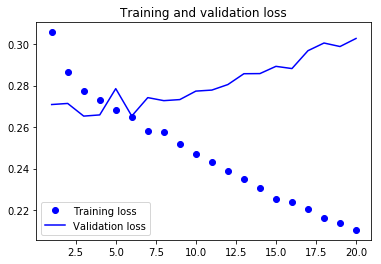

In [79]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

# 5. Conv1D from sequence Data

In [80]:
from keras.datasets import imdb
from keras.preprocessing import sequence

max_features = 10000 # number of words to consider as features
max_len = 500 # cut texts after this number of words (among top max_features most common words)
print('Loading data...')
(x_train, y_train), (x_test, y_test) = imdb.load_data(num_words=max_features)
print(len(x_train), 'train sequences')
print(len(x_test), 'test sequences')
print('Pad sequences (samples x time)')
x_train = sequence.pad_sequences(x_train, maxlen=max_len)
x_test = sequence.pad_sequences(x_test, maxlen=max_len)
print('x_train shape:', x_train.shape)
print('x_test shape:', x_test.shape)

Loading data...
(25000, 'train sequences')
(25000, 'test sequences')
Pad sequences (samples x time)
('x_train shape:', (25000, 500))
('x_test shape:', (25000, 500))


In [81]:
#Training and evaluating a simple 1D convnet on the IMDB data

from keras.models import Sequential
from keras import layers
from keras.optimizers import RMSprop

model = Sequential()
model.add(layers.Embedding(max_features, 128, input_length=max_len))
model.add(layers.Conv1D(32, 7, activation='relu'))
model.add(layers.MaxPooling1D(5))
model.add(layers.Conv1D(32, 7, activation='relu'))
model.add(layers.GlobalMaxPooling1D())
model.add(layers.Dense(1))

model.summary()

model.compile(optimizer=RMSprop(lr=1e-4),
              loss='binary_crossentropy',
              metrics=['acc'])
history = model.fit(x_train, y_train,
                epochs=10,
                batch_size=128,
                validation_split=0.2)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_7 (Embedding)      (None, 500, 128)          1280000   
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 494, 32)           28704     
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 98, 32)            0         
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 92, 32)            7200      
_________________________________________________________________
global_max_pooling1d_1 (Glob (None, 32)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 33        
Total params: 1,315,937
Trainable params: 1,315,937
Non-trainable params: 0
_________________________________________________________________


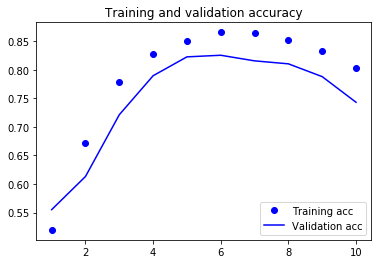

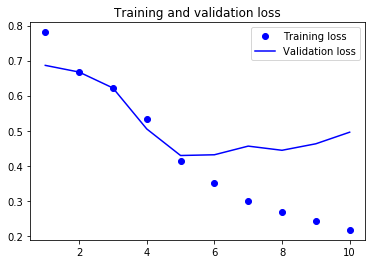

In [82]:
plotResults(history)

# 6. Combining CNNs and RNNs to process long sequences

## 6.1 Preparing higher-resolution data generators for the Jena dataset

In [83]:
# We reuse the `generator` function defined at the previous section.
# This was previously set to 6 (one point per hour).
# Now 3 (one point per 30 min).
step = 3
lookback = 720 # Unchanged
delay = 144 # Unchanged

train_gen = generator(float_data,
                    lookback=lookback,
                    delay=delay,
                    min_index=0,
                    max_index=200000,
                    shuffle=True,
                    step=step)

val_gen = generator(float_data,
                    lookback=lookback,
                    delay=delay,
                    min_index=200001,
                    max_index=300000,
                    step=step)
test_gen = generator(float_data,
                     lookback=lookback,
                    delay=delay,
                    min_index=300001,
                    max_index=None,
                    step=step)
val_steps = (300000 - 200001 - lookback) // 128
test_steps = (len(float_data) - 300001 - lookback) // 128

In [84]:
#Model combining a 1D convolutional base and a GRU layer

from keras.models import Sequential
from keras import layers
from keras.optimizers import RMSprop

model = Sequential()
model.add(layers.Conv1D(32, 5, activation='relu',
input_shape=(None, float_data.shape[-1])))
model.add(layers.MaxPooling1D(3))
model.add(layers.Conv1D(32, 5, activation='relu'))
model.add(layers.GRU(32, dropout=0.1, recurrent_dropout=0.5))
model.add(layers.Dense(1))

model.summary()

model.compile(optimizer=RMSprop(), loss='mae')
history = model.fit_generator(train_gen,
                            steps_per_epoch=500,
                            epochs=20,
                            validation_data=val_gen,
                            validation_steps=val_steps)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_3 (Conv1D)            (None, None, 32)          2272      
_________________________________________________________________
max_pooling1d_2 (MaxPooling1 (None, None, 32)          0         
_________________________________________________________________
conv1d_4 (Conv1D)            (None, None, 32)          5152      
_________________________________________________________________
gru_2 (GRU)                  (None, 32)                6240      
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 33        
Total params: 13,697
Trainable params: 13,697
Non-trainable params: 0
_________________________________________________________________
Epoch 1/20
[   823 141211 139578 121035 109058 188248  64995  71502  37979 157248
  36106 193291 195480 177661 133390 123846  99457 191899

  1/500 [..............................] - ETA: 6:30 - loss: 0.6121[166576 113495 130902  49535 128926 103677   4089  17136 140580 129874
 152067  49241 160683  68252  50038  17700 178902  55583  29365 132714
 195644   6649  40984 145641 143438 170695 124047  59239  98450  43519
 109537  26648 162271  76586 178544 101758 141914 148825 190715   4738
 101241 123685  98570  87603 100619 199013  47348  30083  25035 109377
 164145  82295 180772 198046  60281  77432  59267 198613 105384 145176
  91685 193024  93575  39180  43068 171930  38484 137703  65541  47057
  43867 160759 129727 177719  51711  50662 158128 134606  69173 130765
  23496 150286  47285 198028  95966 197965  97069 184119  23328  85093
 187086  90354  32873 167926  87310  25504  64788  99010  32456 185104
 149871 113555 131393 161483 171483 116262 171112 155790 115074 188901
 133915 106017 142186 111203  70112 141477  42338 112323  31192 122938
 131751 171121  76633  37310  96824   4086   2506 169053]
  2/500 [..............

 104920 161061 197512  64816  19274   2987  89109  64411]
 10/500 [..............................] - ETA: 1:08 - loss: 0.4538[ 45893 191580 125529 168962   9919 117815  33666 172984 159562 101683
 107936  27974  76204 126635 150358 104635  76025 164835  61529 166393
  85227 132781 190927 192042    940  50684 147888  14028 166428 140624
  81870  69129  60983 178262 116303 106114 165778  20667  53068  93239
  53347  59365 136106 145809 172926   7958 111193  60991 154610 151117
 119008 125505 196530  25096  27373  89762  16064   4380 173422 194301
 175038  57260 138947   6081 122495 183260   5749   3251 125327  43636
 181157   2902  39265 190823 154849 195939  15369  81881  12041  92578
  86116 126674  99743  37322 197346 193927 119854  39322 134851  92620
  80586 154565   6640 185156 121679  57134 185371 196243  78129 186777
  22363 144623  75954 185121  64048 110967  52343  52421 119777 142597
 121866  65103  67460 163050   6623 177334 116353 179645  40108  94450
 149521  32854 120553  

 107114 113166 134267 178945 114333 174205  78447 174205]
 19/500 [>.............................] - ETA: 50s - loss: 0.4236[ 17659 103933  33169 135849 132540  93628  56000  65192  22496  88288
  82966 169235 171351 161914 124837   6066  72923 134666  40440 164147
 119875  96733  83925 196310 193014 128287 125366  30864  15056  16408
  46151 195458 154501  75062  96516 162290 193604 139789 149549  29616
 102866  60946 120459 176897 129478 133413  80519 158707 107397 108208
 133193 157064  41137 153984 100320  36543   9471  93424  11111 148865
  41496   1351  12576 140171 105382 119693  28989  46221 181815 192984
  32360  75868 136170  21286  17122 103522  46551 185874 118166  30291
  23340  41888 125726  29738 125872 154991  21129  34047  56364   5622
 156124  69754 149014 160373  48607 114522 199544 107787 114759 137481
  80402 177127 148626  27040  58600  49086 173741 175144 162547  99141
 188444  52553  94732  81108  59700  84044  61827 149889  68134  42273
  31829  93256 151535  4

 174620 153070 168494  78780  89851  35782 168163  26516]
 28/500 [>.............................] - ETA: 44s - loss: 0.4088[ 58146  67238  91236 121895 183039  21004 166997  96817  18072 120620
 185863 129085 135090  45475  82504 135614   5752 108474 112316 170059
  19199  46676 128290  99352   8554 168808  47825 142094  80046  21250
  65909   4001 189547 186475 167915  97731  47485 112938  79618  51335
 142260 123411  49674   1957    846 125073  89439 102157  18498 127542
   7054 157663  95914  76755  82789  59058  77481 185325  70914 131646
  95256 142007  62176 103807  64890 113840  38207 112654 157903 197361
   8493  33707   7017 141745  85266  29304 191916  14657 141197 123253
 107701 144963  59481  51326 129460 128090 171568  26785  13427  88441
  49241  68010 126219  39336 167616 129593  52560 153585 151088  65378
 102882 128110 186468  11759 127419 170417  72568 135542 104186  38093
  51647 155880  97942 142886 114098 107302 139301 162741  81160 180954
  90999  97998 132721  5

 37/500 [=>............................] - ETA: 40s - loss: 0.4017[  8255 141754  60899  65330  97340  69621 161069 140039 150894  58048
  33355  22604  17348 146943 188022  70117   4166  96069 103120  76392
 163204  79988   7975 134251 138126 170404 122781 140685  33326   6122
 126016 113811  84143 171451 160384 198294 114541  37680 188005 189434
 182305  14285 124119 141228  10960  19902 170855 188372 167795  22258
  48627 101578  50706 160543 165128 112106 108858   5617 189647 182585
 143665   8551 139205  14690 102194  54133 143030 197333   2360 122455
 156865 136058  32843 185771  99838 184579  12334 161201  45170  11526
  20625  16601 139187 149437 167496  19267 158289  68682  70751  72858
 157166  55261  86889  93108  57807 105299  76348 163813 131169 170032
 158406  24986  11624  42933 136627   6355  43616 146885  33682  31633
  66394  72810  80546  89451  81248  52545  36050 186203 121440  99355
 189859 177832   4940   2844 167249  36485 164749 177873]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 38s - loss: 0.3943[ 57045  28302 119253  79032  71983 160724 139375 113143 114991  12229
 139908 190893 194970  69088 107425 176602 109177 145691  77461  93553
  36332 127888  15528  61416 150308  66127  46441 104963 139668  51788
 145216 126874 105225 175364   9142 111670  22877  26151 108871 176934
 174355  89138  76961  14587 105380   8307 113500 163541  55760 118820
  34713 172585 183856 154384  19359  20121 109879 121167 149105 197967
  41327 185754 185691 107416  28776 191461 134002 109533 157031 162525
 149359 112402 131016 124168 145370  15719  50044 128812   5694  29571
 123985 120025   1140 120881  11977  89889  68344  20006  70314 138001
  74014 112606  32659  90551 179981 107525   8714 111488 186599 128343
  94758   2013  31515  83847  82642  36197  83610 179266  23282  65946
 144308 184972   4063 110376  12606 112019   6372 185912  22130 167346
  86830  73534 194522 146489    921  36920  25098 145824]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 36s - loss: 0.3875[ 97189 144644 100977  73405 110993 189876 158794 165866 139962 131781
  39510 107020 170856 184382 104006 111757  44495  19297  13404 112532
 103623  87633 131017  66598 109812 114059 120583  59520 148287  37225
  90754  63942 138738 168501  94385  37661 100232  84558  97324  20523
  16174 173917  17745  81090 182804  58238 113018 101108 186521  84163
 144183  13359 167959 175583 197028  25995 168422  84331  40082  25342
  12095  62947  95294  18366 188029   5587  59062  66372  63272 110372
  98804  90345 150695 129667   8848  14785 168847   9212 176431 178755
  59361 128015  83709 113692 106759 143763  77600 184714 143723 136387
  44748 183357  79811 182787  22233  71072 167025  87653  51251  89586
 113497 164876 105048 153944  97854  93463 123315  20316 168935  68906
  29305  77225  56231  29130 166083 123012 171703 191376  21432  76796
  86002 199138  52461  78262   2761  83399 108235  47440]
 56/500 [==>............

 64/500 [==>...........................] - ETA: 34s - loss: 0.3838[ 94412  67724 169347 163147 156601 193103 198267 112504  50564  31195
  14374  62345  80577 185995 167623  46956 148140  13500  51798  54340
  15152  50317 104249 164659 123446  41713   2707 183203 152499  87476
  23822 127996  17919 133288 183945  59326  67607  73087  68212  87263
  55163 132798  34996  16154 115913 130342  51866 115201 186180 164972
  97048  28735 133937 134178 137039 178521 148745 121153 107613  44912
 135894 150519  77737 105438  55046 139657 188647  22234  29495  46313
 139600  37174 165438    764 127276  17686  86720  54750 153248 164655
 178200 164099 152942  17000  50559 122852   4606  32998 186668  97142
  17465  10112  32520   6866 190647  74241  99940 149248  90000 141905
 123430 139584  39158  14451 135665  80920  86222 189861 182401  28691
  39775  75428 105024  65613  95891  73196 158289  20786  23739 191974
 103721  76160 118964  56093  99807 193183 182662 101636]
 65/500 [==>............

 73/500 [===>..........................] - ETA: 33s - loss: 0.3803[ 91001 140169  73094  52619  62263  91625  73051  94296 191628 111288
 180138  83832   8759 139107  29113  77731  36501  72027  24236 144550
  85133 164209 196683  94232   3624 118142 172193   6422 106031  31282
  99685 175717  69135  69854  48284  32149  27502  59716 145665  10177
  25552  55640 141840  15964   3176 166201  59778 199870  64941 196235
  80244  73352  69960 153742 163831 199035 131098  85650 170609 149583
  89478 174760  22571 111425 168384 114095 137368 139146 161932 134072
 126595 112867 163268 183882  65536 188481 122049   1913  99383 145107
  17094 128517 122882 197762 181981 150748 194695 186254  71831 137698
 120024 186135 108446  58547  92420  69250   3141  58123  12745  83575
   9556 193391  36912 161823 170420   9666 122741 158691  40619  83067
 153337  88122 196756  24025  21072 191807 131637 180737 195986  24375
 137993 198886 193520   2789  43674  34810 144160  11671]
 74/500 [===>...........

 82/500 [===>..........................] - ETA: 32s - loss: 0.3765[ 90909 113280  27325 160001 116382 161124  97362 137680 192355  33338
 179869 145398 166135 159836 110098   2662  10005 175244 137888  70415
  65508  64209 141692 134119 157776 136669 151930   9776 165955  70261
 121336 105849 149891 179218 100520 162208 161341  80355  17363 195072
 129821  97301 178672  61002  42937 101928 183265 162039 101607 179556
 132637 164050  95283  16920  41932   7462 128169  86238  65470 171269
  90263  29581  60750 108394  68494  48286  66776  21439 197674 145305
 102461  43356  49130  72246  26809 162982 147697  22667   8018 192940
  25004  46328 179641 142626  73978 166602 149479  68205 187710 134697
   4316   7067  40833  28454   5429  83866  55943  26446  61451 180848
  13984 164512 128834  51455 143161 159737  36434 193484 118503 173141
  69271  92141 123976  67138 154681 158878  17914 187423 152175 127257
 115732  53150  54204  95498  95498 168568  27609 119021]
 83/500 [===>...........

 91/500 [====>.........................] - ETA: 31s - loss: 0.3733[ 30734  83777 127161  34065  42546 164117   3846 139449  98334 105250
 186239  39731 170884  30244  39814 131133 154914 142265 172823  61439
  61367   7812  19511  50126  81148  46886 131379 176322 192591  90811
  24861   9243  42297  22140  15117 139676 104555 176647 112588 101054
 135967 195101  40857 131565  25796 143079  30432  97067 188777  58773
  96507 137811 159307   5669  51128 160578  44313  10999  52707  45632
  61521  57475 150747 135952 165658  60964 183264  69796   7611 197299
 173418  12618 155972  67497 164285 175929  35788  20017  11206  46617
 109284  26302  79813 182040 170931  39095  88257  12553  26640 132678
 124092 179303  64052 180461 173697  41552 103220 143503  92266  15425
 170276  44214   1971 118603 164820 176698  30118  77859  52594   1498
  12581 143307  90450 108763  97810  38641  40750  44630  69984 194196
 125643 160564  23538 153301 159601 135507  81036  40462]
 92/500 [====>..........

  26775  22640  60441 148122  82683  86184  37593 188498]
100/500 [=====>........................] - ETA: 30s - loss: 0.3712[120664 195704 120424  96197  92231  18432  27569 141964   4494  99592
 117150  16861  21184  16768 117225  37695  79563 118650  56985 154737
 125564 124295 152943 145092  28580 162912 146331   5617 167219  15828
  73620 126282 130901 179777  95923  52073 184789 177731 125846 149239
 155124  44344  77464  48092 164052 185671 130883 106333 190114 193943
 191482 176518 109775  57159  26959  37088 132398 165445 115934  35450
  90277 108363  42778  22258  91553 158953  84923   2466  57056   8946
  37681 193842  23319 123537 188988  43260  56726 158099  75430  22339
 158333  39337  43411  91579 194296 154280 114830 114606  16208 177831
 186988 177734 103188  40752 152458  58988 190027 168503 185117 154243
 106116 165362  70449  98132  29351 152758 195894  45300 194271 194972
 165248  17097  53098  74191 157407  93002  31603 135922   8651 198966
 142092 165824  40972  2

109/500 [=====>........................] - ETA: 29s - loss: 0.3679[186132 158340 104621   2019 102501  64064  56093 191423 112926  44734
  11970 107889  27214  26283 171105 109078  74244  48610   5630  59222
 187645 123040 114036  49641 196328 109793 120568  16852 142113 123103
  29608 157559 137887 176004  82416 101307 193183 179341 153414 162371
  60147 102984 179802  52920 152173 162262 185948  12786 115853 160492
  90100  61546 106371 166064 106185 182282 157309 165488  40510  86336
  13231 126545 199890 137498 120122  48419 136975 197464  16929 179430
 116437 172242 124882  68057 144805  69672 130062  19958 150003  63090
 182303  22312  90882  41576 127490  64755 197225  47717 137134  95137
  14545 105880 148421  43918  75842  61263 145424   9930  54296  15043
 181286 175942 186372  75432 127783 177175 145829 179918  82409 133917
 189590  21468 135639  88002  71687  99555 189631 193903 156586  61919
 123013  52070 154519 166850 154803  36786  22411 147281]
110/500 [=====>.........

118/500 [======>.......................] - ETA: 28s - loss: 0.3655[164178  27994 185620 173941 119895  15319  70909  30508  63707  42044
   5033 114574 119220  93853 189898  63698 111851 173854 174444  50531
  27532  93228 124002  19705 110386  80699  83100   3454 117669 184725
  53053 169464 180111 195862 169158 195036  77277 117296 148042 133314
 164975  69456  10193  93169 190741   1335 183679  68928 184239 177342
  17851 164947 188360  73680  99522 156581  28929 124470  86852  99468
 116719 168832 150480 171088  30784 151933 178540  45491  69339 141092
 165668 186719  90781  49058  78144 176392  54377 162000  35289  93771
 145092  41614  88450  56880 102400 105136  29213  76363  91692  66593
 137533 139236  96485  61454  65151   1271  20802  47267 126073 190007
 109887 137865  92680 156821 100662  84658 110079 150881  72239 122517
 110548  76689 178234  14634  45757  61707 123638  81136 178891  39850
  20511 120539 105021  80318 101642 173800 178765 190650]
119/500 [======>........

127/500 [======>.......................] - ETA: 27s - loss: 0.3632[ 42516 170387  21891  42011 104326 157641 189369  94504  98726  14581
  20160  91121 118121  20403 103748  48666  93454  80063  24678  91261
  42179  26961  59540  52473 141749  53334 189874 102341 197331 167608
  55509  81729 172042  58442  43971  25387  56341 198069  71518 134365
 129745 198614 131108  40819 119703 126515 105609  46239 150515 134358
  91465 150782  12290  15019   1596 120403 100895  62215  29542  38434
  24948   7882  32873  65849 132605  89489  31624 156326 133304 104271
 152586  66208  26483 155502  75102 177087  92304  94878 176950 193146
  23319  64794 129887 183525 174379 144649 101951 106932 179341   9644
 138264  88170   8125  46764 125776  18314 143457 149051  18205 157774
   8748 164435 153586 189803 166946 128859  56215 177283 126447 151011
 127323  86084  19871  49273  79881 144175 121636  81837 122119 137175
  38515   9837 166718  65180 165798   8512   5427  89260]
128/500 [======>........

136/500 [=======>......................] - ETA: 26s - loss: 0.3618[169770    758 146661 199649  40707  15892 135286 139470 100446  54666
  83665 177050  98667 157168 162991 162197 184613 180772  49352  80636
 129648  73018 147499 170750  94814 120666 190302 152512  24552 107184
  80885 107202   2224 129422 152735  86764 144086  73498  25983 117546
   6924 105676  88759  21130  59113  73592 154745  58217 195470 101591
 121349  10507 145023  42001 104718 100661  43453   2369  34090 198604
 148869  90083  55962 158294  18124 126760  74172  36855 193095   8111
 150077  16902  42304 194312 169894   7372  24048  85882 162897 149123
 133720 100948  72350 113033 151770  74991 179674 111482 198937  36902
   3782  12361  49318  74798 132583 182692 110239 197324 140657  37489
 194001 191042 105176 137463  87952 192647 188529  50738  59148  52080
 152095 160642 195318 149249  46605 100334  85682  76311 194087  31942
 181055  88334  70782 149649  20200 189440  30079 126942]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 25s - loss: 0.3601[199922 142951   7470  70906  89296  85169 146737  31412   6881 186300
 156616 119597  91160 112801  51514 163701  64785 120335 129575  81493
  38455 185561  50030  70782  61632  11198 179755  16358  48710  91252
   9580 138872  13923 100046  53403  33288 180809 143521  77024 119489
  47569  63994 180027  78480 100654 156743 149424 132424  74403 101263
  90711  76044 189405   7288  37686 101442  38426  98135  90602 186348
  57145  10214 190077 173393 192771  87363  65617 179725  32528 180775
  12041  90735  95804 181867 110479  59087 194594 141692  41408 167982
 139105  19114  82867  25056  77820  46017 179379 171199   9821  34102
 159450  40534 182876  89327  18568   1292  46141  27731 100267  63186
   6599 127194 186694  88286 175374 161640  70110 146147 130197 157206
 191286 124095  10301   3101  24312  18962  27614 168181  47398  36663
 167519   6720  88170  96074 124124  96022 150894  17128]
146/500 [=======>.......

154/500 [========>.....................] - ETA: 25s - loss: 0.3588[153899  63202  22541  14711 156342   6117 184090  32930  64174  76743
  44754  60809  54937 111638  91407 147517  39958  63027  57959 118285
  74924 194465 105648 137536  19323 195876  50418  20615  73406  39561
 151126 198704 132401 152911  40673 190758  63567 181850  26681  25405
  62302  61960  23210 180583  77859 112862   7585  19252  28900 152820
 160223 175534  94260  82004  59111 162124 129921 131650  79981 107635
 196851 125208  69445  94985 176722  52463 162803  15971  56928  36301
  69352 174665 174414  55001 163278  13899 107294  36254 127089 196171
  48972 197891  57456 149058  62993 163828 141534  98129   2481  38816
 163442 156259  14748  15474 133896  92180   1622  94188 175954 147026
 178652 162859 157467  80080 184961 130272  87695  78332  13857  29825
 157580  14543  55763  12963  76288  40078 161695 166964  42648  84894
 137136  31492  41280 196948  52013 137144 135021 115018]
155/500 [========>......

163/500 [========>.....................] - ETA: 24s - loss: 0.3576[102520  10268 140711  85862 183695 156968 134728 189193 164879 163411
  99199 115557 136020 144684 113807 141877 162992  18810 166410  62452
   4393 122902  63619 179139  23919  68707  28445 149176   1794   9883
 173293   5661 178260 175547 173309  70701 197804 150861  50593 196370
  72773 196604  11979  57116 194670 180491 139986  35997  47745 142528
  26524  42124  45265 139480 186881 174507 116881 143124  26677 194218
  95741 105230 109673 158680 193413 192055 146916  25360 114729 183032
 136300  36762 146870   4425  32716  32419 107870  41480 121535  19545
 171424  84512 141822   5635 171128 199000 133582  45268  40233  41848
 157766  32790 133953  25175  28491 177249 128242  10560  71312  57671
  89143 112885   5106 188270 193238  38763 116178  57163  78263 142939
  75833 192821 119045  24730 125406 121035  46962 103804  23682 177929
 186548  49464  60377 113749  77748  42622  60726 139914]
164/500 [========>......

172/500 [=========>....................] - ETA: 23s - loss: 0.3564[133106  68711 126569 100958 182200 100571 198996 195768  82312  24896
 127717  14054   7778 111303  88003  52300  85786 143340 183416 180562
  40161 180000   5015 163358  55091  77342  82210 191137  24663  29021
  83223   5905  48175  32463  71477  26367 141469  25682 181975 189848
  23536 193809  20723  60841  64547 159336  88214  53839 106267 178947
  36094 191659 189047 123366 155299  81599  13402  62996  80953  37017
  65059  82813 190618  26655 180806  74919  85537 192034  64086  58213
 148087 157015  72287 107851   9797 100049   5848 177278 155384 157651
 188874 161380 119348  78470  40845  26225  27663  81935 131010 154609
 145787 172916  40877 106326 177332  51147  75786 107161  84693 171921
  94600 114842 129499  31361 176700  54893  42561  80445  83724  46212
  69945 104732   1685  84043 186445  69075  97727 156517  22012   5497
 129143  80747 166916 148123  30558  54510 105665  32486]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 22s - loss: 0.3549[ 34041 139966 188623 137029  89094 139719   7077  18021 156618 176143
 115638 196370  12861  65300  65772 111503 124797  86987 173862 167496
  63570 168044 135598 130576 171729 148204  89758  85938 121344 109936
  94646  58125 158240  76086  31875 110193  28350 184460 128961 179604
  39393 178416  69782 102531 108145  65648  55738 119933 129347  90740
  94233  21643 175678 122531   7965  62444 107117  87219 154532  36920
   4164   4296  36889 112878 193791 144584 134438  87018 160018 109863
   3696 191652  86326  25743 124668  94818   6418 119742  48907 186982
  75777  13818 184807 192590   6569 197701 190921   7825  22118   3228
 192547 144083 136839 104036 102459 154836 135414 105953  38049   5041
 166776 104869  57979 159079  24204   5432 163832  25527 125147  82430
 165556 182240  44821 134531  26863 104176 197795 137079  29026 126057
 180659  83412 102756  76879 165325  65457  51277 126338]
182/500 [=========>.....

190/500 [==========>...................] - ETA: 22s - loss: 0.3541[116623   1451  39299  36364 175817  65930   9654 108510  97451 162111
   7462   8612  10758 149942 166317  49257 111410 146070  60722   7631
  92162 115978 177110 111669 109086 151771 116597  57464 153462 194243
 131949 143176 114133  45812  26548 196312   5723 146888 108000 189540
  40762  55059  39115 109018  77291  34771  19134 185619  74991 128797
  20709   8313 103396 154938   9591  21988  32411  86402  27869  73115
 125394  44399  67377  56643  21865  33951 178330   1925 125880 159342
  89637 106312  39984 133944 196894 183500  78105  80421 168223 168845
 161620 162355  84084   7889  61478   7747 137120  58959  27221  75809
  70539 165108 172279 105705 153107 165060 163740 122740  25292 181457
 186568 193512  58267  18048  51371 198888 151027 127811 179381 105376
  35447 143682 183598 138688  88096 110948  84921 194165  33897 160260
 136044   4370  58342  99374  88856  72991  63568 152848]
191/500 [==========>....

 101260  80703  84875 140533 192018  72952  45181 196449]
199/500 [==========>...................] - ETA: 21s - loss: 0.3527[178700 140593 185074  90035 127747 137198  22422  11199 152766 142737
 151550 181132  79129 145907 162058   3939  57024  59465 186475 139996
 108803 126216 126459  99249 142248  90734  86711  17970 131950 181837
 169930  46932 161277  27222 137782 183808  39582 172876 171443  15846
 152776  75961 170616 197043  87186 168091  32643  86989  80209 190320
 152619  72461 103775  42692  20476 138423 153572 171723  75164  20785
 107231  80962 103742 128149 183631 172971 146071 141143 116486  16053
 158782 154486  73865 158187 187224  20869   9210  83158   6737  26595
  74228 176038  63620 146935  20869  92505 130172 102067 186940 145013
 104196  89390  99655  48262  50619  38582  37090  43576  47080 170034
 189453  12497 192071 102992 115205 159347 114118  30184 103131 149756
 199330  15551  87929  84763  99181  45401 196301 176965  81057 107545
   6848  14364 133883 13

208/500 [===========>..................] - ETA: 20s - loss: 0.3511[ 16124 170953  13692 197275   4893 143479 111658  70309 198377   1159
  24723 177073  39208 183969  33459 131210 157782 103269  44221 117185
 158127 127141 142951  81941 191398  90458  59512 176660 127331 165246
 118941 194539  94228  68783 189019  41068 175192  66261  55680 178300
 140716 114743  64133 109309 101335 139520  56233  51828 188620 102230
 118503  89480  79752  40830 138507 167100  37616  64664 120689  35641
   6127   5179  81650  31897   6904  46848 139983 149297  51687  26953
 137668 190162 174400 197847  15211 112479 153580  78185   7818 131945
   2915  11930  46210  95416   9190 113908  92514 164876 175000 191465
 137225 105134  43860 147796  68424  90083  30707 135185 106805 188117
 114344  75239    941   2429  19155 120832  60503  52077  23991  93581
  51659 134438  48404 187528  75021 185359  63809  50165  17835 167636
  29600 135387  25867  91845   1882 190380 121648 144642]
209/500 [===========>...

217/500 [============>.................] - ETA: 20s - loss: 0.3507[185186  75676 184635 121687 107826  59679 163188 141221  45865  94138
 187617 104813  86084 119067  69552 122914 173722 180835 134164  56038
  56927 121385 187805  47565  43390 122197  18264 188911  12820  61470
  54402 151899 179641 107989  74862 165154   3306  83848  43495  54623
  36879  93561  53457 162778  32244  29470 100676 187113 114946  94703
 166934 112923 111022 158776  55792 144981 179396   8175  69302 112654
 126487 144352 101570 166433  50294 102869 169063 141555  49238  30170
  42832 145271 194275  52632  82143 154777 147945 171267  49994   4301
  24345  39883  26064  92946 146619 104036  33446 110175  88157 191311
 115284  76745 198075  99437 167417 101399  21996 117377  12773 157665
 116928  91513  79689  42171 157565  96531  10770 181209  11889  38267
 132318  62554 149751 155580  71846  58078 154205 193084  64402  84981
 157298 116194 105011  65474 106290 148296  69760  79738]
218/500 [============>..

 120770  12112   7797  18093  10608 110105   9165  61808]
226/500 [============>.................] - ETA: 19s - loss: 0.3494[111364  82344  48467  98097  11458 181651 156564 124656  86611 186884
  89878  30162  50673  97411  75034 143408   8378 193620 114177 178655
  80876 141238   6258 101954 107600  19426 165095 195938 190457  58741
 172260  32609  25224 162366  56616  24692  69761 189332  48598 158090
 155117  26048 142588  62432 160777 156449   4283 186851  41457 182706
 136783  70765 105286  37042  96798   9276 165079 196606  51206  56622
   9114  55018  77473 148604  63633 192371  66136 127825  57166 138922
 198891  49311  60568  15334 177119  54433 118282  53756 155249  95582
  59981  98767  78953 167057  56039 101572 156792 142226  94749 181052
   3180  96547 114454  18510  69585  59195  58266 127965 123618  10714
 169726  12503  79817 178055 142628 123608  76523 148773 154785  43392
 177437 143340 150911  35760  18141  46722 194630   7533  42265  97823
 186982  58448  77038  8

235/500 [=============>................] - ETA: 18s - loss: 0.3483[ 49165 128006  70849  17025  52951  30982  11925 158540  91966 187551
  55138 103155  21975  40596  10742 139446 186357  43761 119953  91861
  70560  79780  38832 182042  98119 134479  65523  78834 101460 139254
 104047  34794 171844  65698  32235  32336 195721  67326  46734  95284
 188972 136788 148467 124495 143303 199881 144587  98092 180760 196589
  60348  74986 173524 125598 148253  44253 150681 184808  89773  15530
 112859 104901  17746 165485 129255 165828    745  58298 146493  58918
 171653  65730   8084  10321  69061  12162  60124 161139  89774  53097
 146059  63797  58899  90072 193082 194552  96226  93521  70951 199763
  65317  46512 177738 191260  21590  59745  56760  10980  62459  85258
 127132  96210  94941 110358  24103  25832  94510  67704 166643 115495
  60120 159157 130867   8959 158208 178417  88295 118607   2258  99592
  34156 132381  19344  88926 157449 170576  94957  55055]
236/500 [=============>.

244/500 [=============>................] - ETA: 18s - loss: 0.3472[ 30110 170758  90641  53465  30473 169164 161325  83125  13758 147526
 156749  47100 158513  40582 138642  20322 168687 182884 153320 154034
  20511  26065   6089 182464 112509  92281  16706  12862 158227  69661
  77524 196928 135970  69837  31818 199429  30297  14554  30995  40399
 134448  34445 139871 116747 183320   2443 177065  76701 154675 117299
 181966  88513 119240 124616 101524  27299 114297 157692  28560 175333
  12457 154811  29605  86576  55908  24739  34316 176541  53415  66379
 156936 109811 164880  25302  12234  40354 184833  44017 101691 140510
 109644  34313  43754 109850 169065 100642  64511 162434 181655  79500
  45377 163177  89816   8939 177898 127874  92588 187222 181745 166068
  13926  26928  78985  48424 169226  84236 172491  36615  90444  18306
 180745 128229  48123  72438  99482 117381  31411  84731  52387   5035
  30401 179798  90728 146074  44598 152781  42195 194907]
245/500 [=============>.

253/500 [==============>...............] - ETA: 17s - loss: 0.3460[ 22575 166916  54183 115942 174075  89512 177874 105391 111135 150306
  76200  45137   1234   9330  70519  29208 151928 147740 199123 104295
  98110 119385  84440 183485  77342  96522  69899 104823 178604 152465
 171661 111419  12713 107805 106394 182654 108761 147998 102225 156550
  33098  67668  53851 184673 103976 191148  86708 160349  38634 158978
  31438  15268 158203 106296  14412  56212 155613 155720  60180  75051
 136199 185181  77582  20009  17308  17852 162109  54807 174644  81132
  68000 139106  69314 198589  62715  28957  51326 161874 146060  20472
  10106 160506 165700   3407 104213 176505  75371  74090  72944  59081
  47831 124623 154115 179575 168899  78895   1705 176142 104604  51446
 158463  66999 111282  31269 165439  99879 160202 149527  51690 171173
 161844  36032  15365   9078  40147 187936  76770 117776 176686 173993
 197526 101683  77374  69971 176276  55913  11833  13677]
254/500 [==============>

262/500 [==============>...............] - ETA: 16s - loss: 0.3448[ 40801  70350 169272 162216 105616  90540  38748   1145 187973  79204
   1669  75274  68681 113248  71275 177913  78379  52855 160797 112757
 149616 164654 147121 164229  91991  50424 113559  76181  41898 198092
  72194 117854 146511  20671 192310 170932 108320  39832 100833  80108
  93623 123234 174468 189253  14710  88747 185325 168398 182313  57828
 195971  98721 157775 123757  74422 190160  81274   5614 136102  17186
  72141  11566 111702  26094 198724  67804  76036 143010 161490 171756
 156228  26615 149894 128098  74678 161525  16929 129555 153351  87718
  29658  52656 152378  64816 105752 145412  39938  74788  89305 102103
 131413  79181 175794 140366  52818 145241 177509 168625 117826   9735
 135897  40486 181626  96097  27740 112148  98547  88688 125532 168987
  38164  20090 110932 103212 111875 198176   7524  90665 160501 139193
 121673  16694 174550 159741  26864 156576 158059 105602]
263/500 [==============>

271/500 [===============>..............] - ETA: 16s - loss: 0.3438[172081  26533  61607 174684 153379  63579  27567  49926 183806 151569
 142745 154260 141056 153659 131607  61409  70161  83116 110040   4280
 117924  87535 184516 150318  46280  39178  42815 178037  30173  70151
 146857  96667 108170  79113  19100  14868 131096  82052  75069  90856
  66213  71327  89265  14920 113070 190534  46845   1364  37076 118788
 173664 186855  58848 140751  52389 139832 170318 111828 133232 114180
  16665 149800  99342 173130 114318  39969  90128  10602  88172  54776
 152638  74617 178193  66266  52155 194015  92621 195673 142219 191345
  80468 120104 180085 123878 199635 105748  70726 194861 116376 114396
  16089  35544  87495 138277 145553 193434 107449 152976 115420 127521
 105725  17505  73397  76764 199947 189078  46929  97629 178064 180777
 170792  46563 198481  78936  29534  22125  95456 109925  33420 113310
  70816  30036 146067 146802  51593  79693 191955 198856]
272/500 [===============

280/500 [===============>..............] - ETA: 15s - loss: 0.3431[ 51862  33921  39008  29887  17528   7941  28096  24828 189080  63502
  64240  27039  50240  36236  72007  98814 165965 116772 136039 159761
  77103  53539  94522  51747  40134  31710  94545 185527  68254 148533
  22793  95335 136177 154749 124372 157875 198550 199374 130192  14946
  65138 171841 145614  57195  12566 144306 188283  98963 180451 190109
 160961  47396  24573 141541  76264 178646 166385  67368 170571 166091
  24804   8532 106334 120316 198255  90927  42008   6430  88968 129398
  71509  20526  75434 157531 184469  38118  40853  57861 194774 100621
 161124 164316 199824  48908 119765  55402  54359 135852  47843  78755
  53357 105503  98994  88322  14263 177647  69311  95552  36890 114865
 129029 132092 138679  60939 121582 191035 195967  59375 131648  38747
 135417 192388  80098  94886 142243 194409  97418 123107  68159   9826
   2104 115366   4438  86777 135833 156141 151192 166039]
281/500 [===============

289/500 [================>.............] - ETA: 14s - loss: 0.3423[107026  50125 194599 155893 183526  24120  44187 120160 118290 195290
  27715  86761  94429   9053 109861 154122  69929 104627  15328  17739
  44774  55220 149127 159002  47575   3758 159844 167575 116390  76098
  11480 110959  16124 115665  76265  83729 153407  85185  72450 160320
 137144  65797 118752  89495 191324 153481  71062  54512  96504 107408
  75513  40600 192569 168898 167370  65327  19098  12477  96001  69846
  13495 110780  67987  83446 173677 173343  52707 169362 146673 161855
  13632 195866 197047 142698   4654  97042 134314 158242  38693   8847
  12285  94199 109002  29490  73610 196424 154434 148522 167636 164119
 183533 189361  77562 165659  79701  24375 187085 114529 182131 159108
 164742  84264  64813  64117  51676 169500  75587 137393 125385 153512
 115350  50346  36162 150341  17620 154001  61551  95111 130518 108724
  45027  93057 108442  68440 107122  63859  16884 186518]
290/500 [===============

298/500 [================>.............] - ETA: 14s - loss: 0.3413[ 53499 127305  74432  61354 148929  86016 194924 197231   4047 190820
  89585  95941  46235  84481  23032 120910 143089  81578 103643  17128
  36390 187541 161433  65652 180852 109476 155705  23956  26840 159487
 124956 181781  30399  88583  69371 100851  75321   1800   2688  39511
 151351 170634 140676 164101  44784 179060  91803  16319  27503  22360
 186448  33008  35994 148433  15206 190801   5556 192510  70296 111219
 195572 161914  46053 138919  65248 135527  56096 190812  57809 127837
 119149   9703   7783 157983  28839 195184 152397 159862  88648 106063
 117396 196200  89006  71127  51952 189756 174225   4254 112814  68485
 100664 145606  99740 198167  57424 108739 183067  90930 186604  60982
  75542  38103  53786  89312 124066 161637 141727 104362 116101 132915
  26835   2784  71931 105076 195398  27216 155299 159204 196263 130728
 143038  30633 144706  48134  62198  84404  49749   5528]
299/500 [===============

307/500 [=================>............] - ETA: 13s - loss: 0.3401[188908 111488 143379 121389  86178  10488 181739  58971 132077  92895
   7903  45851 162738 151348 193717  23048 104014  61438   5138  11963
 130088  23241 161328 171609  13798 183850  74877 140760  61053  62765
 118515  41999 180964  47190  84980  92026 152874   6635  20740 138429
 134255 160988 135904 154564  65870 178295  93797  16668 168272  54389
  68037 129205 139579 127526    876  14707 158772  38975 123720 178674
  15340  21175 180555  27102  18308 169712 164503  85807  61835 171507
 163066 107736  43537  34880 144475 146494 156130  47015  41049 136873
  39642 189237 118763  59525  85505 137849  95578  42329 165783 124588
  82239 165781  68372 160260 127104 108498  30946 149907 125364 142658
  92046  82089  77486 195999  83759  18977  97266  76026 146613  53447
  51477  29003 145521 114143 118017   9540  25683  69596 173176 113244
 112909 158418 164810   7482 146800 181081 127707  61858]
308/500 [===============

316/500 [=================>............] - ETA: 12s - loss: 0.3395[  7923 144634  35947  87503 159140  46218  46383  12205  25545  14458
   4149 176547 189242  51864 102998  86171  41095 174309 113903 195405
  35905 119959  54518 117719 182352  92758  12804 140439  36444  63498
 153095 170054   1532  31947  14250 168481  60856  52502 144551  21591
  78311  56226 123349 179097 176950  87223  30541  83931  24066   9656
 117734  61013  63693 181356 113669 159104 171239 184390  92230 163648
  64930  18279 102358  24994 143047  80313  51395 116718 104953  49727
  54991 146742 155821  23550 108147   9505 195789  30632 110863 116529
 189762  82857 184867  51639 112614  60264   5897  76963  71730  20851
  38916 144276  94658   1155  23829 118611 150038 167805  53562 190926
  21253 173538 101406 149433 165722 178372 161180  92492  53893 140151
  71057 149707 114901 141672 175139 133913 170041 128794  90684 159314
 174431  38836 162360 137546  99382 199827 142516 186016]
317/500 [===============

325/500 [==================>...........] - ETA: 12s - loss: 0.3391[ 67197  91435 176633  19570 139563 197484 186964   6861  12834 168029
  99318  56032 128823 173489 177924 172885 146429 182007  19912 124922
  31075 146708  94488  86896  89351 153424 177301  77984 176734 118157
 141316  45255   5826  36275  46456  81509 105167  51438 184119 176074
  28504 125590  30906  69487  96941  81528 189941 106932 119767 109627
  35205  88643 102695 198050  16593 101541 108784  47032  92926 189906
  26176 126494 175576  99066 195548  48638  85610 197423  73014 182365
 177281  96035  86971 163456 171917 174415  40832 124545 162853 133675
 120113 161047  65262 140176 120495 149589 124692  72460 116343  80302
 116619 125097 190622 119845 110458 198798 178205 100052 168138 122513
  41120  60574  16174  70407  68001  56140 113789  47001  22240 175196
 106740 168662 182872 110713  46572  13985 117381  10981  67953  71602
 183101 184085  94736 181781  98466  41536 128133  54531]
326/500 [===============

334/500 [===================>..........] - ETA: 11s - loss: 0.3385[ 22055  79757  36196  24960  37106 161030 123375  17055  65284 100667
  57046  36391  69377 177593 189652 195437  62186 118047  50060 176171
 193630  90195 127317  46766  54793  47334  52157  67925  80276 152828
 128490  34054 153262  41824 138458 156155  52093 186528  60437  38870
 176466 117508 177019 176123  91456  78171 188983  15716  14448  72522
  75357 114463  69134 100463   4222 191119  52294 178329 149123  61108
   2891  57605  15166  68707 146907   6082 162505 147648  81085 112667
 108942 150351 123275  25259  16477 192849 163862 101582  30072  51927
  22168  20647 102753 187562  68673 128302 109381 125205 113901 138956
 164764 106931  18290 169057  19717  67909 185846 101399  43584  18792
 145943 160531  67872  22693  39440 146085  87837  55016  58451   3053
 176676 177566 121792 191138 150600 179430 186802 187583 149079 162806
 142020  12243  97965 129743  71015 115299 178526  99959]
335/500 [===============

343/500 [===================>..........] - ETA: 10s - loss: 0.3378[123936 138722 193745 136975 148061   7597 106674 161522  16326 159511
 134042 164702 113805  82077  12378 155590  84499 142247 174650  89681
 117759 152773  95681  10883 111807  58762  60520  83161 176672  91124
 128339  55663 134075  71041  79571  23070  37750 116559  86392   9018
  56999  83166 118138  34182 116345 162841 141786 162324  31183  24073
  61238 140007 179947 143506 193000  87869 139653 152216  59042 143154
 184909  46300  59188 121566  50763 104892 197963 134757 187444 150455
 141147  98414 104161 192052  15925 172435  99613 111885 103192  39952
  91803  78070 114193 132205  41720 123914  24851 116538  10952  10550
 113371  92948 134158  33836  58377  20750 191551  28960  44415 108705
  24023 166214 107297 113004  74174  79603 123542  68625  11360 174052
  99235 185247 168732 167679  62949 123378 119218  63531  23142  18000
  44879 133229 101720  17671  44108 107654 104655 157172]
344/500 [===============

352/500 [====================>.........] - ETA: 10s - loss: 0.3369[123314  35191   8411  96483 172582 131893  52193 151067  70859 159242
 158018  51431 169633 199574  26574  80503  18184  16821  67900 148304
 158310  60423 166742 166493 124542 153499  22105  72650  26351 118100
 117420 129495  41867 175897 119481  59356 162013  75920  70704  56910
 124815  14713  40030  85017  69746  45361 141446 186215  65495 170394
 113880  53260  70956 144631  84083 115547  34294 141212  34169 194522
 118244   9527  16278 103239 198978 158601 157566 145980 126918 188563
  66775    775  19534 139405 106729 163386 155125 115683 189251 169985
 188153 151799 108441  43456 147867  27066 169875  10208  69838 160903
  56489  84123 139693   3302  79925 134628  29963 155275  64509 162688
  13926  25240 113224  14010  74313 194702 146718  10341 120540 195750
  33679  31132 186062  39058  24630  32464 180038  11405 103646 121607
 192958  57517  10837  86349  73962 160252  22054  19982]
353/500 [===============

361/500 [====================>.........] - ETA: 9s - loss: 0.3365[160783 195934 145630 189711 173279 158348  89862  87960  11958  91295
 119355  52895 115238   3768   7349 137547  28228  63544 111442 196277
 143404 157975 152017  64244 105395  72400 155629 199669 119090 178949
 136861 151292  66601 124513  71673  45190  31038  50908 122818 157983
  11980 104340   3701  88768 176027 135281  16902 165926 115095  48018
  27856  87816  47291 187833 172944 139817 166625 177377  99694  39073
  56827  26784 106288 139220 125682 109858    929  91570 117644 154556
 174811  31501  72507  93386  88627  20541  87954 165703 195052  19321
  28478   5948 120134 160642 164615  73467 178539 106438  16886 177961
  19767  56296 119399  32069  82928 143375    761   9960 112334  72396
  56411   6386 108950  10135 195482 125282  74200  93984 178044 155092
  86651 166457 158994 165865  92923  44062  91829 126679   4837 174634
  16052 193197 176262  56407 193634  70670 104341  97876]
362/500 [================

370/500 [=====================>........] - ETA: 9s - loss: 0.3359[ 28892  77208 146962 164867 193367  85050 119402   3237 189094 140013
  57976  70464    770  40070 156182  54382  10653  48884  17954  94561
   3001  95243  13242  76975  84679 198567  47523  35894 155242  28113
  16652 172907  83688 188878   4930 165224 174232  78070  84719  69555
  69491 181327  95785  66558  65347  14481 191061 151022  39299 187226
  67470 123145  41352 149319 193682  12411 136709 151195  51137  16960
  29974 112373  84986 114776 150714 135708 179631 103008  20110  34000
   9650 134985  85181  63064  13457   8210  47986  37961 198355  79143
 127530 127849 189466  18103   7327  40004  91178  89654  92538   3876
  59706  43867  51659 156519  89407 196830    729  44226  62201 145149
  24676 108223 179524 162919   3284 142372 146456  93013   5794 126852
 160786  15905 120442  68452  48591  74847 195214  24581  63069  14911
 119429  50990 136525 149028  19508 175336 172128 106182]
371/500 [================

379/500 [=====================>........] - ETA: 8s - loss: 0.3353[120817 147833 132640 191536  79693 110253 146799 171364  77793 173452
 132855 178848 198811  16455 123462 155479 176717  75744  49012   9790
 162419  32411  29542  88141  50742  25518  15270  47063 119065 189363
   8542  72185 126033  67693 157474 139118  40139  11011  59408 120324
 137363  74657  49137  76609  54303  70679 140210 192772 124357 134220
  17385 129335 199084 149734 162606 179737  42150  64871 130034 165072
  67439 196111 108406  56011 196542 133987 156636 125453 128937 137966
 190662 140532  53507  92118 104600 182052  59701 124477  93362 177282
 194005 179647  32607 133454 122114 107824 166730  90553 131759  35119
 192519 175392   8996   6434 103121 147434  99987 146967 127940 120339
  90809 138924 116401  43753  93526  93028 193902 177502   3982  53880
  55484 144231  54353 156551 140579 118220  31444  34944  91615 161484
 162449 134389  76190  37244 156986  22001  76936 186526]
380/500 [================

388/500 [======================>.......] - ETA: 7s - loss: 0.3346[ 75552  79451    745 117300 108119 135224  17459  65888  51529  48607
  26273 113939  11736  39359   4972 152993 178701 120266  55352 160368
 150795 134457 143972  24111 184573  82221  18072  12450 136117  84023
 136866  64632  43167 196957 160927 134922  80157 149778 176416 153660
  33931  64820 197347  61374  64160  50696 165984  33667 145703 139375
  49768 143727 197062   4194  61177  86371 130249 154552  58847 130708
 128474  61439 177493 194817  41978  10273 174278 117401 146822 169941
 132343  33512 143141 153185 133632   3943 107388 177620 153732 185976
 125150 103699  81190 187711 148522 120081 105719   6182  54990 100016
  98383 198131 108506 136231 139061  64275 166579 115874  79385 185162
 105794 178691  52026 102714 177613 124608  20833  18323 125794   1457
 178657  57196 182340  49196  67956  56416 125543  96442 100099  80437
 143166 103030 115450 103120  10634 136540  10999 142987]
389/500 [================

397/500 [======================>.......] - ETA: 7s - loss: 0.3340[161601  86539 142710  83520  64473 146746  90607 130871  43967 193233
  39918 157912 120303 130293 173026 114403  84800  47098  93969 169445
 168340 149714 119291 128032 179264   2492 100950  81433 149465  61719
 121807 116179  51923 125201 125057 126107 149055   9523 104257   7553
   8685  98727  36756 162537 167440 115964 193167  52036  32996 173469
 176927 192348  82492 173035  86117 163457  16311  92847  90806  99440
 108218  24512 150367  12796 106987  91439   1117 112983 147645 118757
 126272  21487  95506 116505  91036  77700  38815 135703   9526  26942
  10468  42862  41609  48971  38928 162353  97243  86768 111836  86003
 129477 182618  38284  35225 141296  39607  62015 190965 140023 195187
  47657  75125  87409  39891  33927 156886  57558  92898 112975 177926
  44061 134845  92290 121363 164761 162142 100845 171768  49312 165396
  96814  43265  11974  49997 198347 169886 132257 126595]
398/500 [================

406/500 [=======================>......] - ETA: 6s - loss: 0.3334[108144  33841 194660 181486  75421  56778  66451  64686  22722 125334
 171353 165597  94574 146462 103133 180538  55528 119192 144189 154692
 189574 100639 152545 161418 180174  13490  16285 186458  41842 122486
  88956 141189 145767 124690 133604 124835  15152  92637  56290  67064
   8091  54274  81796  81889 160263  70455 175576  76048  72728 136435
  16607   5686  72673 154325 174318 171107   4861 131573 102913 158430
  23004  50873  36953  43652  36919 159076 196525 149711 100913  55864
  31576 177318   8575 164489   9148  81428  81627  93553  82699  28813
  33009 122169 116428 176618  82061 166866 165291  52967 137030  78026
 144315 122783  56707  80008 146654  14862 120540  80241  95521 179134
 198768  73960   3214  95233  57722  35116  45237  53529   8758 163790
 140555  81368  99805  24548 189301 172651  98583 197954  20099  31617
 179989 197653  59186 168716 116617 135282 103070 172642]
407/500 [================

415/500 [=======================>......] - ETA: 5s - loss: 0.3330[ 79464  22639  39623 100689   7063  51123  47986  37126 185973  89723
   8509  19537  55033 125261   5106 130506  92582  63562 125870 118735
 126189 198081  35829  85377 194620  51020 179931 108480  39240    728
  91951  42843  35595  18257 129203   3504 139538  71182 122439 167864
 157427 152135  26609 142620  73514  57236 135278 101671 165470  15400
 142770 100646 131648  97747  82537  64906 132839  16736 139113 169299
  71320  11486 103279 101228 169053  74949  49854  46327 142625 195575
  35361   6995 180522  37466  48658 118197 191530  89672  18039 152085
 199745 105571 126059   9920 107267 135946 106538  83623 110876  99248
  61326 183269  36385  38798 189792  13063  89683 114855 117100  16378
 136437 143623 178507 157699 199571 179697  31878 181564   8681  44313
 127385  23155 126610 173742 170155   3132 146697 165159 102127 128698
 150143 139364  42526  91444  42403 104037  68269  21253]
416/500 [================

424/500 [========================>.....] - ETA: 5s - loss: 0.3326[178769  88340 178001  14295   3688   2822  82812 134423  27573  97171
  26663  48293  63511 157859 197648 150430  42305 167719 186210 109490
 162739 194993 194215   5588 111753  97302 173161  93151 163276 113130
 103601  92614  10046  83805  41985  70459  38058  99177   7698 159677
  19554 135299 147255 116121  62119  48042  74394  29559  50691 123456
 101830 174266  63791  96745  88292   3966 123523 191307 157051  71933
  50041 164705  82216  26601  12300 107586  57629 124126 186545 152624
 163152 117006 152617  74268  67110  67053 151475 199575  98697  80688
 142671 179689  52940 143684 125600  42050  26522 193548  53654 183299
 160251  76765 173051 154312  12986 199354  95511 187213 116664 170862
  89306  25247   3129 110521 118248  81353  86416  19822  16045  35232
 138149  87782  14265   1523 107453  75274  40052 125852  34721 142751
  85044  30768  85662  44167 181125  91432  40733   1598]
425/500 [================

433/500 [========================>.....] - ETA: 4s - loss: 0.3323[  2511  78348 166685 181279 123467 102600  34987 143297  87727 144341
  97254  63321 120653 150463 125247  58600 159902  78289 152575  88250
 107153  17732  38505 157997 121896 133927 142192 133329  31678  38214
  10256 160692  13210 120624 125369 137888  92784  52234  96052 118014
  28073   6377 167874 183013 149476  39093  47454 133000 164036 137334
 131701  21697 189884 158260 160858  80750 127221  99099 114361  45214
  79572  30040  95430 181865  75904 187401 147985 184127 174103  12442
  88066  80237 165099  78470  11977 169121  90506  10615  37244  78967
  60106 158661  48210 169505 132531  90920  34321 169381  61872  47736
 165778  32467 106295 100609 195278 197360  42011  75311 132100 177671
  52258  30037  93915 106650  44081  77842 159442  65650  34989 151683
 105387 197999  42831 174903 124026 188109  48556  29042  52093  97132
  14413 125280  32510  47596  18509 140490 149027  57682]
434/500 [================

442/500 [=========================>....] - ETA: 4s - loss: 0.3320[ 27182 113809 104034 154843 108693 100369 137063 160950  26075  50398
  27857 104286 136443  20050  14505   1081 139220 177137 149295   1066
 116950 111021   5424  87287 137279 187958 135345 145144  69785  62315
  64712  68439 122338 107045  19838  25629 152475  66161 188300  96989
  41040 184888  91820 129413 187441  44180 175845  98780   1896    888
  75015 199187  71010  94375 153161 189174  61878  74593 148910  36241
  36158 103196 139619   1059  84915 144587 160445 141537  80742 145777
  79068 143965 161911  76148  77434 144878  37287 141354  23662  20788
  87471 122892  17891 111676  44713 136725  20599  11158  37827  55083
   7155   6096  65499 144260  80792  73241  56151 111769 166929 187030
  76691  58487  50697  12399 122289 131681   7970  33688  39097 149499
  84331 137969  53712 116690 147799  64563  71356 188397 135428 199031
 104428  23179  69542 173459  90178  12930 186115 152824]
443/500 [================

451/500 [==========================>...] - ETA: 3s - loss: 0.3313[113171  87714 154257 193964 135872 114380 171086  48439   5571  93503
 144392 130368  45935 137288  24832 166837 114840  24845  35535 101436
  85337 135903  28503 181983 100949 170328 174562 124076   8687 118193
 153340  20741  11607 179961  14844  78707 176933  55720  51044 123805
  58785  92207 120723 116048  44331  83203 159580 101242 108600  14996
 149238 194598  88561 125753  16008 131145  66203  69234 185933 169892
 111275 125443  54200 167616 126271  32953  32381  54751 198505  16352
  80848  52911 123996 197007  94895  81533 159359 142224  25408 196280
  19115  35706 173408 155855 188056 156699 151266  80373  56773  62901
 146620   9840  39325 123045  23402 109036 136153 161935 160371 141797
 119445 193177 174574  60178  18261 154814  90213 148282 184568  21987
  43084 151260 197900 147967  59297 185923 116668 199451 185973  38531
 101514  99302 182834 122695 131794  17895  22111  29395]
452/500 [================

460/500 [==========================>...] - ETA: 2s - loss: 0.3308[  1015 145299  71358 160145 182439 143661 100288  89445  49884 102765
  13829 114476   4080 187210  87622  82845 156247  11094  48280 199877
  22826 118602  84570 139355  89374  29272  62085   5597  30209 149280
  36317 174470  92279  87603  52231  90841  79148 177835  36341  92529
  29635   9785 138112 106037 123233  79423 112124 191491  33853 135642
 112063  25014  69227  77711  35573 130944  28321  42638 162740  48526
 171168 103863 149494 107036 164215 141907  70974 170683  23710 101501
 176985 109322  67813  12537 154132 107552 178756  92766 113191 121384
  30173 185822   5610 165802  90565  75203  94779  81742  32797  58275
 167582 169110  45396  60627 121413  80638 155600 170993 105748  23201
  55762  83968  75681  61860  56732 149319  48435 158695  20910  83573
 173597  86635 135228 152476 165176 105431 126135 151445 194804 137624
 195261 163348  27800  59379 166163 103447 179766 161931]
461/500 [================

469/500 [===========================>..] - ETA: 2s - loss: 0.3305[111955 136099  23214 127979  51397  92839  41806  65476  36839  84378
  96286 194362  38647 116544 110964 132748  94275 106227  46216  97061
  58175  74635  46358 176240 194909 163265 136930 144364 169258 182453
  63133 128483  58829   9250  27633  95958 118289 168897  48445 155868
  90231  79311 100712  18788  55179  98778  73503 187245 148871 147316
  28026 111178  73220 194990 175603  26596  16008  95659 160555  47657
  35120  57000  13832 195754 181908  89349 181773  23029 145428  16760
 137083 154156  75454 170681 176597  13565 186775 172728 119461  25807
 162984 192209  59418 127353 180933 166220  16725  68822  94428 195829
  14804  24967 150908 197725  89210  35307 123673 172516  51069  20886
  25725  53955 173470 107655 132880   1276 111680   7007 128506 126346
 156858 140519  99843 181961 195210  79405 188990  26531  68178  11408
 106224  94642  10061  39963  10340  27810 133021 153210]
470/500 [================

478/500 [===========================>..] - ETA: 1s - loss: 0.3301[194858 177687 123744  68826  48972 110778 166631 175536  19052  14079
 179377  57768 190985 107459  36042  86592 158072  36421  41558  47756
 154033 157069  91490  66155  21664 152873 165969 120475 143966 144611
 131068 116376 172896 124589   2241 159964 182651 196420  68782  64295
 163025 147434  46765 143726 142262  47924  90070   4101 116964  79294
 123717 183779 167552  21036  35380   3839 138443   1649 123375  98688
 129528  45120  66463  40873  65400  81269 187511 175986  65317 150423
  90288 157293 196054  33749  13389 110578   3257  34505 100592 199532
 150388 119632  85870  95164  68078  25215  44111  32176  21298  21550
  82639  63510 133380 141504  61758 102963  24096 130087 193303 154119
  38488  78253  61949 102551 105914  74123  23130 190586 190619  43835
  71409  16028 189145  31114 166248 176675  15774 133950  99696 123089
 131397 117935  64695  59528 122424  81337  58506  66194]
479/500 [================

487/500 [============================>.] - ETA: 0s - loss: 0.3297[107396  94531  79095  80934 117393 153351  71499 121987 187654 127498
  51928 183803  70881 183865 141102  46218  75085 124945  72179  71621
  14147  47057 159300 198495 108520  46287  40539 198730 102002  41167
  42541 199866 133572   6427  94925  30792 175407 183979  76787 115161
 157704  33872 108913 100478  36205 139772  99816 158739  19476 191619
 130206  81617  34754  93409 107304 135648  87168  89241   4946 134535
  55134 169049  54967  26256 132354   2108  63566  72061 156292 143195
  79208  20914   7335  19648  27919 146292  78781 116570 184431  27554
 150399  14374 172009  70823 115642  44328 102892  49414  48707 131390
  55855 132009 167559 147829   5118  51933 157358  83572  96256  39012
 169572  67005 119104 151419 121359  26391 153491 119930  81257 194060
 170018  21445  82462 109038  92298  40203 176468  99052 173082  29444
  82013 187416 151937  18995 147295 106480 134642  84833]
488/500 [================

496/500 [============================>.] - ETA: 0s - loss: 0.3294[ 80508  22898  21224 133681 178844 166510 183631 178576 169913 145136
  49177  89246 108864 190936  35478  22388  69325 183589  92591  74560
 134487  10548 143770 176148  48676 128772  86675  65591  33318  84664
   4590 155779  51045  46500  66822 192269  38380  91200 171585 198502
 192400  67331 166532 136790  98692  98887  13121   8462  55370  83180
  64123 154538 144580 161001  24964 133455 147449  55296 174152 156681
  49624 105548  92732 113550 152735 129340 150767 105365 177446  75549
  60641 113280  38149 177518 108234 149549  11840  20207  50084  34789
  86082 178514  39575  34351  54149 133943  30376 112852   2811 135946
 150058  29378 107680 190763 160468 127731  75381 183744  19333 140838
  52895 146084  17805 139334 120020  77845  78198  95843  78403   1349
  48342 159366  92883  76398 160236 168714 132497 156835  68867  72949
 129708   9375  31912  35077 138859  13585 117456  95325]
497/500 [================

  5/500 [..............................] - ETA: 33s - loss: 0.3052[176561 133690 122529 155336  60529 159461 118504   8330  59662 132432
 166431 199162  51020  24974   8053 174938  89147  83445  56297 146604
  36980  46088 126398  44172  70183 191043 136977  99291 111337 112271
  96640  22180   7379  24459  22466 117269 152423  24622 196286 180275
 137712 126014 191886 186869 190290 130775 123725 145675 102629 116661
  80329   5794  60364  62587 129575 127280 140896  46152  60553   6013
  59983 149295  15262   4159 103805 190708 106837 110442  28217 103445
  71887 171280 169786  41970 162491 178174  79245 109683  83071  42339
 148046 179461 168756 141723 164399  54290 157894   6658 155705  87109
  28064   3275  11789  50685  81390 150627 173773 114235 165269 190592
 106616  12124  24370 161547   1674 158820  85886 106436 196036 124908
 145224  64235 122591  61974  35474  58548  95560 162779  12579 177469
 140378  70365  75056  75869  48176 158742  27698  48510]
  6/500 [...............

 14/500 [..............................] - ETA: 32s - loss: 0.3119[138514  67930 186263 150319  91168  36964  74554  92629 106622 180886
  54381 129284  65581 138967  97941 180976  51360 112844  36741  65222
  47798 142437 193537 186299 148259   6788 159300 121050  58119 184505
  34186   8439 180261 128120 186772  68519  78477  27522  22012 131002
  77841 101753   4615  43912 139125  74910 153734 148438   2858 196393
  31724 148124  43399  74914  23451 160892  67736  53780 172626  14417
 139549 119051 109760 169142  69333   3308  99127 163094  86399  16638
 157944 160373 195481 164999  42069  15077  55764  89435 169315 106574
 100608  60359   4602  37693 130917 163487  82507 106421 134441  86433
  66728  73015 105974  77660  98542 145733 167469  64330  48827 115066
  70110 129819 182695 164023 177516 126551 189283 133822  76698 181942
 165962 188884  77859  43422  76328  13032 132775 173129  93905 121342
  45388  70320  44699 196599  65911  79929  54221 118965]
 15/500 [...............

 23/500 [>.............................] - ETA: 32s - loss: 0.3126[ 36648  16621 191529 109159 125958  84534  20862 127995 126191 178931
 151182  33649 150257 117621  99740  29267  71722 139031  64122   5497
  89313 122824  40718 143988 102477 118450  91938  88072 164387 174506
  44653  33045 159747 189297 179209 182443  71807 174646 147977  78753
 156708  64201  19836  26047  21144   9271  87545 178460  57560  98894
  46375  48094 123449 187388   2690 112989 173160 148480 128522  35800
  14934 192107  31157  56399 115650 142341 113074  94367 170006 178816
 193844 145724  66960  31407  21407 129094 184251 132334  11988 110969
 198100  12288 128549 161867  38589  88941 175676  32519  93843  12274
 155657  94435 190027  62734  88054  81082  16814  24509 117557 136395
  60537    993 103194 156079 193658 199664  75013  63011 184732  23518
 147066  73981 113679 121244 108373   7870  90372 122618 167068 151401
  41766 145525  99528  74147 188327 155504 122085  89904]
 24/500 [>..............

 32/500 [>.............................] - ETA: 31s - loss: 0.3122[167839 134021 115192  42636 120395   8531 127624  91128  41963 189784
  63044  72901  38160 120803 129648 118936  52937 104967 146825 181220
 102095 168162  77362   8792 169613 153663 153758  21683 128775  53884
   6679 112573 199374 171658 152399 101344  37393   8633 161574  10821
  62603  21198  31432  46459  81716 158774 198883  22675  12177 124075
 168400  32337 128751 124333  55109  69740 135322 195319  28153 198229
 171816 162323 176261 122889  28331 151924  39992 172800   6854 188192
 168679 188150  17056  89898  48874 103702  28215  59190 116638 167910
 151319  55613  47420 106431  25004 113342 162213  24935 179522  30660
  93071 198509 137645 135880 107749 180327  75474  75040 114631 136493
  17143 139186 199210 199029 137268  49048  64301 112200   9012 145130
  25190  36684 141632  36528 100970  20445   1309 134333 101803  40668
  91992  44362 123906 141868 113383  76506 117913 180343]
 33/500 [>..............

  37152  46091 188458   8390 155061  28041  41594  75419]
 41/500 [=>............................] - ETA: 31s - loss: 0.3115[ 27710 168233  81317 121415   6993 195016 119266 158877  46663  67735
 118666  86955 197869 199746  39971  12559 112247  35677 190128  77293
  74629 199861 111883  21728 169572 159429  12207 136453 174706  33495
  44405 155779 186991 178263 117078  68515  47660 176479  63500 179328
  55110 189006   4612  48454  70304  48393  31843 123158 105619 111869
  10545  66505 115196 167748 171734 110477  27345 157381  16889  43015
  97527 116624   1168 162149 135641  65108  40943 173179  96297 128557
 198276 135970 122093   7344 115684   2629 108985 155673 144981 134656
  54266  23909  57151 102405  18621  13445  94234 151074  75281  73097
 158050  83759 156814 140673 121052 198802  33911  98693  99858 167249
 136302 136859  30806 152035  77919 129245  24798 186995 148225  70674
 171835 107048 143760  38420  97412  41025  18759 106487  59043  44822
  13780  97586  51829  5

 50/500 [==>...........................] - ETA: 30s - loss: 0.3113[166478 126727 108004 110883  49764 144135 197316 158322 190778 114763
 116483 115000 155348 103365  41626 136587 151903 114553 132360 112829
 170344 173959 149329 105328  53680 133926 121718 191807 136184 191059
 127060  91402  75957 149242 109213  45339 196859  50604 103462 173454
 109160 180596  41793  83614 174879 185336  79243 138516 172513 195073
 129354 181554 157315 176021   7405  41931  26083 120506 101609  39343
  93417 190966 148913  70540  21998  54230 194019   7094 191051  37229
  92088 139758 192943 138398  89717  15191  75981  90464 101247 182260
 129958   5214 151954 103029 109011 104547 166420  73294  36187 107069
 109124 128040 111788  59142 140623 136792 170155  99589 160496  27242
 125896  49041  79546 113795  34332 121495 199165 196187  82141  37808
  79022  21767 144745 154620 127040 101800 112210  45823  50608  45642
  84615 144679  20807 121723   2533 173962  54733 159053]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 29s - loss: 0.3097[168387  33566 150992 135726  15599  73923  33118  38387  37910 111892
  34615  34621 108552 142954 175846  49558 181994   8940  71235  39015
 115445   1941  34873 164096  84336  59323 158073  99787  86307 187136
 157489 125121 183253  38834  51664 137079  94800   4736 153812 154270
  84289  10595  90063  79122  17784  73114  46734 124099  62553 140886
 150794 184424  56399  91955   8641  75450  95760  69729   4681  98130
 101382  89553 142599 150762 107245 185242  58593  33855 189665  17760
 166703  39357  68266 177438 146791   7786  87959  82014 172100 168249
 101705 157478  72527 170688 107061 125290  61176 106621  23273  72650
  71556 105296   7881  73660 159750 108411 125797  84036  97574 170900
 189989 184875 106544 102675 187298 103847 112853  83858  41957  31491
  74463  18551   1399 143370  96272 142797 165507  67723  56694 108804
  21503 177719 151408  19796 183595 108914  11202 145214]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 29s - loss: 0.3099[ 97522  48973 172518  39811 129299  36847  42930  55569 141691   4021
 153058  13298  92496 105438  68517  28087 107141  49873  30362 149209
  94685 118165 112934  33511  31638  72281  55593  12540   7107  29002
   8726  57033 138833  71623  74223  53388 185203 110493 133133  80110
  58610 154463   7350  38439 158758 189732  85942 192043 126552  38490
 150901 136027 117308  30046 103592 176628 183186 109166  16101 104561
   9522 124234  93394 176642 182474 184978 127793  69045  82400  93673
  65995 172395  67370  19713  48717  39443  15406  83404  27859  59884
  41230 155640  80139 189816 180008 158123  96253  60763 119677 199205
  25340 108502 131008 108013 106962  48708  30066  68839  48712 138402
  18146 185574  99623  34092  11929  55676 138402  22028   2793  28885
 120377  83814  57642  51680 127039  58908  40767 151571  48032 143357
  80228  92338  41430  14131  91970 191341  85613  58597]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 28s - loss: 0.3093[151258  59154  11660  66280 152738 113344  65288  99934 102442 100426
  87627 181909  74630 109285  15573  19122  50336  94144 178156 150303
  96785 115247 155522 105379 115400 187917  89487  24484 133373 178749
  33933 133009 185008 173786  32144  26904 164755 150935 135421 183750
  25410 188471 131095  54520 128435 138233  70751  68707 115319 130129
 138608 193829  47544  32200 116776 129889 121121  19444 136030 117779
  90144 139519 142122 195655  77703 148625 111252  68564 155577  73585
   5469  35234  33555 157696  15254 120040 199920  43483 166705  25156
 175965  66706  52924 189568  60793  62246 103992 108556  41069  72547
 141226 131305 156926 100451 194481 107537 148277 128346  16489  35742
  36163  99708 178535 180234   8353 139182 106508 101076  63751 194799
  15096  24678  13787  47079  28921  58217 195588  42224 174682  60759
 191977   1905  46084  95886   2315  81602 171224  87121]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 27s - loss: 0.3095[154861 167940  84888 181080  81078 126460  97445 142267 168980 116928
 194991  88598  42251  99738  33475   5619 169350  38382 193493  34442
  39876 173040 117636 121980 164897  43815 150468 129541  77211  25608
  83709 141265 199691 164645  44909 129549  14562 142638 112707 133915
  33723 188212 108535 147858  85719  58026  46327  32251  69607 126706
  18731 124883 124566  58647 115532 129865  28687  27466  60547  90936
 121065   9819  34101 116585  68195  89201  42773   3495 134177 188621
 106105  17800 168722  94533 107282  71308  55104  79549 184640 146122
 102872 172208  88088 158724  90874  30155 191993 125823  55502  61858
 138705 162255  77853  70039 117323 118697  39245 140436  31366 126556
  65271 118942 143105 110860 130515  55935  27507 128290 139778 133019
  74158  92966  43756 177937  96283  97678  41903  23371  87083  97737
 130490  33092 139712  13982  89528  26057 145070  21731]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 27s - loss: 0.3105[ 16259  34688 195271 119222 112048 157942 193122  24060  83928  99785
  21389  54033 168235 139951  35378 172687  20345 197223 140792 168478
 188578   6354  18234  52967  50960 104207 126320  28656  24736  90430
 112374  27627 122731  17330  95953 190562 154946  92243 127716  45828
  39013 117713  30705  52986 194393 186965  20065 142697 102555  70900
 127727  18028  12757 150260  17510 104087  52121  51180  39231  86705
 166512  28188 170963  96018 149961 151669  34896   4919 190202  44261
  57840 154253  48618  30461 160064  87447  30093 159475  78688 194797
  15662 106528  80031 156072 136790  92815 163318 142049  50721  52326
 140775  50133 196498  78660  82811  42659  77998 161091  94728   9962
 147450  90396 123423  76854  22283  47066  11889  65193  13443 128131
  35546  60724  24710  25650 122541 177818 110768  46863 159179 180113
  16732 167565  96639  10350 134975 151041 148738  97459]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 26s - loss: 0.3111[ 28678 176805  38458 119759 115832  16606 170546  27600  91722 182075
  55308 168008  76019  21324 152408  74277 186571  68697 163573  38882
 109710  18351  91873  30473 161123  22658  29566  65789 128521  95663
 135166 125738  65452 192197  54996 152413 138453 154089 166315  35348
 133700  54610 153041 154178 190472 131047 148295 174991 142129    860
 198799  89602 191159 147947 110308  96330 166988  56368 166166 171047
  59035 141149 110917 187449 174148  58296  49829  29555 197333  97774
 135764  54619 151238  45918   1537 187919 152469 197341  44223 152000
   9919  26598 154253 188894  36535  37780 155825  70655 131337  87026
 146712 113280  77184 135100  97644  29254  50927  21735 149483  49978
 194927  81111  97632  74784   5570  63986  10149  16882  49455 134914
  88479 161159 168334 167636  53861 126630  45565 103636  72356 180412
 168884 143563 170985  93008 188193  56910 119704  61429]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 26s - loss: 0.3113[118771  71456   9258  13011 111453  15607 136165  60576 182898  75521
  11836 160417 191560  32624 151093  79647 119457  62335   1733 113596
 154614 163313 153806  49011 101148 163148  21753 184499 130256 120951
  27577  69489  93008 196604 107910  45458 188018  48747  75001  23240
  25720 150265  59141  50233  39820  13055  31546 198439 157407 194209
 117387 101557 182948 105035  38888   1987 155397  63546  21958 183354
 133163 136313 106027  58049  78336  36032  72097  59708 107448  38362
  80912   4734  36705 126429 186442  26323  62402  89228 197300 152134
  99590 190250  32840 156198 157606 133789  73742 148527  72080  99058
 186478 103491 163878  56199 122259 143517  65807 132681 126224 146951
  39681 133798 106248 103474  97867  57881 144039  13375 160188  17622
 140301 184157  87244 150722 127292  10455 122649 115370  45693 138599
  84639 176557  53906 125650 104836 164048  11107  87266]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 25s - loss: 0.3098[128945  93395 189217  19478   4136  78703  33290  89615 128200  53951
 143830  52472 113869 185130 141495 145630 104740  44982 114758  51940
  67444  48067  17971 152116 126425  47474  48587 165538   4342 168375
 184631 197682  99263   1512 172255 160746 179775  60390 187310  27138
  59533  43737 171677 196117 123300  77613 147654 120714 135072 110330
 167573  75400  79720 166697 117206  54503  43272  91149  26642 158177
  80156  55670  15711 135789 189136  15846  54748  11752  54729 114331
  65464 135335  54299 102682 142363  13954 170237  78492 150772 187767
  21374 182710 176326  85291  26408 136839 117792 102228  77887 182959
 151159 130637 118586  99063 193052 131130  83901 114727 196294  44065
  51778   8964 150531  70604 138650 155302 137864 111064 163499  58812
 182378  77554 108182 144978  21380  66472 145449 121855  20996 140072
 151871  52943 186569 111548  50331 187510  12817  71112]
123/500 [======>........

131/500 [======>.......................] - ETA: 24s - loss: 0.3087[ 36093  48250  16121 182645 110929 178832  84401 190710 113954 133499
 145216   7764 150011  17955 106682  13042 190468  53546 198227  53524
  85697  88725  12959 169337  25174   3586 123013 128753  12823 159878
 134534   1476  29562 142164 188660 194331 188044 141616 139192 121172
 126117  83307  34468  13633  72537  95230  28037 140291 151433 179894
  90419   9928   3306 134967 151162 151862  47639  11265 183664 161102
  64457  71005  94871  60047 103709 196381 167512 197310   3761  13964
  42151  76258  82899  55838 192302 195991  13055  98921 116832 178358
  15935 105166  48326  33709 103686  75859  52051 192824 171427   7669
 107840  38190 197688   9633  30031 154829  82921 115287  60490 136592
 122815  41324 192123  75454 111869  94786    968   6590 170904 188585
   8158 191168 158220  78694  53888  37371 172559  79601  39389 106371
 126043  80948 178300 124483  66408  97036 136197  52029]
132/500 [======>........

140/500 [=======>......................] - ETA: 24s - loss: 0.3074[ 55617 121379 189137  36510  41251 103807 193119  80689 181372 149915
  15858  44716 130101 178289 166153 129966 160804  71065 178411  21105
  75779 158984  61359 120933 119853  41764  93969  89693 160437  28270
  45544  29443 125509 115659 168913  37074  27379 181863  35384  79835
  26369  76656 137446  31309 118014 181435 196915 161027  44546  33882
  23371  64809  10468  94370 149730  60876  26993 118611  33769  10756
 128380  11898 130475   7660 159296 193584 196554 154608  53118 178263
 128131   3386  10157 112790  29038 187432 108139 194274  37638  14865
  96911 169269 145800  53279 137990   5529 171000 167691 149722 182392
  43955  74303 197643 136472   5570  78650 172628 156718 132427 193538
 116197 106315  51091  52346 148262  48028  21348  30709 162021  91888
   8187 182324 182881  91522 101306  92898 169687  18976 156072  84325
 100205 143192 115623 165520 185618  32657  78781 118323]
141/500 [=======>.......

149/500 [=======>......................] - ETA: 23s - loss: 0.3074[ 68154 135234  71229  69653 149708  86721 136823  46002  95321 114213
 108734  19981 135911  46393  52171 170117 132735  90977  39553 154034
  69739 193847 144598  56948   3083 192234 135000 118902 107408 134520
  52219  31851 110748  91383  87270 104463 102303  36225 146512  45500
  84519  81393 193925  64511 111156  58773 143966  11586 122120  42602
  92899 125155 154452 133734 133925  43116 184592  21946  55526  34616
   5330 140161  39131 183210  62071 130627 130140 178148 137464  32157
  92272  59910  75700  89729 176137 118864 161909  55141 116047 157134
 121207  75044  23977 132259 102124 142832  37625  76642  69783  90570
 184920  85761 141299  65736  14096 141228 147395  40140 194358 198355
  67869 183798  54684  17317 166765 100768  80084  24715 129184 145529
 172258  88011 126213 178227  58502 184647 163014  16165 192839 121872
 173453  87283   2295 153645  20849 152260 170316   1148]
150/500 [========>......

158/500 [========>.....................] - ETA: 23s - loss: 0.3074[ 54595  79615  31580  34704 195703 144881 112540 122190 158276 134368
 126053  63345  43619  53434 188879  63637  25385 129707 186343 190974
  17094 121887 187147 122479 151421 124477  31963 107952 147980 195662
  76181  96546 126242  93122  53789  97002   9314  67773 186575  41447
 131224 173568  50817   8369 137423  31100 125317 152377 138127 182211
  84176  32376 106028  23368  91551 125592 164000 131182  66602 148108
 135494  15881  42436 111963  67110 117020  66175 199294 144170  22592
 131441 140849 104244  36093  43634 122575 185924  74127 108167  94600
  64111  67378 188335  29878  69508  97474  22737 187057  96672 152202
  90765 118036  75384  98245 106361 117305  26257   6100  29610  79713
 173325  98895   8907  38819 103696  73844  62354  88387 115426  23086
 133348 145637 164578 163850  23330 178875 165847 103102  72351 153334
 106777  75121 169119 147108 114279 123343 108399   3670]
159/500 [========>......

167/500 [=========>....................] - ETA: 22s - loss: 0.3071[ 28408 130341 168123  60297 122086  75046  70005  67095  74068  13794
  35242 188700  23015  23347 139044  55607 141791 137897  26389  75892
  19170   2597 153951 102753 152520  20739   6956  19701 199099 107221
  62467  84526  94781   6628 135205 141607  85087 189143  10925  95346
  57927 142918  56305 133818 125140 107901 191339  39771  51143 150119
  86977 116502 119184  85125 188607 103674  59913  26506  77689 109256
  95385 197951  70059  73141 104556  33823 152472  43175  96595   7729
  13656 157622 157962  19447  41001  26886 108467 159568 116303 169361
  67901  70405 103201  32488 170287 124421 136471 107487 126366 134909
 164875 152404  40859 199221 159659  43483  96083 153229  95486 193535
  83052  42109 129766 164190 191586  79841 102027  11891  99884  67169
  28181  82558 172885  85488 107659 130323  88026   8830  59573  80042
 109995  16024 135871 183959  77291  80539 120198  16541]
168/500 [=========>.....

176/500 [=========>....................] - ETA: 21s - loss: 0.3074[ 77566 145817  79251  14759  73590  25203 148283  19741 111211   6768
 190040 187782 151848  27742 108735 180561 125223 150827 108580  47993
 145898 101827  24677 153032   9393  83269  85226 126391 184375 154447
 184273 192705 157194 154592  63238 191851 122283 126721 128558 191585
  18707  32485  50352 132265  12241 113882 106894  73855 105861 108678
  52091  10883  14531   3381 178665 107109  62627 177782  56382 103914
  74600  11139  19520 140153  44651  33102   1487 128561 122085  87819
  12456 140986 116856  50009  17097 159158  29797 187163 123115  34794
 178363 172482  65023 193583  48917 138601 177056 192697  79070  62592
  30711 155816 122395  15304  20003 153023  31359  84729 150460 148849
 164620   1841 162930  25782  40831  96594 124822 153287  61393  40948
  91412 108231 150138 102562 111629 109862 143588  80640  60170  44324
  43350  94921  54015  73127 114817  10687 108141 132367]
177/500 [=========>.....

 191279  35116 113131 105812 142793  49449 118694 143598]
185/500 [==========>...................] - ETA: 21s - loss: 0.3080[ 11106  85167 161657  54510 133238 171149  70580  43720 160636  14525
  66760   8702  59072  56114  47147  93927 151212 125288 197994 129317
  27179 172244 119400  59832  34116  79048  24675 105769   5830 156480
 155080  32174  71101 120361 148606  34478  12192 192767   8370  91381
 190227 105321  19275 150488  43842  33105 153143  90808 189913 118043
 105132  45764 125384 179235 154863 167218  62387 187519 103204 199223
  90538  88341  39122 124661 109728  42572   3021 153298  99876 141163
  60927  86272  72346   7520  17535  72160   2629 191171  90164 120568
  71238  99335 138320 167547 171844  60974 147180  84320  46959 162285
  71874 160139 106511 199414  49124  58193  56490  82164 191166  16024
 159137 199852   6551  52888 112991  36674 182632  64313 136872 106302
 154802  48863 155721 102542  54053  14579 128507  21823  61337  83946
  11526  70259 104541  6

194/500 [==========>...................] - ETA: 20s - loss: 0.3075[ 71094 123137   6029  44519 131205  14583 102426  33105 131737  69170
 187171 136426   3880  51149  61953  84994 104463  70627 178822  68068
  88413  65737 114197 181774 137711 171876  94858  98356 148527 162445
 138419  68092 154824 112504 126767 123459  21129 191666 185782  85043
 146005  34996 118329  77589 100420  34912  44261 107228  32884  52851
  73622  82946    729 139300  40379 163582  17173 177371  98327  43750
  52025  62599 179277  59619 173549  70142 153766  75116  17187  49566
 162775  94796 161810 109411  67900 124558  86372 190391  93167  74891
 196735 161518 134594  30637  20602 194453 101254  97940 113820 159779
   2148  36572  90756  25482  31635  53285  10010  82624  91100  84046
 137230  99447 149799 186224 118916 191063  67323 131242  56130  62197
 142779  44867 126807  65902 199284  85600 145546  14011   9434 131298
   7414 191439  24450 108742 169569  81133 106165 116950]
195/500 [==========>....

203/500 [===========>..................] - ETA: 20s - loss: 0.3075[128861  68970  98638  45821  59205 125873 156922 118074 153694 117961
 171641 142852  65343 181057 138811 115436 176361  39812  77093  37208
 162933   6031  96211 179530 123358 177773 141663 147089 127303  51212
  45370  98807  25192   1316  16007  51224  56569 152286 106574  74515
  38568  12330 127316   4468  74620  67241 195483  94602 123248  21317
   7970 184941 100889 145967 120809 107106  16894 128987 155412  50343
 121397 127075 127560 157612 178587  41897  26635 181965  27711 174192
 107268 129158 185406 193757 106590 115991 107393 158730   3924 191176
 171355 154252  57857  99207 172493 111674 126934 132367   1593 180490
  81353 173041  34782 174508  17945  45081  29915  28530   7841 179409
 171160 186771  59626  75580 108320  66459 122543 170935 155422   1072
  42155 155973  36344 153321  75019  85954  20233 151134   4625  42271
 142964 131448  79030 117536  33782  34361 190006  56429]
204/500 [===========>...

212/500 [===========>..................] - ETA: 19s - loss: 0.3073[ 94590  43085  53534  99130  85847  52745  50365  83577 157493  38187
 188740  86522  85739  59590 125912 175727 180977  64701   8863  29179
  44210   1575 181761 156126  68360 171610 146814 156037 105270  13438
  63692 131872  49976 192677 163927 171373  98115 138551  56144 149566
  28081  73947  20546 149147  40033 106044  30039 167151 147881  96195
  79985  67364  28789  90951 113951 167529  16042 117354  66761 153595
  42150 131898 173301 123761  56670 113949 182027 116785 107155 118063
  66140 156711 150031  45388  93775 128083 189639 171296 186056 118394
 170478 127589 164338 170951  18646  96671  10227 179030  14461  67416
 156469  74163 184092 117753 170865 150289  39678  12255 110759  91921
 186006 169091 113794  26601  88256  44421 161052  26310 170856  36194
 108381 172076  50629 109667  57969 126450 137560  92318 159961 153281
  57900  88734  32301  27860 193498  12516 112680 105336]
213/500 [===========>...

221/500 [============>.................] - ETA: 18s - loss: 0.3074[ 83948 191238 106464   7017 178615  75269  29882  32713  39026 126554
  76130   7328 114881  72536  95936  53398  30930  58138  10490   4631
 187685  24454 146498 113424  22631  31987 197849  12838  49433  75469
 102959   1372 110039 141601 148069  19475  67159 185312 110434 196576
 145618 129931 115716 198810 158601 127416 149131 162747 187654 175399
  95820 133501  40261 162397  86663 116185  81466 110821  99374  55087
  34184  21084 174060  19446 149569   8950 157767 177142  21458 174069
 159901 168556  73696 129660  77250 108602 153078  36552 178571 161711
 199967  53920  31049 166883   8568  29609  17934 169412 164961 128103
  36872  65818  59843 199641  56895  87446  93161 140481  11549 118698
  53094 191767 188665  99801 192882  30303 178093  80225 149991 182111
 117769 179247 108266 155742 105361 140219   8459  81594 132946  10433
  20679  51737  46149  98946  78969  19524  71801 188573]
222/500 [============>..

230/500 [============>.................] - ETA: 18s - loss: 0.3072[154534  99272 106666 151840 161766  14873  43591  92678 148730 110210
  37281 144514 152743  42520 142365  52430  38510 148264  72077 143724
   7643  29595 132100 189590 135909 166526  95435  44770  75400  90342
 117860 170364 162407   9771 175380  69475 185794  51720  11781  93418
   3372 138816  78686 179443  68411  55285  33730  89701  83952  68617
 169753  74914 127094 191543 172051 154308 188696  33893 116192 114308
 103122  59010 173603 152057 142996 113036 196133 146325 192756 170238
  50738 139960 177455 129533 177379  83166   1593 178421  49740 109884
  36878  30917  21343  88766 139993 136254 188730  70547  96702  56483
  28505  91092 169325  18113  53389  58092  40151  82253 176411  87682
  19085 124321  71920 158199  29106 188509  21444  20189 189522  73371
 181265  36846 124164  45355 168636 133053 126779 134881 128629 123251
  49885  21477 148922 186314 196208  80836 199251 199952]
231/500 [============>..

239/500 [=============>................] - ETA: 17s - loss: 0.3069[108287  56834 147111  67624   8159  17741 106093 182987 151957  37042
  35369 104467  88050   6279 149348   1485 191395  32422  51071 140020
  32040  28302 162733  48033 115703   4334  62653   8999  28259  95293
 108169 167616  19106 163241 146293  18209  28836 150414 155776 183596
 161185 110215  14425  46237 111288 114488 161871  32382 114872 161683
  24262 116858  74829   3152  25658 123761 198265  99170 162536 173368
 199079  33436 161330  66150 151547  32711  63807  89006 168786   9828
 176189  36917 126480  72958  56112  22446 199293 132463 103435  60447
 151641 121825 105395 164589 111466  58090  84790 120254 118201 196907
  31877 120992 188100 178783  78815  20686 164109  35396  93311 161489
 157052 109402  12656  28106 199926  20358  15826  48446 199801  92960
  89727  32251 196551  49275 107840 150406 176222 163421 147204  55664
 116314  23229  57727 136613   2702  82979  28655 149548]
240/500 [=============>.

248/500 [=============>................] - ETA: 17s - loss: 0.3068[188534  39122  78005 182992 199197 148707 127029   7849 163504  75349
 118642  56133 152491  45465 117247  44859 184514  87255  34788  81666
  87021 199885 160078 152969  80446  89947 150844 138982   5443 122215
 151068 134448 101136  64076 101577  65178  37895  37697  56339  39728
 138844 125759  51631  40562  75059  23104 176302  84261   4157 107368
 104183 114556 186498  58926  26872  16638 192301  36395 148809 154443
  98503  93295 171645 163128 152083 168456 122564  52512 175918 107309
 136718  10818  86881  75137  41451 122376   8724 161386  43559 111350
  12185  11967  10073 107030  35495 103533  52537 164985  20384  66746
  87288  28956  24942 170759  22283  13489  39105  69723  41636 178434
  36152   1726   4911  99188  20477  56558  27778 175771 135563 109527
  90663   9267 143940  40826 127227 194291  26194  45678 185170  75059
  71467 117465  61313   6949  22380 105023  43971 164647]
249/500 [=============>.

257/500 [==============>...............] - ETA: 16s - loss: 0.3066[ 88025  52626 146398  87968 162760 152411 113181 118752 117434 167841
 100302  69855 118873  40821  89689  72335  10766 135962 136714  12449
  66123 116433  81650 120269 133210 129953 152270  66185 192656 196573
 147387  60371 104379 119937  66442 187818 186346 165575  65668  89758
 122724  28908 112344 154183  56603 152966 172377  12259 115824 186111
  65463 128201  21780  89529  26803 126898  79826 115317 149763  80496
   2758  40280 110047  25520 122164  56346  18169 125129 122698  91914
 146766  69936  54844  43124 107574 139861   7835 150970  17418  96209
 121168  58268 131776  20038 120379  27917  54647 155344  91664  58591
 153699 149022  46513  99648 157680  93824 124910  71858 128966  31448
  84810  39099 159446   4898 112363 113829 186086  18037   3331 150257
  45671  17575   2198 137818 114707  67914 182530 126261 130039  64114
 147315 180240 126155  53400  41838 186372  33752  16022]
258/500 [==============>

266/500 [==============>...............] - ETA: 15s - loss: 0.3067[114955 155826  10754  21887  68112  56643  42623  36977  28976 104385
   2884  84820 145292 119223  40336 142468 113174 139070 138147  75263
 138458 119718 106739  39488 113638  75552  32056 173551 174523  23782
   6216  74168 129512  70202 158482 103551  67729  91782   1746 108694
  83592  17791 112244 120796  50740  23907 166293  22630 151402 140968
 156052  12476   2249  67221 196835 182958 144551  34910  89140 112173
 148938 111527 183257 112056 141245 155484   3196 190651  68884  96263
 149178 156457   4967 169366   2272 111666 161995 169549  20838  16681
  49406  23565  96144 173494 155447 195267 189067 102907 170011  47140
  54241 123499  73871  49455  94806  80952  89889  48885 111476  12077
 121562  64397  49413 177805 163787  56797  48552 113538  98338  14746
  32188  79983  42019 161914  61993 149636  28468  50458 132717   3445
 103898  35121  24972 196125 170844 110826  90176  30736]
267/500 [===============

275/500 [===============>..............] - ETA: 15s - loss: 0.3066[196816  11061 146361 124372  76112 199829 108278  80985  64822 183764
  50576  49189  23986 155147 108489 120055  36186 161870   6199  12145
  76477 121680  10979  18804 162418 165620 151714 103436  86282 160423
  43296 120626  74401 180853  23335 184315  18087 146932 155709 184184
 156237  33768  46246 173038 198864 122657  89105 184557  58898  99690
 170058 196246  60219   9071   5213  33845  47267 194222  82646  35409
  94167  32124 107719 194358 184594  27554  37322  72837  55800 162839
   6265  54953 190479 109718 184855  92491  76836 185464 144330 154927
  74220  92059 155004  76509  63553   7964 142972 144525  12493 137910
 124836 180370   6877  40485  26142  30683 190730 162075  77525  70678
  36784 134250 171558 163687  11178  62206 106807 144747 107379  71280
  19742   3736  42366   2362 199853  78357  87690  96387  79736 152753
  74672 187990  35291  40686 118593  90798  11089 179845]
276/500 [===============

 152431  48674 162440 199263 105846  57398  68351 125328]
284/500 [================>.............] - ETA: 14s - loss: 0.3062[155196 153275 181748  15001 165439 165544 173362 133875 107380 186091
   1320  47498 129510  27022  52141  93863 129027  76107  64888 134084
 153138  35051 116698 105560   4622  50803  62120   5976 137584  25410
  96315 139439 128515  33209  93439  24571  71747 110696  20742 173944
 117720 118395  68912 149149  58812  19374 117457  39539 169237  56814
   4716 181541 193338 131497 120553  46241  63255  29929 165519 146144
 127473  61293  95372  59029 122866 108132 161415  70514  96115 197225
 146041  23106  68010  10090  64890  71874 150322  41428  77865  61178
  31672 110317 161332  73812 161650 152324  30583  78498 188806  61572
 144237 194219 135107 195860 102303  78562 160208 132801   8341 156198
 178753  60005 179573  11933 140637  14347  72621  47749  87685 168238
  78970  79205  31680 176121  29203  81119 169668 152188 132791  46685
 175133 138955  58015  6

   2286 183263 143560 121108  67394 181139  86565 187520]
293/500 [================>.............] - ETA: 13s - loss: 0.3059[188070 109511  82111   2475 149291 155696 137803  62573  93173 186927
 102719  33478 193657 193838  69568  53416 125966 187080 135653 106913
 105820  27698 182108 129336 197096  90451 182826  31343 107968  54338
 110909 187261  66103 139733  76931  97242 175013  84079 109035 125901
 102352 174763 180785 196351 164833  29115 161849  88476  12378 183748
 172919  93231  96445  58150 146866 122148  59167 178554 116468 113027
 137603 142136 137889 171515  31524 170935  33046 162993 106229 139991
 113941  73201  15572  85630 141614  49657  83580  84970 189712 193634
  66598 144539  49328 173762  49888  99642 135294 181283  31714 138829
 191173 144687  69439 102407  40655  76296  76900 182348 117509 127353
  93872 107978 182449 190948  87875  81405   6259 130490  48037 191857
 147071 120348  21111  15435 167073  60952  43596  12915  11048 165748
  25870 116506 177753 11

302/500 [=================>............] - ETA: 13s - loss: 0.3058[100764 165780 113877 182742 170152 152979  22620  41121 189301 100595
 143818  32983 190780  97512    878 174387 136692 156648  46013 168818
  56685 166658 139468  76172  67873  27257 102335 181660 142987   5111
 164260  92301 181779 117960   2604  35988  64252 179923 186903 145601
  79546  55887 135103  63599 197195 162785  48229  38449  79250  55466
  49702  91227 177137 160236 116405 140768  68277 178017 197429  92435
 101693  22103 110814  50831 161767  54179  42812  71319 126114  41429
  38771  67407  25642 106359 122438 143236    908 161938  22143  41478
 175710  52683 117603 151668 149620 161143  34999 163237 149244 116650
  89776 165777  85639  11026  88095 123426 181814  75182  49320 132805
 132410  84446   8569 189027  28744  82028 191396  30200  47088 141811
  75016  11446 124052 145994 103371 114847  98025  55407  10120 122830
  55663 123576 131353 171855  53714  45395 109140   5338]
303/500 [===============

311/500 [=================>............] - ETA: 12s - loss: 0.3056[190209 133505 104694 149148 124861  77850  57331 130652  11527  41241
  80265  24873  15657 142094   7594  84878 123980 148679  64030  55191
 189279 197489 108260  52465 108950 107534 128555 104945 100972 190434
 126887 132014 158582  37912  81790  44663  77053 184012 126726  80444
 178358 167581 171792  18360 104844 188592 198315  46238 163184  42060
 128882  96261 199726  63209 108121 195293  64677  59058  72476  47473
  99219  74613 110165   8504  48416  72815 199199 104685  43165 187011
  34614  75950 189543 179701  69450 176593 116404 131750   3861  41502
 101025 167001 198357  70674  39303  90254  96253  27904  77651  32243
 131241  19061 164696 146767  53952  96914 144791  26453 122966  62424
 158027  97675 161871  24173 113793  45823  66397 107543  99876 153010
  42213 134483  64961  83869  15514 147933 129445  33806  55075 140315
 109801 190375  21191 185732  52709   9603 122556 149513]
312/500 [===============

320/500 [==================>...........] - ETA: 12s - loss: 0.3052[ 77338  66941  62787  41232 129306 192974 164224  45358  40788  25117
  15236   2641   1970  88309 182749  76212 162784 104867  29664  48790
 146231 101108 147487  73597  44001 168226  97837 126778  15987 118761
  38466 148136  98180  37159 140599 109125 162916 125491 168459 161373
  81116 143775 158774 148755 115431  18708  89024 152069  93564   7173
 119358 160886  71580  60681  33387 103729  21998  97274  53784  13333
  67780  71321 176705 188149  39674 178494  83471 106484 113383  87203
  81839 130601 142043 106944 110293 195816  80447 192023  63318  72809
 185111   8768  56824 121612   5903  36764 118587 160625 140079  68629
  44355 175904  58461   8203 103928  37307 159075  68641   3208 143966
 137120 124676  31518  15137  71121  90732   9133 135295 125334  68475
   1255 131026  62858  65467 185433 118856  84429 104691  40644 157726
 115040  70583  16269 184135  61798 198499 139101  24867]
321/500 [===============

 175752  10804 181057 198492 108347 141932 185870 196604]
329/500 [==================>...........] - ETA: 11s - loss: 0.3046[ 32154 120077  24547 109992  30799 165564  68173 145372 141734  77705
  10677  14868  61232  31684  43830  34694  85229   2444  34455  41631
  13369  40490   2563 194557  92476  46244  20293 195844  56789  98512
   6999 177123 124978 163495 126101 137007  77739 143634 144073 109548
  82227  13478  37782  24767 182226 192600  70916 101477 186571  74842
  33987  30554 144120 104378  77504  31586 137805 136910  32714 122956
 150633 109762 153644  84252 100089  30131 107862  54926 104406  90449
  40187 103513  93279 177094 106559 126403 188278 141760  38386  37319
 166873 151947  79603 148474 106684   9206   9844 138746  72755 140635
 167643  78667 141347 197111 191027  99342  94893  49179 168789 129136
 116425  43563  38611  65479 147116 199064 104007  27805  41701 160236
 197078  66289 128266  30731 140707 133456 190926  28328 119665 145912
  77813  68451  64806  6

338/500 [===================>..........] - ETA: 10s - loss: 0.3048[193241 152213 136613  70529   9477  40722 172816 196083 185546 171317
  56202  50182  48424  21904 129971  68046  94196 116808 131566 154140
  15234  51517 165126  44987 154329   3538 141900  10166 141559 158332
  85217 109509  57842 170680 130962  49834  77783  45860  42260  52860
  27175  96843 120725 116104  18333  50347   2682  42274  81053 129689
  28754  42276 133681   7982 160691  62691 151241  85454  42456  18376
 112072  79710 192962 127365  23451  74732  44564  20531 170192  19565
 170148 196242  95335 171572 196166 180996 124637  42090 146415 117961
  70700 119917  27116  34168 110689 126274   1355 131223 122506  18418
  61068 124043 122463  91223  30988 172506  48326  47586 106191 120346
  34137  44603   9436 126273 151562  28536 183713 151734  81482 187200
 141880  30309  12445 182926 141859  54375 158310 163811 186202 154621
 139602 118552 101330  55754 150069  64083  27110  40387]
339/500 [===============

347/500 [===================>..........] - ETA: 10s - loss: 0.3045[129806  37909 191282 181444  44449  29519  60680 195514 152261  98607
  84112 174855  83289 122305  97342  38375   3873 165690 136775  50191
 137325 183027 161335  81926 194900  95092  30757 129555 129909  69536
  65052 193103  72621 111686  70004  10879 198676  69971 111370 180504
 169447 161917 166953 156775 153827 113536  66616 160219 144752  58381
  36326 180589 196398 176410  44468 122993 198117 174060  22814  76889
 167977 113436 188650 186513  81662  94140  35858  29106  18114  69335
  84340  51489  89478 156040 122700  62239 139477  73958  75676 154909
 116049 117593 181647 120420 166362 127756 114142 171646   7253 160153
 177280  30564  64556  95387 149743  45249  87350  91074 108691   9762
 173882  15775 112761 165285  26332 189988 182976 153794  15091 136995
  24290 162992 115434 110506 155514  90450  61554  62125 192536  72108
 172685  14779  87141  55676  83242 195942  52952  32466]
348/500 [===============

356/500 [====================>.........] - ETA: 9s - loss: 0.3046[153991 160821  61441 121106  91316  68908 179799   6921  19263   3830
 172729 156513   4943  56539  26758 178213  40352 193934  54214  32631
  80336  23259 111287  89505 124044  33263 167747 155473  50595  78449
 135681 144769 120065 159398 147852  61602 113016  43870  56711  13346
 190518  10818  60874 111664 117295 127156   1119 140329  78458 101000
  40031  40258 183664  31948  78108  88056  80329  32880  47970 171690
  49852  18446  67459  28022   7395 138116 120470 107514  71637 186025
  77391  78953  25443  91009 100495  87740   6598  45626 148947  41983
  21636  47886  47983 138541   7701  47379 124033  89526  76880  47421
   5826 184424 118888  49918  93782 138407 123936 106725 144862 137512
 144282 126666  67696 189640 109646 193799 138390 107779 116386  21537
 117291 136259 173978  82583 142180  58614 117158  25028  98759 171316
  12177 109333 199061  46299  90150  96233  64826  78562]
357/500 [================

365/500 [====================>.........] - ETA: 9s - loss: 0.3045[115121  26805  46768  58891 130125 135231  40424 193640 142786 157998
  99723 138165 150333  91948 156096  38634  62447  15348 123063  20251
 118375 189017 143385 184749 172248  64088  82271  78809 161744 170712
  90457  52887 173892  30466  70943  17993 129622  98149  11104 158572
  99077 125173  20694  16239  39317  40819 144422  92798  90199  96940
 198616  24582  18430  62336  18417 166395  53861  15307 125997 143503
 117208  72291 168441  85608  57483 137274  13952  94423 161750  83084
  51695 129976 160843  71151 177072 145612 128655  37298  27022  95928
  53638 140704  31567 138190  26791 124546 101258 116702  27598  88164
 122346  21022  46134  15188  17731 100636 128148  12650 135526  71748
  15077   2094  58969  10469  54534  96935 194008 170707 153161 115944
  68299 135423  50181 169193  11623  53381  38386  97922 193205  97890
 196853 130309 157369 152789  99983 176299 120565 177481]
366/500 [================

374/500 [=====================>........] - ETA: 8s - loss: 0.3043[ 83298  40797 197826   6986  96924 171652 184813 124938 186290 194339
  14889  93842 164794 155579 113472 176743 101995 108193 152249 182933
 147806 170573 107092 144325 113766  98278  30290 154577 180378 108217
 160476 111820 171022  79803  95486  49082  53981  64183  53521 150714
  51350  66233  16380 158495  97044 133911 140359 116159  15924   6379
 125908 152643  46461 128750 162174  56530 127515  75736  41157  62404
 173839 147963 109210 146178  87987 144019 168525  65291  50354 180871
  71655  32769  19945  47430 143625  71145 117840 122292 147018  21806
 147330 145995  39641 115867 130986   7075  87721 146460 169149   6767
 100821 111872 152332 139466  62350  66106  98714 137823 162826 176417
  12080  39556  90318 160776 175494  23830  69090 182496 190905 182465
 180567 146080 157908 143602 117380  82812 181647 186782  19675 130644
 191155  25760  41413 101614 125555 116756 165393  62141]
375/500 [================

383/500 [=====================>........] - ETA: 7s - loss: 0.3042[185850  37506  81458 142996 156057 142386 131600 182779  47813 160942
   9865  93150  28532 129680 192427   2104 106470  20785  86212  17058
 198344 193154 104295 154758 105870  81273  97524  54841 168675 164431
 128021  39795 191230  46014 196282 144953 104609 187164 164798  26114
  14606 138331  91514  44429 140877 191291 178466 190753 155205 169567
  27575  31641 123332  82460 166298  11487  78321 156454 165000 136137
 170046 115649  21314  55462 195356 134992  51059 144284 184547 114104
   4195 132428  16703 119220 133596 143183 102373   4499 191199 179294
 197136 178201 106205  19646  65343   5954 122725 172605 189461 160404
  38480 176660 186653 149952  16532  52209  75595 119718 153309  66797
 105891 153457  26639 161524   7682  41179    777 153606 177300  72243
   9067 120874  78370 173530  53099  21615 102992 100280  81673  11746
  79020  88397  47877  16066  66823 105568  35093  38712]
384/500 [================

392/500 [======================>.......] - ETA: 7s - loss: 0.3043[ 51413  13807  58790  38993 100923  38208  98071 108188  45222 150408
 109227 146783  56414 139408  41191 138005 168370 160153  96311 100126
   1441 179718 119718 159072   6766 126900 170409 109991 169287  65836
 125255  65932 144945  20565 148648  13760 114751 161390 156562  85766
 137606   9847  23330  62096  92460  97937  57374 198121 156179 109102
  23445  64941 196225 119524 152807 100768 161642  57515 166952  14723
 150066  54386 163699 117746 176763 191463 123855 120960 161241  33109
 186334  11568 185821  91599  99447 128313 180040  51723  14296  23343
  81313 186007 173460  31821 188249  93619  29841  89783  12913  92932
 143065 143053  33686 182332 152527 195506 162135 134008 122322  44589
  89099 183755  77321 144825  18541  93369  22717 194362 162641 156177
  54758 197041  56378 172788  29857 195826  51016  48783 158010   6067
  66205  52047  55948 195763 151155 131091 157156  20888]
393/500 [================

401/500 [=======================>......] - ETA: 6s - loss: 0.3042[ 38995  92921 144072  37412 174446 141249 186681  12674 164458 199809
   1004  41859 151412 118844  64476 167713  24106 136014  69615 146995
  21976   9751 152793  12303  67320 139531 146142  68767 146465 133460
 142836 190325  30150 103049  42656 171898 186985 113970 155971  49473
 127003  95622  10314 106303 105413 139768  38330 163606 189560  28518
 146628  44786  84547 154550 121540 186232 112186  21424 155387  65245
  68177 147771 169037 189551  58390  59933  38232 117219 123507 152194
 184512 173791 115712  60289 152963  42287  89331 167288  12555  86874
  27186 174493 168824  44393 173022 150375 162265  89431  49920  76605
  82297  92549  35550 118390 160935  48683 171639 197353 136649 185100
  74891 198126 152624 168374 159653 138900 139376  23850 168554 190093
   3666  15440 195778 165425  13250  40623 158728  10140 119207  82502
 112095   1018 125675  43435  65622  37531 115840  70730]
402/500 [================

410/500 [=======================>......] - ETA: 6s - loss: 0.3040[ 25301  24895   7837 130452  14299  20535  94690 116559 171756  29005
 161005 188499 174653  17556 162648 199447 162428  94688  66107 142981
  86542 192931 169485 133006 196427   7126  59522 137506   5619   8349
 197672  80472 109995  93332 179479  33590  61759 194404 105254 142610
  69892  57875  11271 153606 144031  79619  55201 108381  95103 182841
 187211  98781 176564 100829 123956 119362  89895  51471  64018  86283
 176060  20273  74092  54112 126826  63535   9735   9600 123534  88215
  74306 195536 102563 177778 139602  45521 126529 169378  15713 175200
  88720 124094  69611 179770 111877  27043 153942 137508  28246 153386
 198980  14508  51443 138714  63762  72209  16615 179435 135187 116052
  49572 135189 148900  93864 185218 121210 106932  32229 129950 164646
  18601 131538 118297 123390 151263 141465  12620 173139  68489  85564
 148873  40319  80021 169968 147677  67828 176859 143722]
411/500 [================

419/500 [========================>.....] - ETA: 5s - loss: 0.3038[ 95612 132440  79859 194990 119916  73119 168404  92791 113216 193275
 179985 180063  81364 183162 134821  52169  31029  84218  93910  69328
  92677  97638 192745  52529  40320 143486 122688 197845  64131 134756
  30267  89486 189162 125255  14162  99987 196092  41900  59055  53354
  93302   3062 117701 193976  32301  33566  46075  33329  57567  67778
  82972  46000  89027  65715 109993  18189   6517  80800 108973  23732
  64661  76184  51498 119023  12694 157287 115287 196855 164366 164649
 179105  65426 147710  54566 184922 105262  74294  16805 177809 155237
 105296 182793   7642   4415  54327  17343 143221 114818  82424 174188
 108548 139641 112831  77779 113733  89463 182378 132827 160721  71166
 121122 194728 126349 145628  88762 174877 176988 140783  57844 110921
  44347 157952  67251  65810   4195 196893  81282 146512 145504 171315
  43081 167858 115457  83203 102190 117582  93672  76838]
420/500 [================

  56231 158362 107687  67305 162801  82774 188974 164314]
428/500 [========================>.....] - ETA: 4s - loss: 0.3036[106745  90973 132696  76753 166634  49016  85501  33646 192559 172510
   3672 112377 160230  31019 137143  55031 108126  32168  63637  60446
  40300  59787 168716 130302 104105 194537  16737  13129 122050  10520
   7986 125394  22737  35285 104716  63837  39590 188992   4426  87532
  90847  17974  69828 190452 139375  10426  82447  48073 147613  79516
 194672  50458 183126  35851  83132 103282 110498  95906  11863  74235
  51422 138927 133986 187220  12518  32370  61657  56091  90498 171576
 193502 118561  17670 146094  33208  56764  95615  92008  85699 151094
 167977 121705 118647 117017  67663  44618  12494 191048  10025  44795
 185417 116641 136025  42585 147673 109035 158139 129600  39841 185537
  44462  31092 139113 122076  97689 105012   3895  98791  93970  59793
 101282  41730  96395 129941 109608  39322 168166 128998  43132 166028
  44562  93054 105486  40

437/500 [=========================>....] - ETA: 4s - loss: 0.3036[184134 137018  70004 197202 187171 194897  93504  99371  57587  32302
 102537  52465  78138  21336 181979  68383 119976 138785  67793 147971
  39904  71363  33663 166721 156499 127659 123232 162129 146398 181018
 102662 100637 105401 143588 154493 199421 146019  68876  41202   8237
 139967 169266  71159  29609 164873 106875  34245  91180  23135 104077
  80039 125189  70656   6387  87929  60444 176731 168664 144202 193597
  41620 159116 165305 168716 145662  62103 168146  63275  71446  14615
 140598  45821  91194 190281 191938  84310  52802  95161  41777  40292
 112456  20277 157127 164469  24571 121713 139969  18099 181165 135996
 116457 142012 185727  77812  36981  65113 122666  70826  54520 172195
 142994 187222 122968  69331  74678 147241 190367 138114  99113 184924
 152084 127379 160576  93026  27077  38503 106514  69072  10765 135340
 161058 165151  40935 184897  34045  12806  45160 109767]
438/500 [================

446/500 [=========================>....] - ETA: 3s - loss: 0.3034[140733 101898 191082  66788   4173 194407 137377 126136 115547 106625
  17764  44707  16204  23368  27495  98493  38643  66449   2452  22995
 194590  31650 106362  14992 163599 171649    972 190008 191088 117573
 176519  44017  98236  28830 194253  31511 123740 102928   2932  59608
  71932  87727 105971  86271 160811  94661  89137  82931  10336 142978
 176221 152982 103897  83300 160127 151665  87731  70554 102222 103038
  67276  90086 145247 163414  20691  24033  19544 113219  89891  63592
  23450 165323 162653 187836   6438 187777  73105  47076  12982  20156
 148536 141116  98487   3300  21311  85608 136382 120518 110778 179445
  21524  38802 179332  41002  42417  51979 190693  52510  48747  75228
  92898 113132  25885  66346  41200  16833  64956  14526 136631 116113
 191200  67506 157803 197396 147688  40514  11957   6786 153625 150069
 164449 198722  78835 156026  72087 156129 109463 154605]
447/500 [================

455/500 [==========================>...] - ETA: 3s - loss: 0.3033[114609  20140 160105  96977 100819 195069 105681 119712  33146   9918
 146604  80980 124074 187068 184675 134984 168213 133935 109373 185639
  44122 135747  65576  18952  94129 185675 110208  85886 102210  90284
  70397  49937 105649 113736  21679  34910 142966  77622  93405 179383
 100021 172692  15284  66001   1400 147403 106389  49645  28189 194185
 103181 160969 104830 157422 100579 183077 187504  20732 112613 150477
 113938  77119 136827  24575  14254  69635 138310 141543  66786 124129
 101544 158728 121827 191739 121657  87243  20723 136428  21546 195990
 121634 148872 102353  58981 103210 146859  73302  40175 108653 159342
 137858   6672 148048   2046  63103  37596  65638  91776 199933 190487
  98731 184994 148126 175487 116353 196722  48368 167760  56558  85338
 104191  85830 148916  81609   3272 152097  43203 140116  32824  77267
  98006 178119  47838 139635 168396  13088  52140 175834]
456/500 [================

464/500 [==========================>...] - ETA: 2s - loss: 0.3031[ 44235 149115 150571  32918 129754 187354 163087 193935  91092  72303
 198606  11274  15048  78415 174500 170446  96949 197042  63836  26365
 189444 186573 183005  36423   1669 167209 125049  72639  42361  26179
  53371  68174 152521 186404 183312 134898 113039  63837  27939  86015
  84833  76413  50536 160628 150091 107555 117199  58783 176592 136671
   1715 156151 144382  39822 150401  29123  92665 105362  58079  56375
  86282 130092  47803 198570  78414 198834 143142 122438 193326  29515
  17005  53453  35756 111515  69546 179495 133440  30717  69546  70416
  14426  87251 114447 100219  19211 158723 111147  13863 133575 152243
 100223   7228  13101 144377  96004  84064 156582 199006 171451  11162
  43193 133026   7766 171487  53902  43408 125582  19959 132197  90758
  90311 189300  46962  40078  17505  98010 153452  18919  18925  49179
 168972  41243  28448  60667  46884  69835 166911  53972]
465/500 [================

473/500 [===========================>..] - ETA: 1s - loss: 0.3032[196648  16403  81878 124541 162241 148705 170383 174804  74963  80123
 153675 169230 124066   5581  26587  43323  57741  93175  29193 172614
 143640 151110  53494  66314  41993 191811  19353  62560 104282  56362
 182663  14941  89689 178323 120552 124805  45678 105493  14428 104443
   8539 104558  64147  13782 111658  29743 193337  43339 140116  87054
 159112  65231 168385 159153  84657  89179  67240   7964 160324 125689
 189792  62713  64846 174000   1181 119252  26928  19015 131973  27202
  16752 177557   1380  92598  63231 182849 167531  12161 131149  63872
  88351 133306   2798  78346  71526 152641 162683  37102 186034 184572
  17308 101691  88056   1135  62477  36282 108400 113572  90985 101160
 119936   1850  52205  55761 114438 174272  30796  56982  99757 145127
 143304  19763  65781  97135  12887   8705  38202  46160  43171 157790
 175925  33791  29899 176583 140345  47951  22864  38796]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.3027[ 33573  92260 125034 145343 135797 196874  48030 153118  98356 150626
 137861 123256 108867 176289  62817 120856 115353 177202  17909  30916
  24343 131238  67280  22870 127257 132168  53021 190261 101998  24595
  25789  16836 133314  93043 145501 110147  55429  75122 102789 110478
  51233  16395 115277 103968 124171   2413 107711  72546  25766 125955
 126293  62692  44193 118514  68032  48305 185098 184514  27091   4532
 199022 195085 185637  78341 176405  99211 125025  54259 189426  78395
  10502  82255   9616  22375 169689  10315 173703   9708  89013 136468
   8797  92083  14373 181925   8184  84754  58226  91148 142551 133206
 141657  41330 121574  71881 178889 184892 140593 116156 186659  82655
  42496  32507 173388   3466   9237 128397 109830 143635 186790 167516
  30554  59064  39579 180669 198743  45797 111413 173195  78617  80300
  86518 164051 105301  48602 129275  55750  21835 151524]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.3026[ 38963 167711  27367 134612 124413  20402  29723 118873  31313  76622
  71799  49756  79457 102969  66721  62038  27072 108559 188906 195558
 163234  32423 126238  13648 121544 138907  74714 155924 147821 119161
 182948 173897   5003  55868  73064 104730  75396   9593 140160 124394
 174673  33172   1108  99524 135540 107310 129321 135789 189160  41658
 167491 172750   3549 118385 192141 155573 170702  34541  62320 150219
 186486 131225 180901   5994 102601 112240  69514 184833  43444 149756
  27268 103233  17218  17974  10757 104187  63209  27608 147555 158175
  31117  10160 153159 182387 150334 172170 190464 177180  95939 143820
 135666  53396 169652 158096 196298 128137 189312  51780 166635  26057
  92288 112566 146683  45713 177696  98737 114112 102021 169291  75633
 134272 109792 143433 111561 113191 112076 134096  73400  95660  22047
 160681  95645 112077 134658   3609  46938  14954  31080]
492/500 [================

500/500 [==============================] - 44s 89ms/step - loss: 0.3026 - val_loss: 0.2699
Epoch 3/20
[ 99173 187793  61372  86389 123883 128880 163896  17534  52143  54682
  93454  20459 118536  59309 150060 137307  92850 174661  98875 133713
 155432  92434 164102 100400 171112  59142 157807  48934  25773 103324
   4424   1113 170958  65977  54608 192104 195123 158608  24261  32661
  26583 113942  86308 135939 149851 125104  25003 175444  74418 171046
 150331  83756 164013   2845  85213  44355  35125 174092  74332 114099
  64354  33002  30028 154732 197808  54075   9177 192613 188666 151881
 100235   1096  83219  84781 145752  97560  14776   2905  20813   8696
  32481 125838 184029  98809 190296 138353  53092 111886  53298  89266
  32992  31821  15182 177778  68881 107811 169882  60913  71983  54900
  88985   6065  41016 153043  66764  41558 101846  55082  17295 136751
   4721 199204  72081   6519 137540  40587  29816 198215  31887 179831
 111259 151638 136000  14421 107418 134155 100

 113742 126904 129816  66626 106321 142984  62958  86860]
  9/500 [..............................] - ETA: 32s - loss: 0.2821[182072   3920 130503 177359  17707 160985  58941  86298  48947 106589
 139794  43903  42699 115450  23594 197368  34502  68234  80385  82972
 151528 183232  95780 165938  83165  29758  68263  97333  66483 189525
  44135  74880  96767  29888  39287  86360  75239   7092 107937 173715
  30654 150260  36081 113558 179121  94012 192107 164979 119342  39978
 115595  50412 114680  69873  21689  70116  58039 140744 178653 173677
 159515  49030  36855   1057  42857 120993  68427 118240 127438  34952
 125430 164532  42467 116620 193639  69244 104835  48986  77066  11526
 194233   7948  35286  34677 126687 139014   5006  55972  28711  45481
 144430 140106  67812 149508 119135   9852 113851 173348  15218  13580
 185205 156322 170936  38920   1132 139706 140356 176217 188029 140139
  80427  47319  30824 179865 109145 143573  68321 152005 191195 173811
 160979 151468 121995  8

 18/500 [>.............................] - ETA: 32s - loss: 0.2942[ 39161 191128  15156 144350  96768 173614  97890  95038 108203 176340
  53523 138725  90395  20837 127207 119564 161146 175006 138448 186801
  74025  88876 121129  45216 194053 151420   7888 170484  79311 124398
 197210 132018 142634 142808   7521 112611 131467 148389 191218   5331
   2719  49486 100486   3693   3778 122530  63823 144089   7368 171922
  57518 105928  74590  57722    979  90343  26937  25323 195250  16961
 187993 136067 166619 154488  67195 190935  89833  27923 197080 167079
 160345 175395 167530  37401 145134  62439 145113  18930 133358  14409
  92600  52338  72139  20573  13568 111877  46204  96240 124463 159431
  44453  99955  78066  21044 150498 115397   8288  13877   3870  85804
 137266  70910  14196  99303  54262 178798  33911  10437  97029  41904
  72793 139967 155819   8523  77251 113935  96021 110647  51381 180743
 169372 176715 154141 154399 132595 118899  38028  50491]
 19/500 [>..............

 27/500 [>.............................] - ETA: 31s - loss: 0.2917[ 66257 102036  13493 187087 167945  43473  16287 165695 147602  99921
 194255 110611 175086 197679 182246 190812  36674 173758  62307  51402
  54975 163652 165561 117196 101867 114828  64257 144883  11012  82888
  60401  45327  88528 197596  65115 128919 116527    848 133924  13961
 181946  43488   1139  68622  96412 114110  52206 145869  21906 154028
 118822 164118 198555  89670  38325  29668 113014 172313  36007 128424
  35371 149718 193163  29935  22308 146056 185710 153056 191580 171538
 169567 128556  55642 186009  29907 112914 108110 116840 179899 185598
 180473  17242  19396  39263 140548   6516  47072  76228 153755 129081
  88697  25615 193719 189367  64013  65805  51213  44857  12730  54848
  83088   8088  54843 124813 192382 192211  67122 146626 125512  15310
  25207 176629  19883  43005 127193  31141  97171  21695 162165 182433
 142150 148705 195018 170690  74049  57972  18632  46636]
 28/500 [>..............

 36/500 [=>............................] - ETA: 31s - loss: 0.2931[183861  73556 152262 164189 187210  83207 116953 114814  77607 113929
 127286  89601  10819  85328  77745 184281 101284 160748 188699  66600
  99403  63549  86247 121185  23702 170452 155137 117188 167217  13945
 192165 100079  40689 135792 170797  74335  60704 106405  22361 120841
  79393 136037   5320 169568 124691 101442 172583  76453 149917 184529
  54729   2417 188235 102538 143804 178529  10204 193378  46870  31568
  53742 122681  19022  37519 144918  13446  42205 102524 171836 161084
  52698  72327 123731  24108 197441  65517 111500 114950 141873  97107
 104145  30374 171712 128843 154166 174881  36296  80236 182786  97570
 142939 150450 173453 139145  19535 181227 135947  33274  92530 127070
 100280 185619  77064 164175 115940   9052  24982 112397 135913  57198
 131297   5905  47641 146563  30745  27823 134019  10639 154722  81524
  85534 133516 160451  44149 173585  18650 197701  75447]
 37/500 [=>.............

  55007  24339 185389  75731  59669 155628 105783  99308]
 45/500 [=>............................] - ETA: 30s - loss: 0.2918[190453 106149 192630  18256 120903 135680  80349 144590 160501 161583
  13732 187561  19737  38469 178471  96347  69714 124984 192907 135566
  35389 146206  55155  48317 199067  43672   1705  85705 159158  29535
  48319  65795 151712  55895  60382 119129 183862  17530  37286  45129
  26465  79380 135336 150281 142198 145446 126550  37275 192319  66451
 137064  98033  56580   3227 105746 122382  15443  70838  16635  46259
  14064 115690 163136  88523 174479 128148  96806 175983 177360  17897
  39524  14914  81587  11862 158167  86918 168761 151908  95796  60979
 177370 145680  62456 197080   4172 118999 146668 103951  33049  23657
 185281 160715 185923 180733 110682 188248  84630  30880  69483 111054
 194394  41219  65391 126996 131529  18706  84019 198297  98609  96148
  71839 146153  83503   3489  26012  16783 142170  60536 176865  86274
 161814 162185 131614  6

 54/500 [==>...........................] - ETA: 29s - loss: 0.2930[188190 100110 155982  21291 197726  85914 151632  84863 163457 156242
 185624 166478  34831 119322  75722 101135 114691 141343 183708 199174
  69240 186566 142754 199580 125703  12460  83177  72961  86258 167131
 161453  47409 189558 167495 192448  73540 160673 162157 160916 155275
 125533 163009  47754 160019  84806 187944  12464  55843  42156  48580
  47839 157636 177846 159303  20814 111500  77079 190260 161463 100683
  30420  49216 119498 129032  89108 102300 162760 118578  66834 137519
 194531  91159  47036  94471 121646 116553 196723 108828 117264 198556
  38418  65728  51631 179973 105512  45489 101595  62660 105979  88930
 126984 148111  20954 163358 170883  57455  48026  33535 125152 195260
 181271 180516  92408  68940  42267  64695 163867  46155  81977 107777
  45255 148785 135964  26935 185599   6466 180922 137016  50194 161294
  81710  59760 195406  56960 133127   4139  48897 183502]
 55/500 [==>............

 63/500 [==>...........................] - ETA: 29s - loss: 0.2935[142045  72827 132668 188537  32834 143660 158898  97695  73057   9886
  37578  52015   3745  10768 191610 179769 140266  25530  83959 150870
  82550  48803  16209  69527 151905 156155 175233  67963 123212 186475
 101760 151815  74820  88069 190881  75814 175013  50212 186941  15520
 199997  38436  83618  23376 112467  95975  94594 151041 165182 118623
 165378  62746  32479  18045 142969 196168  70135  91197 152539  94725
  21001 127052 166877 164191  70034  25474 195938  88574 136865  59076
 113612 131533  85409  61660  41896 101249 192989 164511  27391  45928
 107013 118152 191912 191004  60206 191561 127136  80825 132402  64934
  39257  83961  79871 122939 133590  69464 154891  76685  84582  52147
  62392  84171 104143  52611 161319  50261  47534  92100 164781  68203
  60860 111095 189983   4703  34053  83838 178399 161778 116292 168881
 147470  56051 199942 126805  16495 181410  94922  60526]
 64/500 [==>............

 72/500 [===>..........................] - ETA: 28s - loss: 0.2935[172535 194702  86081 102739   3913  25916  19284 170400 166154  41824
  13286 120286 167242  62717 125952 192496 195379  76741 110001 115480
 117213  31641  76632  86113 103425   3487 132006  40854 102450 123166
  43431 165248  96331 181256  24794  61076   4086  61021 180415   9344
 115147  37314  52437 147942 101617  18196  65475  16110 167006 132823
 126308 132264 170227 199777 116904  38529 182776   8667  18238 146323
  62882  10735 144844   5463 138760 196772 123452 151843  85574 170643
 125865 197897  85395 128486  28659  60384  82991 108586 176775  97597
  18258  52999 172487  60920 158374  46733  27553 156659 106143  84373
 178802  88451  57784  26711 100374  46971 163443  16423 123914 116050
 167399  19456 146156 102917  40209 109617  33599 111138 128807  77694
   7075 153660  43291 194385 135623 125803  61831  56850  93297 163498
  69231  59740 178943  79352  73520  22427 105758 157013]
 73/500 [===>...........

 81/500 [===>..........................] - ETA: 28s - loss: 0.2929[ 55320 158382 173536 172923 182985 135620   8920 101674  59990  68779
 116330 149498 111609  53046 117976 128268  53599  38751 174981  44667
  76543  60559 190586  27906   7071  74784   5430 194819  67978  75924
 115133 115780 138895  94651  65571  57866  86280  96226 192991 111594
 174025 144998 117514  70364  10302 156149  37334 134829 183457 131945
  95611 118363  91914 144064 177204 192948 147500  63692  41370 185351
 106706 173648   1716 107943 141552 111596 165651 183694  73600 108474
 157927 169974  28940 139262 110295  41087 164802 128079 120720 190187
  12959  23109 142147  31959 123369 149039  89418 109734  64026 139111
 184321 129259   8793 105814  56751  54606 122612  60466 154480 159834
 111563  99435 199182  12069  29208 155196 177619 188943 167553 102671
 108905  51500  30386 145719  35114 168724  14911    733 182999 130353
 132754  74317  56604  50753 146488  24158 136718 196370]
 82/500 [===>...........

 90/500 [====>.........................] - ETA: 27s - loss: 0.2925[178329 134853 157690 121991 163361  29916 127593 131481 187778  99547
 156230 112893 187942 184333 118455  10254  27165   8511  74950  24101
 151227 160440 126504 184899 175413   7337 109326 174660  50173 194719
  96707 121585  42784 185682  67272 107490 171797 191631  89096 101210
  72527  36806 129919 108986  14487 121699  97267 143012  45303  16586
 176907 126004  55188  49804 113620   1131 177551 199449 140880 178754
  61066  19757  26255 123553 142051 154018  24935  93070  57763  57556
 131719  70235  25291  50136 142233 137481 122779  68377  76217   3998
  23205  96235 131007 104057  67403  71231  72447 118555 107915  12503
  99411  27778  58847  18027 142821  13897  51298  13943  17093 109405
 127851 105500 124110 104482 182349 100825  18328 100327  86989 162977
  71947  21669 129569  61713 159058  70744 125819  71818 181111  67200
 116639  32524 107451 152932 191210  73484  67238 135333]
 91/500 [====>..........

 99/500 [====>.........................] - ETA: 26s - loss: 0.2922[155535 165389  37711  52707  42739 142516  64073  15563 150775 137725
 185159 174680 189537 105841 166849 170885 145652  70876  75895 107484
  40489  17082  43993  45632  93469  48524  87591 105454  14933  99528
  41504  63457 184093  91925   6778 137792  15497 174549 130812 136546
   2467 172209 142589  16941  60843  41910  71207 185545  42091 172636
 166509  15678   6545 111150  66967 150636 105756 182902  23137 116178
  61078   4670 112303 169486  95193  42864 181892 187921  52122 141359
  84500  91681 114106 109306 164523 108445 163402  19847 138207  78400
  45089 114507   8514  13326 137082 120597  22114 180530 150603  32095
 195766 111559  65869  61907  68417  41805 191577 194665  41840  16507
  80369  28723  94204  79970  29778 165174  20214 129325  11986 132842
 173649  45440 159569 145154 137525  91595  73229 142349  64847  93745
  80190 180648  42188  24844  73179  94064  93755  23201]
100/500 [=====>.........

108/500 [=====>........................] - ETA: 26s - loss: 0.2927[ 46485 146574  78377 114095 191300  24006 106298  18840 157876 190859
  66114  60044  46975  69760 129907  89188 164019 176810  21541 164842
 191313  84270  80961  26016   8548 159972 132011 173449  48448  52615
  77351   9294  21518  32125  93281  86856 196243  55542  81862 125362
 161892 129611  74884 178542  39169 172424 157953  33725  82987 142321
 194593  14169 173015 118058  87461 127784 166938 181889 153917 147493
 119587  93059 100641  98747 104093 121301 161903 168841  29290  46082
 160142  82014 117009  69029 132189 154299 143761 160232 191135  23567
 104609 101507 116923 141224  97713 124009 176372  27374 196291   9621
 112130  40767 119968 121579  82446  85640 110905 143755 152543  94992
  30797  58479 164020 146471  86479  53072  65111  40764 183004 162118
 113586 187125  18797  35041  88971 183712  39165  80566 183485 101782
  39703  84082 147172  11648 178137  78128  89889 103878]
109/500 [=====>.........

117/500 [======>.......................] - ETA: 25s - loss: 0.2921[ 50606 125507 158666  68082 163507   6921  30378  77712  19021 174036
 138060 180109 108230 129063 121917 105069 109747  57427 151890  85404
 103556   1602  90714  58884 172413  80711 172498  43935 194299 153131
  23782  79975 179186 190014  98560 187516 135229  72696  87980  70414
 123696  35576  21818   5712 131684  82800  96307 107032 140677  97065
 169160  98203 154377 174044 105821  90606   8848  59560  52581  25252
 192146  95628  14730  32285 142284  68699  16017  90440  11807  78136
 156320  66725  27722  70830 191139 116456  66602 188572 124662 195465
 128821 108964   3554  60073 164595   7196  34966  99059  49917 115846
  53089  91365 135119  77746 116962  29068  33234  82734 153072 168055
 110367  23411   8057 123902 184887 155305  79686   4738  27537  94487
 144422 175333 136932   1689 119069  14095 152358 102558 188034 179746
 165606  98526 154504 104685 142772  68954 164660  36445]
118/500 [======>........

126/500 [======>.......................] - ETA: 25s - loss: 0.2914[162681 197359 183734 166016 111889 157250 159371  39846  30498 168657
 144433 148701 192692  80362 162242  42125 121288  83653  28039 108175
  85081 118244 161573 152221   4830  79059  86979 125766 194040  85218
 123320 128681  98252 163969 164541  28124  19512  86367 113707  52196
  57533   1205  44268 189379 162745 134926 165926  90066  28084  75856
  58843 148146  37906  55471  94953 102915 181442  10115 139861 184508
  12556  28894  99649 165518  75722  99761  60872 136285  78881 149638
  81517 160337  46472 132106 190422 158899  76868  43123   6692 124545
  87330  16366 188271  71612 170765 146225 117011  28352  83245 111514
  85350  56221 104635 113589  14720 176544  70872  39220 139138  64446
 168945  27276  30481 173019 161862  98042  61558  67807 117900 126129
 142759 108126  44944 135982 154531  24531   6819  51966   9550 124548
   2702 100931  88401 121889   8118  36344 167999  79095]
127/500 [======>........

135/500 [=======>......................] - ETA: 24s - loss: 0.2912[174106 105049 172325   1075  44630  62070 124669 104064  42015  59301
 107003 139319 137251  20491  18953 164489 196528  61491 191397 111678
  78170 120151 112679  29026  59003 177474  76643 186900 163833 156609
 193027 103527 128801  25462  90245 103255 142216 159088 174988   4033
 184860  46320  97162  11984 104534 145520 162920 144944 163708 181177
 119376  12187 154231  84365 179364  48884  90481  78749  34842  74838
  87927 102800  81797 146366  13819 194216  90234 171681  68743  61882
 147812   7993  75225  33492  31082  45747 197037   6156  56525 113931
 118616 142418 178712  89385   8258  82257 174971 182694  71533  80801
 130973 196113 101737 111159 186984   5778  88361 134498  78998   2828
  28060  15850 135639 159934  32053 108404  19745  49894  32843  41919
 117603 182386 161047  90983   9351 156911  27152  91061 122426  43242
  58518 132095 135465 139570 119926   7714 134044 165118]
136/500 [=======>.......

144/500 [=======>......................] - ETA: 23s - loss: 0.2907[ 15241  10971 112892  64229  64126  28035 111457  22568 146687  40674
  78111 105585 105410 125975 129896 143305  41640 177839 116067  38911
 153000  66696 198021  67395  14821  78993  32992   6886  41018 132136
 135297  15018 135915  94881 181730  14633  56724  70213 157932  53196
 172656 154997 151611  77656 130428 101467 190283  79828 195553 102411
 152523  70518 188969 109961   5256  78156 122624 100432  92816 170927
 142725  27413 150783  16666 115450   2640 150368  79067  83925  42117
 142623  60974 123188 175374  18432  58980 199848 173062 151604  12258
  14130 107257  78294  24614  51660 138634 102087 155735  96032  13244
  24253  46951 101459 105807  93345  72618  75054  78517  14057 106869
 185687   8626 155736 145924 181014   7537  47771  22705 125078  65288
 141372  23932 121003  21796  69616 110049 167117  83529   8809  35805
    836   3595  59538  96955  56027 164114  69792 142438]
145/500 [=======>.......

153/500 [========>.....................] - ETA: 23s - loss: 0.2909[132698  81282  97122 176497 191265 194042 177794 159940  75726  15022
  54414 140677   5745 132186  86036 146741  38651  10713 117920 141834
  43461  95354 100536 160386  63269 170185 175559 126795  26610 154930
   7506  43234 132584 168792 175017  70168  14502  20433  52776  56953
 196490 131684  60082  34712 195816 105524  23198  56766 100172 166782
 133817  28889 190701 142040  22549 136352 150495 160939 182303 172925
 190118  51635  19196 153697 149267 138145  60135 102333 163241  64761
  36953  24452 115791  26507  17835 175123 178711 117449 193776  69777
 108256 162855 138201 186596 128804 121848 197709 151698  75798 135791
   6446 111173 177385 140762  12449 158139  56421   4234 171912  41907
 191827 144291  88113  91913  77876  87253  96994 193641 118171 110570
  44244  51945   9134   5758 165336  87229 164120  74533 108766 150027
 198014  85022  27642  92777 178813 150419  39988  55885]
154/500 [========>......

162/500 [========>.....................] - ETA: 22s - loss: 0.2901[ 50400   7133  45798  87299  74478 123858  18645 183085 176600 103639
 161118  77713 118677  19031 100882  39847  82712 165111  36441  64053
  34129 134397  25471 121479 140691 150052  37457  74390 109193 124785
 107379 145067 176683  11959 137636  45762  23229 142404  62165 146495
 186457  66459  65804  16495  34948 179002 150972  36870 170674  41305
  71904  47105 122865  82080 195918  39746  64894 154939  22718  56817
 181399 104208  96580 138583 121967  44825 146333 153343 106936  42116
  20080  17197  95092  29467  87773  54223  83715  85391 161205 169065
  18133  10494  50850  67724  42945  73724  10790 181963 127866   2776
 191031  55906  45164 110348 116314  50925 143310  57785 199456   6742
 171798  85146   1493 164709 195175  99928  72828 152617  40213 137776
   9700  25561 158273  13727 113588  10231  25639 177178 118004 153756
 127633 130033 198764 173144 144082  37102 149097 133271]
163/500 [========>......

 124086 135169  59613  20012 158352  34027  70580 179070]
171/500 [=========>....................] - ETA: 22s - loss: 0.2903[  6375  65977 141562  47672   7922  19533 188864 116678 121180  52045
  31222  73402 161598  88935 185645   6326 157994  87247 136593 158688
  52262 146854  88356  39202  75359  42513  18645  50550  66423  10290
 190402  45276 197853  97240 108653 166113 179122 101207  81179 142129
   7293  92853 114221 136831  45661  38192   2735  55822 160301  47723
  79783 188173   9198 157149 117745 188118   7120  58537 142000 185610
 147601  94805  88847 148861 100826 137763   9092 149160 180726 184808
  10931 191174  28873  18845 191985  44411 198154 127730  65563  43710
  80605  46694 157783  93531 123691 112629  37787 169583  96368  12799
  25359 117434 187269  56658 121063  46428  93649  25350 189674 186017
 121046 125139 148907  97276 169922 168730 170050 191187  90616  61524
  37351 163391  12696 143977 149397  20832  99399  60006  31108 171509
 132512 147241 137802 13

 194254 140736 166978  85312 113453 156823  42793 183013]
180/500 [=========>....................] - ETA: 21s - loss: 0.2904[ 55546  92655 171186 153807  94559  89881 125191  21185 169912  25497
  67494  82479 160825  94845  50018 117771  47642  39019 172804 127684
  37140 123849 166618 123319 145396 120385  90844 129828 182593  74796
 180186 139651 138763  94940 171688   9421  63013  46539  49309 166916
 177310  73711 164403  15197  73710  77191  46992 174201  13476  23517
  64669 110714 109340 141406 148282  38028 127153  15842   1437 117502
  89215 148371    898  76829  17631 120900 121592  56316  31525 119074
 124040 113549 123748 168668 130004 109099  77223  69572 179264 113981
 169690  66512 123838  57429 158744  73412 159026 133490 124692   7535
  63042 150529  89547 160854  34246 112969  40955  70682  77951 118164
 182628 154491 124242  42163 174696 161354  55402 139691   8391 151394
  69450  34295 181781  79916  46105 106893 157342  27823  99106 113784
 127155 124074 135814 17

189/500 [==========>...................] - ETA: 20s - loss: 0.2904[158476  45584  97722  98850   8389   1830  18817 126334 108138 140905
 148850 142431 156868 102581 107856  26627  96024 120046 180817  34526
  19655  54861 163162  46595 131241  47163 178316  67838 148314 113642
 126789  97472 143081 108104 155882 105053 195575   1579 134435  43750
 157939  18182 197150  85081    727 113906  84886  68562 124134 106453
  69531  24173 131413   5008 148898  45976  41839   9162 101676 128943
 104614 153520 157956 179910 120484 114225  41864   5789   4291  82997
  50771 127180 113359 134200 109016  77868 111028 114182 108265  38613
  49456 163863 190909 153745  78129 127788 180509  60849 161892 174212
  33861  32408  22698 166241   9439  66176  37596 178263  38706 199625
  30764  17439 197432  82456 149340 124881 117063 163365  50833 163260
 136048  24138 121571 112472  57472 157140  76841 130429 127540 116181
  87144 100052  73647  47852  47175 165668 163144   6311]
190/500 [==========>....

198/500 [==========>...................] - ETA: 20s - loss: 0.2907[  4414 198194  28137 126683  20606 118709 122519  82824  37949 168313
  94156 176421  33018  22087 176446  74935 178504 133318  97285 154236
 155813 181132  62605 167014  41330  43737 138483 133671 154766  58963
  90869 186875  30967 173414  45113 181020  43319  13994 156019  91060
  88746  75177  39018  65361  87713  87218  42185 116067  92805  14903
 147820  20290  23515 117226   2117 110290 106959  38113 117320  79137
 146016  23897 169151 124694 112919 146988 171103  52140  31430 130763
   4527 109350 191513  19548 139667  54287   6182 127701  91136  21209
  76944  40702  23431 170067  74365 171749 186182  26242  70662  73217
 160680 115176 128060 108429 191220  28718 102225  90983 157231 131425
 155966  40867  81611 119529  17176 137657  11746 112703 186655  26097
  42515  62453   5536 102830  25372 137854 148472 195869  26807 114950
  23157  55917  61037 173117 190936 117493 158449 159518]
199/500 [==========>....

207/500 [===========>..................] - ETA: 19s - loss: 0.2911[ 85011 165071  72840  85789 106710 149462  77691  89389 193223  70563
   2848 103971  39443 116326   4161  31933  62169  49882  75235 121884
 145376 184909 167820  76099 166659  51007  87950  98855 174534  81546
  60812 152952  56992 110012  45924  40131 125944  73553 178119  38782
  94938   7442   1831 105463 186610 179857  96752  74519 124159 124257
 137406  42592 111326 159967 189465  43768   3245  83299  19833  21545
  50892  10026  34352 179033 174498 134739 163638 123237 183960  65082
  99675  56953  38399  54956 115762 193097  25279 114329  98641  34545
  86973 119755  68563 162518  19258 115945 143277 167543 143461   3058
  77781 106745  23081 174438  24820  77865  70714 106546 180526 136976
 120504  65226  84417 137331 175106 165903 130411 149198  84094  59127
 161253 155325 175204  66733  83782   9380 147270  11676  38874 139059
 165050 194184   9733 178372  82110  53573  16295 171500]
208/500 [===========>...

216/500 [===========>..................] - ETA: 19s - loss: 0.2910[171611  93467 199481  30262 108979 145409 150511  28462  95590  77444
 157722 132948 141063  13616  92056   1060  94965  17285 168209  84805
 111484 190178 146788 184496 179881  10982  89157 125647 198928  49079
 117291  59691 191096 199591 119626 118148 114860 174353  69597 146363
 114179  38624  23171  23649 194096  90576  17282 162047  33668  18310
  78395 117968  22156  39501  22606  31672 145453 178131  75571 170621
 194871 137541 188856  84124  40280 198348 107963  59912 150539 105565
  69576  73400  37962 176695 149676 171730  80411  85625  99623 143517
 103523 131268  40419 186484  95142 112670 120452  16325  27630  25718
  46897 125588  30859 191841 137040 123790 198742  48070  50223 186141
  73929  76974 109080 146723 120754  73737 127483  11947 168805  99388
  53012 168312  12915 140526 187519  89301 117963 184860 174716  96479
 180565  50736  45737 185987  22258  12568 130574 163677]
217/500 [============>..

225/500 [============>.................] - ETA: 18s - loss: 0.2910[168349  69867  69197  61809   2448   6925  15157  55284  65495 199485
  62087 174809  30471  96208 105396  69987  45304  91646 142564 143499
 139942 188509 118809  91250 180061 167370 136155  56956  49464  67675
 189940 147387 112743 164514 199816 162944  79732 198165 142607  16149
 103235 142116   8281  52355  87267 172265  63218  90286  67961  32538
 160956  99722 150289 197493 115699 154939   6937  49370 197742  64046
 103392  10920 198105 109971 139445 160374  38592 107721 176117  84243
  91307  13297  21329  73454  84619   5233  16470 134935 162075 130841
  85881  68618  21586  34028  75302   2622  68303 123108 120519  53578
   8781 185852 132955 148016  42925  72920  46091 104116  13695 188392
   7160  45834 151049  73932 156714 142596  50327 129888 129768 115772
  85667 129046 162480  98830  60138   9341 124714 144275  66489 109724
  85619  86753 174121  70814 125162  62630  17888 126889]
226/500 [============>..

234/500 [=============>................] - ETA: 17s - loss: 0.2914[181831  29161  36716  83774  33454  40064 141407 189241  58806  56580
  27238  66921  73687 143753 192726  94641  16370  54143  41226  85524
  10848  78466  40250  34866 180506 159382  18099 109785  48085  17417
  30050 121102 135950  28687 123068 135196 164197 183147 181038 114183
  10742  19250 116804  46986 161389 158538 170206  97762  73106   5782
  41470  73756 106062 119620 150994  55638  31741  43604   2200 139815
  95748  13618  14832  90808  53033 142458  64956  11727 141458 195508
 147768 182107 183283 169703  12143 149460  22492  34526 154158 180897
 158689 167801 152259  65515  76277  87607   3620   8114 178773 123425
 163273  17802  28177 155421  30162 114962  43876 156211 156868 141116
 146715  54721 147264  92129  22835  25147  51025 196020  43312 178515
 152517  48813  69434 110600  76939  71113 187736 167396 147943 145555
  56174  33353 100876 188984  39913  96459 180429  66116]
235/500 [=============>.

243/500 [=============>................] - ETA: 17s - loss: 0.2913[178329  79125  63848  40924 102503  71036 113211   6964 132419  41494
  15366 156260  63309  22625 167334 123601  44564  96945  79839  66588
  13426  83916 165506  34720  56323 147877  37513 177543 141980  75619
  32948 173293  58411  98436  38714 178715 173827 149134 199109  65413
 118325 153171  72820  40609 177447  65128  43157  90706  65985 196783
  31268  30194  60167  62577 150346 116577  23762 137693  64743  86247
  85995  68452 149420 162108  40444 106560  23519  44212 130532 115126
  49764 191022  57584 177373  37587 131096 113564 194042  25249 143129
  14831  81684  27957 185902  25932 139778 134215 180870  79211  49676
 120538  85774 151493  96119 146578 184273 137858  37883 149181 126847
 147135 111860 185984 121714 161960   3887  13827  63197   8510  50374
 150656  49647  61152 112638 115719 107652 186101 101388   1135   9874
 112694 198595 135426  44205  65052 126174 139786 129271]
244/500 [=============>.

252/500 [==============>...............] - ETA: 16s - loss: 0.2907[124940 179913 120950 185770 189528  75973 109944  32042  71879  74668
  90441  32552  83996 168359  47787  57481 153460 117143  29992  74371
  13802  67831  56243  11734  14801  66442 165525  94432 193251  22204
 123439  13601 170107 152401  19322 184977 166160  89087 111450 197584
 131806  30297 121581  49802 171398 169770 120494  22259 151022 135402
 130485 149987  81891 162122  33897 165504 147016  31433  89702   1986
  37696  86197 156986   1531 151478 115979   3560 176659 108530  17618
  91746 140887 124983  58550  95918 182617 159787  84644 158240  16589
 176148  78986 163779 152001  62971  34985  48915 144571  44033  98410
 150840 160428 175663  83544 121706 168451  18102  11504 121472  14616
  19939  62635  16914  70594  46776 167021 110504   3865  82928 109129
  75420  90157  59634 125427 130662  39179  28304 163763 188917  22404
 130575 149557 176009 182525  60549  81397  66344 137652]
253/500 [==============>

261/500 [==============>...............] - ETA: 16s - loss: 0.2909[150147  52952  80093 125780  28304  28016 190605 148278  96888   5952
 179021 185365  59295  42929 138352  79622 178845 128228 160447  68640
  97938   4028  75978 193283 167755 196573 196963  17704 186761 198430
  80828  65073  93849  10505 125177 102110 149658 182601  55498  90055
  58293 131231   9702  42076 172517 140418 199784 172623 113373 193237
  31971 140451 125080  87308  26409 180761 110221 197612  24806  65186
  21507 146123 186211 159049 157226  18768  77576  99222  45851 130289
  38490 199836  34634 102303 101022  12120 155231   5320  28259  95210
 139773  44368 171565  44565 194769 166470 167396  52468 175056 112667
  71143 197989 158652 182987 179815  35247  99131 130746 165394 109423
  49900  89951  90996 105022  77704  96368 137994 117763  29739  60014
  80147 112512 167666  82795  93195  51322  85018  67353 111836 185731
 163967 169918  52985 115417  98689  26800 134443 121540]
262/500 [==============>

  44934  18989  42752  51321  99279  12120   7502  57934]
270/500 [===============>..............] - ETA: 15s - loss: 0.2908[144962  16145  74377 131577  34125 192560  46290  22348 162020 199306
 191938 162446  97569  17827  77144 120388  91602 156160 196217 144058
  79486 124283 124198  29768 125218  81621  20461 151089 133152  11868
 181730  85619 130923  94783   8621  63061  96856  25908  85812   6831
  81914  79200  73748 138071   6427 172376 176662  38312  42447  98491
  16990 169015  47980  73805 185408  23190  18328 109400  83322  53982
  18026  55563  16728   7311  25905  96045  91887 195959  90033  98787
 152458  57706  94043 125186  34980  67295  11048 199880  21379 133782
  91550  68016 153562 197159   5542   5215 135392 165534  76959  98079
  71328  92977  85429 157724 132222 143929 172703  73966 174899 198661
  71335  33375 192969 130892  95694 168683  87014  68048  50269 165815
  51731 170336  95658 141201  27679  12847 171921 101784 153206  39450
  70766 144531  77538 14

279/500 [===============>..............] - ETA: 14s - loss: 0.2906[ 66687 113215  77238 156060  22361 125826  96563 126180 165426 127989
  70178  71861  39775  44963 134474 111176 187073  56145 192360 112806
  19511  12330 170690  37510 127764 198145 125010  52546  95988 193511
 106978 158216   2362  78228  67188  94609  68474  90306  16875  95635
  56512  73219  11120  93327 191913  20768 175810 159388  62308 156035
 151914  28189 194011 114389 189202 169653 195850  48653  58859  29791
 155283 124776 101484 115210 199069 113560  68344  40099 145935    992
 117384  59258 130331 189796  20699  48122  62588  26778  84494 185501
  25241 132173  79729  45690 106486 170643  95861 170294    883  55894
 113556 128116  83062 137617  98986 128288 198163  76735  22628 156962
  36833 110822  27409  62275   7869 150561  82235  72354 157273  28878
  72647  97192 132588  22603  44525 198264  14931  23739   3930 177996
 134931 176070  84769 142809 126696 124107 114541 123537]
280/500 [===============

288/500 [================>.............] - ETA: 14s - loss: 0.2905[138096 120426  52367 193416 198696  16322 189194  26321 187588  92750
  50198 169021 136734  72704 117806  93434 126032  50975 175181 120013
  76389  27600  96099 146566  93217 183926   5823 130328  63672 154523
 128959  17684  53083 144685 197221  50086 198940 145798  22039 125175
 158954  76202 120647  17838  74563 159035  44548   4452  35068 135343
 169799 113673  11042 184425  20773  78722 189904  53023 160101 155152
  62710 107120    891  79739  36565  80132 149421  87393  11480  89895
 156869  12313 185794 122110 198088 143915 135829   8978  20982 168736
 117151 190199  59420 187968   8948 146448  77376  26263 149830  94942
 189375 134658  20162  39443   9105 167555  10079  19025 183295  66003
  68270 151963  10210 148998 182106  26999 110614 148568 118881  27658
 120921  81339 185851 119443 107384 109914  66164 144040  75646  65160
 131379 170749  15908 104983 152106 104719 123022  35950]
289/500 [===============

297/500 [================>.............] - ETA: 13s - loss: 0.2903[162742 188879  76393 184454 196075 190777  78821  13328  63114 167282
  36839  18355 163943 190364  90593  35791 167102  39598  53232 195186
   5375 104899 174895 147217 139386 142812 127392  20531  27994  74592
 195416  50428 193336 105824 110981  73230  69606 127923  26350  29689
 180629  31812 152871 186583 156538   3379 121219  21735 196332 136200
  85283 136602 151676  89792   6437 174844 164658 113516  90760   6006
  76358 187158  71170 100537  37134 111056  66839 114326 184346   1829
  87219 104806  56837  78408 161470  44039 103551 172044  70574  25074
  76220  50909 195697   4332 168079  63355  71342  81255 108036  60670
 141204  95018 137063  54291  39849  97880 128983 157398  56562 158638
 194627 149981  64425 191512 173020 195525  81138  10382 178271 189742
 107297 171612   1448   9514 163227 138823  90834 182230 164954 179935
 135058  75880  52554 148100  49749  21437  69420 147812]
298/500 [===============

306/500 [=================>............] - ETA: 13s - loss: 0.2906[133186  15566 171577 174362  84965 175844 158570  58146    800  63925
  69860 135452   4346 117423  12687  21560  56017 154674 166709 178461
  68047 133390 196486 157009  98734 118596 104004 101410  39997 128305
 139381 127904  38421  87102 157485 144114 184393 138742 102179 162797
  61086  76860 137704  35304 116381  26913  24646 145179  91441 157189
 122517  65768 123722  25538 190072 192545  26514 176758 186579  15515
  62766  32254  11695   3536  45862 122684  11052  87310  76310 104426
  80539   8643  36183 177743  99932  82407 124898  31053 171315 116247
 188800  92595  51257 189288 160323 125100   5916 132947 127736 152212
  28438  44472 159771  37229  47615 190905 179905 168239  74465  64043
 161287  37496 134688  43692  35150 139088 150829    853 186769  94001
  87584 179659 142576 110433  27877  67495  61235 129665  37652 133876
 123157  70273 103270  20270 121744 142827  38143 101383]
307/500 [===============

315/500 [=================>............] - ETA: 12s - loss: 0.2904[  4109 100835 128367 196165  83515 108167  54829  24229  47497  56957
  75870 158244 113530 119088  80316  71128  22356  98709 188844 121754
  95088   8020   7858  79705  61113  20954  33795  67261  34240   3458
  88866  35362   4742  38970  36088  50061   9840  52532 110151  43168
 179463  87506  29267 199989  80248  81366  76138 172886  36637  58243
  85600 159172 176895   8930 194585   4030 133302  46260 176914  45284
 122619 170319  45534   3183  62085 139129 142642 148354  75750 194835
  83385 142961 132734  21044 133906  57533  48428  87402 106228 137442
 117982 152021  99560  44763 114357  79440  51642 144858  65990  92924
  94463 142398 167618  49332 187285 107312   3576 142084  33295 186923
 120072  37916  38836 159539  39304  57972  49709 143284 196838 185599
  17400  70295   5752  15106 123835   4958  76887 170526 137986 138589
  76936  63698  66781 191885 181763 191173 186833 143275]
316/500 [===============

324/500 [==================>...........] - ETA: 11s - loss: 0.2903[131412  82230 187674 181795  63190 170147 101372  16453 195747 137071
  55233 153817  92079 198737 121020 150358  86126 184763 172084 183044
 172472 124614   1206  14076 196852  83285  63989  53487  80419  64890
  35301 181600  98964 128698  79739 138833 119141 165193  72216  84193
 170765 126150 131682 186220 155605  30055 117005 181110 112081  47447
  42782 135266 136101 138458  32830 174230 164448 197189  65019 107847
 197573 185198 123030  15073  18142  92657  60860  50928 171759  28692
 151103  83307  96023  69616  55321  80065 134190  93374 191886 148918
 198000  23187  47302  31374  65263 111239 118609  89442 154716 193450
  71983  21344  67793 179820  66639  64049  14003 168980 184330  21870
  53346 141064 177122  19122 148643 147083  94213 106808  39509  68135
 113754  88109 158781 121930  90689 167156   6999  18208  43727  37634
 169701  88453 193597  67507 146362   3720 124918  30981]
325/500 [===============

333/500 [==================>...........] - ETA: 11s - loss: 0.2903[110132 130802  64478 198630  11424   6240 120791 198103 100931 142425
 197632 129312 122111 132490  15047 194139   1482  84324 106759  93513
 175902 166996  87900 138929  62456  70399 131748   8944 125360 170726
  21190  97855 187679 103546 109319 181133  72745 135907 134343 154430
  75755 114300  26736 146980 178159 151937 187120  78570 178787  69674
 178501  13926 154540 102764 173264 188065 120252 170555  27428 178787
  70161  36207  64896  45999 152427 122899 113379 142314 119432  74623
  23747  34401 156814  66078  79235  69128  28423 114424 130752 188943
 102157 168142  37147  24448  62464 101638   6711 198263 160633  24605
  90396  72373 174866 170280  63252  29284  68491 120325 122274 133842
  68395 152683  24378 165015  96305 106861 134863 149436   5139 101194
 191584  73212 164951 166421  13676 101402  36199 122451 197200 132857
  70436  94442  13828  90890  61224  79372 155339 185249]
334/500 [===============

342/500 [===================>..........] - ETA: 10s - loss: 0.2898[ 38773 114368  63925 145457  63681  49434 184081  52648 172212  24523
  73788 188660 190377 140721  28293 105415 109610 114082 165421  38768
 161684  24911 114295  47400  10336 139471 162496 182429 148871 186391
  42584 144260 187756  78190  26923 136851 116705 146108 133274 122972
  17027 174477   8360 179965  63680  61680 170326  38857  59603 131550
  10497  78824  49456 136009 192846 111114 156687 121046  20025  70710
 127296  68851 166348 151405 171682  88008 125466  78781 113797  84068
  40779 115927 152653  77677 156028  32804 163207 179007  94685  87329
 137315  58889 193384  75811 154348 195283  23215  63410  91995  43844
  71187  70135  30479 125559 152977  80831  26221 168208 105742 123453
   4297  95018  59694 194182  82757 136213 155727   5809 171541  38733
  86562 188533  31010 198377 179331  76193 105038 184159  18915  71770
  46675 109970 193925 197052 147219  95296 192965  21644]
343/500 [===============

351/500 [====================>.........] - ETA: 10s - loss: 0.2899[ 32862 117758 196119 113703  14655  43863 139004 167892 173426 171629
  81936 186648  54614  76617 148440  70850 179202 106124  44148  68605
  28541 193077 108249 192305  78186 112771 136987  87060 160428  54136
  16062 100799  16769 154799 164677 134137 197263 100358 158820  96327
  95834  31966  84757 125451  24252 135754 181678 182727 153994 130234
 179647 183925   5877 136066  79604  16894  35443 118007   7801 175879
  69335 162253  39104 165794  24221  49336  36523  67580 160801  21611
 156471 124510 154211  40674  96229  85745  77574  35639 177140 146062
 155579  61472  13551  15600  98150  51438 176436 140213 113633  77378
   1887 125944 193485  69390 187563 113256 153860  53878  31652  24441
  31787  97114  69787  94845  60590  54193  25712 156692  22406 116417
 169687 127580 112967  67090 193864  23344 176911  44581  88645  75248
  49268  53442  73728  59372 160402  69375 179338 196988]
352/500 [===============

360/500 [====================>.........] - ETA: 9s - loss: 0.2898[189389 152861 172300 178313 118217   7590 106210  75759 120890 148873
 100243 158117 101061 149955 153996  21619  53797  81926  47733 126459
 158667 116492  26927 187322 130616  90432 162587  28148  26965  70752
  23854 132429   5228  40349 148988  79880 130593 188056 163823  87988
   6654  37583  38572  21736  51993  40512  25647  69812 114159 179021
 187452 191448  61806  14499  86769  22993 114330 169467 113623  96925
  54960  37139  33123  83048 105850 175141  42019 175901 105844 194176
  69952 175901   2661 160380  25164  16145 173352 129347  21785  98323
   1099  34996  45139 195010 198728  61347  23865  28123 109227   3788
 174686 142088 187741 168570  96403  58059  75095 185936 172454 121260
 158974  92477 161372 113431  21816  51002 161035 179941  46216   5841
   8342  64519 120249  14253 140624 123413  71205 110089  47449  48904
 118984  96635 125533 192380 141786 172691  71204  87814]
361/500 [================

369/500 [=====================>........] - ETA: 8s - loss: 0.2897[ 40042 119822 133499 185250  58098 174495 101397 105688  95599 118722
 113140  99615 118764 111898  82169  28759  80559  77682  49609  98263
  53898  35000 121407 111101 169564 117235 155380 141570  20034  95237
  28947 185480 159769  51955  62101  32522   2888 182624 156902  67020
  36578  57280 128666  12990 133569 190820 108469  46411  43952 170898
  66306  36010  32955 104981 101784 125738  55253 102340  53678  90840
   5275 176950  66515  40065  16159  78998 129411  11571 180963  13091
 136770  63070  38177 147995 113323 189767  19253  38740  16099 112128
 134604  61168 125133  63706 193472 179371   6617  93062 112827  23389
 136743 160169 136909 166628 121634 167188   4435 142444  84404 155413
 194905  54597  81770  17577  28509 182309 181605 123927 167091 117893
  48747   8822  26923  68959  44804  96713  62137  98474  20225 108259
 102717 191016  27080  74270 190362 107973 166335 153998]
370/500 [================

378/500 [=====================>........] - ETA: 8s - loss: 0.2895[117008   8478  61050  48539 186883  53980 198249 111135 161637 125052
 194139  70051  42156 144502  18575  39823 199966 188813 171994 110373
 104597 127411  64359  34961   5511  79261  66327 178266 150553 174091
 194061  25407  54258 179307  35943  90772  18475  24524 100071  69990
 126331 175754  48023   8472  56864  87478 166145 173179  31743  10385
 153174 123168  54813  54497  52035 131788 100890  73321  11521  92557
 186934 124621  53349 116883 137932 150608  24090  30520  27100 152982
 163681 139295 113759   8503  56713 134436 166959 150172 167311  87381
 143168  24818   7952 186329 191603  89431 103966  92172  45575  14936
 124041 167703 111942 187185   6268  18301  33025 162080  98047 107167
  90449  47787 173480 133528  52797 150706   5212  66445  82005 115218
  52117  78828 119179  66774 162939 142013 144431 196727 111967  90152
  91466  67456  72169  79927 196505 115695 103769   3639]
379/500 [================

387/500 [======================>.......] - ETA: 7s - loss: 0.2893[ 39548  31298  28618  46393 129485  17101 171934 166555 161104  33060
 141479  44905  18605 144030 178556  24528  72555  29284 181259  33552
 104217 122312  97498 159239 136215  56516  63885  60365 117999  15312
 158998 129799  47538   6381  17432  65670  76314 116316  10944 111254
 166295 190662 145275 138190  98605  95131  86208 194784 136072 141243
  64260  16063 164096  49633  20337  76289  26086  31510  83315 131417
  15514  70138 184096 151131 124680 157201 163268 104126  38992  57033
 155149  97077  70616  98704 129104  85022 127228 135577 171836 145527
 156046 144768 125787 128884  16049 119974 139366  53805 127779  21655
 101547 133918 175819   4011  69661 171079 165891  26144  39823 145099
 154120  30570 152087  38628 108904  67844  88331 180282  96792 150574
  26587  17571  30783  84894  68438 124145 139934 103983  50043  72767
  34000  67708 134600  17503  72859  50917 136571 152969]
388/500 [================

396/500 [======================>.......] - ETA: 7s - loss: 0.2893[ 39983 145502 107548 198273  25331  46018 125974 143309 162790   5000
  62545 175781 133063   5399 111094 177698  54850 126769  41516 118151
 105704 131402  16678 124173  47165 178109 158286  88114 114511  43498
   5979  22988 133568  99121  92687 130070  16347  63188 172016 132983
 104184 124338  10748  85450  52717 149398 199968  32355 189509 151219
  41685 120892 107001  46785 150470 126663  72796  95887 151014 142021
 158288 159715  16209 113707  41441  69030  52910 122125 111052  83747
 153773 116826 177166  32900 194318   4752  63610  68103  17535  76797
 153209 147280 157509 151959  59949  69431  78544  79241  66140 181426
 117815  14600 178684  55416  61587  65556  62661 106516  76226   3662
 172961  30718   9563  44775 199222 124931  69389  75709  94664  89750
 183177  18498 197156 111636 126031 196576 148108 182274 143203  36722
 123654   2893  44703  34444  27075  86404  93600  43101]
397/500 [================

405/500 [=======================>......] - ETA: 6s - loss: 0.2894[  3635  69331  74368 163686 191073  86173  56910 103352  92334 161493
 197493  94464   1468 105630 165836  85508 136983 120108 172605 121430
  91670 108092  48986 119565 106707  66204  13722 130967 173156 196948
  62878 110403  39375  83536  60527 165669 165853 187293 140099 174411
  81326 113766 174972  76052  80302   4493  36918  34402   7111 152247
 133787  80307 192698  20386  63394  92704  24482 186591  59525  53577
  35050  69738 176522  94231 155120 135745 183335 134714  44568  64238
 156200 181124  38618   1633  17009  61175 196009 185578   8316 121386
  63994 177804  69197  14078 110803   6421  69712  13003 165852 178192
  64168  91706 138803 112424  50828 167768  13451 144248 100665 126913
 147428 172586  49331 199582 106063  62150  93596 186674  47142 165140
 137300 199537 114783 163315  47396   9037  10460 191592 197481 144393
 179716 128178  30551  73969 104625  54420  94747  79638]
406/500 [================

414/500 [=======================>......] - ETA: 5s - loss: 0.2895[ 77192 154191 161090  33086 164482 155091 119126 167209 156601  64500
 122343  83573 158914 190492  10026 193053 179681  83199  49143  70266
  61993  70111 107229 141783  65862  40398 144220  49908 113588  35313
 136785 108725  83720 198617 145550  87618 191786  96960  76725   3526
 105939  54629  21215 134279  78861 166504 186876   4801 165321 107949
 197924  77826  37526   6165  20767 103705  38486 154662  85479  72687
  83856 154678 162561  52599   8585 179911 125585  87540  27588 134652
  12380 134991 176547 189524 151221  43975  38812  12544 163018 198960
 111674   1963 149965 169145  12654 154630 181528 113489  43475  94816
 172076  52052 167039 133444  60728 151239  59693 181247   6667 150576
 186764  20814  85788 110941 103280 100776 162366 124296  39691   8362
 114229 190835  90734 129214  25413  79607 111409 139116  12136  56426
 195249  41887  28599  75858  66574  44565 141425  78738]
415/500 [================

423/500 [========================>.....] - ETA: 5s - loss: 0.2893[163463 137539 179315 149357  48944 107184  75873 184443 141075 160359
 176547 128546  67578  91038  45853  66797  93575 195992   6906  23890
 161448 161624  36094 163337 198018   6070  43122  63947 194857 192970
 111024 153991  53779   5387 108862 187747  27281  98156 141507 185328
 103657 107863 196435 179352  79912 145742  75293 190820 196700  75802
 100328  16235  31794 181614  61472 115544  84669  81376   1422 122138
  69869 110894 145475 182487 194729 165550 147660 167358 120960 118106
 155099 100692 116230  59446  86469 129316  83813 184243  62815  82136
 101096  39767 194123  60671  47871  45929  84248  40044 127124 163698
  89866  97792 175201 112691  90312 125256 163255  75684 142689 163366
  11373  92893  30613 115352  89800 152052  45806 100120 117761 124531
   5018 132441  84796 171855 172687 192144 145782  10043  40582 145013
 153188 126062  34538 116907  54989  26163  93049  36322]
424/500 [================

432/500 [========================>.....] - ETA: 4s - loss: 0.2895[ 91864  81847  95169 157906 102732  98251  65545 198462  77184 133563
 174038 191970 114588 106004 180247  69739  57680 135182  91311  15594
  16936 151626 100607  80322 116041  37548  24023 196981 198252 137757
 144857 143913  96073  74560   7152 198747   1291 193832   2136 191627
  99725 182948   3349  33662  18183   5821  34802 168418  35023 150461
  89576  55451  41267  71694  62079 117628 120105 138896 117302  13034
 149982  35638  33137 143647 173822  45215  88728 169406  38355  13161
 181006 174488  50260 118463 192831  98772 195113  77615   9868 195444
  54950  27206  73625 101366 130036 179134 122324 120078 130493  93676
  42003 189121 125047 154830 151665  35819  36916 140490 120742 114742
 143602  16530  46709  43798 101409  68129 125627 143684 132489 142981
  28158 174998  10344  43400 124331  17970 134930  50789  27925 148836
  14755 146767 170726 149093 142312 138717 175095 102719]
433/500 [================

441/500 [=========================>....] - ETA: 3s - loss: 0.2894[ 61154 162049 114554  46201   2935  16156 116311 189705  39447  74429
  14026  83444  57405  43412 155219  56926 116562  20655   9337  27983
 138513  58964  39345 191411 185537 119809   9826  78250  23285 178635
 188188 110617  17189 176195  41856 128966 128680  85220 133364 108155
  14911  67590  58075  72420  29263  94451 168622  15237  53714 133170
 185641 125563  94769 172089  54840  69035 170648  19070  45344  98340
  87091 112110  89628 145954  30657 106090  75026 114934  48673   6737
  44178  68998 166753  58760 195655  17407  21873  25615 192125 196848
   2757 129524  93046 156586  99739  93861  45643 145530  47025  18347
 173955 196396 180210  52326 154812  69385 162928 189333   9145 183800
 171068  36881  94962 128131  67266 136010 180309 167175 165459 177131
  40587  46491  47579 153182  86645 129423 100683 173453 137356 176782
 154190  88100 172289  69570 177471 129529 120925  24854]
442/500 [================

450/500 [==========================>...] - ETA: 3s - loss: 0.2894[179368 109380  57278  27293 196890 107748  39214  70071 185372 100146
  58191 189130 102664  40361   1376 121008  23771 143022  77951 148000
  93125 134784 184329  56369 111172  94081  90782  37305 137958 153049
 185645 125740   9049   4564  25276  53581 198926  30599  85764 186411
 181883  35748 187449 130540  91427 153425 187265 137431 153677 194633
 131014 141160 167869 102236  88012 106504 157873  47132  62038  44064
 128705  43084 190077 128557 159960 187193 105545 139177  20231 102113
 122852   8235 146545  30629   4366 136074 170576  18893 172076 112653
 118597  15732  37325  36936  74027 170046  11416   5590 170638 163733
 199200 149154   5808 160882   8360  84686 116741 113899 109325  48577
 102173 158154  68622  91248  14546 126801  51715  11532  10972 121711
 181440 142435   4271 178993  70103  27808 118168 184503  81987   6376
 153727 181362 104363  82850  92148 107381 171555  65177]
451/500 [================

459/500 [==========================>...] - ETA: 2s - loss: 0.2891[ 88487 182060 109552 149799  73975  33326  62315 194533  96061 176103
  69117   7592  25222 196448  67088 164937  42932  82107 178713 184237
  50899  55717 133886 130066 195764 176212 196401  48302 124628  96409
 125488 128941  72110 126901 139371 171190 140793 151455  30285 116293
 170887 171461 135702 131231 142127 189808  48359  26486 161896   7918
  60278  53826 136250  23944  70934  25998 150746 182162 111354  35003
 118603  93241  19592 117517  21030  24593   8696 121439  48084  36769
 180135  21001  54231 187289  47427  70192 121917  72878 153533 114863
  94806 163579  41825 135931  56256 178982   1094  38092 165652 110800
  55311  38890  94640  26432   5806  61230  39209  28542 147221 185833
  97836 119536  39383  63018 187703 110444 191472   5972  42412  93046
 172207  52705 118745  18411 107070  48108  95371  79509  61166 166156
 178284 103906  25762  48387   7754  72440  67681  71440]
460/500 [================

468/500 [===========================>..] - ETA: 2s - loss: 0.2890[ 57638 132289 149616 185684 149499  42935  75337  86629 161192  33352
   9532  24364  68022  65288  43269 173056  72009  53550   5615  46513
  45228 190047 107820 107739  72495  68132 183650 172506  29520  96134
 149583 129685  12094 134523  49944   2500   9111 156982 139058 165277
 123380 114381  52519  31054  77372 179049 183102 188481  43773  40093
 191151  85561 103968  56535 185218  50051  60558  48387 187965  93991
  89506 173497 162749 138488 188970 140987 146249  54484 150268  86004
  99768 131561  91801  73295 127000  26546  26141 119122 158877  37658
  55977  33961 147219 136593   3777 160687   8538   2243  31145  21298
 148258 177618   6354 190432 160831   9086 168064  73429 140560 154727
 191177 174375  81164  71329 149482  24669  52263 123845  94947 100955
  94413  29579 154712 131056 154338  52732 146327 125323  23580 178599
 166164   5132  66909  70379 103478 168264 137083  63612]
469/500 [================

477/500 [===========================>..] - ETA: 1s - loss: 0.2889[139804 162287 148425 116338  53792  74976  79138  71162 153299  59700
   1143  22812 127834 171948 129218  61305 183963  63278  14678  20467
  63400 108948  49474 140523 126340  51503  33492  81235 172316 112386
  29861  11314  60115  91061 139352  13995  24922 174889  25359 199542
  30848  51249 181425  28134 109387 169431  22947 113883 159881 106637
  15081 182732  37145 193938 166123 172455  77206  65580 197082 111975
 177461  79060 175063 121713  22442  15910 186152 113863  51292  96821
  93811 142369 160055 168322 115907 164935 196892 121272 145936  46708
  64816 108823  28407  35365  95939 105882 128158  30624  78893  29365
  76835  73291 171725  11058  45207  24348  50396 185080 193522 174689
  82834 138631 193998   4580 104635 102449  69896 196503  54932  27497
  66684 158092 157608  63927   4188 121162  33289  80208 130610 123689
 186065 108623  36505 108170  34048  71697  86428  69594]
478/500 [================

486/500 [============================>.] - ETA: 0s - loss: 0.2889[171164  72024 178568 192790  95224  55368  75015 196636  99265 182063
 164302 162308 157090 124239  48092  15622   6799 175657  85016 149334
 125527  87647 195354  16153 185769 164958  50907  94440  73908 118109
 123768 115478  36068 170035  31402 107484  46020 106624  50031 198650
 167291 144731 135406 173055  32433  47368 193797 126815 193478 112889
  46927 188707 187550 177363  83427   1341  71054  26197 101658  81456
 197364  87217 178486   2630  80234 128290 121444 100547  46687 144829
  66106  83945  69598 168798  99501  98457  10195 129980  69576 112136
  85875  53262  39785 106953 175076  72228  97610  95277 193910  90401
  94950  16990 182631  83588 191296   9662 107565 150146 144208  53715
 162034  84743  99043  48199  48442 127758 191068  27155  49552 111381
 170560 119359 161675   4080 176507  67814 135544  18018  92478  80042
 194341 132215  75650   8220  57220 143555 156315 124639]
487/500 [================

495/500 [============================>.] - ETA: 0s - loss: 0.2889[ 62116 182217  15659   5876  75122 186584 122937  59176  74084  92131
 161129  41309 197760  84402 112165  90541 149889 107591  93352  88175
 183116  35310 117265 158909 195070  78705  84598  41104  66139 135719
 106945   4934 193344 111069 183378 172074  52814 147600 155839 108819
 181744  46528 135545  42302  70514   6750 133961 156739   4637  78156
  91026  67821   9280  80723  73648  12954 199863 168535  51603 145823
 119287  81177 126059 155079 156747 141748 115994  11927 115684 121340
 132576  78970 141367 180177 167698  64184 136457  89017 183457  90067
  49634 174031 137402   7001 164870  14598 103601 106961 135065  96892
 148166 167427  28452 108592 190506  59705  67693 106010 167456  75957
  63842  23114  41515 104758  14674 106865   6403 192129 117591 158789
 110258  83745  63488 125690  24314  14929  73513 117398 160321 146698
  38575  95707 166048 105389  38188 186954  21047  95227]
496/500 [================

  4/500 [..............................] - ETA: 33s - loss: 0.2736[192395 164177 189851 111134  56454  76768  57007 137493  16130 179496
  76234 145985 189251  14860 130063  19655  39825  42589  98562  83374
  70401  17134  26174 171597  57751  34336  12247  14212  63031 169431
  53395 180660  31146 176560  98537 186501  49072  73970 180871 117110
 135557  51082 131802 171833 195170  72971  52961  50438  29688  87524
 122953 135553 156503  76137  12979 139328  97485 158605 189825  23982
  60243 141718  90983 107490 162569 180976  86425 106817  50231  50038
 150482  81516 193577    987  61717 121553 114767 119316 146655  11197
 171246 109204 108569 140410 180120  95976 198443  25895 175874 180456
 105431  12253 100543 161477 134767  85845  98337  46406  70220 147986
 116856  15673 111108 100725   5854 181449  23705  83989 129303 178785
  69410 112381  25789  61366 139138 143544 124698  28282  30572  63847
 129791 133551 114830 196807  54847  12695  56790 179262]
  5/500 [...............

 13/500 [..............................] - ETA: 33s - loss: 0.2889[ 35290  54768  39046 146916 127252  79871  43181 114096 181816 112280
  11579  88624 195722  39290  96553  62504 131881  24920   6676  60946
  33174  42372  70786  35208 138030 172787 134018  39282  73356  63688
 108127 133944  82712 192024  38892  27104  72033 127256  14973  53609
 193501  23968 185688  70010 190891 170280  30379 193821 100870  36865
 147550 198648  66292 193613  34586 199810  87576 192928 138627  33076
 130946 123694 166102  68774  84249 137175 162439  90744  40850  91607
 106320  47044 124740   6446 175153  39283 106527 129446  76136  11463
   6028 127345  85399  11150 128208  95241  70131 119689 131226  24908
 129009 155852  26652  47023 198074  48485  89103 147898  74670 127378
 134055  67470 107630 185086 185590  19486  89621  54510  98838 185673
  89623  11971   6829 181258  58776 154014 169256 198306  41356 193844
 165472  82818  43592  34729  28059  60336 184760 124008]
 14/500 [...............

 22/500 [>.............................] - ETA: 32s - loss: 0.2845[156579 173146  56733  50173 190674  93664  84480  49802 103508  48871
  61627  32362 147146 168423  40765 159246 157746 197374 144338 128553
 167950  33526 103109  40006  15310  15397  43097  15076  99142 158408
  35736 179219  64287  69630 119879  85509 133612  69282   1935  19399
  82234  99756 186973 137786   6946 100218  51161  28425  74637  94530
  28582 195041 137883 180218  65514  54421  24214  49822 140845 117940
 172386  41826 124620  94635 109609 165157 187055 170565   4187  19896
 195093  26375 177561 166744 103106  76744 175318  41232  61864 115604
  36810  93557  92589 154901  91606 155429  54138  37795 139445 164160
 116936 185476   5297   2795  28222  89302 120325 113775 169302   1275
 198897 119752  15265  15687 132659   5056 119947  35188 174293 170670
 132604 173780 131334 175029 109016 186235 188272 104797 136356  78485
 122153  15128 163937   6034 102470 125146  81414   4302]
 23/500 [>..............

 31/500 [>.............................] - ETA: 31s - loss: 0.2828[186762  46864 169694  59874  15074  41264 110991  28068 115092 173962
 169592 188434  53707  92823   7586 132442  35092 103885 152024  86091
 177067  66891 162527 198350  34477 173966  48298  39480 124283 124972
 138966 125985  63681 116227 181743 132569  82842  65667  41656  19800
 122370 117675  17100  74546  61035 137573  50848   9638  32621  54386
  46768 175186  43084  69248 178696  25827  21338  31655 127019 183724
 168813 137873  29413 189807 112005 196727 110956  31325  72473 146486
 111802 154619  55036 145136 143184 111167 197434  17662 158734  71827
  20235 138083   8879 118535 144524  23269  10072 157808 175247  46304
 159109 161628 143647  12520 181726 135374 173721 162811  21379  33623
 197451  23370  19018   3124 175926 171383  71929 129115   3056 101171
 114778 100554 166843   6778 164137 166502  54389  33612 108464 178663
 106556  27315  64712  32849 105598 192641 155859  41296]
 32/500 [>..............

 40/500 [=>............................] - ETA: 31s - loss: 0.2830[ 13697  46186 199405  36654 100022  20687  79787 123187  93292 105113
  40579  82294 151278  30983  89348 173627  60122 171853 108134  11822
 102208 103440  93528  87456  98969 161778 157170 142589  75910   7039
   8030 184429  17829  90889  42153 125398  46982 199898 110994  59302
  54384 113794  32679 108174  24702 194508  50886  21337  46559 110245
 152617 144711  11647  69235  89839 168742  59468  13528 137646 167623
 119561  94145  26744  58335  40902  97018  43517 193822  45100  79359
  70141  91569 146806 191557  61587  38745 112990  10417 142093  89157
 190084 112456 199464 178678 189161 124491  37536  44453  20729 116619
  59821 112893 170630 117947 189318  80007 118568 121245  55604  71675
  28627 116946  31862  14325   7372  87144 106752 195529  82632 147965
 112995  42882 144062  98375  34889  35716  19626  11653  47313 122532
  55797  43023 117236  45030  66375  38131 108514 173717]
 41/500 [=>.............

 49/500 [=>............................] - ETA: 30s - loss: 0.2801[108104   8393 142774 182056  73155  24669   6245  82218 153455 146062
  28180  37892  39475  61704   1791 103637  99352 127186 126339  23410
 195362 111930  70502 136456 170729  10666 104152 141909  95106  62820
 194135 159503 177088   2817  15710 149060 101339 158645 172391 158169
 105672 116910 198939  18493  47452  49496  89401 167914 140439  67331
   3304 101106  83285 160968  94963 118819 123853  82072 117546  88994
 181827  66384  45836   1411  32699  66084   2735  54105  13216  33558
 176876 138368 102375 154187  79098  43097 150936  87447 114620  92820
 106921 134454  24219 154588  85709  27340 142189 128649  48815  95114
   3613 123654  61935 155799 131620 195665 106942  37709 114745 139395
 121774  59179 128618  35000 125707  26964  23044  93760 109486 171619
  20707  71141 175558  25492 179303  83185  90072 198819 136943 174736
  41608  51629  17195 107964 117496 113393 130580  10422]
 50/500 [==>............

  75569 119757 149680  81187 102250  12659 152461  11603]
 58/500 [==>...........................] - ETA: 29s - loss: 0.2799[ 17247 114137  65908  74746 156575  60573 186464  95053 166373  50483
  81004 126982   2836 194887 100437  14951 124841  90902  66492 175545
 166347  18787 127998  57623  61719 172851  79406  64112  95051 178628
 108414  54289   8205 113350   3111 159537 115727  19183 133824  76654
  24606 125193  19283  54208  31974  56093  18801 194591 154519  32067
 194595 139734 128519  31958 151927 157598   5377 112524  99929 134991
 194437 112201   7063  45416 161672  38650  95723 112684  45306  27296
 190265 199829  55749  37148  21431  70331 156264  63956 194529   2569
 179214 163534 107418  59245  76896  89149  65371 118811 178062 114203
  90581  42439 197128 118697 149894  44779  40669  51420 104482   5552
  17466  68324 118266 165169  57112  38011  55568 124084  54264  24158
 173280 156261 108552 189476  56103  58121 191349 127744  73722 100187
  19631 159413  65316 17

 67/500 [===>..........................] - ETA: 29s - loss: 0.2793[ 59804 130890 172845  58958   7774  20526  54504 189951  58821  60705
   4037  12313  72441 153230 198943 193182   7624   7342 193957  40554
 103387  87420  16816 123202  51510  61657 133941  61256 141509 181769
   3651 157238  33625 161128  41255 154033  86171  42743 113080 141026
  13461  29523  64845   2948 147299 148703  87120  10966  22495 163003
 109169  77004 137419 112761 193004 199371 167330 115318 152704 123294
  64633 154478  85063 118983 114861 120983 193722 187149 159588 165969
  26215 179224 168306  52931 183708  49946  39980 187422  19053 143440
  68737 124555  86508  36111 175011 195120  63470 161268 121460 112582
  11547  33688  32181   3498 134680 196640  99982 101453  70971 170673
  67977  51520 100011 113313  45648 176455 190130 195698 177514  56019
  76143 129849 138229 187976 150577  58238 137378  53907  48009 173409
  82616 108501 135292 157570 104742 178262 171684  50657]
 68/500 [===>...........

 76/500 [===>..........................] - ETA: 28s - loss: 0.2791[141659 182994  65733  83206  50682 190194  10220  99360  70768 114191
  71810 173458 139786 173232 114687  33499 155219 153749 133139 136165
  22453  69581 155169 171200  82516 195142  59318 188926 180159  54431
 129181  63989 171185 148750  22623  26738 136002 137318  78882 180984
  52606  73493 196744 148452  24223  47851 192033  34219 174166  37580
  42369  54306  89038   2086  93820 175578 130958  18381  62791  12270
 113083  36029  66987  37671  42768  11582  60141  30013 195320 191009
 117298  73902  21527 132404 180669  70411  79577  88320 184141 134759
 101218 194095  75313  27716  89747  12174 147080  71585  40201 101055
 181531  16351 187557 186832  79374 115048  27690  97189  73432 146100
  85445 168632  10613   5505 134118 106547 189996  91224  66014 149773
 163992  62491  63436 137718 188112  93035 107138  42820  36119  14315
 194327   1452  38849 119766 136305  32102  34097 123380]
 77/500 [===>...........

 85/500 [====>.........................] - ETA: 28s - loss: 0.2804[ 76464   4343 185553  89878  30508  96149 175427  38886  49578   6331
 196896 184487 192146 124553 101073  83794 111846 122885  90797  36196
  52529  24273 166303  86794 197281  14467  58959 103265  99024  46060
 109390 106463  50030 197478 100190  21493 102189 153960  74186 131669
  95854  71747  56618 118104  88613  86961 118335  18113 148470  24854
  26319  25041  52004  72082  35117  36705 194492 118877 130972 172727
 164886  75341  29151 131766 157952 191291 160816 195245 192024 162251
 170046  72027 134311  32827  61745 122763  92916 114623 198176 184538
 117644 184288 134432   2109 166981 127488  46751 194286  59841 162264
 188314 128574 175167 112485 120921  43632  69297 160976 149112 137222
 101265  35452 173392   4597 120876  31439  98475  70966 164264 118192
  33083 102565 180305  14295 170700  81816 186815  53723  58487  22597
   5682 122535 144464  48646  35535  72640  12132  64419]
 86/500 [====>..........

 94/500 [====>.........................] - ETA: 27s - loss: 0.2793[ 60511 188771  58567 128358   7800  23025 119317  27662  30314  34881
  26753  99241  69036  75169  94199 188808 179328   9207 158211   6087
 198036 182210  39334 160005  44727  61324 186576  86206 196733 139777
 113703  17970 100356 172932 180795  48732 161318  70499 170199  43276
 114223 136697  26573  30972  49414 147510  25889 143935  79379 146167
 153660 122319  80572 191846   6055  11573 158142  61153  60524  89668
 116527  65101 126797  52924  91393   9891 117888  77306  32098 157968
 121483  90180 134231  72836 183916   3797 187469  75858 184918 112632
  31019 155418  23950 135203  93806  73817 107346 197141  10526 130355
  22343  92867 135172  10700 118272  52357 172386   6771  72478 193188
 151571   2004  82221  15450 126460  22396  16321 119036   1834  87886
  79584 152266  86692 135340 107751  75570 183789  79135  53802 163687
  38809 132347  79122 136710 123213 159752 116100  90285]
 95/500 [====>..........

103/500 [=====>........................] - ETA: 26s - loss: 0.2800[156203   6895   3064   6951  52104  95127 194266  37705  58666  64665
  57343 142351  44483  76873 157466 116262 164623  72026  44983 177681
  22115 120930 190728  35944 106624  36895 197433  32721 118855 107006
  92686   9399  82089  26915  10664 129980 186623 197195  12028 161486
 111463  94929  59231  45992 165600 185126  57291 166476 167806  11955
  36184 129350  73249 172930  74106 101318 139174  65989 130715  80290
  76645  21279  50445 113372 183893 119667 115902  62356  54203 157468
   2265 166778 192186 174282 184005  65144  76990 151998  30244  23121
 121118 146894 195992 189073  69360 158954  31424 184764 117636 190668
 117952 182340 159107  91157  39389 129835  91477 103979  83118  44187
  60345  96134 154904  10516  10788  47773 103952 162449 110334 180366
 103538 150371 175914 113624  92950 199252 141199 107596 177004 158666
 177369  13988  52732   2174   6362 144079   2762 162644]
104/500 [=====>.........

112/500 [=====>........................] - ETA: 26s - loss: 0.2804[149798  13327  46793  54995 141397  98276  26853   4058 197492 145598
 144785  90056 182859  30382  54315 120740  62554 155635 114489 120041
 123794 161688 110774  96031   5143 145152 165110  35817 124162 140638
  99400  79836 145675   7965 151941 149679 126641 145353 113413  65116
  53813 157836 133340  19480  88638 190622  77849 151707 112364  87913
 129041  77462  27324 130061  39014 137955 192975 170937 144996  54933
  28730 180863 168844 132497  18396 138702 137763 163693 115557 132110
 159334  79857  23140 193533 164097 162179 172062 117402  44258  16102
 139808  85683 138136 181339 184227 110452  96357 164643 162586  64792
  14284  30206  67058  28258  29175 143916  52471 106506 163829  67295
 148406  66036 164106   8035  10328  13150 107723  77282 183545  41800
 196546  73316   5553 128365 152049  37372  21159  47610  69992 195133
  55231 116655 151597 193620 105933 108731   9424  27543]
113/500 [=====>.........

121/500 [======>.......................] - ETA: 25s - loss: 0.2803[193288  87970 174543   4294 125801 167066 101038  93211  44151  70046
 114604  71407  14757  56394  87398 102003 105337 183256  46244 155086
 115736 162054 184612 100399 190481  44797  27285 110435 133111 169191
 103000 160837 172678  18659  55286 191317 163506 164597 189068 121183
  37792  72080 132688 181902   6645 141147 161801  72815  92276 172182
  75455 104440 198408 120583  67503 179509 117346  19518  33498  43789
 195395 183919  47528  83075  55333  13220 128923  61851   5855 159296
 192002 123566  72931  44502 113205  25574 199181 122348  49207  67175
  76138 188000  54909 189092 128403  71925 146693  53910 156824 120329
 165242  50238  99501 148259 151770  86645 160442  33288 150711 122582
  57818 126478 104928 163560  83692  15965  73312  71293  30248   2169
  10968 159350 189523 156983  95153 158876  44898 123185  29230  70685
 112154  33580 143022   4667 101761  43350 138247 101784]
122/500 [======>........

130/500 [======>.......................] - ETA: 25s - loss: 0.2806[ 99969  15631  18103 165894 122206  25710  36506 181538 190393  90567
  40761  77919 167519 153737 181379  24150  94938  58079 148433 167870
 197875  88237 152328 106433  81835 138145 124489  66596 101534 191609
 157828  62348 114397   1113 151369 111306  55653 147002 121772 106011
  57570 178007 126731  83914 167479  42232 135899  23531 107125 182769
 196943  66939   1677 155450  24772 178314 144639 165855 121926 188400
  55353  39281 145172 183750 113864 102487 100487   1890 106515  47015
 114713  75226 137328 162489 169651 133520  28957  54193  99241  12132
 182785 160000 167799 107578 126207  34409  95638 186323 188699  36260
  59325  83802  84849  97322 148465  39405 136257  83876 165580  16775
  12817 159389 111298  99089 199945  70895 175986  92594  63515 129952
 158584  99225 112489  55080   6180 165489  96632 102831 102062  32874
 169709  73357  40959 138560   9614  56459 150573 196121]
131/500 [======>........

   2771  49983 107436  17829 107810 115262  55109  96311]
139/500 [=======>......................] - ETA: 24s - loss: 0.2813[141991  54629 148582 152597  19841  94203  34275  95313  52587  82453
  82155  63828  76788 167544  96625  39701 122014 197436 195109  78711
 162429 176650 199740 178012 170783 151744  61340 191327 157047  73507
  29814  77131 105101  55011  97003 109102 157559  80417 147401  37043
  59818 156088 107680  87342 136493 140299 171404  87342 159503 196335
 108752  30526 120416  68280 174186 126526 151566  46714  50026 131711
 123085  97928 137309  62103  52732  58309 117858  40786 138077 150257
  79203  80415  81317  82463 171467 170327 167904 145420 112514  53764
  57428 145621 130527 149826  42417  72964  11646  39327  41945 121530
 126128  78891  58823 154224  21398  46062 126662  86818  90521 198597
  38591  35212 186956 156699  63656  60306 186738 168820 198914 121107
  48694  36539  96961 105187 179253  31908  88337  74218  70993 134621
 182862   8713  93881 12

148/500 [=======>......................] - ETA: 23s - loss: 0.2818[ 33077 160789 183585 170685 148827 126298 130378  24133 136839  62066
  25072  17602  75436 104482 153872  24930 176397 185461  89817  21453
 146366  23849  37079  20062  10386 172509 121192 120053  72285 117313
 139230 149655 124290  97244 170394 152571 161311 167929 189144  13352
 135134 170657  55390 173895  54484 113456 157049 180295  84072  58392
  23541 158261 120322 175334   4130 118355 124768 145584 111411 189367
 155289 179256 120194  27622  60195  35128  21584  78286 138259  35689
  78261  10096 186139  87890  45875  80478 160544   8545  77001 113301
 144033 120748  70187  56826  16528  26840  24548   5391 135744 112656
  67175  72474 170490 120304  67939 120972 182527  84067 165248  62956
  10308 156433 193772  96763  57934 113266   7210 109849  44846  55492
 176820  89169   8014  18412 105511 158924 156303 185338 109440 158674
 118769  28788 168421  62978 122788 110364  45203 137224]
149/500 [=======>.......

157/500 [========>.....................] - ETA: 23s - loss: 0.2815[  9133 186079  23489  80509 139671 176341 115842  65619 136851 165447
 189318  95310 128577   4504  80771 137240  44365  11817 129644 192522
 191353  48390  80909 109325  71190  77602 137137  83566 134836  33074
  89131  36114 190962 102324 186426  21234 160538 118917  51280  62094
 121245  12570  68920  94687 107969  13450 171589  58799 151283  63057
 139522 187817  58284 168891  65832  49712  34994 188555  41504 173486
 109435  76563  37521 170056 106879  73303 107749  61902 149358  11276
  36848 122819  84070  58439 140100 114524  84053 183844 156288 171465
  68618 138759 127165  38140  91154 119003  82053  44996  23107  94276
  42616 197635  41097  67215  39631 186799  86074  59947 174096  65320
 126278   5140 107431 183451  43139 121599 114078  26566  44244 119135
  47447 109143 192517 141218   1340  87156 182882 193331 192806 105236
  22977 141141 122440 162076  28357  98861 129592 187508]
158/500 [========>......

166/500 [========>.....................] - ETA: 22s - loss: 0.2806[ 53003 144445    973 145539 121479 102362 197620  38899   3187  72148
 126037 182307 140262  67730 159427 140686 125628 105898 192236 138118
   1639 116091  87775 118590 138958 195078  10574 121280 197458 163637
 105159  46113 145045  79831 154281  19786  60271  63527   9897  19416
  72169  88542  60791  88487 123996 142618  84464  82867  88189  41707
  41798   8092 129153  11044  50627 105150   6958 124745   5922 113308
 180291  45553 175618  86916  49270   5747 124436  81693  10208 138263
  49219  26431  26514  67430 148855 191485 132771  47976 159436  67083
   8309 149028  94187 141295  36706 188345  86910  81677  94526 129772
 195616  14749 145935 185188 145922  61205 171749  78323 146656   9545
  67333 162663  93401  27885  21960  52918 161428  84030  28112 155124
 184158  42490 157765  26068 178859  89606  22962  60217 156611 117016
  66519  55840 178762 148865  23166  39740  50239 112850]
167/500 [=========>.....

175/500 [=========>....................] - ETA: 21s - loss: 0.2805[ 76934  99549 168318 118383 108461  73041 113142  61860  74242 159168
  69345 182801 172506  97980 196124  94481 105332  42041 166526 189212
  46856  31524 134888 149686 103015  44698 170432 199099  88690 123681
 174091 138334  53636  72847 100392  93461 162423 173118  67547  29735
 123565  67166  78278 112220  56412  86514 153352 129389 190581 129084
 133328 120313 130592  50564 122550 171161  78839  61135 116187  24337
  10067  80214 130877  73429 111910 178220  81068  51973  40081  68893
 193845  31609 138889  65114  95700 103850  37319  93222 189683 197239
 159219  69284 180111  85879 128299   9148  99807  65868  48266 109532
 104226  57385  36973 128619  83885  72986 165851  21168  62083 156112
  70248 157560  47246 152549  11142 118790  29622  65790 152823  63263
  40234  74304 124776 119521  11787  76040  81415 187547  60878 128421
 165645 143294 141319 144254  29628 144358  85152  75027]
176/500 [=========>.....

184/500 [==========>...................] - ETA: 21s - loss: 0.2812[ 58948  81884  38920 133436  22498  82922  58963   4918 178200 123445
  94719 119552 163152  38732  79523 127192  89219  33175  99548 134978
 127453 166707 198329 141381  82222 168883 170188  70222  89681 120251
 169190  47605  55136  92830 147892 119809  42585  60391  10032 114427
  20571 158453  41895  65552   8101  92931  10497  38587 123381 116731
  22667 143611  45287  22584  69277  36608  24479  99344 139202  57414
   1696 145251  86079  73921 111184  41934  26736  10897  29075  36911
  18601 160512   2685   3630  25221  65692  62400  95194  88505  71175
 106592 179149 143748  32602 190603 154335  21749  36393 115644  37401
 171417  12088  37070  10802 178957 102808 179172 184513 192385  64540
 113207  70005  24855   2446 106522  69895 185873   7141 188563  47383
 147299 145047  61748 184457  71756 122368 166647  25768 193450  81065
 106782 189398  97331 122192 105600  23494 139173  20638]
185/500 [==========>....

193/500 [==========>...................] - ETA: 20s - loss: 0.2813[ 42035 165121   3473  59418  89701 159359 183573  82306 141507 120560
 155546  50046 122016  36473  15611 159188 157237 118904 106325 139259
  45992 168037   3427 155608 163824 127200  69856 100228  11838  28164
  93666 138382 176277 195427  24062  58601 123518  50189 134255 173376
 199066 162735  31719 184686 197543  57973 180635  40942 131358 154809
 194530 191055 163927 104934 127148 164318 160484   2217 142983 134330
  70747  18683 155953 173659  28982  45938 114538   2222 184105  54276
  68799 195098   8211   2861  43002 144585   5244 128531 120834  30890
  81932  24131  67423  42422 157803 169893 112681 194384  42383 130003
  33440  14927 198974  23582 194715  48956 187227 174780   8192 124484
  53639  19276   4302 163849  78567 186542 137577   3775  13166  82254
  67558  36800 112229 145064  44099 197821  42990 159509  33844  84018
 106197  34416 183949 195086  89023 128593 116640  93161]
194/500 [==========>....

202/500 [===========>..................] - ETA: 20s - loss: 0.2809[151469  17279 120973  52155 146141  75330  76452  98703 133341  57774
 101271  87563 110149  23411  33962  38815 197180 134248  98279 151959
 137935 184218  10079 199423  92358 119110  50762 140120 127270  11566
  20446  65094  77112  89585 164614  73034 128178 184103 144764 114583
  54910 186900 153464 119295 197046 139431  17637 109873  51625  42607
   4885  59467  17813 141356 122941 180459 141517  66479 174799 153870
  56420  41202   9147 142766 179459 144724  74781 145176 192043 185208
 175509  66532  45544 122455  45091 111199 129100  26550  39281 158129
 152695 195194  79208 198152  93260 104850 122186  42254 117288  52658
  49968  45110 173038 134959   6816 179648  78857  90717  17672 171134
 199971  41631 119684 126320 125350 141189 115574 102594  53952 141908
 110466  58616 197211 119403  21858  49555 192668  43400 154570 141709
 137029  18661 153730 134386  42615 151690 141309   5306]
203/500 [===========>...

  77686  91000 115860 184343  37729 175630  59629  43727]
211/500 [===========>..................] - ETA: 19s - loss: 0.2805[107773 101853 197193  42504 198173 113407  67047  77647 198896  63656
  44108 179541 159068 184387  20064  89889 117295  42146  42821  95477
 152586  85527 160978  11051 104932 178261   6734 184715 168728 117991
  32579  21566 189864  51619  40939  63071  57387 137868 192554 167310
 192045  53797  13864  88171  23479  52732 157459  93809 175051  17666
  97245  68518  14160  75650  61284  65137 113050 196592   8500 136941
  24677 108333  17632 148220  41100  26246 185666   2836   9454  13018
 162746  21467 136628 121387  79764  46199  50792  11768  23343  63596
  96106  66341 193823  16632 148258  29624 194935 117570  95451 180458
 121432  58587 119570 193240   5851 193113  38938 138049   7092  16384
  41741 189761  65607  59148  52077  67053  67644  68486 159205 185541
 147782 136833 167168 115422 186587  27679  83955  37335  78052  78948
  90368 145969 136273 19

  66189  50206 137160 169062 170774 189698  16532 196712]
220/500 [============>.................] - ETA: 18s - loss: 0.2805[181198 165785  51439 168170  64445 198989  58328 167144  39341 160164
 146771 118874  32812  95366  66942 156270  81914 148793 102358  22549
  63512  52671 140923  66319 105988 184902  84237  49768 143360 142247
   5205  27058 198625 106629 127738  99033 127941 105005 128054 117874
  16638  93824  29974  98086 166087 135198  88901 188675 146931 195991
  69874  16315  26770 137808  97700  64646 163110 177535  55437  85435
  47010  61190  51051  32152  50218 157388 166832  97664  89268  83838
 121022  71761 154236  85587  92681  75687 113331  31957  72518 103769
 122400  94785   6698 147809 137395  98593  17353 121771  90448 146644
 148623 141282 108928  90633 130496  50802  38494  49160  34844  89797
  76507  77354 178520 140262 147032  72608   5482 189189  44714 149738
 132902    855 181311  91485 145998   6722 170222  82067  37069  99855
  31681 155643  26968  5

229/500 [============>.................] - ETA: 18s - loss: 0.2802[ 71280  28168 119783  21350 126888   7765  52663 112364 189649  10754
  84297  43545  88333 173025 191037 139343 117661 155810  99263   4664
  39575  20789 190956 119134 173621 121400 109876  11873  90075  81697
 111086   5611   8071  38636 106914 195357 180981   2986  92649 191107
 170130 185164  38282 154757 150547 111540 146306  79488 169110 130751
 115178 146702 159958  15797 188710 127967  39977 122696 197861 198983
  59729  93995  27397  47425  38978 155510 119376  56496 129996 179761
 111236  27249  46491  70052 167777 110214 120315 102893  87200 101280
  47136 118074 196177 167528 175204 123207  34186 192887  16685 176215
 153075 194532    996 194527 112139 113966 121451 192735 179612  59420
  93821 130409   9744 161354 161728 124696  87841 182058  40696  27377
 175648  73389 129132 124022 104440  36826  62171  56529  94406 184563
  85161  97498 155203 107246  87890  62907 164526 123124]
230/500 [============>..

238/500 [=============>................] - ETA: 17s - loss: 0.2803[147307 147727 167587  42154  53837  45738 152142 115905 147530  73479
 198435  51701  67302  19916 189407 179186 174528  85008  42068  52042
  84408 151722  79333 167082  78045 155186  83828 198445 124008  83870
   4159 186687  64719  43145 110154 163851 194448 141962  58200  28375
  52580 160298  86605 148226  90360 191506 132503 125924 156747 140776
  91012  65336  53980 167661 178048 148971 156466 147554 111743 154316
  55165 187855 108100 146862 110428 100278 188288  24241  93422   7266
 170453  81356 198240 107103 142773  23850  50327  43321 155559  45623
 128686 197660   6807  43490  53772  98086  38327 185246 107341  38290
  73454  69492   8110   6074 135750 129662 131500 131832 152390 149475
 183007 139045 136291 136385  12960  76808 196420  46159  58512 173050
 140448  56217  79155 162056 195623 189723  46640  57432 112218  99109
  51398  22200  99938  71183  34015 136431 125562  51334]
239/500 [=============>.

247/500 [=============>................] - ETA: 17s - loss: 0.2806[ 38305 120135 125932  42674 164141  23090  24755 181971 116501 151958
 182374  77421  55612 199570 142925 160796 168546  19286  52394 165695
  92888 108589  70890  58801 153158  48761 190367 137073  18782  61967
   9196 147104 119087 176589 101871 175108  14383 186409  56822 148537
  41670  51198  94225  12089 154193  44415 187224 179879 104806 139870
 198612 171608  85294 179241 121459 170011 187826  19943 145402  95173
 194091 159445 183232  73557 181315  29648  88313 167340 193113  46588
  43626 174372  82729  68138 117577  41989  83146 170525 173430 100019
 155518 183469   4412  87863 106915 186790  33283 196877 189666 114452
 110912  91238 135973 188409 134661 153881 114815  36110 148446  29782
  87491  27841 172151  28821 116221 106379  61059 102836  61044 136553
 180543  46743 191585 129160 121180 118965 170485  83437  43257 148346
  25966  65538  30842  71710 189942  18696 169732  69763]
248/500 [=============>.

256/500 [==============>...............] - ETA: 16s - loss: 0.2804[ 86049 179676 133194  76140 152229 154056 132563 128395  31991  71150
 141936 194013   2360 169629  74837 167336  67343  42320 133285  18367
  17843 170697 130832  18907 147000  33662 185809  73356 199587  11793
 136121 148891 152042 136314 175891  41810 180054  15823 107918 156109
 100465 143465 157470 121261 120832 144418 176031  79402  90936 173528
 181660 162228  85591 160986 164783 141265   4173  85463  41021  23891
 155802  12024 190525   9537 146342 115158   3169  82597 141361 111679
 140549  65101 139358 173790  64725  53593 195941  63851 123605  17134
 144188  27132  21880  11739 145047  91574  27622 101036  20975  26453
 106983 148985  61408 197244  15887   4055 131069 150065 184809  29415
 166693 169140 125157 100854 181572  29015   8839 191147  74009 120792
 118836   6244  17870 186230  27802 149137  90752 173331 189545 166368
 158412  58921  73590  75940  89454 104323 192998  70324]
257/500 [==============>

265/500 [==============>...............] - ETA: 15s - loss: 0.2807[150730  59012  61558 174875  46465  63730 114892   7918 140130  85105
 115771 171679 148377 148358  17493 127345 147362  54552 140191  38889
  57399  25870  81849 100248  96105  17410 164910 196727 151245 186138
  65391  37614 146050 106159  38965 199991 161089  37133 180812 118213
 107060 122276  75419 140480  39354 146983  24983  99909  57962 188751
  16901 197751  63196  16991 193433 111410  68359  71424 102749 126615
  66610  89948 106397 107000 167267  28203 175869 130072 140443 127938
 102438 105838  93202  94157 156365  19167 128450 198944 101606 154003
 173400  94601 115529  48528  95131  21837 128534  96767  31474 184520
 187912 180892 148042  10110  41373  17258 150727 185206  47480 144778
  91108  70208  22930  31199 111577  95241  92022   9452  12372 128029
  14330   1800 120666 114290  15568  89007  87839  83172  13561  58728
 113244 112640  35285  86805  34845 145086 188139 167059]
266/500 [==============>

274/500 [===============>..............] - ETA: 15s - loss: 0.2806[ 41474  70880  21518  48060 110200  63793 100980  10133 110312 118008
 147460 175120 144503 108881  66804 197160 189065 154416 144679 142573
  53314  65423 109864 174097  88543  52939  20603 106090  98662 133041
 104515  71428 161094 160904  60035  56396  23896 116723 127235 161641
 121555 182896 145157  87154 181092 185399  94218 160873  56971 131666
 122290 149256  60928 119751 171581 107603  57727  55015 139806  31847
  53191  98365  94728  41861  90099 102743 178719   3485  69272  86823
  27240  61178  18617 194898 109400 150383 187901  39680  71142  27532
  64278  92526 123917  19868 145926 177708  11699 102034 133566  68705
 146368 162912   7048 106258 148671 136979  20588  32982 114396 190399
 122397 192975  92361  85521 131723  86255 164904  39148  67994  32441
 124756   8395  70519  76441 110062  75700  72951  61811  76421  62136
  12770  72251 151278 195626 113641  56571 193749  66872]
275/500 [===============

283/500 [===============>..............] - ETA: 14s - loss: 0.2805[126536 141323 140061  27280  38418 162863 132090  16384    944 197121
  53859 154771  84219  63067   8449  57964 123382 167778  40848  59814
  30620 189300   3181  90536  16998  68321  50722  89356  79047 124795
 132629 186194  87806  45363 143648 187412  64350 186372  86812 155777
 197656 149256 185011 130529 170649  78618  94643 186996 121642 149429
 172638 123310 118636   2293 114489  10657 195041  24046 135262 126360
  30510  17068 140169  68466 132592 195251  31013 185058 122581 128566
  17082 178767 149298 146357  35133  20488 133499 113174  41539  27455
 154580  78748 175241 197843  91336 195574  59054 147634  65415 137322
  85846 132562  50089 131123  94750  28837 186494 182155 161152  44106
 138364 147109  38500  77810  10841 161662 132218 111067 109224   8766
 148248   9980 182776  66692 170384  14627 168937  39564  72454  74013
 195681  76393 132030  81146  50196   3738  41364  48278]
284/500 [===============

 199573  85642 117433  80892  76483 156396  94206 121361]
292/500 [================>.............] - ETA: 14s - loss: 0.2804[159546   7419   1270 117879 177085  21385 135255  73094   4934  61805
 189145  42661 194102  63744 169644 101049  26343 163888 133500  10515
  12272  17605  98759 141884 113089  56346  36258   7882  36733  55508
  17981 175928 173185 130857  66925  88203  27237  14486 115550  87362
  13452 194677 190177  16731 174805  31128 189053 143430  49640  58697
  22641 102219 125232  31755  67014  70354 170687 161300  94349 184201
 140426 162617  68639 133831  54291 173259  16639 108988  13313  17605
 106169  80308 139146 140320  66847 126363 118026  50113  31768 163156
 167915  39979 188631 162205  43377  21820  53012 150795 168035  83329
  87046   4624 102704 146872 193082  67016  28400 114524  33513  83430
  92765  20778 151032 113191  95080  21319  73039  92423 172860 134692
  47250  50031  58256  30028  18856 106663  84797 101917  20081 142899
 180626 131928  34468 17

301/500 [=================>............] - ETA: 13s - loss: 0.2804[146212  83434 109649 170570  94502  21492 143303 116520 173295 132041
 108571 164782  22604   4230 114155 173268 129506  36757 163230  55208
 164569  39796  57883  31252  71683 120895 171100 127803  94905  75906
 182551 105468 137548 176275 159365  68356  41728 186619  35098  68196
 179791  50677  86206  50971 135877 135980 180629 101586 170069 136314
 172179 184033 170061  90954 185927 149526  98072  18465 154948  29099
  49902 157272 171643 106616  60138 193117  66982  12500  74111 130456
  44636 139070 106968 198767 190402 112093 141861 180437  16379 174232
 197686 124897 190108   4386 190184 125605 107946 113583 109792 149652
  19390  12923  55675 131991  44519  51915 189315 153376  49958 121693
  28965  32399  85929 113185 153062 140195  23318  19867  63888 166870
  54667 107115 110559 160274 121764  69513  91694   2587  50071  48668
  29029  23063 119365  66514 156678 177768 147102 199555]
302/500 [===============

310/500 [=================>............] - ETA: 12s - loss: 0.2802[198471 163839  14780  53412 180005 119496  18267   1186  65677  96937
 135748  29415   9867 129307 144563 111988 181534 151639  30220 180952
 112804  57794 147420  13527  55503 149633 149885 153962  92630 173537
  71240 124814  84446  42164 101499 184834  25583  86624 148390  86155
  61336 141236  38229 188129  37363 190155 133818  20822 182787  33824
 179650 107278 145046 148824  38116 113884  41147 178110  24579 100571
  79799 194935  37465 151982   3851 192913 139475 187532  59619  79285
  14107  64006  35494 183673 143849 119782  42103 191723   4380 143531
  95232 133548 131877  96383 165387 137614  83538  40756 115440 131048
 124033 118925 163690 125516   8379 184739 132406   4633  18793  76090
  29186  70168 193131 102909  44782  55173 123669 125750 140883  43036
 144120 143542  36457 178923 149697 113612 199889  11381 144633  86239
 134969  92838  14021  16733 176056  36027 101964 146095]
311/500 [===============

319/500 [==================>...........] - ETA: 12s - loss: 0.2800[156623  79164 148827  21516  41006 191027 123165 182036 103569 107555
 156146 165949 127701  84516 127169  62626 146667 125069 184831  92467
 121904  69283  11315  47389 190719 165047 173303 106585 133061  65884
 164491 137271 105549 122910 151370  32878  26471  23147  82657 101406
  80713 114005   1951 172454  86634 175936 183735  73582 101331  71029
 130624 135845  30861 100851 139766 107282 165648  30846  25955 142895
  96176 188580  85403  10724 115044 158028 173010  46630 128290 160715
  34935 111563 136675  58899  65218 163214  47884  83805  20276 114422
 165071 122679 176613 126993  49783 135671 107664 161917  63373 124364
  27154 174649 116138  67985 142865  11733 197356 144055   2776  33615
 100432 146948  63187 134606 171087  46621  49547  43767  21547  96992
  30192  53789  87359 198198 106353 176357 173836  33282 198475  77848
 133968 138977 169937   1914 146113 122951  24364 121956]
320/500 [===============

328/500 [==================>...........] - ETA: 11s - loss: 0.2800[112304 115215  34074 155277  17371  66894 159413 183633 190764 155700
  73278 119105  62231  53941   1162  20598  54955  36707 175859  79761
  81971 126406 129050 168950 184494 180596 121734 122195  27722 116497
  99805  62722  20579  53629 134334  20822 192523 132571  46153 122868
 129875  65859 141709  86992 115939 169482  81281 171398 163121  95598
  69707 142033  60098  47071  60772 183733 143626 122797 183584 153628
  60396 189729 148911 124118 190336  67019  63585  51576  40345 189252
  49928 142258 124329 141773 192182 163297  24812 165367 177146 164552
  64527  42751 157501 185208  47318 152133  27359  50736 131758  16046
  60050  94151 123435 102597 130887 104731 119849  56879 186934 193303
  74454   3800  46929 117077 160125 196186 156017 175771 146255 102079
  98767 142772 188495  54272 142031  96653 185865 175456 117202  78354
 193198  26623 148844 191231 168841  91894  54883  26442]
329/500 [===============

337/500 [===================>..........] - ETA: 11s - loss: 0.2802[161402 147488  18453   5277 192719 113761  96487  95090  58118 188744
  24361   8739 104081 142598 125642  33258  29195 176472 180508 107430
 101564 135859  58889 103270 142534 114149   9307 132221  71652  65872
  63681  54101 135271  34959 172129   2911  23581  39647 163562 196256
 166375 179208 112794  59961 128726   7781 156944 139208 113179 116734
  83996   1079 175593  31297  50068  74324 171745 195502 196109  27084
  34096 106270  26777  38511  19287  59001 198079 199730 139144 136207
 171543  49796 182912  85773 126463  62540  18952 103439 141375 179997
  90177  23502 118240 178709  82359  56967  87765 123235  36423  15079
 129143   8139  75874  48254 117653  88972  33039  34839  19636 146471
   2795 174990  62548  22521 156767 175949  66478 136762 102388 156918
  34343  18673 172996  31756  62702  36905  25916  53189  82042 177137
 144197 130337  23416  11460 196146 106113 189356  62050]
338/500 [===============

346/500 [===================>..........] - ETA: 10s - loss: 0.2803[ 19427  22945 119812  64922 154635  33933  18948  43388  56848 177452
  12421  51509 196512  15228  51589 151265 109683 114579  87289 108394
 130983 139311 133201  63871   8323  49297  14752  25886 162781 180682
  14823 106567 161565 111210  15844 195853 115479  62658 158346 156799
  34623  23880  51386 192291 106852  25450 141566  36716  42327 122766
 171517  61825  74926 116358  96252  29230  55735 166087 140616 114175
 191237 198849  68590   3135  83181 196285   1147   2282 157306  73202
 169905  11091  87916 112385  25562  82655 125182 150023  53933   9456
 170348 103377  24638  50142  24063  89476 140408  93941 116266 138650
 138659  92693  92883  29226 145391  79576 141137 198404  16675 127735
 178410  48819  83725 175903 158116  21540  88061 158179  35836 192282
 166207 149269 127603 110357  97326 142855 142362 139370  47624  20244
  23521  70904 186947   4491 163294  57480 100639 154904]
347/500 [===============

355/500 [====================>.........] - ETA: 9s - loss: 0.2804[ 47277  56435  37301 180061  66457  36626   2925 104752  35883  55906
 128668  99961  32131 153388 159618  99288 166862 112039  74229 165496
  84725   9124 193314 124754   2527 184029  63328  90667 141850 164483
 175380  58149 190037 174095 125519 154445  96703  29010  23113  47035
  10544  57917 144185 152589  15378  27283  18455 173820  86398   6542
  25253 177279  49660  53327 191543 149741 177535 109950  18501 168785
  68942  74815  58517  52584  34738 129112 188581  97168  27997 168704
  69667  79364  81625  33780  54827 199249  46280  46075 189654   4160
 166641 159052  85911 144512 175030 116752 104300 194208 173284  82572
  43522 191013  39968  89611  60251  45467 146202  85208  66307  58479
  39911 185317   6927   3129  14641  20167 168583  37126  43911   1795
 155578  10947  59166 193586  68118  71317  99399 153576 197477   9366
 171722  77340 151996 126161  22302 158754 133984  94602]
356/500 [================

364/500 [====================>.........] - ETA: 9s - loss: 0.2804[ 52941 102367  83443 121846 140379 186667 196563  43648  95894 128736
 123719 139903  81643  68264 137904 123180  41514  47014 152858  30001
  12885 156518 178054  29386 106247  62141  25639 129922 197107 195441
  73126  43302 124000 113249  25513  92407 119935  51561  50181  92264
 162784  26804  73479  75233  43973  23638  55731 112000   2052 163959
 104371  14515 174025  69818 146451  28766  86647  34860  81977  96040
  92337  10090 105898  19151  32143 162285  98861 170886  67264  98227
  83868 171198  53840 165058 192885 127108  10301 161141   1617  80524
 176833 159237  83584 198824 145933 172530  54038 111140  89034  84396
 173733 105044 125169 172207 157430 125555 153523   8321   6221 149590
  54501  44517  97403  15706 126845   9597  36837 159076 168496  42227
  24491  24459 119978  92071 182042  30053  73746 158506 114659 185346
 162124  80220  46574  86678  54857  32684 191533   2543]
365/500 [================

 105052  62695 101430  17807  90602 148688 101209 182082]
373/500 [=====================>........] - ETA: 8s - loss: 0.2805[129210 194759  10745 155231  57200 139696 131235  65157  47140  51010
 150423  51183 102386  76522 161064  13700 117343  33512  25956 174698
 180521 112510 149856 138450 151790 170444 128393  98215 175000  93279
 146935 123149  71434 170486  36942 102957  32859 158608 180060 147229
 166947 131237 109664 177364  50203  33691 130996 107470  87606 187923
 192384  32786 117974  35795  73103 108809  15043 154837 193405  32746
 111685 105636 151181  76308  66108 155112  23958 149170 123190   6699
  47116   1782 144808  94524  76093  60347  74327 158904  33196 199230
  52158  66670  44514   8520  96554 169623  19215  89192  13837  11119
  69480  77852  64381 147121 188769  98199 164297 133832 108563  35182
 124836 185418  37469  86246 179735  34166  34151  79281 143287   8046
  12454 172278  44832  41417 173388 170307 113631 139106 199910 130925
  62069  33863 153958 135

  19246  23447 180116 151975 140662 160139  33392 142683]
382/500 [=====================>........] - ETA: 7s - loss: 0.2806[  9094 128165  86131 183883  71256  67639 120264  13694  50270  83005
  26821  96214  55608 186646 101564  40527 177427 141954 173593  70654
  63120  26114  80143 152028  99402  77969 169490 103347  38525  71568
  25690  85251 158665 151380  32549 106300 110982 195294  31470 176706
  32901 189720  19861  92897  38696 159358 153046 170182  28377  38453
 146592 143822  53947  36833 195845 194911  11066  16199 196521 189730
  65819  59393  22516 137090 174496  71990  53959 145633  26823 150244
  30051 140033  39568 117666  94798 137792   8466  21854 111860  99332
  42942 156923  33155  16999  96901  77325  47099  98352 137031  59690
 115011 118048 159744 118677 154908 140514 188809 123812 141082 112926
 137037  41331 122592  36712   7060  49037  45810 175867 101220  53368
 166559 193543 155210  68395  55044  18669  28118 103743 140726  98242
 181630  63824  75737  34

391/500 [======================>.......] - ETA: 7s - loss: 0.2804[155248 120362 119315 113887 109784 146401  91977 131600  59028 173440
 142412  64661 107011 192038  60224 149230  65472 111796 195330  24265
  13067  62322 127571 191796 101268 125618 187047 124036 122821 113613
 177519   1650 101521 169474 154874 150149  79630  60368 123254  99472
  63905 132754 124314  31036 176897  33512  59817  33469 190778 117829
 172790  74068  77878 113974  50524  91487  90518 139086  37731 133481
  64698 152099  79071 119115  40890  18006 160119 152229 144110   3602
 169023 138242  35654  10049   7542 163373 163837 108394   4039   4809
  66956  85818  46430  72980 168698 196430  87267 183298 120764  37279
  37101  79095  44905  30737  82421   9182 114359 119318  58411  55674
 147452 176246  77803 158227 143207 139723  85231 125761 186054  33373
  71594 114758 125587 171254 137859 173426 154049  88913 174232 132737
  58926 106104 181220  46290 140072 146965 162178 177845]
392/500 [================

400/500 [=======================>......] - ETA: 6s - loss: 0.2801[132326 183123  24312 140173 144255   1013  48440  41221  64922  41120
  17680   9959  29700  93347  84906  97446  28068  47177 135209 107577
 177497  69307 141672 175968 144677 156905 101528 141078 157591  16268
 128580 181319 194147  11108 119274 111533 144834  81120  12811  95267
 191634 160807  35283 102540 147033  24059  37432 155266  83876 156533
  17926  87772  72812  41970 111506 118194 156698  26183  37878 107754
 117087 174556  20501 144352 193873 131048  73424  55291  26521 121801
  55026   2044 187878  11671  76481 131047 137442  79882  80635 148070
 138520  86630 169865  81969 195108  30016  40630 143522  59723  94288
  52686 154818 106493  39104  80333 109047  37635  66833   3977  45297
 163499 138587 199362  52240  92712  39439  45224 194329  97119  67550
 139906  51832 132119  33089 125435  18171  84568 100916 127648 198960
  16195  86835 154390 178830 148091  97450 123817 172703]
401/500 [================

409/500 [=======================>......] - ETA: 6s - loss: 0.2800[ 98510 126927 145785  81572 183655 195384  90900  67884  57469   9053
 198754  65153 165175   3428 116443 199238   6050  87477 144593  15001
 175839 106170  56095 181738 149332 170279 105394 184061 149821  94304
 160612 157233  88401  37689  45053 138162 147312  82684 109994  35889
  75932 126537 172531 124519  91566 104620  24999  50570  11133 177788
  52856 105677 176119 197416 124321  78231 116872 120574 154776 115093
 136634 152678  50446 174093  78392  53464  79902 102458   3462  44906
 172533  92931  28628  16916   9201 119737 160965  14350  68310  20359
  62638 135422  24889 117448 181618 187193 187543 153153  11004  95725
 166027  12365 170659 118113  67630 161111  91976 160597  51433  88829
  85539  45794  76843 162641  11663 178026 149900 164178 170450 191585
 112586 192413   1595 131350  82810 153648  68991  50362  30420 116799
  89585  60147 172602 101909 155497 108468  21411 199202]
410/500 [================

418/500 [========================>.....] - ETA: 5s - loss: 0.2797[ 99761  93204  76376   7755 172699 165732  75173 150953  29744 164265
 160234  65788  60880  44532 141428 126678  51654 141785  35803 106887
 176750  94900  29722  12252  28042  24887  22999  89627 101041 190796
  14802  39075  60996 178870  80790 175071 181452 118830 105236 188368
  92814 155353 173671 164435 130741 192453  49717 133010  25690  45452
 175838 130206  26378 145871  96225 195762  43071   3447 176283 170454
  38548 148087  46414 191211 158534  98877 107557  77882  34957 158825
  27030 182857  76360  78493 107015 171128 167058 178478 144941  29843
  80131  23594  63107  33684 176407  27343 191221 170556  80280 152671
  48007 143016 131173  84711  36063   3509 156481  61886  87522 103473
 102327  89088  11424 109503 151719 175774   6490 148434  63776 147692
  85171   9924  12719 188438  70049  95819   2478  12065 124066  24671
 193059  58130 161385  69240 196753  68928  43690 120939]
419/500 [================

427/500 [========================>.....] - ETA: 4s - loss: 0.2797[ 61547 117596  49336  47468  67056  95825  86036 187383 199050 185152
 110684   4483  99699 150049 126424 164055 130977 146332 139575 140122
  53268 116151  96475 163695 155303  33696  83771 157899 140514  23119
  93288 115587 141596  10660  87886  83632  64140  24770  20013  40115
 107493 192048  67629 102380  11982 100522 142495 154028  76648 193637
 120474  46489 109453  52966 192002   7124  79641 186455  27717  33670
 173035 122102 166233  76459  41194  34703  68821 163239  40293  80594
  11024  48108 119653 179583 147054  82181 160236 145394 126675  24170
  60988  21251 133911  32880  92516 100774 163546 185821 199080 132227
 120662  67098  43419  78170 178151  32934 185344 152084  48051  95885
  33632  95817 167719 124471 156564  95671  53981  81251  94736   4103
 100150   2039  73460 152985  72891 189202  32338 137074 150725  51916
   3590  78410  88241  87475 102297  40438 143833   9091]
428/500 [================

436/500 [=========================>....] - ETA: 4s - loss: 0.2796[172202 136074  54879  10022  55183 174993 122002  55098 105606 189311
 155579 194878 184804   9793  38777  13229  23144 160741  38062  96929
  61642  71898 105918 168719  60424 151958 161530 109535  57574 190390
  43867 142548  58433 170339  90812   6322 101214  73158  30774 115573
 112294  98173  71660  35823  21264  11309 149468 199610  55208 169894
  12518 114816 146169 160633 142284  74650 168853  10297 152761  72317
 102140 157021 178058  97082  65800 144011 112391 193676 140044 119300
 115697 160356 174180 191814 192090  15438  66837  82682  53317 140857
  46387 137787 124340   7632 162569  27125 134730  76844 136406  92857
  65409 120464 135770 107984  57996 118277  66569  36739 148550  61190
  77432  70127  99318 115714 185202 196237 182522 185348 169200  46018
  28727  87156  11116 136555 106363  30223  93958  20844 180528  55079
 182594  11230  24171  70980 167178 147410   7147 144935]
437/500 [================

  23964  29012 181746 155772 164196 178874  51499 136202]
445/500 [=========================>....] - ETA: 3s - loss: 0.2795[142467  97473 185557  75585  96140 137211  56921  73094   3078  74949
  83582 127636 134823  93019  18812  56812  48691  40060 151706  45046
 102089  45434  20491  56832 112401  99079 170101 174870  38624  82252
 130236 155000  89596  34809  72375 180861   8537 188938 116762  46721
 167651 108333  87331 190494 190939  49332 190449 188558 133697 171561
  85339 142150  41116  53792   1209  18256 188707  44412 192703 163907
 181616  63734  84258  55811  87866   7645  55187  26092 134518 194811
  29633  66155  68876 197518 186508 153449  44906 161425 140079 116182
 172428  61215  98118  86721  97680 181693 138430   6624  63255  40072
  34960 191294  52454  54346   1916  42013 143235  24216  20792 181797
 117164 112606  17183 183905 152495 100764 126485  70008  77383 135729
  73566  66853  99819 166100   7746  15991  73067  88301  74109 108683
 118072 146031 107645  96

454/500 [==========================>...] - ETA: 3s - loss: 0.2793[ 43077  19438 137368  53651 121917 118810  15026 113636 172982  26138
  80574  67033  74123 130963 153752  23679 130255  74362 165802 142450
 122028   1635 168439 141519 175788  22651  21012  91871 115696 154232
 105200 163391  39254 165744 165875 103693 108614 163445  12787  97129
 100222  18842 142916  74791 134066 133981 171406 164172 116946  10823
  47534  59006  49851  57783  30638 133864  86957 187262 140032 141718
 182183  67371 195346 131218 140084  52140 189061  34848 151468 116282
  17260  55229  91938  21428 153727 112618 176291  60399  77560 133446
  36608  41200  46016  67271 197536  20001 163329 149534  82758  55939
 118053 130867 186598 180985 197210 163938   1238 101160 176566 108653
  70335  79809  74797   9901  59390  43721  30336 110247 167412  11027
 109505  36767  62909  73226  49597 183165 193253 160499  96116  75969
 155346 128767 142409 193056  55060 116629 108071 133182]
455/500 [================

463/500 [==========================>...] - ETA: 2s - loss: 0.2791[ 80189  84783 189068  76316 190900 166472  51328 120605   6951  74535
 180032  80469  17466 196233  24806  47809  90296  55023  65832 132496
  80460  76736  10475  10763 148066 122541 114965  55794   7996  99606
  73291  82213 199592 180643 172083   8959  27085  52581 153713  38914
   7829   1960 195548  62225  34693 157034  49026 194539  98991 142279
  30523 182131  26666  92620  83824  29413 134157  91881  65636 174887
  82950  52374 154598  40879   3977  49369  35156  60204 140502 112317
  90068 171921  23133  83129  78670   4274 198006 179539 114788  68408
 160739  23468 190370 176731  65807  67116  19274 113017 113732  63662
 142197 149826  55537  85115  66942  57831 103364 140606  65205  59234
  30109  94932 115525  40503  76247 172377 166458 158129 145994 172560
 183359 111531  91665  77266  76562 120358 133766  78454  81362  98191
 189281 168648 102372  17254 156646 133563  69146 182249]
464/500 [================

 100464 112031 120942  39820  76801  50425 103060  41890]
472/500 [===========================>..] - ETA: 1s - loss: 0.2790[147144  72530  90949  62036 111759 142698 193094 161984 164625  92340
 179683 165057 134903  87033    824  91424 109699 124519  95280 173487
 164309 181514  23119 128761  49744  70573  21684 140168 154161 178277
 161672   5309 101440  59492  67420   5354  29273  85667  52262 188781
  91708  43676  22450 145021 149996  17487 179306  19625  23022 147217
 146972 118338 120503  43308  68483  43758 139733  73297 106780  47992
 105038 105478 192435 134449  55507 103693 119589  23960  43119  17568
 163028 152610 166384 144248   3296 146109  85812  42123 191696 151361
  41069 115457  87892  81328    899 147787 193634 157386 106334  44566
  66328 193603  87834 141944  97040  49135 113260  48237  99199 128411
 147320   2868  61442 106457 139236 178530 162102  40922 155470  24478
 191623  11090 173702  71702  82077  51383 162385 146837 186737  21496
   8886 119406  85266  16

 175300  89236  36385 116320  46720  13538 199955  45835]
481/500 [===========================>..] - ETA: 1s - loss: 0.2787[162174 179339 177548  21124 163929  77521 188342  42128 147464 186384
  21392 163486 119652  82836 156862 119053 159730  82379  47623  82194
  21366 142027 133974  83828  47987 160206  86710 172480  51954  84878
 129493 171848  75976 199395  96670  11982 169730 183046  90822  18437
  20147 178852  68883 190761 159544 199942 146838  51288  24720 120827
  80969  13984 155450 192755 133616  83845   9062   3503  98347  91697
  49908 146472 138525  86077 165834  18442 115690  62972 181917  61801
  44638 184704  88592  55879  31123 196192 190437 143121  69865  21270
   5831 116922 152948   1379  87410  86149 117555 156519 192073  58588
  48570  65285  26931  27457  93707 189501 150038  49212 156175  95217
  85594 100814 144423 171435 120215  85804 182156  78399 100549   7665
  17154  13237 154585 182236 124385  67417  77683 133919  88144  17208
 167909 168401  73529 118

490/500 [============================>.] - ETA: 0s - loss: 0.2788[ 18426  62435 127420 115032 166956 156249  12045  49010  26311 105339
  85458 149565  41614  58035 194489 175840 152847 154988  67049   5545
  73587  26739 139643 139947  60333  37375 106418 170909  47703 174664
 169711   8844 176656 117279  61739  80924  47680 187523 156378  20248
   8543 160017  21350 136668  39166  16077  58365  21100  47695 126323
  18017  67032 109508  80851 198003  25554  73443 180881 155043 192392
 146099 129140  67948 148350   8333 191528 126841 163282 107223 107204
 113745  37628 181773 150878 152508 156723 158807 123799   9919  41247
 133460  36629  20064  89024  47066  78186 176986 114241 110249 179935
 192772 113181 139695 101875  83973 159664 121607 152999 167131  46672
 145596  38172 169245 144833 189715  83151 164281  78266 121089 102028
 131633  63338  34899 133724 167001 143041 173087 185440  99772  87946
 167730  27947 132164 181826 128662 116810  87876 109248]
491/500 [================

  28131  88180  76408 173194 112293  41424 149791 105220]
499/500 [============================>.] - ETA: 0s - loss: 0.2787[132323  55899 175434 140547  53696 178881 187917  45022  11784 122525
  75780 110668 135916 105082  42581  14587 194941 128647 100549  17877
 118257 169057 186359   5479 126826  51461  45476  74005   2315  49625
  25969   9905 178729 142389 164271 145514  37743 115897  26430 191233
 187308 179959   8197 190346 190370  65947  99132 109096 127549  74693
  43860  24154  20330  54823  98785 122457 108005  45440 197975  53687
 180214 128038 132820 171895 108558 195540 197373  45324 181456 191111
   9182 197809  32541 177082 142770 172749 162364  16511 131830 149584
  97019  19333  52389   6560  88082 125158 106950 126283 199276 115512
  73469 193945 179315  31955  97116  68756  94318 102551 137104  12978
   8986  73956   2857  39262  61480 152151 104177 192323 185858  60109
 190335  19366 160463 198558  59921 109594 102873  78758  47186  92229
 153661  67120  84902 124

  8/500 [..............................] - ETA: 33s - loss: 0.2747[109888 121108 131149 173797  70413 195341  82026  80632  68139 145841
  84873  38346 161809 146684 165596 187016  53570  92840  85895 150936
 141094  35294 149146  12844 112369 119409  36618  96007 105096  85726
  31810  19419  31126  84680  13775  16329  58870 181894 136306 159322
  74467 113686  28750 131151  98929   6735 167978  50840  91995  98999
  45275 172756  47554  23273 141625 124578 120075 172345  53416 104279
  88003 136828 176467 104857  95980 102100  49208 194395  34905  91673
  50768  99101 179104  77338 113358 147609  55243  12239 138633   4863
 114163 156471 138179 136229  44032   6878 170348 188859  16715  84353
 184473 150567  92979 111361  71979  29864 154376 140648  10760  79780
 166213  57251 114343 105006 137460 105339 112529 107961   5589 188444
  91902  59010   8143  96851  39559  32400  72345 170739 164879  85526
 114582 116684  21004  16480 176070  73371  58237 162432]
  9/500 [...............

 17/500 [>.............................] - ETA: 32s - loss: 0.2768[ 97788 180482  77520 197196 171712  55315  93400  55266  78162  26415
 161578  51697   8241 178916  59052 140962 158960 136889 118022 121176
 155986 186905  42886 178007  88243  46989  49897 165352 197698 140974
  40776   2062 195377  83786  13945 128614  47557  82401 184427  57446
 132529 123680 154090   5040   3933 114484 109899  52618  57832 161424
  90895 100251 131072  29197  24084 138164 104103 149509 104413  63202
  49756 190151 183122 140365  81118  94517 137300  89409 115475  30605
 184810  46544 183480  36969 176772 122018  78940  49985  75727 126346
 184540  67494 170889 143318 113541  10022   4765  58348 108917  20584
  69992 172513   1605  11893  15675  54477  65947 120271 119783 170082
   8418  22211 106470 150182  93657 199892 151482 142036 196925  24315
  62305 148334 104668 152171  77553 128737  23624  73142 149037 160073
 138415  57298  18894 158706 132953 121643 153856  68909]
 18/500 [>..............

 26/500 [>.............................] - ETA: 32s - loss: 0.2770[ 23128 171946   6591 124860  12919 119820 198260  30195  49901 169590
  95471 124144  88845  75197 187745  90686  64734 197233  17909 185096
 168475  45921 102368 163749 173676 103331  47087 187758 190751  70728
  24981 161412 142253  23621 103880 162697 189241 187411 150464   1321
 125756 144543 186552   8454 116342 138817 152749   6375 140961 158426
  73972 178525  33090 132364 195687 153731  18261 111307 152763 106167
  67673  82801  79150 194240  70836  29337 118404 106322  24717  11629
 123674  78356 185516   8599  18491 161223  60171   7298   6665  79963
 102365  71155  76961  26136 172143  84529 169696 169167 190152 149206
  54229 124439 158013 115296 194096 101111  90970  25442  13204  28146
 100212  94840  54957 119937 159537 162192  36700 171496 114342  40302
  99256  37731  34346  65074 108021 139547   2874 127748  54812 123471
 195067   3428   9860  98755 199655  86240  85351 182456]
 27/500 [>..............

 35/500 [=>............................] - ETA: 31s - loss: 0.2767[ 34001 159598 120815 191738  26592  20086 151904 148289 182888 155784
  79418 150726 191374 169818  98087  30317 144911 192794 167784  16418
 130112  35447 147309 152850 169894 182962 176493  83635 162819 127898
  41349 132967 137404  60370  53045  39904  98976  87731  87339 139332
  82867  96240  41810  67106   6946 143653 116469  33577 106373  38395
 136615 189685   6516  19477 198402 107824 147840 112666 164119 131670
 163476  79484 188844 115537 191776  81580 182420 174695  66836  18153
 194226  66976 163329   7594 121630  60010 117875 187499  45841  24139
   4978 155481  65237  98812   6238  63227  61647   1218 120299  99666
  11803 167964  36823  76946  38637 130512 179042 122402  33774  41142
  12490  60967  14116 196400  11802   7782   6621  23596 142044 188903
 126590  37107  46633   9340 128621   8503  70745  34673   6348  66028
 113036 118916 108735  71747 111942 166663  15358  48101]
 36/500 [=>.............

 44/500 [=>............................] - ETA: 30s - loss: 0.2761[ 43121 149712 167633   8757 166181  48643  84752  24999 183424 166122
  42848 114063 195386 141166  19696  17062 153823 108418 126051 168865
  31179 121305  17020   6209  84304  67503 114239  94310 114688 126139
 161586 116398 133024  99525  31706  27291  78560 137512 134358 168182
  19824 102690 134901  24153  68121 100226  60862  44743  92831  13984
 122064  38219 167589  83753  94637  99529  64606 137393 147023 142954
 190902  33831  83540  12962  79146 155051 136111 149751 178220  37908
 143933  75965  69161  58851 177620  21016  64437 135040 182671 155253
 182933  70437  12964 124604   8728 122169   6318 145769 103456  62176
 124929   4401 180892  44662 119980  25710 150183  48809 173652   8409
  12154  88933  89801  64990  64081 191097 158881  39584 119624 155083
 196707 100029  58047 161683  53383 198495  32828   5411 185763 129258
 102045 182542 119871  77792 195605 108574 130166 172573]
 45/500 [=>.............

 53/500 [==>...........................] - ETA: 30s - loss: 0.2755[ 93396 193928  17848  92903 154105  51938  13307  98059 102425 149168
 101798   9160   9711  65458 122622 183028   5079 100436  22462 128529
 166542 159277 186853   6871 133728  20797 189751  55412 111401  70267
 169065 160919 163787 122051  27884 100613  70266 140348  66727 140965
 151000   1923 127344 155325  87478  31820 133808  50182  82673  12114
  81491  95273  58575 157118 128245  82613 172605 118114  43712 159456
  91832  82406  88444 181940 125287  87256 132649  82375 169973  86298
 171725  45473 119498  71515 144988 173871  15551 106168  49857  67614
 145138  24812  90005 134860 112289  89377 151617  72715 137592  66556
  69120 151900 148891 151278  13431  64312 141383  66421 170611  54313
  65031 122902  94985 154746   9336 196273 178674 179504 152624 169475
 134702  50497 162687 176971  10353 181727 168285 160230 139498  95798
 129315  98043  81434 109116  58543 127718  71931 163739]
 54/500 [==>............

 62/500 [==>...........................] - ETA: 29s - loss: 0.2741[  5577  38899 113726 184321  48235   1866  87454 172303  17912 167799
 138920 171622  61473 104067 129263 164190 135292  91636 152804  47754
 158575  50614 176857  92829  76274 154083 116199 168618  85463  10944
  28896 182246  43996 105598 181289  69624 153451 157458   4645  46861
  28015  84949 129125 158664 170898 182768 137056 149803  98039  79093
  17126 152795  47705  96477 189475 192932  66192  98528   4869  65268
   7305  88481  88436  40236  43567 153268  43303  35299 135299 170654
 119221 162440   4605  89111 165967   4440   4790  39418 114973 113711
  48985 111291 166148  15804  88597 179209 102054 149472 190443   5129
  86439 122337   9932  45006 125654 159309 116293  41325 112240  70752
  56717  26567  31139 138425 166568  71047  22036  11080 144096 181026
 109110  20503  31157  28630 138972  25043 105691 119433 181546  60985
  38311  90338  47645 168901  18955 124979  76649 109043]
 63/500 [==>............

 71/500 [===>..........................] - ETA: 29s - loss: 0.2742[172823  40622  74232  53975 194053 182211 190068  28439  47705  97790
 114812 149340  34224 118532 125091 167938 177084   2066  85585 162731
 144561  66115  80871  54778 145498  90856 111478 190298 147361  75478
  60233 183649  92718  82939 163521 155751 178271  98044  49391 197356
  51999 164001  52831 157564  35362 105528 178320   1962 132841  20625
 128385 129516 120336 127414 166419  61436 116756 192352 136777 139757
 167453  59476 103054  11922  15650 155773 176293  11799 153042 161330
 115249 163805  84751  13195  10379 160815  64332  22963 116550 153247
  32944 111127  79204 144701  75369 119624 183022  55505  79977  85493
  74763  30552  15162  45522  29336  41956  90479  23088  89609 151198
  41316 113518  15488 112293   6873  54793 107311  89265  56811 130707
 126170  51392 170186 145411 111626 186459  80325 175716  73660 167549
  44096 151825 103387 129771   6827  79107  85343 124283]
 72/500 [===>...........

 80/500 [===>..........................] - ETA: 28s - loss: 0.2738[  4338  27815 165875  51557  57675 116379 128716  51491 158144 157907
 166545  59620 186260 197205  22985  38371  85587 180497  30416  21009
   6983 169997  36596 126786  65093 190454 106863  96817  97405 123983
   6382  47232 150022 193450  61312  64052 181659 170028  54257 157277
 157902 144508  96166 187298 153436   5444 135890 193496  66399 140479
 182874  19330 139025  53681  40371  79127 147048  48588  35412 183020
 134646 106009 128162  27656   6117  77963 193793 160109  51532 124594
 108155 190213  87277   7746  10553 183705  32598  13134 195204  76411
 184557 123179 115421  38396 166658   9366  44250  48203 141923  63960
  57749 124679 156482  92956 117475  68881  97780  71718  80522   6323
 101210  10583  78035 182837  47280  29900 176832   9759  56617 111611
  23511  62427 131478  89820  96215 115039 196640  53867  97821  32079
  32744  61242  25008  18034   7939  62574  40123 164073]
 81/500 [===>...........

 89/500 [====>.........................] - ETA: 27s - loss: 0.2744[142360  69537  75544  79227 151891  51444  28176 137932  14371  68421
 199094  75951   5647 164779 187376 114341  81235 105806 152860 139098
 185840 137537  60676 166966 135182   3082 186096 149213  57892 131721
 131601  43541 118613 128660  71807 110719  25547  25758  16308  49912
  11675 150697 169358  87107  28867 195716 157482 108159   6880  83169
 163125  66735 107026 184846 116140  33159  58189  84558  57074  12660
  68896 176718 176044  97923 161636  48924 120585  12392 138736 180451
 143816 110889  34059 189327   5372  56745  26940 122746  48951  20572
 103040 176207  28820  36404 100766 107143 114728  43208 186792 184220
  83793 135368 107955  73607  92393 186580 137255  84573 135695 126135
  87081 113054  71675  68630  59163  58313  35226  51984  30716 120340
  93064  26946  48131  95666  29923 164856 141044 172259 129986 169049
 119361  48205  16809  82892 103410  33999  84133 196173]
 90/500 [====>..........

 98/500 [====>.........................] - ETA: 27s - loss: 0.2742[169795 132070 149021  36796 102978  33603 109041 118341  98147 196210
 191273 160596 165628 164574 183531 127451  80993 168631  63849  33759
 100217 172378  93547 198236  39864 188177  69134  85629  50310  18788
  94089 117758   5125 128945 113803 176715 103386 197877  56179 168499
 144299   5269 156776  64872  54019 119506 125129  78656  76475  70525
  19166 194178  81187  89084  74442  71223 109782 188215  99065  37865
 167920  17848 172079 176423 176328 187435 152916 148640  22691 188483
  84824  70735 111623  22579 139050 140197  45555 195491  40054  26863
  21539 187877 181238  42028   4000  15447 172921 181735 126467  33329
 148619 112701  56891  94275 180165  69593  77794  24721 186602 164104
 194221 183644 129491  78035 104155 178046  46529 143441 112742 139880
  71879  41188 170935  61958 169470  42906  49984 181609  83787  30101
  52557  25650  82845  59368  23040 183555 163438 125431]
 99/500 [====>..........

107/500 [=====>........................] - ETA: 26s - loss: 0.2750[  3590  68060  33049 189186 114963 107005  99376  22224  53343 139097
  56202  90032  79056 183727  42757  13387   1459 109926 120771  63527
  93704   3606 185156  73158  85508 112242  57247  72508  94308   3417
  62978  36206  40876  47658 153765  72648  81627  96392 142905 164329
  79340 147183  49186 109669 192801 122144  50515 129343  14007 196481
  67078  39808  43141 148538  81215 183525 176373 174487   2270 158893
 180457  87812 141869 149481 156349  81239  35546  94567   8545 161585
 156586  55539 195637 183130  22985 121047 192499  63672  32507 122263
  81211   8793 117685 155010   7148   2912 160332 170288  38188   4278
 139395  73773   1501 132442 180120  39791 140587  43570  20284   7387
 143730 112728  55610 128265 143094  92070  13894 168253 102888  78978
  70548  57103 150479 102756 180438 199045 116546  54052 117268 121398
 172548 121068  29729  72856 133174  60405 119510 115199]
108/500 [=====>.........

116/500 [=====>........................] - ETA: 26s - loss: 0.2747[  2626 156487 168708  22653 166833 114544 188280 116749  82108 108356
 150175 140669 151377 162786  16912  93528 186760 173718  21827 182882
 134702 100004 153806  85530 115942  17315  48951 184398 199189  46658
 188013 187611  49450 161754 139208 196566  29680  70542 171710  11992
 107250 153095 142567  81740  90565 145054 129107  66524  46812  35884
   4348   8975  29943 147805 196404  72185  30964   1909  84086  77568
  74749 187758  72764 116862  27331 174920 125636   5700 137666 178411
 141981  87918  15740  72051  39609  65925 177103 186518 164480 165400
 131162  63381  74495 189698 167453   8649   3305  31757 156656  41252
  85248  53881 110599  59070 101554  85036  67042 189316   8665 101274
  84444  86431 143018 117188  38195  85099  77849 107810 125323 183584
 109119 132199  36372 104194 174731 159116 148688 127172 152165  88302
  87893 171033 185028  87071  52383  37109 190969 142156]
117/500 [======>........

125/500 [======>.......................] - ETA: 25s - loss: 0.2744[ 13475 118952  10021  15805  35951   5269  91232  43188  38176  82816
 187514  34137 168806  37758  75570  78122   6420  91052 130165 186675
  98505  21459 170125 158747 114801  90508  26358 127190 137244 112939
 148641 127750  23037 105616  92630  18365 128331  99824 195932  98916
 137302 128421 107596 109221  60203  53678  39600 193874  92858 180893
 164488 123029 166839  98696 156099 176379  44099  76677  17008  68451
 114312 196098 168885 173172  42900  47321 183078 115028 169621 147702
  20392  30208 120655  16535 118009  10819  20293 169600  96259 166976
  31475   7266  60748  75081 190390 184759  94373 184702 184412  15355
  69354 191622 161144  53947  81843 176745   5242 135668 179242 130083
 116072 117802 120398 196138  26916  16588 126249   5268 140141 188662
  46783 123962  13011 128756 186061  37391 155460  72519 168446 174976
  66819  18726  22254  62931  47310 170073 112590  81097]
126/500 [======>........

134/500 [=======>......................] - ETA: 24s - loss: 0.2751[161852  26781 189896 161459 162368  20876  35568 145594  79672 156053
  80338 167901 182645  43503 117953  20942 110421  12869 157914 149868
 145089 198714 110054  26822 160125  67339 164267 108101 181623  92835
 192191  21139 190236 144295 134515 116005 151346 114542 117466  41543
  93737 127432 159978 155698 141261  85306  67197 101582 131696  49538
   7674  95629 112808 139917 124814  72435 158973 113243 141952 143263
  18755  90385  65351 119906 187285  53762 168281 166934 184081  33646
 129849 109328  32821 138981 108003   3509  43341 185616  10898 100437
 159913  51817  38237 166964 177644  85176 150294  56200 139330  25719
 191604 168103  61073 175010  70161  70808   2817 155536  29189  75733
 141306 145193 183353 143506 162368 165665  36663  27761 191692  93568
 133776  61986  73306  42075 101240 165181 191608 114102  56780  28558
 122829  16470 182293 142758  90750 151225 189880 105410]
135/500 [=======>.......

143/500 [=======>......................] - ETA: 24s - loss: 0.2753[ 83188   7812  79649 106488 141565 140974  56000  53518 109247  93522
  43207  40663 182129  31305  33480  18979 149452  48701 180199 166924
 101635  43268  94408  96343  24676  40213  69933    922  52588 128295
 163572 104024 174226 148081  14714 134874 150359  20671 108542 192798
  73087 186813  70774  90164 172462  53370 139971  34824  77688  97087
 133689   8849 181247  78695  57784 108549  96706  12668  15079  81390
  81275   2592  13701 119459  87133   5520 160907 147452 198919  22159
  56565  67248 106023 160970 176282 118432 131634 111103  84117   4278
 114572 119516  56018  98469  65070  31875  23617  84396 102374  59604
 164856  56576 181910  57887  82377  15816  10828  69964  56583 113632
  51383  80269  41055 112658  48428  91000 130516  44250  12307  18283
  36938  17950  37336  16383 134125 111459  74693 141886 183774 150597
  63692  78204 149360 103122 138204  69020 131856 180409]
144/500 [=======>.......

152/500 [========>.....................] - ETA: 23s - loss: 0.2750[139635  15685  46920  76066 149896 132910  24368  33923  13774  16751
  52769  59457 186967   5587 190826   1845  76386 161551  99567 146129
  43872 102060  24146  61271 141283 182069 199876 163660 182995  77217
 173058  33489 189483  62127  51683 142388 123768   7422 117012  47584
  78390 163838  18061 181150 120657   9294 161944  51765   2366  26663
  27568  14913 159301  95842  80644  79127  94891 157135 139582  26198
 197399 161261 147793  11569  77972 156191 143916  98606 111981  29133
 174606 127900 179231 165441  97650  78060 135756  18199 175209 141521
 180680 154940  48461 168296   2206  61644 160341  37437  35983 150736
 144126  20131  92344  29889 134675 130513 155851 154619  11152 140200
 115148  12385 165398 194111 158064  87506 191364 180289  64413  19097
  38667 137898  92235 119658  73283 183150 180417  75962 188477 105981
  12541  76397  19127  15999  60560 159824 119808  33474]
153/500 [========>......

161/500 [========>.....................] - ETA: 23s - loss: 0.2742[ 67220 118538  35737  72571 177947 193034  87919 134824  51311 130583
  13795 110594 128786  44683  32573  17458  87388 193106  66728 148364
  37924 186593 113857 191133  99043  91068  99601  91622  78996 166498
 157844  86125 190632 147801 179902 131423  56141  94984   9768 197790
 132026  81357  28183  70908  61806  58493  40303 104048  60116  94804
 163666 187911 154398  44011  27578  15108  26335  22089  66189 114470
  23282  75368  67084  47565 157603  32512  26048  66853 190204  63415
 103513  83004 184027 104880 158224 147671  50961 110821 192617 124811
 192420  71276  33742  95922  58451  79408 178820  13982 135250 155621
  33868 183303 189904  14081  34541  12208  28028  97555 143865 155175
  77887 197735  53760  64552  68095  69497  78447  14771 116103 122101
  42311  54035  74849 153005 154426 116964 149338  22762  56348 138122
 100625 144192  96784 175097 122793  46016 134680  23795]
162/500 [========>......

170/500 [=========>....................] - ETA: 22s - loss: 0.2738[ 72785  55688  65291  32382 107038  54802  16851 145505  89187 188724
 165303 135449  63237  31259  27327 130753  48587 180793 153818  41075
  47528  40909   7540 160038 161983  34999  11234  27124 105393 151379
  22078 146597   7152 143766 149955  88451 148605  76437 198137  45766
  39956  73767 143076 185193 140058 138743   2307 186913  51949 120466
 151586 102225 131498  37770 142341  93737 132580 110442 148198 105742
  58672 135249  92395 188507 105524  49767  55455  62124  37225 136060
  81713 139795  31194 191233  22752 140636 147428  17246  87221  62398
  56092  21447 197940  19623 127893  86708 174368 142803  46956  78793
 182375  23291  87330  23673 109595 160983  19311 144112 162153  73821
  26621 153171  59809  48881  50492  96914 166950  67338 119143   1904
 149514  76958 199519 141185  60144  32076 112168 126258  84111  85789
  67311 106630  17419 191697  64806 178855  44890  78936]
171/500 [=========>.....

179/500 [=========>....................] - ETA: 21s - loss: 0.2737[ 83272  13797 110905 158626  69577 196104 188212  49659 179291  28352
  37374 119776  19395 139179  25982  46870  68605  23952  93084  45793
  95920  39723  28576 142885  72001  57790  15821 151180 147095 125071
  95344    797  34816 131926  49848 148445 163365 130977 163369 188581
  62344  48940   1558  45788  47724  50917  73575 176725 101324  62776
 106319 195893  46990  63240  98892  56068 171156  17550  22272 148406
 165936  54525 197123  28125 121621  38613  61132  62932  75423 105589
 118181 143010 120554  70093 102315 174176 193289  85984 145255 156694
  82684  69849  84380  93989 117416  33775 197541  74235  28863  35857
 186220 128158  89428 105964  69815 165899  92811  72623 127088  78949
  71789  53067 179314 196857 120280 179805 107511 122621  87929   3325
  94878   7412  83194  84709  38223 155155 117263  38838  60311 112906
  74183  80483 188542  33568 198416  37427  69479 141130]
180/500 [=========>.....

188/500 [==========>...................] - ETA: 21s - loss: 0.2736[ 84695  54618  81908 133078  61458 180362  25693 108688  88329 123412
 192842  54621  74580  94445  72943  97172  88529 193706  13641  24139
 196765 146470  99616  49644  34054  39435  87675 167115 192276 186324
  32995 124856 183200  27955  29378 115572  77313 154808 142883  53302
  67898 111998 182174  75935  40535  17355 162825  46262  46518  64874
  74800 101851 151625   7322  43768 146806  96665 108596  66921  47475
  88640  99702 180411 141891 174359 153283  39601 131556 192634 199920
  53545 110014  35278  11648 131155  86525  30161  77757  53705 133434
  45661 146558 182325 100742 114267  80973  98345 101622  93402  23677
   1515  88537 196715 187209  80038  15243 194386  75053  68960  39566
 181859  97056 117032  38189 197581  33215  18811 132942  74018  89500
 185244 167729  10373 181490 169736  67206  98989  19999  99537  31855
  14922 198901 185660 136546  10769  72896  60061 137786]
189/500 [==========>....

197/500 [==========>...................] - ETA: 20s - loss: 0.2738[ 16156  82867 197505 120871  78170  70957   8717  65354  33068 129099
 181312 118618  60961  34977   1503  66812 199848  65621 188484  27633
  85428 164683  67034 120421 174369  14522 171534 117619 188144  21089
  11398   6497 119582  62033 114021  39339  38176 130369 143275  79016
  70808 111359 144062  18092  99505  77131  20790   6289 175896  20567
 182146 193335 189570  26063 113980 136213  74324  91323 159942 166408
  19910 127442  63560  93046  42075 191954  28135  52246 156083  47502
 106585 149841 192743  86056 102584 151091 140071  55555  79340 143600
  25703 185394  50774  86515 164462  34572 139389  89526  29630  37513
 121389  68576 145647   4121  79675 187672 194603 123169 196964  72249
 146253 125881  91992 108501 121479  23208 151211  57001  31476  13467
 149145  85372 119637 120142  39961 195522  47484  53165 130476 153667
  47230 192912 128082  44297  51781  82863  13897 196762]
198/500 [==========>....

206/500 [===========>..................] - ETA: 19s - loss: 0.2733[ 98051  68950 149210 199484  15600  50671  35596   5983 157739 196857
 156349  20226 176424  91400  75630 107630 124206  46266 141785  46019
 115423  65369  35115  93381  83839 150537 110957 160108  34998  41096
  88807 142461  83521 187426  60069 120652 104667  92342 148382  31840
 177407 140641 164234 181415  19048 120344 125590  61585  11568 158413
 156557 147317  13787 121638  75678  12775  37624  82075  39492  37483
  13680  44359  37553 114888 170000  57988  78117 133948 128684 160831
 158893  95569 102380  52660 104662 160718  73149  88897 110786 184478
   8086 199419 165116  71189 121327 175939  97094  11638  70928  53088
  84193 128362  87811  34719  86114 130514 192114  98177 164347 155778
  46709   2623 189958 136016 120779 142705 102474 191395  34425  93846
 183923 197461  29508  36964  66191 112416  16821  17548  26291 106693
  17930  29825  33758 124737  73601 165206 137098  40427]
207/500 [===========>...

215/500 [===========>..................] - ETA: 19s - loss: 0.2726[ 38619 199649  78393 186017  52175  37789 149162  52345  98948  57193
  73857  51294   6305  92892  50203  96160 113886  79156  72653 119966
  21847  78631  26213  60096 102143 122514 160333 181602 187228 165392
  53140 169595  55967  35631  83975 138660 183008 105520 131829 122746
  15554 194165 136211  38672 145198 124564 180185  52245 149350  11912
  35251 187545  49498  83963 124438  25996  87651  25374  62000 101588
   2344 145957 155200  87248  14273 101854 110831 155344  93524 116538
 145224 194238 129294  98877 145353 172244  25771 100951 120600 192932
 133625 149045 131597 117838 181955 104754 130624  76961  88766   8053
 147990 194142 169645 199498  85479 183320  34498  38586 129397  77564
 153006 159983 110225   2326 138271 178270 173003  70850 145096  85866
 124903 186613 197021 111620  89549  13566 107728  98399  39946  60468
  47584 110461 137387  97680 194406  12388 114133  82247]
216/500 [===========>...

224/500 [============>.................] - ETA: 18s - loss: 0.2728[  4819  50330  62649 173452 130278  64288 170447  70174 155481   9497
  74576 101304  11771  12155  78808 122474  18589  89492 137082  90897
   3998   7413  62052 167360 112148 167572  67762 183320  10491 126300
  99939  77260 113748 101781  41784 150650   9532  59551  88308 134465
  66430 155406  38419 185829 100222  48205  51882  83061 189122   1903
 114308 164115 120032 128622 132051 199797  23495  34333 173955 171452
  88728 190213  33484  70606  40347 150128   9672 146097 106041  67444
 156846 168291 196898  94635 151439 107561  43300 183573 139282  59802
 195659  65291  85810 154289 172294 114498 156233 114631  87311 181492
 139200 173539  78264  94379  49393 146183  86043 194761 181559  45527
 177995 189495 104335  17972 134549 166637 197913 115251 122535 127281
   9000 118100   1260  12974  93909  78659  23480  64726  33918 193071
  69234 170401 136109 129863  61303  76785 162682  86740]
225/500 [============>..

233/500 [============>.................] - ETA: 18s - loss: 0.2729[ 52896  52620 131764  88239  63538 139630 164012  51549 169475 104909
  60398 135567  43057  67041 116114 125819   9257 108048   8978 140464
  58946 157160 107611  65306  23835 189075 175462 154237 189478  38044
  60077 100639 138293  54221  40680  84343  90831 140538 194638  59940
  41136 102397 119239 107421 101718  94380   5362  17515 165292 183479
 124854  88049  70144 152455 187429 104053 159388  85152 145627 185451
 192514  19035  19824 136403 108613 137065 100101  17011 122336 131059
  48734 180269 175931  91458   3603 126948 165829   4007 116640  25945
 130421 131434   9467  31002 194652  23897  21290 198776 147886  72342
   8527 182443 129376 189220  11495  30334 167447 156314 198283 154475
 125096  40545  63475  39158 129121 137507 138941  22186  40990  87206
  21509  54316   1589  58695 175895  23523  59340   8820 140702 160344
   7849  85096 118407 187063 198633 199801 153730  36523]
234/500 [=============>.

   8207  86079  41954 194666  60811 133482 159641 130357]
242/500 [=============>................] - ETA: 17s - loss: 0.2732[154246  80694 176328  24907 127705 164753  41256  12418 112083  43777
  85302  62320 182821 191545  40414  88377  21989 148023 105745 169432
  41560 121515 127625 119349 161931  65192 183849 157272  55754 173645
  12270 181414 127010 138529 164215 184620 147598 171226 148893 112757
 110591  85273 107996  75250  48841 139085 155994  58277 145576  90493
  94003  32883  27250  66854  76661  57496  96287  23731 100675  70853
 196999 179706 163637  39914 144170  56065  60431 117909  86815 111479
 144687 169511 127686 145672 106135 117332  32849  26533  64465  95363
 157983  80767  66644   4041 172223 175202  12519 128660 147777  13755
  77747 156690 142089 150956 175347 162611  34905  43797  79919  40027
  51299 144074  53910 177902  56395 155316 131943  72794   7222 175803
  63058 179481 180482  56200 135321   1294 165284  45964 166644 103702
  52354 186384 158789 12

251/500 [==============>...............] - ETA: 16s - loss: 0.2730[ 86570  31237 115256 123307 119472  50675  44392 196696 196657 135645
 146848  89186 129891  12398  26088  22262  81341  60852 169501 135941
 188146  18486  64611 135298 192792 186782 123306  28068 115145 123454
  47461 137776  63123 127777 193948 183617 109549  67089  69012  45938
 114240   6046 139714  28291 101117  23627 130952 156937 165800 111325
  89500 106891  81254  37967  52961 147920 179898 188761  28018  51156
  24820  80422 124019 170929 131020  87226  34447  40842 166797  41086
 166992 160288 172514  87720 120439  84556 120680  93889 157654  29445
  51434 114691 190474 136259 144157  13316  60744  98608 154356 149122
  86905  93713  29205 179463  52792 182545   9319   1980 121321  98056
  54915  71401 173379  50728  50695  39475 138883  25063  16347 162084
 189125  25276 108978  67478  36447  62477  87064  46442 176363 125028
  33539 157429 129456  30345 180323  75232 146919  79169]
252/500 [==============>

260/500 [==============>...............] - ETA: 16s - loss: 0.2733[173193 166467 119560  90113  60730  11618  98797   9283 197447 101372
 104697  67187  61537  85405  48306  63365  46688  56330 163704  11158
 158256  54461  56210  28388 172077  57366  11771  22216  84754 175305
 107272  47820 101940 178652 126904 159655  62073  38346  97670  80944
 147520  56392 191553 134665 165483  62162 187952 122342  42935  43881
  43888  27838 158319 188355  91597 161807  59835  50684  57161  43930
 178850  68124 167462 110844 176856 155026  92110 105065 129387 148649
  65463 100772  40088 151817 113424  85733  26643  48550 179143 117527
  25875 195459  20573  38464  93651 144323 137583 129209  21233  96318
 192658 117653  34948 113624  87422  32545 169198  40303 178084   3749
  74554  18073  35903  55201  68892    828 103025  27434 138364  15656
 154027  72983  73638  87762 134360  14819  92672 140162  36681 142094
 178603  12094 110356 188305  39327  21612  16179 142696]
261/500 [==============>

269/500 [===============>..............] - ETA: 15s - loss: 0.2733[153429  41908  52062  17669  71899 123025  65783 191058  76083 117113
 169494 146260 147469  46642  26486 121780 136946 160503 104742  40324
 103455 156403 124402 121514 128170 190169 117964 193521   9346 116361
  86129   6990 129536 166312 127470  48111 100179  54927  13637   5674
  10913 147235  42747  79726  70594 186415 109257   6774 122918 120041
  81261  50334  34581  80921 116204 132945 141600 152960 173359  61981
 155168 135957  14858 142287  30782  31116 154656 156027  60081 183341
  22601 172880  29565 125871 135769  84890  87307  90955  89195  64516
  39780  83173   6199  35316 168954  53770 126603 167490  40753 167395
  31842   6316  26403  80354  23486 168340  76721  59255  30057  29517
 116347  96656 153809  52894 170680 134928   3342  38704 140338 154785
 121637 148259  68016 151051 109190 102680 168037  76066 126508  12481
 107235  11221  87662 191707 128124  57327  47427 135081]
270/500 [===============

278/500 [===============>..............] - ETA: 15s - loss: 0.2735[154609 100102  31933 120326  16747  20585 126976  97523 192269  67947
   8561 131968 190505 139523  35376  34475  19851   7675  67852 194762
  77225 131888  26189 133789 186097 117863  37903 154202 109179 101190
 140117 100630 184871 194967  10174  14843   4017 172991  73044 137009
  67818 124340 102621 127771  41838 159920 186044   8410 150503  24386
  24395  79537 121045  82513  15846  25953 168296 190463  14389 171110
  78328  92228  82961 162602 108716  42505  27005  37284 195088  16405
  33242 151945 121064  63414 145101   7074  64846 108012  30783 198257
  10835  91115  44781 180149 101877  12398  41936  52111  38103  76637
 159328  32917  50937 123371  99318 125349  83143 103801 112304 181661
  17176  22936 151755 126527 172887  63285 133495 121056 190688 125782
 165234  15419   9931 144423  23921 196289  37831  88432 174379  62650
  62687 188965 118652 124318 174894 140822  54201  96466]
279/500 [===============

 182856  91639 195536  53379 186830  84390  11890  34158]
287/500 [================>.............] - ETA: 14s - loss: 0.2734[164302 165683 145995  77383 154034  37528 128728 154670 140103 151814
  97334 196227 190774  55129 129082 185454 183459  37491  86812   7903
 164287 142658  78296  98204  86030 100224  40923  55866 149458 148444
  80253  79721 148603 119075 146343  47726  19416 123271  62308 100674
 183188  98457  95411  97849 147356 134415 151339  90941  69543  32803
 124559 109660   6479 188141 144069 193878 112490 147716 164792  68593
 156038  64227 175381  76948 178761  72396 137456  28984  66633 186000
  66136 189949 194122 175531 193465  51814  20070  14148  79161 159327
 106717  26841 148289 142553 125574 168520 186244   7376 100228  98079
 134712  86304 165356  69492 173933  54115 106316  90190 106424 180657
  19065  49362 190139  94076  81226  32287  36167 146913  13728 165355
 159342  33420   1529  96277 144433 184422  34849 127520  60805 134568
    746   6082 168918  4

296/500 [================>.............] - ETA: 13s - loss: 0.2731[182771 186307  59390  94334  99512 128520 140872  31378   4811  77126
 103498 148725 109340 120276 169518  16160  64393 130955  38474  88695
 108212  42523  27999    730 143819  59888  63169  70043  26497  97447
  37079 128449  63393  33530 122403 109624  96287 131490  56143  83232
  31771  74365  16624 185053 116081 180677  57581  91424 130844 109886
   2611 160562  66629  69209  85772 114577  45352 179059  50616 196017
  13283 124907  26036  94653 159012  45156    747  24038  95564  66753
  78906  72310 190758 153923 194083 159420  41942 199869 190440  29977
 179078   4902  26216  88545  94995  23928 186221 160207  89000  52696
  13709  65774  31743 108595   1005  43491  76757 109500  67501  85650
 117836  12335 179780 137813   9110  30323 198685  31635 128833 144321
 177806  81795 196529   6943  28338  96071 124171  19567  18648 188621
 124518  66283 178390 141285  86242 117316 134421  44816]
297/500 [===============

305/500 [=================>............] - ETA: 13s - loss: 0.2731[ 24162  90245  13406  98324 145457 136385  59235 102536  60687  41209
 104295   7619  94573 100099 112444  85047 112778  88774 184338  89844
 144801 177346   7944  42696 147668  30118  86952 152474  31966  76042
 180878  73761   9144  57886  82395  80586  27484  79687 153593 177686
 160751   1867  48885 139430   1157 142901  26215  58982  33924 106054
  88620 118471  71809  62677 151875  77125  49510 122065  57389  94747
   1795  87830 177357 131342 116951 119193  47662  87768 158837 144741
   9054  74340 154887  88218  12052  42755 114905  71124 103488   9215
  85344 101411   8897  46514 128677 102491 163871  56721  63281  65944
  38985  84841  84834 129583 184190 143218   9680 125515  17949 155795
 135192  23507 101784  10064 124933 124941  51717  75059 104076 132225
 105372  34713  71646 182987 128949   5511  26012 141810  86242 114211
 146295  94730 192266  83615  38285 199487  88461  65048]
306/500 [===============

314/500 [=================>............] - ETA: 12s - loss: 0.2731[ 69526 130118  45543  64717 108509 168284 152579 178754  45816  45471
  75004  41837 118159   4159 170351  80228 173094  71589  53047 184974
 123492 187508 186094 196683  45465  47257  36450   8239 164022  78845
 133662  51919 164866  69399 135755 137984 188520 142032  93343 151950
  69024 169294  58395  77985 180781   6335 101480  17432  60800  25920
 177175 101111  58494  22191    947  62783  25865 182577 137966 178465
 110580 145785 139269 135849 104628   9708 181785 105320 120888  26924
  58714  13839 151472  54013 184279 137245 133158  32006  90720  10955
  69775 143510 184384   4602  90118 145192  80305  92770 113282  12383
  10673   1748 195118 155535  94248 120955 103008 199648  21184  59797
  88011  89018 155913  97881 174068  29108 193956 147260 148876 161064
  33155 110233  94141 143706   5265  90062  27651 183401 127983 155104
 110818  71797 192626  59761 106946  80374 195229  85189]
315/500 [===============

323/500 [==================>...........] - ETA: 12s - loss: 0.2727[197146  49183 153115  60775 150165  67362  30675   5084  80178 174756
  18699 140721 126674  71271 116061  84436 143911  28281 155603   7026
 156028 135545 128069  93188  80106 179212   3994  33334 127114 152840
 113216 155712  62581  42353 156557  68304  59584  54789 181208  23893
 180720  84009   6930 199508 119628 123673  56400  36531  50288  95296
 145962 169957 131818  41632 123574  56787  55409  32834 122882  71391
  91173 119836 149840 117961 149896 114509 108066  25722 184154  33783
  83616  52088 185078  90246 140925  59747 198667  98572 168518 165453
  74609 196678 167160  78373  89146 198812 119736  56173  38251  61214
 161377 197383 180956 127704 154729 146807  71231  65585 130574 101037
  41899 109335  23409 175981 116123  94955 118346  75245  35730  89869
 190498  40051  59935 114293  39050 178103  78850 155222 151098  88460
  39129  25297  56818  26421 104907 172674  63976  65648]
324/500 [===============

332/500 [==================>...........] - ETA: 11s - loss: 0.2727[ 15493  11408  50335 124547 169411 124874 191575  97707  23167  82963
  92932  83075 131546  40370 174873  52472 196091  34555  12009  64659
  24260  11939 198218  54426  50880  74888 171660 175976  20319 165357
 185405   7585   1876 123734 181174  95598 118844  16334 141440 150872
 112357 193323 168322 144981  71416 158148  14150  69919 162876  16816
  20961  60069  46479 178752  52192 167047 136363 103980 129868  92934
  83544 165124  45946  50597  11642  42375 154008 185631 125336  10076
   5164 171383 136210  75863  96983  42943 116484 151713 181091 152851
 154702  72923 165081  18217 132282  15187 172732 173619   1951 120762
 168955  72017 152747 111873 149289 162355 123722  49670  49558 141915
  19664 108746 138780 124065  92355 195710  80105  46615 128595 103943
  86141  72119 100057  28927  57372 160157  99387 166580  41662 186479
 199995 184592  73563 129159  83121 139469  69724   2064]
333/500 [===============

341/500 [===================>..........] - ETA: 10s - loss: 0.2725[ 54810 161716  81531 127416 153951 148683  78406 110030 188874   1279
  11620 167249 115032  55863 165561  25431  83367   2467  51965  25845
  49653  89011  64677   1685  77932  90274  49319 177614 133524 141576
 141052   3464 165067  15950   6025 125147 167247 137453  49247 100132
 191604 124666   5281 141624  96787 159908 128278  60520 169916 138648
 139720 187086  68132 168331 174213  85392  26416  42729 146390  25269
 172931 173641 141551  14767  67961  76201 166364  35414  86278  50769
 102242 109553 197113   2915 169441  23289  46462  31903  29761 158719
 128095  69871 197219  87320  13551   8129 161037  16851 140043 136765
  89793 159996  99281  84415 187416  25657 142675 115353 108923  25728
 128613 127617  86546  62526  63072 190562  86530  64684 123751  74457
 189585 156045   6227 154015  47900 163286 136449  94601 111399 171213
  42397 163617  64252  31924  93843 132619 121827 156932]
342/500 [===============

350/500 [====================>.........] - ETA: 10s - loss: 0.2725[ 80997  79011 176317  27093  29130  54755 137096 146392 116072  20626
 127269 101097 147048 104155  25460  27354  66915  65819 161948 186706
   3474 127766 196918 163396   3299  75156 107788   7604 143403  39361
  15640 154003  22104  84009 167025 126719 188493 146369  33791 146581
  58669  28418  87397  99709   7306 173043  69918 142363 137734  91659
 121702  27407  82780  87491 155421 141075  76674 171402 191347 125953
 160619 124651 195872 158494 101207  97441 120553 145473 198251  88903
  94130 162662  91394  27792 181322  24679  14218  42806 172691   7351
  59174 157040  33212 111115 189739 158915 118783  97496  52113 129516
  82882 179560  37624   6633  68004 183559  50957   3409 112317  31662
 168580  77275  39288 188407  57689   6217 146454 166999 168895  84980
 111978  45468 162512 140523   1817 162230 186156 182377  14478  11408
 161361 185188  17480   8316  32164 132587 191888   7583]
351/500 [===============

359/500 [====================>.........] - ETA: 9s - loss: 0.2723[ 80272  98925  93014 111458 180140 129408 127714 141185   1883  54756
  60280 127585  16666 181697  17029 193930 134125 190649 182014 103181
 162246 108124  91268  11350 105349 141784 111276 180518 143889  88203
  72199 170305  81545  14978 100875 133232  44905  28040  11234 144817
  25658 197750  70240  67071  72778 148092  57206 107883 112039  37202
 180547  18751 114122 151590 140384 100672 132890  87605  59424 134324
  71255 178369   5478  48754  10349 185300  10307  68112 196315  81511
 194219 123474 116107  11751 141479 121253 121949  69554 107540  21677
 198230  39543 133469   5907 120542  71513  43818  99439 176504  43755
  32073 135168  58828 142068  84753 104838  16574 144385 141429   6223
  62515 148472 165518 102595   5572 190115 116545  20822  32531  15655
  35989 169048  10236  94823 193173   8191  18838  80506 109831  79843
  93378 172882 149721  59129 183739  90440 115272  41851]
360/500 [================

368/500 [=====================>........] - ETA: 8s - loss: 0.2721[ 88309  58118 148703 183634  18547 156965  65908  64695 142472 198255
 107795  95425  26132  79346 185661 167246  88712  51421 113966 106896
 164441  54018  12078  55140  66234  60976  40561  55612  82004 197267
 105949   1327 142401  87273  13129   1354  78270 198223  15951 140245
  12021  12986 125566   9720  67784 125257 102353  39599 194191  50156
  22771  83712 155830 180743  60454 195291  42747  90392 174096 133956
  28386  99828  15215 112149  30370 164522 184208 138211  48798 147315
 164716  75584  23868 159910 172480  51679 121442 101444  78513 139904
  41490 151329  36345 111436 166659  22113  83480  90840 154438 125874
 107212  36545 107680  37401 161908 193293  36932 180108 188183 148503
 139333  13084  71733  81016 166359 119620  84061  10279 155120 194254
 112925 190689 125284  92805  25326  15518  72893  15653 129498  26998
 127947  80631 165499 138068 152792 198530  94421  66859]
369/500 [================

377/500 [=====================>........] - ETA: 8s - loss: 0.2720[167299  13993 125993  20605 151833  17073 118056 163130 193325 190350
  88249 131878 153835 128598  95241  35415  75162   3404 199247   1405
 167711  21189  68183 184541  94310  20079  64256  77885 135081  80742
  21270  69302 155046 172714  16274 155298 114308  21364  71527 195699
  88424  98634 106409  32260  96120 148839 181133 170538 103618   3995
 169728  33127  93509 107377  49997  69422  61345 174848  62927 189436
   5861 168975 121046 154297 177806 136249 180986  70822   4715 194365
  88768  37347 183727 133488  54451 135474 131260 152659 160238  60648
 136104 161707 128082 132138  31361 154967 137174  15394 157921 193673
 112402 187027 198095 111581 197347 107713  24312  87259 105648 103762
 119358 151979  18508  77543  50319  76867 119535 186768  16690 194234
 102489  37860  23013   1759 104449 114326 126968  62889  22704 157872
  62295  97660  96632 178012  56180 170474 177291  40578]
378/500 [================

386/500 [======================>.......] - ETA: 7s - loss: 0.2719[ 22372  76772 185248 143026 104210 106903  29619  24859 167111  16178
 113914  51807  94013 100645  44463 178735  20454   5277 193940 184509
 137599  61206  32921 185926 128967  40463  72558 192588  75648  12045
 164370 114695  16382 192632 173490  82563  36112 157833  83585  18289
  16418  66700   4182 120170 105042  92411 147409 196810 146452 133705
 150264  91809 197712 131166  76949  93975 162244  81814  51313   5436
  84440 173743  93742   6758  36827   4479 131890  93789  83614  83415
  61080 125690 192500 174447  83731  86787  47761 149530 106988  45751
  74678  57663  56693  55683  22681 183139 178182  56910   9345 144482
 180298 193299 158057  79673  44142  82120 105043 180081 139367  84465
 105232 116505  84121 196922 123897 167607  64818 136477 186660  39168
 158312 190802  88447  39857 133022  17528   5168 124203 196149  15511
 133928  52134 122076  93313  22172 195282 118112 148195]
387/500 [================

395/500 [======================>.......] - ETA: 7s - loss: 0.2717[193555 128390 100046 129495 196537  55588  97475 189082 170784 184652
 174707  39967 179172  36117 121343  77356 126175  40028  86420  52750
  72018 101198  12833 111325  80946 164660  98714  59564 126387  46908
 182973 147938   6851 121951  37754  43624 145380 199182 194699 171937
  11310  15590  31798 193135 195868 145031 145239  82512  15923  57684
  77246 177922 195176    807 135113 124839 102907 135196 107854   8061
  98890  96606 195366 125690 193669  66119  54992 101156 119716  84721
 164126  44267  14240 107599 193487 152961 190379 147666 138455 107844
  91050  57070  94352  14048 176200  63033 117062 128054 176878  84545
 153375  74162 152640  17348  12100    783  19827 126057 172195 100222
  12457   3775 112088  36365  49879 190508  66263  52394 143089 196878
  30394  98571  54886  85552 131901  12064 116579  89977 110650   2125
  30183  13588  85024 136842  21585 153914  51762  17633]
396/500 [================

404/500 [=======================>......] - ETA: 6s - loss: 0.2717[ 70290  90177 118173 103605 192502 105120  48816 159141  48463  83720
  93573 198245 105815  34495 148213 175419 132072  61178  17760  52438
  69586 107819 117371 176478  51341 157896   8732   5104  79411 143824
  35582  55419  13604 177344  44669   8772  56827 108821  27987  42783
   5912  93047 123336 182221 145535 123604  40782 166173  30486  88822
  25229 145171  14775 143854  65124  76265 105830  59732   3878 191407
 173105  66907  46955  99234 187911 138656  85663 149553  37410  25912
  15050 106686 192268 161403 186333 164714  83873  73041 132453  62692
 183021  12188   3425  18532  56897  46621 105090 135689 102562  64152
  48824 175859 180920 105208 108469 123600 156560  26554  41253 105600
 114725 189257 135680  97734 189708  29636 175553 166230   1780  87386
 196337 196231 182955  58827 193222  27582  61862  91265  83756 145348
 192643 127632  74407 102520 141861  44107  11795  49588]
405/500 [================

413/500 [=======================>......] - ETA: 5s - loss: 0.2715[170824 197269 162879 190596  95413 104922 186158 174528  26200 172925
 178634 134584 116375 154692 167863  54870 134493  31283 136368  42534
 149511 199923 116783 152754 119809 109123 100556 121770  33808  72212
  67763  55403  93685 144904 194328 133769 101654 184984  30813  10550
  37189  61636 117071  32866 178232  77751 120892 128451 108992 164074
 117683  58097  94302 197915 144995  55070  53487  21994  27722  57395
 152489 110450  79260 144052  48684 126916  51795  76084 109421  70626
  18616  82422  86306 198487  93469  54404  99087 139678  55583  77026
 170743  24897 150694 167965  63157 124099  18928 185186  94565  72762
  82658  42101  25202 178165  59434 145405 106718  37219  45159  64980
 155428 166521  69292 127604 193919   7220 119747  32486  99021 108102
 154484 117213 181463  84815 114407  61474 194555 149687 162883 131104
 173493 147679  31050  44726  72862 196337  48838 163273]
414/500 [================

 141884 170277 147596  71766 123369   4606 174767 167465]
422/500 [========================>.....] - ETA: 5s - loss: 0.2715[185567  99301  11737 158601 111208 110830 117967  40991  14482 192191
  15261 169546  20886   1514   7875 148445 161908 180276  84207 160035
  32271  39551 139263 114157 142845  66119 195111 131750  31604  43906
  25289  21098 186627  95880 185017 197976  18817 100302 120895  49859
 127943   2968   6533 154618 170142 150440  78045 152908 113929 109625
 126505 113893 106668 127419 195387  94499 160931 178534  61091  28117
 121046  93865  68380  34904  56121 137212  79367 107016 165494 187957
 120705 126176 180338  35568 185999 128482   4960 148362  71662  65627
  82148  18115 155798  21858 109827 195349  53647  93813 107306  94514
  17449 159943 189936  51365  11454  24835  70479 130021   2966 176687
 159386 197554  16380  91169  22846 147612  10910 135145  57171 109444
  98001  79268 172470 117442  62945  28395 143507  11754 134783 154937
  85117  21296 122754 190

431/500 [========================>.....] - ETA: 4s - loss: 0.2715[ 37999 101903  57011 160350  99570 103267  16774  76656 176007 105108
 171770  54069  20543 183785  45024   3340 156835 157751 192364 156705
  51117  30243 176195 118262 120610 175139  68720 137392 133796  89343
 111403  39408  32661 199385 134407 161299  97347 179950 176857 137126
  89287  82650  33399  71809  54594 138904  47243 173190 116679 130913
  61950 193187 194515  77479 161123 146909  87828  75908  73851  38252
  85387 157114 181076 114740  86653  84903 129502 196964  11094 175590
 165570  26392  51316 174684  93408 160686 124094 160143 166648 138468
 104501 187216  50105  93319  83467  97616 169149  85588  57108 158912
 185682 125025 197127  12756  68100  67172  11626  84573 103643 145606
 118649 141019  30751 196356   5312 147907  93203  58343 157776  70198
 198069  56731 176192  38166  38454 118255  96287 109111 130805  72779
 115913   9175 130321  69636  93628  45062 190242 103788]
432/500 [================

440/500 [=========================>....] - ETA: 4s - loss: 0.2714[ 63338   7291  59636 173373  60138 126848  37042 194672 197962  57850
   9827 157396  62005  24937 177776  21875  17625 179932  69224   7382
  85559  78195  36055 178659 163213 159372 159082 169719 163401  56321
 157404  51389 188914 102545 159571  26647 194392  54616 177596  58039
 192623 170342 127760  75992  43665  90775  18730 112137 198332   4350
  13799 175674 187508 130652 104573  79393 199704 116873 153820 169891
  98125  90131 137988 102173  61092 121844 113040  57945 156128  58882
  33352 176566  76341 165721 198657 171447 126948 162831 185863  45774
  96633  35122  32652 103048  79182  15996   2260  40456 198895  96390
  64994  35728 150125  36985  87279  17667 137011 135493  41637  48976
  98868 135289  39153  28211 189101  72075  47132  49941 121728  61725
  55741 187500 137974 100138 140726 194911 157786  64575  96739  69360
 121635 184917  17980 125774 131170 182847 187481  16490]
441/500 [================

449/500 [=========================>....] - ETA: 3s - loss: 0.2715[137352  64897 134108 151307  60671  68103 118457  63706 127219 110557
 143808 135780 113830 187493 132321  11578  41951 121362 187580 197102
  11119  81780  47259 176045  70042  87611 150986 115055  33523 189965
 145186  53397  85768  29526  59664  56456  42754 135888 111566  51979
 163333 148103  14531 113345  64799 117959 187862  49916 108195  53540
  82342  68353 160134 131136 112936 118860 115410 114927  62085  42322
 154557 190520  47289 189593 141626  68387  69614   7628 118502 159543
   8997  96130 104744  50130 106940  98127  63971  61059 175959  65542
 140414  59534  32422 193862 160036  66301 176490 119280 124097  48931
  21598  49743 107575 165988  20819  39763 119279  69045 109706  72689
  99632 181404   8085 122866  54975  56963 147360  58502  83812  24940
 128484 174325 194310 143217  27644  31008  54713  14784 162486 170152
 176614 165157  61604  10611  61592  99398 152477  24126]
450/500 [================

458/500 [==========================>...] - ETA: 2s - loss: 0.2713[ 76538  67598 104511 187456 136116  51324 124829 119565   2115  98638
  14328 156267 167931  29808 167820  54821 174994  83188  39349 184166
 176366  38719  83465  45952 183567 116389  73846 157467  75424 173222
  86684  46511 139312  33684 160505 101352  77223  51300 135085 168447
  82375    762 156371 163446 152208  99558 150212   9107 188098  92920
 115973 160793   6955 188996  56597  65455  31267  39157  10410 161146
  66949 183782 134766  16918  71681  30594 128259 196724  16642  56600
  52033  70405 174372  22192 168394  58522  81615  80397 186858  65042
 127251 156545  19722  96969  15420 110905  34861  60772  56074  47710
  12338 153712 116754  29222 120273  16948  14752 131057  53612 145856
   9326 199141  70878 135717  71962 164432  56194 131415  26801  35250
  89365  92939 174744 105223  67819 152876 100199 148325  94884  96164
 152991  71766 131040  72961 173694 138743  59936  59097]
459/500 [================

467/500 [===========================>..] - ETA: 2s - loss: 0.2710[ 70868 102615  26509 130493  93445 142999  71463  41715 177103 124148
  11149  59585  62198 167334 185465  54894 130640 107759 196348 181480
  20141  95631 171131 152546   8925 192020  48749 121014  23383  91173
  35978 182116 112113  48008   5232  55002 166680   8436 198137 162415
 154720 164111  13920  10016  12780 122770  67605  79025  30321  50044
 189158  33753 199885  51189 169158 157010 107791 182527  92248  27539
  57499 118690  62039  79484  59056  78703  68118 141599 176496 104098
 124649  28669  85291  89045  75215  46467  80509 169971 129268 109080
  88862  54901 152333 119731 152977 190351  78492 128371  91648  70767
  79698  68314  39095   1376 123317   3179 165440  68087   4264 109193
 111066 169275  71449 124403 133316  33232   1234 106812  77361 100594
 172881 153380 146599  59104 184914  51254 197744 192221  64294  42757
 121278 177670 131682 164424 170041 107486 107066 155285]
468/500 [================

476/500 [===========================>..] - ETA: 1s - loss: 0.2710[  6726 184260 125350 183734 163121 113690 168477  46275 162379  39830
  22948 184453  66746  88383  14325  73010 119802 174053  66114 180798
  25384  35134 171667  61377 151248  75446  24390  78018 188969   5958
  47063 102818  42619 177997  57367  14300 181027 154017  49797  62471
  50939 159199 192469 161955  17697  93547  38985 111280 190024 141240
 152020 152719 138962 126784  51312 170436 172051  57070 129762  58659
  25906 156324 154740 192286  11123  32803   4301 111647 165117  62513
  59716 120173 143934   6914  38163 144372 152491 167765 161446  89311
  56911 127700 130050 119866 114451  55239 167241 151042  43978   8967
 171182  97259  98657   3957 181836  96792 156313  54527  16949 166336
 138410 171680  52402 181150   8204 150181 116676 133478 179810 103992
  18165 194477  37088 139741  94060  44971  78245 157184  94729  66400
  85444  24534 113991  68121 192444  37216 178545 105194]
477/500 [================

485/500 [============================>.] - ETA: 1s - loss: 0.2710[177546 176290 191763 136936  25677 139177 189710 171136 163693 103538
  30148  67658  29516 196907 182671 101080 199180 125946  27423 183185
 112471 174308 198711 178709  56904  50017  24879  78281 104725  65062
 173529  48660 140128 183105 155744  63169  10425  26311 109538  19410
  53384   9211  47686  99993 118924 126524  99572  58546 152084 183179
  81075 195605  19931  14678  47799  53663  75749   3318 148329  94448
 185983 195938 134252 103634 121412 173686 103124  95242  21244  13054
  85878  34964 154970 153253 175026 181834 100197  88207  92459 169896
 111673 118876  55475 107978   6731 131614  64604  68596  64589  15783
 162766  54796  40892 194603 183612  43318 109572  31332  73193 178608
 158403 107170  66010 130480 112151  15061 145103  26338 181223 180700
 197179  59773  47425 157693  31104  64887 195259 140614 189694 129973
 160378 121048 161370 186880  24793  88625 150771 152101]
486/500 [================

494/500 [============================>.] - ETA: 0s - loss: 0.2710[195588  45007 145273 182131  69357 163169  78381  15016 174357  63040
  49914 194944 183600  79108 122898 137022 102274  13593 108017 101653
 159950 118706 174955  73146  88133 164478  16322  10043 170250 113813
  47472 111211 131205  15185 108505   2209 150005 135785 111718  72164
  23240  46823 112676 168941  81098  30131  59948  17749 101066 115318
 135798 173708 172458 156661  18202 170748 173286  66878 122889   1122
 192613  76112  98418  38162 182370  32412 187578  68949  16605 132646
  80856  36873 120814  63907  98270  41546  73407 178450  90457  77796
 122028 140332 117628  66922 136608  38499  88698 106719   8906   8404
  23547  26169  81220  71603 197454 166040 139493  87721  55343  75084
 166465 170768   1597 181860 104359 123249 198151  41408  77741   5721
 196374 154721 189549  27977 192925  51782 130456 149894 171354  10068
  15688 139025 107916  21345  51113  98981 113457 171086]
495/500 [================

  3/500 [..............................] - ETA: 34s - loss: 0.2798[185810  47818  55674  61759 157792  60693   2558 136321  48963  15583
  71102 183133  48724 100079   6513 105724  26728  94115 155590 168422
 173404 117353 199517   7031 121549 149742  81014   9147  20570 169198
 100993  27617  77130 152200 137043  17639  81529 120921  17162 181992
  26987 110429  23193 188498  17819  18576  94655 127058  10347 193998
 114331   7860  85993  58319 105250  81743  75835  75009  58828 133158
 183790  71258  64974 192765  62825 131960  70719 170421  66872  12804
 140488 114591 119286 139518   7649 170686  68298   4518 158206  65182
  16233 111220 142006  67341  63132   9095  32645  85627 111422   5218
  34585  96126 174148 113737 163267  46478 154234  99270  54684  67338
 175116  90303  29529  45942  12467 181038 193819 127067  52115 107450
 198411  41410 128520 110652   1090  12941  14427 151088 103677 115113
 170186 123822  63433 164001  48333  65737 198244  71197]
  4/500 [...............

 125564 148691 126453 174916 181837  76840   4543 159558]
 12/500 [..............................] - ETA: 33s - loss: 0.2745[ 49417  21990  44894  92178 158055 161274  74334  93866 151515  13856
  79829  65539  93418  41412 158711 168211   1321 133215 106203    733
 129291 181713 173523  35530 177097  31567 143665  22843 157425  50571
  12184   2204 169704  19087   1379 134713 124569  71924 115014 195013
  62703  28013 107515  49448 116733 199525 103374 198959  12300  51793
 176037 177057  24763 185269  79600 166029 110823  98900  54896 150203
  84720 107274  33175  96248  63994 119480 149108 125995   6938 183501
  79629   3328  38848 154187 144847 123241 133915  71374  91297  65911
  44058  99289 139576 125395  14919 140234  43550 169887 103433 112352
  61991  71691  51158  37745  77945  70718 111979 110414  28416 145615
 139527  45119 164139 131803 117642 132551 180175  21640 175857 122357
   3992  73081  21471   2328  53150  47512  86626 176636  15044  88113
 152205  62403 136745 17

 21/500 [>.............................] - ETA: 32s - loss: 0.2778[173657  11637  90544 163340 158362  54064  48837 127397 127361  54442
  83693 147287  14565  19919 150828 103683 122021 186724  84105 130643
 148340 105346  42401  37072 163834 175430 191440 113137 148738 194968
  79798  12634  60427  40905  96020 108481  79410  79345  37535 178900
  44865  72121 176596  82901  25198 138958 189475  96831  91751 114658
 163857  80774  72117  71154 188595 115037   9250 192225  15644  13334
  52989  93729  74057 143766   9504 109364 181642 111679  38275 160542
 112398 162783 155195 173434 140893 158934  61059 179079 139268 188221
  88551 174898 169664  33114  25599  41489  83189 142975 153282 149997
 131768   7776  66329 110064 168970  64866  99994   2517 157320  30896
 116275 131743 129934  88548 146304 131852 164914  22323 175236  48535
  89719  81371  94254  36964  68633  12300  40685 174423 188337 152328
 145028  99858   2667  49983  42239 179435 120476  45898]
 22/500 [>..............

 30/500 [>.............................] - ETA: 31s - loss: 0.2737[ 94634  26194  66507  32141 197971 143321 115048  57809 123835  63455
   2724 194920 141330 156336   8274  37538 121267  43611   7671  81342
 183358  18940 185333 173249  68018  77223  79320   5264  37577 154268
  53927 107944 179756  50879  44275  51577   5258   4794 144222 131373
  60684   2036 140921 162967 163334  21063 155139  48287  13864 126092
  81193 132951 105265  56769  76752 197567 107660 140270 134163  86030
  30585 184355 114185  74936  17697  47456 123340  61785 144336  56967
  33190  82824 177905 153974 112243 125645  70438 122601 169513  27347
 174260 176635  21049 133872 149645  69356   7915 128570  92514 186602
  47968  51095 119563 175368 134564  82218  67255 134018 177729  11583
 142432 134698  34796  94233 154675 100365  79130 116538  86694 196215
 188514  18482  44150  84318 182959  86165  87563 155797  73718  39041
  12672  25332  84066  78411  97257  51073  46351 182418]
 31/500 [>..............

 39/500 [=>............................] - ETA: 31s - loss: 0.2707[167996 138871  87103   3938  75220 196146 102873 167460 110003  88223
 142261  37145 173584  53492  16666 146187   6544  56465 171679 115799
 109606  70445  87906  12872 183920 142834 153015 188856 157255  98820
 171011 107279 123691 187268 137611 120275 156365  31915  36671  26775
  71642  99040 145604 194713 105799 116527 105652 169792  89663  95390
 147261 186291 122421  14915 197255 104275  88414  14993 161148 114555
 103635 183339 132639 148422 199609 197800 123733  97883 174589 112934
 163703  96675  39000  31262  51246  15633 110619 156804 172237  29061
 159232 176447  32833 128443 175239 166881 123076  66077   5152 128833
 148395 175138  28366  94954 132524  91297  26441  59095 173200 153919
  36635  11296 106137  71049  72659  20385 101944 199875  80302  54147
 103915 162726   4218  96909  35625 136438 161349 174593  43330  19924
 121182 127256   3663 167727 178073  25467 129465  88149]
 40/500 [=>.............

 48/500 [=>............................] - ETA: 30s - loss: 0.2720[ 41810  25016 182315  47054  19388  12208 138636  38754 142965  89519
 103382  30281    930 179471 113685 112136 129748 168756 171652  55320
 176338  32538 147732  56458  45116 178109  84083  25716  98138 120043
  90126 129598  97725  71449 147521  23402  83954 166889  80459  71412
 101995 127454  97021  14333  40037 171532 117566 121050  22611  67973
 192507  91263   4642 194661 133944 151537 121821 118581 182993 134550
 121772   4748 172984  84941 114625  24649  69504 192728  16668  85281
 152508 128396  66547  44849  84470 133258 137973  83520  94109  62073
  12985 101742 132727  45914 153580   6461 150693  19931  95065  25169
 185141  39844 159438  67379  64589  77375  54978 186710  23737  93784
 169336 106016 194594  88653 142885  90799 104702 102002 104862  37493
  55547  26670 194146  55516 123878  83448 173162  93324 113363  27573
  10129  75749  37172 179610 120765  65831  95297  82313]
 49/500 [=>.............

 57/500 [==>...........................] - ETA: 30s - loss: 0.2712[144578  31364 162597  29233 119810  54038  27684 176206  64101  58908
  67369  54207 172037 170142 128068  58157  80725  12125  30630 178783
   8346 199941 178075   9540 173426  58793 199186  22471 104901  58646
  63710 175474 155140   9147  90638  74653  61204 175733   5963  65124
 154709 126425  68840 160623  31134  37552  46532  39288 159095  90291
 183103 193738  98439  23182 198229  54923 115381  55426  24865 114443
  89600  56479 110249  33033 172424  74283 169392  72778  25072 163072
   8969  82909  40022 102720   1598  14100   9300 104185 199829 194003
 123181   9565 140726 169018  94446  56689  74168  56840 136644 178480
 115165 173760 129486  38903 193933 190383  80199 153584 166178  31680
 145165 187038 173864  25984  40173  39167  84652 163223  58115 168355
  69514  17555 195266  55046  42172 101450  89088  94105  60590  59793
  10363 114277  23443  77714 186881  58771  58073 120018]
 58/500 [==>............

 66/500 [==>...........................] - ETA: 29s - loss: 0.2713[176591  63164 111444  21688 157836 168140 131399  62322 137077 197321
 108477 186155  54587  18736  91265 173513 176530 193256 173670   6332
 199620 177702 173963 112719  98861   9808 113378  17705 128262  87757
 105181  13783  60334 191185 175794   7200  32456  79301 132781 182165
 157071 190635 158476   4366  83093 124370 161736 107578 126489  59012
  18628 177232  71063 161993 198103  62021  24434  49281 190532  20594
 101825 183887  53874  45497   4706  23578  75361  99979  93945  36932
  47561 145318 168192 127562  69286 122239  17175   7308   9339 179166
 112572 151494 135700  51059 154188 130921   5385  42283  90796  19246
 173805 152587  23108 165547 102929  26295 125585 149616  86906 148508
 160339 112331  13202 177875  87162  83499 195448   3350 134187  45868
  59175 141612 125490 120524 190550 145767  17758  88177 199776 117439
  83242  20056  15928  17133 119669  22907   1839 145255]
 67/500 [===>...........

 75/500 [===>..........................] - ETA: 28s - loss: 0.2696[ 13296 168158 100211  52111  63718  78862   9441  68602  58033 125487
 151937 143177 175728  44987  40920  45597 157889 193878  10152  66583
 100380 125280  44625  37161  43908  57080 117416  39562  48101  21211
 150721  37024  99335 126220  56024 156658 120600 148779  59333 104757
   3803  95286 102394 180643  78764  92535  67392 175887  48154 179596
 162607 166536 125325  15366  42438  85116  16274   1937   5726  92772
  74426 197522 176499  14708 161167  81838  23602  45101  12360  42185
  62210 155138  89995  35460  90168  73512  94353 192348   6586  77641
  16979    745 168804  72496  87259  14983  85230 165935  87870  43067
  26047  84324  35318 170453  15755 177367  89228  80719 105135  31633
  75612  85361 164161  82942  42140 195267 142866  31834 117415 121017
  87985 197878  64843  26437  72284  43441  69002   1639 158598  89205
  24906 167857  66107  77126 124917  83643 138814 143452]
 76/500 [===>...........

 84/500 [====>.........................] - ETA: 28s - loss: 0.2705[ 78710 116395 161854  76793  78338  60596  26736 108572  29684 103429
 124552 101558  25615  23800  95972  31473  90981 171154   5148  16988
  87764  60181  24313 105402 121067 107668 185024 194716  80563  41274
 194925  58544  16455  37736  35194 132335 135016 162866  75172  81243
  81003 162531  91553  35342 194795  88612 122508  51662  99904 146074
 153599  83809 172670  94465 142162 145717   2425  30242 141868  99978
 154570  41903  73971 196758 111325 129309  47061 135229  79465  19768
 144789 125976  84223  29640 115753  62484 192030 170397 111251 113023
 129895 169135  94941  47657 131848  55018  92552   9757 159537  37750
  44602  44326  47069  66626  75520  74482  51964 127641 188347  75662
  10858 109784  21471 124739 157755  90835 138896  16628  16241 172648
 166110  30310  49759  58839  52464  34640 199206 143289  17473 130685
 156303 103651  52542  17696 116063 199457 156600  18996]
 85/500 [====>..........

 93/500 [====>.........................] - ETA: 27s - loss: 0.2698[  8029 101247   6300 155408 155497  19773  53771  13744 195286 164638
 190954  16499 177195  60693 124708  51571 111640  76475 108428 101172
  97083   3960  76364 136164 128781  66398 123586 147555 140451  12576
  96882 113939 193713  18451 125290  34664  10288   5484  92815   6698
  35287 170521  42292 199686  49418 179810  33278 126844 136382   5085
 120188   8765 158244 132625 155988 140785  93897  82944 197969  13509
   3418  22568 134317   7468 130184  89954 152970 186794 192523  60482
 189711 127964  73502  56504  60381 136204  72794  81351 101286  59583
  99642 102670 161243 193956  78675  90930 159470 193376  95764 197429
  28340 189189 136047  47878  47386 127083 176680  94855 122928  19968
  55450 176867 123731  74658 177087  50289 183485  76462 139075  44937
  62374 167066 115088  17320   5043  94879 172927 134208  30899 109753
 104246  70584 164207 111217 133699  32643 151531 122789]
 94/500 [====>..........

102/500 [=====>........................] - ETA: 26s - loss: 0.2699[142738 194816 152223 157966 147314  19945 129308 111903 109264  95917
  49559 190766 101084  85783 142498   2705 110416 183665 178996 102542
  24540  74058 134094  87138 187180   7831  19586  62331 172276  90121
 191477  46029 184612 199679  67810 163962 173054  30696  70695  21455
 174513   8610  56944  86273  75276  84564 106694 178897 192547  79927
 187979 124029  92281  35000 149128   6047 113477  69515  64481 110984
 144232 117968   9798  35629  12059  94595 114758  42056 192784  15650
 120225 123501 174148 146417  82965   2029 109130 142789  62179 176258
  36402 199672  76668 117906 174421  86031  24021 144141 187459  42609
 147741 186744  46499  35273 151192 184145 131127 111159 153597 128770
  51639 119835 189221 158893  46260 183891  19356  16945  27157  10060
  70369 123933  90501  91871 161910 198821  91277 142245 102480  53054
  92597 143795  25451 128741  87290  12460 145599  92654]
103/500 [=====>.........

111/500 [=====>........................] - ETA: 26s - loss: 0.2697[ 58650  50637  10168  11272  43440  78332  84309 156903 168119  54348
 102430 150960 153411 109529  84976 143833  87451 172203 149875  20739
 107269 161548 148396 187388  58837   3203 162694 176322  38644 154443
  67574 152400  51364 118429  89038 108570 190630 108890 111989  67308
  12627 134717  23857  88444 141626 162950 113022  32547   1715  79277
  63044 120274  71488  13236 188446 175913  53419  94354   6789 105698
 135517   3339 133609 178938  97999 128127  26389  13975 113558  22109
  10708  91284    755 138797   3109  55954  82932  24466  73816 114824
   4550  86984  95188  51953 196443 135541  12587 194284 160793  57097
  18365 100081 127936 154884   3943   1264  31344 197131 115485  67044
 169242 137128 112712 127478 111861 198633 118383  92239  83865 159665
  28034 179776  87302  11931 185368 138752  23053 183762 181385   5081
 153040 155880 139823 170174 115272  90819 198340  77533]
112/500 [=====>.........

120/500 [======>.......................] - ETA: 25s - loss: 0.2695[ 75473  51293  15190 134404  85707  14617  28768 140196 184122 134966
 140315  29555 172828 190372 138671  66534   1835  53687  57327  39423
 110977  48959 110386  45273 126910   1626 104878  10799 102334  25967
 131905 153990 125611  89753  60602  93118  97196 154948 137132 197744
  32626   2128 112762  24464  88347 138388 143133  87500 139131 109362
 170109  72963  83436  71712  64058 110727   1367  10354  80884  68297
 198862  69948  83335  62125 109289 128359 108683  21250 130316  54501
 112806  25977 141106  39407 124328 100176 147046  43629  71841 114570
  23031 151729 138986 147573  59158 148687 147718 135150 178777 195649
  54235 180242  81852 192932 133793  90653  24016 146891  67384 115105
  70949 163197  89049 115841  41371   8128 143876   3934 152285  81853
 185988 172455 113066  28244   4810 185136  69203 171162 160622  65407
  72340 160447    782  27200 153116  30305 186319  28718]
121/500 [======>........

  11937 103047 190092  42122 100062  16749  38312  55885]
129/500 [======>.......................] - ETA: 25s - loss: 0.2699[177597 138104  52572  62239  35490 132741 153453 106037 161026 100729
  14500  25180 109596 110367  27633 185606 114080 123819  77170  11734
  65517 197283  77293 157075 128697  72278  81502   7331 186516 105630
   6635  55591 184279 104060 159319 141585 113260  94584  44117 126215
  91351 108674 171696 108552 179070 166068  12686 128608 146864 181571
  95099 150670  20205  91570  21042 168724 165181  32340 111070  33326
  13371 188730  64782  10469  67688 197804 173555  48009 110590  92421
   6779 122140  52020 141481 150828 163545  85188  74616 118628 121945
  52752   1986 136186 199236   2691  96482 135851 132565  75836 184043
    794  98388  56082 103704  95915  63449  76727  97765 198325 102794
 153428  15056  46466 122396 100123   5035  31057  60715  20869 193206
 133098   8689 141880  10058  43073 196659 188058  99763 141042  28726
  62394  93389 165763  6

138/500 [=======>......................] - ETA: 24s - loss: 0.2702[113826  38726  34703 102890 150515 119828 171551 121542  75035  28116
 184906 113115  55985 166816  93799 152910  67470  74642  15141  22244
 170759 102248  27163 191714 136408 132816 156392  43259  63429 155664
  69119  83728 131743  24023  28298 144707  65547  98557 160781 160378
 156374  43801  99685 121900 126535  62545  44147 115675  71683  12600
  68359 148489 161652 125442 146152 102338  47623  25374 198149   4995
 152539 198104  86531   7822 168874  30988  87661  22965  97087 187515
  53664  58620 133464 120767  67356 100417 123395 197985   4673 191148
  58785  26924  59862 101501 118611  45284 109310   2356 140414  43496
 189398 157117 141097 104631   3202 126066  86847 140614 118978 192864
 124649 133812  13320  13817 183751 139814 169885  39258  87089  19191
 126368 137960  35787  29818  74809  28957  37877 144043  18743 136890
  69417  92146 129047 132333  86130 131124 158330 151082]
139/500 [=======>.......

147/500 [=======>......................] - ETA: 23s - loss: 0.2697[ 63702  47833 114744 117677  83034 109954 154530  14891 175606  26624
 131567  49902  14237 100462 109913 195167  69455  69552 177306 178865
  23409  63360  82654 146102 199797 167929  25765  38567 121393  40239
 136792 179269  72598  85817  82846 142336 148343  16268   6269  60611
  79786  81053  31396 165252 107154  99959 126444  39963 154897 105519
  22743 184906 105980 134515 139511  24074   9547    792  45441 193293
  82427  41867  71795 127627  80977 135668 192088 105487 165775 198598
 158155   5432 100369 149666   3726 178857  23863  76149 198801 162585
  54097 139515  67216  18086 195582  25189 116955  91513 111620 103094
  17904 181822 143743 150486 102509 195886 136364 154851 104625  70846
  93462 178729 197337  27761 169553  88853  51874  94924 108198 171364
 128051 135585  32486 127600  78039 161097  70251 125883 159998  30086
  51698 113073  81508 182858  47591 193135  43906 148770]
148/500 [=======>.......

156/500 [========>.....................] - ETA: 23s - loss: 0.2690[193234  78953 164449  25062  96256  62861  74875 115842  89521  10637
 196728 141879 140980 180074  25151  57465 104652  95609 134763 101682
 188704 142433  42452   1109 113542  63715 115108 118394 184283 194207
 104025 176233 190673 187698 141133 157063 171210  86648  99372  39585
  67124  91107 169725 123038  11020 183383  33267  98745   6693  49376
 108239  27885 167267 148463  15075 191180 168613 175210  87131  66754
   4893  80826  37114 121162  18132  21244  31561  51442  12481 170169
  54560 157447   5331  28603  79768 164419  27944  32895  81359  92085
  46049  67548 157332 137892 118712 171173  73619  86601  99300 191144
 138644 187829  11466  99964  28992  37383 104462  80076 101694 187484
 175711 137049 128281 100867 155533  69784 182432  60957 172934 125647
  23765  40912 174801  88496  44670 159030 183627  63559 192925 138492
  37354 179941  97237 187335  70077 173781 193940  24293]
157/500 [========>......

165/500 [========>.....................] - ETA: 22s - loss: 0.2686[176181 168539  80478 139716 190942 176128 146523  11835 170469 141000
 182885  42784  81649   2336  24310   1783  50316 171766 122755 112671
 182493 147549 151044 126026 135782  58561  77666 195931 142910  18292
 191638  60106 150109  35107 148861 178506 143709 181257 172430  16690
  53500 132455 186183 194726  70564 190231 184322 187714  41684  29713
  15600 175574 156038  84711  90826 192061 121089 137936  96431 172891
 195587  99625 101379  73742  15721  49371 143273  27866 117515  76693
 100138  63071   4848 108271 197284  91831  40750  20735  85137 179301
  57293 111290  97552  74763   9115 158805 173914 162916 126869 186721
 135932  24417 158038 191856  57875 133902 184510 150412 100263 198551
  54168 116446  40207  10080 181036 148540   5839  67965 117700  86910
 189440 147643   9092  45180 149153 130494 198978  16671  97878  96244
  78348   3403  38956  27863 163329  12742  48892  54124]
166/500 [========>......

174/500 [=========>....................] - ETA: 22s - loss: 0.2681[ 74235 121096  10958 108206 122423  25148 177826  70765 123269 144070
 102078 104715 108296 146180   5604  48336  51049 180923  38866 166892
 181549 184892 110055 195029  83565 152082  69999 132892 100387  55344
  74648 129216 128232 114511  79928  89667 175039  73453   1606  64447
  49364 174807  93514  72572 144321  23126  54227   4690 197812 103302
  38435  72541  44997  17995  22442 125098 164229  36063 172243 131077
 166803 129773 171058  34453  69654  13744 184169 173285 117017 185961
  56180  49639  48365  84379  38518  19856  60541  77720 134824  85365
 140826 104102  70090 142172  68686  64821 101265 154036  28269 163873
  58078 189673  31399  80419 166486  47672 132128  47897 101248 195003
 188690   9922  25105  93907 152916 174162  57138  68252  44482 181901
  75646 104339 154564  61670 156559  16915 172679  69578  77429  98847
 127887  14104 112837  15733 199858 199000  13380 178184]
175/500 [=========>.....

  52868 191594 160965  19768   3253  16837  59347  24224]
183/500 [=========>....................] - ETA: 21s - loss: 0.2686[ 39341  53420 196706 177258  84429 187471 193110 162961 106158 176700
 191220 113803 129369    855 194441 129861 161359  33154 180629   8381
 154289 178319  25652 184693  38794  48619 176998  20027 116065  89376
  40252  32614  39658  49502  98218 125228 198998 165305  42149 134159
  27573 107134  82266  53526  22023   9824  56023  87610 195542 184518
  37330 105241 169391 107663  42050 113163 131882   4244 196040 143870
  40283 127722  46781 193938 183318 146543  81070  60055 190810 138106
  95449 193269   1398  26708 107231 176079  79776  17935 198674  48992
  71939 193425 121532 145455 164435 154143 195828 155129 132785  99100
 170300 191260 126145 106266  18191 124971 156220  95806 179570  28416
  17065  57887 179671  16726  22325 191647 115956 178058  34096  65632
 154003 192107  19408 139741 169793  72692  49794  18290  83476  85013
  84039  26475  24774 15

192/500 [==========>...................] - ETA: 20s - loss: 0.2688[ 37074 103167 143185  24690 164845 161992 123198  78794  59084  15721
  78195 190636 186748 132603  18488 150493 135947 189280 192189  25913
 162236  81173  77250  42055  78854  43068 132461  38759 157160 169660
  72536 118245  51101 118260 118057 125336 166296   5035 187307  61519
 168733  56020  81351  14890  36370   5244 143099 115314  94647 158279
  98553 125914  71047 195536 149012 174118  23420 127055 156380   4491
 108272 189843  40554 169901  52941  75924 195047 174614  96036 126418
 140583  95396 170768 141585   5659 164707  32847  75267  25268  35932
  41282 125839 160421  47322  38636   5306  31346 130398 130467 189281
   6327 185557 126775  59963  21760  52328  62777  33561 195253  26373
 166944 118683 112609 129826  42809 115068 146282  93168  71904 144071
 107196  29079  72138  61307 137916  28462 133552 189335 158062  91455
  11106 125686 131746 158070  10219 101344 130313  20332]
193/500 [==========>....

201/500 [===========>..................] - ETA: 20s - loss: 0.2682[120542  55770 129629 117194 108698 193443 109688 144766  73586 147994
  88798  11442   1257 197532 140138  61653 141315 102835  31542 168090
 110185  58817  84654  36367 104342 133111  51203 180788 149660 112144
 130273  76114 150615  36841  86568 114838 102354 190186 179936 191482
  78641 142695   8483 115138 172528   1071 189134  97494  27636  99463
 137134   7978 113341  28170  74767  20048 128540 197599 104783 196625
 119323  97458 101498 179495 127534  63123 146649  61301  94305 154401
 115558  39283  40023  93939 129711  11373 190663  52337 139226  54610
   5036 181393  95011  92468   4492  72044 139515  95752  82303  94336
 182653  61493 137891 157393 191755 161657  50918  80011  80389  65616
  71608  71226  11423 178102 136531 175310  84408 118938 153902 162806
  64713   9939 117140 129979 116911 174580  26823 148504  59486 102241
  53746 168247 102083 193097  35411  58075 131524  16815]
202/500 [===========>...

210/500 [===========>..................] - ETA: 19s - loss: 0.2682[172595 167582  79522  95630  34896 143429 185949 151719  32133  98849
 140896 173805  52778 105019 134235  53573 146724 187373  17330  27684
  97484  24265  34211 168732 190442  50681 186630 128606 154695  93312
  19522 155943 149450 132126 151264 193320  47157 129199 113235 127980
  35690 199743  46450  29733 190931 143141 140520 111709 154903  47705
 115496 157804  46070 144729  84865   1000 140145  26036  17372 118887
  90290   8802 142644 168653  64615  92425  24012  64178 149346   2512
  31087 115201 190624 173102  41255   8493  20748 158744 195923  59098
   4143  92908  52050 123086  38650  20374  42767  23817  71558 143893
 164814  75109  51301  88449  14238 107352 180837  93566  23437  92149
 101208 125495 121449 184756 111587  88704 135815  87287  38806 131709
  28139 171266 155076 190577 158811  47955 107811  38266 138496  99730
 135438 180573 161579 119835 199720  44077 176992  99021]
211/500 [===========>...

219/500 [============>.................] - ETA: 18s - loss: 0.2683[107865  19568 102600 121128 121229 128362  18710 198157 178256  93029
  33950  27661 141235 175524 175018 141374  70731 178245  72552 186262
  98480 107364  56922 148266 162381  60032 147845  12230  74154  92021
  52995 123754  37439 187010  64794 125157  50564 182188 139828 179944
 166483 191454 191557   6875  14445 173664 139224  62514   6506 158955
 138725  23516 159289 134625 113247  38789  54192 133757 185323  88999
  94648  88975 171953 154071 130990 120666 145950  13997 139801 186979
 176488 188817  96484 123325  95706  69599 174170 142299 140972 192643
  50886 100579 104779 184390  66969 111816 158189 137663 157968  13451
 111794  22114   3862 134046  42662  39046  24193 137805  28482 174394
 124370 163242   6802 198393  21537  52139  79754 166734 106168   8692
 103301 174967 163876  79245  25588 161809  69269 117059 175056 159924
 104216 102559 100606  94683  72529  13574  65729 115095]
220/500 [============>..

228/500 [============>.................] - ETA: 18s - loss: 0.2677[  9985 137883  36420 110165 134977 103731  49325 162696  98586  12333
  67904  61265  41601  96662 133292 192795 155517 109433 193703 158084
 109156  90849 193131 102887  77036 152039  27836  10639 166163   2456
 112163   4413  89387 150326 185281  29180 178638 139946 191498  26013
  58790  70826  14387  61100  16474 178279  43062 116654  19460  40041
 166945 170167  74621 161374  68958  26489 173405 154412 140685  46703
 107827  73662  73620 133918 186227   2918 151047 122142 107207 191794
 132917 148914 111528  14185  46328  31940 156120 159382  74159 100360
 194070  76369   1398 111372 111868 156477 121983  76247 106350 189401
 189130 193107  51601 144420 170944  63005  48468  31557  41192 133932
 102204   8533   8564 140203 199719  30171  25201 116044  31956   3805
 130746 176855 119640  85461  46371  49867   1582 107929  94456  45066
  16354  79302 138373 166696 106590 109813  64976  28381]
229/500 [============>..

237/500 [=============>................] - ETA: 17s - loss: 0.2675[104208 161925 116201  18954 121933 172922 152558  34485 191178  60125
  86674  28903 187935 124062  88528  57541  31753  20490  97396  79038
 188375  74228 105737 121683  31057  60796 155287 126337 185072  13191
 176905 134015 132412  50921 197728  76952   8712  90020 179887 137895
 114548  45271 170375  65260 147007 188931  46908 189024  78469  67708
  36422 159788 137110 199988   1002 140793   9567 116820 194992  68387
 107379 135098  10472 144030 125793 100154  25882 154095  45315  18444
 194009  75343  70636  45674 106594 155667 156314 135888  53059 197861
 180183  59776  50468  57313  54210   8429  46339  44072 184829  15261
 149796  41262  83772 155377 173211 124116  27809  29806  36987  59157
 183073 143713 172453 151607 164535 151033 107081 197613   7011  92741
 184814 148038 168429  61729 199801  42999  70483 100499  89051  77108
  95788 185400 115126  25366 151770  79257  63720  62511]
238/500 [=============>.

 163578  34501 110754 152668  43228 172216  35273  63001]
246/500 [=============>................] - ETA: 17s - loss: 0.2674[170043 136724 131688  56866 153580  59325  37562  78099   7206  80059
  20997 124421  24461 104462 142236  61620 153092 123350 106849   7093
  69630 150971 121593 188111 138737  72786  71855 121750 198995 109614
 120242 106721 135444 164060 133880 132308  76203  99553 127752 134498
 136287  54948 122836  96459 117512  68748  49445  34420  93919  71408
 164514  89690 109874 166570  81045 122045 114626 140000  38617  55673
 161705 102414  71696 198044  76088  81755 166354  54196 176024  89609
 165943 174044 137008  50891  73147 150804 142910  68637  17658 155608
  25602 168329 134818  28337 131613 192932 142039 156595  21219  74686
  47464  29987  94938  89687 119064  93682 186612 183447 183459 131495
  13601 126735  54906 164023  22588 137857 152254   8287  36940 114980
 195482 137905   5527 147595 123075 147346  26528  21897 188391  57057
 142224  25114  28819  2

255/500 [==============>...............] - ETA: 16s - loss: 0.2674[ 88344 184443  95021   4124 193673  85608  24593 196739  33771 150966
 193462  43182  87065 142070  84033 107004  62353 176665  21751 196574
 161482 100528  66864  16903 138905 148579  12256 170574  61684  95573
  79493  81016  77184  21435  17748  53557  65539 131599 189917 198824
 117694  71966 163981 169723 183924 134698 178179 129982 158119  20277
 198447  89916 118155  17140  55172   5107  64192 195875  32549  63815
 111636 167897  18543  41830 118672 127625  23634 156992 141461  57370
 182679  67506 144531 117115 160088 159671 121403 193213  53324 125713
  53520  53502 119262  73309 197395 180004  69752  47390 115547 115354
  72649 182991 183884  71992 166473  82695 172247  99355  15520   4887
 180587  83220 115769   4113  96112 125602 164034 108297  17167 161022
 195814 174550  17569  48349 145365 158456 161736  73203 124843 113625
  55476 156391  41265 180108  95725 183631  16595 190127]
256/500 [==============>

264/500 [==============>...............] - ETA: 15s - loss: 0.2672[187773  50100   4438  56259 110466  82830 151612  88697  26738 157868
  13604  86550  29383 108203  80875  66730  76187   1570 139221  24411
 113532  70896   5227 157183 196910  13493  66819  65452  57709 116963
 139487  42593  74090 126418 126073 175811 174839 163101 195320 160660
  53967  24880 132462 177851 187500  19560 159403  12785  77032  10744
  81986 108613  65507   6368   2074 172181   5501  66055  72170  69563
  10747 143331 107225 187228 180078  94378 138266 149472 102341 151443
  53338  89151  82622 116831 184572 144045  95420  60304 185824  97076
  65265  70480 178288  98239  49105  82470 146706 180712 124882  53732
  29779 125197  44090 118533 160618 112776  31368   9702 129917 130156
  10340  51048  10009  36856  32842   2491  77990  48007 162119 192274
 167825  34209  55167  44663  66755 139662 103184 104621 165902 114668
  38348 112571    739   4004  96036  93634  24247  88295]
265/500 [==============>

273/500 [===============>..............] - ETA: 15s - loss: 0.2671[122949  45234 141072 146021  66703  15427 171535  52079 108701 174181
  45761 157225  12537  56082 185187 140134 109542 100233 178866 194741
 163933 152907   5625  44131 124232 164462 147129  60976  80687  71067
 143460   7035 186346 107490  37369  41478  29996  89553  42775 166995
  64638  42050 122798   4826 102255  68498  33672  33233 113155  21690
 122288 186720  32120 154873  43595 101824  43980 118017 101066 177017
  60994 188481 133999 199006  50494  42091 123064 113608  79498  87374
  59313  87224 157328  12365 106149 111808  66006  90967  25361 134385
  95501 162826  13813 192125   7200  30608 191922 127301 141219  35198
  56788  95226  41891 118794 157729 162726 193387  22037 166079 118397
  27361 168327  65842 153759  39737 184840 149802   5913 106603  88114
  65817  95187 155705 186743 147451    782  23548  56797  55459  70417
   4012  11523 191604   7067 159348 197768   6111  95376]
274/500 [===============

282/500 [===============>..............] - ETA: 14s - loss: 0.2669[100669 133938 181314  32918  28998 134137   4654  90597 116611 131394
 102036  28570  74910  54577  62983 131625   1657 187797  77781 141952
  24808  46459  91814 110433 120339 111408 160659  17982 197291  97065
 159851 146540 175295  61000 172681   1519 106320 148975 148652 136245
  74769  21380  17922 183567 154976 123231 168507 115884 158724 138686
 121309  14123 151394  61015  89232  19780 198509 190630   4563  71693
   4607 131885 160759  29692 199724 146360  48107 132216  85548  31643
 123954 186695 180816  95927  40656  48836 138738 112006  72659  65927
 130873  52230 145651 106092  60978 187207 184612  76199 183772  16836
  56732  32926  19694 102116 178350 130455 151594  61865 159507  28030
 181034  50096 171069   8378   1057  14633 120365  78931   2323 180672
 124256  64763  77212  36108 180689  89097  89012 109390   9607  38852
  80761 196499  70613  46603  25722  95750  84035  88448]
283/500 [===============

291/500 [================>.............] - ETA: 14s - loss: 0.2665[  8777  55791  10745 113506 178669 171883  49712 176322 189692 144385
 146573 165704  92933  30579 124488  45470   9399  43737 108793 160852
  86539  62813 141099 198114  94217  48153 136266  62814 191354 158151
 108718 167973  73078 173486  69068 165422  25720 199405 101644 128155
  92322 119276  18333 116501  85122   8774  53096 135240  16426 108487
 175966 124911 191471 119221  53017 189771 159104 106144 177601  42792
 165847 117777 155809  90100   3269 112446  73357  87369  47084  84005
 130018  47344 117170 123005  82548 182299 154865 145582   9803 173506
   8499 147764 181775 192762  92536 128721 161850 102036 168204 116956
  95427 135076 196795  15050 151857  84125  70345 146273  18386 174710
 128706  43595  39132  37276  40215 122703 188416 164271  33338  55748
   7490 124047  15080 180887  31021  65885  14717  26446 166992 157790
 151456  61894 130935  64788  59018 110893 169208 158094]
292/500 [===============

300/500 [=================>............] - ETA: 13s - loss: 0.2667[ 22726 126416 144881 102571  91597  65424  18269 183672 151417 106619
 159063  49345 116732  57541 184272 169223   5006  15644  43537  75192
  95243 139498  39420  39235  73109 116884 166118 116336 116653 107672
  40247 132589  81533   7411 165247  81410  74000  20003  68900 189147
  11076  11468 125789  49767   2738  90978  26500  49662  95038  31469
   2978 157730  30053 143082  13389  62966 156162  28291 189576 112255
 116197 155357  85704 172934  70907 103021  87235  25570 165324 120523
  60177 197683 109040 137753 169642 184366  85801  31193 164251 125577
 183391 109985  76640 169969  69641  50691 196325 152499 102457  34123
 136853  42499 117843  52098  55857   7934 134356 170080  41143  74326
 127078  97057 192410  66482   3906  27455  23166 166362   8352 193319
  14623  65891 161309   8015 119494  71978 127414 126608  98457  73597
 155970  43426  35263 198810  53054 163460  21413 197988]
301/500 [===============

309/500 [=================>............] - ETA: 12s - loss: 0.2664[128939  23357  65331  65290  38511  82284 105693 108996 134102 139871
 196418  58622  97323  85097  33391  72520 108900  60752  78691  89721
 184613  25758  41566 111206  18677  22571  10240 146185 175783 132869
  82379  13189  93949 102739  15042  20308  42966 154113 196545   1911
  37430 159583 144932  16399 160810 163648 101521  25400 105308 100363
  97182  98176 153360 125429 135095 175118 104605 164105  21450 198674
 160026 116980  32151 161382 101808 146393 192421 167262 144752  66818
  88037 135433  52615  42974  87805  94425 168649  33797  65198 184223
 109604  70547  81813 123135  75054  16458 137521 154310  32452 131571
 178708 168723 152680 126060  82224  97310  40251  91881  15716  62666
 119934 197804 123715  52176 104007 142190  16484  27692 172520  93020
 127112  65803 183695 189187  51971  50331 126792  93768 181405 186890
  15492 131031  18653  76703 129373  69595 120917  83962]
310/500 [===============

318/500 [==================>...........] - ETA: 12s - loss: 0.2666[127300 102192 123755  93795  29976 114467 180526  57563  64721  78291
  28727 193355 109864  73896  84688  47409  58106 136363 119775   4364
 148119  26636 192904  12994 105698 135850  78575 138749   6050  46960
  82828 112695  24022  94032  55482 170545 185713  23906  66325   4830
  89634  28484   1257 182115  15742 137501 123713 111357  79357  37062
    850  10365 143842 113084 112114 146034 109239 123027 156482  63326
  51713  72706 123791 132944  69837  77820 187897 109217  90700 112563
  86999 120211 136675  26531  42901 167075 162921  76614  37572 148936
  75851 157543  29428  74868   8243  77273  53709  31278  81229 176373
  59987  94830 135662  16264 165717  63080 176150  91945 146318  42979
 147878  26684 152581 141378 143686  80443 123393  67265 179699   3924
 183738  96545   1438 119382 151521  10789 117725 106618 111172  40368
  85779 134487 117485  90596  19619 153882 140826  87483]
319/500 [===============

327/500 [==================>...........] - ETA: 11s - loss: 0.2666[144598 181382 193729   8451 189766  48692 159642  43417  57597 179397
 115670 128650  33129  26861  35094 184939  27415 143001 102626 185326
  77439 160845 109736 117597  80115  20917 149671   8175  85258 109841
 181846  94585 147817 132150  23714 112958  18498   1682 193993   3060
  33290   2599 109687  60321 157515 118701 163767 119030  39657 142074
 102914   3683  87141 104322  34458  63693  60700 187440  89853 182849
  22211  10578  59940 193655  50668  20325 169753  61171 193384 141607
 162984 177501  74254 195085  19522  65554  56037   6092  61960 165965
 151918  97431 166568  15146   9395  21430 160942 153751 159278  52977
  43279  12455  95058 188850   1517   6095 178020  45137  98106 144467
 129994 148637  41994 113693  78109 122035 177116 110726  10276 175650
 168785 178485  44581  92399  35522  26957 159308  61766 190424 106565
 111505  13888  54173 134750 104206 145667  59282  73498]
328/500 [===============

336/500 [===================>..........] - ETA: 11s - loss: 0.2665[174133  71667 153880 169629  48083  99138  98527  77236 129327   6344
 182807 117363  74993 155468  83624  67429  73226  38887 134388  71408
 197674  51509 118001  32414  48833  86212  64935  19535 101709  28099
  90642 134029 182526 107553 130243 169584 185519 129630  95366 179332
 176677 150015  62563   8724  50967 109675  48069 173672  36462  36754
 106762  73211  68738  38573    808 181590  33387  73527  77962  74160
  20041 112390 140627 107633  60794 165568 101956  27144  47102  25594
  61001  15431 152032  78868  75731  20156  55880 143944 149552 161280
  42355 180169 128875  57998  14283 148476 145773 112950 158276 168052
  69009  15746  58757 169550 127671   1248 121520  46931  41738 191839
  99362  99944 128272 118998  63643  82104  86018  26616 101127 123379
  33097 143647  62837  43273 131685  59377  58119 163368 195394  23619
 109627  10874  65774  65876 148023   4988 181483 183018]
337/500 [===============

345/500 [===================>..........] - ETA: 10s - loss: 0.2664[ 27325 151023  76274  98037  70613  33897 180019  14497   6975  20241
  37775 152350 107766 143031  42574 116329  99515   2748 157639  22392
 171458  98340 192189 148581  56842  72844 193333  21978  54655 110242
  33268 119776 163594 158079  22158 139820 163016   9124 123933  84253
 184282 185307  25148  87792 193080  79293 172689  55569   8095 121496
 189304 152427 124263 140637  96802  82065 165603  60236 138914 118199
  83696 144104  40358 156938  84848  92999 175105 148408  32492  85463
  57830 115337 124573  10074  42521  77580 139508  60924 107958  32033
  73390 135975  53734   1261  76025  18527   8271  45565 109206  74483
   6261  86472 122635 153979  51091 138387 156117 168855 132201   5058
 156234  26577 195081  87229 184018 191480  65250 192161 135667 119510
 116302 166612 120421  77363  35314 180197  71672  16286  15290  84462
 189703  47185  62832 175046 145734 177182 130261 194322]
346/500 [===============

354/500 [====================>.........] - ETA: 9s - loss: 0.2662[ 99460  12142 156200 186480    785  15793 172594  67403 159415  33817
  77714  72175  21442  39508 122320 140909 198537 177005 169048 118467
 164517   5998 143752  54140 192362  96790  43697  69540 175450 179153
  70081 130079  84600  45061  10846 194394  89821  74937  31015 104841
 124689 131616 160344  98432 100598 184561 142034 182093 109025 100889
  92764   3321  25927  81319 153163 127155  39733 129288 113074  21927
  65293   2963 138913  72624  24292 148184  85504  17084 126118 177837
   5902  78705 129860 124403 191651  79528 139661  59155 105540  20491
 138827 123320 190656 135999  47504 183133  62445  95590  81391  94055
  91962 192569 175919 157622  90609   8469 104734 149978  22846 190228
 138098 103627  61350 155420 152946 141582  97193 199190   5053   8334
 161718  50551 151610  39583  34749   5183  96748  29566  77582   6655
 152359  41981  80939  47668  13326  38615 175801 172191]
355/500 [================

363/500 [====================>.........] - ETA: 9s - loss: 0.2663[198384 172931 140012  48188  45685 114200 157488 168565 122522 110236
 169537  50850 114254   3451 103333  86558  51593 168504  36646 181553
 172661 175925  63024 157846 155518  88538 101761 136293 145319  68886
 163720 184933  43914  10661 134678  50545 134272 168535  83941 109689
 139179  76009 138276  81403  41693  55101  43597  22363 109730  70219
 152796 181272  94143 188498 159378  96101  17449  74615  16342  24097
 164817 148260  14585  15451 112324 186817 197384  58291   9404 158905
 104552  64210  82008 144903 165299 138782  58555  10045  91436 125011
  42687  66572 188948   7632  53313 161395 104785 144633  41474  62242
 139989 113954 125015 110479  19375 192213   5429  49090  34813 173947
  49298 126978  12420  85525  74411 150928  46572 149434  49214  77560
 106956 128971 140972  38949  20706  70616   8225 157160 162158 152938
 148397  37152  76762  40141 111225 192007  33122 144847]
364/500 [================

372/500 [=====================>........] - ETA: 8s - loss: 0.2663[ 69276  89080 107148  82117  76338 152605   3032 148023  67630    875
 162840 144602 193067 165268   5880  15934 189323  53637 162412  64483
 110594 144973  87126  77139  47753  93200  38879  66156  43350 190626
 161467  27198   5870 178120 182628 113855  97648  26532  81699  54544
 177568 137174 182748  17376  50291 164217  47295   5560 140904 139396
  42416 173294 102658 181345 136571 109309  60627 103563  35039 114299
 140627 154536 180554 198290 145764 140525  31468  75215  92073  79984
 122743 139070  70995  84380 100026  93089  20760 124852 134844 127185
  44647  64970 138353  37078  12664  75589 147502 122966 182039   9451
  67489 125438  11881 119265   3101  33480  25745  54835 193604  55306
  63493  83494 134703 130962 196340 107552 126937 170316 162895 102023
  50161  90130 116443  27882  90313  74064  70751 160442 191872 168515
   8484  81641 185026 100390 114763 144795  53639   6542]
373/500 [================

381/500 [=====================>........] - ETA: 8s - loss: 0.2659[ 58097 191461 108255 150460 159746  50973 133859 181608 193546  28806
  75342 182750 171427  25512 153975  40679  17259 136908  91720  76583
 141336  90608  58786 145936  64554  97378  23827 190673 129845 180870
 153025 150662 170235  47881  20540  48701 129290   4608  25901 175563
  74866 114296  79156  95324 179253  40976  86126  65855 160087  90646
  90778  17950  51470 187374 117671 164663 122061  44410 105440 181056
 148966  95792 169000  49044 106115 168006  69775 136547 146950 196873
  18099  13659 119534  50464 100494 172161 189714  47062   1523  94524
 148786  38325  18529 169406  15950  44014  53944  19050  23498 127870
 158667  16634 140596  67336 182588 135707  76249 184016 109436 141700
 159352  95128  77568 191101 128437 112354  77920 137517  75561 135572
 157203 174230 195026 113660  14680   4994 172753 151224  81104 171534
 101123 119382 170182  57978 101145  27150 127791  63443]
382/500 [================

390/500 [======================>.......] - ETA: 7s - loss: 0.2658[  8790  80413 134034  25718  36431 127133 108449 147215 101550 147943
 100591  18841  30198 185428   2421 157167 143797 148468  53749    930
  28874 144381 177547 125986  55880 147585  16862 144115  34811   9151
  80854 166252   9986 199761  94427 184544 155534 188453  19840 147147
 190156  29512  13147 172364 136034  76421 161791 142319 170376 165812
 170295  32324 165778 129057  69160  19122 126630 132272 177040  73986
 172691  77263 107495  45690  12636 140379 127511 148682  27896  66922
  19945 199809 176339  55026 127507  71571 180924 179195  23164 128677
 151406 198543 181604  98354 127189  85351  47935 138490   8984  53892
 164641 191175  53323 104565  34448 121641 116265 133843  32707 149927
  44827 198231 126201  39652  49874   7453 129304  65408 150453 168748
 115897  66825  79530 150355 141128 109546 162218  95862  71419 124952
  32104  89344  56893 136645 122092  66075 102295 100343]
391/500 [================

   9123  68546 133311 104571 187231  26183  93063  32278]
399/500 [======================>.......] - ETA: 6s - loss: 0.2658[ 61215 182705 108416 159036 116265  87241 135721  35948  14461  65456
  81029 124018 130122 121110 138947 104839 171681 130148 189702  65172
 104885  15471 123855 129547 148524 124151  57983   6070  60847  35165
  49823 183567 124496  97553 198003  36435  31613  73604 115032 115071
 150844  36944 175872 133317  93200  27385  47333 116643  94443   1280
  37709 103909  86453 181344  59633  75768  93490 116422  58764 164140
 160437  31384 197520 119835 120730  98132  45130  60907 104387  72197
   8059 139044  94507 163979 136811 102346  83176 138518 154960  56835
  10122  76172 137490 163398  83890 124131 192787 142033 159302 165989
 121982  81236 121607  79555 138287 171823  83433 161541  79482  77636
 113263 109900 137752 131540 190093  62560  71253  40935 169420  46970
 170897 186785  63592 145408  35151  14423  60166 169339 142181  75312
 174649  28993   3509  10

408/500 [=======================>......] - ETA: 6s - loss: 0.2657[108792  13725 151886 163863 195668 110137  56108 139607 198828  78765
  43215   9886  16606 104746 160194  67301  97643  39238 174223 185174
  25972   9282 130083  61462 176799 196876 161645  49560 119019  94214
 137252  34416  43043  16150  42135  75386 171689   3692  81831 135458
  62202 165478 145267  28306  76249  12114  27390 166777   5446 172633
 190576  99881 197499  73649  29317 154880  41654 189763 110147 192715
 161411  59911  98440  58155  48531  68006 186851  57642 127323   4520
  93065  31970 123459 133205 157890 191114 159004  12769 144482 195469
 170472  84455 153214  16053  26861  52120  48471 178533 170892 125248
  78534 105959  55173 113659  35985  70132 192159  33352 161291 182880
 128617  31670  96575  20766  85972  70716 102515 126335 184535  37137
  52730  31356 101888  63438 180551  38347  28255 185665  43220 182385
 105433  13875 168618 181172 143875  39812 111089  77489]
409/500 [================

  69813  74381  69325 142112 113740  47151 183087  82204]
417/500 [========================>.....] - ETA: 5s - loss: 0.2657[101737 168788  96702   5538 114304 157215  17572  68618  63242  48700
 125406 146336 113185  25867 183009  82888 114371  90132  38820  31214
  49980 124718  62876  24159  22006 114745 194329  19344  60548 169174
  38962  15736 198707  61255   8151 101090   8639  28050  38118 133287
 115546  86831 161253  69291 186389  83661 135825 120342 110173  78992
  61647 134044 136342 106702  88827  99147 179559 189242 176097 153226
 173445 141129 159676  20916  43988 140069 109292  77936  11585 198900
  74653 107745 109432 135686  68985 186961  86908  36079  36034  21396
  31970 138571  58870  51765 135250 117425 177183 120139  97905  76219
 170005  98970  79873 157214 112799 157073 123674  38194  94494 162568
  62101 166061 122799 198313 143392  44591  87122  42922  76209 190999
  69818 171260 112698  21405 194022  79878 103249  93110 183295 136282
 126995  75142 184725  53

426/500 [========================>.....] - ETA: 4s - loss: 0.2657[145027 194765 167359 159326 180729  19004 195722 111072  26835 174968
  47869 199070  33738 174771 117580 135709 114533 139076  60566 119707
 194457 131959  22638 186003  61223  37029  10504 147335  33529  21862
  74559 135868  64129  28709 123481 137983 107836 132491  40796  18095
  16877   6600 136937 133931  46608 151652  34083 112578  57561 147221
  55006 180408 108548  61551  79066  67956  34010  46963   9732  10517
  52291 175737  85931 138051  33717  71117 184789 170045  55649  70780
 183215 148943  44047  67403   4353  76639  37642  80922 191783 144276
 181105 178832  81070  65747  61328  24168  47992  38245  63903  98129
  54342 150137 154172 193247 180801  41096  29217  35607 151588  55823
 175071   7680 161633 138742 191344  54871 193611 185944  53008 196391
 114323 109408  81740 116195 159428  52103 117009 159334 113546  99319
 169036  66814 199363 194067  31172  96636 141194  49114]
427/500 [================

 134596   9636 172878  92536 138919 130528 130144 119971]
435/500 [=========================>....] - ETA: 4s - loss: 0.2656[ 34308 165451 179574  32003   2695 125353 105481 109785  54732 132804
  11854  77228  30881  52947 131813 117734 110247 139167 174850 192051
  72118 122623  87136 118122 145178  43818   8973 193302   6965 170351
 103522  50848 178234   7435  80923  67758  74630 131822 195880  51534
  59253  45695 193318  45716 144179 145160 100126  87520  76365 144742
 125237 197621  35826  97948  99454  19295  86060  83029 121092  37285
  28901 147946  56378  92119  49846 147775 193339 129488 195211 116578
   1863 175392 182446   7705 103765 119542 124269 144021  16132  39782
 116978  74059 194198 126580  35765 184582 152415 131367 129971   3311
 158005 116673 135399 123151  44319  50641 139727  63446  87522  27020
 190724   3380   4292 189345 181798 183609 110662 138836 184295 138663
 115129  23928 127854  84433 192873  17837  35402  91612 134678 171824
 128059 133472 191238 137

444/500 [=========================>....] - ETA: 3s - loss: 0.2654[ 75277 134481 152114 116996 136051  97351   7428  10004   2392 116418
 140574  84373 112091  38854  86819  16421  52647 131196 135959   5877
  65911  85459   6548 172464 151939 197764  80950  13075 105852  58356
  98841 102528   7163  38338   6960  75786 175587  98538 151101  36781
 104886  76240 170134 129409 124199  16352 176457 114635  49342  43702
 192650 164693 129949 148279 190072 107488  96467  37017 169077 170299
 111075 106186  73880  73855  98364  94818  97398 139270  86146  64216
   2554  68264 118369  39942  48121 184245  96476 180372   7304 129297
 132559 136092  14002 198284 167568 130000   6158 163992 139947  39808
  64158  66379  44582 197407 102828  85726 169544 189382  19872 153452
 170046  86086 114601  82589 182066 132534  87181  51967   5992  50395
 174736 101667  41928 150972  56766 121997  45145  66416 134495 112819
  68195 188567 188664  18849 193980  25694 118405 141245]
445/500 [================

453/500 [==========================>...] - ETA: 3s - loss: 0.2653[ 64830 143343  36945  32736  27795  52735 116131 198743  69033 197834
  67892  24481  92739  32627  63483 111450  83372 166708  10362  11396
  58498 135109  12675 115519  11921  46374 133361 190264 199233 164025
 175924 191063  42869 190438 125978  52529  70495 149784 146062 120433
  37546 123544  73647  78380 177611  67654  80708  67178 145436  15091
  34338 152911  78681  77220 101216  32619  51533 122209 116339  66135
  28037 186150 173509 169148 198460 178186 169390 187452  17225  45033
 124707 196724 120489 131929 109946  37139 198058 147909  97837  54703
  10632  50846  92813  18497  96493 100026  59177 172358  49925 187887
   8882  28793  67088 162013 142488  51957  26682  52717 122762  88495
 126710 134087 134018  76751 185705 171708  66225  68429  18896  34938
  50501 114414 114576 177876  88433 113738 128794 154308 185303  73770
  21270  14644 178018 142272 156956 138086 152224  65576]
454/500 [================

462/500 [==========================>...] - ETA: 2s - loss: 0.2651[ 51688  70060 131924  49956  25020  39024  40571  75230 154935  89273
 115179 184640 137590 106478  91565 154307  57969  48770  25803  64482
  43776  40183  17938 155694 134786 196911 120296 156476  43831 180514
 100447 122576  74393 192385 186685  82298  89320 195381  25990 173371
   3902  58883 162851  77062  64403  70051 126842  18518  86403 193474
  62808 137141  94732  65745 137779  39013  56629  32285   3445  27494
 170566 121827  77079  15171 106585 115099 165217  38127 118406  19009
 108970  25820  38530 147405  27476  19109  63159  22307  62867  62383
  94456 107765  30909  41908  19334  58760  20244 150218  13546 136745
 141297  77730 121799  59635 132233 142220  69410 104096   7900 120108
  48892  64779  39129 129616  65855 194299 155752 148097 167509 137761
 190725  53874  73351 195471  56673 182259 140640 170410 163434  15343
 108738  12169 140345  72126  94835 108672 179754 137453]
463/500 [================

471/500 [===========================>..] - ETA: 1s - loss: 0.2651[  7044  43591  77738  86052 152788  72370  15474 159678  87981  72201
 184005  46677 171293 136421  27205 153515  48227  69383  57204 174135
  27425  69981  70741   1100  16489 140593 177438  82046 104611 140154
  66528 172805 121884  51954  59026 151468 130557 154971  57666 176042
  90048  54585  54471 193711 189997 127772 199883 166593 142662 181927
  54322  42498  57314 113524  59082 187280  57736 145833  89131  65265
  73962 134817  39679 140622  28754 172852  61468 181438 150826  80913
  84605  93721 153699  91835 168459  28501  53277  65669 182614 185475
  79458 178313 142495 114047 166254  68180  90641 180851  30233  42179
 100734 113195  73014  36033 154062 101114  71489 197924  24608 154296
   4309  91229   9904  61315  48912 185065  54462 118431 106945  51881
 102138 108510  34823  51927 105040 158052 177745 176180 181227 149553
  91255 163339  77751 144777  20693  88654  28293 169448]
472/500 [================

  35435 178402 127880 146416   3544 199933   8929 175005]
480/500 [===========================>..] - ETA: 1s - loss: 0.2650[ 54237 171364 119015 175174 155273 168746  24355 170362   5768 121832
  61857  37617  71579 186676  70447 163464 178907 196482  36122  11115
 139768  56484 153841  54751  46527 186186 185288 151268  16715  53678
  55966  47819 115918  38478  63856  26785 134537  19692  71091 130143
  80954 158423 134323 147222   4238  68391   1716  66963  79880 155843
 173205 107448   4058 131220  66417  59686  41350 183408  72074  27613
  30657  52571  88893  54002   7404  92485 165753  84841  83295  53253
  37586  31324 131870 115448  12494  69735 181969 145778  42804  82146
  96001  44635 122485  11453 101773   8471 152148 169741 150956  30084
  73330 153535  20914 178602 111433  92216 127182 180414 126295  34710
  40510  85093   9232 112736 119388 198176  78652  96152   4516  66437
 169380  66376 153703  91425 146367  90769  40032 149313  99282  89399
  62663 120290  50054  83

489/500 [============================>.] - ETA: 0s - loss: 0.2648[122241  54257 174463 100229  56409  64228  54241  74332 177130  15225
 116121  96810  61753 199309  65447 173793 146627 184260 139732  96491
 107296 193279 174331 129851   2505  86776 151663 166632 190025  39107
  77624  49110  82199  99448 183856 109937 105799 143402  21934  13188
  81111  22176   9099 128607 172870 123464 137672 122283 127278  70925
 168133  47078 140748  86920 174230 129975 129159  93636  65234  89448
  29354  16635 154117 148754 174128  22810  13904 112199 149216  38325
 199908 114039  29901 196126  56572  13839 157406 158265 199696 122828
  51778  85100  18036 181730  99531  58676  48001  86419 180362  35550
 148587 143153  24661 184946  53512 177205  53802  82720 116026 188119
 107707  64908   9944  67811 193391 126515  14130 127214 193998 115006
 104424  82356  72919  35631 180504 191256 162170  97110  11690  92207
 161251 151359 158917  93726  42038  60272 143406 161578]
490/500 [================

498/500 [============================>.] - ETA: 0s - loss: 0.2646[ 78430  20310  31833  35752 119329 137648  94887  75642  66455 183805
 107064  35827 185488  58799 171716 156339 169464 101143 131378 162284
  20395  12364  29902  30081  65970  60928  14539  18327  17200  90967
 136361  52802  40471  54157  43792 119122  88639  96028 116264  84028
 109150 104536 161386  96837 122504  24176 189963 100476  32587  86640
 137758 161290 190576 102652 152203 167971 100319  52532 105285  63015
 107783 112303 149774  10648 118487 126211  64621  93967  15861 115338
  31295  19038 195085 154240  20052 186482 123601  56388  30544  38444
  72464  68171  90131 152849  65507  84091 140696 134471 117133  88792
 134194 103388 184877 160083 112472  65373  57310  52304  70746  23164
  48862  33552  67798   2789 120583  69002 195816 135342  47026 133620
  94357  91402  66846  59215  73446 107984 135815 165854  34423  14935
  49103 107091  48579  98360  62392  83883  86469  40276]
499/500 [================

  7/500 [..............................] - ETA: 33s - loss: 0.2502[ 31879  15357  98279 171412  47719 155171  42540 155136  67498 132160
  95112  16020 152136 140896  21894 120618 104812 110896 150676  37910
  45615  81286 160777 198642  66034 110022 184321   2194  99212 140098
   7439   3700 106765  28447  34554 121126  68386 192699  19527  29797
  69033  10024 197627 134290  55541 191761  51393  31785 129307 187247
 153278  57851 153357  54675 182349  91873 114486  94769  21214 158157
  63227 157044 194737 191639 151672 106058  82348  77971  90577 140579
   6425 105309  52698  28895  74522 153465 177941  70183 110320  87044
 197328 157090  82424 174434 102785 117348  61215 112355 139248 105106
 193766 111148 125361 189859 145839 182511  29287 111502 153569 120852
 163644 199725 136244  65503 107449 180919 151921 101715 181192 199578
 171308 123867  25643  58951  17679 165981  19659   1763  70583  59507
 166685  88105  37483  73972  48568  37471 166691  54988]
  8/500 [...............

 16/500 [..............................] - ETA: 32s - loss: 0.2534[194015  48614 125824  38861   9441 119592 108203  39053 126575  94292
  20740  25466  16173 194675  70562  54765  67462  15845  37083 195134
 149968 136986 141339 109180  79787 124878  74229 114434  69056 142227
  52233  10619 104992  10623  37817  65718  41626 199135 115631 180364
   1654  23627 171293 180994  78159  92552  51356  30786  32294  89274
  17918 141554  85368  67293 155351 180522  90446 118734 111322 158908
 145115 106585 135629 149153 161925 120840  32699 100305 101949  93121
 153882 126821  11693 115989  36570 125595 154213 163559 120560 155542
  70267 173972 127088 177054 179727 153465 158932  88881  83527  68449
 178728 165387  29006 134465 106628 106706 165797  28692 155659  75066
  41813  83495  60864 116369 147715 108303 135193  40834 176786  38201
  66045  13785  10705 153736 102379 180461  43059  67043 199799  68313
 117758 119830 160423 156736 117664 165899  77519 138648]
 17/500 [>..............

 25/500 [>.............................] - ETA: 32s - loss: 0.2552[170674 129179 131841  94632  72230  31503 163760   9994 166253 152452
 118129  10052 129866  61880  92148  25279 167385  36580  73086  64578
  96861 141963 136149  47541  22923 137617  91014 121870  91101 138856
  94471  13892  52007  65074 159749 150808  91883 171890  65275  98724
 123998  80397  58220 130495 140432  61573 161699   9543 171830  54667
  89595  62998 194241  48989  53895 129393 187602 139004  70832 135127
 164696 138756 132897 117226  17127 125169  71081  35778  15141 174571
 122383 160274   3960  22554  43696 103292  52860 129136 170916  99300
  80031  41497  89475  86398 125139 176649 102830 156004  42399 193203
 152158  18106 163447 176907  43942 105364 133254 130960 181722 135585
 168368 135236 128161  71127  37730 147440 184189  86878  57795 156371
  94290 124468 147180  65400  15201 165566 149119   7790 177800 133530
  35302 195869 179516 198446 130519 149236 154478 197640]
 26/500 [>..............

 34/500 [=>............................] - ETA: 31s - loss: 0.2565[165038  73133  62347 189683  80342 175822  85090  47666  47996  43929
 145404 141674  33421  65920  92705 189267 171281 141254  62083 120456
 185686  36278  60755  52892  42138 177219 173213 144247  54261  59638
 181575  75146 169564 103645  66300 106494 137729  69280 198816 197952
  39937 146440 111205 120394  14859 186180 127259   7617 153326 159718
  94557  33900 133908 126826 165563  72787 198623  35115  86144 198940
 126291  16947  49602 181804 156000  56092  24514  96863 108376  24604
 138691  64570 128909 182999  82897 149235   4163 109279 157564 191404
 142048  84904 177666  30189 127111 107522 127694 194735  83675  58011
 109207  34025 170249 172235  63487  51350  17884  10141 159627 108625
 174446 111954  64773  39030  49805 135663 133111  91155  83540 164122
 179540  11181  50184 106424  65261  84639 162482  40275  42101  83250
 157632 125474 100727 152446  85277 141421 101560 130366]
 35/500 [=>.............

 43/500 [=>............................] - ETA: 30s - loss: 0.2574[ 70543  91447 198878  72366  92828 178746 109262 164794 129724  50242
  86790  13727 180663 124056  18831  49347 158701  76160  61476  46270
 148330  20668 135855 167507 124424 128795 159136 185801 137874  33519
   9899 108451  60987 185502  51596  74790  90515  54855   5943  23500
 172352  19243  64170 151641 186755  31763  67819 171440  92869 138455
 154877 199767  39756  60615  96100 130325   2309   4848  39112  50110
  93786  80522  91849  10625  57396 181912  47607 196337  75906 158284
  80420 162863 118084  26092  46300  50206  43343 100462 182745 158171
  48013 116390  23127 153277  88608 156062   1542 160903  19845 162962
  24643  64212   1209  46299  19484 111210 161710  57532 195075  30255
 140076  30866  60447 185926 125827  23839 150363   5716 162788   7408
 157513 190776  66956 185922 197459 132975  75029  62836 138177  64534
  76236  79072   2879  96309 144639  53268 149802 180769]
 44/500 [=>.............

  86807  17812 106367  11450 166102 114876  58315 172279]
 52/500 [==>...........................] - ETA: 30s - loss: 0.2563[158887 170948 176024  79394 168996 137250 125541 129565  41696 104657
 155334  91932 186393 182032 143188 100475 195696  87918  17182  15637
 148544 153920 120941   3382  48756 139630 164290  61743 185514  56348
 170588  82042  39795  14335  64153  89274  17787  59094 190217  66254
  64457  69210 178846  67098 113547 174857  36149  51658  25561  10882
  43186 121895  45366   6871 169156  52207 151237 165959  23837 191348
 125816  85049  27642  18222  21246  27238  32316 152608 161840 174712
  17452 137440  84613 117446  48299  56419 129954 194612   7904  91598
  81508 121967  70313  24355 194174   2542  60869 133600 161710  70907
 110899  57166  53190 123091 148863 190899   5680 162743  63393 129393
 105863 150906 156443  90015  13392 163793  75613  74534 172686  91164
 165581  87992 182168  61144  28192 145326 173604 140693 110140   1637
 130709 138667  41200 18

 61/500 [==>...........................] - ETA: 29s - loss: 0.2559[157512  45089 109192 114516 125085  39396  44132 173092   8309 179152
 127975 197340 113258 132555  98538  11405  53610  11121 192776 145721
 112291 159300  48166 108067 163894 114784 168823 122577 104774  67129
  19424  56283 180234  57039  76196 112786  17711   1206 178597  41709
 152343  64214 146707 182813  86741  20181 131919  39608 166253 117479
 150109 168161 180963  75525 105893 198404  11917 122142 179849  59841
 162291  62480  13379  67764 188100 166129 117704  96320  61825 105804
 147621 163519  99307   1018 138980  55306  83514  82425 164658 152159
  20379   5291 157880 102162 104454 101333 149148  58161  45942 131781
 152480 153465 153925 123732  77536 115863  79695 139301   5752  52453
  47304 128595  62830 132760 186561 179802  65434 145398 100511 155974
 116703  39941   2034 106982 110605 171915  27209 155789  24346  61317
  55700 118815 122780 169287  84903 177291   9601  89634]
 62/500 [==>............

 70/500 [===>..........................] - ETA: 29s - loss: 0.2554[ 87273 117347 136521 164740 140391  39592 143256 176852 113855  10389
 191135 132192  60998   8806 150407  21164  56916  16833  43014  19487
  62471  59162 165976  77696  66786  95945  69470  54180   5839 184648
  71260  34129  75766 120258 180949 148553  57503 136577 131585 143822
 184849  30924 158526 108541 188881  27529 198025 127599  97047 134273
   9818 139857  84577 106801 198875 155213 127600 157283  18265  61679
  39297  30671 144455 156332  65339 132242  80869  48687  96033  28250
 149362  33546 139539 159915  20090  60443  20175 177848    919  56197
  52626 143963 188211  36647  15207  10064  45531 179925  35020  26987
 105401  34160 104451 175464 165757   8385 107829 134569 178388  94075
 175809 184875 119554  57482  45641 143657  76823  71787 192764   1863
 150205  52762 167063 133738   8485 143224 109315  51229 154265  99890
  83755  38534 168653  51005 194137 141574  32880 177048]
 71/500 [===>...........

 79/500 [===>..........................] - ETA: 28s - loss: 0.2565[170071 103693 109159  82073  93684 166137  37440 141175 190220  30983
  14819 118018  85371 101704 176889  83041  48592 167524 189604 156321
  22759  22181 166387  36103 122448 194874  72403  49119 115003  68502
  14821 146190 155181  53530  69021 108175  45144 122029 159367  43760
 119437  90887  75124 178383  70543 140083  11455  92018 150216  57340
  29671  93487 133701  37997  38039 153898 189303 168284  77241 153139
 192144 128267 176487 126757  88330 146659 157722 162458 164447 110011
  43650  77865  23789  38581  62608 129590 155739  90999   4548  23685
  87867  79510  36712 159515  33370 187257  39341 136394  36643 102046
 168231  37706 161878  24580  62179 116205 179815 178921  59546  92261
  19615  76552  84191  39065 122726 165027 130917  46309 122573  22924
 130206  19344  28434 131989  47526 122119 116953  55468 179798 100232
  27840  17718  18536 183226 170667 143194  11067 182470]
 80/500 [===>...........

 88/500 [====>.........................] - ETA: 27s - loss: 0.2569[129234 133206 189221   8369 132454 133031  73323 137443   4558  62738
 104307  21273  43154 159301 145873 119448  41224  74840 150824 153143
 152853 102321 116565  66374 156357  56867 168744  28690 125791 180526
 130916  55136  49947 178220 118724  58422 185282 150356 106156 160369
  86428  70326 174709  75883  53063 149231 123287  82768 127221   2183
  19058 192460 180962 173675 124829 193226 114966  26327  37184 139563
 162872  30366  95426  39715  49474  65354  48422  78742 110109  98980
 198551  40849 122918 180535 183669 186657  13468  90828  89910  53157
  29336 155576 130363  46683 161027 194599 139998   7381 186464 189930
 126943 100392  87945  20294  80738  55509  21635  55768  12917 113595
  10561  43720  41020 132920  15449 107570  81589 124787 174153 129154
  21651  22872 148616 133358 165989 101230 122576 121609 164023 104257
   5160  78616 104763 103307  56467 161426  64749  74116]
 89/500 [====>..........

 97/500 [====>.........................] - ETA: 27s - loss: 0.2577[128203  98919  39975 183687 191699 187386  23049 120539  48743 166955
  95099 105072  74234  40300  76875  79047  73560  36777 153445 154026
  53483  47331 102988 130735 139880  75074 158860 180055 155013  27925
  81380  94888 147330  62099  61380  50798 190506 112861 174577  85941
  50291 112120  70279  40164 113217  33989  59192   5770 154091 108343
 160164 194717 149044  96771  81538  44274 101637 115447 150748  49080
 136916 190643  91608 176760  38486  98219  38294  76423  16061 135290
 142710  50825 123021  32957 134240  77653 151585  79485 107841  21536
 123094 165044 161594 117678  90462 101980  15650  63231 129421 102035
  83241  21882 104049  76211  26371  41988 136334   7432  26982 158771
 111289  16079   3387  60502 102226 174563  72734  74267 164503  88360
  75537 127034 177466  16118  63132  21806  35906  45556  64971  99060
  67432  60037  46121   7218 186126 189171   4359  98839]
 98/500 [====>..........

106/500 [=====>........................] - ETA: 26s - loss: 0.2586[110462 149337  37839 194413  30532 184680 164577 132695 170064  34567
 150403 149047  98980 141948  69343  23330 189620 156688  36848   3183
  32934  86437 195472  33653  76506  27048  23850  80741   4874  98312
 123565   8649  19541 167866   6618 160361   9334    921 114959 138426
 130189  63605 199696  33960 103508 179554 121871  20636  58945  37849
 119718 146847 154479  51850 164768  45558  82098 137949 177046  27981
  88918 139798  52578 196939  45098 104788 167141  22675 130721 193761
  98928 143105 167062 160927  50841  88937 123986  39499  40651 112517
 116325 171394 122044 183123  20437  18024  40547  88168 160492 146148
  79303 105708  40108   2854 154363  40123  59742  44052  50875 176665
 122305 178203  34841  86172 198585 142040 105115 160152  84671  67139
  92022  89528  18765 135573 185294 108447  18881 184300 110415  71888
 127198  35540 193191 102097 126658 168052 143605 126818]
107/500 [=====>.........

115/500 [=====>........................] - ETA: 26s - loss: 0.2587[ 68367  82131 167773  41129 197036 172294  21320 160026  12925 130397
 153314 127928  63650  62722 108229   9755 168941 121623 182030  56659
 181667 197986  21173 176770  79121  40843 158885 194226 188578 186700
  82197 127136  49482  10309 130087 146253 131230 145891 173996 110061
  77609 158780 134398 148565 107947 172094 189222 157473 195425  63946
  78201 148698 168104 121542 105106 155738 143072  54565  22657  52019
  55560  26674  60118 176040  76200  69652 180052  24979  98292 106515
 160080 151610 188956 141604   6207  49631 152461   5539 168717   6926
  21149 180120  63866 179794 180287 190013  40615  20745  45338  54004
 143459  66517  10981  69711 184095 173936  69228  55391  72244 199497
 184022 152515 196915 112824 135833   7010  93728 140176 174613 187684
  29795 151429  90578 152746 160524  25315 119392 192410  18804  69683
  75818  29008 161039  72261  79045  15388 135388  34154]
116/500 [=====>.........

124/500 [======>.......................] - ETA: 25s - loss: 0.2584[142323 149288 114476  14345 167785 106742  59346   5272 197998 177767
  45387 169573  60053 121120  79104  87121 176024 149225  64176  62208
  14685  17607  17885 194234   8141  50458  67397  19928 153152 144438
  31999  36735  94332  99892  45953  32644  45436 158810 184867  22466
 102341  87275 123545 194889  48872 168502 133094 116862 121662 168717
  58399 108698 126470  69202  80203  94110 146343 107376  77509  97202
  50109 135965 185212  41540 190138 143250 185513  81401  10081 125934
 101505   3269 169366 189663  28997  91939 101132  52684 133732 153773
 141649  97197 181627 182686 123072   5173 137410  96343  34238 142297
 146918  25457  25215  58254 157196 122038   9368  73111 191853 163494
 192114 190106  64307 167358  45719  28252  94162 151938 133419  33189
 185008  43351  22964  86814 138510  21072  18073  24747 147567  24390
  39838  85330 194791  82910 181760  15413  14829 193119]
125/500 [======>........

133/500 [======>.......................] - ETA: 24s - loss: 0.2585[ 56476 161715  68248  24932 111352  40803 148566  85696  27139  89096
 188960 155296  34591  96007 163631 117028  28452  75131 178283 115923
 122560  56579  73160   8351 181622 106985  35545  54656 175117  31554
   6878 118346  37503 174462  63942  13896 102895 139904 167039   5751
 179165 150876 173233  95036  76188 165561 144661    904  49981 195009
  67276  18962  62882 105751 144335  87075  57815  88801  16663 107905
 181687  64443 185000 146903  62419 165359  10048 113742  88061  95347
  20224  59392 108717  50038  11061  65773  44493 116346 128819 180290
 195219 143139  51035 125091 156554  70367 104479  99636  69025 102913
 151004  59524   5988  13880 180623 116280  52198 165858 120617 120781
 181333 194993  21861  54022 173050 196156  51845 133405 165533  18489
  86417 157589 163564  38778 182219 194669 129953 123823 137801  71832
 117230 104310 104314 132099  72148  68386 149119  69136]
134/500 [=======>.......

142/500 [=======>......................] - ETA: 24s - loss: 0.2587[ 77481 131354   1041  72967  81479  66514 182697  13378  79636 172301
 153245 195716  69802 182370 145733  24307 137562 135334  47165  32349
 131968  88903 153376 100930  47466  87023  72463 119318  86910  92158
  88737  22032 167462 193947  65426  70268 130628  96962  85044   6481
 167605  20384  39144 101278 178964 105989  11140  60735 109933  49276
 190692   9425  47718 117251 145895 153848  28832  77058 122444  35082
  63547  60757  51576 183915  24891 141897   3860  89103  90168 158824
 197019 107540  58922 147623 140569  95621 108353 171021  48054  92723
 102725 180666 153019 110746 180088  51009  74206  51752  77779  71975
  30721  21456  46994 107522  69443  51544 118635 134625  75981 101805
 193340  78453 122302 108612  37375  91555 187243 174985  17551  89130
 179259  57184  54279 145754 194591 130812  32839   7052 145097  87932
 117020   2386 161842 150379  20312  28457 144599 108097]
143/500 [=======>.......

151/500 [========>.....................] - ETA: 23s - loss: 0.2586[134934 119797  69878  23289 157448  52551  24751  47603  30843  67988
  64530  39050 176243  58460 106065  34921 130708 192013 106184  88311
  40509  55064 186758  36738 134785 143233  81175  22476  63102   1027
   7864 163397 120071 123363  13435  26871 160666 138619 160704   3304
 151912 150395 154807 194561  39701 111450  95392 124239 167238  73178
 128598   1265 118568    998  40153 173017 152684 133829 113243  22100
  80656  34237 126284 100349  19625  72259  90980  95753  18104  14597
 178837 122481 189019 124622 153063 133894 173951 159275  85100 137135
 121434  22880 130047 109425 154417 174678  74197   9208 196752 171503
  11074 192139 142409  88966 115145 150205 188278 114426  54211 133495
  19494  89498 168097  15130  99100  11039 126683 177426 131646 156833
  88138 189034 130093  44258  59683  40938 184917 194231  94683  96812
 144863 156055 108396 127881 108940 146993  53263 178956]
152/500 [========>......

160/500 [========>.....................] - ETA: 23s - loss: 0.2583[166752  75049  42086 130716  61022 157771  71363 125934  25843 116250
   4007 166353  81766 170191 156341 120906  63873 148811 121131 102855
 164339  51178 153548 150087  31495 116482 172216 134312 113029   6772
   8821 123124 174738  52046 198556   9234  42586 195612  72093 113874
  70030  17005  89951 129117   9342  92472  99931  95595  81179  91909
  97692  99591  91470  22351  56850 149081 169750  96956  61394 176484
 161753 116052  70991  20166 115127  58390  20569 112000  70036  47452
  13429 157669  62992 114446 146057 140304 160981 184874  96823  72479
  51955 188909  12169  20322 182920  67538   7803 198629 169762 199242
  73719 129739 199613  61941  86488  37539 165955 149986 102993 145384
 177013  82731 164416 130331 167263  26937 174304 186972  70627  29975
 106913  65120  87488 107036 169689 149499   6057 146227 124900  91613
 166123 165110  62581 129449  61983 108733  80632  89009]
161/500 [========>......

169/500 [=========>....................] - ETA: 22s - loss: 0.2585[138291 174611 177875   3033 143578  49868   9769 127463  21349  52874
  21431 168763 144203  21120  76858 197677  54808 152819 130697 142443
  95157 180826 139818 125032 112778   5722 112258 151729 142799 180357
  11816  43482 168799 156325   4271 101552 176187  93462  63774  67540
 193509 169349 102511  98743 164109 128591  34257    788 157374 113995
 182853 180459 168878  31450  92176  98940 195287 120492  94382 197751
  41807  23598 183590  59029  20581   8031  57557  69922 186697 126563
 163853  42300  58516 199952 123924 129487  21558  75049  98816  90876
  18671   9158 144448  99627  37428 135314  42389 174854  12619  69386
  76435  88969 127075 155260 117011 172301 178160 170488 111788 136024
 112690 192580 180668  58944 172028 199211  30781  40590  91025 139744
  22547 167374 195420 187367 137069 104455 147580 151021 194760  33288
  71205  89826 185467  99843 101691 102370 108820  94688]
170/500 [=========>.....

178/500 [=========>....................] - ETA: 21s - loss: 0.2581[189214  53881 161905  57125  47922 169367  18525 137266  33443 173190
 164415  93246 182855  80112  60594  71420   2732 120552  82899  66029
 106734 103685 164928  88346  22140  71440 114893 189313   2888 131921
 120189   3784 153623  59615  29471 130402 177170 159960 152953  90344
 177488 114649  71198 177744 105607   9377 102032  96214   6222  72449
  50170  25612 123222  97574  97348 141145  42639  35316  32497 156015
  58451  89768 175060 126855  73788  34362   6110 169395  23339  58269
 160552  89345 188190 187561 199320  30059 160365 112909 136909   1779
  78077 123256 175337   8300 146761 189829  75878  23614  11945  40310
 140895 162887 175282  27420 171942 176755 115637   2595  65064 183274
 100590  81318 155051  18243 100922 197495  27158  55408  61396 152785
  84646  30792 145551 140309   7467 160917 181746 190167 109510 127030
 152673  42233 108088  16218  60836 106870 146641  43450]
179/500 [=========>.....

187/500 [==========>...................] - ETA: 21s - loss: 0.2582[186314  40501 149978 178878 144427 114275 173190 182650 121362  96394
 183069  94153  85388 189838  68856  93996  94648 152982  14543 125102
   8173 121456 167164 195046  57008  99783 179675 139515  19382  88126
 130551 109406 174584  20118 170733 174455  80887  31479  36936   5905
 120352  50804  18176  85975  52686  61518 156932 190436 101122  82923
  19915  26409 163600  98012 143251 120178  77315 199436 148391 183138
  66558 170794  65197  98348 178359 114202 145591 109298  41153 106328
 191795 129658  27942 184125  85543 184008   3051 157292 124855  54609
 136547 186269  88681  58988 178501  86687  58997  47596  56199  35397
  93514 160299 109488  63660 129617  83916  92839  45624 158893 142503
  89857   4867 146914  73519 166560 141785 198958  20490  51328 137473
  51671  45833  72084  91091  60801  53907   9186 115555 145223 124179
  90137 162381 175329   2701  95498 184505 157624  74087]
188/500 [==========>....

196/500 [==========>...................] - ETA: 20s - loss: 0.2579[ 51512 105468 108008 179661 186011  77761  92552  46965   6610  42242
  28016 103502  28117 105830 199409 113317  84122 127575  21612  64423
 144407 119993  63642  73616 169868  43675   7562  18159  83403 105123
 135064 176839 120692  82356  47475  74114 140300  98065  88432  48075
 171868 119736 113816 197641 167266  69322  83602  49370 195005  85135
  18383  61837   6761  51410  77405  76369  55993  10203  55812 153349
   5028 100583  17275  22095  17191 144038  19760   5046  41078 178827
 114336  88275  19018 138169 199805   6108  63234  90018   9236  70084
   4979 157802  68692  99372  84966  75911 111040  44040 129767  70511
 154262  59220 102793  89201  54154 121051 134663  46409  96115  27528
 144536  98042 197912 185180  83858  31731 136012  96523  24741 179579
  40617 197256 106791 152784 101578 103895 125895 128505  64804 185815
  44454 148675  52489 108853 198653 152430 192415 144537]
197/500 [==========>....

205/500 [===========>..................] - ETA: 20s - loss: 0.2578[172749 103335 101061 135207 157229 171199 119417 107709 112027 178295
  94423 146901 150680  52061  27511 108892  31972  70757  61580 162587
   2253 173167   4022 158180  24553  99831 181914  37012 111051 166352
  80193  87486  25152 197410  83160  93631 158342  47110  50691 107865
  24845  12434 114735  84255 111321  46772 198868  32676  54006 139401
 134958  66270 138542  41000 191788  95975  42950 104056  77084  37879
 189494  95014 148413  71267  94785  28876 196578 162057  23547 183915
 107868  13253 147914  12071 181286 151959  60577 195449 183160  54302
 126155  15471 131991  51908  17910 192725 142677  27269  82288  30223
  94858 101043 124923 101240  63441  61496 113410 155463 162055  35914
 167305  64113  62660  75810  98943 120345 193177  59537  51901 178567
 114127  66161 144233  91093 133631  67918 149280  39807  90793  40657
 106496 176078 128600 170318 197292  60931  91431 159068]
206/500 [===========>...

214/500 [===========>..................] - ETA: 19s - loss: 0.2577[129191  42445 101887 106448  87853  36825 166207  68714 125383 102203
 199755  40606 191015  41879 139213   6926 114493 178525 168015 102840
 166584 105475 120354  75646 184280 112890 109719  47582  51387  44397
 198732  25899  36296   5347  69373  68511 135239  97074 140275  93584
 152557  48009 160553  47897 171302   9547  14908  69872  64590 128253
  93512  40888  25973  74217  41487 125625  76491  92108  66898 118177
  78882  91274 123989  38633  56008  17305 163499  69500 132452 134725
 126937  68000 173845 171701 145478 152078 189367  79318 190385  73520
 150287 106186 149889  29178  27959 177353 182155 124876  82632  87591
 123586 151664  59620 153616 131945  14164  70114  91326 167654  69391
  20771  62866 101685 119638 187852 115153  27523 163264  46655 133716
  28647  39190  73089 190435 199368  72584 195634  85905 155776  33579
 177141  55727 176657  25598  10539 169757   1466 134856]
215/500 [===========>...

223/500 [============>.................] - ETA: 18s - loss: 0.2572[ 73954 148236 113034  48181  34007 191897 112360  92956 101718  42151
 113083 170492  40657 188592 105887  73089 197439 172995  34158 109234
 182689 190425 162859 188233 101629 191601 148215 185048   9359  55082
  35933 114943 179810   6007  81644 189755  45652  96975 103078 134999
  94611 190926  91435 111045 164740 104645 124275 194636 162359 141868
 142270  51510  46480 196281 184617  91538 158691  94427  29977 161570
 193377  40379 165986 179308  24239  43280  69199   2156 199357 160281
 103437 144086   9176 111659  44198 119560 152609 182581 175402 133320
 155309 127909  96911 128814 189283  31582  27347 191056   9392 129275
  73251  76065 157090  27912 123057  14327  68665 139222 167549  82035
  66714 129176 146151  86141  60970  55898  66194  26824  46320  90248
  73733 112144 156990 136145  42250  60914 105643 163832  12338 178563
  78201  54934 140005 164775 187429 178470    763  95137]
224/500 [============>..

232/500 [============>.................] - ETA: 18s - loss: 0.2572[115499  42320  64088 114558  73755 169586  75280   1176 111581 108469
 194586  55059 114460  88865 183701   2215 193772  44497  29725   6454
  67136  98269  10342 157812 140382  60462  10098 181486 166420  15023
  30798 192717 128568 193799  81055  42488  16724  48195  52094  49149
  44353   3043  17701 157421  51715 136106  54157 131161   1537   3745
 149755  63360  91432  23422  67770   7566  35000  17231  18597  95672
 105667  85095  96017 149083  40817  71737 110319 187002  46299 198635
  12417  35061  80482  23352 198501  60630 141785 167177 121805  65258
 120170 183020 181151  62959 135472 155896 155607  30861  21212 119973
  28835   3284 122309 181968   9322  99457  23336 188927  42953  86432
  47116 181237 162517 156303 184012  49582  83238  98909  11868 110050
 139520 142555 139225 175572 130152  48599  95543 176592 129161 133415
 121381 131132  96338 162774 142864 143284   8446 105171]
233/500 [============>..

241/500 [=============>................] - ETA: 17s - loss: 0.2569[ 58688  48112   2524  43743   8866  10504  87752  41545 101823 193848
 123483  26966 167127 167222 121421 171502 104460  47823  35625 124155
  78306 186068  22137  68538  44177  61550 159400 103788 173885 177997
  97255 187555 175092  72059 182032 102069  74192 194653 140635 190464
  69357  82813 136989 198829  97848 109252  31017  71305  49435  49666
   9179  30697  23897  65481 164398  31164  85180  47612  75175 118948
   8653  28759  61240 192038 197462  70431  96317   4894 133312  94914
 147562 114960 198000  47563  23408 143617  45784  77063 150491  86877
  82045  83539 147843  82443  40386 152435   9461  36171  93320  59498
  67750 161842  34251 118027  75850 179792  33139  83723 127474 151511
  30614  57556  98588 190569 187730  28487 122214   1311   6063  11495
  78565  86757  94728  55785 187566 154920  21919 140966  44652 145306
  58491  70066 138845   5764  36848  19480  34319 145336]
242/500 [=============>.

250/500 [==============>...............] - ETA: 17s - loss: 0.2570[192406  62440  27251   1872 148379  12443 135151 164483 189663  65173
  69290  54719  36012  31355  75619 155254  93971 102039  48948 143811
  83235 165892  67955 193180  49323 159219 101676 172867  86303  56090
  52804  63443  94611 163455 119147  48296 111008 175081  64018  43192
  41245  26470  23350 153950 124906  58607  37171  95103 169538 100040
 168802 124541 108440  90758 171754  22050 150828  51493 126154 194910
  73413 147350 132842  74638 121932 191603 140270  56288 151934 103839
  44280  33098 146386  21339  26024  55684   7884 184506 164445 136167
 128935 163388  85689  61283 190358  31848 134414 190439  94586  31000
  88099   4602 140030 171895  30893  11153 191582 183598 109010  28716
 151974   5574 118101 135974  72225 178810 137189 177172  67899  59942
 128040 158981  25066  85137 195583  48426  12510 175450  12218 107677
  12009 186696  61305 153693  21080 104462 124298 145555]
251/500 [==============>

259/500 [==============>...............] - ETA: 16s - loss: 0.2570[159081  93963 117181  65709  26457 150409 175849 134570 158698 174316
 156941  41416  27294 131304  65987   1876 137237 126452  91167  88153
 104602 159829 116715 188071 194439 172942 167601  83435 139339  83740
 109502 167465   5152 125120 136543  97526  74342 102479  48995 170237
 165820 127025 196561 115311 187498  58802  55339  69375 121910  54287
 186739 162555  68287 105543  30762  53454 166140 188210   4514 108661
  64802   9069  98192 127723  34945 182461  21033 104938  20115  84761
 155301 147515 109065  53172 105612 175432 183685  14865 171722 198401
  52270 123409  87088  14922  39926 105490  96359 132779 163006 186362
 167806  96152 191360 165253  48440  29983 163080 129972  47608 161566
 199706  57387  52559 144698 143332  76927 195357 132523 187573  57890
 155032  76231 146429 157547 198233   7055 178064  31476 147701 137977
  74973 109414  14658  72998  33502 167885  55941  71108]
260/500 [==============>

268/500 [===============>..............] - ETA: 15s - loss: 0.2573[ 93481  63543 121880  16879 156969 173784  93649 126581 172505  42968
  46667  48396  70411 142996 118714 187697 146232 192015 107181 124419
 139857  75744 170140 192250 161348  90337 102486 190953 147503  41854
  66919 127413 134456 134777  39400 132771  46216 197491 148225 181968
  62563 140759  78617  58198 139041  40424 195993  31835 129736  60377
  62059 183014 161398 108475 116881 168977 130127 162122 139480 187315
   1588   2478 139806 102490  41453 112965  58720  78258  73832 168274
  55160  76068  39229 197487  29185 147330 194360 109118 138746  63450
  11405 117078 193118 167815 145608 161227  46408  69127  72046  45149
 198625 130311 126683  65232 122508 116015 126368 180866  85827 177172
 150844  19859 114168  23705 184762  40846  96406  76281 135124 162079
  16032 108116  61773 180656  90854 143851   2583  45466  12378  20407
 113318 194723   4378  66199  59957 193247 109034 160709]
269/500 [===============

277/500 [===============>..............] - ETA: 15s - loss: 0.2576[ 93626  71813 132352  45711  52064 135515 169020 185654 103615 195835
  55135  95977  42834 181199 191443 127828 116052   1223 172642 132929
 195674 185259 110398 161287 142079  50079  96575 120418 183136 189486
  65417  32285 143894  25067 195214 154474  53078 198609 133646  68867
 127185  42926 191318 164889 167963 148950 191600  30811 156763 121927
 117476  88404 164566 187172 180185  61390  46664  54439  71423  94628
 146984 125138  13296   6846  25376  33242  17586  18780  63413  35189
  66393 136382  14662  65250 151023 129117   2063 122432  26665 149240
  74699 196687  28435  10408  22538 197039  42132 135955 178858 106603
 191872  25597 152304 157937  91440 160003  78469 134087  33554  86441
 151671  53166 142921  64058  66705 166211 182303 187577  52775 194611
 198891 124555 154164 149578  98077  49010 119431 136140  46952 100863
 129887 142000 187021   2668  77236 175492 151189  28416]
278/500 [===============

286/500 [================>.............] - ETA: 14s - loss: 0.2574[ 71474 187502 108069 172455  63083 151572 107898 168947   9696  33915
  68526  46775 134033 144579  58488 173917   3533  53984 164774  73777
   9443  22123  18812  28909  44463 179225 150499 108445  89490 165941
   3141  59207  66324 168508  27529  22452  71858 101366  70132 165822
  72974 193896  26439  98528 175935 115033 171346 190859  55998  46166
  81095  82411  23737 174042 152450 132322 188641 146739 176407 127145
 135936  59735  90026  20415 134805 176404 181615 168294 171608  38514
  58592 185903 106154  44238 195983  54447 134063  54864 153447 120016
  43422  50549  57279 168479 178422   7425 103677 183399  76837  14901
  86661 143913 128298 124658 128574 189714 144737  34758  18886  42320
  24209 197917 174603 187186 141849 174521  67441  85979 140499  80785
 117251 192889  74862 114450 195189 152160  61326 102520  41151 137146
  71381 122840 164038  97796 147063 154462  56323  20482]
287/500 [===============

295/500 [================>.............] - ETA: 13s - loss: 0.2574[ 52730  76993  18837 107648  39433 111717  99764 197069  96748 199740
  86133 115580 189230 131316  85473 189431 112766  63958  31772 177623
  90621 110770 103935  81333 146262  78880  38294  90913 145815  48363
 187857 147607 159247 112831  31236  91125  72921  39829  93598  63375
 166254 113906 164880   8395  40601 161078 151780  35344  82718 100774
  14320  50127 160829 118400  88266 118426 169690 156041   9330  21086
  53967  46344 115018 162792 129037  12971 168782 136550 150038 183556
 111844  74497  97107  22263  64626 123977 108198 128139  39271  22491
  71704  24466  25417  74240  64742 118333 131045 137811 123146  95034
  63327 154468  34847  97886 102661  64876  79868 192705 188774  32638
  16226  16496  28091  18605 137480 184974  20554 186241  61072  44523
   1805 176146  86524 167941 175654  34922  93064 157012  80265  26954
  13120 148731   8852 195342  19232  77952  63397 143618]
296/500 [===============

304/500 [=================>............] - ETA: 13s - loss: 0.2575[ 28717  12440  16394 149054 159625  27694  65224 184246   7186  78718
 146728  16189  96268  91329  36121 103229  98738 122517 182417  90024
 103697  39261 135071 189623 176712  40373  82551  87506  27720 141925
 181838  18305 185093  65834 125864 177186 199767  48748 133746 167698
 115998  35065 181268 157280 154539  58035  29701  58713   5024  56266
  66825 178525  59681 154659 104418  13452  81346  54126 157009  88303
 146117  20463 177204  54577  59037  79544  29016  89291 132522  62442
 171727  95772  64085  27338 194342  27508 191209 138560  81066  74676
  93928  64813 110696 194745 166909  35580 121089  54557 193552  17403
 155421  34729 183601 112774  58911 197485  57448  93188 183219  90780
  59404 146559 130647 151965 109237 106295 135322 176364  14342  94477
 107363  81514 195739  25388 193576 173497 164462  49705 124746  10116
 194244   1823  62094 164379  33002 104387 176866 145111]
305/500 [===============

313/500 [=================>............] - ETA: 12s - loss: 0.2576[ 39298  46124  73426 133921 159510  34418 106148 117471 181190  80310
  91657 160788  99532 183198  18015  84661 105816  57062 174582  45699
 172677 172245  56631  43955 124588  26709  50013  97300  29388 137692
 194486 177802 122661 159023  29509 119777 105018 114016   1579  97672
 183591 118909 148358  72996  14243  83463  34982 119280 162475 125792
 155404 108288   2555 100760 146768 101953  62582  76714  22020  71802
 101137  74443  59900 161510  20830  19688 158898 189202  60985  72971
 122964  43582  78464  63905 144709  92603 186275  76905  45451  63822
  31303 192462 155864  98210  65112 186206  40498   6311 176102   6954
 195400   1001   2454 162195  97918 139076 155228 112195   8609  67057
 119089  47058   6618  77147  11582  85203 111429 180633  54282  59497
  53900 131800  19886  88107 120962  34455 109328 198290  31839 152395
 181090 122883  19263 161728  66166    986 156838 193666]
314/500 [===============

322/500 [==================>...........] - ETA: 12s - loss: 0.2577[ 60443   3144   8487  22312 142809 121537  43447 184575 193574  81030
  88225 198058   8356  54689 111312  18137  10914  87417  94221 104861
  42743  76887   1592 136302 186700 109626 115160  63389 151651 111715
  48290 113114 190837 112375 120593 126122  60242 155745  59326 148677
  81725 116905  33236 151311  47611  10821 116539 183441  48170 136229
  82212 181400  62556  71624  12373 182591 112652 124270 197356  71269
  13392  96888  22322  78351  37651  62790  27074  58280 179382 172079
 122767  10959 140355 197334 128731 199974 140863 181868 129086  47579
  66113  29690 192004 143739 150697  82412 169790  31489 199477  27277
 178249  64010  20768 197248 176323 159075 128305 169657 183469  80321
  70813 117719  89450  38802 148120 156299 140569  90699 119185 105654
  40687 180615 155788 185404  50808   4015  69979  10348  26834  13389
  89260 145958 113021  13235 119284  53448 168181  78739]
323/500 [===============

331/500 [==================>...........] - ETA: 11s - loss: 0.2577[ 85451   9217 187557 114429  88593 140094  20977  28419  23616  11783
  23242 103369  53290 130599 115286  77515  12515  48347 107705 150348
  97260  47245 168773  79086  55573  94266  77580 189187  50535  64382
 153521 133414  75132 122377  17939 110294  18597 117627  80782  69891
 141538 129684  46924 150127 192939  17798 198286 160368 150661 126495
 142954 110284 117093  88597 120377  54044  50432 164561 199990 124822
  33275 113172 105580  94645 168765 195943  44086 133073 158773 126247
 103562  52754  98255 168510 182317  55950  57362   4256 186150  12373
 113655 128893 133556 198925  78576 194923  32225  85025 160724  91628
  85373 114321 147710 177874  96499   9218 150172  63859  76462  99137
  99121  89214 184142 197055  86538  51443 198622 156691 192851 166177
  57667  72010 133701  99431 108547  21822  18364  92413 198440  31972
  92525 147537  56718  81029  98026 196852 135845 117874]
332/500 [===============

340/500 [===================>..........] - ETA: 10s - loss: 0.2572[ 28308  34314 175905 102198 123314 165850  31221 186915  35794  93382
 171168 189668   4781  57222  23400  13655 192402  26292  39701 105204
  96087  89906 110578 196803  11527 128939  97766 128926  78436  33274
 170891 179145  34241 114059  68346 170093 143257 174560  37288 129048
 196866  91157  79921  15603 145434  57199 132843 113156  73080 190801
  86121 155374 164749  96915  25301  29135  61230 112506  97607  72391
 152927 109198  81524  38875  43746  15175 128328  80629  51441  88409
  51480 100482  96746  17444 130767 104336 158073 120547 144693 103832
  24207  60312   2537  38799  82458  30185 134348  76738 136550  78045
  12116   8846  22273 159241 134831 183158  93687 168629 119929 113200
  73257 141203  99787  73527  52484  57845 129788  71142 107175  70541
  20513  13885 107027 177151 193924  51563 150475  95102 148450  68974
  27802 195098  30933  19003 114028  95839  20369 109193]
341/500 [===============

349/500 [===================>..........] - ETA: 10s - loss: 0.2572[175301 187228  70949 103635  37854  65929  91291 126497  20265 161113
  97002  60734  35267 186080  43993 168077 193866  39578 114797  63553
  88408 186267  43304  30683 157438 158897  91079  39981 198389 180337
  81043  76091 173708 146884 134759  72919 194511  94326 120784 191915
  15185 136708  97714 109155  24006 188850  74577   4336  46330 123873
 163941 131798 134929  88287 186377  17180 133493  83310 190153   3655
 132140  87182 158285 114797 104922 188951 101483 182587 181559  92869
  18883   1075   6306  36063  97458  16552  69512  77499  59964 153747
  94028 199185  64629   7142  95880   8097 113709  71243 148975  52542
  76253 172085 120653    778 131430  21681 112632  40272  32550 154863
 186845  16229  30725  37361  12840  67554  83521 128368 103278  37751
 119534 103835 161831 193083 104488 131027  14594  98395  21427 109227
  57118 141519  19396 145140 132519 188454  73220 101607]
350/500 [===============

358/500 [====================>.........] - ETA: 9s - loss: 0.2572[ 13751  48021  19996 159229  42034 193426 102171 132159 149543  50916
 166105 182882 128820  47960  33981 184596 117286 184048 180460   4857
 194660  39078 163947 132836  36987  11065   2130 150255  58989  83428
  56999 131837 143640  33068 112845  63419  30072  10752 103602  98863
  35388  75337  13162 184796  54620  72500  97904 141385 121623 198057
 121520   6024  16694 173769  41150 110103  53892 153583 133127  87998
  89509 165233   7882  57438  74673   5034  88481  59826 161726  93038
  96211  71208 115899 131955 143155  24923 101162   7483  19401 160069
  25973 111741  31199  15686 155844   3351  31896 174361  64971  67686
 195653  50470 118476  82992 181915 101043  39123  50561  20713  59261
   4902   7946 133246  55251 130479 198886 108353 108177 145799 108281
  51389  15561  41338   8250    780  98826  29673  11417  67053  26557
   6720 113458  49502 189620  41297  49400  84462 158613]
359/500 [================

367/500 [=====================>........] - ETA: 9s - loss: 0.2573[115023  52601  20695  65283 129811 139616 138546  90910 104706  35191
 177991 110591  81477  60068  92470 165827  35213  60751 148418 116418
  82517  27699  28532  20365 184368 144133 121456  87856  78752 166616
 173335  34029 149750 157708  24000  97184 105640 195610  52231 125478
 132712 173379  80770 113389   6551  20832  46903 103613  46464 109537
 132737 121034 156420  80009  81232 189925 156912   9642  95347   9375
 185347 113884 148948 144444  53771 193195 109634  43506 136257 195487
  43686 156091  74621 178468  76476 147269 115268 158304 186325  51654
  33044  27518  64670 152643  66325 192928 180469  41661 150045 136759
 124934 173805 197229 169430 122164 193920  33904 158205 120612 100627
   4737   9002  41153 112560  76740  27405  49312  54147 187489  25667
  64120  79716  44161   2898  70923   6984 198503 190647 164803  76554
 118030  81881 187659   2463  71286  87971  47200 113577]
368/500 [================

376/500 [=====================>........] - ETA: 8s - loss: 0.2573[ 84493  37970 179409 175737  70523  78578  39281  30152 113644  70657
  52302 153645  90799 101981  24490 161018 122859  54731 180580 186070
  70567  38472 101059  35131   4842 160273  89625 136309 198793 112072
  23088  32848 174807 142379  26291 158858 164151 181485 190947  16350
  96674  26699  90891 186122 113756  66450  88107 103208  19237 187363
 124664  92014 106537 102451  11439 160024 124957  42588   4350 105392
  47375  73223 169536  25320 159817 134478  34813 168172 188880 161522
 177047 104361  48194 173928  27238  88397 148678   7768 162354 185275
 131642  62822 164040 190914 117007 118051 147423 115461  26463 162397
 135855  16376 120659 156697  15386 142938 115512  57016  56917 189186
 153442 148158  18574  90485 157596 187796  62085  58186  72488 172988
  46206 120207  50762 155618  71308  57945 182351  45864 132750 126251
  34718  12328  62727  43117 149478  20291  90174  79781]
377/500 [================

385/500 [======================>.......] - ETA: 7s - loss: 0.2569[ 62529  53480  88799  69172  93052  67174  35826  62378 131890 103104
  10097 166954  73495 177886  22633 118572  57164   5846 164247 175836
 174170 146015  41805 107557 128989 160388 118506 162699   7623 134406
 118894 186010 104525 139344  73975  55152  50104  46293 169030 154180
  91536  50671 115315  55331 161314 113340  66663  13125 181234  14136
 108994 141744 164532  71550  56646 177986  53232  72687 174416 141670
  72595  67888  70006  86820   4005 181117  11680  23953  88978 144707
 145109 127722  75746  61993  98561  51976  38711  72578  70854  11615
  24203  50207 131426 166226 111252 187618 145495 181251  44281  60419
 126512 154607 199152 171060 137683  73157 178820 153360 187595  55515
  96241 112894  54597 123041 157363  26991 115895  96494 122096  99145
  27430  42919 140255 153477  79370 147729  24826  42354  50265 149705
  71522  27310  71007  13528 168997  47329 169084 193790]
386/500 [================

394/500 [======================>.......] - ETA: 7s - loss: 0.2570[195601 164682  96313  18965   7288  89005  60881  92361  10940  89261
 130971  23186 115712   2470 150143  33734 199912 123307  95565 103120
  53410 164878  40789  20954   8388  46488  13421 186031 172488 194321
  22145  70679  83744  11172 120713  15010 180993 187555 154686  98378
  36826  71441 104704 169626 125652  75523  21946 139947  60984  98743
 143461 101345  10479 172048   3385 134023 189349    841  18390  88257
 189329  49570  39910  44847  89745 140196 195267  35938 142539   9969
  50428 160048  90416  55291 173881 113563  32672 104963 104982 178608
  47263  15663 120758  49382  10678  59820  50612 103832 111397 163964
  89887  82137 121486  56296  28802  80009 139444 196522  46113 120625
  62387  28369 102922  96168 193221  63374  96086  65797  25078  12477
 146921 187937 115606 146341 177939  18544  88897 147121 192082 163237
 110538  22272 108941 199474 152942  81931 150233  15733]
395/500 [================

403/500 [=======================>......] - ETA: 6s - loss: 0.2572[ 70696 167603 109493 166010  87353  90394  60698 197829  66400 156225
 120813 106095 120262 142315 147627  33444  46786  86226 168602 147886
 112459  22923 182871 161197 112576 186295  76107 150124  14314 154837
  33683 181523  61113 100858  16736  58218 126777  30292  66961  36233
  77506 138272  12826 110245 185338  38710   5828 119129  14600 188202
 185474 187728  20202 158837  94005 171397  24954 104744  98185 139002
 118457  51171  69113  70178 117933  85519 119699  85695  36238   6039
   4052  68977  69078  14180  34382  33507  57574  55117 149145 102413
  25159 104533 103107 115626 164140 156131  53124 129376 166335 162807
  70654  78978  43628 167328 104754 121116  28555 166752  96686  74558
  75394  44098 131097 126937 114188  70971  44749  61820  32858  28149
  37803 146831  62303  88999 188584   3669  42381  84514 125230  64309
  21226  58408  89311   5287   7587 122385 176781 137615]
404/500 [================

412/500 [=======================>......] - ETA: 5s - loss: 0.2570[127929  36652 110239  86339   7933  84474   3343  25915 189745  97061
  41406 104809 162164 112122  21794  46334 171097  13180 123147  84255
 191234 151802 161213 148429  30682  20264  19594 120420  76067  38666
 167759  51858 143227  14008  44875  31654 162762  75608 107116  70775
  63357 179940 125046  51385  39009  69776 115233 110219  35360  98500
 104751  47210  48455 109607  54045 193000 180607 140961 191243  18721
  61742  99058  41772 164599 122599  63860  56764  41812  12044  50612
 118063 138305  12596  58275  31031 100702 120516 190533  72430 189489
 196790 189077  12310 131212  64477  67544 186622  74536   4515 105565
 170028  51461  33698  50927  94460 111363 133351 178036   6665  90140
  84345 131077 161853 166185  28234   7308  13825 145582   1537   8936
   1968 180614  16642   9771  24143 178137 178145 138336 116276  38442
  98006  56297 142153  34302 153590 147166 162906 129945]
413/500 [================

421/500 [========================>.....] - ETA: 5s - loss: 0.2572[  3032 125405  68721  99489 164166 186440 121226 199894   1884  85258
  98287  78916 156918  74892 175281 131547 143442  23012  94432  43452
  28375  32183 105996 141901  91468 120834 111388 126710 140916 188713
 178624 101872  73807  77757 181009 179573 121396 142909 161517 181120
  53353 132551 187859  50946 116204 169065 147743 194060  33944 137206
 156001  99669 157842   8107  63030  50387  53061  72775 110144  95292
  22234  45341 140407 175665  20826  67804 151038  68888 160389 128301
  17667 198380  37726 150852   7785   5280 162144 175433  98235  51492
 187708  39267 189844  68342 180995   1912  69055 107882 180093  66295
 161072 136402   2541 106470  23910 163875  98966  50715  24167 111730
  43746  89835 105419   4010  48837  55252 134986 175422 176156  42154
  18151 145141  27297  21481 119880  14201  89107 123163 134412  81700
 146955 192357  86864   6834  70943 136382  51162 193065]
422/500 [================

430/500 [========================>.....] - ETA: 4s - loss: 0.2575[ 53664  28848 144494 176970 161804  59773 157064 106259  22223 138150
 118511  15949  48505 117527 183962 108066  75146 186080 156399  79047
  31747  48475  40610  90506  75285 133936  24799 115463  35082  28258
 153291  40007  63812 198735  77058  23997 186275  99417 105206  57021
 197713 128487   1225   5154 164663 155474 132667 160681  16758   1679
 153198  72800 113686 168059 124561  49108 162218  97557 148558 136629
   9716  43814 169188  97883 176690 168299 171630 165225 120282 186119
 107664 157019  66716  30809   6641 166748 140406   6937 160174 139215
 179567  54588   2783 108351 137466 176650   4777 169618  38872 110744
  87002  19183  70066 176182  12940  40703  24051 129033  83619  64112
  60637 125644  49955 120843 120078  95746  58945 120327 124542  31887
 139368  21574 155539 150613 182337  46834 146405  65700  50112  20290
  90836 163466  38209  62057  63202 126199 150731 103078]
431/500 [================

439/500 [=========================>....] - ETA: 4s - loss: 0.2572[174974  83432 113643 160289 122018  45862 142145  36620 162528  68200
  96664   9879 191443 116804 152574 116760 192768 123948  75012 147692
  74002 151753  34356 178526 167546 192894 105308 170826 155770 150158
  14905 167070 106036 184393 162205 137085  75799 171636  34887 106181
 138326 182312  30584  46001  31126 135431  93998 148153 127568 102634
  24524 123003 165895 196833  18030 149314  69032 160789  66136  80626
  42630  31731 178181 170485 197092 138882 141267 186748 197250 107023
 105025  79047  39283  40859 130978  21920  88696 183248  32914  54936
 170901 127331 182141 123538  89454 162987  78648 124679  75873 133887
   2546 109263    775 163633  66838  41902 159788  17597  56050  74372
 181813  20248  65974 182739  59212 114349  86358 197091 165514  84926
 129221 196445 158385 108739 170318  52732  96588   5109  78925 140391
 127325  11116  59117  35317 174070 142781 125922  99471]
440/500 [================

448/500 [=========================>....] - ETA: 3s - loss: 0.2571[107566 186432 145927  31837  16441 129620  40552  71692  84870 179586
 193627  81232 123924  60513  87996 131833  33458 177983 191946 178488
  11934  16106  23009  50362  28702  10755 143765  49112 172613  90404
  40885 120369  49800 120878 173217 108600 139968 134202 105580  32823
 151378 175107  65039 139899 181275 147778 135257  61281  92290   4956
 122408 188970 199656 198975  42344  74138 130193   2290  54007 147251
  33067  74886 156209  74588  67774 119384 138938 135031  11598 134860
  21718  22351 193800 168416 185320  92041  14130 110563 194688 168275
 138552  17426   7216 125038  99991 140365 120553 105120 127685  98542
  38878  52990  52748  77760 163716  50918 167733  84659 101371 104900
  91831 192739  96491 102357 193893 181334 184517 165318 196791  25936
  29694 146459  61026   8174  38617  56306  19978   6373  40195 123811
 178029  22034 113629  85193  78591  70660  45270  42653]
449/500 [================

457/500 [==========================>...] - ETA: 2s - loss: 0.2571[ 67412  11360 161080 178382 113720  91982 181074 112350  28319  54873
  58603  95505  87592  13968  29407  29522 172608 152598 152838 134319
  31111  15305  56878 175824 139860 118180 196926   3565 176750  66606
  98731  27936 115138   9639  92146 193655   1707  28420 175197 128531
  22990 103697 120343  49520 188359 147427 114045 159340 175452 120025
 133810 144119 186040 109002 197579 181469  17471 196794  85115  57883
 182505  78843  97141 106512  88119  75688 167040 126020  27698 192101
 121025 108646 162087  53443 175934  47711  25844  45482  16435 190536
 102985  49929  88518 176959 155996  61189 199077 102730 163546 124495
 124654  19648 155717  77412  17208  17338  94835  60246  26779  48698
  24198 187175  82838 149341 161124 171242  94040 186987  54659 152519
  77291  94893   3473  93468  62671  25380 156056  10479  21016  71214
  95341  89894 112999 191571  28561  33081  31992 160644]
458/500 [================

466/500 [==========================>...] - ETA: 2s - loss: 0.2572[ 98901 174364 139339  58927 176544 158236  13378 198580  96693 113033
 114163  33007  64159  75319 107827 126479  60717 155397  46811  35596
  27937  13659 199013  73483  68502  37127  34942   5591  64778 192479
 103579  79590 165980  82875 191127 157465  83912 148568  51369  56626
 161225  34006  93830 148996 112276  55727 145581  87519  85547  43669
  71481  94466 101067  62830 184676   8740 120713  45472  59632  23880
 155187  86966 187708  18004 111825 199168  60793  61000  97987  90121
 114828  74071  41888 149319 188196 184242 133881 147459 108168  50161
 138490 130353 101158 182881 125045  91176 153099 133231  75822 183034
 177032  14613  25234  33280  29314  45761 195431 145227  65390  78161
   4361  17550 112932  51132 181612 153185 153108 192256  42435  83622
 118332  68122 189520 118390  48640 167093  91346 157623 126797  73835
   8226  67751  91575 197583 146118  65878 156635 156225]
467/500 [================

475/500 [===========================>..] - ETA: 1s - loss: 0.2572[143995 137425 195786 133444 151554 140055  34849 173907 153828  86495
 158943  52897    762  66655  19807 150553 129010  97840  72400 177404
  61211 196826  95827  43067 149663  97203 190790 191132 151376   1290
  70670 130328   1144  75207 181042 133303 138001  37863 113027  10349
 128740 180677 187714  77869 180507  17257  98215  45304 140983  16735
  17257 175321  22090 114988 192546  42784  92293 137912   1320 116473
  80643   3292 119779  90505  28064 175251  46533 160752 162008 157606
  80973  75851  15537  91937  72592 122617 113851  26308 119218 123567
  29391 190455 180350 173695  99988  98116  53167  70630  87757 139152
 180107  59261 129750  56152 146125 159707 147308  45250  13097  80716
 161326  68120  97034 139077  29337 188503  32834  72832  18012 170898
  48135 152287  48405 111114 170358 125724  17848 119943 153896 111404
 101138 150383  57848  95665 179662 187260 116110 117915]
476/500 [================

  18408 143014  99274  85626  35961  77194 123288 147197]
484/500 [============================>.] - ETA: 1s - loss: 0.2573[145840  60220 131977   2324  30519  14081  77749 111367 185281 154146
   4961  57860  35817  48293 199706  57129 172563 193913 103030 109371
  69708  81382  95164  88391 192233  68743  73225  71285  42953  41420
  54358  12762  31955 101870 128055 192289 121108  70002 112326  73067
 197318  50093 113079 141778  94055  81413 100371  99249 191074 165020
  55666  20028  19227  13663  28271  33922 173809 143245  17106 189230
  50621   7340  36606  90045 163305  93945 168291  64689  62779  86579
  66860 131078 131312 189727 196395  17478  96428  84007   9522 134773
  28615 157605  17667 161180  88919 127576 188403  38911 159596  72612
  77084 163801  16464 163333  17415  57864  61962  56574  53533  26134
  43292  52668  12416  65433 161763 176619  72013  40153  66674 115836
 162512  73402 145912 101306  18887  85341  50618 120805 130730  47435
  34293  11709 141119 164

493/500 [============================>.] - ETA: 0s - loss: 0.2571[ 85536    870 113139 193274  23767 161566  93913  90182 159650  59579
 193001 196471 104203  73609 140458  15234  40927 134350 142074  73189
   8818 107866 191090  41293 108033 157562 135739   4742  30269 168051
  41755 109809 187612 146802 163489  10481 125026 134587 100667 145796
  85928  26714 160539  59338 102492 187012 152421  67264 162922  14986
  82454  18378 152784  10430 128479  38961  37693 125627  21600  52879
  56009 148599   4449  38777 158106  41560  16427  36824 140151  18785
 197019 164971  35896 116062 100519 134503 128610  14939 190503 177000
  62180  16384 132238  61873  67343 173510 160181  52262 130876 170104
 122465  72826 115814 140051  73372 185265 135087 151787 101073 198315
 160340  93249 177171  67044 192821 118574 144424  12363 177072  36272
 156709  67712  88746  76431  65771   3650 129143  97675 123043  55651
 163122  60138   5784  71716    885  24968 151480  67176]
494/500 [================

  2/500 [..............................] - ETA: 34s - loss: 0.2589[ 70374 175726 146753 154018  12979   3774  16434 103076  13060  64584
 181664 101065 126320  11314  72780 113265  74430 174435 111434 172183
  23165  95104 189968  21954  86282  35770  67726  27807  55155  52991
  12592 113912 157175 155881 148342   9609 173967  50899 136535  84798
   2940  67018  94054  64729 181141  96951 172180  78804  61426  80432
 197847 174254 123540 102893 181440  20887 141421 142278 129472  10268
 196153 194274 110355 132275 161615 116128 118852  25379  30110  68878
  92752  47924  88454  11370 161796 133380 155938 173674  99754 197798
 160507 131731  48138  96630 111111  14974  89340  32459 162311 179117
 136939  48057  81989   4684 105790  16643 176422  36300 158475  20000
  68777 124345 103537 171035 163154 106293 179392 168938 191854  88225
  65513  66444 150437 103069  61558  97933  91180 171422  54404 129545
 107569  41244  34772  38017  18182  68247 106404  85667]
  3/500 [...............

 11/500 [..............................] - ETA: 33s - loss: 0.2658[194698  42746 180462 126168  80900  89542  25048  54352 110179  29104
 138789  23491 119292 159555  39567  94546  52892 107497  47098  14176
 157758 102723  74941  36472  20887 197902 162287 176556  25741  77874
  66892 156552 152158 127785  19790  41168  75609  76238 174912  53466
 187898 192207   1824  56781 177166  54851 101328  64352 161842  17103
    940 112998   4003  33006  90189 171504 197181 104539 139644 148332
 132884  55269 150083  69518  12186  14087 197129  64449  37367  74205
  14196  29728  16510 100472  35683  38793  18642  73925  39185  77371
  68440   6372  68789  95775 130820 174441   1409 150944 133784 147061
 100954  31480 115067  82150  65036  26828  83164 195839  27784  63229
 109089 121492  11324 133289 112783 132892 102567 125755 159599  11211
  94376 163239 169140 116025  65413 169683  26222 104177 152243 130204
  85249 190903 122941  19098   2385 129650  33606  56009]
 12/500 [...............

 20/500 [>.............................] - ETA: 32s - loss: 0.2597[113318 148023 124357  69945 128354  99139  55290 165011  64763  34665
  74136 167066  83870  24202  30010 129064 155183   9278 173768   2792
  95056  81464 131321 135529 112116 129943   8827 145281 167445  39806
 141507 165768 170285 182666  96294 154684  30685   1842 147340  83018
 180844  13407   6376 124256 150876 160365  90541  52581  11537  36930
 160036  82619 132296  64408  55308  62508 112571 134741 129860 117160
 179180 193695  75973  20212 103783 176678  69197  78739 195875 103052
 180228 143608  12028  43706  55725  18851  46031  90206  91086  97467
 199491 172314 164594  26153 105300  99839 186059  56456  20228  52305
  24635 130390 191002  28814  31828   9418 164837 166153 129596 171516
  53135  63223  61506  63659  31752 181371  97382  29365  32027  70691
  46845 122840 102486  21479  18213 192638 177854  96665 126573 173334
 109998 110248   8319  68783 176107 110789  52790 104053]
 21/500 [>..............

 29/500 [>.............................] - ETA: 31s - loss: 0.2590[ 44429 166456 193487 156143  67190 124178 194097 143359 165016  26593
   3549 194705 193816  18135 152930 154965 124085  80035 169681 124624
 167616 139748 156917  27065 160052 187189  40800 198306  51991  43956
 161247 139744 170426 137105  78025 175477  99064 156790 151614 122719
  82029 151943 187807  33815 136910  96316 176370  72237  18230  87497
 188426 149865  26240  65943 196676  87837 195819   1265 162282  92088
  79461 134783  31892 117981  12527 170386  54958  54561 112964  16564
   2444  41250  54122 134735 118932  57235 105164 179309 125654  73631
  81368 180540 166757 127736 133304 141924 135325   3276  18617 123903
 114924 167444  50443 118071 105379 129587 117366 192629  40869  52368
  41875 160397 101621   7109 152955 109776 166903  17074 151459  96686
 154734  47344 173371 181112  46478 185516 126258 115099  11632 159596
 136854 132125 123516 108492    957 155669   4723 136914]
 30/500 [>..............

 38/500 [=>............................] - ETA: 31s - loss: 0.2540[ 69978 148719   9819 142019 175761 154626 161307  67600 174549  78433
 176362 190852 196033  87751 191842 176243  88877  46872 188560  29768
  14383 125633  93574 157078 177776 148282 138051  67859  82049  50001
 163702  98282  58122 186995 164062   1374  76597  42867  53723 186172
 153330  19126 177832 142913 166916 137298 156103  10415  62899  13279
  95010  82643 174701 166477 183870 184859   4013 130584   8329 144988
 126933 181853 142611 121173  16876 149044 137197  71011 151571 145741
 171264 101945  55205 198765  77010 169882 122699 130541 112585  77922
  83950  74313  22566  73979  87903  91006 185868 124971  18137   1246
 100993 129396  62408  45717 141923   7515  15472 142023  83260  41845
 116137  72942  10485  14817 112524 106572  99220  79600 192947 193108
 133715   4698   3544 122126  67902 142570  25289  84920 169588   4754
  29042  75636 179745 185139  95225  33174 139413  19997]
 39/500 [=>.............

 47/500 [=>............................] - ETA: 30s - loss: 0.2527[ 89083 183561 162022  21196 162914 190423  51837  42815 176671  37506
 104959 131520  15415  24952  32560  99802   9949 192414  95744  25924
  72877  74027  28518 109746  11696 196665 192824  65593  35927  95599
 101666  10990  98145  37206 137220 153322 120315   4586  53674 105003
 165059  28170 133164  65604  40771  77226 161502 174277 115842 179000
 150537  13218 142807 148375  35518  50471 198358 187699   5523 185399
 151471 172257  20731  34460  93080 155598  45541  89654  55461  18070
 116552 196638 195339 121206  93500 187209  54290 151219 120379 194699
  53526  96744  91808  33732 131139 122164 104874 109272  66316  77324
  38705 198928  13431 155040 152983  52412  69921   7180 128153  80654
  43762 150572 183647 177703 103368  15672 117112 114517 150101 101619
  53128 177336 187310  75431 151325  30589  96453  66934 180543 169608
 199703  99005 108636  53228 179879 176731 191755  92539]
 48/500 [=>.............

 56/500 [==>...........................] - ETA: 29s - loss: 0.2541[ 12722  16151  66938  53058 134826 129636  63143  87584  40230  21132
 166443 161819 192691  39091  17701  41093 186927 101451  26266  34701
 120448 105458  17695  13069 143287  21660  58698 179262   4401 156888
  26293  18041 115401 196147 153839  47336  24196 162871  37474 189121
  44502 178248  33470   5559  16907 174073 121402  40027  28481 153728
 186277   6013 105418  19366 188271 139325 186030   1406 111043  31103
 126284  80140 181671 114876 114878 176043 124341 184149 172112 163893
  33732 140460  26435   2834  98549  54243  92338 129983  97968  81064
  36327  93671  11776  75658 113107 125979  11375  69751  49233 127168
 162149 187281  81437  12370  11816 110105  82278  79423 190964 152891
  18126  31343  43337  71857  46000  13562 189331 165919 171829  79018
  88758 138237 118245 131923 119654  88189  34817 181631 168552 153197
 156770 153266  44069 183131 137699  22283  17951 102766]
 57/500 [==>............

 65/500 [==>...........................] - ETA: 29s - loss: 0.2546[ 75208 161479  38449  33984 114641 162351 189528 148704  85621  78558
  63557 113030 195721 112805   1222  60763  68760  58198   4119  86116
 139332  96585  12302  98828  66710 134616 199074   6887 109784 105561
 114008   7999 123746  50881 197682  51740  64405 100713 183308 142665
  90787  97150  49279  54523 147479  99443  19815  19850 113426 189355
  23585 117138 127210 113910   1033  28628  19680  77065  95208 194437
 166193 165637  48715  99689 155654 187354 123860  79512  97410   6086
 114286  76949  66069  94055  94066  96129  11348 138291  69214  41219
 179055 113921 137460 104042  11458  95442 101027 190564 144840  13515
 180288  67414  33603  30245 127181 113929 115818 136751  11475  27649
 175561 159659 121403 198021  59253 125745 136466  21320   8795 112887
 172189  88459 189203 175916 190111 153163  73199  78485   2901 164730
  11699 112301 140448  58782 166625  30876 126839   3525]
 66/500 [==>............

 74/500 [===>..........................] - ETA: 28s - loss: 0.2556[ 78817  50151  98526 129157  77533 103685 198378 143190  79586 194929
  13508  67894  79288   7418 132739 140560 119876  25054 104201 131161
 191605 192983  84141  17470  62044 141772 184375  96469 144164  85154
  30979 129524  44264  43644 182761 186465 110344 157539 189000  15257
 158944 142488 139380   1245 192246  37830 120279  52200  74078 172557
 112003   1653 175198 121255  52630  16096  88354 133430  52793  23835
 166832 105378  35272  89162 182067 145940  57795 156435 136107  93214
  30783 187751 163330 111326  84580  54849 160804  68262   8912 172913
 185266 185767   7802 195958 182998 188100 146242  18053 112929 196471
  85094 182809 140051  43803 145387  98175  21163   2506 179458  12326
 103642  17928  53487  89720 120623 186893  92675 119034  39340  35289
  18538 111909  83468  28516  56781  55002  38264  40072 110382 106667
  33347 156363 124865  99626   6739  39488  72136 131686]
 75/500 [===>...........

 83/500 [===>..........................] - ETA: 28s - loss: 0.2549[104413  14796  94009 129640  33476    735  51064  92714  58960 156530
 126628  94912  80381  12874   1574 120742 186289 189236 162176 168708
  94505 191045  68799 109403  26897 123184  88324  54319  19638 133753
   9546  72927 189172 102961 108917 101436  64961 194153 116379 135511
  40133  46264 150631 174808  50790  46386  71044  46428  72293 134477
   1424   1969 196770 131630 184163 189830  95988 111369 189216  80382
 180468 190651 171669  16343 198230  36806 181228 168234  76909  25819
 105920  38962  46616  12569 121896  19042  83813 194386 104084 143873
 198752  50444  34097  69382 197695 157712 150399   2254 100197 152058
 101556  75458  26253  90386 195089 191868 126694 190204  68838  32509
 137740 112585  60247 103019  88962   4049 149356 160830 199909  39772
 194738 137191 169055  42098  91202  36237 162754 125819  99755  94093
  82563 182241  33510 113326 145431  29698 124399 186708]
 84/500 [====>..........

 125917  81504 114016 122891  74903 186503  90539  50418]
 92/500 [====>.........................] - ETA: 27s - loss: 0.2555[ 36397 182815 109979  29002 133857  32602 184733  57854 127060  73879
 188430 128407  92041 134894 184425 176229   3352 100596  34640 187950
  69277 139897  94135  41577 118318  45983 196811   3008 171659 163278
  76015   3187  15447  49267  80662  50315 132804 162746 168928 187115
 187325  55167  17230  43311  19076 138429 167623 158731  78906 117775
  94972  28936  47204  39388 102808  56972 175649 140086  82297 167369
  23090 187133 133795  81800   4957 108947 159631  76449  50872 183195
  53060  84697 155038 167569  48094 177689  95870  34177  71678  44768
  92008 165887 146359  26816 152841 153158 142744  26281  70146 136719
 108271  19908  71807 121393   3888 134307 134623 110353 164496  77607
 198292 173476  45300 138493  41867 146234  79034 114945 157026 184716
  72499 191014 135882 107123 128247 157245  62964  10119 142491  91850
 141488 173829  78002  9

101/500 [=====>........................] - ETA: 26s - loss: 0.2547[126102 108337 108639 126941  31693  66853 100913 183248 179037  44231
  39246  26680  98575 128770 124542 117546 100921  95731  44153  91637
  13300  20993 149059 167809  89813  53315 120596  15115  22250   9718
  10082 127954 162784 169969 112474  78235  63219 158603  51650 175841
 176679  49196 103006  88548  18174   9946  93635  36792 144361 126876
  31972 107358 169930 105947  21927  11895 132206 187263  56900  11347
 139416 142099  52649 106023  63030 173179  70545 132857 180269  33329
  58225 164964  79123  10997 100711 115384 151644   7529  21185  92786
 132312  48929  12730  15338  19700  82207 188641  42019   6712  79498
  34272 127938  70175  72044 107227  44267  24361  23177  52709 126778
  47759 199279  80484 113181 115170 138964 160217  98411 155356 193685
  86844  43453 130145  86584 172090  34313  51283 198615   5823  55718
 108608 112238  24471 129052  23146 145492 181519  96588]
102/500 [=====>.........

110/500 [=====>........................] - ETA: 26s - loss: 0.2547[ 54781   6394 171435  22296 119506 106414 168620  13989  39448 157383
 174545 171666  60501 118001  66715   2615  55699 118331 189597 135918
 151062 161446  13686 141383  84304  13986  54255 130135  78316 174447
  13400  26679 105593  94563  61473  46239  17419 108110  42310 112797
  55747  56350 166865  10442  56412  28456 139264 190366  28604  70547
 146488 137918 199967 153288  47054  57694 128994  29261  35203 123094
  68337  64473 123854 102811 183988 141881 141603  48851  37999 186449
  96090  59270 123589  10645  17704 189995 124910  52754  94337  26547
  38870  77570 122289  82315 159677  89886 144860 197050  50503  61447
 114245  71631  47711  51867  87214  42998 163392  40960 149265 172564
  59835  84630   2266  51624  42073 119453 158927 184483  62563  74851
 194797  10821 101401 152367 141546  10759  92398 194091  79627 185139
 167613  46276  52274 157958 157641 156469 147634  10694]
111/500 [=====>.........

119/500 [======>.......................] - ETA: 25s - loss: 0.2548[ 57167  99687  70909  15822 155043  79869 170280  82312  82107 159234
 176760  86926  35697    961  29200 113052  20472 173907 162129 104511
 142818 196345  93639   6631  94870  35465 140794 184765 102556  12872
 174620  75624 102519 134335 125207 185253  73031 174459 151090 146923
  34121 131670  56336 128200 152926  63247 135897  98452 179682 147592
  86260 128230  97942   7184  52446  15143  71966 195218  70030  76538
 199243 161117 139399  58617 198947 151352  65209 125315 193411 132230
 109381  20831 136070 186076  93397 111315  44590  35941 145103  12547
   9657  61145  69707  50560   9909 175406  36383  29138  52474  96719
 165790  90550  53665   4558  90044  98027  79244  68192 184255  40700
 167014  10005  85391 164478  54639  20295 134677 181694 150536 107349
  58821  54763  28546 161306 112009  58547  61103 113387 101635  17238
 151640 141391  68077 166027 103531 123147 120335  11702]
120/500 [======>........

  25399  92592 134147 182013 157741  99786 150421  24087]
128/500 [======>.......................] - ETA: 25s - loss: 0.2546[159882  58206  53621 158652  75452 194436  47216  52657  92941 150819
 190516  45057 189703  86475 163375  87041  54678  77627  78037 184611
 108561 169804  28354  65021  45306  36810  36613 114816 141303 128274
 147012 130388 184835 106613  99389  86660   5756 166382  98411 100997
 189833 177892  54386  63873  24553  57051 125854  99713  26867  96103
  20900 105882 158560 101300 156699  26835 137973 196389  50159   2281
  29425  12242 102539  39213 198588 128517 126521  34052  72633  59380
  15057 173086 161404  94454  74344  98328  65605 107272   9927 140048
 198637 153659  56099  66333  11773 156516  17098  54963 160079  40827
   4770  10560 125415  28163 134732 101856 133811  12860  14194  87073
 114414  84678  44111  87108 191384 191031 109051  39662 180697 175669
 103525  61641  92653  82514 199836 194916  27103 143300 154606 147918
  40985 197063  51026  8

137/500 [=======>......................] - ETA: 24s - loss: 0.2549[ 56782 190054 104599  85378  18051 152416  92810   1002  69017  88843
 155151 199053  74651 195852  58984 171128  20118  95473 176306   7305
   1472 102435 129596  45640 150602  79305  63571  76385  98128  61509
  75048   3542 193542  39856 165002 172151  69992  59607  53330 165990
 183075  60325  91816 162646 121658 146550  95633 158465  27357  24040
  42838 102834  41919  13429  94333 110864  16983  33030  84505 129395
  82331 192564  37539 164247 109051  92264  40809  17149 124040 107800
  16301  93924  73634  66591   2342 109541   8796  94587  88953 185608
  16765  26463  60823 130896  32936  57822  56593 184391  98322 189566
  78159 174549 148575  17995 157641 141076  40974 182840  37730 172146
  82046  81586  31627 181387  94738  84365 106704  27045  36088 186227
 189060 187439 170358 168690  60870  78762 113284  58430  67164 143158
 161739 168469 147335  32335  58840 104823 147432 145128]
138/500 [=======>.......

146/500 [=======>......................] - ETA: 23s - loss: 0.2546[ 66824 107110  12360 181151 127519  27591  36574 123856  31039 103450
  49095 117752  86263 111196 115864  10149  16165  79883  96767  40241
  27584 136594 107767 182840 175175 198715 163266  11375 187678 177214
 141318  62253  80446  14524  16868  61804 113563  79278  29343 129081
 102394 151577 132402  71352 164111  64547  65315  61996 140466 148466
 105055  25031 178842 122399  74109 153414   5738 106007  49071 152889
  74111  26615   2384 179716 127226   9800  97583 141650  38523 125442
  21451 141338  49387 175096 128442  74296 184192 146484 169479 176747
 143953  68655   3907  51240 169618 138350 178502  53560  72084  67141
 139001   7653  52201 162144  55703  45491 173048 174502 163483  54048
 189402 150709  38791  88657   7939  93502 148521 170746  86195 182711
 193455  98619  62100 192015  89801 161523 135435  28781 145720  63068
 111500 153183  60256 123977   2525 116379 197765  44721]
147/500 [=======>.......

155/500 [========>.....................] - ETA: 23s - loss: 0.2543[ 21180  79552  27375  27727  52917 115645  36903 143522 183689 151659
 172574  99263 167055 177065 146956 151525 108821 117181  65792 180952
 196705  92475  66565 116093  60187 164689 161756 195311   5001 194231
   5837 113189 114742 142540 183668   6069 125010 115118 149706 179863
 185255  95491  61654 169776 162832  14845  76046 131187   7009  33919
  77062 148334 178317  44074  78111 190768  29840  34718 177955  73429
 135894 118061  81176  68661  95083 189926 117790 128582 128977  31828
  15824 135456 150037  50228  81913  33796 146598 113130  50342  87209
  18175 199629 147776  16793  49670 118350  40435  57340 184195 160692
 153228  33195 139309  18870  24420 127460 187225 188088  82122 145420
 197220  97483 137047 179877   8029   8448  72782  11185  94710 193418
 189520 117301 196372 112896 188198 109763 126027  20246  27675   6979
 185212  13454 119331 125278 109787 101656 109594 156629]
156/500 [========>......

164/500 [========>.....................] - ETA: 22s - loss: 0.2544[177766  15715 143057 192901  24651  27539 114486 194123 113526 102178
  60087  31892  76831 160938 109422  80828  10910 157910 173599 177586
  86732  54107  45097 194539 142018 167856 167674   2924 149564 117831
 189065  88154  90973 159342 191634 152353 185421  32300  65426 114658
  59278 148625  46888 195872 182155  76844  70418  69257 155772  22040
  26386 149840 188694  26198 183034 148510  40892   5092  80943 153830
 133448 141621  28552  66946 138096  99761 174532 188800  66236 157104
 164082  88123 142189  76900 111138  44973 115241  87457 153199 134321
 193234 164714  97044 106647 190837  14106  84132  25558 146717 147018
 158752  44091 112551 161378   9408 142580 199767 143847  18784 197393
 116969  11257 151605  28858 185106 152870 180201  15079  89179  71326
 128284 161135 196172  25378 147190 108093   2043  69646 166571 157437
  26282 121726 158428  29884  65276 141703 158291  30437]
165/500 [========>......

173/500 [=========>....................] - ETA: 22s - loss: 0.2543[115376  60623 136534 103189  25511  25748 171764 138667  68159 136814
 197816 126426 155381  83666 159693   2956    862 116724  72292  36343
  88849  15356 100644 139344 191889  17631 163553   3381 126822  50099
 184198 143308  74467  59241  23042 197129 164699  18016  36302  36056
  25559  57579  85214  26192  43953   1534  72152  32216  92450   7354
 113797  64964 131470  49046 164412   9483  74789 154250  44918  26388
  67111  18648   2052 165306  11841 153549 127747  95281 116368 192211
 194050 160819 151387  13946  21646 121433 175139  44718 162297 175000
 114054   3878    897  53861  93363 179423  49951 177192  78358 196343
  30718 127497 142890 170942  24694 196920  93904  36751 189961  58213
 161802 106241  54742  46149  30309  63900 155541  80185  90652 171752
  33551  52530 147664  87794 170363 168430 197961  54444  65031  65453
  59603 107038 152758  59286  37905 179312  86217 106858]
174/500 [=========>.....

182/500 [=========>....................] - ETA: 21s - loss: 0.2547[ 53350  58292  53051  14131 181066  75327 109585 152234 168399  77324
 130537 100319   9993  38589 109122  95337  51038  16063 139545   9146
  10973 177256 167930  81019 115915  97367 178071 108889 183044 130941
  41630  58606  46485 181347  60919 171840  60072 196931 135616 145286
 165789  10843 146192  46379  88812 110971 104937  87717  32606  29416
  13951  40038  27531  18735  58903 180922  40054 195706 132574 105784
 148193 191047  19366 154174 179973 188838 136145 175789 175719   9160
 176573 179357   1041  64318  47177  55854 147557 102264 177914 115032
  31448  92972  79181  11151 173852 189847  93159   8454 147967 151525
 120340  20105  95801 139036  65625  57689 191389 117104  37005 140362
 163959  16128  62293  21846 186043  41441  44677  90979 173111 100320
  23155  87282 198870 192231  34348 180426  81237  33288 121467 164701
  38838 129515 130248  68053  85388  10435 187182 198563]
183/500 [=========>.....

191/500 [==========>...................] - ETA: 20s - loss: 0.2548[ 58399  51242 187243  62823  35196 184531 129069 182379  65556 191147
  46580 142834  10777 146040  31530 136392   2628  19831 121097  14038
 127980 183271 164590 122567   5907 198432 159914 112490  12926  20362
  31045  23057 129937 137436 168677  53550 154194  75453  73771 148465
 118305   3636 171158  55313   6027 112216  82588   8881 151243 132563
  98509  16669 129628  88181 196273 176899 183117 130891 132395  78843
  12999   4431  66783 181380 196866  25774 199272 136201  40999   6048
 196325  87559   2004 139096 133014  21622  19028 145722 176464  65263
  70279  73483  31404 108190 129024 109951  81885 179610 170049  36438
 111016 160467 166583 122216 189508 113678  17504 130459  32291  66291
  82645  85134 168177  47581 173668 191567 185963   5901  43274  71709
  64543 130221 163295 122501  57462  36780 110029 139512  71598  84508
  97140  71557  72068 132844  50497  16231  60402 160067]
192/500 [==========>....

200/500 [===========>..................] - ETA: 20s - loss: 0.2544[ 80776 175834 176176 164588  95866 128343 159478  52774 164418  78277
  27677 164904  36385 137719 187307  60409  62307  39652  86426  70068
 174849 115251  37037  96591  83024  81764 119592 131384 169228  12167
  11665 147404 189488  56416  95869  43794  72451  76437   2411  83960
 191360  12697  52447  80332 127114 162378 132915  90132  72236  32560
 180258  17461  80091 152944 117443 117586  89955  36234 144536 114035
 116213 138335 103780 130474 114494 106544  77317  33414 152767  62596
   1839 143476  69523  81960  52022 177629  26872   1462  88270 177084
  11005 120519 186287  51974 168571 111724 147199  20299  87109 107268
 184588  56020 143648  13180  40894  78664 157029 107963  64487 198379
 187697  96746  74456 123515 169380  15819 124565  25771  12662 184823
    794 194745 147077 108651 106865 121433 101047  39608  88816  36099
 154003  80252  96024   6677  29612 163999  87832  63544]
201/500 [===========>...

  68065   4250 142842 149180  39711  92748 139472 102585]
209/500 [===========>..................] - ETA: 19s - loss: 0.2541[ 96792  98297 176960  87178 101333 176210 158150  44309 166205 109757
  76502 165732 155691 196867 103629 120314  86097  54123    953  53008
 104559 126624  39301 160093  99107 171897 156665  61590   5767  31810
  88476   5884 152377  18538  84627 162679  48896  38010  80854 115545
  48053  72137    836  26547  82853  20576 147105  31658 118583 103165
  15038  38745 144696 187303  29089  48266 131255  58243  67685 165719
 130493 108534 122892  76688 119181  50317 114780 165905 116625 181578
 167126 110592  24156 157406  76402  56301  37947  71999 172056 181986
  66074  13926  62868 141131  14019 122921 195675 141861  80489  12814
  60934 143722 138015  39751 116606 101802  33568 189949   5227   7068
 115763  91050  91665  44571  66417 187666  43727  42526 150051 165169
 130054 176940  30820  99389 119518 193570  46403 109019  72382 152128
 162342 126135  54250  8

218/500 [============>.................] - ETA: 19s - loss: 0.2541[ 50636 180354   7970 162849  61971   5465  29604 150359  75502 157786
 189521 104878 191384  48866 117943   3252 109921  31503 183911  29930
 161421  51165 115688 150276 184767  61925  45511 171913   4985 170690
  49877  18551  21773 187648  57737  61395  90597 145759  72315 103443
   9156 115163  43353  35836 112479 186213 167800 196108 179183 136513
 110027 178397  49050   6684  42059  99477 175342 156034  98612 167680
 187964  93399 183443 105451 141916 187272 138566 167427 172763 173521
 120011  68972 189522 107951   5109 160262  89301 161531  69478  95960
 119257  25944 148101  41429  67996 185763 144474  85791 183701 154348
 124755 119884 144721  18308  73252  54035 114992  28630  44589 158157
  95018   9511  10383  94413   8776  96424  47111  21392 171272 186116
  92546 116348  66280 153281  69476  13962  13219  70071  34721 110749
 134047 179420 116872 197435  95711  33693 112247  36892]
219/500 [============>..

227/500 [============>.................] - ETA: 18s - loss: 0.2540[119605  20092 191635   8540  16901  20512 189949  91785  94740  77862
  73161 104329 152111  88528 193884  71419  62440 194442 178559  77593
  64789 147803 177620 109755 104573  63599 108044 180825 164473  94723
  58197  42176   3579  95941 170637  46797 146905  63343   7766 176289
 135640 145710 116429  19471 135279 127652 112463 178074 103167 183338
  13751  38764  96994 185757 180830  12826 179197 151639  27211 142646
  48139 134149 155773  87838 111931 139559 133530  74293 196987  76313
   5729 141035  68894  43774 178748  70532 144137  20707 100794 186678
 131891 113021 140369 195284 109485  47630 103293 132415  62871  87620
  69276 113829 198909  31956  92193 109750 192799 124611 154915 164906
  29052 121301  17588 155652  94240 151966  28845 113930 157851  75369
  39421  49244 175033  62535 148567 167365  95472  94905  52267   9955
 148769 176640 103917  52963 146136 119697 192889   2823]
228/500 [============>..

236/500 [=============>................] - ETA: 17s - loss: 0.2540[109665  90308  11451 195217  64130 135949  65898 178605  74800  47833
 168886   9542 159995 106747 197891 130160 168826   9063  16657 176967
  92119 135756  13041 179202 126777 153971 184174 161972 135003  66188
  31760 132339  15241 162294 188822  46859 155714 113547  31129 166066
 177189 148174 178132  13167 192671  45311 151951  59885 141022 152059
  64499  28748  65326 180743  82415   4382   3651  28537 168062 184651
  99278  12289   3024   5598   5656  75973  16481 160475  65448 159415
 115623 191854 120276  95995  46027 158222 152081 100377  78487 192413
 163810 174958   3717 173715 126762  33816  49424 187595 173556  86343
 144901  13731 180268  89466 140507 152676 159425  40676  47029 174933
 124243 147480 143412 138591 192327 131102 111309  58283 137483  31055
  36109 190670 172915  82890  87080  49077 114125  20659  41943 112730
 170343 149354  50193 108497 102691 121955  93007 179544]
237/500 [=============>.

245/500 [=============>................] - ETA: 17s - loss: 0.2539[181199  25130 185612  80878 107200 167019  18893  90217  92918  33822
 193835  52915  63882  94289  21339  39006 120429  53895   1513  56741
 180291 159117 117914 176794  53107  54515 139181  13260 150548 126726
 153709  16692 189558 114592 128218 161301  52803  70834 173289  78444
 151143  37512 188799 197499 138423  62143 173429 195052  90016  76866
 151725  73956  24787 199434  73240  86518  50634 186686 127831  61621
  82153  84023 120658  31485 116205  98642 175863 112892  20367  15682
 131228  42414 145556  21972  47375   8263  53104 141224  80573 132853
 140415  41861 192383  13587  40607 190763 176516 154970 141402  85745
  32245 123032 164783  39708 182327 164555 189642  42888  79834  79101
 198905 173136 120462 100128  13493  64839  86498 119061 158567  43230
 132286 118198 111093 165568   7675  14462 125227 107596  79658  80261
  79037  89231  71367  51817 114923 119291  89985  98233]
246/500 [=============>.

254/500 [==============>...............] - ETA: 16s - loss: 0.2536[188982 133480 129367  39167 134823  78802  51522  47782 127039 196357
 104378 196422  20709 124304  33872 193321 168642  91778  51976 133630
 197060  27214  74858   2248  64685 150307 166260 196937 176876 127138
 181392  81709 151669  74413 187853 125336  46385  46204  48539 136056
 156530 161086 149744  69909   2000  10382  96908 180966  33412  82348
 143520  16096  63765  96475  42020 122266  17418  83074 102463 133825
 113542  92620 148564  10460  15583  37913 177499 171291  13671 167808
  26680 106806  20144   1489  74173  21802  29564  74469 199817  25502
 137330 141316   4684 102264 121448  68475 110585 117685   3614 106397
  44434 109905  24639 116174  98950 121686  19022 122387 159938  56193
  11697  92173 165816  81730  52597  72003 162133  83294  91732 168552
 107555 162363 149310 143089  60551  77650 166338 136773  71873 140914
  51402 185616   9041 172882 173984 128749  76596 158425]
255/500 [==============>

263/500 [==============>...............] - ETA: 16s - loss: 0.2534[ 77785  85135 149792 168808 122235   2019 110882 174229 189386  26301
 197134  93764 181400 130508  66247  99689 185085 179581 114351 130207
 162072 110274  71867 161714 144578   4226  28828 175303  60605  23215
   4037 146903  74461 137993 155664  80841  41486 190288 155020 115609
  39244 107421   4759  64323 157589  70531  91882  31923  29355  11904
  27209   1385 156439 182922 160523  10240  21842 109701  31089 129578
  31350  43410 106963 136581 185851 119517 126747  85092 160880 165332
 198768 150101  10982 185080  34890  83946  63019   4250  36484  55865
 183458  57419 149874 169179  33169 175692   9561  91840  51450 188215
  22164  61527 133177 195873  91426  88884 136108 113575 138863 181703
  87695  44607 146174  57416  61378 145300  69176 129105 189175  12221
  16274 173485 162502  31109 160274 130153 155525 175734  47605 159997
 106983 142457 128934  29484 129139  78474 118219  47894]
264/500 [==============>

  40657 189606  17649 137788  46899  55464  83628 144186]
272/500 [===============>..............] - ETA: 15s - loss: 0.2534[ 49985  55847 105634  55810 192913  40436 177726 126096  37746  50028
  73278  24992 125165  77956   2679 102292 130304 117041 169737  22114
  40074 181185 144420  59002   4864  48142 112968 150982  66215  27288
  22198 183291  88034  30199 101326   6384 104428  46570 108099  53100
 189408 176309  14838  59686  52291  72547  27959 115894 166223 152645
  38765 192776  67596 117085 139846 148646  91598 105828  81204 180172
  55396  48919  24744  77696 135970  50523  17619 188838 118147  35012
 105933 125179  21437 173503 154534  81038 117579 112275  23123  77577
  18853 101516 110746  16924 120789 161895  77048 172963  22469  38064
 194759  32331 182532 163631 154808  23273  14886 162580 159900 185423
  63208   8721 165011  91605  19838  58216   2225  17595 153392 162577
 157059  53791  93596 107686 170761 192024 160428 100356  30819 101466
 105483  92450  31371  3

281/500 [===============>..............] - ETA: 14s - loss: 0.2530[142181 173065  58047  69391 142664  27503  76772 150228  12765  91059
  48384  18290  93406  20786  84220  70834  35984 105969  27352  96520
 198654 123052  57058 175125  55158 128256  83613  20851  50616  44608
 181250  86563 199701 167111 109817 119572  47491  12581   6363  70018
 142629 125687 172267  71875 181148  89022 151137   3033  96868 147746
  63194 137468 122439 103590 187970 121115 181622 188648  89198  99038
 115485 123930 114516 101820 173499  90425 181560 170343 100485 192297
 121139  19718 111431  50399  64253  11574   1194 187822  67282 153569
  14695 135222 188067 169298 156145 180321 160445  13521  74928 115708
  35671  32246 104168 128443 116147 166812  31633  56314 100228 152242
 129061  12313  80307   7095 112479  68866  22169 155700 178073 146724
  55763  76224  26361 186274  26360  13791  39130 178062 105001  60958
  97772  36040 116091  84891  88894  98290  87352 163007]
282/500 [===============

290/500 [================>.............] - ETA: 14s - loss: 0.2531[109099 177013 166721 147809 188971  30591 156871 120660 100127 197837
 149058 129227 105737 165238 188843 114940 103365  50273 143987  80014
 112010  34208 180097  63559 120377  84128 191221 164033  29772   2624
 100128  25607 182237  32473 146283 125466 139611  89701 156648 137606
 197800 138345 158057  73186 192810 119520 142676 118444  13687  85590
 160028 194497  54487 114789  35254  82067 109957  93743  68665  11481
  28476  17732   8973 117445  41086 164115 116874  65158  87796 149436
 147106  30392 197498  73811  61577  74634 182483 127948  98312 114944
  31979 145705 123515   3954  18281 190678  78699  92486  84350 108255
  37480  84657  46696  70322 164860 154874  26657  34120 189702 148730
  36246  36930 109357 120544  77396  67952  68370 174770  13709 115871
 100043 189953 150681  57295  50716 166978  15054  40198  31103 115818
  30267 134146 164755 131790 196753  72170 180611 126109]
291/500 [===============

299/500 [================>.............] - ETA: 13s - loss: 0.2534[ 53281   1320  29934  19226  60332  83200  79410  60146  98244  63846
 136403  31324 106217  93194  89865  99314 119865   1742  18476  64811
  89774  63167   7387  45542 132234 167921  25223 125994 122432  36281
   8983 187185 114466  86719 188937  61393   1505  80736  41231 186957
 182383  15014  34449  40697  18536 168541 131317  97749 186320 167379
 196775  46381  68234 174916  47463 192113 152703  23955  84339 196377
 120072  71344  13404 131711  86569 192470  18297 139046 102914 107682
  49229   3478 136058 178573 162234  76253 150805 158202  84239  56608
 181896 136025 167822 199323 124887  13081 149234  80296 172389  92379
 169708 194940  71924 123319 134340 129806 120622  73245 152551 133478
 163874  99694  24369 151784 139952  69528 160740 195144 125866  16907
 138850   5217  44530 130260 188961 137071 109248  53695 155367  80392
  10453  75725  76789  22333 138568 128056 194872  22224]
300/500 [===============

308/500 [=================>............] - ETA: 12s - loss: 0.2533[ 70288 198365 105708  91381  63551  43264 192788 147944  26283  98666
 176508 133478 145732 148881 138103  38229  48211 187153  13304 188030
  79958  19170 102353  70661 180083  14712   8469 130315 151312 108697
 117339 130620  91024 152611 168288 193064 121254  52744 142061 164752
 125681  56645  10930  17868  43521  46329  91346 167260 162861 143838
 121416 184349  88532 162372  52979  23428 155437 163834 139650 196471
 152279 190183   3340 157580   9369 100970 128342 105254 126629  15759
 102158  24221  49348  30490 124922 126584 197357 188349  14868 143924
   1381 181169 104408 150430  43180  52168 145114   7807  14285  33071
  50881   9572  79515 136754 102835 116885 180380  42186 139307  70405
  87014  12592  82988  53045  73452 178191  60331  90552  40614 198028
  89015 101667  17747 199839 168937  76871   1181  49151 162706   1995
 107791 152551 123853  89553 171712   8018 115166 153703]
309/500 [===============

317/500 [==================>...........] - ETA: 12s - loss: 0.2532[142223 129645   4201  35624  14463  77530 100223  35194  46389  37376
  44805 171387 123724 175988 160148 196915  36044 142121  27514  14853
 136239 152807  53326  49116  50224 159393 110272  58120 183910  41292
  25455  70006  69888  64732  51026 152041  52641   7229 165531  80616
  96646  90361 184842 106159 174567  73229 178575  94376  93264 189812
 128069 115677  15860 123796 181536 190594  40378 179573 156542 151335
   3916   7573 155635  57895 145523 132180  53734  76740  83248  85197
  15917  90867   6897 101429 123284 145938 120349 182090   4482  62096
   1074 113041 144608  87203  98652  43949  31987  46973 120813 141422
 190003 179430 179014  38021   2704 119504  24544 139575  67929  41216
 181412  61318  24900  54092  65876 134111 153434  75220  98384  62766
 138101 161680  29905   4704   5385   1514  54812 164317 179369 144822
  18506 180829 104880 147427 167018 135451 121311 148866]
318/500 [===============

326/500 [==================>...........] - ETA: 11s - loss: 0.2529[ 84173 129266 178964 102284  53374  50413 124257  39334  74411 158449
 108773  42867   7843  69056  85426 152129 110651 162155 150846  64101
  26509  46992   6756 148303  82343  88991   4984  26835  17303  26996
 135485  67604 131897 192670  66480 197843 184626  98962 158199   8861
  82669 106769  17658 194888   4380 188569  23564  68324 155377 149973
 114932 132753  23679  28837 198051 129525 145649 144640   9745 158281
  24362 137665 186640  93722 120801 182813 101251 134808 184943 114051
  26729 108705 137449 186421  71041   2711 157466 121734 125690  47856
  66747 190284   4118  60227 194639 136062  32017  66753 181522  30469
 162481  35868  97345  67748  22632 196447 114539 170874 154945  99197
  95331  34807 187313  64424   7837  31060  51624 161894   7742 107780
 144036 151730  53549 166465  12672 151482 174895 191585  18402 146461
 183680 175570  46815  39548 104973 109635  55988 153470]
327/500 [===============

335/500 [===================>..........] - ETA: 11s - loss: 0.2530[196604   9384 106768 145975  68288  63952  21060 164144 158295  18744
  44693 117300 177780    757 133797  12422 157725  77831 160676 110106
  80780 129850 183709 119103  22913 137166 177775 129741  53768  26985
 169374 155744  35986  48219 191263 127374 104084  46642 112887  41454
 103322 182216  12039 114224 128848 100881 128261  54909  75468 190213
 122157  88328  41509  30345 126634  16039 180444 136402 154334 146931
   4405 112416 165669 109160  77607 187728 107293  27362  24030 126360
 116506 101506 127316 116369 160702  72563 184246 103055 180790 112836
 152161  67915 114019   2525 148656 153928 160432  48601  93609  86155
  28666 197365 196002   3779  14613  34856 155969  58341 152164 130953
  92575  89309 122080 134508  74416  92822 196691  91639 109497 131648
  47480  47833  35950 103122  16026 151934 110470 167146   1220  28421
 126501 175280  26564 101582 158589 181085   4893  12174]
336/500 [===============

344/500 [===================>..........] - ETA: 10s - loss: 0.2531[154680  68337 191900 166707 179218 185614 143693 176798  79138  97449
  63608 160164 153645 196056  60371  26218 189912  29795 184336 130462
 198992 120811  36580   2358 140198  35014 176131  49419  45419  29733
  50064 111844 108231 154684   6169 176949 144668  11724  85011  94746
 186020 122184 187876  52728  71055  93235 146764 100332 132390  34153
  17655 155924 118573 171819  72444  69660 142359 150949 163866 174340
 117891  80732 179120  46719  50407 159498  20577   4319 106880  97467
 118465 129919  71720 115425 177069  53796 130954  39620  47078 125928
 197285  48749   9111 140119 160577 136135 134615 118848  17044 167676
  49594 177171 135295   4282  45161  11686  15561  88108 197625  15396
 185654  32250 163029 172991   8258  41104  49370  41211  80181  71679
   7860 178765  85776 131491 181934   2248  60447 190157 185881 132689
  25757 122571  45354   1927  47265 123138 150729  29214]
345/500 [===============

353/500 [====================>.........] - ETA: 9s - loss: 0.2530[114983 106435 115879 174496  18391 146620 151341  65710 195823  84701
   4983  10970 105562 128951  94621 148973 130086  19375  83756  75697
 170920  78718   3354 145190 102166 115937 106031  60881  65767  94209
 184484  53093 134928 178013 157032 128130  10800   7308  18816 170557
   9236 123578  11987  78783  24103 187465 168138 131555  69661  79680
 122854 134641 106881 189809  76668  88389  50964  86902 116089 137746
 199938 192756  66684  91099  77641  17027  14327 113727  89882 147648
  30193 180746 139590 177751  91738  15302  76210 130951  76003  82360
 127248 120898 151147  29866  37038 119052 112427 123265 140725 166457
  70807  51362 132994  91778 193038 141563  23861  26203 174947 109797
 183628  99792 146290  26511 175181  82896  55492 185607 127408  63560
  52923 157486 104754  81878 147903  68697  67376 149974  13669  56495
 167771 144827 122189  77542 197379  54611  22119 103801]
354/500 [================

  39638   1875  56673 141669 151813  12760 188124  70593]
362/500 [====================>.........] - ETA: 9s - loss: 0.2531[ 99381  62802 166750 101641 173368  33811  64459  75671 121930  23926
 187424  29931 183872   3513 154799  12389 114112 124649 196117  72610
   1758  71414  95418   6553  22041 172506 122267 114163 134775  88975
  62366   1640 106708   8661 117652  57235 137625 122574 146759 163313
 100581  27703 147308   2435 155792  88902 125296  40667  60492   1974
  85660 183662 115844  23024   4262 184851  44430 181540 162532 107859
 167405 169856 172894 147982 128099  80371  33606  72666  37453  76230
 129381  11446 183431  38539 109190 194489  66410  38414 170558  51625
 145740 158674 134503 158829 102403  97149 114454 168377  73686  13013
 131342  35239 114295 185931  51387  31541 132639  27334 100582 132082
  58117 115265 186918 194254  37778  63256  83078  90846  49943 169343
  29696  78914  87989 138288 134303 130788  20237 154198 126220  50448
  45006  31387 151344  94

371/500 [=====================>........] - ETA: 8s - loss: 0.2528[ 97069 171912 110437 150936  41563  18986  36344  34111  39063 134487
 146285  37226 195509  94818  74968 141216 181830 121356 129951 117095
  93586  58233 183824 182466 166362   2568  44746  98004  57391 110852
   1999 122766  89157 189749 172871 153221  57552 162212  79604 107188
 129121  13074 181080 152789  61277  96272  98672  82116  31339 119791
  75426  93186 182594 153598  17327 199281 134815  21181  47079 168800
 117306 163503  20369  50113 126475 113783  86247  82640  50975 177568
  11637   8093 137711 162568  33244 114558 144448  15464  61209  44331
 120393  73319  94857 117792  76068 102690 151246 128098 163196 153105
 167594  95802 187476  76776  34113  70661 168194 100953 181540 118458
 177089 162999  89990 117675 142933 117853  59043 151903 126889 144977
 138834  60498  54911 175427  61249  73880 103013 150672  51319 176967
 153437 180012  25115 145307 192980  36055 127496 180170]
372/500 [================

380/500 [=====================>........] - ETA: 8s - loss: 0.2526[126429 189151 101898 133976 144695 193471  37717  62180  91153 165812
  84399 101934   2916  99364  14736 190588  18690  42604 154776  55974
 104716  57658 125615  43836  25882  59473 195304 157313 130979 186785
 195201  35056  74320 113205  39581 184737  89365 150910 152181 168620
  10014  87187  52007  19551 126135  22666  92689   3866  66557  27524
  73854 155138   2615  10077 188237  78586 145279  97764   2587  86720
 167773  27821 108800  32781  60039  83732  96510  34278 165058 123914
  38291 185603  28943 103851  83612 124095   6283  55916 159179 195192
 108501  44005 144571 190415 102599 115483 131026  99663  28643 140734
  69350 134189  57099 172023 140984  15610 114372 130691 165552  72217
  58708  83474  44527 148335  34508  97130  45454  85176 174762  87371
  92377  31272 123785 113135  73234  39240 176855 181501 154603 139692
 130288 146716  28531 192966 123641  86366 141307  61161]
381/500 [================

389/500 [======================>.......] - ETA: 7s - loss: 0.2525[127201    793 187719   6645 148743  44540  43143  67194 152955 128608
 199845 179330  93698  45919 121939 167846  15588 185839  12245  42228
 197121 195408   2674  47208  41639  66633 197664  58010  64803 194587
  52025 143070 198003 196684 132623 189097 179837 155823 185780 118574
  98110  20492 138668  21123 115186 171374  16880 158027  87616  12294
 117784  89127 161283 166734 137474 181629  99920 147156  39519  93732
  84247 198118  66182 151202 100849 127605 191291 187906  91182  16010
 127789  59615   6317  35522  78402  19388 128042 167693  62270  52654
  99023  11780   7681  54954 167627 197803 144994  37602  74560  51600
 119741 179151 194060 105904 148159  95709  68398 173048  17824 158999
  15848  68106  61820 122333  33011 125495 143884 158270 147701  40556
 143108  97871   5921  60404  21963 133946  23439  14237  16531  17391
  66762 120689  40575  78124 190512  22676 129001 114552]
390/500 [================

398/500 [======================>.......] - ETA: 6s - loss: 0.2525[140220  13149  51085 120332 138000 142088 155973  60169 135233 167855
  20419  44675  98387  41960 193643  65062 116723  94819  73222 128182
 150339 107088  78213 109515 184646  38180 179600 183587   8891  63778
 131607 108450  96354 116753  75465 150016 134569 101528 143396 181607
 123152 102941 108971 111917 101028  97926  84391 161066 141768 115309
 112519 125034 167875  51227  98480 128364  46031  21512  58796  87619
  89520 164359  50520  25202 194902  41561  76616 168425  22876  35273
 117053 109204  81278  66294  63386 117734 167618 189104  43334 129577
 198298  54205 134662  55087 187391  94194 142040 135181  51756  41173
 171921  60583 153461 110607 176804 148837 177494 193930 115948 158597
  48602 147481 195315  18814 180803 129191 132788  50113 136051 193117
 179648 118054  75656 168563  16269 100770 190357 177004  30280  66850
 164790 117113 176784  60157  65791  87568  65803  37428]
399/500 [================

407/500 [=======================>......] - ETA: 6s - loss: 0.2526[ 81154  47297  94314 117830 139008 176600 182666 166048 179712 127619
  54672  69083  21013 171879  34827 118388 123372  85638  44367 158255
 102361 156193  23032 140686  33701  33599 171699 196477 167242  32723
  46115 118438  86942  39316  72885  28667  79767  54788 179545 123568
  76849 194124 189010   4864 147909  29260 145240  93190  17658  65522
 145069  39766 115994 178174  25402  99563  88653 103109 141288  93307
 111868  52727  81323  55149 114253  78944 114159  77731 145157  29396
  49687 179536 104460  67841 192019 180627 134845  18692  71348 129468
  88510 170832 123393 132341 100424  55639  76195 138401 110860 140187
 166451  56402 171536  43817 146513  88855 178565  70642 175654 121887
 116385  32438  98703 146544  73442 120274  97201 135049  89867 107671
  26399 174021  48662  38914 146862 184000 170922 109706 120582  98417
 130835  49384  73573 105507 117775 195036 118803  48991]
408/500 [================

416/500 [=======================>......] - ETA: 5s - loss: 0.2526[ 32088  76977  21272  99265  92026 123776  29931 181827  15489  58649
 194511  83970 127370 182992  82001  78972  39880 119855 156739  62970
 145154 190429  69713 125010 165753 116159 128082 177438 137986 102689
 151200  36794 142517  68812 111416  34910  85248 130310 119449 136401
  97311 117707 142639 139503 165160 193529  53292  45282 130657  85598
 106292 193085  70018  98274   9968  55128 126702 171087 176179 154575
 178724  58954 136458 140315 177964  81281 121312 129586  53085 181222
 153989 183924 152663 192339 125819  51148 117320 113958 131293 169318
  30945  67896   2223 151233  66948 142965   1134 179468  26131  45817
  41507 119032  60691 167589 198764  73066 190417 143950  47786  40261
 153477  13634 113051  34965   4229  16726  75768 112322  66360 184833
 198435 191905 113252  37314 103816 122200 117906  73095 190321 132144
  83844 171407 188316 101778 109372 149041 159897 116222]
417/500 [================

425/500 [========================>.....] - ETA: 5s - loss: 0.2526[112110  55514  23643  36653  70837  66700 129458 167742 104050  67445
  14621  77740  58724  60171  53772 171646 182967  48110  87575  26033
  86772  69433  98333  12568  13253  13734 143848   4575 176223 156491
  93571 137267 123460  34300 136614 161983 149246 138317  61965  44935
 182348 113513 140259 193100  31437  45590  23003 196204  41798 178216
 119433 128632  71156   5029  29714  53841 115674 194372  22364  35006
 153027  60725  50619 177478  97940  42222  39387 138409  93578  46672
 175173 130338 106593  53052 116062  70551  64744 160518  95106  68549
  62073  51645  50632  96283  67755 117043 176366   1261  36622  28010
  46103  76160  94143  82624 138246  13490  81215   2065  81213  21946
 135525 183301  66999 130569 140312   1748  28955  50143  92103 157905
  38960  25380 147637 199368 170393  50227   3345 158639 180474  56873
  42976 120280  44484  39901  97577 165152  40207 108838]
426/500 [================

434/500 [=========================>....] - ETA: 4s - loss: 0.2525[146344   2734 148462  59039  65625 185974 146273  41207  59448  67301
 175347  53532 182014  65842 129776 133192  87061  42546  14151  23251
 197075 122126  43408  49621 175260 177538 128025  48999 118278 109727
 150872  29210 176510  84884 130004 173166 125583  65269  53402  14016
  10818  21597  72564  20449 179870  41451  45703  27161 104168  47199
 145437 148471  24402  99645 131918 167298 100303   7351 156928 110131
 167342 110317 104094   1758  37330  35064 150296   1034 104012   1815
 170704 173939 108265 191455 133000  80894  59888 119681  51904 179822
 161859 120920 177411  10274 162199 134125   9064 183128  91462 107660
 189768   2622 166691  33380   6313 120756  11448  80164  82193 104664
 166965 107602  53442  54056  34806 173973 137963  29875  37537   3368
 196594  51329  28249 162446 173532  62798 145807  91611 160975  56999
 166336   6132   5783 139198  58013  86345  79790  77856]
435/500 [================

 124114 168840 147136  55761 170055 198326 194727  74126]
443/500 [=========================>....] - ETA: 3s - loss: 0.2526[191283  10341  69229  67294 156261 113712 165215 172849 150456 161634
  81960  73621  38356 130992  10937  28034  58370 199576  47957 130044
 193153  47257 179470 115723  20214  33693  41574  63328 180317 116058
   8047 172680 126076 157836  33398 153139  38260  42193 185594  65462
  85047  97342  18112 199976   4790  59053 133369  70712  67132  19699
  27070 133179 107550  15560  84431 132430  99309 135344  17815  95932
   7866  71846 110392 186693  76764  98481 116595 192712 117286 187486
 178619 182480 165806 199845  87703 103384 107319  16807  95175  34387
  27598  60330 114561 164160 150547  25676  84171  19331 185600  34290
  31787  64066 107743 170339 136446 198638 183836 195225  55016 133775
 181488  43462 185595 146779  63207  97598   2165 181848 189655   7284
 166492 193522 191156 149704  10621  74027 146823 153722 169758  40648
  98755  63339 198411  36

452/500 [==========================>...] - ETA: 3s - loss: 0.2526[ 13842 100509 124438  60789 142421 187126  32339 157458 107016 136921
 121836 119748 110769  54913 184239 135065  78761  10816  52069 104912
 171697  20545 156203   9366  76318  63556 122041  87372  76810 184529
  75481  18921 195070  47680 118429  22626  43609  98116 199271  88426
  73411  85864 166056 165093  25237   2287 163588 139270 192241  99303
  76461 145991  76024 117772  74926  95466  68662  25887  80263  15103
  36878 176228 190937 102443  94178 110556  72235 111821 185647 146295
 194076 105659  97239 144276  43400 132264  83315   3371  44101 156266
  93400  34869   1134  45934  71437 172022  32183  68425 115788  65675
 103432  79953   1649  34765 158310  72556   2114 177940   4060 132545
  76129  86807  61968 175338  59338 102809  62640   5694 181686 171218
  41324  45905  61103  58594  28765 119014 121852 181977  12648 112301
  73729 126097  13018   5092  89516  30511   8849 152543]
453/500 [================

461/500 [==========================>...] - ETA: 2s - loss: 0.2525[150184  51568  78855 101792 172784 184220 101915 163601 136287  79879
  47866 131880  87013 162189 100325 133020  99472  29074 154186 133890
 133774  90323 172845 170670 107232  86298 131838 188949 105905  10346
 189058  81233  67757 124184 110233 110782  75068 121272 137376  77721
  11111  38338  34388  94246  40199 124314  73213  45378 158591  25009
 151297 123121  20746 130493  64810  58943   1420 185715 143646 179034
  39402 140432 185353  44843 186048  43526  91077 152891  38959  53585
  40495  49280 151911  70616  63793 160039  96363 190103  62041  95568
   1990 186887  17652 170245 100548 190270 161388  73272  96572 176076
 176322 192407  79194 135255   6584  28410  14024 177543 164845 172769
 142298 171988 185602 128122  25544 153806 143000   6204   5439 117412
  35934  90273  96077  43950  66863 123560  38557 183018  44119  27096
  79150  15916  99151  33876  61508  15968 122429   8942]
462/500 [================

470/500 [===========================>..] - ETA: 2s - loss: 0.2523[ 78928  76896  20213  19863 114345  86712  25964  81670  35837  61189
 169698  89865  33861   4768  66944  41478 153852 179073  29799 139706
 160723 189695  34643 104195 122393 191271  67494  37949 146351 129930
 102791 142013  77885 172916 143542  13810   7234  44232 167850  24285
  37323 157491 192513 110094 180787 121655  52737  95141 174896   9316
 168922 194336  23841 134818 196650  21573  61335  12705  54381   1843
 164174  69947   9822 111271  84030 137914   1647 167433 199778 174090
 153344 107700  70011 188585  75152  22985 168898  18974  82268 126344
 103433 198389  49560  98860  83005  95576  79912 165178 119269   3381
  72214 111884 132237  88177  67625  58426  26173  91812  24711 194121
 167134 185070 125482 141054 195002   1312 105872  50101 194148  78297
 172404  50351 153997 172085  61901   7658 119081  14270 125358   1650
  52779 125175  49554 133249 164983 105825  17820 136542]
471/500 [================

479/500 [===========================>..] - ETA: 1s - loss: 0.2523[163471 176033   6236  61280 145625 177670 110307 125291  15496 113975
 112359 107136  88759 122268 185718 129759  95207  52972 186903 168808
  65742  77274 121194  72860  71353  26082 190099   8603  46696 118693
  18446 116788   1833 138820  24342  31123 171347 167463  77194 191130
  27978 137150  39380  50265  83113  42918  40190 193078  95116 191272
 180470 176412  70015  86502 172470 194713  54340 164077  59751 195849
 171222  51143 138490 156783   4861 176154 152442  88622 111487 116529
 135365  70470  88186 186197  57439   4513  91933 113624  48672 154159
 132018 142406 163773 171461  25428  57735  95542 139448  73777  36270
  98098   2285  67655   7830 145969  38894 113490  91718  89036 155888
 145428 174991  34133  83696  48778 141536  44101  63541   6664  44957
 182780 161018  90336 129917 134922 187545  65046   6502 155177  57893
 179566 109861  55751  89592 152580 131231 103601 122625]
480/500 [================

488/500 [============================>.] - ETA: 0s - loss: 0.2521[106100 124144 146766  29456  12345  16580 149583 177409 198041 136153
 129850 136028 135540  15302  31971 157628  29248 145652   6038  64333
  73386 166230 112556  47730 144740  88730  31248  84853 103857  94688
 113100 125511 107619 116887 195831 159122  46544  97051  51946 185655
 107750 108094 165381 164483  78163  52360  72491 176501 184790 136207
 131761  81999  85741  30453  72929  79009 186016  71782 136983 180939
  19025 178678 114773  36576 110966  29819 132460 194407 121733 162557
 181664  84852 124438 135430  44884 117192 151999  97639  23903  87439
  94426  54323  34851  93700 172322 149917  96098 112446 193791   5079
 104658 184044  35361 140685  93754  62110  95726  10930 117470 135576
  19483 197907  63642  63218 184754  83993  13408  98195 159473 121948
  37881 184438  16257  48468 179500  28346  39455   1148  54257  74037
  92331  69393 157246  77552 144959 145388  32731 142062]
489/500 [================

497/500 [============================>.] - ETA: 0s - loss: 0.2521[ 51265 170507 145384  97552  71439  50867  31315  50537 185059 172809
 158985   5128  73058 176267 111658  46460  40595  42165  62114  66303
 177665  64441   1022 167362 163338  33362  25791 143253 100821  27105
 130771 125522  16487  41637 154883 171512 177447 109001 170477  69532
  13034 105058  70895 102377  50998 172957  77093 123968 151315  92873
  88747 104370 152888 138387  58590 198805  73714   3713  21447 187037
 159997  72553  73563 101572 163430 142498 186448 196264 193815 156744
  62855  16272  17921  87550 102237  48184 174254 125234 105597  91253
  88843  87359 176434  50254 137211  96033  99048  43298  64215  13610
 190218 166720  54704 102516 123632 139491  79385  61417  61584 170571
  39626  88564  19549  84868  65109  43639  39276 111541  31188  96371
 187881 157182  24305 196312  64408 199670  50908 110913 135459  66154
   8803 126118  99046 100311  47342  27114 136920 143585]
498/500 [================

  6/500 [..............................] - ETA: 34s - loss: 0.2422[ 95625  58738 115822  19144  10139  92641 103618 106384 182028  36548
 154063 174037  95252 167582  71720 121160   9369 133735 147796  53917
  35415  76806 134885  61498  30043 143372 144947  73321  25056  49237
 147246  67895  27824   5187 140863 169303 140443  69706 181277 108512
  45613  68177 110910   3545 135280  58523  69707  70865 159879 139918
 182838 195547  47246  38550 127768 172031  50933 115161 134655   8075
  78587 150938  54702 159543 141177  67550  32450  86991  11520  83982
  91349  50393 176521  24433 197159 191775 178687  11104  79941  89164
   3236  97628 113993 186923  54494  18287 146229 163263 144203  30803
 115330  59174 127310  91178 190655  26391 160299 134186 187092 156552
 190917 145365  24327   5298  61568 110022  72343 149534 136625  25318
  30241   3103  38787  48248  41298  53242 199131  80793 196204 117749
  46933  89840 134214  89311 129117 153788 151421 124338]
  7/500 [...............

 15/500 [..............................] - ETA: 33s - loss: 0.2511[191260 187486  23290   7141 166258 104119 181033  71533 117657 125631
  34236  31725  47103  26850 183412   7799 134053  51567 140216  24849
 170711  80682 105777 118658   9525  21737 182938 175550  36255 169964
  47706 152150  69734 131170 155136 180348  67785   3431  14263  87568
 103844 151152 175989 151644 135138  24651 156694 116147 128163  50696
 130113 104723  66595   1495  21581  35763  31083 172562  55808  26966
  61100  13232  69586 106322 165632 115862  96016 148396 152085  26402
 105939  17222  83696  90892  44501  85933  59789 123851 160040 137660
 130996   2524  45354 152681  10895  86715 119312  28222 164927  73095
 141538 169002 131926  71707 197544  83541 111369 190646  43935 102073
 176778  15295 157091 114253 100088  14467  52865 169697  91205 190744
  45126 162316 111990  35652   3950  41682 137756  33278 124125   3472
 181420  55248  99628 166076 140950 134476  89758 173558]
 16/500 [...............

 24/500 [>.............................] - ETA: 32s - loss: 0.2504[177309 100073 104117 130292  13116 166040 139182 171824 197259 132545
 161431 169770 160240  21406 151229  90222  56411 115089  70578 196759
  60630  50829  91198  27734 169600 118677 166590  84398   4601 156470
  29863 142912 101082  42689 103096   9195  68756  70445  31066  52900
  27363 111697 145879  96378  33847 191737  77531  14275 165124  79880
 119224 102974 126824 198788 148428  27344 112584   4319 164004  55501
 191721  12001 166713 171471 120154   7361  19742 142748 190281  20945
 170586 112398 156443  90371  79346 113021  71051 100584  53508   5328
  17954  31822 195788 115227 139914  26122   9759 107556  62437  21588
 179291 105369 160279  50434  24930 191523  16603  61257  58009 155333
  84311 130195  64961   3476 110067  10729   2486  88442   1657 186634
 119506  24555  67741  60167  34404 104193 142999  79235 135102 158404
  46382  28681  83330  91678 109493 125864 175202 161206]
 25/500 [>..............

 33/500 [>.............................] - ETA: 32s - loss: 0.2527[ 10841 199507  74112  42295 199868 173207 137539  97693  15686 188068
  76660 176324   1933 173376 142654  16972 176698  98919 123444 181022
 148902  77865   1154 195584  31564 101195 122944 150855 196380 135569
  98930 183491 111042  92642 184864  49606  85628  41655 189481 117051
 119857  22110 138930  50722  78244  59333  67006   7795 145223  39074
  33820  49677 163070 174529  23356 161018  87134 152270 104047 191595
  17532 198974  47109  51097  44998  83995  11107   4672  39131   1394
 133329  66661 157187  67718 138539  17498 171053 116025  26934 189477
 107784 101175 196600 158561  46001  84394 171011  12777 156920  50579
  47449  95700 148536 109041 150987  53640  58021 186459  49762  86679
  87859  13192 163664 189239 152645   7407  42550 190969 123002  10118
 134295 126801 188571 190336  81183 193096 141748  73411 131636 131036
 146681 182156 150494  98304 162907  62588  86302 135824]
 34/500 [=>.............

    731 190743  10035 193587 191644  42695 135469  81357]
 42/500 [=>............................] - ETA: 31s - loss: 0.2496[143023 142911 185538 138947 165924  77355 147490 139751 172769 104132
 114223 127692  78438 141061 190145  13402 190193 125611  58331  76713
  88161  55476  60743  33195  59084 184319  68048  17392  58404  11501
  82910 173381  11527  12447 167464 188974 177115 157790  92634 115126
  70937  16067  55083  27464 173075   1960 171746   4301  66333 115290
 141864 164852 120028  85091 187933 198425 167224 110607  68450 126368
  96335  57502  95803  33353 122660 192469  75026  97390 137985 180485
   4646  33526 130452  46073  18636  75909 163779 124244 189864  77909
 142489 123448 139982 194318 166310  43613  88508 132452  44080 158835
  44469 123337  38570 132350  24320  73246  86728  65740  11944 103630
 111040 152543  96831  56369  86510  24611  24555 190533 188194 176168
  73936 148179  89396  81989  59115  59530 176769 187018   2230 111811
  13752 159815 161718   

 51/500 [==>...........................] - ETA: 30s - loss: 0.2497[107481 166072  28147 183683  22426 136313  76926  29201  25961  43385
  35539  81109 120847  93323 153206 182289 138744  48875  29256  82412
 158732 109072  42331  74906 113765  91213 111393   3569 109782  81886
 112791  61785  80150 186579 106234  40123  94333 145814 148510 181975
 150978 181908 136707 128324 187888  10595  79906 120967  48433 141842
 197165  70316  47534 132278 145857  15631 128419  91810 179106  57688
 160988  93610  78315  46939 152778  40288  42057  14682  78854  71853
  59754 183406  24648   1063 158611 167667   9443 189616  78959 108979
 145456  31269 145251  97630 157903   4346 199611 181137 182337 156668
 151873  75759  38771 151466 131063 176571  36869 199880   8979 118818
 194575 179531   8470 138504  88746  94298  26733  82540 104063  79057
 130344  30502 130168  78397 107564  94907  92885  62850  99676 190801
  71656 176373 144307 136434   1016 137862 151514 127665]
 52/500 [==>............

 60/500 [==>...........................] - ETA: 30s - loss: 0.2495[ 44084  92364 156641 106184  77027 187157   7147 167426 198484  60093
 170055 192552 125574   7731   1910 190028  94211 190824  93949  21992
   6427 116298  56837 170233  88565 138422  74453  49692 141203  79491
  12737  35059  35673  66305 148489 101587  90897  48685 134813 104438
  92338   7098 192269  61751 145032 178854   1539   1328 131612 127419
  26903  80025 134408  41575 136151 113036 121066 108645 180430   9863
 152307 136510 153213 150740 104819 152500  65198  40912 180477 112374
  53909  77282  15953 171143  47501 146789 198546 159269  70193   1072
  17874  85445 133224  48934  18617  88781 121742 130412   2073   6206
  57215  30227  97516   9527  61122 100641 192881 153830  29510  60199
  70867  12822  42564  90966  31904  32942  93228  10413   1512  26388
  59480 143898  35732  15227 168847   9368 126926  12263 149415  80145
  49356  63032 109628  87394  54007  51340 161602  98188]
 61/500 [==>............

 198580  69976 116098 155102 113858  50574  79741 143057]
 69/500 [===>..........................] - ETA: 29s - loss: 0.2503[183993 163377 130561  83715  30496 120435 195535 133464 144266  45975
  55401 127847 143794 182928 114088 127875  29091 192824 164120 131677
  91118  68991  21590  94693 172242 158647 111435  50492  86897 162257
  63428  27723  98813  46624 101868 131906 180610 156042  40385   1109
 135410 165118 125721 146757  26564  49499 101038 180147 122917  30973
  51741 114709  30857  78284 187327  60700  12172 185662  90326 101942
  15278  33227 186012 101584  99370  52802 199286 143040  75463  36560
 167856  88055 155527  53079 148664  33166  38301  53904 134813  32208
  81094 115769 182408 107935 188264  36231  15377 187743 167714 191923
   5947 136096 109314  57062 153965  89216  28605 120106 131861  37352
 149685  29010 100732 115927  78608 153025 142755  30672  76814 148006
 135975 124636  94235  83061 163181 180772 142643  92033  49252 146324
 185166 199155  47941 13

 78/500 [===>..........................] - ETA: 28s - loss: 0.2496[ 43940 141158 154381 107879 110223  70514  13028 186908 193787  24242
  34423  63640  40841  15309 192696 173312  32742 196310 144370 163240
  76774  76486 177903 166395  59785 103290 126415  98860  64883 136253
 148065   7715 101114 155888 118704 194253 145009 102731  77577 138289
  68313 118501  44001 109773 185042 183209 190085  80313  65058 115738
  79626 170846   2896  90155  39209  18186  75185 192345 155941 115702
 116297 104189  57787  89482  19842 137258  95367  59963  81143  17290
  67266  83128 130909  10241 149960 131911 115538  83545 166908 129102
  75401  63030  68226  97871 149785 138375   6796  38228 158103   3191
  67408 171826 126038  84767  44571 198045 172384 135696 186570  11251
 189849 133080 137373  39592  48459 149978 118355 156355  99718 133303
 169038  91412 113563  81612 162565 172472  49994  57141 114360 106271
 163436 137869  44386  16726 104619  16846  73887 161351]
 79/500 [===>...........

 87/500 [====>.........................] - ETA: 28s - loss: 0.2495[ 39238   8750  85843  34709 104245  69495 176362  40954  49508  95288
  95790 197237 128582  71727  91967 173082  14327 146410  46718 142439
 184694  15627 169182  95500 171068 103280 134305  27814 100972 105553
 140488   7557  22146 177547 137652 176554 160014  10959 129562 177756
  18957 190555  37796  55332 191125 153396  65550 193680  27607  17747
 154695 109993  80047 130320 150830 141483 147482 179185  55057  87832
 188719 167950  10934  50295  79775  72405 106912  39523 121677  53184
  86455  59930 173991  46991 104434 178206  81013  40161 196345 159100
 161969 146386 175841   1270 107758  19235  27716  81056 130995 185795
 165778  30876 145322 176003  13597 155503 106998  45545 133846  50423
   6065 153373 174932 160205 181320  55414  22302  49500 196562  75963
  70598 186176  80294  44787 104273  47876 118197   6280  73494 163007
 189561 117340 152405  52114  44172 101812  39254 131073]
 88/500 [====>..........

 96/500 [====>.........................] - ETA: 27s - loss: 0.2493[ 94220  77407 127651 121027  12926  26229 131997  39945  30334  78123
   8437 126673 100817 149501 194378  27519  93587 191184 151998 125910
 128531 122402  21283  48541   6655 178669  12545 142043  30388   4731
 140620  23933  51330 176080  14303  14093 155027  79599  54189  29983
 157739 158189  74588 179334 170232 171680 112737 165235  40542  91683
  15879  97529  75159 150133 139474  17284 163345 124905 127306 172644
 143723 158919  61137  45916 113898   9211 148265  96355 198451 101896
  86394 194576  46095  81110  79733 137592  97200 136579   5439  53398
 168863 150420  25567 132659  46796  28172 108431  72044 149134 181351
  61728  49242  51090  94675 149764  73367   2043   5411  59371 170715
  76614  72477 178225 176530  12538  17837  52591  86815 162631 141810
  88987 178812  63388  18949  61878  40787  87714 184973 189729 145362
 119921 181725 107183 134284 145095 165592  30999  66745]
 97/500 [====>..........

105/500 [=====>........................] - ETA: 26s - loss: 0.2501[ 25056 117030 130208  50020 142635 132095  58577  79277 125041 156111
 162398  75455  88213 199587  40621 121890  36362  51266 158542   8712
 158260  83065  98497  91297 152610 192970  90936  88447  60953 134736
 167365 191994 176766 105798  60851 149064  76226 103929  34480 129274
  94304  95517  67972  66155 133520   3851 197161 192859 109058  24629
 141632  16729  68605  54344 133607  64605 109528 164242 140725 173105
  62766 107485  30616  23441 164449  48339 140097  14548  49653  89021
  82943 136055 120177  91196 152220   5652 198820  67812  16469 123150
 125177 193989  12028  48003 188597 179302 162240 161510 153434  80647
 189802 130544 140626 179763  37555 106445  13330 141618  57505  98186
 111798  16829 187762  71535 147564 164941  62423 138986 180293 158188
 136057  19446  51247 182681  78439 176431 126209  42064 155837  61681
 102272  71417 114293  53007  56139  14411 176515  49436]
106/500 [=====>.........

114/500 [=====>........................] - ETA: 26s - loss: 0.2497[143784  81001  52374 110454  39861 167211  86615 148229  91065  11826
 115868  80383  29005 155607  84760 144494 144231  20860 115677  54415
 140401   5473 193745  77608 167008   5911 106124 121816 139562 174716
  91628 173917  91032 154352 102685  79666 112478  86729 187592  25016
  33879 156179  88896  29386  57698 104623 105677  92325 105104  18305
 110976 114926   3272 137084   7850 132676 126194 187958 183939  18972
 188700 151972  32550  78471 171367 194604  36872  39007  56428 179727
  71576 134282  89007  77913  70834 145077 149945  68641  10627 147301
 101188  26801 157342 107594 123514  56063  24332 159819  60660 139701
 135288 186301  48838  90023 143953 121766 167198  86575 105432  98541
 174151 121058  63634  11486  88486 137069 140029   5817 102386 156592
  44277 126856  35990  36359  65347  47709 172405 177104  54569 189446
  36951   5186  83580  18227  56011  55473 111669  80986]
115/500 [=====>.........

123/500 [======>.......................] - ETA: 25s - loss: 0.2496[ 30298  34756  64928  69958 187965 152097 118060  30508  18520  56900
  96463 194553  46133 169780 104950 165817  51651  96374 156216 170765
 186766  97626   7948  46856 142488  40994  33995 162509  48751  22983
 168980 166172   4114  91626 131935  65124 100098 178118  46156  98392
   3786   1242 112984  75235 176208 156487 177706  63989   8390  71519
 199482  79976 179260  32266 164268  59797  13982 115356  25720  64528
  24337  20902 166827  14182 124301  16183  13764 195634 118591 138531
 152490  89004 193929 195775 103436  91566 129550 150881 179017 100143
 129398  32521  17811  50934  81711   2955  21054 148449 117369  95501
 168327  63622  82429  60127  57775 145472 147615  10804  91584 192792
 149978 120140  34319  34657 117248 188784  17241  10273 145867 180048
 143371 159142 140635 143320  49055  16864  23524  31770 130541  57609
  54486  11790 116889 112038 146036 147815 125867  76193]
124/500 [======>........

132/500 [======>.......................] - ETA: 25s - loss: 0.2493[159693  87618 124244 167663  91336  14390 134202  59027  60961  87213
 147554 124482 116936  56803  81485 123165 126281  57706  14786  51104
 114326  81407 162717  24793 153740 102569 175503 152198 102828  14798
 159059 179483 106071  76408 134279 156020  30773 175088 131285  74873
 128197  21941   8677 149826 181273  42232  42242  53126 175347  78060
 113891  91813  19202  29999 139594 181126 172957 156296 163841 111624
 190493 120451 106538  70512  25275 125078  63302  22918 113893 150220
  20175  36109 140494 172980 127210  17624  60517 105794  99333  59089
  22930 100827 117983  39051  87360 124254 180159  38473  73517  12919
 142263  21702  21109  89638 175026  96997 151538 163178  38124 188327
 173357  11565 157706  54317  17473  73421  96589  21930  77939  37882
  11958  96434 117139 189875 106459 183159 121981  12011  21326 193489
  77072 152002 134312 190012  18623  20609 143749 152014]
133/500 [======>........

141/500 [=======>......................] - ETA: 24s - loss: 0.2494[162036  68074  32975  41726 140487 158715 139893 135534 168993  15372
   4007 145768  83940  60109 111616 155121 157274 187398  24634 176985
 171657 108694 158502 142779  95293  22929 100178 106771  52616  24419
  62618 185877 184738  39111 152928  12869   8591  76483  56767  65901
  82983  83810 111542  75445  18600 162170 195960  16390  72608 186269
 198959 171309  80446  45816 126243  87027  26439 110397  89250  29686
  18965  64695  37408 154638  73873  22759 144244 127830  78271 139023
 116807 112434 111718 128878  31486  86982  63706  88846 150494 105794
   2752 177938  40797  64477 135943 110210  90601  67809 115558  91388
 186547 117185  82725 173732 195834  82424 169623  30972  98042  93148
 130184  93266   7721 102876  22450  33051  58205 155448 116158 190840
  13439 158496  89037  84893 159958 101945 111416  27023 133395 121216
 152907 119194  78436 125513 157810  12876  10907 161725]
142/500 [=======>.......

150/500 [========>.....................] - ETA: 23s - loss: 0.2494[165992  82431 106379   4793 195653 106110  91489  37283  41874 127079
 195866  39042  13814 173521  32700 145794  32398 133753  70000 161522
  40310  39788  44195  69238 127776  22691  20136  86576  26043  47583
  14769  30417  88907 197466 163817  35148 124724 169215  83467 181049
  34685  30940 197325 197785  94081  77657  86161 177997  43146  30731
  19647  30797  81366 158072 106308  41972 135355 148162  56271 165153
  55975 156939 172994 112712 133442  19656   4507 131051   6137  29765
   7760  25882   2983 103041 140450 141500 145137 182902  46430 128457
 157975 100166  27432  37439 154068 120693  29055 190919  64457  58484
  89489 185724  36724   9794  36018  95499  73579  28249 187970 194184
  27194  91662 193663 168048 151178  78063  37177 170379 131185 171915
  34000  87751 102431  82437 172887 125556  75446 195260  24051 188524
 144810  42666  80429 125963 160005 161134  70984 158289]
151/500 [========>......

 132429  53179 101460  84324 153624  64695  28347 159681]
159/500 [========>.....................] - ETA: 23s - loss: 0.2496[ 89595 100815  15280  74510  16038 139388  32035  34321   6190 174142
  17097 130571  57458 138081  54925  52846 142561  75901  64461  36147
  42518 157457 185319 106357  62034  76916 102776  90164 128324  77192
  54307 184242 181716  42403 101543 132220  33956 188514  86367  82685
 190063 142107 187885  80303  91719  60417  31250 162345  25199  57628
 158695 153659  41844 147449  45022 171487  81129 164707 151136 100226
 164481  53854 151950  82328 182250 129521   2582  19289 154975  36576
 189756  88828 175607 178596  70624  61298 146815  38581 158332  18527
 186332 169292  65466 190823 165514   2665  44543 169774  77075 160363
 168236 101220 135716  67618 129232 155650  32203 119410  26874 151315
  10473 140004 125064  25871  34342 191383 101494  60510 111445   1751
 169981 183486  67744  79660  87723 137812 153654 197776 144110  91643
  53328 155066  61985   

168/500 [=========>....................] - ETA: 22s - loss: 0.2495[ 33950 160901 107511  48804  74458 175111  76938 195267 141470   6365
  99200 183493 199495 197650  27917 195352 129729  76746  53324 183915
 113261   3113  93892  71517 112277 195576 108526   7373  86218  85251
 176768  10945   6129  15777 179628 116958 198547  87039 119572  36420
 103443   4065  93474 107556  78047  18448  87005   5022   4910  84878
  14581 132711 174988  28632 142129  80352  96915 135817  34170 186326
  73508  23337 181153 113553 164402  80587  67790 123723  76129 181914
  49072  11838 149014  79908 102508 161999    801  27402  69176  93411
 144574  79232 155751  96716  94478 174568  50847 138646 152901 167090
  36492  25982  64561 168570 169125 122872 104286 190187  92418  75076
  71208 197229 161184 167301 158432  89074 194709 167615 187100  36798
 141623  20372  40813 126189  20916 156046  23373  31852 183917 112598
  55689 116748 183149 193501 139853 110577 198695 177447]
169/500 [=========>.....

177/500 [=========>....................] - ETA: 22s - loss: 0.2488[ 20917 109598  19586   5928  77686 182035  79436  82781  88551 107015
    852 183765  14785 194524 143655 100377 183962  50977 184610  18057
  93303  74670 152594 177656  84919  31028  42122 108677  11735 107035
  24890 112199 185453  94561  95629 169692 107287 177811   8879  69233
 170098  85373 148429   7258 146142  22843 107316 176378 123246  30393
 108003  30556 199192  63036  15692  48028 125026  24597 195453 147358
 143280 192608  34897  70428  28901   7468 197487 148763 112715 185862
   4395 173156  55744 166157 182072 164263  27653 137219  95165  44585
  47158  12759 126695  37240  98299  27926 144889 121574  40760 116935
 182480 109022 127264 170957 111101 162490  99747  93448 175980 167352
   6809 156146  90866  10537  34198 177216  30942  68153  52639  24359
 167279 139540  27438  20309  53825 181955 181114  31821  65460  11832
  14737  48553  96335   4885 185923 132893 128353  17162]
178/500 [=========>.....

186/500 [==========>...................] - ETA: 21s - loss: 0.2486[119204  26078  76733 166898 131044  59618  43051 185714 133615 101240
 113447 152690   3643 137983 191350 160830  28571 110384  12161  73167
 101330  81801 105034  84838  34226  59413  21092  73698  35569  47123
 195351  62283 153919  67334  77325  24165 191806 175496  57979 191311
  47990   3734 159013 150555 151848 179322 159915 174458 109359 104996
  87604  82442  52488 119231 190919 185769   5285 153124 111577  69456
  33367 157741 179457  90081 107553  81351  78017  83454 112812  19951
 119173   2648 179162 132124 115593  79737  44098  50619 117341  10808
  53643  14497  15652 146467  52420 174673  37041 135114  68791  30847
  19749  30902  95639 102272  94667 146747 141352 100114 176540  89932
 141052  65467  24227 150179 126241  20381 168228  29099 162288 130576
  39681  17042   6728 150332  67619  26038 116311 123999 152227 134865
 132352 145087  24275  76542 159431  59699   8424 186206]
187/500 [==========>....

195/500 [==========>...................] - ETA: 20s - loss: 0.2485[148535  40035 132523 122592  18040 124027  30433  45791 147876 122230
  38660  49696 195949  43642   9800  53486  22978  33001 158013 167734
 186502 189205  64072  41614  18882   6463 171362  17304 198721  94492
 170586  89866 161160  89016 148433  54176  86922  26027  16504 177965
 107095  87305  79456 153487 197596 162785  51584   2157 168329 142131
  60554 140021  12465 105449  96945 186935 196209  91233 123051  16051
 187607  28456 157814 199067  85449   3713 143431 199087 138973  80238
  80281  18318 109041  85341 115252  33782  60421  60364 168402  47267
   5860  12570 162878 170724  58667  35026 103640 162507 138468  47958
  44459 190720  34741 157722 194787  62525 132879 114831 179977 112100
  96220 144946   1328 193022  78754  78164 159727 140141  94196 157671
  86348 122190  69466 105363  77783  35319 119622 191157 156054  50749
 104766 119236 147494  50556 115618  30525 143962 199604]
196/500 [==========>....

204/500 [===========>..................] - ETA: 20s - loss: 0.2488[ 14031  24619  15116  51543 178516  86774 127667  92412  51818 190375
  61268  92268 156931 155888 110860 116440 156214 127433  95541  92761
  43926 182525   8151 194082  61160  10304  48706 131947  53037 145569
  29813 109603 147037 140554  86911 150410  16674 128748 185337  81646
 143166  52951  89426 113397  55708  27926 119390   8750  29496  48975
  51197  37247 144188  78484 102443 155149 174662 179163  21679  82780
 126755  40085 187204 182554  44226 163738 130100 131243 146463 107071
 154872  98907 110584  82811 173397 154060 149753  14027 169450  17436
  69641 142766  24822  10048 156479  67529 149269   4910  93536  71171
 118814 114375 127377 131643   5955 127925 176368  17801 117491  45992
  75262  90573 107317 193968 139276  38660  70570  47383 142351 124085
  47406  43121  42113 154108 100579  14666  40850 120908  74646 194472
  17644 151934   1303  98033 107794 177128 151849 199089]
205/500 [===========>...

213/500 [===========>..................] - ETA: 19s - loss: 0.2485[ 23008 196652  60013  28157 193998 135858 150369 194886  29622  67184
  88934 171192  42083  13962 122180 189493 146341  42793  43089  55091
  72963  65955  15667  56228 173388   1939 199729 197733  16710 115410
 151457  91405   3936 143176  76978 190205  74312  86906  93830 169693
 176258 133488  15659 156992 177412  21542 115320  74599 115288 124057
 111755  16189  68419  20699 103209 103229  22586  71629  69530 126898
 165223  72100  43191   6081 160505  96818   3550  76711 111322  42549
 161709  97871  39984 135620   1418  84867   7347  57678 113869 167109
 105951 183505  95233 138371  36105 199695 199645  55955  45612   5851
 151547  38611 159567  32052  28820  36102 157806 141815  14710  51170
  98450  19186 136152 155951 148620 118463 108024  65355  68643  66772
  55532  43682  68094 127143  77331 119452 159321  62345 192863  59706
  65773 142036  67778  20832  34868  12326  90149 153365]
214/500 [===========>...

222/500 [============>.................] - ETA: 18s - loss: 0.2487[127135 108114 119402  57175 135506  79121  42826  37774  13429  24715
 184527 186205   1982 114046  66560  82705 183915 193862  19514 193904
 189497  64108 120823 132667   6347   6802  66561  66170 180241   3101
  42884    875  51599  17327 103330  80242 104918  89459  31547  74926
  11769    896 153238 119015 128492 161042  31650 188390  78064  77970
  49272  93103  34326 155250  97557  62766 119447 126911 182212 107515
 138978  51399  42286 129763 140164  37603 182379  72741  59205 178457
 184513 178239  29303 181373  44436  88502  70996 159771 174940  48102
 132975 109889 160424  87369  12883  87950 193341 166633  52528  75839
  89363 147262 177575  96049  93017 188698 179300 137736 118086 178078
 193564  10755  35531  38427 189006  92670  78252 110787  85868 159288
  43503  38471 168400  60668 141748  48771  84285 164246 106445  22328
 143592   4179 150840  20075 109313 170257 136323 135078]
223/500 [============>..

231/500 [============>.................] - ETA: 18s - loss: 0.2489[ 86351  18449 152044 166851 114828    729  45101 152039 109045 160071
 114672 178713  24292 120731 125937 113616 132446  95536 117627  24210
  69085 166197  72610 176954 154463  48558 161058  44071 148779 175153
 167204  65175 107091 173944  70792 106209   2943 126033 148132  95078
   9192  50070  88705 176138 195097 144761 196237 179250  83439  87452
 185766 192684 135009 180008 152649 150687 128764 164756 174921 103763
 178932  44566 132248   7788  95174  69972 159953 189342 123933  98100
  76974  34678  64543  21485 153378  70143 123653  35154  12967 111260
 109862   5793 188316   1716 190930 105633  10121 120786 192290  13047
 101381  94823 118587 116505  90676  30084 197277 197799 123122  94648
 139569 152063 143649 141224 125640 106590 133700  95395  92917 132139
 152662  13416 109983  75782  19584 144823  88733 136961 129925 153464
 133755  32297 171511  82027 172117  44914  51303 124760]
232/500 [============>..

240/500 [=============>................] - ETA: 17s - loss: 0.2484[152645 199419  25234  99773  27530 187879  74319 153055 148081  17016
  21497  18930  84430  92708 106675  88069  93826  39122 120947 160502
 145889 165692  27073  88752  14883 137176 144194  50926 191479 157950
  84678 163968 197449  78486  55804 135818  78585 194627  75818  86321
  32895  16303  26253 151642  47946  69989  72963 178694 171988 154649
  22433 193581 193269 134860   5593 194040 184130 152302 135872 174764
 196779  33551 140900  90208  55683 183652  69374  60082 117987 182794
 161076  21755 174142  14530  81126 127967  72081   5316 172852  41717
  64431  46978 149795 191194 175222 175607   7085 192063 153237 105801
 149961  79858  80135  97335 121420  64307 150987  15535  74567 152185
  13766  63433  70623 199916  72520 101823 104006 198525  82485 147000
 151368   8984  69025  89017 167596 164511  54105 109513 185500  55966
 160853 110025   2572 173048 174288 139518 173431  80265]
241/500 [=============>.

249/500 [=============>................] - ETA: 17s - loss: 0.2483[150441  19050  64024 135102   3843 153585  53887  90617  42385 114847
  45575  52381 141125 156346 182584 172624 152669 184135 143452  96083
   8690  82005   6654 157858  47233  16143 104788 125345  87601 118196
  49576  28846 121692 129083  57303  51193  79766 190197 149762  78684
 112889  18514  73316  42451  44878   2644  11803 195887  65298 183241
  37938 119298 170678 171530  81331  82982  33935 131800  75791  49812
 161548 182935 132075  19764 158039 186427  53507 100363 172013 104273
  15611  81691  65916  37288 195547 118856  83394  84825  70603  66296
 114101 191354 139307  63492  11601  55719  37256  44720   5385 126465
  47410  68198  85895  72009 116907 125340  97698 182000  49777  53090
 154404  39505 197764  50368  51273 146430  72746 170366  90888  55376
  24158  31212  23532 117437  50386  68731  20296 135852  39991 193142
  25017 158270 121367 126878 130189 185729  11705  41400]
250/500 [==============>

258/500 [==============>...............] - ETA: 16s - loss: 0.2481[ 63775 121249  38643 182082 173338  38844 147479  55369 126202 191992
  74585   7803  73317  96285  17367 169623 109891 185746  51400 133394
 189301  43582 114764  46476 157787 105763 101526  60602  50305  80264
 122190  68864  67059 119488 197755   4190  96121  71712  77345 127281
 135603   5402 176110  26587 181521 160340  78184 120114  25422  91619
   9941  64413  23675 163051 146714 139614  49405 197470 128263 179499
 154699 168407 106764  83868 175616 168078   1972  36319  53628 100452
 108766 178929 183328 125280 100081  49952 157221  91183 171296  16855
  69257  29107  43404  57170 130344  35738  20244 143850 187357 157430
  67445  57322 115996   5315  48332  61117  13161   4174 148991  48265
 157532  71557 191135 112407 153746 152237 109341  94648  74193  64889
  81873  59002  75395 183738 178454  41443  49008 166680   4616  49547
 170775 163943 187377  44014 189099 159992 129054  35126]
259/500 [==============>

267/500 [===============>..............] - ETA: 15s - loss: 0.2480[154438 195286  11840  55651  51214  55029  54526 109454  57674  49803
 135738 108874   4043  38085  33209 195548 197024  73961  18545  68888
 133627  69087 150219 192025  64457 167202 159593  69054  39189  92105
  68127 155899  48613 176680  88873   1094  28524 178268  49517 149469
 190506  58752 155742  18436  45378 135181  95506 172490 199970 101514
  57658  69427  40747   9445 132972 163614  29278  24910 119063 131922
   9048 153069  75235 122869  55765   6877 152931  90049 126144 169684
  84832  22220  34624 112846 180189 183566  19672 165788  25391 176759
 190983 142221  74749 174770 185770  83247 190031  48664 137787 138518
  93966  94639 118853  89356  57724  53797 162741 146883 111622 144992
  95561 157848  58291 196505 184223   7503 195288 168435 138261 129705
 183047  33309  26689 184465  43326 132797  97056 100164  97273  71940
 161741  59118 162464 197684 185426  62990 155485  98615]
268/500 [===============

276/500 [===============>..............] - ETA: 15s - loss: 0.2479[ 92099 110785  53955   1966 104698  61725  97122  50229 116306 189341
 117401   6110 109176  79177 124598  18228 169790 179823  20011 121800
 148603 106561 140215 101430  16523 125194 141893  69409  17391 198514
  72313  78826  41014   9136   8387   6331 197562  92874  21703 119159
  30868  50610 175357 181263  77808 181943 110979 114145  80854  80321
 169239 143778  98510 128631 176422  92071   4619  67839  39835 190948
  83261  23708  13804 149633 155462  37982  12016 160349 147901  66434
  69011 196687  11555  98220 184661 151358  24259  47601 183230  44011
  99602  95951 116676  23096  15703 173507 173323  23486  81595  43162
 119950   5856 114982 186059  70645 162516  92367  92205 142570  84949
  98257  51969 129500  39847 153850 108441  68551 182124  81016  19768
 153515 170055 181643  29016 170293 166022  66308 119629  69813  34596
 151615  17267 115028  95533 169149 104677 134641 178131]
277/500 [===============

285/500 [================>.............] - ETA: 14s - loss: 0.2480[ 28318   2743 196821 130183   7184 137188   4708 127683  87837 184208
  26985  57777  10082  60592  28861 188791 152701  48706 115109 155914
   5580  62598 121084 199659  14933  83758  99123  68050  30904 188331
  19862  24452 168194  93624 175341 117767 140203 191854  71923  27444
   1432   1820  68333  45335  14371 184576   5238 196119  88930  60822
  38662 128925  22192  44698  85760  50219 160652  64280 173890 164337
  44747 171346 181067 135307  53562 185960   1854  23820 131207 109946
  75690  14154   8910  36814  11175  51203  84331 153230  43466  13433
  12942  43981 157557  24945 182800 168816 185382  50990 179037  95272
  83265  41154  50249 159219 125118 148223 146323 114723 165416   8686
 100445  29739 147199 153638 199665 106070 100464 106633 152558  94264
 143496 109642  60292  42040  18531  88068  10024 172652 159784  61546
  20191  19054 177665 102694  31153 161299 106571 198734]
286/500 [===============

294/500 [================>.............] - ETA: 14s - loss: 0.2479[ 81455  79467  50672 190523 171953 177026 152812 107650 153901  63351
 118956  81017 190122  62515  41528  18013 136773  16460  88607 141789
  84297  10663 191860 121034  28987 140654  90138  86557 115383 192948
 132404 130257  68553  38873 166720 101963 152366 168319 112794 173890
  96319  58700 182553  41110   4224 155689 144087 108543  95724  75110
   2853  79978 165684  40108 163830  33581  20305 133344 163106 137079
 123648 181433 166017  61821  51568  63257  36189  73306 133113  14821
  91919  23583   1550  74652 124815 126004  60916  65013 111630 151856
  97072 120615  42413  28140 143718   3700  85523 118610  19985 114779
  97491  42006  52718 118454  93812  15602  36849  16917 192914 185989
  16462 114873 144155 121008  90771  41572  13902  22220 164640  67412
 131025   6431 163763  11452 157638 161940  95894 170033  45207 192637
    847  24854  43404 172880  41231 192919  79334 135298]
295/500 [===============

303/500 [=================>............] - ETA: 13s - loss: 0.2479[196739 125247 181544 173716 198003  76688  13513  34089 107398  65810
  31796 140528  59622  15957  76264  36017  76704  32829 188065   6580
  32591 151741  37629  77633  15678  92273 143553  18262  85299  23364
 136852  38070 143160  34933  99189 162953 162578 190824 185459   2018
   7860  36779  90648 155438  21610  32469  84767  14017 104054 143330
  25996  11353  88489  68892 170766  62628  88549 112026  97709  23001
  79208 113333  31256 189673 170877  49410 153268 151240 149229  75618
 158698 172460  52602  82122 167623 155447  99985 183696  29721 152814
  24090  50711 128152 109664 194590 133658 106986  20664  53778 125969
 159100 187370 167890 103587  73738  64262  34166 126821  80043 149655
 133830  21596 126347  90856  15418    898 140595  22211  61752  58526
 109235  79874 103051  14393  16906  24851  27403 184985 169302 106904
  20531  65439  30479  85845  45231   1474  22269 188784]
304/500 [===============

  47692   2462   3156  96460 111655   7083  56143  23264]
312/500 [=================>............] - ETA: 12s - loss: 0.2477[ 21355 107748  38362  82752 163302 114546  90185  91043 199844  27037
  72651  13296 180582 128503 104280  31744  14772 162683 149814  94604
  36598  95291 126203 148311 109812  66063 159385  81853   5977  35635
  85552 148848 163865  61439  87535    985 137669  70187 104187 180188
  60935  12772 171085  72215 139090 127886 178845 113552 165452 131827
  84440 181804 111521 186254 190741  70100 185271  36752 152128   1807
   3659 195531 115402  33990 183027 182310  21444  76947 127096 175814
  23149  24143 174509 144716 168056  15479 121325 129486  91274  42276
 161153 177253  82053  25827 112520 165564 136128  20608 126475  27367
  19436 116863 152244  13016  66902 191380  65703  82236 195456 183858
 118817  70078 164672 152558  19286 123219 102525  35700 132124 147060
 178834  12593 125461 175926   1867  41905 111400 108038 105105  58465
  79662  83749 105837  6

321/500 [==================>...........] - ETA: 12s - loss: 0.2476[160930  13184 127269 146367 199157 136728 126781  22024 161933 122385
 155190 182461  66471 112604  38672 112917   5614 157667 163697  97937
 117341 175697 153562  12752  36890  46778 190764  94236  81991  34937
  48149  62780 167178  11791 148601  61331  70964 118272  35240  16371
  53744 189913 157075 143916  42915 133291  76674 141997  22086   3565
 141368  37102 103960 190835 187020 153047 180648  70195 196042  17427
  90273 115782  46173 172203  33145   9256 148379 118386  28011  60400
  39023  54799 115472 167140 164974  83168  92790 159280  53949 160235
  39289  17171 194563 172195  19684 158299 150152 160613 156123  41771
  66575 115408  95312  83078  39785  14226 176627  40952 175016  20878
  76573 180144 131294 152788 156597 130616  68345 157799 147694  31341
  24785  56391 102155   4691  63819 113993  68607  52160 193728 110167
 167541 158988 136649 112077  70493   7918   7313 197203]
322/500 [===============

330/500 [==================>...........] - ETA: 11s - loss: 0.2475[126141  64198 121620  61754 136571  34930   8891 168786 194762  35044
 124949 169230 143548 140241 165626 137951 169982 133763  79762  57858
 188339  82356  78243 142273 110719  54277  84731 153913  26152 157744
  61372 175165  40844   8079 178364  12264  48519 117519  68827 121938
 100234 177810 128744 151385 105683 124572 198434  44918  37946  22535
 111752 178606 106785 162630 121930  54324 183898  11489  38501 115950
  51769 165825  95633   1814  46144 134369  16601 153734 122284    796
 174110 197770 100698 177492 160941 158888  66941 118323 153130  49831
  91720  74971  90242 126930  42062 191733   8640  63724  85938 142005
  18653 177564  59471  56053  37577 150582 172609  12283 156287 109084
 101643 192854 189678 198757  96255 149944 166627  15394 111105 188730
  39021  94784  62925   1955  77838  88671 171625 137313  78115  90428
 198776  74451  31685 107037 147746  31762  53197  96265]
331/500 [===============

339/500 [===================>..........] - ETA: 10s - loss: 0.2477[103004  16620  55540 179741 181213   3670  50100 134248 164430 159559
 125194  55638 124520 187477  58886 100475 164347  46479  53551 171640
   1726  19005 190116  56839 139280 156662  19040  30566  61144  99040
  96815 101766  33092  12402  19803 117698  52100 189299  92286  12495
  23850  16781  39121 168072  94974  55960 120371  47131 186386 149745
 142129   3145 187907 117043 199679 136937  26969  48911 186659  23204
  42092  52170 155440 131111  56002 189502 105612 189246  47189  80701
  16285  39349  46973  61341 145678 131348  91729  41362  22812  50262
 197066 164131 196888  76629  41463 181581  92923  53411 100153  91624
  57536 105308  89427 183804 183492 199151  17334  63101   2338  16779
 178170  64713 178890 137396   8646 160669 154577  67476 194033  51135
  49649  23036   3075  97421   8207 187617 166917  98523  46643 178120
 132110 180347 197583 137289  68709   6339 150396 189020]
340/500 [===============

348/500 [===================>..........] - ETA: 10s - loss: 0.2476[194114 128716   1827  32623 135278  68168  95572 161814   5422  45749
 118182  25874  25148  73254 157454 125391 169474 106021  26045 177367
 168850  88955  85518    974  77638  57666 194804  12827  28087  13385
  75675 198020 186293  60786 196799  26425  43691   1401   8397   1059
  79260  66605  19453 102686 109465 116228 188741 102525 179615 184090
  45156  83851 158512  89109 148179  49662 113885  72261 196278 184087
 177350 119729 141972   4642 183991 151518 166572  25075 119906  85144
  68506  22901 182654  41115 134993  96802 156429 198337  64201  22291
  91200  84245 138565  46656 180282 146350 114697 172903   1514  60681
  21953 113155 171103  83979 184403 192558  88814  92469  19264 101786
  78625  76087 175886  19469 182969  91111   1108 126128 167864  86955
 149374  18719 134613  65283  29339 185479   9882  98646  62642  74455
  97211  97981 128426  60586 162706 128891  48384  93454]
349/500 [===============

357/500 [====================>.........] - ETA: 9s - loss: 0.2475[106259  33965  39320  86510 138813 156909 181129 153338 194715 113378
  31861 141948 164472  90902  23302  17034  98560  70901 127582 160899
 191769 110902  39183 170670 136602 185298 124082 154673 167639 144273
 176348 157447 111168  49651  65464 102432 143903 115009  34361 158622
 181137  27067  89897 172803   1603 191712  16229  57778  81507  41499
  12978  83401  49954 104895  72138  95878 197776   9468 109723 128681
 178536 108425 102002 123968 179118 106108  20625  61869 174078 120766
 109741 113391  21708  83060 199261 141681  31670  70779 134670 104856
  78462  36089  65432  13776  89820 118907  95689  16611   5942  80244
 141845   8333 147267  66791  40145  99610 192882 114549 157334 125958
  99092 158926  75056  97866  67421  76278 152536 115745  67633 173364
 170845  26082 196829  85542 172169  91594 142139 128425  89118 186182
  72652  52284  81437 145527  63691 101831   4752 161154]
358/500 [================

366/500 [====================>.........] - ETA: 9s - loss: 0.2475[131756 130616 160134  21346 110189  83730 160035 171131 120244 188273
 159806 185723  67036   4010 100657  25347  77736 197792 107087  33044
 101443  26623  83252 110593  83748  20904  26687  75656 108945  71927
 135145  20714  96413 112245 102560 106640  55352 159538 157057  97037
 163032 170384 103010   4761  33082 153676 164293  17751 106723  37467
 167485  64732 159375  59805  23855 141264 191474 148567  72529 136333
  98255  14117 159901  93203 166252 150148  44085  53924   5682 187782
  46309 136266   1272 111867  98313 136387 128873 143854  37744 128109
 177544 151010  80179 188271 148522  95459 144132 173866 121281  34701
 195831 175493 177848 197394  95740  31720 142702 128639  73717 164309
  18507 107425  96515 144587  66430 195970  63279  17478 148782  27191
 178108 174979 194070 190923  23878  87316  31700  19713  16830   2833
  51107  24816  62349   8823 169485  67312  96819  45223]
367/500 [================

375/500 [=====================>........] - ETA: 8s - loss: 0.2473[ 11210 166361  78110 142673   1071  85828 109732 130336 199182  53371
 132518  53399 104082 161902  92055 183860  84857  69751  39345 198031
 154449  23434 107186  92433 189662  29992  19173 104039 173438  21801
  65434 127018   5557  66988 163652  34042  58385   6368 129688 168913
 194355 179096 160178 187991  77592  48354 177350 160482  54274  21292
  58174 115935 176665 161291  57028  38266  71930 181773  39244 163901
 148744  94455 171596 128330  29785  65918 153278  23519 191099  66710
 170358  78952  91505   8249 176635 143739  63116  65206  57968 190278
 111702   8429 129651  24818 169791  50322  93983 194490  18698 172056
  98054 170250  81709 181532 168288 121102  13411  43403  19085 185019
  81520  70150  29343 173796 133763  45427 175874 193694 164451 194496
  83394 113451  20271  66196 104216  31535 109460 142068  45267 130131
 166901 199635 110133  52557 151756 114492 197399 165534]
376/500 [================

384/500 [======================>.......] - ETA: 7s - loss: 0.2472[124411 133234 120399   6267   7700 145430 118882  53519 132144  59603
 168053  57176  45765 111276 161184  13455 104507 187016  63647  26131
 184503  64324  42449   9451  25670 146010 176411  97452  72689 160256
  32303 163009 196487  44261  80413 127450 132487  28452  85790 149835
 107896 197624 115239 178308 106704  56023 101251  11062 164201  45708
  56598  78107 166412  15896 114348 149767  37286  36101 110132   3299
 131675  24942 184564  49134 120902 192470  82516  40825  61150  50733
 190429  71015 151072 119167 124681 144500  53755  53562 150922 190209
  58716    974 124775 116395  37905 171747 183496  58456  27085  84608
 127261  94096  86014  31401  85747 134887 116448  29802 117278  72005
 159214  23713  44093 189631  30275 184057  52235  12445  59459 152918
 131923 143322 197843  62442  69907  35358  44108  64021  29972 193666
  70188  83727 179363  85608 157861 184242   2604 173383]
385/500 [================

393/500 [======================>.......] - ETA: 7s - loss: 0.2472[ 11952 105927  12755  87948  21085  52143  40018  24948 143587 173410
  74798  85676  93381  50511 189697 138909  83587  26570 180830  82995
  68852  31965  84289 134014 109873  85360   5308  79830  33026 181757
 195048 150727 186037 154925  59833  92312  78314 134128 113091  11464
  98323  81726 120968  64405 181471 149134  60493  26750 185442   1562
  50017 150647  38966  64198  21287  94016 170819  18892  31206 179025
 199038 109102 140598  56007  55449 123626 122244  92166  98874  19911
 171380  40517   6123  65557 193071 108336  49523 169429  26924 136761
   7116 170289 183816 174738 142085  25793  83361 165261  17287 130112
  68224 193221  68619 185569  93209 183437 106722 178430  31695  41492
 106304 197442  50100  87612 189146 110390  48218 197436 121918 125712
  90103  45636 189794  31778  70556  52877 123825  74200 185241  29873
  28581  32359  10666 129459  49963  21198 133101 176528]
394/500 [================

402/500 [=======================>......] - ETA: 6s - loss: 0.2472[135970  92589  99290   8514  83864  19760  52619 157179 107642 157045
 135450  30485 175776 116884   1926 170105  64745 137269 128902   9630
  34520 108727  58030 176555 192445 163353 197508  84174  33561 143437
 103377  46699 105077  17817  62807 182053  16646  35554 116121  39750
  96349  95137  87836 104071 194928 135504   9544 102482 137926 179103
 125525 140260 195426 178968 110904 198391 191697  29473 128738  90637
 186144 187869 173698 122108  97490 118500  71930 154090  12172  70319
   1927 154624  64926 168891  10454 154784   9855  11335  77882  36831
   1471 173622 111913 195916 137521 111660 106633 190569  35906 151266
  96821  78344  16675  78829 143328 143478 197986 118536 136148 106280
  23087 158783  78009  31168 175837 101566   6599 183197 166341 154435
 146962  12337  67279 136087 195734  76876  95844  72456  79574  62854
  60202 181789 130403 121716  12069  77249 190991 116543]
403/500 [================

411/500 [=======================>......] - ETA: 6s - loss: 0.2471[  6861 137835  66324 143107 107190  45485 197556  58715 171065  79140
  94547  94081 132816 128278 196666  67235  50527  47720  85330  92797
 134186  19590 116667  47355  83409    970 148559  53495  34227  65943
  21554  83783 184103  34229 199326 196534 155217 137765 110144  44743
  44260 156294 149108 133722 110638  45166 112832   4140  57823   9322
  38132 185411 195997 179988  53188  17624 163609 191008 155602  92304
  25742 139870  34402 164408 188009  16291 120099 182550  28946   3361
 174324  70647 171862  90926  56074 132062 169641  71829 100215 112170
  60641 133451 124104 135469  54852  55206 144317  16641  65279 189630
 165207  47528 128899  88044 177649  16098 113646  75599 154429 107435
  83788 151313  89678  56633  97561 143810  91314 124369 155497  37841
 142002 125906  22863 182545 179493 165448  42273 120140 133121 166082
  26889 167044  47524  51539 172283  62385 146964  60947]
412/500 [================

420/500 [========================>.....] - ETA: 5s - loss: 0.2468[  3406 111010  54609  21535 116622 147615  31742  39024 158360 185997
  95154  16915 150671 156256  16871 143202  45614  16978 151522  35981
 114722 177633 105083 111028  61973 151725 144698  85280 151737  14951
  22835  32845  55515  75257  32121   3227  76303 193974 182893   7461
 158993  35632 111360 139741 180512 100293 116073 148766  66864  70065
  55077 158505 157147 126133 136959  23024  36258  83143  73991 133817
  32399  89339 188798  61249  88459 188833 114518  57122  11214 102481
 118969  62567  96890 107309 125433  20217  99095 168932 147455 139629
  28363 161784  67307  92824 126995  97299  61316 166621 145667  64397
  42480 128529  40313 127082  43013 113910 188949  53281 157523  63153
 160490  56661 110168  12069  92447  50248 199732 165097  90864 196689
 103462 160865  88313  74516 115333  55149 155078 133999  55284 115631
 164645 197013 166705 192889  65057 194454 168093  77205]
421/500 [================

429/500 [========================>.....] - ETA: 4s - loss: 0.2468[119461  51673  38283  68820  11768 126398  56468  95476  14220   9932
 168991  96946 174290  81978 133993 105404  46343  52855  34690 100553
  51690  60204  79903  72448 177556 177214 122648  72975  27918 177934
  47730 166856   3252  22093   6193 119721   5471  23128  25254 162533
 178002 158198 103001 124839   4480   7863  64867   3341  76125   4612
 187180  76681   3196  40203  70134  47168 144902 174633 103518 129338
 143849 186148 137534  98930  54675 194323 158251 156766  97643  67480
  49529  81290 127144 137635 135113  13158 196215   7750  72127  76776
  67186  43109 176698  73716  15528  23056  90485  82857 131465 181711
   5322 149212  29872 118418  56175 129282 184969  60145 152298  84629
  61032 116713  20254 136993 155486  23296 148734 153657 147019  46639
  48075 177850 174542  57191  70884  13280  20137  61378  47365 129882
  88243   5228  24263 137006  71933  72825  42865   9331]
430/500 [================

438/500 [=========================>....] - ETA: 4s - loss: 0.2469[ 60995  73313 193066  56510  76751 100517  73121 146461 112991 146758
 171919 161911  35468  80619 186312 154410  53983 103478 199309 121350
 194133 148796 155433 153480  68722  24949 120049  45833 127727  39512
 107554  22897  36197 114252  26707  86837 165845 178386 109502   9590
  58552  32785 185488 195392  61169  76822 116093 172236 111689 102100
  52196  57058 139525  57189  37474 149070 171074  63023  76851  59978
 145159 146551 174771  64750 109774   2897 182201 102332 170876 163027
  37475 158457  70922  91346 170136  62859  27009  79513 108988 189920
 169499 126298  58134  18929  29040 154423 114869  18301  88399  98451
  98502 100043 106585 175299 101354 156964  39456 192116 184971 174758
 120866 184356 144625  46969 153948 113148  82472   2520  99424 133892
 195664 108491 126758  22811  40348  33881 149526 134261  86492   6209
  12329  52092  53720  82177 171561   2083  41889  77014]
439/500 [================

447/500 [=========================>....] - ETA: 3s - loss: 0.2469[ 85937  86597  70643 191522  36773 192416 127455 110283  93495 185150
  91068 116681  67026  12177 114430 102020 184188 184328 123056  47384
 138996  36488 133382 172030  85313 101441  14960 171157 109533 170692
 109397  16900   9234 144091  13681 148054  90670  22507  42003  38977
  60031  99457  11354  15809 169090 138572  30954 185141  90069  24191
  55773  78225  34981  47675  89392  41599  73876  30147  70754 150939
 174832  34124 154026  32305 169231  99882 173268  45637  51499 105367
   3260   4170  82299  80203 185703  38470 190300  10644  55938 125147
 138627  44276  65540  11928  53716  17384 108789  59460  93562 190501
 143915 103789  35864  11317 163622   1531 189897 154047  21805  21923
 121209 126458  88271  68288  98894   2904  64510 196291  47819  77389
 177712  81770   7446  85632  84867 118727 117922  10171  85683  14502
 190751 147099 170680 193190 178599  47727 108584 177566]
448/500 [================

456/500 [==========================>...] - ETA: 2s - loss: 0.2467[174742  50936  24773  16304 114659 181309  48934 158024 171173  73325
 197134 114634 137081  82864  48608 153864  12260 129604 143549 159665
  97988  94960 161698 107814 196539 115669 160165 179553 108798  24522
 162190 168753 188952   5382 154230  41428  78886  63314 104890  37033
 124163  87179  67613  17926 174943 199054 140056 112229  47115 165509
   7442 100540  15759   4190  66977  19066 101629  73789  42754 162332
 149899 177903  21679 101699  53600 150311 173480  77367 196020 149434
 127279 129269 146592 109951 137435 101690   6061  63981 119394 100416
 157710  21186 198039  25842  94515 164342 128446  87209  85571  22055
 161566  36825 194299  37601  40083  83390  85693 189964 132058 173961
  21840  31112 124978 109666  59745 163266 176806  93448  78390 109724
 174423  90461 198762 164077  87326  46381  20649 160770  36455 167378
  75009  50482  21916 157250 199467  34974  16519  87012]
457/500 [================

465/500 [==========================>...] - ETA: 2s - loss: 0.2466[ 47569 159637  40772 105503 160846  76365 176729 148071 155553  36109
  36079 106968 152264 157905 187240  90262 168671  43459 169018  71741
  43241 182689  69302  22689 166395 132383 159218  21437 170799 186993
  57255  36263  73616 114474 144189  92810  61403   5755 196436 131743
  43088 114386   3270 167518 136856  84797  80381  65373 111593   1350
   7029  25009 173787 125188 198333  58189  55704  19819 170938 171115
  45634  84971 110052  54722 124139 196815 140668  78305  32793  32595
 176569 196040  88564 157654 123382 101930  89792 160574  98221  31940
 173714 130878 177710 171082  93531 113426  18356  29762  25843 104315
 184916 132293 127369  70476 104190 188283  83788  52714  89941 195149
  66566  27791  69216 169999  91210 187377  82004 175605 123168 168311
 161968  96759  98568  46747  68923  20199 180418  77807  57726 120241
  71440 169085  18368 114880 165199 126240  70625  75892]
466/500 [================

474/500 [===========================>..] - ETA: 1s - loss: 0.2465[136617 160706 158742 173430 142451  84021 166873  82940 195839 181999
 131878   1774   6707  45285 159027  10326  50304  55868  49439  19580
  47541  16703 180010  53533 117631 116462  86050  64868  94811  99893
 183718 175813 103105  16617  46623 174151   8361 183020  31432  79747
 104504 164222 132154 105515 164451 141458  11844 114045 150135  83508
  11382 103437  59646 156614 164732  35322  25387  67924  64913  77809
  47853 176393 120895  36254 122207 159072 179540 100723  66597  51803
 102197 151574 192482  74432 169163 161313 180535  79560  97195  73402
 114299  20524 107079 117473  36502  54994  10832 140195  24987 112993
   5898  58792  13854  39303  16358 100185  82321 187877 106204 128071
 153945  53937  36524 128666 155716 108639 195154 131193  59958  16520
  84068 112817 189787  96992  53865  37779 167810 140811  86321  67708
  90812  81550  33941 199810  88213  51433 145713  51379]
475/500 [================

483/500 [===========================>..] - ETA: 1s - loss: 0.2464[181360 175494  76174 156745 126733 126162  95555  64430 135513 174834
  37060 134903   2134 127900  27068 193111 121279  32111 175720 145911
 153752 195358  62655 184485 179076 183368  65884  20538 110532 147071
  75614 125979 112082  20862  89513  21829  83320 128511 172295  98658
 122220 131024 102447  51264 169987  76567 132794  88855 111352 100197
 150989  70404  49639  75293 191988 102124 126247  17430  66683 101345
 146311 171810 108544  95960  78391  93792 104779 152060 116945  87210
  95580  10317 172973  24406  41135  33457 170172  79131  69384  90172
 162072  22476   2451  93785  45775  88551  21104 100175  57658 107979
  85745 196583 146536  23277  74423 167598 133696 190264 196988 100027
 196017 164767 180735 137061 138989 178414  19968  67133  73497  80782
 156939 115876 144263  93195 117595 178405  73978  98438 134419  72611
 168527 104103  91956 149056  81243 155666 102246  13078]
484/500 [================

492/500 [============================>.] - ETA: 0s - loss: 0.2463[155208  72628 181796  67088  66047 149664  63350  33306 184315 194605
  74113 135906  37354 112251 168847  66290 146467 191352  61888 172919
   2214   3064  69773 131171 143573 110206 162694 176694  69161  31994
  98322 107093 139421 106031   7059  36903 196568 161255 170931  64139
 174410 160771  13773  96450  84575 109526  17334 176756 140389  52481
 120936 154376 136680  54518 176877 109229 151047  93729 163707  81207
 130483  94676  33429  77653  23700  34471 107155 107309  84085 147748
 166271 161642  73968  74389 112239 171713  32155  88767  98786 108750
 175521  18292 162150  84254  62760  53924 185147 143001  54649  83767
 135375 104761  10409 118249  65311  36272  39138 105663  23508 153679
  64576 191343 107537 181309 193191  38108  24516  18202 107032  20455
 111603  91429  58632 183076 127342  77364 109776 171352 136830  28959
  10654 115614   4580 134519 116617  67970  97179 123241]
493/500 [================

  1/500 [..............................] - ETA: 35s - loss: 0.2156[ 82519  47976  39376 136137  34559 161015 162437 133196  61676 123667
 104937 119829  85828 105706 150810  10289  68599  45196 121854 144230
 104129 157121 138294  49771 140102  88931 128044 112355  59331 101090
  42601 169350 140603 133450 120103  13726  55535  25654 100154  21803
  40936 189799  47997 170674 128380 111716  82574 119502 134041 120409
 183722  12586  90964 116960 153234 179069 154238 177157 138095 161298
  11982 189247 135427 148026  21199 176749 126848 195516 146423 165321
  37453  41331 195991 196924 179083  50387   5959 147724  63728 199779
 142867  82909 152286 152766 117587  68528  24219 110174  70906  88369
 197473 105373   2688 143978  69906 130724  74306  85182 117160 115120
  39821 183082  58845 100118  57062  53846  24864  90067  32150 144884
 148978  29806  32549  45753 119860 168641 145784  65581  45565  21143
   8410 194312  37755  85898 115743 192609 171486 130678]
  2/500 [...............

 10/500 [..............................] - ETA: 32s - loss: 0.2388[179044  93714  18488  16190 168894  99501  47208 143753 118737 118249
  54541  84738 158438  55944  26026 128673   2754  96010 190503  79979
 156535 150633  90977 109398  19796 142907  31015 167512  31380    739
 194184 104698  51506  43561  43236  36551 134743    991  80200  11748
 161950  58548 123074 195837  11106 115390 125209  21542 107797 168765
 146571 149697  24595  78329 102036  78339  61256 110641   9261 145936
  83803  16721 183702  70430  95394 189512  83749 193179 156295  49314
  83441 150558 184684  29835   7896  83147 161301 113119 100013 145805
  29452  59724  66072  49769  61612 116053  44864 137318 143266 125421
 161066 166564 159878  84146  98816 112639 195663 177560 120696  90405
  87497 155470 155815  58011  55518 178279  63359 139633  44836 115444
 198735 136116  85099 181243 199686 134767  66816 120264 186188  36385
 135239  14165 151451  25013 158493 199374 165896 104492]
 11/500 [...............

 19/500 [>.............................] - ETA: 32s - loss: 0.2455[ 77463  44198 127261  43850  88814  75892  15001  47916  94010  82730
  89408 103231  22386 120465   8073  45993 196716 172442  65024  61082
  92393 174243  15257 113202 103620  43822 126235 135363  52571 130559
  95403  75484 189590  61541  52061 124949  57848 100321  39702   9172
  43197 132014 175522 142098 130557  89620 109915   6550  17320  84426
 193902 123500 161461 115209  82628  21937  52024  79554 122079   8374
 194149 131070   4936 175549 157929 105719  28914 193614  68083   2073
 180785 110765  41885  50843  97270  85057  13166  52737  35360  58584
 155492 176764  49648 181754 103772  73134 158318 113918  61619  26630
  95461  14483  17501  93054 198802 143187 103675 198727 149977 181249
  55819  86857 132476  65501  74243 135036  97977 140682  48819  41872
  92820  36957  22477   8886  63944  69114  40886  68019  56465 123912
 136845 157363  22375 167230  77748 131664 126100  43321]
 20/500 [>..............

 28/500 [>.............................] - ETA: 31s - loss: 0.2433[124814 177088  96296  43412 135796 131992  11560 114321  89055 125651
  25687  27712 153704  47243   1768 192946  96032   8386 111159 167613
  98794  85430 128770 195856 146540 166906  73180 110398  61901  61025
 150487 123646 136482  67728 111852 112282 131847 135138 183136 139930
 175490 120257 129902 197981  42727  88233 164103   6644   1916  21704
  87677  11086  99501  48856  50602 133763 188684 187548 160613 128229
 169400  82012 173327 187621  36514 170496  91302  66154 119417  92768
  93833  76652  12503 144120  28614  44282  92575  61266 169283  43841
 194362 181661 122511 134920 120128  37486 163323  87400  67741  38736
 144057 154520  17532 140934 110307 153478  70544  64746 150573 160932
  90817  87701 180573   9809  70438  55159  12740   6322  69910 107719
  51091  38848 146691  92073 197777 179477  97131  64565 116345  71483
 188870  27761  71362 126127 156156 130699  32049 105052]
 29/500 [>..............

 37/500 [=>............................] - ETA: 31s - loss: 0.2437[  4230   5859 186360  79489 108090  21951  26297 117662   7394  89553
   4349  46232 174868  60636  34187  13837  71940  89480  27188  18150
  22001 100124  33878  55901  52077  35418 124095  34132   7313 129950
 140347  51368  72029  22161  58917 141376  91704  51724  18706 137399
  80491  17493 147919 105737 125583  83848  70179 125670  68055 197197
 105915 146878 111851  71499 172017  18271 124816 126886 198242 132648
  43050 117192 186865  47047 176413  50526 153152  96666 183707 100166
 153480  45674 155373 182482 137331  48924  40777 160300 116144 192018
   7416  41051 102132 110251  54960 111815 125778 173780  36297   5516
 187436 181714  10580  74249 105043 168369 173695  29930  46412  78001
  71296 122743 114840  20665  11661  26599  44635  17992 148039   8067
 165985  60240   4887  98520  70849  79103 197174 177590  43521  91204
  91401  77965 160151 192370  56717  56373 113977  84059]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 30s - loss: 0.2451[181225 192474  46647  73994 158974 171696 146349 134891  67478 144126
 197518 125127   8738  29645 164862   2638 153846  39699 112820  85236
  57874  26868  57468 108473 139253  45441  47854 122234 113367 178969
  40582  72278 172708 123977  93246  64257  77483 176583  93132  25726
  53537  47559  68126 145237  17045  21272 132816  43345  14382  60363
 191700   9326    735 187293  48111  41292 166547  94936 189192  50205
   9669 187127  78231 149387  64920  19510 183333  13592  53427  44948
 129360 176380  47632  42572 117350  55953  36986  30021 181625  46573
 155495 139060  55583 116599 196102  15600  64215 117798 112971  12464
 152353  19605 127287 124275  87398  31378 174127 140587  45303  10641
  50623  38546  22275 154324   8278  14368 173990  18900 109505 178234
  13089 194772 149632  10227 112889 138762 186260 192126 130381 196309
 175678  58952  30972 183470 102901  92755 171182 171094]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 30s - loss: 0.2464[ 35395  20929 130021 143666 139036 141122  69408  31389 116396 139373
 166560 131825  23741  99666  46848  93421  57620  52860 135707  36194
 122250   1564 105491 123595 135679   4114 182566  37388 100574 199481
 188861  31287  17489 114064 131657  77310   1966 166046  12340 175439
  78839 131962 164816 152360 112912 192583 179618  65611 140432 144869
  11472 170592 178650 162493 106311 177574  17990  66837 170207 133221
 154111 100921 172962 152792 190049 160498  90233  75140  53270   6081
  10983 120295  57147 116262  90336  50126  66219 195213  95565 141044
 127214 148035  60649 105577  26851  95584  90401  21310 197502  59726
 132067 118433  91029  87587   7557  13301  20768  13187 181681  26747
  16313  88555  71770 101618  13392  54026 127170  73744  88605 147594
  79866   7012  80722 161798 150612 128173  22450 109813 106418  87908
 136294 109012   4845  60105  87896 103172  48512 176079]
 56/500 [==>............

 64/500 [==>...........................] - ETA: 29s - loss: 0.2461[ 23079  93171  23530  78962 127102  29347  96955 152157  57963 105644
 147600  52748  12409 111768 149713  58307 128551 194937 111457   9713
  72862 122958  41746 190575  88020  59830 182362 140627  22053 160109
 128143  95806 135200 128407  35368 164370 179235  28331  46370 154783
 107274 127315 127068 179271 119512  17025  38530  71360   8308  22738
  84290  76614 135729 153157 188974 102974 152983 198829  15508 109737
 138298   8784  58807  90858  64735 137575  52494 190078 142599  84146
 136739 184857 167785 169503 163077 175712 163319  46978 180929 186454
   4715 175215  73812 154601 147630 170171   2064 129836 146542 119333
 180262 169845  31590   8191 193924 117875   8492  61277  44816 169902
   1771  88963  93074  38959  13026 107136 156772 108874  69233  38716
 179153  76150 105005 186308  29951 116422  16456 140625 122687 159521
   9515  87365 194322  12791  59008 147906 164141 107018]
 65/500 [==>............

 73/500 [===>..........................] - ETA: 28s - loss: 0.2460[165545  31386  70104  53783  26120 185080 181249  92076 177732  45418
 106733 140606 181859   2021 176154 149829 135543 125310  82524  38001
  10532  58495 144568 136134 176279 129458  30770  27865  61883  50149
 176328  68495 199348 193292 194037  44356  27277  20986 162441 148760
 112264  93029 172748 114569 160025  69021 111695 179023  11031  98281
 104614  56822 149692  18585 103069 188071  80404  54946  10404 135284
 149416 150206  85356  80827 136739  36883  77409  96889  35658  38867
  86420  93307   4470  39488 177981  25653 180075 198322 166671  26436
  31376 120904 118862   6240 148332  20510  27847 151751   6545 175638
  70548  22737 160258  83938 176713 130921 183911  48922   7036  37910
  40215  99942  66537  33268  16484   7654 184100 147316 195942  40186
  90927  87977  81880 135094 107192 133456  59701 186552  84581 168420
 100085 173552 100198  65615 145959   2310  79697   3777]
 74/500 [===>...........

 82/500 [===>..........................] - ETA: 28s - loss: 0.2458[ 24356  73605 170265 184061 163742 146130 160222  56769  96261  51187
  96528  13139  55913  12244 103339 122401  94577 179706 147629 144815
 190781 188960  14742 152537 114463  14464  57423  41260 168980  91303
  69426 100117  60050 196202  83949   6529  80283  33196  76768  28967
  71424  70006 157613  31432  59333  29207  70364  10827 165113  90507
 183714  99877 190277 149050  31875  69850 160380 121377  90480 147757
 197375   7786 119634  41540  68645  65378 144316  53544  24435  48243
 111522  36942  75537  58255  84983 142940 172601  51638  33117  38254
  57942 197709 167039 125845 147802 125206 142830 193544 167037  42063
  42123 162937  43133 112020  84766   3333  62413 100758  10137 165494
 127997  79275  34284  31042 178189  50593 190888 122941  34149 168057
 197481  76521 192779  98964 159642  97850 195719 164156 143352  35199
 164959  41483  24173  51715  59673  48598 162750  53898]
 83/500 [===>...........

 91/500 [====>.........................] - ETA: 27s - loss: 0.2451[161360 158594  35454 116967 165883  79590 189982   1741  67480  46405
 111584 119571 116816  84516 162286  38103 122452 182886  71779  19633
 181935  87464 184473  79691 179167 176392  65365 147391  60127 112323
 126638 158662 136979  81286  81979 135987  86957  26591   1948 153086
  61089   3694  94028 144621  58484  28685 187481 193659 174912   3401
 108487 167951  16342 118217  28692  80985  32474   7197  71597 135783
  86349   2602  27498 155353 165814  23154  21781  52949 144997  84532
 170621 160276  13410  11091  45516  65075 145329 161942  23834 142958
  53500 114258 131285 188365  53615  98921 158729 191535 134096  61737
  65707   2309 168958 101054 168002  65884  85158 142913 110340  13986
  37863 139020 182179 115889 179066  66860  63518 119744   3840  88759
  93497  12506 130886  77209 160510 188923  72604  47402 107869  74845
  53169 192335  87973 193352 158195 194903  98282 121310]
 92/500 [====>..........

100/500 [=====>........................] - ETA: 26s - loss: 0.2460[140790 130765  48570  32395  87980  53940 112968  69845 137046 120147
 132076  28107  89838  56327 125848  71267 108463  92831  34971  22021
  57112 194106 196441  79150  25705  68897   2738  75720 144294  58987
 105448 115044 153553 179518 121950  85524  72863   5191   4444 173352
   2707 189444 194314 140463 138298  86627 115851 174678  97500  79784
 138491 115891 150588  79406  97439 186077  74881 131130  66646 168457
 102847  26135 135467 136694 106409 144155 150964 196527  14526 173845
  22183  48085 103975 187197 196438  36228 161968 171152 149422  80467
   4875 161734 103463  84827 110147 183128  54750  44914 155133  65429
  16439  82223  42723  54158  66358 137229  70631 125584  50141 101049
  14195 127705 121922  84023  77673 135395 173921 163799 111213 121678
  15579 103850  49271 158971  69308 144036 195346   3013  84032  59000
 174980  44557 197937 106041  64164  94170 196903 175948]
101/500 [=====>.........

109/500 [=====>........................] - ETA: 26s - loss: 0.2459[  7030  15821 134627  82760  27757 189385  41953  51330  32288  33703
   6154  24410 130059  40815  99202  23267  22603  89754  17172 183210
 184310 175981  33871 165620  68457  49742  21384  84770 101210  53288
 153522  64442 173821 119090 141234  65749  76166 130402  96976  12984
 125278  23732  60603 186686  81107 138047  15051 197228 173386 120373
 137787 190013 155907 144220 107623 118781 117072 197770 181509 170560
 133411 172718 143262  94914  85748  96640  26994 181076  15720 110275
  93928  42420 150002 158296 127258 156192  84958 172771   7030  91097
 106885 141106 154728  46381 166629  16522 122686 119378  66629 153454
 160672 153898 107174  52969 195449  11488 149602  74996  60688  73721
 147445 173808  12624  53165  10215  23490 190011  27240  40394  93353
  88341  65216  33225  95748 154895  30324  17890  28341  19241 153526
 172836  75654 134462  15766  53265  52797  84362 133198]
110/500 [=====>.........

118/500 [======>.......................] - ETA: 25s - loss: 0.2453[158980  33553 128625  75496 152517 170192  90988  16168 106138 158672
  25382  88836 157552  81872 182224 197251  44037  38373  96869 195238
 118938  44899 186634 121897  21314 158536  26322 174209  74403  50421
 192653  69825 189207   4880  43844 154896  11467  71217  85990  30144
  14207 191349  63097  61257  16098 125488  47745 135907 170971 181496
  62818  32091 197491  19882 180012  39838 191363  38051  70188 182770
  92148 154165 155572 195845 101809 190257 190460  76127  68806 169636
 141822  51543 198457 138793 114149 141143  22665  73408 117042  61730
 103627 110814  70050 155164 180590  95659 163206  52161  95435 191136
  51620 182351  54416   3729 191421  69175 144443 174041  59727 195511
 138203 175650 183095  64743  67582 178208 134136  55156 154178 179512
 188670 122870  73037 183951 101542 134025 102007 190890 100541  50648
 137668 174645 116975  85964 103089  55230 157090  16008]
119/500 [======>........

127/500 [======>.......................] - ETA: 25s - loss: 0.2447[ 84755  15655  61791  64469 186517  57729 111280  89362 149308  30397
  69169 176092 190334  47544  15048 149220  49078  84688  77875  48453
  91058  44551 157764  62168 130960 153551 171347 191419  60380 124211
 180854 130437  40515  92084 126375  70251 103707  98375 133263  86129
 192034 148347  86442 116857 188222  81767  36859 173929 193992  67991
  20846  87691 142799 120699  98365   4412  23280 126654 198818 182629
    950  80767  59124 192706 148844 121329 143431  44741 175331  57319
  51892   1244 186591 196981  66263 175992 101872 104887  27565  75890
 191112  53869 182069 178401  47897  83197   1585  28341  54742  76090
 149514  43716 104514  66970  80851 113674  29879 152631  39061   8902
  48140 153141 105500  24055 175362   6252 128482  98706  75706 151238
  81845 134194 181555  99481 174626 183913 113927 153879  63647  87867
  58070 156111 145543  99644  47228 125874  49537 164950]
128/500 [======>........

136/500 [=======>......................] - ETA: 24s - loss: 0.2448[105130  81247 170856  93407  21143 170140 169489 184625 178750  90213
 168845   4079 199058   4284 116819  69311  13742 156718 153543  26665
 103430 189293 112969 166099 129449  13015  61770  65665 102034 189281
  68408 120547  48969 190425  66245  40891 119238 143156 172605  43798
  88414  73847  98106 152949 101077  99485  60481 169127  85603  20647
  61795 103042 101597   9294 167958  14015 180360 174186  14707  76052
 116608  16534  21049  57621  94191 146353 122336 137493  95316 164468
  66949 147840  38064 136528  58950 128732   4131  63003  45642 168464
  94880 146587  82788  49154  74443 191709  68488 104406 141556  17423
  23030  53839  10659  41822 115748  20171 186029 174613  33341 122222
 162768  67658  31606  23955  53336  72737  80849  37600 107820 111521
 125909 129822    829  11785 167633 186739 103879 121139 132215  39109
  18775 119351  39278  80561 153231  94914 150307  56644]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 23s - loss: 0.2453[138109 163050  40698 199940  91732  79745  67796  50281  48778 195724
  27646  10682  75456  38414 124939 152849  21261  53975 170163 169582
 106987  14344 154744  14338   1619 143474  29292   4790  27385 102051
 146475  57663   4434   3275  17345 142581 113023  77132 192542   3454
 117812  69832 173510   8821 170031  64918  19674 119913 141574  11506
  60855   7872 171993  11003 178057 159365  86016  22303   7271  77894
  29309 115949  33117 106403  24094   5608 146904 150110  18310 133564
 171827 197459  87089  15655 109716  45318  73054 109437   7260 196812
  88202 132140  73440 195309   2803 174756  97352 147875  18397 198155
  78148 195633 104452  33824 146351  20259 175442 167914 122412  97981
  80661 121971 170369 149884 137896 132921  54881  49404  13136  63826
  44340 108457 158052  27643  48241  35954 183936 120575 196027 119096
  64402  16061 160285 109412  78698 113204  24024  42437]
146/500 [=======>.......

154/500 [========>.....................] - ETA: 23s - loss: 0.2454[ 21906 126825 196712 170559 167203 175850 157410  59142 192967  71562
 156625  65813 131831 173171  12793 131809 129932 120734 109535 142342
  34445  63848  27911  68646  72878  19174 170592 147246  91497  14336
  59399  39230  53239 140484  88858  75849 153422 191241  88113  45230
  81802 155040 108305 156181  57310 131747 191653 196728 148724 175386
 171212 183543  54834 107907 141755 112123 112728 147375  35174  48276
  86691 117826  86248 155531   1960  96106 123102 152166 172621 113053
 131741 120409 177860  79165 158340 183166 151864  37463  91364  66773
 139478 106999  40259 119453  86155  97928 155911  21174 178328 159448
  65819   7793 178391 141948 120340  54186 152768 128232 100452 148395
 161944  69471 168272  99321  38284  78300 161056  55799 112404  55512
 193621 144170 181807 175661  60624  93576 155136 180511 126383 143699
 187689  61335 103509 188824   4778 146177 188261  58125]
155/500 [========>......

163/500 [========>.....................] - ETA: 22s - loss: 0.2446[106552  19074 188546 174339 156866 112737  64321 113914  25253 197407
  92249  28685  53251 127260 131209 140851  57212  82047  68835 197909
  41772  48592 112059 169386  18754 173666  56140  36361  10136  14818
 128405 191195 189666 155300  18404  99717 148551 187578  45503  31573
 140217  82809 134708  61795 156973 161008  50623   4829  92421  54968
  59488  72105 199032 182000 190114   8271  44945  80805 105414   1122
  14377 155795 152511  98477  17555 110484 132335 118126 187502  22979
 101564 154564 137560  72742  44417  27730  55717 179541 130187  67473
 155592 133942 126574  72169  63458  16009  24080  24300 183037 124172
  57885  84617  31358  23888 176095 199911  30278 176575 190765 121201
  71352  10585 115811  49609  49133 122299 105811 172656  29337 184705
  57158  94115  63360  49949  63082  37989  91941 178092 122188 180002
  42702  73928 168197  52190  59965  70893 188279  73416]
164/500 [========>......

172/500 [=========>....................] - ETA: 22s - loss: 0.2442[ 70713  88509  19013 126216 167256 109510  89737 150303 105226  88389
 100866  47228 185484  55173  74111 104512 181728 108527  38540 105149
  44549 134703 180930  59975  89954 159275 105390  26544 178731  88673
 193602 105520   2296 111715  61855   1800  55337 194229 142122 196518
  81798  94370 147948 103716  58824  62561 185953  34534 187701  29006
 148644 178527 182995  18317 175927 193326 127879 114213 134879 169537
 165593 140250  22374  55545  94973 127197  12217 196792 133879   1825
 134207  48219  30120 181874 154296 187267 152527 106057 100019  80547
  85258  65486  44126 180505 146741 146529  22628 181632   9119  24132
  70098 108834  51439 149437 131929 189763 101011 149723  74183 113695
  73049  96313  38171 108405 190159 142576 138634 178315 107794  81287
 193684 153363 178118 142478  43618  42879  97049  94737  94505 111675
   8002 137836  16081 109234  97236 122781  78587 177012]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 21s - loss: 0.2443[ 46722 115315 196989 188177  79417   2471 127600  69971  64596  47581
  58919 113473 129725 104474  41225 119946  28578 164547 133876 178841
 193271  59751 195192  30317 136371  84974 157836  97595 120137  90191
 197218 132793 165595  96392  92535 133470   6869  84274  23959  59365
  38959  52023  18459 165408  56663  76168   4583  98753  71307  42289
  65686 162335  99975  38519  70526  92815 184688  12754  29091 196406
 188538 178573 118703  46974  91231  63194  19059  96185  15222 132086
  55246 196472  85893 116650 166672  91478 163308 140771  70914 190207
  67525 165915 174217 176159  66379  97706  33343  57977  82416 186115
  53533 163033  11861  64888 106079 112392  88441 175509  47489 171124
  96499 168444  50948  33219  99479 130907  40360 132061 107726 192399
 157453 186606 135864 111657 190205 112748  33694  84819 163438  11629
 111319 144980 129113  38114  78258  11193 159188   8613]
182/500 [=========>.....

 174775 165781 131963 152858   5507  93427 179888 135780]
190/500 [==========>...................] - ETA: 20s - loss: 0.2446[ 83747 135106  36225 104064   3267 186225  34457 197069 146321  53754
  76860 125299  86603 101630  61443  13789 119897  96043 129372 130737
  24834  63044  81441 149283 194035  40868  12508   8910  27524  44468
 105688 138232 181074  26834 171158  11809 154314  92071  15898  50444
 112180  83887  43657 188532 175876  30126  71479 115365  29393  50360
  37865  60572 156113 109719 183784  49836  48118 123971 197587 189527
 114968  71261 137630 109282 142439  73142 157127 122437  60092  61904
  66414  18525 103619 181235 198454  48795  32431 170815 178928  74869
  17037  79610  14864  93012 121965  97313  52424  52690 156598  48915
  56859  25838 149665  80640  62627 183937  29646  91595  46627 179308
  40652  79960  70288  31345 193056  70422 196976  77601  64930  53881
 181530  78258 166540  71355 130888  54842  41287  62255 198431 178506
 178691  13655  92711  3

199/500 [==========>...................] - ETA: 20s - loss: 0.2445[ 65940 156836  52475  12362  42465  81142 109824  43253  16749 129682
  75383 129243 101454 172436  81618 123936  26315 144763  53610  14381
 139925  15654 138305  51215  10446 122637 198631 130679  56293  35981
 196719  41078  33298 191417  87287  61724 134626   8042 135164  44295
  37639  78080 156307  91110 110893  86325 138123 125511  12274 135260
 148110  17331  50322  88652 168407  90076  32766 184627  40205 129585
  35665 113347 165365  27338  54994  29707  88041  80202  36385  73562
  50633  77497  42371  56945  26965  28000 197113  10100   7044   6834
 128188  81008  80154 160681 138316   4247 108140 150629  21475  35761
  54489 114966  80054 185987  63432  82029  92849 123471 162773  36106
 127801 117023  29240  68067 134238  55420 192560  92680  20818   5802
 163515 182836 123209 123793  77629 127208 108531  37041  76159  10110
 147250  72855  39599 181389  13090 107133  13756  81725]
200/500 [===========>...

208/500 [===========>..................] - ETA: 19s - loss: 0.2442[119289 160539  97492  93562 127301  77895 131043  43907 161342 105891
  77019  98103 182043   1365  27396  86508  60801 127706  59695  60002
 193440  69251 151694  53773 159387  84530  77697  35535 166490  12374
  83666 145627   9849  83424 163139  93607 152218 122059  78572  21887
   6238  93802  13654  22566  51454 161773   5131  74589  58222 178919
 131673  84680 131963 104845 123811  36238 150798  70777   3863 134004
 183504  72792 116097  35801 154487  84960  75729 142943  32677   2401
  31610  97119  66643  21627   3735  29242  86045 164813   7427 131968
  16847 192630  29490 129991 194220  18826  93754 171798  13351  73998
  17707  55789 157409  55374 138008  41902  69538 141534  23179  94141
 119363 133204  14799 136879 163233  35435  62417  25339 126280  34794
 186957 151490  94159 119028 126529  63558  77047 189449 132665  99167
 181258  74881  21492  79021 143382  51355  74669  13447]
209/500 [===========>...

217/500 [============>.................] - ETA: 19s - loss: 0.2443[ 40026 146682  23472 148259 167645 121374 135105 170220  17925 136195
 146947  44824  61444   8788  14909  39462  22995 114696 115262   4264
 188561 196611 192546  82092  62767  17923  40731 175888  53320  43587
  13886 175551 117518   3717  85397  74815 110612 148272   8122   7381
 102290  63919  63897  40604 130135  32234 149674 144739 161926 187650
  13974 104269   2723   2482  53151  50764  15555 179918 180813  12824
 162966  16627 119541 142891  24254 100777 161552  83033 111540   7761
 106145 138205 178773 102433 122429  33943   4680 134117 174938 187381
  87135  66551 118746  25118 153761 124341 138622 125587  75187 123340
  55117    793  24384  56711  23091  74888  22588  39115 170654  48202
 199587  77939 101216  19915 194724 169330 161396 122710 140740 144434
 100362 101474  71447 197374 105606  72416  94093  40563 164464 157448
  62536  71270  28779 130381 153410 150141 174531  27441]
218/500 [============>..

226/500 [============>.................] - ETA: 18s - loss: 0.2440[  7006  16277 112728 154415 192262  66956  21824 195016  50379 153891
  60484   9302 100076  44339  77903  55685 136769  27747 129762 146810
  89648 160518  48140 153544 123386 121793 115729  34578 158443  97010
  50991  16364 190120  63842  19346 162090  45999  71301 188093  39625
  92473 120988 130681 192998 112808  94743 101033 197801 171382  93300
 148809 169977  95893 191376  47998 174819  78835  10633  82857 166314
   9147  15157 108288 109545 122067  67077 194925 180720  93306 183229
 158182  68424 186338 112794  62580 160809 142660 113404  73479  10021
  37230  59822  74240 198861 188268   4680  83507  40606 183257 102362
  78625 181903 177542 165767  96704   2027  42798  31847  16055  82166
  37940   5170 155862  64671  81891  64978  43084 182723  77024 169010
  89692 116060  86045 186217 126803  25160 135753 119781 149499  69107
 165265 182886 106952 117862  26833  62565  77959 198772]
227/500 [============>..

235/500 [=============>................] - ETA: 17s - loss: 0.2439[ 26891 167913 190792 192367 127768 112118 135763  49484 102055 194909
  25656 135075 147172  91775 192627  31026 157966  23245  49394  61229
  39896 193751  14488 195351 118680 114008  69321  65516 154137 149410
 119183 130673 114058  74334  95293  23835 194462   2683  53680 159945
 127066  66404  33268  70404  64371  18176 110114 151014   3375 145481
  55410   2517 105140 146013 100186 154474 119868  90989 178295 193649
 179334 160347 140114 199024  64608  87161  62229  31283  77810 178003
 157186  33641  95435  58375  24359 148707  49368 165558 122496 181602
  83894   2195 154340  10855  19266  83771 135037 118637  33985  69427
  46022   9147  96253  88799  66541  41540  84764 125188 154799 102507
  53410 124450 199607  43393  28495  96506 100756  24750  26901 135019
 176561  60888 131883  89314 181383   1409  90507 128909  30884 197609
 102576 120384 191375 145902  49664 178105 186906 126776]
236/500 [=============>.

244/500 [=============>................] - ETA: 17s - loss: 0.2439[ 73427   1210 164484 131570   8143 166023 170603  60548 112547   5614
 114274 143599  53512  76110   8445  77525  45576  97589 164616 132232
 170629 158951 140372  94703  80922  66649  52208 142611 165373  65998
 101073 126604  38676 159602  85134  29219  67744  97188  28956   9375
   8483  54437  29218  51053 104477  95409 182260  72992 164164  23138
  10606 101073 187947  57753 195117 104027   8004  58825  99317 123370
 192088  44982 156511  20902   6853  14879  25133 159712 199542  67979
  72131  21543 163936  96390  75627 192719  88778 127648  53786 183759
  69264  77204 154688  78025  27649 104080 185617  26917 121670  46967
 111731  86152 195045  28415  82069 143744 188943 150449  98540  90734
  40372  78741 146646  72903 185627  25536 179176 156987  12351 120354
 164748 154239 149223 188018 187485  46460 124923 146434  89468  21575
 124331 177879   5557 136059  14655 143025  34311 194315]
245/500 [=============>.

253/500 [==============>...............] - ETA: 16s - loss: 0.2440[ 73976  58124 192885 194318 120849  28179  66457 133255 153994 193029
 113584  46365 190732  32219 126226  38284  34155  20525  23256  26425
  55279 136251 115208  99216  16374  42004  60014 168886  56582  17290
   9663 123685 105441 121995 180667  65627 135149 171229  60218  91540
  67888 114319 148899  73305 182215 137443 142972 174251  29786  94223
  47657  96555 182536 135466 120581 181430  42982 116204  70830  67047
  61137 136516 187520 132247 127513  49507 176454  13708 132515  33220
 152214 195701 141770 176263 106123  75386  90349  63719  26054  22714
 130924 120842  30685 196793 133698  71825  74583  95980  60996 103947
  17248 100327  21529 102672  30812   7342 171468  53503  94043  23839
  13663 107759  53723  68351  76600 183099  96093  61563  11008  95322
 150953  69443 132885  88510  47498 164311   7155 182454 193922   5306
 138461 113307 108017  61963  66375 154807  87094 189387]
254/500 [==============>

262/500 [==============>...............] - ETA: 16s - loss: 0.2436[ 78495  51181  91457  15373 198902  66750 135787  60889 115006  16461
   5617   9439 159979 192581  99356 172382 114658  34151 135834 126725
 116266 166715 159701 114380  47581  83914  57575  20799   2164  54887
  99111 113422  54856 106928  93208 136543  43688  78626 152448   3272
 191789 177349 110349 114962  79342 133298 154649 135188  45335 176151
 132772 144884  54340 126113 143778  86806 150755 100168  57049 130845
  66183 145748 160129 155700  53312 195956 142003 189884  16191 123572
 134951  80971 131082  63595 134495 126302 172994  69698 118462 119389
 113377 195267  22265  45691   9832 100729 191348 174104  76023 120243
 171997  20436  90103  57237  91127 132091 122723 146645 166876 184955
  62903 181059  58411  16286 143776 180381 162826   5861 155274 193406
  36534 181218 167653  25032 101018  58171  53742 110649 161194  27586
 178697 158892  93048 157444 168408 112130 144676  58602]
263/500 [==============>

271/500 [===============>..............] - ETA: 15s - loss: 0.2435[148255 164463 111042  17215 106058  93965 156975  97473 181541  75121
   2828  61761  93351 142102   3657 133137  94185 131149  51280 116652
  46817 127885  20772  80015 188626 187677  91818 139203   3395  64706
  27076   8697  16718 188573 172843  41010   4733  71021   5857 124865
 158286  76844 115600  99597 198447  28875  30252  78518  76027   9241
  52531  78295 147065  61385 170218 142958 158445  49260  65681  72585
   1790  68564  14426 196598  65850 134297 166642 124400 177086  49873
 173878 147589 163010 197719  85648  17399  61750  38037   3181 197233
 106690 191461 159176 158373  93780 197557  60784 143956  41648 104101
 147862  55915  15952  69928 133186  61865 128418  24009 186954  24982
 173927  23314 104127 164483  28827 152056 128946  55869   9153  28809
 117236  25631 103811  14034  53689  62970 161887 107306  86348  22247
   1528  25906 150074 102647  85141  18817  66548  37864]
272/500 [===============

 197385 167111 167238  41906 107578  79836 115078  10127]
280/500 [===============>..............] - ETA: 14s - loss: 0.2436[ 82207 138016 111686 188484 122791  30980 139411 135449  95565 131943
 146656  39802 118165 188206 161122  56028 165880 195744  64279  79627
 133336 106364  46133 148546  22069 131588  12695 106211  61192  79811
 130384 174336  81610 113720 135783 117442 101419  37183 154709 104973
  14679 182319  56707 138913 142326  91636  45035 192465 124575  92596
 131763 152655 162969 115011 145133  37560 162728  22752  11248 197193
  73822  38405  58580  76856 133756  56130  21236  92982 129442  46148
  15093 170569  96138 170054   8993   6422  91515  64289 107144 109850
   6350 166858  29245 135030 132096 102035  85943 128614 144758  17775
  68195  63423  69497 169588 133521 132730  37096 172358  29823  51478
 148851   5320 104321 187088 166471  53827 195783  53817  70825 164683
 124130  45506 138122  44934 157171 174997 177916 123554   5031 129023
  67557 146603  48922  2

289/500 [================>.............] - ETA: 14s - loss: 0.2436[ 68670  82301 112848 176521  60742 131465   2292  77077 177548   6551
  35667  43469  75002 114752 123862 164692 159078 139917 118293 106502
  63132 181967  28883 174716 120948  30521 141748  61382  15952  51875
 127533  10912  78556 171418  19094 106657  78466  90155 108652 105930
  33122 101693  42974  70315 159163 180690  75248 103569 147511  77910
  56944 196039  52857 187182  71207 148285 112168  94027  61303  13738
 144120  49959 130145  96121 127904 178018  88212 149854 139671 198971
  85336 136878  86396 117268 108566  85905  47194 143679  56544  20668
  12767  12348 133788  77375   3012 137539 198821  87342 177507 111536
  16661 138982  17036  93515 152435  39887 140980 172440  36407  94589
 139408  33333 150089 173854 155005 169023  63832   2212  11723  23809
  97732 100771  83494  52534   3050 171866  93863  42360 175732  85534
  74901 143225 110647  38309  77617 172751  22586 153514]
290/500 [===============

298/500 [================>.............] - ETA: 13s - loss: 0.2437[194340 176848  77115  39781  60013  55467 142992 115147  32514 108505
 149572 188485  44829 157217  35457 132030 116268 130657 187715 120308
 135703  11176  76987 183232  10434  30760  30111  39536 132895 100973
 111263  56463  63778  51826  44717 153111  75112  42967 193470 120742
 119858  85444 105446 198500  86681 187794  12253  19182  26574 139767
 119444  75627  46938 196921   3122  50466 142674  77784 147589   3864
  29134  14044  44169  11461 162447 103999  20485  38706 106522 126196
 186611  63567 142736 143464  39111 115632 108707 172266  29720 111342
 140817  12886 116596 191430  76220 183515  90211 153306  55419 190206
  33009  75560 122230 165081 169865 187251 156926 181683  90612 196476
 152500   9025 154201 149698   4758 105663  43824  31821  71830 139754
  64447  99257 115855 139429   9443 172236 115663  72289 166011 145335
  39740  98652  66639  53692 108820 174343 113423  86068]
299/500 [===============

307/500 [=================>............] - ETA: 13s - loss: 0.2436[193564  82910 193697  41344 186286 140936 121072 113202  96195 129643
 156192 154144 171768 153718  95818  71212  30461 105219  65833  72696
  73917 120925 143473 105533 102447  65568  81755  15163 193189 180084
 187268 160064  69714  50285 152967 117619 100822 186362 169457 168084
 176338  82794 111218 167745  24359  83159 197780  90910  51302  55878
  89108 128145  89260  47729  79767  71850 112157 192761  89420 127162
 142068  35754  71562 118618 108688 196160 172050  49298  87492  93672
  70200  36327 119790 193510  23944  20321  32134  19016  28840 112338
  97218 127125 139314  59477 179563 156519 144657 162232 186355  19182
 183356 179929  17279  41967 100120  55447  40231  56049  97251  62985
  45649 156584 119940 190689  82117  53959 132799 199729  90070  46262
 161684  68378 169998  43759  64613  83955 124937 193015  90877  40161
 122811  39790   3901   5236  24096 139896   6736  10997]
308/500 [===============

  37310   3977  99702  86075 170750 184820 188983 194985]
316/500 [=================>............] - ETA: 12s - loss: 0.2434[ 57499 194121 198820   9895  76488 109044  55297 163270  20782 192886
 137165 135346 137127 170057 192239 153399  74143 132747 199642 161431
  10118  37932  91920 124635 110191  78093  20784  24665 135098  39990
  16959 164072 120061  41929 164139  15274 172757 100709  12403  63906
  79111  82036 127288  91358 187263 105615  32611  48663  22006 190287
 167392 198175 161417 163040 131666  69624  16575   8508 182857  68441
 160862  10762  92393  92433 199323 178806  88839 115689 179809  84882
 162435  77962 178536 175912 175953 169469  61326  33991  92187  37769
  80245 135955 125523  43475  71176 138523 189424 136143 140881  91242
 145249 195387 129846 163253 165118 122352 149215 187346 141713 169375
  62740  35937 130081  50726 124817 121264 184693  32410  41795  65609
  34886 113013  28951 190866  34260  56168  11880 126323  19057 115839
  43599 175754 183304   

325/500 [==================>...........] - ETA: 11s - loss: 0.2433[ 15492 100217   1810 105369 111380  67407 164379 117281  19629 163184
  74949 193077  43198  14659 160237 113727 180489 127811  59380  45895
   7241  73491 113356 194845 184363 136265 149108  73039  48561  35375
 120523 185803 130559 144782 173914 147685  31101 107933  46457 157536
 103064 100789 149768 110585  56713  19668  81799  61631  58653 162227
  82510  70277  72359  31444 175245  29683 163928 155002  93519 136961
  75374 190022  13148  54762  76361  20164 173354 144079  85945  32345
  53899  22957 160532  28662 130393  58488  28058  74815  19006  37827
  16565  97241  65818 165797  31717  39837  47897  46827   1466 127829
  54599  22356  92428  21094 135450   6993  74741 105411 170695 103218
  70401  44725 171073  24322  57718  25085  90673 124489 146207  41858
  30010  76919  98324  85091  22469  68158 171394   4183  78526  30414
 129992 162512 161349  71856 184741  90717 178016  46884]
326/500 [===============

334/500 [===================>..........] - ETA: 11s - loss: 0.2435[ 90666 148633 190006  48783  86225  91337 148627  34146 193041   8187
  43441 122420  57047  55669  43627   7970 115427  87486  59470  53561
  89229  79865 155399 146091 189823  84620  93248  72889  87676  82578
  73968 136816 128275  18179   6124 128036 112869  11337  95144 157809
  10607 177243  48424  64041  94797  38259  42014  63178 173927 146758
   6717 132589 133152 178242 134130  27499 173133 192332  94463  48557
 182388  71322 108301 155123  62314 130351 135010  97860  72035 115927
 105449  30712  73895  85194 113901  37661  44372 174913  65069 155365
  67345  16773 166623 198487 141342 199189  89928  52493 173486  64974
 197261 114588 182902  33212  40433  71727  32579 105308 145748   2789
  59786 168586 183837 145295 150364 161373  12260  36677  76737 160026
  79027 119880  56363 182095 145159 114500  24445  19851 141187 152501
  29509  35943 196393 143462  44412   1295 109430 185564]
335/500 [===============

343/500 [===================>..........] - ETA: 10s - loss: 0.2432[ 83403 186490 148125  13927  19002 154208  36866  34838  35876 100892
  54138 194368  64165 102939  92059  48956  84834 168065 128865  59151
 150610  93727 129779 184380 194790  82246 186923 189934  27932 157695
  24858 123348 100237  30543  41503 126042  47772  62190  46297   7709
 108711  79602 193120 187867  23070  69089 197299  13688  27698   1286
  65552   5696  38796  94887  84090 165412  81863  39898  99321 130643
   5206  16422 124097 166531  17326  22668  41429  86734  28806 137789
 170855  84993  60273 156453  50955  38992  55375 195437  48948 132942
  26610  70202 195311 176180 178038 143295 110611 112106 148593 126186
 143210 164470 111399 122542 180230  16313  93126 119848  92394 124318
  76132  59495 125219  64207 168426 130030 126226  29955   9457 130123
 193852 166925 174796  35312 127635 184594   7467  23796   3372  46050
  52810 102801  13161 108277  80820 198036 121651 123254]
344/500 [===============

352/500 [====================>.........] - ETA: 9s - loss: 0.2432 [194114 181305 123009 108083 190721 120928  90038 103442 150235 125555
  85414 195287 119678 139055  25950 102188 162853 124858 172475 165096
 108636 120834 196750  14717  82806 100300  39675  32657   4551  92253
 141569  57399  34695 103938 199588  21265 136582 113438  34142  56371
  55816 132533  87506  27546  72026  48110  98644 158077 199019  43624
  70194  29968 193404 156521  37412 141394  13055 120319 164341 145815
 127956  24063  20934 102293 179665  24477 168538  78691 198608 171679
 184661  34688 184779  49650 118029  96295 108980 157981  80670  14465
 124632 158879 180580  31540 168950   5880  73895   3383 165988 117629
  76949 187402 138542   5551  51435  74651 190773 152110 130771  77179
  17598 199386 149842  79291 134455 180257 140341  53310  97643  17564
  24198  11947  83227 118027  40568  93599 125335 141491 177447  73130
  35493 154429 164380 170432  99272 167736  58687 125757]
353/500 [===============

361/500 [====================>.........] - ETA: 9s - loss: 0.2432[171228 131864  77538 104624 114998  62019 134917  93854 155597  40622
  84790  58566 180599  76646 189742  79430 171826 101909  80653  52610
  84339 157892 136939 154182 189906 138842  20349 196167  55845 196686
 184088 110894 121308 194051  40231 166275 151557 135774 137348 113843
 169522 110326  93728 148328  90076  83797  54618  17354 106248  85638
  64740 111453 107049  51109  71950  94452 163362  20619  38536  69628
   6273  69152  17516 153972 169036 184699  70275  34292 167108 167451
  20164 105686 112712  74944  17987  25120  49055 106221 183251 192987
  39483 174989  40587 149675  38094 158293  70108 169506  95074 112175
  63825 193987 172062 104838 140618  63944  67923  65526  17056  70267
  54912 123661 128783 104048   6235 107704  51880 106183 132423  90521
  29317 186371 119817  20983  78121 165611 181689  27576  79382 129361
  82777  92852  74556 199501  98132 193457  97293 133666]
362/500 [================

  48084 125367  53782  15457  46511  26996 107340  63669]
370/500 [=====================>........] - ETA: 8s - loss: 0.2430[ 13872 175145  45611  76708 190258 107433  26150  90054  87336  22367
 143877 162699  36545  21079 194004 170720 163109 160679 122514  73702
  79241 134765 161044  74484 105684  51110  35873 184463  57774 116008
 159533 197063  72943  53146  43731  96465  11180  48426 164477  18285
 198725 103015  27093  36563 174359 170175  94427  79799 139547  82915
  88677 108256  44000 147836   8662  86004  14141 163150 123678  44606
  32073   5935 164613 145654  82859 124085  38720  44974  48629 150685
 158974 194834  99800 104519  38454 140547 104482  81578 132816 164329
  25807 134976   8058 125801  22242  85320  11628  88530  81832  82060
 116178 165214  77760 138234  88061 157343  65035  48237 159597  19291
 153135 175651 155706 134561  75053 175783  75477  79821 105351  97446
   1949  76389 177606   2180 136191 118836 157236  11883  82740 156772
 139221 120080  24682 174

379/500 [=====================>........] - ETA: 8s - loss: 0.2429[177883  56864  37839 167706  96803  92194 168834   3385  80907  80705
 124180 179520  28673 167263 189193  19299  47087 128768 115929 131542
   7756 167678 175998  47777  50129 168080   9464 181371 169091  90376
  33681  55883  26040  58123 143674  63062  74395  12334  91568 120149
  91065 146363 112861  17450  10558  95901 154597 104943 116073 194729
 100079 171196 181267   2047  15859 113017 171819  23825  83625  34730
 160011  69104 123906 146985  74017 174215  97336  29514 129655 136562
  12127 152583  32945  28056  54617  48650  34877  87302  27198 175695
  54641  93616 155075 110874 194580 143284  35093  28982  23972 178609
 144696 144754 188877 151127 163559  44914 146389  66825 134114 191324
  42823  45797  39966  26642 111287  67347   8789  98599 157321  56215
 110079 148984  75560  13284 156599 185853  67295 179698 158167  53071
 116076  17376  46550 116339  17152  28540 184472 199018]
380/500 [================

388/500 [======================>.......] - ETA: 7s - loss: 0.2430[147759  81661  34247 183120 191183  70464  40169 133678  53895  13107
  83343 122158  84774  29707 107357 181855 149304  37299  81642 175126
 182894 194934   2114 150172 154275 108993  43296 105898 115679 175591
  82960 197361  50868  31786  66480  30046 167414  16972 152964 160821
 116115 182137 165187 135457  24065  80395  52308 196180  61691  86397
 175490 104986 153608  25340  69703  99229 197360 178388 150427  64047
 192878  79200  50183  56358  98031  76078 136961 169388 198634  94270
  62227  78472  52798  45113   1579  44233  84394  30179 109443  89849
 182935 191201  27725  72064  93230  65411  29808  23657  65841  43139
  23172  35561 194117 172824  20439 184829  76845 122994  25247  30499
 126843 152554  54349  81374  47626 108683  16526 126682  71247  37654
 127715  55448  18921   4942 147498 195715  70261   8285 127478  21932
  47631  97560  73413 143491  36308 112354  33629  48301]
389/500 [================

397/500 [======================>.......] - ETA: 6s - loss: 0.2429[ 21388 143544  21130 181193  83638 136891  40679 197951 123238 194983
 136661  24998 100549 184387  40434 103842 192601  80937 159170  72316
  96584  66877   1207 152242 192948 166405 162003  31728 164302  52825
 137186 160314  92002 115228  15109 113505 109195 194171 163614  66460
  28268  82004  78663 187735 137883 137462  79624 186097  10193 122386
 136818  76617 180795 144179  52328 141927 184998 189806  26917  23901
  76238 175155  40368 117637 179712  45278  53195  19750 108653 198413
 163516  33115  68508  37811 123050 118139 100203 194110 187485  64711
 180772 131914 173459 184427 176712 136131  19830 178788 140250 195565
 165909 129589 124268   5965   4279 140395 154522 164342 188462  33263
  99594 152730  13290  90860 180403 161015  67218  58417 175101  59045
  69456 104617 181576  66227  16683 100708  40791 126560   4885 158728
  58916 164291 117877  78498  63241 168704  13503 173042]
398/500 [================

406/500 [=======================>......] - ETA: 6s - loss: 0.2430[128826  43553  56707  29974 197996 120161 173290  54840 196857 151811
 196771  78829 119419  98055 102428   4159  94336 150220  34021  84708
 121126 127874  81962  12157  81980  76573 136888  60305 152878 194581
  22352  89076  64059 108798  31129  86727 165309  93462 111365 165697
 126616 189477 189664 175241  84980 154073  32595 184001  98724  47633
 180829 148313  88113   2543  34397 150856 179724 195191 180766 109412
 107277 153987   5033   1206  77387  70045  67971 115491  10262  30299
  61686 126549 152084 165841 105305  89252   3551  43104 118413 199238
  80447  14735  21291  35901 123257 125377 122171   1237  14653 166504
  99371 123229 134004  39238 112680   7966   1853  13842 178895  92020
   4580 194520  64509   6199 186866 178015  28026 185088  84245 102073
 101406 161711  89059 119589  41356 131940 188937   2110   9155   6051
  48044   7717   8329  56355 100744 176987  46588  80898]
407/500 [================

415/500 [=======================>......] - ETA: 5s - loss: 0.2427[  7959 111992 184906 106262 101751  53208 170541 123194 175727 178535
  35727  91198 178014 162291  10788  97411  56476 158258 161316  24731
  46001  50632   5080  51969 178490 118650  48817 112226  83514  65776
 108946 177676 128520  57636  50254  15911  38845  54120 138818 112764
  89113  74214 117375  34886  95435  67717 131173  66206  23059  12998
 183091 172943 124409 139910 136845  71063 137915  30764 137873  45063
 196119  75335  72539 123947  13496 155653  26835  81214  20926  69750
  76792  66782  28737  40845  93306 151921  27757  15703  85000 157319
  17831 108081  14869   4106  83451 118655  20793 122296 135134 152596
 113863  37583 180267   3447 121368 166765  73476 102236  63193 145184
 119934 192680  40180 171998  18395  51265  75416  58161 169908  14754
 105660  62881 154626 143316  45373  47319 198164  23832  71488  10254
   8661 163930 136078  23994  24417  54454 103477  84585]
416/500 [================

424/500 [========================>.....] - ETA: 5s - loss: 0.2425[ 73627 180445 147819  75191  16826  24207   4125  53460 147315 187730
 155950  90143 114051  88991 115273 152432 188718 192285  37266   9367
 189783 178809 104192  14964  96100 154455 179732  58901  22012 162237
 104242  74682 128814  87909  44773  96743  95061 139607 197740 159003
 178951 144026 149653  23729 144727 129677 110666 138037  22419  25555
 125847 102412  35325  43873  20150  91406  40538 150509  59145 119706
  94072 108169  40184 198423  75356  16177  42544 166258  16566 164539
 171252  43827 159635 181113 174548 103348 132398  81812  52679   7291
 169277  83822    937  93116 129230  88327 111254 179269  70606 141359
 132039  90116 150373 124003  68073 110809  55098 166937  93627 183859
 121415  10651 104178  38285  40167 143635  94453  93640  77825 181520
   7485 175212   2252 121276 182577 143526 173101  24206   5287  90026
  11327 142266  21048 180829 158615 105915 143545 109042]
425/500 [================

433/500 [========================>.....] - ETA: 4s - loss: 0.2426[111050 156961 168558  57726 132078 113345 103430  42763 163155 178070
 187161  90151  33638  81539 195002 171372 118329  21279  69759  56240
  36247  94349   4254  71770  42063 183112  70495  62143   6927 141228
 121310  25395 184728  47363  22274 148170  66748  27501 104232  74830
 188125 198935 127627  78983 165066 193499 122744  63316  66609  11109
  20261 163401 182651 109308  64560  29082  97333  76881 144605  19705
 185049 186933  94069 107137 174713 160781 194505  50551 125971  18290
  35701  14227 133622 124203  47779  99985  72430 122854  48178 117902
 185768  29023 105323 194886 137724 110277  60741 125947  70455 163846
 131133 141478 134782 184513 146389  45635  68102 167408 187769 113102
 146044 103721  74993  13397  82237  56813 112057 173819  23143  35430
  90795 196209  86854 142577 186059  36356  63469  12093 140816 145129
  88945 119555  55133  55865  12560 152104 107862 128453]
434/500 [================

442/500 [=========================>....] - ETA: 3s - loss: 0.2430[106555 104568 105672 189567 105709 197913  75942  20495 100641 155550
   3149 119611  29566 184728 182027  76893 126063  13904 170454  69895
  94496  53751  78816 135849 171922 108085 104731  78369 142393  25214
 129739 198530 189916 187434 192587 150164  88245  35844 171472 128691
 162631 177946  87260  28949 176586  74201  64478  29613  76165 119513
 100396  15462  67121 131405 145979  33705 153163 174943  39960  90639
   2959 121930 136604 154405  64639 116258 156937  87525 163803 120514
  21194 133061  87840  59890 182676 105173  85617 195324  92277  47476
 161692  76726  70812 161669  14028 199094 182939  33917 133985 194139
   3746  28715 169415 100967 149559 133419 153693 181169  34904  89885
 160130 108496  28514 181923 141185 119130 185261 111958 183205  73319
 154085 188886  77026  91486 154878 116185 178134 160022 194233 145087
 118298 199474 197887  26470  64463 109378  56038  90316]
443/500 [================

451/500 [==========================>...] - ETA: 3s - loss: 0.2430[123661 179665 191841 106753  33209  84051 125135 132036  98544  61804
 198514  89786 140842 172393  59394  21528  11405 177348 184697  23126
 100747  76698  16554  39537  72693  68644 176585  69155  22404  45673
  14668  45962 186401  11838 152454 145034 178856  43048 137995  50853
 112487   2021  61435 136094  32316 134933 144931 131713  70680 121819
   9520 108996 141345 198173  90679  13308 183847 120150   2224 118687
  54025 195302 101405  84815  29350 146348  91630  69880  89076 184621
 165251   4999   9039 174381 112672  84217 188889 196373 137268   4996
  58470  77986  78616 139148   7763 104751 159743  63559 121709  75638
  34915 175816 150986  23624 144694  82057 149129 126835  94858  70566
 174248  46204 132628 199916  30293  26001  48701  26374   2390 174850
 199991 134942  15822 192856  42998 174399  81957  47274   2355 113823
  92619 123288  40870 113747  42437 140645  23738 194947]
452/500 [================

460/500 [==========================>...] - ETA: 2s - loss: 0.2429[109187 192582 137264  83661 169613  17339   7571  84937 171022 181033
 120340 162918  22473  15207  45095  83908  55365 199521 103191  41565
 164698  59639 119181  40623 118210 112248 159713 197989  41812  70017
 118485  53425   8796 154124 153661  11061 148596  71887 124325 134813
   1970  91055  39154 158501  97483 191011 162007  34423  53023  74882
  63211 102286  44653  43361  45289 171570 148743 105075 118351  94494
  96901  42048  83921 129698  32181  25251 199164 139014 117292 194340
 109636 141624  43467  46378 199086 166303  50388  71493 189264 122999
 105360  93372 129737 163143 111934 109778   1464  36490 178931  94581
 155583  33587 111566   1747  13797  21670  10559  80281 124367 180378
 125090  61343 102359 158793  74246 173280 139509  45092  78071   4534
  33772 187407  94962 157264  77268 104213  68326  97401  15428  29237
  97439  83768  50908 115610 120953 184596 142913  24543]
461/500 [================

469/500 [===========================>..] - ETA: 2s - loss: 0.2428[158675  83804  97193  62145  91237 128150 170847  86934 128295 113813
  53442  18515  37505 171783  82620 188359  68999 146960  60746 157857
  67914 141282 116838 161131  15383  41643  82575  34351  13369 199897
 112458 118236  18929 182086 153266  61000 138265  74688 159504  75282
  46650  46422 132657 111116 198282 101015 134363  41910 192514   5455
 195933  64726  74808  13000 168544  27654 112177 149522 123972 156807
  41862  52774 120014  99206  48844 128182 186492 120464 193564  11861
 138817 148436  23750  46183  25079  66308 140733  55399  56742  12276
  76398 183259 107649 155599 187928 131694 124932 124801 190102 128930
 103872 106581  26633  70001  24656 112907 197026 128161 103128  98454
 109897 102403 165071 184798  12797 183774 140609  36528  54679  75287
 105935  22201  86852 180348 127327 193321 104245  75019 133542  26601
  77487 136240 109765  58082  72466 147019 110833 137993]
470/500 [================

478/500 [===========================>..] - ETA: 1s - loss: 0.2426[ 78622  73522 127789 141542  29826  79872  65934 148665 146715 144274
 168772  55665 167893  23753 154193 156619  73614  35247  94930  81317
 145402  41787 147924 188460  17424  11618  33819 103076  28127   1519
 150614 189363  49766 155376  93130 156914 129414 180744 148826 106152
 125856  57628 146412 105958 175060 179892 115619  92455 103825 189642
  96543  42356 194417  98396 103488 133576  28646 193293  75782  26952
 191979  98348 106597 189209  60955 106040 175825  45140 125860 158911
 126267  83495  24206  49474 189462  21322   3506  41476 191185  69513
  47758 189901 145062 139312 172161 138718 139193 141134   2764 152495
 185103 166092 155661  18098 137564  34403 141896  40278  12293  54746
  98807 192943 178378 197102 125564 121180  48861   2004  33080 122274
  53371 144044  30087 183805 168934 170519  22363  72770 146749 188302
  73283 103135  23284  12532 198405  44377  60739 159032]
479/500 [================

487/500 [============================>.] - ETA: 0s - loss: 0.2425[ 68595 176963 108572 197228 141116  45997 167703 122326  91184 152793
  17224  67377 185720  77723  51712 174445 183870  55937  33425  73968
 124241  48876 153273  53689  38423  49889 174481  71772 149622 117460
 132648  33523   5416 189489  14991 126165 198317 186743  63582  29410
  26829 189149  14887 149072 156892  23036  65372 133319 149259  11999
  38534 150899 157739  81212 165369  82158  69990  33128 121728  52186
 102239 152337 144295  50213 145121  76639 168957  13394 162979  54250
  12846 109930  54620  50764  17702  78867  84814  27306 153364  78543
  17099  45299  42760 195784  67594  41525 100745  39181  99048  46709
  96300 142334 124214 106250  72158  65789 133374 188979  66170  78447
   4830  54944  20227  48732 185660  58845 187293  10030 192321  88162
 164943 172935  58587 194606  43531 163709  21937 107504 107655   9054
  76333  37516  28599 101866 132144  26329 100767  45857]
488/500 [================

496/500 [============================>.] - ETA: 0s - loss: 0.2424[185738  78572  96501 121850 191087 106194 143723  79767  16750  75640
 181342 151492 141450 133187  57401 162989 149966  75544 104000 140058
 112257 149392  10041   3957  71426  79171 197696 141547  32945 139956
 149602 172091 104873 184928  36111  89208 190336   3212 125353 173313
  45188 110756   2050 176796 114607 176073 174649  33507  38256    979
   4992 166694 125354   5406  54614  16980  99340 160137  80659 198568
  94424  17511 142789  22771 186188 176991  34807  36331  22133 102198
 153835 197659 173876  46294 118393 168068  82136  16960  53064 156682
 144107 179970  84611  65981 195752   2124 124929 158946 172232  68287
 143609 187547  46193  41449  54843 199580  75691  83294 157208   6426
 175297  16137  89975 116966 123554 144886 171414   9148 123923  12669
  99741  85028  70285  75920  91625 140764  84522 188878   1849  58989
  96763  50759 183902  88140   4227 100757  30256  29512]
497/500 [================

 119007 185547 123378  50135  11133 178374  89910 159374]
  5/500 [..............................] - ETA: 33s - loss: 0.2404[ 13758  21418 110467  57139 190017 153776  45543  20055 127367  18841
 175653  99593  89779  65434  89008  67607 153889 120467  21601 159956
 123393 141040  55762  51070 167487 125971  70406 172382  33610  98261
 121742 115047   7995 138293   2619  34598 126933 141372  71042  89449
 120975 108216 134064 119157   4059 132426  69728  12550  36019 169723
 114768  32586  19953  74166 164974 160297 165375 113183 158612 167712
 142749  34374 126717 120602 160394  24015  58731  60071 151093  94532
  94486 161517  85966 142583 106699  47969 106767  44775  76365 109518
 164203 159235  77243 170130  74641  20717 130935 193454 148158  20687
 161117  12237  70466 121860 196815  47740 125287  26726 131931  39423
  30369 199183 126210 166360 194935  74683 132180  43705   2144 107255
  66962 166467  85257  67500 195953 199719  55125   7982 168201  13056
  45162  34564  98294 12

 14/500 [..............................] - ETA: 32s - loss: 0.2400[ 26106 126668 185870 102299 122021  66458  11442 118059 190234  71642
 185833  37100  10315 142536  44608 172036 145207  60572 103992 116366
 189949 105294  48282  77407  85292 179832 135880  97095  33511 104223
  31012  23128 127289  96129  47866  97385 108543  96652 183035  82425
  36999  76929  23358 163801 119933 142738 125134  62479  79853 194456
  51775 179482  82428 134293 111748 195021 155520  87577 124054  42933
 121575  19366   4517  50579  63847  31813  80841 124604 133835 116385
  27364 150637 138737 191049 140485 143897  28729 134348  20549  88720
 151535  87290  19189 183600   2253 129110 116345 169828  33669  20241
   8588 147023 101230 182537 148475  93141 175166  37117 167712 176273
 182505 100882  46839   1684  14607 133687 189040 146664 199352 182307
 101479  70703 152130 191706 146366  81019  41222 137117 128469 195516
  94690 173370  59330 145618 173718 184628  18387  10690]
 15/500 [...............

 23/500 [>.............................] - ETA: 32s - loss: 0.2392[ 85051  42046 107051  46295  63298 111101   2813  71110 170903 125824
  79585 150044 197267  10305 194234  42333  36814   3257 144283 130421
 155316 158288 192897   7420 179140 161291  92939  11840 124843  36868
  75872  39886 110753 108438 110262 132707  79084   2505  10771 126678
 148370 197809  70472  75664  28921  51984   6430  82488 111105  38964
 153248 134480  53158   2215 106511 132344   3426  95681 114406  80806
 180035  15533 166912   6025  14084   1436  61680  77056  31107 193868
  20699 199891 126318  71055  38099 142406  88830 125965 196929   4340
 139417  63667  78831 134387  72025  11595  71251 104573  98931 108595
  31896 137254 149994  33621 187130   6135  11352  69638 152970  45087
 113195 116259 129838 106510 113623 198647 143878   1763 136018 168382
 155610  38686   8556 148254  37176 166249 124442  19635  57107 131439
  10320  98230  19384 159303  30376 118775 199750  25739]
 24/500 [>..............

 32/500 [>.............................] - ETA: 31s - loss: 0.2442[148127  56661  74768 177374  21500   6660 104184 135969 199640  86786
   5806  22082 111525  32851 158744 153930  27907  59353 122342  53881
 112375  89840 102535  66165 188028  27899  18270 167617 184264 192727
 142755  91767 172319  87523 146921  69837 119317  68326  25809  53120
  17368  57848 138263 178130 129444 142241 121361  12100 118237  44837
  30988 198000  74320  44783 191590 147897  65018  33908  67903  46118
  77167  24334 162480 139370  92948  40469 175239  74056 164044 134377
  67468  52565    801  62202  12752 185160  19010 141615  13054 139900
  31765  37976 104211  28892 126545 114369  40923  60406 178875  56702
  11114  22795   3588  89034 117285 131592  49183 121690  97013 127660
 121841 186242  86078 114250  10138 177703  74658 162369  97389 183816
  53841 187510  79648 149831  88936 152052  47837   2912 179021  98868
 105751  66341  44195 156990  15609  25860 194858  86419]
 33/500 [>..............

 41/500 [=>............................] - ETA: 30s - loss: 0.2424[169853 192284  81130  48757 150053  36769 184147  14837 186329 134346
  29952 123578  31028 149120  11790 134834  76461 165307  55964 124621
 110275   5173 155901  38673  22714  72822  62134 180377  33850  86730
  91627  88058  45628 125416 157048 198848  80564 186803 167230 100838
  93028  18935 103514 138281 110794 117031  28511 128643  20536  27342
  89763  77539 199468  82453 165009  78656  48430  97196 190586  41776
 103550  49496 118939 119867  94762 188100  83497  70393 104607 163368
  65880 165386 104929  27326  19259 139537 123695  57353 109261 180084
 140935 129145 166329 178364 138558 127996 142515  78739  79791  17244
  95735  87852   4184  78358  10053 128182 125650  55855 150179 134422
 163571 126146 159658 101800  27698  48612  40413   7593  24372  62255
 180341 132832 183880  41322 194174  17311 194088 143865   2979  76344
 118038 119026   4360   1445  87742 155826 127456 159096]
 42/500 [=>.............

 50/500 [==>...........................] - ETA: 30s - loss: 0.2422[140250 163145   1088 135325 100511   8628  85693  97640  70121 143860
  39862 164983  74774  74527 160382  37340  90356 155805 141833 162206
 104785 175090 192751 131975  26550 197851 180055  41479  68136  82204
  40870  71920 111345 182392 111929 108197  54407  45330 175034  59685
 153249  35545  32128 108366  51611  97724  94196   6284  85162  12950
  45075  55970   5104  40050 142998  51588  99317 165498  70364 180260
  69602 119486 176371  79885  38546  10350  19226 136930  89218  67737
 145417 189405 186059  45533 199000 153612  23307  69366 112509 118128
  92802   2831  29594  15459  95225 145488 102676   2355  69772 171318
 193002  32496 123979 196544 133576  50483 152050 142344  32060 170640
  96864  33580 155927 115974 191051  83007 173403 118397  15219 182186
  85532 162545  46169  48476  30741  33807  55291 176109  28940  48896
  25628 119844  82969 109042 135496  94911   5063 198972]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 29s - loss: 0.2423[ 87755 180934 171030  53718 162024 111916 189269 166846 131658 172869
  77958 128185  58581 131854   8271  73686 149062  48245 117162  39748
 105256 187663 139627  46257 169813  20786 124300 126262  95345  77865
 145304 144339  41764  90387  88974 113842  31652 159894  92496 197374
  71477 132235  44085 132282  89883 138075 137137  70260 102203 130104
   2251  47251 172195 110744 157515 130314 188819  99155 191205  95624
 187983  59105   1682 168354  93705 184127  96192  62341  70785 116271
 125590 147790 131777  20220  21589  54074 127944 193106 122577  31397
 188871 109919 153531  84013 127133 180917  79852  64080  33534 124702
 161897  97409 197626 160858 139848  55006  70550 153492  36828 107619
  60266 179161  43908  40685  80837  63310  84926 148849 109586  35300
 103300 100364  65121 106007  11064  96866  25101   5722 104172  12769
 114901  13301  26707   1523  79672  49151  78004 152557]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 29s - loss: 0.2430[198438  17953  40517  29070  34718 111581  55411   6997 192184  34750
 134522 174685 155935 110088  10404  50908 159453 175566  57965 151980
 140668 104447   7519 188945 198859  17564 190677 107247  55198   7061
 190305 136034 100221  88964  88363 144100 145182 190478 197655 154186
 123996  86474 108153  61847  14070 109051  45774 170658 115255  98434
  85699  50104 134981 141983 186009  40055    915  54099 180364 165036
  18117 133418  84783 175153  27113 189002  26570  31225  71329  48484
  57366  16261  51312  37472 133865  86969 136415  31543 170529  52244
 171140 155263  18981  55785 181093 171396 182941  73883 134717  56787
 155137 109528 115671 152260  51929   9601  56841  38583  42745 119863
 153900  58679  39411 108699  90054  69513  24975  59736 139792  41274
  77907 139681 136754 111648  46813 181543 186448 127350 112933  32946
  51062  70707  74422 185267 155614 121805 128679    978]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 28s - loss: 0.2404[ 32086  57306  52612  48746 168627 138327  48238 167871  19118  89803
  19270  62662 160318 190746  39321  96032 130129 163912 150693  63954
 118973 180754  60790 194757  33911  38986 112809 191583 128098 174456
  58596 199529 148034  28846  34732  44536 159561  92707 120414 171197
 151920  37645 161339 163853  19864 197163 153730  99657  27215  26465
  21331 185646 199350  55278  14697  82215 196567 110463  16068  69560
 148262  48840 198189  67492  41673  37933  68137 144617 183780 114663
  94939 150287 159832 171432  65168  44514  86427 147771 123823 144807
 141197  21781 105991 179907 149621 194805  42215  66875 122264  84628
 174353  31104  89748 194692  39993  74020 174562 136759  91150 150969
   6336  31728 138870 187771  24361  17786  75382 173734  64821 100421
  79129  53708  16269    884 198881 151223 149724  18511 155839  68366
 154413 158751  38731 136275  61801 123232  19851 120239]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 27s - loss: 0.2402[171487 136820  46065  35629  54688  38091 102169  27604  68001 135514
  77798  78710  27034  85354 122424 150492 115401  69603 167316  41173
 138547  43343 170875 191796 199875  64592  73087 105230  62266  49662
 123959 127518  96698  64995 185326 114384  96496 184814 117109 125475
  53648 117502 130632  16523 112223  79058  60396 110016  67569  30867
 156291 109125 198863  81317 149615  84982  91276  39604 151302 195558
  93272 195935  61921  80848 180951 197519  68279 106375 196511 171093
 136982 151924 123176  63823  63452  23888 180365 123736  73335  71298
 196594   9884 197070  20690 187077  32188 100475  85535 134692 141983
  45363  81004   1217  25268  39449 189905 152073 186060  55439 119051
  45261  24990  75835  47826 131301  21304  50596  67149  69573 179944
  50551 174124 128389  53346 178758  30845  39175   1770 137936 167557
 169231  88973  78633  92463 154657  99065 169162 162167]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 27s - loss: 0.2402[ 35819 110785 167717  99250 136511 188241 182119  87734 197558 127371
  44800  47907  40260  53903 192803   1559  87799 141511  48781  88878
 120451   2832 188916 126723 195210  40280  74454 151747 154810  39036
 174376  46238  73804  98281  52895  23827  11584  97893 129586 152027
 157928 119515  79646 123956    764 185394 167478 108418  96103  79644
 105536  98240 134939 181282 176903  44484 106992  22054 184004 146130
 135087 177869  59011 143654 102167 197463 113370  39605  99236  78203
 140578  87931 194394  68197  84810 101682  79104 170705 171574 117559
 135554 107884 135435  38606  44878  94853 185403  65044 186445  41647
  85319 103634  17665  73669  69407 132439  40129 134411 164185 157767
  61531 150963  78646 116343  58127  97264  10450 155243  11247 135976
 134310 139235  68446 175680  39717 162847  50525  28945  27866  34478
  56386 169732 174378 178929  18684  26013  28284  98203]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 26s - loss: 0.2407[ 98226  30566 143749  59557 111827  48463  17589 126457  87452 175461
  50793 122790  16475 111654 133095  12370  29665 148623  83343 159921
 164963  49784 150149  63141 197740 137427 120400  80890 138644 177017
  53243 139311 111614 153339  31066 126594  48482  68172  37342 114562
  91113  32527 109604 151294  82364 191807 133220  19503 182716  65263
  20461  45061  17637   8402  14030  84210 111401   1153  83434 176506
 183158 148437 144508 156183 199790 129620 109693  71054 106737  23438
  52054 127381  57943   8737 198360  56502  63115  79827 137206 122057
  30958   8658   8820   7867  59483  35141  83695  26531 126255 142045
  88460 124876  61248  97264  69975  19207 195383  86492   1589  87994
  58090  77225 140930 113690 165276  81954  88921 119001  62134 126410
  23042 110585 151693  45880  59328  56524  36151  27210  23175 174452
  17067  45325 106408 165314 150321 198944 181067 153913]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 26s - loss: 0.2396[111738 119744 143651 100063 149692 166210 168599 192364 184961  90271
 117151 162579 171105 145647  89520 140827  21398  17249  48670 110491
 139322  62845 156755 108092  38634 132785 106037  42093  95864 168087
  87978  47490  77167 136587  19471  44454 117496 172615  14011 126541
  61836 197953  30302  29490 114824 189232 189155 100588 156076 183406
 102744  46094 126916  42464 150734 110574  39674 194192 134797  24098
  27878  24610  19436  60284  90031  82908  37781 100675 146449  12034
 115356 178304  12020 111454 110541  38079 193299  92623 183078  57395
  22889 172392  83594 166348 132925  44298 101834 170408 180300   7668
  33646  21428 149806 131613 110906  78003 153688  89878 105967  63118
  92509   5474  79774  10514 148799 147836 105936 197241  36724  50269
 142567 103597 166361  75067 197712 119848 159950 101806 141084   2897
 190835 178339 133062  15150  69654  97205  67649  62474]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 25s - loss: 0.2399[100103  11402  39746   1761 193716  64876  61728 187447 179601 163184
 170364  41970  59871  34358 174481  55192 146945  22825 175332  56221
  40679 122458  67929 109354  37186  89903 194972  99997  67414  23780
 181349  20000 119115 184130 141030 193076 172573 179651   9587 190148
  25552 112390 181366 135732  62701 122231  23843  65512 150402 174144
 179610  18068  34301 170109 130099  26373 173134  64102  36551 191505
  56439 132956  30516  29057  81705 157847  41765   1499  85116 113539
 136178 183306  63719  69826 183843  91667 168789 107192 153890 140363
  75011 172016  32117  57641 112885 121831 190315  91299  49908  77455
 176131  18817 119743 189014  69375 110965  75902  16047   3002  95775
 196319 197672 132404 153926  14792  68930 133785 151515 147578 118850
 146817 105337  47435  92842   6908  87445 197826  99473 133978 122847
 175728 113901 179967 115650  83393  83098 182261   2161]
123/500 [======>........

131/500 [======>.......................] - ETA: 24s - loss: 0.2397[108244  81170 159103 112619  22293 123955 189517  62352 115510 113281
 151922 115961  44057   7105  88172 155624  25681   3718 160621 190273
 180257 184232  59699 181582  76146  66410  10735  26602 115265 188728
  87568 165448  61679  22144 145502 119449 190687 139990  21725 157942
  13378  21766 118509 150799 171157  74320  42868  59656   3753 104551
  42475  96318 179444 184478 103007   2318 100346 122557  95499  10628
  22695 112269 198808 130144 129624  56842  30467  76161   2057 151992
  60291  42508  65954 189178  91887  52635 180170   5007 180287 148369
  52440 176319 127387 155118 180617   1727  76034  24653 185088 190679
 179134  13061 125048  14353 123387 195561  51957 104785 168347 192048
 165271  46079  26772 141962  89441 196055 141763   3182 139540 169661
 158666  68417 178348  65169 199530  89362  56728   1752 155949 138580
  24288  30041 197867  61129  58248 164615 111116  54262]
132/500 [======>........

140/500 [=======>......................] - ETA: 24s - loss: 0.2395[123026 127168 184138  55724   7457  65108 184241  38605  36699  80755
  45140   4856 180396  89828   5766 197520 127040 103149 107897 125156
 159461  64533  84820 158816 166869 156628  17713 197489  65177   6847
  17217  39829  10691  57884  56233 186732  99567 113204  78513 149639
  57888  12984  86902  13143 177484  14572 194427 185204 102883  48609
 138480  35618 158494 180227  90722  86869 139835 170749 166731 173646
 138082  79658  19044   2854   6300  61642 119104 166019 112636  17421
  83092   6768  88738 105392  55319 112553  11859 113201  37988  82528
 107025 157237 124088 192114 194032  14467   3759  68748  62844 123776
 121529 163940  82775 108678 182924  64540 110550  74818 177710  86901
 184574 135061 172032 128506  57990  40082 149301 197998 157184  92384
 136778  48385 135918 167598 142895 134356  28151 196377 133228  24690
 160863 144412 144673 144915  56472 173892  15689 127199]
141/500 [=======>.......

149/500 [=======>......................] - ETA: 23s - loss: 0.2397[  6873   7404 142725  41265  56472 174831 106096   6973 126490  80998
  72364 164429 141036  77104  29562 153765  15115  35907 109751 144102
 148056  31993 127036  10661   9509 181463 198646 144859  48670  54351
   9980   3965 152667 122200 169550 106469  68296 145129 135004 115913
 112804  91099  73560 193343  80284 168361 113440 137030 159833  42721
 114883 189154  84101 178509  71434  70630  94227  88686 146284 188686
  50395  71228  55855 199577  79435  15141 198115 106458  92598 180388
  76762  34291  74178  97747 119239  17825 138396  10018  17306 146723
 114933 158961   2448  67747  48413 193782   7380 103472  84797 128315
 116677  15789  85494  79641 179138 144730 123939 163301 107533  13819
 170203  57743  52278  85254 168333  74226 101790  49957  67908  28374
 146720 193559   2342 140796 168690 173940  42324  52305 158646  44710
 160831 176165  99777 177265 186100  95383  63939  34329]
150/500 [========>......

158/500 [========>.....................] - ETA: 23s - loss: 0.2393[ 49493 189884  14735 154640 186216  78211  12378 185241 190231  49710
  73497  98435 121051  96665 137071 128484  40239 184582  42905  27772
 117559 155811 101213 129588 106676  14193  41645  27806  99126  76888
  50120  18403   3716  79615 182925  41665 116317 139493  41890   3613
  80360  57666  59233  58859 172625 131605  13214  55570 160382  99757
 132939 155545 120015   3621  58009   1028 100707 179073 119402 111234
 162643 165929 160464 148835 188556 182700  83521  22353  76527 107379
 122026 172519 118919  86339 198797  99780 192783  18511  40536 109727
 171937  60885 114277 138015  43638 189677 113534  21910 138592  52695
 198565 152896  67647  77934 166694 145840  40333  45122 169836 129314
  63467 157186   8897  43361  82679 135379  39039  23394 125676 106533
  71769  70455 124464   8378  44286 132245 171680   3478 108675  79319
 142342   1502  83143 190478  16308 106725  68065   9073]
159/500 [========>......

  68548 182898  84639  69554 184498 156215 103795  84598]
167/500 [=========>....................] - ETA: 22s - loss: 0.2391[114664  44972   4234  35722 121481  52456 171963  32048 150046 199614
 143622 120799 117543  54365  32728 120738  14931 108748 165704 187126
 133363 130992 126028   8530 173105 133754  94948 126064 174415 109374
 106165  79035 185793  79124  39467  44226  76291 185717  32767 152826
 187017 117269 166938  19285  49129 175765  82979  11920  13247 111410
 119029  43100 190572  48789  64207  49308  94559  32635 159932  32835
  17139   2251 196148  45605 119393  67376 122447 191627  86029 173527
  19477   9972 142648  36172 194362  73274  34259  51464 176494 146204
 107234 183945  75011   7217  28328 152763 183411  60094 167086   5837
  39650 148955 148520 161814  44990  90530  49294  65626  56044 193316
 138949 134111  30070 135957 189414  50030  62945  44726   4332 111383
  31350 104838 195846 177534 188677  47986  94617  10781  97483 174496
   1406   8339  93861 14

176/500 [=========>....................] - ETA: 21s - loss: 0.2393[ 39187 113142 106408  84294  69359 168352  31441 110726  41944  51766
  42880  38729 198737 160648 110960 133593  95417  80082  62747  26874
  79426 176404 101119 124848 177237  24589 158466  51297 119456  78416
 166093 157949  76717  33310  99373 150502   9739 129056 199329  69059
 150587  15262   8277 123425 142113  97229  84304  91466 167468 197401
 124872 131922 121289 157775 157845 110836 151004   7475  51127 109649
  48072 151087  10098 177218 175775  82620  50778  39966  80973 156977
 170008  19908 184106 143120  25362 163991 192818  40446 188664 148071
  33543 152460  42174 100530 153729 132872   7411  12879 196554 154793
  74299  29323  24413  97516  38992  57900  57269 164862 149909  73760
  32035 118262 182536  36046 132604 181039 177157 154090 148229  21027
 136037  70891 199469 140603  87548 103337 171411  17657  49409 156463
  58352 171542  62446 199653  67496  77114 188280 157707]
177/500 [=========>.....

  20922  62526    882  27769 113118  16933 180012  17804]
185/500 [==========>...................] - ETA: 21s - loss: 0.2390[107175 163476  58423  88918 134007  68103 159985 160025  20980  92495
  64373  43676 102143  64195  75689  13459 191060  59888  91422  14526
 141453 127775  96628   1754 145777  63394  33174 140176 125513 143450
 166389  52804 166478 195217  78639 139563 136909 198673  67197 101877
 178463  71890  51503  96009  95046  27881  32500 130336  12060 196258
 115810 147971  62902  39572  72713  19205  81792 186564  61130  25002
 147257 178704 147936  53246 174921 153072  18332  71298 103573  80600
 109787  22519 121106  56922 111517 134727 192363  16491 198024  64149
 111795 136179  59332 181507  77847 116288  24142 129446 115193  69200
  47127  76137  99206  39313 177692  42985 168048  39524 144184  55022
 195657 148865  73976 167692 199280 160548  34659  41895 191979 168830
 103536  21690   8344  14412 191664  73627 198647 194009 111408  51030
  93261 199097  48934 19

194/500 [==========>...................] - ETA: 20s - loss: 0.2392[176342 163407 152026  65300 114375 178934  38816  47847 163406  72473
  72283 176616 198724  57058  62723  57380 119742 119305  35224 177987
 185212  31086 172668 155314  34374    748  61658  87900 196610  21548
  48798  26564  61999  99110 165530   2173 135337 148947  59508 116754
  97591 126990 138099  74741  82637  99809 113665  47352  30755 148506
 151120 184457 139407 155065  90124 157128 162478  91689 121158 164840
  54152  70821 179582  94344 160920 175618 151467  94857  28641 188169
 168687 183346 147312 190922  96980 131854  16336  95069  50067  13484
  90077  55259 143497 157831 108192  11645  28920  54924   7304 195181
 111784 114119  35739 123902 172238 108142 122904  26811 133062  63402
  52264  52534  98713 161763 133281 184304  89598 172045  26458  40818
  32356 170841  40014  52169 113548 186934  47390  38814 112115  30671
  89930 163870  62199  17331  95277  91431 102984  66408]
195/500 [==========>....

203/500 [===========>..................] - ETA: 20s - loss: 0.2393[107806 159098  89349 177440  19433 133114  63748  14692 123068  23273
  79099 167390  83913  17729 162149 153342 109870  54603 162267  11422
 127639 111796 195288 160567   3001 179903  81451   9500  91443 141606
  95608  95110  86369  28838  57884  10312 108249  61254 171726  22619
  87963  15443 159561  22417  73258  55424  75496 159955 118385  14645
  62120  26604 148423 138486  77976 197473 121566 192926  42213  89920
  40465  90099 156563  77583  38818 106738  64836  44988  32691  60245
  20540  27747 175292 116526  18175  85149  62615  91371  35101 113414
 179182 168033  71932  69598 139461  86981 154196  27209  12368  58720
  17443 156474 131882  86397 121629 153987 136037 188760  71950  12900
  24365 195151 125899  58144 155904 156424 173599 151095   3582  19082
 115035 139328  32583  37027 165574 100734 109821  63569 194579  79723
  36936  18694 105816 112900  22227 178967  94302 102033]
204/500 [===========>...

212/500 [===========>..................] - ETA: 19s - loss: 0.2391[  4136  94803 139963 100452 176573 155632 168676 106410 126405  85187
  45947 127666 175049  81894 154047 188127 141875  82916 117096 110064
  19012 159705 115261  94565  28252 151922 115045  34719  95319  84694
 120797 185349 155385 121833  23357  13666  38966 126072 105597 187800
  16422 165818 112907  18737 111952 123539   8393 147796  39545  57147
  78794 160935 151029   6690 178259  42051  25181  79619 106852  30648
 183891  97371 129043 173916 155838  18081   9140 173756 138949  18652
  45805 105267 175323  68704 114675   9792  61460 110759  66105 199783
   4750 155883 172284 177154  18958 161770  33336 132913 157946 176722
 191472 198163  93676  53994  43072  64562  37400  29418 102618  42121
  45121  68823 185692 100653  11875 152892  87568  91371 100925  27300
 198214 123798  47025 198030  34326  21197 193960 135889 170066  81649
 168003 126034 198953  99237 106823  48987  43020 108840]
213/500 [===========>...

221/500 [============>.................] - ETA: 18s - loss: 0.2390[106242 119615  81846  87449  12113  39510 186248 132644  14426 199041
  55584  23644 111720 191437  46867 125101  47337  50774 148744  30287
 198362  31296  46579  32950 111542 115381   5604 177081 199976  36587
  34867  49416 180396  92867 159769 192819  67064  51465  49244 151945
 109841 126613 127848  89576 118518 181496   8356 143233 176646  79799
  65182  88824  50089  81117  85257  92698 186633 145549   6231  36762
 176872 171474  30705 188564  34097  62895 178739 193102 122224  67648
   9374  61326 138639 108957 162754  64773 172801  30543 191280 187498
  23926 153137 181535 123399 143483  77864  10619 147140 104714  53716
  78883  62836  24988 139393 192557  13052 145846   9041  94250  37450
 107149  79460   9202  97577  49955  63601  37881 148248   2300  59377
 167539  50871  45539  36709  56404  56859   1499 146690 188951  88105
 143277 106340  27651 152300  27354 100101  46396  51810]
222/500 [============>..

230/500 [============>.................] - ETA: 18s - loss: 0.2385[134436 146737 102338   8216  13855  19766 181011  27808  14743  36362
 176692 190570 116509  28636 145626 153820  83727  13843  28026 180079
 122848 179728 153421 153681 116467  91554 134924  90753   9185  33438
 120145  40646 151836  74398 183957  36759  25298 139252 184969 148874
  74451  86127 123732  99365 167769 169306 118051 146828 105114 146521
  31883  30959  95099  13293 191791  91588  52710 112212   2713 184309
 120917 142566  49960  58417  72644  74215  10382  30410 122742   4643
  47312 192078 100523  28590 106570  75064 101890 124483 150350  30907
  93873 175981  68179  51007 100547  60096  77623 181693  44882  40962
  49841 188900 151158 147365 124826 157870 105457 159827 166318   8191
 114498 132366 170722  72925 159383 117430 189852  11709  26712 107107
   1001  72087  77973 100695 119494  92406   6026 139466  86577 137190
  56558  94133 141072 150282  12271  52730  19632  97257]
231/500 [============>..

239/500 [=============>................] - ETA: 17s - loss: 0.2384[ 72432 121019 140036  51350  29255 139878  90357 131186 117593  93989
  88899  76706 116141  10643 102787 102021  83619 172367  16878  83805
  77867 185566  61144 129420 140898  15408  46670  84895  35327 182695
   2790  86919  17643 144477 166716 193868 184731  50061  69300  89927
  19374  29232  50164  46793 150724   9251 188389 198306  52351  24445
  42988 110768 103269  28189 125146  41529  36653  31665 183893  67163
 131944  89167 156094  96820 124244 196683  55971 151326  51524  18985
 173506  93234 127436 128044 120349  89316  31456  75270  60021 141451
  64063  95528 108062 144195  71945  22512 144660  25339 157338 159786
  60013   9036 127473 102653  98060 116373  61479  22628  22317   4173
 122014 170177  69091 114878 169099  82687  57867 199730 134495 178645
 121700 131603  68597  11633 144504 105060 127275  24693 138192 141046
 131111 185874  15169  18372 140707 144231  44997  33276]
240/500 [=============>.

248/500 [=============>................] - ETA: 17s - loss: 0.2387[166042  64871   6008  39466 142284  52118 103748 104541 183877  44653
 197292  11230 121865 133703  89982 117562 131715 156383   7967  41798
 153662 198261  90482 141823 133122 190429 135737 105229  88682  85992
  60836 105140  46885  70900 163588 185540 100504  23587  44355  39629
  69104 123824 186998   8956 181703 128541 130150 155561  62278 150485
  99808 134646 172044 111411  46928 157001  53593  47576 162739  14886
  42201  65197  96216 115004  71108  50906 114815 176846  49151  35673
 173494 138387 160502 159300  67423  20485  50976 199297  62471 155671
 103769 188120  73365 191227   5783  45801  19723 177638   7545  32377
 183587  80185   8792  25894  61078 191547 117206 108277  86174 159424
 145594 125406  31451  97973 186519  14547 131456  28152 184402  73745
 169068  19651 197091 125357 153615  38097 176362   5230   5508   9458
  41516   6549 190269  72578 114626 182569 167662  95362]
249/500 [=============>.

257/500 [==============>...............] - ETA: 16s - loss: 0.2388[155354 128242 166539  61844  25368 139640 107156 194387 148722  99317
  39340   1494 107068   6940  45416  58261 126668  93946  72524 167996
  57092  38665  77179  35039  49335  88399  23845  82146  95964 199251
 169726 170868 105624  88537 168742  45011  14589  64919 140725  43446
 106481  64058  90706  22604 118907 166960 162884  62020  22906   9525
  64076 167152 159845  27309  56904 191384   1147 136858 187036  97278
  90102 124705  41488  48897  29356 184757  45602  22009 189425 190162
 108006   3996 138616  23142   6665 198156  44200  89311  70829 119033
 120553 178143 131950  89240 153771  74710  37167 171612 187990 152717
  96076 131338 155663 146132  58745  48670 192846  97551 147515 132564
 169788 185023  87338  21489  18388  92528  12925 188166 137383 102516
  15001 179442 134183  95889  28441  49570 182494   3362 167494  45323
  52858 168881 146573  14523  29691 151014 110994   6239]
258/500 [==============>

266/500 [==============>...............] - ETA: 15s - loss: 0.2390[158415 134723 116058 106599 148253  17424  89311 173712  48522 156599
 105814 108945 171920 147949 135198  53322  21074  55914  17124 155200
  74255  70320 179472 104439 112935 107369 194871 103933 130384  86075
 117547 109755 143262 116067 169196 100506 108467 134002  40545  54445
  44331 173055 139713  35694  51521 147615 181858  71453  47013 183644
  87017 159632  40624 131006  61616 139629  42531   5681  30769 101664
 151794 168252   4442  34817  90811 113599  96752 144375 133177 153433
 178541 114170  73889 101900  95539 192588 106597 104448  14407  63993
 124407  32821  85546  21827 194147   3378 189497  84703 194546  72662
 148184 137932 161249 141845  36822  36842  16422 103482  74950  76234
  73408  62622  95305 176068 184173 151780  10678 105921 161184 128634
  24262 115923 190072 104386  67240  79109  86079 125035  17677   7402
  81233 112808 115495 158557  59524 149920 181303 117689]
267/500 [===============

275/500 [===============>..............] - ETA: 15s - loss: 0.2394[ 97354  84837 105921 158567  86342 199107 107834  18105  39812 194118
 163058 124176 158066 199589 142395 153521 156246  94018 171110 125661
  13497  46841 134053  16238  18730 174974  20608  71802  70604  60286
  46099 163004 175490 189615 119314 169384  54367  68468  93663 114564
  25007 176889 142977 184749 162266 112808  12784  82644 117191  90774
  69854 101162 161632  55265   7755 130985  95994  19809  45568  74110
 117752 197126 127907  79826 168412 139345 126694 105172  55900 198013
 188032 123290   2055 153825   8800 168456 137490 145148  59894  37547
  68266 156922  39359  88754 168117  98953 184453 197496 130177 119524
 169937  61647 152057 155908 135490 197574  47754  35277  65219  96425
 189136 118268 172245 158259  63782 111991  77371  21818  74661 139308
 143062  89504 130179 170516 131497 153852 118120 172495  85543 138481
  41852  69849 126784 173006 114825  54976 171151  51186]
276/500 [===============

284/500 [================>.............] - ETA: 14s - loss: 0.2393[145686  64135 166726 140517  82837  23317  62596  94049 176759 150891
  68370  24166 142114  62409 140739  27356  72490 105433  70876  62731
  37387 164057  81388 155494  96329 144838 152246 113737 126860 172503
 158955  21558  42129 106666 120829 199309  90677  69062 138471  48704
 115302  97609  27145  68840 113992 143810 125614 182701   5869 115393
  43494  22403 113981  74737  98878 162740  35053  29527 150849  51378
  68334  65331 155714 165798  81105  16282  37598  56749   4305  89718
 163046 169675  34948 157813 108439 150609  62752 194441 117815  30619
  46420  12736 182590  39688 173037  59557 106743  92894  41460 177025
 136635 161099  27187 142922  30655 111226 162897   3799  90385   2531
  35527 140437  18618  59353 113706  90013 151907 143109 131361 179379
 134958  83100  26395  64367 122984 186306  44727 196326 140554 116300
  20839   7298 172369 108390  68261  23921 182177  75367]
285/500 [===============

293/500 [================>.............] - ETA: 13s - loss: 0.2393[174203  28731 110391 174116 155334 148443 137968 121078 110987 172866
  32266 168445  82665 191311  90299 135304 149121  49993  48727 106923
 170597 151947   9820  25133 156562  38299  34747 102075 165797 114743
  36077 143582  87872  25516 198147 166406 131151 137894 188203 146508
  17693  82918 184254 166130  97294 183267 193463  43339 164439  99748
 124014 198387  33883  33949 102055  80834 195883 155635 119167  61804
  57237 157231 159468  99434 199321  29541  87044  59761 183564 110693
 151362  62245 119436  72599  15664 177117 194831 123320 117568  30432
   3628   3220 116663  68704  91091 109663  34134  27708  57498  65682
 162449 100418  57875  88075 150014 157847 170797  76045 129434   7430
  69323  42255 163979 120523  12955 104305 166031 199139 156367 170193
 139811 108331 118244 175570  79937 171357  40800   4050 106165 138044
 106313  48178  42268    768 192523 140195 194306  80640]
294/500 [===============

302/500 [=================>............] - ETA: 13s - loss: 0.2388[143005  27863  35990 181573 173011 147725 191430  34686  93485 124714
 186431  57333  87330 190752 127154  40683  26132  50577   3601 121488
 166266  78441 115296 155033  80926  54208  88627  39976 144671 167745
  99801 103453 193677  55911 123943  11202 166059  64174  34782  76230
 129811   1862  51082 132310 121559 154135 109491  32523 129355 143499
 122220  15997  73161 137513 160105 167899  10484 130780 165632 194199
  46100 175424 167694 163571 173895  33258  10742 158158   2369  65162
   3289  57321  90206   2148 151213  25755 100238  41243  52983  38781
 109983   4112  66213 174967   1975  86226 101094  74529  32082  10161
 159594 120689  88364 164460 143865 185053 185503 199333  10135  82733
  12665 197392  35677 122796 129341 107171  66691  38950 161463   2501
   7108 102985 168273  27215  31299 198656  17074  10509  32144  40252
   2964 192109  48070  94015  31631 130684 113936  30943]
303/500 [===============

311/500 [=================>............] - ETA: 12s - loss: 0.2385[  3277  60336  66218 159098  25374  44274 163437  87362 174918 178442
  34469 192427 134925 198875 129113 123773  50553 155001  95163 197815
  77091 157151 119340 184260  59483  67097 112443  72494  15122 134227
  84476 111998  30713 142584  58331  34491  73357 138560  43347 146436
 196951   3841 139959  25420 137258 143637 141890 142751  78693 168302
  90969 143993 164349  41806  89159 157334 124911  79106 133903 140918
 196982  86820  43512  82722 123410  24377 197912 185954  46847 147640
  26150 198960 109685 129889  17709 194731  52428 163391 103120  15800
  64871  54076  40961 116492 196390  99462   9373 179971 128148  86861
  60092 154560 135966 147422 139459  86214  24845 114737 158350 103283
 193554  73789 153338  79537  15721  99499  22627 105498 128514  52554
  11780  98249  99862  60660   5546  78946  93993  85989 176223  22781
 126189 140359  53219 115771  58192  47790  58863   3841]
312/500 [===============

320/500 [==================>...........] - ETA: 12s - loss: 0.2386[ 35272  98433   3287  77339  94796  81497  29311 162798 183105 120576
  34407 164168  94579 179370 185925 145422 180205 106499  56241  77234
  34140  41306 159033  34172  41789  89882   7378  49758 132219 133899
 176450 127608 136185  99555 105731 128898 124998  64837 141005  78556
 197171  65234 136421 188061 125448  30443 187868 161650  67536   3289
 147973 156306 133082 177299 180085 167482 105102   4202 128339 104000
  85918   2398 184613 173715 103636 195530 192907 156536 130452 127272
 107585  78313  99892 173410 108579  34294  47970 128428 161594 193693
  59146 104494 157721 100640 124550 178582 188429  58398  34736 121213
  59338  17597 118285 123436 132915  94016 122759  80552  31921   7518
 116124  70825 156368  53047 150226  87139 120903 191842  68652 163124
  24985 134678 106295 111263 182837 128855   8100 127899 172801  84116
 127590 133310 135818  33794  22091 174310  74792  52605]
321/500 [===============

329/500 [==================>...........] - ETA: 11s - loss: 0.2384[160241  72558 144015  54331 192091 149851 116612  77022  34393 115843
 195249 131907  13088  16880 148673  92367 177635 199342  53046  13654
  52342  12938 185959 172432  37326  41456 148627  93240  48475  54074
 122985 136917  67655  84661   1186 118579  65239  82223 120339   8706
  99685  67821 189776  72368 123895 190147  67074 153081  97174  97719
  18055 172968 139123 128114  62424  22410  44493  45161 123903 114853
  27720 166737  42422 123519  43917 182931 101031  54544  92351  25969
 127103   5786  39884  14883 126231 178703 114373  24874  44541 178271
  76670 102907 197647 100398  29254  65432 130625 118271  92594 105516
 112628  86768 174245 199599 129121  18877 152479 127011  15994  74706
  25474 102234   6534 150203 169159 122675 127938  62558  98404 135692
 116333  32454  39526 191943 109056  20973  64358  93395   8573  89088
 126345 154939 120055  59624  25999 189894  27156  36136]
330/500 [===============

338/500 [===================>..........] - ETA: 10s - loss: 0.2383[188622  91324  32085 171748  35363 185248  64378  89883 119852  39936
  97780  77082 122582 143934 185168 193130   1552 133683  76562  15415
 152337 161002  32150 168680 102174 108262 196346 192435 175971  84869
  10065 162123  68275 108764  41376  77723  47690 182465  66300 156241
  56437  39637 139153  93764 194712  28065 176530  22388  47684  77216
  15240  16370 179877  40423  85343 136032 122475 159053 170488   6634
 115262 157423 152409 175574 160211  26975 196304  32172  29441  41118
  80363  71917 188679 133014 167393 196861  65172  12381  19849  49865
 130484 196045  65743 167579  52959  46518 167610 106320   4247  22759
  66564  96173 153526  41413  92294  32560 134139  51499  44993   3659
 192487  20415 151665 196879 155513 102678  86078 112885 190872  22561
  49417 137313  94794 108921 188480   2037  50498  51112  33700  70523
 165066  84195 121078 150416 146501  67590 199615 169023]
339/500 [===============

347/500 [===================>..........] - ETA: 10s - loss: 0.2380[102748  27269  65738  29968 158853 129034  98921 153585  40433  21308
  28943  23458  22777  27308   8610 122338 136435 161096 193906 141651
 165535 108860  78817 103092 177465 122306  99046 166050 187970 118554
 116973  15302 139942  45725 167736 101169 191830  59557 100546  82435
  90800 166638   9716  54610  12836 192687 166382 170007 168081 187771
  32131  80356  64033 108599 115196  74295  93053   4002  26420  25667
 182984  36845   7936  25523 124038  62097  72289   8072  24992  20159
 143726 158650 144847 143137 137745  55102  95433   5178  29638  53018
  24864 110397  50245 191552  40211  29241 191509  36915 155980 113932
 156244 105252 162897 159845  88861  34193 117082  21728  24051 108079
  91011  15455 164027 107996 156487  34548 137448 170691  29449 197980
  59802  53840  94366  82854 132228 165384 115478  58530 158690  55216
 164746  95964 141206  73127 143523 128641  87742  92119]
348/500 [===============

356/500 [====================>.........] - ETA: 9s - loss: 0.2378[ 46706  68085 165851  73211 166064   7298   3092  22047  67697 181838
  76053   3855  81422  58411 101078 101413   5900 119694 190781 152766
 104672   7723   4506  76181 172060  23278 193192 176399  41710 132604
 168083 114567 179931 150551 197254  77706  23274 129649  84743 183550
 125253 137691 140368 174712  94764 164073   7426   7016  17084 159066
 151041  97399 119491  60455 124342 128138 136568  72677  21815 151004
  58637 121257  44637 139877   3542  92860  38823 105820 157170 164548
  21211   9744 135178  31133  59974 166617  55338  88100  89642  53054
   3022  34140 128407  91931 148936   7202 106578  17156  48784  17312
 122225  29242 133619  94058 144980 113111  67334 104028 180637   9744
 108943   2067 164447  43454 121143 149420  55302   3963 156039  42765
  73893  66823 103584  94793 161909 188964 105051  85521 143833  63831
  16463 185618 157874 114906 103027  50696  53624 176926]
357/500 [================

365/500 [====================>.........] - ETA: 9s - loss: 0.2378[169897 192420 152541 100680  96888  22410 112527  88070 182412 191776
 158474 175696 181951  16069 192141  64837 134078  76056  48952   9006
  50536  66361 167400 128295 160865 193689 149256 134912  89527  36922
  97681 109790 141148  90866  65757   6278   5004  72819 155569 122002
 122540  99247  81142 162370  10640  78739 162643 138951 126098 174455
  86729  16109  44090  81967  90063  68275  39417  54203  98447   2078
 174212 187707  29783 147469   6420 164993 102018 120522 142122 176567
 177992  99731 144310  21460 166367 138907  79869  62359 159749  73321
 192914 188195 166231  95519  49196  42746   8815  76692  98628  93985
  68368 184016  67322  61455 135333   9212  74957 195905  91288  26970
 117785 114506  78788  74655 199433 144955 120285 135471  91393  19027
 184765  17364  31167  47627  50955   6999 141423  69955  43510  52023
 105023  54098 122346 187621 193069 166070 165468  86392]
366/500 [================

374/500 [=====================>........] - ETA: 8s - loss: 0.2376[ 45227  73805  32346 107298  44926 160207 113567 172428  27793 151407
  14797  28687 169559  17260  26195 174029  47980  80837  34062  43948
  58142 140910   4847 160383  44708  56712  59289 181486 187427  70219
 110262  72769 110104  19279  63147 149097 168015  97205  42388  46529
 115923  62276  22799 109633  84497 194564 140787 155903  48719 105137
 149995 140323 117521  53286  84664   3508  15731  29787  24626 171367
 158364  97510 163573  40938  88355  14567 126181 105659  95359  16740
 160869   4208 131731  11043 144666  34899   2491  82896  15559 146312
  73525 144612 182835 157492  89728 116245 173845  10102  25369 137222
 108458   3143  22699  83843  17063 155704 150650 125885  24932  44103
  13670  74432 183787  11770  28243  97318  92110 111210 125503  77636
 142811  37882  11425  95162 114427 193691 125099 144442 106162  48706
 129298  97755  11425  27389 185306  82112  79485 184982]
375/500 [================

383/500 [=====================>........] - ETA: 7s - loss: 0.2375[117350  66056  13562 183523 130773 189209  10849 155184  86303  12813
  75743 177488  53502  86364 162623  90945 142551 143568 143363 196087
 110556  60843 162644  88144 158339 147813   1267  86935 173677 164792
 146023 126953 117415 128968 189815  58705 120922  78270  90630 136392
 114506   5538  81215  78077 165317 198234  26521  72157 111010 135291
  42617  65540 160484  83014   9551 178900 166003  78244  77523  79270
 132868   2993 119209 131236  72341 140994 171713 197868 185652  21504
  99494 172555 153379 177236  29802 152458 190865 181249  74149  13746
   5826 101330  16121 131282  36474 155066  29680  69516 162965 107538
  58705 109976 126042  78974 160452  38504 195233 191081 157914  69704
 188553   7353  40580  36318  27057  42320  18690 141778 103615 137451
 183285 106274 176279  67299 115929  83259  78080  21152 146015 105294
 139478 199182 146033  24122  92346 124016  37549  95839]
384/500 [================

392/500 [======================>.......] - ETA: 7s - loss: 0.2374[175610  12658  44093  48527  85764  64125  47632 122904 144052 174833
 116389  14085 123509  93824 194077 163947  32224 167884  99155 174315
  27037 106915 107074 134571  62643  14689  86219  87074 171314 193380
  98561  26017 174150 168877 135692  81519 140308 162902  41034  14913
 162363 143807  17926 172879 129448  42657  99582 156093   5925   8025
  55791 182520  21472 104081 176508 178335 129548 149376 160402  85331
  93378  53083 119999  41057 119417 176868  72561  52069 153197 157193
 117891   6188  92386 151856  30761 166703 196152  20937  32838  57598
  44760  27120  56457  68285 119359  52658 110262 105166 185506 145211
 178434 151808   7607  19161  33946  41203 170300  19738 189586 120104
  56497  49466  99859 152968 187065 110432 137236  88901 123332 193357
  74761 154374 105456 134096  92290  99405  92471  98693 198021  87353
  67313   9588  59201 156257 150372 142205  90467 105935]
393/500 [================

401/500 [=======================>......] - ETA: 6s - loss: 0.2374[125069  89264  98338  66828   9497  45494  41053 103900 133959 144716
  55240  68284 188005 127307  68119 130608  97487 153583 162327  14406
  30866  56008  67480 179633 191634  83963 132150 152529  29780  55791
  19753 137115  74295 194095 112778  88607  54343  48909 145585  84934
  39811  82938  97706 193705 157037  25153  16008  45367  75181  60796
 112983 158413 112330   5399  59022  12455  40515 135180 172694 127974
 140953  52188  21173   2956 188862 165255  25885 126569  93349 132902
 189581  70938  41452  58676  87599 183848  82404 110390 147483  81255
   5655   7339   7283 134566  95403 117235 109613  16599  76118  80553
 105039  97174 179815  56174  76520 172785 197416 193633 154496 168356
   2404 199382 173115   2645 169924  12781 151266 121301  70742 155280
 139609 133843 160717  51675 197330  26918  82260  57859  31979  30621
  17327 171525 155581  75700 110086  16566  45440 197295]
402/500 [================

410/500 [=======================>......] - ETA: 6s - loss: 0.2374[115601 163142 133768  77446 159782  96223 107558 165097 149801  92741
  92827  12161 192517  73541  17724 187470 106272 164206  83699 175850
 129255   2633  83859 121451  45715  78217 160443  32854 154533 196063
 175593  99171 127065 181198  15433 104254 106778 123782  72435  73767
  93844  55483 198207  55230 177202 184973  13903 114510 101217 161721
  20202  77304 160123  55631 145139 161012 100280 178840  83478 116512
  17816 106580  35815  50217  87130  95057  66893  12666 174421 107767
  13653 149779 153639  66049 173492  23610  12469 127227 142655  22022
  21071  14788 116828 170146 106431 192307  48086  63397 131052 130523
 162964 116152  88419  31715  25855 127142 182268 199296  47474  66498
 157809 166793 131788  83029 146494 155260 137373 106578 120872  73245
  71544  69929  70317 142082  40068 105244 158810 145694  56575  32345
  86202 129573  82321  64541  20597 190237 169208 108645]
411/500 [================

419/500 [========================>.....] - ETA: 5s - loss: 0.2373[ 32680 149480  53674 196861 189479 143947 184220   5061  46938 182156
 113311  20783  21116  27274  78429 161430  23013  58606  13336 183558
 107174  55876  15813  41916 167206  51705 138298 161782 134494  61562
 197116  46460  55347 185335  34378  17031  29971  58226  15417  55971
  29707 195388 185687  18059 176672 167824  78497  92593  33246  69319
 173914  95730 121032  59758 167540  59275  60463 149905 150536 166975
 197510 114293  36525  18373 153852  47507 103296 100062 197568  43960
  43278  40901  97196  90049 182596 191157  74427 143276 154831 166809
 189659  70848 136347 126740 140683  51983 169241 133478  74135  82898
 111271  53883  19416 150619 118137  98304 134428 133026  61173  24444
  53960  30159  75612 115472   3386 168538  95284  45976  76485  16661
  53075 189741  93717 126656  65749 117445 165377 128586  66762 160522
  29873  41511  37323 131827 152544 177938  11496 170308]
420/500 [================

428/500 [========================>.....] - ETA: 4s - loss: 0.2376[138205 115387  83665 118209   9862 102967  45997   2896 105804 111122
 116075 119496 168790 127627  63217 191664  93042  99350  96300  20218
  96108  88771  32860 111159 130034   8735  32269  59889  39545 164063
  13415  23406  71798 197019 106890   3160  20770  64934 160076 135727
 199889   2792   3041  18680  72011  87067  83623 164276  88872  12149
  39312  74304 157837 101935  46802 129986  70329 187189  14192  83384
 142409 116152  50562 198157  75246  33830  89535  57782 138218  95436
 158150 190776 138845 109319  89836 181820  73547 169472 153327 135880
 118912   8265  68826  49877 117167 169454 134387 131841  84329  33385
 131252  89843 165847  16505 154448 191471 109422  84077  92030 179815
 178162 173497  36101 163503  68503  39194   9603  32809 109850 133364
  20584 135847  77197  26031 167139 174940 171374 160211  80411 185355
  40370 154345  36583  77924 181805  50823 144377 137185]
429/500 [================

437/500 [=========================>....] - ETA: 4s - loss: 0.2376[ 55724 131144  23332 144180 109170 101657  84435  98737 126301  68822
  71518 173295  66100 158950  45006  58308 169408 179195   2426 171392
 162683 126512 119659 155555  48456  38043 198802 168833 186850  78442
 173960  87968  35190   1410 168310 114565 116915 110633 129988 104026
 174300  35473 155943  83763  55550 179491 199341   4497 110094  43520
 154315  42947  24146 194685   2286  89541 130365 159290  18880 156545
 125045 110589  92247  71048   9443 166134 121351  58416 128979 175351
 100283  54737 137190   6037  53255  89037 128591  40738   1506 199089
 113563  93256 151021  20497 110684  15467 171982 133138 172097 105103
 193771 107003 171094  66368  19640 108068  12225 158165 178632  57396
 150543 147371  32189 162463 127560 182876  83830  52981 161892  22052
  58481 155003  62928 183997 190362  63556  19390 143911 117527 141064
 135313 151995  15158 183741 126275   2598 176620   6155]
438/500 [================

446/500 [=========================>....] - ETA: 3s - loss: 0.2378[143172 164487 170148   9363 157113 197042   8233  89067  50503 147285
 128907 119088  89138  69989  72037 130174 117769 161207 185787 107028
 162324  47689  60231  47940 144590  36212 168798  19700 150127  85448
 177465   4639 188160  51139 144191 199176  47123 193558 139589 195359
  35914  62554  45465 195980 163262  72320 134656  18001  95088 118008
  15368 162330 108085  21362 160850  10130 126332 154341 115402  63527
  66421  36022  22056 147447 145820  95446  62435 106675 147248 194344
  82754 175601  62673 149629 157502  47839 176488 167253 127954   7747
  55194  29497  33294  63338 124465 128561 184956 114548 135896  95222
 130858  17420  48341  46804  55152 104460  90362 153791  17846  11525
 194022  90785 105757 142925  15020 197837  30145  11733 167260  96965
  22833 126752 142730   6934  40418 156142  21930 107303 148127 159500
 156502 155862  18315  19003 187163  40378   6580 196656]
447/500 [================

  16231 141885  91276  80776  56386 167390  65003 186510]
455/500 [==========================>...] - ETA: 3s - loss: 0.2378[120979 187507  59508  44419 195721  70993 191189 125654 146305 132910
 157710   1518  42646 136392 129839  22683 116530 192609 133196 117264
  59296  38885 197574  55887  28496 135378  62527 131759  92444   1252
 179304   9619  17603  59686 194953  36989  82652  22078  81230  39882
  24232 145649  69354  65554 177430  46468 162974 192800 160197  55113
  76100 114491 121704  38967  16145  14829  92673 144043 119067 167887
 122019  59421  27693 150964  13633  88753  86018 165286  50902  76145
  33182  25168 178342 160633 102240 124191 170542 123225  18619 136815
 145645  11918  87648 195890 148711  37066  54079  90695 102080   9825
  57605  47275  41615 190833  63395 185311 164238  63030 182807 154672
 188423 136046   5848   6175 163429 185748 186208   4093 114448 139133
 129049  19099  80896  49276  86468 113795  85645  44100 163397 161023
  38141 155078 123851  18

464/500 [==========================>...] - ETA: 2s - loss: 0.2379[ 79477 111320  42259 190371  88904  41811  47400  32209  53493  28552
 173471  66788 106247 106296 102903  20386  53592  71768  28251 125632
  13888  62131  82619 196731  81602 104245  93947 180153 126694 165030
  61279  55703  60577  71537  48531 112648  85949 199798  76784 104553
  44292 171482 115274 135662 196886 174011 144081  75722   1952  94545
  59188   7162  38486  77338   3635 154410  67870 129615 186039 135093
 191873 105407  82396  12412  72134 167088  96113  80210  98989  50996
 173712 190080 175587  54136 110187  28775  44769 165179  30449  95776
 161995  85482 128607  54266  91707 165851 192704 184061 193073   8169
  97854 104555 156224    946  33760  13962 125284  71939  51220 188323
 105025 163461 158339  15510  55338  39986  92912  29911  83011  63702
  16481 115060 153590   4043 145333 124184  89632  23116 102096  49570
  65790  57673  52674 142947  32787 139179   3046 158105]
465/500 [================

473/500 [===========================>..] - ETA: 1s - loss: 0.2379[ 18543  99464  64312 107021 138876 179803  44642  20936 190527 114996
 116462  67173 127515  57333  62383 188305 175468  40081 130678  58388
  29311 164300 137825 158677 155351 130890 109754  10175  10666  10417
 173981 163920  21678 101282   3059  25777  83122  33114 150075 124916
 111018 110028  46710 112517 112941  71090  56518 136194  10197  25038
  53523 166464 187988  66758 168936 162246  93846  18672  38309  96943
  30954  27710  14618  92087  70569  46989 125009 174432 161746 135763
 168093  87622  62102  14912  54920 109741  71307 150046  50841 193400
  50504  93721  65201 168421  63064 183799  70388  51492 113490 180060
   2599 125415  68279 191373 107393  69689  25770  73149  80910  78863
  70689  87098 167577 108143  17129 118808 177675 113333 175730  37490
  79732 105513 168934  89051  39401 101179  66432 192990 132512 103170
   6022 148592 112952 116036  63986 131439  98935   2827]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.2380[100430  89647 185182 104935  50929  33549 103866 135253  88485 140655
   3126  79020   4907 103508  56706  66324   8335  13141 109919 173658
 113931 158310  56615 126670 196314 190505  19857 133000 180561  24984
  97979 170041  31338 149779   4059 112882 154557 116079  75857  86752
 185829  39310 174552  72638 122459  14938 170991  40203 108729 101764
 120718  35728   4516 158539  30227 192938 145521  61992  70263 185577
 146698  79234 125984  52259  96439  57153 166959 103571  45402 197247
 146271  25144  75086 155692  10066  18776    792 106198  99110  64423
 125181  56728 123844  80509 145177  66822 158642  53194  46993 145978
 185457 194984 123236 134395 164057  21442  99179  44273  45047 174194
 148034 189020  50918  80367  94009  63873 165519 111942 136914  15155
  81735 194770 184836  63144  87565 129796 195582  53309 127763  42619
 194497 123480 102544 166410  82784 133615   4416 104539]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.2380[ 73586  88903 171668 175312 112066  24590 100821 199048  45227  58215
   4742  85750  66463 170021 159735 167178  25248  11230 106748  10662
 126198  88485  83458  83666  92797 111758  59630  96106 102089 158182
  65467  80928 159630 198988  47084  97643  25376  82971  41620 113595
  23523 153374 122047 109817 172334 103792 199391  87694 121565  96140
 179449 136779 105264 193522 168539 150744  50697 112885  58875 150110
 109197 112763 116315 155868  28790 186952  92285  83082 186733  29739
 156889 145145 106225   8423 104585 185541 140923  60818 119088 160725
  71580  98583  67347 114926 146605  89971 159123 129561  87717 186847
  58934  39606  74135 135277  97368  50958  78467 185800   9013 136149
  67063 121390 123542  71222  43707 113095   1180 153892 137427 161909
 153130  26745  25086 186689  53497  40027 152892 138440 162409 134050
 110331 188611 145865 126343  28604 124569 175484  13341]
492/500 [================

500/500 [==============================] - 44s 89ms/step - loss: 0.2380 - val_loss: 0.2902
Epoch 12/20
[ 58864  64867  40268  75455  50050  77670   8942  80471 116786  78722
  23392 122483 143221  59993  93117  95938  41780   1756  72099  43166
  39725  19488  28970  52375 183717  72173 162409 179080  49377 168276
  37120 185929 184459  53196 159964  41287 159718 105315 174919  69415
  12747  37754  22172 162743   8230 192282  98001 115553  93733  18994
 168096 156087  74480 148597  28544 113587 106350  47000  21442  57404
 149041  40613  14003  61140 166872 122576  64199 193777 164756  52265
 112259  39638  92921  18475 179980  58168   1378 138299  51930 147130
  30302 115494 171112  17965  70417  24623 174069 137108 176822 172684
 170252  19061  26184  85279  91403 178686 173879  33384 177315  48858
  69048  10139  17121  35783 162263 114071 154464  79448 124045 180222
  23295  92091  33267 126603 152840 164524 109030   1207  68989  29288
 133742  31208 150758 174587 175168  52870  4

  9/500 [..............................] - ETA: 33s - loss: 0.2437[121322  45415  96202  59001  63946  48194 137377 138388  83261  66870
  85500 185529 192031 102911 122643 148940 133395  76668   3637  47997
  44687  28722  55462  49243  66065   6680  12790  78509 195557  19988
 170677 158436  58038  62541  16432  61949 187858  94180 191257   2206
  30734 182846  64799 197653   4704  59677 160384  74475  30329 165861
 198484 162106  32228 120587 192355  23137  61045 160336  37950  64547
  77968 127271  94392 111538  99897 173712  10351  58362 196160  44743
 124422   7155 102469  25480  50516  62774 165000  20415 142507 178531
  49376 157525  46761   7826  36401  43042 152906  53124  92213  41222
   6455 187798 112360 135069   5499  90125  97304 104143  21850  73316
 123269  90552 117651  45976 136746  39084 195948 189590  32634   3136
  50454  60295  77665 177095  13447  92892  42967 198480 124237 119457
 116434 145315 190471  93451 161549 192505  71753 152989]
 10/500 [...............

 18/500 [>.............................] - ETA: 32s - loss: 0.2430[145493 137779  50659 111286 111987 184568  42571   8891  26177  69246
 186610 120585  16640  70182  20110 173890  78288 107123 173783  86388
  41349 145817 166787 107221  49594 173068 171519  33906 150953 196386
  16133 137027 164418 168049 113180  99217  12189  60614  20434  50592
 152665  15676 170938  40440 196572  62966 194434 192473  87842 173178
 156711 173284  87800 176130  99094   3751  46493 164922 139921 109983
 169138 111117  80013 101346 135934  47680 109214  63878  18278  50361
 179814  94823   4140  58034  34963  51337 146147 142805  66142  82679
 166304 191444 108348 166792  61591  48340 195099 148570 192270 161107
 122264 182198  20428  43984  59475   4870  39599   5444  94936 143511
  25993 148167  12701  80865 194723 110266  91957  29663 138262 187045
 149684  13034  74224 112247   8706  98737  33141 109074   4229  76478
 134290 185004  11460 191158 156694 111142 110997  72896]
 19/500 [>..............

 27/500 [>.............................] - ETA: 32s - loss: 0.2398[ 38750   9325  77284 138934 125467   4738 101749 171079 191277   7849
 192453 180853  41877  44744  24584  10941  57326  72876  13613  96534
 179713  61574 149778 161543  37663 106410  41726   7775 133971 158553
 107650 113644  14861  54539 128027 166357  88063 146208 140997 150502
  37975  47845 122792 179052 181297  34020 165860  15177  44000 179983
 189168  55585 188461 132332  16369 116292 101831  93563  75809 190539
  74128  74987  22037  78672 190596  34187  29555 166121 181452  19551
 195757   6938 185187  19073  33563  63283 146516 175855  17323 128929
 135736  63818  56034 191481  60568  91231 113183  80531  64198  45604
  41326  50375  60028 175150 161271  39249 162290  53694 171166 148758
 146907 102292  68846  81684 128947 116721 132074  84316 169435  10250
  70158  84575 132990 157077 160640 131104  39043  12664  38191  62519
  15864  16345 131427   4348  32726  77578  61786  54904]
 28/500 [>..............

 36/500 [=>............................] - ETA: 31s - loss: 0.2400[ 73299  53974 130023   1175  13408 106562 163653 140239  50958   4816
  41674 192446  15776 130461   9962  46010  78484  56832 117110  13165
 112820   9823   2183  59082 189688 160443 121315  23766 120280 166884
 183475 127296   5370  85482  18851  84620 135921 165850  17896  74632
 121676  52787  64890  72924  45656  93777  42907 184812 172727 134600
  81103  84791 166188  34240 125064 174152  32814 104576 103928  74263
 140489 163610  83151   5923 165048  21086 198671  97856  12240 148333
  43974 199088 177349  68631  15193  62129  90707 188985  91011 145619
 134263  30795  48194  82390 127912 167198 129630 162295  23632  23171
 174377 182783 155267 145839  37554 124967  85300  56255  72495  88121
 118753 152287 129754  28980 138290 178658  87357   3870  69506 109691
  13433 159841 171725 139242 180529 101294  96510 148836 140395 109946
 151126  35207 181544  89479  50752  36299  55926 155982]
 37/500 [=>.............

 45/500 [=>............................] - ETA: 30s - loss: 0.2410[ 43785   4139  72490 177992 113484  96271  64735  22410  96240 195586
 160254 186553 167815  62926  37677 134877  82986  68882 132619 150169
  40199  11862 132452 123138  39895  20817  11856 186457 116020 177341
  31113 137372  51408 137233 126637  53494 154542 123646  89686  29942
  53685  50784  34205  92471 103579  42622  41794  18044  88448 121589
 151129 167332  46925 187827 123084 140053  39417  24187 182178 108690
 194792 177027  24013  67567 118584 142861  34860  49519  43330  39788
  22424  39076 142640  30606  64024   8606  59034 143052 113431  99336
  41215  61527  10784 180244 101671  32382 144493  95472  40962 106124
  21198  40998  65396  67834  57244 119670  19425  78840 121983  42980
  22884  35878 189361  79882  48536  84889  82543 108912 180219 133181
  49917  40870 109264 145221 145300 101726 163574 112507  40595  28236
 131130 193431 150035  60419 168835 171374 144132  80905]
 46/500 [=>.............

 54/500 [==>...........................] - ETA: 30s - loss: 0.2396[ 85817  49204 172850 115054 147408 134408  11013 144930 143302  98274
  57527 160090 182238 184017 199650  83177 104661 129045  22190 182038
  64232  46727 163179 123145 119377  58482  33853  93707   1283 182552
 173615  98856 193979 137178  18295  59162 149374 141346   8882  29526
  91803 106624  30536  71938 113256  17490 131444 192791  77305 178911
 158468  36250 133558 166333 159551  35876   9285  49959  98370   8863
  59365 147350 118529  29286  75191  47256  92176 166348 189774 124903
  41402 115856 197186 157627  12821 139028  15422 199351 190314  49585
 154379 132503 171912  36536   5974  40582 167048 114952  72686 174180
 135939 158808  66358 139305  21312 197213 123279 169568 161616   3420
  32573  79736  99229 175987  65438 111035 118950 173750  87820  99858
 134372 175298  14765 171270 195084  16431 138710 140587  57233 163679
 130634 199382 164788  35132   5263 180635  57801  85843]
 55/500 [==>............

 63/500 [==>...........................] - ETA: 29s - loss: 0.2396[138326 125096 167468   1958 173225  78623 153978  59019  80486 130515
 102931 196931  34031 102737  21542 123504  87181 115936  97574 112491
 110548  18487  64308 117466 132343  44780 162655   2292  34380 132735
  63113 114112  91510  20127  44557  90495 144769 173624  82518  10198
   3334  83715 150436 120415  15987  38884 174778  99345 182749 107014
 142236  26793 101591 125158  13208  90740  77254 132504  23133  71007
  49055 174067 180458 173256 162504  97240   1823 169632  49356 188254
  33874 137020  86494 190728  91781 174983 129320 137873 168696  70282
  28666  10554  18927  16672 130868 109473  78348  91369 159462  26308
 158171 159956  21893  84309  97568  90482  74724  74409 150574 148454
 141445 158228 127577 159871  31855 165501  90089 121793 104354 103483
  16254  50431 174159  49238 177955 169928  68862 176887 104971   8959
   8999  75983  98920 130045 197596 197966 156001  38560]
 64/500 [==>............

 72/500 [===>..........................] - ETA: 29s - loss: 0.2396[ 44194  13701 123947 197396 156565 102796 199148 147394 141147  98663
  75132 151876 120354 168118 163405  48498 121938 103316 196238 147575
  81477  94986  36712  88886  16170 187745  67711 174651 189503 188441
   7708 110203  94081 179429  92598  97745   6801  51065  50357 189191
 182522 150857  56723  97311  94610  11602 164285 141008 160668 179184
 111624  47331 110950  64914 113939  67185 186321   9427  76066  42351
  49384  64372  43282  90614 167444   6331   2165 149468 164421 115068
  54677  61390  88616  45047  46603   3965  50252   9544  20364  56664
  19949 159201 141905  83538 118519  33095  15206  34822    744 136516
  94030 126319  43416 100521    959 155162  10167 138794  31832  78538
 196510 197697 118478  33121 180345  87673 113053 131976 128642  60428
 199260  17516  45115  15450 148771  10898 160661 169337 167153  23279
  20476  15742 100391 114884 162759  79113  84584  23559]
 73/500 [===>...........

 81/500 [===>..........................] - ETA: 28s - loss: 0.2403[198845 105476  37291 146862 117506 119759 146171 168079 176745  19208
  88190 162075  51124 173317 124432  94209 139901  48427 115806  73212
 154675 182546 172428  28226 109591  74890 194469  27101  34599  31042
 103289 124156 121437  93796 174238 107977 111669   9455 192710  11679
  37193  45786 182471 186383  71686 184905  67893  91493  41536 166671
   7223  90350  17704  88782  35041  51203 156782  46053  11606 112904
  23486 146181   1757  41302  79959 133660 179203 193869 139069  77659
  63354 137592  24350  45554  28363  33387 184638  24758 135029 180807
   1847  72631   4467 127150 107855  58887 198774 138933 145793 179069
 106463  93607  65456  65795  41806  31568 173458   4420   6215  82445
   5454  86878 118546  19103 106862  82240  36121  88153 134647  83229
  34197 148235  85887  12437 185525   9302 169257  44738  22337 154526
 161012  52840 152420 171988  70743  21117  37387  82294]
 82/500 [===>...........

 90/500 [====>.........................] - ETA: 27s - loss: 0.2388[  9043  51664 129540 127276 167800 165931  76677  32384 160108 112220
  76217 104349  46062 144201   3242 114784 122031 175169  20312  52688
 147445  89263  13279  35715  59348 154610  19620 193224  33465  13165
 109691  87947  52933   8740  38611  97400 178101  31270 136866 158315
  86810  73566  89587 121317  98595  54761 151948 101885  63022  71534
 124031 179713  88309 141361  68053  51730  29985 198246 149936  15778
 156931  40860 153794 171909  34456 178722 115211 162903 183720 170493
  63406 107622 115199 159845  82674  85923 183207  65440 104069  25693
   7453 176035  22941 133638  42512  84280 111252  55636  95992 137018
  93791  81990  54482  30528  69643  46501 108409  74715  15226 198609
  45196   6328  75384 128300  11197  78368  58275  65440 139342  52758
  37952 147307  35252 169018  38132  79699  64117  40977 170313 156914
  78650  56725 193835  97491   2668 149606  95044  93059]
 91/500 [====>..........

 99/500 [====>.........................] - ETA: 27s - loss: 0.2378[ 56159 193898  33051  18179 190807 116643  83614 135076   7188   7651
 126001 152488  82732   6624 156228    747  20236 197067  16217 194933
 123025  40790  91502  89289  68876 127315 150674  86105   2600  31939
  85924  75656  52318 128103 191702 166734 136400 109831  61057  50277
 134758 184329  42068  96468  49216 118901 104400   8009 170006  28298
 177327 148409  58723 131226 106454 198766  80985   7825  86045 138482
  51123   3531  48437  61567  83720  36306  58305 166992 182021  66601
  62023 169209  98002 175244  94984 197479 160514 180859 179526  51274
   1332  61626 188750  69590 198415 142413  96680  73210  24115  64877
  12503 132016 108221  49039  81735 188726  92707   1304 124846  79464
  49675  67610 194620  81749 141977 108640 167903 160612 113047 100825
 166751 126382   2453 103155 124411  82870   1449 183159 148251 121421
 199465 153098  73189 156518 165373 137577 159630 179016]
100/500 [=====>.........

108/500 [=====>........................] - ETA: 26s - loss: 0.2375[178662 114861 110678 151223 124335 189324 176160  45329  91971  50234
 154776  65563 171212  28991  44733 107338 180329 185314  81061 147830
 145686  22474 133314  80846 146943 171962  65468  97061 150403  69452
 118632 122147 147007 108229  69428  11643 145779  58620  90282 141524
  33502  55833 100347 160718  90148  25621  52757  27184  62450  95009
  67089  30839 132479  78127 141501 134562 110234  74795 146047 157252
  78063  70324 161655  60811 138717  96132  24232  37197 158651  40800
 124816 171045 122794  92414 112666 170440 193908  14723 165965  48807
 102809  36878  12676 136675 154240 129471 134515  62135  84740   3876
 179401 167819 159618 169983  94727  91019 113017  33432 186405 136500
  96444  65682 180499 154067 176109  91143  44786  44723  87852 116535
  47384 128364  62452  11177  16869  35454  83185  70982  45776  51383
 103331  58678 108732  90599 196672  94599 119855 157394]
109/500 [=====>.........

117/500 [======>.......................] - ETA: 25s - loss: 0.2368[ 32452 162791  59958  15005  88874 197360  83361 153713 111158 122762
 128800 158273 129181 162917 162326  10424 135143 140193  91649  66593
 179561   6388  82445  76514  78482  18122 104526 195757  10026  71273
 186375 137550  88460 117035  42083 189667  61242 137358 142370 142022
 164641 138848  27357  53338  93954  75433 162340 190888  19973 135871
  44635 102165  18663 113853  16400   3781  52514  24490  23790 190628
  23189 126553 117997  60287 146303 187161  55538  19718  87007 138944
 107978 140514  41007 197150    885 168340 192162  16605  59648  69973
  12336  13440   9347 167964  76230  94806  81068 137195  18559 175972
 186037 192868  74481 135121 143704 174805 180326 146883  11844  39876
 147267  57174  93838  75099  10293 197717 179775 184489 167711  76743
 188091 165580  16145 130041 143061  83882 119579   8912  44325  34637
 185362 176674 130515 147426 142130 167493  56146 175230]
118/500 [======>........

126/500 [======>.......................] - ETA: 25s - loss: 0.2363[186200 145687 139921  83254 150990 191633 146328   5514  58299  68342
 181500  14034 142060  36878 153126 133865 135678  48469 140444 105335
 161370 175206 106028  24250 197847  88297 161006 165126  84604 178627
 168598  41568  66024  40657  71725  71688 116754 103148 159650 143621
 146010  89065  58398  68912 132316  17286  52497 198575 172186 111561
  15759 195044 174441 185423  15927  15116  73998  32735  62274 190243
 126540 126377 152150   3443 181303  67559 172136  73022 152372 195745
 173446 160741 147186 172373 189866 168034 121533  75694  63129  47991
  16932 192313  43342 175881  38157  88526  46149 173038 151437  52356
 121413 151065  21044 197198  52633  97576 171810  45372  32917   8697
  17467  86452 138956 142499 144084  51580 129701  74093  71903 166336
   4517  84272  82816 115282  28622 113239  69698  97379 113032  12064
 157636  55884  99806  62611  77891  97803 108531  52323]
127/500 [======>........

135/500 [=======>......................] - ETA: 24s - loss: 0.2363[ 45888   6033 102930  52441   5156  40429 181208 125126 131860  82732
 189027  24371  30255 169095 112666 161104  97942 133786  91790 182048
  75328 153371 150592 107314 188633  10722  43336 118420 152922  21569
  30509  59279  68035 155445 183647 100974  81155 170092 139711  91353
  95773  33252 151094  20932  48569 195393 143383   3238 171805 109040
  11077  97740   5153 158439  50249 190151 113457  46596 132281 134916
  87618  56143  75864 128206 141644  93996 137330  99145 163938  46018
 186273 123434 160448  27063 123011  45861  53213 155556 140828 149686
  50905  70418 150788  85487 157197  46484 138037 193112   9117 113944
 187458 195850 183638 117430  32950  74455 134173 182103  63586 110424
 121998 185678 154429   5082 194649 129883 182244 164581 143268 198013
  24221 178229 111552 143181  18356  39456  40062 170459  70250  80435
  31901 155195 129037  84863 163057 124826 183947 185773]
136/500 [=======>.......

144/500 [=======>......................] - ETA: 24s - loss: 0.2362[ 10547 113005  26051 122200 185149 195968 109572 168107 151831   2579
 150703 197599 153491  92807 160996 187387 128800   7599 105110 172037
 128786 177391 157777 138000  96431   8760 165878  14290 107049 158865
  95763 135397 188562   8312 145994  26966  56103  67876 153569 154995
 173569  98096 172482  46425   7495 108409 197881 157758 157834  77090
  83461 145331 100114 115577  88533 155792   3203  55175  36619 174814
  58300 142842 120548 199540 153861  50151 134497 113578   5813  64349
  24251   2035 118451  57216 158118  41049  59555  92054   5030  15183
 145391 108252  17444  91648 196531  74416  74881  66427 155143 107822
 125320  93554 113306  21708 149469 181482   6239 106076 140064  82472
 111599  52592  56123 146449 197407 169883  78362  89271  72673   6485
 128283 158728   4169 192300  54613 108314 180380  83330 114561  29733
  34992 118525 133318 179361  50808  76288 164024 144180]
145/500 [=======>.......

153/500 [========>.....................] - ETA: 23s - loss: 0.2357[148497  87510  92761  66491 139416  88369  37440 185953 180766 135582
  47444  19172 136686 142497 184326 152376  65931  29308 177760 195263
  13671  88605  89079 169957  33242  83444  65471  16137  97727  30714
 109459 126089 101005  22253  88676  64762  55836  20819 198511 159775
  46948 199854 121340  85420  57177  45955  92542 181718 176652  46678
  82386  83886 140879 111591 100727 161915 187457 141102 109372 187024
 103420 150700  51779 126636 159059  52095 106099  66838  86604 194727
  13711  10238 176736 168749  57675 130334  93168 182753   5077 119249
  82115  29971  65975 108179  77654 112762 196261 147123  42941  76586
  34193  22362  60492   4508  11490 102743 174099 191378  69852 133981
 199471 193846  54548 146457   9389   9715 100011  55063 155531  67551
 185225  73362  76894  12828  35108  26716 160805  92639  15580  45531
  58382  91565 192721  14781 142651 196481  47285 144377]
154/500 [========>......

162/500 [========>.....................] - ETA: 22s - loss: 0.2356[140493 126957  42962   6468 161097  55440 110591 114399  66971 114105
  33716 176133  94981 113725   1713 133121  58133 137810  14288  14319
 187124  95722 132259 182974  87414  94703 144665  20834 141363 133927
 183936  19817  13415 104300  73378 171886  66832  94024  78495  39687
  29075 158450  58935  66636  54610  95245  48803  77097 173065  30673
  46874  68137  99843 145865  83235  73276 148026  45968  22422 124595
  34603  11875  65138 181670 173985 129774  30480 164625  41416 142002
  72281 179643  69582 115557  49846  92189  71243 195927 128529  69257
 114499  49063 169252  70169  63406 172737  80908  87126 167236 140187
 152041  97807  83276  88788 115667  55637 109716 132883 118833  11721
  80410 159099 136321  37479 121525 146823 183381  30149 175959 121046
  65397  95735   9059 183662 191090  34289 182533  17871  58518 188970
 152016  42004 135528 118077 181990  72120 176775 156557]
163/500 [========>......

171/500 [=========>....................] - ETA: 22s - loss: 0.2358[172553 176903  89009  75686  76427 108330  64033 110686  84899  54309
   6059 160238 151860  77193 164438 118606 193180 151313  45289  11759
  17018  47775 168000 156267 121561  13453 116494  10568  37545  44397
  77631  54358 187739  98700  17139 142808 141167  99460 197147  15048
  72728 178820 105615 108620 124540 188516  26741  75738  19135 164712
 143544  66835 158106  37871  22736 177193   4097 150392  31080  55882
 153409 181728 102983 158088 185979  90838 121200 154831  49472 102785
  91795  42975 152041 152286  79116  95093  14414  80711 129723 186528
 153180  71174 124638  45859  64027  39674 105238  25728 126427  25930
  66425  61457  64873  38113  68878 159638 122427 191027 169620  44925
 189679  30122  21459 119815 110808 124040 118615  40043 168914   2004
  43555 157799  93535  39075  79042  78161 121329 163670 165771  53720
 162705  65898  30181  52627  82132 109661  91035 106010]
172/500 [=========>.....

180/500 [=========>....................] - ETA: 21s - loss: 0.2350[ 77952  80385 117619 103367 126759  68048 195008 187259   9568  23482
 143476  24985 193163 176151  52090 194713 184547 133619 103327 175764
  93482 161910 162304 141566 161375  11473  21121  25993  72063  19035
  79825 156339 111963  17829  92324 192609 175589  73252 143563 143861
  35311  84734 156997 199782 113982 122358  59856 153654 176983  65836
 149120 163737 180215 186701 192820 137598  35241  16070  43134  85882
 100619 128323 175729  80427 129755 196412 163714  82829 166371 144965
 132857  24279  71332 160123  63431 174551 188193 178757  38193 111695
 126371 180819  53272  14630  90301  36493 101001  45732  40592 128963
 192647 170478 193458 111520  62922  99999 137542 104533  49617 167991
 189972  74787 189993   3963   7410 121144 161642 114471  35658  92547
 188243  41927 128034 126813  42937 165182  63413  35429  44154 127491
 149113  77002  10202  68191   1798 136832  46827  39629]
181/500 [=========>.....

189/500 [==========>...................] - ETA: 21s - loss: 0.2346[142098  51364   7730 178575 116101 198496  32990  49755 188356  60673
 115937  61353 165505 124029  80446 142987 155437   2973 120832  77950
  28787  15364   6721  47799  89108 179090  29224  29413 181485 166285
 184333 184871 129041 137165 158429 136760  55419 145241  37115 188449
 187296 116110 166058 130758  30031  53207  22191 197150  70546 165252
  24685 168184 168237  29751  74705  49636 186479   1949 163636 158006
  67835 128795 147144  41407  88462 172153 156144 158101  96384 177015
 183814 155781  64629  36925  72731 120029 169824 191215 129795 148261
  78665 110288  86314  34257 155024 104189  19862 186120  98909 197971
 162411  44949  66373 114720  53270 109470  28840 107433  53778  81730
 154647  31297 193579 105283 129958  59933 148167 163358 145430 107625
 191262 121511   8863 118039 191530 142482 135212 143552  35924 151552
 172662  59511 138290   6642  35439 139178 154422 121393]
190/500 [==========>....

198/500 [==========>...................] - ETA: 20s - loss: 0.2345[ 64513  14656 120577 164705  78567  90879  24588 165132 118142 197749
  83735  28225 197248  46337  31538 142150  14300 104417 138622 119648
  29835  64705 102206 109595  65510  14764 198554  10304  70272 173014
 152058 100630 106961  92712  67660  51737 157725  79090 157282 144662
 181136  42565  14585  18139  94457  33367 122016 152843  14549  50259
 107817  78640  40370  97426  56574 154686  12294  97347 178663  20999
  15279 105783  16834 193630  91374 148883  71723 185078 197174 195177
  89644 183702 120125  30568  23506  35121  64154  84207 122416  27300
 112212 190503  63858  16221  38062  69967  83929 184518 190902 100014
 150074 106346  73725  48151 133230 115656 133618 190537  80653 112289
  40820  15396  68224  92872  64118 133155  77379 103632 173467  79075
 121923 127741  13772   5828  95447 106719 182311 109921 189069  87622
 140649 159703 127144 164293  35224 176088 196205 170234]
199/500 [==========>....

207/500 [===========>..................] - ETA: 19s - loss: 0.2343[ 24489 198720   4890 151927 157939 187938 183131  89959  13505 158172
  59894  21590 149002 143050 121305  43051 166065  62516 155149 100006
 141189 164769  87663 149092   8062 183557  12008  60832 179341  84912
   3714  73793 149359  22091   3100 144753 174302 119243 193195  28633
 138189  76754  21276 194213 117982 113503 160977   3470 148930 185834
 157297 194000 168874 171104 194320 173760  31990  85441 103795 143811
 111432  43789  64739  70263 123510  14385  89593 120863 196742 154466
   2648 108764  30637 187966  27593  75711  15677 190935  48270 168351
  44941 144525  17147  76119 140797  64273  26011  27377 117157 146728
  67950  71416 195469  46823 155638 161189 140974  12444  16498 193100
 121698 140939  14884 191834  83254   3741  45545 126758  17701  62940
  93672 101273 151087 188933  94378  49857 165866 197481 152170  83457
  27519  10848  62895  91000 134124 149765  70817  45552]
208/500 [===========>...

216/500 [===========>..................] - ETA: 19s - loss: 0.2345[146455 117146 160239  81685  17738  99551 154574  26395 139753 148391
 153487  68240  32742  37687  46622  72014 149717  17533  59636  27165
 107941 125173  24070 179782 104524 149472 127093 179287  34211  25906
 121932  52102 105715 195000 147471  95860  98130 123526 193732 111024
  93279  80534 159737  53630 168392 196881  24300  39835 109877  18339
 190637  26624 152082 118215  53378  88814 187862  96556 164588 140003
  67293 190567  84790  16234 116749 181404  77894  94680  40605  97916
 104985 139283  63213  11440 156710  38937  60465  47556  46895  89893
 119396 110114  83111 198632   4386 122905  53689  87701  42596 173506
  78450 113147 134292 159541 143551 156483   2702 151097  76197 163439
  19158  68314  50331  64657  66871   3421 115024  25554 172148 143048
  36115 105733 149246  84180  93588 179710 135531 183701  77848  71704
 134950 135219  15529 165618 152164  85062 197528  53517]
217/500 [============>..

225/500 [============>.................] - ETA: 18s - loss: 0.2341[184418 137364 144648   6535 183103  82008  35636 194326   9273  32479
 119395  97212  21482 187448 179128  72727  63911   1993 131627  83138
  49489  57537  29382 147853 100856  50725 117147  18769   5971 163448
 176114 132515  12164 186722  14839 188757 105369  93253  22163  41831
 131023 145799 126511 190643 162280  66650 184535 111805 145187  98389
 162733 151625  90739 159732   5612 126926 162530  18043 155793  22938
 163241  59681   8567  85143 108144  98238 154654  28035   2913  96013
  79215 195198  70365  47393 120787  38481  27873  42030   7487 129535
  10943 128656  33189  66647  26173 193431  56977 199148 157868  45110
  93327  88077 194464 155107  45052 174572 151067  30645 143540  18106
 120987  46586   9620  26922  87193 191684  26946  34135 189053 180577
 124599 158900 123023  72556 142477  40952  76679 113506 154124 155698
  27101 140666 154489 197725 130479  26739   1101 171601]
226/500 [============>..

234/500 [=============>................] - ETA: 17s - loss: 0.2339[185246 181311 119656  45902 185892 196084 192133  60951 149664  82085
 181555  13059  67128  81772 194805  40567  46731  14894  14648  98590
  68118  17559 175159 152190  56004 154852 178800   9476  31563  74650
  99402  28338  65307   1426 129707 155313  34328  89816  19763 162594
 133695  47563 149214  97948  26068  67922 199224  86067  25072 103303
  85698 131073  63278  72178  80211  84665  32359 178685  24213 154393
  64326  56166   8842  13958 134284 189808 115880 192324   4412  51016
 112090 168817 112444 108161  39911 188462 115694 130312  57795 138579
 187118  10491 135204 109279 177493  40730  72206 179601  52588 155251
 145979 126069   1664 177647 190198  23310  86033  32878 138436  57134
  70612  45638 104244  90798 144178  13423 173623  82846  68456  22017
 171353  31656 169011 120146 120131  78819  35895  15651  68116  47479
 141188 134506 149759 114502 105845  39713  57091  99276]
235/500 [=============>.

243/500 [=============>................] - ETA: 17s - loss: 0.2342[138180  92298 188710  93764 196245 106772 153108  65698  99478 167591
  56196 161359   8115 165004  92816  81656 184519 195854 176632  34557
  18031  60040 140218 155100  35313  69509  32213 100534 179040 140871
  28833  68108    968 158702  59125 110533  73133  37925  50054 122403
  23374 123457 180219  74744 153914 168669  93374 178460 105347   5392
 167282 114988  63367  63868  88353 192128 173403 126624  60828 192807
  54341 125258  76670 163169 146278  25528 151683 165079  68754 151670
 135160 149258  50705  91120  69133 177630 119750 139007  25595 185492
  74307  61811  97583  77881 173595  94114 196364  61405 199069 171354
 126922 185091 183944 101479  67367 154834  56523 194101  32077  98075
 144703 193407  34501 169258  97370   3623 187410  31418 198139 164343
 102626  58120 146445  15155  57775 194900  97307 136369  37583  55041
 156325 159887 137573  76827 142408 175364  48705 115524]
244/500 [=============>.

252/500 [==============>...............] - ETA: 16s - loss: 0.2343[118555 107369  65821 164673  24513 197327 179829 161024  89153  37707
  89228  12289  41166 175055 154666 148459  15130  84719  60424  12066
  90503 102155 113661 109667 139914  74906 183803  65738 147909  64319
  41063 125738  23210  10270 147359  40969 148373  64984  98489 161635
 148407  30025 161821  19808  83164  83173 157994 120534  79272 158707
 150428  46125 176766 170578 106314 133034 116132  79349 136189  24950
 160261 173117 138969 117049 151962 197095 159506 147261 140019 181745
 108503 109336 181740 156608  30360 134373 185570  18190  99434 189989
  22223 104042 141171 134288  21528 117373  94555  94863   1731  18808
  74246 120553 145248  34821  65834 187874 100555   2598  51567 147232
 152830  85648 183878 144785 147408 145447 186427  80273 166335 152029
  66563 181293  43511  31680  69646  83671  85342  91163  76790  45187
 152218 153257 146972 130561  85802  31934 117295 187647]
253/500 [==============>

261/500 [==============>...............] - ETA: 16s - loss: 0.2342[ 19500  98131  70255  77011 152139 155693  60776  92760  89101  86485
 122247  11850  20413  19879 132894   5830 185766 105677  93233 111993
 186575 142570 105949  84094  95180  55140  10162 115578  14986 170102
  71712 153200  37577  18046  73076  53711  30966 112767  84513 198252
  84430  80834   9571  91046  46596 150525  97260   7359 132795  33441
  91017  80281 102678 190924  80051 191129  33941  68630  35540  38240
  86689  34580 187584  53040 147685 162954 122621  36639  46870  66712
  11706  34543  73602  26941 165392 118049 123385  55441  35623 174741
  40177 160825  25656 198132  63431  51555 115729 187707  33605  11309
  64112 105286  60534 123393  64516 104895 191499 198891 153843 105890
 179771 159574  76317 164437 103050  74895 143929  56499  77835 182519
 108782 137172  19259 173600  21567  37295 179013  91031  60490  83458
  72613  54295  24296  50452 143437   9237  68048  29565]
262/500 [==============>

270/500 [===============>..............] - ETA: 15s - loss: 0.2343[182687  15091  58868 102896 123192 109071  48754 107319  29830  95171
  59232  68722  51831  63908 199992  96513 175094  68844  25776   9090
  92951  20597  57708  87647  49197 118118  30119  65677  13587  58888
 194479 108857  14633 115391  58950  65530  14800  29861 135901  68589
 143437 112246  40700 118889  22366  98809 159170 101777 105269 126805
 129757  52114 105732 178831 151716 172136  16475 144816 103423  36172
  56483 171802 137039 147187   6992 105610  73152  27719  67598  64692
 189276  44109  18537 169706 159187  72580  60000 147101  21017 134380
 106342  11772 160523  28802 102103 179026  66443 169029 194955  44641
 154002  43095 159753 169309 162328 168293 155081  53279  22104  96033
  84765   6842  34713  17605  80001  14484  37587  31719 150827 179417
  51838 197224  22648 145320 102726  16167 197181  10675  46807 104919
 190786 148211  58329  79488 108005  65080 115563 177609]
271/500 [===============

279/500 [===============>..............] - ETA: 14s - loss: 0.2342[189763  36508  67270 177288  50766  46246  68435   9570 178149  61403
 140956 113723 191786 108293 132861  95091  90946 180327  57778  15440
 174418 176241  22240  54699  80823  33708 185026 159867  96778 183067
 172316 192482 101872 127479  38763  22891  54027  45056 121096 161853
  31307 140600 110964 192939 104234 127107 164609 187169 101745  65418
  38928  41576 169844  72922 179519 197725 132894 192233  59526 194822
  85843  77085 114265 177478 184358 133220 131550   5947  83697 110744
 112246 187184 144107  73348  32888 172445 196533 108840 158605 147826
  84607  96483  57915 127144  73244  84700 136803 194553 115340 121609
  15996 154822  32478 154407  43466 110145 167720  55462  52879 192223
  38070 183911 152131   4325 193770 173964 121851   3073  35244  31084
 145439  69577 122339  45805 122538   1452   8289  56133  83076 165260
  43518  14695 155282  31391 190491 163565 187822 130749]
280/500 [===============

288/500 [================>.............] - ETA: 14s - loss: 0.2341[ 18481  40017 111340  93170 166427  66381  49452 196106 184684  73485
 169073 164108 175964 172667 198016  46895  36980 180454   3047 127768
  90126 106792 158231  92226 180030 137444 197754   6507  44173 133817
 168545 118856  82455 178856   2070 184573 195793  24777 197617   2754
  22359  11135 147617 135329 182204 121572 149205  49868  23759  53661
 108337  98217  27125 198138 130611 191363   9229   2912  63416  81558
 184504  37790  36996  13047 174870 150599  38891 139041 184141  18393
  16511  46251 149319  30378 155802  21921  89857 191763  64519  25642
 185725  69974 186957  97135 149024 186877 139901 146084   2868 151828
 109890  77147 161548 197534 132580  18824  42495 143594 123508 119880
 128023  22644 151174 183011 194823 144852 115141 137157 164549 161944
   3021  83222  88621  67123   9880  31443   8051 169781  15410  90413
  83038  69162 127276   6074 104331  51408 171662  12705]
289/500 [===============

  33977 110433 127264 180223 162880 135084 127757 117878]
297/500 [================>.............] - ETA: 13s - loss: 0.2340[ 67012 111907 172464 172952 104203 172212  12479  48059  52435  29889
 132532 153431  15170   1980  29475  73952 125740 127559 155725 105455
  57561  68909  82070   2802 111270  62678   2623 198707 194555  31932
  85093 110878  96543 113827  60770 185381 153415  22728  72418 176739
 163642 144302 142058 133000  63308  88153 109588  41184   9492  10606
  35094  17126   2349  27509  46550 110607 192297  53504  29934  69467
  29411  81081  14691 145649  75091  59628  73061  81281 194831  10088
  47931  87990 147331 184117  55529  55180  62682 188031  20878 189304
 177098   6027  25064 121326 122036 175121  54300  65083 120829  93804
  90286 119042  72052 126928 112939 120162  29764  81494  51737 171107
 109197   8696 191835 125047 190143 114824  59534 116115 100334 151362
  33189 112502  45547 184759 108071 109965 165082 150475  46319  13157
 122992 184902  92729  3

306/500 [=================>............] - ETA: 13s - loss: 0.2340[139191 186146  13624 182276 128713  86428  12465 172937 178634   8053
 141364  38842  23275 182932  63262 105785  74987 197165 123424  48942
 143158  38784 118211 172551 157868  51600  34018  64217 159583 192946
 178014 124882  62234 190955  87952 148277  93238 116124  14672 152879
 105053  11068  84484  30092 144352 152519  84379  23241  59927  91238
  61601 117309  81766  92868  51657 133906 155080  13691 180459  30089
  67600  34033 105216  20495 153199 159164 116644 195186 192394 186147
  23050 122073 104034 101290  36626  60370  60310  94404 186868 140042
  33480  31192  40829  29689  47343  34038 137982 144689 153502  67871
 174672 153154 114773  98364 155147  45072 189029   2756   2104  69929
  50459 116165 198509  54157  91594   8761 106824 154482  96641  71733
  74903 105995 188403  66918 188872 176627  20967  96750  23531 130594
  28392 183391  20247  56533 154845 143088  19033  47933]
307/500 [===============

315/500 [=================>............] - ETA: 12s - loss: 0.2339[141653 155025 148343 153274 161780 106910  93723  16929  23712  74183
 134309  78520 114887  31934   2121 192094 148994 156238 140432  15879
 174388  51979 147073   1907 102255  27510  71733  32640 126095  58413
  37808 137515  95422  57980 158640 178385 195872  57081 198837 191614
  33190 174691 165647 184779  45599  30851  58922 131667  92731  30245
  91855 137430  17106 167268  87048 176455  48992   6111 186162 119342
 121931 191058 189948   8020  41985 115860  72760  87877   5270 169722
  86791 126897 133073  54769 132302 177232 172322 106088  10236  63923
  23609 119577  33259  13802 162264 176582  83504 199091  21250 179980
 114588  30869 183723  96639 144589  60603   1096 139114  54064 170031
  82024 100267 190181 119897 144398 132159 163228 140724   5293  46748
 117082 154493 178426 125783  21265  94212 184810 115499  21851  56968
 180137 167196 136136  76696 119025   8864  10128 164391]
316/500 [===============

324/500 [==================>...........] - ETA: 11s - loss: 0.2339[108521 100776 198109  61966  37300  14180  38454  37989 188280  84646
  19143 176178  32236 169674  61431  14740 122879  23362  24863   6132
  94723 186092  11571 189788  36575  99883  13264  75280  36876  25938
  30768 132809 144372  99933  53181 114315  83515 157295 110297 141960
  47373  54777 196290  37864 172353 171451 112453  49370  16797  13541
 166764 130469  31737 102121 101050  83497 199941  83431  91645  22510
  55823 153998 114977  11609 199037 162964 153241 103312 193147   2105
 110472  81959 144880  83803 156089 148478  26501 161271  72015 140390
 184848 133357  92749 159624 112190  50824 184332 125741 177073 144368
 132884  12182 145788 104749  59356  90400  27720 187178  55977  43547
  56152 167560 119585  60574  33859  36239  21155 163132 110345 115323
 163454  13184 118534 196350  79940  45358   5409  20849 165136 188307
 172003  76303 178352  46036 196806  47338  30984 154221]
325/500 [===============

 165292  97272  37835 150257   4428 154581 158603  41220]
333/500 [==================>...........] - ETA: 11s - loss: 0.2342[ 44792  59125 115649 106978 147161  88455  74321 185192  33767 107687
  50509  83280 120064  80532 115625  93450  60459 142283  79011 132362
 169316 193474  90534 134055 130490  19508 128316 111904 137339 187802
 157310 126591 181473 114445 189739 135967 130281   8890 179302 104854
 116275  54719 150746  39016  91040  34644 156469  16225  16498  37754
  92209 127701  98523  51446  57471 105153  40704 107966 130546 168431
 124463 149058 150107 101510 162761 113962 187293   1148  51502  22210
 190301 143963  86075  94395 196172 168378 183796  87398 115321   5196
  53443  53340  88670  57942  74179 112834 161174 139461  16125  79393
  94135 154553  47863  96877 122259  69853 130963  37361  40710  32359
 147941  69650 191128 168957  69307 127733 194227  25885  59511  34380
 120128 197860 178107 180072 166002  86704 153326  65094  88581 166888
  55791  78935 136817 17

342/500 [===================>..........] - ETA: 10s - loss: 0.2341[ 49642  43749  14831 173724 147897  91705 116121  65388 100722  25163
 119097 114500   3693 164139  24478 141654 146515 108387  60648 108550
  57178 157251  17957  82773 113533 126539  72688  80203 167630  30791
  30790  98975 121096  57344  20901  37214   8625  91821 177970  11869
 172877   1576  59708 181817 161495 124904  94127 186884  31212 154774
   4310 119841  88442   5186  82418  95955 136053  23919  96850 122903
 164259 121330 145385  23671 100393 192664  33577  43700 109388  59174
 112572  72424 149205  26125  89732 157173   1668  98975 112681  65470
  71213  14855  80326 112968  16217   8990  36799   9125  30247  64748
  88032  15317   3836  53110 190803 140149 198796 147827  87358  93284
  85342 129192  95508  21289   4184 110268  10149  37288 131537 145885
  17235   9156 145196 133441 140552 197398 118826  69391 113718  59302
  95378  70783 180038  88316  69427 137200  69266  82031]
343/500 [===============

351/500 [====================>.........] - ETA: 10s - loss: 0.2344[145438  14885 191128 117940 155486   7808  57925 133314  13565 178829
 115147  54366 102564  36944 143112  61735 107460 152510  45738  78316
 160925  75609 154229  23058 151678  54553 138158 187746  43794 107453
 164586  12280 138986 118573  87733 111989  59263  91375 137203 186799
  36851  23775 122984 125624  97959  19767  66827   4065 146481  72008
  42888  14594 166246 112080  43540 148918  83886  77054 110797  64870
  23849  34429  51549 118012 146947 176397  63130 134949 119523 150502
 113486  51121 183838 187473  14639  82782  85696 101616  21544  93537
 118957 109923  50334 143194 163929 198925 149050 198807 138602 109952
  99076   3147  74069  28504  19409 160960 132641 124822 158073  53297
  69421  14614 150742  73929 162174  90127 160239  58703  24282  60914
 180207 164739 124034  42362  32621 177978 145361 109234 181350 167929
 126008 199165  47268 100063  81945 191892  97684  11381]
352/500 [===============

360/500 [====================>.........] - ETA: 9s - loss: 0.2345[180790 127259 132560 197001 102526 190812 193365 112802  18966  60709
 128705  85750  81444  34937   4786 145087 196100  25695  17641  58505
   4872  34309  34151  26785  57569 139933  17903 192707  52999  76021
  21185 114460  83299 152795 194095 176698  77415  39895 121636 172526
  56121 151936  78502 142874 129041 124065 173910 180771  92717  26942
 193641  10025 142200  14657  85065 140126  22187  54113 154203 135052
  92712 190949 181406  83837  87746 155620 124339 151986 124390 163506
  19179 173563  41872  93753 101115   4011  16597 140639 180553  69088
 146935  35091  63238 198579 181536 148624  44153 159682  91525  58580
 169623 140148  42888  42610 147766  35718  38544 176877  19703 185104
 148234   6983 146147  51313 171200 139138  69324 173896  41345  24191
 134028 127261  15920 133242  29659 128427 125868 190254  57803  92194
 106646 114744  36246  69559 104724  58615 120363 142748]
361/500 [================

369/500 [=====================>........] - ETA: 8s - loss: 0.2343[ 84859 194128  83751  77041 185922  58695 127594  41345  79001 154878
 153009  37722  93708 117670 135401 196032  23394  25544 192626  59269
  45789  83659  35253  87173 119300  22600 167643  55720  10384  42452
 119196 132399  15421 168436  19255 107312 161492  99611 118975  98663
  53759  63884  96769 165310 167709  53324  17811  29530 173907  24313
 128948 195815 108593 109058  20157  55731 179282  43462 111786 176181
  32177 145783 199203 156346 139712 145093  29445 108222  19209 130174
   8676 142300  40986  11882  28857 106095 184454 170611 110419  17926
 143957 122042  61490  19044 166486 178716 191341 182520  93276 127104
  14261 110343 145692  25317  56050   8656 168015 106914  46357  85861
 162252 169429 157281 108702 171539  94802  64734  27804  71470  83323
 164986 162896 130619  25360 189453  46168  87581  23070 100674 156831
  39660 125679 163881 176885   2814  42042 144563  25040]
370/500 [================

378/500 [=====================>........] - ETA: 8s - loss: 0.2340[120626  49163  76907 104847   8139  94281 132661 196224 175976 173003
   8055 166979 188146 156163 194636 158068  98979  41180  30899 155955
 168814  72248 138509 117603 187049 123861 109716 135118 190112  59798
  14872  72118  88849   7396 199008 105034 199879  15101  80268  59844
 124013 147655 141439 133125  87290 124474 102740 175995  80999 100272
 127931 104976 105943 197355  95001 181181 141853  65010  53978  38160
   7202 131969 101144   4654  30429 122984  19680 137437 100290  37055
 173824 193659 152890  59736 157740  50533  18356 185735  23868  12732
 141128 128428 124101  66178 178680 103854  60145  85080 185556   6632
  95415  11248 122664 145231 117692  14468  16779   9322  73372  58419
  11213 125890 114449 180324  99377 179582 120325 173300   4671 158361
  22983 197976 198241 197398 118907  14053 193527  24951 193120   8717
  56029   3671  70522   4143  18610 143476 136760 190407]
379/500 [================

387/500 [======================>.......] - ETA: 7s - loss: 0.2338[125429 115341  95478  17999 107564 116064 197344 172678 127048  31634
  77909 140096  68563 162342  39069 131233 164291 156797  48435  74514
  47914  33936 159026 158093 162544  19448 145820  84811  46097  47366
   2141  14396  93035 163806  61235 157722  27526  35124  29290   3649
  82186  11711 157943  63687  17945 106763  71976 164690 104692  86742
 146182  49662 161312  80531 147271 171912  84779   5300 109110 148287
  26806 141710  73563 149222 135192  87157 194764 102303 121842  12797
 197970 110850 165546  17815  67467  14778 122966 103514  84180  71275
 187322  95703  58246  22729  26150  18782 154785  56840   9054 125661
  39696 197676 123741 155456  68918 170227 153816 163788   9863 140705
  50812  37812 188541 108428  91004 199644  86109 178869 195965   6411
 170896 114557 188002 151388   8688   2490  61199  69900 115114  89394
 199982  97057  91379 149515  60182  98309  88767 171130]
388/500 [================

396/500 [======================>.......] - ETA: 7s - loss: 0.2336[ 45498  78042  79335  76047  45593  90185  67920  58274  69982 130034
 127574 194996 195539  60758 140749 141669 173510 114559 186331 184584
 139308 159076 123450  27752  63091  35755 147551 152005 188306 198558
  63048  21306  58394  11443  84092 199812 108823 108521 150329 186793
 118763 148340  43674 104670 175959  45843  39357 149141 154175 139957
  40197  21463 108125 119650 197077 109262  62730 169007 152010  35032
 198273 108682 179513  17309  84441 162597 192533 182552  12722 110466
  97396 101117  99280 131755   6839 139626  97137 136261 139906 177933
  64615  89463 133523 138986 134298 119170  99600  37544  27724 141199
  83288  19487 116526    805  32891 155696 127613  73302  24030 157884
  70667  29566 132388 131112 122603  12507 180086  49199  98994  85451
 127524 127083 153030 133053  74549 125383  20384   9485  24440 113803
 119175 113453 128210  82350  90721 167369  65383 190344]
397/500 [================

405/500 [=======================>......] - ETA: 6s - loss: 0.2336[155576  76392 145582  18362 124633  92780 143245  66977  95485 132465
 129581  82738 176315  53664   8726  31231   6481   5250  40228  72839
 103783 130141  18316 145545 146736  50315  92865 125992 166747 173276
  26250  39316  57618 154280 162476  32108  78104 156340  79157 183858
 114011 161050  61492  48144  18035  53725 149115  34567 117109 180833
  65109 109119  80690 137340 195995  63004  43882 193760 197935 193340
 144828  29814 121490 142833 184488  29285  52574   7412 151160 112895
 166249 100309  74492  86588 118694 130142 122345  34993  67086  20584
   6954  67648  30772 132769 104620 131397   9595   8539  28459   1471
  28933 116957  22125    726  83504  68875 110805  67099 197683  95489
 140307 167902  23299 146161 106891  53912  56230 116926 198930  37665
  95323  58106  94149 193783 152022  23645 190032  72135 178343  49228
 103429  36430   2878  22548 109915  37572 138225 179643]
406/500 [================

414/500 [=======================>......] - ETA: 5s - loss: 0.2335[ 63367 109802 113497 183280  61339  23999  64130 195957 187279  21208
 111469 191361  48179 106370  80860 146641  36000  26005 194138  31269
 140570 125321  94763 171454 119406  20761 172672 190645 149839 140656
  45796 160462 189152 114672 170909  97709  84662 135425  81346  22421
  30572 181968  13651 135485 144001 182365 174064 188020  60131  33735
 142481 190243  62835  57292  80408 111486  97059 107810  26700 173833
  32143 174622  61443 148383 192075 104334 176080   7200 132939  71294
 128587 120223 184648 163043 164683  97643  10996 104022  70746  18012
  26131 114044  46383  96511  12543 102233   5083  71269   1400  57997
   9202 139916  44246  25557  42801 150049  64525  96818 177421  77384
   3457  20914 193943 190469 192777 103478  35425  71003 176630 136970
  43989  33021  63138  95799 143952  35935 164595 175109  53421 155469
 178137  84737 161460 114573  68920  61128  26082  25648]
415/500 [================

423/500 [========================>.....] - ETA: 5s - loss: 0.2334[ 23301 118264 120042 198402   7749 143366  15259 171134  62799  75962
 185541  48180  58793  41489 116733  34573  22341  39303 136686 176078
  41914 126910 145957  87828 137834  53340 172013 138938 156712 183546
   4524 134720 102445  73125   7187 199622 118331 170260 121310 183814
  56143  63943  29671  48586 172196 157890  98246  43788  84671  15134
  67550   7132  81068  40504 124452 141029 174209 135074   2964 163431
  36929 192789 146699  83756  82939 170670  64835  45594  56512 195488
 156541  64936 190474  46611  26740  38942  45578  82256 108094 199180
  65468  87594 132226 146861 115111  36696 127475  20290  17181  25393
 157681 158778  54464 121066  69825 192586  72892  35557  93277  44534
 157403 140329 113118 152009  35020  40810 163406 172345  57930 165396
   3283  75173 137226 104629  63846  88537  89017   1071 166939  19125
  75901 153283  42037 128125   9636 185864 194616  84146]
424/500 [================

432/500 [========================>.....] - ETA: 4s - loss: 0.2335[191516   8522 101356  61006 185524   5537  82958  11783 199934 129050
  51122  96975 113480 171941  32287  42507  61403 126741 145797  25530
  15996 187532 104989  97805  65052 197035 127540 185443  77485 142405
  40855 115261 166284 143456   2569 154309  70239  30817  51021 142201
  79973 137237  15617 156223  77235 113451  45620 195111  88063  43830
 130804 126789  51082 108754 110215  16076   7844  39920 113763 192053
 174865  50088 174590  78488  15696  98579 123514   6556 117528 102428
 124431  58916 161947 189425  99193 166502 130014 143103  82201  56410
 175183 115779 134311 177942  96765  99647 163030  73065  68732  49022
  39861 119471 134236  65124  42606 110552 161993  34365  87010 135272
   1296  75392 150311 128553 117861  41146 136101  73055 193461  36253
 193844 188202 190137  40989 157650   8211 183721   6396  52172 129180
  46572 110943 167806 109512  89595  63044  66360  64684]
433/500 [================

441/500 [=========================>....] - ETA: 3s - loss: 0.2331[158719  42365  62952  57573  77030 182835  10144  65334 172569  29003
 186798  33276   4143 172195 183853  68038  79143  96415 180437 136788
  48058 156737  45470  76290  32342  82086 144664  93806 176531 199020
 119200  19026 161039 104053  98683  85582  22849 147740 155379  96669
  68321 103515 172099 117713  87428  15793  48701  99416 155160 106040
  94811  17530 114649 158529 196767   4535  46235 124461  61036   9471
   8293  34045  21417  70584 199759  69580   6656 138446 104594  70552
   5292  25696  16477  31711  73174  38712  22908 180806 120118 134331
 182165 116048 111830 101974 103943  71902  78538 134252  52064 185998
   8828  38966  18951 153625 119351  80712  94816  99379  49972  81627
  94197  98022  66868 154901 128465 143773 143453 100221  73184 123323
 146181 179197 132373  65463 129830 189091  15411 175715   2795  83018
 165391 111254  34459  87581   8215 169970 115535 154671]
442/500 [================

450/500 [==========================>...] - ETA: 3s - loss: 0.2331[141601  52499  20110  12353 156166  24674 140170  68029 151242 152522
   5874 102816 116392  56569 120106  38387 152972  59222 173198 105458
  54188  35218 182765 126142  14193  82042 172208 149554  52408  50600
  93280  93453 183896  77598 153668 157817 155128   1838 141720 124767
  67040 173834  21675  31494 179954  83805 159268 105414  26928 162029
 190938  33032 108757  92040 137829 151131 137166  46816  69097 165138
  14277  11006  62419  92140 174403 117963  94784   6898 163231   6005
 113089  68649 138599  59641 147194 150446 106227  52525  14632  65362
 142297 189935  96974  49200  44113 172745 181693  71468 181780  27256
  34847  44681  24413  78582 193511 122243 168910  62178 199984  33683
  50384  95175  11905  89599  50616 185503  43582 124398  77324   4938
  15186  81001  65412 106813  26866  83236 104206 115091  13783  29114
  32677 199977 189699  44498 180312  65094 198247  42681]
451/500 [================

459/500 [==========================>...] - ETA: 2s - loss: 0.2333[199243 123961 105273 178616 136974  33239 137842 167407  38768  13499
 114000  64426 111885 160565 157628 173249 184293  13373 131133 167822
 182231  38977  19018  35613  94423 168361  84813 194732  71023  41283
  41559  76982   9378 119304  42393 194276  55130 171223  37796   9825
 100915 112866  14575  36740  63781  44910  24012 176726 106206  58434
  93703 158196 106214 186427  76370   2944   7953 165107 176777 193045
  37688  59901 142158 129486 176527  12382  37619 122171 153754 195020
  20661  49788 117782 135244 150359  59193 189102  72090  59213  54115
  87298 183796 161326  96087 150604 119572 130295 108807 165683  13872
  92969   6225 185849 167689 184134 183037 131057  38122 195816 181569
  40322  53719  74118 124935  35969 196117  51781 108333 153756  85689
 149556  21724 105108 186740 139219  95271 129641  64076  55955  15442
 110967   5584   7374 195103 101711  81984 140939  65265]
460/500 [================

  24419 153976  68718  16045  79135  43748 197933 153697]
468/500 [===========================>..] - ETA: 2s - loss: 0.2333[ 16336  63898  16753 160138 117696  92329 152568 195212 179254 152731
 167635 140934 132141 181957 196535  15820 169409  21596 164736  13516
 195399 111054 151981 155277 198130  94918  99188  72583  84344  78501
  41625  48928 109531 167970 191167 175304 125265  16165  54008  46310
 129789  30930 149654 166099 189382 195707 195627  33899  86650 175226
   7324 107632   8363 158767 184570 188604  20483  52940 157794   4680
   2218  10150 134516 111684  18443 131425 175194  82919 165885 181530
  31691 152861   8175  88909  85395  32486 133856  99852  99153  94490
 152975 169153 155817 126602 165315 125335  59741  33489 196532 191592
  47247  44690  76425  22924 183497 146170 159384 158499 181802 193112
 119615 192664 172079 123955 199787  64905 181722  50037 114975  50723
  38227  55036  52157  20586  19758 185167  73692 141462   5209 138434
 128294   9468  39536 150

477/500 [===========================>..] - ETA: 1s - loss: 0.2331[185389 163109  26272   3816  61286 136554 149027  51338 176167  52867
  46039   7965 110227  86738   3488   3520  25994  28693  20087 125874
 110709 134975 139644 141933  94726   6400 106943 100766 198848  75556
  33592  54384 145887  34711  97248  90208  64810 137457  15618 176070
  99453  70633 105072 109542  79357  49425  52743  39709  25124 122943
  51997 101537   6668 107758  11251 137433 161705  66912  92691  49619
  66640   5582  55892  61123  59387  33232  93171 117900  99603 174629
 180973  32369 194580   7117 129348  43253 174696  68889 112498 143016
  56327  95940 126926 155440 104180  52440  12778  21945  60135 108300
 160516  92492  98252 134830  24344  58594  50332  33985  79367 181969
  90418  12557  98146  11910 114909 158336 125175  27681  82607 145718
 121508  29769  47342 196409 130442 133641   8266  85970 111508  25770
 176163  14969 139513  11013  37228  74252   9239 154346]
478/500 [================

 132927 144571 182782  61792 172627 101221 166526  35647]
486/500 [============================>.] - ETA: 0s - loss: 0.2332[ 60190  74595  37693  81141 151130 167792  85806 147963 161684  73665
 179216 150467 177929 154194 168416  86135 147671  31398  86964  44328
  91867 194777  75011  91463  42114 173214  74536 125218 116767  25567
 190262  42458  82163  87632 110742 149658 177577 112915  86898   2765
 150964 180562 172401  79741  18865  40625  57109 110571  82463  68507
 153263  16549 145188   6781  62711 119527  26967  20452  67593 155505
 100453  43202 136946   7552  45345 171261 116101 120124 140871 105110
  73676  21186 145771  36955 182988  36688  92732 121733 149815 150264
  48435 176942 110124 179327 181097  79448 141532 186236  61942   8851
  54061  93779 168750 140110  37525 136551 189972 131476  37413 108541
  46382 122461  20732  46478 136851 175327  44006 134077  68707  60220
  14573 116980 136739  56028  25662  14001  65422  14937 133284  40022
 162169 179309 198503 129

495/500 [============================>.] - ETA: 0s - loss: 0.2332[171579  80151 140087 161960  84674  87682 102947  82993 152056  22517
  71244 169369 110934  79626 164245  94324 128789  17336  25005  11853
  99757  33346  26593 174076 133782  69815 144221 159657 130344 168359
  93669  38212 119461 134200  89745  11733 142692 146233 116845 195777
 159340 175071  50464  74413 111983 156472 163034  83077 150034  70541
 167912 121736   9749 104396  32250 105116 138663  44307 100494  11906
 124623  95352 155446 111443  76428  92499 117009 120954  36599 110887
   9425 152611 199188 115053 118569 147280  28268 177408  45621 135743
    934  85378  57032 198906  66327  68552   3793  29581 155317  28446
 191662  11309  35804 157619 197533 126233  47315  38180  23883  85818
  37368 149984  60494  80009  52929 128029  64853 140442 192792  75634
   3438  77005 165653  52582  81437  45335  58383 196104  68544  79642
  24880  84043  14016  37627 102740  15641  98166  96124]
496/500 [================

  4/500 [..............................] - ETA: 33s - loss: 0.2183[168924  66945  49075 148408 116279 157498  52622 130202  77301  59683
  36529  80798 151732  29352  51755  20431 189229 156809  15661  14539
  58414  10006  72648 103531  41854 193873  11386  58588 130857 199355
  25777 192810  85415 149062  10813 180056  27289  18405 126074 184580
  18406 104437  55489 139461 105950  55032  60753  24359  75784 110687
 184370 186325 175647 160466 172203  97383  42883 180492  64960 176803
 167611 167901  78316 154160  55842 196886 172399  41829 103582  35071
 157208 171567  97969 195010 144695   5419 127343 196616 102627 127442
 150523  85534   6233  56379  21812 194916 176577  19905 181711  85839
 101401 156186  77644 134740 171337 108067   8757 170907  77940   9678
  89025 175196 199842 189324 124665  93153  17445 177634 173012 147461
  58697 162938 187614 103898 134261  24423  50155 136595 193295  23370
 134603  30495  92015 109490 144293  70476 102051  73728]
  5/500 [...............

 13/500 [..............................] - ETA: 33s - loss: 0.2246[  1474 127293 139939 154706 158515  67250 126909 121273 186456 162680
  71810  67493  43820  87010  14532 112254 146205 120135 124723 155848
  81909 100134  99601 134942  20571  64856  73793 140318  84788  28299
 190034  69866  31211 123743 116303   7218 176954  29253 186581 194567
  98887  48767  79781 191844 140566  12183  22104  30771  73395 181140
  17811 153875 158074 184031 167976 167771  18574 129604  75924 148967
  23686 143407 186026 151071  17092 112007 161487 105512 118193 159867
  70944  57708  34722 145064  80942 158368  73627 112038  20852  69245
 113416  68502 162938 164325  56273 159594  28540  56842   7291 148223
  98162 134989 143020 184054 142459  11604   9494  46180 128277  65551
 130494  23545 110713  66641  30612 156556  34932  61644 147948  21434
 135125  86522  94255 111369 121115 143430  36091 187256 153463  54337
  51428  10502 191495 123353 138201  72592   9027  11592]
 14/500 [...............

 22/500 [>.............................] - ETA: 32s - loss: 0.2311[ 20280 187386 134994 149651 175716  79571  96894  56723  25691  12102
  16355  49984 183266  90005 191356 158054  16672 132488  84499  16126
 173185  20438   8991 110240 133934 135692  44852 110747 184607  66289
  11030 116495 106648 143642 139185  39865 172809 187770  60042  30502
 189241  13020  62390  26683  15641   7053 148067 168969  44751  12251
 113029  15068 143623  93628  26799 149618  96112  24681  89728 155217
  29306 187655  48602  80951 125046  27707  48718  55518 142140  50243
  82116  98740 158553  85416  31836   8469  67169 131816  20593 196151
 125003 168342 175086  42751  69959 176652  85030  39408 194191 135138
  19420  71747 155287 172394  38749 129994  98143 177176  80190 181704
   5566 175773  24066 198835  34006 194334 174831 130978 150097 161145
  76493 185703 131027  83714  17566 146470  70695  92468 164177 195840
  42933 182474 179630 114851 190085 136580 150288 161323]
 23/500 [>..............

 31/500 [>.............................] - ETA: 31s - loss: 0.2294[ 36239  15579 141064 141793  56389 179264  32297  83300 158746 154845
 169620 188359 186516 112056 173170  32703  89222 102293  92108 158103
 175642 127347  45057 169901  25154  56824  90546 108381  76187 199932
 196700 172846 174778  46313 164473  30841  87375 171965  27198  88147
 149071 154958  18350  48666 146760  11013  94929 189414  83665  30360
 184808 157624 198716  30961   7025 179499  18167  61187 136487  77047
 155505 110198  64399  48002 191777  19171 149594  61069 142593   9705
 148983   9161 126920 176855  65891  69335 132563  58525  38701  74940
  59813  15057  41944  46691 141139 107287 192702 163883  66698  79005
  54591 159414   5680  82374 105554 187510 152882  18330  42982 188991
  30186 189339  36959 173984  99784 187722   2603  17901  36880 182108
  92225 189791 142483 191494 102399  35744  35677  32962   8816 138831
  76854 192307  51296  56290  68479 132620 174971  66724]
 32/500 [>..............

 40/500 [=>............................] - ETA: 31s - loss: 0.2281[ 50441  66149  26758  14731  56959 137923 161678 149926 111708 136642
  75075  46465 146862 148237 175779 193437  26305 197137 114293 107663
  45247  91710  10958 172759 158221  10028  30295  48117 130119  30404
 114810  92260  40904 110844   9043   5153 118708  81470  46602 153761
  78401 143407   5930 168464  62391  50136 108849  34901 110406 132678
  84519 164055 124463  80272  87455 116825 192972 142836   7025  51719
  40731 151218 128303 117842  11598 147634 143080  88330 180448  35073
 111760 145621 101684 151273  11178  20593  90855 106257  29233  18635
  79403 127018  11926 117850 179186  28858 172424 124783  49493  71754
 173048  80592  52397 142401 115358 145111 155828  52766  48587  15785
  80343 190077 144025 180867 131146 151950  75059 114464 165793 134529
  85450  17967 170436  47513  40021 150786    739  64274 130554  71624
  17946 133935 153916  51355  17361   5321  30657 191270]
 41/500 [=>.............

 49/500 [=>............................] - ETA: 30s - loss: 0.2312[165598 198873   7203 163909 159956  60478  56105 197091 123329  46619
 119085  92428  45915  49901  37460 159117  67187  81167 197014  91508
 120739 198158 121730 144244 198052 158548 147703  79209 186228 140868
  64083 159124 128045 154153 195025 161081 174059 100894  84361 145108
 169485  22992   1485  46127  44974  20195 197913  69989  77975 128514
   6880   5522  44017 103841  96877   9617  87246  64453  92236  31184
  87426  62828 177126   3146  89624 133632 113588  26225 143504  76351
 127554  50164 173078  20304   1395 111961  29220 168744  30676   9532
 194464 157520 154091 142005  46539  79669  77263 117493 152634 164172
  39247 102897 123860 172827 104108   5429 118056  26504 148595 177130
 188077  18659 148662  33163 121420 146550 102044  42819 152533  65122
 127738   7523 171933 135634 187951 149390  57735  10970  67323 160327
  76365 121933  43739  22573  25881 189796  83696  61904]
 50/500 [==>............

 58/500 [==>...........................] - ETA: 30s - loss: 0.2320[112368 136642 104745  17086  18021  61730 131489 184298 122546 117615
   3045  70472 142786  93601  41185  28067  97289 152028  21471 107296
  86225 189123  95120  48380 162335 171804 101448 168235  15454  73165
 131210  71526  27641 157661  67016 137639  39677 113670  32628 152460
 109795 183857  18497 179552  70224  57350 132394  55151  87751 115196
  13417 196718 108480 171205 114554  94855 189651 173506 158760  18549
  64884 160323  94685  47196 179513 125629 174168 126316 109411  33849
  97424 190720 103108 112977  29248  14701 179213  21622  78586  12881
 137941 193279 126189  77227 179474 169714  91467  58312 170058  80954
  16388 149635 165533 129438 107014  35083 163561  75349 109889 150605
  35825 136125  87817 175763 120935  30268  42828  90808 152125 173834
   2546  14086  66707  93976 158064  20129  27859 122395 125288  75029
 128111 186428  45712  12314  36646  41323 198526  34799]
 59/500 [==>............

 67/500 [===>..........................] - ETA: 29s - loss: 0.2305[160065 160031  15353 191958   8019   5576   2295  25082 167261  20036
 115199 156255  67754 129850 176826 198771  87242 123638  40329  67340
 125134 175942 100198 165829  43135  60771  47404 162990 186311 178973
  46767 182894  79884  71355 112673  87220 182075 181960 104482 123951
  61195 190401 129038 130376 157998 122270 187316 120031  53720 106479
  69817  94163  78738  90965  19627 134902 175039  94240  79984  25550
  46818  34874  78595   7785 153003  88564 125270  99268   1078 195556
  19525  84861 152561  24042  38485 158911 137298  76102 107320 111721
  17275  20821  50081  56229 142794  68588 116778 182612  12332  54560
  26523 116530  50713  11442 175297  42681 169817  25261  30667  10584
  12942   1594  21047 161595   5206  53783 122546  34793 130846  34876
 117273 192362  55513  74796 180081 139316  19149 116820  94022   7708
 112213 161640  61924  26831 174107 113720  83815  74769]
 68/500 [===>...........

 76/500 [===>..........................] - ETA: 28s - loss: 0.2303[ 85277 114240 129158 173219  83828  30951 165312   7282  89765 196424
  72928 122176  17879 132988  54689  96316  64631  28951 111679 193891
 161659 114422  88626 140779 188714  67382 119858  39347  12703  19536
 124523  51721  16616 141547 160412 168598  34371  63635 127531  13171
 176824 120644  72089  96669 189810 127764  10172   8549 113858 145641
 173776  27779   4993  41316 101906 107159  44308 110198 105240 147896
 191442   5599 165338 142297  49331 106705 100495 153569 172614 136830
  18082 147633  64228 192434  21767  86930  29485 192877 195258 111623
  35570  21275 122966   7738  62792  92547 100256  61815 196997  71816
 176319  70024  55196 183374  39655 107271  70146  35038  56386 183862
  53084 144432  29739 120450 166307 162011 132528  81739  10696  95051
  35493  88042  61427 117347  64772  19017 116005 165570 112755 182961
 129641  83627 156578  14539 174870 147026  64563   6206]
 77/500 [===>...........

 85/500 [====>.........................] - ETA: 28s - loss: 0.2304[ 31241 169934 124962 136915 154435 148259 180527 192341  76343  68823
  55440 142553 185140 148146 143177   1536   4844  33434 195583 128688
 150009  78662  91476 138803  16601 164746  52353  62365  20675   9284
 193177  86892  32047 130306  63790  39582   3561 173457 119986  29896
 191299  66702 106050  74136  26519 119150 147095  32443   7168  98924
 143204  17695 143488 142938  92312 145616  48571 124406 152057 188996
  75115  49450  14088 197735  83292  30836   6942  53114 117782  75147
 183334  97253 162850  52982  62519  48203  56143  32817 191208  26013
 187058 140024 116616  67516  20165   4339 170073  57581  65013  53718
 190264 116093  73365  93083 165431  40779  83889  23225 114164 170821
 124560  77776 195559  56639 184456 144192 119821 157659  65630 171754
 192650 172143 152840 133679  38060 122160  95858 113110   5151  57742
  81745 100948  77540 147184  12899  64142 142795 100988]
 86/500 [====>..........

 94/500 [====>.........................] - ETA: 27s - loss: 0.2310[ 18914  26934 102256 170916  38726 158332 110713  66783  32935  45881
  78735 114296 196676 189640 193428   4760 194329 124014  90662  62785
 186893  71251 147968 161239 105688 121542  40449 168564 155317 146233
 170670 148578  65563  68042  94011 151171  22991 123648  72284  73776
 189674  83199  77511 177950   8732  70005 134721  25936  32413  76383
  85252  72558 199370 191997 189791 100234  96103 176781  10297 162508
  77796 163691  59791  23679  49433   9176  65155 126548 155673  18108
 135389  29923 172599  28439 179296 139365  94692 106596 127803 156215
  60258 101167  24112 136858  47871  38839 147172  13084 184959  49081
  46269 135713  59994 149390 149830 110184 140703 169508 152599   9892
  25052  55840 129685 195656 160251  24266   3429 197736 127069 163434
 111011  70269  71625  82144  75677  14932  53960 119228 188557  67687
 149425 176735  73033 190057  70807 199094  33400 124694]
 95/500 [====>..........

103/500 [=====>........................] - ETA: 26s - loss: 0.2310[ 98142  87034 183492  85340  59097  27652  41726  89695  81804  69962
  49773 167306  37645  56509 156735  10302  51425 101302  21744 146105
 177837 113001 190852   3873  52756 137228  71236   6351  94893  31730
 101263  23134 157183 155472  15723  43366 173700 134174 154164  15549
  21178  78548   2009 169678  93055    768  13579 150726  60642 122906
 107187  69750 140696 131474  74107 181826 171272 119236 165400 168029
  26466 100909 107425 163591 140128 156296 148761   7478  74803  38807
  10439  26357  35121  26862  62410  12057 141273 115936 192644  37313
  40118  13241 105832  45587   5231  96028  72666 176479 184105 116236
  80742   4935  34641 191018  62393  26256  26261  50210  70368  38675
 103673  66240  12828  93222 144755  76414  37440  27249 101321  57805
 128269  40496 114347 150886  85497  89977 119249 155405 156690 171728
 166665  99462  34488 128916  13298  15238 103027  24619]
104/500 [=====>.........

112/500 [=====>........................] - ETA: 26s - loss: 0.2311[  6150  49182  12844 181225  14517  30834 169080 141267 181370   8520
  75320 197667 154420 150485  16700  59986  18704 160397  16393 132007
 193672  95383 192577  43235  12417 173945  66918 191780 185728 115157
 138468 160810 148218   3590  13318  67948 123928 111929  13240 163065
 151709 167854 155128  84679 160590 109963  84437   3080  79852 107458
 194797 111154  96827  25006 113188  77646 122339 114691 144080  15584
  24587 198101 171785 118242 176233  16507  14391  55488 194967 123241
  67809  95730  13503 109715  89730  79231 191408 178914 105991 194930
  32923 171847 118767 125889  70462 123925  97002  18582 177456 151942
  86219 118301  43339 134653 194260 170295 123075 193124  49159 170582
  15401  23809  61531  44013  83631 166145  81129 170803  25900  11548
  17588  60603  90875 118776  80705 143877  95980 182523  97639  46680
 118469 138187 115576 150095 127936 140559  63166 197268]
113/500 [=====>.........

121/500 [======>.......................] - ETA: 25s - loss: 0.2315[147925 179591  32524  23300  75147  78170  15296 185311  31434 171105
  20921 141919  21488 193088  57262 149953 196185 176418 103106  70296
  33562  95896 142541  48105 144391 128640 128196   3993  63134  63572
  98608 182423  13886 138931  32336 106752 163141  25356  52267 176366
  76810 173158  12204 194178  74925 179405 163185  31687   2820  80791
 147922 130798  14646 109577  36042 125251  18468  14743 199317   2273
 141003  89227  26724 183716 199212  50722  85381  57111 124572 109176
 145387 124891  53687 191080 119731 138446  76987 146609  33848   4649
 135221 136646  68438 157480 172651 155278 145136 195587 143468 165894
  75892  48094 100225 161688  99903  17026 163787 186704  15127 121107
 176985   9702 124400  49928  25485 130396  72108   2594  29711 102651
  82269  38632  38642  97164  39689 102931 165686 175641  18737  32773
  94158 102478 142270  40333 194509 188071  15833 169015]
122/500 [======>........

130/500 [======>.......................] - ETA: 25s - loss: 0.2311[178027  18127 167891 155667 121678 163688  34715 124583 111868 149584
  64047  20542 100638 147233  78320  70962  99144 118835 119110 146080
  41650 102494 180980  40064  67712  38730  98746  79228 145249  25929
  35215  12293 100787 174323  87094  11872  74653  82045  54888 183920
  13334 121767 110500 174920 161489  28870 141782  46184  50109  55612
  60126 192351  71305  85696 164834  33958 160698  67477 139325 148553
  24461 110780  58330 158907 106126  79397  25680 188433  72192 160520
 111247 159777  70156 127287 182806  90773 165244 117606  33739 151094
 178676 169934 172934  43872  27653  29446 149807 155196 123632 133101
  88929 102423   3450 130439 110529  32447 103516 177061  60029  88443
 158853  90017 183647 172143 138365 171602 168625  48093  52926 135587
  38971  14479 150632 176670 166666   8432 159897 108061 147117 199968
 147432 148533 123340 101513 128800 170170  57121  23441]
131/500 [======>........

139/500 [=======>......................] - ETA: 24s - loss: 0.2310[ 27719 143449  77010  30718 149623 110562 163770 106517 197687   4078
  90611  52093  48489  94765  44395  43930  63188  26436  97556 181683
 123428   3434 192785  55907  76659  92768 155609   2379   1507  87377
  79028 101036  59921 173930  38852  43387  72538  56969 143933   7195
  34431 187942 198341 111537 113633 129366  66515  86447 138836 101640
 180116 184549 121591  68354 171996  32835  96900  76559  49939 127989
 144351 103537  98706  54647 136174 129507 154830 119952 195127  72622
  87556 194863   7035  77973 103630 145348 107026  54510 187256 183421
  38116 144641 103391  90077 161685  26528 131682 126120 196664   5803
  42179 149543 143293 191995  93564 192099  68111 188390 124258 176392
   4876  26882 184902 154921 156229  83559 153783  82951   9427 170989
 135948 159978 108235 125706  32952  26077   4349 134159 109352  31263
 111470 132519 187142  18376 154579   1765 125907 119861]
140/500 [=======>.......

148/500 [=======>......................] - ETA: 23s - loss: 0.2311[134664  13575 138919  20240 192468 179836  53036 199361 155954  33493
    852  70665  62992 134397   9162   6736  78956 154539 177799 172586
 154398 103348 105092  19065  60843 188703 172460  60376 118983  53773
 113850  24470  34581 129590  45144 106670  56101 114892 153545  64452
 146414   2219 184958 186337  77363   5541  13495 135017 132454 154619
 109502 174380   2191 180149  75418  90824  71333  81702  77475  28464
 163310  58686  17213  64316   5827  65405  11654   2361  65950 125242
 103401 130844   6441  39307  81497 127969  14973 176293 192897  46449
 166311 130186 196216 100405 153281  76176 146382  70948  76756 183681
 172595   3173   5137 102273 164342 181739 143032  47707 108494   4589
   8621 136145 149682 127161 164301  33701  95933  23828 178976 166935
 147249 109313  70877 147939  81410 158119  39409  45704  49151 188312
 190677   8249  75856 128416  73588 190784 185731 133658]
149/500 [=======>.......

157/500 [========>.....................] - ETA: 23s - loss: 0.2313[156750  19261  60033    735 148514  28947 164987  13448 168375  24788
  48285 150983 146012 123871  52769  32694  33056  42939 199526 121728
 110307 178185 118863 171265 114603 140535  19789 123314 118287  34040
  27697 189245  89061 153298  41051 123103 194146 199375 194400 191153
 175730 110918 184798  21566  42276   6417  80973 125765  56256 181032
 178697 131109  56913  97619  14256 162884 122832  94024  57360  24252
  80711 146197  19818  53521 116615   7438  62865  52100 182647  14915
 100337 140405 167500 160709 137942 125704 146921 115311  23041 172313
 196935  78502 143376   7402 153795  99799  37422 166699 148279  26662
 101766  89508 127389 155215  92834   3511 161840  86473 128675 174708
  38178 105094   2813 127377 151591 105967 113345 140972 163972   2788
 163465  40166  17871 186753 158376  64856  87348  69227 196125  64629
  47204  30775 112147  58561 186780  92459 100454 172874]
158/500 [========>......

166/500 [========>.....................] - ETA: 22s - loss: 0.2317[ 79445  95722  32092 142997  61903  98728   4613  62727 184023 199942
  33592 167590  27787 154321 170858 193784  30863  91600  93740  38557
 140657  73909  86495   3052 178468 184492  53020  50250 114518 153126
  88843  18211  13692  73352 172837 173998 149783 187347 150158 114739
  44695 194949  25335 185513  44276  85432  12356 167011  97790 124024
 174596  42372 142743 111216 110683  93271 153387 189804  30968  41868
 139614  41502 152450 154436  97365  86463  70307  57078  45076  27870
  38883   8232  91000 107826 173021 189056  79746  66663 101342  10966
  69270  14093  37604  89790  31454 194295  81197 110788  59894  51800
 102042 185372  26569 121910 184584 179770  64769  43415 172837  12296
  74779 199159  58851  40601  17023 101656  45631 167750 130553 106298
  88421 182162 125486 138094 140608 154888 114422 166796   9127  66626
 161476 177663 117113 150002  80917 103915   4163 185019]
167/500 [=========>.....

 194294  41028 185953  76729  23985 142947 124199  49010]
175/500 [=========>....................] - ETA: 22s - loss: 0.2315[ 16865  89242   7302 184802 135656 138412 173605 106549 124233   8272
  76625  49832  75895 176347 197621 167498 199331  99431 135779 139873
  10337  36690 154024 100991  17361  63878  99205 195713 137969  91789
 173620  84048  63399  55841 131481  63288  94623  72950 116282  79822
   3755  55208 160030  18717 103861  27759 189435  54208 190969  53833
  66864 126991  45612  37320   1399 171449 110884  59754 179091  28715
  68082  58481  31024  14125 170517 133786 115278  77857  36762 129521
 159412 199024  95688  68573 144539 187994  99723  73992 152065 137765
  18882  74526 107292 166440  77935  71948 143409  69997  43252  93647
  46702   8325   2491  12971  48937  70396  60695 181055  30112 157768
  53243 143904 195473 140755 123888  59576  95984  46014  92341 192303
  12789   7067  67524 144521 100124  31573  71465 114505  51901  40584
 169853  79889  40366  2

184/500 [==========>...................] - ETA: 21s - loss: 0.2315[ 66230 171758 188167 139122  31582 180660 162425 142807   2372 128517
 108403   3393  18854 112077 115400  80724  99116  98368  66360  33418
 168855  92341  93602  96653  11825 140006 101030 134098  81741 184310
  23976   8145 153799  98335  80188  82772  42273  72896  60246 163428
 179747 102792 155375  97258  47419 105100 141003  28746  64662 165219
  86205  31340 132492   4863  22942  75465  91884  88555  74613 157068
 137476  38097 167109 118712  77730  73879  62103 196231  22985 179792
 104439 155926 161707 198945 151595 174066  94859  20630   9018  35581
 135777  54870 182627  51814  79519 102398 100431  44124  75399 159698
  20919   5029 140354  22391 199049 181550  57148 199270  72209 186145
 146324 123789   6683 132662  94450 141679  78160 113608 173349  92442
 156936  22387 188401  20994 127720 114709  56667 106798 185532 141443
 102733 111898  68596  99195 123876  95319 119366 106567]
185/500 [==========>....

193/500 [==========>...................] - ETA: 20s - loss: 0.2317[  4240   1750 137886  46593 170992 162376  10276 167052  99763  78590
  61184  87018  99363 106841 191576 111642 138750 143370  30539  62565
 158084  46863  17833   4633 194421 191521 181510 188073  22889 130028
  40494 179107 162474  38245  81498  96418 130225 129177 105731 142867
 110554 101543   7693  62227  46637  57221 161733  42451 197323  53704
 114883 173602 158903 137924 112803 136302  34595  83837 148362 115479
  97635 161709 177444 154568  81210  40778  72977 179200 124072 159866
 125955 124048 137945  57740 197940 106786 118759  20309   9493  79637
  20596 122662 117556  79660  48000 127400  26105  75462  96265 137524
  31897  85301  52223  22638 123297 185552  50690  80697 169954 183579
 155669 132444 116489 101774 169684 140419 129360 198440  17442 190809
 179633  87223  69500 175459 146443 197736  95021  14233  91189  37778
  64779  47878  15317  25794 173550 115542  53365  78311]
194/500 [==========>....

202/500 [===========>..................] - ETA: 20s - loss: 0.2311[160724 134142  33910  69199  77830  58375  25580  68965 172798  63094
  66259 196107 152625 152016  40781  82305 125913 144455 187460 183449
 144906 109058 165757 103162 117480 195818 152694   2672   7036  66347
  63615  63889 188517  77612 126372 131221 134705  44143  62010  77156
 165322  74931  60658 112769 175837  28652 158380  98038  44235 191363
  83088  40716  82341  29438  35011  24729 172526  59824 132955 103509
  76656 146307  67489 119576 157015 163354 154504 113319  53219 172580
 150110  10735  76837 126831 138362  19054  37883 182634 106423 178298
  79746  40075 170754   8913 101501  82257  22256 187428  77832 150667
 123579  75087  97689  57368 116712  62159 187110  13372  40745 158422
 159233  60913  84527 185116 142804  10030 166737 116078  23193 122765
 150006 162942  59384 115661   3271 137518 176010 105555 156545   4832
  54099  14919 187568 100418  19477  54010  52130  93098]
203/500 [===========>...

211/500 [===========>..................] - ETA: 19s - loss: 0.2312[ 87309   8282  85864 153712  94202 179087    802 104612 196661  66867
  94714 184134 112489 188715  69967  65090  20079 142981  13853 121297
  18437 145532   6121  77099  31007 164813  10370  71468 101714 191500
  28253  82324  52168  27123 199894 114876 198564 196316  51674 152858
  80863 195651 198519 126047   3734  76187  42456  85331 186801 132488
 198424  33340 144386 143578 191447 107997  29529   3286 156485  83573
 100791  72478 121785 184127 137957 121811  99003 116953  51753  12164
 119190  15076 150599   2364 176944  79115 176156 159108 130307 116730
  96648 114477   7010  93849   7360  48987  40628 183977 113532 167764
 158434  95514 130419  94514 179343  45475  86203 111555 116661 106193
 155413 199324  73067  50704  50368 104982  39651 136975  36161 127565
 110004  37546 169744  90990  87196  14829  59797  22354 106429 113167
  49627  45465  12741 184830  81528  22855 133557  77944]
212/500 [===========>...

220/500 [============>.................] - ETA: 18s - loss: 0.2308[ 99652 102568  64635  99783  17217  55084  10353   9905  68074 173111
 174332 199310  38601  34911 154218  79003   5735  98222  89998   4299
  65006  82405 140629 181212  19398  63570   9971 134260  21326 111740
  32170 131755  19656  51769 185122  48297  91561  27848 184556 195249
 166937  52848  57059 183377 109785  91398 114177  48604 160823 116612
  64057  94951  49013 154274 168138 159551  13681 138760  50840 118164
 179993  67838  28449 158915 128200  78536  90357  24665  86327  10406
  69113 112452  25659  78445   9093  39797  32177  15246 152622  54455
  95226   2709 149748 120018 147895 135418  55219  51367   9542  31837
  67097  73155  27759  77749 186964  64037 115767   7378  54437  90219
   5996 153021   1603  72938  32640 120300 108751  96178  10131  38786
  12693 177792 168915  16957 179036  31625  37902  57384  16856 122405
 189561  86222  60878 121308  12632  30340 110543 188848]
221/500 [============>..

229/500 [============>.................] - ETA: 18s - loss: 0.2307[ 11277 123879  75759  87334 123406 142512  26432  83129  22995  62437
 142277  17383 112180 108876 175190  24427 175346   5978 115041 103588
 157308  37946 112813 125564  31237  18451  75126 139613 111171 181746
  18699 125048 100111  65480 198216  47802  67301 136607  53609 102375
   1901 149932  36411 107952 197598 199495  12590 119822 152281 148445
 168378 168486 118061 159270 106807 101634  81546  72101  86486  87266
 136497 148179 177246 192242 185434 144189  71923  34715 157055  41397
 109426  65182  74574 174791 194564  68864 123269  30678   3628  47866
 196275 103384 142765  43077 153015  67229 152247  71873 100823 171090
  67010 137130 178448 197643 154362  35230  27249 147508 157746  77354
 123470 126229 172382  36153 172383  26959 166381 147269  12279  19788
 143774 172803 187705 148509 125849 166372  13533  65745  89362 195181
 163532 144559 145828  78323  75218  33535 147541  95930]
230/500 [============>..

   9873  88903 188213  46512 117917 154083 154007 176887]
238/500 [=============>................] - ETA: 17s - loss: 0.2307[104284  66265  71628 146497 155789  63504 131918  10607 114057  94220
  74060 170457   1377  73009 197699 174642  19876 195782  85163  18447
 107096  86049 152090  19190  79654  29135 115978 163272  73378 185046
 131523  13589  32118  97412  24364 105861  27148  99057 105508   6671
 155619 183653 155169 108704 145109 120877   8995 133052  17150 148468
  76595  38354 138078 182963 163749  16702 195018 157676  50494  43107
  26340  11510 107142 167934 186034  43886  33987  77468 121454  27941
  19301  99274 179056  13676 174920 153366 189778  15013  86947  14497
 132735  88407 185925  77698  64553   8134 105655  36915  26671 177566
 135138 154999 183176  77955 127036  14300  72695  74158  47593  76846
  47777 186877  88837 114734  33061 186443  29895  10431 125960  89408
 180750 109270 187581  49398 160766 171642 163379  72633 116422 107617
 182199 137111 158594 14

247/500 [=============>................] - ETA: 17s - loss: 0.2306[184426 189970  70518  69919 109813 150803  12874 127708  75492 102365
 104179 188199  25801  41568  70425  35404  96444 154112  44295 169545
 186846 174146 107023 128860  58131 156725 146423 109939   1270  80761
  30193  94264  29036 182480  14656  86461  87981 123896  98228 136694
 120462  20384 129223  66495   4190  32723    829 115540 106874 168105
 136901  69512 130822 178563  54061 132193 184871   6586 148487 179217
  81209  52996  24974  49845 130317  15988 118770 183615 160810   7741
  44928  87006 138009  88872  15951  82444 107667  23718 156611 197581
 197250 141433  52792 137483  77490 126821 126742 105207  31547 146194
  93866  53610 106288    928 199547 165585 159417 165877   1820  56464
 143596  36657   5958   6061  49439  32871 110325  82450 190898 191171
  84129  90385  10616  98102  11828 172363  29208 196541  59870  44221
 183074  43927 185863 149457   5589 164593  60734 146766]
248/500 [=============>.

256/500 [==============>...............] - ETA: 16s - loss: 0.2309[ 36387  23928 180334  47288  68225   3420  69440  16538 171824 133693
 134566 156203 182335  73249 180381  52184 125486 186593  48613 163207
 188300  22927  99414 158100 124751  19329 159154 153542  52364 114379
 129912 117230  94158   4075 192619  21765  46486  36003  66529 170251
 187020  10545 129208 126458 109970  73321 173154   7322 123035   4415
 187581  79883  57785  82600 194881 158202  47033 156726  84066  40874
  48038 153107   1888 169182  23969  66647  51705  91074 166870  39948
 155923  65386 145689 133136  52859 187217  32894  60302 182050 150267
 125522  89803 163430  64796 124094  69829 162758  93859  47356  18962
 168781  33839 183251  75055 175278 148596  35063  35296 150545 175224
 166416 164304 132728 182595  25905  95193 164168  94569  33738  24440
  85794  86986 157091  48128  41213  69747  39545  71974 172262  48651
 131390 173528  86804   1550 100050 127000  26128 100232]
257/500 [==============>

265/500 [==============>...............] - ETA: 15s - loss: 0.2306[172948 133385 191574 193128  59361 163605   2831  93073 121283  97085
 196502  84108 196338   7584  21156 131179  30778   7973 128836 196493
  65283 101229  81421  69696 163582 143129 136706 131346  37548 195655
 171952  81676 178148 188175 121226   6126  59791   5669 124979  81228
  37446  14695  43736 150149  24387  29490 141717 179192  66366  93311
  42923 196480  98379  32558 141976  27544 129550 101991  95168  63884
 169989  36742 112466 165662  76074 192346  55319 193365  92380 191484
  17519 136784  61755 113095 108202  75180  62539  71524 150676 111235
  95320 101263  20472 119846  37802 178103   3211 172655 102548 102233
  20430 168370  59808  43845  36467 128906 189572 162523 128306 165231
  28295  38061  95888 109152 129717  22428 188056 179796  34538  79616
  90282  38022 109044 154946  12738  84763 158499 112108  92100  24499
  75248 129749  87252  59694 121583 120062  90314  76026]
266/500 [==============>

274/500 [===============>..............] - ETA: 15s - loss: 0.2306[ 53853  70753  17389  84877  17631  71328 122075 104863 176906  21409
  53268  78391 134111 151219 199648 131097  75003  22356 127055  47892
  39389  46203  78605   8942  15271 194697   3753 118721  77048 108904
 121974 143658  80846 192932  63942  30687 177098 148986  38413  74819
 161718 118098 192088 195244 125563 180974 101933  45386 195371 143799
 183528  94921  15993  32887  71188 173745  33124  13897 183804  37173
  69645  75065  82095 127642 154067  84816  14491 174657  72252 170916
  20233  99577 148833 159677 121279 134800  70041 126563 126734  42692
  52215  37564 171577 132498   1630 105474  44044   2318 157874 106681
 148335 113747  92494 165830  74665 110933 198766 135805  51399 145641
  82401 133274  36845  76317 111152  86554  24500  53129  57626  74021
  78395 130501 146527 164725  43851 136700 129794  25228  60875  59695
  76779 167910  34658  89830 124438 117107 150661 170250]
275/500 [===============

283/500 [===============>..............] - ETA: 14s - loss: 0.2305[ 53629  19549  14245 157637   6635  19461 144571 120730  66944  94547
  27063 152382  28926 183784  16021  94497 105508  92103 118197  52659
 123339 170189 169196  24621  21073 186856 166690 104450 149022  71597
 159577 181491 115014 113879 156122 135612   5734 126831  85834  96163
 181226 155951 156752  21444  31649 104107 103175  14231 154305  44337
 139762  86111 134582  79850  66097 161643  84502 139279  73611  13010
  77547 198884 107212  95982  56250  53876 198656  16087 148386 142903
 175615 173719 175812 157618 174455  34466  95387  56747  51199 171389
 163556  76840  86618 185437  64190  69173  19041  18498 186800  27810
 171468  10555 127989  14493  86205  28229  38877 130535 113280  69144
 157849 123222  93725  58153  93423  87158  37100  60435  71788 109784
 164619 153721 186415  18180  42523 160596  89342 193542   4832 127051
  44890  98367 188958 155297 179247 149484 195638 114600]
284/500 [===============

292/500 [================>.............] - ETA: 14s - loss: 0.2305[ 98434 132243  78628 148174  43289   5731 102520  71270 122207  23046
  64360 178386 129482 138860 171455  42407 168090 101641  22583 143921
 150609  11251  89304  60703  28463 159626  99133 188804  74657  86688
 134217  30558 186766 155176 169773  22797 190157  64380 165748 135524
 190019   2972  16785  39355 196238  92694 196928 111935  47299  55362
  21916 122157 146636 188161 153582 111094  93879  23019  23915  71822
  89567 152138  42764 197569 188874  45638 108575 146741  15298 187834
  76203  55402 110905  49914 136515 174113 131306  94146 101345  22292
 101427 149450 181489  62911 173263 163273 114493  45898  47226  23092
 139380 116748 186896  12494  66959  44350 105580 172508  33141  62875
  94804 130278 193244  21890 181379  69534 145851 113887  79869  69344
  51064  51862  40613 179780 112030 138589  11412 163010   4944 164382
  34074  65748  75404 102325  23984  88367  94387   5793]
293/500 [===============

301/500 [=================>............] - ETA: 13s - loss: 0.2302[ 13270 147081 164000 144386 136814  23190   3608  82105  10363  38437
 179255 171559  16430 110912  68607 133423  97686  61208 122992 128732
 167981  59375  83176 173716 132139  21615 118570 121849 186882 144918
  29709  46781 195077  23485  85277 145073 189487  96144 103631  69273
 132164 104529  76801 126836 111929 137763 168397  83383 199172 145276
  45746  27565 116124  72832  62726  33212 193032  62145 195969 134754
 130955 194479  96182  27618 109867 193992   8642 166914  54184  80067
 170341 114976  65582  43943  20332 182078  18227  96612 101143  79773
  88588  20863  29490  82676  83218  69770 198643 196140 120426 148977
 121897  92898  16427 157036 160416 168472 108308  11019  48637  56564
 141893  16797 189038 156925 163531  62571 100626  41256  83833 197804
  58490 124905  73884  89556 116716  17759  13309 179150 170729 194051
   3469  69294   5404 152479 187117 141055 106144 119485]
302/500 [===============

310/500 [=================>............] - ETA: 12s - loss: 0.2302[128397 112164 199737  93359  20330 148718 184987  45038  21364 125430
 113885 131102  62976  85939 181415  62605  40929 141014  57236  32748
  28901 172242  85260 114003  48489  64801 148375 185089   6245  18537
   5763   1629 124274  49039 104739 154823  10102 168739 193252  93007
   5172 102669  58445  61368  36996  40734 145768 111426   8005  90676
  12859  14044 129497  47162 195955 151507 171260 126959  34020 171495
 136735 136419   5477 144378 138006 123528 139106 115558  38965  12142
 116159 186481 160990 188596 166428 154330 194558 133785 124131 134644
 136100  79436  15307  30959  71426  76913 157955 149167 108444 176138
  25849  83862  93953 187066 119537  12260  73956 140969 152674  83426
  45963  53146 105057  74441  96392 103872 194536 111038 194885 117652
  81518 155506 139240  32811 129196 120907  22191   9989 127684 170027
 190394 107186 183308  67316 107912 194995 159478 144372]
311/500 [===============

319/500 [==================>...........] - ETA: 12s - loss: 0.2302[ 97977  36277  36966 196304 193888 188075  75459  41023  61881 164715
 185688 151264 199505 163031  86138  29858  93616 194731  12942  84446
   7727  60525  64429 169213  56498 191126  52932  33776 154950  15137
 138784  60874 136526  88757  69168 129141 170191 103690 163309 193941
 174801  27481 119830 136979  26547  39717  71392 162630  62132  19730
  56738  15356  73940 176524 159068  78859  27949  59008  63602 186813
  79356 188161  35042 192014 148163 139937 156980  56311 146348  30673
 113662  28666 125158 197905  96614  18196 198527  17505 162628 193690
 199904  70342 119285  50050 150974   8893 112824  75269 115720 159401
  46581  18374  23082  87476  68960  17114 147190  35576 127927 124165
 175563  19965 196970  52402   3723 150065  56411  15010 179524  32667
  34590  99954 184732  62609 163570 168771 100115  29485 145346 132835
 122005 135317  49407  48038 110984 185333 184674  65890]
320/500 [===============

328/500 [==================>...........] - ETA: 11s - loss: 0.2302[ 74491  69516  75827  13662 115791 152211  86802 168917 138299 120466
 129373  89468 197868  72088 100490  97217  48429 117799   1798  89814
 147973  72306 162704  12200  86235 174649 191741  13257  42616 159395
  44371  90779  73691  40455 129319  30363 117359  14822  84258  66261
 115720 177232  99122 142020  84431  94327 198765  25359  88890  73688
 172602 125149  82730  28825   3510  19167 192050  83168 187828 163907
  80315  70269 151257  81466  28675 161464 134493 156062 127645 114593
  53131  72182  96029 159667  46048  65684 110819 159533 186286  80273
  54320  74493 198447  80908  35976  66113 112432  70455 161713  65506
  58273  78477  89288  49077   4197 142588 137169  90630   2776 197286
 114410 144482 101937  58092 188888 127682  53261 128468  56743  85593
 163802 174816  76193 125084  50479  79519 152938  28381 177665 129509
  82644  94222 174584  38071  94686  11450 155481 177331]
329/500 [===============

337/500 [===================>..........] - ETA: 11s - loss: 0.2301[185330  37677  87398 180891  28724 166277 146897 144060 126389  51806
  48416  88409 148473 161727 176624 107234 143906  72886 191982  71249
  15697 169001 144966  87284 162949  66846  82323 127928 184531 115010
 131329 109844  68737 160850  35848  56714  48914  69210 148169  83913
  46472  79832 195836 194357  28520  19386 116608 111049  10350  31057
   2538  94303 150536 125220  33268 143213  60465 162512  25229 139378
 152801  32935   3534  52152 155052 181742   2881  94920 177171  54705
 154689 156665  28991  78619   9904  36286 196450 104372 127617 168945
  56453  42681  32764 184650 159370 181322  65264  95878 102401 149351
  67515 123854  85776 161696 183919  87413  84822  75991  69692 178614
  33963 105337 106692 113147  24579  73164  15564  53929 147998  86926
 113844  72721  46019 187683  39471  73089  70304  83243   2559 129547
 198785  99076  45873 167307  36439  38911  61221  83784]
338/500 [===============

  57347  44617  72057  31366  97811 139748  40062 129820]
346/500 [===================>..........] - ETA: 10s - loss: 0.2301[ 51562  63431  97181  67458  29257 120244 140999 186598  67488 148436
  76366  16534  64628  86334 151331  60314  93948 160496  83317  36928
  98553  26356 140530 160079 185989 103218  87886 101537 126019 153652
 183732 142711 178184 113756 129442 179837 127193  72065  43400  18764
  92008 154303 133217  28355 124585 175707  40731 161298  60792 152652
  56630  77204 166845  97750   6101  81927 104889  19044   3403 117131
  34382  71644 127802  59967 185315  87166  46082 186002  16837 100226
  72525 115034   7966 147412   2450 140105 140637 129489 135220 158554
 198573 152966 195607  61156 188549 185637  57724 158687  93738 129292
 120026 155215 160548  71822  27819  48411 123707 139027 166870  49091
  60076 109714  93366 148725  13252 198349 122353  78304  16699  43476
  65726 154223  92091 180047 194432  51225 128436  96208  65273 109204
 187642  50473 119227 19

355/500 [====================>.........] - ETA: 9s - loss: 0.2299[ 25725 177952 191507  59293 197055  96010 128586  46692 130592 127002
  56407  85017 191071  82636  10886  64385 195878  19919 172557  95304
 125390  27896 196931  32309  40804 139126 138016   6176 179035  25952
 102309 195935 130361  20438  54613  95471 175605 187169  64580 109834
  51610  61178 162422 139936  13195 164219  11797 118735 115532  11540
 179629  86647  78926 143703 158957 111393  16934 144143  43721  41700
 129203 182392  14220 141237 198594 119337  59024  74576  21123  97245
 184272  65405 103268 192958  14597 105833  27882 143566  99534 124336
  97350 171581  67672 149999  23216 121216   4766  55237  74809  63577
 198460  22268 188539 166417 181052 128101 179734   7780  56039   4992
  71688  76587 115025 153088 189330 135222  80385 180622  40513 172956
  51536 160497 165415 189788   8329 168288 137606  97943 192281 164766
 146396 125527 133029 155812  74477 183595  78711  24835]
356/500 [================

364/500 [====================>.........] - ETA: 9s - loss: 0.2297[145590 164700 149407  27218 178568  60017 157768   9251 179557  46278
 161323 192306  76612 190822  91505 140807  19008  47198 146948 190749
 191342  28737  87326  40757  51540 187349 119566 105729 138637  60354
   2799 177672 145794  19925  63984  82774  87262 100931 117135   6469
  20961 193329 150389 110746 159127  14748  73010 125278  26253  51317
  60932  61857  49934 163294  78086 168150 186491 140816 198469  66398
  45930 175456 133377  42916  18854 192582 145182 134188  69075 117153
 152603 142236 169259 199082  30023  97691  62729 175687 125802 165168
  82710  18309  70645 101051 174522  75433  47521 152741 149573 107502
 159058 164738 100765 166635  31458  90332  54000 191227  92946  83154
 133333  80876 191610  51222 176028  45633 115778  54939  61585  20399
  77407  51863 179742   4512 107833 126854  40376 151969  21539  22726
  88173  87929 115321  54508 112568 142252 144648 113208]
365/500 [================

373/500 [=====================>........] - ETA: 8s - loss: 0.2298[ 42086 198180 123706   3613  66929  72453 129363  60602 137788  31554
 169514  41473 145625 175530  32742 144898   4118 157770 189579  44853
 100131 112912  53911  55447 196023  54838 121013  17744 140546  41157
 180193 109415 157614 104576 125439  15071 191994 172008 130480  75017
  38932  97489  32620 159527 106213  23918  85037  28607  63583 137723
  18931 122473 114562 117124 190528  31839 197048 127398  32229  61698
 152562 140683  48338 141399  33060 139001  94889 177684  74903   5175
  44475  30135 151978  58569 133533 137485  40058 105464  31693 126767
 120911 193180  69511 160643 140103  58503  15264 162050 137086 106609
 182703  71005 159739 150455 112241 112997 127856  70778 139495 158952
  31015  11288 120927 148307 161328 165240  85880  46808  46745 174071
  13089  92019 194564  70750 141003  41617 129475 105987 114337 152013
 148266 129857  10649  25680 107937 140530 124236 137211]
374/500 [================

382/500 [=====================>........] - ETA: 7s - loss: 0.2295[166743  32082  39357 117882  68033 112916  12112  18166 135069 178994
  51395 172342 140940  41303 127504  68485  21856 172729  57974  64093
 164464  77752 108700  17181 125552   4644   6050  57665  80823  13293
  75435 171629 156156 188904 126919  73615  64339  99241   6951 161573
  42427  57731  58699 122478  62024  59251 136782 188273  88376 181498
  46680   1559 168229 110642 129035  34408 108038 130808 165294  24065
 160204  28437 188836 199176 174591  17536 100977  46153  94435 142201
  87164 161456 101236  69777  32602 111831 152673 101089 176950  69451
 100217 150177 119531  67855  56281 172913  16627 182739 153727 133509
 116373  65488  39453 114619 198657 172372 128762 102288  63891 112963
  54673 142768  34846 127262  80128 140225 116518 198111 102389 176667
  10499  89638  55842 170036 118770  39022 113511 121369  70296 154634
  11064 127649 126520  93167  61805  62144 115574 119461]
383/500 [================

391/500 [======================>.......] - ETA: 7s - loss: 0.2294[ 40889  89295  18246 142979  45812  27840  68865  70308 113673  33722
 162978  68796  16630 184895  28165 190556  18934  81069  60843  63429
 161818 181383  72973  68176 193993  64995  27137  72627  25266 175271
  98333  72594  79122  76123  27719  33827 155777 157980 113442  69656
  66235 102776  79380 119249  64997  91770 141344 142675  79602   4613
  25541 170577  50020 197491  60534 133928 142314 100736 197933 138645
  83018  54567 153689 186741 137173 143538  97423  39929  15024  37411
 198474  54278  94520 180854 144344  48059 104969   4523  89125  22674
 182485 176094 199453 147739 128148  73676 116031 168706  13471  83780
  36776 146709   5838 131645 141707 181443 173342  38287  10172 167730
  95219  77685  18725  32152 140670  67531 157256  62636 113903  20165
  35313  62844 141373  77522 147714 186231 168971  21459 186561 156103
  32894 127563  79124  64581 127586 113909  56610  84192]
392/500 [================

400/500 [=======================>......] - ETA: 6s - loss: 0.2294[185671  56762   2308  29922  27739 105848  12851 102524  22761 178662
  27357  35418  90922 160759  18971  74576 116875  46662  23429  59247
  55658 154061  69219 172288 166655 191930  54106  52746 131666 195659
 125072  70082  85554 129754  80666  80132   7808  26848 183659 160911
  72408 120594  83172  24312 121166  50821  58841  76837  68299  18128
  12710  48491 199068 119851  21370 112539 136574  75222   3243 182326
  76488  31969  45871 151899 133577 145023  96760 109281 139332 100628
  60303 154925  27077  46973  83074 120698  16275 116185 138553  19683
 124088 107166  84718  12765  21981  73923  65980 161758  83390  45579
  93104  12827  94174  46588 189788 105796 105830  10378  91211 130186
   1329 195981  10590 135431  40566 186710 154344 139605 185635 135996
 183544  74868  23199  21577  39951  38598  51351   4093 145677  69408
 159516  98284 149928 155448 187974  35662 137254  94397]
401/500 [================

409/500 [=======================>......] - ETA: 6s - loss: 0.2295[ 36536  93498  30870  39539  95540 194533 112375 103786 147021  73414
  11204 115153 112110 126010 191220  40478 182949  26515 151210 197246
 189682 107879 157279  41241  46390 184777 193235  62557  35700 181093
  34740  23638 168272 187900  73674 184263 137834  65260  12323  99910
 186877 130195   8380 184884 147372 163440  24575 100895   2644 174817
  39489 166822 130283 156477  26977 108742   2137  48202  44331 195064
 157838  67616  86259  60087 161303  32388  25648  27556 128671  54894
  78981  65084  56895 133222 199672  52581  39724 168758  92061  80228
   2951   2349 181219  79042  18222 180824  86797 189777 149886  85906
 102955  81278 105705  13748  11412 114808  65077 178836  45593 134247
 169731 179263  95007 142370   1538 192111 138638 161814 169190  13606
  38637 182627 162216 134640  31562 197675  58129  51816  56230 166869
  86319 197008 139533  46632  62008  74444  19331 158912]
410/500 [================

418/500 [========================>.....] - ETA: 5s - loss: 0.2294[ 22432 126145  72732  26647   2684  71443 129049  53486  13924  74445
  92257 152607 150824  29603  70714  58967 174226 175099  27051  55864
  90509 149657  90332 107829  59683  17887  53142  56157  64709  60178
  54295 187517  56649 161422  82847  70371  41389  25375 188825 155285
  56408 147641   7445   1273 131119  62457 125898  91732 128884  47177
 160875 169447 160630  68461 130455 114008  98795  29085  24737   3032
 157834  73450 103583 142899 125437 148483 178189  38986  51155  39455
  72285 140727 118640  74482 169647 128430 134218  84874  75348  20885
 123664 145347 110303   4309 180084 196936 120726 154121  28460 181047
  34743  79317  70597 170558 181136 183912 183574 116536 149431 183825
 160978  86746 150128 104655 182068 191111 188540 198283 115622 110949
 184557  60283 190773  40259   2144 145420 119517 143610  36949 172800
  72073  13234  79192  69852  95821  63316  39683 173235]
419/500 [================

427/500 [========================>.....] - ETA: 4s - loss: 0.2295[182680  36500   4785 114713 157803  65408  74374 148442 187495  89612
 117939  63665  18663 101959 198975  85312 130815 146152 119853  25021
 106635 199576  86994  75227  78741  20282 193405 160699  42242  11004
 189518 141918 197435 104575 128932  84620  81358 179469 132376  28747
  30027 174388 138289 180811 108611  53102  20751 177270 173200  74179
  65359  62520 149392  46011  82631 108331 115586 102719  96250 130223
 120313  29936 170699 100321 150796 125587  48043  86756  82369  70847
 121265 187391  86153 109964 103595 131739 112175 136166  79902 175122
  15834 194399  62965  61015  10834   9542  31579  47605   7591  22700
 143947  79717 183634  66739 161105 166289 122180 157297 121330 189853
  77489  52235 151678  12786  45971  22893  58197  31566 128251  33898
 125811 157704 134483  57102   9765 159841 150612 196466   4568 101366
  30918 137498  92251 187263 168222 102781 196293 180790]
428/500 [================

 124004 193992  43605 102876   5481 144775  30560  33901]
436/500 [=========================>....] - ETA: 4s - loss: 0.2296[  9303 133545  40502  64993 106337 162741  50739  45361  69771 141980
  28932  61956 106131 129897  60091 196678  56572 153744  56538 104984
  57787  56262 116407  26255 115058 128976 148526 168390  84527  44737
  58403 175662 158537  61810 130742   3004  24116  63023  80844 162729
  79609 115458  77816  37441 193952 165196  75930   5752 112703 114495
 181754  86280 181570 120987 193015  82635 158000 166831  83419 127432
  78524 170595 146175 177858  41897 106852  61402 108546   3855 150943
 145382  16016  13519  93754   2739 110792 154975  70303 161902  75827
  15435 162726  98823  23635  50278  31491 106626  53633  59277 136199
  57289  94856  63626 142986 116647 143103  10630 127505 116214 149456
  62867   5144 173761 138887  58948  98635 181395  66161   1367  23029
  94500  49914  26286 123262  49725 192297  31516 104001 141446 172645
 139338  80837  89495 184

445/500 [=========================>....] - ETA: 3s - loss: 0.2293[ 47882   6762 113733 101861 103745  38421  38398 120751  47136  99401
 161023 182206   3689 195514  67383  52581 113606  73977  40075   4256
 129246  49965 118451  30957  84298 165303 112052  69662 185289  80206
 147488  90234 137678  96599  87660 186520 121323  91175  10507  91019
  67677  45761 166943 107103  16028  81965  82506 175062 174382  49470
   3906  13818   5885 122891 125461  25511  38239  90032 158038 143326
 158895 140865   9977  75456 137740  85358 119355 156740 183411  58648
  24089  63283 102351 168131 106756  62509  91446 115409 126300  79978
 193357  55721 197039  69512 163369  77171 190250  37832  77645 110034
  92974 144940 193973 171297  30413 138150  38307  61749 182417 117070
 127510  98009  54375 179202  73887 157420 162312  51316 115665  22295
  33485 119743 161684  81017 192382  44703 159251 195647   5244 187507
 144955   5375  45206  79239  82093 149331  24736  19213]
446/500 [================

454/500 [==========================>...] - ETA: 3s - loss: 0.2291[ 16576 152515  19493  42210 143526  65347 102595 104622 176639  16073
 119616  87038  93014 102317  16576 191138 102214  37891  91909 137633
 177698  13758  67180  32902  65654 159440 160056  77633  70361 124705
  56615 126054 100961  74642 188675 100184  77346  72197  64647  58424
  14975 138849   4070  43787 175322  98236  24253  81958  93256 183548
  70003  88173  77320  60761  70598  54117  88315  13582 187427  71530
 111327  86870  17372  38178   4648 148069  65152  79466  72375 118590
 177407  44254 152282  83621  43827 142456 154115  48209 120572 169204
 124272  44239  21137 195417  15376 179162  30269 167044 135870  82728
 123487  54751 103235  48370  54454 198217 107055  58844  34785 190581
 133596 107056  36154  20973 170028  81149 168074  85246 188109  21849
  29208  68255  36670  93753 146350   4832  74956  40001  72342  36035
 198775  72008 125807  15374 176902  23459   2114 187070]
455/500 [================

463/500 [==========================>...] - ETA: 2s - loss: 0.2292[ 16832 130975   5888   1513  84391 105178 134883  57805  13723 106333
 140794  35875 187885 182149 132444 136880 112081 192884  81383  21657
  53206 194339 157178 189567  64667  12499 181619 148000  41033 191095
  62041  19881  65224 157196 101579 138167 182417 112350  70876  78361
 160609 186937  45984 118254 123478  74778 143384 128172 144542 159805
   2966  24401 181836 183706 108435  38027 101263 146137  64315  25436
 188896  83729  97160 146766 134995 159770  28997  67744 128735 121907
 117223  56218  84788  21121 178225 190511 155548 156688 156273 190780
 186727 178658  71342 194364   2117 194506 182304   1596  48015 190935
 175242  44076  35860 183874 138994 175190  87439  90206 126635  73660
  71672 198252 132460 190886  71472 178331 174838  30235 121509 149212
  70942 159533 137955 136176 191291  44572 195743 118205  63410 136150
 104751 100292 191958 166558 182984  64097  40267 147692]
464/500 [================

472/500 [===========================>..] - ETA: 1s - loss: 0.2292[104206   5994  52504  48295  57530   8954  12361 134144  29136 136107
  28984 192612 106683 105506  69239  99116  15036  60320 182097 165817
 135869  19037  62044  76574 150062  40776  16184  50766  14436  93259
 143125 124932   9287 107164  93308 147143 196686  68055 192957  45756
  45777  17625  35432 153836  57579  50686 120396  39910  15268 104511
 124838 136000  84064 198437  43519 151100  69004  60522   9108  28551
  21540 185751  91465 138108 125701 103534 113283 196844 105704 129078
 159806 116784 136644  58008  64818  63011 120539 196060  20151 184182
 130570  63829 175344 164398 180932 105721 142956  92117  70967  37177
  98539 145415 191959 157971  81942  79074  23561 191034   4804  44156
  60177  12349  85195 141813  41912 113819  79065 123515  97779 186622
  24129   9206  84308 187541 115448 101543  33908  65509 105025 168536
  25246 155872 178637  13007 147203   3870 177279 181700]
473/500 [================

481/500 [===========================>..] - ETA: 1s - loss: 0.2292[ 96556 197165 117913  23350  52656 164377  12841  20960 164681 195934
 147767 136739  27535  43554  37368  12907 190110   4447 170089 168002
 129990  41357 126900  71532 114993  40750 114113  55074 176110  29594
 123373  99980 174028  61651 187730  57459 182619 161650 101645  85469
 129541 131789 127858 122036 186567 116109  85683  81060  60059 155021
   3163 175172  84955 119168  59770 166807  33473 167887  63077  42436
  88538 137736   2515  38290 127537 139991 183431 158103   4497 112377
  32552  26717  93580  54091 154579  32044 124979  98849  37537  25820
 130657  27638 154372  73921 161347 172366  45064   2715 122547  91721
  26220  56378 154890 197654  39436 113240  99898  76649 165987 107212
 195957  24079 112484  34602 185401  22408  67282  69932 167508 158381
  25694 171989  52675  47326   3281 130461 195622 146195 152517  65114
  29138  12021  36738 178260   7920  46408 154783  94537]
482/500 [================

490/500 [============================>.] - ETA: 0s - loss: 0.2293[102672 190611  69970  56387 125001  16816  29065 137044 156005 161665
 171654  89939 144018 153116 121451  62463  88335  79841  65620 175532
 108180  18321  85157  82476  94140  92755 166430  12532 178030 143903
 137077 194538  61381 196015 109908 154555 193103  99959  72665  49671
 163173  72564  67648 123653 158076  90930  10525  60955  91950  27687
 153963  43273 174323 170589 192216 186623  18745 182250   8634  78288
   8461  39935 124579 165353  81270  61894 153725  41333  74469  92708
  29222 171162  28314  62170  93136 113089 113330  72175 104689 157605
   6309   9580  52224 128967 125067  76691 141193  39066  55126 103864
  59904 149543  89123  70394  41342  93545   1252  16184  55077 145575
  12460  20190  95388  35436 199223 104909  76661 191798  63360  35401
 184874  24571 154080   9220 159216 103540 103420  79192  72340  37304
 169716  34580 177441  35855 122177 103887 104310   6755]
491/500 [================

499/500 [============================>.] - ETA: 0s - loss: 0.2292[136443 193007  98125 190934  41102 126954 162922   6364  54385  81368
 103168 112039   4847  39159  76385 149716  25334  11907 134894 162625
  17839 167837  19434 161337  65346  96962 126735 179948  21891 112885
  37648  52556  73964  90434 152417 109326 120720  96906 198594 146508
  45472  96335 108421   4017  21918  81828  64291 181464  95066  14363
   2684 128128 194380 199296  94587 155931 121845 115679 144978 123448
 172746  37420  62434  18898 128753  66866 106993  37296  38551  29546
  97364  71556 127638  21998  33847  55047  95371 144197 119447  94987
 126936  70729  27296 179173  87476 196640   5898 104621 100246  22585
 151712 186998 197584 177537  56820 139021 130468 129623  80631 157670
  95062 157705   2111 183548 161912 114102  50366 157519  52551 168899
  96061 128699 181576  62059  36178  74997 132476 197775 187688 157587
 157872 130543 131911  59077   9233 117523 190611  77507]
500/500 [================

  8/500 [..............................] - ETA: 33s - loss: 0.2225[111861 162912  86076 147490 144567  90773 182920 189643 100188 144591
 187585 128048  43569  50501 165515   8980 137153  53922 191237 129160
 121489 158452 141027  90563  65592  61116 173182  99037  68550  35609
  84240 164814  33842  30112 158187  75259 141673   3417  19985  31151
 123767 125083  73944 189047  79072 104077  87007 112153  67102 197116
  76346  22667 121685 123442  56762 142156  26110 142050  24849 192525
  50984  37016 100096 109191  34535 106731  67027  19170 112333 194797
 125691 139361  92413 149457 161827 108616  89933  68691  35398 137143
  24333 167248 136846 176320 107711  80854 161276  41522  76252  68486
 162724 185051  34668 119008  43816 163398  40007  85572 165205  65153
  63688  52098 131445 190726  57524 111994  38484  54174 162784 134547
 159285  61968 196229  34430 186424  59914  68039  27208 190711 123700
 106491  57043 118594  13832  49646  88907  48321  57171]
  9/500 [...............

 17/500 [>.............................] - ETA: 33s - loss: 0.2274[159542  18134  70072 105741 181171 151147  90122 111686 132570 158190
   6786 171485  35619 191292 156480 163564 177645 184367  94937  57659
 138370 113795 110026 166557 142335 171318  32453  26201  34267 106592
 161596 100664  38409  68615  96778 106266 109588 112182   6599  21331
  94351  15156 137632 100579 129435 116493 135143 139076  54621  36544
  26875 140092  70463  24892 190459   3983   4360  39875 172932  32320
 160201 168484 102857  13788  82283   2528  46952  78607  46715  17302
  91052 185585 136409 127616 100903 179688  39556  70509  87428 104013
  51357  27451  86386  46134 185559  26669  26555  42851  75355  43948
 107323 189398 191153  82984 111939 108647 100138 131421 113136  80230
  70968   9635 168257 118745  11856 126107  95032 164523  11877 184877
 124763 124541  87379 112695 193963  85619  17186   6513  34616 169127
  74491 107918  77437 168915  40786 134397 155037  56731]
 18/500 [>..............

 26/500 [>.............................] - ETA: 32s - loss: 0.2234[ 62171  55720 156501  73009 107669 132584  98071 150721 198744 192525
 161414   5812 143925  78913  69240 197375  52712 191798  64635 158191
 191793  99115 174337  40922  72699  49925  50581 197585 166453 162083
 105348 104941 184330 110235  55636  11476  34122   1257  49746 109021
  20935  65713 102433 171944  37352  10295  48580 182709 124960  50581
 131426  87444 184260 183579  11031 180184  14278 180830 179717  43991
  66252  86885 104466  37480  87573  17957  84650  51834 104712  60203
  73759  36312 159470  58589 152716 116489 178490 127429  12787  52033
  57873 166177 124482  28764 180242 164744  10725 145024  42932 108469
 160596  23544 139622  68185  32039  38300  48244  75235 101135 154809
  46943 128100 106634 175499  98027  41624 171054 117161   6814  48024
 102056  53662  94738  76996 155489 135249  57778  92101 103808 191795
  90378  26802  41763   6774  79220  31208 139527  47930]
 27/500 [>..............

 35/500 [=>............................] - ETA: 31s - loss: 0.2219[152748 123054 139278  70613 129781 120151 165603 190054  55603 128033
  18781  18680  56008 113840  50643  36862  69184 112235 111877   6470
  93397 144812 169984 113320 111055  63330 182736 177888 178730  10578
 192437  38669 173043  82674  44443 103776  37275  92680 158900  43827
  13772 188718  19846  76039  42059 129184 196055 162669  41664 124414
  35811 143199  44156  69449  82363 165511  38204  28216  20639 125935
 137364  96766  57589  21656  71246 104402  87160  64482  85762  88479
 189402  25322  12123  98597   5071  89799  66955 123820 151392 116274
 193698 173073 145906  12392 171942 125293  93762 142663  50266  93258
 191353  82132  14041  76106 158833  41223  87420 166124 128577 119016
 140309 128293  47255 156499  79370 134406  13992 125861  25604 118177
 149881 171496  46782   5945 162017  25905  63329 122467  94008 164943
 199309 157474 180140  64405  55201 186654 128963   5261]
 36/500 [=>.............

 44/500 [=>............................] - ETA: 31s - loss: 0.2231[112470  88440 169609  27713 148406  41709  19495  60938 156282  84545
 179102  97769  76105 102020   3667 113460 111686 128218  71404 159567
  83597  55376  20519 196067 156150  27118   3568  94103  23046 134185
 100021  47564  33024 138377 105231 120425 112424  41903  44038 194415
  62684 178293 148583  93306 130011 140880 122063 112835 138245 126608
 134278 137706 122699 100987 158763  48585 195452  74532  21896 109176
 179839  57937  47747 149229  35935 176493 189000 144285  20472 122577
 181354 103722  80089  43608  38574  31268 169793 184491  76490  56822
 101270  70388 118651 124723 159374 122475  79921  69760 132382 116997
  87991  30897 196982 100813 127289 158098  93392 105456 171997  32734
 164581 110911  26548  88257  19035 138370  26093  28035  91122  37997
  77142 177520 181412 178341 198134   5843 118935 168329   1459 184130
  54121 171047  61753   6985 148849 188506  38608 178558]
 45/500 [=>.............

 53/500 [==>...........................] - ETA: 30s - loss: 0.2234[126234   3745 115228 173706 183598 120596  26118 153435 190261  55684
  31836  18982  22515 129077  35474  66588 118232  31960  76508 154253
 118157  12987  75573 191579  84677 193510  60131  21329 130116 124175
 145632 158885  41758 174606 116172  99854  12082  12164 131370 112506
 174490 133787  43154 196007  64590  69787 188461 174486 180204  20349
 128653 174614 133181  25311 172366 180316  44327 178359 164716  34323
  52249  28382   6684  19339  73007 132138 104433  87461 193405   8183
 110279 183768  82162 122749  30160  57194 124959 166813  69313 188020
 141348  92506 168817  82787  80417 161570  40025 132946 196768 108522
  47212  51217 143015  63467  89203 195317  94491 105982 114185 181487
   6574  28292 110327 185944  96714 163665  80373 169717 180146  45280
  14161   3920  81516  28204 190797  57498  14652 180345 113145 175682
 147626 146461  24746  66838 159760 133688 119224 177548]
 54/500 [==>............

 62/500 [==>...........................] - ETA: 29s - loss: 0.2224[ 89588 184687  14825  44310 147024  85740  44835 104145 109404  65601
 187243   9423  72486  58327 136998  79058  58738 116229 112896  32948
 196394 140580   3813  54135  71650 137386 199533  95539 194750 163967
 179563  75040 166443  92439 184197  11874 154352  11031 155763  43274
 195925  99820  98979 136242  89578  12272 171729 103303  73984  30511
 127139 115718 161383 161735 175215  14445   4370  86647 182441  36327
  38238 173519  32682 119080  80008 141475  24315  40811 102533 173787
  88609  19192  13505  68131  99838  67548  98674  38599 165923  98939
  87730 138138 181065  80887 174436 174239 175115  99004 106536 118379
  43236 169409  11445 128890  70169  34217 190098  28143  47387  87505
  47200  25965 130243   1026 167899  74457  96447  14517  71076  24758
 157621 111528  47295  71158  70861 195231 195224 168875  70676 106125
  94398 193924  68050  25337 115421  44785  69663  76110]
 63/500 [==>............

 71/500 [===>..........................] - ETA: 29s - loss: 0.2234[ 28858 141499  95650   2499 138661 173847  41564  68712  30752  59804
  59261 187608  97958 122241  17022 197551  49559 191406  61489  21217
 127042  55693  78371 120166 105712 101702  35357  61927  60230  59140
   3536  35670  86717 165914  64304 158626 180371  84569  38747 198359
 148932 199222 124865 118841 121684 150617 118937  90880  20629 106178
  87617   1501  53381  50750 108010  97859  55619 134517 162399  41124
  58079  43223 192354   8065 159373 193341  59940  50132  65518  85377
  69065  74610  84589   9388  75689 153450  14072  53618 105915 128558
 185573 142954  90350  37985 191966  83656 192814 187382  10758 138194
 131603  93548  27634  89723 163420 100644 147630  69920   9131 146127
 172436 123661  89871  38804  58167 134188  20742   9632  80678 154563
  79871 167561 100931  38121 115093 177632  23003 126452 113391 170482
 150587 130450 147756  79368  71479  58081 182002  97613]
 72/500 [===>...........

 80/500 [===>..........................] - ETA: 28s - loss: 0.2237[ 25803  86112   4141 107822  19817  65914 183009 145150  77686  98440
 166796 147393 186392  91619 169454 144013  64313 105406  64668  83407
  72479 123904 137040 125903 199733 194880 120184 140263 111943 115039
  14933 176289  51642 190684 151746  60557  89436 130708  57451  37114
  78625  49919  51644 157928  82377 144172 180112 126275 138468 187273
 179030  44945 182690  62684  85851  93868  55738  56603  98024  65804
 179417  79834  63931  40731 171237   4707 170445 138947 137672  48782
 154994 148828  49047 158528  29321  39412  23378   1703 130382  80897
 178728   7461  87825 124669 173456 154452  76772 191469  64813 188470
  87463 122315 175915 116668 140945 197921 125986 136209 108730  40595
 196714   2882  99327 103344   8073  43638 139308  58070   6137 131470
 101710 113360 160706  14920  80236  73504  36482   2706  73602   2587
 151931  91648  45273  57263  15653  93452 184805  63616]
 81/500 [===>...........

 89/500 [====>.........................] - ETA: 28s - loss: 0.2235[ 10544  53749  12906  26192 149472  16547  41356  39007  96667  49858
   1785 183474 159554 126746 180040 120882  32072 187627 100085   8175
 147994  50510 133957 122433  86786 178589 120429  68287 124125  27045
  34810 121585 190343  49637 185546 187610  94900 117510 113570 167347
 169218 129480  76333 135625 101965 117929 168716 100945 129795 176187
  89440  69764 114194  43292 146857  52994 102130 170653  37235 104447
  21375 105632  53687 116917  51371  74650  21583  87520  28152 111587
  36154  74873  62169  41871  66192 169944 192609  19665 162514  92846
 192905  55334  90611 106422 150839  91264 142242  26094 103462  45108
  97634 167026  27242 138614 103311  97780 159230  67679  38428 193832
  41805 103845 153605  85946 181887 111696 122836  16746  23595  32449
 121589  21804  72742 169888 186834 118192  82610 143990 166618 166436
  82821  83726  23013  50561   8064  69470  81972  30044]
 90/500 [====>..........

 98/500 [====>.........................] - ETA: 27s - loss: 0.2237[ 50025   1238  64674 150822  29353  23785  26658  37422 185592  31313
 101984  35671  46843 113279   6192 162396  15095 166306 175746  52423
  35901  37710 154574  72177  94267 117836 101152 159096 152120  77581
  90040 115559  22448 102974 100227 131070 178069  99650 132254 126411
  47689 138986 143505 108699 183021  11334  54202 136537 114352  47347
 145919  39012  83448  96961  81240  70074 117179  80313 169750  15007
 109965 113511  17096 182241  95199 197076 103458  68362  81267 146441
 145859  96702  55005  15194  29463 167981 185537  46544 123579 156655
  86396 196645  57317 197905 154451  77805  15619 105499 121398 161081
  88336  86361 193933 114896 153167  80607  97412  51506 197299 168498
 133119  75206  46676  65220  69315 177137  44360  66425 177828 133031
  98212  42007 197515  66704  16120 174504 116339  86684  78311 130608
 116682 174786  36222 189118  38191  27863 124223 142989]
 99/500 [====>..........

107/500 [=====>........................] - ETA: 26s - loss: 0.2241[146525   1965 159065 193405 105369  30914  50513  49107 139237 184855
 180350  53148 145199 190547  33762 133145  90402  27801  92232 110570
 156710 166292  33534   3376  13894 127189  43989 162352  55191  27371
  65489  66866  46198  68240 138007 176874 144443  53802 164641 108429
 120667  89426  90656 176502 150523  18315  67776 180270 189496 172119
  93533 145391 117329  27554  92201 189372  55632   7669 189889  69031
  34422  70631   2790 189678  85634   5333 115468  81032 107986  55365
  72780  43591 159238  97020 174489 109531  78559 150227 188783 163064
  95073 118846  70309 159271  70474 132999 190899 109154 167563 166400
 112061  90073 126155 138173 179051  11786  15013  43498 109265  74222
  23781 142926  66830 165296   7373 169791  52269  14278  42990 172178
  95965 150481 187767 152913 128855  69302   3873 131833  53212 139685
 171000  10456  86945 142585 182740 189864  29145  91682]
108/500 [=====>.........

116/500 [=====>........................] - ETA: 26s - loss: 0.2236[154631  66999 181035  11921  52765 165870 195587 107940 188056  33779
 186718  24286 190681  30829  43036  47524 172265  16501  52185  24671
 101727 140093 124384  46019 144179 188963 109866 113907 152778 194008
  22249 112761 172842 183400  24293   4364 112671  41745   1133 185944
 165688 102591  41237 154148 130551  62961   8698 160885  93387 123760
  89964 132274 125122  14386  73133 132056  99450  57600 164004  10920
  11172  52142 140483  50127  74876  79147 181813 180761  77288 152256
  47062  19540  15192 174945 157139  99566  48038  64062 116773  30547
  48405 145159  13499 133113 112058 182171 171655  32882  61271 164139
  19114 197727  39484  97913  15577 133222 189507 168470  15447 141133
  20110  18606 109621 100834  30437 193272 182034  41455 132192   8155
 167471  21870  46714  95365  97254 185393 116070   6846  95144  63641
  68851 118284 134096 136405  44735  16423 106336  62978]
117/500 [======>........

125/500 [======>.......................] - ETA: 25s - loss: 0.2242[185069  18119 142015 176543 174220 136440  18801  53235 139654 108662
  22804 168478   8027 174648  12789  70501 109578  63955 124422  85002
  15431  96450  70089  73585 173397 155065  37459  83146 195821  78457
 114457 185276 165527 198118   8491  59709  25861 130934 194963 103142
   6061 157823  81787  64268   2607  20460  31459 128832  58927  92926
  57063 183761  92420  68297 108617 127698  86503  20023 190375 102430
 108400 133491 158829  44110 183219  16989  84453  71849  12664 198911
 198099 179037 186089 196729 150463  84939 151270   9363 114815 159392
 142297 101838  76850 128268 131700  72814   5831 199309 118262  38744
 165811  58138 104646 116172 125914  65798  46601 103914 120582 112064
 131281 154593  31101 108088 176630 159493  74270 150168  15872 136726
 115712  75351 119904   4107 189398 139078  46359 119052 131140  12230
  84753  33621 167718 192409  91065  71238 129008  54814]
126/500 [======>........

134/500 [=======>......................] - ETA: 24s - loss: 0.2241[ 35892 153047  75806 113588  36383 126832 107944 191171 113397 105682
 100969 159737   9333  42712  33171 119786  68191  77140 162626 104546
  41908 105373  40740 189672   5832  35651 175401 188131 125010 162069
 124874   2171  40007 133198 129422 126415 166881 100187 180037 181228
  26930 197016 185687 108043  28486  85651  17332 167321  35514  40572
  76133  90072 181335  75290 142946 147446  98182  47312  94763 186202
  17525 131617 196434  39649 197625 180308 193871 161140  32432 183019
  53355  89591  55278 155435  44087 172485 121049 103649  48021 141967
 173932 190464 146838  14577 134775  80257 187970  42448  74751  77723
 199912 113577  73187  28078 120601  98396 185774 101442  11268 106938
 114267  47724 138106  33701 129793  12406 109196 191078  79107 196105
  29831  24063  24809  85636    953  58939  48434 171317  79792 161224
 101217 149568 123591 134032 198186   6508  40631 141291]
135/500 [=======>.......

143/500 [=======>......................] - ETA: 24s - loss: 0.2240[188642 131843 121549 139636  65309 193989 166557 162553  84204 107687
 168062  94737 189106  42318 169398 104214  87580   1155   9593 178026
 125888 168355  60094  13797 194692 157281  43054  27346 188713 148868
  78783 100893  34028  88305  39263  99377 161691   2458 146021 102396
 132709 140100  33707  45756 158636  49437 112084 140775  61562  40337
  80393  82730  31712  61291 129611  27482  45578 169523 187183   4783
 152010 178670 155255  71896  54695 175818 126138  67962 164179  53144
  42303 165788 110082  71039  33821  34698 139250 108692  96081 115601
 107767 117191 141703  18108  84075 160911  59722 135867 182951  16516
 124167  73115 178187 156581 137638 119942   4355 198822   8767 164821
  11144  55250  45525  36106 103619  48044  59166  52675  80686 132988
  48628  79278  65648 179727  34876 113078 117873  58176  76985  87496
  99884  75148 193249  26304   4921  50683  59248 170926]
144/500 [=======>.......

152/500 [========>.....................] - ETA: 23s - loss: 0.2239[121888 180914   2139 197846 117258  13597 186938 145142 163613  18165
  90909 173232 128193 182661   9283  98593  67588  68903 141838 170292
  29156 191147  50430  77090  87288 100492  28498 183790 181582 186220
 153222 190052  62153 131259 128347 102942  83596   4008  48090  87835
 114866  42568 194823  46681  43825 114430  86939  96306 124961  84374
 100844 143555  73912  85489  84052 166605 164948 190306 145107  10649
  89515  52916  79869 171844 163053 154286   9054 142818 102883 191036
 102915 134677 155201 182380  25449  84792 110074   6721  49043  72719
 164831  79656  33364  77559  21889  70015  36246 110045   9139 193544
  98674   7473  75809  53515  78832   9266 160971 121246 112149  56822
 127805 114663  89495 165777  12259 169270 180735  69136 156810  10033
  70696  19553  81870  31225  24238 162488  54119 146184 148517  16512
  56664  80790  30986  87211  54100 165374 141970 103817]
153/500 [========>......

161/500 [========>.....................] - ETA: 23s - loss: 0.2242[ 86758  27756 177957  58867 167287 103024 173113 164699  38669  12741
   4916 102675  25615  36213 168431 193464  85024 166440  94271 140000
 101280 151563   3481 104236   4898 152345 117151 148266  45199 125653
 160589 165136  32624 110281  63024  58431 135505 110589 157958 145406
  54974  80747 112190   2088  53195 187909 141674  63809 101735 122918
  56613 184306   8691  50892  24269 188371  34471 174411 167463  14242
 189970  55203 100225  75160  47205  34544  30571 186407  26343 146421
  88659  39832  73099 175421  95950  66274 114505 130763   3815 170033
 150391  70739  89947 124259 113008  39498 143228 189027 174290 116624
 145360  31183  48889 101067 199219 130440  46727 156885 101640 181919
 158161  96422 158845  20380  44725  89532 187442  12085  93288  74471
  13754  55241 104031 198937  17368 128093  92427 159654 173669 151418
 109381 130239 195320 110422 170468 196881   6924   1702]
162/500 [========>......

170/500 [=========>....................] - ETA: 22s - loss: 0.2240[ 20704 124309 186162 146361  82591 141303 177642 170462  38207  83615
  61851 171774  33899  54762  99778  55924  32059  39302 195077 131123
 174431  57574  91030  42035  44291  91754 187496 158092  93769  94973
 169678   5996 186273 112959  85714 198236 102047  61951 151345  58801
 150075  21574  44545 114084 109496 127597 110328 198783  53986 131479
  89246 137485  41335  79841  74735   9776  12491 164289 195321 146267
  49190   5378  35727  86240 162293  32467 173287  13735  29938  66303
 116277  68573 192752  67677  79831   9944 120991 107719   7122  67032
  23218  78931 133120   6032 162635 117356  85080 155117 116060 181649
  15488 148930 140978 172092 110464  56421  27064  92286 157016  44115
 190527 196709  19622  34498   8412  16758 135582 103710 192381 106314
  66674  39542 156504 195316  84201 133240  88212 189771  85787 155094
 123876  41690  91615   4356 193410 179605  16709  34847]
171/500 [=========>.....

179/500 [=========>....................] - ETA: 21s - loss: 0.2242[ 83166 154653   4361  24383 194151 157929 134541 164033  82679 110629
  46108 167437 136320 154191 145782 127383 152856  68387  81474  97179
 186077  10176  36369  39653 179695  78913 156682 131862 115864  95994
  16239 147582  65856  47201 164495  42848 128193 112209  26299  33187
 157867  82173  40346  55323  64933 143718  27689 117310 132729 146125
 123185 174162 113593 176928  82934   8797 167204  46197 167587 167984
  44730  82213 192718 162473 162986  66078 113010  86832 169161  35691
  37119  93155   5686 109609  31152  73247  32328  62189  38401 184312
  23519   9824 176142 119149 173757 130574  96249 111684 183544 140411
  50491 171235 122331 169838 110022  83195  47516  96296  84647 181726
 157334 105414 140883  55743 136426  35874 105039 123692 158992 145971
  59418  68599  28728 114741 160973 185406   5321  55657  57152  32602
 102950  89669  75464  45132  28098  41384 188878 127207]
180/500 [=========>.....

188/500 [==========>...................] - ETA: 21s - loss: 0.2242[ 88236 185922 127643  97490  94201 100510 109513 120812 154250 111359
 182832  48219  22324 105168 184026 186348 146942  10133 172070  20891
  15947 194785 166685   5994  44970  53424  10478  65426  41829 143291
  91475  80116 176741 149743  30856  98862  39763 163867 145467  91957
  46521  13052  78591  53595 155709  89157  31993   6631 101454  61373
 175764  38277  12480  87908 193956 136157   9140  30917  36414  96538
 188942 187846 166620 158423 163888 168524  60773 113987 124871  32870
 101163 168648 177566  78202  40359 140679 189250  41555  32666 154810
 121517  12407  58250 132135 179338 148919  73830  57335 196381  13500
 113112 185239 169566  87772 113831 128101  52304 131738 132659 109887
  92620  95347 157170 184248 136949 103164 122084  28386  77111  26192
  63421 147447  34964  92865  32670  59276  90811 191345  93863 111527
 133361 163624 162823 121549  77020 109943 188531 100939]
189/500 [==========>....

197/500 [==========>...................] - ETA: 20s - loss: 0.2246[ 75128 118481  48790 104275 174216  32504 170041  51526 138090 199976
 153428  80249  33907  41184  48319   8326  60374 129593  66803  20535
  53975  66885  42332 158789 128136  32042 144741 133398 120171 123254
  42857  51524 108540  32164 133514 122000 189886  94147 164634  41626
  23603  32772 104635  22998 172363 131733  34071 169194  65487 101984
  84362 134323 161963  37606 155749 141776  83331   5250 134666  75962
  50514 191336 169132 112395  81700 129098 125511 103138 132994 144586
  48514  89022  41257 193510 111068 171533 149819  63999  13196 109922
 165643 144654  54475 157636 169489  57529  36492  54689   2716 153272
 119171 182127  55115 113304   9059  90929 166904 146527 167148 110579
 107246 139175 136075 169876 187882  58102 181540  57739 151659 178162
  21378 127808  76710  75523  35685 126633 168146 115847 177120  80587
 171176 143600 114117  75749 106395  68584 189530  60115]
198/500 [==========>....

206/500 [===========>..................] - ETA: 19s - loss: 0.2248[ 62181   6834  60080   3990 148332  58303 177714 139532  95995  32471
  31494 197156  86263 106909  18582 104509 176620  60723 164165  47774
 115167  76110 139105 105208  67872 131313 128626 168689  19492 106688
 171152  40752 139494  76974 166106  88450 191420  15097 172080 178407
 105247  68456  25886  44024  60730 160404  67743 171630  72847 172364
 120251 189146   1293  56383  32006 199064  39200  90170  78096   9995
  83824  11791  72006 161507 127973   9878  87410 170172   3781 135814
 172384  38109  85568 141169 160849  78634 141537 177492  88768  86710
 118172 108514 135034  95802  68423  25833  51529  73639 106563  70645
  63908 197320   1387 130080  61629  98835  53149 194869  24436  68842
 158788  57862  82675  53209 161029 151445  91587  15315 123204 115960
 127442  49934  56010 105817 105364 135555  29979 141747 197206  69957
 175493 136749 159916 102359  20190  81531  89232 161808]
207/500 [===========>...

  64956 111886  91532 125859  16712 124709 106621  39895]
215/500 [===========>..................] - ETA: 19s - loss: 0.2248[184558  50448 176849 165167 158996  46605   7825   4484 192463 194341
  90289 170814 130690 165092 127137  58260  98866  30336  44682 167603
 131935   6981 174746  35070  76439  70199  96810  80436 156559  13083
 104219  59157  74726  24373   2629 169690  83310 177636 107947 144205
 150572 105498 133661  93694  64067 183046 178869 105349 114054 135561
 170825  31598  29115  36574  62714 121010 167788 194195 186787 127076
 155367  27014  62478 179688 103693  53255 160125 172221   9277  87382
 129133  35211  44112  33370 115092 179878   2993  76913  80469 190245
 113908  82422  20078  51727  60010  32506 132840 170867 112865 144451
  84268 118224  68017  59511  52859  23568  87107  66240 113102  20378
 135158   7724 179664 165458 138165 198351  57995   6734  16330  13477
  32505 186134 187875 107312  73516 127163  51083 197465 158515 140906
  53475 171975 180256   

224/500 [============>.................] - ETA: 18s - loss: 0.2251[ 97378  82091  49157  63722  66725  60859   1775 108796 121684  56542
 174775  45249 123600 142857   1630 135697 149744  88427 176520 186097
 140484  85070 127722 188117 126790   6568 156249 176445  76549 182718
  65479 105401 112464  68659 143038  21508 181205 175029  43783  33870
 149354  56820 183997  15837 185394 106366  46509 122980  41474 117099
  54340 150328 199886  47783 150965  51797  62397 141392  25867 156194
  41852 169014  79316  70085  31037  56178  62799  50091 148949 107812
  37943 190300   8414  31254 139890 191754 105686 132517 181646  16367
 196170 148856  48517  59968 178523  82329 108236 150614 132089  70921
  17958  92568 135595  69883 183848 126920   6257 150862 121079  62571
  45947 168051 135155   6689 180753  24229  24555  90590  87814  40522
  75993  11504 135297  12245   6831  98792  14410 149732  57431 113805
 181859  39866  42872  29411  61163 115925 120389  89698]
225/500 [============>..

  42008  49089  87177 153333 166631  14799  88443   6584]
233/500 [============>.................] - ETA: 18s - loss: 0.2256[ 64706 157417  76728  69025 112853  94326  77498 191107 120788 167218
   5235   9732 119243  62967 179215  80607 138941  91466   2464  33429
 150085  22216  36764 188934 140701 179801 102036 109695 173405 184830
  13479 133787   5456  87257 110862 129841  69340 197790  86138 193801
  76851  81910 169357  69304  11093   9222  95699 124762  89899 175787
   1986 136343 148814 119470  99765 149913  48892 170794 188496 175837
 138997  39722 116411  89779  73747 192142 182598  86369 173964 101306
 178862 117066 145800 104377  30992  81885 175499  24669 145680  63708
 186285  84145 170877 163944 163563 183061 192403 108705  25543  65706
   1566 142154 129546   6699  25276  53296 150031 113862 111440 163345
  42914 143233 101664 142992  72433 145511 160677  46829 197046  88002
 152392 124550  50762  27084 156701  26102  39791 123068  39014 180730
  66682  83007  12740 16

242/500 [=============>................] - ETA: 17s - loss: 0.2255[ 45418  91288  49400  47654 121743  43694 111655  17775 178157  36184
  48274   4646  75899 133897  41594 154068 118670 183276  81539 127552
  51141 114691 173924 109989  55579 197236    922  33877  72871  55977
  74291 114234  90174  30161 183038 157973  23091 168291  66139  12716
  28681 195485 163667 112849  44999  75516 142971 189395  84760  61156
 196168  80649 139842 104901  54587  51323   3020 137492 166088  43981
 119759  31335 177850 126187 156033 179740 133054  27260 135921   6978
 148865 174288 111411 178920  50548 126307 116617  42292 191472  98018
  32022  12230 137156 176286  62304  66789  60273  19936 118328 101656
   1335  25525  59977 164846 177193  74366 145796 169058  81628 191674
  77951 118985 199391  29173  83493  70810  35492 190613 177561 109490
 140066 177479 108949  55485  95768  57785   2144 116420 109108  90098
 167197  74807  26099  30827  67631 131077  10114  55344]
243/500 [=============>.

251/500 [==============>...............] - ETA: 16s - loss: 0.2253[132051 104689 102547  84099 128008 195941  63214  73128 141014 120868
  61209  13775 197141  91460   4384 107004 126121  67989  25192  95667
 175954  99155  98569 111290 100031  50401 180262  19579 139289 121024
 190523 119324   2227  74449   1930 106507  55956  12994  96425  93808
 173035 156921  46905 170977  75959  26420 185775  80828 163091 164726
 112495 182042 101972 141523  28632 199655  49809  28173 182376  20741
 174087   1641  15150 156483  76471 171801  98823  19638 147063 167838
  75428 127027  56474 193852  81679 158818  68996 143435  92396 124828
 113797 150956 192901 165984 136306 147611  78392   8150  96844 130350
  29062  46720 172956  82243  80797 168424   7940  20869 156305 129087
 186573  56899  62196 148519  92802 127908  94636  61726  25920  49555
  58728 147531 109305 151969 123459 162385   3750  95427 103668 152073
  29613  25122  28729 182389  34902 184840 184685  38414]
252/500 [==============>

260/500 [==============>...............] - ETA: 16s - loss: 0.2253[163076  24281 194689  48427 122366  90926 105480 130328  55788 145996
  88550  21944 127903 104799  47965  30428  43317  93265 114077  72874
 192826 191514   6711 176431  97436  99426 168157  98827 150992  87429
   3445  22010  43640  69307  78844 183530  95523 198796  89581  55824
  81762  69741  73880  43652 110968 109507  46491 174512  69431 175246
  26400 176213 183709  87888  76494  92074  26079 115988 118856 181539
  16944 112039  38980 165498  82082  74733  28505  11364  26297 151991
  61092 111221  62138 112258 108686 108735  63799  91727 160941  71331
 169387  71352  94648  77275  44914  75488  98780 100334 144060  38583
 141789 183815  38481  69215  81115 111395  41683 198169 181384  31799
   3339  67585  71888  95024  21774 155444 120470  44591 130632 109787
 122733  61515  34743 163247  10738 195711  91907 136484  50619  98301
 110877  17797  24191 175869  80179  41668  36649 196410]
261/500 [==============>

269/500 [===============>..............] - ETA: 15s - loss: 0.2256[170727  22797  80331  75497 162262 143100  16595 142100  82467  19885
  13810 191605  36490  20592 121160 159771 147844 128400  99187 115797
  73695   3815  32346  65379 112722 156063  29345 113496 128665 109659
  91685 127232 198604 121463 138620  24474 148122 145197  27949 142307
 123973 195828 141146 152002  38703 190168 176420  59873 119401  88678
  41343 127881 102419 175422 184395 114721 115637 121409  23950 181408
 125235 112932  51794 190368  25619  36094  94602   6546  19648  13623
  86066  80755 169779  91923   9297 182715 167072  75058  35085 166330
  47739 191951  59571  35798 186317 124967 149596  63234 185175  42674
  60075 102537 108190  55202  98316 103160 150596 197092 132730 165991
  72611  26511 181434   2363 167177 172427  69940 135481 185905 185263
  19979  68862 116640 172159  13958 164336 135219   1272 124412 186721
 170432 187246 188694  75806 167593  16884 132010 175830]
270/500 [===============

278/500 [===============>..............] - ETA: 15s - loss: 0.2255[153811  38501  81377 127431 195184 166870   4180 152284 118149  38897
 174384  55023  34809  72786 187495 185525  74797 102555  93523  36093
 190627 107784 177906  90267  87089 119567  44790 109394 186289 126752
  70190 181844  40796  79263  57210 161460 128013 185295  97304  81733
   9887 192330 160402 127446  36806  39019  35995 199970  89469   7300
 157709   6215 167016 173499  66129 172850  38029 198463 168245 173006
 114202  84040 156937  37302 194792  15896 103241  27222  15163 112231
 134910 117452 160461  96536 141570 140046  53616 129050  47039  90708
  93003  52581  58420 179558 124311  68650 198708  25831  92418  55328
  55542  13205  89344  62120 145070  33728  89471 109222   9546 172933
 103570  85145  34448 105997 148079  85979  38495  25418 193659  19598
  41482 110914  44271 116706 113183   7833  76208  48930 180250  60598
 116970    823 170687 145499  68409  23694 198982  36681]
279/500 [===============

287/500 [================>.............] - ETA: 14s - loss: 0.2257[ 72669 147954  75454 160314 114975  34860 117421  82798  59883 157108
  50591 171374 166257 173131  93684  64049  20139  67589 188624  95457
  80974 136377  26565   8691 157837  89544  22866  80314 111702 168065
  46886 163767  88769 109036  95026  56500  98261  99351 164155  31083
 180076  67399 181649  43607 162635 162877 185405  47145 106210 110363
 102629 192138 171296  41289 184168  20505 103115 129347 157487 133521
  95143  86267 146161 131112 154238  65441  36208  23711 152357  88365
  78833 123527 157104  49457  79804 167660 112998 112120  97614 135249
 177072 147320 116946 143046 107128  59940 109309  63774  19780  10645
  25133 186038  52260 124488  91299 160795  42769 187361 136965  90829
 127610  36164  44211  67677 181658  93712  12022 188625 133101   4033
 175727  79381  17722  65913 131400  15157  52189 119073  94985 112757
  47966  41671 191877 147735 193908  21858 139957 181129]
288/500 [===============

296/500 [================>.............] - ETA: 13s - loss: 0.2252[ 77412 192779 183879  32839 139659  49698 162774  29572  23757  61181
 146831 170630  26301 185902  47595  52386 151332 189257 142046  89963
  44077  90326 177955  47948  35314 133011  11327  32724  44291 196706
  72646 173736 157727 188695 111273 102984  26138  16178  19965 105552
 138927 199470 148526  62612  10740 140447 123845  20324  73700 159813
  55313  19946  47237 193002  72461  20993  41175  39409  90117  86652
  79878 108383 184381  25431  45853  15573  18723 146324 163456 109597
 145681 138367 159164 194916   9504 120052  43176 156544  91069  12943
  60841  43936  46820 152770  68879  72290 111322 183925 197752  72924
 158891  86619 129992  18167   1406  58086 161762  45072 172012  97863
  26010 136667 193746  53008  79618 172959  87846 153260   9695 164211
  97928 176095  77581  25183 119362 138981  15839 194319  22353  99286
 150284  58346 149076   6982 190866  14698  95398 139494]
297/500 [===============

305/500 [=================>............] - ETA: 13s - loss: 0.2256[146108  81659  35385 199598 162317  46772  32634 140023 188331 190991
 115892  58011  34687 109981 162487  69010 116255  21696 132671 128715
   4851  84131 178980 141220  63148 118567 170424 195875 115211  20235
 191659 188012 121924 131211  81966  22131 145190  45896 102233 196395
  48255  46868  20975 124532 101817 121908 172188  78771 190051 181845
 109986  41184  84515 151736  41379 167867 192980 114096  94135  88223
  12534 193309   8834 189300  88226 188724 171683 146835 188497 150664
 125827   7546  45184  36308 123322  73615 154833  75136 189008  70585
  37419 126882  97722 167430 139012   9155  18760 138898 110038 102212
   2215  95094  78125  22245  96170  14563  85928  74591  26635  86076
 185585  90938 194012  89589 166381 136625 182557 110537 150504  13885
  63184 123890  23785  64990 156574 169825 173695 155700 187126 188465
  32939  80384 178510  42954 146814  75587 191092 192392]
306/500 [===============

314/500 [=================>............] - ETA: 12s - loss: 0.2256[172451 153086  10670  74198 159143 193779 160502  92012  38926  47659
  23506 137803 191160 132698 160431 133812  47218 147443  66903 100717
 153229 132593  31779  18804   4796 147588  62634  24850  50328  22019
  38104 134192  44093  63014 155011  52670  27543  66476 108158  46882
  98638  94151 160054  76384  37628 117963  70138 141507 175396  64112
 199917   6350 136072  81062 168040 141437  77327  75361 188655 135722
 154381 110883  15199 187146  68388  52639  86247 120896   1406  38834
   5831 181184  36312 162921  11100  57847  39961  42086  52138 168998
 135412  46739 168761  35372  21095 110941  13931 144234 138965  83425
  40801  80476 185853   8807  91132  71583  32961 133903  21483  70953
 127053 145278  83244 175279 116936 108892 114013  94385  98461  21841
 112472  96448 191350  32186  69065 124855  16329   7798 181915  11577
 119754 124018  56427 140630  73866 176209   6351  30081]
315/500 [===============

323/500 [==================>...........] - ETA: 11s - loss: 0.2255[190402 175724  23983 114964 170916 108294 175867 162091  42176 161616
  39449 131708   5710 182892  47770   2002 112894  97296  47763 142992
  64185 131166 100099 101059  44934 196008 106863  34420 112453 179856
  25054 148885 141028  84887  29663 152911 103664 172279   5199 157310
  94978 114090 101434  22561 120055 191934 125516   5182 131959  97636
  93221 154054 185687 129746  94779  69693 150780  50787 123452  31325
 154756  34661  39069 109062  80179 100985  54124 198091 177703 150654
 119267  43704 152692  83037 123895 178140  55842  10085  28804  33411
 174699 155828  95864  61094  86835  84570  41365  31491 151296 185385
 113652  60447 179305  68640   4968 127047  39681 115385  43412  95847
  35509  71085 162738  15731  46310   3010  32937 184595 104712 171506
  22792 191326  10224  94051  87401 191228 113065  77829 190201 118531
  18281 175319 157918 100312 182057   3588 165314 192464]
324/500 [===============

332/500 [==================>...........] - ETA: 11s - loss: 0.2257[188028 119143  55177  59931  41335  68588  28016  73405  10900 151316
  94392  79386  41468  17608 177917  48942 182770  42385  70393  22747
  60929 144020 166553 131061   6673 177655  61649 195715  32807 139738
  68269  55387   2240 101780 144926   8648 134153 116079 193005  56570
 114395 119503 181262 185122 181159 142562  86332 162801 186260  75455
   1323 181357  71599 174831  82723  69304 107799   1001 186729 171140
  70767  12014  96844  79975 149104  98306   5521  11663 182382 175504
  37134 121144  35084 174055   7639 117193 174174  31379  27433  39943
  29544 101546 173670  23801 140814 199530 117473 174573  81043 148763
  72632  29713  74039  33720  58340 135345 131567 199482  47899  45420
  43282  30778  47273  21655 139396  98622 185301  50937  73027  53789
 178989  84000  21757   7810  23452  12744  22922 181486  54466  60520
  98588  30758  13070 164484  11675   1931 111473 122234]
333/500 [===============

341/500 [===================>..........] - ETA: 10s - loss: 0.2258[135614 100565 138382 114459  98462 114287   6596  44156 199877  72268
  40637  68739 121722  46411  12545  60890   5349 183443  84114 179504
 173088 165258 108991  13341 102073 191887  67492  89430 179999 127282
  87729  84312 180210 138145  25012  96594 161420 132575 175282  16511
  80951  93887   3452  79117  42727  85579  11210 161548  34877  45987
 162762 130833   9728 121831 170312 180549  62140  91090  20201  12513
 100702  76942 125579  24420  77358  67377  35791 158198 180775  36794
 186273 182831  45267  13888 197324 116688  61186  89894  12957 130289
 186198  96242  52302 162295  11831 104663  25640 164115  78162 112470
  36732  85599  21110 190301 137510  69582 128127 173950 179998  38007
  28625  18604  28436 144656 106210 141005 156908  34571 155183  16256
 198584  58542  74682  59746  26638  36209  99794 142668 108923 111911
 192823 145831 135546 116964  57486  69502 106128 169160]
342/500 [===============

350/500 [====================>.........] - ETA: 10s - loss: 0.2255[172814 113743 184148 167463 131527  78843 154259   3582 130730  18424
   7946  64094 191209 126395  79693  30932  95730  83199  22439 122342
 133922  80061 130685 161659  63035 147235 188598 197528 193651 152624
 193741  54253 118690 180942  42399  77043  93382  24629 185546  33876
  59157  17942 118565  87827  27111 178324 141786 140426 192141  82686
  67173  92415 180151  55130  72129  41767  58470 193984 100555 129707
  19550  20848 193830  95410 120996  71109  97647  35582  24037  47478
 191579  97922  53661 124586 102405  45592  79186 175926 181541 127339
 151252 145730 108233 133716  30251 144602  61301  77671  42045  55011
 110805 124424 163238  94077  73727  82461  39562 116373  30938 193057
 106038 116144 144528  30888 186435  87955 103821 170344 130629 140544
 134037   8364 134762 147314  92303 171364 187581   3311 124029   3269
  49395  18088 133777 157111  62659 178796  55845  16133]
351/500 [===============

359/500 [====================>.........] - ETA: 9s - loss: 0.2255[150612  71462 113458  23258   6470  40029  63315 137789 184381  26535
 121732  45809  15456   1999  46968   6520 133252   2322 125749  81185
 174263 153788 145476  16445 186684  27329   5525 182812 115840  11307
   5693  75644 179755 185508  33423 115514  28694 116365  83506  26186
 163131  94472 129369  30050 141934 144235 131963 119767 127871  90560
   8575  51830  73764  38707  85496 157881 198925 122606  43507 118794
  13942  28513  26416 190563 196990  84468  34293 102901 153767  78087
 124048 103483  91969 185735 144949  78462  53934 173789 115682  94417
 189510 132360  93742  44587   7894 117545 142562 157344  15436  75180
  91779  42999 164785 118355  39883 115465 164516 199147   8038 124482
 109531  90254  66367  51140 156271 139957 120907 116274 175376  88267
  13992 196131 141225 168237  73571  96452  23920 178621  40443 185060
   6946  94867 119250 118271  29726  94399 151184 191902]
360/500 [================

368/500 [=====================>........] - ETA: 8s - loss: 0.2258[146183  18610  25219 132381 158590  30493 142135 148008  15207 177456
 136128  97382 155263  44221 180214  27671  46886 149347  73709 194560
 152173 169353 146764 150917 193923 105439 182909 136194 168323 109101
  11439  77667  28793  78124 156576  19490 132113 191063  43379  70356
  61996  11996 190585 126366 123555 164257  86473 167986 177429  76715
 191050  41880 124678 115958  86273  92066  49651 107841  66277 128815
 134440 163785  74169  72909 140990  50311  81223   9341  63973 144872
  96779  94159  57330  51231  76328  33444 168240 145849  71908 172710
  90265 167372 117162 124128  17406  57532   6283   5266  95398   1118
 162087 113392  40050 144589  10347  10709 114496 136532 141610  41994
 173090 142837 135783  66922  78096 181421 133922 125979  22717  32774
  64671  82098 101829  16629 114499  10180 119873  18091  35261  94763
  86819  40779 109517  38403 172520 176593  60236  87239]
369/500 [================

377/500 [=====================>........] - ETA: 8s - loss: 0.2258[133743 150265 132034  67056  56556  98863  11361  64982 123636  41360
  47534  44196 189882 116257  97989 153719 193519 197458 100209 162594
 156188 111376 192753  54980 166323  47314 195248  81250 165151  21050
  85618 182679  51458 139991  36156 104831  19582  34627 165459 134966
  70005 103675 173742  15609  58365  29919 157245 111526   2872 168959
 184823 175486  23403   3494  73785  71184  99690  30613  12241  63068
 194383 108747   7408 179102  39278  13475 117380 155999  20192 140757
  24014  89637  54986  79433 193352  48696  42027 159955  21500 134814
 161181  97317 147343  23492 194314 104062  58945 138773  68200 160679
 148896  47277  14987 179945  89219 141635  90581 172818  43298  36379
 105314 138071 122189  71173 193234  78910 192535 179120  35930  97496
  99247 185183 169958  58590 174821  78021 188560 136021  79103 105256
 168060  26491 133769  42666  84692  67305 135721 191999]
378/500 [================

386/500 [======================>.......] - ETA: 7s - loss: 0.2258[ 99403 145986  66972  92134  74610 127875  31879  84670  68233  70753
  16941  20700 187890 124559   5817 112428 114802 102254  21384 141753
  55121 183323   4668 179410  33089  33453 133956  11376 105464 164953
  22713  25383 173307 137787  82970  82371  54184 156410  33690  33625
 182601 197786 127569  56178 180016  69715  54783  12810  36890  76483
  29513 126939 128281  70084 167272  91497  32993  26890 108142 138475
   9608 149314  39781  70824  45760  38245 157816  41911  38970  62680
 111994 177278  63997 181305 100309  49089 151300  73795 160656  46199
   4374  73136  87233 105874  48294 112058  39484 176984 107104 168715
 114628 168138  29746 129257  28264  83382  83981 110619  24083  29217
 116708  51146  75770  97717  34683   6695 165687 117041  34364 189838
  42908 127750  84540  47166 194654 176242 176044  76402 140290  94065
 133070 101190 184639 109336 154028  46727 135402  78089]
387/500 [================

 122506 127969  46004  83863  90056 178928  63746 184867]
395/500 [======================>.......] - ETA: 7s - loss: 0.2259[112980 194179 160927  51594   8840  95648  13090  76990 158191 161274
   7741 171010  44340  60643 193032  74640 137489  65284  35959  18769
 127677 142523 143119  19282  80293 114324 195433 136731 132218  36349
 102254 118595 150581  76791 184324 183587  40468  71021 190349 109046
 119053   2764  50684 165130  46295 134153 128651   5618  44780 157795
  33710 190285 154623  17493 162692 184860 157845 123502  91678 121881
 151574 106553  64669 149482 114741 146914 164479 164429 168168  45016
 164454  94071 102022 169934  56545  40360  65386  80144 182641  83697
  69355 145445  14947 145403 173365 105496  64533  10317 159981 183076
   8071 139466 117134 153038  23448 133398   4209 177456 187752  58017
  84929 197637  41043   5736  51638  97032 184423 127020 121879 169868
 169229  88336 142149  31859  60094  49623  87286 140711  60334  89404
  27202 188903 164433  62

404/500 [=======================>......] - ETA: 6s - loss: 0.2259[164707  72141  40351  84664 131196  48356  67003 174281  10346 115199
 185900  16005 126830  72350 136244 198633 127720  14335  63174  90572
 151558  37247  36154  37701 114688 142457 140039  26821 154052  25553
   7680  45780  49733 176411  44008 163030 123010 116591  60656  65830
  14049  95831  13191  78462  54265  54351 141396  51455  63778 190915
 145146 129181 120456  60494 180703  38178  80393 156582  72564 107979
  48774 188645  34182 155635  39048  26990 177270  44693  10892 112688
  62695 142595  12982  15431 105201 149716  61393  22628 193591 144059
 133043  89131 124786 136119   1526  10474 146328 167770 112894  90636
  81804  54517 145878  40694  41036  84650 142259 114757  68096 175626
 109963  74012 193711  53619 189526 111434  68546 142925   1470  35785
 148604  10855 121532 111774 180733 173416 145915 198876 114346 141251
  53904  46501  98483  29778 132488 112337  54918  63998]
405/500 [================

413/500 [=======================>......] - ETA: 5s - loss: 0.2258[191575  41808 192634  44366  34221   7718 175082  14798 108257  49755
 131199 148275  11918  13277  28733  86575 164231  66691 197153 144225
 187495 190861 110722  42329  42413  50306  58632   7753  50883  53019
 150528 123634  22903  40145 169315  95425  70729 106852 146350 117950
   1419   7850 101029 127038 129643 177258 137967 140119 132516  55538
   5409  39080 141091 109571 172416  78474 103205 178878 138818 163421
  34783  67652 138988  87566  26145 114912 141481  89787  89548  22133
   9076  28250  71903 167339 131217  67170 168061 119240 170748   7855
 181470  69730 170608  41015  76656  15245 190047 197052  81795 103664
  91229  88266  85311  88339 103408 109144  46584  39855  47743 101526
 190075   5175 169757  82480   7774   4749 142314   5778  59889 141055
  92497 106182 190095 116397  42054 117783  38889  84501 168135 128774
 110100  36798 113288 152559 190762  49538  32793  66589]
414/500 [================

422/500 [========================>.....] - ETA: 5s - loss: 0.2257[164136 110723  82763  45255 187189 104757 109331  28607 137363 122845
 100461 158234  36501 139556 115231 103389 124872 198497  60301  11832
 165924 170456  23516 167286 173675  67420 133957 186117  64464 192572
  76869 195946  85689 160355  99306  38463  39147  80972 129089 170286
 117291 117834  72244  35480  85299 125500 131120 167382  22252   6366
 101695  53865  15619  58371  53007  77463 175121 180606  75740 109979
 173383  39818  66800  69869 130815 145716 197423 103329 190299  24048
  98874  92100 165284 116596  77122  23559  51438 190204  69711  32695
 131274 158764 159829 143811  50537  89950 164563 146538 173042 177352
 199688  83691 116330  45364 185363 100046  77097  98734  67103 166514
 147249  97387  90645  64223  84097  62272 146086 187524  81994  78857
  36323  49764 109448 158911 144684 195553 122558 170290   1265  64018
  73772  80583   8643  13751 120207 141796  17461  96750]
423/500 [================

431/500 [========================>.....] - ETA: 4s - loss: 0.2257[185025 135462  69876  25025  80810  72942  60690  40091 188730  40853
 182961  97402   9035 196948 103120 188247  44065  55580  84757 139870
 155471 120921   5259  76439 180623  91389 117541 125748 153352   4294
  94010 141690 119278  19443 118988 160720   3364 158378 128147  84066
 184024  21406  34413  40790  91973 133504   4683  60974 166050  56965
 104342  22133 137991  20253 197462  59409  70812 158211 126892  46850
   9749  23301  10698 114989  15025 186077 157794  98022 157499 195482
 172181 171984  33632  17588 140495   4218  74682 158418  22404 158742
 191503 179547 195736  20625  86842  94238 157313  65945  38985  93792
  75524 105795  85231 156965  97831 123292  51748  27119 175504 104195
  44366  54519  44776 172615  34202  47743  31053 142980 169711  17470
 125757  79057  44693 126472 151190  44498  11243 128573 194974  66158
 107999 111442  86204 170572 117405  24951 159716  36978]
432/500 [================

440/500 [=========================>....] - ETA: 4s - loss: 0.2257[ 99931  10581  60361 194025 179208  89762 158950  89635 136367 111141
 133316 143870 198054 140093 190330  46894  95868 131825 146357  23757
 151382   4822 127090  11674 117257 129590 175182  63626 187191 146256
  58541 155876 114646 160171 180209  45262 106366  35909 134726  90041
  17862  48681 111180 140845   5790 107023  55590 112554  76218 103305
 199071  29970 182408 102028  80124  71893 109980 123665 141577  51220
  36576  17410  30839 117529 185029  66280   1208 110642  45347 198591
 153598 141839  80911  77206  84047  36608 128741  17403 130878  58035
  45109 132659  50201 190706 175184 174354  33889  53496  40356 166587
 180748 119795  47473  17517  16064   7548   2197 124902 148658 199916
 157996 126898 102853 147587 194892 124613 143404 191389  23040  13381
  16771  70559  23314 110329 111016 194996  64903 188958  51376 197790
 196844 109993  15820 159682 124729  50877 143283 194323]
441/500 [================

449/500 [=========================>....] - ETA: 3s - loss: 0.2257[137112  59900  51237 132345  54069 121883  71202  86264  72277 132596
 102096 109236  15790 137896   8125  66681 137606  75558  34871  92770
 123928  50884  15202 196028  28580  55752  75501   1602  15527 178791
  29364  97894 153553 170270  87915  10491  56965  95420 142883 165869
 109446  94479   2237  94215  69700  23031  40020  11176  15321  90929
 158344  17732  56763 111302 107142  49098 158916 105157   8085 140806
  29473 177910 140141  87576  64401  31752 147924 107265 137160  72878
  96370  99017  73545  45182 125250 198053 122892  10010 191918  32641
 140101  80547  11088  35493  79112 159786  16324  94186  42602  75587
 172636  37169 147907 114969 151750  52807  42600 143657  26987  78720
  26207  83513 117321  10112 135112  55718  78735  47363  93927 108008
 163282  49093  64913  21457 178593 199567 135259 111535  47203    892
  17757 171687  94944 141577  35147  87368  10764  28027]
450/500 [================

  42509  80925 149664 132955 199087  26197  14099 135705]
458/500 [==========================>...] - ETA: 2s - loss: 0.2256[120545 101710  61533  79229  62561 109667  30454 178559  55703  73164
 165275  80508  82617 115001  75720  76099 105384 127496  33175  70392
 149295  23713  29359 143957  52532  83185  71637 155344 107549  82746
  28544  38548  81513 148090  90190 122980  42990  42366  90527   7195
  63742  85871 104860  74435 103645 182744 131986 104891  99984 119515
 123096 135531  36777  94072 154548 110950  87078 179115 139170 114122
  13512 120572 117764 138094  88010  78516  63086 154347  50880 129670
   7625  48482  92022 104468 134623  98056 152514 133330 113866   1780
 126777  83261 175393 128857 102810  23891  26978  81869 177577 122206
   6733 142763 164064 192555 199131  64578 132229  95365 102447  95993
 147696   8186 151319   3144 191906  69771 102961  88837 199341 126578
  29138  92820  75684 198481  49421 128728 110038 188791 190318 113829
  59499  25339 181593 157

467/500 [===========================>..] - ETA: 2s - loss: 0.2256[102011 194533  72505  74802  61829 185222 133501 112736 181496   1739
   3042  36916  19099 148529  18310 178032 160154 191198  75451  86819
  49726  30826 184347 114833 123816  69601 177070  81463 102799  73714
  21147 191451 120551 104833 130099 127309  50860  31411 197046 105496
  41415  45610 108641 132007 122637   4070   3008 195174  10899 186265
 129990  67987 175482  17446 120276 110494 138284  55379 106363  39201
 129034  43611 181847  51374 112355  96110  42358  14319  63659 156558
  42619 192122 104787 137300  94741  51738 108988  90995   8942  26298
  20931 189163 126879 180149 169385  21362  95108 103332  35880 154907
   7086 104688  77689  61425 160415  61145 188334 134212 168382 157784
 163751 151634  65377  30073  30625 185698 103756 193788 190445 191427
  36919 146008 132171 185696  74951  21951 198944  31835  62802 164502
  87746 129670  11774  59631 123959  44457 137813 120656]
468/500 [================

476/500 [===========================>..] - ETA: 1s - loss: 0.2254[ 93648 108533  70098 194022   3729  35058  12067  20469  94817   8644
  81855 110902  46955  17762 104903 109766 134569  65973  69352 156266
 103128 108978  35141  18111 157701  86798 153666 103346 161444 185467
  28619  85047 187326 143106  90327  83318 132554 116260  12391 161204
 135882  40575 189038 105581 145265 105968 129528  13796   7317 100230
 131977 150056  37229  61643 180667  32994 170073 166342  20746  59549
  82148  20933 162889    854 187186  88402 111898 189103 144860 130182
  96948  80418 145567  66526 117423  79924 184737  38406 130804 108069
 182286 177366 146372 115870  16218  31623 121710  27833  75321  97544
  31186 147182  66240  92540  78269 131312 147313 189190 184419   9818
  61656  29994 130407  25770  87233 187004  15402   4350 187951 102107
 149349 110813  33439 153731  45142 199149  71924 194427 108385 114661
 184069 199620 159637 145444  74786  41634 169729  89311]
477/500 [================

485/500 [============================>.] - ETA: 1s - loss: 0.2254[193079  49332 170101 197328 140125  41156 164506 121135  46499  46717
 161258 111375  72533  60452  59378 133525  36460   4141 135332  11686
 135833  40238  95455  94860 137028  18950  68053 161385  74061 188410
  63174 113215 144061  39949 168792  34049  79828  29298   7272  93380
 117502  64026  23689 151051  67538  23834  40255  83460 172214  34833
  77484 173960 113566 125002  70080 191003  39946  75796  31433 188214
  72275 108391 120037 121434  64905  16967  16095  86547  74583  14123
 142054   8182 112452  25599 184860 191348 169187  91575 117591   7821
  95800 156819  72765 105171 184568  94860 119558 102875  21126   6985
 188382 150314  36070 154113 104042  95316  89624  34386  24548 157770
 188935  91210 189292 172127  52376   6279 107564  61736 156230 178572
  85453 154358 175491  95389  15525  73800  75237  75509 177350 133268
  56941 161378  22409  33096  34633 179690  50640 138334]
486/500 [================

494/500 [============================>.] - ETA: 0s - loss: 0.2255[157635  25348 185798  60623  45820  78142 152691  41315  80892 161920
  77687  80996 125895  31266  26997 190580 146265 157075  76543  24896
 194474 179565 126127  94154 153903 177630  56286 157509 135868  29568
  43733  54787 171415  92948  82580 141606 128326  50553 170034 160809
  65082 122654  19158  86115  30883  89595  95430   9450   9282  13506
 127029 144133  40528 154930 177076  23517 138573 112765 133961 161678
  41788   3344 151275  21161  42827  12628  22501  74568 140900 153558
 169222 137415  58338  82343 129616   7293  26052  42689 152262   9563
  93212  14626  57019  27649 136207   4070  17587  48079 153239 158712
 127809  66892 174109  79614  89743  21491 137351 143170 173969  12264
  85575 169595 120172 155394 146530 138551  34036  45694  97422  24955
 187107 124955  66468  62524  95622  10396 100971  17337 102820 135685
  36883 155827  83648 188563 192497 172329 130500   2325]
495/500 [================

  3/500 [..............................] - ETA: 33s - loss: 0.2278[ 89392 162405  44291  70338 154648  52884   4522  34658 114661  32009
 145063  17254 199108  56401 117091  50313 123407 165889  95082 122853
  38647 189556  46997  88058 131812  27578 193467 187761  75991 133331
  74205  14779  60361 156135  31380 113017  39547  80667  18996 150970
 186835    860  86991   4047 143586  11518  59503 110918   3598  19085
 119112  40189  17888  76014  25905  91235  34114 148922 138500  61822
 171381 178654 139880 132771  53646  38138  69821   2192 113181  76295
  75341 131539 190309  87079  80307 160320 165162  68542 176937  49398
  56941  42452  61339  93518  48960  61708 167043  54653  76428  98540
  51339  29459 127673  91117 169387   3951  59598  40208  40673 182319
 137866 198916  24311  58789 193272   6286  50106  32850  11346  47914
 151738  69977  81586 199966  94654  25605 183261  92404  40645 122063
  37522  80487 187515 133615 199764 164691 146091 196967]
  4/500 [...............

 12/500 [..............................] - ETA: 33s - loss: 0.2243[ 80199 184359 103981 193276 109742  36090  80787  92866 128443 120821
 150919  24768  78778  12697 192343  26057  82974  80004 150468  76550
 169258  60703 130602   6903 195873 113568  71563 198489  17396 168571
  84990  52403 197741  28543  24589 111743  72159  54731  85876   2679
  54434 120236 130857  82364 148291 194220  24704 146718  44711 109256
 109533  32271 177534  22739 109719 149119 172803 194732  76571 143742
 178629 105178 149105 128280 173790  80907 176199  32187  30229 124990
  64718   3270  21983 178675  91613  64701 190586  79522 158112  39912
  74735 153087 184938 189099 100827  29289  71266 123999 164006   7975
 159929 181896  53457  80262  74062 189241 116153 123335 146657 139208
  35949 174078 155684 173377  35947  65902 168495  94360 109500   7947
 161616   1808 197354  53904  47264  33389  70946 103852 119762  47561
 190684  83482  14190  13629 180773 187907 157338  97600]
 13/500 [...............

 21/500 [>.............................] - ETA: 32s - loss: 0.2266[ 99116  45777  40907 192785 162940 198287 115445  61310 127840  68496
  33983 112547 135498  60839   4860  30715  71934 139758  74813 140723
  24736 171880  86263 101149 134895  73811  11646 136523  75478 132079
 105566 185364 172004 182414  78826 146629 118192  87311 127146 110777
  85381  19443 130683  95377 155733   2550  43855 143260  89310 122136
 142059 180748 172623 132515 117889  62846  27588 176006  35373  51889
 173187  37099  25429  28706  68321 128206 125713 155308  42674 105612
  77220 172363  99164   1297  30873   1065  13925 124178  27091  52854
  84922 158630  88067  20286 185176  63098 195868   2121 148724 101236
  75364  48258  53523 158392  78084  17759  59552 172150  92091 152030
 115579  29248  32684 120654  53944 137003  92337  43128 177566  29131
 173830  64584   3994 179465 165842 100759 198540 170362  85569 114092
  66473  31595 130852 117011 155396 128281  37796  66051]
 22/500 [>..............

 30/500 [>.............................] - ETA: 31s - loss: 0.2261[ 77300  50315 141966  40491 117105 136876  37952 115787  82861 177730
 143841  95808  44304  91846 101825  25384 123053 176557  58004   7824
  44419 161521 150907   9479   8449 169938 196479  97737 124031 150952
  62171 129383 105018 162090  97984 178637 130832 166871  88812  44953
 146299 143551 178203  72929  58592 140425  10606  65245 174729 147792
  17145 165885 143469 111018 113730 184304 133476  48484  22444 134165
  61833 130907  69921 160207 176466 130587 165564  76343 144902 157898
  80648 192942 189476 124536  33659 104343  52288 100321 176851  96006
 133536  72743 141927  32114  71473 117244 171206 129849  88520 143560
   7454  18972  21226  16055   7389 147330  90489 146382 131494 186414
  34595  42303  89503 105047 132197 188380 123804  20398 156022 182318
  75756  63329 183160 153047  17291  87137 124891 103838  50334  56599
  75416  81803  16451 193383 153972 103609 194591 161519]
 31/500 [>..............

 39/500 [=>............................] - ETA: 31s - loss: 0.2284[109983 101893 193844 165744 106543 176131 166688  54391  75063   9586
 163660  42105 128881 136603 175162 144094 132428  92253  38626  15471
  53285 100748 165188 184506  25479 150154 186258  19131  29151  91743
   2848 122794  53671  82771 132151 109293 171361  98087  12206 108482
  84776 168763   8120  37005 149258  93156 140504 162203 193453 191897
  36493  21314 150908  71662   7404 120131 102317  97940  85103  97367
   1677  17602 189978 184056 108947  85089  47133 197797   8433  17771
 151563  53012 141593 139386  75232  76020 157220 181793 167992 104511
 183472 158552  38434 181689    915   2387 137824  40348 165448  89010
  58247 144373 181811 124999 119441  87331  57545  74182 153562 147714
   4455  91730  37923  66840  45118  22622  12131 122301 179533 172502
 166705 146016  20355 154342  46233 183340  33544   4413  85052 159560
  18732 188904 168189 108606  21623 150394 193559 110710]
 40/500 [=>.............

 48/500 [=>............................] - ETA: 30s - loss: 0.2252[123791 171194  87289 141273  41847  83913   1271  79880 122071 177471
 142555  76764  64817  34605 178440  13542 139786  93280 138808  31028
  58360 140430  74586  32277 102285 182897 123554 178332  44439 186077
   8835  75929  59248 172302 136438  26201  60342 148286 113093 125056
  54510 172835 145133  70213 155006  12055 117491  21584 176828  41589
  80448  54223  63574 167658 110780 187719  40551  22836 130945  49889
 122190  35918  90283 115291 106413  95439 139483  40666 145925   4794
  85288 140478 140013  98882  62866 171510  68836  87539  92601 167663
 151563  79659 171734 130183 175488  40826  53897  39441 106565 179731
  90756 133204 135013  82028 158024  25434 151053 117795  20512  43576
  99758  59749 155688  90881 131910 193669 159196   9912  32636  23173
  79854 106627 172598 122114 167933   2648 133690  40264 115482  33242
  94513 187171  33181  93032  30388  96136  76674 177051]
 49/500 [=>.............

 57/500 [==>...........................] - ETA: 30s - loss: 0.2263[135294  63554  38375  73330 102457 130280   4852  14047  81375  66085
  20252 112379  57380  75872  79721 180664  79216 170662  52754 186454
  55271 192664 142246  62034  42884  70542  11022  64012  30077  32786
 104580  13637  25453 172796  22854  18512 188185  83968 174926 162700
  22632  73776  69490 198432 154216  69259 150065 165209 153651 188918
 152569 160562 162160  54338  66671 135036  12002  72778   7673 107449
  15745  35679 138205  15375 104639 120778  15838 114183 171682   8056
 156320 158966   6867 128936  80027  63237  94520 181476 122566  77798
 167126 156492 136179  24389 184515  14769 182374 127131  30741  28236
 161551 132453  60687 154827 146291 168804  53333  30409  11321 156164
  87957  63998 141713  23503  86606 197109  62520  13989 191153   2109
 103011  37113 154889   6588 150897 164244 107718  67710  58481   6690
  95922  22421 185839  55064   1809  37529  19269 113250]
 58/500 [==>............

 66/500 [==>...........................] - ETA: 29s - loss: 0.2264[132459  49227  43943  46259 174447  40935 115484  60593  42598 190419
  73583 196018  35494  96150 161477  75474 181840  95069 115908   6003
  88183  32600  67600 139874 186586  48766  59435  81991 165482  74352
  15558   7808 187179  98725  71335  29193  67117  12435 197659  37600
 146622 123745  47989  18776  94542  86999 130001 136360  46775 174453
 194442 100375 115979 125251  58941 115196 176935  91622 184600 172721
 195194   9983  82114  38303  58622  75586  26458  90828  78619  58080
 163181 176251  74730  44059  54977  40481 128183  88821  42462 134338
  88123 112574  64884  84876 102121 110681 148228  34528 170457 109538
  12158  68968 187257 192270  74992 122826  76899  99437  96780 103180
 137899  81808  61032  46646 115303  86182 172070 194304  61540  87107
  60405 198123  76009 161516 127143  57459 184755 150425 146046 160991
  48455  67082  43928 118214 137354 188077 143239 112181]
 67/500 [===>...........

 75/500 [===>..........................] - ETA: 28s - loss: 0.2251[ 48300 162426  70082  37739 119156  89776 187119  24265  20602 136189
  92386 108771 121530  67096  86467 178372  15132 102918  85873   9543
  24913  11691 115232 167150  36148  18008 112688 149317 129534  81977
  86044  25414 154154 120354  51423 154314 163503 138561  55619 137354
  92117 153744 141799  23461  64027  91238  95372  66171 117366  47110
  49603  82419 100202 165302  83132 111142  21214  70017 177568 179290
 171350  72326 195054  11225  63168 115440  15201  85657   7436 141008
  31723 122331 180813 161981  96783 111926 105411 104843 114199  52992
 104200 111708  70350 155625  75430  13113  52452  12410 109322 103962
 120933  58965  75756  50549 190600  51106 198222 181801  60579 125740
 170503  60253 147640  67230 176393  92618   5308  92025  11680 104388
  36750 188116  93362  69918 152580 100523  86889 148177 183769 106326
 189861  86492  33720 106749 126242  63854 179504  83778]
 76/500 [===>...........

 84/500 [====>.........................] - ETA: 28s - loss: 0.2243[ 77572 123241 159395  12747  36664  81142 134238  46063  19224 128561
  69505 198196  72374  14735  39276 169146  64056  76359  42528  43658
 185946  20396 114342  68008  81645 191357 199560  36401   8877  59130
 193301 103210  73228  73995  84655 126312  59558 162154 198787  10856
  33792 104857 121670  25532  15990  21085 177619 189929  93122 113640
 107789 188256  89982 191431 101360 110066  92053 180477  74504  16275
 116478 149848   1068 130975  98257 192397 125954 130155  71652  96717
  30641  50552  67143   9019  10188 162518  36536   3709 108512  98608
  20727  81781  66250 153263  13709 126344 118765 174071  53114  55723
  21873 122959 191195 123371 195263 153302  18608 161530  28459 149359
 126919 160354  11094 192703  26531   9368  48310  43386  99168  88867
 105119  18436 120301  99445  77165 141231  97912 134641  63622   9737
  27965 148306 166183   2084  31157 150429 160251  84933]
 85/500 [====>..........

 93/500 [====>.........................] - ETA: 27s - loss: 0.2241[ 99457  16484  26835  72247 145337 144417 130248  23919 155166  98874
 181698   6267 158927  42627 112384   7058 182127  32084  93949 148044
 196023 191632  53746 165491 102944  41924  19009  14242   3618  86341
 122884   8792  65721  94919   6977  71839  73210  30833 131875  89349
  36201  24816 105347  54263  32734 178704 178604 126402 134187  34521
 152550  71648 168044 197915  57639 184744   8868 109995 195620  90721
  86896 144200  74441  19748 151781  47396 180909  48393 146528 106710
 190587 104889 116477 159941  86808 154167   6813  56227 147156 137433
 119735  26578  40449 140964 173920  38301  80366 114617  84281  42218
  78937  58658   8760  27586 196199  11748  36715 112991 196884 194802
 189631  68884  48318 157984 150238  76928 150922 182037 173667 145315
  46712 156518 109185 172020 112105 176079 166547  23511 114484  96015
  69444  21971  24067 137494 103429 187206 169600 116932]
 94/500 [====>..........

102/500 [=====>........................] - ETA: 26s - loss: 0.2234[194137 168423  54871   9596 134352 149022  31685  47975 153494  16552
  83141 181576 177089 153347  10284 102978  15843  47764  75365  76632
 113451 140956 128944 188262  68391 128889  57793 128786  90302  70672
  26788  30789 116821 118282 115036  19601 122545 196791  45998  36357
   5768 175616 153793    864 141139  33686 173154  73661  23397 188642
 155933  16469 127953 109017 149942 107884  85419 118563  61060  78647
  99875  74666  66108  23853   8432 163804  48777  44727  61505 126732
  19346  37683  51778  99158  92185 102576  58536  82378 107045  50298
 128928 191022  44835  19502  64123 166233 151545 108020  78769 148543
 151795 185580 169989  15175 130276 180096 110917 145959 165207 169178
 175054  68917 116096   6519 187134 141637 199247 120579 157160  82104
 182675  97074  63426  57982  52558 122539  63660 124324 169450  13912
  72542  16452 195647 182656 129118 112971  37356  91864]
103/500 [=====>.........

111/500 [=====>........................] - ETA: 26s - loss: 0.2235[ 60315  16085 105026 137450 198618  56724 100670 165229  11262  79634
  35923  98411 156846  10989 193862 105953  49971  53138  81851 164390
 155944 146673 147427 171512 132839 139729   8502 118412 135264  53245
 183032  53477 148254 109409  21048   1959  36174  56424  58813  97512
  40003 109527  59588  88134  77279 152358  83079 114312  95132  19523
 108172 105506 118049  88654 149581  57310  55639 120745  26089  84630
 139208 178651  78137  94204  14577  73557  38812  36987 104361  41652
  32951 172806  93882  79194  85591  72301 143741 194979 126277  68028
   2327 112072 135054 183390   7161  48533 129238 161666 199953 136796
   9404 176629 186259  47287 116961 173762  58973  89376  37565  43743
  82257 115750  72890 162089    851 135717  74380 145565  81177 177689
  59175  21173 185545 113928 195645  43612 192384  69760  69226  93587
 173692 113329 129255 189042   9421 194862 169500  10025]
112/500 [=====>.........

120/500 [======>.......................] - ETA: 25s - loss: 0.2236[ 12709  66129 196151 169822  93024 115240  27895 137891 177075  44374
  34917  30849  67064 130882 118701  57140  64232  60646  87271 124676
  18958   6917 193274 188646  10949 175836 140233 175236  50340  21940
  26327 131350 147501  94566 117744  65554 121148   5615 128243 120674
  74839 195563 179146 167312  88424  60402 149835 191880  90960  11498
 180740 133246 102101  72678 146955 117116  60328  14617 161416 177939
 136426 129437 198267  47214 111939  61498   9956 147181  30441 176816
 133278  58285  48027  40117 134814  10289  55769 121289 133244 151404
  69604 102691 175223 167576  98858 125428 173614  71902  41074 181361
  77178  17874 169363  29286 115745  48038   4353  63908 160374 178417
   3857  13665  50335 151950 118709 142269 183986 111805  98609  47710
  65301  28657  45851 185171  72170 182270  82596 178090 167012 135494
  15006 174554 140706 150171 100180  56622 170827  69947]
121/500 [======>........

129/500 [======>.......................] - ETA: 25s - loss: 0.2234[ 54085 171732 151137  93683  73179  48606  35955 138299  69634  59939
 150147 119179  68640  50931 104385 191755 167890  50121 101544 159664
  50216  73020  90794  85204   6979 116659 109358 174631  16341  64314
 170405 147518  82470  70610  44203  23875  87158  79755  79088  56147
 117641  14346  70016  50261 141179 171519 119192 117684 187634  92508
 148657 114214 113233   7730  95350 185935 187603 139449 155312  70135
  11612  71987  86181 125289 146077  89415 124755   3880  55693  46468
 158258  92389 162891 120435 146762  69069  65738  65946  56758  21481
 161197 150845 159135  94487 129339 163571 196464  37126  68037 184446
  28105 189715  89852  93847   6822 180813 161100 114308 150363  20951
  90070 193438 191106 175634  22834 158809   9729   7209   5368 162912
 148288  51252 165537  92362 158100 110732  70926 198789  22861 106333
  80040  40537  59290  62659 107506  58096 118155 124821]
130/500 [======>........

138/500 [=======>......................] - ETA: 24s - loss: 0.2233[ 11946  67297   4346  74099  46806  61979  27479 129581 183766  88389
 159966 193370 119744 198870 199878 150540 175073  59963   1394  33322
 113082 101337  46028  52538 114426 166265  92277  78508 137021 177649
  58926  22776 166695 177631 154806  88446  61823  58460  67730 139018
  31069 173334  66834  13640 102112  81965  76488  25384  71969 103237
  72499 199880 127521 170994  93462 163758  94773  46187  74272 131845
  15518 188540  26235  56089  36353 112762 184608  20990 126314 122974
  11194  64746  63067  81979  10087 161794   7179 147322  69465  55195
 154917 150114  34335 114497  22447 149218 101386   6203 195136  86434
 103242 137721  63848 175505   8463 128484 164329 115645  47654 167526
   6026 195253 111294 116035 107468  99379 184436 181466  23469 195979
 100017 101272 102895 135615  62838  35789 183221 147323 116016 147311
  54284  56607  76034 164460  14608 196492  72184 135475]
139/500 [=======>.......

147/500 [=======>......................] - ETA: 23s - loss: 0.2227[ 21300 141989 134869  67871 128035  85251 184527 145561  30755  19896
 182313  90208 132984 125176 152807  71967  81838  19826 181404  90628
  32483  11731 126098  37506   5422  59659  95783  23534 134476 147069
 102174 143794  75391 117998 165665 180808 192755 120030  31511 190925
  76954  19118 154386 164621  82567  87999  56754  86207  59937 144486
  60582 195007 196539 174565  50149 151100 129177 195025 160163 127606
  56244  15548  70195 181379  41387  82833 187849  19581 159375 104073
 185615 189157 162575 161233 123400 192819 147414  60451 192246  74361
  19917 188374 169389  57748  45590  43056   8515 186864 190142  42626
 166734  12778  17674 182180 198553  18884 149942 170479 155832 144514
  84541  99492 112183 101273  83526 183805 132197  69780 188788 152253
   5753 173712  38213 162590  15292  11452  90898 178915  13880 116494
 167336  53671  69274   8536 168820  84919  90949  78143]
148/500 [=======>.......

156/500 [========>.....................] - ETA: 23s - loss: 0.2223[ 32372 179717  76739 169524 158260  89645  68341  70757 179060  70254
 110401  45476 156890  85045 103568 158084 122902  49088 166324 140647
 123274 187153  68083  63569  57157  39295  71959 161374  90450 145195
  17390  15260 129454  16663 157424 110221  64396  49386  23817 150173
  95588 178585  15783 105382    779 129623  66649 197530 152622   3776
  35603   1385 124381 107703 193749  93310 119002  53488 115910 151834
 199380  37402  44329  42549  43744  67936 146400 161167 115003  43148
  13724 142561 153391 117091  50578 163971 129288 160349  15769 135730
 152738  31873  64116 161177 168898 124004 102876 152597  58768 174300
 156137  80295  52934  83433 112509 118654  38815 121171 109548 146091
  33412 135749 133417 130737 141726  44862  99613 194426  68652  77510
  57038 137640 144696  98043  85735 136491 144946 136868 171633 160728
  22795 152074  42050  19651  65209 199754 166441  58199]
157/500 [========>......

165/500 [========>.....................] - ETA: 22s - loss: 0.2223[  7901 197820   1013  11642  77557 113385 122038  30030  24369  42218
  68934 118833   3152  51410  66038  48173 174969 171319  26773  53183
 138974  86071  26004  52596  66415  37548 179252   8139   8821  83824
 175334 165327 196211  91270 111774 133000 105998 144863  42220  81377
 160316 104273  69495  46071 107510  23374  45423  14499 189348  26060
  45151  49818 177319 128078 192638 148110  78401 167728  26224  19367
 164077  13679  28381 114491  14276  12804  21685 124970  81284 185088
 112711  91636  24560 151863 194949  43251  28489  84831  46340 172262
  35832  92735  93011  78252  14563  78307  32693  97753  85883  68835
  23102 118544  12312  26118   8751  46523  46853  92871  10387 134252
 176896   5760  80973  65967  54594 156068  51696  10927   6607 157576
 164080 197458 185543  29189  71814   9607  88759 167089  69974  93189
 143035  71791 125768 152417 134442 126307  26197  60281]
166/500 [========>......

174/500 [=========>....................] - ETA: 22s - loss: 0.2231[ 66360 179314  43620  96767 163530  54550  30642 126223 124029 133098
  64004  41210  88206 196240  79972 134009  97476 170983  81828  46863
  33584 199134 154947  44045  96112   2194  67931  84532  21294  47969
  43096  21678  36882   8396   5912 147598  76339 135125  99454   5354
 164851  90845 148333  72155 183624 198746 159325  97081  20045 120876
 168205 102707 176283  51990 199869 124397   5497 119400 123250 106290
  72899  74617 118656  46531   9288  90009 164228  69740 123737 172578
  11754 114098 140906 113931  16810 119230  10947 108059  41577 116130
  60505 176522  80562 196983 148697 169095 161511 188965 159597 172523
 143872  18254 147047  43664  25640  10830 121896  66603  63715 166958
 186545  86730  51470 161940  78172  33721 156392  96511  35968 129041
 115872  20969  53095 195294 134598  63585 174941 154823  48977  81859
  65159 179998 104627  45325  27297 167136 175846  77068]
175/500 [=========>.....

183/500 [=========>....................] - ETA: 21s - loss: 0.2231[ 80062  95965 140098 174658  61133 173927   6569  15049  67823 143282
  52752  27984 193268 154293  37821 104268 159593   5280  73434  21193
  74566 142269 108280 166438 188105 142749  35310 148426 107130  72349
  96671 143091  86338  85190  51189 164345 134665 131365  65391  49513
 118829  54160 134363 150174  53728 128642  63095  81983 192874 158727
 104754  58181  71292  65926  12456 138644 147598 136164 179932 132917
  94708 152554 176036  93104 162867   6658 141950  88684  99317  93938
 172453  87653  57529 149037  36492 125039 146654 169625  85540   5761
  14516 161591  92769 159675 120418 157878  47962  51179  62040 169146
  63030    764 123249  16478  44910 120907  13452 171815  51419 142039
 189376 114543  30823 177328 186557  43761 105780 183919   5036  99386
  34026  88853 106338 137536 189928  67224 122908  27464  51351 105428
 178528  58686  51617 150613  32652  19543 135544 169577]
184/500 [==========>....

192/500 [==========>...................] - ETA: 20s - loss: 0.2234[144668 198637  60639  72961  41251  81951  99501  93162  86077  84191
   6122  18260  59410  86419 192218 143681 149783 175900  84593  45972
  71537  69784 126245  26341  42502 177754 126712  84907  83269 137146
   8619  89473 124483 130338 196949 145578 185652  90135 150278 195659
  56163  78564  31901  79144 164327 173746  65274  25058 157349  58329
 152692 127192 130813  86616 185915  96330 140046  69467 126059 184684
  66522  24643  65715  75383   9065 100464 173068 115323  36051 108542
 128972  21379 108105  36641  36383 162016  84099  75760  81712 165780
   6067 137395 195108 161888 185024   1665 179459 148332  10970 108494
  32777  96971  99420  22246 178188  55901 131613  93906  67190 173803
  28703  43122 134699 133898  73576  13215  17845 151482  26196 151900
  34423 173560 103144 158339 137308  45959 156952   4629  11855 132947
  45227   1202 162986  80210   2850 143367  18694 120040]
193/500 [==========>....

  99854 161167 125214  73347 141269  91756  95436 122049]
201/500 [===========>..................] - ETA: 20s - loss: 0.2234[ 15165  85243  92148  26424 141609 162765  48677  12516 135308  43979
  32581 114174  57078  57083  15346  81819 180709  65001 140001 162436
  11527  50316 136689 109148 119453 128156  26306  23722 110085 138882
 179038 192914 172304  47276 167442  95279 150858 144978 191869  68535
  50598 186175 142281  59346  79794 173885  20443  73365 149040   5738
 116986 125363 121738  98310  92966  86570  94815  73821 140663 198145
 144285  49755   7533 102672 142731 165632 108643 137550 186933  93748
   7476 152732  30153  74442  44980  93503 135498 189059  89037  95430
  25696 143453  82383 166794  61056  65845  29838 124816 107924  19167
  80883  83714 145528  95468  89762  11778 184523  44593  55041 171935
  74571  22344  51503 170124 126068  79775  95615 148864  53760 193354
 150112 170759  71612  92469 179943  92253  30197 162879  40360  99007
 195513 178849  32234  5

210/500 [===========>..................] - ETA: 19s - loss: 0.2233[ 89904 153722  63918  71770 109371 132044 124317  35177  94735  72552
 157510 128677  29766  39553  26903  67734  44341 129471 192046 149323
  92598 153937 106803  27575  42441  77920  13902 194823  32375 176562
  77536 182174  69695  61890 118388 180672   6786 117598  94551 121033
  74684 138196  23323 172608  85974   6887 101899 176799 178787 107555
 171862  55263 168249  36066  44197   7949  80815 105862 189220 162654
 151641 152859   4617 173049  68703  58277 128158  38068  72700 149529
  99489  74997  13300 155470  91504 143363 103241  54795 115827  74022
  26800  55381  91887 173320 129626  61709  46951 169579  65744 193309
  61333  45538 170968  30908 130956 148136 143385  64959  26671 199231
  15466  48698 144786 144698  25642    755  50114  93916 155922  27056
 124669  58073 117176  76946 124455 172652 103331  32648  40546  46508
 197640  48167   7130  98528   8175  39508  55029 173723]
211/500 [===========>...

219/500 [============>.................] - ETA: 18s - loss: 0.2233[ 75862  82035  83749 134556 117092  83663  95821 168912  48593 158990
 148231  29260  57197   2531 108333   2825 182103  42006  30946  70689
 153929  87933  75322 142440  99934 179278  30850 177873  14259  76655
 162398 154467 147318 186925 134451  86732  49272 171036 145888 198803
  10532 136876  36659  74212 198779 132029 136303 195665 178792  85448
  35850 125835  17870 131543 194568 109170  39035 144364  29748  60732
 196455  53499  48865 147565  22668  67552 185334  62871  21272 111301
 182395  80836  62722 173639 130147 199445  45614 181422 149118 116221
   4318 125828  28992  45381 126086 162282  13508 106568  48678 149866
  44689 169795  23713  70201 147521  15332  83132  48369 187781 116517
  64288  88125  32456  12946 123565  68421  59818  35108 152922 144355
  77658  33206 126338  93483  45896  50445  34054 121623 122671 143944
  12801  85475 182113  87948 131513  27961 197008  28053]
220/500 [============>..

228/500 [============>.................] - ETA: 18s - loss: 0.2230[ 61963  29163 179482  63304  28189  21496 133031 141670  96972  20004
 142141  67840  88512 175621 153229  25895  84481 162141  79822  71107
 110297 106412  30535 151712 128910  40450  48126 195670  60137 107645
  98050 174190  39350  94363 148662 148386   7405  44337 183728 120799
 110318 166436   7601  80367 153644  54962 184107  52357  67937   9197
 191396 102529  75346  44864 128174  69556 194137  33119  20632 190804
 180746  43443  91121 146029 181970 158618  34886  30519 184869  65061
 105426  24381 197683   2405 154075  14435 189576  62993  20554  73888
 182679  24904  84817  74651 110455  96632  99989  75524 173133  33648
 183672 163857 195340  37721   1099  55266  96135  13135 108697 117952
 181775  63190  20690 187305 158587 136844  51784  80572 150937 132351
  57553  80941  86503   7521  45551 123594  21360 199726  28164  45170
  55954 160920 106716 166693 193686  44298  92483  13721]
229/500 [============>..

237/500 [=============>................] - ETA: 17s - loss: 0.2231[185721  46984   3534  14453  70016  14472 119701 107536  66657  57727
  19002 191407  29116  46177  25886 169025   7218  63457   8151 136581
 126217 119757   2087 111541  38392  79350 173816  26253  83320  84874
 162370 122615  25530 120246  16114 131209  26200 167241 158490  90917
 160724  87744  11898  27047 112931 164031 183859  22316 165714 152611
 112766 166418  55092 157403 134852  94618 179844  49675   6088  48947
   1895 164163 167055 126981 115241  28423  71621  48707 128928 141889
 138190 172729  65263 147986  35975 155399 172708  86044  69078 114648
 179173  96023 163886  71548  10072 141831  56661 110812 197209 177307
  36864  28687 144763   4996 117166 188181 103096 195151 110579  42300
 144135  47272  24799 153440  92143 181086 141898 128108 144224 159852
 116385 183436 198158 195072  56569 113684 167877  83458 143553 191569
 181013 176843 183532 134451 175060 165489  98337  35748]
238/500 [=============>.

246/500 [=============>................] - ETA: 17s - loss: 0.2229[193982 163961 153474 159469  72576  17235 164932 114639 155347 141911
 106689  47211  47573 117105  78697   5764  77732 190785 197417 144652
 117748  45184 166247  56219  12688  54986 189223  65565  23495  39068
 172839 176194   4416 152394  48721  52339 154011 183833 127964 126702
  13589 199895  11316 165689  67240 162047  34184 140658  14639 108431
 189071  98420 176333  54482 159775  88765  11749 127884 116669 154996
 183564 134408  38320  47604  26262  36518 113320 113377  46870 179871
 127449 134784 117837 144947  73596 184749  31226 195675 122712 139725
 108490 119454 185009  99122 162455 101855 148828 157012  70348 146034
 190678  91745  11563 173055 142863 184750  77886  66163 176280  41034
  23323 118948 129311 189308 166789 188127 163718  20048  50881  78848
 167554  30337  74191  36788  77529  59782   9450 175712  31847 108303
  70060 155078 168178 176737  42822 124633 123650  99786]
247/500 [=============>.

255/500 [==============>...............] - ETA: 16s - loss: 0.2228[188949 111894  43812  15189  67722 170406 193253  83117  25260 147614
  75863 174143 146715 112013 141421  87572  17527  42861 161282 199714
  93384 143383   9983  28154  34960  88657  75761 143441 193135  79644
  51663 176103  15797  97503  15605  61513 157255  29031 137626  54523
 168955 136636 174290 149360   1617  11761  44009 171550 147492 153889
 130144 116340  42146 135471  42593 175574  20540 127577  27927 121256
 192530 148007 198073 149547 146766 155805  79577 116422  88703 102020
 182587 111870  79497  42477  22934  22708 142160 151198  57624  51057
  44497  67387 169342  61017 177754 114691   4023 198648 155767 143190
  72000 127393 117903 189897  72460  57618 196704  72709 102149 155182
 172931  51111  27558  94093 114944  51944  29680 122033  41802 197282
  17475   1920  20278  11016 139924  44327  64748  24556 100100 143171
 184100  46166  36529  44777 116586  82777 181187 130129]
256/500 [==============>

 120456  89510   8822  11258  35989  72114  94257  16440]
264/500 [==============>...............] - ETA: 15s - loss: 0.2225[112602 140262  61120 144136  19967   3803  30795  88517 169660  99582
 199398  61469 102072  86285 125983   6089  29617  40754 113384 161786
 156919 121382  37248 181907 195533 149326  59852  46695 182379  20384
  84639 120750 187528  52782 164822 199584 120997  52317  46933 157392
  33828 118311 134709  42737 178915 111745 170809 108209 114925 150222
  54873  42394  84768  14107 148751 139061  73564 164710 150706  46926
  80679  58688 142094 180577 199902  65328 187303  55048  87029   1295
    885 129327  41186 148445 130572 166141  58978  48954 120951 143447
  98654 123151 159688 196422 186220  64953  56790 136960  18428 108210
 159958 182394  34897  16679 118960  18660  68351  91486  35966 120245
 165394 100501  54109  26815 120760 169898  52008  11710 162819  90862
 129396 119474 180718  88796 118826 111959 128127  96707 130077  85218
  58397 159312 114035 14

   4600  32489 167090  17264 138092  90269 182698 180966]
273/500 [===============>..............] - ETA: 15s - loss: 0.2224[156475  43466  21055 166775  36848  87369 190294  34119 150210  80281
 137426 165568   2915 186064  91765  49048 158847   8763 146563 150037
 132659 109125  89984 112118 119544  30730 102280  98582  84353  72906
  34307   7186  97649 111903  37888 129634  64196 104972  48578 181165
 164681   3210 131376  79172  31539  97273  35334  96414 161401  53683
  63899  85594  65023 152014  20134  23272 126796 186482  55266  59094
  32521 129598 102602 172655  75502   8824 114664 113151 166180 191660
  74933  55612   3365  20786 172768  31098  83691   4085 104478 173385
 154111 140867  31955 112210 100384 111902  53167  42555   9153   5006
 169771 146087 189439  46055 108357 183609 139507  30182  57276  66422
   9103  96737  50119 128460  97698  58215  87073  80292  56982 109055
 188615 104472  67029 131703 192689 115042 152779 158029  30826  90943
 144102  86206  24857 14

282/500 [===============>..............] - ETA: 14s - loss: 0.2223[158975   6711  87701   1282 148544 141349  66644 190400 196639  59331
  22735  10580  46512 141366 123632 138262 186555  24092 187502  97716
 162357 163163  22030  83178  93721 127425 198152  25644  80838 117186
   9452  63198  98442  17204 102485 199431 191961  65329  64967 188849
  17200 163109 185817  75225  69571 192153 170009  90450 123520 176393
  68157 117571  81019  24215  45411  85506  79921  49227 116428  91300
   8196  50801  19819 184026  61787 194099  97675  40776  97675  75292
    821 146613 117879 192521  40537  70485  80926 168282  83509  64228
  11674 146222  78194 144714  36636  95631  41848 104620 176423  90582
  17805 141152 197623 145531  77493  26324  47774   2272 113902  29416
 159713  55373 117404  51116  12376 109441   2748  37329 167103 124432
  75226 187196 199193  20175 126704  77634 182172  60161  77612 182036
 183927 165260 133485  50100 127312 128483   9880  97541]
283/500 [===============

291/500 [================>.............] - ETA: 14s - loss: 0.2223[ 22738 184887 177204  49515  36850  27437 174087 151408 154463  97021
   1939 159302 191406 178872 115248 140178 169629 194736 189192 131262
  11715  88941  28982 165599  71874 108148 131157  39515  14284 117108
  42374   4363 138748 161899  39185 179050  53460 199418  69723 181980
 185525   8549  25795  46887 139188 195790 155363  92038 143500  26471
  29318  20607 164902  86881   7618  57396 177769  86443 176576 170171
 111528   4682 143888 178224  43121 160500 127997  92435  15464  68195
 127901  19573 137761  18464   2974 121115  93341  91707  79293 133386
  56623 182403 154661 137769  39392 184838 199737 186677  81636 144287
 183817 153657 179960  85216 193617 148377 112652 177115   2332 118957
 195231 191789 133796 102878 173921  66059 126821  21269 138451 157696
 124850  60574 197332 135459  19547 158157  45394  39819 181806  79770
  50785  80941  96547 192295  87776  99124   3370  64065]
292/500 [===============

  55999  26084 115995  28402 199881 125919 101306  58367]
300/500 [=================>............] - ETA: 13s - loss: 0.2222[  5156 121753 192831  57524 151792 114984 194488 101199 147810  73822
  88596  29972 110865  56034  15851 114499  69275  80937  36725  88589
  62356   8922 173906 102846   1553 109303  32475 138850 104317   3022
 119667 123539  20194  74303  93453  90236   4208 159651  38212  14529
 192788  74334  90367 112425 179465   8154 119006 195238 133883 122156
   2664 140855 193440 154305 181272 127595 149723  87743 109354 122318
  56959  75280 113824  96354 108910  22195 118318 130156  61350  66387
 111987  48626 106360 169305 186411  73039  43284 147506   3908  61892
 132361 144234  93705 186783  12648  29575  14688 174125  62265  24278
  73342  43942  74758  55093  66644 113490 178494   7100  22681  31849
 128795  55332  69851  29007 175317 158599 158268 188223  55862 106288
  98790 177569  94703  66498  65628  81430   9469 142967  79235  33807
  29099   4085  51331 18

309/500 [=================>............] - ETA: 12s - loss: 0.2222[140907  38348 151852  62586  34811   4420   4269 121792  94002  45762
  52816  28926  29184  51427 102862 183497  24869 120588 143579  88885
  12072  96685 179241  89254 143174  82262 153691  96213  23568  66297
 168624  73628 131003 175704 125222  71705  56059 114938 170904  22914
  26738  84089  93645 104216 122427  27571  97462 163748 126653  85625
  74750 151304  67570  73370 153292  24021  17983   2532  88087 194024
 129924  35039 173401 192676 133087  54492 130684  91000 173927  23150
  44404  63009 125568  73891 145111  62971 194541 127094 175595  61791
 183356 152396  35563  53241  64347 104674 195172  21778  23190 167302
  39898  16857 143293  99599  86474  13192 136956  96423 166538 189666
  65258 130690 109180 196498 152050 110236 137589 139925  30538  68488
  13882 190204 190667  90033 122003  81939 179968  46745 199792  48643
  43850   8444 169465   4752  56876  17952  56426 164888]
310/500 [===============

 151123  90724  35471 128386 189039  33483 137017 165705]
318/500 [==================>...........] - ETA: 12s - loss: 0.2221[ 68275  55412  36108 195180  83805  49880  91284  47113  41836  26350
 111957 152550  24332 134743  75768  53392 152077 165858  42584 178833
 135112  30252 126869  55580 103570  74005 167473  54549  86489  62947
 167074 144979  53673 174581 114523 165347  46482 199119 161605   3505
   3422  65656  29144 148934 150604 196381 131132 174999   2625  55358
  67822 123146 133851  46648  95981  30880 128438  20703  90769   9283
  10854 141867 150735 183605  49292  44920  66532 110698  13885 152020
  94403   5584  82508  82962  99269   7776   7441 184300  41935  57617
  13383  66071  32627 175494 191070 136986 190507  67455 171864 178660
 118983 188074  74302  56750 104189  36352  94724  37037 199125 112535
 141764  47672 102169 165583 180279 104120 117304  57365 179130  97143
 159651  19909  54623 155897 192933  33778  37923  44017   5242 190943
  55954 155912 141404  2

327/500 [==================>...........] - ETA: 11s - loss: 0.2221[ 70326 151736 181519 177926 106331  83919 161329 165383 163789  79118
  11899  91240 131716  99536 197378  90064 154861 145202  13783  54939
  29356 196698 148874 184177 122604 159850  60331 123020  43203 112438
 198692 131872 141233 100019  79040  58341 122039  23782 183801  36146
 105110 100764 193049 109519 127788 129560 136978 106726 194058 163593
 175718 151722  63995 146014  70630    896  14792 150610  78656  77891
  16738  82181 147894  58991 110599 104318 168808 189661  27880 120993
  54909 105027 173796  64883  58132  93090   8671 125447 139434  63925
 128289  48735  33867  18100 120606  21826  62166  14035 137872  72099
  20253  55009  76706  42267  72628  11635 101962  73979 128211 184712
  48132 183028 154275 104250 198195  90194 118853  89534 130585 137848
 150270 157893 135690 155006 107562 154298 139493  73414 164223  95998
 161074  25065 118483  96560 124032 167009 130061  51080]
328/500 [===============

336/500 [===================>..........] - ETA: 11s - loss: 0.2223[175243 153006  52210  40274 157049  52473 125888 100921   1550  92665
 101171  96360  32414 170997  31716 111008 150548  94710 103365 107332
  69965 170907  28353 139844 136097  58146 119921  25345  50888  86568
   6827  44763 195065  31075  96709  61329  71911 170561 190838 148812
 139746 150555 112230  67291  81814  49393  97635  17901  83493 199685
  23099  75061  78558  25904 108686 145265  28013 108039  67571 161657
 136932 140459   2940 167936  57172  42961 123989 140552 191818 134793
  47531 172546  81284  24275  18928 144887 155208   1260  38497 176356
  47644 195617  20628 122530  89489  58816 102873  46012 110546  58546
 103076 195920  66248 187366  26253  77781 114889  41141  79536  59561
  44286 107874  22092   3837  34527 114609  62292  75210  39475  48068
  68198 132639 152726 129589  72416 159974 125918  91001  32903  22357
 198930 177599 192139 141979  12364 197466 150605  26964]
337/500 [===============

345/500 [===================>..........] - ETA: 10s - loss: 0.2224[ 53059  69322 188652  87030   2759  63993 111967  12231 113607  55442
  15291  39550 116550 178253 129360 129156 118891 185095 174640 113735
 162683  26776  62076  44039 101300  23868 114585  59052  86250  23674
 196488 184867 161551 185659  42271  46757  56262    888  11075  72492
  20234 140271 148366 171437 149347  75962 132794  78153 147802 186826
  90038 100262 117127 193351  56913 138761 127704 153420   9339 129704
 158668 160664 179833  59911  62408  23138 152209  28565 104040 170992
 116453  71303 103539  74161 119363  67953 144205 138286  54490  13899
  59025 118035 106940  17199 144438 111583  13192 131619   3281   9332
 169882  71865 117590 130602 194679  99324 172945 116420   3375 198962
 168700  32427 168375 114211  39358   1843 132625 197257  68584  49805
 195089 175063 189453  86738  48353 154929  65626 174901  34098  39976
  22564  40480 156613  27052 102760 196693 185338   3474]
346/500 [===============

354/500 [====================>.........] - ETA: 9s - loss: 0.2222[  8283  64927 173116  94315  18708 159292  94591 102644  83642 111868
 153351 195236   7372 139637   2246  86065 125950  58717 124593 181015
 160278 108292  50001 178827 176906 160931  95199  55526 148351 156021
 187790  21366 103860 160437  70668 142220  50632 144789 130817 134211
 122267  11398  35464 118632  95805 180107 136697  59407  77122  90287
  72271  59486 193355   1585 183291 182667  97511  55375 133119  71019
  62164  69807 144164 133781  61338  86496  78800 138655  55518 112624
 195320 103778 193017 124135 103505 188785 117629  87308  65332 130833
  97258  55581  46927 130322  22205  62063  39719 167766  90214 171154
 153997  17454 148339 141654  26998   7503 131217 118700  66365 101470
  19796 101632 181469  47334  43085  36196  29972  83678 184721 162110
 103174  77826  42106 118339 141189  84529  90653  24303  75327 194957
  84861  22735  54393 175620  63882 134890 198409 177152]
355/500 [================

363/500 [====================>.........] - ETA: 9s - loss: 0.2220[106090 168658  90597 155622  56624  68676 157469  25331 117801  25489
  21412   1650  68908 169791 188355 162342 199550  13213 172342 112635
 119754  72000 188737 160219  21460  52200 114007  87983 121015 101883
 171003  24866 110707  48291  15671  43883  45824  57195 158002 114724
 132967  33162 130900 131038  68151 115248 107384 125673  36768 189934
  11703  83868  28409  90447   7020 133029  19099 139494  52481  35074
 100193  65301 159895 175973 178285   7197 191377  35102  98367  33858
  44118   6906 167870 168107 131755  13368 163282 152296  26071  36812
  58949 154443  24537  24916  35686  47323 153749  84946   6098  57630
 179746  14274   2634 162489   6375 178278  77801 118908  53683  78686
  78798  36571  49948  65759 195743 100686 134091 180947 158561 106177
   7728  72085 147446  75036  67751  17373 177195 176629 100582  51537
  71442  52110 131643 122343 183204 147330 177644  85417]
364/500 [================

372/500 [=====================>........] - ETA: 8s - loss: 0.2221[122035 197714  50594 139760 110400  58100 101749  70113 156870   8621
  26498 115340  93037 113700 199355 157512  99134  36382 162685 199943
 182770  60034 162700  98679  93748  76612  99187   3201 182704 140850
  61850 168959  84266 146378 155244  31975  47446 144304 195941 108449
  26016  25168 176629 192566  12863  81938  81090  99963  93701  13379
 195545 149877  78750 160518 172840  75926 154784 192093  48187 104954
 170684  15916 174334 121448 199168  36416  98787  48540 108645 138891
 162051  34497 137129  97867  45196  80846 178973 125268  38950  67830
 144092 107127  41594  86815  79951  91734 153288  18562  64857  43541
  33956  63753 137168 137887 100900 180491  33269 173953 164256  83208
 127461 127359 130568 190641   9144  89818  63065  30225  89633 146292
 150363 175027  42653 159287  39760   3947  96348  42865  21295  41882
  79636 111133  36003 151213  31710 174890  50090 138257]
373/500 [================

  79889 112585 125474  11364 146013   9940 108683   1603]
381/500 [=====================>........] - ETA: 8s - loss: 0.2221[181806  83460  19358 136888  19315 163240  68517 122212  14872 121955
 168416 127721 109234  71815  21900 108195  90054 159115  66244   9120
  32267 131424 168080 172918 162853  24893 165314  48510  44407  10642
  75853 108394 167910  83337 135976  74164 196522 195643  69615 191860
 156646  33857  65975 147477 186810  82013  19314 138842 164668 160571
 175862  18654 103551 181786  65217 166011  34835 142973 127111 151497
 153728  43314 164664  21059 162961  41766  56304 198616  38819  62460
  89433 142707 168748  52170 180341 150434  63395 193953  89098 167352
  58496 126970  17075 163529 189372 197431 171534  49837 131699 130188
   2117 169625  34470  52362  86566 161513 198865 166167  26707 153071
 175420  82257 110661 143680  46060 121849  72218 128866   9892  58280
 114997  27559  97777  60197  19345  31462  14634 142118  66010 123522
 102881  63112 148194  45

 193501  20850 109466 175172  20986 130317  83310  15573]
390/500 [======================>.......] - ETA: 7s - loss: 0.2221[ 64200  49865 110777 141227 104751 150854 178229 194990  65092 188286
  20818 114816  45867  56289  80362 181132  24197  82802  37027 101711
   9988  40290  49548  98989  20295 139495 140218  32646 133117 104404
    761 132550 179473 172898  74904  85517  19979 140960  97657  43364
 147840 175214 129024  95234 178622  61887  73367 123673  51440  34076
 149848 163751 105342  38855 106913 136349 141123  55958  49855  62109
 150530  30674 118130  67140 163786 149844  47233  69845   7370 148179
 117202  95719  91284  94553 141585 173539  17537 169592 147828  57478
 196464 147896 191162  82322  83337 108368 180290  95314  39511  94808
 124085 114464  74405 190298 112117 156043  34260 115571 118440  77950
 153084 140859  13541  98865 193268  61683  25335 155203 164452 152432
  92461 132822 113091  71022  98196 186889 148343 167030  70138 153519
  71470  97599  62508  90

399/500 [======================>.......] - ETA: 6s - loss: 0.2220[127570 169822 121243  37866 120255 135124 167966 179926  14251 167632
   8739  63311  75908 109963 195383 183448  25133 137367  80937 158808
   4484 109103 125138  53463   4933 132160 135474  81225  47822   3977
  43835  14056  70858 110238 118547 127817  38037 159916  50518  46549
 184646  74950 119302 115554 177865   9505 132064  29509 113743  93048
 171406 140450   9970  51295 192989  31247  78238  78319  25830  40369
  12577  94362  89149 125776 136896 169559 183383 193782 154882 103692
  85766 112516  16632  11045  74489 162555 175876 187252  18523  60635
  71158 180665 137761 115908 198782  98170 104220 184177 113855  66953
 154124  22423 189268  27599  86718 138059 199227 185003  56267 166275
 184668 134648 140710 169812 101135  38614 175455 189799 137239 161833
  21406  33692  84881 109868 184679  22117 184179 102003  14125  39353
 120140  91615  30511 186955  71215  79637  36452   4762]
400/500 [================

408/500 [=======================>......] - ETA: 6s - loss: 0.2219[ 55567 105020  77808  47663  80934  56870 145052 131238  78071  91228
 173969  41882 177012 117740  22025  24337  10089 193103 100627   7918
  97126 106826  62667 154254 178441 168788 126980   9866  99913   8960
 138791  27274  97374  86517  80039  61931  88631  98929  18429  61817
 104138  47098 185810 108240  16473 138110  80642  99575 166208  39186
 148015 189935 142291  83218  28290 101482  89638  21039 159406  69576
 100760  30870  21931 120114 113476 155411   7550 151599 135454  11176
 127310 130292 121011  15781  31546 195334 144021 171961 162078   5435
 145524 158133  81029  53839 165312  28515  81349  26140 175673 186284
  16426  29217 137009 131303  57211 117294 104142  25542 157704 151998
   7968 175234 118207 108352   5064 151764 124317 183127 170454   2569
  87432  89914 171147 150938 123464  21782  76587  48273 126411 172817
 119800  20300 107906  75310 114833  11682  68026 172675]
409/500 [================

417/500 [========================>.....] - ETA: 5s - loss: 0.2217[187169 143879  33193  31430 169140  71914 141473  52572 192997  19753
  39308 150272  23376  54735 144975 112019  60134 176072  45587 182611
 165072  88956 137061  69280  62231 115917  73887 179976   3592 106460
  16760 114676  45732  54260 177963  44734 129739 126232 199777  15180
 133959 196867  53793  82145 116739 117801 161092 113022  67018 154059
  86492 159538  62970 146820  91129 136395  16868  43342 164379 171581
  85854  92498  88194  87038  27048 132410   8202  61998  62798  60769
 187588  93897 115538  25056 164370  95467  62608  81100  47042  56876
 170073  66742 196254 150346  38062  84762  83977  13625 106199  87167
  43355 144870 173759 116466  85183 112528 179301 107299  47058 173710
  40425  86328 136228 165857 117381 158731  21227  32499  96565 196764
 116685  24455  23320 116158  64790  46819 107823 126110  66484  59463
 100433 197992 183260  87521 186285 184901    993 134775]
418/500 [================

426/500 [========================>.....] - ETA: 4s - loss: 0.2218[141363 161323 104612 185869 146357 132148  82514 148248 136778 170024
  70520  82335 109980   8253 162439  36742  86975  59667  17699  90517
 128197 143091  57410 156870  85860  26134 133940 128472 101324 111662
  94318  59255 173092 198578 144310  31666 189128 148023   8320 102654
 102704  61181  54117  57274  81256 105147 126000 121338   2401  82619
 106014 110177  59387 197929 118447   7868  35591   9170 172804   8007
 100112 193278 152705  36732  78936  89992  25487  21303  75971  85281
 176476 187102  37038 153288  80667  36159  99734  47908  25055  61043
   7154 169949 163966  16826 148497 112981  20065  72417  53580 138589
  12745  77835  99768  90908 119639 162655   3529  93121 180568 105409
  87891  47598  53895 112179 127108  52832 120757 110832  88475 176159
   6155 103063  22564 185037 137696 185830   4880  76562  26792 103426
  37128 148928 180458 177214 195056  84110 171554   2483]
427/500 [================

435/500 [=========================>....] - ETA: 4s - loss: 0.2218[ 48176  98995 188657  50907 182589  58476  56402  36149 147655  15192
  89452 109668 197818 177784 140516  48634  92636  87750  42807 168920
  72095  32588  32917 189809 147782  35998  91554  87784 129848 128875
  32879 184681 199136  17802 160992  41040  38042  75290 143886 195822
  20008 195032  41980  47159  12991 183752 176453  29097  39628  34531
   2824  72196  28905 162078  68273 189266  24280 150067 161626  78342
 163335 159913  17476 173905  15672 169121 196867 186336  53578 136617
 154400 117547  45719 124847 153119  64409 192903 135541  47120 103216
 154648 157081 141405  97398 119105  80890  39723 139660  47224  21746
  30099 171152 134247  65249 198561 113894  76117 150991 108840  21510
  16560 197835 154108 122084  35544  53865  39535  32997 160932  77649
  82533 147163   1463 121521  26633  30656   3345  32258  49791 170612
  90388  66021   1730 111711 103184 177233 176886 176104]
436/500 [================

444/500 [=========================>....] - ETA: 3s - loss: 0.2217[ 35165 147327 111235 158779  94638 180688  28890  43546 158754 118812
  18477  29462 136846 105095 141995  62039 198732  72805  18339  13942
 111171 133140 179477 107778 129449 106777  50135  93217 158474 195971
  97434 181119 170816 143514 136036 113734  98014 147353 117983 172555
  24313  61122  56325  12677 114733 140717  47311  43387 178960  88328
  99320  71830 113261 144075 137819   1756 136338 138321 151270 105332
 191149 112384  18868  11941 129963   2440 195316  56242  30582  53625
  34473 159502 156645  20148 115408  89942 170808  80135  40239 105965
  55435  93225 139832 184646  28545 124773 131710 147862  44844 127703
 102166  78818  55793  79422  94335  78844  38519 102611 102994  58764
  91550  58711  97981  23112  38796 101785  46146  41444  41585  67272
 125904  98675 186657  84828  51841  97035    909  32187  66145  49150
 144103  30807 122427  75510 192083 125736  62943 111586]
445/500 [================

 121190  80225 180547 122972  77761  74868 158636  54592]
453/500 [==========================>...] - ETA: 3s - loss: 0.2216[  7991   2237  45901   7062  95027  35659  95570 133307 198809 169619
  78894 177122   5055 150331  24854 132144 197267  48979 185048  35113
  62759  74964  24061 152888  13629 108363  33226 126700  16647  21727
 102659   1163 107162 138752 136810  81288  14834  54840  77419 134062
 115795 185077 105253  95014 127190  46680  65835  50665 168692 124009
 112562  83629   6623  57789  62980  35210   6151  74733 143613  27991
  70372  47312 126532 181250 176150 138080  62565  39929  43363 134236
  29362  93795 172223 156840  66040   8970 122743  46969 160129  12128
  95573 170943 109898 183605  36211  29870 124572 180821  46660 107370
  16870 146126  15468  85230 130980 165008  65050  88826 104399 151765
 188585  16846 184610 123892 102195 173115  87360  71967 151672 193431
  24829 168707 126252 191514 161368 126460 199666 146381 178912 100006
  68339 152805  87843  93

462/500 [==========================>...] - ETA: 2s - loss: 0.2216[  1511  12545 147955 174903 182007   9455  15666 188263   2487  76748
 136134 152396  66464 147201 193459 109319 145987 121639  55119  12948
 178449 143157 151076 195552 141089 159290 168884 108976 127585 156963
 145391  17456 116849 147827 192177  47487 132642  57316  63354 136853
 151843 185166 136694  77556 185571  42693  78316 144267 134986  44402
  55742 106236   9856   5461 189782 149355 112009  75502  50297 132023
  35486  63116 131604 117976  57996  77825  44145   7117 174627 124624
 184726  97489 172646  84103 119235    966  22823 169069  15312  27728
  91020 181331  13884  19839 122961  46189 137156 167320 105284 186797
  32821 135134  97864 150148  39715 118771  42779  12055   9887 132997
   7286  29523   6136 186282  75217 108362  48859  92192 192607  90455
  58216  63037 120799  97606 158455  51446  91575 168790  28883  71112
 129509  13732 105604  76334  56366  50397 113973 186379]
463/500 [================

471/500 [===========================>..] - ETA: 1s - loss: 0.2217[106975 142717  84824 192173  73973  44414  90179 153935 185948  90073
  44005 163075  60435  60860   8078  43571  31997 133973  19462 191972
  72240 186684 137752  53275 146610  87776 126291  34069 106266 185281
 143355 127989 198631  44405  95367  10705 101417 148084 126200 153992
  13240  57039 185349 195670 172209  13066  40145   8084 102284  42794
  88713 171199  30663 118434 150528 140536  77495  79819  69190  41382
  91736  98710  39216  61800 118688 131640  89532   2584 130134  26531
 107321 124259  58129  69194  74510  51316 175339 155097 180174  96082
 176573 160265 170841 143495  83351  46666  72543  43734 114295  90618
  65553 171887  50386  54411  59631 117717 158332  62992 105454  50466
  58669 188441  88264  70880 180660  79869  59104 142820  67845  15990
  40271  14199  88821  87431  44294 153038 118153  92093  49629  88663
   5582  18445 134574  67811 149479 180654  51892 128941]
472/500 [================

 114703 169439  18688  85674  64674 169734 185782 151886]
480/500 [===========================>..] - ETA: 1s - loss: 0.2216[ 65129  94085 142946  34977 108662  95097 117278   8994  66271  54455
   9745 136500 143468   4485 165510 194753 152807 148054 104145  86482
  17276 143786  99960  20589  44404  15706  65119 173849 182071   4333
  50330   3434   9905 120003  15043 183625 109592  28691  58656  29450
 182364 128403 184847  72315 114457  99979 116094  53868 123828 177552
 173613 148725  85104 117197  54878  99523 192158 150922  37323  71594
  28751 193706  19827 101337 122315 143263 107559  99436 125679  12564
  27191   8338   2285  30427  13938 123253  47400 137249  27337  77070
 142677  47837   4614 122742  47054  19995 180636 100529 144306  54787
 132579  49549  59338  54222 168754  40552  71656  60214  32027  38980
 182887  99751  83625  53541  22945 196776  12647  27852 186410 144240
  29066  82408 164811  12409  18589  22277  62696  85638  97383 152112
  52311 151768  94607 133

489/500 [============================>.] - ETA: 0s - loss: 0.2216[102106 111931  85775 165947  17325  35950 133614 193449  36831  97958
 122979 141668 162568 148676 181573 194695 131165 135060 138597  19753
 189744 100294  27157 106268 115827 175669  74321 180824 159304  72414
 172860 120173 181846  63223  14720  30032  57236  38956  79656  50629
  96820 162056 119907 165531  81622 118975  97596 145345   1654  68185
  80923 145532  87856  18246  57363 183458 152847 143208  88544 113042
 199075  66639   5273  98944 123242  84308  42654 187977  97992  88403
 139977 163707 170536 130976 145646  63897  63983  19947  42107 104815
  48446 118926 141660 150425 132512  69189 154288 100039  57158 116357
  40739  72267  34967 108505  47305 195081  14343 148733 166457  25678
 107826  68885  86624  29476  84337 164380   4702 120426 161888 185400
 111434 185538  11048  21475  86640  88839  24581  55791  89461 154618
  30771  19125 192898 107485  20410  78393 156334  16312]
490/500 [================

498/500 [============================>.] - ETA: 0s - loss: 0.2215[101037  11064 125499 197344  30407   3765 111082 111130 139514 137895
 129728  30403 130982 199503  88946  75565  33179 136889  96451  53877
 179484 131755 176998  44388  87579  57106  65130 190739  55826  20261
 110121 185064 196692  34108  63345  82856   8659 185805 164664  50579
  94282 104016  95905  11341  75796  76339 193991  70445 143023 199724
  63427 170200  99058  96891 111115 100251 180581  51903   4202 158371
 105290 196844 126250 191990   8597   7049 116822  10225 102035 121659
 111586 170954  21308 171462 197641  13217  80978 152173 189205 154522
  66771 121634  47154 128217  44691 103690  84184  28239 184064  69611
 167118 149378 125864 193908  95590 173641  35324  33643  83445  42779
  70510 162286 167755  19116 144795  41256  53331  71398  50573 104796
 126616 134406  21742 149290 151993 132934  71567  64997  60468   1083
 167200 164717 180916 172429  40595   1355 135751 144543]
499/500 [================

  7/500 [..............................] - ETA: 33s - loss: 0.2225[165600 129511  23120  34528 117092  98562  38067  47437 100271  11825
 194562 174315 158868  53814  89963 137048  34078  45993   1817 125328
  71253  11712   9211   6423  11003  44717  58898  55569  31895 145248
  31861  29710  26831  58135  49564 151120  56752  42602  20912  22927
   3588  64522 183650 145680 196770  63086 133705  72507 196933  56448
 165726 158142 192317  98061  61270  66122 109535  86310  46840  21902
   5280 139671 111420  22703  15084  16492 187643  57850 182447 153309
 168957 113193 195607 115977  89467  67874 113391 173345 149736  87604
  18657  20932  70139  14965  38510 103823 151521   9015  14270 119566
 138601 138217 170977 190775 155022  37465  97724  35293  15750 181505
 102848 113569  33293  64448  99701 103200  44791  72615 175170  78455
 170302 163363 183594 140257 105764  82535 146524 184610 164367   9121
  38731   2993 194977 154325 172175 106191 102447 166834]
  8/500 [...............

 16/500 [..............................] - ETA: 32s - loss: 0.2215[ 11845  45447 154546  33362  30904 139817 126856  24973 174713  40222
  47522  82148  52524 107596  23354  14309 102991  75611  48680 165570
  22488  61280  52956 106912 156576 134098 122479 179794 194687  26162
 144668  80660  96269 197406 153574  96694 102049 152374  15325   4083
 159071  93100 102147 193568    918  10101  82868  83958 193001  28130
 121065  11890  73554 116942  26120  29732 171607 133593  14258 101108
 160693 178647 161888   4467 162826  37523  98503  27973  24602 120973
  73288  99728 181790  53994 113166  54559  82319 109914  27798 104487
  27187 158050 133176 168697  24202 179658 163562  68014  57209  18225
 171651  30837 129460  84123 116948  44078 192824  37774 189826 131600
  52469  80771  79128  18273 120001 150394  85505  67509  35920  99465
  81926 140505 146463  85834 182867  23446 173747  50499  61560 197235
  35061 186088   4985 164283  83035  38942  65872  95821]
 17/500 [>..............

 25/500 [>.............................] - ETA: 31s - loss: 0.2171[178552  27621 159136  84720 149337  29997 112282  86714 163822 157597
 178043 160109   5486  56013 191370 188537  17289 116536 187768  68706
  52155 156782 132067 138304 148499  98999 143442  88998  71408 174029
  47679   5344 124629 150437 100212 163690  50835 130861  57203  72477
  65800  99476  86298  88783  55933 177937  41293 198200  23300 176619
 188080  15359  22711  58886  82566  56338   9196 109047 152860  17689
  86350 151772  35792 122225  52094  91842  79788 182122  39588 142117
 121612  39225  23181 193408 113327  77332 177107 125243  50050 156624
  86629  10756  26187  82016  96183  20462 110681 114573  45947  20796
 184790   3599  76495  46151 101937 141752 143937  84597  67781 141686
 194627  64943  89294 180173 198988  72345  60798 125443 167332 134883
 175083  27017  59016  58816 144605 123778  11481 113582  88997  40316
 187903 143627  84096  66907   7693  76637 150547  89232]
 26/500 [>..............

 34/500 [=>............................] - ETA: 31s - loss: 0.2197[145416  92704 196512 145837 153945 157584  13840  31349  71412  50569
 164846  97841 166231 177538 131265  69522 160306  57955  74286 123449
 110406 101153   2482 158076  86791  24314  19788  84816  68199 168899
 191597  28534 196124 136591  23330  88719 131386  93389  67096 117858
 166976 161689 163936 162164 165769 148789  97964  90128  95675 116675
 170610 130108  10592  10506  21813  71711  49030 153489  25590  77564
  18067  41678 148600 127619 144096 130502 138564 192517 154868   4879
  97870  85508  81432 134733 129465  57671 192952 108636  48952   3799
 136990 130188 129258 148948  39485 171997  14725 180710 178734  49338
  43589   2257 135778 138403 120226  10686  24560 100147  16738  85270
  90032 155308   5815 123484  29911 126314 170126  35185 187402 106809
  96240  19427 191329  42765  68465 106851 125634  36886 177538  76862
  18666 159998  15341  32950  39574 109030  52160  23650]
 35/500 [=>.............

 104244  96278 188600 140070  36554 162789  85061  69223]
 43/500 [=>............................] - ETA: 30s - loss: 0.2229[194496  27697  78659 186999  89426  32082 141484  53670 186650  91619
 143833  99542  49078 198794  73739  67344  97072 117241 122855 182581
  56405 117572 110459 194059 173124  53081   2751 180971  22421 182627
  89049  40444  95872  18634  14940   5340  76844 114433 145612  68521
 175736  76614 194086 146934 156985 128700 117693  81267  56418 173932
  40065 174244 122993 130659   5749 171593 123386 192562  13485  58494
  47627 152948  49136 195032  76022  92038 108035  81394 151951  20389
 128492 102323 147809  87354  65859 162594 166851  68964 116315 126636
   5395   8469 108183 189584  15369 133679  14602  36562  90145  30342
 193029 105011  27499  59167 112390 106474  96965 145161 110056 110006
 171712  48360  79320  58844  17551  45547 110309  81743  38609 152718
  61290 155940  26416  71693  79551 123523  99893  64697 197338 198319
  34836 167269 122779  6

 52/500 [==>...........................] - ETA: 30s - loss: 0.2222[125852 168464 181239  33925 151387 180634  10159 139166 170859 181013
  65996  46815 159106 125008 190457  82330 110064   9515 108570 102088
 161064 116475  55462 117151 196802 178671  73106  98422 122109  61306
  27824 113895   5821  40732  47017 117833 160045 158535  80794  58728
  31844 110079  58692 153252  39522  97887 144787  15282 189168    894
 110474 121662  78056 150919 111435  37442 128907 197741  11499  29688
  70283  97242  38791 130483 119870 182319 119206 119775 150996 188425
 188330  69583 183414  95899 136389  82634 185693  80549 176887  86990
 149807  32018 164475  49821  86356  20887 131161  62364 169211 101535
 108057 101016 108829 174653  56668 121814   6578 143694  59982 124279
 197164   8956  93284 161462 155018 191706  22648 127665 117837 144493
 147347  73937   9923 148232 168815 144210 199711  19974  99440 111872
 138769  59914  43326  52985  89705  24600  36890 149354]
 53/500 [==>............

 61/500 [==>...........................] - ETA: 29s - loss: 0.2221[126454 198843 170773  30640 170547 185287 156960   6534  50142 188763
 162219  58855  62937  52527  98422  30143  14813  51940   1717 168033
  24846  97758 170393  26269  76389 193966 111041 146783 174626 106579
  60553 129765  46118  34473  43789 180843  69931  34943  42447 127495
  89446 110555 126463 114513 139299  74431 129197 109771  84438 128249
  55967  98894  59093  70524  33378  53436   9715 187204 112679  51929
  91251 129734 190144  15616  89980 110066 125059 140371  96706  24791
 165360 115075  85834 149541 189605 140269  76290   4656   6184   2002
 105321  43144  70493 118709 142418 180208 118178 197507 189106  39178
 139045 169415  65370  39494 143096 159924 110717 161076 121252  45274
  47165  30324 122251  68384 131977 150173  29287  67184 178321 119755
   7192  97220  75734  14666  36261   6538  14475  48446  84545  76231
  18471  75481  19318 121467 149906  60203  40260 116793]
 62/500 [==>............

 70/500 [===>..........................] - ETA: 28s - loss: 0.2209[ 65883  20505  71946  31950 149910   8906 133303 170944  97871  61121
 141862 167735 126634 168580 196607  29810   6382 188874 197189  45868
 115339 165569  63835 135351 136250  62490 149734 165085  23565  74338
 189984  46804 147027  68952  51422 114636  68120   2360 157223 199558
 162660 170503  93304 129101  93906  25572  18583 131657  94044 113222
 104424  50187 175984 109261 165869 155221  66278  54955 127285 136581
  34354 160688 150838 102553 103224  61137  54814 132401 116961 131267
 130957 183648 115666  26719 131377 105314  76084  14936 151603  97429
  85479  19988  61573  40530  28425 116881  90890 156184  26448  18941
  91730 161385 130869  93401  86112 190621  69380 119561  74788  77001
 150479 135624 187080 149664  83878   5706 174501 100442 183481  86921
 181235 148242  76706 115860  88168   6953 181439 101769 154893 159312
  40380 104850  59498  40805 147894  70010  78400  12028]
 71/500 [===>...........

 79/500 [===>..........................] - ETA: 28s - loss: 0.2209[ 56335 158842  92749  74863  95608  24029  81477 179719 148249  83908
  37619 111413 149898  29347 106946 117146 122666  64726 144465 123741
 177539  92105 197364 122294  15039  26415  83095 177167 122797 178433
  33382 151357 136745 167175 176267  27922  26750  53623  40633 137585
  10033  38476  81575 128498  58277  67194 115047   4939 177020  59152
  40205 179840  52895 110239 111015 134944  58659  48071 158538  81733
  59539  35870 147216  76452 190563 180295  71692  99616  21618 106111
 141906 148895  95191  93940  50403  26017 130151 108370  85123  71558
  54674  93019  32981  35853  56112 125578 138467  36038 137241  19581
  67609  52837  26385 150362  51340  43667 196194 126946   2090 107571
 159289  56351  28170 191282  25574  72521  23573 126097  51580  42549
 193913 179057 160444  31445 173011 155521  25698  71977 122447 142939
   4229 149671  85305 188938 141413 191487  78776   9661]
 80/500 [===>...........

 88/500 [====>.........................] - ETA: 27s - loss: 0.2218[ 21791 192796  39090  94054  75818 111694  33269  24969 135606 194453
 158601  74150 140099  10193  72810 163611   5081 105863  87186 121565
 131354 192732 101819 138024 170489  19405  87531  19007 189495 143918
 125414 154310 121323  32856  66997  14674 144653 182192  11601  15275
 110607   4964  69128 123390  47946  25817 141610  86297 195087  49037
  31099 165595 166420 146618  90181 153212  35829 109295 108245  30343
 192126  51202 163454 135928  41249 112114 177524  44646  15247  13692
 164975  25937  90501  44915 133444 124317 197581 190568 129333  24144
  77152  63711 198156 153808 127381  57685 179635  57981  40916  79265
 120563   1843 152104  29612   4154  42993 166916 187764  65173 143192
  14515 122932  79878   1480  85097  28124  45069 157169 129130 112051
 135306 199364  31329  35771 140148  74760 106161 144342 151850  19577
 126249  41426 185718 144191  18515  57682 151694 178751]
 89/500 [====>..........

 97/500 [====>.........................] - ETA: 27s - loss: 0.2212[ 46029  60870 106213 143841  36155 124507 160705 178275 131968 105362
 174961  99704  38998  71069 149079 140684 143768 141679  90972 144598
 168455  55469  69672  37655  82236 198899   7705 181981 157216 179229
 192830  29416 127268 152639  95904 146824  94333  73542  10683 196656
 191133  98236  69172 140024 171358  79550 111450  93486 143255  75901
  98970 167645 191047 185204  57873  40773  99330 170131  81699  50520
 181185  92382 137609 197232 106722 107469  47064 123168   6916  93569
  55434  91702 189102 149534 149806   7632 157818   2847 130125  89851
  96045  13172  95579  31095   7358  17648 189383 198845 180214 134937
 123867  70868 178179 167372  95728 161001 196919 100584 137344 151278
 196545  43384  75266 109741 140888  71687 153855 134057 171794 104477
 195661 134450 141602 131735   8362  32293  52698 128945  75415 125647
  13598   4333 101683 130391  99466   4029  42918 165887]
 98/500 [====>..........

106/500 [=====>........................] - ETA: 26s - loss: 0.2210[126838  76637  30782  51822 180454  56894 122082 114792   4227 136001
   1860 115223 198075  17406  34787 145628  49726 181164   8614 152666
  57099  67484  27048  99879 110779 174160  85201  91165 191285  23347
  76125 187431 161124   9500 101361  82314 134692 131735 158733  99722
 150152 113317  64594 146012  58295  48862   8211 126973  17685  44155
 148434   5259 110978 113483  68390 120744 132271 193309 185984 158645
  82851 147625  74953 157330  86293 158173 188040 186336 167958  97035
  23164  15373 115248  28982  57908  17058  87455 120551 170798  95886
 138152 114210  17881 163891  10064 138700  26682  21044  24169  88030
  39420 148718  41435 125213 155902  40168  38139  41601  90612 118806
  60404   8110 142853 112317 129553 178379 105926 132883  13232  10068
  66216 163160 170247  76454  57430 194728 103934  45387  34504 128904
 133699 114810 175248  87098   2764  30739 142263  45987]
107/500 [=====>.........

115/500 [=====>........................] - ETA: 25s - loss: 0.2220[106614   3068 140958  98816 186521  47315 106023  53437  22987  10664
 120232   4149  36207  44265   5090 170193  41845  63855 178811 174361
   5177   5148 158714   9559  26784  38834 133004  40369 105368  63666
  13907  16582 154088 149156 185094 112800  73343 135728 105778   1369
 188131  48503 149775   5273 177907  42252  37788 167686 197621   9259
 185611 183060 186123 126904  19948   7844  40079 126787 118769  67658
 153455 108563 170357  61212  33816 193026 163955 107918  64850 101012
 102087  64900 124068  76200  40585 141107  85224  25320 113297  64195
 167807 130297  78509 167100  57903  62693  36444  21668 154812 185144
 105370 120394 196362 102875   6833 126826   8075 111076 103406 185986
  65312 153023 100229 131901 143701 176700 120766 105171  13265 107239
  79063 138895 145059  99454 181501 172855  74756 178096 148645  68121
 195561  56896 136616 162939 118817  45617  99128 139808]
116/500 [=====>.........

  96960   4290 196523  18529 100182 168927 139420 169094]
124/500 [======>.......................] - ETA: 25s - loss: 0.2219[ 95402   6087 125449 137630 150313 199538  68288  70402 165754  15041
 198621  89251   7726  11558 191343 160985  62168 121362  79630  22628
 165630 157868  50130   5672  99569 152128 193254 122595  74850 101532
 127152  16049  88772 138428  62038  47381  45409  85875  82681 138556
  37255 180876  66303  43575  97068 160125  17799  98715  61809 175297
  94120  52151  97907  37190   7998  91218  61852 115610  72977 146705
  64758 177756  24173  39482 143929   7496  35994 138356 105422  87374
  17002  29229 195786  76741  46411  25642 189189  48205 123989   4010
  12767  50284   6067  43278 116816  38349 164609 132834  49196  50655
  87574  94578 108773  27265  42397  49258 109730  10031 184628 147730
 128283  13771 197516 103623 168855 159713   8824 122685 134896  12121
 102341   2786  27013  97983  12119 192540 121338  75384 183984 188653
 113571   8627  73632 13

133/500 [======>.......................] - ETA: 24s - loss: 0.2218[195936  21926 152401 190367 191233 189568  36708 161485  31839 166674
 125907  37573  58224 184273  67738  13932  36559 109641  67297 132590
  49564  16525 181064  22436 139692 152613 112012   8001  40546  77615
  93525 144173 173884  92714  74801 178941  54901  11433   4059  71155
  51405  87217  54561  52216 143751 119140  87825  64912  25826 189899
 122622 160943 132139 122246 133093 157344 193342 130615  92860 168723
  79987  91130 113585 182535 177057  53780  85416 132252  65891  93848
  57534 113585   7122  97445 114194  83262   1778 131013  26045  15464
  57744 147576  47182 118119   4211  21412 195322  93034 183411 128024
  33744 171248 142582  72398  70051 142785 161327 147175 193150 148452
   8625 126793  34456 183463 163410  87319 148612  46017  84144 181269
  47876  49286  73939  22323  13169  76713  10800 188694  77753 172621
 139901  90460   1474  61271 100662 199812  76126 155415]
134/500 [=======>.......

142/500 [=======>......................] - ETA: 24s - loss: 0.2220[103639 121315 181325 152437  37544 125587    743  18015 159407  84964
  91319 192983  12126 198797 118638  26414   2741 110958 146315 158149
  90347 109461  88785 165371 124837  45395  56811  86055   8958  78210
 180195 165539 109570 135465 139908 131975 136986   3691 160664   3590
  80243  67840  67129  67269 138195 131616 118841 144006 111206  57494
 187752 124567 149387 158569 106186 105344  71395 113554 163695  28936
  10433  62848   6309  66964 190650 164257 137167 122148  36725 130385
 148392   8886 185548 173004   2444 145535  11580  23972  95393  67436
 149100 106257  61339  93627   1888  54727  92547 193487  31317 182161
  20343  32314 141366  25026 172876  53673  77884 192729  72102  23436
 122497 140847  20976  88062  24882 154345 151917  48859 129045  98139
 112238   2480  33158 127574  44673  50390 131450 120357 128578  91703
  11844  47068  71611 190688 191044  33591  39064 133805]
143/500 [=======>.......

151/500 [========>.....................] - ETA: 23s - loss: 0.2217[152327  65755  86012 133139   9051 168735 111643  77711 134394  96579
 152136  41184  17114 163968 193771 147005  86257  41532  57000 173000
 131495  52637  72435 195071 150431 127867 144222 122261  29073 174918
  24008  73498  29879 196649 153932 146915 199376  14335  95149  35729
  46178  12342  11197  17474 174743  81062  59451  47403  21753  24144
  37162  28832 105718  90495 137245  29925 130427  54046 140640 101757
  27824  47028 176434 115826 168883  46410  97607  43813 123246  29487
 101177  67684   7446 194553  39151  21863 181604 113476  22023  92350
  37315 142002  23945 132555 111320 149070 176843  80793  82853 136821
 104349 192661  90657  16652  89827 105535 130947 133642 118296 186131
 156345 107957 127463 155445 142115  77348 147791  38905 119072  49672
 172924  56307  83145 153178 153203 144659 136071  28895 173296  89995
 191843 106757 182016 138299  70910 119586 153040 142823]
152/500 [========>......

160/500 [========>.....................] - ETA: 23s - loss: 0.2218[175802 100621  75858 171125  76669 111853  73351 128322  21773 131071
  55274  86316 189831 135011  49738  47691 189616  24510  81698  84826
  94602 158278 102043   3029  95748  52596  96310  71464 140971 125930
 108573 114817 102751 152808 116811  60123 155278 194651 126723 191846
  67061 106102  71368  13855 152468  13773  74150 142695 186664 147433
 124163   2736  27350 147807 165581  52889 164086  32342 106155  18940
  40217 171091  78179 139223  77671 143366 160191  70093  91483  32655
 164186  21918 173268 135573 134558 145973  69791 187183  10234 146948
 126693 154844  23033 131857 157786  65755  37684 180345 117463 133184
 117729 112916  88530  27578 111088 140345  44654 164156  49819  48205
  30768 105494  69706  69203 105542 163620  66851 192606  43513  67788
 151919  32528  93283  46362  45259  74897  69243  47738  79705 132944
  65261 111592  35452 155249  32621  12344  98358 100498]
161/500 [========>......

169/500 [=========>....................] - ETA: 22s - loss: 0.2215[174179  11192 189337 193491  48666 105247  22883 176377  30051  98144
 160314 182974 175531  65601 172096  49787 111264 123087  16510 162916
  19274  59440  99200  37120 166701 151981   9889 105774 124550 134876
  90578 106909 126467 182528 149477 142576 173817 107717  76385 117378
 175119  88457 100949  81149 184315  50978  12530 139578   3323 123510
  43340 126168 145739  99406  78332 187348  99495 188468  28535  13009
 153167  97153 104573 190667  32779  88385   9682 171933  46435 141243
 149642 153892 105332 134378 146153 165842  66519  50481 160529   1761
  10525  48398 184235 104522  87110 124328  15500 167674  58515 174078
   5368  17532  47810  52716  65321 113237 175332  55927  63450 119964
  24108  32281 199414  48356  99353  21535  58058 109365 168594 121627
 168448 144502 155149  91081  54330  42122 116026 154926  38566  91460
  70260  50036 126847  81351 194471 193086  33977  95424]
170/500 [=========>.....

178/500 [=========>....................] - ETA: 21s - loss: 0.2216[117462  69313 157286 170189 124293  21365 190678  53215  94875  76965
 186088 176814 145006 123997  42052 155147  54105 188654  53180 166368
 162814  18738 128069 140057 118707 183833 185670  62463  31346 131417
  32085 127636  87606  67465 172056  87532  15514  69913  50889 127618
  69533 110697 179425  17014  88204 138356 185423 146674  13081 159620
  33507    758 101532  91359  28379  85984  38399  49445 136738  23432
 157045  71196 172971 132198 194359 197064  10964 120545  36799  88416
 195319 192562  49951  81280  75337 143549 140227 143392 105632  95344
  42170 119822 116944 162368 169868  17813  50049  83938 180040  76247
 104239 145628 186369  28065 167396  39638  60527  28648 133031 194170
  95644  82049 171413 149671 141104   6871  46820 161799  38697  28218
 100810  95709  32975  44693 167517  67221 132612  45470  34539  68532
  27385 127195  40223 199107 101694 108425 144966  44585]
179/500 [=========>.....

187/500 [==========>...................] - ETA: 21s - loss: 0.2216[ 29826 183197 174766  62413 161545 127331 105925  88322 118605 137037
  80605 194067  98909 192234 138350  62251 134579 118524 129580  25789
  81004  85467  30189 112873 144361 128024 171365 145197 163267  21751
  87707 157703  33737 140038 191145 125532 195971  57221  11993 161084
 177034 116029 188192 116470  96623 135109 119350 129473 123103  13466
  92861  32539  14312  69494 116976 105333 128395  33996  47878 190780
  92172 169647  71279  92894 149031 187370 160851 153257 111255 187316
 113141 186778 167363  98649  18332 147080 128885 182261 185030  11494
 129926 113065 189244 100620 174474 173111  55865  40473 179341  86173
 100049 153657  89238 170875  68053 127853 159259 159944  36128 119953
  84376 180302 158796  90444  31610 190485 128866 138128  41265 167087
   1478  26374 121297 164755  39164 106648 133587  34411 141616 189948
 146810  70135   4699  34017   5317 133810  65543  35229]
188/500 [==========>....

196/500 [==========>...................] - ETA: 20s - loss: 0.2215[ 72775  66123 150827 109899 194888 115473  37669   1954 131858  19575
  40560 103815 124743  16486  17963 154781  38654 103002 147161  43101
  70886 149113  75344  98538  15417 146504  86981 136802  29384  71838
  41872 159605  63858 107820  97423  90980  61339 156958  53671  13416
 160789  60846 150952  72410 141515  50195  79929  26811  28491  10947
 191340 157065 187596  78472 110579  33518  40729  56636 184817  69461
  50226  36897  13988 103523  69913 146568 108937  11724 131754 130429
  20553 199931  33026 134297  48215  84167 118504 135470  46791   1384
 161174 163372 118148 144075 138610 195668  57038 185235 171620 103477
 176915   9072  14376  28256 149654 106338  95064  84184  29751 156999
  50072 165248  15246  42367 103779  24798 104404  31624 110075 111219
  65828   5335 163322 121786 181015 123900  28889 198522 140924 141358
 111350 182262 104665 126446   4357   1392  35283 125732]
197/500 [==========>....

205/500 [===========>..................] - ETA: 19s - loss: 0.2216[ 47421 193485 124500 135291  37099  33776 171435  69668 173981  63588
  44568  22929   6049 106345  59765 185728 192547 113309 120322 120424
  14488 123403  68797 123282 102390  65110 143726   5269 132332 160431
 151096  49755 166011  44854 185976  29652  94935  25215 123777  63443
 190232  36203  88639  60147  94309 168845  68889  45792 139707  20735
 146454  15594  39453 191980  25575  93838  34051 136657 166361 102076
 195493  46364  93868 168769 149041 193828  78388  32205 153408  16013
 146550 179033   2170 117526  19436  90808 158816 176052  38096 166042
 197356  93908 106689 122417   5776 140082 176591  88561  11760 198878
 106998  76229  98878 110426 132073  16894 164425  86054 183616 159438
 147235 108410  64765   3744 109364  88489  19390  49154  40969 126142
  90872   2849 175516   4805  86239  28230  23331 119028  34487  90983
 183049   7664  24726 130900 167130  41089  69291 173336]
206/500 [===========>...

214/500 [===========>..................] - ETA: 19s - loss: 0.2214[ 10032 175055  39194 108536   6342 122060 190831  31256 104844  10896
  21953 106094  59398 192637 182563 167804 109364  81729 132586  38733
   3370 125164 173439  30993 104734  76478 103877 107255  68262  52837
 132737 189954 103137 189998  11201  60608 149682  67750  52341 128988
  54585 189657 195004 195437  73837 189801 127585 182268 167541 135161
 142405  74779 170261  46612   8496 159522 192240 147829 154767 198150
  18348 138451  34285  35254 183375  51518 134515 132027  42579  48792
  23283 148305   5640 100520  19482 149134  89110  21181 196261  20782
  27407 132057 161549  84132 154978 156083 124664 183768  35711  89670
  23800 184569 187601 162834  31972 182507 137205  25670  36917  53380
 127644  92794  95438 176454 122843  80463  24325  59136 156501  46250
 174706 120598  55913 141303 108687 164779 151142  75599  95874  87411
  76666  51162  36747  73158  48313 124875 173385 103591]
215/500 [===========>...

223/500 [============>.................] - ETA: 18s - loss: 0.2211[ 66048  94354 188819 189828 192214 189876   8249  23393  24783 191713
 105279 190978  70664 158926 154469 192797   6470 170283  82458  15785
 165612 174517 126444 171524  79123 173308 145669 134144 173885  34958
 106470  93712  44314 174060 130462 137776   1763 172745  97626  32018
 171807  44867  90628   3135  42145 104207 183885  89458 132879 109710
 107021 146406  12594 166057  81186  31393  91309 178471   9681  66537
  31707 149220 128292 196240 193859 153816 128409 186514 102293   2509
  25143  73302 174795  57103 183839   5431  76325 197402 173623  35252
  58297 172116  83351  45572 174625  33684  39342 135824  58834 136702
 136509  90471 101537  41887 116275  68041  67719  14674 150824  81947
  66392  52034 137413  27021  82492 162203 179296 120069 134829  13520
  77040  78995 102495  62854 162447  46954 179290 194847  66610 186030
   1418 171400  56012  66646  66656 140741 184758 113893]
224/500 [============>..

232/500 [============>.................] - ETA: 18s - loss: 0.2210[168836 141842  74853 168369 151455 119433 181287 170242  57468  67980
 169521 112711 142309  39326 181387  95621  29225 144969  27618 125666
 136262  43141  75724  40111 110660  49438   4540 148738 127388  67854
  96507  84345   2496  33456   2912  81123  73958   4912 103379 143306
  59401 101353   8588  58387  17866 153002 137099   8156  73601  74624
  75876 148129  49827  66199  47290  29781 108163  18350 179008 180038
  86907 105644  69967 101686 139747  15349  94273  10962 192796 147837
  33118 121048  70168  30652  61311 139738 123425 113754 174102  71535
 168040 157001 149932 117442  74145 134765  37712   9959  76273 103629
 110890  85424 159748  34721 110128  19826  21178  86196 113570  43857
  97886 194476  85748 169240 119313 113867  20536 121531  77887  47169
 102542 155969  35831  78646 158122 125701 124406  66844 119281 172379
  76499  29069 153795 118527  47656 137714  76973  30142]
233/500 [============>..

241/500 [=============>................] - ETA: 17s - loss: 0.2211[ 99877  94158 153857  59689 193771 198423 171636  43080  96253  57722
  68988 171400  47084 142849  13348 107255  45537 141953  47439 196389
 192861 134126  52324  93453  16989  43780   5948  34707  45328 126481
  37074  47842 184056 172774  62851 120492  13576 145138 181451 156187
  77680  86391 124081 132120 160151  34400  19404 122536 117901  35031
  95394  11791  21729 133123  18848  38664  71329 164872  56531  31921
  12467 130696  22484  24419 110052 172464 173887 172056   5994 159929
  87805  52472 180584  59748  24871  38491 171398  36758 162456 132644
 100778 143142  15407  80507 170338 186986 194396 127164  45032 172440
 120902 153804 186305 150568  45234  17200  52421  40978   4544 182190
 139897 171094 153955  91067 165990 187057  53742  27457 173688  73088
 168116 124857 142894  34562  45972 173938  53145 127244  24814 100605
   4333  93774  27221  49445 138842  60397  92566 110224]
242/500 [=============>.

250/500 [==============>...............] - ETA: 16s - loss: 0.2210[ 90323  81011 187453 190668  50329 101039  54078 186235  18856 157210
  56103  92270 158721  30562 126491 108636  31921  30348 102384 128072
  24262  25231  61910  74361  18386 118535 181682 100609 139391  15417
 187476 146566 152526 110254 163973  25350 196040 157483 183353  79686
 190810 198621 178537 144208 108783 138544  37913  54766 170092  76500
 140117  25710 186851 180653   6095  67856 191909 115667  66866  70591
 167701  18835 153020 164262  85246  86095 175031 121986  66874 120523
  53054 173904 183519 172903  99046 143711  69352  46988  37099  10944
  48637 156569 166277 190049  85981 124619 102960  11409  19993 156778
  38575 180355    943  96038  32471  84662 124914  95091 192549 174725
  95722  80675 122195 134669  94678   5473 161203 125231 115714  23416
 106143  96412 164182  80962 194388  80528 173702  79686 162150  76459
 111822  57868  77337 144099 121583 133145 188112  13514]
251/500 [==============>

259/500 [==============>...............] - ETA: 16s - loss: 0.2209[164130 174110 119000  79682   5639  98938  42130  55403 176695   6220
  26769 114408  40527 110599  40613   5802  88250  82484 132247 139091
  37515  16196 189835  61375  55161 133544  52624  96107  54835  37116
 188430 156504 149194  64339  78885  91150  38524  71568  47490  24945
 116248 140361 104492  10343  36266 182698  91312 174045 106772 106813
 112452 173008  26144 176839  98742   7361 196573 190797 113553 149537
 164182 121152 190808  82339  61978  50489 180071 174056 113944 179731
 126327 127423 137590 180924 196269  42733  94199 176713 188363 166825
 133323   7144  46972 197272 169544 107924  35833 143055  19806 136763
 199108 129064  61561   7799 194247 167202  61862  43266 109056  33297
 155588  27105 188571  70721  70946 116741 191788  52860 149706  40941
 131138 163056 144757 175500 153691  84284 185591 138904  28258 164357
  16120 196883  59307  87533  21541 120363  94803 154435]
260/500 [==============>

268/500 [===============>..............] - ETA: 15s - loss: 0.2207[ 85038 197325  79233   7501    927  75556 181313  13470 137044  16069
 117183 196659 191802 156963  66835  25968 149200 103697 180440 129847
  47291   5980  21448  51265  80745  57174 126833  32760 110119 131520
 122025  72090 147220 189347  29001  14919  35418 176247 184581 135317
  48505  63475 165200 165425  39457   9695 127691 174691 174618  17034
  14084 170985 121428 197526 162026 190087  12095  66796 154078  65047
  60625 149242 132213 134783 173248 132653  99619  50329  83461 164157
 164252  67867  18770 126783 149564  25886  15246  47553  89980  20214
 154036 187053  74839  32789  36599  47596 168920  33332 109158   5761
 171305  32682    816 181487 190242  10122 108916  30976 131515 160940
 116972 103162  52508  12825 132364  22843  42735 122050  98499 154921
 159372  88881 172892   5220  13849  37148 169586 175497 164888 115949
 173600  60891 195761 173521  27650  57957   9907  22078]
269/500 [===============

277/500 [===============>..............] - ETA: 15s - loss: 0.2204[ 34333  35090 158332  11428 132042 162668  48153 130876 142348 123938
 185005  92377 127636 190437  37468  78218  24913 133624  41587  95949
  59727 167845 174863 172751  92518 185270 131647 113895   2744  91612
  11518  22434  23794 103750  84212  80626  91061   9145  61380 144912
 125646  77006 116709 101878 107070 175310   7666 188356  15176 198664
  71212 118563 137129  99908 121621  92381  38367 133706  13356 130627
 158908  96441  82298  89543 186800  50205  87602  91405  96708 181679
 146302 129459 119396  11517 162375  15912 116266  49372  25066 103273
 167392  93569  89468  74073 135797   8903 154899   4707 158616  37905
  52235 157418 104238  49986  43403 121075  53054   3443  38782 123368
 156000 114444 160712 131246 110880 109373  86186 174555 168618 113901
  17980 120867 118145 162590 141043  46805 107378  75665  89732 187479
 183555  84128 162713 108353 151116 181244   2333 118230]
278/500 [===============

286/500 [================>.............] - ETA: 14s - loss: 0.2201[162144  85614   3264  69515   3116 172370  99277  40239  48362 173135
  85416 102033 186571 118500  39310  37846 124648 122476  84541 113944
 104108  96364  15944  64324  66555 136783 187089  18886  13394  59798
  76439 166416 168300  54624 151088 101579   3159 181824  27053  11102
 190463 101142  94710 181061  27300 168644 104754  67955 186622  75223
 172300  52428  91188 160373  17319  61648  63422  20162 138843  23550
 158879 107013 137584  11625 129855 130442 139478 170897 165288  60888
  38715 183242 190430 174993  54840 105837 169449  67277 116446 109666
  11313 144446 166772  41447  95254 135526   9482 146731  99168 158983
  91098  26526  39842 101635  21196 109380  65286  10442  12476  75269
  57763  67601  80649 124136  28409  20899  36922  20067  15647 124087
 106918  10207 168189 127336 116732  92831 171673  55418 117246  59980
  58037 108359  27375 165286  54373 145866 162983  53647]
287/500 [===============

295/500 [================>.............] - ETA: 13s - loss: 0.2201[125955 192793  75428  53286 115884  98316 164570  14123 121060 159183
  16382  51413 180267  24050  91727  85575  58621  84855 191522 191762
 115422 186343 196592  20507 187045 158959  19008 128181  80471  32294
  11979 134309  89893 191281  68036  55245   6411  28085 122547  72018
  24163  14459 113978 141041  48928 123389 189989 106168   3726  76510
 197292  15673  78192 171777 166277 142630 133376   5905  49109  40719
 188076 163599 147184 146468  12236 132764  45737 105482 185235 187956
  74369 180403 126965 119984 152469  40290 125352 177498 182441 180151
 190723  32057 130750  75752 160377  92986  18158 146689 180357  59028
 133722 133667 164773  16845 144405 155935  62685  40564  72986 197312
  33256  48316  36700 170358  69127 123534  95342   1231  18990  45452
 162085  32318  33661  90368 160281  99176 134849  84941   1763 115058
 126323  75791 198643 162858 117054  42003  24957 195130]
296/500 [===============

304/500 [=================>............] - ETA: 13s - loss: 0.2201[ 31972 108921 139738  24795  50894  83741  27750  55060   8640   8814
 161636  43810 158969 102621  44980  69034  58185 100041 194620 186434
  32202  77048  92128 162051  10502 139905 159601 110745  82736  97246
  12968  34652  39129  79208   8792  12726  67975 125391 175474 149590
 116230 128915 173751  75992  97137 156385 169935 170529 169475 134800
 109117 154275 176089 191015 106465  21020  27628  50487  64141 148052
 182675  92612 155289 111410 130660  31851  17978 153757  76149 142696
  55375  87039  93537 149015   2684 171980  10095 102131  37096 145370
 121820 127613 169365 161813  45353 122876 104292  86939 151978 141399
  46648  72373 150448 166878 153782  53685  37436  15179 146737  80095
 162710 112359 168687   4388  48945  78371  74444 182425  15587 107913
  29094 134828  28561 106946 199458 162119 131401  41778 179232 148763
  77651  96753  36461  76624 135547  96981  59192 160448]
305/500 [===============

313/500 [=================>............] - ETA: 12s - loss: 0.2200[  5951  81169  72356 185329 170789   9192 168926 180417  44263   5668
 177304 148070  97021   6508  32203 116210  41181 137944  17088 124404
 112493  77197  24344 111670  84010 128144  56658 199175 121401 107666
  19003  85162  52346 114662 157508  90448  78750 141656 173910 140627
  98964  87835 126967   5582 173071 168515 165052   2716   6108  85137
  91472 132943  52650   2277  64650 118773 150889 142411 126355  36276
  12997 161940  40129  75670 169673  15943 131312 129739 128289 156440
  50857 183520  34417 179009 182776 178129 164554 160567  98336  41664
  36699 128514 157763 114196  93222  44898 128786  22598  95560 143332
 123830  47392 195098 129981  90428  28832  37040 147984  39596 138637
  71413 122062 139105  89056 121434  40075 197665  40909  96801  85333
 167558  27713 183033 146195 162479 146613 133410   9688  90038  87291
  83697 186710  68350  99583 178422 125932  43626  90696]
314/500 [===============

322/500 [==================>...........] - ETA: 12s - loss: 0.2200[  6931  93938 143905  89427  37934 102451  59864 191626 186684  19882
 127946 132388  95727 123961  92681 106528 175506 130929  55886  40344
 112672 170124  61671 179139  18403  48242   6555  32763  47652 174562
 193712 182737  98118 137143 102220  18751  47543 177745  36033 135571
   9545  98953  74094  87023  92180  54416 109056 106883  43284  87140
  59442 132047 176656 189322 108067   6402 103787 119717 139553 188573
  17104 162090 175432  61988 135811  69129  12003  17836  22813   5383
  54269 181196   3863 149725 164371 103966 120782  84815  30055  25351
 105229  95256  55072  90762 168326 120059 133478  30395 170065  76471
 165326   3888 143157 178042  30894 151928  53428 154775  10436 192899
  27521  15690 141389 150268 191290  72149  18348  43865 187347 197762
 130139  33978  48020  69666  89849 149258 189575 167678  58962  20668
  37395  49771  37750  11871  63516 153006 198467  96032]
323/500 [===============

331/500 [==================>...........] - ETA: 11s - loss: 0.2201[105838 177176 176456  11774  11946  28580 140037 181962  47601 118153
  51516 159717 132787  82752 117346  38517  19567  89363 128758 181615
 184973 157417  24708 156788  66290 122679  31182 179864 161333 122219
  31548 121912   1692 118579 155857 189485  31235 134666 195679  56175
  60453 190210  19092 155928  34378  19508 102691 157738   6737  88262
  49854  38187 176753  17289  26083 134572  78734 134299  60668 144282
 118219 136405 195168  85012 168799  77679 148346 130999  87123  12189
 197645  71546  71734 179224 167306  31293   9736 139411  91579  71326
  91499  91968  72079 109988  31865 162582  22922  12617 158217 176629
 199429  15596  16807  21687 129068 179479  33793  55950  77749  82543
  53727 186508    805  36040 159399 192088  62477 118770 106593 163561
 132079  41715  23998  37197 166856  75993 198581 126565 154561 190683
 172109 140455 168653 149009  77416  70884 154267 177226]
332/500 [===============

  97871 138080  97192 120102  85463  48306 123596  97939]
340/500 [===================>..........] - ETA: 10s - loss: 0.2199[149551 111051 124303 126677  28931  77073  19590  88820  83308 185842
 187873  56592 115868 157169 180467 112055  92385  80695  68243  10188
 139775 132426 180425  37093 193148 119191  56007  27474  69061 165059
 128572  21052 113194 133182 170385  43991 109763  22654 137775  43869
  77686  16524 125771 156487  64506 181293 195518 136284  29555 193842
 107231  71811  80165 124607  72313  97039  39656  76874  38404  44675
 173494  24404  93578 181722  27569 151258  74408 188905   7796 107433
  93257 145575 171836  40346  31138  62170  16134  86836  78271 169942
 177467 137614  72919  61388  68549 158057 186458   2689 123504 173038
   2429  38065 130192 192891  52907 147756  38972  77533 151312  52066
 125086 135952 173468 184876  18069 182427  34196  66802  57516 169318
 129009 155388  56821   9055 155355 129450  62339 182855 133370 106521
 106217  43568  29351 14

349/500 [===================>..........] - ETA: 10s - loss: 0.2197[ 31105  75573 152235  10308 142826  39208  75366  96521  40014 198623
 185577 170557 161173 152185 137788 144125 173630  96258  69022 148181
 177125 125656 189315 147462  94700 172032  82022  36614  84491 182051
  11499 162062 187698  51382 131012 121863 123280 190767 141586  75173
 177641  70763 199014 159642  19959 169855 157231  18290  99939  67878
  86597 108643 184725   5462  69325  51425 142677 109376 157175 164977
  36570  68013 163750  61724 151937  26611  84466 161605 123345 128233
 149689 181097  31627  19671 130405 185564 116852  38009 177052 125349
 143963 195992 196810 110224  41981 118022  94945 104438 188203 197032
 169916  90206  99416  91752 108876  20605  48166  90525  35893 149609
   8442 196025  91443 177875 139151  24610  96500  97616 145074  65301
  72425  26803   3609 170578   3013  11299  86213 144690  69294 108003
 189798 130266 144056  82350  76234  31371 139144  96758]
350/500 [===============

358/500 [====================>.........] - ETA: 9s - loss: 0.2198[184933 103328 119879  34362  79404 130125 197282 118225 153969 159684
  60300  86838 132133 165437  16696  54581 131118 160707 122268 181576
  38870   6878 150102  58330 190454  14548  37556  35026  60910 134440
  27847    854 111089  75454  57999  36560  53728  65421  20693  10275
  70704 140734  67219 183999 189549  86571  77218 187858 189526 121020
  59890 110055 142035  77134 124875  21599  89686 107922 164573  22579
  52120  87075  49976 188783 120786 113072  64668 194696 122317   4602
 116664 179870  49965  29372  96439 143211 198442 150515 123668 129957
 160544 188145  30125   9602 186769   1186 118751  56092 135252 142268
  53950 138935  82362 136878 163459 149853  80989 111992 196109  84591
 169467 131834 106945 120296 109554  85456 137974   3260  78781 119390
  36121  93817  45275 127801  19730  86244 164970  92082 140747  74203
 185915  45187  96940  53483  56654  24726  44816 153548]
359/500 [================

367/500 [=====================>........] - ETA: 9s - loss: 0.2197[143206  43208  58805  35549  38544  14850  80848 164460 112787  34085
 194793 115525  46929  80081 178316 176540 196396  12443 187644 153000
 199338 149624  53261  12234  26178 104816  73900 149616  73805  30994
 112308 198365 173056 115779   6439 163271 192140 179293  19810  14918
 107965 111304 193780  31954  13723 125587 108936  63626  15839 142165
 189174 195377  36036 138282  30378 119152  73313 128942 134895  82647
  94495 140243  19187  22916 150649  96958   9008  58594 151939 163030
  41720 142719  27123 184682  56404 183944 127494  36754 176905   4787
  96311 186656 158080  71683  99648 169634 145710 103775  76215  31096
   3657  28578  59042  94373  51218 132288   8989 148554 159685  53136
  75644  20629 154420 130076  27471 163009  85427  13754 159497 101546
 124763   9717 189188  49724  58216 142718  65885   5581 125117  38680
  40128 134830 155890 140563 172656 109940  94022  50131]
368/500 [================

376/500 [=====================>........] - ETA: 8s - loss: 0.2199[107547 120318  53416 175427   8009  79759  76284 104443 177063  42443
  99255  62096  21009  94925 166645  77244 194124 126977 174606 152350
 122854 132278 115083 118993  13814  57485 173432  35476 164087  61700
  81642 113095  17931  91139  74374  26598 152152   2458  52590 130689
 143273 108021   3518   7885 126669  40133  12593   8091 111609 167720
  98533  80484 144644  38423 138625 169319  69574  28445  63930  10770
 180538  24632 138293  22010 185629  16481 132813 169085 129662 145111
   7127 194009 173012  74479 151239 120538  42059  58849   9627 185437
  13687 117863 154023 198209  47562 103717 175606  63400  97939 138547
 163732   6917 164987  62957 146146 133954 116578  11614 183646  39977
  38895  29988 127601  29424 197808  20332  31646 136614 119206  63714
 186546 189653 130138 177142 149480 140068  44850 185238  65920 180640
 170663 191238 102326 196898 107387  44020  19071  45713]
377/500 [================

385/500 [======================>.......] - ETA: 7s - loss: 0.2200[ 54645  44322 183535  23336  41980  66078  66400  50266 156572 144234
  89596 148466  83140 114707  93977  52356  82382  16660 195792 100537
  87027  74837  47113 190587 157268  82854 184255 131431  22493  39546
  95144 128921  36081  29524  70727  30416 193999 163849   8152 180325
  36300  20243  98044  18307   8486 181340 124385 116860  79255   4388
 197601 170738  10235 108699  22261 137626  19328 137206 152237 156538
  81092  97905 193529  23029 151840 157383 168832  29057  72082 147095
  13960 114896  58180 161670  21296 131816  52395 167670  29753 194574
  20643 131114  68923 177687   2418  88535 144296  99655 169739   6972
  90341 145093  72570 181399  17910 131772  78295  12249 154965 148994
 191134 174377  54255   5951  48523 120278 142715 109446  75286  90079
 150972 133458  17400  93764  95243 156492 103657 111898 161067  27457
   5998 190135  48493 153801  72746  94329  37162  20457]
386/500 [================

394/500 [======================>.......] - ETA: 7s - loss: 0.2200[ 10999  11329 199642 197138  97557  52553  67901  29606 101570  84228
 103763 149457 112579 160320  49855 194298  60463 194960 155826 103433
  80917 125955  98314 176632 194461  97427  36443   7933  24895  48166
  66494  89483 107865 118901   5319 161658 171543 104674 173797 180890
 183526 199901  21314 161817  83205 150534  60467  79951  61991  85554
 103156  79917 193708 119446  90010 115966  90517 186136 161812 160928
  11460  56994 140539  60686  28176  22260 153812  71656  39783  39420
  19792   2151   7561  34474  59654 160291 199659 144374 186172  21039
 151222  22913  76278 190637  34871  19030 130262 118578  15407  81084
 197324 100026  39597 196280  20187  25033  10889  43938 128274  65460
 140834 198849 133766  11877  52592   3409  14731   6835  21103 150188
 164301 198242 101170   5941 123087 127040 183789 105341 171234 102855
  26151 159894  33224   8972   1402  64074  18991 185874]
395/500 [================

403/500 [=======================>......] - ETA: 6s - loss: 0.2202[165415  70965  28179 133152 164241 151458 191493 199915 133799 170568
 168197  56922 174158  48940  64228 100822  97517 146069  84129 142277
  84007 172451  85672  37047  18525   9371  41016 133079  78844  83443
 149243  93405  64980 192160  71435 131832  91252  45015 185950 117423
  99604  21133 177018  18663 117191 181794 123901 152618 148811  46302
  76254  48960 169747    738  88447  71605 197143 145907  80488 196476
   7414 107593 144982 172292 118608 144507 115668 158357 141002  72520
  65477 171757  99531 118448  58056 155076 177477 137566 158436 170818
  66189  79884 152709  20590  10201  89134 128452 109594 122704  92264
 192802  94147   4702 102776  56208 136977   5407  37312 197096  70152
  78508  42800  81830 124937 112629  77134 182412  74958  50938 192226
 165981 104596 164506 121461 160452  85866  78424  65514 100733    729
 102496  28546 116602 111024 136375  18749 130408 157104]
404/500 [================

412/500 [=======================>......] - ETA: 5s - loss: 0.2201[167717 160263  60855 117379 148993 103785 172375 123246 185224  72896
 155567  33416 165199  54660  93682  39955 183698 165105 196803   9272
  32215  65299 190279 108112  92974  20515  79813 151389  92824  29837
 104227 123130 102249 102429 134444 153037 174576  12924  28188 101540
    803 188474  82554 185109  21649  77482 150011 128609 176742 167943
  43698  95850 108169  57431 175375  12526  62783 110234  29279  13036
 193394  24894 134177 148684 155677  48232  74252 146687  17948 141880
  63947  41516 174895 176045 148438 188594 112181 137770 191207  50176
 113689 158903  73861 156947 131615 141750  23303  51636 150478  76037
 173603  53957  79335  32496 187714 177874  81744  75704 120496 188072
  65112 112181  60854 175046  24547  58230 107372  32085  51578 158791
  76421  36572  22918  34385  82793  21672 110342 107802  27033 181296
  13768  75322 171752  27277 176893 102557 169519  62095]
413/500 [================

421/500 [========================>.....] - ETA: 5s - loss: 0.2201[178437  23009  83307  16387  37684 167721  59049  13408  16346 126528
 145136  18960  22304 116685  58319  72677 116357  53976  11725  14196
 197986 134582  85804 194599  82539 178690 146512 169477 129633  32888
  59261 195346  35624 153264  22595 179639 105083  77824   3707 175510
 172349 140917  84885  34298 120428  71844  89160  54040   5308  71548
   6308 192761  83679  91840 120230  30973  10464  35183 106359 146607
  20232   8716  88844 193242 121048 138931   3970  49142  14128  91696
 172071  14988 181713 155693 134314  13311 164214 137644  48493  96054
 172401 122994  73736 180373 104704 153617 156399  14432 105924 169215
  38415 100938 184224 119641 182544  91048 122224 191329 146575 178408
 199972  23940  85802 148726  71643 141208  14978 187874  40490 150286
  94205  73147  12578 169261  40600 177517 109557 190276  77800 115085
 103177 102468 106201  17708 163789 119522 165207  16978]
422/500 [================

430/500 [========================>.....] - ETA: 4s - loss: 0.2201[ 28162  64242  15896 145423 184475  80507 170882  16717 129795 181091
 190895 120923  10588  77712  58383  80731  94498  35013  25662  98521
 173317 145143 180739  45782  49512 151689  96507 102476  54150  27636
  68414 191671  15289  45153  89230 163517  52154   5743  75592 109679
 128675 108982  95116  89933 142431 193392  84310  74342 179594  79937
  64946  48023 136849   6511 155958  71717 133698  53704 163732  22315
 180823  97029  58609 166770 196534  81698  56088 129546  20192 159256
 134356  97053  23230  26039  57762 108941 191503  51815  26813  31847
 187273  45024 150821 164794  60100 184339  98268 179142 133751 112778
 164804 124340  50303  86712  62769 185070 144357 152523 176530 113964
   9625  19826    928 176178   6798 120317 119266 157954  48387 178549
 109490  56956 109525 124630 158967 170671 173171  44314  67616 172801
 166883  16735  98238  30182  21958  57002   1997  18377]
431/500 [================

439/500 [=========================>....] - ETA: 4s - loss: 0.2201[  2951 164721   9570  35521 122117 111241 105473  65672  76407 176953
  23191 189828  94640 105146  48163  65927  97612 150988 131569 133491
 112150 161577 183402  17180  68757 166098 132269  23271  84887  17689
  59302 126535   5493  30610  29591  98684 167458  21611  65229 143607
  61384 142098  38373  53209 192371 155984 186532 188113  23386 125261
  32211  72783  74545 169569 190031  80257  46367  97196 111138  89887
 173875  72139 112666  45345 175010 177223  28765  43501 191503  37040
  54899 182234  64168  87321  58952  17046   8763 135053  40820 159634
 151734  61556 188680  66046 178622 171471  55951  66037 154217   2900
  95183  60022  54944 187961  96521  80432  64923  32114  47734 124698
  79473 164148  82129   3303 193453 171707 195665   9093   6169  92489
 190344 177797 146571 186325 188752 107505  91739  69519   6241 134281
 184271 109214 134737 110755  15029 127836 128057 165941]
440/500 [================

 123575  74605 106076 111570 132796 146986  20632  56989]
448/500 [=========================>....] - ETA: 3s - loss: 0.2201[103884  18504 132245  29929    855 158271 141373 142031 185334  31947
 188589  56921 178183 197926 188025  35421  72814 103262  46790  56061
  80301  65900  78938   4113 142042   9797 187588 134409  28260  58035
 124483  61777  56528  86322 122996  31261 168861  62377  42638  57045
 122409  82012  11144 139805 107949  54428  98001  42354 168082 196767
  82128 183720  48998 172193 138691 118132 182632  34738 188257 134398
 145880  30537 128772  71845 129276  20928 145691 193073 127899  53310
 106270 163466  36740 177647 194003 113978  11505  82871  40147  80927
 176559  47389 140231 170961 190920 106041 124605  44188 154709  79274
  76875 168126  59714  30246   7998  39702 185673 120031 132920  78682
 141222 157791  86453 148334 161996  84199  78421  54639 109462  41743
 133527   3978  21731  64433  61495  84294  67064  80302 164813  71669
 120541  21662 104092   4

457/500 [==========================>...] - ETA: 2s - loss: 0.2202[136297 172632  61481   5296 160553  94965 198001  17633 129594 106389
 137684  29168 177975 188530 126943  38616 114853 175317 148379 119379
  36934 164417  21801  63669  43355 186944 171081 125768  48353 123638
 197412 147240  71464   1320  57320 126353  20206 152510  80340 129161
  55817 181965  33653  69043   4025  69537 100505  65126  25952  71319
  45172 111878 187371 116302  43366 185399  48189  14474 100645  72810
 163291  23824  66532 190760 166323  56268  80772  78963   6908  60294
 141995   3800  40683 107364  35985  97360  61547 142612  50608 109201
  36800 137850 187326 128374 134227 145509  40970  58600 128674 177384
 196168   5274  10014 151284 178083 150511   7115  13358  79919  83867
 176182 159363 117463   9345  31509  54275  64062 164364   9893  13176
  31841  95481  76215  39665   7557 103571  68699  34833  26086  43405
   3868  66863 130519 100474 195656 165107  21422 126458]
458/500 [================

466/500 [==========================>...] - ETA: 2s - loss: 0.2202[156736  27335 104492  25599 153281  29463  11504  35820  22914  77829
 105873  62013  52630 193968 113115  11744  25710 167902  97379 149318
    783 121693  82412  20327  39562  15161  11892 161346   2575 183446
  59282 156118  59804  35556  67295  66340  67927 120017 153451  48428
  31192  61981  61949   6238 166274   2333 192090  17808 106202   4502
 181206  28773 112027  31299  50066  12340 166961 130963 155402  56099
 181211  28241  94896  59774 163042  14561  97006 180366 141106  22299
 117526  89533 161337 101834  42084  34561 171010  60861  30016 170159
 142509  78684 174889  49260  43276 125505 129926 184825 135818 122501
 175453  47873 119167 104523 179573  60538 129532  52868 142546 189816
 182315  77392  68950  28614 167338 118945  92217  79741  42619 184723
 198603  45918 107188 184952 145560  34703  10029 121092 179962  88000
  92844 167916 100989 102567  32639 145922  50609  87684]
467/500 [================

475/500 [===========================>..] - ETA: 1s - loss: 0.2202[ 17982 139052   1058  62731  98281   6351 152512 106153  14740  28767
  81706   5321 124750  45368 197663 104592 146804 177864  26647  12986
  92851 102267  34216 173834 124744  46842 155375  91940  47935  43563
  99565 122157  64409  10703   8955 145915  54879  69047  51151  91859
  29434   4672 175491  68766 124994  67652  12476  34474 181410  50525
   1770 129610 102216 119181  99354 151090 100370 109854 114992 130758
   1530  55645 134711 191177 164513 110314 139124 175036 151755 143114
 115088   2914 115636  17307 158643 108777 130339 105434 184429  98896
 189249 132296 160058 107275 183593 198806  55304   3533 142621  32361
  12647  50510 140868  89063   9983  72870  77352  61354  42554  69625
 162261 114793  54780  15639  43496 118797  14369  67725 164810   3841
  32874  42916  20114   9785 194090 136036  30071 178216 157089  74102
  41907 115527  92581  90560 127063  78303 169437 141393]
476/500 [================

484/500 [============================>.] - ETA: 1s - loss: 0.2202[ 20851 195511  18732  73754 150682 150129    962 161460  65228  10836
 186378  58774 157330 131097  34746  89576 183671  53399  88945 108064
  82558 112969 160842 112358  22567  54327 168525 183507 195135  23118
 186870 142622 184432  35621  56484  18354  21307  86362 187865 125203
  67500 155006  62146 184991 170737  65704 103656 157032 117503 117031
 155342 187148  56218 103627 188932  98484  95866 100194   4093 121190
  62118 135598 134181 152862 162526 143736 114028 127723 145824  80677
  71371 107451  22031 199207 160573  35478 133865 195396 180521 153200
 159010 103609 119651 140008  19133  92670   9933  39838  40385  65689
  62816 126341  73822 162319 149804  25655   8249 187654 174259 179566
  99589  77176 100558  40483 194466 145442 189949   8245 183651  35915
  70275  94013  78017  18497 138071 108926   4618  97215   3976  30989
  93885 182846  45896  14600  10282 118900  63145 104770]
485/500 [================

493/500 [============================>.] - ETA: 0s - loss: 0.2201[103632  12615  32048 112853  90056 126865  51717 193382 129639  48668
  38071 141851 118105 160159  53220 187663 181305 158619  49857  34723
   7069  59105  76670 189220   9938  82453 177961  10189   2687 168639
 153354 159421 114302  46298 126638 199987 193425 135019  21877 114640
  89326  81076 105192  19273  10037 157708 158785 158689 194498 123118
  28655   6080  22242  79230 160725 168197  29745 175323 132309  68310
  75740  68351 189767 127799  42847  55717 154050 134886  35672 140531
  20145  74887 112133   2774 160124  35344 153244 171437  58131  37251
  47295 167225  62732 168302  44842   8594 104744  46317  51715 109928
 195994 164330  97369  64893  93499  25007 184554  34993   5099 194496
  53044  58028 183060 156214 195666   4645  12193  19542  72169 122096
  36645 186091 154175 145965 171960  31466 166277  67923  65839 116660
  60801  64629  57413 149603 157595  99721 152335 189403]
494/500 [================

  2/500 [..............................] - ETA: 34s - loss: 0.2205[ 79981  61762 106636  69629  11803 141462   1360 190056 195212 153968
  21692 114278  61414 182923  12322  25117  15178 130811  34512 164339
  14141 177668 109176  36812   4783  26655 159820 126068   8650  71207
  55399  60278 109075  81115 187920 153096 115212 139200 189895 113583
   6483  38834  76317 180897  72891  33784 142749  86074  83720  24778
  16851 173105  56985  93436  64223 125743 122382  53053 126120  41339
 127276  17846  53381 199400  40581   4725 147197  35243 123873  78445
  51329  81073  43185 156449   7156 193572 184276  78248  15190 170835
 142300 118233  69819 173828 184524 162041 100574 102853  62561  52000
  74149 107033  87930  16627  60407 136503 180478 186928 166628 141930
  61649 129088 124467 117039 165787 114507 163104 123021  98785 118136
 163533  97415 149185 162272 182820  26339 171722 135883  92871 141269
 117265   1976 110965 156017 146783  85431  94154   8601]
  3/500 [...............

 11/500 [..............................] - ETA: 33s - loss: 0.2181[ 76052 106941  32536  68771  32429 185788  14469  52000  24902  63436
  86761  87349  26650 191290  19875 197543 159993  86908 176119 103231
  65048 126138  38274  78927  10453 163208  25563  22925 163243  88784
  83309  75749 158825 168180 146439 155423  69903 173562 187860  17211
  86555  27339  14506 119226 133088  27377  13108  40094  79721  37306
 194676 117150  79261  44561  49605  89145 142527 104955 191901 174181
 132022  62240  28710 180746 110433  51239  45914  27640 157337 110063
  56135 152590  58706 174215  42439 153477 176459 128921  87526 199452
 164048 172792 186386  32015  27759 116136 121039 133776   7416 186180
 124466  93494  72116 160747   8468 195870 114411  23049  72764  78101
 118632  53608  65495   2956 164394   3222 177844 196027  31330  11132
  67711   1173 169229   4392 190928 157306 178805 151044  69790 119407
 186132  88163  59652 149250  91210 114958 155430  86940]
 12/500 [...............

 20/500 [>.............................] - ETA: 32s - loss: 0.2192[ 21180 152598   6469  94541  20874 160520 107938 121574 109446   9018
 130499  59525  51172 107137 131276 159857  98258 151259 172794  97887
 107835 136874 153077  84458 159220  61590   6988  80121  55683  86481
 176433 168347 199110 119193  91948  14452 138296  43113  29763 191978
  88595 170748 123853 170573 166988   5101  75776  29471 114122 191719
  43113 106824  97533  77994 112648 179933  36820  44913  40025 142243
 173511  16279  64028  14257  24681  30271  31817 179078 144740  77150
 137278 174323  87796  91525 155335 193698 179540 107408 145544  39636
 158907  10626 170528  67141 148904  72951 159131 108995  77889 186741
 188617  59296 172302  73810 134425  70540 105450  69146 195988  26906
  42222 144578 122358 190385  28339  22437  70052  45093 152942 144225
   8075  75981  82892  94053 109136 158396 170889  27902   8151 158853
  32215 115943  31272  22216 168930   2474  84017  83600]
 21/500 [>..............

 29/500 [>.............................] - ETA: 31s - loss: 0.2160[ 80604 182938  44800  63596 189674  12151 155945 119445 106117 122353
  45386  53959 140007 162245  39710 156372 182021 128075   2537 195887
 177712  88554  71319 169319 154915 141555  86967  77447  55477 123172
    915  29445  25240  96585 168480 188956 140267 148226  22444 157901
  33188  86510  69410 183272 138708  49915 188622  82399 147084  84192
 168501  86929  55390  13871 159420 186529 179178 101184 110093 192616
  98760 185879 146547  62541  66206  78860 179061  58699  77735 197956
 124920  61002 132757 133541 136568 168436 189576 144397 190255 183271
 108836 110016  88761  13237 177138  25355  23413  51495  46709  98101
  16339  61672  83999  32586  53816 115714   5243 172781 110125 189823
  71351 178783 170626 164311  76489 148211 191606 179624 185541  98934
  17844 121098  48279 190679  15719  57834   9680 123827 104265  70881
 160476  91481 131387  57806 193667 146852 191013  50202]
 30/500 [>..............

 38/500 [=>............................] - ETA: 31s - loss: 0.2162[ 59048 141651  55082 153986  84093 173157 189956 189514  54230 100054
  56397 117606  19073  33005 123490  14042  18386  59896 100977 116982
 122514 128042  39149 186910  86891 121840  27832 190170  19786  38679
  98448  13496  47231 146046  84684 176150 180124  34892 182617  56591
  95222  87840  15188 142366 185185 181538  15456  54039  85752 189769
  78902  18682 123511 145097  26063  95547   6284  76141 167264  76630
 121195 158315  92341 100220  72060  10432 158934 120180 193476 159309
 191196  85588  90387  14974 143601  36288  44596  82254 102186 116529
  61217  74141  41439 114045 182630  52427 114097 103250 168845 129765
 111023  66634  95997  92643  25563  77778 160413 126081 186243 168097
  51589 196808 132070 137096  71483 197636  37444 101781  62443 103532
 141125 123970 165127 113280  35660  76823 135470 115763  18342  62008
  26556  74268  21761  27477 144355 127087 182645  75583]
 39/500 [=>.............

 116928 197677 151681 151948  50202 177823   5071 137492]
 47/500 [=>............................] - ETA: 30s - loss: 0.2153[151338 143500 158215  86409 153742 105086 105863 130311  77266  54074
  49550  73479 196181 184201 164684  86605  74213 180754 192435 104873
 155456 161360   4437 132501 154868 110205   5591  13904  23050 193772
  35219 143391 142030  21469  26992 196673  10013 170226  56121 179127
  96687 178992 163071 182692 116403  51472 190991 102725  55241  45826
  60338 138265   6878 144188 140290  57965  36990  98772  32451  44923
  20400 107084 137572  87488   6810 122554 191987  35483 103274  82972
  98785  12331 188169   8924  17478 114796  73879 105997 144327 120566
   2398 177125  62670  11586  28146 174560 139017 120312  55094 120294
 122897 117294 167305  98165 178590   9232 171054  24449 169287  55550
 106735 115493 101394  74649  17856  52536 153506 115489  35093 123993
  90826   6232 159676  57476 106134  43566  99772  23744  45642 108047
 190497  39871 130228  4

 56/500 [==>...........................] - ETA: 29s - loss: 0.2168[148248 135164  40664  51108 116622 143321  90038  23012  78613 143759
 123419  33865 174685  43361 151016  98088  52543  35408 155575 166761
   6939 189460 134044 130340  49889 187409   4079 120708  27812 173634
  56694  37289  51435  39911  54557  60267 131466 174103  11622 137168
 196024 154874 198856 191443 196317 199708  35953  64836 118455  33617
 113641 198998  89158 190694  59633 133051 153954 148139 105024 105097
 181736  91582 157331 143322 146269  14167 198159 178520 143337 185510
 156192  49448  47507 139163 134909 165939  54561 189898 126237  50293
 164720 154798  18675 111932  93528  24709 168372  30362 122711 143543
  69804  90656  42255 180251  30813 140342 113545   6059 102596 197367
   8503  96259 162954 129606 134056  73958  24956 144029 183264  48622
 172534 100754  87777 134120  63650 157552 166994  40372 125620   1144
  12422 124618 103942  49605 176483  44566 166940 154599]
 57/500 [==>............

 65/500 [==>...........................] - ETA: 29s - loss: 0.2149[ 70391 146430  27963  32632  75952  55733 108058 137637 183884 130507
  59825   2477  51270  44164 169116  83656  33508 117664 163220  57867
 163689  49106  98432 125096 166938  93253 184790 134983  29449  11292
 138114  38245  94597  60675 172586  52510 186923  87012 139368 187955
 141010 162654 122205 175177  80409  69921  98505 102952  70510 104929
  88789 153801  39070  15209  54456 147484  86723  74736 109196  32398
 104784  75712 109520  83403 116190  15284  20732 102445  13834  39609
  18007  27072  18218 127334 111490 110973 100436 170649 134695  83557
 117026 186968 196660  56540  34663  66456 108290 131489 156443  53194
  61198  25465  34081 150184 143583  55761  77075 187019  72750 115321
  91920 124433   3279 108441 177527 198035  21640  80641  81271 107754
  46389 188222 135039 107510  91426 115766 132244 125933 101959 106961
 125195 116968 101691 144560  81026  39834 193940 140819]
 66/500 [==>............

 74/500 [===>..........................] - ETA: 28s - loss: 0.2145[177454  37366 102618 150800 106283 141823 197220  84696  85690  53549
  80027  76244 180839  43281 165574 158573 148701  67337 157259 132458
  58579  96473  24881  91573 171203 196726  53874  39886 151091 145867
   6824  61803 121303  72782 157904 133380 112122  44666  74300 180349
   6550  35489 137320 196235  85302 140522 193900   9461  43772  67393
  39628 132598  32718 193265 147244 147184  69860 190708 150513  60883
 139222  66014 162662  78344 110660  60391  53603  55882 162577  14008
 138987 133527 194648 171793  33303 133148  42633 152845 156747 121415
 115573 136556 179771 113350 139297 185527   4388 157496  28077 141407
 142215  53113  89340  96830 179907  98131 191005 160835 143999  24014
  78196 140121 186979 111700 120100  59050  15698 126006  24909 179111
  39624 199664  84594 179143  48202  32889 141521 170638 128166  57209
 122440 115129 111405  53285   7041  59536 107064 128420]
 75/500 [===>...........

 83/500 [===>..........................] - ETA: 27s - loss: 0.2161[  4874 104143 188665 116574 129583  29961   8708 128285 189751   8112
 130070 132871 185236  52510  53608 136440 124597 154107  58096 172232
 105927  84343  25023   9960  46653 199883 101705 105249 116549 103407
  25064  88358  31704 134032 179301  54747   4065 179063  82510  68530
 145039  10150  97535 196083   6827  29131  67993  29651   7187  79814
 159383 112658  26656 147915 195588 168276 197033 159597   7516 130483
 116209 111986 178268  15992  85795   5755 130889  26310  28081 117720
 120077 131256  32764 117765  98724  58074  29848 125902  99020 154325
 191426  33940 153008 132321 145226 135948  11744 138938  24113 124372
 181473  63818   1448 161711 122682  13540 143378 123662 119925  68547
 172010 100139 187027  66569 191926  95695  90016 142413  21267   6156
 189489   3097  98869  75972  19722 155054 113114 152187  14912   1302
  19841 173806 116795 101826  53893  66438  74542  31572]
 84/500 [====>..........

 92/500 [====>.........................] - ETA: 27s - loss: 0.2159[114674 108378 182691  49938  42305  80771 199938  20215 185390  86036
 194416 149871   3424  87935  10194  76377  78526 167523  87188 188951
 123174  81473  38972  29752  52832  51271  98513 172780 114058  38348
  57541  17690 192548  44890 139602 100682 188322  35908   1860 166785
  50210  19737  57040  94331  39934   6733  20387 115183  58159  20631
  36270  88926 178007   7579  20453  32803  60779  22783  13916 152121
  44936 162327 110108 185183  73684 115129 175242 159527 165833 132381
  40135 147014 152139  35164  94260  48037  97314 145874  20152  79127
 164689  48291   1165  98645  64991 150269  26661 157824  26848   5283
 190740  46590 139568 113863  82693  20937  93234  62013 111182 139211
  79055  31607 193443  91471  20473  47580  58442  37381  21492 122118
 121650  50658 177116 118238  95013 157237  41529 188705 199451 117106
  24869  30850 146304 132990   9782 170538 121107 138739]
 93/500 [====>..........

101/500 [=====>........................] - ETA: 26s - loss: 0.2161[110490 185592  22845  72947  17239 139875 139720 148497 140456  39922
 116560 190657  74615  50565 147299 126602 105448  21629  54913 106265
 136429  91708 109921 159016 112116  96855 180175 122560  96808 118363
 134147  13454 165916 170605  46775   5120  75053  55352  76700 147472
 172968  65482  32340  45279 153124  36487 184013  37400 155203 159019
  27784 115984 146667 106644   2915  61112  85653 160234  29272 192305
 165767 169870  24844  86190  80569 140943  40810 144386  40125  96547
 101266 184492  24920  15904 123833 131260 179444 172703 168673  89267
 160495  47172  17355 116789 114840 173993 115064 104574  85266  57840
  93675 104233  12990 169929 151427 107477 129426 176594  92878  38640
  24498 102881 174119  24970  42593 101754 144985 185579  18140  29395
  77634  53097 196638   5159  68865  73181 187251 113975  12223 124939
 109625   8672  76451 149320 147381 164119 123775 119882]
102/500 [=====>.........

110/500 [=====>........................] - ETA: 26s - loss: 0.2160[ 72957 147713 125265 112960  81901  58360  60845  49780  71353  60779
 129867 134574   5374  17034  90082  55888 179348 185219  40019 124163
  79621 107524 102346 120463 143143 163722 102461  95797  80717 106963
  17701 150259 171466 173814 180784  48526 107056  20593 159268  18345
  23154  33336 119496   4905  58817 145040  32469  65983 177010  39561
 138007  32808 127436  87200  11208  82146  97345  85578 124559  90889
  36767  64023 179136 148509  25751  40726  91583 151849  89829  26597
 181108 141656 115332 117646 192291 186138 136362  25377  49692 146278
 182629  51140 127753  22316 129630 140509 131347  36200  14570 176803
  81849 181502  33008  34773 168388  50026 106420 148227 105382  74365
 139261 150429 177371 148553  13801 163314 184789  29288  98015  39926
  55518 127228  32305  63723   6029 149695 160026 104294  35267  80199
  67438 196914 193964 118309  39153 156750  70162  70038]
111/500 [=====>.........

119/500 [======>.......................] - ETA: 25s - loss: 0.2160[174345 196662 194047  18533 197040 103488  10087 123245  10398   1880
 135665 103520  97133  81752  92863  38374 176339 141957 145012  33215
  80511 172365 129621  45934  93587 124882 191512  80874  45592  56239
 124780 164942 117969 154301 175175 119730  75701  24835 176585 177090
 186416 186601 171810 185985 111684 132429 168208  28513   5062 180059
 189415  28863  19691  55336  20387  73274 129697 125769  34741 186782
 155024  85038  84639  14356 162114  43784 155939   8992 117427  15384
  62272  60832   7057 110383  36096  90065 120848 107756  70438 145103
   8093   1126 190138 159425 157864 142372 174710  47048 169654 104020
 132553 179674  32715 138325  25418 192732  86426  27315 163754 147442
 157112 149447  76140  86990  41074  43249  95992 132748  12909  69609
 182801  79158  19928 186909  43145 142366 122442   2160  11058 186333
  51411  25757 160194  41768  13240 133277 117140  63057]
120/500 [======>........

128/500 [======>.......................] - ETA: 24s - loss: 0.2160[ 39598   1882 119126 179366  42614 194523 100481 146723 124509 125855
  75919  13372   1562  36152 186026 195587  98986 110235 177815 167544
  72008  84474  73620 116379   6908 179771 191924 166296 161914  93105
  80067  55676 142227   2931  63312  75004 181995  54484 120953  64055
 131531  23606 186778 129427 168871  46676 149824   5322 122773 188319
  45013 108887 120700  10282  12314  24309  47968  13748 116261   9295
  10627   1879  25003 199077  49431 142578  45261  62599 169537 111885
  69033  67261 160345 145319 109041 173866  55472 182577 159569  36149
 194895  89995 115016  87671   3767  50146 162074 177825  78342 184432
 100368 133755 175718  71317   5984  96021  16987  37925  77220 130206
 137529  27886  68885 102304 125801   4044 188238 132529 127951   9282
  42256 108777 146632 175541  74668  51892  94048  80117   2740  27599
  17112 142159  31114  10434  17639  22530  33157  32138]
129/500 [======>........

137/500 [=======>......................] - ETA: 24s - loss: 0.2161[ 67283 192181 133562  41569   6779 168373  37673  46921  94049  53143
 182760  77007  37618 147172  79623  12942  69246  69055  27470 104178
  72354 148663  49727 178043  34325  61632  21927 103858  24329 138493
 116264 190331 106563 195887  77813 138185 162214 182855  47650  34202
  92071 104920  16133 152475  25878 120164 124588   2128 140923 156947
  68077 101493 144387 155792  61084 165872  43204 197507  53507 116930
  28981  31625  99479 157699  85243 168582 105564  45524 131038 174768
 107570 156388  10499  84462  10565  96458 149624  21230  22507 129296
  27662 152278  63702  45991 194678 129135  93899  16301 175736  12914
  26654 108556  59048 176843  92927 111280 105487  30394  42848   4142
  64667  13000  70470  98283 157850 159104  88575   1639  68995   1481
  93639  67153 154526  92360  94631  22920  84566  72339 143690 190420
 166851  89770  80190  38893  29155  32779  47023   7265]
138/500 [=======>.......

146/500 [=======>......................] - ETA: 23s - loss: 0.2163[ 15735  35912 128283  21254  61584 183300  58604  53215 132583  39732
   1568 134016 133999  32294  63179  19528 127382 189108 157242  12904
 136744  68373 105327 172053 128906 159834 125716  68236 110541 191479
 162173  19663   9122 156642 159376 123155  44753 182017 116085  72820
 178602 192255 170753 132567 158532  55079 115739  66928 181661 162818
 143006 115133  95568  61261 122063 164899  51578   6579 125801  80462
  21133  81318  38516  70245 191805 132264  64737  64547  31972  86035
 164117 104208 185403 170254   8572 149866  68883 188881  97982  49172
  38256  66844 173748 129823  19411 190365 195361 116814  41027 128226
 125951 166646 119005 148522   6368 179094 139976 146074  67271  73326
  87699 128754 177973  20778   5357  97862  21352  69830  27611 153449
  67739 115476  69565 145259  60138  77330  46125 107316 159595 147252
 170798  40428 121529 149699 168081 167067 164117 189657]
147/500 [=======>.......

155/500 [========>.....................] - ETA: 23s - loss: 0.2162[ 62811  82004  18322   4551  33155  94602  10013  19499 122501 183205
  99488  29128 156386 128291  11151 180592  73619  56702  84124 124447
 194657  43132 175586  92017 108643 128846 150900  31464 143318  60214
  88699 189119 123825  53806 162153  64289  24891  20205  62154  43570
  54053 134019  36069 163202  92153  72728  55829  96636 197296  45571
 166976 166669  49540 116186 192447 197999  23617 137839  37739 187488
 175671  92982 105643 147000  27259  90615 168630  81902  67176   7212
  31500 120269 162057 189928  90747  40561  26147 191085  20738 170217
 152939  15578  94265 181081 138514  70053  40209  74704 117704 186604
  79004   2418  20487  33883  81248  23500  11129 137627 152662   7184
 180984 102348 170799  86455  30610 144383  35779 120817   8091  24830
 142408 180496 102036 100000  64652  37917 173828 170359  92187  61596
  39614  31742  22521 134489  11391 184340  75254   7868]
156/500 [========>......

164/500 [========>.....................] - ETA: 22s - loss: 0.2161[ 25055 188030 183850   8171   5337   4929  31459  77672   4843 104151
  19791   9273  59510  18825  36702  59050 193096 159209 154973 154232
  74653 148608 133282 156993 158109 131931  29260  43099  51063 173540
 121913 102994 170900  62663 128875  82501  75731 150565 167656   8439
  52536 180687  39692 128127  85606 169936 198989 137525 175536  95761
  15375 119750 144063 164778 138381 188403 130325 161127 178806 155146
  32585  41298  36386  21989 119224 153228  85160 181707  41174 127813
 155995 193827  37234 113142 149255 171367 196788  30454 153946  28495
 147032  11982 172594  50249 160541  15149 188208 181011 168384 118486
 187204 190944 102482  45693  76894 132751  62520 193760 169682 178976
   3734 117440 148368  70883  30413 166947  26051 154560  48915  63094
  21026  65115  69530  42720 122504   4681 109239 187016  54883   1613
 192979  82010  73788 146937  88045 124161  58923  43787]
165/500 [========>......

173/500 [=========>....................] - ETA: 22s - loss: 0.2159[ 53433 170113 149174  39527  58265  61658  89829  59014  56039  17225
 198188  22865 134071 172615  53522 195095  21218 119347  25606  86278
  51559 197088 166867  41199  26097 137573  95006  39203 117121  57136
  87429  90683 175143  73146  43696 156803  10936 124696 110953   6932
   1847  24880  28279  62678 120314 122415 120402  10038  15728  95503
 140455 196741  73342  15820  82782  93162  20728 154480  82171  69324
  40574  93469 108921 147739   7415 122016 148220  23081  81866  80618
 112388  85872  59947  38950  49465  92580 133732 130454 166140  69738
   6795  54973  19378  51360 176588   4762  56755  10035 184640 197591
 129738 122927 197993 129369   5168 162855 151480 172149 127292 159213
  57473 189365 110069 182004 101183  95120 161918  32905  68572  68474
 104982 186209  45456  51429 112933 123499  50875   6315 114613  51277
 163711 128080 130939  73032  59566   9116 179550  12284]
174/500 [=========>.....

182/500 [=========>....................] - ETA: 21s - loss: 0.2165[177617 149843  24944 183549  85924  51231  44151 183408   1914  38282
 187318 137350 108021 131442 105391 191449 111645   3596  96226 160771
 146017  40673  72115  37055  31275 130235 187518 172578 139859 138477
  17364  65722  57651  82548 133544 140568  85691  49887  36969  34052
  11275  91441 110445 122549  84088  34540 160268  87762 137926 161866
 103548  48643  91517  76071 195965 105116 127415  33477 182404 199750
  74822  69416  18109 124758 193275 192472  18948  27746 165458  67680
 135848  68721  53633 199790 129000 181105  83668 178074 108104  60618
  41977 171697  67789  21677 118113  61435   3075 155752  85239 102943
  11211 172475 195766  76535 121275  70327  25528 149754 192592 105961
 107179 103786  56697 189919 121917   5554  99953 164527 161974 110050
 195500 130427 136644 191087   7736 142639 137900 197621  68162 160004
  98194 173017   2416  98129 131092  68324 115313  14146]
183/500 [=========>.....

191/500 [==========>...................] - ETA: 20s - loss: 0.2162[ 11806 189216  37745 157595  56147 187692 198477  34913   3964 112213
  19044  75904  92172  41190  81897  82358 174212 139549  62374  47600
 174730   5455 158887 199852 166093 165030    876 175564  90939  10123
 139578  64895  14416 132217  35091  54310 177973  20192  49659  36199
  17927  96751 152920  91289  49573  75043 116286  70995 120321  80436
 102700 126203  66951  31534 187955 113403 147267 197640 108050 149830
  32606 104622 107474   5831 141249  47540  90257  69229  96398  96851
  93869 108413   7506  46251 149671  85994 161080 144642  38028 130157
 128097 126109 173780 199995 146344 110923 152521  11747 179257 146238
 167425   5091 191160 168461  62695  48774 127502 193953  79957 138231
   7073  60848  94043 176879 144576 121876 149662  26791 177088  36975
  19769 162972 158560  79084   6849  41687 182904 115816  41412 115746
  29670 196615 169733  98990 125621 174048  22069  19392]
192/500 [==========>....

200/500 [===========>..................] - ETA: 20s - loss: 0.2163[ 52110   4201  50794 121415  65568 111206  70795 107884  64209 140889
  49906 140125 107094  20935 109036 152482 196172 118825 152378  57138
 198280 157261 119800  40525  88632  46007 184687 144711 181979  52873
 187460  91858 104542 142486  30919  30917  16722 156589 194071 149167
 168646  92515 108727 191793 118731  67307 121512 131790  13646 170087
  64764 174722 193532 100365 132537  61641  94220 168419  48060 193065
 143646 158846  13248 150297 167364  96295 159304  91244  31115  58228
 134092 101088  54714   3920  74274  46786  39036  18532 157306  49496
   9947  63438  47446 111461  79945 151987  83763 152433 197725  21082
   5952  88865 140959  84763 137350 192306  65254 103258 119675 199959
  19942  48701 120794 127277  87740  33559 166393  11433 125540   3558
  74464  77508  88384 129974  47822  82789  61388  91376  69648 122605
  73473 187511 162008 104894  49604  22519  94540 115642]
201/500 [===========>...

209/500 [===========>..................] - ETA: 19s - loss: 0.2162[ 27651 138729  86113  74592  81550 170919 111060  13729  43027  73411
  52275  12429 132925 101571  71790  56135 165758  89147  61984    720
  59782  14565 161158  58750  47795  22683 189897  59008 196258 117214
 117487  68188 147720 103941  96858  65981  56360  48969  76322  76606
  68854  37916 130880  81634 179253 133145  22327  85371  37478 103283
 187120  97609 121873  32428  94302  20339 166185  12956  36676 102463
  83991 177324 130404  10065 186123 114727 179352  41535 124510 120462
  68696 107026 182611  14769 158880  22163  57295 129119 198921 124101
 188360  86921 179604  29678  84469  72033  43292 109098 140978  28574
  49123 106642 146772 103409   4455  89916 131507  18976   4356  15594
 163439  25271 145985  70192 136436  35606  36543 177218  55282 137211
  65303  52594  29057  83703 107547  75038 181691 195230 123806 132827
 113776 129214  26653 106912  35161 168439 180519  89014]
210/500 [===========>...

218/500 [============>.................] - ETA: 19s - loss: 0.2164[190990 136635  78267  53147  29923  75847  89785 107395  98172 184417
  45587  69485 133817  41969 109442 170281 156874   2505 171159  33603
 163009  67307 155044 125452 170574 167297 173245  28643 110140  98555
 141859 168001  22705 137285   1531  47080 156451  73722 168778 116801
 166442 197843 100502  75521  32755  34037 127023  18900  93502  28605
  41882  13217  61137  41146 106885  21234 130103 167179 119325  59338
  78766 124439  10115  93343 154913   8917 161326  83661  15060 110883
   6497    989  73205  86424 133932 164519 189246  58510  32617 146610
 189857 189194  88703  59677  30593 134893 106404 135665  76468  98778
 114556 177331 102936  13054  90814 131553 157617  31149  15258  30507
  50280 159946 107654   3129 149885  39450 117497  92082 189660  71173
  69401  84950  50414  87952 178623 158513  51617  17765 168389 106851
  81078 157397 178126   7861  82862  50502 105823   1382]
219/500 [============>..

  37857  99991 130010 129694 127282  21486  84079 182849]
227/500 [============>.................] - ETA: 18s - loss: 0.2165[140857 191283  83201  71691 167564  71920 186213 145716  42312  39430
 137130  36517  67594  58806  19072 141472  23769  81586 118506  37558
 187997 125758 181230   1529 185129 148732 137673 163889 106099 173064
 193877 127104 194080  64114 198058  40073 119349   2142 104734 139266
 161850 170968 185933 163164  49218  68948   3307 104116 130216  56346
 174639  68286  66890  28350  74220  51970  37222 170984  98181 197272
 115558  25920  19288 168381 102918  93659 145479  67024  91952   5424
  73034  87939 144290 117826 117605 124104 140888 109089 139785 186090
 124966  67788  96835  69734   7913  95318  43481   2678  15462  38707
 194528 155575  67964 174069 123752   3410 129513 191410 130554 141656
 102790  29997  64112 146047  72770  14387  32286  43548 198137 196279
  11026  61477  11246 162162 172134  28614 152696 106627  88790   6831
 185294  13412  54722 14

236/500 [=============>................] - ETA: 17s - loss: 0.2164[ 65650  19300  14503  34812 190521  82499  73381  76537  92835  56910
  18971  23413  68873  27105  63043  75362 116029 116894 140130 109796
  62162   7662 179605 136800 109360 174747 195149  98137  37795  36309
 129197  83991  25599  56968  47043  56179  44005 170428  24460 126936
 169827 149960   2515  65566 169439 175698  54428  31503  51781  13368
 175264   8852 128685  73943  59215  74255 107291   8801 104250  72730
  64280 155712 191924  63617 169298 108422 192131  91843  55214  62111
 193625  92236 197508 133525  92902  36164  24953  11082  27048  56592
 144061  82590 167541 157940 198146 174606  65639   7568 178769 122288
 150973  74633  39542  59365  63514  83130  90689 106854 138915 139090
 102387 108622  67217  97158 143033  33222 181749 196320 183751 134918
  85666  10747  31024  74895  77332  61749  95712 175567  57908 164779
  63023 196313 140373   7596 187514    875  33960 154758]
237/500 [=============>.

245/500 [=============>................] - ETA: 17s - loss: 0.2166[ 66816  92944  40101 191121  29768 158856  80404  15013  18432  86712
  23146 109044  48045  65903 174765  43325 178386 167317  54350 145103
 120606 183768 163966  53225 172248 133643  69579 101577  14376 135251
  50807 100429 108510  28826  64103  13685   1378 197028  27408  65454
  34088 174654  30129  13897 198155   7988 115324  25775   2501  49573
 191151   1849 109240  39758 176092 115073 119262 152393 162884  97677
  29625 153310 144059  90227 197346   4465  27551 124497   9972 112829
  44496   2246 115918 124945 108038  13757 155756 157978   9542  19828
 151988  43461  27276  48695 181639   3030 150435 175289 173817 148791
 116038  47967 149791  23458  76676  40520 128032  66019 141297  85582
 148681 123452 114533  13718 182925  52816  33959 162969  90331 180746
  43323  36547 108177 168321 116257  67051  45880  21098 117284 110529
  37998  27472 150726  25982  69687  94129  94130 139281]
246/500 [=============>.

254/500 [==============>...............] - ETA: 16s - loss: 0.2165[ 80426 126986  82189 187190 109551 144958  79374 155595  57910  40742
  56790  81314  49359 108014 145105  64841 115781  73662 152669  54953
 176538  84469 155775 137278 129472  15257 115956 103846  89849  11299
 122628  39750  51324  76064  30472 185880 109409 116253 186660  31658
  78157 161045  47411 142463 119742  70604  78123  93172  10943   5197
 106907  67208  47807 153308  75720  46055 123241 122513 182861 168023
 152182  26248 127645 152215  46369  60074  87318  66210  30269  24765
  39580  89805  61904  97763 182341  70211  44364 195796 108088  11964
  93533 182827  34890  41226  18078  95928 135855 125457  59122 128062
 168604  49124  98604 199335 154848 140696  65937  37119  82150 156139
   6822 175538 169260  43785  65737  43149 183317 161153  26477  62860
 161384 196704 116158 100599  34509   4289 102457  83601   1613  41134
  24600   8186   4111  58484 136846   9869 185845 119583]
255/500 [==============>

263/500 [==============>...............] - ETA: 16s - loss: 0.2166[ 58327   5396 149512  18429 123931  44313 172037  84155  76456  11337
 107901 192572 103571 114338 106127  65239 144193 143321  83206 179625
 144712 177222  37054 147431 165191  65422 165596  23724 134995 112578
  71677 143621 123298 143000  45381  32451 115241 106955  12738 141642
 155704  86163 160358 126515  22560 148312 157190  30672 173816  70872
 102093   2986  47348   2940 144994  50296   7251  87965 104357  56530
  69115   3854 124398 186385 184695 166418  65332  58360 125992 135730
 101568  17764 121550  98438 121127 146940  19920 121773   8164 170962
 171359 142632  19265 174581  28934  69979 192030  80942 107751  68159
  45399 126690 108801    962   6422 180447 122429  21502  43767  77908
 196485   3434 161122  11297  74367  59856 178237 150457 198101 130894
  21810 163719 193732 118143 127500  89124  64378 109757  31210 142301
   2795 103671 111949  91657  26879  60051 157787 128827]
264/500 [==============>

 185519 171985 130262  31118   4074  35223 111831 193672]
272/500 [===============>..............] - ETA: 15s - loss: 0.2166[110485  78178 124940  93761  43777  78613  62612 108327 101610  58689
  15753  70726  43552 155148  89494  47895 139698  80779  29442 190097
  20417  25465  45243  74129 100307 113132 156090  32022 180507 193253
 164769  30864  20039  88821 198124 141010 130983 106946 124537   7490
  22638 154632  10979  55003  42230 158673  70249  85487 145893 198991
 121656   6560  67929  72612  65557 197331 131183 176412 155198 118286
 184892  78944 101935  45351 194155  42905   2402  92841 105255 127453
  90113 106784  27897 102837 196522 149990  67256 100868 106101 186462
   2652  17237  70763 118571  26354 195518  90661 176364  56068  19603
  45705 150448  52706  20089  11601 158190 149168   7778 130677 147480
  98321 149445  55127 155855  43961  36313 128654 158254  98240 184378
 109050 163913 159237 180698 197465 156640 106070  69216  40212 165521
  65700  38925 161951 17

281/500 [===============>..............] - ETA: 14s - loss: 0.2167[ 51235 112598  17862 173430 158133 139956 134274  41689 104471 127027
 197623  20481  40425  23335 134646  23483  16363  71963 117554  68254
 116077  58718  26053 189888 150147  77155  47962 145042 165842  75887
  59554  73546  27528  72553  46967  28062  75120  80465  37964   9810
 120236  36846  53686  61548 197585  21580 142543  38453 186991  85212
  20345 188522 171516  60779 156181 164374  65438  23867 154505  56129
  67684 186125  24838 133544  98227  61780  66603  72668  89145  51011
   2554 159788  34748 192531 118574   8006  15304 149866  15161 139190
  30380 169249 105482  73044  78913 184015 132276 188146  85864 107674
 180601  66642 123907  44282 120263 135920 118320  21073  42557 107816
 137612  55899  69194 133135 176025  20911    791 101139  36214  21624
  37595 180610 103105 181228  27315 164918 106079  14943  48612 102683
 183067  22581 151208  81616 166262  91974 181565  16293]
282/500 [===============

290/500 [================>.............] - ETA: 14s - loss: 0.2164[143894  36833 146326  61859  37024 137682  22644  41987  49647  99810
 194538  17904  45295  64052 158304 125668  79323 129089  93515  56327
  51390 161320 151925  21713 199507 104356  30913   2200   2078  38661
 106368 169266 180443 144602  67210 192887  57777 143904 180869  58571
 141767  35960  33686  53783 137468 156956  57198  89073 189724 108425
 192419  42052 110460  13962 128284  17541 180959 178379  74634   6527
  29371 150553 180088 197210 111297  27463 151725  16285 185427  92772
 118972 178356 152400 125049  18529 104075 148112 118860 154954  37678
  14165  58729  11028  72745  69912 188855 121536  33749  18901  79129
 195217  87657  72422  24005 153862 157320 192862 111498 151368   3121
 178943  27123  16834  14431 156503 160925  94816 111464  99532 144995
  20716 113120 153505 158567  31033  29644 129084 147196 180183 148307
  74378  29148 175278 161448 153937  31540 194112  95492]
291/500 [===============

299/500 [================>.............] - ETA: 13s - loss: 0.2164[145638 181731  76614 120067   9041 101464  18310 131001 111190 150072
  68499  84229  97841  19571 110639 124013  90574  27451 136878  17975
  89856 154110 157995  83506  81464 157582 134073 115966  24358  39193
 156313 180180  27109  88243 188084  67475 153835 138630  18395 123473
 166989  89173  19149 124931 164956 120519 189877  94329 189704  77452
 126849 119294  72226  87458  32099  97207  15719  46613  36083 106731
 134858  65591 129310 110601   4485  90953  81178  39895 177445 152021
  28479 148752 132849 189023 177699 190231  68144  96513  78855  82139
 151058  76057 164305  45655  39739 146946 195867 143042 180281 145779
  95999 123015  29124 163750 157180 154375   2983  34048  31453 129101
  83663  62414  18544 140811 191016  65790 131233 160568   1444 109328
 100272 139812 184841 156488 171694 139101  92096  38869 181979 162553
  46529  28259 191856  66343 126402 162593 183359 194451]
300/500 [===============

308/500 [=================>............] - ETA: 12s - loss: 0.2161[168315 194040 184182 184061 118724 197846 172969 115272 139064 144777
 154973  32787 140813 139615 198690  18837 160954 155750  42159  43435
  32807   7901  59629  78529 180925  44181 194263 109166  46199 177726
  45592  58991  23780 190611 113942 183074 144052  18209 178349  71058
  76127 127901   8035 113078 105644 192675 150849  46078 139874 155040
  10116 145831  43440 150299  61648  90415 168205 178651   3700  92235
 162006 162142 139895  47206  20173 198500  27093  72987 108908  58812
 198476 125230 181840  43566 167182 129953 189204  43724  14192  61782
 103549 171608  10623 138315  31922 133166 109269 107199  16332 178526
   1970 158629  51100  37579  48610  24377  26679 199374  59812  71522
  69345  96161 153200  87500  16178 161928  48359 172354 163052  46139
  68220 108994 113101  74126  99651 129688 153661  44264  44001 161122
  89553  91359  28151  95320 191720 100423 134210 156523]
309/500 [===============

317/500 [==================>...........] - ETA: 12s - loss: 0.2161[ 72032  64017 189898 196368  42686 166560   5990  12590 109681  52481
  93899  59752 124258  72514 106042  93879  42336 153632  13307  37030
 131713  22062  27113 138477 181496   7350  21893 112086 147526 177593
  34030 133158  51321  30739 125525 132170 189172  55751  66839 120422
 154357  85738  92292  35296  24796 142621 114025  52283 129770  54754
  40120 176583 197374 141380  66466 143554 147392 119531  11289  84799
 111205   4068 118743  87849  29240 111889 184676  22698  17368  71483
 148526 188914 120230  28990  74091  11152 102613 133167   2642 104581
  20969  69006 159391  70497 101546 194427 172902  91208 114474  37395
  11197  57209 105609 139421 143289 195694 119757  87363   8718 143837
  43491 154821  72310 118630  32986   6484 172270  41151 122095 191288
 184203 189618  48823 143455  91567 116512  97143  10771 148740 168836
  72934  23899  22765 105869 158191 189572  47788 188391]
318/500 [===============

326/500 [==================>...........] - ETA: 11s - loss: 0.2161[ 16193 174289 143760  70311 174964 119423 192054 111283  43780  69233
 195517 187521  81012  92622 128253 127758  91332 195129  40433  84005
 175677 136190 123219  60383  69648   7694  95105 168345 171653 134561
   8350 190214  46800 187281  85761   1701  41704  14533 183430 114983
  53223  57238 164146  79333  48658 171938 171963 156970  10092   8398
 121641  81870 140707 101426 146773 169851 143551  15501  45782  96301
 172363 147256  60501 145364  71471  79223 190362  90569  49919  46919
  54950  90480 133681  59940 197636 185254  95905 138296   7879 109563
 133429 156735  77056 115933 103837 130832 129864  16509 116865   1385
  27845 168814 121252 148144 171691 176655 138124 116575  57850 149798
  42655  58387 165580 118726  17285 119884 174400  71990 199957 112349
  92132 107367 133950 163722   9194  97266 169791  15009  41238 136921
  22610 145484  17009 187837  35797  38384 118879  67800]
327/500 [===============

335/500 [===================>..........] - ETA: 11s - loss: 0.2161[ 75823  41402  77805  77075 115242 118609 130405  73902 111621  76583
 128148  73306 118644 123868  68869   7498  86031  71206 189167 103816
  20518 116117 192921  94367  78150  98418 190682  20248 155007  22128
 171029  62811 121783  72059 184100  90718  82780 153641 110954  78170
  79221 113382   2492 157825 188154 176113  21874 193816 126013  97113
 144600  36809  83690  31340  98548  43447 154790 101391  57454 111019
 164442 135483   3930  10655  42554  48205 119687 164462   5291  51595
 188620 123430  52897  63837 183731  89444 111140  15294 187243 154523
  25733 117097 196938  22984  80667 183088 145790  30703 186962 197078
  80917 179207  37844  88730  39246 112502  81144 164576   3148  43731
  99337  74694  25219  68933 140677  14312 114274  20245  29459 193262
 187360   8194  97328 157125 185042  72581  21952 188708  65212  37282
  73631  84727  20390 168449  21828 108946 178444 128662]
336/500 [===============

344/500 [===================>..........] - ETA: 10s - loss: 0.2161[ 56150 154466  38027 127562  74706 141824 142510 110380  53508  98305
  84428 149772  90128 138643 156382 155872  31923 105476  49192  43205
  21817 154181 136606  27310  96227 144524  84058  17296  69789  48915
 115807 125584  84325  98580 184951 165454 146819 119628 155011 115339
  47194 189397 124234  89414 120930 113309 147577  37147 169619   6361
  19508  15187 114611 199652 142223  97718  48279  15871 174510  19030
 101794  78897 177002 132643  30208  73825 170638 169773   5330 106594
  86287  93478 103882 193399 190358  17968 180251 179876 152784  12819
 160368 181991  82317 172708 184006 173252 173248 103565 199566 180930
   2136  68066 139412  38629  98207  35633  95748 103228  60007  37802
  72463   6098 120919 116737 175796 121750 143526  21775 116271 155730
 147457  21355  47026   2558 117164   3297  16859  90598  45803 147545
 102399  20294 163906 160100 131550 111642  61400  71610]
345/500 [===============

353/500 [====================>.........] - ETA: 9s - loss: 0.2164[173630 127701  78026  64481  91647 148535 163262 173344 196573   4600
  71426 185615 199829 138437  58851 120868 182801 114190 143046  32343
  75898 156064 122060 139321 145259 113807  70142  62328  92682  88322
  23073 119679   6130 199646  74592  78300 121747 181692  55250 140761
  68759  23108  78385   6116 112191 116112 117367  47764  65830 104152
 154765  11560 118353  83736 192189 165171  83429  72575 164509 164317
  37203 116028  91015 110211 116219 145561 110831 138940 172407 105271
 110419 108350 117779  58890 166887  34093  47407  90795 177863  16592
  60516 153905  37293 196061  73540 167071  26035 136162  56979 141244
  20605 143532 188360  21591 134461  26032  60810 153584 115785  37161
 158450  36132 179203 133148 146730  60529 187531 152271  31597  12526
  36539 149843 123761 171099  71832 169392 149338  83937 125776  44338
 114676  73667 136265 104936 134531  49812  67154 135484]
354/500 [================

362/500 [====================>.........] - ETA: 9s - loss: 0.2165[ 72792  15925 168828  59326 165628  62273 133184  80213  51294 121767
  16139 151495 165582 184258  89378 194758 199537 130798 153925 119228
  15458  25541  58375  17562  94858  46923 178501  73531 133019 104599
  28166 192213 119899 168174 115983 132702  28496 139145  91259  90677
  13012 114165  61059  53316 100721 192963 124344 170505  88482 128787
 121218  80652 143045 135155  35977  77846 142256  79953 154391 145302
  96840  89286  54357  70622  80758  76894 129797 121719 145310  87905
 107712 196419 142262  80798 117445 148159 129866  12174 190701  52909
  89562   8759 108067 136079 141161 159053 108274 122027 115622  86016
  62369 192887  66258  83762 198994 176216  53972  71285  29213  81450
 195495 196694  26418  74609  71715 106105  63568  24488 157371  95481
   4651 146352  66889 140035 112755  86329 135407   7019  52907 174910
 138404  31525  86330  34647  74875 141261 174989 185527]
363/500 [================

371/500 [=====================>........] - ETA: 8s - loss: 0.2162[177599  14812 162675 180108 172574 179006  86875 107440 104690  45056
 136031  79015  32766  45629   1535  67063  17838 199538 127053 155828
 174878 187204 139491  88712 191263  78995  29422  24911  43195  96333
 131756  35032 169076 195102 162679  12885 176491  11917 168701 186593
  55657  41802  61169 180232 112510  99616  58516  70683  26059 144270
  75871  37672 166686  21872   6648 110644 156905 163044 110533  34789
 116184 178158  24969 146477 151374 164349 114440  38430 139219 112257
 161263  85413   2327  95732 127923 114660  76152  66867  73352 110381
  95384 104938  96530 152589  57252 189833 135222  83865  71625 112375
  56361  17409  34036  67261 172286 175082 172059 150870 141566 197235
   8283  24776 133045 187519 143683 175350 138758  35030 197350 184380
 192134  90616  47619  20095  76838  88797 165065  94422  56547  67429
  29582 132291  97914 138431 139311  90305 197544  31091]
372/500 [================

380/500 [=====================>........] - ETA: 8s - loss: 0.2164[ 68861  89044 170101  15839  72312  68288 188109 147695  32129  95021
  23339 196508 144441  96114 133577 168356 152808  86543  44403 150317
 119248 153914  85385 165537   6049  26011   4828 194881 127675 148594
  77641 111630  47226 155592 106437  96124 153013   8597  73456 117008
  63566   5046  57420  10583  23873  33532 172009 177839 152848 149339
 140459  31164 186517  32010 103134  74823 138080 118532 170648  79679
 123796 131595 191589  79488 117204  79004  11462 104259 140786 142677
 138820 125249 176262  91356  96054 192674 187208   2248  40434  59620
  12781  46272  39658  43179 100403 176405  64133  49764  65227 134313
 172800  82954 173023 128755 172557  18239  84124  60021 116932  67934
 106043  78792  38802  98699 105878  49764 157426  19622  50806  96171
  89566  45057  65054 150354  73400  89072  87827 136300 168709 113132
 151222 103114 143935  30113  56556 158294 177194  69193]
381/500 [================

389/500 [======================>.......] - ETA: 7s - loss: 0.2164[116345  16555  64886 195128  56838  53585  99200 145100 175006   6879
 103992  22262  86813  44855  40536  27013 124781  37959 127137  37318
 103858 109630 139359 152960   2792 172666 193374 153388  87796  74371
  52527  54871  87692 147767  53817  67262 116591  25535  95692 185290
  96516  72866 170322 132926 116527 127027  38540  75440  27751 116793
   4068   9276  59667   3176 188272  95553  55624 105971 177982 195261
 175195  22631 146304  80145 114270  76575  80916   5749  37085   6360
  72032  28419  53766  98611 132954 129613  63660  42504 180439 186109
 184002  82963   4733 138787 179700 178739 102449 161093  27664  78419
 194633  28372  68128 165929 125610  57565 178537  26571  32274  94095
  95561 101500 102125 184121 169396  61058  27124 159097  42087 137110
   4075 178803  33778  37232 161214 169716 168035 115769  10864  74719
   8380 142623  12272 124532  59036  35403 119367 160084]
390/500 [================

398/500 [======================>.......] - ETA: 6s - loss: 0.2163[105258  27360 135552  79696  22358  44486 193018 141592 194663  99655
 146504 121153 158177  15293  17098 108779 107292  60672 138793 132600
 189843  98490 118792 176375 155168 139955  36516 153521  82121 137841
 181434 169695 117307 155006 128043 139829  88317  91395  13466 159439
 198014 155740  22259 111660  78009  33302 126157 132285 182756   8588
  23831 146683   9019  68153   1642  62775  54776  42034  25964   8270
  78511  40456 123977 185246 155929 136241  65944  88359 100533  50621
  80041  70904 178504 194086  12155  67902  63540 113062  62369  46689
 149598 171077 131482   4805  12743  13968  18953  79972  55389 157590
  52104 104533  71074  72942  74928  32022   2751  73327 139880 128732
  66321  45352 144368  84989  94167   6153 127029  92009 115565 199835
  20679 160995  57988  41832 179839  83446  35161 113859 159567  45293
 149597 158501  34347 165812 161405 142467  66483  19705]
399/500 [================

407/500 [=======================>......] - ETA: 6s - loss: 0.2162[109011 195598 116467  92038    760 111498  91339 121667 121531  65770
 148179  49492  53494 183518 115722   2214  24243 168604 103501 119037
 114597  91291 110477  24732 158187  15525  61540 132431  90706 124629
 173875 184464 161964   9505  71751  81123  67316  23692 188686  76144
  84886 116032 157735  56777  37759 132724  89288 149006 171538 190609
  46284 151979 165722  49652  81674  50046 137382 158499 163591 160585
 142354  94496 118973 150557 109417  39283 180537  87581 111225  45774
  48604 159064 190339 142434 152046 178324 116446  20413  18562  50855
  44111   5844 172964  26824  36050  23866 142393  97820  88994 115981
  84382 124008 137698 154621 145062 168079  14105  63742 125831 190820
  32430  84531  87884 127060   2240 158107  70042 155104 154636  38081
 172357 172155 194112 151506  28305  81360 126404 132770 119345 138232
 104021  41203 140329 134359  72742 157477 158563 193198]
408/500 [================

416/500 [=======================>......] - ETA: 5s - loss: 0.2161[126323  68981  80464  87743  51991  61728 191993 185496 106633 147528
   1256  89933 180908 192756  64017  75882  37466  23515 191949 164783
 193557 180451  96409  67390 149219  95082 175190 172960  86462 145860
 171767  74249  53667   7235  85491  79102  18443 185628  89118   6575
  71300 138631  46795  54789  84259 155588 119437  99470  43226 161556
 182266 116244 187971  96504 129696   1571   6517 117901 156438   6028
  57999  77269  14113  76460  69739  97095  83310 195360 122204 143735
 173044 108234 169099  19746  37848  40416  90966  87959  23680 177501
  31767 131462  30031  10307  67800 110440   2965 164320 111009  12663
  94872 139216  69998  27788 130602 182476 189979  63606 101021 189392
  43142  25905  87665 103786  31695  91240 122247  97778 102428 129746
  12679  90894 107199 190355   2002 182663  24955  63028 191330  21487
 197552  16725  59235 126642  15662 148848  67667  41156]
417/500 [================

 121380 196279 148236 143481 189382  65412  12807 135635]
425/500 [========================>.....] - ETA: 5s - loss: 0.2160[ 37908  52714 130673 197736 155935 144301  49471 107409 134993  60832
 179693  52461  59233  95117  70233 172963  21925 114622  62643 162844
  33817  97641 190843 171604  63293 160206 118042  91658  57511  65416
  45759 181538  12173 151549  46640 133745 123314   3354  13323  19999
  36601  96219 111738  37078 159746 145398  66484 166881  25533  34700
  26494 153621 191676  84708 146328 199883 124336 130254 155213 163279
  58590  11823  10024 115331 181039 160516   5541 110795 198349 143531
 188083 119526 156597  88071 104164   2735 199594  54674  51306  63360
  13823  54535 103429 106394  98849 181368 110654 191922 139612 146844
   4811  72556  87204 154104   5379  90363 162499 192381 107115  26377
  14109 148792  87353 169562 117215  31167  75440 192955 192559   5279
  21398 150301  83534  50794 138412 184730 161766  55652  72596  89898
 144302 180942 113707 156

434/500 [=========================>....] - ETA: 4s - loss: 0.2158[171689 119619  90802  80650  25434  63503  63956  18588  84293  71591
 134313 189206 100526  32571 168135 195723 124895  81654  99970  52446
  47140 186853 142114  96591 131071 101525  93202  11592  59660  62058
  14054  57029  30970 144374 162330 104844 143316  49227 129691  53428
 125097 180080   3256  93424 166286  33296  79588 159733  14139  66774
  51987 129835 189569 118573 103290  77877 114667 156454  40765  56136
  12423 135124  85657 139869  87215 137381 174982 102438 124105  31504
 166667 125755 141518  22593   1571  58676 128081 164773 120978 116240
  87732  82936  75197  11791 136767  79543  94420 166456  95053  67718
 160533  71737  96805 179681 199062  67788  22093 165882 145020  98187
  60605 190105   8211  57958  51289 171391 193926 123251 150466  56367
 128998  53521 129792 116520  22921  11190 142171 187244 176542 146813
  74224   6129  49996 147293 171605  98394 181574  71483]
435/500 [================

443/500 [=========================>....] - ETA: 3s - loss: 0.2156[148239 142174 130611  10546  71243  25591  86137 113330 171668 142724
  14376 154102 164678 149840  71853 175399  41223 121394 115018  19115
 143713  64900 133568  98006  92041 135816 120315   7868  55358  21577
 153251 126936 119389 107490  78530 199178  44251  30899 185771  57329
 155778  62119  12713 187858  76492  40845  65446  68209 150126  69938
 185198  35097  84013 102233 145500 188453 113514  56578 162941 185002
 173277  93975 169937 135583  79370 134406 182595   3237  64216 167954
 125498  10097  47123  26539 136189  52837 195385  37598  33232  59141
 160880  80819   7804 102853 104444  17601  37023  62964 145958  47336
 100733 140207   7344  27986  97837 152811  13573 193935   4901  64716
 178653 100128 110052 147851  38536  56878  31718 126659   4678 145794
 120255 164503  17375 162671  45629 160316  80374   3437 102775 150686
  54174  78041 196913  40298  74267  34141  26455 102010]
444/500 [================

452/500 [==========================>...] - ETA: 3s - loss: 0.2157[109318 133223  17256 194767 121006 107391  96256 158636 162830 196152
 136973  49494 140247  31682 134074 178046  16947  16748 110761 195393
  40394  17264 165973  22679  88628 183523  20993  38746 161507  55188
 160596  24471 126432 128090 101946  43437  23668  51321 177062 173464
  80704 186722  68779 177310 129684 182341 107721 178222 170901 123281
  81302   2724  23696  68710 143260  59844   1592  28479  95571  11727
 199930  44776  37471  86642 184045 194591  68548 159176  81184  52397
 118052 141101 151699 133353  93999 173680   5422 127927  92178 178060
  67437  29815  69710 147556   3953  16318  19112 197522  89809 121094
 149698  46096 110085 165226 147819 178684  19813  57137 184045 183343
 188827  94378   3005 196525  94776  57769  21607  80702 170003  74066
 103087  39447 151326 174564  32787  52354 129460  51687  20630 156326
  21341  43786  85076  33468 134331 136611 186657  45038]
453/500 [================

461/500 [==========================>...] - ETA: 2s - loss: 0.2157[149074 134410  40522  16129 103257 146615   2915  79977 195423 126044
  32036 183616  83825  36840 168093 127119  39573 153227 156934 172784
  81201 159810  78224 111759 162484  51392 115351  36623  98988  74992
   9199 186844  25321  83445   5863 143359 199768  86653  78255  74766
 125075 176521 128016  60031 129755   4265 162279  48806  13491 149668
 145795 148031  22274 186994  64344  24478  62146  74794 131851 184375
 110884 117185 161951 126693  55867  81695 180827 113282 192368 128687
  64159 145854 190950  23644 148722 154420 110788  44665 189027 163530
 182486  36673 164971  55971  13322 137627  68774 184564  91774  36428
 122447  73450 170421  92221  19324  69915  11389 160229  87780 158967
  35463 155636 118542 195040 166327 107294 174048 120211  21937  73920
  15254  44374 170597  85051 155613 160185 136321 182828  32701   2420
  89534 193549 122811  87177 180195 135530 181234  94177]
462/500 [================

470/500 [===========================>..] - ETA: 2s - loss: 0.2154[ 82710 172783  37727 112760  92236  23837 110201  48801  32039 102348
 148992  52947 198303 147254  29519 131713 196362 180586   9336   7791
  13716  54901  55114  76250  52730  29767 110937  90810  70554 103719
  10099 190728 144493  92462 196562  12061  39718  48504 136611 148830
 188666 192011   5799 199228 191456 129338 177096 164193  59766  60239
 141694  11555 176901 183516  58449  28629  68932 115003  58603 144493
 190489 190808  64621  84713  30941  25344  50254  89249 100993 174599
 184914 123644 135538 198415  29230 105747  39037 129453  19348 137953
   3028  76940 185429  71584  83022 115766 196960 121366  50870 102603
  67906 192655  36503  94643  10366 121294  41214  58952  95353  75786
 189002  25647 153525  15893  80347  59717   1393  98293 144451  72121
  57913  41169 161290  29164 176390  88263  97215   1278 189926  76277
 125441 138530 104170  87927  13308 187432  78269 151228]
471/500 [================

479/500 [===========================>..] - ETA: 1s - loss: 0.2154[174544  53091  53596  60242  35723 171360 114957 100072 127405 188373
  61787 144989  74825   9793  15784  31121  69195 111667  46889  28819
  49360  46090 134757  17418 180497  93091 165265 128364  63465  88677
 143070 173363 124849 138875 172153 141331 138414 185214  93380  97086
  20175 105764 190006   5524 188372  18321  40945 189131  76140  11793
 175281  52522  47684   9526 111592 166693 119682  31540  12743  82123
  19019  68524  23373 135206 160508  52930 117395  70534  54191  75895
  36860  60206  96069 119691 186497   8446 100185  55245   7577  89013
 197731 119402  14571   2364  61878 147055  20777 184154 199292 167502
 152688 168278  22964 157292  81627 166465  37489  87473  10804  52366
 147746 142895 159527 129551 126292  12741  46125 152026  44312 191966
  42838 141614   4803  11606 183920  23945 126579  94171 123456   6610
 155757 113723  68951 156355 112729  96142  64533 138417]
480/500 [================

488/500 [============================>.] - ETA: 0s - loss: 0.2153[151211 147831 100596  60702 157964  97286 193816 134106  18889  76008
 118374  78338 135617 172076  73696 155653  79533 135793  14414 181391
  72074  30676 113308   1218 161156  31374  33752  93929  88591 165085
 112371  65491  16225 191610  34375 110241  99073 155247 127525 159620
  66255  10392 154598  89358 127796 125311 121315 176235 103703  30868
  96742 195658  59500  45469  12792  72724 131760  76577 179054 132280
 169988 145640 108251  92166  77732 138983 108922  91435  25136  11947
 181808 117327 125601 192671 143210 149479  83993 138056 178434 102581
 165968 186524 126878  64515  51240 180854   5847 153302  18765  29152
   9452  30180  98704 105116 112330 199964 155536 191666 138120  14388
  26504 146290 143336  13530 164422 143246 175714  72065  65180  83358
 159400  51144 108427  63974  43583  65966 143245  35850  67172  59752
 127867 156741 137002 102374 147773 102292 197354 188492]
489/500 [================

497/500 [============================>.] - ETA: 0s - loss: 0.2152[ 97134  30848  77185  18539 146004  19538 198804 185471 157965  24189
 115790 188494   3840 112772  66148 188103  90988 135154  20770 155233
 151533   5146  42287  99623  54191  44344 163120  11504 140151 164529
  77013  39337  60054  65668  53716 155231  90058  17747 175930  38621
 159791 109114 139515 173694  17092   7223  63340  88628 152729  97803
   7832  27134  83489 167499 165738 158903  20925  41759 156538 127892
 134012 174564   5959  57348  77850  87800 168865 113719 119151  65472
 127722  15509 132300  76016 150881 116215  25395 144540  64307  14779
  11841  29388 144779 166405  29705  18504  83218 147518  30453 165800
  58393 170936 111760 150946  96050 127997 139738  54237  11457 100331
 187041 153080 100929 177333   9161 144222 113412 102871  10439  79053
 171666  33760 199642  35556 186736 158715  71270 169869 188746  73110
 182745 157511   5426 189791 155919  43502 135105  15563]
498/500 [================

  6/500 [..............................] - ETA: 33s - loss: 0.2101[  1353 157045  41708  67844 116969 161440 127889 170747 179860 114500
  79977  90752  34571  90289  46763  59532 174515 131388 196807 139021
  79056  22104 179665  63964 122519  64498 186025  41321  82053  95244
 111573  77162 162618 169345  11812  32714 165041  39484 180743  62305
 191928 196858 122043  75746 197309  69315 148448  16286 154963  84867
  15636  87000  64728 178249 158393  26775  38788  38299   6562  82534
  41278  33152  46844 184732 121242 155007  11449 141810  12470  82720
 122441 160073 133118 108449   1739 183330  16957  96468 186201 150446
 144073 156255  59905 141234 125462 126239 111400 175475 141366 125081
  46319 190973  21741  13075  85604   1050 109946 180869  89383 158340
  83425  70818  21744 141521 155122  72922  61201 167478  54546  32756
  29194    826 189674  86224 175544 180678  67515 119311  57362 111237
 132909  80802 154071  55119 102765 169426  28567 150623]
  7/500 [...............

  15961   8830  38475 131812  20899  60449 193453  74756]
 15/500 [..............................] - ETA: 32s - loss: 0.2154[ 59185  36180 104663  77965 139929 182692 151025  24737  73491 152187
  80084 151350 167704  38284 189732 184162  74195  29083 182333  38635
 112963 128049 194392  18779  87923  69450 119210  52587  15602  73360
 105327 184064  62089  93435  82912 162395  62198 107341  43784 131348
  43095  57775   8762 146194  59485 168916 128639 193109  11891 196469
    768 128419  41475 175957 187944 183750 102061  59635 122054 166308
 134724  39111  27659  42537  57353  82186 178587  34268   5905 170798
  36316 178140  87326  71118  99852 168317  48246 149163   9088 173300
 132634  82649 132979 138923 131233 136014  74583 172183  89346 146274
  40240 173487  93098  10786 191878 197264  32568  72552 192797   5894
  30917  65185 145920 145433  30037 142127 106538 166682 107749  46527
  38946 130109  51448  51711 148307  18418  53805  35240 147429  17020
  71023 148759 198229  4

 142848   7170  23731 123477  93512 164188  21566  11495]
 24/500 [>.............................] - ETA: 32s - loss: 0.2134[ 86351  77618 189483  18200  18778 105851 152681 173535  93206  61464
  40996   2122  58849 163144  14325  15701   6651  95014 165158   2966
 134857 185056 136770  78171   4557   7346  14107  95856 120995 189215
  27114 158410  18393 118243 144096 145014 160599 100255 156782  50234
  65189  81869   2259  85681 103458 173978 147490  49738  56631 105825
 176706 128756  60625 186538 111062  77124  32087  99380 135249 114236
  48630  26331   8317 137585  80320  89512  24982 130026  23441  10482
 156343   3418  74153 106039 122009  57253  98533  40561  97093  41433
  78882  32488 156515  90466  85662 127640 137283 185514 139541 102550
  12560  81208  44871  80409  34332 106660 137080 129990  52954 142394
  47734  70010 199769  10258 184460  72868  73513 157981 180572 143779
 195075  86609 147956 130647  29117 152959 141230 113971 136579  54796
 116576 100393 124471  5

 33/500 [>.............................] - ETA: 31s - loss: 0.2146[103808 156956 199380  29058 103839 182579  57851  72228 116438 194256
 177543 110071 197548  45882 163012 127979 101688  25594  29192  47709
 121528 196307 119608  47164  52047  63339 193796 121220 194409  42040
  28870  83395   1395 106598  90512 147204  71031 111354 100548 191859
 109605 179944 180637 127762 103095  54811  45689 139655  22034  42077
  58223  76315 133541  69288  19483   4145 136074  40639 158711  15308
  47517  64041  35488 112985  82065  95712  96589 165546 178269 170050
  78989  65188 131324 149669 178612  16844  41293 144612  76556 167889
   7565  54087 103769  43869 126754  20778 164819 179084  52112  11733
 156971  91413 128728 156681 191987 120181 151597   2747 116243  31829
 145415  16802 198569  98400  14254 116885  66876  95932   1670  62480
  73743  62050  78488   7618 163941 151092  31344 110636 108410  12184
  38330  78190 146532  66848  14917  94303  77535 126584]
 34/500 [=>.............

 42/500 [=>............................] - ETA: 31s - loss: 0.2139[151512 161001   2094 170731 161265  67702 110816 126826 113222  75029
 157058 107223  11374  48513 190256 118995 170519  84949 125827 128000
  11432 172152 121679 107737 173690  12416 125763 196735  63522  86187
  88398 194196 154847 140250  11340  21471 142192 183556 145590 123135
 142708 115618 108360 178485  51174  92645 108882  43859   2851  49450
  24984 105392  48845 199554  15900 159164 128310  24496 152158 130763
  23258  59854 155709 113764 106217  67145 189184 151588   7817  27686
  74104 148369 188305  65569  63688 138471 129027 171114  79732 155433
  17899  77216 174431  33151 187089  10438 195132 101147 152556 149133
  24923 131818  64716 100268 185399 156153 183797 186268  27189 124963
 149497 124570  99886  48584  22402  45109 173994 122833   3748  50233
 126247 135489 125527 173538  16518  89482  66402   6965 100157  69815
 122373 139672  26016 144530   5390  22888 138814  89429]
 43/500 [=>.............

 51/500 [==>...........................] - ETA: 30s - loss: 0.2155[151672  45230  77001  77205 170554 182831 133145 118948 136308 165325
  33056 187905 122569  73950  85458 167348  95900 128193  42506 104267
 188022 190295  92062 117025 104690  30957  68837  32290  42541  21039
  41664 124879 105674  12851  35449  63913 115536  93035 140544 184755
 109279 160230 104990 136578 106741  12319  56140 166656  27648  93422
  47913 126327 155594 162123 171343  91764 190394  79503  56316 191236
  28168  27870  59115 169794  57769 126106 147171 139982 126136 100799
 165913 186795 103360  44834 132312 122056 178938 148800 178191 121788
  39941 167690 105608 158614  51458 146259  68877   3632  75260  16364
  17294 124411   5622 158780 171694 144822 157234  29320  53474  63387
 101182 142332  49104 144609 164489  29102  81572 103240 185202 187724
  23128 190370 156515  46255 105643  41083  46801 144608 109729  84936
  80563 165575 136047  57866 132738 102661 159449 130367]
 52/500 [==>............

 127957 195639  31112 128735 131778  52753 135439 118136]
 60/500 [==>...........................] - ETA: 29s - loss: 0.2151[ 40455 139191  82344  47447 105718 197265 139629  48755 177596  92120
 125242 199380  11697  67039 159918 123372 130570 168043  72910  20374
 158399 115264  40518 154274  34311 110969 166090 155029  29108  36071
 107754 161602 192475 109653 187376  24631 112920 188349  48092 191182
 175578 132457  96888 110415  97793 184819 112099 169537 170598  23449
 137899 114813 152266 141162  72054  92492 184159   7945 140904  15813
  66042    791 181456 110028 175355  37700  98199 168326  13095  70790
  17557 121655 109422 184265  36567 172927 158398  99943   4772 135197
 171016  83526  72714  75525  64861 117542 187878 179504  77840  41050
  94517 108385  56887  33650 167476 121279 108793 184669  22562  85252
 128551  62389  52269  80691  67963 143315   7791  60787 175338  27499
  50139   8674 134513  36471 187844  32937  30591  30406 126281  76487
  29235  85073   9420 19

 69/500 [===>..........................] - ETA: 29s - loss: 0.2165[ 24840 160737  30925  81592  92227 169623  37191 117175 164607   7331
  28589  23163 101102 107154 159882 160904 165957  90765  19788 183453
  97958 118003  32192 111915  84987  74899  61099  18793 139284   6601
 125483  88660 174742 193750  31260 194059 157335 154655 164462  49572
 149653 196676  35316  63984 133826   6256 119577  43744   2246  15550
 153799 199698  34050 187885  41033 109286  83150  99715  68036 136525
 186058  26609 168452 152033 125124  39841 148906   7612  33013  49838
 173484 123697 154089  55319 166489 118254  89640  89404 130453  42633
 130576 153025  27680  33952 184963 143215 152467  38134 156278  64218
 140471 152982  27261  51311 158040 196062  41949  96802  99920  37942
 116972 150751  23568 127332  30062   7761  16887 116005  32818  63312
  54984  39244  26866 104266  86872  26834  57793  91179  52757 176646
 107531 131233  57031  36588  10524  85019 145783 178905]
 70/500 [===>...........

 78/500 [===>..........................] - ETA: 28s - loss: 0.2154[140160 149611 166822 178670 148625  31289 112055 127687 139654   5463
 187081  16834  99206  89488  88194  84531 188969 191685 187081 127373
  52816 141115   8072  91227 153786  52542 173176  55343  79427  60776
 175059  33361 164318  11410 104908 120892 144346  31904 125902 185555
   5436 149161 125869 134310   3786  78059 161598  86360 132230 196512
 197938  81221 156254 188981 149365 163556  37916 107271 101035  27218
  35641  75891 159355  62431 101947  66100 107981 185406   1812 106833
  98615 176908  57769  25742 106012  99081  96910  45113 104993 109618
  63851 133404  84135 155227 130308 160460 114303  46789  12811  39578
 170188 197885 169735   8889  36139 173031 147564 141898 134764 112280
 103054  37170 137719 191509  46881  56339  79063 142290  64898  53026
 145823  51757 146429   7012 117710  33475   3695 182894  50927 171132
 188614 110294  33516 144835 158230 112560  45694 120431]
 79/500 [===>...........

 87/500 [====>.........................] - ETA: 28s - loss: 0.2161[198165   5860  53168 194386 181291   4605  56210  75944   1769 113675
  39822 160777  40313 131414 156023 159927  14740  66506  16968  42813
   2105 151400 183335  36495 106718  89427  64813  10051 193422 114050
 121449  64951 188536 180915  49083 100004 196855  22345  97406 189167
 123621 167772  83434 172961  59762  78369 188932  44820  74345 173742
  45759  77025 152076 114315  55942  66796  89973 190604 139254 101538
  13936 156977  78238 176979 133056 165426  56761   3950 112347 117800
  19454 100815   2523 189619  76379  31894  75338 114777 149808 120015
  53633  36483   7572  91229    847  38103 137058  84164 137054 181558
  81779 119559  61829 123444   2222  22720 153363 181773 173082  74370
 169378 137336  27951  46005  96893 102986  78048 158072  61368  93326
 178591   8496 183662 138190 183705 194461   4663 173741  78480  90644
  54142 167723  79060 198770  26529   1496 190017  71361]
 88/500 [====>..........

 96/500 [====>.........................] - ETA: 27s - loss: 0.2167[ 38382 195919  28709  45718 140105 123490 104759  59127 140615  69432
  23334  62051  31468 103100  37444 111061 185344 142982 194651  88665
 115186 161289  13759  66152 152587  65399 191037 170498   9766 185664
 195142   9274  45341  19046  69055 194464 173948  69075  13154 179841
  11222  86929 147379 180842  40277   8239  98401  34262   2096 119182
  28183 179891 155632 122858 129825 104333  30253 126445  23997 177372
 116126 145118 117689 149150 135509  14549  84782 110140   5370  61577
  42331  96132 113907  98065  49852  33292 165449 197842  46339  83163
 119724  43967  49913 158049  26312  97289  21246 156725 108822   8410
 180022  39225 123962 194835  27121  92846  12958  93582  93480  68110
 171775 190543 122990  76120  71392  68895 107393 136575  13979 129758
 116893 135813 198661  95594  92136 198365 137758  37429  42751   7528
 156915  96692 153746 139932 131203 164281 191978 147312]
 97/500 [====>..........

105/500 [=====>........................] - ETA: 26s - loss: 0.2168[ 71755 104663 174290  82804  28081 196615 124986 175023 130640 121131
  56693  81915  85579 125060  22479  84661  82656 159772  16284 144284
 121883  41900  68943 136039 119066 137872  52403 196466  89162 177196
  96274 143825 132608 138203 183272 109646 182309  64761 194650 127954
 165739 183554 108342   9100 143405 179701  59819  43511 177820  36452
  72677  21205  93091 147066  74590  25195 177183  56421 181950   2390
  54571 112554  58509 138450  91915 121980  95795 136760  43761 139636
 156410 117278  55649  18189 170608  92261 108026 170979  40641  13411
   2691  79134  88981  25988 128892 199009 177926  29336  11172  59772
  13163 158223  10545  10548 164862   3263  27987  26723 178516 118788
  51444  92154  23554 195361  35742  18648 113951 197848  75184 167611
  18319   5438 107017  57989  74330 160520  85607 162004 175062 151241
  77794 110235 125305  41239  94557 180238 192257  78623]
106/500 [=====>.........

114/500 [=====>........................] - ETA: 26s - loss: 0.2162[146490  11242  41449  24150 179423 188489 157448  37197  91811  30415
 125568  54921 178471 107527 135803  19082  29022  83113  52622 112956
  69894 116161 174389 141094 127173 109162  14259  42573 161855   4670
  51162 115491 102712 107005  55085  11931 175029  75786  77423  10163
 137131  19309   7477  46520  44152 171192  15802  14103  56974 149140
  27570 109619 167157 126620 173796  23607 146062  47298  56311  80400
   7343  57406 159749  45313 190396 142107  96704 179854 146168  18194
 101132   5027 100538  60880  51414  66303  45479  56511 103862  23093
 143054 160758  14263 176027  64990 128184 148185  69314  94742 104261
  36330 170952 151541 184061   6984  83500  40798 171913 107996  29638
 126531 126634   2418  27714  91907 172757  71329  48169  95145 172776
 117188 101063 143300  21400  79872   9379   5516  44495  88964 117618
  98950  72894 137818  63905  40577  43511 196422 109161]
115/500 [=====>.........

123/500 [======>.......................] - ETA: 25s - loss: 0.2156[ 30139 179481 120531 115433 143912  97124 132518  15815  59842 131819
  61500 127029  36735  46021 153008  34650 180278  23798 176735 151620
  91199  31502  91791 154327 142593  53585 166838  51397  50655  57175
 109864   4543  93548  21099  98994 180794  77821  23409  52173   9507
 166325  68052 140669 136776  32953 176700   3352   3779  88529  93342
 162098 107101 131128  92480  11818  70363 113781  97562 159730   6115
 159458 185814  15237  63923  22067   6666 170619  48717  81082 187625
  33453 172724  91172  27812 174007 190052  35500 199075  35405  68848
  42952  14128 163420 108963 163298  87762  58389 141687 122790 152089
 100568  27897 128444 146675  11877 187351 176115 111722 115807 101328
 162158 107995 145998 129228  45239 129120 128781   1721  76515  30597
  33169  65331  48835 124214  68149  88240  96322 167189  58148 193435
    929  51703 125002  20041 190975  33098 109718  86395]
124/500 [======>........

132/500 [======>.......................] - ETA: 24s - loss: 0.2157[132465 155425  59702 154137  60152  47975  59335  67144 165151  33395
 185598  18505 182481 162756 159704  42720  32565 178011  87458  42767
  14350  71764  31768 147455  16483  31384 104761 148739  25296 143514
  55637  50252 131028  29814 120294 143173 194684  52207  81096 112885
 170211  66049  83585  94665 193554 126016   7296  66005  54260  13152
  14979  46274  48983  11310 188119 140572 185643  13433 182520 162425
  43810  20778 181153 174651 188279 196347  69157   4558  29838  31596
  22716 146271  92681  43697  95919 130458 187864 152164  84068 199079
 117914 151378   3451  32853  32822 196461 153204 146035 175622  74473
   8351 126344  66007  75280  53730  85511  64954 169566 130320 128334
 171780 111555  82227  51573 179421 115439   4296 100222  33154 144808
 183910  58149 179133 151308 173521 152530  90013  39001  56355 129828
 148703  94785 141084  62192 157938  75244  20506 101710]
133/500 [======>........

141/500 [=======>......................] - ETA: 24s - loss: 0.2156[  2187   7631  28305  31232 130611  33777 183626 172330 133877  84987
 166702  38285    741 166070  27561 193588  73505 125758  74786  80397
  32852 182049 173698 125836  48445  86526 148041   4533  55526   2688
  94035 152294 119853 144152 163803  77681  41443 159144  94744  62508
 150223  14574  45842 180639 106489 166814  82721  31247  76325 131704
 104168  58406  83769 148470  60424  74256 150063 124742 148522 192450
 135492 115516  19849  81067 116848 104389  78465 126124 158467 182140
  26018  18010 157851  56263  59029  89832 102494 183285 143941  90983
 135217  70431 106233 127418  86706 125648  91199  27763  46249  54698
  50884 199573  66097  63798 154737  35060  49560 104309 140678 184694
  21899  97124  81788  25525 184611 100016  31749  23299   8150 132479
 142073 135478 123054  19518 135309 174308  46696  70056 175238  75089
  56727  35730 196672 176900  12975 106442   7156  26973]
142/500 [=======>.......

150/500 [========>.....................] - ETA: 23s - loss: 0.2155[ 91641 139661 132116 157294 158166 119038 109145 181437 180951 128111
 198265  60829  59374 108203  92874 165689 127727  38426 117673  25434
  97471 106408  76887  33837  47208   7243  65201  27805  19548 154510
 154247 124905  51592  72565  78704  21094  87550 181276 108903  13465
 153304  18718  54447  98140 191050 123616 174548 198186  22152  35767
  17492 118405  39509  23142 165249  14478  56098 165685 143525  60231
 171243 181133 140569 119937 136939 171114  24875  23607  44540 107813
 161018  49254  77874 172113 157825  32197  42098 146583  72754  31803
  60818 170637 152513  81853 146137  35064 164237  33249 126564  51048
 178902  15577  83542  41339   2781  13247   4744 115529  74550 185184
  66484  41114 165994 134906  72447  12617 105143 155859   5778  45801
 161007 140079 138649 125883 143637  62820  93377  59187 110363  13958
 135385  93922  13352  95817  94127  58671  69892 165008]
151/500 [========>......

159/500 [========>.....................] - ETA: 23s - loss: 0.2154[ 63738  41837 196787   9863 188071 186701  96090  68877 154885  54100
  80886 151282 126657  73032  84701  91765  44226  98915 123046  35084
 196394  28945 110039  56969  42124 146291 129673 135879    892  57443
  87743  42901 102511  21900 122792  54745  92315  81787 173378   1112
  66295 177714  34832 111236 189441 156592  25709  31767 171864 176407
 126610  10657 196916 111088 103484 103772   4350  21332  41336 114958
 100026 186146  65154  45668  26864 173447 160385 157222  33916  41052
 192403  37148 171930  13603  46646 104779 190848  74177  38578  98490
  21710  55546  87342  38670 116832  99401 143162  32330  37116   2445
  10312  95445  43455  32235 137884  75663  92224  17728  12974  81506
  69127  17476 185765  14160 121179 185031  48484 120498  26140   7549
  79006  98565  16451 143037 199196 155050  31718  87742  17539 112801
  21980 106732  83119  84522  60007 128327  98445  60984]
160/500 [========>......

168/500 [=========>....................] - ETA: 22s - loss: 0.2156[ 49264  96160  31391 157069  28711 193760 126967 102398  77994  60343
  62644 133860  74110  67217  39411  67084 180273 143198 145396 191526
 183217 126512 132230  97025   7775   5343  86984   3109  41586  47540
  18863 123705  23579 197492 126265   4931  10026 142335  75848 179326
 195632 124622  92349 195672 164180 147625 114168 153378 143901  59491
 139541  16167 117985 162651  31716 127305 157345 140334 126713  79532
 121897   7283 100643 195989  47759 168083 111701  77740 165272 157214
 167553  10483 102073   7192  36476 117342 161124   6328 108783  78370
  69947  75795  21055  22556  56059 110378  82481 191184  42240 179711
 113556  87863  26015  73065  99667  61872 190606  77791 183895 168389
  45928 189227  79556  30323  29486 169843   2842 171726  98208 195662
  31679 135855  69334  94590 190732 152957  11548  91877  71519  28884
  81142  62003 105204  60673  44569  82479  74892 142799]
169/500 [=========>.....

177/500 [=========>....................] - ETA: 21s - loss: 0.2156[125633 102002 183694 171617 156959 184086 107213 131360 193247 136419
  39912 168298  65766 195745 114634  16312   7114  17112  88087 142960
 135441  90933   5174   6695   4661   4862 179211 170305  97026 126721
  65038  40590  17620   9057  83718   9065   4114  96052  51728 125211
 113694 143650  61813  37442 141151 172565 174172 167907  74242   2502
 185173  25418   4935 156404  94921  53220 126777  56826 191619  25864
 191058 165534 147691 120003  60242 158375 128410   6639  46506   2908
  48378   8387  78445 158541  54669  63418 170676 137083 112787 156005
  36293 149518 196308  58534  68541  43559 158311  77176 159320 135529
 105794   9244  45010 105781  77050 121320 179098  21083 108950  66883
   2538 193710   8657 177113  65367  53463  69594  19850  80367 136226
  41369  15804  17321 106127  57975 188560  48140 178629 182627   3109
  11775  92343 155426  73327 190506 163800 121398 135477]
178/500 [=========>.....

186/500 [==========>...................] - ETA: 21s - loss: 0.2154[184644 147254 182622  69521   2486  22368  85242 169058 141207  97420
 104565 118408 171655  76700  59020  67540 158993   6825 110671  56593
 154901  88506  16346 188117 197391  64693  27058  65718 193403 154218
 124540 107565 196542   6634  60445 127763  13045  96388 191817 176075
 159059   7996 167708 198672  99453 126403  56295 188421 127138  70798
  33831  41909 101436  51210  68564 103177   6716  55621 138800   4673
 180966  99636 163054   7126 167311  74986 196673  93361 195827 147089
 168119 160651  13409  83714 137012  98274  27638  90378 132445  37293
 137441  39968 124349  30409  34047 105818 163459  27837 117673  85574
   4608 192060  43903 193176 187690 116031 184753 185962  60797 161204
 150546  25545  26844  25249 101633  65891  86170 112281 159916  35212
  14807 173081 177197  98998   3271 191133  65990  61374 165018 158230
 175359  73994  48599 126290 112289 165946  92960  64582]
187/500 [==========>....

195/500 [==========>...................] - ETA: 20s - loss: 0.2158[127780 153934   4038 142308 117617  36031 120729  22611  59359 146833
 117175   6382 180427  20644 175674  32456  94469   1555 183029  88318
 154299 194313  18154 123459 123255   3126 128930 115237  74415  92751
 128518 153338 131404 148745  28567 114288 142585  76544 115755  13547
 136613  21489 137068  66494   8368 173699  51864  27763  44007 142472
  26682  16655 180642  55717  17893 152690 139175 123988   2354 132712
   2264 145590  84460  49547 137157 144274 165301  73790 184858 112966
 123871  49835 183916   8312 173562 197393 131519  52242  85941  98821
 121466 186178  69103 191345 104523 178725  40608  78755 127322  75482
 182690  81462  82611 145084 164635 167628  19018   8869 175216 134089
 146941 156845  15841 120606  52053  35116  46588   6448 170443  77799
 139806 131384  64696 184562 199332 102250 114138  48968  35930 159098
  29154 155904  76456 139324  46182  41510 156627 101666]
196/500 [==========>....

204/500 [===========>..................] - ETA: 20s - loss: 0.2159[175043  39001  75093 142290 183568 151867 157136 147513   2271 116644
  33038  50794  29591 129490  14482  60036  25198  19788  59380 121934
  91615  63092  20057  80087 172272 156643   4636  49177 170763  35563
 161589  40003  93775  41505  77042  67196 108437  48508  98217 125588
 196504 170925  38369 143203 187522  51699 133322 180069 152693  78956
 132882 167840  33487 166515 117959  76028   4752  35926 144486  31589
 189118 184402 186409  55042  42266 184307 145341 154128 111831 178505
 116064 183601  94339 151020  80105 155192  65780  68548  68268  85442
  81064 198423  91018 174526 107176  54443  76515   7962 190061 112497
  62599 124636  44827 132983  13413 176912  45332  82821 177943 116309
  53076  61549 133500 191029  69631  69760  78932  60752  63695   5013
 150593  27697 107007 152989  84428 163360  61375 153425 177748  40573
  36716 164605  25274  53228 133561 172776  41514 108587]
205/500 [===========>...

213/500 [===========>..................] - ETA: 19s - loss: 0.2158[ 99601  85171  78606 139297  52296 169522 101713 173334  51263  34088
 164465  18672  27196 129094 110988  39217  16781   3523   5221  66115
  59319 103784  73046 175776  30442  68560  23251  71666   5830  78945
 122548 147568  47332   6541 172292 161557  14109  34682  75320 137106
  75606 131252 190544   4630  73999  94507  46147  68208 168371  42912
  56347  37623 106595 107174  16635 157991 186268  30443 196941 171736
  57331 135290 143614 178341  14868 117611 152286  14277 191529  81962
 115541 135174 164298 112662 175106  62871  95833 142288  98151 165245
  65848  79603  53254 145269  33721 120308  97140 131095  51663  78941
 181876  42268  56579  30219  58244 145957  60366 182556 138095  41224
 138231  66863  97037 100094  67281 193314 168208 110918  95872 133617
 129654 148451  31997 155592  71453  75726 129662 115349  71771  63677
 182429 129112 119560 136459 166312  94540 126115 151146]
214/500 [===========>...

222/500 [============>.................] - ETA: 18s - loss: 0.2154[ 77590 142444 127417  46495 156218  56821  66283  90459 161463  69971
 154533  78508 154798 137168  92677  64185  45509 182434 165230 146809
 149657 147876   3713  24062   5730   9512  44478  70729 109842  28119
 162138  81353 121966 100694 126238 177426  61588 147395 156210  21677
 119608 176027 147462 109387 167325 163658  45218   2193 179101   1757
 151470  31370 173207  58217 117224  66577 120823  63933  48123  74966
 126662  93478  35735 195458 144537  98628  73155 133421 103277  53458
 137268  63784  90272  29461 115297  91085 150749 102241  26495  89694
  70961  92789  36482 142108  30882  71087 155695  16559  60548   5488
  95226 178008  47370 136495 161272  46124 113009 112326  70459 144192
  68556 162624  40046  92328 110937  92052  48019  90383  14428  20089
 111593  68316 176482 188337  54483 194315 146594 196285  74013  82933
 162016   6725 141427 185135  14317  33114  63540 170330]
223/500 [============>..

231/500 [============>.................] - ETA: 18s - loss: 0.2156[ 35942  39276 110883  66950  27075  54661 159302  33774 145175  95665
 132802  99872 115555  30309 178071  41683   2312 124226  75831  76794
 152573 189792 184482  51311   3376  41962 196654 121183 148248 174953
 154739 117896 148722   5555 125534  36288  73178 147026  69176  34382
 168934 103328 108430 115635 142205  19427 109430 121404 165845 171997
 112502 130013 189357  28907 102009 180899 101987  48909  13202  16012
  41898  88051 107054  39685  55193 176975  60919  34877  11847  57026
  19815  64963  40714    830 181664  41159  13925  78128  89783  43677
 164439  97378  17586 154235 157465  10982  18383 140749  60347  68280
 195297 188385 147819  20594  63747 136863  31872  35648  19267  97149
  42720 177279  21113 108305 169312 115446  51350 118350 160061  58137
  53912  69616 179906 191939  60635 145281 133376 137460  78820  98822
 160767  67322 130737  36503 175032 175233 176069 171406]
232/500 [============>..

240/500 [=============>................] - ETA: 17s - loss: 0.2159[153303  13001 192143 176334 166413  31964  13086  89780 139692  66666
 178742 165891 151685  83486  99973   7831 100563   7723  43145 140114
 195617 103711  66641  14378  27971  95745  89593 102482 124481  38496
  72170 109286 191239 191886  84017  71423 168946  75077  22010  95323
  40037 173733 153274  34939  94579  43160 108752 157500  65506 142847
 134180 177849  81684 181502 122785 199752  89461  58389  94119 192578
  24832 195733 101027 193881 195432  16831  60100   3466 128427 171911
  19201  67177 109076 124977  55606 147620 104122 198487  89222   5199
 129007 143666 192186  95730   3200 160307 111940  91252   1625  54140
  87572  31229  75120 196661 176183  68234  25550 168658  55052  54262
 151619   9839 134124 110381  94730 181971 156448 189366  14163 190437
  79098  98763  53753  80411 102574 159063  97933  63928  47799  56935
  55359 103174  37338  80005 195954  25282 115629 101202]
241/500 [=============>.

249/500 [=============>................] - ETA: 17s - loss: 0.2159[110357 115302  91882 160819 118225  71101  50733  55063 172364  29393
 176106  45696  83869 143484  76515  37925  18936  77601 193331   1315
  54720  63682 157139  45459 130629 143481 113790  93591 139040 146329
 189640 185906  96430 172315  63441 180472  91498 192276 142009  29479
 175266  19423 117586  21771  54255 166380 110037 129287 124180 103331
 141953 177325 107951   9594 152058 108830  41016  22100 124630  85417
 175565 196971 177788 110758  90192  70608 106945 191284 162950  78716
 102289  14505  84878  77814  75921 143917 127051  58103  34431  65551
  72539 168798  85701  94533  84890 185227 143319 109538  61256 118513
 111584  34950 191689 162912  10404  35617  73964 114620  82292 108959
  86372  89516 157647  96905 159788 174436  32181 130796  97987 183077
  56825 177580  99589 128290  37917   3617 115869  20670  67144  12757
  40888 141054 143762 131502  63605  65787 173043 192427]
250/500 [==============>

258/500 [==============>...............] - ETA: 16s - loss: 0.2158[ 81169  12675   4768 158331  63865  66218 103144 157283 178413 109833
 161643  66170  47885  88520  46913 129904  60864 190483 125025 134156
 197589  98254  44608  75008 173827  92161 165739 165964  21155  76450
   1957  46129 146626 143228 151556 163264  53238  96217  75623 106990
 114470  17729  62261 173313  59253 135398  78591  67787  44722  31263
 168989  50048 150382  78338 178355 166577 162383  18379  86330  60016
 132506 155663 156746  64237 169935 123965 165320  18618 153439  75619
  83085 110785 117173  89569 189036  40142 146285 167917  71719 108055
 129377  50506  69882 146408 128240  17916 173081 105936 104776  89035
 142434  88675  76824  32739 144611  64839 160867  91151 191345  61453
 196947 197193 138910 198923  52966 145048 161409 121726   9929 193647
 175639  87478 136429 161070  92337 192820  72223 124626  24557   7308
 120718 182601  62225   5702  42547  23389  38905 176078]
259/500 [==============>

267/500 [===============>..............] - ETA: 15s - loss: 0.2158[196603  90392 177783 118528  72413  84298 141288 114754  79051 140538
 117774 125764 129519 158065 153466 132897  36788  79567 189589 145384
  19217 191539 151293  47712 166478  21396 106004 136632 196860 196357
 109283 131022  48160  38108  87477 178464  23125 136019   8682 160721
  61709  91629 156096 126198 178212  13406  13163 173289  94873 197244
  50698 176810  69790 187306  46444  35539 123032  79560  58549 129693
  57015  72616 172253 145729 163014 135872  41373  86105  79863 106995
  21755 137418 176161 183872   5857 164943 141182 128036   1630 170386
  86779 159243  82162   6172 112131 164252   9345  56337   3252 128619
 127649  42668   5112  17534 195732 170902 180378  91880  45718 193712
 195293  37393 132204 172700 145405 117626 156642 180931 106519  37858
 147838 121211 194030  85670  47886  12712 179497 105686  39661 164124
  81277  99863 175150 197737 141449 144641   6319  90781]
268/500 [===============

 153281 176717  92916 189164 182366 178352 154272 133805]
276/500 [===============>..............] - ETA: 15s - loss: 0.2160[ 65297  58266  69053 128427  89869 104328 177710  56007   2208 113019
  39220  17551 127098 153262 117604  43586  10349 116038 134251  12161
  83207  60951 108624 171787  25593   9901 121964 190593 197006 185184
 181863  19682  60516 187437  11043 169886  94591 161262 133675 178333
 103422  22423 199978   6263 107964 109313 144178  64956 139172 199721
 174903  60385  42211 122379 120666 196849  55172 198465  12925 191436
 181563 188281 148900 102466 137381  77027  85002 106648   8611 104608
 173503  39605 143552 132526  98277  59965 164540  87298  85336  55177
  79422 158588  99224  16392 166805 108284  68507 181174 119853 162000
 181759 139337 183588  64090  63641  77885  61860 108837   6892 173142
 182495 182458  23146 152894  58000 159663  72581 105237 123586 156795
  55082 170360  25554  41194  95106  51994   7949  98718  45880   2863
 173482 176011  29782  9

285/500 [================>.............] - ETA: 14s - loss: 0.2160[  2923  12860  57094 113358  21612  36006 164619  63960 100199  55522
   5830 104626 126580  87701  91127  21829 198404  76076 105055 140184
 137690  42165 103834  92052  37594  80863  70957  30905  95080  98582
  68238   3777 127720  23267 190819  50578  53030 104031  74029  85316
 129742  92901 159356 114936 156447 157974 173922 120304  93757 171911
  36016 117366 152351  94384  71436 196531  89605 121160 154406 172617
 153452  95880 179582 130980  39734  79786  95817 176974 135768 189948
  50434  59533  58986  15106  15193 106104 177124 144121 111640  16814
  86448   4591  29791  98099 190048  40920  40802 185863 158062  53960
 172471  53989  38331  90651  62555 135296  17025  93068 196595  38320
 106641 175080 162899  62337 143292 165470  41108 120628 121549 107300
 180548 122365  60823  30583  59056 142948 152733 123933 124906 164214
  13846 190012 156296 199775 175614  59307  29222   1569]
286/500 [===============

294/500 [================>.............] - ETA: 13s - loss: 0.2162[  2473 147998 184591  50151  46213 109548 185781 163768 103368  45199
 166533   4844 185856  81558 104516  35293  74288 164521 110482  92151
 180037   2925  79941  63223  19074 173223 179287 194454  86167  65549
  86912  36442 133640  16393 111170   2909  63376  83754 108505  12555
 192637 170161 198937 142188 173517   3043  66988 109568 107006 170885
 100225  29925  47281  28900 167764  57737 183791  85445  81974 112187
 179426  59307 179321 194567  56499  88635 186235 176764 112890  36584
 122257  71982 178752 168452 104579 165780 177758  15225  55684 159630
  82863 103235 139958  47992 113229 138257  19626   8220  51654  87282
 155785 129741  93933 153837  80176 170520 148729  86718 158476  44084
 154735  73877 186431  88678  79086  61785  27430  78175 182962  64423
 187691 144367  78779 199927 180960  89688 165917 114637  15794 173319
 145994 187818 132722  17481  70009  63713 137048  52372]
295/500 [===============

303/500 [=================>............] - ETA: 13s - loss: 0.2163[137242  57354 128009  59299  69403 155156  97183 197426  94043  73337
  78663  25341 146173 177739  36182 143242  44031 174748  71297  79444
  28744 175345  30983  59199  32274 199075  46633 156250   6385 104907
  35804  58900 113579 134161 121949  14641  55596 171962   5340  73954
 118521 138622  42438   8030  33198  12351  98572  13948 147172 195706
  64085  46213 122792   2406  33968 141097 116963  47702 187976 110715
  53379 117842  91176 158950 137612  97981 138875  43922 138974  68046
  85116   3781  17497 152540  73410 185147 164318  14049  10072 147404
  88295 163113 109788  12560  90147 158614 162965  71529  23896 192283
  44802  98364  86102  60931  45150  13528  96776  98885  16653 149675
 177589 187959 119016 156700  17301 154233 101045  37663  28998  98241
  13282  59479  39183  36069 126533 101999 119437 163532  88626 197014
 196740  74002  94326   8646  31262  39589 103456   5458]
304/500 [===============

312/500 [=================>............] - ETA: 12s - loss: 0.2163[ 90385   7914 127266  78308  54831  17314 153241  16703 106803 130977
  65511  85578  56291 103572  74114 153227  88687 180658  11895  36414
 165204  24512 130566  91156 142432  46454 113864 193167  54652 165738
 123415 188844   1754 162166  48275  36133  54427  15181  61509 161537
 160599 178854  22678 111074  89902  17176 107334  26122  95273  70704
  48883  52273 199015  65756 192792  92449 184966 194855  61075  39943
 110577  79141 163564  72762 142105 197072  10126  72537  19221  29731
  73214 107180 194153 131242  93661 146254  31057 172661  27720  32292
 165596 158983  60300 134366 137828  23548 199664 189848 182431  65081
  40473 107982 127173 173233 135587 149700 192462 186403  75477 156873
 128466  35892 112149  49754  93339  11618 176929   8472 174426 135976
 156202 178037 107263 128227  30371 127952  68554  28492  69980  65440
 108517 134408  97883 141586 189516  14936 133336  53760]
313/500 [===============

321/500 [==================>...........] - ETA: 12s - loss: 0.2163[166329 167184 169002  27038  79231  31764 130888 137289 115353  68853
  43511 142104 171808 139456 117507 167101 176757 166979 139062  30841
 124326 139558  82805 193918  60194 105740 154819 153290 174238 153356
 193467 116506 137004 161707 151196  82897  50660  26637 124167  76153
  20567  77161 112979 116865  38675 152690 138136 189744 116531  22249
 167051 175167 158641  28523  69072 193072  11361 134137  90638 182883
  15833 125373 104119 114422  88086  47586 102403  22952 101597 184885
  40027  25135 139321  22208  62055 129865 193518 182491  96928  22486
  86313 129585  19718  87356 187305  37672 138481  48216 176702  96615
   1910 165941  58436 125256 108639 110481  78869  91821  69544 198311
  49804 118970 104222  73091 180005 105570  66272  37575  80901  26791
  11562 106254  51483 103017  40731 196832  53097  48352  93078 100877
 183293  74503   3582  57025  53047  25052  30112 123974]
322/500 [===============

330/500 [==================>...........] - ETA: 11s - loss: 0.2162[133857  34796 185208  34924 196225 162817  12759 125881  29905 176268
 179206 106197 149206  22097 173786  40703  99003   7348 191527 161074
  61753 170942  38073  62493  84496  30040 109901 130342  24980 190070
 175520  69432 122451  58813 181402  10627  38292 165251 196181  52693
  45800  15856  68643  98429 123376  76415 193504 131647 153726 148288
  32260 165981  95361  48537 105870 138861 149740  55749 194300 154033
  10113 153089  60387  30693  94842 110737  71828  79295  91800  66777
 140313 194501 166031  45098  95809  81764 149395  13142  37971 116907
 177059 184557 162181 165594 179158  82042  47467  10251 192358  74455
  28298  17316 139965 115437 134028   9639 102889 111249 168769  58831
 193449 155100   8783 181798 177261  62748  27115  73658 125189 156266
 124766 137705    753  82985  37547 192098   2469 159735  29070  13649
 179686  28340 111068 181016  53979  71069  71738  69126]
331/500 [===============

339/500 [===================>..........] - ETA: 10s - loss: 0.2164[ 40634 155309  12867  42318 148694 158935  32248 103685 116602 162911
  18532  35561   9228   9720  91986 138932 117116  13934  33785   7147
 172979  26760 104194  18463 109280  78572  92638  17168  86430  31017
 142866  14293 119285 159883  87813 157107 180512 169451 123269 130166
 134178 125329 143158  28314 189054 142030  18607 177216   7647  82402
 165117  42444 173643 168102  74840  51193  86086  93332 139555 182143
 123323  76553  23730 195212  12624  92621  12294  84635  36085  16969
 116914 147767  25530  93407  66143  32457  70779  85411 122765  45052
  81723 123208  87608 141310 167847 127506 160033  70720 121577  95632
 110563  48739 157635  19251  63169  46562  91921  88044   7538  83243
  51220 156020 109541 119075 137216 125294 146036 110704  55550  36467
 190986  85036 181221  90674 171321 102882 142579 194902  19630  84043
 134267  33266  44032  68096 150375  63193  94497  17036]
340/500 [===============

348/500 [===================>..........] - ETA: 10s - loss: 0.2166[ 55102  65904 175156  58744 124332  19684  82371 107782 133439 191649
 164899 146684  22518  93389  88111   7801  77512 142265  42385 187051
 151789 171964  49002  30299 131848 164169  30083 179658 165360 128785
  85258 165866  73306  96711 129274 101753  48121 199578 191523  58259
 154271  32970 120768  27395 148946  68953 159247 111513 191521 181247
 192381 156749  58852  23696  11910  14397 120655 117836 118010  36798
  70385 166292 145398  38605  41153 161839  43544 197466   9188  65115
 139641  15648 187737 159231 163443  73530 163310  90780 194572  41388
  41215  81156  74243 140730  10942  59518  24682 136616  94437  63317
 197504 177893  62691 153324 131858 176670  29454  91146  82946 181349
 115737  16507 108397  13391 181831  80035  83337  78805  98304 142620
 150434 121688  66723  50304  93137  76337  52891  24051 173209 166609
  43600  13870 106074 115463  53471 114028 148088  39580]
349/500 [===============

357/500 [====================>.........] - ETA: 9s - loss: 0.2165[139340 140105  81725  92403 196123  83867 158664 193011  28051 190077
   3898 141187 125624 142732 110028 175227 154994  91277 124381  36406
  31958  52482  69249 117966  30595 197355 159148  59304  60439  73478
 142474   1446 146332  81700 149948  74928 161872  13637   7923 187459
 182852  55503  80866 199946  98832 183366  68300 115762  37500  54401
 192541   2822 159963  55010  46291  44635  48122  90053  61283 142667
  55989 194961  48493 128278   8193  79125  92020 112071  40682 142629
  95402  29623 169907 193976 131419 134195  68788 183611  46677  36584
 190006  94466 169771 180135  11432   7704 188114  92950 146354 166879
 183565   4681  66247 148709  97629  37453  12965  81675 112947  18859
 174863 134159 110373  73440 114647  41237 151356 178415  48601 131581
  56290 130825  37796 173969  52515   8292 152827 108321  65810 116935
 122249 128868   1502  39887 138070 156118  90632 105802]
358/500 [================

366/500 [====================>.........] - ETA: 9s - loss: 0.2164[177925  53962  80686 196258  51253 198898 176139  87017  65599 165439
  22359 183862  36598 111030 172180  18823 118106  30510 193845  69112
  67931 142831 105420 111545  37424 188035 168659 116851 166150 142545
 134243  69153 187043  85055 103797 101935   4478   9317  19742  71483
  41771 123176  10521 101968  96869 164353  69856  57739 144583 173794
 150426 165381 119490 119096 102621  20421  89224 193449  15755 178767
 171841  57520  38909 118504 157812 152221  87563   2774  49963 152572
   3194 126527 162710  16374 124202  22217  68687  62064 118641  98156
   1580  71720 171888  38974 163312 110153  68769  47543  17430 168323
  72394  52817 126769 153747 132911 146848  78152  22578  78838  61883
  83076 129450  44195 181379  14608 117151  37440  28847  96694  54400
  89538  30577 106351  72151 121630  84433  22612 176444  66991 159958
 113015 105062 133245 169602   1965 131009  24110  24285]
367/500 [================

375/500 [=====================>........] - ETA: 8s - loss: 0.2164[ 63770  43797  63572 181813  27144  53618 127066  17866 117564  48567
  73408   2962 110718 167220 192739 103217  61479 174691  28593  19132
 188090  95487 141964  86892 164035  32639  34573  34895 126349  23457
 179633 191973  15757  22974  14263  54590  24253  76187  86579  54068
 119003  40984 199794  51157  89870 131571 142800 125859 113815  35595
  95624   6601  39665 194809 142435  53099  84554  69946  24775 159520
 129303  32070  95180 140790  22113  98185 174723   7605  48256  59465
  41740 144686 113795 133907 169440 122951  97259  14812 179601  35633
 163643 119733 195288  30943  68979  57532  48642 162447 169469 143158
 120381  68076 199139  73772  25125 185218 189132  48640 176883 197898
 175926 115694 128625  25218 130721 166387  63408  18678  47602 189862
  86966 116108 131677  85777 189978 155352  76148 186706  34258  28259
 182151  72966  41784 103754 101776 134522  38461 161404]
376/500 [================

384/500 [======================>.......] - ETA: 7s - loss: 0.2165[ 73659  33585  95358 110488  42870 140840  39467 143110 136374  79977
 166444 167959 113909  58689   9801 196763 157530 192532  76221 125153
  12123  33792  41267  95518  47081  66997  75347 192836 141516 156915
 137651  96890 193160 190519 128957   1126 143305 172852  41977 119348
  54025  26588   5988 128872  55790  36045 149010  80136 123013 170064
 145800  49858 114574 189055 154312 157070  39787 131448  41123  14066
 110748  59949  87077  31387 106651  84716  74762  57051 119364  48756
  19473  98435  96817  17356 122755 179579  73448 110325 142076 109924
  97815 165437 109482  55585 175692  25697 191406 134636 147592  70806
  74015  12197 129970 170844  29540  47896  39755 192339 133737   2285
 134765  84934  25734   7049  89145  59355  50009 122961 113972   6979
  62034  71365  71750 161035  68050  39610  37382 116943  47762 190750
 101430 112965  59272 151986 123336  29641 109237  83538]
385/500 [================

393/500 [======================>.......] - ETA: 7s - loss: 0.2164[ 31128  17488 156065 106642  98328 115056  48392 189564 111275 179222
  32508  82167  55277 139168  47405 102424  10928   7469  23866 176314
 176521 150645 191546 116418 139329  51277  54014  97971 158823 125923
 109635 140611  79272  19622 107495  90741 154550 117228  16822  43377
 146038 108067 126874 149109  95082 138389 153074 152175   8029 137570
  25096 129078 110553  98337  11395 193706  82554 178428  89815  89160
  63878 195763  24511  55687 165731 157866  59035  57058 104726  15567
   4707  30996 189936  73289  19961   9116 119401 162478  22474 180791
  74272 111390 107706 141231   3635 181464  56198 137947   3473  49212
  26647  76530   3055 135785 121133 166293 105927  66000 104957 111880
 167034  67532  34622 146159 183511  20228 197804   5573  81597 176554
 187670  18660 191648 181880  38217 185725 184819  43293  10365 104968
  64035 119876  47222  68487 172855 181258 175600  99414]
394/500 [================

402/500 [=======================>......] - ETA: 6s - loss: 0.2161[ 39801 122250 129197 102776  31151 147493  51408  73071 181019 185191
   3698    732 191720 100345  95449 157804   9474 121011 158226  24750
  20968 133769 133114 112478 106271 149011  14635  37962 112807   4052
  43753 170344  67142 198596 169152 146525  51346  28601  28654 172779
  24930  13043  77019 139584  82207  90946   1202  87754 137866   3532
 140083  22962 165730  30502  11892  33798 178958  41813  42042 167729
 154415 163379  97940 188910   3590 180650  15437  31479  23584  71136
   5138 147563 190496 128479 165858  46022 179421  43031  67133  72186
  64981 141305  97892 164027  31489  92936 128891  74697  35284 163818
  37887 143502 146222 127223 118976 107195   1472  64858  35549  43789
  86179  70386 169501   3482 138358  73138 184126 154009 106395 159299
 122368  60157  36317 138908 138326  40788  79672   9531  21368  57599
  66372 148187 136177 103961  24170 115087 150165  90765]
403/500 [================

411/500 [=======================>......] - ETA: 6s - loss: 0.2159[ 86494  40255 142397 190097   3703  44352  49300 171702 182514  81319
  45644 197355  78498  76585 146393  36516  39349  70842  69537 171651
 147729 142796  56540 155132 131940 122909  94100 188258 197653  19048
  19511 165299 178319 170284  16090  47796  64027  76611    800  67271
 164335  59126  75882 105412 152877  52498  39037  21673  69074  59071
 148011 135675 184626 160126  49967 174364  16200  53837 187510  43071
   7168  46025  98585  87700 116963 149872 135281 100824 153094  71716
 169519 134157 164965 151350   4093 157377 173636  91796 116748  23951
 184865 150146 178193  60583 168400  66965 100145   4455 125224 105957
 119328  35447 126652 106065  81989 132091 199360  17085  47486   4216
  41073 125134  33076 189325 182987  54483 137342  84301  36360  74798
 186448 114142  73651  64478 166935  93159  29347  98561 199289 104916
  59124 127988  12851  38280 169106 160978  63861 133481]
412/500 [================

 101471 106998   2214 141364  20162  27394 106948  88960]
420/500 [========================>.....] - ETA: 5s - loss: 0.2159[ 45846  65145 152710  59399 135876   2793 150086 132703 189801 126831
 113191 143360 163926  28537  69834 162028  33533 179857 126506  89583
 104266 103644 168961  90544   9003 167770 178288 112383   7321 140790
  29822 160877 106854 185242   2072 173674  87539  87049  39929  64868
 158084 142986  96238 151034 170063 120341  10849  37713 166274 134074
  54021  44885 134286  54000 103385 196106 132833  83217  12721  76581
 179373 106230 165791 163776 137827  60936 166503 152728  74581  84714
 158417 150397  97634  71753 182728  47523 109324 179796 165623  59527
 199185 157656 148048  81199 135554 176820  90297 160607 124733 174945
 154108 126786  33383  13855  52017  68090 165791 128124  21822 154148
 188535 154409 155725 162573  26067 199026 124422 191131 184812 169212
 123220 181978 140053  75864  85452 163013  95714 186285 125541 119040
 121654 132278  64921 190

429/500 [========================>.....] - ETA: 4s - loss: 0.2159[ 88201 151532  61934  29804  65274  55489  49086  96993 155461 139971
  86442 165955  39248   5321 178521 185343  66828  34755 190272  86921
 127127 167464  28004 149644  71835  40077  60547  94021  51990 126054
 145576 184921 194869  13003  52212 102471  29188 140517  92452  97503
  75044 145472 149658  18496 196128  25970  65156 139268  22577  10523
  14053 105462 143688 186529 107550  80209  37369 185553  41078 159883
 168954 188582 124611  67137  57336 151656  65982 143896  56311 183448
 173595  95414   7190 173787 180369  40465  52146  34885 124136 175917
  52513 151834 195108 134323  38448  72855 151288 190855 183493 107566
  68125 143477   9547  89536 137661 171830  22191 118973 170179 183502
  32972  52064 143343 109799  83803 199532 182973  41237 137551  85767
 194791   5472 199634  57282  28514 161929   8061  86268  99281  98487
 176810 181423 156913  32103  74676  62149  44954 189638]
430/500 [================

438/500 [=========================>....] - ETA: 4s - loss: 0.2158[164733  49106 154565   8123  46171   1009   6414  45979 140880 105884
  10503  21188  49583 190846  93911  19894 110820 106874 146700  28218
  20822 136442 195454  64457  58819 184107  18200  30817   4026 117922
 146236   2799 121808  68196  99765 160642 185360  52681  43903  28146
 142033  54161  98398 152027  52595 187042  63671 178173 162317 166110
  36551  59755 145588  67810 192049  42504 168735 136302  16325  68732
 194336  78397 166436  37670  29074 168070  73193 162524  84697 120111
 161616 133480 182250  28397 111983  98174  69097 183336  19897  56381
 188627 101171 101275  26998 118478  15066 181169 101884  49682 160391
  12646 152996  38995 162281 192098  92009 119621 189839  33546 155643
 163317 191275 173547   4651 138729  96458 141663 128225  90430  80730
  68989   8808  83650  64298   9307 159123 146585 184848  11165 169681
 145950 138128  17733 156152 140268  19129  87603 143450]
439/500 [================

447/500 [=========================>....] - ETA: 3s - loss: 0.2157[ 34757  65243  48320 109044  72602 116532 149905  93612 174506 154778
 110290 188072  63737  98360 106666 183422 190794  13539  35097 105803
  65105  66168  94385 131962  44893  71160 106189  99047  66498 164231
  85849 116765 156374  62692  20344  42785  46867 181415 182333  56892
 129005  14591 168179 100772 174592 134977  74543 185922 136008  52909
 188402  86890  88452  54559  33050 106589 137649  37900  27428  88385
 165475   7495  61520 127443  52803  63990  80960  12656  41808  41902
 122689 190157  42268 139205 116988 106436 168108 186322  55793 157803
 188188  23038  98339 148180  97896  21867 189499 166814 142862  43266
  87807 190483 118633 108291 188909  62342  79666  59216  58929 192359
  64118 185320 130663 165404 161910  10960 102306 141196 188423 170434
 190618  68223 158597 153196 166510 118902 182965 165726 187856 115528
  19134 118678   8341 147274  16495  96001  27898   1711]
448/500 [================

 135681  41075 155087  26820 191445  87146 167733 152235]
456/500 [==========================>...] - ETA: 2s - loss: 0.2156[173386  91797 109014  12457 115936 199806 136829  84978  69232  45296
 106670 194738 126473 194793 173232 113610  51807 160840 139049  65235
 142354 103781 104791  58796   5381  96223 107420  79217 160457  36873
  92274  28170   2075 171128  77507 128563  64786 185903  31052   2395
  55962 149416 126090 129328  22723 192068  46634 144219  31595  12353
 161586  86684  73076  15654 159116  40635  72988  68479 109951  24952
  86690  82737 148325 115354  34266 127129  18692  51816 196883 104067
  17796  96007 172806 108280 199881 164941  96462 121952 168619  85102
 103819 100186 130702 164035  27698  29860 100572 178764  28076  70336
 111967 181134 161231  31751 139683 197386  80660 178858  51310  45007
 131497 147173 140591 112961 188450  13382 100704  21992 171033 134837
 170417 191763 145327  58890 101424 179914 100452  63439  73902  57775
 195094  30888 150059 106

  12465  69897  18205 157975  67650 112953 101133  42462]
465/500 [==========================>...] - ETA: 2s - loss: 0.2155[ 26356  91319  52544  33481 115865 129718 183552 108063 144964 130192
 151737 110996 133681  76216  97486  50118  53173  39730 146159  53656
  32635  53624   2572 180185 164739 102333 173683  47331  67759  59400
  17890  76591 117788 121392 164455  31169 158074 150745 111779  78622
  72582  50600  89409 193040 130931 191563  91422  89315 142944  31734
 139442  86951 147444  48039 144789 199861  16038 127205  61843 180756
  13267 157546 116353  67391  87203  18697 169440 127753 169917 118357
 177348  70713 124604 182481 126476 185168  58584 199387   9890 109143
 172015 129970  74960  86631  66159 177795 186223  68317  91063 169850
   3194 131793  29150 106894 108691 199434  51921 160795  34771 158796
  45371  85437  77675  92405  47921 102005 156370 110352 146764  13675
 179200  28741 178451 116058 184789  91082  44824 122957 180529  41980
  80346  93554  35767  67

474/500 [===========================>..] - ETA: 1s - loss: 0.2155[  3667 123036  75513 165571  31339 160823 118554  95012  29048  67025
 137375 168429  76138 125491  32840 132907  39652 139167   9702  56087
 106855  88806  21151  26843 103761 145813 180002 184954 179588   4336
   7614  79550  43026  14208 169987  11735 175668  22868  40185   6372
 193632  74177  93753 158617   5643 150887 136174 156597 158835  42489
  37523 157061  75023  26629  37176  48314  63683 128406 137759 116738
 177202 113860 121919 131498  56375  86329 105274  49676 184656  40624
   9996 170133 141173 123172 171800 144415 190900  12307  81199 126946
   3916 112227 120497 170038 169218 183121 126317  29397 193644  22173
  53654 103565 149497 120148   4939 102107 184134  89402   6440  94336
   4504  55760  93639  81630 147902  94675 146290 118556  54502  59753
 176997 173209  55313   6957  22446  13834  15410  79511 114160 112734
   2275  10279 175326  51581  24255  80545 146143   2572]
475/500 [================

483/500 [===========================>..] - ETA: 1s - loss: 0.2154[166708 105104  39778 129465 177733  29680 116707 157495 116673 178756
 157684  50880 173655 188281  96499   7666 121225  82853  84349  53613
 183515  37327 189207 106193 126131  58034 193702 103912  48868  28726
  57519 146591 179036  98133 182016 193998 196630 136472 119083 108848
 151697 184302 144411  80195 108001  96276 110697   9419 167138  76143
 172711  77428 180043 151891 166886  37398  10529  34408  43105  60502
 120292 196116  46165 148613 154700 160505 196318 108985  70969  72662
 173353 165783 182619 175098  98383 136853  12182 153810  27598 152999
 138678 192586  64757 137907 132718 143222 135424   9066  40189 119680
 163930  57455   2642  60932 199891  20356 126313  35808  80002 121017
  13701  45485 136465  78419 124497  31714  30748   7155  80600  75795
  72061 165198 180215  44042  15854  84831 134592 147665 147109  81708
 138483  65466 105487  65690  14793 118322  78690 181597]
484/500 [================

492/500 [============================>.] - ETA: 0s - loss: 0.2153[ 14196  76747  60672 133359  60812 109726  64598  57880  75487 181193
  24691 121796  80522  25489 193625 163036 172710   2900   8752 104286
   5207  58271 162044 165081  19954 179248 147192  52316  65559  73315
 194454 132053  71531  70441 108050 111331   4904  66664  68706 123679
 111488  11517 194617 179096 162620 110046  63614  64296 197521 155830
 186094  78936 184825 179149  97163 102630 185165  13392 151689 127680
  39521  22552 114928 124877  58389  79386  34636 182391 158363  19169
  10883 111764  37413  28762 176134 128585  59601 199792 142963  18562
 123224 149451 132793 167660 104303 107998  44484 124139 104663  64256
 164703 114740  68248 163740 167911  83498 101616  73531 135045 195034
 198813 182344  96201 177876 158019 109999  29975  76562  94466   5873
 117367 112342 128641 169967 109774 103941  68577  47923 190760 141992
  11744 197035 111856 112416  44533  12048  63117 131800]
493/500 [================

  1/500 [..............................] - ETA: 35s - loss: 0.2126[ 24605 133378  48741  35407 177352  21131 122264 101992 185621  72475
   9812  40656 150711  20036 160710  44699 196520 176083 176155  63089
  83500 114437  39684   2285 110211  74931  10762 198772 158430  38034
  91708 161749 105057 198204  31578 175235  56321 101671 130635  84149
  80205 196599 176949  15938 110993  87850 199496 140358  43474  74113
 173203 179995 166159   7788 155487  68885  85322 151837 158424 146886
  26884 131196  31074   1644  87826   4601  46564  28619 167415  83466
 111366 186047 134101  29835  37957  92994 138835 127478 193067 196612
 126527 118614 141157  69241 129191  90544 131373  34778 170280 133888
 139114 142025  37510  75677 175267 197131   2463 156867 195567  37549
  68675 178610  62805 162407 100242 170572  84968 184296  91771 181891
  24659  61464  39454   6375  31060  48595  59045  41254 107955  76950
 105567 182307 167305 158229  76148 137382 132372  36321]
  2/500 [...............

 10/500 [..............................] - ETA: 33s - loss: 0.2203[136743  19404 171799  81913 186981 110154 150550 119541 119768  71389
 185057 196811  65940  21398 102139 112583 148683  56486 123033 169679
 110427 151102 169317  28946  90470 128506 135314  23814  52079  82904
   5856   7800  90510 196282 137550 172973 122222 103209 136586   9715
 126161 132102  63108 197927  71966  42916 116332 173675 102401 103872
 109364 187553  91585 141462  80440 109136 175307 127876  71196  66539
 158299  17422 106054 197009 189968 100524 194082 153857  75350 198030
  48297 140297  55524  20805  42814  94693  86372  58170  38914 133187
   6308  68678 194886 176330 151138  41726  55002 117411 167379  69469
  55549  63013 191768 121466   9780 124841  33258  54692 147006  34337
  68541 116000  27538 117266 182804  13971  37060 133519  77607  98008
  97039  78733 148407 145803 101412 146315  69349 183849 166478  72474
 126466  35149  66951 100930  93236 112172 153853  62917]
 11/500 [...............

 19/500 [>.............................] - ETA: 32s - loss: 0.2185[ 47193 192423  39934 147449  93443 128104  16623 133511 164754  42442
  98611  27211  95958 156087  29044 136055 116612 152400  88765  41760
  98143 176041 165424 136366  15969 100961  59413  45619 125550  31697
 197447  29012 134260  27642 139057  23936 188865 165876 180464  14020
  41548  46694  26466 131505 174984 177053 133291  19607 111574 116773
 110124  20226 107949  39159 184180 165746  39671  19475  29242 197310
 173441 177449  12277  67924  47169  87507  58831 103960   3651  85941
 163414 175470  40871 138179   3125 140765 113501   5490  78290 156490
 187956 118845  30886 106675 141929 130713 147512 106430 113552 190526
  45046 156594  56640 137780 126216 190054  91662   3737 144798 115957
 140977  71505 121426 149236 133928  20164  68929 123536  89664 119379
 176079 109211  46618  80988 161350  30618 136603   9139 109027   9392
 106314 120142  56084  43804  35533  19154  37643 124899]
 20/500 [>..............

 28/500 [>.............................] - ETA: 31s - loss: 0.2177[104210 180503 133771 193264 154312  42885 168975  67647 114900 192985
 190092  51723  68969 112565 172308  68639 192556 113146  56039 175848
 188927  27948 180275  58971 156950  88989  99566  41798  99907 136927
 174505 183797  10499 197084  78684 111906 134738   8316 145960  57012
 115258  84001 102085 128239 144413 197288 136355  12498   8726  47630
  26837 103010  25124  54618 178930 165422  59070 130067 142205  32972
 144235  14993 103384 119457  41063 179448  68963 192833 108532  73797
 169731  58738  51903  38031  35129 118440  73581 168699 115789  61439
 187252  59807  40898  44393  40111 119055 111342 192650  19806  15999
  60917 110114  31914  92874 195309 149148 140976  89573 157696 162256
 154036 131558  94079  53919  27687  14781 103886 102680  37823 120016
 116053  45023  85358  36289  35172  13627  32176  80445  32823  41603
  40079 167116  47745 194546  53053  95642  72264 137153]
 29/500 [>..............

 37/500 [=>............................] - ETA: 31s - loss: 0.2177[116048  69485  15108  94220  64644 171729 173698  73314 148142 148513
 183624  58769  69921 119180  98877 136734  14609  96634  39856 187041
 124235  54686  52280 150223 142077 121303  46128  43990  88988 136566
 194610 116013  32223 115776 161598   5437  75272 139475 181397 163355
  56020  40243  62652  46907 177190 162286   5271  52367  41929 194324
  41397 198105 115505 114190  43794 188976  64552 107515 153775  80189
 123368 165097   5836 121880 123144  42594 107712 168210 199138  34411
 184354  96358 160345 115243 144163  20897  42054 180682  43886    838
  82203  77589  13360  52427  67232  15239  80211  12706 114462 111834
  66786 167633  59125  71304 142705  62903  32714  43091  66913 122738
  22656  88222  63966  82442  84466  80062 112868 155520  38209 154347
 144640 169931 167127 171727  52757 122676 114973 148128  66908  74574
 162464  95613 180936   1096 145790  62607  38368 162367]
 38/500 [=>.............

 46/500 [=>............................] - ETA: 30s - loss: 0.2170[ 32471 174610  89049 123113  68266 188324  36675  68907  31243 197366
 166006 187025  93086 101195 147469 147214  42680 122647 153757 161856
 125894 133291 169638 126489 184595  50499 108948  77539  22421 191049
 134708  13293 133863  36663 150339 184439  70285 118124  93029  69925
 158392   6686 171485  53736  22749 182088  57428 165653   1188  92199
  39665 194314 185175 185874 111539 187910 131846  84849 129509 177195
  37530  36402  41432 176698 116238  52060  36004  64993 159259 149605
 183309 165843  17374  33371 191569 178851  11076 194835 152516 120388
 170509  60826 177112 168801 147824 116138 104427   5495 109612 157359
  41708   7697 116479  68449 194865  61554 147167  93441 149149 124381
  29155  87344 134195 188469 143415 150240  45896 104191  99839 186159
   7361  23896 194959  58228 173957  71002 127200 165253  84211 149223
  32465 175705 186310 141933 169918  57047  70057  95885]
 47/500 [=>.............

 55/500 [==>...........................] - ETA: 30s - loss: 0.2162[ 75642  22293  88314 134689  20370  82239  82853  53996 164876 106182
  35933  94452  18645 146378 190385  53226 178864 115807 123790  35773
  29648  91267  88191 170850  45779 120502  99846 147239  34089 184579
  34894 170123 104556  18739  29956  46720 119909  43982  70607  54223
 170442  71946 189560 186776  17236 156930  70108 154155 132130  94771
 169998 157604 106890  89299 185374 153661 141763  34420 189063 166534
  47674  60177 193754 157724  50420 159404  76059  73453 177213 104002
  53264   7289  34993 148294  51579 179187 114837  63598 115049 187688
 183100  78370  80615  94798 122280 195807 187229  76775 138453  60698
 106915  74499   1667 110490 142286  25587 187405 187579 124853  96321
 114019  41240  76814 145790   2393 128805 158749  44082 138493 172774
  20585  58767  54916 125555   5709 152033 117061 122367 195935 108422
  72780  35791 143827  63425  49067  61172 173236 179409]
 56/500 [==>............

 150353 115075 115680 142049 140825 141236  65026  95565]
 64/500 [==>...........................] - ETA: 29s - loss: 0.2158[ 60426  67077   2196   8702  58110  36262  92516  12114  21627  33169
  46581  64313 194308  68139 170186 115389 184143  38384 149591  85161
  74872 152239 178997 187322 150440  98198 156944  85830 138055 129259
  20744 100679  68876 187592 100138 171709  86699  26776  69036  19668
  24080  79545  10711 162653  49443 125935 128682  19912 158091 132604
 157023 165721 192157 194560  54605  30194  24206  41208 162441  87824
 187592  16237 119572  36270  60195  35828 109878  54996  34028 199389
  35760 169912    726 167681  94760  43293 161216 119941 126369 189613
  95261  60079 103359 170530 150847 185357 104044 109879  97149  21004
 120198 149600 130162  56968  98913 190105 164265 119283  80277  46920
 198571 157340 132201  68128 164981 165430  25947  50661  87831 186668
 118010 149180 124775 158178 158475  15843  43586 150192 149196  85025
 104404  37730  29221  7

 73/500 [===>..........................] - ETA: 28s - loss: 0.2153[ 82291  15697 105421 169322 138679 110534  91880  67818 185914 173546
  39842  83658 133926 169008  60874 161539  87986 192211 118264  40937
   7414 112019 116493   5975 114817 178853  27504  19370 149549 117769
 181519 132765 128205  24182 104455  40030  51356 190705 140460  44146
   8693  86246 101832 120585  76258 100726 175129 119579  66567 139343
 106336 152642 106706  70599  71457  16088 135704  99090 177790 162362
  17237 164458  11155 194078  88162  29085 147807  21046 181098  81801
 159581 136614  18413 167038  10122  72820  95948 165660  14752  65897
  53814  12873 125721  85402    948  97105 174978  94894 110745 102731
 124700  70253 104941 179303  25613 129070 155106  94395 168608 139329
 176790 179925 160615  21865  45266 196869 185708 175273 144514  11228
  26871 184714  51169 114145 149397 129706 194921  36018 154406 136375
 139661  44267  12120  16421  91525 180055  96866 186610]
 74/500 [===>...........

 192623 182680 193879 123230 171096 154881 157432 159255]
 82/500 [===>..........................] - ETA: 28s - loss: 0.2152[ 10581   4861  78122 117095 165539  38419 151070  65878 160347 163828
 115797 160523  16556  84918 110914   2148 146499 167419 136836 128117
 172557 126689  70254  61657  17855   3767 173888  43840  44115 136944
  38015 144427  14247  85640 146774 111856  94006  58035  48441  47651
 112011  83588  10645  64552 132373 114333  93208  37260 195695 164151
  20856 141414  45263 171549  70331 197158 173780  49384 178929  24635
  27856 172002 107170  38019 149906 123391 120157 145436 166318  28267
 111799 178823  77728  67712  16840  57791    982 167757 139311   6435
 163996 179546 142089 142027 125704   7937 185427  56911  21908 153746
 115949  48330 166346 149031 152551 119763 177767  18844 114536 178626
  25470 177040  92640   2289 145041  87011  69667   4436 149839  44337
 179918  22727  88634  65902  62264 176989 121904  45244 153183  46289
 157072  73697 197422  4

 91/500 [====>.........................] - ETA: 27s - loss: 0.2154[118161  60594 179814 138362  90492  57500 109793 168493 141747  62964
 150190 122400  97382  70055 182623 174359 147980  95304  96107  35370
  27452  23816  65610  91015  15264 189373  20879  56191 101786 159151
  98378  73239 109604  78494  70212 184561 113379  70894  80714  48283
 140016 137546 100601  56916  52331 171355  29958 192471  76138 163558
  95204  43826 110158 144528 163261 188531 130243  29691 127839 117503
 197664 153890 144402  80478 114584  12194 104048 117249  38814  63369
   9680  62795 171394  55727 106369 184813   8447 116060  68652  19187
 142388 191438  62253 111854 181252 161996  47455 191295 123999 182558
  65058 133674   3256  83271  80378 145067  80891  54826 141290  54785
  17169 112236  66702  32703  68519 148615 190737 162488  41875 191948
 180094 184131   5653 151835  42704  60506 103303  65133 136414 176008
 137054  25119  71844 167981 169300  80444 106819 111515]
 92/500 [====>..........

100/500 [=====>........................] - ETA: 27s - loss: 0.2143[123429 177761  24434  46197  88992 117861 105731 116665 118974 132227
  75482 166894 148141 107621 143862  50651 102251  68412  33276  30101
  28319  65325 149907  99282  72903 197463 163837  44091  94968  24743
  15847 130879 182497 107766  41872 131590  80910  86669 125092 158829
 134701  38346  32180  43412  64531  22903  88805  19641 150287 173283
  91175  55135 105773 152255 189594  57876 128140 139178 119153 123809
   2986 156974  26361  66916 122479 117798 143997 161274  91070 116985
 176738  10122 180196 143482  24757 148707  34162 155509 137887 105762
  90233 119636  98749 174686  90057  88461   5231  56889 199127   3876
 168817   5731 169795 121602  84884 138094   4511  22332 105120  60503
 124284 186476  74817 194985  85966  46891 192782 193982 177253 123112
 183240 115778 191175  77370  71768 136147  91255 105162 165467  19703
 115829 182373 133397 195319 158135 184566  88193 199468]
101/500 [=====>.........

109/500 [=====>........................] - ETA: 26s - loss: 0.2138[ 53057 194345 183576  22786  16262  36416 113892  29446 191340 176692
 153311   8963  75482 108182  47020  73180 183905  65634 106201 150762
 101923 101108  63972  93885  74874   9376 102374  72260 178427  39422
 142508 157618 170487  27169  95027  77881  36044 103498  50281  24711
 198050 194250 164892  10581 159882  38654 139581  15042  58309  11718
 116512  31917 157552 123899 138351  43604  71795  57099 194603  49153
 114530 172119 188933  87298  50659  16388 158423 168533  12720  55306
 134717  81345  84248  70912 100082  47499 199328  16755  28559  40447
  63527  80291   6763   3505 140926 118103 157682   6930 111347  15271
   2212  52837 146911   7299 121663  20277 176099  86232  72830  87755
  70163  16354 159074  65726  15922  78141  90173 151048 161218 165613
  67119  58655 198823 160712 155992   1141  64929  17713  67806  73529
 170685 194903 184330 170117   4527 187890   2943 179845]
110/500 [=====>.........

    767 171276  13787 184150 111643 117504  20044  97201]
118/500 [======>.......................] - ETA: 25s - loss: 0.2134[153489  10147  26060  12624  80830  57740 197544 189418 126235 185773
 114056  65649 101842 101575  64045 185461 146752  16486  12325 125221
 189688  88223  72034 114167  40066  67535  76060 196135  35590  68036
 153350  54737  15842 138803 163666 155399 105341  50907 140783  23867
  62750 136676 182157  61285  23426  39208 108124 123693 192989  45607
  41938  23133 138218  14360  22550 158138 199633  43421 172062  24489
  31747   4691 155950 120808 156959 113698 199975  27782  16463 181280
 164610 198256 101691 165291 184355  11918 137255 154774 143841 150078
 146219  55703  30166  26359 177118  81773  94740  21468 181604  22475
  85206 180295 154213  55033   1960 125789  96371 122400 153875 166144
 137288 147261  75105 186892 192249 151462  92164  83778 116858  82068
  89267  16100  56260 161958  82585  48811 184308 130564  39776 182062
 171356 155895  63407  7

127/500 [======>.......................] - ETA: 25s - loss: 0.2135[ 81910  55124  64299 189071 132404   3610  69731 104432 174885 140561
 106972 145816 118761 103869  37353 166594  42552 158142 120805 197288
  99373  16931 120669 164242  57223  18279  90249 110163  26637  50798
 189776 184926 103316 195506   9238 175399 126134  43969  75415 157368
 164795 178070 122009  48152  61013 159314 185173 127793  72911  76280
 172160 137917 134018  95632  89430 149313 116937 108228 139145  86764
 156451 160588 107972   4904  33678  68049  14547 119266   3205 148503
 190337  58599 112511 172276 146048 123718  63622 140590 167090 146234
  32092 107380  59523  29481  10496  77908  15304 141537  22366 139559
   4288  35003 154775  18517  84827 157270  50886  87490  28991 167796
 121912  96016 102925  46147  62092  23838  58740  78416 197495  47106
  52665  45066  63513 186856  66404  30714 135435  68518  23394 138564
 119760 156122 105218  65744 104737 113174 189458 158974]
128/500 [======>........

136/500 [=======>......................] - ETA: 24s - loss: 0.2134[ 93564 194040  49252 199984  94264 103695 174807  10502  60221  65315
 152957  22736  82985 119899   7307  66241 174927 187504  77163 155301
 164285 178647   8461 147863  87063 165840 143171  74881 151445 164835
 164263  96610 102285  30218 105357 105083  34759 135534  46875 113541
 186583  15401 134562  90780 170675 157014  65746 192323 123625  59840
 105884 164219  31310   6897  62974 161179 145732 175204  79195   2166
  46278  96466   6480 149490  26110  61634 140760  52820 100229  85973
  42458 166766  65860 114663 137950  61456 177057  79136 108316 188432
  22351  63095  14966 126910 155916  19120  47703  16793 157413  87128
 140747  44577 151294 116590 103194 174691 136536  82065 139665 141734
 118728 122552  11421  23660 177961  75578  28224  90158 147841 151865
  64658 137840 183728  81089  58417  17182 116659 142628  60107  11627
  81463  30796 145485   5473   7602   9589  38399  45888]
137/500 [=======>.......

145/500 [=======>......................] - ETA: 23s - loss: 0.2136[194681 149253  57339 154829 197428  19363  89339 119289  35589 174857
 108044  73159  93055  88183 142729 128407 150837  25832  95267  67162
  65894  57603  87390  25350  11878 189830 165283 138909 119129 167785
  47474 114871 144353  25596 170105   8247  79140  63699 166616  98345
 144338  39682 127395  84596  45095 146843 147862 177535 179857   7350
 125877  53454 186328  21872 141625 161161 120345 116390  95152 144028
  96741 122264 150347  64136  31725  50975  33043 121205 195472 190089
  72358  73488  60443 100178 135428  54670 129566 174657 164388  42511
  55015  85460 132441 152309 185606  93564  16360  72489  33821  18142
  64037 148486  54965 173721 139079  85528  20972 105262  35655 133490
  68909  45841  57370 180968 156256  71837 163989  63038 197632  98558
 162730  92552  32419  75831  23913 180780 107416  15547   5879 167150
  62991 192826  79100  35142   5423  40166   7883  39751]
146/500 [=======>.......

  14543  36411 151822 182628 170609  20048 153703  43359]
154/500 [========>.....................] - ETA: 23s - loss: 0.2136[ 26892  83414 158292  98359  50794 145212  47515  54700  49995 119641
  33481 120476 146650 191120 121548 102737 154092  72864  90230  10825
 168535  87808  67449 191357  14758  68527  66560 136387 101191  38393
  91766 185983 162299 144268  96068  11866 122584  12626  45633  44632
 166992 123429 175765 138864  86429  10267  24892  80248 176371 126785
 156582   3214  83633  63011  94688  71863  42210 101891 181547 101564
  43515 179934 187397 174295 160981  63033 187855  15961 144009 198685
 128325 172398  42655  84074  27171 191821 149018  14114  87124    735
 192775 197634 166265  56941  88249  26433  16095 182904  77586  79957
  78772  47799  23856 158683  53343 162801 168283  96650   4200  83597
  67353  11941 116105 137707  20958  40366  19350  51309  89334  71589
 118296   6637  24467  27915 122152  27949  23942  33830  86661  36391
  34009 160247 186864 17

163/500 [========>.....................] - ETA: 22s - loss: 0.2136[ 43864 120625  79305  72472 155155 180533  34172  74382 163328 187486
   7750  42921  28067 137832 140504 157499  68883 137249  89202 178183
 166967  48920  27974 135550 190766 170600 109644 121585  93066  74558
  47991 142209  55463  45729 139595 108193 119152 131039 196912 136751
  60091 172018 165112 186313 116238  33706  40876 185905  43434 169472
  96345   1147  19486 170435 197483 187004  34252 175556  46048  23420
 179771 169123   4014  66846  19713  11740  94781   9713  32084  48246
   2242 191786  34232 126022  31823 158769 199837 187551  71978  42951
  52352 182261  15064  19741   2979  34832  30386  51592 164647  39297
  72415 190189 154423  33161 136972  55989  63846 147601 124713 117005
 159159  74191  66315  65747 169933 185414  40877  86795  75033  62863
 147384 112794 149995 186945 169505  48328  65882  78339   8135  45317
 103848  21921 119432  59028  47337 133295  80785 117746]
164/500 [========>......

172/500 [=========>....................] - ETA: 22s - loss: 0.2133[ 85582 105082  98664 183504 150503 138127  22679   1504   5437 154146
 124505  94873  62314  82917 124393 105228 103996 199922 183821 161146
 124754 185217  97606  49572  18288 196624 116668 186495  18779 106282
  33954  18614  98768  40677   8130   2284  61802 197655 180083  51456
   3283  50416  73748  12486 132501  35135  11159  26067 100991 173232
    852  28308 117473  91232  70651 188053  69923  93259   1487  70088
  16265 159943 191691 104408  95823 112765 153455 102924 196609 139659
  48844 199047 137807 173215 126016  69827  35781 153266 191571  55592
 154133  21210 128439 185662 142096  35142  53916  10397  64363  60443
 146916  55525 170190  44315 181093  41663  63945 177336 171059 180307
 195092  52551  35996  92901  58562 109424  54795 136757   7830 142793
  93667  75044 172279  95783 149759 144781 159318  41152  91694 111799
 178215  73420 185394  46154 153503  52821  66511 165886]
173/500 [=========>.....

181/500 [=========>....................] - ETA: 21s - loss: 0.2133[126599 166114 185013 157204 105719  41496 175958 195869  88550   8122
  99274 108921  64433  50031  33276  41610 191742 131617 174560  74838
 169101 128174  26997 105648  69753 138732 138432 182161 139424  17134
 154593 138218 101544 155334  87911 172627 126958 184320  65704 196560
 109806  35744  80327 170970  99279 184102  39452 161741 194461  44191
  18254   6235 173369 175810  23496  58892  14885  57610 185535  40313
  27741 186154  69261 111165  73097 121198  68467  25617 190930 156507
  53430  47744 153783  95910 197847 172628 193306 177025 198429  66777
  30022  18317  87741 157170 130860  41908 166907   8830  69093  15570
 150247   8318 105172   3352  42804  46671 114864 181780  64263  79479
 120363 197619  85751 136907 113545 199347  60189 158557 149941  63516
 189443 156883  15899 119755 102118  31303 126638 158612  80416  63396
 150090 147453 157257  26411   9685 112028  26093  30600]
182/500 [=========>.....

190/500 [==========>...................] - ETA: 20s - loss: 0.2129[147309 168587 153447 152109 120524  26654 152516 100859 132948 158039
 188388 186163  33508  69374 161514 125707  67748  38833  69914 101128
  23805  33888 197909  75620  88266 107328 149525 156946  54791  77364
 131687  12446  56188 148205  45984  53738  74432 174811  11307 153996
  73917   1981  12071 117751  87871 192333 172801  86442  62189  53523
 141940 163642 168755  57196 178231 108814  96541  77903  56975 132011
  58643 138184 169842 144263  25160 120490 141679  95769  49511  12275
 198778 177670 192898 134118 113975 188902  37341  89815  43336  46179
  86019  88122  13141 163114  64457 162673 115022  54852   8385 181051
  56151  12979  13909  80160 123603 187692  70504  96891  94523  42673
  53948 115360  73534  28058 102666  52016 126911 131238  86725  56030
  44447 186071 161004 138028  88687 122116 129833 159848 194710 157822
 150374 127891 160689  71614 130203 192639 180922  76608]
191/500 [==========>....

199/500 [==========>...................] - ETA: 20s - loss: 0.2128[111466  67276 150851 198316 158006  40146  56174 137593 122525 157604
 182873  67857  47756 117119 147092 126260  75676  78887  52228  21553
 177024 100991  52592 145871  97783  24791 104534  71518   5958 111311
 118193 186023  42051 113798  33953 101993 158094 113318 158322  94586
  43395  45259 181778  45214 117856 102381 144826 142145  18691 177542
 186968 119308 125342  51318 126350  24469 188396   7119 122466  66715
  44087  61153  51051 147269 174226 177432 181967 160908  25516 118354
  31234  78645 128938 101467  80935  91223 125970 196043  37498 129208
 127318  93687  30989 111599 136589   6194  49802 195526  93362  60151
  25933 128511  93534  61688  66183 120377  51727  19240 159229 159905
 141516 184467 154570  12942 134940  85198   5174  53167 147143 175279
 197665 147009  11069 148171  77180 175437  37122   1943  49298 121265
  18712  80507   9119 165032  58333  98350 169312 182239]
200/500 [===========>...

208/500 [===========>..................] - ETA: 19s - loss: 0.2126[ 51967   9862 109067 176016  58935  50002 176965   1254 140322  31855
 165902 185631  32506 177824 121806 120161  71266  39122  26647  90980
 183802  63174  41934 130284 110694 185407  44896 147639   4621   8398
  65699 163783  90445  25092  48868  95204  24889  54203  60540 167574
 174504  93270 133905  90306 114748  16472 153315  32658 131438  63994
  74487  53297 143471 165232  15806  88080  42837   3494  87993  87369
  34379 185982  32268 138191  20649 114708 106193 156995 153659 163735
  49145  36533  32969  51896  23958  32486 146495 177992 135861 127955
 116854 158846 124671   3044 178002 125072  58088  68072  62679 137120
  65922 103864  23009 180318 107401  59951   3984  61461 106166 121893
 196945 173053 131695 116441   2892 132924 146515  31173  14145 122321
  44748  90085 123598  25037 163055 198394  18133  23202  69503 140182
  94686  68073  28381 120110  60842 125152 138004  78042]
209/500 [===========>...

217/500 [============>.................] - ETA: 19s - loss: 0.2123[181517 184046  59946 123867 130100  94439 103149 189605  28130 108400
 104970  19201 168526 128977  32334  30180 175601 195901  44191  23470
  91715   8946 142473  74036 133335  31547 189618  10439 195740 146201
 121930 113304 137175  52120 184120  60713 144081 140522  93595   4584
 172455 194390 127858  68233 114625  38372 191211 182474 143432  47403
 171213  92497 169378 143685 155382 188247  99309  53140 185258 190745
 131906 176581  75637 126108  26577   6765  89368  60166  72049 105689
 150713  75196 163630 101236 157427  20173   9060 119052 185212  93166
 152780 184976  47063 175889  20063 151285  93906  37263  90326   6824
 116227 128926 144658  49395 133174 137231  18674 136530 146115 162573
  51037 107171  32118 131897 175553   2702 131422 184371 168114 114643
  19437  74149  46529 125947 132156  72916 144237  98785 149843  97532
  94743 182229  96080  93096 141934 174162  59388  92121]
218/500 [============>..

226/500 [============>.................] - ETA: 18s - loss: 0.2124[172630 127574 104993  73038 193502  85417  60672 135079 121036 111959
 132219  37693  59227  81459 152716  26866 176013  91447  56240  91396
  56005 126444  80331  87363 198603 162114  69724 160824 122631 178095
  79272  61664 138831   6972  44702  57494  74058 152263  68640 152769
 179565  56815 152912 134002 138786 107484  27356  67488 150482  47671
 103904  18276 113424  98359  22099  66542  72587 126806 170784  37693
  93828  89058 104186  75318 159462 109386  65822 177128  84034 153619
   2361  32949  41399  18634 104573 168238 181915 156655 102326 193253
  20144  94278 124003   8489 136261  88788  49657 133687 137801 118442
 102081 117565  99954  32440 194716  32273  95165  67807  68599  69674
 197608   5687  45729 180176  83154 156417  57317  79883   2676 165380
 118705 146649 114784  46118 141567  35945   6009 187299 152324 109749
  29243 137899 105997 111195 176274  79562 168831  22279]
227/500 [============>..

 142105 128580 138500 182759 103119  21022  76464 132430]
235/500 [=============>................] - ETA: 17s - loss: 0.2125[ 20020  97861 198129  75992 137372 138762   3788  46067  32593  29835
   4661  77836 170621 168405 166037 125909  75019 167397 167490 140843
 119638  22098 199529 134590 135950 186745 140397   8268  47878  46427
 173654  46701  83585  35468  48714 121555  79999  63485 120761 153256
 164098  26615  96590 125055  27773 190494  10264 115690 142456  62948
 121680  69845  51566 150364  78104  73510 170606  88186  74482 138634
 157808  31182  81057  21542 156027 198811  86289 163219 131422  13929
  20278  68580 104383  50906 161646 143166 182518 174074 133931  18389
 155320 125212  58838   8272 178451  75653 125035  39913 126950  92213
  59513  94590 117461  91823 110856  51269 107291  71643 128036 174603
  96289 164918 154200  96712  21028  21720  73149 160546 198772 173016
 183630  15172  63972 192593 101845 132262  51241 111285 125848 137776
 172273 142351  78908  2

244/500 [=============>................] - ETA: 17s - loss: 0.2122[166431  30767  59661  42076 145780  50123  16551  53094 144917  66463
  85994  96130 143948  96522   7885  36177 196547 118373 133938   6057
 163346  41217 141065  28855 153974 128879 171609  17531 111984 131746
  99567  49564 188621  12575   4364  83869 125263 110100   4892 113627
 121567   8452  60766 143973 129589  13656  66195  98576   9386  66235
 189944  66716  36019  65199 189356  44789 187309 181386   9931 193631
   2305 129309  64741 176583  45221 166117 173803   5647 162317  13011
 104467 141388  64874 136702   4610  30267  61097 174268 131401  74383
  26617  50188 198665 133509 196732 168113  24497 109159  43143  83131
  60616 173551  70333  77217  12300   1555 119053  54470  78287 111461
 142667  59241 102272  83358  37210  86102   2171  57922  81485 167138
  93988  42271 129362 133419  80041  77972   7288  14443  66214  28566
 120738  64452 191169 101112  80014 151143 127422  67948]
245/500 [=============>.

253/500 [==============>...............] - ETA: 16s - loss: 0.2122[144555 111577 184959 154346 179265  96783 167590 198623 100923 120018
 103108  36555  98598  92915  25013 148044  11206  25913 160227  26382
  30761  40442  46181 163197 100273  92174  90023  39373  39649  96435
 169340 140493  46604 102895  66880 186535  22245 163946  49339 167137
  36657  45732 144633 152763 185899  90556 147222   4748 141131   7842
 139667  31404  68450 194180  86329  30204    963  88546 161812  90135
 163808  15217 195419 187406  32289 136683 183348  64394  81686 169378
 173266 178208  96070 114784 152846 111039 142289 177685   8340 159885
  45786 158344  57343  79915  53416  24517 118392 105804 135349  19939
 139740  33241 132059  57245  77323  83105  23371  57629  56230  65707
 101074  73642  16304 165846 148429 199598 180810  10034 192826 172425
 107491  49924 173769 182725 161770  88074  25836 108415 182954  76957
  80951 118045  74956 100246  22263 130053   5856 177464]
254/500 [==============>

 195104 122274 113901  72489 166966  40316 120815 152683]
262/500 [==============>...............] - ETA: 16s - loss: 0.2120[ 36393 122548  89311  99698   4882  23795 157836 170254 133140 193257
 163700 157310 128786 105509  93208 184374 190198  19369 170333 151233
 172424  99138 138574 129933 142500  70544 170157  70236  79008 111215
  89923 158451 184647   1206 150228 160474  93286 130933  24737  76377
  66731  31828  85144  63339  44585  21078  19281 172217 138876 113553
 152383  80616 138758 106878  76271 136841  59819 140649  11908 102042
  91604 150070 111551  25457 162753 103708  88853   9820  56579 114423
 137192  25768  77909 148040 157052   4732  54627  89788 147529 141927
 103651  17080 125171 170970 137248 163130  76433 147430 166238 116511
  73905  23896  34069 156229  22992 108434  20725 161959 103558  82306
 133682 172039  81941 169263 130461 129722 117551  37439  93618  24365
  93404  95274 151707  57596  14457 108220  65353 160674 127670  84816
  13475 177743  51781 19

271/500 [===============>..............] - ETA: 15s - loss: 0.2119[126295  30718 162214  22527  40416  79036 118289  60126 141478 190574
   4088  63094  99265 108518  96781  56683 142003  87006 137328  47895
  80932  46361 116131  40736 191569 126148  51153  11205  32478 123871
  93361  29184 132731  76653  60151 118622  53129 174269  17391  79641
  93589   9386  73013 198120  71166  45506  35518 113071  58320  42375
  87176 154588 186049  28607  14938 150647   7901  46226 137723  42141
   4419 167865  68167 161300 121529  37337 165594 161190  80957  27294
  33174 125134  84748 100229  18169 174021 141208  74150 144997 188685
 148640 168732 190796 160677 181731 122343   6662 191778  96502  85352
  58890  35150 148561 166765  82535 139509 130290   2915  98390  47747
 157574 176807 144489 130908 105894 111134 135040 117071 145473 183776
 155609  72227  73498 120354 110487 126105  22749  60701 179974 199537
 190776  98508  36390  93378  30161  23223  71520   3447]
272/500 [===============

 128873  66663 136851  37823  75058 132606 103622 165815]
280/500 [===============>..............] - ETA: 14s - loss: 0.2119[125610  46893  19531  61513  37846 134812  75456  85088  91569 114347
  85789 144285  27752  36126   2342 153123  64358 101057  41171 177090
 127834 168725 100209 170880  85014 126676 123366 153051 114844  70103
 183007 125944  44916 187598 192847 138304  94150 162678 124360 119656
 199765  86419   9178 110494 127822  88342 176382  98128  50825 195954
 104728  15727   9349  73460  65639 168207   4474  50743  12765  57361
  20308 102502 199808 190042 154185  91395  52219 177363   2804 103973
 111600 121152  56789  84838  31200  72100 177721 190751 150883 126516
  78015 102417 160744 193687  38816   8042  33785 121312 163810   9419
  28237 130774  39899 159004 134495 184989  54141 100391   4439 174767
 116753 125155  33879 180828  81816 128619  41981  77051 141500  98275
 101935 135768  50502  98564  93768  62674  31183   9637 132530  40017
   7788 117279 164778   

289/500 [================>.............] - ETA: 14s - loss: 0.2119[ 53916   3620  70569 158466  14574  76239  92304 167340  57454 116635
 142757 103839 115639 112414  41475  42287 182885 188114 171994  58830
   7136 123701 154574  55215  81890 184289 156523 169406  16969  38272
  55696 138691 136090   3077 160691  60964  72571 167181  98158  32740
  39386 103205  38306 114202 103070 154387  39804  12342 167415 163429
 129922  80287 128308  73456 106475 195443 109045  49809 100913 111457
  45429 195443 138416 169079 198952 124681   5336  24921  86340  78776
  60735  94253  55245 168081 169985  68389 174014 198290 127723 181161
  22394  73414   1251  43717 178648 102032  70894  99094 187869 198282
  65822 184273  63437  48733  76657 173440   6402 101346  27084  98496
  32323   5969  94924   4295 180108  62853 109738  79913 115084  20437
 196026  99837 180683  69622  45872 179035  41856  74466 126190 124052
   7821 102397  93147  85563 130069 157772 108307  67940]
290/500 [===============

298/500 [================>.............] - ETA: 13s - loss: 0.2120[108998 140138   6340 199770 189860  68899 194269 113456 189935 162719
 189334  71760 115007  46209 181510  48083 170604 110647  24891  65669
  63590 103889 106062 193380 130431  77683 171939 168183 180045  82011
  30518  29799 170991 109188 192905 175625 124110  77894  97577 101264
  94333 177797 179526  15643 135833 196476  36497 194879  32234  40650
 136492  47638  71937  39696   6589 179838  42775 189448  29543 131501
  69967   8335  22330  27767 133174  82605  60124  37467 186685 185554
  11379  91319 109868 132525 129537  95332  20040 162287 191036  86687
  51375 105511  45825  65656 178834  15631  36394 168062  12471 120033
 179449 175116 165739 187784   1277 142103 116779 161307 162348  10533
  46190  78530  57572 193935  78662  48743 119898  55809 174247  34409
  15796   7444  88575  85528  23056 177305 196441 188012 195909 167919
 194581 178363  64592 154892 138679 183134 181927  27361]
299/500 [===============

  41868  66885 108414 196699  34293  80135 160380 153469]
307/500 [=================>............] - ETA: 13s - loss: 0.2120[ 77513  48478  81463 167283 124237   8639  36525 145572 152055 164858
  38496 187551  22002 166016  27104  35093 176028 176656 113644 120024
  33836 141568 116100 172408 182701 179687 162634 116820 129971 110443
 142142  96136  42339 114089  53354  78822 147316  24970  22486  41987
  45253   7708   7582 114799 115906 127862 131977  82138  48222  34894
 168091  18971 104057  36339  73161  38030 189985  13658  52414 111495
  48424  41638  44665  73865  97807  21364 150302 169002 165795 132280
  56065  31079 199665 151133   7994 111944 167548  35023  12915   9167
  70915 152674 158076  62635  92570 183973 198362 160791  64196  27509
 156018 131884 103129 152976 138130  14553  10218  70032 100213  35322
 109914 155766  37636 192135  39006 131055 159335  50115 129480  14771
  63541 133588 174527  93127  98713  62799  88947 161982  56290  72376
  21829  26403  85161  1

316/500 [=================>............] - ETA: 12s - loss: 0.2120[173785  10599 177317  12782 183189 170675 182515 134501  95130  56115
  96794 156949   5807  99469  14924  21424 158159   5126  85199 131565
  76618 162345  64373 171848 192305 135572 174697 127960  34901  99912
  65083 146244  52417  98290 196732 167491 126151  62396  26968  93569
  21308 160660  39110  53990 110783 124160 107312   6604  47710  45184
 191456  54625  56734 164046  85563 153018  64258  49913 161180  67357
 177806 159225 165331 178073 138149  18589 135349 110863 137758 133249
  21017 137041   4387  70833 117302 122361  20177 135319 156413   6513
 115080  99727  94539  90815  42988  27798  91650 144365  34078  61743
 162559 151276 178034 113251 129370  25735 136364  44936 158211  32644
 161981  71669  46122 185828 181458  79046  36957  47346  93900 197701
 124837 130547  39761  44357 197041  40912 184758 159589 110545 136428
  96880 132222  32119 139725   1058  56845  98850  72519]
317/500 [===============

325/500 [==================>...........] - ETA: 11s - loss: 0.2119[157150 142358  49154  22244  82717  50302  43814  17588  61618  58905
  61716  63332 146798 103861  26300  78230 136522  77720  77784 176406
  26009  94641  22008 103548 154083  74314  97479 159387  53098 198159
 191372  39866 149766 101097  24868  47561  53725  10959  15370 121839
 112319 166689 175716  40690   2885 178521 137921   3867  32749  59216
  81374 161622 145077  86463 156062  77338  65076  93561   1811 136135
 174340 170154 161218 142599  16231 108149 135343  39820 188663   9948
 173697 110429 157229  77258  92943  39811  81728  93922  76401  17202
  51294  26765 146802 133852 106105 144439 104330 169140 194365  62403
  40135  34361 122654 125317  63281 185146 157756  28041 103288  54617
   2414  14886 114707 134995  34704  62663  94609  57040  99800 103523
  60305  47168  17710 130041  75070 125207  78710 182366  50080  67719
  82432 191585 114236  23831  87407  74681 125897   8902]
326/500 [===============

334/500 [===================>..........] - ETA: 11s - loss: 0.2120[ 77648 162251  43279 119018  95643  19782 193783 144055 118162  99326
  70781 193267  38159  46259   6427  41490 144553  18116  14077 135965
 191232  61699   9277 195978 166921  61804  53115   9664 177524   1170
 141785 108198  99048  24493  43965 119470 177089  60363 162995  56454
  10719  55386  15669  70957  23018 144707 177894  55569  81430  28581
  71384  97155 122166 156413  97574 150109 168607 127726 138651  83452
  46186  26385  54824 163917  89398 186958 101285  19706 194901 145793
 154607 158230  90443 185110 129876  23062 173525   1461 154862  21327
 155547  24142  22190  57285  22048   1221  51441 126676 194342 195062
 176353 102245  68736 125841 148079  55611 124927 124465 118401 121638
 170561 184444  91346 187726 144888 149083 163678 173135 126548  46187
  90738  48305  50481 131841  24268  17228 183977  78888  95985 193199
  75480 164880 151656 156955  18265  23297   8630 185852]
335/500 [===============

  47310  49858  60473 131563 163299 181946 175791 185822]
343/500 [===================>..........] - ETA: 10s - loss: 0.2121[ 49563  28004  90431  96926 106965 149467  82800 152890  67881  20189
 180820 180213  90904 179057 129665 164388 164996 199893 183331 123330
 102175  27330   7033  91455 146674 156545  57372  91576 123605  45063
  62997 142837  11348 193324 160486  50852  60084  72845 157589  79201
 161984 179841 146540 154562 179598 100265 118684  21770 173500 134946
 174167  25887   7834  60285 169713  71700 154426  17898 190161    746
  51591 199871  70254 151447  10290    747  33579  67669 188968 187589
 126451  29399 171993 185439 166446 148747 191316  14993 157971  67529
  20101 102822  86584 157395 193279 193562 165545 167721  97552  67298
  40729  81584 170790 159599  87913  15308 175406    925  36866 107115
  22475 133636 149858  58422  47555 118231  64612   8589  84189   9898
   2354  85264  68758  55699  56374  79354  90875  74324 150645 158382
 113853 100320 188180  2

352/500 [====================>.........] - ETA: 10s - loss: 0.2119[ 75902  77466  25994 191529  14228 147847 176651 191430  10671 102996
  73865 188581   8304  23691  69966 146170  35578 124714  59478 165221
 151197   6938 123594  83642 147352   8367  70480  91918 105432 188479
  90373  44375  29170 138913 147392 109072 132325  81917 129745  31306
 198719  87274 159743  80008 154263 167340  14379  48585  38451 199704
 137568 118272 160801 128188 170989  13321 131472 154426  35954 111150
 199396  28482 112965  91464  70653 140490 152200 141075  93223 160039
 117349 177938 197395  46857 104985 165550  90020  69447  89921  34028
 110400  55903  64598  68207  69599 132040   1943  24888 104926 117588
 129885 157736  46285 166119 181755 159596  77055 176481  94367 192375
   5838 198671 130318  70200  60227 179663  62581  57806  94752  86156
  54607  59114 125918 131065  86807 109816 124774 105946  91768   2414
 126875   2628 194056   5047 199729 158285 160649 152031]
353/500 [===============

361/500 [====================>.........] - ETA: 9s - loss: 0.2120[190665 163464 166458 106148 166314  89164 120347 155868  27831 103861
  98969 158416 187964  44550  54956 187871  53346 126156 142678  30681
 194951  89148 113411 134882  90234  58408  71554  38814  86399 139527
  19350 108088 159017 125146 171432 184597 164456  85836  45962  14566
  30523  34719  82569 123705 107611   1140  30254 166036  15420  48118
 191092 121014 197181  43835  23109 121254  10696 141612  83030 136215
 197548   3473  63300  70023 129568  23508 165493 124973  40158  69025
  80100  21340  62180 186529  24781 166212  24214 174027 136798 181922
  28972  54762  53151 141880  98597 107225 187212 190383  63234 182648
   1084 186118  56477  72418  94881  47061  53376 151368  64291 165858
 140278  44273  96534   9709  70666 137719  33795   7125  30310 162702
  82405 102161 132150 157848 149846 189754 122412 138959 166931   8342
  56730  62852    770 194556  63913 198659  11167  22476]
362/500 [================

  46009  54146  61354  86911  36225  48212 169153  45140]
370/500 [=====================>........] - ETA: 8s - loss: 0.2121[ 19017  81050  79274 168695 194633 153678  27440 112776  37498  18363
 153953 137664 146030  34450 114819 136657  35407  11733 139306  40919
 123431 163262 145111  51490  42801 196351 191435 100140 161127 129922
  25260 186488  87160 156501 158128  69360   1890  80137  63194 175110
  24679 156826 117682  75211 155673  80432  49075 175121 147061  12074
  38252  58041 106096  70529 160024 146574  84475 122186 196798 198896
  95402  31827  28915 121642 136405 147085  99774 185265  25020  17316
 116113 172646   4745  21756  10311  83286 100834  19455 123357  97040
  47086 149265 155739 163790 107990 169305 157046 198466   3810 143636
  34377 193002  11664  86611 162180 116365 122547 176304 195352  13021
 161927  87244  17022 119296  68518 157401  66635   9041 120941 129778
 171410  68615  20400 172627  58778 128922  11769 164228   1150 126398
 188252 124050  42915  46

379/500 [=====================>........] - ETA: 8s - loss: 0.2121[ 84596  92884  93435 196878  63578  41550  44096 162925 143481 137642
 131573 139579 175875 183899 187900 161614   7924 142992 117111   2752
  56491  58241  75739  94833 103627  36530  85424 115934 196629  69599
 142414 160934 198197  81634  16162 151905 150989  33288   4255 152946
 177509  71732 172100  89882  11704 182098  57363 183896 108607 188241
  15295 183647  70022  86134 135794 198584 157116 156552 105223 172859
  36614 149722 137875 171509 173562  96473  13106  22469 164569  73589
 114046 198650  94342  67176 123141 193635 126935  91532  20320 170967
  73858  79058 119057 172320 184899 109289 165895 132563 199635  37934
  60542 178760 129528 134679  14748 105479   2999 168819 171518 146274
 158307 108533 180755  18077 199159 101634 139374 132799  35714 118158
 177158 171500 111878  67694  55230  90225  42433 166644  50466 101956
 118105 167790 141584  74146 160656  24671 196063 170420]
380/500 [================

388/500 [======================>.......] - ETA: 7s - loss: 0.2122[132173  21961 194973   8648 123886 119291  51271 139568 167313 114522
    857 170572 122720 190517  78959 172256 100273  59146 162245 162523
  16213  31434  60660 144191  80999 145745 102814  80848 145905 126404
  49819 140731 173270 109464 159445 115992   4963  43470 131849  49757
 199797 179570   1802 144870  97831 185263  78788 125242  91360   9184
 197742 187243 106720 121224 104800 178765 195061  98585 129465  27357
   6666  59434  44048  77574 154436 137780 175506  64778 104106 115035
  99612   9809  98698 102297  11744  33354  44579 148708  14193  32541
  48606  87839  71008  42532 113825 143934 101474  88933  72081  16548
  89439 159247 177717 128763  39277 133925 119199 151366  61316 152388
  44808   1984  94127 134843 188219 184850 115526  38236 194352  21632
 164565  20819  81706 109898  20391  60330 121933 197470 161072  90496
 149672  99669  71633 140220 190948  89282 185150 169754]
389/500 [================

397/500 [======================>.......] - ETA: 6s - loss: 0.2123[ 59028 146184  89939  36227 199523 148230  88717 103104  33829  53129
  78219 111230 155321 124620   7952  49529 108314  91516  68451  96910
 111576  33433 138137  63899 122733 150892 145273   7749 198955  97247
 193278 179821  62782  77922 103591 179755  20374 128071 198183  70665
  34314 164782 196241 148591 116059 110503  26361 191206  60822 131545
 168332 165349  95320 118730  11599  81470  99515   7833 132335   8074
 182243 110159  64533 103793 103014   9810  61131 152879  99726  80329
  54870  36038 139196  73318  47293 104705 124688  13913  17717 148648
 146086  99052  62378  29292 122159 132212  68735 142901  56232 115294
  83153 105281  12021  34220 134511 146431  45099  50789 174714  40912
  76994  27023 103888 118786  66472  74207 155989 145057 175377  24085
  66383 132839 158155  51640  80175 149304 168826 132729  18913 130972
 155004 149704 195093 175631 187288  97197  95550  87505]
398/500 [================

406/500 [=======================>......] - ETA: 6s - loss: 0.2119[ 50081 170089  78493 129752 142951 118305  95716  16043 109540 118751
 141323 162006 173090  11077  11037  54369  16029 113903  15262  71529
  50190   8253 153826  77599  81048   4838  59738  14878 199955  28296
 186363 103627 195113 171994  48351  17071  32451 121594  90176 166604
 127116 164879  93788  13241  25492  32267  88692  13814  63389 165540
  92851  39637 104753  49536  52948 123105 115322  91604  80976 195967
  67378 116237 122100  62500  45502  99156  52122 102852 118789 174915
 149133 160801 174645 144418  64003  87797 129152 181950  69093 133568
  22968 128054  67204  17810  87251 195904 126319   7313  96402 198039
 109838 139443 189691 184545 105221 123078  37128 165575 105461  19673
  90325  71605 110465 144590 190701  33335 159721 135994  37202 112792
 158918 167473  99842 138173  63366  68256  57484  53218 111321 169947
  77954  61509 178796  59570   9038 136809 118877 177009]
407/500 [================

  27157  95134 120196  33784  78355 129569  58335  65841]
415/500 [=======================>......] - ETA: 5s - loss: 0.2119[117223  25008 133655 134105 172918 198858  72586 104278    967  59552
 167748  82906  18183 170736  93038  88577  22892  58449 116855  91105
 108972 176814  19645 140083  45938  27715  92137  35981 174242  74910
 162346  52600 132851  52656 186064  65824  70845 110429  76035 143418
 178323  70729  30695  36309 172972 100831 139946 184787 142342  13381
    728  74874  95790  44285  98248  16196 164773  83104  13115 155429
 118094  28091 134621  26518 174507 199300 114174  96764 178850 158853
  29882  23293 120619  27365 192533 124288 199071  72104  76108 103099
 190496  46772  34550  28071 160967 102841 120530 190362  95948   3794
  95061  14667 162568  45705 116275   8681 146171  45718 195542  29870
  34854  96599  83279  72956  36131 117821  47702 142053  49137 180090
 132932 160947   4426  21264 132149 115423 147040  47430 131335  72067
  37343 134762 152784  97

424/500 [========================>.....] - ETA: 5s - loss: 0.2119[102598 130169  60518  22979  40202 101163  39586  56940 147663 197909
  18428 192986 101284  82625  21253 132002 175392 113667 110679 183825
 144342  98100   1862 144306  81406 199891   9408   5905  32653  34518
  54061 157986  19144  24958  30891   5694 132546  26335  91352  95290
 125134 106567  78607 175200 191436 150419  92720  20237  70835   7949
 137796 144765 165513 153081 191612  25176 143439  56985 190585  78015
  42115 199155  93689 114395  33429  77482 138741 108777 154732 194156
 145739  36145   2101 171943 165137 192461  92318  39692  20115  22471
 177205  21401  75457 119830  77734  84421  91651  57262 192231   8750
 126708  44464 123104 149562 188832  29036  13805 144323 149079  94096
 171745 132062 154451 111665  62720 184176  88976  45477  49918  74837
 147553 165792 194024 185986 130538  89263   4649 137879 134930  51996
 134598   9396  71702  31755 142222   7088 176998  97574]
425/500 [================

433/500 [========================>.....] - ETA: 4s - loss: 0.2118[ 75308 155344  61275 162011  27888  30644   9144   6072 172947  96986
  17471  49647  14945  94390 175896  91012  68966  12005 189490  24891
 114144 133680  61580 176201  67889 107456 175561 109617 103316  55458
  26848 181918    990  69466  62754 158189 133732 135220 192904 104718
 154379  46034 132387 192961 196229  32490  96335  92989  53149  51670
  35921 199929 121077 112795 129863  62903 101476  36048 104245  93543
  31954 191891 123747   7298 167040 110897 153187  52025 199249 193897
   6270   2895 122721   2088 108734 143387 188323  48286  56527 161508
  45945 130726  36101 133135  62908  49402  69477 166856  95077 184172
 142327  59973  89643 148427 116707 107640  26178  55050 162064  85190
  26218  35839 134433  25368   1459 193613  48701 160850 128875  67384
 176341  98253 154230 101263  90619 179202  70060  60243  60022  91390
 197990  22595 117868 187828 176597   9767   9584 195216]
434/500 [================

442/500 [=========================>....] - ETA: 3s - loss: 0.2117[167820  93647  20257  15679 140339 133699 192245   6565  37954  32954
 127308  78559 155910 118580 158638 164537  16415 185860  98669 193291
 176984  93828 131607  86482 184081 198379  39971 176300  52951   8394
 160338  42078   6957  72235 195228 189187 139966  22306 101365  46856
 153246  38844 105118  72926 169523  63577   2810 118372 143661 134039
 109082 118786  42167  89844 158753 125733  89234 164976  31308 116399
  97393 156594  85270 168152  32735 125401 170386 139355  47463 168936
 120776  36514 162398  95318  25351 168966 158538 136736  95665  76874
  58381 167056  30515 198992  33471  97585  25684   5460 114276  95706
  34407  15447 159690 131949  73318  61027  25020   4073  25160 115508
  53098 149778  64144 167096 115217  38900  55748  90480  31596  68257
 155866  56702 143728  41924  35973 103356 121219  76346  73848  30591
 136095   7618  90607  70930 175314  82661  39994  77790]
443/500 [================

451/500 [==========================>...] - ETA: 3s - loss: 0.2116[103808 198295 113699 142027 183078 105177  81771 198150 198899  80438
 104879  52237 185000   6483   7073 174276  89325 144840 145072  58661
 103558 198559  92445  71985 142674 139060 138895 116918 187460  63078
 122867 154382 123277 116215  32750 130180 161812  96827  98205 180098
  59816  51808  41411  79030  16846 130109  83576  94623 197587 165881
 160812  48561  95072 153694 146847 199200  60504  37931 154003 125617
 100304  10322  79030 102843 115205  98121 143113 193605 193669 178287
  41308 189694 165639  34453 179653  54184 168120  84503 197790 197014
  99774  13785 181045  26801 119709 127347  21853 103828 141026  70261
 158440   6833 167446 131027  26100  89497 161394  14837  73116 174966
  88496 180152 126022 138790 197222  58253  35051  60965 167850 133313
  39310 126030 184913  10919  42438 189087  59197 184739 136052 164084
  13844  55444  12799  89627 160040 172532 168362 197855]
452/500 [================

460/500 [==========================>...] - ETA: 2s - loss: 0.2116[ 84363 122610  71809  17816 163511  34265 164654  25797 181316  59010
 118984  25576 111729  83198  22181 129218   6660  10453  86273 171046
 164204  70969  26977 199506  56601  40360  79447 132214  48389 161552
 185565   2760 184991  99495 135024 112241 187654 131866  24730 164293
 197146   2769  95848 185532 128792 157367  62093  16741  56572  96004
  24140  96672 145845  85104  40355 175887 160317  19901 155111 128706
 102452  83571 195896 103402  65226  43757 136449 146498 101186 140995
 148647  72428 134049 191087  32649  69897 104407  25292 154164  34491
 155109 194385  49499 186441 101791 179412 144435 194864  35399  89925
 122174 136957 167620 185744 158044  73729  39213 175432 123504   1585
  56112 161685 182540 191490 159081  82732  16258  39001 187301  73887
 147420 196588 128542 149215  87162 160017 196889 119050  34440  49447
  78432  18072 185306  52667 174734  46065  71885 105557]
461/500 [================

469/500 [===========================>..] - ETA: 2s - loss: 0.2115[128430  72246 188492  40110  26517 169221 137308  15065 156418 117808
  85091 103649  27457  98000 176039  41504 154027 138638  55815  73257
  78554  95664   4457 186593 145245 187170  48004  76779  20531  17993
  18341 135682 153574 163580  48152 141484  68418  31616  97050 129497
 183165  77386 177452 126032 190655  42387 182391  17116  21422 136151
 125482  28672   5770 177609 190933 122934 127405  71348 194612 131480
  78127  55767  32065 186406  86259  21595 100278  97596  28247  26196
 179181  28842 179099 133966 142072 130076   9778  56760  82870  85960
  47187  68764  73531 138007  16785 150207 148186  48550 146669  41484
  69640  78250  51583 182687 156283  64185  76610  32402 194833 162385
  27455  35700 180757  31315 127155 163000  25887 169228 183950 119503
  75329 174115  39082 159926 146846 170326 183819  68641  44805  52551
 147742 125081  80389 139219  37150  53227  58398  15132]
470/500 [================

 120938  65783  65552 125560  66817  26523  74931 101495]
478/500 [===========================>..] - ETA: 1s - loss: 0.2116[119072  31347  58823 130860 175520  17020  24239  90349 185447 195039
  68951   7248  19960   4532  73370  22313 121795 150996 102292  32696
 129277 100101  62627 115424  68757  51999  18388 123704  25873  40361
  71691 137486  26549  28127  22258  26985  40072  53055 143637  97081
  52633 120816  66880  87312 186101  54057 145121 149627  70919  61768
 138129 175709  50923   4386 139359 131941  20041  58111  56714 177708
 139135  88564 108822 110872  92430   6358 187615 124269   3597 180540
  30677  36397 105413   2559  57871 104680 115903  72505  91323 182109
 133499  81506  25957 192424  58051 138889  11486 151698  61804  45751
 103493  41504  23269  53300  89737  22486  42179 131368  60828 166772
  71055 189709  56390  26596  45559  25906 174094  98912  24071  41681
 166710  10464  56085  34041  90573 189385  14280  24435  54713  48594
  79155  93842  78331 169

487/500 [============================>.] - ETA: 0s - loss: 0.2117[178406  96927 174288  73969 174227 155452 115256 113810  72101 124196
  58433  81273 171118  35261  29829 100573 101386 107449  37311  58071
 134620  90031 191502  73464 114998  54671  95918  66776  10058 196191
 135918  63008  87317  50040  73920  69454  21329 186353 150214 165636
  82055 150822  36888  59197 118296 193899  65152  33980  68733 103593
  85675 120578   8788 153074 176162   2697  22389  90176  43730  53797
 180525 151624   5079  39463 171617  29402 189437   2560  57748  19751
 198711 135345 133265  77397 159318   1835  37702   8638 124451  56276
 179596 141498  60557  34393 198342 114480  73609  90211  88425  94074
  81834 101630 127190 184182 101670 149606  60958 184363  90234 153245
  28322 166240  48752  66499  69808  29192 156149 114643 138032  35773
 100673  56856 141961 165018  61295 170197  42306  84147 172621   6356
  74106 171234  82411 160749  19688  24201 129698 182864]
488/500 [================

 181471  56395  81086 115784  38215  57268 146052  70042]
496/500 [============================>.] - ETA: 0s - loss: 0.2119[ 91217  22587   9597 173773  12417   9940  14739  86970 192064 158720
  92093 164308 130759 192147 107013 103444  20326  18738 185508  19294
 100401   1311 116340  73142 170678 146954  92734 103529  68375  65209
  88066  30809 194289  41842 179026 186351 143601 171724  93423 171803
 169926  95003 158749 116411 101716   5185  52455  54250  22897  59582
  53560  83978  14920  82756 119073  36162  73034  86212 181866 189772
 116581 123946  12707 124528 196969   6928  52112 151879 181117  20323
 129089  96898 105991 100042 128364  55520  76630  88461   8441  28560
 190040 161199 173737 182736  68143   8459 192413  40367 163495 160080
 198393 195307  95382 152551 111127 151562 155471  67403 106778  62599
 130858 103390  29019 197457 180062 141434  21262  26947   4516 116097
  39177 169276  59280  10648 130042  22137 173676 120318 113055  15418
  84770 193939   8961  11

  5/500 [..............................] - ETA: 34s - loss: 0.2179[117975 120743 180970  76493  42888  44287  82388  64163 165765 124810
   6492 136788 115741 198012 149071 101289  77965  78332 102185  20457
 151200 159986 187841  94519 137722 126130  96502 194336  75097  84261
  32884 119371  71020 118453 150661  97885 187648 108446 128280  37307
 148952  84156  38379  70675 131622  71628  95421 120741 105630 100114
 161206  13943  38316  26086   1434 174545  97830 117511  98653  97375
 160143  29029 121137  50051 194546 159731  23541 176715  17753 100377
 116277  52924  78364  61046 132464 141005 134997  20625 106576 193594
  80651  75147  34673 105260 157443  27988 114241  41058  90327  67875
   6223  59389  87352 138563 154781 103409 156688  57623  78124 120173
 109903  37743  12920  15111 175313  49084 181341 197710 184961 155625
  38385   7752  27106   4662 132561 148858  26828 122885 135680  18161
 108320  37167  32240 188481  52525 199543  63930 149629]
  6/500 [...............

 14/500 [..............................] - ETA: 33s - loss: 0.2151[ 74178 154089  70717 164752 146450  76322  16857 154255  94029 193369
 129048  38507 167905 147582  29964  50587 117335  95682  91446 143546
 140898  63477 153301 159459  86349  55524  12595 136352  24725 188764
  50172 189432 140004 109801 152967 125918  99067 149380  28405  85795
 165023  95409  38568 193076 188511  76438  39945  67255 159575 168837
  46743 177399 132212  38994 137530  78009  87345  72361  30012 173679
  48481   3266 106579 124723  20947 156015  84443  35651 113983 172041
 165474 120404 187578  57179  52229  29351 127360  53453 172858  18220
 188530  56203 167537  67364  14218 187982 140822 114498 147499  78454
 158326 135745 188006 121929 101820  53324 109079  73232 132885 122068
 155617  58662 125410 183005 139674  19436 130986 164193  54206  15593
   5735 132247 130650 140008 104020 116904 104442   9619  79674 114930
   2478 104166 189903  33465 160027  62462  82763  26005]
 15/500 [...............

 23/500 [>.............................] - ETA: 33s - loss: 0.2124[183739  53103 182854  12169 179707  75261  17710 195862 106091  37720
  52947  86843 164658 183354  58452 176987 194921 128400  66325  19689
 102805 146790 187661 123421 106305 117870 145125 177470 174396  42030
  13379  55216  77127    922  80064 152153 184426  50233 142095  42687
 100575   3012  42002 157384 121108  25153 149904  49369  51041 168165
  21709  98562 114464 150272 167115 150154 157831 125757 145451 118649
   7618  28144 117251  29551  99808  41227  81264  50172  23150 148064
  26936  69674  79122  71992   5521  35142  46651 118098 149947  81727
 128003   6888 146956 168773 180978  68795  84692 110856 114210 179244
 151439 189443  48021  32109 142766  89602 155103  29605  15917  46355
  44538  31903  65278 194259 145774  58696  50929 102758  30992  67732
  56642 166123  36881 192577  28227 123118 129628 175424 129692  21212
  96620  11877 131272 127687  86013  25973 107691  78222]
 24/500 [>..............

 32/500 [>.............................] - ETA: 32s - loss: 0.2102[ 71420  70221  35968  16119 137057 183399  92264 117779  44089 181686
 182831  30138 175695 174586  83103  43937  16847 180411 107066 195545
 149236 129165 115403 101392 106276  10040  27679  60844 169401  91439
  10812 132815   4972 150348  54297 166524 191963  78369 125495 150537
  44372  40347   4178 193650  35651  82810 133765  60325  66471  10728
  37690  35588  15249  64443  90105  73559 124312 108784  36549  60642
 107928 176343 106425 185581 197456  55751 130001 118877 131960  14763
  50517 119156   6532  15037  99138  75129 158321  73730  22569 128204
 112640  82685 142879  71000 115962  78934 112171  32725 182009 100032
 116951  63010   2389 156865 150141  84953   8236 187011 141620  36658
 177978 129373 120168  42332 112140 173421  47096 174941  81287 151087
 110320 156488 156744 124606  27398  95711 117545  58479 177256  82885
 147848  27696  82548 126228  32555   7001  21139  35392]
 33/500 [>..............

 41/500 [=>............................] - ETA: 31s - loss: 0.2110[  9014  26035  68371  75972  84578 125623  80383   8891  41228  94677
 123852 119209  84871  98833   1074  25026 165256 162588 102177  14398
 118433 132292  96052  65482 175256  11819 134642 114487  51893 119253
  90918 171197 181692   1374 156684 185414 108104 187654 157308  12633
 178246  65257 165968 149336  59951 131473  44763  63179 182126 161871
 112764 154371 168294   7670  94765  56597  16620  98599  24793 106168
 160656  25113  42641 172121  82779 107623  39544 174996  67609  59263
  34086 109715 101425 179401 141664 143342  97896 170423  20828 174376
  91632 101919 101317  42442  57975 107804  72170  81212  57456 184610
 199717 177073  78174  91615 148074  41636  81451  84153 122371 116176
 146562  98453 139193 100706  13918  60661 137594  46817 177130 131686
 193248  50449 145965  31423   6481 132077  91234 165402 163898  65557
 196100 115034  76816  30510 193203  68420 190822 128920]
 42/500 [=>.............

 50/500 [==>...........................] - ETA: 31s - loss: 0.2111[113716 128543 172738  92451  63637 198918  61935 107810  53607 129371
 186570 132826 142810 156356  13230  38864 182820 131180  72472  97691
  72735 190101  33341 159423  95613   3952  37028  13012  59969 150254
 190772  96030 115703 199743  29672 113268 169145 139618  46375 174163
 116236 141475  29993  65348 135980  22467 119970  30040 197459   1673
 132128  51420  98491  91743 130873  21044 153895 185981  32506  58068
 185042 111394 100595 178012 131312 171092  49547 100549  51992  89129
  48952 169522 128802 156902 173605 136736 117654 192190 167574 127223
 160304  18429  13379   1911 117292 120234 143723 165237  61287 159181
  93768 101142  66514  88359 193361 108489 153757  59064 141259 142585
  79265  82849  60556  70677  84706  44431 113621  83617 136397 179112
  53332 129540   7235 188825  82956 121448 134656  41726 101559 109158
  26289  10485 187817 159839  87616  92431 159183  75711]
 51/500 [==>............

 59/500 [==>...........................] - ETA: 30s - loss: 0.2123[ 23950  26316  98859 158930  76461 125913 171205 118155  51425 196281
 182033   2644  52724 152266 178917 170422  66709  51051 104729 131772
  49007  19327 151422  32619  80198 149781  61241 153850  80153 114849
  99886  42993  18936 186101  28236 144927 168805  81036 199408   6903
 121749 123096 112789 188518 130351  12474 106644  54902  48694  11079
 177338  35863 102830  72896  43557 165475 191970 162673  47285 144766
 120535 136948 142406  18712 175273 177524  72487  32865 150806 177157
 151031   9458 138655 122541 131054 131646  45264 134948 159704  23049
   6696 181231 177777 190868 139616  87067  72245 151046 196001 106832
 159448  77259  98661 185300  61705  94853 153351 168997 181461 154103
  74353 143371 136071 160832 179590   9349 118966  88626 195743  88532
  97237 145471 150199  99105 146799 129341  24370 162543 116401 155831
  54832  89792  49550 108535 112157 131118  62771   5279]
 60/500 [==>............

 68/500 [===>..........................] - ETA: 29s - loss: 0.2126[ 65067  60543  58585 139296  51726 186863  81988 188608  29536 186350
 110787 159662  49751  58182 153100  29595 156729 181637  84017  85572
  85329 126460  27493  94892 107249 113480  83332 149508  96453 199740
 147225 173866  40750 106207 104264  64491 115474 186467 187551 164858
  37985 160902  16801 182377 166360  91065 158887 106026 136788  97180
 190698 191323 191759  22186 151611  38164 196705  37138  53963  76925
 131759 113482 156448 113187 147430 196287 146966 191107 113914 115933
 116509 197789  82098  60743  57836 196942  66180  84257  90563  69663
  21523   3279 188082  63929  34913  26898 123905  56428 140405  35774
  56923  74420  14956 133992 122953 133702  34596 126030 194916  94383
 103423 172514  98345  68516 185040  54442  21970   6319  81692 125180
  67541 151651  92069 173697 185056  56789  82628  14993 112086  99358
 149064  46715 149070 195309  45799  32621 192061 137472]
 69/500 [===>...........

 77/500 [===>..........................] - ETA: 29s - loss: 0.2122[ 93872  59714  88599  45773 115559 116890  62318 109709 158324  36527
  76388  28829   3463  73292 134509  96040  46255  50795 165616 196691
  43280 130240  77316 172876  66144  47087  25411  52490 169500  84330
  24708 192968   9886 115390 123551 131317  94552 169531  91932  49764
  64523  26674 162016  64948  11320  20308 126624 168889 181603   4387
  33708  58825 108085 156457  60001  59103 152558 160472 116953  32506
  73305 114366 136820 172482   4940  98186  56220  58390  39410  28392
  73833 167781  51508 156881 187670  32442  74567  74221 118862  31825
  27004 195599 137314 101114 163387  15338 199968  23657 122101 171437
 193495 121613 158766 166465  28806  48447   8306 129131  87088  32241
   2102 165291 133700 133577  92504 131745  59093  72831 105724  79793
  30548 136640  95583 185183 138867  65460 112270 106749 123697 198899
 129441 116838  38099  83783  21834 174085 115429 130502]
 78/500 [===>...........

 86/500 [====>.........................] - ETA: 28s - loss: 0.2115[ 43052   2301  96937  92864  87718   4494  65611 143850 155100 181421
  15297  65885 103833  34724  40197  34808 181382 171131  72088   6885
 190230 134884 158021  59290 138027  57987  64430 193909 153876  64828
 177018 191369 161378  35005 184007  41150  75979  12020 185680 151562
 176581 137598   9962  16246  27347 128473  70775  73335 107127  97904
  49075 176454 111588 135995   6779 112381 145558 140387 138418  73603
  29625 155787 119054 124083 169232   7003  67258 114933 188758  23045
  53564 170644 165143   4333  20088 147250  20252  32383 198075 114456
  79637 192291  36301  32943  12351 129285 161236 154627  67008 113773
 186120  58281 100445 192714 195193  91459 163340 129979 160057 148309
 198612 183398 197255 163848  23563 142699 198955 157990  64362 103666
  59896  73297 184851  46912  77189  51382  22383  79568 194539 112662
  11448 189102  65411  50415 168623  34454  32510  57396]
 87/500 [====>..........

 95/500 [====>.........................] - ETA: 27s - loss: 0.2105[160967  88771 105908 175227 103123 176993  56914  32230  19116  99711
 133511 177085  49588  75732  98802 124427  84466 139377  88484  85288
  12559 165122 131840 111094  16586 199798 120572  34950 125496 120741
 138200  45122 193055 125674  14828  36070  17918  69287 169578  23318
  37710  78780 163768 128903 110356 126098 135374 131519  14519  12997
  24565 118496 190345  46509  99923 120125  65311 100633 150125 187402
   9080  46162 103243 176788 115654  81826  88103 192826 126559 151364
 190028  81596   2415  35464 118736   6559 136545  17114 181724 134388
 122927 190182 105321 175783  97103   2077  51935 165397  11814  62675
  16018  88928 137763  46908  43484 143851 124366 104487  56561 141769
 102222 169234 105666  37361 113006 183900   9889  15436  23576 118765
  52389 119250 172271 161286  17410 154299  74850  23746 197791 185196
  58851 191758 127887 194616 115201  44737  89895 177581]
 96/500 [====>..........

104/500 [=====>........................] - ETA: 27s - loss: 0.2109[ 10420  48952 168809 174872  27639  96768 155809   3074  96604 102124
 171391  25019 164878   8053 102711 124459  31682  37246  39626  86888
 119662  45466 188419 163414 161061 151032  81551 159268 103669  18817
 195163  81762  84918  42652 192642 197647 165272  97530  87825  51179
 139050 178891  64429 158673  95356  62720 166566 147076  57913 152467
  40125  40121 123637  97207  44773   5326  44932 127071  80826  39013
  34052 177127   5018 104166  40880 142138  94308 132402 138274  43555
  18425  50894 108451   5791 180117 126510 148229 105570 130220  93375
  38616  35319  70872 143046  63070  13381  75690  16393  64740 127817
  43449 199009 168027  17753  35870 131175 137230 120699 189414  84240
 132047  58776  23811  88902 141032 168544 135080 125597   2271   9958
  73360  90279 165612 141299  87634   1829  11519  87169 144410 118826
  77055  99521  86960 162720 136519  72547  83607 173561]
105/500 [=====>.........

113/500 [=====>........................] - ETA: 26s - loss: 0.2110[134181 109177 112057 100494  77323  55636  24852 163838 186802 122520
 130180  68056  15676  59324   2603 184349  95986  48876 140389  52312
  59826  69414  40683  19675  40883 153385   9277  42907 126074 120352
  97758 156042 145747 174259 144484 168061 184373 172141  43530  21012
  60786  10451  50613 197909 110382 158108 109400 113880  62145 136306
  11319 137662  82824 161682 151770  58835 153328  99916 181588 167914
 112329 148835 131400 107843 170017  67312 126526 133534 101080 124083
 138156 155032 196351  59113 179862  90939  27813 112518 139518 127175
 153653 127583  84686  70756 189721  57572  53006  59717  65798 157442
 150641  80575 177173 119115 122172 142346 174505 176175  38469  52367
  71403 190785 174008 161956 180378  29045  95407 112205 141871  66433
  92698  15032   3950 180610  69653 174056 142633  62388 149147 133529
 121698  51890  37380  88110 142050  84044    745  74249]
114/500 [=====>.........

122/500 [======>.......................] - ETA: 25s - loss: 0.2103[ 66521 112971  14764 135074 167740 134548 139749 120302   5634 178594
 154766 148934  61736   2953 191625 123768 178502  53964 195773  98655
 100293  53322  80346 141782 145107  20201  64117  37976 172030  71203
 117779  39329 167310 130298 127172  53343 179507 170100 196247  74630
 109881 104781 134015 188708  41958  15465 191208 157108  57360 124420
 166791 161576  74080  40318  65090 188921 121597 111905 157902 194293
 175024  40666 134879 179924 100796 156088 134128  46194   6256   6221
 141127   6092 129045  65465   3828 151394  77551  23814  91491 181357
  65383  32331 106558 185291 158410  57647 198912  69073   9786  82841
 134240  48083  21435  55070   7168 112852  38205  47314 198648 188001
  12599 174649  82502  17295 199042 122271 195170  57342 102382  56522
 188574 171383 177852  78621  36374  56838  16916  21920  44204  26789
 114032 195001 192756 131562  83195  63398  49274  89400]
123/500 [======>........

131/500 [======>.......................] - ETA: 25s - loss: 0.2105[188037  42188  98265 168074 186262  16320 179535 112697 103817  86188
 119009 166483 194950 156930 104384 179476 171197  44812  60324 189493
  53561  64403 166367  66495  51064 154850  66054  58392 110541  85770
  97700 170242  19297 100099  11415  22716 134060 169365 189242 111564
  99703  56351 172478  91743 174105 138837  28626  54795 134907  94894
 190054  85984  99817  93346  25694  94039  68176  33694  52421  86692
  55790 159999 106330  91847  33947 118860  39892  70749 192259  31977
 100892  19285 156175  97796 163979 181712  14295 102949  28581 104786
  54228 161337 164851 189837 146249 183182 131258  67966 119496 101548
 143899  83626  69564   3843  35160 188312 147659  39867  89923  93035
 129590  17318 151604  24335 161515 104237  54656  98848  71673  19425
  51816  26615  14960 105258  18139 189818  90334 193738  43789 118864
 173580 168193 183382 183958  68352 166239  76761 141616]
132/500 [======>........

140/500 [=======>......................] - ETA: 24s - loss: 0.2103[ 66413 179214  44374 102632 138782 156547 194106  41800  26616  69789
 199703   2881  64691  88580  80616  62808  26016 159950  97153 124208
   8087   4965  71597  97663 155892  57823 197863  87635 126207 124310
  54045  26897 191682 162101  92977 135445   9142  46684  77288  66085
  44507 182074  16064 171601 188962 124490  68965   8146  54387 102825
  43985  65306  20101 197063  72711  31383 147698 121266 154805 190553
  59028  15242 123450 160189   7983 154556 133196   1209 137030 199299
  41548   5709  81862 121599 154068  56025 107704 131127  51931  68779
 137280 135458  63332  68024  57209 193212 179898  49527  20262 148253
 137698  25202  64020 134461 176172  90181 127674 164976  91344  86079
  55859 112739  96344  58112 142142 123863 190216 134180 103307 158294
  10635 150212 145693 159713  73808   9339  20249 151138  68023  40459
 123918  88941 144561 148734  95832 103748  20001  72406]
141/500 [=======>.......

149/500 [=======>......................] - ETA: 24s - loss: 0.2097[ 32988 199608 171684 127245  89140 116028  26665 108392 100595 106137
 192359 177179  51921 114318 124656  16876  33517 142462 114219  43744
 115349  59370 186486  36663  45958  71374 180865  22838 168778  85850
 152351 180739  44762   1964  58517  30725  44577  20823  64416  56949
 161075  77793  85205 168980  55800   8520 184870  20958 181283 111467
  88779 133500  16314 108622  22674  16210 156342 137736  53381  22484
 154988  12563   5096  51216  97140  43923  25379 161288 119054 191521
  70384  55718  30532 181000  30790   3099  17695 190999  27741  51771
  41300 160099 137328 129288 121639  92396  49618 168853 171738   9933
   7369  21625  86404 189831  15539 190526  60663  96939 150966  74976
  81411   9953  27020   2080 190168  28566  64492 124800  90137 181357
  15677  26880  44360 180079  80285 172658  27116 195319  96872  50520
 153996 152312  95534 199718  34575 193838  82058  90057]
150/500 [========>......

158/500 [========>.....................] - ETA: 23s - loss: 0.2098[180160 103930  92475  89240  24354 142210 197138  50455  48100 127568
  62049 105621  86214  10219 198745  13652 165696 135580  14354 162668
  18163  99588  52899 158402 194898  10991  42391   5633  13066  22472
 129561  86645 113537  38386 150862 150334  30529  25836 146684  17688
 175643  37561  50655 111587  33508 128947  22051   4008 125911  23316
 108641  23494 190345 189304  78295 111403 119854  14588 193919 144371
   5368 165466 139910  64849  19375  96520   4307  16875  42078  99897
  51673  23842  17176  42529  32718 159239 163573 166616 139566 113769
 137237 167221 187111 166503 115076 180327   2702 198198  50907  59327
  61686  37674  16294  73755 109250  56328  27540 197877 137394  49177
  34681  70567 110184 144788 162067 193098 193047  20209  81743 133702
  42514 167587  98985  89631 117961 115255 113854 174185  37894  33385
  12179 123884 171037  16715  89236  71269 196569  46599]
159/500 [========>......

167/500 [=========>....................] - ETA: 22s - loss: 0.2097[131670  62383 192792  28567 167257  95101 142927 176038 126713 148698
  15358  22408 107455  88615  97868  71606  62564 130485 128582 185611
  87811  80549  70916 133008  83484  72398  97539  44033  70776   8773
 134256  47865 116917  87543 117782 185065 123465 134405 104728  62077
  65198  82013 175176  32556  74173 181255 161714 175264  68690 102767
  42953  35888 105623 167541 110424  33641 181585  91863 128107 142440
 183791 131275  31940 197945 162453 158181  70945  94573  59561  41188
  85854 195408 143947  27433  26573 127214 179590 110287 194738  27589
 195616   9118  43909  53652 151604 157338  13852 146079 121169  33843
 197136 134354 127542  90291 199944  32347  31541   8481  97153 165507
  94153 120043  22609 163637  94974 137701  63163  91368 134551 123903
  44717   5783 138863  82459 126898  10860   5220  22485 195822  32944
  93302 149395  35839 121391  27168 110100 189283 194845]
168/500 [=========>.....

176/500 [=========>....................] - ETA: 22s - loss: 0.2095[  9962  91108 113735  42050 189801  59334 197202  45437  40334  14578
 167392  32209 191794 185658 186890 164184  83276 161101 172729 126607
 191069  28088 144801 136066   3961  67263 148407 189468 184026 129013
  53396  57555 198859 123794 153900 112220 192472  66044  21871 147080
 133125 119016  81321 165554 106747 144457 168489  31129 124419  21785
  16000 117361  66638  22520  19374  98858  84613   8025  26883 164878
 182051  96393 116251  68496  29299  70472 132998  65511  83961   2515
 128944 179313 100276  68773  44648 198007  83071 127590  94262  17372
 146940  33198  18148  99851 162368  41314  28625  40889 130592   9732
 177351  27110 134942 173492 122145 144517 159593 169225 127882  90998
  95568  73537  27128  36122 139736 100117 183089   5715 158688  78531
 117658 136448 150267  71376 160259  62957 153100   1291 187838 177343
  59413 144871  10643  84201 148065  22674 139792 164886]
177/500 [=========>.....

185/500 [==========>...................] - ETA: 21s - loss: 0.2092[142134 179868 101558  69805  20412 181200  24861  67058  38566  48544
 110090  22944 178605  91885  33981  92582 159691 165130  59671 126677
  31112 187889  34879  78899  10230 175749  43511 157864  67744 171611
  52421   6578 133083  98612 166658  75323  11007 180224 141591  46892
  65263 136342  72186 109589  70151  17973 112953  73054 180490 192706
  20388  30073 158638  72997 199650   6278  64447  88953 190038  15011
  15665  60034 160515 147278 144842  69415  87428 135659  96514 175010
  14396 144584 124694  92846 181158  48647  60030 122618 140576 167615
 165083  14842 144997 137377  13737  49585 141776 150072 116106 194323
  15901 170127  29576  86683 154794  30601  20381  76977  79570  72852
  26721  70833 185874 155786 140960  35786 142444   3688 148658  87177
 166120 183238  37425   9354 184957 172225 124536  38486 135185 178505
 100605 196203  46929 105880 108585  76318  92389 143508]
186/500 [==========>....

194/500 [==========>...................] - ETA: 20s - loss: 0.2090[116607  54467  13864  85972 170592  88995 155046 192408 122580  64427
  92387 120063 139057 190900 170905  38848  28942 189394 189611  86575
   2078  13212  23995 112967 117467  16436 181242 142859  62110  60155
 191425  58829  23198 113502 172994 195740   3029   6575  37808  98581
  24702 101652  24179 162305 155456  42041  86489  45164  63048  90734
 140827 113488  50625  25000 120217 179411  87209 189881  67936 125098
 138969 125957 198026  10445 138246 105758   5781  23707 190521  40734
  72797 122107 156785 126507 149274  98235 131220 129247  19804 115317
  49782 104682  36794  67064 193193  53825 136668  54106 123210 141684
 131911  18917   4125  19095  66440 120282  77557   9886 148069 106185
 189194 116783  32079 132528  62036 146676 176093 143258  43876  44200
  50045  55965  34151  54971 100014   2923 184169 184081  88476  40093
 191561  11601 180631  61842  46635 137201  31984 155530]
195/500 [==========>....

203/500 [===========>..................] - ETA: 20s - loss: 0.2090[ 50633   7088  13515  82712  62165  54413 152713 167273  39088  76604
  90179   3225 151605 198073 101241  48390  12335 169570  90455  86225
 100000  49203  45085  68494 168185  82097  41334  35850  16776  72299
  52551 170760  97857   1425 107685 147833  84950 186570  30457  56067
  80038  44107  78494   4649 106779 145866 197224  41164  18046  37289
 114476 138701 106055 125347  60189  23072  23336  12890 176096 189358
  56666  68853  85898 121843  59823  23426  25742 183672 193274 170709
 131465 149215 140780 133831  97463  18535 162085  11818  26704  62707
  14117 139476  27875 114103 148467  97933  41599    933  86369  85746
   8387  92657  42055 122409 106814  53970  13380 148178  38951  12822
 154495 187058  16095 112473 139356 103323  48501 107735  77575  45958
  46722 159766 127155 118928 160942  66658 162249  74302  58893  52926
 112199 161166 174405  45523  63366 161421 123288 171563]
204/500 [===========>...

212/500 [===========>..................] - ETA: 19s - loss: 0.2089[129428  26420 134429 169971  14925   9248  78030   9359  77037 124667
 166693 133126  89376  13091  87316 159196  77427 137915 165096 105861
  70166  86048  84100 172986  42776  39707 175070 153568  31972 169566
  79996 166013  43489  96072  15444  10838 104167 199838 117894  82837
   5455  82963 186136  29487  58090   1606  44255  76121  57541 144466
  52983  62130  34398  86152 109015 145684 134750 182169   8137  82913
  83312  98771 185270 126512 162368 133701 101113  57535  55376  95704
 179469 197705  48459  96290 162935 143951 163057 133815  13055  23342
 197244 196111  63650  28055 113662  17808 198599  81920   2401  75325
  90293  57392   7301  95561  92330 177297 148702  72846 111625  50411
 186661 190674 135536 160144 128258 132121  64132  28985  28994  75025
  42196   3724 129081 128346  43078  45662 176196 135316 156340  20021
   2020 162122 185416  49744  37166  57675  46590 115489]
213/500 [===========>...

221/500 [============>.................] - ETA: 19s - loss: 0.2091[141845  65298  14037 111112 169207  84126  55315  50183 116056  23732
  45223 146807 194874  28323 126596  24015  51744  46667  53888 137596
 161938 111263 118796  80467  60301 150000   7600 172354 118588  90838
  45159 163310  85571 137882 123559 132237 129883  19408  60109 181939
  87131  71705  25036 184373  21469  70159 108454 130603  24554 125980
 101586 131030  21939 166044 180180 114620  52880  71395  85811  97857
  10280 123057 166107  39946  87259 161166 121210 109831  97607  40130
 103906  39487  54962  25423 106402  79133 191293 141233 149163   4515
  79130 143474 111620  12244  94871  86773 169918 133853  58720 132151
 144242 126267 181910 193675  22434 174042 176083 157865 128940  56218
 136401 112256   9571  69592 166596   4113   8610  10805 127750  10037
 180846 115154 116541  65878  72367 198081  96175  46724  88235  68871
  85849  34570  13586  10836  12439 195906 126543  70029]
222/500 [============>..

230/500 [============>.................] - ETA: 18s - loss: 0.2087[176945  54690 156369  49612 154482  77434   2153 143560 170033 131392
  15810  37688  98318  30663 114204 122520  14036 190955 159520 174090
 194597 175116 199472 183676 137987  70425 110455   5066 132093  28537
 102201  82022 126455  99079  90490  86069  98472  90399 114103  60878
  29618 191413 130190  10018 177832 175447  82065  44019 139948 177024
  94021  31044  70971  62935 137377  69843  57650  42140  65391  79971
 151060 105404 141589  88520  21817 189911  99171 154992 160543 100350
  84285 148949  89709  85802  18368  90944  99952 114731  99468  75475
 185488 198491 197169  84437  72245 161190 106953  59990 142321 180076
   5626  25357 150522 171681  58387 131346 103615  13451  29509 191055
  11268 112267  82472 113617  70640  36368  24221  81950  99991  83861
  76119 145465  59220  53779 174132 194266 121449 126169 175172 145007
 170036 146007 122209  79292  69675  69780  43735  58885]
231/500 [============>..

239/500 [=============>................] - ETA: 17s - loss: 0.2085[ 99053 116751  97373 127117  52999 104535  91915 144519   9122  45909
 121805  71550   7363 176360  57808 183848  23099  18667 126594 158763
  98906  15874   1996  59756  96972  97069 159285 113445 145378  86478
 125379  99949 142601 142286  87308  53341 102777  61555  96511 166679
 111915 124975 117714  31228  83067  93965 138582  21025  22844 102401
 111353 180577 106977  50762 168183  12867  17627  36925   6732 143811
 111639 175423 122086 186569 171379  19686 164910 128650 192022 137695
 120650 176578 194255  83707 162893  60560 131154 103623 108966 142067
  25833 193383 127320 140860  42641 132925  61597  78085 143567 193348
 143030  21354 198974  47674   5527 186427  75849  53964 127891 141231
  91549 154074 133060 173999  87198  71014 193410   4819  46956  51877
 155035 192519 145983 135756 188192   7708 124266  39414  66488  57448
  49697 101763  84102   6154 176558  39018  61970  90158]
240/500 [=============>.

248/500 [=============>................] - ETA: 17s - loss: 0.2088[163746 154906 113365  13927 192360  78381 165111 124277  95152 184073
  27846 144217  71971 187521 175928  10244  52851 162825  33009  34134
  99632  18075  81321 184561 165676  31336 112699 143898  17458  23798
  50761 151806  35776  67505 106328  46968  34460  18655  65466  74454
 148630 105640  27901  41444 102418  17060 196983 183191 174875 100845
   6158 185980 157914  72930  77842  11710 183175  59242 131684 174673
  92211 159831 180020 180292  97718 107336  69405  40453 157578 145604
  27499 118371  40986  12084  84632  30595  44830 158598 188799  84623
 150775  43107 105495 129985   7490 162361  49756 132376 150142  16907
  98495 179896  44172 119120 152734 152341 115686 118576 103593 177501
 129028 111854 153047  37924 110503 198209 119904  56612   5615  66177
 142684  17063  58940  74416  41709 142817  67654  11831  41318  59924
  28557 103106 180833  50579  89942 119986  18831 113062]
249/500 [=============>.

257/500 [==============>...............] - ETA: 16s - loss: 0.2084[175130  71950  15424  23871 189199 110906  78722 120647  61045 114026
  47987  70109 176916 194007  10025  66737  93953   9040  31412   7538
 197611  24943 117902  95170 187830 124221  62907  91858 130186 181987
  15597  21151  90600 142669 117433 121794  22724  81794  56088  76689
  26163 112110  31410  20968  66756  10268 189626 198597  95472 114829
  59883  84995  58364 172421  41924  43996 168583   3899  18984  12635
  22953 167429 135300 165460  25478  70824  41416  89554  98999  30206
 146653  65163  67939  50852  89318 121424  26754  73991  27945   1784
  35069  53893 106631 140612   4004 100110  21718 152426 176585 189786
  76662  10967  43908 143029 123057  56253  53166 104138 167005  49160
  60732 142248 172500 181144  58002  37475  29364  40033  62704  34995
  68549 173269 156810  16391 170781 101258  11464  27374 133370  62819
  90969 135725 118433 140930 187949  69708  33122  10131]
258/500 [==============>

266/500 [==============>...............] - ETA: 15s - loss: 0.2087[155406  77475 199344  87391 184700 178316 178741 168484 162397  26666
 164311 141135 140062  71602 174159  25568  33628  92578 183587 113370
 139729  39204  56835 169516 133606 163823  84259 113135 111269 135648
 148106    769 180579 181361 117651  67369 126507  94748  69558 140271
 167198 113013  82233 152948  57943  47005  32435 197783 121037 179457
  57939 195983 179370 171963  50991  68846 150626  49868  92277 144363
  92182 170578   4155  77569 123015 113155  86001 178440  19559  78400
  59541   6403 137021  95960  95272  59216  42530  96757 158817 134203
  52363 191053 169661   3403  44281  82540 124350  38934 157575  20093
 177710  68168  12570  42865 159870 150891 145562  29681  79307  67768
 127914 195868 175412 107003  43118  99127  81475 127627 124571  61466
  44993 186394   6971  70997 170057 193468 148292 152869 113611  74634
  16270  16311  34043 195033 155871  12679  34644  17550]
267/500 [===============

275/500 [===============>..............] - ETA: 15s - loss: 0.2091[172101  17389 156922  16784  94759  35987  27864 107515  36210 116117
  99485  34093 159203 149283 131133 181111 104216  97968  26671 111654
  34976  82085 132393 155012  31075  85857 159474 192881  84205 184121
 105029 180684 145493  18195  49633 186225  82755 134601 130343   8883
 156626  78206 182845  34384 107076 149267 174178  81163  28594 176305
 170411  68135   1862  53250  74978 149016  16732  10592  90888 123232
 125310 113389  55117  16553 194615 150559  20454 109072  78296 148519
 194315  18040 188644  18430 108636 186940 170977 116179 175264 138560
 159443 170049 157754  37393  56074  36023 114298 156090 176969 104516
  81692  86627 134792 127380  87096  65378  73528 134927  83510 126932
  96173 188889 169707  41487  67316 141169 189145 146035 153045  58697
 105778 155653  45629 128798  44392 113391  68875  58374  98872 173069
 130878  18579 101974  89829 151718 138723  63484  75615]
276/500 [===============

284/500 [================>.............] - ETA: 14s - loss: 0.2091[ 99485   2107 137512 179905  62828  47130 118712 106760   6851  53158
 173404  23913 154793 122311  29411  71198   3820 160460 155349  16555
  36451  89358 145069 165986 162176 199453 137458  83463  33890  75479
   8720 114898  55786 148228  95424 120767   4609 180687 133144 129823
  18661  83615  64305   2253  12010  76229 183989  17312 188999 119718
  96887  79707 147647 109828  44068 115485 114120 135605  64126 106061
 135343 106107  34823   2232  85074 105752  91335  51080  47762 186796
  30738  78549   2417 138740  62228 135914  91255  10292 153722 176073
 103772   4387  34109  65699 126394 129973 101343  84290 100615  37576
 101962  51567 145170 184520 180023 150765  62023   9116   6686  81399
  67009 136321 186061 174406  19482 159911 197902   4911  32325  59993
 135736  49136  52977  72744  26096  44118 137403  21230  63661  46260
  61838  88222  76607 122574 191705  75977  90874 143549]
285/500 [===============

293/500 [================>.............] - ETA: 14s - loss: 0.2095[ 59926  55433 179610  11476   2478  25917 133969  25630  79650 144268
  64672 117797  32937   3576  32941  80921 123654 129894  11684 131262
  31302 125621 121765 148282  39859 159620  92024  22139 190394  87369
  89904 108191 124747  30689 179568 136938 169438 130860  28585 161845
 154210 112690 109423  86057 134283 146569 132779  34447  76474 101071
  83614 151638  35431  86707  87411  68871 151176  24172 152506 126477
  11030  35486 126422  36329  96518  33045 166739 160085  51348  31182
 171596 126625  26532 152293 131910  63881  66479 145687 118661 161671
  14967  83310 101717  91429  12617 110689 177266  31724 194476   3586
  59550 183429  18538 151979 123452  87715  31956 199754  36778  15673
 148224 198587  56369  76571  15597 150346 114200  28625  21648  64820
 105654 131595  81686  89885 137456  31163  65652 194046  19205  10025
  53951 126343 103293  62099 132976 196433 121112  36446]
294/500 [===============

302/500 [=================>............] - ETA: 13s - loss: 0.2094[ 94980  80032   7679 134493 120540 150367 180016 153912 182076 151987
  22833 139321 184008 195650  94418  97465 168749  32428 189387 191237
 180860 193541 127492 169040  50748 104005  30717    885  11937 173511
 105260  31020  31135 172861 114763  75249  50794 188497 143653 186262
 148352 172199 182001  99576 114199 121920  81027  97895 196204 109706
  87822 190905  33672   6108  11038 181365 188019 144038 127130 100089
  75446 155799   9361  82369  55449  40815  84601   7546 153680  84155
  58438  88691 152894  22887  32341 112772 169819 189746  38366 113569
 197712  18820 192613 150059  72413 180804 163293 147724  79515 151491
 150592  85433  94100 118740 158086 191608 131924 114605  15990 104457
 151523   7265   2803 161518 149727 153801   6498 109955 163109 182317
 153031 147049  87087 115824  42087 114898   8631 140522  92876  22781
 164288  79479  17132 144143 141154  64877 156126  84091]
303/500 [===============

311/500 [=================>............] - ETA: 12s - loss: 0.2094[ 83551  63863 105381   4035 164093  11814  48907 139961   1157 174137
  11760  20956  82851  18218   4834 161977 199232 100452 190353 135441
  23537  44044  26784 136368 159162 176201 103738 129125 187610  30046
 189606  30075 136329 108533  37071  65234  91124 106820 131955 107211
  66857 157920  21900 165167 131727   4926  17033  67743 144997 174495
  91716  62822  24835 104056  35234  83072  49639 196120  44930 165310
   2566 163634 191833 115788  91214  55121  37716 178240 126221 121932
  66597  96919  11635  25958  39332 159454 157512 118715 185853  91005
 176530 136896 197708  28523  99862  87275   6052  72506  19873 108370
 168939 120524  60044   5853  53434  42893  13638 154980 119056 118807
 128565  46055  15394 149468 142436  50811  59315  62526  29112  21493
  59927 177814 155215 129040  65043 125052  13352  60068  94736  81005
 182995  99944 154927 137049 194637  54886 177599  76372]
312/500 [===============

320/500 [==================>...........] - ETA: 12s - loss: 0.2097[132270  12734 173505 165599 102307 110043 113660 155653  45169 106209
 143632  21311  49790  12583 137552  71449  43066 186833  37397 160625
  23673 147304  40007 167415  21609  26707 101070 108741  93861 181635
  16011 185570 141321 188262  29702  48118  72196  76849  95369   8701
 162323 178650  52972 113244  39818 145288 146483 181664 134920   1587
 117468  37332  24910 172376  72844  48966  80528 160787 165853  60853
  99823  87179  78252 133619  38150  50078  55777  11668  48895 140926
 129876 101840 137771   5876  57479 160624 124258 157908 132009 127658
  30478 196174 131746 168361  79215 160978 160949  58307  45316  76584
  67406  17744 104815  87798 124293  40554 155307 123660  90888 168328
    781  67109  81384 185555 141525 105722  82648 103124  14921 168270
  29005  43136 185220 124943  88518   4524  41139 143460  13995 130369
  19957 172223 158754 161699  14467  97861 140937  23497]
321/500 [===============

329/500 [==================>...........] - ETA: 11s - loss: 0.2094[104674  86265   9968  19124  97553  48611 142821 156996 145102  54649
 119611  23566 163875 193767 193377  33458 152688 173601  55099   8650
 169573   4082 129716 175056 175412    721 172111 142090  86677 142479
  68804  33230 145005 128840 192255  27086 165190 128505 192822  75597
 113979  78168 107742 182989  51919 135997  76921  18989 180441  85657
  42885 132001 135842 163857 119279 124391 114074 136475 119783 187267
  96235 165576  29534 112703 187081  51094  43812  44783 151221  13487
 149577  52610 159587 170531 185311  22011 163723  32016 155829  29571
  62171 110008 113742 192484 135367 122027 139821  76939 166248  34800
  49710  73298  90872 158055 166194 137490  34978 110490  18099 187609
  44483 132661 118488  18936 156452 198340 188888 148990 197210 104664
  52555  15065  90429   1219 121990 175896  67081 198223  46053  70180
 125725  83137 129087  67156 174608  10058 170648 150108]
330/500 [===============

338/500 [===================>..........] - ETA: 11s - loss: 0.2092[ 93731 165271  32637 176373 194111  70689 102059 156015  72613  33649
  18705 126078 102778 133039 109333 183641 122107   3967  53450  94293
  19345 142467 144506  99511 131784  38128 139540  21708  61491  25304
  92400  79947   4087  70802 121308  91478 129894  63020   2617  72756
 155992 122496  43562 147145  21581 174085  69361  71644  35294 151865
  76462 103517 140695 113779  18186  36781 134921  67836  33202 177784
  44054  57809 195492  76072  81369  35559  40892  78361 181859   7767
 124482 128854  15893   6745  13760  38400  46760 144647 157790 157423
   6648 171440 113230 108448  43439 151653  73925 119757  80028  89675
 163265  94203 199959 116104 168621  29941  42227 115746 111922 111638
 167846  40283 182045 185815 110424 144782    842 158539 147710  92708
  70093 126436 114228  80740 124587  96770 165409 191324 190263 142300
  80449 167732  32723  33668  68471 142498 199810  20838]
339/500 [===============

347/500 [===================>..........] - ETA: 10s - loss: 0.2091[ 32485 119023   3904   2236  51838 194725  75340  54434 147482 189068
 136011   8539 191169 199120  14126 198280 166066  77254  85215 100443
  59623 183453   6830 100791 187563 156612  40027    961  21950  82574
  54638  20043  53264  98739 163233  39077  47189   5785   9438  39876
  57099 130224 196701  26710  63921  92161 181527 185781 127662  18692
 165290  38862  98991 149642   6360   9612 129171  63752  43952  76547
  28351  18242 132292 173317  10869  43772   4405 168788 111238  28222
 198359 103725  53852 108898  74026 129552  35600 135914  73983 174059
 131326 112234 142992  27942  87660  56021  61575 117935 151608  57308
  52081  21614  31735  93630 147216  51899 100329 137392  23737  86740
  88481  70779 177616 136342   1363 152790 122184 174458 124720  20841
  84482 197598  26267 122423  28200 169395 116553  90442  85567 146925
  32215  75794 122121  95585  26195 136540  29186  68004]
348/500 [===============

356/500 [====================>.........] - ETA: 9s - loss: 0.2091[123430  77053  87892 179308 188143 137899 120112   1099 116193  26036
 176564 111917 178010  94963 166868 153507  21190 172225  45461  93645
 194944  20044 153843  86926 100473  82013  63323 188028  47243  66406
  49242 146517  87927 191777 115586 164002  82583 167942 191371 164243
  60788  33013 106538 160788 184955 154398  17299  65991 143010 169697
   5055  93248  20545  20259  99737 198918 196924 110262  98253  68398
  16315  24897 152063  81576 167098 156850  44760 116742 109146  46097
 115555 155939  71217 127632 101769   4785  39529  26604 131955 188212
  62535 158371  27484 107860 134886 127845  69140   7597  18249 197543
   5484 147888  96724  14354  68545 145747 164540  74611  20509  19552
 159314 155396 109027 169951 105548 110031  38752  43442  81791  77654
 169157 120569  87772  10592 104913 123094  51450  50166 168939  81294
  90909 116855 174559  33918 153787  95089   8683  21256]
357/500 [================

365/500 [====================>.........] - ETA: 9s - loss: 0.2092[ 97951  53766 122787  82103  80218 194321   3931   7635 102573  79064
 157185 162253  19804 135638 148864 167869   4737   7276  79288  35587
 171738   6302  64190 102136 197458  56950   6820 153680 111569 107538
 166388  57285 106107  91388 177426   9267  23244 137716 164381  42425
  13461 191121   7690 193166 182250 182579   1117  20328  84965  50623
 177444 126593  53375  47734  54795 127594  80803   4724 172806 113741
 108837  56275 102958  39456 137614 177113 144468  38167 152675  73814
  71011 169014 101531 148259 144995  57025  65857   1794   8388  84310
  61399  14453  52271 162240   6014  81370   9673   3715 109938 141333
 187351  84132   8461 176506  54298  85670 159979  40343 164986 142428
 101882  45342 135000 114757 146556  15756 190118    764  20279 112958
 182145   7718 164160  42609 166673 192623  67478   9677   2452 104657
  56201 159683 162367 197563 155854  75790  30295 149109]
366/500 [================

374/500 [=====================>........] - ETA: 8s - loss: 0.2093[191277 122911 149627 140096 121558  79363 145849 197497 108136  16624
  46608 172581 115713  17464  82339 125563 126903  32656 163748  80708
  51858 144307 166165  41413 162288 118449  86391 106571 152644 152210
  85011  85939  35334  13896 104229  54122  45185  97295 124351  17295
  23590 174085 180928 193254 122975 114764 139268  52967 184736  94676
 152279  80420  83420 129889 183618  37368  98939  39160  99369 182409
 150190 166493  53796  33786 137202 104276  92211  68332 120408 192054
  81961  45313   8840 132197 115746  77703 179087  97962 141411 144422
 112317  47373   1897 137751 184716  24252  37063 163185 111673 114069
  49075  68638  61415  85266  94380 142558 109310 160731 181672 162966
  17595 134216  25191 112498 103123 114935  23195  82556  45540  75392
 187697  69887  44687 143028 138220 192194 110939 117019  25538 169516
  57862  51208 171925 104019 166877 141467 193730  24418]
375/500 [================

383/500 [=====================>........] - ETA: 7s - loss: 0.2095[176105 177791 143892 188225 156495 196453 141847  46266 142876 101580
 143792 155450 149076  34023 112913 101015 172451  77150  79432  29407
 128905 144163 106559  47882  51503  54845 164273  48523 195886 140126
  23287 143254  80566  62084   3977 101851 173927 114703 117582  94802
 198018  65812  74167  94356 195090  49764 121904 198839 112899 166298
 126785  24721  59409  33420  31742 157794  50249  75357  75329  94220
  62985 173115  23202 190874 111117 163615 106128  70873 128820  85383
  61907 191190 117505  88451  94912 194757 109087   2297 197127 157524
  79070  37200  56290 183771  97558 176604 166381 172566 179558 143845
 116105 126951 113400 192439 195394 186637  90162 156515 184539 117339
 134676  10208  40864  48624 156241  15412 102990 156444 116252  25272
 154456 130330   1432  24250 145073  39941 195212 175327 102861  60499
 150176 177385  20426  54599 191903 104592 111550 190184]
384/500 [================

392/500 [======================>.......] - ETA: 7s - loss: 0.2096[ 32463 194071 106206 171401  36067 183443  88361  82646  89021  30192
  91078  78734 178339  13078  61588  89133 179618  25345   6497 166288
 183831  75581  67043 100626 125141  22993 173657  26169 170386  26602
  41775 148145 105757  55364 120747  83901  86613 181389 166910   1212
  46338 139290  59308 118225 169087 198104 193135 132145  11668  42077
 185185  67771 156691  36765 173908  75222  40914  86167  97456  56275
  30851 144610 191322 125739 131912 106261 124557 187308 110910  14762
 158462 196761  50127  72119 191334 172092 186993  48251  82437  40665
 131864  64166  55063 125180 131173 159816 134847 159396  64287 181608
  81707   6237 135451 172046  26919 194664 102425  35379  54014  87057
 151543 161880 193049  26750   4446 120691  11889 108917 171932 104563
 117262 182599   2668  30253  91857 174388 128613 131849 133624 181880
  65792 122917  78516  99778 153915 180075  96716  21675]
393/500 [================

401/500 [=======================>......] - ETA: 6s - loss: 0.2097[154273 199897  64264  69391   1476  90781 144305  28343  50454 141218
  17880  65753 125781 134150 158505 191901  61735  41958 104096  12495
 119620  10215  95555  49618   3136  22556  94232   5840  19105 183467
  64028  33742 126415  41071 195379  78830   7834  94143  60812 142832
 127692  52764 174665   9532 127664 172910 140570 132996 149876 113399
  85760  52733   5575 162377  61724  29824  34875 192194 131422  48101
 183684  35779  49042  98369  97502 130728 140206 183792  71053 198624
 154076  59905  64339 197091 199056 140612 126160   1490  40998 174555
 109986  40237  39452  75560  27085 190684 118176 133660  21931 110855
  78179  91977  28590 133202   7167 108332 125079  17633  93183 115480
  15978 102501 129287 149891  66654  96797 132050 194034 164476 161913
  72408 157451 140177  48077 181265  56400 199499  37171  12669 167335
 137437 176647 152738 171831  64818 155890  28521 161120]
402/500 [================

410/500 [=======================>......] - ETA: 6s - loss: 0.2097[191236  38129 124732 105762  27583 140528  82524  67636 145677   4036
  92955  49366 132777 188371 183548  77561  58729 181039   3039 197039
 158016  79029  38533  91209 172843  15080  18113  21121 168057  82317
  79917  82790  96682  26843  79725 179792  76199  68915 153476 164300
 157005  16730  91502 194448 147259 147553 148751  36972  90532 194038
 144781 111814 162857 157748 189213 177749  19528 138797 117233  32467
  80696 188407 113997 118132 143807  39775   1797  22373  60051  99164
  18346  78505 169799  82909  44316 189501  62598 137936 110087 164353
 142015 160288  17473  60874 136488 114666 150957 122533 107475  93338
 108735 184303 177517  12610 144344  74479 121541  14712 157047 172900
 129113  34526  74664  45263 162508 137911 189814  45882  79959 152118
 105897   1291 108000  10749 162586 102788 199167   7245  62529  77708
 188996 155314  96320   7135  67932  31063 100920   3368]
411/500 [================

419/500 [========================>.....] - ETA: 5s - loss: 0.2098[ 86679  59014  25462  89527 181025 197937 133017   4338 101627 144750
 136193 120911 143514 177611  47396 160980 161979  34498 108350  41722
  64832  96170  61462  23621  65501  59368 155518  61254 166854 183034
 141367 161547  48108  92023 127069  81939 140686 103649 180006  34426
  49815  76125  42615 136277  41203 119324 190867 103888 180729  36467
 127029  44317 112489  72493 103534 138343 151901 168205 146310  54949
 150247 168428  51117  91488 106477 138598  11922  15932  15803 184607
  16193 196061 181534 198287  11349 132475 165056 113119  71031  60424
 159057 116861  96069  60987  29005  24245  88942  53838  25587 144995
  93466 191021 181453 165298 135046 105247 165379  12074  11988 122951
  68400   3638 132160  37349 155959 183878 152637 119488  84161  62654
  33259 189484  55142  57486 126501 165295 161177  64587  76936 166397
 177346 166594  92505  22525  68181  79681 124559  47466]
420/500 [================

 117042  66218   3752 169523 151964  88258   6344 135899]
428/500 [========================>.....] - ETA: 4s - loss: 0.2096[ 31500 163476  81270 189512 116454  36169 148057  75780  47579 177883
  65146   8116  80309 165384 106788  85055 117951  37150  67443  24339
 172215 174803  36451   7349 180076  44272 157213   6491 113904 119570
  39303  10130  29176  71232  11335 151218  39927 117845  36396  78677
  57819  18674  44768  30448 196686  94131  61228 122246  30145 179481
  40973 130815  24705  48138 102884 110043 184580 115565 167994  35376
 155389 145149 101991 192287  40757  12836 144760  30205 133140 142438
  83317 158254 170209  12399  97886 111616  20587 147183 137593 145219
  81043  86486  38824 106242 199106  19889  47415   9152 145403  57132
  41359 177319  80888 168293  95795  59696  77058 181433  69802 120789
 177297   4758  70200 167538  81416 108952  46266 137449  97656 145072
 107705  84483 128122  17251  31551 171933  42454  39962 115776 190903
  55993 169399 118008 137

437/500 [=========================>....] - ETA: 4s - loss: 0.2094[ 39444 188776  34408  42581 193370 186024   4708 101267 119135  16595
  12754 186270  20106  44828  83848  83298  82732 167544  72362 176794
 188506  78867   6786 168529  40735 119507  60637 176936  24746  18322
  97718 135024 142182 119901 173878 155011 175390  35321 193666  98292
  67104 151152 127433  68199  62277  60588 181237  83882 124420 164290
 155265 115165  43247  27050 149650  98135 167332 125616  64772 193072
 109346  97551  32841  27194   3912 112572  86164 188720 152011  15298
 185174  23448 103295  85140 120710  88039 135860  95588 197448 134214
  96889 105391 163653  70813 139469 188412  95955   3793 117574 121466
  27342  99734 105575  70850 116089  70266  39708 151703  75471 134188
  87664   1417  21091 149063 102131  97299 121416 109308  69933 116802
  33350  79649  49315 170969 138577  26125 183662 191763  66515  27716
 156553  54086  56000  87123   9922   7350 115773 158231]
438/500 [================

446/500 [=========================>....] - ETA: 3s - loss: 0.2094[ 83421  45124  77070  84861 187997  64631  13430  65111 183418 188130
 131729  98594 116145 138478  74847  13791  93053  42319 128886 139930
  85675 183967  89282 163113 146691  87584  21955 135204 185020 190163
 148560 163047 197291 116810  45982 118050   3310 128119 140364 120571
  59407 194847 165622 135831 116316 199560 169896 142414 112746  55566
 149074 128677 133963  61296 184304 107902  86760 160623  57767  22171
 173704 196904 199491  57688 117109   7808 147559 123005 187629 130893
 101832   5619  56092  22504  86165 163224 179518  22191 164821 106249
 197158 157488  93426  35761  19734 193773   3296   4035 127013 145207
 111006 188173 139326 194266  44782 186236  77160   3239 171103  41081
  17587 181982  59618  50298  94323  51122   8160 177465 122456 165512
 164238 190202 115856 187787 125634  53246  76375  79324 126586  50781
 116989 157666 198120 129499 117626 114873 150089 138687]
447/500 [================

455/500 [==========================>...] - ETA: 3s - loss: 0.2092[115394  68989  59763 162415 122587  53066 113772 161640 110073 142282
 190373 165392  42306  76022 148466  72002   1978 153343 160230 110137
  94373   8734  48364 175520  76114  44538  44152 157540 147155  12463
  92755 120899 190972  25432  66912 158844 186444   9357 192032  53615
  90763 133939  90784 147337 168466  84227  91758  41095  80031   7382
  31956  92158  39420 119012 144046  36624  12664  39933 129573 138273
 183222 165366 190440  55016 168267 152736  54198  37769 182117  61495
 115997 133680  99644  98842  21213 141022  92263  24958 186768 158662
  10532 121898 163236  31328  95697  87548 117463  83806 178924 171483
  33595  35610  98797  33059 195498 154434  36780 121307 145499 136140
  10675 101440 186813  41968  41037 194636  87838   3308 136226  28898
  36289  58427  57711  81035  33642  41183  34314 103867 176926 162702
  44933  82770 181749 195814  78487  99220 174211  21063]
456/500 [================

464/500 [==========================>...] - ETA: 2s - loss: 0.2091[121089  80727  88710 116108  86137  61513  30730  86373  71612  33054
 169359  65809 173541  77448 193870 117627  21748 187409   4674 157387
  94903  82367  56212  53054 120823 112986 139890 129807 163755  21850
 151484 123510 163962 179015 120633  77012 177131   9558 190113 176310
 166834  83987  48373 142396  67342 183489 133297 198059  14905  13598
 160681  84721   6345  17073  75949  36549 144824 156002 119185  40795
 104297 135571  83768  93547 189318 103371 173848  93289  29626   6918
 197350  62675 143757  27160  59334 157653  14389 112767  89335 198603
 105861 188083  79716  17214  53159 189278 100004 198616 171809  67998
   5648   9612 199130  60904 115042  12063  94407 150268 153758  45155
  17541 169155  19738  77028 195808  74786  93518 167423  70140  53757
  14302 160740 150013 176297  29631   4597 176200  43338 190570 151216
  18606  20719 187495  56329 193982 171174 178141 154645]
465/500 [================

473/500 [===========================>..] - ETA: 1s - loss: 0.2090[ 59747 114961 142775  24954 130718 177617 176320  20204 116005  43387
  47716   2137 143400 108905  19504 124518  59628  52220  87117  42795
 155216 157960  38178 131930 150007 112200 189204 175785 198215  10221
 175458  13099 170177  91601 174428 160144  65077  73589 182006 122103
  59553 185476 148193  62198  66875 194039  65376 101284   8759 198068
  81389  53746  23012  69982 163254  76971  13300 128098  60827 190556
   3649 185226  94050 165181  18721  39052  90827 142328  44378 107808
 142418  54700 126665 108479 145645  60073 148801 169169  78645 137243
  51659 103077 138729 181329 149601 178493  80381 175572  16286  84522
 157096  56243  65755  90435  73399  48796 152471 160726  49361 100874
 188932 124928  98849  53365  23826 115053 107840  67765 129715 134298
 134999   6539 150204  16396 125171  48272  54427 114594 196773  61640
 105574  66357 150756 116174 113902 186006 177208  78316]
474/500 [================

482/500 [===========================>..] - ETA: 1s - loss: 0.2086[125412   7097   9842  59726 175087  97318 181148  30295 129503 152128
 100678  53816 120223 197866 131160  37737  64009 149812  28848  65159
  69855  84868 172648 175532  75360 198765 159903   4158 158133  50534
  30117 172041  99868 175307 106013  49389  38432  74662  98689  15885
  28365 155839 190623 178188 175404 189817  91420 117042 147276  64855
  27746  91588  25593  56243 186366  32131 175607 197983 176035  92629
 148841 161389 186356  58466 191955  63219 173940 135790  83061 120071
 165203  23516 183896  13701 113947 176000  99919  67871 199213  26018
 143878  94806 109242  30063 193391 114658 137775 100135 108121 198073
 190341  53886  64932  87668  47886  92282 157197 110652  89386 144052
  80109  20718   1870 146384  89048  10647 136475  27413  44824  68985
  98999  36563  21585 190925 101921  64343  46471  68935  68342 151418
  76506  32623  63716  31617   4786  54721  72888  25910]
483/500 [================

491/500 [============================>.] - ETA: 0s - loss: 0.2087[ 50220 187636 109523  31147 169618 109012  80532  33501  97600 150118
  55541  92671  51644  66387 169034  75858 149864  96705  59116  83933
 191693 120628 156911 101990  83100  72029 185592 183198  87488   4375
   7640  41938  45035 108797 197341  69226 144052  31432  91192  69108
 169685  74717  99008 123507   5366  13113  11729 121089  29906 165841
  95515  78908 106504 153291  98413  96265    790 172994  43382  87302
 163336 101337 102014  99459 189805  19433 131816  63392 144420 182387
   2854  44518 191724 153432 156519 196929  11467  12103  91675 160802
 136884  27329 123233  54571  50980  81905  86533  64861  61073 187872
 185088 134311  53214 158620 101057 128260  51630 137690 138817  42429
 186395  37500 162136 171928 155735 100397   3974 181190 175110 159399
 156264 184509 163762  81704  35230  34039  81295 143987  41560 195956
 162155 187042 120525 191339 104926  70577 114147  61000]
492/500 [================

500/500 [==============================] - 45s 89ms/step - loss: 0.2086 - val_loss: 0.2989
